#数据处理

In [1]:
import numpy as np
import pandas as pd
from sklearn.feature_extraction.text import CountVectorizer
from keras.layers.advanced_activations import PReLU
from keras.layers import concatenate
from keras.utils import np_utils
from keras.models import Sequential
from keras.layers import Dense, Activation,Flatten, Conv1D,MaxPooling1D,BatchNormalization,Dropout,GlobalAveragePooling1D,PReLU,Input, Embedding, LSTM,concatenate
from keras.optimizers import RMSprop,SGD,Adam,Adamax,Nadam
from keras.layers.advanced_activations import PReLU
import keras
from keras.utils import plot_model
from keras.models import Model, load_model
import keras.backend as K
from keras.callbacks import LearningRateScheduler,ReduceLROnPlateau
from sklearn.metrics import r2_score,mean_squared_error
from keras.optimizers import SGD,Adam
from keras.models import Sequential
from keras.layers.core import Dense,Activation
from keras.layers import Dense, Activation,Flatten, Conv1D,MaxPooling1D,BatchNormalization,Dropout,GlobalAveragePooling1D,PReLU,Input, Embedding, LSTM,concatenate
from keras.optimizers import RMSprop,SGD,Adam,Adamax,Nadam
from keras.layers.advanced_activations import PReLU
from keras.activations import relu
from keras.callbacks import EarlyStopping,ModelCheckpoint

from itertools import islice

In [2]:
df_=pd.read_csv('result.txt',sep='\t',header=1)
df__=pd.read_csv('testset27000-2.txt',sep='\t',header=1)    #数据集和验证集拼接
#df___=pd.concat([df_,df__],axis=0)

In [3]:
df___=pd.concat([df_,df__],axis=0)
#df___.tail(5)
#j=df___.shape[0]

In [4]:
#df = df_#制表符分隔
df = df___
target_data1=df['theta(deg)'] 
target_data2=df['phi(deg)'] #提取两列数据
target_data3=df['R0(m)']

target_data0=[target_data1,target_data2,target_data3]  
target_data=pd.concat(target_data0,axis=1)                     #列合并数据（目标数据）
feature=df[['B1(T)','B2(T)','B3(T)','B4(T)']]                  #获取特征数据（包括数据集和验证集）

In [5]:
#target_data.head()
#target_data.shape[0]
#feature.shape[0]

##数据归一化（采用MinMaxScaler）

In [9]:
from sklearn.preprocessing import MinMaxScaler
mm = MinMaxScaler(feature_range=(0,1))
ss_T = MinMaxScaler(feature_range=(0,1))
ss_P = MinMaxScaler(feature_range=(0,1))
ss_R= MinMaxScaler(feature_range=(0,1))
final_feature = mm.fit_transform(feature)                #归一化后的特征数据（最后反变换）
alpha1=ss_T.fit_transform(target_data['theta(deg)'].values.reshape(-1,1))
alpha2=ss_P.fit_transform(target_data['phi(deg)'].values.reshape(-1,1))
M=ss_R.fit_transform(target_data['R0(m)'].values.reshape(-1,1))
final_target = np.concatenate([alpha1,alpha2,M],axis=1) #归一化后的目标数据（最后反变换）(包括数据集和验证集)

In [10]:
#final_feature.shape[0]
#final_target.shape[0]

In [11]:
#将数据集feature_c和验证集featur_d拆分出来，再把数据集拆分为训练集和测试集
final_feature_c=final_feature[0:9315,:]     #数据集feature
final_feature_d=final_feature[9315:16315,:]   #验证集feature
final_target_c=final_target[0:9315,:]           #数据集target
final_target_d=final_target[9315:16315,:]        #验证集target
final_target_d.shape[0]

7000

In [12]:
#数据集的拆分，划分训练集和测试集，采用K折交叉验证
#X是特征数据，Y为目标数据
from sklearn.model_selection import train_test_split
x_train,x_test,y_train,y_test=train_test_split(final_feature_c,final_target_c,test_size=0.2,random_state=2021)
#final_feature为特征数据，target为目标数据

In [13]:
x_train.shape[0]
x_test.shape[0]

1863

#构建简单非互相影响的神经网络

In [14]:
def single_model(dim=4):      #特征数据维度  #数据量太庞大了，需要先简化模型
    
    #phi预测部分1(phi较为容易)
    x_train = Input((dim), name='main_input')
    x=Dense(1024,name='Dense_1024_phi_1')(x_train)
    x=relu(x)
    x=Dropout(0.2,name='Dropout_0.2_phi')(x)

    
    x=Dense(128,name='Dense_128_phi_1')(x)
    phi_mix1=x
    x=relu(x)
    x=Dense(32,name='Dense_32_phi_1')(x) 
    phi_mixed=x
    
    
     #R预测部分1
    x=Dense(1024,name='Dense_1024_R_1')(x_train)
    x=relu(x)
    x=Dropout(0.2,name='Dropout_0.2_R')(x)
    x=Dense(128,name='Dense_128_R_1')(x)
    x=concatenate([x,phi_mix1],name='Dense_256_R_1')
    R_phi_mixed=x
    x=relu(x)
    x=Dense(32,name='Dense_32_R_1')(x) 
    R_mixed=x 
    
    
    #theta预测部分1
    x=Dense(256,name='Dense_1024_theta_1')(x_train)
    x=relu(x)
    #x=Dropout(0.5,name='Dropout_0.5_theta')(x)
    x=Dropout(0.2,name='Dropout_0.2_theta')(x)
    x=Dense(128,name='Dense_128_theta_1')(x)
    #x=concatenate([x,R_phi_mixed],name='Dense_386_theta_1')
    x=concatenate([x,phi_mix1],name='Dense_256_theta_1')
    x=relu(x)
    x=Dense(32,name='Dense_32_theta_1')(x)   
    theta_mixed=x 
    
    
    #con=concatenate([phi_mixed,R_mixed,theta_mixed],name='Dense_96')
    con=concatenate([theta_mixed,phi_mixed,R_mixed],name='Dense_96')
    
    
    #R预测部分2 
    x=relu(con)
    #x=Dropout(0.5,name='Dropout_0.5_R1')(x)
    x=Dense(32,name='Dense_32_R_2')(x)
    x=relu(x)
    #x=Dropout(0.5,name='Dropout_0.5_R2')(x)
    #R_output_final=Dense(4, activation='softmax',name='R_output_final')(x)
    R_output_final=Dense(1,name='R_output_final')(x)
    
    
    #phi预测部分2
    x=relu(con)
    #x=Dropout(0.5,name='Dropout_0.5_phi1')(x)    #额外增加
    x=Dense(32,name='Dense_32_phi_2')(x)
    x=relu(x)
    #x=Dropout(0.5,name='Dropout_0.5_phi2')(x)   #额外增加的
    #Deg_output_final2=Dense(1,name='Deg_output_final2')(x)   #phi角
    Deg_output_final2=Dense(1,name='Deg_output_final2')(x)
    
    #theta预测部分2
    x=relu(con)
    #x=Dropout(0.5,name='Dropout_0.5_theta1')(x)
    x=Dense(32,name='Dense_32_theta_2')(x)
    x=relu(x)
    #x=Dropout(0.5,name='Dropout_0.5_theta2')(x)
    #Deg_output_final1=Dense(7, activation='softmax',name='Deg_output_final1')(x)   #theta角
    Deg_output_final1=Dense(1,name='Deg_output_final1')(x)
    
    
    model = Model(inputs=x_train, outputs=[Deg_output_final1,Deg_output_final2,R_output_final])   
    return(model)

In [15]:
class r2_score_callback(keras.callbacks.Callback):
    def __init__(self,training_data, validation_data):        
        self.p = training_data[0]
        self.t1 = training_data[1][0]
        self.t2 = training_data[1][1]
        self.r = training_data[1][2]
        self.p_val = validation_data[0]
        self.t1_val = validation_data[1][0]
        self.t2_val = validation_data[1][1]
        self.r_val = validation_data[1][2]
        self.times=0
   
    def on_train_begin(self, logs={}):
        self.r2t1_train=[]
        self.r2t1_test=[]
        self.r2t2_train=[]
        self.r2t2_test=[]
        self.r2r_train=[]
        self.r2r_test=[]
        return
 
    def on_train_end(self, logs={}):
        return
 
    def on_epoch_begin(self, epoch, logs={}):
        self.times+=1
        return
 
    def on_epoch_end(self, epoch, logs={}): 
        if self.times%100==0:
            y_train_pred = self.model.predict(self.p)
            t1_train_pred=y_train_pred[0]
            t2_train_pred=y_train_pred[1]
            r_train_pred=y_train_pred[2]
        
            r2_t1_train = r2_score(self.t1, t1_train_pred)
            r2_t2_train = r2_score(self.t2, t2_train_pred)
            r2_r_train = r2_score(self.r, r_train_pred)
        
            y_test_pred = self.model.predict(self.p_val)
            t1_test_pred=y_test_pred[0]
            t2_test_pred=y_test_pred[1]
            r_test_pred=y_test_pred[2]
        
            r2_t1_test = r2_score(self.t1_val, t1_test_pred)
            r2_t2_test = r2_score(self.t2_val, t2_test_pred)
            r2_r_test = r2_score(self.r_val, r_test_pred)
                
        
        #print('r2_scores:\nt_train:%s\nt_test:%s\nr_train:%s\nr_test:%s\n' % (str(r2_t_train),str(r2_t_test),str(r2_r_train),str(r2_r_test)))
            self.r2t1_train.append(r2_t1_train)
            self.r2t1_test.append(r2_t1_test)
            self.r2t2_train.append(r2_t2_train)
            self.r2t2_test.append(r2_t2_test)
            self.r2r_train.append(r2_r_train)
            self.r2r_test.append(r2_r_test)
class r2_score_callback(keras.callbacks.Callback):
    def __init__(self,training_data, validation_data):        
        self.p = training_data[0]
        self.t1 = training_data[1][0]
        self.t2 = training_data[1][1]
        self.r = training_data[1][2]
        self.p_val = validation_data[0]
        self.t1_val = validation_data[1][0]
        self.t2_val = validation_data[1][1]
        self.r_val = validation_data[1][2]
        self.times=0
   
    def on_train_begin(self, logs={}):
        self.r2t1_train=[]
        self.r2t1_test=[]
        self.r2t2_train=[]
        self.r2t2_test=[]
        self.r2r_train=[]
        self.r2r_test=[]
        return
 
    def on_train_end(self, logs={}):
        return
 
    def on_epoch_begin(self, epoch, logs={}):
        self.times+=1
        return
 
    def on_epoch_end(self, epoch, logs={}): 
        if self.times%100==0:
            y_train_pred = self.model.predict(self.p)
            t1_train_pred=y_train_pred[0]
            t2_train_pred=y_train_pred[1]
            r_train_pred=y_train_pred[2]
        
            r2_t1_train = r2_score(self.t1, t1_train_pred)
            r2_t2_train = r2_score(self.t2, t2_train_pred)
            r2_r_train = r2_score(self.r, r_train_pred)
            
            y_test_pred = self.model.predict(self.p_val)
            t1_test_pred=y_test_pred[0]
            t2_test_pred=y_test_pred[1]
            r_test_pred=y_test_pred[2]
        
            r2_t1_test = r2_score(self.t1_val, t1_test_pred)
            r2_t2_test = r2_score(self.t2_val, t2_test_pred)
            r2_r_test = r2_score(self.r_val, r_test_pred)
                
        
        #print('r2_scores:\nt_train:%s\nt_test:%s\nr_tr
            self.r2t1_train.append(r2_t1_train)
            self.r2t1_test.append(r2_t1_test)
            self.r2t2_train.append(r2_t2_train)
            self.r2t2_test.append(r2_t2_test)
            self.r2r_train.append(r2_r_train)
            self.r2r_test.append(r2_r_test)
            
            #self.r2t2_test.append(r2_t2_test)
            #self.r2r_train.append(r2_r_train)
            #self.r2r_test.append(r2_r_test)
            global i
            print('---------------------------------\nK%d--epoch_%d:  r2_scores:\nt1_train:%s\tt1_test:%s\nt2_train:%s\tt2_test:%s\nr_train:%s\tr_test:%s\n-------------------------------\n' 
                  % (i,self.times,str(r2_t1_train),str(r2_t1_test),str(r2_t2_train),str(r2_t2_test),str(r2_r_train),str(r2_r_test)))
                
        return
    def on_batch_begin(self, batch, logs={}):
        return
 
    def on_batch_end(self, batch, logs={}):
        return 

In [16]:
pre_model=single_model()
adam = Adam(lr=0.001)
pre_model.compile(loss='mse',optimizer=adam)

In [17]:
#优化器中学习速率的控制
learning_rate_control=ReduceLROnPlateau(monitor='val_loss', factor=0.9, patience=200, verbose=0, mode='auto', min_delta=0.0001, cooldown=0, min_lr=0.00001)
est=EarlyStopping(monitor='val_loss', min_delta=10**(-8), patience=1500, verbose=0, mode='auto', baseline=None, restore_best_weights=True)

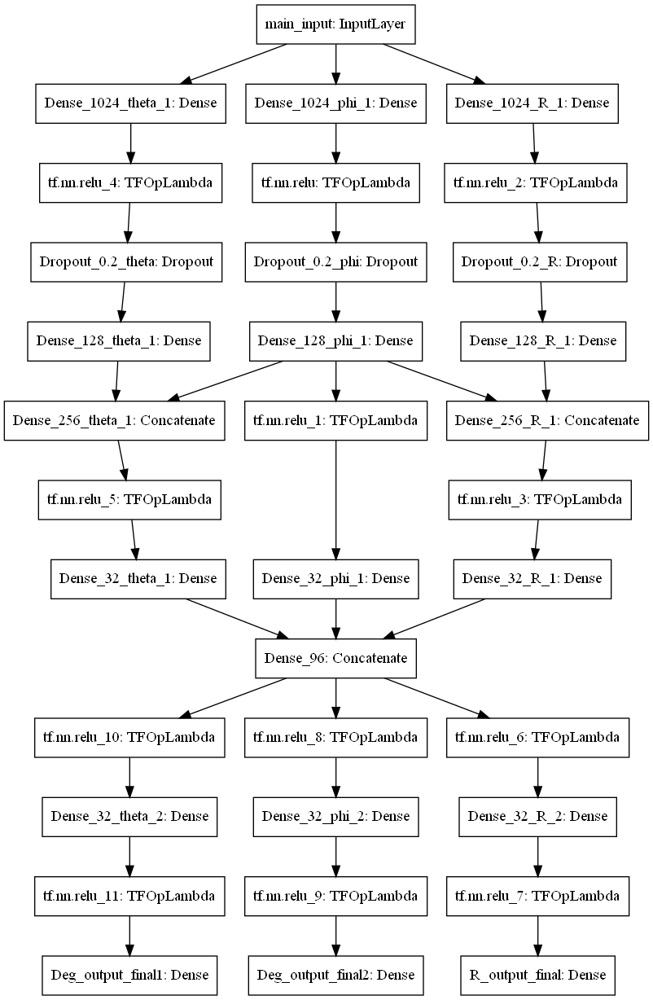

In [18]:
plot_model(pre_model, to_file='single_model.png')

In [19]:
lr_change=[]
train_times=[]

P_=final_feature_c
T1_=final_target_c[:,0]#提取归一化后的target
T2_=final_target_c[:,1]#提取归一化后的target ：，0意思是第一列
R_=final_target_c[:,2]
#P_index=range(len(T_))    #T未定义
P_index=range(len(T1_)) 
P_index

range(0, 9315)

In [20]:
Pa_=final_feature_d
T1a_=final_target_d[:,0]#提取归一化后的target
T2a_=final_target_d[:,1]#提取归一化后的target ：，0意思是第一列
Ra_=final_target_d[:,2]
Pa_index=range(len(T1a_))
Pa_index

range(0, 7000)

# 数据量太大，k折算不过来！考虑直接单次计算

In [21]:
from sklearn.model_selection import train_test_split
train,test,train,test=train_test_split(P_index,P_index,test_size=0.001,random_state=2021)

In [22]:
global i
i=0
i+=1#current fold number
p_train=P_
p_test=Pa_
r_train = R_.reshape(-1,1)
r_test = Ra_.reshape(-1,1)
t1_train=T1_.reshape(-1,1)
t1_test=T1a_.reshape(-1,1)
t2_train=T2_.reshape(-1,1)
t2_test=T2a_.reshape(-1,1)
lr0=0.0001
pre_model=single_model()
adam = Adam(lr=0.0001)
pre_model.compile(optimizer=adam,loss={'Deg_output_final1': 'mse','Deg_output_final2': 'mse', 'R_output_final': 'mse'},loss_weights={'Deg_output_final1': 1., 'Deg_output_final2': 1.,'R_output_final': 1.})
theta_loss_history=[]
phi_loss_history=[]
R_loss_history=[]
vtheta_loss_history=[]
vphi_loss_history=[]
vR_loss_history=[]
R2_theta_history=[]
vR2_theta_history=[]
R2_phi_history=[]
vR2_phi_history=[]
R2_R_history=[]
vR2_R_history=[]
#while lr0>0.000001:
lr_change.append(lr0)
history=r2_score_callback(training_data=[p_train, [t1_train,t2_train,r_train]], validation_data=[p_test,[t1_test,t2_test,r_test]])
checkpoint = ModelCheckpoint(filepath='single_model_at_present\\K='+str(i)+'.h5',
                             monitor = "val_loss",
                             verbose = 0,
                             save_best_only = "True",
                             mode = "max")
Model_result=pre_model.fit(p_train, [t1_train,t2_train,r_train],
                           epochs=15000,  # 数据被轮10000次
                           batch_size=131072,#数据集太庞大了，为了加快速度，尽可能利用显存131072
                           validation_data=(p_test,[t1_test,t2_test,r_test]),
                           callbacks=[est,learning_rate_control,checkpoint],verbose=1)
theta_loss_history+=list(Model_result.history['Deg_output_final1_loss'])
vtheta_loss_history+=list(Model_result.history['val_Deg_output_final1_loss'])
phi_loss_history+=list(Model_result.history['Deg_output_final2_loss'])
vphi_loss_history+=list(Model_result.history['val_Deg_output_final2_loss'])
R_loss_history+=list(Model_result.history['R_output_final_loss'])
vR_loss_history+=list(Model_result.history['val_R_output_final_loss'])

# R2_theta_history+=history.r2_t1_train 
# vR2_theta_history+=history.r2_t1_test
# R2_phi_history+=history.r2_t2_train    #数据集太庞大了，为了加快速度，不反馈了
# vR2_phi_history+=history.r2_t2_test
# R2_R_history+=history.r2_r_train
# vR2_R_history+=history.r2_r_test
    
K.set_value(adam.lr, 0.1 * lr0)
lr0=K.get_value(adam.lr)
train_times.append(len(theta_loss_history))
pre_model.compile(optimizer=adam,loss={'Deg_output_final1': 'mse','Deg_output_final2': 'mse', 'R_output_final': 'mse'},loss_weights={'Deg_output_final1': 1.,'Deg_output_final2': 1., 'R_output_final': 1.})
pre_model.save('single_model_at_present\\K='+str(i)+'_final.h5')
df2csv=pd.DataFrame({'theta_loss':theta_loss_history,'val_theta_loss':vtheta_loss_history,'phi_loss':phi_loss_history,'val_phi_loss':vphi_loss_history,'R_loss':R_loss_history,
                     'val_R_loss': vR_loss_history})
# df2csv2=pd.DataFrame({'theta_accuracy':R2_theta_history,'val_theta_accuracy':vR2_theta_history,'phi_accuracy':R2_phi_history,'val_phi_accuracy':vR2_phi_history,
#                      'R_accuracy':R2_R_history,'val_R_accuracy':vR2_R_history})
df2csv.to_csv('single_model_at_present//k='+str(i)+'_history_loss.txt',sep='\t',index=None)
#df2csv2.to_csv('single_model_at_present//k='+str(i)+'_history_accuracy.txt',sep='\t',index=None)

Epoch 1/15000
1/1 [==============================] - 6s 6s/step - loss: 1.0875 - Deg_output_final1_loss: 0.4395 - Deg_output_final2_loss: 0.3438 - R_output_final_loss: 0.3042 - val_loss: 1.1076 - val_Deg_output_final1_loss: 0.4247 - val_Deg_output_final2_loss: 0.3421 - val_R_output_final_loss: 0.3409
Epoch 2/15000
1/1 [==============================] - 0s 136ms/step - loss: 1.0348 - Deg_output_final1_loss: 0.4098 - Deg_output_final2_loss: 0.3376 - R_output_final_loss: 0.2874 - val_loss: 1.0536 - val_Deg_output_final1_loss: 0.3945 - val_Deg_output_final2_loss: 0.3356 - val_R_output_final_loss: 0.3235
Epoch 3/15000
1/1 [==============================] - 0s 130ms/step - loss: 0.9858 - Deg_output_final1_loss: 0.3822 - Deg_output_final2_loss: 0.3311 - R_output_final_loss: 0.2725 - val_loss: 1.0031 - val_Deg_output_final1_loss: 0.3674 - val_Deg_output_final2_loss: 0.3290 - val_R_output_final_loss: 0.3067
Epoch 4/15000
1/1 [==============================] - 0s 128ms/step - loss: 0.9418 - Deg_

Epoch 28/15000
1/1 [==============================] - 0s 133ms/step - loss: 0.4042 - Deg_output_final1_loss: 0.1100 - Deg_output_final2_loss: 0.2089 - R_output_final_loss: 0.0853 - val_loss: 0.4027 - val_Deg_output_final1_loss: 0.1085 - val_Deg_output_final2_loss: 0.2067 - val_R_output_final_loss: 0.0874
Epoch 29/15000
1/1 [==============================] - 0s 136ms/step - loss: 0.3936 - Deg_output_final1_loss: 0.1057 - Deg_output_final2_loss: 0.2030 - R_output_final_loss: 0.0850 - val_loss: 0.3920 - val_Deg_output_final1_loss: 0.1048 - val_Deg_output_final2_loss: 0.2014 - val_R_output_final_loss: 0.0857
Epoch 30/15000
1/1 [==============================] - 0s 139ms/step - loss: 0.3849 - Deg_output_final1_loss: 0.1024 - Deg_output_final2_loss: 0.1973 - R_output_final_loss: 0.0852 - val_loss: 0.3825 - val_Deg_output_final1_loss: 0.1019 - val_Deg_output_final2_loss: 0.1961 - val_R_output_final_loss: 0.0845
Epoch 31/15000
1/1 [==============================] - 0s 133ms/step - loss: 0.3768

Epoch 55/15000
1/1 [==============================] - 0s 135ms/step - loss: 0.2769 - Deg_output_final1_loss: 0.0927 - Deg_output_final2_loss: 0.1161 - R_output_final_loss: 0.0681 - val_loss: 0.2792 - val_Deg_output_final1_loss: 0.0927 - val_Deg_output_final2_loss: 0.1165 - val_R_output_final_loss: 0.0700
Epoch 56/15000
1/1 [==============================] - 0s 127ms/step - loss: 0.2752 - Deg_output_final1_loss: 0.0928 - Deg_output_final2_loss: 0.1149 - R_output_final_loss: 0.0674 - val_loss: 0.2769 - val_Deg_output_final1_loss: 0.0928 - val_Deg_output_final2_loss: 0.1153 - val_R_output_final_loss: 0.0688
Epoch 57/15000
1/1 [==============================] - 0s 144ms/step - loss: 0.2728 - Deg_output_final1_loss: 0.0924 - Deg_output_final2_loss: 0.1138 - R_output_final_loss: 0.0666 - val_loss: 0.2744 - val_Deg_output_final1_loss: 0.0928 - val_Deg_output_final2_loss: 0.1141 - val_R_output_final_loss: 0.0675
Epoch 58/15000
1/1 [==============================] - 0s 133ms/step - loss: 0.2701

Epoch 82/15000
1/1 [==============================] - 0s 135ms/step - loss: 0.2153 - Deg_output_final1_loss: 0.0854 - Deg_output_final2_loss: 0.0887 - R_output_final_loss: 0.0412 - val_loss: 0.2065 - val_Deg_output_final1_loss: 0.0828 - val_Deg_output_final2_loss: 0.0878 - val_R_output_final_loss: 0.0358
Epoch 83/15000
1/1 [==============================] - 0s 244ms/step - loss: 0.2120 - Deg_output_final1_loss: 0.0844 - Deg_output_final2_loss: 0.0876 - R_output_final_loss: 0.0401 - val_loss: 0.2035 - val_Deg_output_final1_loss: 0.0824 - val_Deg_output_final2_loss: 0.0865 - val_R_output_final_loss: 0.0345
Epoch 84/15000
1/1 [==============================] - 0s 133ms/step - loss: 0.2096 - Deg_output_final1_loss: 0.0844 - Deg_output_final2_loss: 0.0863 - R_output_final_loss: 0.0390 - val_loss: 0.2005 - val_Deg_output_final1_loss: 0.0820 - val_Deg_output_final2_loss: 0.0852 - val_R_output_final_loss: 0.0333
Epoch 85/15000
1/1 [==============================] - 0s 132ms/step - loss: 0.2071

Epoch 109/15000
1/1 [==============================] - 0s 134ms/step - loss: 0.1484 - Deg_output_final1_loss: 0.0735 - Deg_output_final2_loss: 0.0551 - R_output_final_loss: 0.0199 - val_loss: 0.1358 - val_Deg_output_final1_loss: 0.0682 - val_Deg_output_final2_loss: 0.0520 - val_R_output_final_loss: 0.0155
Epoch 110/15000
1/1 [==============================] - 0s 134ms/step - loss: 0.1461 - Deg_output_final1_loss: 0.0729 - Deg_output_final2_loss: 0.0538 - R_output_final_loss: 0.0195 - val_loss: 0.1336 - val_Deg_output_final1_loss: 0.0677 - val_Deg_output_final2_loss: 0.0508 - val_R_output_final_loss: 0.0151
Epoch 111/15000
1/1 [==============================] - 0s 131ms/step - loss: 0.1444 - Deg_output_final1_loss: 0.0726 - Deg_output_final2_loss: 0.0527 - R_output_final_loss: 0.0191 - val_loss: 0.1314 - val_Deg_output_final1_loss: 0.0671 - val_Deg_output_final2_loss: 0.0495 - val_R_output_final_loss: 0.0148
Epoch 112/15000
1/1 [==============================] - 0s 135ms/step - loss: 0.

Epoch 136/15000
1/1 [==============================] - 0s 132ms/step - loss: 0.1026 - Deg_output_final1_loss: 0.0619 - Deg_output_final2_loss: 0.0274 - R_output_final_loss: 0.0133 - val_loss: 0.0888 - val_Deg_output_final1_loss: 0.0545 - val_Deg_output_final2_loss: 0.0245 - val_R_output_final_loss: 0.0098
Epoch 137/15000
1/1 [==============================] - 0s 145ms/step - loss: 0.1022 - Deg_output_final1_loss: 0.0622 - Deg_output_final2_loss: 0.0268 - R_output_final_loss: 0.0132 - val_loss: 0.0874 - val_Deg_output_final1_loss: 0.0540 - val_Deg_output_final2_loss: 0.0237 - val_R_output_final_loss: 0.0097
Epoch 138/15000
1/1 [==============================] - 0s 134ms/step - loss: 0.0999 - Deg_output_final1_loss: 0.0613 - Deg_output_final2_loss: 0.0258 - R_output_final_loss: 0.0129 - val_loss: 0.0861 - val_Deg_output_final1_loss: 0.0536 - val_Deg_output_final2_loss: 0.0230 - val_R_output_final_loss: 0.0095
Epoch 139/15000
1/1 [==============================] - 0s 128ms/step - loss: 0.

Epoch 163/15000
1/1 [==============================] - 0s 129ms/step - loss: 0.0744 - Deg_output_final1_loss: 0.0497 - Deg_output_final2_loss: 0.0156 - R_output_final_loss: 0.0091 - val_loss: 0.0605 - val_Deg_output_final1_loss: 0.0408 - val_Deg_output_final2_loss: 0.0142 - val_R_output_final_loss: 0.0055
Epoch 164/15000
1/1 [==============================] - 0s 130ms/step - loss: 0.0729 - Deg_output_final1_loss: 0.0487 - Deg_output_final2_loss: 0.0154 - R_output_final_loss: 0.0089 - val_loss: 0.0596 - val_Deg_output_final1_loss: 0.0403 - val_Deg_output_final2_loss: 0.0140 - val_R_output_final_loss: 0.0053
Epoch 165/15000
1/1 [==============================] - 0s 130ms/step - loss: 0.0725 - Deg_output_final1_loss: 0.0487 - Deg_output_final2_loss: 0.0152 - R_output_final_loss: 0.0086 - val_loss: 0.0588 - val_Deg_output_final1_loss: 0.0397 - val_Deg_output_final2_loss: 0.0138 - val_R_output_final_loss: 0.0052
Epoch 166/15000
1/1 [==============================] - 0s 128ms/step - loss: 0.

Epoch 190/15000
1/1 [==============================] - 0s 129ms/step - loss: 0.0555 - Deg_output_final1_loss: 0.0374 - Deg_output_final2_loss: 0.0118 - R_output_final_loss: 0.0063 - val_loss: 0.0412 - val_Deg_output_final1_loss: 0.0284 - val_Deg_output_final2_loss: 0.0103 - val_R_output_final_loss: 0.0025
Epoch 191/15000
1/1 [==============================] - 0s 137ms/step - loss: 0.0549 - Deg_output_final1_loss: 0.0373 - Deg_output_final2_loss: 0.0116 - R_output_final_loss: 0.0060 - val_loss: 0.0407 - val_Deg_output_final1_loss: 0.0281 - val_Deg_output_final2_loss: 0.0102 - val_R_output_final_loss: 0.0024
Epoch 192/15000
1/1 [==============================] - 0s 132ms/step - loss: 0.0540 - Deg_output_final1_loss: 0.0365 - Deg_output_final2_loss: 0.0115 - R_output_final_loss: 0.0060 - val_loss: 0.0401 - val_Deg_output_final1_loss: 0.0277 - val_Deg_output_final2_loss: 0.0101 - val_R_output_final_loss: 0.0023
Epoch 193/15000
1/1 [==============================] - 0s 131ms/step - loss: 0.

Epoch 243/15000
1/1 [==============================] - 0s 134ms/step - loss: 0.0368 - Deg_output_final1_loss: 0.0252 - Deg_output_final2_loss: 0.0072 - R_output_final_loss: 0.0045 - val_loss: 0.0247 - val_Deg_output_final1_loss: 0.0176 - val_Deg_output_final2_loss: 0.0058 - val_R_output_final_loss: 0.0013
Epoch 244/15000
1/1 [==============================] - 0s 132ms/step - loss: 0.0363 - Deg_output_final1_loss: 0.0247 - Deg_output_final2_loss: 0.0072 - R_output_final_loss: 0.0043 - val_loss: 0.0246 - val_Deg_output_final1_loss: 0.0175 - val_Deg_output_final2_loss: 0.0057 - val_R_output_final_loss: 0.0014
Epoch 245/15000
1/1 [==============================] - 0s 130ms/step - loss: 0.0360 - Deg_output_final1_loss: 0.0247 - Deg_output_final2_loss: 0.0071 - R_output_final_loss: 0.0043 - val_loss: 0.0243 - val_Deg_output_final1_loss: 0.0173 - val_Deg_output_final2_loss: 0.0057 - val_R_output_final_loss: 0.0013
Epoch 246/15000
1/1 [==============================] - 0s 133ms/step - loss: 0.

Epoch 270/15000
1/1 [==============================] - 0s 130ms/step - loss: 0.0309 - Deg_output_final1_loss: 0.0213 - Deg_output_final2_loss: 0.0058 - R_output_final_loss: 0.0038 - val_loss: 0.0197 - val_Deg_output_final1_loss: 0.0144 - val_Deg_output_final2_loss: 0.0043 - val_R_output_final_loss: 9.9125e-04
Epoch 271/15000
1/1 [==============================] - 0s 138ms/step - loss: 0.0305 - Deg_output_final1_loss: 0.0209 - Deg_output_final2_loss: 0.0058 - R_output_final_loss: 0.0038 - val_loss: 0.0196 - val_Deg_output_final1_loss: 0.0143 - val_Deg_output_final2_loss: 0.0042 - val_R_output_final_loss: 0.0010
Epoch 272/15000
1/1 [==============================] - 0s 133ms/step - loss: 0.0302 - Deg_output_final1_loss: 0.0207 - Deg_output_final2_loss: 0.0057 - R_output_final_loss: 0.0038 - val_loss: 0.0195 - val_Deg_output_final1_loss: 0.0142 - val_Deg_output_final2_loss: 0.0042 - val_R_output_final_loss: 0.0010
Epoch 273/15000
1/1 [==============================] - 0s 134ms/step - loss

1/1 [==============================] - 0s 137ms/step - loss: 0.0235 - Deg_output_final1_loss: 0.0166 - Deg_output_final2_loss: 0.0040 - R_output_final_loss: 0.0029 - val_loss: 0.0133 - val_Deg_output_final1_loss: 0.0103 - val_Deg_output_final2_loss: 0.0023 - val_R_output_final_loss: 6.0333e-04
Epoch 323/15000
1/1 [==============================] - 0s 135ms/step - loss: 0.0231 - Deg_output_final1_loss: 0.0162 - Deg_output_final2_loss: 0.0039 - R_output_final_loss: 0.0030 - val_loss: 0.0132 - val_Deg_output_final1_loss: 0.0103 - val_Deg_output_final2_loss: 0.0023 - val_R_output_final_loss: 6.1170e-04
Epoch 324/15000
1/1 [==============================] - 0s 130ms/step - loss: 0.0230 - Deg_output_final1_loss: 0.0162 - Deg_output_final2_loss: 0.0039 - R_output_final_loss: 0.0029 - val_loss: 0.0132 - val_Deg_output_final1_loss: 0.0103 - val_Deg_output_final2_loss: 0.0023 - val_R_output_final_loss: 6.3250e-04
Epoch 325/15000
1/1 [==============================] - 0s 132ms/step - loss: 0.0231

1/1 [==============================] - 0s 130ms/step - loss: 0.0186 - Deg_output_final1_loss: 0.0131 - Deg_output_final2_loss: 0.0031 - R_output_final_loss: 0.0024 - val_loss: 0.0096 - val_Deg_output_final1_loss: 0.0075 - val_Deg_output_final2_loss: 0.0016 - val_R_output_final_loss: 4.5612e-04
Epoch 375/15000
1/1 [==============================] - 0s 133ms/step - loss: 0.0187 - Deg_output_final1_loss: 0.0133 - Deg_output_final2_loss: 0.0030 - R_output_final_loss: 0.0025 - val_loss: 0.0096 - val_Deg_output_final1_loss: 0.0075 - val_Deg_output_final2_loss: 0.0016 - val_R_output_final_loss: 4.8515e-04
Epoch 376/15000
1/1 [==============================] - 0s 137ms/step - loss: 0.0189 - Deg_output_final1_loss: 0.0134 - Deg_output_final2_loss: 0.0030 - R_output_final_loss: 0.0025 - val_loss: 0.0096 - val_Deg_output_final1_loss: 0.0075 - val_Deg_output_final2_loss: 0.0016 - val_R_output_final_loss: 5.5260e-04
Epoch 377/15000
1/1 [==============================] - 0s 133ms/step - loss: 0.0183

1/1 [==============================] - 0s 138ms/step - loss: 0.0157 - Deg_output_final1_loss: 0.0111 - Deg_output_final2_loss: 0.0026 - R_output_final_loss: 0.0021 - val_loss: 0.0077 - val_Deg_output_final1_loss: 0.0060 - val_Deg_output_final2_loss: 0.0013 - val_R_output_final_loss: 4.8842e-04
Epoch 427/15000
1/1 [==============================] - 0s 138ms/step - loss: 0.0157 - Deg_output_final1_loss: 0.0110 - Deg_output_final2_loss: 0.0026 - R_output_final_loss: 0.0021 - val_loss: 0.0078 - val_Deg_output_final1_loss: 0.0060 - val_Deg_output_final2_loss: 0.0012 - val_R_output_final_loss: 5.0217e-04
Epoch 428/15000
1/1 [==============================] - 0s 131ms/step - loss: 0.0157 - Deg_output_final1_loss: 0.0111 - Deg_output_final2_loss: 0.0026 - R_output_final_loss: 0.0020 - val_loss: 0.0077 - val_Deg_output_final1_loss: 0.0059 - val_Deg_output_final2_loss: 0.0012 - val_R_output_final_loss: 5.1775e-04
Epoch 429/15000
1/1 [==============================] - 0s 136ms/step - loss: 0.0159

1/1 [==============================] - 0s 130ms/step - loss: 0.0138 - Deg_output_final1_loss: 0.0097 - Deg_output_final2_loss: 0.0023 - R_output_final_loss: 0.0018 - val_loss: 0.0064 - val_Deg_output_final1_loss: 0.0049 - val_Deg_output_final2_loss: 0.0010 - val_R_output_final_loss: 4.2675e-04
Epoch 479/15000
1/1 [==============================] - 0s 134ms/step - loss: 0.0139 - Deg_output_final1_loss: 0.0098 - Deg_output_final2_loss: 0.0023 - R_output_final_loss: 0.0018 - val_loss: 0.0063 - val_Deg_output_final1_loss: 0.0049 - val_Deg_output_final2_loss: 0.0010 - val_R_output_final_loss: 4.3738e-04
Epoch 480/15000
1/1 [==============================] - 0s 130ms/step - loss: 0.0139 - Deg_output_final1_loss: 0.0098 - Deg_output_final2_loss: 0.0023 - R_output_final_loss: 0.0018 - val_loss: 0.0063 - val_Deg_output_final1_loss: 0.0048 - val_Deg_output_final2_loss: 0.0010 - val_R_output_final_loss: 4.5352e-04
Epoch 481/15000
1/1 [==============================] - 0s 131ms/step - loss: 0.0137

1/1 [==============================] - 0s 145ms/step - loss: 0.0122 - Deg_output_final1_loss: 0.0085 - Deg_output_final2_loss: 0.0021 - R_output_final_loss: 0.0016 - val_loss: 0.0054 - val_Deg_output_final1_loss: 0.0041 - val_Deg_output_final2_loss: 8.8217e-04 - val_R_output_final_loss: 4.2440e-04
Epoch 531/15000
1/1 [==============================] - 0s 131ms/step - loss: 0.0122 - Deg_output_final1_loss: 0.0085 - Deg_output_final2_loss: 0.0020 - R_output_final_loss: 0.0016 - val_loss: 0.0054 - val_Deg_output_final1_loss: 0.0041 - val_Deg_output_final2_loss: 8.6970e-04 - val_R_output_final_loss: 3.9406e-04
Epoch 532/15000
1/1 [==============================] - 0s 130ms/step - loss: 0.0120 - Deg_output_final1_loss: 0.0085 - Deg_output_final2_loss: 0.0020 - R_output_final_loss: 0.0016 - val_loss: 0.0053 - val_Deg_output_final1_loss: 0.0041 - val_Deg_output_final2_loss: 8.6074e-04 - val_R_output_final_loss: 3.5389e-04
Epoch 533/15000
1/1 [==============================] - 0s 139ms/step - 

1/1 [==============================] - 0s 131ms/step - loss: 0.0111 - Deg_output_final1_loss: 0.0078 - Deg_output_final2_loss: 0.0019 - R_output_final_loss: 0.0014 - val_loss: 0.0047 - val_Deg_output_final1_loss: 0.0036 - val_Deg_output_final2_loss: 7.6288e-04 - val_R_output_final_loss: 3.5887e-04
Epoch 583/15000
1/1 [==============================] - 0s 129ms/step - loss: 0.0112 - Deg_output_final1_loss: 0.0079 - Deg_output_final2_loss: 0.0019 - R_output_final_loss: 0.0014 - val_loss: 0.0047 - val_Deg_output_final1_loss: 0.0036 - val_Deg_output_final2_loss: 7.6148e-04 - val_R_output_final_loss: 3.4756e-04
Epoch 584/15000
1/1 [==============================] - 0s 142ms/step - loss: 0.0109 - Deg_output_final1_loss: 0.0076 - Deg_output_final2_loss: 0.0018 - R_output_final_loss: 0.0014 - val_loss: 0.0047 - val_Deg_output_final1_loss: 0.0036 - val_Deg_output_final2_loss: 7.5428e-04 - val_R_output_final_loss: 3.6176e-04
Epoch 585/15000
1/1 [==============================] - 0s 129ms/step - 

1/1 [==============================] - 0s 128ms/step - loss: 0.0099 - Deg_output_final1_loss: 0.0069 - Deg_output_final2_loss: 0.0017 - R_output_final_loss: 0.0013 - val_loss: 0.0042 - val_Deg_output_final1_loss: 0.0032 - val_Deg_output_final2_loss: 6.7092e-04 - val_R_output_final_loss: 3.1775e-04
Epoch 635/15000
1/1 [==============================] - 0s 130ms/step - loss: 0.0103 - Deg_output_final1_loss: 0.0073 - Deg_output_final2_loss: 0.0017 - R_output_final_loss: 0.0013 - val_loss: 0.0041 - val_Deg_output_final1_loss: 0.0032 - val_Deg_output_final2_loss: 6.6272e-04 - val_R_output_final_loss: 2.9564e-04
Epoch 636/15000
1/1 [==============================] - 0s 130ms/step - loss: 0.0101 - Deg_output_final1_loss: 0.0071 - Deg_output_final2_loss: 0.0017 - R_output_final_loss: 0.0013 - val_loss: 0.0041 - val_Deg_output_final1_loss: 0.0032 - val_Deg_output_final2_loss: 6.5702e-04 - val_R_output_final_loss: 2.8535e-04
Epoch 637/15000
1/1 [==============================] - 0s 130ms/step - 

1/1 [==============================] - 0s 128ms/step - loss: 0.0094 - Deg_output_final1_loss: 0.0067 - Deg_output_final2_loss: 0.0015 - R_output_final_loss: 0.0011 - val_loss: 0.0039 - val_Deg_output_final1_loss: 0.0030 - val_Deg_output_final2_loss: 5.9664e-04 - val_R_output_final_loss: 2.8156e-04
Epoch 687/15000
1/1 [==============================] - 0s 135ms/step - loss: 0.0094 - Deg_output_final1_loss: 0.0067 - Deg_output_final2_loss: 0.0016 - R_output_final_loss: 0.0012 - val_loss: 0.0037 - val_Deg_output_final1_loss: 0.0028 - val_Deg_output_final2_loss: 6.0246e-04 - val_R_output_final_loss: 2.4769e-04
Epoch 688/15000
1/1 [==============================] - 0s 128ms/step - loss: 0.0093 - Deg_output_final1_loss: 0.0065 - Deg_output_final2_loss: 0.0016 - R_output_final_loss: 0.0012 - val_loss: 0.0036 - val_Deg_output_final1_loss: 0.0028 - val_Deg_output_final2_loss: 6.0061e-04 - val_R_output_final_loss: 2.3505e-04
Epoch 689/15000
1/1 [==============================] - 0s 128ms/step - 

1/1 [==============================] - 0s 130ms/step - loss: 0.0086 - Deg_output_final1_loss: 0.0061 - Deg_output_final2_loss: 0.0015 - R_output_final_loss: 0.0011 - val_loss: 0.0034 - val_Deg_output_final1_loss: 0.0026 - val_Deg_output_final2_loss: 5.3770e-04 - val_R_output_final_loss: 2.1659e-04
Epoch 739/15000
1/1 [==============================] - 0s 129ms/step - loss: 0.0087 - Deg_output_final1_loss: 0.0062 - Deg_output_final2_loss: 0.0014 - R_output_final_loss: 0.0011 - val_loss: 0.0034 - val_Deg_output_final1_loss: 0.0026 - val_Deg_output_final2_loss: 5.4173e-04 - val_R_output_final_loss: 2.3707e-04
Epoch 740/15000
1/1 [==============================] - 0s 130ms/step - loss: 0.0086 - Deg_output_final1_loss: 0.0061 - Deg_output_final2_loss: 0.0014 - R_output_final_loss: 0.0011 - val_loss: 0.0034 - val_Deg_output_final1_loss: 0.0026 - val_Deg_output_final2_loss: 5.3898e-04 - val_R_output_final_loss: 2.4591e-04
Epoch 741/15000
1/1 [==============================] - 0s 131ms/step - 

1/1 [==============================] - 0s 129ms/step - loss: 0.0081 - Deg_output_final1_loss: 0.0058 - Deg_output_final2_loss: 0.0014 - R_output_final_loss: 9.7380e-04 - val_loss: 0.0030 - val_Deg_output_final1_loss: 0.0023 - val_Deg_output_final2_loss: 5.0420e-04 - val_R_output_final_loss: 1.6596e-04
Epoch 791/15000
1/1 [==============================] - 0s 239ms/step - loss: 0.0081 - Deg_output_final1_loss: 0.0058 - Deg_output_final2_loss: 0.0013 - R_output_final_loss: 9.9688e-04 - val_loss: 0.0030 - val_Deg_output_final1_loss: 0.0024 - val_Deg_output_final2_loss: 4.9700e-04 - val_R_output_final_loss: 1.7859e-04
Epoch 792/15000
1/1 [==============================] - 0s 130ms/step - loss: 0.0081 - Deg_output_final1_loss: 0.0057 - Deg_output_final2_loss: 0.0014 - R_output_final_loss: 0.0010 - val_loss: 0.0032 - val_Deg_output_final1_loss: 0.0025 - val_Deg_output_final2_loss: 4.9681e-04 - val_R_output_final_loss: 2.1631e-04
Epoch 793/15000
1/1 [==============================] - 0s 131ms

Epoch 816/15000
1/1 [==============================] - 0s 128ms/step - loss: 0.0079 - Deg_output_final1_loss: 0.0056 - Deg_output_final2_loss: 0.0013 - R_output_final_loss: 9.5247e-04 - val_loss: 0.0031 - val_Deg_output_final1_loss: 0.0024 - val_Deg_output_final2_loss: 4.8353e-04 - val_R_output_final_loss: 1.9326e-04
Epoch 817/15000
1/1 [==============================] - 0s 134ms/step - loss: 0.0079 - Deg_output_final1_loss: 0.0056 - Deg_output_final2_loss: 0.0013 - R_output_final_loss: 9.8835e-04 - val_loss: 0.0029 - val_Deg_output_final1_loss: 0.0022 - val_Deg_output_final2_loss: 4.9295e-04 - val_R_output_final_loss: 1.8760e-04
Epoch 818/15000
1/1 [==============================] - 0s 133ms/step - loss: 0.0077 - Deg_output_final1_loss: 0.0055 - Deg_output_final2_loss: 0.0013 - R_output_final_loss: 9.5309e-04 - val_loss: 0.0029 - val_Deg_output_final1_loss: 0.0023 - val_Deg_output_final2_loss: 4.8982e-04 - val_R_output_final_loss: 1.7774e-04
Epoch 819/15000
1/1 [======================

Epoch 842/15000
1/1 [==============================] - 0s 131ms/step - loss: 0.0076 - Deg_output_final1_loss: 0.0053 - Deg_output_final2_loss: 0.0013 - R_output_final_loss: 9.5317e-04 - val_loss: 0.0029 - val_Deg_output_final1_loss: 0.0022 - val_Deg_output_final2_loss: 4.6899e-04 - val_R_output_final_loss: 1.7635e-04
Epoch 843/15000
1/1 [==============================] - 0s 131ms/step - loss: 0.0076 - Deg_output_final1_loss: 0.0054 - Deg_output_final2_loss: 0.0013 - R_output_final_loss: 9.3351e-04 - val_loss: 0.0029 - val_Deg_output_final1_loss: 0.0022 - val_Deg_output_final2_loss: 4.6944e-04 - val_R_output_final_loss: 1.8747e-04
Epoch 844/15000
1/1 [==============================] - 0s 130ms/step - loss: 0.0074 - Deg_output_final1_loss: 0.0052 - Deg_output_final2_loss: 0.0013 - R_output_final_loss: 9.4540e-04 - val_loss: 0.0028 - val_Deg_output_final1_loss: 0.0022 - val_Deg_output_final2_loss: 4.6736e-04 - val_R_output_final_loss: 1.7078e-04
Epoch 845/15000
1/1 [======================

Epoch 868/15000
1/1 [==============================] - 0s 130ms/step - loss: 0.0073 - Deg_output_final1_loss: 0.0052 - Deg_output_final2_loss: 0.0012 - R_output_final_loss: 9.2512e-04 - val_loss: 0.0027 - val_Deg_output_final1_loss: 0.0022 - val_Deg_output_final2_loss: 4.4904e-04 - val_R_output_final_loss: 1.4334e-04
Epoch 869/15000
1/1 [==============================] - 0s 134ms/step - loss: 0.0074 - Deg_output_final1_loss: 0.0053 - Deg_output_final2_loss: 0.0012 - R_output_final_loss: 9.0638e-04 - val_loss: 0.0027 - val_Deg_output_final1_loss: 0.0021 - val_Deg_output_final2_loss: 4.5316e-04 - val_R_output_final_loss: 1.5239e-04
Epoch 870/15000
1/1 [==============================] - 0s 128ms/step - loss: 0.0075 - Deg_output_final1_loss: 0.0053 - Deg_output_final2_loss: 0.0013 - R_output_final_loss: 9.0461e-04 - val_loss: 0.0027 - val_Deg_output_final1_loss: 0.0021 - val_Deg_output_final2_loss: 4.5514e-04 - val_R_output_final_loss: 1.8268e-04
Epoch 871/15000
1/1 [======================

Epoch 894/15000
1/1 [==============================] - 0s 130ms/step - loss: 0.0071 - Deg_output_final1_loss: 0.0050 - Deg_output_final2_loss: 0.0012 - R_output_final_loss: 8.5048e-04 - val_loss: 0.0027 - val_Deg_output_final1_loss: 0.0021 - val_Deg_output_final2_loss: 4.3657e-04 - val_R_output_final_loss: 1.6327e-04
Epoch 895/15000
1/1 [==============================] - 0s 133ms/step - loss: 0.0072 - Deg_output_final1_loss: 0.0051 - Deg_output_final2_loss: 0.0012 - R_output_final_loss: 8.7060e-04 - val_loss: 0.0027 - val_Deg_output_final1_loss: 0.0021 - val_Deg_output_final2_loss: 4.3632e-04 - val_R_output_final_loss: 1.7100e-04
Epoch 896/15000
1/1 [==============================] - 0s 287ms/step - loss: 0.0072 - Deg_output_final1_loss: 0.0051 - Deg_output_final2_loss: 0.0012 - R_output_final_loss: 8.5574e-04 - val_loss: 0.0026 - val_Deg_output_final1_loss: 0.0020 - val_Deg_output_final2_loss: 4.3819e-04 - val_R_output_final_loss: 1.6039e-04
Epoch 897/15000
1/1 [======================

Epoch 920/15000
1/1 [==============================] - 0s 128ms/step - loss: 0.0069 - Deg_output_final1_loss: 0.0049 - Deg_output_final2_loss: 0.0012 - R_output_final_loss: 8.4446e-04 - val_loss: 0.0025 - val_Deg_output_final1_loss: 0.0020 - val_Deg_output_final2_loss: 4.3144e-04 - val_R_output_final_loss: 1.3084e-04
Epoch 921/15000
1/1 [==============================] - 0s 134ms/step - loss: 0.0071 - Deg_output_final1_loss: 0.0050 - Deg_output_final2_loss: 0.0012 - R_output_final_loss: 8.6229e-04 - val_loss: 0.0025 - val_Deg_output_final1_loss: 0.0019 - val_Deg_output_final2_loss: 4.3239e-04 - val_R_output_final_loss: 1.2626e-04
Epoch 922/15000
1/1 [==============================] - 0s 139ms/step - loss: 0.0070 - Deg_output_final1_loss: 0.0050 - Deg_output_final2_loss: 0.0012 - R_output_final_loss: 8.2946e-04 - val_loss: 0.0026 - val_Deg_output_final1_loss: 0.0020 - val_Deg_output_final2_loss: 4.2596e-04 - val_R_output_final_loss: 1.4529e-04
Epoch 923/15000
1/1 [======================

Epoch 946/15000
1/1 [==============================] - 0s 127ms/step - loss: 0.0068 - Deg_output_final1_loss: 0.0048 - Deg_output_final2_loss: 0.0011 - R_output_final_loss: 8.0062e-04 - val_loss: 0.0025 - val_Deg_output_final1_loss: 0.0020 - val_Deg_output_final2_loss: 4.1113e-04 - val_R_output_final_loss: 1.2806e-04
Epoch 947/15000
1/1 [==============================] - 0s 131ms/step - loss: 0.0068 - Deg_output_final1_loss: 0.0048 - Deg_output_final2_loss: 0.0011 - R_output_final_loss: 8.1872e-04 - val_loss: 0.0024 - val_Deg_output_final1_loss: 0.0019 - val_Deg_output_final2_loss: 4.0920e-04 - val_R_output_final_loss: 1.1122e-04
Epoch 948/15000
1/1 [==============================] - 0s 140ms/step - loss: 0.0069 - Deg_output_final1_loss: 0.0050 - Deg_output_final2_loss: 0.0011 - R_output_final_loss: 8.4535e-04 - val_loss: 0.0024 - val_Deg_output_final1_loss: 0.0019 - val_Deg_output_final2_loss: 4.0802e-04 - val_R_output_final_loss: 1.1946e-04
Epoch 949/15000
1/1 [======================

Epoch 972/15000
1/1 [==============================] - 0s 140ms/step - loss: 0.0066 - Deg_output_final1_loss: 0.0047 - Deg_output_final2_loss: 0.0011 - R_output_final_loss: 8.0465e-04 - val_loss: 0.0024 - val_Deg_output_final1_loss: 0.0019 - val_Deg_output_final2_loss: 3.9588e-04 - val_R_output_final_loss: 1.2468e-04
Epoch 973/15000
1/1 [==============================] - 0s 129ms/step - loss: 0.0067 - Deg_output_final1_loss: 0.0048 - Deg_output_final2_loss: 0.0011 - R_output_final_loss: 8.1656e-04 - val_loss: 0.0024 - val_Deg_output_final1_loss: 0.0018 - val_Deg_output_final2_loss: 4.0460e-04 - val_R_output_final_loss: 1.3709e-04
Epoch 974/15000
1/1 [==============================] - 0s 131ms/step - loss: 0.0067 - Deg_output_final1_loss: 0.0048 - Deg_output_final2_loss: 0.0011 - R_output_final_loss: 7.9604e-04 - val_loss: 0.0024 - val_Deg_output_final1_loss: 0.0019 - val_Deg_output_final2_loss: 4.0854e-04 - val_R_output_final_loss: 1.4365e-04
Epoch 975/15000
1/1 [======================

Epoch 998/15000
1/1 [==============================] - 0s 138ms/step - loss: 0.0066 - Deg_output_final1_loss: 0.0047 - Deg_output_final2_loss: 0.0011 - R_output_final_loss: 7.5848e-04 - val_loss: 0.0023 - val_Deg_output_final1_loss: 0.0018 - val_Deg_output_final2_loss: 3.9844e-04 - val_R_output_final_loss: 1.1235e-04
Epoch 999/15000
1/1 [==============================] - 0s 133ms/step - loss: 0.0065 - Deg_output_final1_loss: 0.0046 - Deg_output_final2_loss: 0.0011 - R_output_final_loss: 7.7558e-04 - val_loss: 0.0024 - val_Deg_output_final1_loss: 0.0019 - val_Deg_output_final2_loss: 3.9368e-04 - val_R_output_final_loss: 1.0835e-04
Epoch 1000/15000
1/1 [==============================] - 0s 130ms/step - loss: 0.0065 - Deg_output_final1_loss: 0.0047 - Deg_output_final2_loss: 0.0011 - R_output_final_loss: 7.6134e-04 - val_loss: 0.0023 - val_Deg_output_final1_loss: 0.0018 - val_Deg_output_final2_loss: 3.9350e-04 - val_R_output_final_loss: 1.1116e-04
Epoch 1001/15000
1/1 [====================

Epoch 1024/15000
1/1 [==============================] - 0s 131ms/step - loss: 0.0064 - Deg_output_final1_loss: 0.0046 - Deg_output_final2_loss: 0.0010 - R_output_final_loss: 7.1627e-04 - val_loss: 0.0022 - val_Deg_output_final1_loss: 0.0017 - val_Deg_output_final2_loss: 3.7850e-04 - val_R_output_final_loss: 1.1726e-04
Epoch 1025/15000
1/1 [==============================] - 0s 131ms/step - loss: 0.0064 - Deg_output_final1_loss: 0.0046 - Deg_output_final2_loss: 0.0010 - R_output_final_loss: 7.4765e-04 - val_loss: 0.0022 - val_Deg_output_final1_loss: 0.0017 - val_Deg_output_final2_loss: 3.8420e-04 - val_R_output_final_loss: 1.0812e-04
Epoch 1026/15000
1/1 [==============================] - 0s 138ms/step - loss: 0.0063 - Deg_output_final1_loss: 0.0044 - Deg_output_final2_loss: 0.0011 - R_output_final_loss: 7.7014e-04 - val_loss: 0.0022 - val_Deg_output_final1_loss: 0.0017 - val_Deg_output_final2_loss: 3.9142e-04 - val_R_output_final_loss: 1.1478e-04
Epoch 1027/15000
1/1 [==================

Epoch 1050/15000
1/1 [==============================] - 0s 129ms/step - loss: 0.0061 - Deg_output_final1_loss: 0.0044 - Deg_output_final2_loss: 9.9959e-04 - R_output_final_loss: 7.4130e-04 - val_loss: 0.0022 - val_Deg_output_final1_loss: 0.0017 - val_Deg_output_final2_loss: 3.7171e-04 - val_R_output_final_loss: 1.1439e-04
Epoch 1051/15000
1/1 [==============================] - 0s 137ms/step - loss: 0.0062 - Deg_output_final1_loss: 0.0045 - Deg_output_final2_loss: 9.7713e-04 - R_output_final_loss: 7.1654e-04 - val_loss: 0.0021 - val_Deg_output_final1_loss: 0.0017 - val_Deg_output_final2_loss: 3.7576e-04 - val_R_output_final_loss: 1.0248e-04
Epoch 1052/15000
1/1 [==============================] - 0s 136ms/step - loss: 0.0062 - Deg_output_final1_loss: 0.0044 - Deg_output_final2_loss: 9.9973e-04 - R_output_final_loss: 7.4531e-04 - val_loss: 0.0023 - val_Deg_output_final1_loss: 0.0018 - val_Deg_output_final2_loss: 3.6974e-04 - val_R_output_final_loss: 1.1959e-04
Epoch 1053/15000
1/1 [======

1/1 [==============================] - 0s 134ms/step - loss: 0.0059 - Deg_output_final1_loss: 0.0043 - Deg_output_final2_loss: 9.3770e-04 - R_output_final_loss: 6.9468e-04 - val_loss: 0.0021 - val_Deg_output_final1_loss: 0.0016 - val_Deg_output_final2_loss: 3.4084e-04 - val_R_output_final_loss: 1.3099e-04
Epoch 1101/15000
1/1 [==============================] - 0s 138ms/step - loss: 0.0058 - Deg_output_final1_loss: 0.0042 - Deg_output_final2_loss: 9.5844e-04 - R_output_final_loss: 6.6734e-04 - val_loss: 0.0021 - val_Deg_output_final1_loss: 0.0017 - val_Deg_output_final2_loss: 3.4053e-04 - val_R_output_final_loss: 1.1562e-04
Epoch 1102/15000
1/1 [==============================] - 0s 130ms/step - loss: 0.0058 - Deg_output_final1_loss: 0.0042 - Deg_output_final2_loss: 9.6915e-04 - R_output_final_loss: 6.8169e-04 - val_loss: 0.0020 - val_Deg_output_final1_loss: 0.0016 - val_Deg_output_final2_loss: 3.4485e-04 - val_R_output_final_loss: 9.8347e-05
Epoch 1103/15000
1/1 [=======================

1/1 [==============================] - 0s 132ms/step - loss: 0.0057 - Deg_output_final1_loss: 0.0041 - Deg_output_final2_loss: 9.4110e-04 - R_output_final_loss: 6.5880e-04 - val_loss: 0.0020 - val_Deg_output_final1_loss: 0.0016 - val_Deg_output_final2_loss: 3.2473e-04 - val_R_output_final_loss: 1.1294e-04
Epoch 1151/15000
1/1 [==============================] - 0s 130ms/step - loss: 0.0056 - Deg_output_final1_loss: 0.0040 - Deg_output_final2_loss: 9.1377e-04 - R_output_final_loss: 6.7437e-04 - val_loss: 0.0020 - val_Deg_output_final1_loss: 0.0016 - val_Deg_output_final2_loss: 3.2362e-04 - val_R_output_final_loss: 1.0478e-04
Epoch 1152/15000
1/1 [==============================] - 0s 130ms/step - loss: 0.0056 - Deg_output_final1_loss: 0.0040 - Deg_output_final2_loss: 9.0873e-04 - R_output_final_loss: 6.4788e-04 - val_loss: 0.0019 - val_Deg_output_final1_loss: 0.0015 - val_Deg_output_final2_loss: 3.2650e-04 - val_R_output_final_loss: 9.7107e-05
Epoch 1153/15000
1/1 [=======================

1/1 [==============================] - 0s 129ms/step - loss: 0.0055 - Deg_output_final1_loss: 0.0040 - Deg_output_final2_loss: 8.7311e-04 - R_output_final_loss: 6.4368e-04 - val_loss: 0.0019 - val_Deg_output_final1_loss: 0.0015 - val_Deg_output_final2_loss: 3.0877e-04 - val_R_output_final_loss: 1.0444e-04
Epoch 1201/15000
1/1 [==============================] - 0s 131ms/step - loss: 0.0054 - Deg_output_final1_loss: 0.0039 - Deg_output_final2_loss: 8.7106e-04 - R_output_final_loss: 6.3394e-04 - val_loss: 0.0019 - val_Deg_output_final1_loss: 0.0015 - val_Deg_output_final2_loss: 3.0563e-04 - val_R_output_final_loss: 1.0590e-04
Epoch 1202/15000
1/1 [==============================] - 0s 140ms/step - loss: 0.0054 - Deg_output_final1_loss: 0.0039 - Deg_output_final2_loss: 8.8025e-04 - R_output_final_loss: 6.2863e-04 - val_loss: 0.0019 - val_Deg_output_final1_loss: 0.0015 - val_Deg_output_final2_loss: 3.0530e-04 - val_R_output_final_loss: 9.8957e-05
Epoch 1203/15000
1/1 [=======================

1/1 [==============================] - 0s 138ms/step - loss: 0.0054 - Deg_output_final1_loss: 0.0040 - Deg_output_final2_loss: 8.3387e-04 - R_output_final_loss: 6.0769e-04 - val_loss: 0.0019 - val_Deg_output_final1_loss: 0.0015 - val_Deg_output_final2_loss: 2.9252e-04 - val_R_output_final_loss: 9.9853e-05
Epoch 1251/15000
1/1 [==============================] - 0s 132ms/step - loss: 0.0053 - Deg_output_final1_loss: 0.0039 - Deg_output_final2_loss: 8.5476e-04 - R_output_final_loss: 6.0694e-04 - val_loss: 0.0019 - val_Deg_output_final1_loss: 0.0015 - val_Deg_output_final2_loss: 2.9203e-04 - val_R_output_final_loss: 1.0790e-04
Epoch 1252/15000
1/1 [==============================] - 0s 141ms/step - loss: 0.0053 - Deg_output_final1_loss: 0.0039 - Deg_output_final2_loss: 8.2624e-04 - R_output_final_loss: 5.9387e-04 - val_loss: 0.0018 - val_Deg_output_final1_loss: 0.0014 - val_Deg_output_final2_loss: 2.9449e-04 - val_R_output_final_loss: 1.0311e-04
Epoch 1253/15000
1/1 [=======================

1/1 [==============================] - 0s 135ms/step - loss: 0.0052 - Deg_output_final1_loss: 0.0038 - Deg_output_final2_loss: 8.1977e-04 - R_output_final_loss: 5.9140e-04 - val_loss: 0.0017 - val_Deg_output_final1_loss: 0.0014 - val_Deg_output_final2_loss: 2.7771e-04 - val_R_output_final_loss: 8.2600e-05
Epoch 1301/15000
1/1 [==============================] - 0s 128ms/step - loss: 0.0051 - Deg_output_final1_loss: 0.0037 - Deg_output_final2_loss: 8.3200e-04 - R_output_final_loss: 5.8514e-04 - val_loss: 0.0017 - val_Deg_output_final1_loss: 0.0013 - val_Deg_output_final2_loss: 2.8105e-04 - val_R_output_final_loss: 9.6738e-05
Epoch 1302/15000
1/1 [==============================] - 0s 248ms/step - loss: 0.0051 - Deg_output_final1_loss: 0.0038 - Deg_output_final2_loss: 7.8564e-04 - R_output_final_loss: 5.7997e-04 - val_loss: 0.0019 - val_Deg_output_final1_loss: 0.0015 - val_Deg_output_final2_loss: 2.7418e-04 - val_R_output_final_loss: 1.0805e-04
Epoch 1303/15000
1/1 [=======================

1/1 [==============================] - 0s 131ms/step - loss: 0.0049 - Deg_output_final1_loss: 0.0036 - Deg_output_final2_loss: 7.6549e-04 - R_output_final_loss: 5.6038e-04 - val_loss: 0.0017 - val_Deg_output_final1_loss: 0.0013 - val_Deg_output_final2_loss: 2.6145e-04 - val_R_output_final_loss: 8.7059e-05
Epoch 1351/15000
1/1 [==============================] - 0s 130ms/step - loss: 0.0050 - Deg_output_final1_loss: 0.0037 - Deg_output_final2_loss: 7.8639e-04 - R_output_final_loss: 5.7104e-04 - val_loss: 0.0017 - val_Deg_output_final1_loss: 0.0013 - val_Deg_output_final2_loss: 2.5917e-04 - val_R_output_final_loss: 8.5905e-05
Epoch 1352/15000
1/1 [==============================] - 0s 132ms/step - loss: 0.0049 - Deg_output_final1_loss: 0.0036 - Deg_output_final2_loss: 7.6332e-04 - R_output_final_loss: 5.5442e-04 - val_loss: 0.0017 - val_Deg_output_final1_loss: 0.0013 - val_Deg_output_final2_loss: 2.6218e-04 - val_R_output_final_loss: 8.9398e-05
Epoch 1353/15000
1/1 [=======================

1/1 [==============================] - 0s 248ms/step - loss: 0.0047 - Deg_output_final1_loss: 0.0034 - Deg_output_final2_loss: 7.4840e-04 - R_output_final_loss: 5.3378e-04 - val_loss: 0.0017 - val_Deg_output_final1_loss: 0.0013 - val_Deg_output_final2_loss: 2.5184e-04 - val_R_output_final_loss: 7.6943e-05
Epoch 1401/15000
1/1 [==============================] - 0s 143ms/step - loss: 0.0048 - Deg_output_final1_loss: 0.0035 - Deg_output_final2_loss: 7.4017e-04 - R_output_final_loss: 5.5566e-04 - val_loss: 0.0016 - val_Deg_output_final1_loss: 0.0013 - val_Deg_output_final2_loss: 2.5259e-04 - val_R_output_final_loss: 7.8570e-05
Epoch 1402/15000
1/1 [==============================] - 0s 132ms/step - loss: 0.0049 - Deg_output_final1_loss: 0.0036 - Deg_output_final2_loss: 7.4533e-04 - R_output_final_loss: 5.5268e-04 - val_loss: 0.0017 - val_Deg_output_final1_loss: 0.0013 - val_Deg_output_final2_loss: 2.5157e-04 - val_R_output_final_loss: 9.8710e-05
Epoch 1403/15000
1/1 [=======================

1/1 [==============================] - 0s 132ms/step - loss: 0.0047 - Deg_output_final1_loss: 0.0034 - Deg_output_final2_loss: 7.4179e-04 - R_output_final_loss: 5.3288e-04 - val_loss: 0.0016 - val_Deg_output_final1_loss: 0.0013 - val_Deg_output_final2_loss: 2.4378e-04 - val_R_output_final_loss: 9.2382e-05
Epoch 1451/15000
1/1 [==============================] - 0s 136ms/step - loss: 0.0047 - Deg_output_final1_loss: 0.0034 - Deg_output_final2_loss: 7.1410e-04 - R_output_final_loss: 5.3509e-04 - val_loss: 0.0016 - val_Deg_output_final1_loss: 0.0012 - val_Deg_output_final2_loss: 2.4390e-04 - val_R_output_final_loss: 7.4229e-05
Epoch 1452/15000
1/1 [==============================] - 0s 130ms/step - loss: 0.0047 - Deg_output_final1_loss: 0.0035 - Deg_output_final2_loss: 7.2124e-04 - R_output_final_loss: 5.2079e-04 - val_loss: 0.0015 - val_Deg_output_final1_loss: 0.0012 - val_Deg_output_final2_loss: 2.4251e-04 - val_R_output_final_loss: 7.0756e-05
Epoch 1453/15000
1/1 [=======================

1/1 [==============================] - 0s 129ms/step - loss: 0.0046 - Deg_output_final1_loss: 0.0034 - Deg_output_final2_loss: 6.9714e-04 - R_output_final_loss: 5.1236e-04 - val_loss: 0.0015 - val_Deg_output_final1_loss: 0.0012 - val_Deg_output_final2_loss: 2.2875e-04 - val_R_output_final_loss: 7.0019e-05
Epoch 1501/15000
1/1 [==============================] - 0s 131ms/step - loss: 0.0046 - Deg_output_final1_loss: 0.0034 - Deg_output_final2_loss: 7.1142e-04 - R_output_final_loss: 5.1867e-04 - val_loss: 0.0015 - val_Deg_output_final1_loss: 0.0012 - val_Deg_output_final2_loss: 2.2933e-04 - val_R_output_final_loss: 7.2541e-05
Epoch 1502/15000
1/1 [==============================] - 0s 131ms/step - loss: 0.0047 - Deg_output_final1_loss: 0.0034 - Deg_output_final2_loss: 6.9358e-04 - R_output_final_loss: 5.1692e-04 - val_loss: 0.0016 - val_Deg_output_final1_loss: 0.0013 - val_Deg_output_final2_loss: 2.2987e-04 - val_R_output_final_loss: 8.7392e-05
Epoch 1503/15000
1/1 [=======================

1/1 [==============================] - 0s 131ms/step - loss: 0.0044 - Deg_output_final1_loss: 0.0033 - Deg_output_final2_loss: 6.7988e-04 - R_output_final_loss: 4.9409e-04 - val_loss: 0.0015 - val_Deg_output_final1_loss: 0.0012 - val_Deg_output_final2_loss: 2.2098e-04 - val_R_output_final_loss: 8.1710e-05
Epoch 1551/15000
1/1 [==============================] - 0s 133ms/step - loss: 0.0045 - Deg_output_final1_loss: 0.0034 - Deg_output_final2_loss: 6.7513e-04 - R_output_final_loss: 4.7741e-04 - val_loss: 0.0015 - val_Deg_output_final1_loss: 0.0012 - val_Deg_output_final2_loss: 2.2029e-04 - val_R_output_final_loss: 7.6067e-05
Epoch 1552/15000
1/1 [==============================] - 0s 130ms/step - loss: 0.0044 - Deg_output_final1_loss: 0.0033 - Deg_output_final2_loss: 6.5486e-04 - R_output_final_loss: 4.7240e-04 - val_loss: 0.0014 - val_Deg_output_final1_loss: 0.0012 - val_Deg_output_final2_loss: 2.2069e-04 - val_R_output_final_loss: 6.7363e-05
Epoch 1553/15000
1/1 [=======================

1/1 [==============================] - 0s 134ms/step - loss: 0.0044 - Deg_output_final1_loss: 0.0032 - Deg_output_final2_loss: 6.4911e-04 - R_output_final_loss: 4.8211e-04 - val_loss: 0.0015 - val_Deg_output_final1_loss: 0.0012 - val_Deg_output_final2_loss: 2.1355e-04 - val_R_output_final_loss: 8.1437e-05
Epoch 1601/15000
1/1 [==============================] - 0s 134ms/step - loss: 0.0044 - Deg_output_final1_loss: 0.0032 - Deg_output_final2_loss: 6.5461e-04 - R_output_final_loss: 4.7737e-04 - val_loss: 0.0014 - val_Deg_output_final1_loss: 0.0011 - val_Deg_output_final2_loss: 2.1457e-04 - val_R_output_final_loss: 8.1771e-05
Epoch 1602/15000
1/1 [==============================] - 0s 146ms/step - loss: 0.0043 - Deg_output_final1_loss: 0.0032 - Deg_output_final2_loss: 6.4972e-04 - R_output_final_loss: 4.8292e-04 - val_loss: 0.0014 - val_Deg_output_final1_loss: 0.0011 - val_Deg_output_final2_loss: 2.1075e-04 - val_R_output_final_loss: 7.1667e-05
Epoch 1603/15000
1/1 [=======================

1/1 [==============================] - 0s 155ms/step - loss: 0.0043 - Deg_output_final1_loss: 0.0032 - Deg_output_final2_loss: 6.2751e-04 - R_output_final_loss: 4.6425e-04 - val_loss: 0.0014 - val_Deg_output_final1_loss: 0.0011 - val_Deg_output_final2_loss: 2.0533e-04 - val_R_output_final_loss: 6.9089e-05
Epoch 1651/15000
1/1 [==============================] - 0s 150ms/step - loss: 0.0042 - Deg_output_final1_loss: 0.0031 - Deg_output_final2_loss: 6.3818e-04 - R_output_final_loss: 4.6690e-04 - val_loss: 0.0015 - val_Deg_output_final1_loss: 0.0012 - val_Deg_output_final2_loss: 2.0400e-04 - val_R_output_final_loss: 6.8884e-05
Epoch 1652/15000
1/1 [==============================] - 0s 149ms/step - loss: 0.0042 - Deg_output_final1_loss: 0.0031 - Deg_output_final2_loss: 6.5109e-04 - R_output_final_loss: 4.7522e-04 - val_loss: 0.0014 - val_Deg_output_final1_loss: 0.0011 - val_Deg_output_final2_loss: 2.0311e-04 - val_R_output_final_loss: 6.3289e-05
Epoch 1653/15000
1/1 [=======================

1/1 [==============================] - 0s 152ms/step - loss: 0.0042 - Deg_output_final1_loss: 0.0031 - Deg_output_final2_loss: 6.3038e-04 - R_output_final_loss: 4.5431e-04 - val_loss: 0.0013 - val_Deg_output_final1_loss: 0.0011 - val_Deg_output_final2_loss: 1.9628e-04 - val_R_output_final_loss: 6.3594e-05
Epoch 1701/15000
1/1 [==============================] - 0s 154ms/step - loss: 0.0041 - Deg_output_final1_loss: 0.0031 - Deg_output_final2_loss: 5.8302e-04 - R_output_final_loss: 4.4048e-04 - val_loss: 0.0013 - val_Deg_output_final1_loss: 0.0011 - val_Deg_output_final2_loss: 1.9669e-04 - val_R_output_final_loss: 6.6121e-05
Epoch 1702/15000
1/1 [==============================] - 0s 162ms/step - loss: 0.0041 - Deg_output_final1_loss: 0.0030 - Deg_output_final2_loss: 5.9943e-04 - R_output_final_loss: 4.5187e-04 - val_loss: 0.0014 - val_Deg_output_final1_loss: 0.0012 - val_Deg_output_final2_loss: 1.9620e-04 - val_R_output_final_loss: 6.6954e-05
Epoch 1703/15000
1/1 [=======================

1/1 [==============================] - 0s 158ms/step - loss: 0.0041 - Deg_output_final1_loss: 0.0030 - Deg_output_final2_loss: 6.0709e-04 - R_output_final_loss: 4.5391e-04 - val_loss: 0.0013 - val_Deg_output_final1_loss: 0.0011 - val_Deg_output_final2_loss: 1.8768e-04 - val_R_output_final_loss: 6.0223e-05
Epoch 1751/15000
1/1 [==============================] - 0s 153ms/step - loss: 0.0041 - Deg_output_final1_loss: 0.0031 - Deg_output_final2_loss: 5.8980e-04 - R_output_final_loss: 4.3689e-04 - val_loss: 0.0013 - val_Deg_output_final1_loss: 0.0010 - val_Deg_output_final2_loss: 1.9116e-04 - val_R_output_final_loss: 5.9971e-05
Epoch 1752/15000
1/1 [==============================] - 0s 152ms/step - loss: 0.0041 - Deg_output_final1_loss: 0.0031 - Deg_output_final2_loss: 6.0651e-04 - R_output_final_loss: 4.4356e-04 - val_loss: 0.0013 - val_Deg_output_final1_loss: 0.0010 - val_Deg_output_final2_loss: 1.9551e-04 - val_R_output_final_loss: 6.4532e-05
Epoch 1753/15000
1/1 [=======================

1/1 [==============================] - 0s 145ms/step - loss: 0.0040 - Deg_output_final1_loss: 0.0030 - Deg_output_final2_loss: 5.9082e-04 - R_output_final_loss: 4.2440e-04 - val_loss: 0.0013 - val_Deg_output_final1_loss: 0.0010 - val_Deg_output_final2_loss: 1.8122e-04 - val_R_output_final_loss: 6.2446e-05
Epoch 1801/15000
1/1 [==============================] - 0s 144ms/step - loss: 0.0040 - Deg_output_final1_loss: 0.0030 - Deg_output_final2_loss: 5.8153e-04 - R_output_final_loss: 4.3473e-04 - val_loss: 0.0013 - val_Deg_output_final1_loss: 0.0010 - val_Deg_output_final2_loss: 1.8239e-04 - val_R_output_final_loss: 5.3858e-05
Epoch 1802/15000
1/1 [==============================] - 0s 148ms/step - loss: 0.0040 - Deg_output_final1_loss: 0.0030 - Deg_output_final2_loss: 5.7091e-04 - R_output_final_loss: 4.2641e-04 - val_loss: 0.0013 - val_Deg_output_final1_loss: 0.0010 - val_Deg_output_final2_loss: 1.8513e-04 - val_R_output_final_loss: 5.3149e-05
Epoch 1803/15000
1/1 [=======================

1/1 [==============================] - 0s 150ms/step - loss: 0.0039 - Deg_output_final1_loss: 0.0029 - Deg_output_final2_loss: 5.5222e-04 - R_output_final_loss: 4.1316e-04 - val_loss: 0.0012 - val_Deg_output_final1_loss: 9.9189e-04 - val_Deg_output_final2_loss: 1.7977e-04 - val_R_output_final_loss: 5.7561e-05
Epoch 1851/15000
1/1 [==============================] - 0s 144ms/step - loss: 0.0039 - Deg_output_final1_loss: 0.0029 - Deg_output_final2_loss: 5.7094e-04 - R_output_final_loss: 3.9899e-04 - val_loss: 0.0013 - val_Deg_output_final1_loss: 0.0011 - val_Deg_output_final2_loss: 1.7668e-04 - val_R_output_final_loss: 6.1208e-05
Epoch 1852/15000
1/1 [==============================] - 0s 144ms/step - loss: 0.0039 - Deg_output_final1_loss: 0.0029 - Deg_output_final2_loss: 5.6249e-04 - R_output_final_loss: 4.1315e-04 - val_loss: 0.0012 - val_Deg_output_final1_loss: 9.9063e-04 - val_Deg_output_final2_loss: 1.7431e-04 - val_R_output_final_loss: 5.2197e-05
Epoch 1853/15000
1/1 [===============

1/1 [==============================] - 0s 149ms/step - loss: 0.0039 - Deg_output_final1_loss: 0.0029 - Deg_output_final2_loss: 5.4504e-04 - R_output_final_loss: 4.2833e-04 - val_loss: 0.0012 - val_Deg_output_final1_loss: 0.0010 - val_Deg_output_final2_loss: 1.6935e-04 - val_R_output_final_loss: 5.3443e-05
Epoch 1901/15000
1/1 [==============================] - 0s 168ms/step - loss: 0.0039 - Deg_output_final1_loss: 0.0029 - Deg_output_final2_loss: 5.6539e-04 - R_output_final_loss: 4.0468e-04 - val_loss: 0.0012 - val_Deg_output_final1_loss: 9.7687e-04 - val_Deg_output_final2_loss: 1.6957e-04 - val_R_output_final_loss: 5.6003e-05
Epoch 1902/15000
1/1 [==============================] - 0s 144ms/step - loss: 0.0038 - Deg_output_final1_loss: 0.0029 - Deg_output_final2_loss: 5.5845e-04 - R_output_final_loss: 4.1445e-04 - val_loss: 0.0012 - val_Deg_output_final1_loss: 9.9564e-04 - val_Deg_output_final2_loss: 1.7104e-04 - val_R_output_final_loss: 5.5175e-05
Epoch 1903/15000
1/1 [===============

1/1 [==============================] - 0s 148ms/step - loss: 0.0038 - Deg_output_final1_loss: 0.0029 - Deg_output_final2_loss: 5.2265e-04 - R_output_final_loss: 4.0506e-04 - val_loss: 0.0012 - val_Deg_output_final1_loss: 9.8958e-04 - val_Deg_output_final2_loss: 1.6549e-04 - val_R_output_final_loss: 5.0269e-05
Epoch 1951/15000
1/1 [==============================] - 0s 147ms/step - loss: 0.0038 - Deg_output_final1_loss: 0.0028 - Deg_output_final2_loss: 5.5051e-04 - R_output_final_loss: 4.0116e-04 - val_loss: 0.0012 - val_Deg_output_final1_loss: 9.4449e-04 - val_Deg_output_final2_loss: 1.6457e-04 - val_R_output_final_loss: 5.0478e-05
Epoch 1952/15000
1/1 [==============================] - 0s 145ms/step - loss: 0.0038 - Deg_output_final1_loss: 0.0029 - Deg_output_final2_loss: 5.3022e-04 - R_output_final_loss: 4.0416e-04 - val_loss: 0.0012 - val_Deg_output_final1_loss: 9.8772e-04 - val_Deg_output_final2_loss: 1.6477e-04 - val_R_output_final_loss: 5.4870e-05
Epoch 1953/15000
1/1 [===========

1/1 [==============================] - 0s 146ms/step - loss: 0.0037 - Deg_output_final1_loss: 0.0028 - Deg_output_final2_loss: 5.2224e-04 - R_output_final_loss: 3.9661e-04 - val_loss: 0.0011 - val_Deg_output_final1_loss: 9.3290e-04 - val_Deg_output_final2_loss: 1.5728e-04 - val_R_output_final_loss: 4.5370e-05
Epoch 2001/15000
1/1 [==============================] - 0s 148ms/step - loss: 0.0037 - Deg_output_final1_loss: 0.0028 - Deg_output_final2_loss: 5.1092e-04 - R_output_final_loss: 3.8773e-04 - val_loss: 0.0012 - val_Deg_output_final1_loss: 9.8660e-04 - val_Deg_output_final2_loss: 1.5844e-04 - val_R_output_final_loss: 4.3848e-05
Epoch 2002/15000
1/1 [==============================] - 0s 151ms/step - loss: 0.0038 - Deg_output_final1_loss: 0.0029 - Deg_output_final2_loss: 5.1814e-04 - R_output_final_loss: 3.8892e-04 - val_loss: 0.0012 - val_Deg_output_final1_loss: 9.4392e-04 - val_Deg_output_final2_loss: 1.6032e-04 - val_R_output_final_loss: 5.0677e-05
Epoch 2003/15000
1/1 [===========

1/1 [==============================] - 0s 150ms/step - loss: 0.0037 - Deg_output_final1_loss: 0.0028 - Deg_output_final2_loss: 5.1388e-04 - R_output_final_loss: 3.8974e-04 - val_loss: 0.0011 - val_Deg_output_final1_loss: 9.2261e-04 - val_Deg_output_final2_loss: 1.5507e-04 - val_R_output_final_loss: 4.7604e-05
Epoch 2026/15000
1/1 [==============================] - 0s 156ms/step - loss: 0.0036 - Deg_output_final1_loss: 0.0027 - Deg_output_final2_loss: 5.1209e-04 - R_output_final_loss: 3.9351e-04 - val_loss: 0.0012 - val_Deg_output_final1_loss: 9.6106e-04 - val_Deg_output_final2_loss: 1.5779e-04 - val_R_output_final_loss: 5.2509e-05
Epoch 2027/15000
1/1 [==============================] - 0s 167ms/step - loss: 0.0037 - Deg_output_final1_loss: 0.0028 - Deg_output_final2_loss: 5.0970e-04 - R_output_final_loss: 3.8606e-04 - val_loss: 0.0011 - val_Deg_output_final1_loss: 9.2484e-04 - val_Deg_output_final2_loss: 1.6101e-04 - val_R_output_final_loss: 4.7710e-05
Epoch 2028/15000
1/1 [===========

1/1 [==============================] - 0s 152ms/step - loss: 0.0036 - Deg_output_final1_loss: 0.0028 - Deg_output_final2_loss: 5.0213e-04 - R_output_final_loss: 3.7898e-04 - val_loss: 0.0012 - val_Deg_output_final1_loss: 9.6443e-04 - val_Deg_output_final2_loss: 1.5519e-04 - val_R_output_final_loss: 4.4360e-05
Epoch 2051/15000
1/1 [==============================] - 0s 153ms/step - loss: 0.0037 - Deg_output_final1_loss: 0.0028 - Deg_output_final2_loss: 5.0439e-04 - R_output_final_loss: 3.8425e-04 - val_loss: 0.0011 - val_Deg_output_final1_loss: 9.3702e-04 - val_Deg_output_final2_loss: 1.5640e-04 - val_R_output_final_loss: 4.4865e-05
Epoch 2052/15000
1/1 [==============================] - 0s 136ms/step - loss: 0.0036 - Deg_output_final1_loss: 0.0027 - Deg_output_final2_loss: 5.1715e-04 - R_output_final_loss: 3.8183e-04 - val_loss: 0.0011 - val_Deg_output_final1_loss: 9.2117e-04 - val_Deg_output_final2_loss: 1.5528e-04 - val_R_output_final_loss: 4.8007e-05
Epoch 2053/15000
1/1 [===========

1/1 [==============================] - 0s 134ms/step - loss: 0.0035 - Deg_output_final1_loss: 0.0026 - Deg_output_final2_loss: 4.9719e-04 - R_output_final_loss: 3.8017e-04 - val_loss: 0.0011 - val_Deg_output_final1_loss: 9.1862e-04 - val_Deg_output_final2_loss: 1.5467e-04 - val_R_output_final_loss: 4.4938e-05
Epoch 2076/15000
1/1 [==============================] - 0s 144ms/step - loss: 0.0037 - Deg_output_final1_loss: 0.0028 - Deg_output_final2_loss: 4.9989e-04 - R_output_final_loss: 3.8137e-04 - val_loss: 0.0011 - val_Deg_output_final1_loss: 9.3727e-04 - val_Deg_output_final2_loss: 1.5284e-04 - val_R_output_final_loss: 4.2526e-05
Epoch 2077/15000
1/1 [==============================] - 0s 153ms/step - loss: 0.0036 - Deg_output_final1_loss: 0.0027 - Deg_output_final2_loss: 5.0361e-04 - R_output_final_loss: 3.7583e-04 - val_loss: 0.0011 - val_Deg_output_final1_loss: 9.2060e-04 - val_Deg_output_final2_loss: 1.5131e-04 - val_R_output_final_loss: 4.3717e-05
Epoch 2078/15000
1/1 [===========

1/1 [==============================] - 0s 144ms/step - loss: 0.0037 - Deg_output_final1_loss: 0.0028 - Deg_output_final2_loss: 5.0085e-04 - R_output_final_loss: 3.7571e-04 - val_loss: 0.0011 - val_Deg_output_final1_loss: 9.0232e-04 - val_Deg_output_final2_loss: 1.4992e-04 - val_R_output_final_loss: 4.4595e-05
Epoch 2101/15000
1/1 [==============================] - 0s 155ms/step - loss: 0.0036 - Deg_output_final1_loss: 0.0027 - Deg_output_final2_loss: 4.9875e-04 - R_output_final_loss: 3.7696e-04 - val_loss: 0.0011 - val_Deg_output_final1_loss: 9.0617e-04 - val_Deg_output_final2_loss: 1.5162e-04 - val_R_output_final_loss: 4.9235e-05
Epoch 2102/15000
1/1 [==============================] - 0s 150ms/step - loss: 0.0036 - Deg_output_final1_loss: 0.0027 - Deg_output_final2_loss: 4.8536e-04 - R_output_final_loss: 3.7587e-04 - val_loss: 0.0011 - val_Deg_output_final1_loss: 9.0743e-04 - val_Deg_output_final2_loss: 1.5200e-04 - val_R_output_final_loss: 4.7384e-05
Epoch 2103/15000
1/1 [===========

1/1 [==============================] - 0s 154ms/step - loss: 0.0036 - Deg_output_final1_loss: 0.0028 - Deg_output_final2_loss: 4.8057e-04 - R_output_final_loss: 3.7160e-04 - val_loss: 0.0011 - val_Deg_output_final1_loss: 8.9302e-04 - val_Deg_output_final2_loss: 1.4761e-04 - val_R_output_final_loss: 4.6763e-05
Epoch 2126/15000
1/1 [==============================] - 0s 158ms/step - loss: 0.0035 - Deg_output_final1_loss: 0.0027 - Deg_output_final2_loss: 4.8698e-04 - R_output_final_loss: 3.7225e-04 - val_loss: 0.0011 - val_Deg_output_final1_loss: 9.2988e-04 - val_Deg_output_final2_loss: 1.4836e-04 - val_R_output_final_loss: 4.5403e-05
Epoch 2127/15000
1/1 [==============================] - 0s 162ms/step - loss: 0.0036 - Deg_output_final1_loss: 0.0027 - Deg_output_final2_loss: 5.1036e-04 - R_output_final_loss: 3.6218e-04 - val_loss: 0.0011 - val_Deg_output_final1_loss: 8.9230e-04 - val_Deg_output_final2_loss: 1.4993e-04 - val_R_output_final_loss: 4.4344e-05
Epoch 2128/15000
1/1 [===========

1/1 [==============================] - 0s 148ms/step - loss: 0.0036 - Deg_output_final1_loss: 0.0027 - Deg_output_final2_loss: 4.9718e-04 - R_output_final_loss: 3.8053e-04 - val_loss: 0.0011 - val_Deg_output_final1_loss: 9.2676e-04 - val_Deg_output_final2_loss: 1.4535e-04 - val_R_output_final_loss: 4.5028e-05
Epoch 2151/15000
1/1 [==============================] - 0s 156ms/step - loss: 0.0035 - Deg_output_final1_loss: 0.0027 - Deg_output_final2_loss: 4.8080e-04 - R_output_final_loss: 3.6347e-04 - val_loss: 0.0011 - val_Deg_output_final1_loss: 8.9749e-04 - val_Deg_output_final2_loss: 1.4487e-04 - val_R_output_final_loss: 4.2697e-05
Epoch 2152/15000
1/1 [==============================] - 0s 155ms/step - loss: 0.0035 - Deg_output_final1_loss: 0.0026 - Deg_output_final2_loss: 4.8190e-04 - R_output_final_loss: 3.6353e-04 - val_loss: 0.0011 - val_Deg_output_final1_loss: 9.1305e-04 - val_Deg_output_final2_loss: 1.4529e-04 - val_R_output_final_loss: 4.3919e-05
Epoch 2153/15000
1/1 [===========

1/1 [==============================] - 0s 148ms/step - loss: 0.0034 - Deg_output_final1_loss: 0.0025 - Deg_output_final2_loss: 4.8402e-04 - R_output_final_loss: 3.5936e-04 - val_loss: 0.0011 - val_Deg_output_final1_loss: 8.8702e-04 - val_Deg_output_final2_loss: 1.4170e-04 - val_R_output_final_loss: 4.3420e-05
Epoch 2176/15000
1/1 [==============================] - 0s 141ms/step - loss: 0.0035 - Deg_output_final1_loss: 0.0027 - Deg_output_final2_loss: 4.7192e-04 - R_output_final_loss: 3.6029e-04 - val_loss: 0.0011 - val_Deg_output_final1_loss: 9.1522e-04 - val_Deg_output_final2_loss: 1.4275e-04 - val_R_output_final_loss: 4.1632e-05
Epoch 2177/15000
1/1 [==============================] - 0s 159ms/step - loss: 0.0034 - Deg_output_final1_loss: 0.0026 - Deg_output_final2_loss: 4.8436e-04 - R_output_final_loss: 3.6464e-04 - val_loss: 0.0011 - val_Deg_output_final1_loss: 9.1542e-04 - val_Deg_output_final2_loss: 1.4329e-04 - val_R_output_final_loss: 4.1899e-05
Epoch 2178/15000
1/1 [===========

1/1 [==============================] - 0s 158ms/step - loss: 0.0035 - Deg_output_final1_loss: 0.0026 - Deg_output_final2_loss: 4.8159e-04 - R_output_final_loss: 3.6387e-04 - val_loss: 0.0010 - val_Deg_output_final1_loss: 8.6573e-04 - val_Deg_output_final2_loss: 1.4093e-04 - val_R_output_final_loss: 4.2238e-05
Epoch 2201/15000
1/1 [==============================] - 0s 144ms/step - loss: 0.0036 - Deg_output_final1_loss: 0.0027 - Deg_output_final2_loss: 4.8620e-04 - R_output_final_loss: 3.6283e-04 - val_loss: 0.0011 - val_Deg_output_final1_loss: 8.8872e-04 - val_Deg_output_final2_loss: 1.4136e-04 - val_R_output_final_loss: 4.4445e-05
Epoch 2202/15000
1/1 [==============================] - 0s 148ms/step - loss: 0.0035 - Deg_output_final1_loss: 0.0026 - Deg_output_final2_loss: 4.7406e-04 - R_output_final_loss: 3.4625e-04 - val_loss: 0.0011 - val_Deg_output_final1_loss: 8.7269e-04 - val_Deg_output_final2_loss: 1.4215e-04 - val_R_output_final_loss: 4.2532e-05
Epoch 2203/15000
1/1 [===========

1/1 [==============================] - 0s 150ms/step - loss: 0.0034 - Deg_output_final1_loss: 0.0026 - Deg_output_final2_loss: 4.7019e-04 - R_output_final_loss: 3.6484e-04 - val_loss: 0.0010 - val_Deg_output_final1_loss: 8.6905e-04 - val_Deg_output_final2_loss: 1.3858e-04 - val_R_output_final_loss: 3.8985e-05
Epoch 2226/15000
1/1 [==============================] - 0s 147ms/step - loss: 0.0034 - Deg_output_final1_loss: 0.0026 - Deg_output_final2_loss: 4.6782e-04 - R_output_final_loss: 3.6918e-04 - val_loss: 0.0011 - val_Deg_output_final1_loss: 8.8149e-04 - val_Deg_output_final2_loss: 1.3987e-04 - val_R_output_final_loss: 4.0445e-05
Epoch 2227/15000
1/1 [==============================] - 0s 142ms/step - loss: 0.0035 - Deg_output_final1_loss: 0.0026 - Deg_output_final2_loss: 4.7383e-04 - R_output_final_loss: 3.6080e-04 - val_loss: 0.0011 - val_Deg_output_final1_loss: 8.8030e-04 - val_Deg_output_final2_loss: 1.4171e-04 - val_R_output_final_loss: 4.2120e-05
Epoch 2228/15000
1/1 [===========

1/1 [==============================] - 0s 155ms/step - loss: 0.0034 - Deg_output_final1_loss: 0.0026 - Deg_output_final2_loss: 4.5833e-04 - R_output_final_loss: 3.5565e-04 - val_loss: 0.0011 - val_Deg_output_final1_loss: 8.8509e-04 - val_Deg_output_final2_loss: 1.3785e-04 - val_R_output_final_loss: 4.3930e-05
Epoch 2251/15000
1/1 [==============================] - 0s 314ms/step - loss: 0.0034 - Deg_output_final1_loss: 0.0026 - Deg_output_final2_loss: 4.7327e-04 - R_output_final_loss: 3.4897e-04 - val_loss: 0.0010 - val_Deg_output_final1_loss: 8.5824e-04 - val_Deg_output_final2_loss: 1.3842e-04 - val_R_output_final_loss: 4.5905e-05
Epoch 2252/15000
1/1 [==============================] - 0s 144ms/step - loss: 0.0034 - Deg_output_final1_loss: 0.0025 - Deg_output_final2_loss: 4.5468e-04 - R_output_final_loss: 3.5797e-04 - val_loss: 0.0010 - val_Deg_output_final1_loss: 8.5785e-04 - val_Deg_output_final2_loss: 1.3876e-04 - val_R_output_final_loss: 4.3163e-05
Epoch 2253/15000
1/1 [===========

1/1 [==============================] - 0s 147ms/step - loss: 0.0034 - Deg_output_final1_loss: 0.0026 - Deg_output_final2_loss: 4.5142e-04 - R_output_final_loss: 3.4263e-04 - val_loss: 0.0010 - val_Deg_output_final1_loss: 8.6844e-04 - val_Deg_output_final2_loss: 1.3617e-04 - val_R_output_final_loss: 4.3775e-05
Epoch 2276/15000
1/1 [==============================] - 0s 152ms/step - loss: 0.0034 - Deg_output_final1_loss: 0.0026 - Deg_output_final2_loss: 4.5345e-04 - R_output_final_loss: 3.4351e-04 - val_loss: 0.0011 - val_Deg_output_final1_loss: 8.7658e-04 - val_Deg_output_final2_loss: 1.3700e-04 - val_R_output_final_loss: 4.4653e-05
Epoch 2277/15000
1/1 [==============================] - 0s 156ms/step - loss: 0.0034 - Deg_output_final1_loss: 0.0026 - Deg_output_final2_loss: 4.6129e-04 - R_output_final_loss: 3.4562e-04 - val_loss: 0.0010 - val_Deg_output_final1_loss: 8.5840e-04 - val_Deg_output_final2_loss: 1.3928e-04 - val_R_output_final_loss: 4.0227e-05
Epoch 2278/15000
1/1 [===========

1/1 [==============================] - 0s 141ms/step - loss: 0.0034 - Deg_output_final1_loss: 0.0026 - Deg_output_final2_loss: 4.5235e-04 - R_output_final_loss: 3.5380e-04 - val_loss: 0.0010 - val_Deg_output_final1_loss: 8.6819e-04 - val_Deg_output_final2_loss: 1.3570e-04 - val_R_output_final_loss: 3.6626e-05
Epoch 2301/15000
1/1 [==============================] - 0s 158ms/step - loss: 0.0033 - Deg_output_final1_loss: 0.0025 - Deg_output_final2_loss: 4.5150e-04 - R_output_final_loss: 3.4916e-04 - val_loss: 0.0010 - val_Deg_output_final1_loss: 8.5355e-04 - val_Deg_output_final2_loss: 1.3771e-04 - val_R_output_final_loss: 3.6694e-05
Epoch 2302/15000
1/1 [==============================] - 0s 185ms/step - loss: 0.0034 - Deg_output_final1_loss: 0.0026 - Deg_output_final2_loss: 4.5586e-04 - R_output_final_loss: 3.4739e-04 - val_loss: 0.0011 - val_Deg_output_final1_loss: 8.9722e-04 - val_Deg_output_final2_loss: 1.3920e-04 - val_R_output_final_loss: 4.6738e-05
Epoch 2303/15000
1/1 [===========

1/1 [==============================] - 0s 159ms/step - loss: 0.0033 - Deg_output_final1_loss: 0.0025 - Deg_output_final2_loss: 4.5064e-04 - R_output_final_loss: 3.3949e-04 - val_loss: 0.0010 - val_Deg_output_final1_loss: 8.4547e-04 - val_Deg_output_final2_loss: 1.3329e-04 - val_R_output_final_loss: 4.2838e-05
Epoch 2326/15000
1/1 [==============================] - 0s 163ms/step - loss: 0.0034 - Deg_output_final1_loss: 0.0026 - Deg_output_final2_loss: 4.4989e-04 - R_output_final_loss: 3.3827e-04 - val_loss: 0.0010 - val_Deg_output_final1_loss: 8.4049e-04 - val_Deg_output_final2_loss: 1.3243e-04 - val_R_output_final_loss: 4.5296e-05
Epoch 2327/15000
1/1 [==============================] - 0s 164ms/step - loss: 0.0033 - Deg_output_final1_loss: 0.0025 - Deg_output_final2_loss: 4.6388e-04 - R_output_final_loss: 3.3544e-04 - val_loss: 0.0010 - val_Deg_output_final1_loss: 8.4502e-04 - val_Deg_output_final2_loss: 1.3260e-04 - val_R_output_final_loss: 4.0556e-05
Epoch 2328/15000
1/1 [===========

1/1 [==============================] - 0s 168ms/step - loss: 0.0033 - Deg_output_final1_loss: 0.0025 - Deg_output_final2_loss: 4.5397e-04 - R_output_final_loss: 3.4158e-04 - val_loss: 9.9582e-04 - val_Deg_output_final1_loss: 8.2403e-04 - val_Deg_output_final2_loss: 1.3083e-04 - val_R_output_final_loss: 4.0956e-05
Epoch 2351/15000
1/1 [==============================] - 0s 162ms/step - loss: 0.0033 - Deg_output_final1_loss: 0.0025 - Deg_output_final2_loss: 4.6308e-04 - R_output_final_loss: 3.4369e-04 - val_loss: 0.0010 - val_Deg_output_final1_loss: 8.5042e-04 - val_Deg_output_final2_loss: 1.3081e-04 - val_R_output_final_loss: 3.7152e-05
Epoch 2352/15000
1/1 [==============================] - 0s 183ms/step - loss: 0.0033 - Deg_output_final1_loss: 0.0026 - Deg_output_final2_loss: 4.4696e-04 - R_output_final_loss: 3.4634e-04 - val_loss: 0.0010 - val_Deg_output_final1_loss: 8.3249e-04 - val_Deg_output_final2_loss: 1.3049e-04 - val_R_output_final_loss: 3.7075e-05
Epoch 2353/15000
1/1 [=======

Epoch 2375/15000
1/1 [==============================] - 0s 171ms/step - loss: 0.0033 - Deg_output_final1_loss: 0.0025 - Deg_output_final2_loss: 4.4816e-04 - R_output_final_loss: 3.4528e-04 - val_loss: 0.0010 - val_Deg_output_final1_loss: 8.2914e-04 - val_Deg_output_final2_loss: 1.2952e-04 - val_R_output_final_loss: 4.2906e-05
Epoch 2376/15000
1/1 [==============================] - 0s 160ms/step - loss: 0.0033 - Deg_output_final1_loss: 0.0025 - Deg_output_final2_loss: 4.3207e-04 - R_output_final_loss: 3.4290e-04 - val_loss: 9.9348e-04 - val_Deg_output_final1_loss: 8.2455e-04 - val_Deg_output_final2_loss: 1.2874e-04 - val_R_output_final_loss: 4.0191e-05
Epoch 2377/15000
1/1 [==============================] - 0s 170ms/step - loss: 0.0032 - Deg_output_final1_loss: 0.0025 - Deg_output_final2_loss: 4.4577e-04 - R_output_final_loss: 3.3441e-04 - val_loss: 9.9730e-04 - val_Deg_output_final1_loss: 8.3051e-04 - val_Deg_output_final2_loss: 1.2927e-04 - val_R_output_final_loss: 3.7522e-05
Epoch 23

Epoch 2424/15000
1/1 [==============================] - 0s 179ms/step - loss: 0.0033 - Deg_output_final1_loss: 0.0025 - Deg_output_final2_loss: 4.2050e-04 - R_output_final_loss: 3.4120e-04 - val_loss: 9.9560e-04 - val_Deg_output_final1_loss: 8.3315e-04 - val_Deg_output_final2_loss: 1.2616e-04 - val_R_output_final_loss: 3.6291e-05
Epoch 2425/15000
1/1 [==============================] - 0s 159ms/step - loss: 0.0032 - Deg_output_final1_loss: 0.0025 - Deg_output_final2_loss: 4.3624e-04 - R_output_final_loss: 3.3555e-04 - val_loss: 9.8392e-04 - val_Deg_output_final1_loss: 8.1714e-04 - val_Deg_output_final2_loss: 1.2652e-04 - val_R_output_final_loss: 4.0264e-05
Epoch 2426/15000
1/1 [==============================] - 0s 149ms/step - loss: 0.0033 - Deg_output_final1_loss: 0.0025 - Deg_output_final2_loss: 4.3980e-04 - R_output_final_loss: 3.2873e-04 - val_loss: 9.8441e-04 - val_Deg_output_final1_loss: 8.1457e-04 - val_Deg_output_final2_loss: 1.2829e-04 - val_R_output_final_loss: 4.1561e-05
Epoc

Epoch 2449/15000
1/1 [==============================] - 0s 190ms/step - loss: 0.0033 - Deg_output_final1_loss: 0.0025 - Deg_output_final2_loss: 4.3349e-04 - R_output_final_loss: 3.3507e-04 - val_loss: 9.9263e-04 - val_Deg_output_final1_loss: 8.2794e-04 - val_Deg_output_final2_loss: 1.2559e-04 - val_R_output_final_loss: 3.9092e-05
Epoch 2450/15000
1/1 [==============================] - 0s 171ms/step - loss: 0.0032 - Deg_output_final1_loss: 0.0025 - Deg_output_final2_loss: 4.3020e-04 - R_output_final_loss: 3.4297e-04 - val_loss: 9.7231e-04 - val_Deg_output_final1_loss: 8.0979e-04 - val_Deg_output_final2_loss: 1.2542e-04 - val_R_output_final_loss: 3.7095e-05
Epoch 2451/15000
1/1 [==============================] - 0s 169ms/step - loss: 0.0032 - Deg_output_final1_loss: 0.0024 - Deg_output_final2_loss: 4.2948e-04 - R_output_final_loss: 3.2943e-04 - val_loss: 9.6886e-04 - val_Deg_output_final1_loss: 8.0803e-04 - val_Deg_output_final2_loss: 1.2529e-04 - val_R_output_final_loss: 3.5544e-05
Epoc

Epoch 2474/15000
1/1 [==============================] - 0s 196ms/step - loss: 0.0032 - Deg_output_final1_loss: 0.0025 - Deg_output_final2_loss: 4.2863e-04 - R_output_final_loss: 3.2747e-04 - val_loss: 9.6887e-04 - val_Deg_output_final1_loss: 8.0875e-04 - val_Deg_output_final2_loss: 1.2507e-04 - val_R_output_final_loss: 3.5053e-05
Epoch 2475/15000
1/1 [==============================] - 0s 164ms/step - loss: 0.0032 - Deg_output_final1_loss: 0.0025 - Deg_output_final2_loss: 4.2747e-04 - R_output_final_loss: 3.2699e-04 - val_loss: 9.6963e-04 - val_Deg_output_final1_loss: 8.0678e-04 - val_Deg_output_final2_loss: 1.2524e-04 - val_R_output_final_loss: 3.7617e-05
Epoch 2476/15000
1/1 [==============================] - 0s 166ms/step - loss: 0.0033 - Deg_output_final1_loss: 0.0025 - Deg_output_final2_loss: 4.3459e-04 - R_output_final_loss: 3.2663e-04 - val_loss: 9.6840e-04 - val_Deg_output_final1_loss: 8.0228e-04 - val_Deg_output_final2_loss: 1.2529e-04 - val_R_output_final_loss: 4.0835e-05
Epoc

Epoch 2499/15000
1/1 [==============================] - 0s 161ms/step - loss: 0.0032 - Deg_output_final1_loss: 0.0024 - Deg_output_final2_loss: 4.2986e-04 - R_output_final_loss: 3.2621e-04 - val_loss: 9.5797e-04 - val_Deg_output_final1_loss: 7.9590e-04 - val_Deg_output_final2_loss: 1.2296e-04 - val_R_output_final_loss: 3.9102e-05
Epoch 2500/15000
1/1 [==============================] - 0s 153ms/step - loss: 0.0032 - Deg_output_final1_loss: 0.0024 - Deg_output_final2_loss: 4.2737e-04 - R_output_final_loss: 3.3273e-04 - val_loss: 0.0010 - val_Deg_output_final1_loss: 8.5126e-04 - val_Deg_output_final2_loss: 1.2698e-04 - val_R_output_final_loss: 4.0309e-05
Epoch 2501/15000
1/1 [==============================] - 0s 155ms/step - loss: 0.0032 - Deg_output_final1_loss: 0.0025 - Deg_output_final2_loss: 4.3441e-04 - R_output_final_loss: 3.1602e-04 - val_loss: 9.5479e-04 - val_Deg_output_final1_loss: 7.9347e-04 - val_Deg_output_final2_loss: 1.2720e-04 - val_R_output_final_loss: 3.4113e-05
Epoch 25

Epoch 2524/15000
1/1 [==============================] - 0s 187ms/step - loss: 0.0032 - Deg_output_final1_loss: 0.0024 - Deg_output_final2_loss: 4.1379e-04 - R_output_final_loss: 3.2757e-04 - val_loss: 9.5979e-04 - val_Deg_output_final1_loss: 8.0203e-04 - val_Deg_output_final2_loss: 1.2425e-04 - val_R_output_final_loss: 3.3515e-05
Epoch 2525/15000
1/1 [==============================] - 0s 204ms/step - loss: 0.0031 - Deg_output_final1_loss: 0.0024 - Deg_output_final2_loss: 4.2055e-04 - R_output_final_loss: 3.2241e-04 - val_loss: 0.0010 - val_Deg_output_final1_loss: 8.4218e-04 - val_Deg_output_final2_loss: 1.2543e-04 - val_R_output_final_loss: 3.7688e-05
Epoch 2526/15000
1/1 [==============================] - 0s 199ms/step - loss: 0.0032 - Deg_output_final1_loss: 0.0025 - Deg_output_final2_loss: 4.2619e-04 - R_output_final_loss: 3.1938e-04 - val_loss: 9.5575e-04 - val_Deg_output_final1_loss: 7.9622e-04 - val_Deg_output_final2_loss: 1.2180e-04 - val_R_output_final_loss: 3.7737e-05
Epoch 25

Epoch 2549/15000
1/1 [==============================] - 0s 171ms/step - loss: 0.0031 - Deg_output_final1_loss: 0.0024 - Deg_output_final2_loss: 4.0870e-04 - R_output_final_loss: 3.1965e-04 - val_loss: 9.3776e-04 - val_Deg_output_final1_loss: 7.8438e-04 - val_Deg_output_final2_loss: 1.1990e-04 - val_R_output_final_loss: 3.3487e-05
Epoch 2550/15000
1/1 [==============================] - 0s 177ms/step - loss: 0.0032 - Deg_output_final1_loss: 0.0025 - Deg_output_final2_loss: 4.1896e-04 - R_output_final_loss: 3.2349e-04 - val_loss: 9.5048e-04 - val_Deg_output_final1_loss: 7.9339e-04 - val_Deg_output_final2_loss: 1.1986e-04 - val_R_output_final_loss: 3.7229e-05
Epoch 2551/15000
1/1 [==============================] - 0s 166ms/step - loss: 0.0031 - Deg_output_final1_loss: 0.0024 - Deg_output_final2_loss: 4.2040e-04 - R_output_final_loss: 3.2292e-04 - val_loss: 9.5664e-04 - val_Deg_output_final1_loss: 7.9695e-04 - val_Deg_output_final2_loss: 1.1915e-04 - val_R_output_final_loss: 4.0539e-05
Epoc

Epoch 2574/15000
1/1 [==============================] - 0s 160ms/step - loss: 0.0031 - Deg_output_final1_loss: 0.0024 - Deg_output_final2_loss: 4.2484e-04 - R_output_final_loss: 3.2709e-04 - val_loss: 9.5253e-04 - val_Deg_output_final1_loss: 7.9153e-04 - val_Deg_output_final2_loss: 1.2036e-04 - val_R_output_final_loss: 4.0632e-05
Epoch 2575/15000
1/1 [==============================] - 0s 172ms/step - loss: 0.0031 - Deg_output_final1_loss: 0.0024 - Deg_output_final2_loss: 4.2029e-04 - R_output_final_loss: 3.2866e-04 - val_loss: 9.3965e-04 - val_Deg_output_final1_loss: 7.8316e-04 - val_Deg_output_final2_loss: 1.1829e-04 - val_R_output_final_loss: 3.8199e-05
Epoch 2576/15000
1/1 [==============================] - 0s 154ms/step - loss: 0.0031 - Deg_output_final1_loss: 0.0024 - Deg_output_final2_loss: 4.1604e-04 - R_output_final_loss: 3.2047e-04 - val_loss: 9.7145e-04 - val_Deg_output_final1_loss: 8.1870e-04 - val_Deg_output_final2_loss: 1.1883e-04 - val_R_output_final_loss: 3.3917e-05
Epoc

Epoch 2623/15000
1/1 [==============================] - 0s 182ms/step - loss: 0.0032 - Deg_output_final1_loss: 0.0025 - Deg_output_final2_loss: 4.1250e-04 - R_output_final_loss: 3.2587e-04 - val_loss: 9.3725e-04 - val_Deg_output_final1_loss: 7.8758e-04 - val_Deg_output_final2_loss: 1.1657e-04 - val_R_output_final_loss: 3.3096e-05
Epoch 2624/15000
1/1 [==============================] - 0s 159ms/step - loss: 0.0031 - Deg_output_final1_loss: 0.0024 - Deg_output_final2_loss: 4.0806e-04 - R_output_final_loss: 3.0779e-04 - val_loss: 9.3375e-04 - val_Deg_output_final1_loss: 7.8119e-04 - val_Deg_output_final2_loss: 1.1640e-04 - val_R_output_final_loss: 3.6159e-05
Epoch 2625/15000
1/1 [==============================] - 0s 145ms/step - loss: 0.0030 - Deg_output_final1_loss: 0.0023 - Deg_output_final2_loss: 4.0123e-04 - R_output_final_loss: 3.1522e-04 - val_loss: 9.3273e-04 - val_Deg_output_final1_loss: 7.7862e-04 - val_Deg_output_final2_loss: 1.1757e-04 - val_R_output_final_loss: 3.6540e-05
Epoc

Epoch 2672/15000
1/1 [==============================] - 0s 163ms/step - loss: 0.0031 - Deg_output_final1_loss: 0.0024 - Deg_output_final2_loss: 3.9836e-04 - R_output_final_loss: 3.1367e-04 - val_loss: 9.1199e-04 - val_Deg_output_final1_loss: 7.6397e-04 - val_Deg_output_final2_loss: 1.1310e-04 - val_R_output_final_loss: 3.4925e-05
Epoch 2673/15000
1/1 [==============================] - 0s 159ms/step - loss: 0.0030 - Deg_output_final1_loss: 0.0023 - Deg_output_final2_loss: 3.9652e-04 - R_output_final_loss: 3.1673e-04 - val_loss: 9.2041e-04 - val_Deg_output_final1_loss: 7.7315e-04 - val_Deg_output_final2_loss: 1.1354e-04 - val_R_output_final_loss: 3.3731e-05
Epoch 2674/15000
1/1 [==============================] - 0s 161ms/step - loss: 0.0030 - Deg_output_final1_loss: 0.0023 - Deg_output_final2_loss: 4.1233e-04 - R_output_final_loss: 3.0933e-04 - val_loss: 9.0511e-04 - val_Deg_output_final1_loss: 7.5773e-04 - val_Deg_output_final2_loss: 1.1466e-04 - val_R_output_final_loss: 3.2717e-05
Epoc

Epoch 2697/15000
1/1 [==============================] - 0s 154ms/step - loss: 0.0031 - Deg_output_final1_loss: 0.0024 - Deg_output_final2_loss: 3.8853e-04 - R_output_final_loss: 3.1406e-04 - val_loss: 9.0327e-04 - val_Deg_output_final1_loss: 7.5754e-04 - val_Deg_output_final2_loss: 1.1252e-04 - val_R_output_final_loss: 3.3214e-05
Epoch 2698/15000
1/1 [==============================] - 0s 165ms/step - loss: 0.0030 - Deg_output_final1_loss: 0.0023 - Deg_output_final2_loss: 4.0495e-04 - R_output_final_loss: 3.0288e-04 - val_loss: 9.1831e-04 - val_Deg_output_final1_loss: 7.6898e-04 - val_Deg_output_final2_loss: 1.1482e-04 - val_R_output_final_loss: 3.4507e-05
Epoch 2699/15000
1/1 [==============================] - 0s 155ms/step - loss: 0.0031 - Deg_output_final1_loss: 0.0023 - Deg_output_final2_loss: 3.9980e-04 - R_output_final_loss: 3.0589e-04 - val_loss: 9.0756e-04 - val_Deg_output_final1_loss: 7.5548e-04 - val_Deg_output_final2_loss: 1.1578e-04 - val_R_output_final_loss: 3.6296e-05
Epoc

Epoch 2722/15000
1/1 [==============================] - 0s 176ms/step - loss: 0.0031 - Deg_output_final1_loss: 0.0023 - Deg_output_final2_loss: 3.9921e-04 - R_output_final_loss: 3.1439e-04 - val_loss: 8.9482e-04 - val_Deg_output_final1_loss: 7.5182e-04 - val_Deg_output_final2_loss: 1.1193e-04 - val_R_output_final_loss: 3.1072e-05
Epoch 2723/15000
1/1 [==============================] - 0s 147ms/step - loss: 0.0031 - Deg_output_final1_loss: 0.0024 - Deg_output_final2_loss: 4.0108e-04 - R_output_final_loss: 3.0212e-04 - val_loss: 9.0664e-04 - val_Deg_output_final1_loss: 7.6084e-04 - val_Deg_output_final2_loss: 1.1277e-04 - val_R_output_final_loss: 3.3037e-05
Epoch 2724/15000
1/1 [==============================] - 0s 174ms/step - loss: 0.0031 - Deg_output_final1_loss: 0.0024 - Deg_output_final2_loss: 3.9126e-04 - R_output_final_loss: 3.0966e-04 - val_loss: 9.0550e-04 - val_Deg_output_final1_loss: 7.5532e-04 - val_Deg_output_final2_loss: 1.1258e-04 - val_R_output_final_loss: 3.7600e-05
Epoc

Epoch 2747/15000
1/1 [==============================] - 0s 337ms/step - loss: 0.0031 - Deg_output_final1_loss: 0.0024 - Deg_output_final2_loss: 3.9424e-04 - R_output_final_loss: 3.0755e-04 - val_loss: 8.9555e-04 - val_Deg_output_final1_loss: 7.5326e-04 - val_Deg_output_final2_loss: 1.1052e-04 - val_R_output_final_loss: 3.1775e-05
Epoch 2748/15000
1/1 [==============================] - 0s 152ms/step - loss: 0.0031 - Deg_output_final1_loss: 0.0024 - Deg_output_final2_loss: 3.9335e-04 - R_output_final_loss: 3.0011e-04 - val_loss: 8.9667e-04 - val_Deg_output_final1_loss: 7.5481e-04 - val_Deg_output_final2_loss: 1.1028e-04 - val_R_output_final_loss: 3.1588e-05
Epoch 2749/15000
1/1 [==============================] - 0s 172ms/step - loss: 0.0030 - Deg_output_final1_loss: 0.0023 - Deg_output_final2_loss: 3.8673e-04 - R_output_final_loss: 3.0603e-04 - val_loss: 8.9305e-04 - val_Deg_output_final1_loss: 7.5019e-04 - val_Deg_output_final2_loss: 1.0991e-04 - val_R_output_final_loss: 3.2955e-05
Epoc

Epoch 2772/15000
1/1 [==============================] - 0s 150ms/step - loss: 0.0030 - Deg_output_final1_loss: 0.0023 - Deg_output_final2_loss: 3.8895e-04 - R_output_final_loss: 3.0107e-04 - val_loss: 9.0160e-04 - val_Deg_output_final1_loss: 7.5979e-04 - val_Deg_output_final2_loss: 1.1056e-04 - val_R_output_final_loss: 3.1242e-05
Epoch 2773/15000
1/1 [==============================] - 0s 182ms/step - loss: 0.0030 - Deg_output_final1_loss: 0.0023 - Deg_output_final2_loss: 3.9541e-04 - R_output_final_loss: 3.0958e-04 - val_loss: 8.8990e-04 - val_Deg_output_final1_loss: 7.4706e-04 - val_Deg_output_final2_loss: 1.1020e-04 - val_R_output_final_loss: 3.2631e-05
Epoch 2774/15000
1/1 [==============================] - 0s 183ms/step - loss: 0.0030 - Deg_output_final1_loss: 0.0023 - Deg_output_final2_loss: 3.7951e-04 - R_output_final_loss: 3.0613e-04 - val_loss: 8.9312e-04 - val_Deg_output_final1_loss: 7.4839e-04 - val_Deg_output_final2_loss: 1.1015e-04 - val_R_output_final_loss: 3.4578e-05
Epoc

Epoch 2797/15000
1/1 [==============================] - 0s 179ms/step - loss: 0.0030 - Deg_output_final1_loss: 0.0024 - Deg_output_final2_loss: 3.8815e-04 - R_output_final_loss: 3.0375e-04 - val_loss: 8.8330e-04 - val_Deg_output_final1_loss: 7.4167e-04 - val_Deg_output_final2_loss: 1.1008e-04 - val_R_output_final_loss: 3.1546e-05
Epoch 2798/15000
1/1 [==============================] - 0s 169ms/step - loss: 0.0030 - Deg_output_final1_loss: 0.0023 - Deg_output_final2_loss: 3.7888e-04 - R_output_final_loss: 3.0584e-04 - val_loss: 8.8951e-04 - val_Deg_output_final1_loss: 7.4504e-04 - val_Deg_output_final2_loss: 1.1098e-04 - val_R_output_final_loss: 3.3482e-05
Epoch 2799/15000
1/1 [==============================] - 0s 152ms/step - loss: 0.0030 - Deg_output_final1_loss: 0.0023 - Deg_output_final2_loss: 3.8727e-04 - R_output_final_loss: 3.0379e-04 - val_loss: 9.0754e-04 - val_Deg_output_final1_loss: 7.6186e-04 - val_Deg_output_final2_loss: 1.1106e-04 - val_R_output_final_loss: 3.4625e-05
Epoc

Epoch 2846/15000
1/1 [==============================] - 0s 157ms/step - loss: 0.0030 - Deg_output_final1_loss: 0.0023 - Deg_output_final2_loss: 3.8904e-04 - R_output_final_loss: 3.0367e-04 - val_loss: 8.8260e-04 - val_Deg_output_final1_loss: 7.4195e-04 - val_Deg_output_final2_loss: 1.0845e-04 - val_R_output_final_loss: 3.2193e-05
Epoch 2847/15000
1/1 [==============================] - 0s 148ms/step - loss: 0.0030 - Deg_output_final1_loss: 0.0023 - Deg_output_final2_loss: 3.8520e-04 - R_output_final_loss: 3.0374e-04 - val_loss: 8.7934e-04 - val_Deg_output_final1_loss: 7.3439e-04 - val_Deg_output_final2_loss: 1.0842e-04 - val_R_output_final_loss: 3.6535e-05
Epoch 2848/15000
1/1 [==============================] - 0s 153ms/step - loss: 0.0030 - Deg_output_final1_loss: 0.0023 - Deg_output_final2_loss: 4.0392e-04 - R_output_final_loss: 2.9649e-04 - val_loss: 8.7881e-04 - val_Deg_output_final1_loss: 7.3748e-04 - val_Deg_output_final2_loss: 1.0624e-04 - val_R_output_final_loss: 3.5088e-05
Epoc

Epoch 2871/15000
1/1 [==============================] - 0s 156ms/step - loss: 0.0030 - Deg_output_final1_loss: 0.0023 - Deg_output_final2_loss: 3.7734e-04 - R_output_final_loss: 2.9846e-04 - val_loss: 9.1111e-04 - val_Deg_output_final1_loss: 7.6479e-04 - val_Deg_output_final2_loss: 1.0704e-04 - val_R_output_final_loss: 3.9282e-05
Epoch 2872/15000
1/1 [==============================] - 0s 179ms/step - loss: 0.0030 - Deg_output_final1_loss: 0.0023 - Deg_output_final2_loss: 3.7166e-04 - R_output_final_loss: 3.1063e-04 - val_loss: 8.7540e-04 - val_Deg_output_final1_loss: 7.3466e-04 - val_Deg_output_final2_loss: 1.0761e-04 - val_R_output_final_loss: 3.3130e-05
Epoch 2873/15000
1/1 [==============================] - 0s 155ms/step - loss: 0.0030 - Deg_output_final1_loss: 0.0023 - Deg_output_final2_loss: 3.8059e-04 - R_output_final_loss: 2.9871e-04 - val_loss: 8.6410e-04 - val_Deg_output_final1_loss: 7.2820e-04 - val_Deg_output_final2_loss: 1.0632e-04 - val_R_output_final_loss: 2.9582e-05
Epoc

Epoch 2896/15000
1/1 [==============================] - 0s 183ms/step - loss: 0.0030 - Deg_output_final1_loss: 0.0023 - Deg_output_final2_loss: 3.7870e-04 - R_output_final_loss: 3.0023e-04 - val_loss: 8.7765e-04 - val_Deg_output_final1_loss: 7.3727e-04 - val_Deg_output_final2_loss: 1.0386e-04 - val_R_output_final_loss: 3.6520e-05
Epoch 2897/15000
1/1 [==============================] - 0s 151ms/step - loss: 0.0030 - Deg_output_final1_loss: 0.0023 - Deg_output_final2_loss: 3.8359e-04 - R_output_final_loss: 2.9164e-04 - val_loss: 8.7343e-04 - val_Deg_output_final1_loss: 7.3534e-04 - val_Deg_output_final2_loss: 1.0634e-04 - val_R_output_final_loss: 3.1749e-05
Epoch 2898/15000
1/1 [==============================] - 0s 145ms/step - loss: 0.0030 - Deg_output_final1_loss: 0.0023 - Deg_output_final2_loss: 3.7680e-04 - R_output_final_loss: 2.9897e-04 - val_loss: 8.7983e-04 - val_Deg_output_final1_loss: 7.4355e-04 - val_Deg_output_final2_loss: 1.0690e-04 - val_R_output_final_loss: 2.9379e-05
Epoc

Epoch 2920/15000
1/1 [==============================] - 0s 147ms/step - loss: 0.0029 - Deg_output_final1_loss: 0.0023 - Deg_output_final2_loss: 3.8354e-04 - R_output_final_loss: 2.8295e-04 - val_loss: 8.5850e-04 - val_Deg_output_final1_loss: 7.2428e-04 - val_Deg_output_final2_loss: 1.0348e-04 - val_R_output_final_loss: 3.0742e-05
Epoch 2921/15000
1/1 [==============================] - 0s 161ms/step - loss: 0.0030 - Deg_output_final1_loss: 0.0023 - Deg_output_final2_loss: 3.7681e-04 - R_output_final_loss: 2.9713e-04 - val_loss: 8.8185e-04 - val_Deg_output_final1_loss: 7.4279e-04 - val_Deg_output_final2_loss: 1.0632e-04 - val_R_output_final_loss: 3.2738e-05
Epoch 2922/15000
1/1 [==============================] - 0s 184ms/step - loss: 0.0029 - Deg_output_final1_loss: 0.0023 - Deg_output_final2_loss: 3.7238e-04 - R_output_final_loss: 2.9616e-04 - val_loss: 8.7720e-04 - val_Deg_output_final1_loss: 7.3152e-04 - val_Deg_output_final2_loss: 1.0848e-04 - val_R_output_final_loss: 3.7197e-05
Epoc

Epoch 2945/15000
1/1 [==============================] - 0s 161ms/step - loss: 0.0029 - Deg_output_final1_loss: 0.0022 - Deg_output_final2_loss: 3.6967e-04 - R_output_final_loss: 2.8727e-04 - val_loss: 8.6363e-04 - val_Deg_output_final1_loss: 7.2680e-04 - val_Deg_output_final2_loss: 1.0231e-04 - val_R_output_final_loss: 3.4516e-05
Epoch 2946/15000
1/1 [==============================] - 0s 157ms/step - loss: 0.0029 - Deg_output_final1_loss: 0.0022 - Deg_output_final2_loss: 3.7223e-04 - R_output_final_loss: 2.9363e-04 - val_loss: 8.5989e-04 - val_Deg_output_final1_loss: 7.2308e-04 - val_Deg_output_final2_loss: 1.0312e-04 - val_R_output_final_loss: 3.3689e-05
Epoch 2947/15000
1/1 [==============================] - 0s 152ms/step - loss: 0.0029 - Deg_output_final1_loss: 0.0023 - Deg_output_final2_loss: 3.7393e-04 - R_output_final_loss: 2.9497e-04 - val_loss: 8.5717e-04 - val_Deg_output_final1_loss: 7.2303e-04 - val_Deg_output_final2_loss: 1.0405e-04 - val_R_output_final_loss: 3.0095e-05
Epoc

Epoch 2970/15000
1/1 [==============================] - 0s 166ms/step - loss: 0.0029 - Deg_output_final1_loss: 0.0023 - Deg_output_final2_loss: 3.6497e-04 - R_output_final_loss: 2.8711e-04 - val_loss: 8.6304e-04 - val_Deg_output_final1_loss: 7.2481e-04 - val_Deg_output_final2_loss: 1.0381e-04 - val_R_output_final_loss: 3.4426e-05
Epoch 2971/15000
1/1 [==============================] - 0s 173ms/step - loss: 0.0029 - Deg_output_final1_loss: 0.0023 - Deg_output_final2_loss: 3.7877e-04 - R_output_final_loss: 2.9229e-04 - val_loss: 8.5668e-04 - val_Deg_output_final1_loss: 7.2262e-04 - val_Deg_output_final2_loss: 1.0372e-04 - val_R_output_final_loss: 3.0342e-05
Epoch 2972/15000
1/1 [==============================] - 0s 151ms/step - loss: 0.0029 - Deg_output_final1_loss: 0.0022 - Deg_output_final2_loss: 3.7538e-04 - R_output_final_loss: 2.8748e-04 - val_loss: 8.8068e-04 - val_Deg_output_final1_loss: 7.4958e-04 - val_Deg_output_final2_loss: 1.0301e-04 - val_R_output_final_loss: 2.8085e-05
Epoc

Epoch 2995/15000
1/1 [==============================] - 0s 152ms/step - loss: 0.0029 - Deg_output_final1_loss: 0.0022 - Deg_output_final2_loss: 3.5717e-04 - R_output_final_loss: 2.9295e-04 - val_loss: 8.5617e-04 - val_Deg_output_final1_loss: 7.2319e-04 - val_Deg_output_final2_loss: 1.0142e-04 - val_R_output_final_loss: 3.1566e-05
Epoch 2996/15000
1/1 [==============================] - 0s 334ms/step - loss: 0.0029 - Deg_output_final1_loss: 0.0022 - Deg_output_final2_loss: 3.6537e-04 - R_output_final_loss: 2.8851e-04 - val_loss: 8.6314e-04 - val_Deg_output_final1_loss: 7.2962e-04 - val_Deg_output_final2_loss: 1.0225e-04 - val_R_output_final_loss: 3.1262e-05
Epoch 2997/15000
1/1 [==============================] - 0s 171ms/step - loss: 0.0029 - Deg_output_final1_loss: 0.0023 - Deg_output_final2_loss: 3.6882e-04 - R_output_final_loss: 2.8501e-04 - val_loss: 8.6056e-04 - val_Deg_output_final1_loss: 7.2811e-04 - val_Deg_output_final2_loss: 1.0224e-04 - val_R_output_final_loss: 3.0208e-05
Epoc

Epoch 3044/15000
1/1 [==============================] - 0s 158ms/step - loss: 0.0029 - Deg_output_final1_loss: 0.0023 - Deg_output_final2_loss: 3.6947e-04 - R_output_final_loss: 2.7701e-04 - val_loss: 8.5620e-04 - val_Deg_output_final1_loss: 7.2446e-04 - val_Deg_output_final2_loss: 1.0053e-04 - val_R_output_final_loss: 3.1215e-05
Epoch 3045/15000
1/1 [==============================] - 0s 150ms/step - loss: 0.0029 - Deg_output_final1_loss: 0.0022 - Deg_output_final2_loss: 3.5968e-04 - R_output_final_loss: 2.9417e-04 - val_loss: 8.5543e-04 - val_Deg_output_final1_loss: 7.2523e-04 - val_Deg_output_final2_loss: 1.0014e-04 - val_R_output_final_loss: 3.0058e-05
Epoch 3046/15000
1/1 [==============================] - 0s 147ms/step - loss: 0.0028 - Deg_output_final1_loss: 0.0022 - Deg_output_final2_loss: 3.7182e-04 - R_output_final_loss: 2.8922e-04 - val_loss: 8.6314e-04 - val_Deg_output_final1_loss: 7.3300e-04 - val_Deg_output_final2_loss: 1.0015e-04 - val_R_output_final_loss: 2.9989e-05
Epoc

Epoch 3069/15000
1/1 [==============================] - 0s 157ms/step - loss: 0.0029 - Deg_output_final1_loss: 0.0022 - Deg_output_final2_loss: 3.6553e-04 - R_output_final_loss: 2.9112e-04 - val_loss: 8.3891e-04 - val_Deg_output_final1_loss: 7.0914e-04 - val_Deg_output_final2_loss: 9.9740e-05 - val_R_output_final_loss: 3.0025e-05
Epoch 3070/15000
1/1 [==============================] - 0s 155ms/step - loss: 0.0028 - Deg_output_final1_loss: 0.0022 - Deg_output_final2_loss: 3.6830e-04 - R_output_final_loss: 2.7696e-04 - val_loss: 8.3621e-04 - val_Deg_output_final1_loss: 7.0680e-04 - val_Deg_output_final2_loss: 9.9728e-05 - val_R_output_final_loss: 2.9684e-05
Epoch 3071/15000
1/1 [==============================] - 0s 188ms/step - loss: 0.0028 - Deg_output_final1_loss: 0.0021 - Deg_output_final2_loss: 3.5245e-04 - R_output_final_loss: 2.8183e-04 - val_loss: 8.4560e-04 - val_Deg_output_final1_loss: 7.1430e-04 - val_Deg_output_final2_loss: 9.9640e-05 - val_R_output_final_loss: 3.1659e-05
Epoc

Epoch 3094/15000
1/1 [==============================] - 0s 339ms/step - loss: 0.0028 - Deg_output_final1_loss: 0.0022 - Deg_output_final2_loss: 3.4976e-04 - R_output_final_loss: 2.8482e-04 - val_loss: 8.4321e-04 - val_Deg_output_final1_loss: 7.1580e-04 - val_Deg_output_final2_loss: 9.8630e-05 - val_R_output_final_loss: 2.8787e-05
Epoch 3095/15000
1/1 [==============================] - 0s 163ms/step - loss: 0.0028 - Deg_output_final1_loss: 0.0022 - Deg_output_final2_loss: 3.5592e-04 - R_output_final_loss: 2.8223e-04 - val_loss: 8.5941e-04 - val_Deg_output_final1_loss: 7.2887e-04 - val_Deg_output_final2_loss: 9.9079e-05 - val_R_output_final_loss: 3.1462e-05
Epoch 3096/15000
1/1 [==============================] - 0s 161ms/step - loss: 0.0028 - Deg_output_final1_loss: 0.0022 - Deg_output_final2_loss: 3.6083e-04 - R_output_final_loss: 2.7968e-04 - val_loss: 8.4548e-04 - val_Deg_output_final1_loss: 7.1347e-04 - val_Deg_output_final2_loss: 9.8344e-05 - val_R_output_final_loss: 3.3673e-05
Epoc

Epoch 3143/15000
1/1 [==============================] - 0s 155ms/step - loss: 0.0028 - Deg_output_final1_loss: 0.0022 - Deg_output_final2_loss: 3.5023e-04 - R_output_final_loss: 2.8929e-04 - val_loss: 8.2871e-04 - val_Deg_output_final1_loss: 6.9933e-04 - val_Deg_output_final2_loss: 9.7190e-05 - val_R_output_final_loss: 3.2192e-05
Epoch 3144/15000
1/1 [==============================] - 0s 155ms/step - loss: 0.0028 - Deg_output_final1_loss: 0.0021 - Deg_output_final2_loss: 3.4857e-04 - R_output_final_loss: 2.8484e-04 - val_loss: 8.3476e-04 - val_Deg_output_final1_loss: 7.0498e-04 - val_Deg_output_final2_loss: 9.5961e-05 - val_R_output_final_loss: 3.3827e-05
Epoch 3145/15000
1/1 [==============================] - 0s 164ms/step - loss: 0.0028 - Deg_output_final1_loss: 0.0022 - Deg_output_final2_loss: 3.4819e-04 - R_output_final_loss: 2.7359e-04 - val_loss: 8.3528e-04 - val_Deg_output_final1_loss: 7.0924e-04 - val_Deg_output_final2_loss: 9.6566e-05 - val_R_output_final_loss: 2.9480e-05
Epoc

Epoch 3168/15000
1/1 [==============================] - 0s 169ms/step - loss: 0.0028 - Deg_output_final1_loss: 0.0022 - Deg_output_final2_loss: 3.4301e-04 - R_output_final_loss: 2.7685e-04 - val_loss: 8.1515e-04 - val_Deg_output_final1_loss: 6.8904e-04 - val_Deg_output_final2_loss: 9.5805e-05 - val_R_output_final_loss: 3.0306e-05
Epoch 3169/15000
1/1 [==============================] - 0s 145ms/step - loss: 0.0028 - Deg_output_final1_loss: 0.0022 - Deg_output_final2_loss: 3.5413e-04 - R_output_final_loss: 2.7404e-04 - val_loss: 8.1825e-04 - val_Deg_output_final1_loss: 6.8971e-04 - val_Deg_output_final2_loss: 9.4983e-05 - val_R_output_final_loss: 3.3562e-05
Epoch 3170/15000
1/1 [==============================] - 0s 157ms/step - loss: 0.0028 - Deg_output_final1_loss: 0.0022 - Deg_output_final2_loss: 3.4777e-04 - R_output_final_loss: 2.7940e-04 - val_loss: 8.1915e-04 - val_Deg_output_final1_loss: 6.9263e-04 - val_Deg_output_final2_loss: 9.5226e-05 - val_R_output_final_loss: 3.1289e-05
Epoc

Epoch 3193/15000
1/1 [==============================] - 0s 178ms/step - loss: 0.0028 - Deg_output_final1_loss: 0.0022 - Deg_output_final2_loss: 3.5035e-04 - R_output_final_loss: 2.7413e-04 - val_loss: 8.1748e-04 - val_Deg_output_final1_loss: 6.9417e-04 - val_Deg_output_final2_loss: 9.4954e-05 - val_R_output_final_loss: 2.8358e-05
Epoch 3194/15000
1/1 [==============================] - 0s 150ms/step - loss: 0.0028 - Deg_output_final1_loss: 0.0022 - Deg_output_final2_loss: 3.5306e-04 - R_output_final_loss: 2.6708e-04 - val_loss: 8.2450e-04 - val_Deg_output_final1_loss: 6.9930e-04 - val_Deg_output_final2_loss: 9.5345e-05 - val_R_output_final_loss: 2.9853e-05
Epoch 3195/15000
1/1 [==============================] - 0s 161ms/step - loss: 0.0028 - Deg_output_final1_loss: 0.0021 - Deg_output_final2_loss: 3.4835e-04 - R_output_final_loss: 2.8048e-04 - val_loss: 8.2773e-04 - val_Deg_output_final1_loss: 7.0100e-04 - val_Deg_output_final2_loss: 9.5069e-05 - val_R_output_final_loss: 3.1654e-05
Epoc

Epoch 3242/15000
1/1 [==============================] - 0s 157ms/step - loss: 0.0027 - Deg_output_final1_loss: 0.0021 - Deg_output_final2_loss: 3.3669e-04 - R_output_final_loss: 2.6381e-04 - val_loss: 8.0694e-04 - val_Deg_output_final1_loss: 6.8726e-04 - val_Deg_output_final2_loss: 9.2318e-05 - val_R_output_final_loss: 2.7367e-05
Epoch 3243/15000
1/1 [==============================] - 0s 162ms/step - loss: 0.0028 - Deg_output_final1_loss: 0.0022 - Deg_output_final2_loss: 3.4239e-04 - R_output_final_loss: 2.7775e-04 - val_loss: 8.3297e-04 - val_Deg_output_final1_loss: 7.0887e-04 - val_Deg_output_final2_loss: 9.3523e-05 - val_R_output_final_loss: 3.0581e-05
Epoch 3244/15000
1/1 [==============================] - 0s 146ms/step - loss: 0.0028 - Deg_output_final1_loss: 0.0022 - Deg_output_final2_loss: 3.4182e-04 - R_output_final_loss: 2.8234e-04 - val_loss: 8.2689e-04 - val_Deg_output_final1_loss: 6.9648e-04 - val_Deg_output_final2_loss: 9.5049e-05 - val_R_output_final_loss: 3.5361e-05
Epoc

Epoch 3267/15000
1/1 [==============================] - 0s 332ms/step - loss: 0.0027 - Deg_output_final1_loss: 0.0021 - Deg_output_final2_loss: 3.4403e-04 - R_output_final_loss: 2.7006e-04 - val_loss: 8.0551e-04 - val_Deg_output_final1_loss: 6.8201e-04 - val_Deg_output_final2_loss: 9.2231e-05 - val_R_output_final_loss: 3.1274e-05
Epoch 3268/15000
1/1 [==============================] - 0s 173ms/step - loss: 0.0027 - Deg_output_final1_loss: 0.0021 - Deg_output_final2_loss: 3.5153e-04 - R_output_final_loss: 2.7348e-04 - val_loss: 8.0673e-04 - val_Deg_output_final1_loss: 6.8559e-04 - val_Deg_output_final2_loss: 9.3012e-05 - val_R_output_final_loss: 2.8128e-05
Epoch 3269/15000
1/1 [==============================] - 0s 182ms/step - loss: 0.0027 - Deg_output_final1_loss: 0.0021 - Deg_output_final2_loss: 3.5563e-04 - R_output_final_loss: 2.6881e-04 - val_loss: 8.0102e-04 - val_Deg_output_final1_loss: 6.8051e-04 - val_Deg_output_final2_loss: 9.2994e-05 - val_R_output_final_loss: 2.7516e-05
Epoc

Epoch 3316/15000
1/1 [==============================] - 0s 166ms/step - loss: 0.0028 - Deg_output_final1_loss: 0.0021 - Deg_output_final2_loss: 3.4302e-04 - R_output_final_loss: 2.7011e-04 - val_loss: 8.0105e-04 - val_Deg_output_final1_loss: 6.8171e-04 - val_Deg_output_final2_loss: 9.1907e-05 - val_R_output_final_loss: 2.7439e-05
Epoch 3317/15000
1/1 [==============================] - 0s 159ms/step - loss: 0.0027 - Deg_output_final1_loss: 0.0021 - Deg_output_final2_loss: 3.3590e-04 - R_output_final_loss: 2.6864e-04 - val_loss: 7.9718e-04 - val_Deg_output_final1_loss: 6.7950e-04 - val_Deg_output_final2_loss: 9.1377e-05 - val_R_output_final_loss: 2.6300e-05
Epoch 3318/15000
1/1 [==============================] - 0s 181ms/step - loss: 0.0027 - Deg_output_final1_loss: 0.0021 - Deg_output_final2_loss: 3.3405e-04 - R_output_final_loss: 2.7607e-04 - val_loss: 8.1048e-04 - val_Deg_output_final1_loss: 6.9076e-04 - val_Deg_output_final2_loss: 9.1569e-05 - val_R_output_final_loss: 2.8149e-05
Epoc

Epoch 3341/15000
1/1 [==============================] - 0s 146ms/step - loss: 0.0027 - Deg_output_final1_loss: 0.0021 - Deg_output_final2_loss: 3.4376e-04 - R_output_final_loss: 2.6884e-04 - val_loss: 7.9889e-04 - val_Deg_output_final1_loss: 6.7668e-04 - val_Deg_output_final2_loss: 9.1347e-05 - val_R_output_final_loss: 3.0864e-05
Epoch 3342/15000
1/1 [==============================] - 0s 162ms/step - loss: 0.0027 - Deg_output_final1_loss: 0.0021 - Deg_output_final2_loss: 3.3823e-04 - R_output_final_loss: 2.6301e-04 - val_loss: 7.9197e-04 - val_Deg_output_final1_loss: 6.7455e-04 - val_Deg_output_final2_loss: 9.0194e-05 - val_R_output_final_loss: 2.7220e-05
Epoch 3343/15000
1/1 [==============================] - 0s 162ms/step - loss: 0.0027 - Deg_output_final1_loss: 0.0021 - Deg_output_final2_loss: 3.4069e-04 - R_output_final_loss: 2.6392e-04 - val_loss: 7.9389e-04 - val_Deg_output_final1_loss: 6.7705e-04 - val_Deg_output_final2_loss: 9.0372e-05 - val_R_output_final_loss: 2.6476e-05
Epoc

Epoch 3366/15000
1/1 [==============================] - 0s 152ms/step - loss: 0.0027 - Deg_output_final1_loss: 0.0021 - Deg_output_final2_loss: 3.3442e-04 - R_output_final_loss: 2.6682e-04 - val_loss: 8.0657e-04 - val_Deg_output_final1_loss: 6.8384e-04 - val_Deg_output_final2_loss: 9.1054e-05 - val_R_output_final_loss: 3.1673e-05
Epoch 3367/15000
1/1 [==============================] - 0s 158ms/step - loss: 0.0027 - Deg_output_final1_loss: 0.0021 - Deg_output_final2_loss: 3.3945e-04 - R_output_final_loss: 2.6690e-04 - val_loss: 8.0840e-04 - val_Deg_output_final1_loss: 6.8567e-04 - val_Deg_output_final2_loss: 9.0662e-05 - val_R_output_final_loss: 3.2075e-05
Epoch 3368/15000
1/1 [==============================] - 0s 165ms/step - loss: 0.0027 - Deg_output_final1_loss: 0.0020 - Deg_output_final2_loss: 3.3587e-04 - R_output_final_loss: 2.6727e-04 - val_loss: 8.0057e-04 - val_Deg_output_final1_loss: 6.8214e-04 - val_Deg_output_final2_loss: 8.9852e-05 - val_R_output_final_loss: 2.8573e-05
Epoc

Epoch 3391/15000
1/1 [==============================] - 0s 153ms/step - loss: 0.0026 - Deg_output_final1_loss: 0.0020 - Deg_output_final2_loss: 3.3058e-04 - R_output_final_loss: 2.6445e-04 - val_loss: 7.8666e-04 - val_Deg_output_final1_loss: 6.6810e-04 - val_Deg_output_final2_loss: 8.9521e-05 - val_R_output_final_loss: 2.9038e-05
Epoch 3392/15000
1/1 [==============================] - 0s 177ms/step - loss: 0.0027 - Deg_output_final1_loss: 0.0021 - Deg_output_final2_loss: 3.3200e-04 - R_output_final_loss: 2.6819e-04 - val_loss: 7.9733e-04 - val_Deg_output_final1_loss: 6.7143e-04 - val_Deg_output_final2_loss: 9.0023e-05 - val_R_output_final_loss: 3.5880e-05
Epoch 3393/15000
1/1 [==============================] - 0s 161ms/step - loss: 0.0027 - Deg_output_final1_loss: 0.0021 - Deg_output_final2_loss: 3.3092e-04 - R_output_final_loss: 2.6842e-04 - val_loss: 8.0842e-04 - val_Deg_output_final1_loss: 6.8711e-04 - val_Deg_output_final2_loss: 8.9667e-05 - val_R_output_final_loss: 3.1638e-05
Epoc

Epoch 3416/15000
1/1 [==============================] - 0s 155ms/step - loss: 0.0027 - Deg_output_final1_loss: 0.0021 - Deg_output_final2_loss: 3.3487e-04 - R_output_final_loss: 2.6611e-04 - val_loss: 7.8782e-04 - val_Deg_output_final1_loss: 6.6721e-04 - val_Deg_output_final2_loss: 9.0014e-05 - val_R_output_final_loss: 3.0601e-05
Epoch 3417/15000
1/1 [==============================] - 0s 146ms/step - loss: 0.0026 - Deg_output_final1_loss: 0.0020 - Deg_output_final2_loss: 3.3521e-04 - R_output_final_loss: 2.6287e-04 - val_loss: 7.9299e-04 - val_Deg_output_final1_loss: 6.7279e-04 - val_Deg_output_final2_loss: 8.8879e-05 - val_R_output_final_loss: 3.1318e-05
Epoch 3418/15000
1/1 [==============================] - 0s 142ms/step - loss: 0.0027 - Deg_output_final1_loss: 0.0020 - Deg_output_final2_loss: 3.3900e-04 - R_output_final_loss: 2.7205e-04 - val_loss: 7.8281e-04 - val_Deg_output_final1_loss: 6.6652e-04 - val_Deg_output_final2_loss: 8.8562e-05 - val_R_output_final_loss: 2.7722e-05
Epoc

Epoch 3441/15000
1/1 [==============================] - 0s 154ms/step - loss: 0.0026 - Deg_output_final1_loss: 0.0020 - Deg_output_final2_loss: 3.3276e-04 - R_output_final_loss: 2.6515e-04 - val_loss: 7.8011e-04 - val_Deg_output_final1_loss: 6.6466e-04 - val_Deg_output_final2_loss: 8.7570e-05 - val_R_output_final_loss: 2.7886e-05
Epoch 3442/15000
1/1 [==============================] - 0s 194ms/step - loss: 0.0027 - Deg_output_final1_loss: 0.0021 - Deg_output_final2_loss: 3.2773e-04 - R_output_final_loss: 2.6334e-04 - val_loss: 7.8147e-04 - val_Deg_output_final1_loss: 6.6442e-04 - val_Deg_output_final2_loss: 8.8097e-05 - val_R_output_final_loss: 2.8949e-05
Epoch 3443/15000
1/1 [==============================] - 0s 151ms/step - loss: 0.0027 - Deg_output_final1_loss: 0.0021 - Deg_output_final2_loss: 3.3638e-04 - R_output_final_loss: 2.6725e-04 - val_loss: 7.8335e-04 - val_Deg_output_final1_loss: 6.6696e-04 - val_Deg_output_final2_loss: 8.7835e-05 - val_R_output_final_loss: 2.8560e-05
Epoc

Epoch 3490/15000
1/1 [==============================] - 0s 168ms/step - loss: 0.0027 - Deg_output_final1_loss: 0.0021 - Deg_output_final2_loss: 3.3057e-04 - R_output_final_loss: 2.7149e-04 - val_loss: 7.7102e-04 - val_Deg_output_final1_loss: 6.5913e-04 - val_Deg_output_final2_loss: 8.6227e-05 - val_R_output_final_loss: 2.5661e-05
Epoch 3491/15000
1/1 [==============================] - 0s 147ms/step - loss: 0.0028 - Deg_output_final1_loss: 0.0022 - Deg_output_final2_loss: 3.3354e-04 - R_output_final_loss: 2.6339e-04 - val_loss: 7.7835e-04 - val_Deg_output_final1_loss: 6.6460e-04 - val_Deg_output_final2_loss: 8.6460e-05 - val_R_output_final_loss: 2.7291e-05
Epoch 3492/15000
1/1 [==============================] - 0s 152ms/step - loss: 0.0027 - Deg_output_final1_loss: 0.0021 - Deg_output_final2_loss: 3.3970e-04 - R_output_final_loss: 2.6366e-04 - val_loss: 7.9219e-04 - val_Deg_output_final1_loss: 6.7347e-04 - val_Deg_output_final2_loss: 8.6595e-05 - val_R_output_final_loss: 3.2126e-05
Epoc

Epoch 3515/15000
1/1 [==============================] - 0s 159ms/step - loss: 0.0027 - Deg_output_final1_loss: 0.0021 - Deg_output_final2_loss: 3.2668e-04 - R_output_final_loss: 2.5685e-04 - val_loss: 7.6854e-04 - val_Deg_output_final1_loss: 6.5680e-04 - val_Deg_output_final2_loss: 8.6141e-05 - val_R_output_final_loss: 2.5607e-05
Epoch 3516/15000
1/1 [==============================] - 0s 157ms/step - loss: 0.0026 - Deg_output_final1_loss: 0.0020 - Deg_output_final2_loss: 3.2890e-04 - R_output_final_loss: 2.6297e-04 - val_loss: 7.7308e-04 - val_Deg_output_final1_loss: 6.6098e-04 - val_Deg_output_final2_loss: 8.6444e-05 - val_R_output_final_loss: 2.5650e-05
Epoch 3517/15000
1/1 [==============================] - 0s 165ms/step - loss: 0.0026 - Deg_output_final1_loss: 0.0020 - Deg_output_final2_loss: 3.2292e-04 - R_output_final_loss: 2.7701e-04 - val_loss: 7.8971e-04 - val_Deg_output_final1_loss: 6.7590e-04 - val_Deg_output_final2_loss: 8.6852e-05 - val_R_output_final_loss: 2.6959e-05
Epoc

Epoch 3540/15000
1/1 [==============================] - 0s 152ms/step - loss: 0.0027 - Deg_output_final1_loss: 0.0021 - Deg_output_final2_loss: 3.2497e-04 - R_output_final_loss: 2.6456e-04 - val_loss: 7.7291e-04 - val_Deg_output_final1_loss: 6.5650e-04 - val_Deg_output_final2_loss: 8.7039e-05 - val_R_output_final_loss: 2.9371e-05
Epoch 3541/15000
1/1 [==============================] - 0s 147ms/step - loss: 0.0026 - Deg_output_final1_loss: 0.0021 - Deg_output_final2_loss: 3.1898e-04 - R_output_final_loss: 2.6466e-04 - val_loss: 7.7383e-04 - val_Deg_output_final1_loss: 6.5700e-04 - val_Deg_output_final2_loss: 8.8350e-05 - val_R_output_final_loss: 2.8476e-05
Epoch 3542/15000
1/1 [==============================] - 0s 144ms/step - loss: 0.0026 - Deg_output_final1_loss: 0.0021 - Deg_output_final2_loss: 3.1616e-04 - R_output_final_loss: 2.6080e-04 - val_loss: 7.8223e-04 - val_Deg_output_final1_loss: 6.6823e-04 - val_Deg_output_final2_loss: 8.6830e-05 - val_R_output_final_loss: 2.7172e-05
Epoc

Epoch 3565/15000
1/1 [==============================] - 0s 149ms/step - loss: 0.0026 - Deg_output_final1_loss: 0.0020 - Deg_output_final2_loss: 3.3504e-04 - R_output_final_loss: 2.6795e-04 - val_loss: 7.6755e-04 - val_Deg_output_final1_loss: 6.5496e-04 - val_Deg_output_final2_loss: 8.5608e-05 - val_R_output_final_loss: 2.6989e-05
Epoch 3566/15000
1/1 [==============================] - 0s 151ms/step - loss: 0.0027 - Deg_output_final1_loss: 0.0021 - Deg_output_final2_loss: 3.2633e-04 - R_output_final_loss: 2.5969e-04 - val_loss: 7.7572e-04 - val_Deg_output_final1_loss: 6.6034e-04 - val_Deg_output_final2_loss: 8.6697e-05 - val_R_output_final_loss: 2.8686e-05
Epoch 3567/15000
1/1 [==============================] - 0s 164ms/step - loss: 0.0026 - Deg_output_final1_loss: 0.0020 - Deg_output_final2_loss: 3.1645e-04 - R_output_final_loss: 2.5355e-04 - val_loss: 7.7323e-04 - val_Deg_output_final1_loss: 6.5706e-04 - val_Deg_output_final2_loss: 8.6264e-05 - val_R_output_final_loss: 2.9915e-05
Epoc

Epoch 3614/15000
1/1 [==============================] - 0s 151ms/step - loss: 0.0026 - Deg_output_final1_loss: 0.0020 - Deg_output_final2_loss: 3.2768e-04 - R_output_final_loss: 2.5873e-04 - val_loss: 7.5736e-04 - val_Deg_output_final1_loss: 6.4429e-04 - val_Deg_output_final2_loss: 8.4593e-05 - val_R_output_final_loss: 2.8470e-05
Epoch 3615/15000
1/1 [==============================] - 0s 168ms/step - loss: 0.0027 - Deg_output_final1_loss: 0.0021 - Deg_output_final2_loss: 3.1965e-04 - R_output_final_loss: 2.6185e-04 - val_loss: 7.6989e-04 - val_Deg_output_final1_loss: 6.5068e-04 - val_Deg_output_final2_loss: 8.5049e-05 - val_R_output_final_loss: 3.4160e-05
Epoch 3616/15000
1/1 [==============================] - 0s 150ms/step - loss: 0.0026 - Deg_output_final1_loss: 0.0020 - Deg_output_final2_loss: 3.1688e-04 - R_output_final_loss: 2.5684e-04 - val_loss: 7.6463e-04 - val_Deg_output_final1_loss: 6.4870e-04 - val_Deg_output_final2_loss: 8.4874e-05 - val_R_output_final_loss: 3.1061e-05
Epoc

Epoch 3639/15000
1/1 [==============================] - 0s 170ms/step - loss: 0.0026 - Deg_output_final1_loss: 0.0020 - Deg_output_final2_loss: 3.1742e-04 - R_output_final_loss: 2.5669e-04 - val_loss: 7.6865e-04 - val_Deg_output_final1_loss: 6.5543e-04 - val_Deg_output_final2_loss: 8.3837e-05 - val_R_output_final_loss: 2.9384e-05
Epoch 3640/15000
1/1 [==============================] - 0s 157ms/step - loss: 0.0026 - Deg_output_final1_loss: 0.0020 - Deg_output_final2_loss: 3.1771e-04 - R_output_final_loss: 2.5329e-04 - val_loss: 7.6648e-04 - val_Deg_output_final1_loss: 6.5179e-04 - val_Deg_output_final2_loss: 8.3826e-05 - val_R_output_final_loss: 3.0866e-05
Epoch 3641/15000
1/1 [==============================] - 0s 160ms/step - loss: 0.0026 - Deg_output_final1_loss: 0.0020 - Deg_output_final2_loss: 3.2427e-04 - R_output_final_loss: 2.5298e-04 - val_loss: 7.6054e-04 - val_Deg_output_final1_loss: 6.4883e-04 - val_Deg_output_final2_loss: 8.3293e-05 - val_R_output_final_loss: 2.8416e-05
Epoc

Epoch 3664/15000
1/1 [==============================] - 0s 193ms/step - loss: 0.0026 - Deg_output_final1_loss: 0.0020 - Deg_output_final2_loss: 3.1474e-04 - R_output_final_loss: 2.5148e-04 - val_loss: 7.5304e-04 - val_Deg_output_final1_loss: 6.4281e-04 - val_Deg_output_final2_loss: 8.3225e-05 - val_R_output_final_loss: 2.7009e-05
Epoch 3665/15000
1/1 [==============================] - 0s 146ms/step - loss: 0.0026 - Deg_output_final1_loss: 0.0020 - Deg_output_final2_loss: 3.2446e-04 - R_output_final_loss: 2.5500e-04 - val_loss: 7.5334e-04 - val_Deg_output_final1_loss: 6.4236e-04 - val_Deg_output_final2_loss: 8.2926e-05 - val_R_output_final_loss: 2.8061e-05
Epoch 3666/15000
1/1 [==============================] - 0s 160ms/step - loss: 0.0026 - Deg_output_final1_loss: 0.0020 - Deg_output_final2_loss: 3.1795e-04 - R_output_final_loss: 2.6026e-04 - val_loss: 7.6192e-04 - val_Deg_output_final1_loss: 6.4876e-04 - val_Deg_output_final2_loss: 8.3396e-05 - val_R_output_final_loss: 2.9770e-05
Epoc

Epoch 3689/15000
1/1 [==============================] - 0s 183ms/step - loss: 0.0026 - Deg_output_final1_loss: 0.0020 - Deg_output_final2_loss: 3.1331e-04 - R_output_final_loss: 2.5125e-04 - val_loss: 7.6113e-04 - val_Deg_output_final1_loss: 6.4610e-04 - val_Deg_output_final2_loss: 8.2159e-05 - val_R_output_final_loss: 3.2868e-05
Epoch 3690/15000
1/1 [==============================] - 0s 141ms/step - loss: 0.0026 - Deg_output_final1_loss: 0.0020 - Deg_output_final2_loss: 3.0585e-04 - R_output_final_loss: 2.5762e-04 - val_loss: 7.5161e-04 - val_Deg_output_final1_loss: 6.4081e-04 - val_Deg_output_final2_loss: 8.1920e-05 - val_R_output_final_loss: 2.8875e-05
Epoch 3691/15000
1/1 [==============================] - 0s 152ms/step - loss: 0.0026 - Deg_output_final1_loss: 0.0020 - Deg_output_final2_loss: 3.1852e-04 - R_output_final_loss: 2.5424e-04 - val_loss: 7.4079e-04 - val_Deg_output_final1_loss: 6.3255e-04 - val_Deg_output_final2_loss: 8.1617e-05 - val_R_output_final_loss: 2.6617e-05
Epoc

Epoch 3738/15000
1/1 [==============================] - 0s 184ms/step - loss: 0.0025 - Deg_output_final1_loss: 0.0019 - Deg_output_final2_loss: 3.0966e-04 - R_output_final_loss: 2.5095e-04 - val_loss: 7.5205e-04 - val_Deg_output_final1_loss: 6.3742e-04 - val_Deg_output_final2_loss: 8.2364e-05 - val_R_output_final_loss: 3.2264e-05
Epoch 3739/15000
1/1 [==============================] - 0s 154ms/step - loss: 0.0025 - Deg_output_final1_loss: 0.0020 - Deg_output_final2_loss: 3.0927e-04 - R_output_final_loss: 2.5962e-04 - val_loss: 7.3788e-04 - val_Deg_output_final1_loss: 6.2797e-04 - val_Deg_output_final2_loss: 8.1990e-05 - val_R_output_final_loss: 2.7922e-05
Epoch 3740/15000
1/1 [==============================] - 0s 150ms/step - loss: 0.0026 - Deg_output_final1_loss: 0.0020 - Deg_output_final2_loss: 3.1233e-04 - R_output_final_loss: 2.4587e-04 - val_loss: 7.3430e-04 - val_Deg_output_final1_loss: 6.2723e-04 - val_Deg_output_final2_loss: 8.1823e-05 - val_R_output_final_loss: 2.5253e-05
Epoc

Epoch 3763/15000
1/1 [==============================] - 0s 159ms/step - loss: 0.0026 - Deg_output_final1_loss: 0.0020 - Deg_output_final2_loss: 3.1405e-04 - R_output_final_loss: 2.4837e-04 - val_loss: 7.5072e-04 - val_Deg_output_final1_loss: 6.4501e-04 - val_Deg_output_final2_loss: 8.0906e-05 - val_R_output_final_loss: 2.4801e-05
Epoch 3764/15000
1/1 [==============================] - 0s 159ms/step - loss: 0.0026 - Deg_output_final1_loss: 0.0020 - Deg_output_final2_loss: 3.0562e-04 - R_output_final_loss: 2.5606e-04 - val_loss: 7.3963e-04 - val_Deg_output_final1_loss: 6.3326e-04 - val_Deg_output_final2_loss: 8.0482e-05 - val_R_output_final_loss: 2.5888e-05
Epoch 3765/15000
1/1 [==============================] - 0s 161ms/step - loss: 0.0025 - Deg_output_final1_loss: 0.0019 - Deg_output_final2_loss: 3.1248e-04 - R_output_final_loss: 2.5108e-04 - val_loss: 7.4723e-04 - val_Deg_output_final1_loss: 6.3568e-04 - val_Deg_output_final2_loss: 8.1127e-05 - val_R_output_final_loss: 3.0424e-05
Epoc

Epoch 3788/15000
1/1 [==============================] - 0s 178ms/step - loss: 0.0025 - Deg_output_final1_loss: 0.0020 - Deg_output_final2_loss: 2.9751e-04 - R_output_final_loss: 2.5308e-04 - val_loss: 7.4208e-04 - val_Deg_output_final1_loss: 6.3114e-04 - val_Deg_output_final2_loss: 8.1482e-05 - val_R_output_final_loss: 2.9460e-05
Epoch 3789/15000
1/1 [==============================] - 0s 151ms/step - loss: 0.0025 - Deg_output_final1_loss: 0.0020 - Deg_output_final2_loss: 3.1418e-04 - R_output_final_loss: 2.5225e-04 - val_loss: 7.4371e-04 - val_Deg_output_final1_loss: 6.3549e-04 - val_Deg_output_final2_loss: 8.1627e-05 - val_R_output_final_loss: 2.6591e-05
Epoch 3790/15000
1/1 [==============================] - 0s 178ms/step - loss: 0.0026 - Deg_output_final1_loss: 0.0020 - Deg_output_final2_loss: 3.0704e-04 - R_output_final_loss: 2.5279e-04 - val_loss: 7.4624e-04 - val_Deg_output_final1_loss: 6.3946e-04 - val_Deg_output_final2_loss: 8.1479e-05 - val_R_output_final_loss: 2.5298e-05
Epoc

Epoch 3813/15000
1/1 [==============================] - 0s 168ms/step - loss: 0.0025 - Deg_output_final1_loss: 0.0019 - Deg_output_final2_loss: 3.0209e-04 - R_output_final_loss: 2.4351e-04 - val_loss: 7.3469e-04 - val_Deg_output_final1_loss: 6.2771e-04 - val_Deg_output_final2_loss: 8.0498e-05 - val_R_output_final_loss: 2.6484e-05
Epoch 3814/15000
1/1 [==============================] - 0s 149ms/step - loss: 0.0026 - Deg_output_final1_loss: 0.0020 - Deg_output_final2_loss: 3.1308e-04 - R_output_final_loss: 2.4977e-04 - val_loss: 7.4168e-04 - val_Deg_output_final1_loss: 6.3357e-04 - val_Deg_output_final2_loss: 8.0633e-05 - val_R_output_final_loss: 2.7476e-05
Epoch 3815/15000
1/1 [==============================] - 0s 151ms/step - loss: 0.0025 - Deg_output_final1_loss: 0.0020 - Deg_output_final2_loss: 3.0559e-04 - R_output_final_loss: 2.5181e-04 - val_loss: 7.3811e-04 - val_Deg_output_final1_loss: 6.2866e-04 - val_Deg_output_final2_loss: 8.0291e-05 - val_R_output_final_loss: 2.9160e-05
Epoc

Epoch 3862/15000
1/1 [==============================] - 0s 162ms/step - loss: 0.0025 - Deg_output_final1_loss: 0.0019 - Deg_output_final2_loss: 3.0760e-04 - R_output_final_loss: 2.4629e-04 - val_loss: 7.2365e-04 - val_Deg_output_final1_loss: 6.1777e-04 - val_Deg_output_final2_loss: 7.9396e-05 - val_R_output_final_loss: 2.6489e-05
Epoch 3863/15000
1/1 [==============================] - 0s 154ms/step - loss: 0.0025 - Deg_output_final1_loss: 0.0020 - Deg_output_final2_loss: 3.0659e-04 - R_output_final_loss: 2.4808e-04 - val_loss: 7.2029e-04 - val_Deg_output_final1_loss: 6.1478e-04 - val_Deg_output_final2_loss: 7.9181e-05 - val_R_output_final_loss: 2.6332e-05
Epoch 3864/15000
1/1 [==============================] - 0s 156ms/step - loss: 0.0025 - Deg_output_final1_loss: 0.0019 - Deg_output_final2_loss: 3.0575e-04 - R_output_final_loss: 2.4686e-04 - val_loss: 7.2147e-04 - val_Deg_output_final1_loss: 6.1536e-04 - val_Deg_output_final2_loss: 7.9063e-05 - val_R_output_final_loss: 2.7046e-05
Epoc

Epoch 3887/15000
1/1 [==============================] - 0s 147ms/step - loss: 0.0025 - Deg_output_final1_loss: 0.0019 - Deg_output_final2_loss: 3.0612e-04 - R_output_final_loss: 2.4310e-04 - val_loss: 7.3215e-04 - val_Deg_output_final1_loss: 6.2407e-04 - val_Deg_output_final2_loss: 7.9346e-05 - val_R_output_final_loss: 2.8730e-05
Epoch 3888/15000
1/1 [==============================] - 0s 158ms/step - loss: 0.0025 - Deg_output_final1_loss: 0.0019 - Deg_output_final2_loss: 3.0559e-04 - R_output_final_loss: 2.4906e-04 - val_loss: 7.2452e-04 - val_Deg_output_final1_loss: 6.1926e-04 - val_Deg_output_final2_loss: 7.9275e-05 - val_R_output_final_loss: 2.5983e-05
Epoch 3889/15000
1/1 [==============================] - 0s 159ms/step - loss: 0.0025 - Deg_output_final1_loss: 0.0019 - Deg_output_final2_loss: 2.9775e-04 - R_output_final_loss: 2.4571e-04 - val_loss: 7.2060e-04 - val_Deg_output_final1_loss: 6.1663e-04 - val_Deg_output_final2_loss: 7.8647e-05 - val_R_output_final_loss: 2.5317e-05
Epoc

Epoch 3912/15000
1/1 [==============================] - 0s 171ms/step - loss: 0.0025 - Deg_output_final1_loss: 0.0020 - Deg_output_final2_loss: 3.0303e-04 - R_output_final_loss: 2.5754e-04 - val_loss: 7.2477e-04 - val_Deg_output_final1_loss: 6.1969e-04 - val_Deg_output_final2_loss: 7.9120e-05 - val_R_output_final_loss: 2.5964e-05
Epoch 3913/15000
1/1 [==============================] - 0s 156ms/step - loss: 0.0025 - Deg_output_final1_loss: 0.0020 - Deg_output_final2_loss: 3.0311e-04 - R_output_final_loss: 2.4707e-04 - val_loss: 7.4032e-04 - val_Deg_output_final1_loss: 6.3334e-04 - val_Deg_output_final2_loss: 7.9233e-05 - val_R_output_final_loss: 2.7746e-05
Epoch 3914/15000
1/1 [==============================] - 0s 155ms/step - loss: 0.0025 - Deg_output_final1_loss: 0.0020 - Deg_output_final2_loss: 3.0528e-04 - R_output_final_loss: 2.4980e-04 - val_loss: 7.3231e-04 - val_Deg_output_final1_loss: 6.2497e-04 - val_Deg_output_final2_loss: 7.8681e-05 - val_R_output_final_loss: 2.8664e-05
Epoc

Epoch 3961/15000
1/1 [==============================] - 0s 174ms/step - loss: 0.0025 - Deg_output_final1_loss: 0.0020 - Deg_output_final2_loss: 3.0113e-04 - R_output_final_loss: 2.4362e-04 - val_loss: 7.2515e-04 - val_Deg_output_final1_loss: 6.2152e-04 - val_Deg_output_final2_loss: 7.7926e-05 - val_R_output_final_loss: 2.5701e-05
Epoch 3962/15000
1/1 [==============================] - 0s 174ms/step - loss: 0.0025 - Deg_output_final1_loss: 0.0020 - Deg_output_final2_loss: 2.9822e-04 - R_output_final_loss: 2.4537e-04 - val_loss: 7.2334e-04 - val_Deg_output_final1_loss: 6.1806e-04 - val_Deg_output_final2_loss: 7.7643e-05 - val_R_output_final_loss: 2.7633e-05
Epoch 3963/15000
1/1 [==============================] - 0s 155ms/step - loss: 0.0025 - Deg_output_final1_loss: 0.0020 - Deg_output_final2_loss: 3.0276e-04 - R_output_final_loss: 2.4863e-04 - val_loss: 7.2271e-04 - val_Deg_output_final1_loss: 6.1562e-04 - val_Deg_output_final2_loss: 7.7259e-05 - val_R_output_final_loss: 2.9828e-05
Epoc

Epoch 3986/15000
1/1 [==============================] - 0s 154ms/step - loss: 0.0025 - Deg_output_final1_loss: 0.0019 - Deg_output_final2_loss: 3.0314e-04 - R_output_final_loss: 2.5070e-04 - val_loss: 7.1929e-04 - val_Deg_output_final1_loss: 6.1389e-04 - val_Deg_output_final2_loss: 7.7947e-05 - val_R_output_final_loss: 2.7451e-05
Epoch 3987/15000
1/1 [==============================] - 0s 147ms/step - loss: 0.0026 - Deg_output_final1_loss: 0.0020 - Deg_output_final2_loss: 3.0908e-04 - R_output_final_loss: 2.4076e-04 - val_loss: 7.1714e-04 - val_Deg_output_final1_loss: 6.1414e-04 - val_Deg_output_final2_loss: 7.7130e-05 - val_R_output_final_loss: 2.5871e-05
Epoch 3988/15000
1/1 [==============================] - 0s 187ms/step - loss: 0.0025 - Deg_output_final1_loss: 0.0019 - Deg_output_final2_loss: 2.9624e-04 - R_output_final_loss: 2.5040e-04 - val_loss: 7.1764e-04 - val_Deg_output_final1_loss: 6.1494e-04 - val_Deg_output_final2_loss: 7.7367e-05 - val_R_output_final_loss: 2.5333e-05
Epoc

Epoch 4011/15000
1/1 [==============================] - 0s 159ms/step - loss: 0.0025 - Deg_output_final1_loss: 0.0019 - Deg_output_final2_loss: 3.0534e-04 - R_output_final_loss: 2.4891e-04 - val_loss: 7.1657e-04 - val_Deg_output_final1_loss: 6.1218e-04 - val_Deg_output_final2_loss: 7.7037e-05 - val_R_output_final_loss: 2.7345e-05
Epoch 4012/15000
1/1 [==============================] - 0s 332ms/step - loss: 0.0025 - Deg_output_final1_loss: 0.0019 - Deg_output_final2_loss: 2.9973e-04 - R_output_final_loss: 2.4368e-04 - val_loss: 7.1419e-04 - val_Deg_output_final1_loss: 6.1077e-04 - val_Deg_output_final2_loss: 7.6778e-05 - val_R_output_final_loss: 2.6642e-05
Epoch 4013/15000
1/1 [==============================] - 0s 185ms/step - loss: 0.0025 - Deg_output_final1_loss: 0.0019 - Deg_output_final2_loss: 3.0164e-04 - R_output_final_loss: 2.4748e-04 - val_loss: 7.1612e-04 - val_Deg_output_final1_loss: 6.1319e-04 - val_Deg_output_final2_loss: 7.6711e-05 - val_R_output_final_loss: 2.6219e-05
Epoc

Epoch 4036/15000
1/1 [==============================] - 0s 149ms/step - loss: 0.0025 - Deg_output_final1_loss: 0.0019 - Deg_output_final2_loss: 2.9961e-04 - R_output_final_loss: 2.3758e-04 - val_loss: 7.1781e-04 - val_Deg_output_final1_loss: 6.1352e-04 - val_Deg_output_final2_loss: 7.6983e-05 - val_R_output_final_loss: 2.7312e-05
Epoch 4037/15000
1/1 [==============================] - 0s 153ms/step - loss: 0.0026 - Deg_output_final1_loss: 0.0020 - Deg_output_final2_loss: 3.0046e-04 - R_output_final_loss: 2.4586e-04 - val_loss: 7.1353e-04 - val_Deg_output_final1_loss: 6.0912e-04 - val_Deg_output_final2_loss: 7.6785e-05 - val_R_output_final_loss: 2.7624e-05
Epoch 4038/15000
1/1 [==============================] - 0s 150ms/step - loss: 0.0025 - Deg_output_final1_loss: 0.0019 - Deg_output_final2_loss: 2.9898e-04 - R_output_final_loss: 2.4681e-04 - val_loss: 7.1602e-04 - val_Deg_output_final1_loss: 6.1266e-04 - val_Deg_output_final2_loss: 7.6324e-05 - val_R_output_final_loss: 2.7035e-05
Epoc

Epoch 4061/15000
1/1 [==============================] - 0s 153ms/step - loss: 0.0024 - Deg_output_final1_loss: 0.0019 - Deg_output_final2_loss: 2.9322e-04 - R_output_final_loss: 2.3420e-04 - val_loss: 7.2076e-04 - val_Deg_output_final1_loss: 6.1868e-04 - val_Deg_output_final2_loss: 7.5930e-05 - val_R_output_final_loss: 2.6147e-05
Epoch 4062/15000
1/1 [==============================] - 0s 167ms/step - loss: 0.0024 - Deg_output_final1_loss: 0.0019 - Deg_output_final2_loss: 3.0114e-04 - R_output_final_loss: 2.3917e-04 - val_loss: 7.2705e-04 - val_Deg_output_final1_loss: 6.2263e-04 - val_Deg_output_final2_loss: 7.6679e-05 - val_R_output_final_loss: 2.7737e-05
Epoch 4063/15000
1/1 [==============================] - 0s 152ms/step - loss: 0.0025 - Deg_output_final1_loss: 0.0019 - Deg_output_final2_loss: 3.0632e-04 - R_output_final_loss: 2.3508e-04 - val_loss: 7.1880e-04 - val_Deg_output_final1_loss: 6.1465e-04 - val_Deg_output_final2_loss: 7.6927e-05 - val_R_output_final_loss: 2.7217e-05
Epoc

Epoch 4086/15000
1/1 [==============================] - 0s 168ms/step - loss: 0.0024 - Deg_output_final1_loss: 0.0019 - Deg_output_final2_loss: 2.9670e-04 - R_output_final_loss: 2.4143e-04 - val_loss: 7.2161e-04 - val_Deg_output_final1_loss: 6.1631e-04 - val_Deg_output_final2_loss: 7.6052e-05 - val_R_output_final_loss: 2.9250e-05
Epoch 4087/15000
1/1 [==============================] - 0s 165ms/step - loss: 0.0025 - Deg_output_final1_loss: 0.0019 - Deg_output_final2_loss: 2.9763e-04 - R_output_final_loss: 2.4609e-04 - val_loss: 7.1950e-04 - val_Deg_output_final1_loss: 6.1530e-04 - val_Deg_output_final2_loss: 7.5718e-05 - val_R_output_final_loss: 2.8484e-05
Epoch 4088/15000
1/1 [==============================] - 0s 184ms/step - loss: 0.0024 - Deg_output_final1_loss: 0.0019 - Deg_output_final2_loss: 2.8086e-04 - R_output_final_loss: 2.4178e-04 - val_loss: 7.1396e-04 - val_Deg_output_final1_loss: 6.1257e-04 - val_Deg_output_final2_loss: 7.5534e-05 - val_R_output_final_loss: 2.5848e-05
Epoc

Epoch 4111/15000
1/1 [==============================] - 0s 158ms/step - loss: 0.0024 - Deg_output_final1_loss: 0.0019 - Deg_output_final2_loss: 2.9559e-04 - R_output_final_loss: 2.3571e-04 - val_loss: 6.9899e-04 - val_Deg_output_final1_loss: 5.9669e-04 - val_Deg_output_final2_loss: 7.5310e-05 - val_R_output_final_loss: 2.6989e-05
Epoch 4112/15000
1/1 [==============================] - 0s 145ms/step - loss: 0.0025 - Deg_output_final1_loss: 0.0020 - Deg_output_final2_loss: 2.9297e-04 - R_output_final_loss: 2.3940e-04 - val_loss: 7.0114e-04 - val_Deg_output_final1_loss: 6.0098e-04 - val_Deg_output_final2_loss: 7.5616e-05 - val_R_output_final_loss: 2.4548e-05
Epoch 4113/15000
1/1 [==============================] - 0s 152ms/step - loss: 0.0024 - Deg_output_final1_loss: 0.0019 - Deg_output_final2_loss: 2.9594e-04 - R_output_final_loss: 2.3609e-04 - val_loss: 6.9863e-04 - val_Deg_output_final1_loss: 5.9903e-04 - val_Deg_output_final2_loss: 7.5309e-05 - val_R_output_final_loss: 2.4292e-05
Epoc

Epoch 4136/15000
1/1 [==============================] - 0s 151ms/step - loss: 0.0025 - Deg_output_final1_loss: 0.0019 - Deg_output_final2_loss: 2.9327e-04 - R_output_final_loss: 2.4022e-04 - val_loss: 7.0509e-04 - val_Deg_output_final1_loss: 6.0515e-04 - val_Deg_output_final2_loss: 7.4911e-05 - val_R_output_final_loss: 2.5025e-05
Epoch 4137/15000
1/1 [==============================] - 0s 152ms/step - loss: 0.0024 - Deg_output_final1_loss: 0.0019 - Deg_output_final2_loss: 2.9558e-04 - R_output_final_loss: 2.4175e-04 - val_loss: 7.0617e-04 - val_Deg_output_final1_loss: 6.0586e-04 - val_Deg_output_final2_loss: 7.4867e-05 - val_R_output_final_loss: 2.5447e-05
Epoch 4138/15000
1/1 [==============================] - 0s 148ms/step - loss: 0.0023 - Deg_output_final1_loss: 0.0018 - Deg_output_final2_loss: 2.9281e-04 - R_output_final_loss: 2.3964e-04 - val_loss: 7.0774e-04 - val_Deg_output_final1_loss: 6.0620e-04 - val_Deg_output_final2_loss: 7.4869e-05 - val_R_output_final_loss: 2.6670e-05
Epoc

Epoch 4161/15000
1/1 [==============================] - 0s 175ms/step - loss: 0.0024 - Deg_output_final1_loss: 0.0019 - Deg_output_final2_loss: 2.9420e-04 - R_output_final_loss: 2.2946e-04 - val_loss: 7.0004e-04 - val_Deg_output_final1_loss: 5.9811e-04 - val_Deg_output_final2_loss: 7.4072e-05 - val_R_output_final_loss: 2.7863e-05
Epoch 4162/15000
1/1 [==============================] - 0s 165ms/step - loss: 0.0025 - Deg_output_final1_loss: 0.0019 - Deg_output_final2_loss: 2.9012e-04 - R_output_final_loss: 2.4385e-04 - val_loss: 7.0843e-04 - val_Deg_output_final1_loss: 6.0560e-04 - val_Deg_output_final2_loss: 7.4503e-05 - val_R_output_final_loss: 2.8326e-05
Epoch 4163/15000
1/1 [==============================] - 0s 182ms/step - loss: 0.0025 - Deg_output_final1_loss: 0.0019 - Deg_output_final2_loss: 3.0001e-04 - R_output_final_loss: 2.3999e-04 - val_loss: 7.0419e-04 - val_Deg_output_final1_loss: 6.0229e-04 - val_Deg_output_final2_loss: 7.4328e-05 - val_R_output_final_loss: 2.7575e-05
Epoc

Epoch 4186/15000
1/1 [==============================] - 0s 183ms/step - loss: 0.0024 - Deg_output_final1_loss: 0.0019 - Deg_output_final2_loss: 2.9437e-04 - R_output_final_loss: 2.4197e-04 - val_loss: 7.0888e-04 - val_Deg_output_final1_loss: 6.0716e-04 - val_Deg_output_final2_loss: 7.4449e-05 - val_R_output_final_loss: 2.7266e-05
Epoch 4187/15000
1/1 [==============================] - 0s 163ms/step - loss: 0.0024 - Deg_output_final1_loss: 0.0019 - Deg_output_final2_loss: 2.8453e-04 - R_output_final_loss: 2.3808e-04 - val_loss: 7.0450e-04 - val_Deg_output_final1_loss: 6.0346e-04 - val_Deg_output_final2_loss: 7.4264e-05 - val_R_output_final_loss: 2.6777e-05
Epoch 4188/15000
1/1 [==============================] - 0s 164ms/step - loss: 0.0025 - Deg_output_final1_loss: 0.0019 - Deg_output_final2_loss: 2.9435e-04 - R_output_final_loss: 2.4442e-04 - val_loss: 7.0627e-04 - val_Deg_output_final1_loss: 6.0582e-04 - val_Deg_output_final2_loss: 7.4242e-05 - val_R_output_final_loss: 2.6203e-05
Epoc

Epoch 4211/15000
1/1 [==============================] - 0s 147ms/step - loss: 0.0024 - Deg_output_final1_loss: 0.0019 - Deg_output_final2_loss: 2.9242e-04 - R_output_final_loss: 2.3289e-04 - val_loss: 6.9773e-04 - val_Deg_output_final1_loss: 5.9802e-04 - val_Deg_output_final2_loss: 7.3941e-05 - val_R_output_final_loss: 2.5771e-05
Epoch 4212/15000
1/1 [==============================] - 0s 142ms/step - loss: 0.0024 - Deg_output_final1_loss: 0.0019 - Deg_output_final2_loss: 2.9294e-04 - R_output_final_loss: 2.3493e-04 - val_loss: 6.9587e-04 - val_Deg_output_final1_loss: 5.9576e-04 - val_Deg_output_final2_loss: 7.4034e-05 - val_R_output_final_loss: 2.6069e-05
Epoch 4213/15000
1/1 [==============================] - 0s 149ms/step - loss: 0.0023 - Deg_output_final1_loss: 0.0018 - Deg_output_final2_loss: 2.9035e-04 - R_output_final_loss: 2.3906e-04 - val_loss: 6.9534e-04 - val_Deg_output_final1_loss: 5.9434e-04 - val_Deg_output_final2_loss: 7.4203e-05 - val_R_output_final_loss: 2.6791e-05
Epoc

Epoch 4236/15000
1/1 [==============================] - 0s 189ms/step - loss: 0.0024 - Deg_output_final1_loss: 0.0019 - Deg_output_final2_loss: 2.8964e-04 - R_output_final_loss: 2.3663e-04 - val_loss: 6.9763e-04 - val_Deg_output_final1_loss: 5.9413e-04 - val_Deg_output_final2_loss: 7.3668e-05 - val_R_output_final_loss: 2.9836e-05
Epoch 4237/15000
1/1 [==============================] - 0s 151ms/step - loss: 0.0024 - Deg_output_final1_loss: 0.0019 - Deg_output_final2_loss: 2.9508e-04 - R_output_final_loss: 2.3745e-04 - val_loss: 6.9584e-04 - val_Deg_output_final1_loss: 5.9552e-04 - val_Deg_output_final2_loss: 7.3693e-05 - val_R_output_final_loss: 2.6625e-05
Epoch 4238/15000
1/1 [==============================] - 0s 152ms/step - loss: 0.0024 - Deg_output_final1_loss: 0.0019 - Deg_output_final2_loss: 2.8431e-04 - R_output_final_loss: 2.4054e-04 - val_loss: 6.9214e-04 - val_Deg_output_final1_loss: 5.9334e-04 - val_Deg_output_final2_loss: 7.4123e-05 - val_R_output_final_loss: 2.4674e-05
Epoc

Epoch 4261/15000
1/1 [==============================] - 0s 147ms/step - loss: 0.0024 - Deg_output_final1_loss: 0.0019 - Deg_output_final2_loss: 2.7898e-04 - R_output_final_loss: 2.3477e-04 - val_loss: 6.8877e-04 - val_Deg_output_final1_loss: 5.8909e-04 - val_Deg_output_final2_loss: 7.2602e-05 - val_R_output_final_loss: 2.7083e-05
Epoch 4262/15000
1/1 [==============================] - 0s 141ms/step - loss: 0.0024 - Deg_output_final1_loss: 0.0019 - Deg_output_final2_loss: 2.8766e-04 - R_output_final_loss: 2.3886e-04 - val_loss: 6.9216e-04 - val_Deg_output_final1_loss: 5.9267e-04 - val_Deg_output_final2_loss: 7.3427e-05 - val_R_output_final_loss: 2.6068e-05
Epoch 4263/15000
1/1 [==============================] - 0s 138ms/step - loss: 0.0025 - Deg_output_final1_loss: 0.0020 - Deg_output_final2_loss: 2.9367e-04 - R_output_final_loss: 2.3772e-04 - val_loss: 6.9585e-04 - val_Deg_output_final1_loss: 5.9655e-04 - val_Deg_output_final2_loss: 7.3669e-05 - val_R_output_final_loss: 2.5637e-05
Epoc

Epoch 4310/15000
1/1 [==============================] - 0s 153ms/step - loss: 0.0025 - Deg_output_final1_loss: 0.0019 - Deg_output_final2_loss: 2.7892e-04 - R_output_final_loss: 2.3888e-04 - val_loss: 6.8228e-04 - val_Deg_output_final1_loss: 5.8382e-04 - val_Deg_output_final2_loss: 7.2878e-05 - val_R_output_final_loss: 2.5585e-05
Epoch 4311/15000
1/1 [==============================] - 0s 157ms/step - loss: 0.0024 - Deg_output_final1_loss: 0.0019 - Deg_output_final2_loss: 2.7851e-04 - R_output_final_loss: 2.3094e-04 - val_loss: 6.8756e-04 - val_Deg_output_final1_loss: 5.8777e-04 - val_Deg_output_final2_loss: 7.3293e-05 - val_R_output_final_loss: 2.6496e-05
Epoch 4312/15000
1/1 [==============================] - 0s 156ms/step - loss: 0.0024 - Deg_output_final1_loss: 0.0019 - Deg_output_final2_loss: 2.8365e-04 - R_output_final_loss: 2.3238e-04 - val_loss: 6.8267e-04 - val_Deg_output_final1_loss: 5.8226e-04 - val_Deg_output_final2_loss: 7.2740e-05 - val_R_output_final_loss: 2.7669e-05
Epoc

Epoch 4335/15000
1/1 [==============================] - 0s 162ms/step - loss: 0.0024 - Deg_output_final1_loss: 0.0019 - Deg_output_final2_loss: 2.8340e-04 - R_output_final_loss: 2.3736e-04 - val_loss: 6.9487e-04 - val_Deg_output_final1_loss: 5.9654e-04 - val_Deg_output_final2_loss: 7.2165e-05 - val_R_output_final_loss: 2.6166e-05
Epoch 4336/15000
1/1 [==============================] - 0s 179ms/step - loss: 0.0023 - Deg_output_final1_loss: 0.0018 - Deg_output_final2_loss: 2.9543e-04 - R_output_final_loss: 2.3603e-04 - val_loss: 6.9543e-04 - val_Deg_output_final1_loss: 5.9773e-04 - val_Deg_output_final2_loss: 7.2383e-05 - val_R_output_final_loss: 2.5318e-05
Epoch 4337/15000
1/1 [==============================] - 0s 173ms/step - loss: 0.0024 - Deg_output_final1_loss: 0.0019 - Deg_output_final2_loss: 2.9161e-04 - R_output_final_loss: 2.3215e-04 - val_loss: 6.8727e-04 - val_Deg_output_final1_loss: 5.9025e-04 - val_Deg_output_final2_loss: 7.2090e-05 - val_R_output_final_loss: 2.4931e-05
Epoc

Epoch 4360/15000
1/1 [==============================] - ETA: 0s - loss: 0.0024 - Deg_output_final1_loss: 0.0019 - Deg_output_final2_loss: 2.8573e-04 - R_output_final_loss: 2.2958e-0 - 0s 162ms/step - loss: 0.0024 - Deg_output_final1_loss: 0.0019 - Deg_output_final2_loss: 2.8573e-04 - R_output_final_loss: 2.2958e-04 - val_loss: 6.8698e-04 - val_Deg_output_final1_loss: 5.8897e-04 - val_Deg_output_final2_loss: 7.0907e-05 - val_R_output_final_loss: 2.7099e-05
Epoch 4361/15000
1/1 [==============================] - 0s 153ms/step - loss: 0.0024 - Deg_output_final1_loss: 0.0019 - Deg_output_final2_loss: 2.8366e-04 - R_output_final_loss: 2.3121e-04 - val_loss: 6.9272e-04 - val_Deg_output_final1_loss: 5.9292e-04 - val_Deg_output_final2_loss: 7.1112e-05 - val_R_output_final_loss: 2.8686e-05
Epoch 4362/15000
1/1 [==============================] - 0s 162ms/step - loss: 0.0024 - Deg_output_final1_loss: 0.0019 - Deg_output_final2_loss: 2.8036e-04 - R_output_final_loss: 2.3153e-04 - val_loss: 6.9446e

1/1 [==============================] - 0s 155ms/step - loss: 0.0024 - Deg_output_final1_loss: 0.0018 - Deg_output_final2_loss: 2.8227e-04 - R_output_final_loss: 2.3718e-04 - val_loss: 6.7746e-04 - val_Deg_output_final1_loss: 5.7948e-04 - val_Deg_output_final2_loss: 7.1238e-05 - val_R_output_final_loss: 2.6749e-05
Epoch 4409/15000
1/1 [==============================] - 0s 162ms/step - loss: 0.0024 - Deg_output_final1_loss: 0.0019 - Deg_output_final2_loss: 2.7893e-04 - R_output_final_loss: 2.3103e-04 - val_loss: 6.8229e-04 - val_Deg_output_final1_loss: 5.8250e-04 - val_Deg_output_final2_loss: 7.1608e-05 - val_R_output_final_loss: 2.8186e-05
Epoch 4410/15000
1/1 [==============================] - 0s 157ms/step - loss: 0.0024 - Deg_output_final1_loss: 0.0019 - Deg_output_final2_loss: 2.9021e-04 - R_output_final_loss: 2.3110e-04 - val_loss: 6.8098e-04 - val_Deg_output_final1_loss: 5.8100e-04 - val_Deg_output_final2_loss: 7.1229e-05 - val_R_output_final_loss: 2.8751e-05
Epoch 4411/15000
1/1 

Epoch 4433/15000
1/1 [==============================] - 0s 155ms/step - loss: 0.0023 - Deg_output_final1_loss: 0.0018 - Deg_output_final2_loss: 2.7755e-04 - R_output_final_loss: 2.3204e-04 - val_loss: 6.8561e-04 - val_Deg_output_final1_loss: 5.8766e-04 - val_Deg_output_final2_loss: 7.2158e-05 - val_R_output_final_loss: 2.5791e-05
Epoch 4434/15000
1/1 [==============================] - 0s 173ms/step - loss: 0.0024 - Deg_output_final1_loss: 0.0019 - Deg_output_final2_loss: 2.7580e-04 - R_output_final_loss: 2.3661e-04 - val_loss: 6.7871e-04 - val_Deg_output_final1_loss: 5.8194e-04 - val_Deg_output_final2_loss: 7.1904e-05 - val_R_output_final_loss: 2.4871e-05
Epoch 4435/15000
1/1 [==============================] - 0s 173ms/step - loss: 0.0024 - Deg_output_final1_loss: 0.0019 - Deg_output_final2_loss: 2.8362e-04 - R_output_final_loss: 2.4168e-04 - val_loss: 6.7726e-04 - val_Deg_output_final1_loss: 5.7992e-04 - val_Deg_output_final2_loss: 7.1701e-05 - val_R_output_final_loss: 2.5647e-05
Epoc

Epoch 4458/15000
1/1 [==============================] - 0s 164ms/step - loss: 0.0024 - Deg_output_final1_loss: 0.0019 - Deg_output_final2_loss: 2.7243e-04 - R_output_final_loss: 2.3375e-04 - val_loss: 6.7784e-04 - val_Deg_output_final1_loss: 5.8173e-04 - val_Deg_output_final2_loss: 7.0660e-05 - val_R_output_final_loss: 2.5447e-05
Epoch 4459/15000
1/1 [==============================] - 0s 155ms/step - loss: 0.0024 - Deg_output_final1_loss: 0.0018 - Deg_output_final2_loss: 2.8830e-04 - R_output_final_loss: 2.3628e-04 - val_loss: 6.7452e-04 - val_Deg_output_final1_loss: 5.7860e-04 - val_Deg_output_final2_loss: 7.0396e-05 - val_R_output_final_loss: 2.5524e-05
Epoch 4460/15000
1/1 [==============================] - 0s 162ms/step - loss: 0.0024 - Deg_output_final1_loss: 0.0019 - Deg_output_final2_loss: 2.8048e-04 - R_output_final_loss: 2.2812e-04 - val_loss: 6.7660e-04 - val_Deg_output_final1_loss: 5.7945e-04 - val_Deg_output_final2_loss: 7.0402e-05 - val_R_output_final_loss: 2.6747e-05
Epoc

Epoch 4483/15000
1/1 [==============================] - 0s 173ms/step - loss: 0.0024 - Deg_output_final1_loss: 0.0019 - Deg_output_final2_loss: 2.8391e-04 - R_output_final_loss: 2.2959e-04 - val_loss: 6.7770e-04 - val_Deg_output_final1_loss: 5.7865e-04 - val_Deg_output_final2_loss: 7.0509e-05 - val_R_output_final_loss: 2.8540e-05
Epoch 4484/15000
1/1 [==============================] - 0s 158ms/step - loss: 0.0023 - Deg_output_final1_loss: 0.0018 - Deg_output_final2_loss: 2.7953e-04 - R_output_final_loss: 2.3031e-04 - val_loss: 6.7485e-04 - val_Deg_output_final1_loss: 5.7709e-04 - val_Deg_output_final2_loss: 6.9987e-05 - val_R_output_final_loss: 2.7774e-05
Epoch 4485/15000
1/1 [==============================] - 0s 170ms/step - loss: 0.0023 - Deg_output_final1_loss: 0.0018 - Deg_output_final2_loss: 2.7887e-04 - R_output_final_loss: 2.2998e-04 - val_loss: 6.7312e-04 - val_Deg_output_final1_loss: 5.7707e-04 - val_Deg_output_final2_loss: 6.9826e-05 - val_R_output_final_loss: 2.6226e-05
Epoc

Epoch 4508/15000
1/1 [==============================] - 0s 149ms/step - loss: 0.0024 - Deg_output_final1_loss: 0.0019 - Deg_output_final2_loss: 2.8078e-04 - R_output_final_loss: 2.2665e-04 - val_loss: 6.7355e-04 - val_Deg_output_final1_loss: 5.7801e-04 - val_Deg_output_final2_loss: 6.9988e-05 - val_R_output_final_loss: 2.5558e-05
Epoch 4509/15000
1/1 [==============================] - 0s 151ms/step - loss: 0.0023 - Deg_output_final1_loss: 0.0018 - Deg_output_final2_loss: 2.8618e-04 - R_output_final_loss: 2.2797e-04 - val_loss: 6.6908e-04 - val_Deg_output_final1_loss: 5.7429e-04 - val_Deg_output_final2_loss: 7.0546e-05 - val_R_output_final_loss: 2.4244e-05
Epoch 4510/15000
1/1 [==============================] - 0s 162ms/step - loss: 0.0024 - Deg_output_final1_loss: 0.0018 - Deg_output_final2_loss: 2.8974e-04 - R_output_final_loss: 2.3489e-04 - val_loss: 6.6766e-04 - val_Deg_output_final1_loss: 5.7286e-04 - val_Deg_output_final2_loss: 7.0386e-05 - val_R_output_final_loss: 2.4414e-05
Epoc

Epoch 4533/15000
1/1 [==============================] - 0s 153ms/step - loss: 0.0023 - Deg_output_final1_loss: 0.0018 - Deg_output_final2_loss: 2.7517e-04 - R_output_final_loss: 2.3779e-04 - val_loss: 6.7903e-04 - val_Deg_output_final1_loss: 5.8471e-04 - val_Deg_output_final2_loss: 7.0040e-05 - val_R_output_final_loss: 2.4278e-05
Epoch 4534/15000
1/1 [==============================] - 0s 159ms/step - loss: 0.0023 - Deg_output_final1_loss: 0.0018 - Deg_output_final2_loss: 2.7855e-04 - R_output_final_loss: 2.4268e-04 - val_loss: 6.8382e-04 - val_Deg_output_final1_loss: 5.8901e-04 - val_Deg_output_final2_loss: 7.0255e-05 - val_R_output_final_loss: 2.4549e-05
Epoch 4535/15000
1/1 [==============================] - 0s 158ms/step - loss: 0.0023 - Deg_output_final1_loss: 0.0018 - Deg_output_final2_loss: 2.7162e-04 - R_output_final_loss: 2.3135e-04 - val_loss: 6.8763e-04 - val_Deg_output_final1_loss: 5.8990e-04 - val_Deg_output_final2_loss: 7.0305e-05 - val_R_output_final_loss: 2.7425e-05
Epoc

Epoch 4558/15000
1/1 [==============================] - 0s 146ms/step - loss: 0.0024 - Deg_output_final1_loss: 0.0019 - Deg_output_final2_loss: 2.7721e-04 - R_output_final_loss: 2.2121e-04 - val_loss: 6.7330e-04 - val_Deg_output_final1_loss: 5.7875e-04 - val_Deg_output_final2_loss: 6.9634e-05 - val_R_output_final_loss: 2.4920e-05
Epoch 4559/15000
1/1 [==============================] - 0s 158ms/step - loss: 0.0023 - Deg_output_final1_loss: 0.0018 - Deg_output_final2_loss: 2.8227e-04 - R_output_final_loss: 2.3201e-04 - val_loss: 6.7604e-04 - val_Deg_output_final1_loss: 5.8079e-04 - val_Deg_output_final2_loss: 6.9660e-05 - val_R_output_final_loss: 2.5586e-05
Epoch 4560/15000
1/1 [==============================] - 0s 146ms/step - loss: 0.0023 - Deg_output_final1_loss: 0.0018 - Deg_output_final2_loss: 2.7381e-04 - R_output_final_loss: 2.2519e-04 - val_loss: 6.8191e-04 - val_Deg_output_final1_loss: 5.8409e-04 - val_Deg_output_final2_loss: 6.9926e-05 - val_R_output_final_loss: 2.7893e-05
Epoc

Epoch 4583/15000
1/1 [==============================] - 0s 149ms/step - loss: 0.0024 - Deg_output_final1_loss: 0.0019 - Deg_output_final2_loss: 2.7290e-04 - R_output_final_loss: 2.2989e-04 - val_loss: 6.8425e-04 - val_Deg_output_final1_loss: 5.8723e-04 - val_Deg_output_final2_loss: 6.9721e-05 - val_R_output_final_loss: 2.7293e-05
Epoch 4584/15000
1/1 [==============================] - 0s 156ms/step - loss: 0.0024 - Deg_output_final1_loss: 0.0019 - Deg_output_final2_loss: 2.7192e-04 - R_output_final_loss: 2.3139e-04 - val_loss: 6.7243e-04 - val_Deg_output_final1_loss: 5.7748e-04 - val_Deg_output_final2_loss: 6.9340e-05 - val_R_output_final_loss: 2.5615e-05
Epoch 4585/15000
1/1 [==============================] - 0s 299ms/step - loss: 0.0023 - Deg_output_final1_loss: 0.0018 - Deg_output_final2_loss: 2.7932e-04 - R_output_final_loss: 2.3125e-04 - val_loss: 6.7036e-04 - val_Deg_output_final1_loss: 5.7652e-04 - val_Deg_output_final2_loss: 6.9196e-05 - val_R_output_final_loss: 2.4647e-05
Epoc

Epoch 4632/15000
1/1 [==============================] - 0s 161ms/step - loss: 0.0024 - Deg_output_final1_loss: 0.0019 - Deg_output_final2_loss: 2.7557e-04 - R_output_final_loss: 2.2846e-04 - val_loss: 6.7473e-04 - val_Deg_output_final1_loss: 5.8145e-04 - val_Deg_output_final2_loss: 6.8758e-05 - val_R_output_final_loss: 2.4519e-05
Epoch 4633/15000
1/1 [==============================] - 0s 146ms/step - loss: 0.0023 - Deg_output_final1_loss: 0.0018 - Deg_output_final2_loss: 2.8278e-04 - R_output_final_loss: 2.3718e-04 - val_loss: 6.8068e-04 - val_Deg_output_final1_loss: 5.8661e-04 - val_Deg_output_final2_loss: 6.9424e-05 - val_R_output_final_loss: 2.4648e-05
Epoch 4634/15000
1/1 [==============================] - 0s 153ms/step - loss: 0.0023 - Deg_output_final1_loss: 0.0018 - Deg_output_final2_loss: 2.6728e-04 - R_output_final_loss: 2.3024e-04 - val_loss: 6.7485e-04 - val_Deg_output_final1_loss: 5.8020e-04 - val_Deg_output_final2_loss: 6.9212e-05 - val_R_output_final_loss: 2.5436e-05
Epoc

Epoch 4657/15000
1/1 [==============================] - 0s 148ms/step - loss: 0.0023 - Deg_output_final1_loss: 0.0018 - Deg_output_final2_loss: 2.6995e-04 - R_output_final_loss: 2.2886e-04 - val_loss: 6.6788e-04 - val_Deg_output_final1_loss: 5.7399e-04 - val_Deg_output_final2_loss: 6.8466e-05 - val_R_output_final_loss: 2.5428e-05
Epoch 4658/15000
1/1 [==============================] - 0s 153ms/step - loss: 0.0023 - Deg_output_final1_loss: 0.0018 - Deg_output_final2_loss: 2.6714e-04 - R_output_final_loss: 2.3073e-04 - val_loss: 6.7297e-04 - val_Deg_output_final1_loss: 5.7827e-04 - val_Deg_output_final2_loss: 6.8873e-05 - val_R_output_final_loss: 2.5828e-05
Epoch 4659/15000
1/1 [==============================] - 0s 153ms/step - loss: 0.0023 - Deg_output_final1_loss: 0.0018 - Deg_output_final2_loss: 2.7373e-04 - R_output_final_loss: 2.2747e-04 - val_loss: 6.7079e-04 - val_Deg_output_final1_loss: 5.7647e-04 - val_Deg_output_final2_loss: 6.8279e-05 - val_R_output_final_loss: 2.6041e-05
Epoc

Epoch 4682/15000
1/1 [==============================] - 0s 171ms/step - loss: 0.0023 - Deg_output_final1_loss: 0.0018 - Deg_output_final2_loss: 2.8809e-04 - R_output_final_loss: 2.2995e-04 - val_loss: 6.6274e-04 - val_Deg_output_final1_loss: 5.6986e-04 - val_Deg_output_final2_loss: 6.8169e-05 - val_R_output_final_loss: 2.4705e-05
Epoch 4683/15000
1/1 [==============================] - 0s 163ms/step - loss: 0.0023 - Deg_output_final1_loss: 0.0018 - Deg_output_final2_loss: 2.8151e-04 - R_output_final_loss: 2.2882e-04 - val_loss: 6.6428e-04 - val_Deg_output_final1_loss: 5.7112e-04 - val_Deg_output_final2_loss: 6.8192e-05 - val_R_output_final_loss: 2.4959e-05
Epoch 4684/15000
1/1 [==============================] - 0s 151ms/step - loss: 0.0023 - Deg_output_final1_loss: 0.0018 - Deg_output_final2_loss: 2.7575e-04 - R_output_final_loss: 2.2723e-04 - val_loss: 6.6860e-04 - val_Deg_output_final1_loss: 5.7415e-04 - val_Deg_output_final2_loss: 6.8316e-05 - val_R_output_final_loss: 2.6135e-05
Epoc

Epoch 4707/15000
1/1 [==============================] - 0s 158ms/step - loss: 0.0023 - Deg_output_final1_loss: 0.0018 - Deg_output_final2_loss: 2.7214e-04 - R_output_final_loss: 2.2922e-04 - val_loss: 6.7571e-04 - val_Deg_output_final1_loss: 5.8081e-04 - val_Deg_output_final2_loss: 6.9027e-05 - val_R_output_final_loss: 2.5865e-05
Epoch 4708/15000
1/1 [==============================] - 0s 177ms/step - loss: 0.0023 - Deg_output_final1_loss: 0.0018 - Deg_output_final2_loss: 2.7441e-04 - R_output_final_loss: 2.2627e-04 - val_loss: 6.7900e-04 - val_Deg_output_final1_loss: 5.8301e-04 - val_Deg_output_final2_loss: 6.9078e-05 - val_R_output_final_loss: 2.6915e-05
Epoch 4709/15000
1/1 [==============================] - 0s 154ms/step - loss: 0.0023 - Deg_output_final1_loss: 0.0018 - Deg_output_final2_loss: 2.6995e-04 - R_output_final_loss: 2.2860e-04 - val_loss: 6.7444e-04 - val_Deg_output_final1_loss: 5.7937e-04 - val_Deg_output_final2_loss: 6.8621e-05 - val_R_output_final_loss: 2.6450e-05
Epoc

Epoch 4732/15000
1/1 [==============================] - 0s 167ms/step - loss: 0.0023 - Deg_output_final1_loss: 0.0018 - Deg_output_final2_loss: 2.7119e-04 - R_output_final_loss: 2.2278e-04 - val_loss: 6.7184e-04 - val_Deg_output_final1_loss: 5.7586e-04 - val_Deg_output_final2_loss: 6.8329e-05 - val_R_output_final_loss: 2.7656e-05
Epoch 4733/15000
1/1 [==============================] - 0s 159ms/step - loss: 0.0023 - Deg_output_final1_loss: 0.0018 - Deg_output_final2_loss: 2.6740e-04 - R_output_final_loss: 2.2842e-04 - val_loss: 6.6889e-04 - val_Deg_output_final1_loss: 5.7461e-04 - val_Deg_output_final2_loss: 6.7960e-05 - val_R_output_final_loss: 2.6320e-05
Epoch 4734/15000
1/1 [==============================] - 0s 150ms/step - loss: 0.0023 - Deg_output_final1_loss: 0.0018 - Deg_output_final2_loss: 2.7445e-04 - R_output_final_loss: 2.2750e-04 - val_loss: 6.7295e-04 - val_Deg_output_final1_loss: 5.7843e-04 - val_Deg_output_final2_loss: 6.8440e-05 - val_R_output_final_loss: 2.6077e-05
Epoc

Epoch 4757/15000
1/1 [==============================] - 0s 190ms/step - loss: 0.0023 - Deg_output_final1_loss: 0.0018 - Deg_output_final2_loss: 2.6210e-04 - R_output_final_loss: 2.1793e-04 - val_loss: 6.7280e-04 - val_Deg_output_final1_loss: 5.7980e-04 - val_Deg_output_final2_loss: 6.7583e-05 - val_R_output_final_loss: 2.5419e-05
Epoch 4758/15000
1/1 [==============================] - 0s 377ms/step - loss: 0.0024 - Deg_output_final1_loss: 0.0019 - Deg_output_final2_loss: 2.6832e-04 - R_output_final_loss: 2.2071e-04 - val_loss: 6.6586e-04 - val_Deg_output_final1_loss: 5.7394e-04 - val_Deg_output_final2_loss: 6.7127e-05 - val_R_output_final_loss: 2.4796e-05
Epoch 4759/15000
1/1 [==============================] - 0s 148ms/step - loss: 0.0023 - Deg_output_final1_loss: 0.0018 - Deg_output_final2_loss: 2.7601e-04 - R_output_final_loss: 2.2673e-04 - val_loss: 6.7058e-04 - val_Deg_output_final1_loss: 5.7661e-04 - val_Deg_output_final2_loss: 6.7558e-05 - val_R_output_final_loss: 2.6411e-05
Epoc

Epoch 4782/15000
1/1 [==============================] - 0s 155ms/step - loss: 0.0023 - Deg_output_final1_loss: 0.0017 - Deg_output_final2_loss: 2.7640e-04 - R_output_final_loss: 2.2553e-04 - val_loss: 6.6915e-04 - val_Deg_output_final1_loss: 5.7644e-04 - val_Deg_output_final2_loss: 6.7467e-05 - val_R_output_final_loss: 2.5244e-05
Epoch 4783/15000
1/1 [==============================] - 0s 156ms/step - loss: 0.0023 - Deg_output_final1_loss: 0.0018 - Deg_output_final2_loss: 2.6987e-04 - R_output_final_loss: 2.2571e-04 - val_loss: 6.5454e-04 - val_Deg_output_final1_loss: 5.6128e-04 - val_Deg_output_final2_loss: 6.6926e-05 - val_R_output_final_loss: 2.6341e-05
Epoch 4784/15000
1/1 [==============================] - 0s 170ms/step - loss: 0.0023 - Deg_output_final1_loss: 0.0018 - Deg_output_final2_loss: 2.7584e-04 - R_output_final_loss: 2.2697e-04 - val_loss: 6.5968e-04 - val_Deg_output_final1_loss: 5.6553e-04 - val_Deg_output_final2_loss: 6.6441e-05 - val_R_output_final_loss: 2.7710e-05
Epoc

Epoch 4807/15000
1/1 [==============================] - 0s 168ms/step - loss: 0.0023 - Deg_output_final1_loss: 0.0018 - Deg_output_final2_loss: 2.7300e-04 - R_output_final_loss: 2.2580e-04 - val_loss: 6.6251e-04 - val_Deg_output_final1_loss: 5.6974e-04 - val_Deg_output_final2_loss: 6.7331e-05 - val_R_output_final_loss: 2.5443e-05
Epoch 4808/15000
1/1 [==============================] - 0s 165ms/step - loss: 0.0023 - Deg_output_final1_loss: 0.0018 - Deg_output_final2_loss: 2.6671e-04 - R_output_final_loss: 2.3161e-04 - val_loss: 6.6112e-04 - val_Deg_output_final1_loss: 5.6666e-04 - val_Deg_output_final2_loss: 6.7486e-05 - val_R_output_final_loss: 2.6973e-05
Epoch 4809/15000
1/1 [==============================] - 0s 153ms/step - loss: 0.0023 - Deg_output_final1_loss: 0.0018 - Deg_output_final2_loss: 2.6096e-04 - R_output_final_loss: 2.1820e-04 - val_loss: 6.6202e-04 - val_Deg_output_final1_loss: 5.6712e-04 - val_Deg_output_final2_loss: 6.7374e-05 - val_R_output_final_loss: 2.7533e-05
Epoc

Epoch 4832/15000
1/1 [==============================] - 0s 155ms/step - loss: 0.0023 - Deg_output_final1_loss: 0.0018 - Deg_output_final2_loss: 2.7227e-04 - R_output_final_loss: 2.3207e-04 - val_loss: 6.6931e-04 - val_Deg_output_final1_loss: 5.7627e-04 - val_Deg_output_final2_loss: 6.7515e-05 - val_R_output_final_loss: 2.5528e-05
Epoch 4833/15000
1/1 [==============================] - 0s 167ms/step - loss: 0.0023 - Deg_output_final1_loss: 0.0018 - Deg_output_final2_loss: 2.7523e-04 - R_output_final_loss: 2.2486e-04 - val_loss: 6.6912e-04 - val_Deg_output_final1_loss: 5.7521e-04 - val_Deg_output_final2_loss: 6.7301e-05 - val_R_output_final_loss: 2.6601e-05
Epoch 4834/15000
1/1 [==============================] - 0s 155ms/step - loss: 0.0024 - Deg_output_final1_loss: 0.0018 - Deg_output_final2_loss: 2.7622e-04 - R_output_final_loss: 2.3460e-04 - val_loss: 6.6437e-04 - val_Deg_output_final1_loss: 5.6948e-04 - val_Deg_output_final2_loss: 6.6979e-05 - val_R_output_final_loss: 2.7906e-05
Epoc

Epoch 4857/15000
1/1 [==============================] - 0s 156ms/step - loss: 0.0023 - Deg_output_final1_loss: 0.0018 - Deg_output_final2_loss: 2.6995e-04 - R_output_final_loss: 2.2034e-04 - val_loss: 6.4862e-04 - val_Deg_output_final1_loss: 5.5581e-04 - val_Deg_output_final2_loss: 6.6750e-05 - val_R_output_final_loss: 2.6061e-05
Epoch 4858/15000
1/1 [==============================] - 0s 169ms/step - loss: 0.0023 - Deg_output_final1_loss: 0.0018 - Deg_output_final2_loss: 2.6831e-04 - R_output_final_loss: 2.2227e-04 - val_loss: 6.4692e-04 - val_Deg_output_final1_loss: 5.5552e-04 - val_Deg_output_final2_loss: 6.6395e-05 - val_R_output_final_loss: 2.5006e-05
Epoch 4859/15000
1/1 [==============================] - 0s 157ms/step - loss: 0.0023 - Deg_output_final1_loss: 0.0018 - Deg_output_final2_loss: 2.6425e-04 - R_output_final_loss: 2.2894e-04 - val_loss: 6.4748e-04 - val_Deg_output_final1_loss: 5.5621e-04 - val_Deg_output_final2_loss: 6.6293e-05 - val_R_output_final_loss: 2.4975e-05
Epoc

Epoch 4882/15000
1/1 [==============================] - 0s 152ms/step - loss: 0.0023 - Deg_output_final1_loss: 0.0018 - Deg_output_final2_loss: 2.6840e-04 - R_output_final_loss: 2.2405e-04 - val_loss: 6.5184e-04 - val_Deg_output_final1_loss: 5.5756e-04 - val_Deg_output_final2_loss: 6.7253e-05 - val_R_output_final_loss: 2.7026e-05
Epoch 4883/15000
1/1 [==============================] - 0s 159ms/step - loss: 0.0023 - Deg_output_final1_loss: 0.0018 - Deg_output_final2_loss: 2.7388e-04 - R_output_final_loss: 2.1481e-04 - val_loss: 6.5673e-04 - val_Deg_output_final1_loss: 5.6332e-04 - val_Deg_output_final2_loss: 6.7794e-05 - val_R_output_final_loss: 2.5616e-05
Epoch 4884/15000
1/1 [==============================] - 0s 150ms/step - loss: 0.0023 - Deg_output_final1_loss: 0.0018 - Deg_output_final2_loss: 2.6472e-04 - R_output_final_loss: 2.2244e-04 - val_loss: 6.4495e-04 - val_Deg_output_final1_loss: 5.5260e-04 - val_Deg_output_final2_loss: 6.6861e-05 - val_R_output_final_loss: 2.5483e-05
Epoc

Epoch 4907/15000
1/1 [==============================] - 0s 156ms/step - loss: 0.0023 - Deg_output_final1_loss: 0.0018 - Deg_output_final2_loss: 2.6893e-04 - R_output_final_loss: 2.1792e-04 - val_loss: 6.5247e-04 - val_Deg_output_final1_loss: 5.5857e-04 - val_Deg_output_final2_loss: 6.5990e-05 - val_R_output_final_loss: 2.7911e-05
Epoch 4908/15000
1/1 [==============================] - 0s 164ms/step - loss: 0.0022 - Deg_output_final1_loss: 0.0017 - Deg_output_final2_loss: 2.6753e-04 - R_output_final_loss: 2.1601e-04 - val_loss: 6.5490e-04 - val_Deg_output_final1_loss: 5.6162e-04 - val_Deg_output_final2_loss: 6.6322e-05 - val_R_output_final_loss: 2.6962e-05
Epoch 4909/15000
1/1 [==============================] - 0s 166ms/step - loss: 0.0023 - Deg_output_final1_loss: 0.0018 - Deg_output_final2_loss: 2.6795e-04 - R_output_final_loss: 2.2107e-04 - val_loss: 6.4873e-04 - val_Deg_output_final1_loss: 5.5741e-04 - val_Deg_output_final2_loss: 6.6245e-05 - val_R_output_final_loss: 2.5073e-05
Epoc

Epoch 4932/15000
1/1 [==============================] - 0s 193ms/step - loss: 0.0023 - Deg_output_final1_loss: 0.0018 - Deg_output_final2_loss: 2.6458e-04 - R_output_final_loss: 2.2078e-04 - val_loss: 6.4994e-04 - val_Deg_output_final1_loss: 5.5710e-04 - val_Deg_output_final2_loss: 6.6380e-05 - val_R_output_final_loss: 2.6453e-05
Epoch 4933/15000
1/1 [==============================] - 0s 159ms/step - loss: 0.0022 - Deg_output_final1_loss: 0.0018 - Deg_output_final2_loss: 2.6099e-04 - R_output_final_loss: 2.2770e-04 - val_loss: 6.4892e-04 - val_Deg_output_final1_loss: 5.5656e-04 - val_Deg_output_final2_loss: 6.6567e-05 - val_R_output_final_loss: 2.5794e-05
Epoch 4934/15000
1/1 [==============================] - 0s 150ms/step - loss: 0.0023 - Deg_output_final1_loss: 0.0018 - Deg_output_final2_loss: 2.6518e-04 - R_output_final_loss: 2.2310e-04 - val_loss: 6.4594e-04 - val_Deg_output_final1_loss: 5.5571e-04 - val_Deg_output_final2_loss: 6.5800e-05 - val_R_output_final_loss: 2.4429e-05
Epoc

Epoch 4957/15000
1/1 [==============================] - 0s 158ms/step - loss: 0.0023 - Deg_output_final1_loss: 0.0018 - Deg_output_final2_loss: 2.6238e-04 - R_output_final_loss: 2.1950e-04 - val_loss: 6.4754e-04 - val_Deg_output_final1_loss: 5.5718e-04 - val_Deg_output_final2_loss: 6.5228e-05 - val_R_output_final_loss: 2.5132e-05
Epoch 4958/15000
1/1 [==============================] - 0s 159ms/step - loss: 0.0023 - Deg_output_final1_loss: 0.0018 - Deg_output_final2_loss: 2.6667e-04 - R_output_final_loss: 2.2099e-04 - val_loss: 6.4805e-04 - val_Deg_output_final1_loss: 5.5667e-04 - val_Deg_output_final2_loss: 6.5346e-05 - val_R_output_final_loss: 2.6029e-05
Epoch 4959/15000
1/1 [==============================] - 0s 154ms/step - loss: 0.0023 - Deg_output_final1_loss: 0.0018 - Deg_output_final2_loss: 2.6734e-04 - R_output_final_loss: 2.1807e-04 - val_loss: 6.5039e-04 - val_Deg_output_final1_loss: 5.5803e-04 - val_Deg_output_final2_loss: 6.5523e-05 - val_R_output_final_loss: 2.6836e-05
Epoc

Epoch 4982/15000
1/1 [==============================] - 0s 174ms/step - loss: 0.0023 - Deg_output_final1_loss: 0.0018 - Deg_output_final2_loss: 2.6819e-04 - R_output_final_loss: 2.2062e-04 - val_loss: 6.5643e-04 - val_Deg_output_final1_loss: 5.6342e-04 - val_Deg_output_final2_loss: 6.5248e-05 - val_R_output_final_loss: 2.7763e-05
Epoch 4983/15000
1/1 [==============================] - 0s 148ms/step - loss: 0.0022 - Deg_output_final1_loss: 0.0017 - Deg_output_final2_loss: 2.5895e-04 - R_output_final_loss: 2.1564e-04 - val_loss: 6.5341e-04 - val_Deg_output_final1_loss: 5.6189e-04 - val_Deg_output_final2_loss: 6.5514e-05 - val_R_output_final_loss: 2.6014e-05
Epoch 4984/15000
1/1 [==============================] - 0s 162ms/step - loss: 0.0023 - Deg_output_final1_loss: 0.0018 - Deg_output_final2_loss: 2.5838e-04 - R_output_final_loss: 2.1806e-04 - val_loss: 6.5225e-04 - val_Deg_output_final1_loss: 5.6224e-04 - val_Deg_output_final2_loss: 6.5220e-05 - val_R_output_final_loss: 2.4796e-05
Epoc

Epoch 5007/15000
1/1 [==============================] - 0s 155ms/step - loss: 0.0023 - Deg_output_final1_loss: 0.0018 - Deg_output_final2_loss: 2.7568e-04 - R_output_final_loss: 2.2172e-04 - val_loss: 6.4598e-04 - val_Deg_output_final1_loss: 5.5547e-04 - val_Deg_output_final2_loss: 6.5090e-05 - val_R_output_final_loss: 2.5413e-05
Epoch 5008/15000
1/1 [==============================] - 0s 154ms/step - loss: 0.0023 - Deg_output_final1_loss: 0.0018 - Deg_output_final2_loss: 2.6872e-04 - R_output_final_loss: 2.2015e-04 - val_loss: 6.4778e-04 - val_Deg_output_final1_loss: 5.5721e-04 - val_Deg_output_final2_loss: 6.5115e-05 - val_R_output_final_loss: 2.5459e-05
Epoch 5009/15000
1/1 [==============================] - 0s 166ms/step - loss: 0.0023 - Deg_output_final1_loss: 0.0018 - Deg_output_final2_loss: 2.6831e-04 - R_output_final_loss: 2.2147e-04 - val_loss: 6.4628e-04 - val_Deg_output_final1_loss: 5.5544e-04 - val_Deg_output_final2_loss: 6.5036e-05 - val_R_output_final_loss: 2.5802e-05
Epoc

Epoch 5032/15000
1/1 [==============================] - 0s 143ms/step - loss: 0.0022 - Deg_output_final1_loss: 0.0018 - Deg_output_final2_loss: 2.5956e-04 - R_output_final_loss: 2.1873e-04 - val_loss: 6.4509e-04 - val_Deg_output_final1_loss: 5.5424e-04 - val_Deg_output_final2_loss: 6.5203e-05 - val_R_output_final_loss: 2.5650e-05
Epoch 5033/15000
1/1 [==============================] - 0s 153ms/step - loss: 0.0023 - Deg_output_final1_loss: 0.0018 - Deg_output_final2_loss: 2.5163e-04 - R_output_final_loss: 2.2147e-04 - val_loss: 6.4664e-04 - val_Deg_output_final1_loss: 5.5520e-04 - val_Deg_output_final2_loss: 6.5035e-05 - val_R_output_final_loss: 2.6398e-05
Epoch 5034/15000
1/1 [==============================] - 0s 133ms/step - loss: 0.0023 - Deg_output_final1_loss: 0.0018 - Deg_output_final2_loss: 2.6678e-04 - R_output_final_loss: 2.2160e-04 - val_loss: 6.4799e-04 - val_Deg_output_final1_loss: 5.5565e-04 - val_Deg_output_final2_loss: 6.5058e-05 - val_R_output_final_loss: 2.7279e-05
Epoc

Epoch 5057/15000
1/1 [==============================] - 0s 146ms/step - loss: 0.0022 - Deg_output_final1_loss: 0.0017 - Deg_output_final2_loss: 2.6068e-04 - R_output_final_loss: 2.1991e-04 - val_loss: 6.4627e-04 - val_Deg_output_final1_loss: 5.5653e-04 - val_Deg_output_final2_loss: 6.4924e-05 - val_R_output_final_loss: 2.4809e-05
Epoch 5058/15000
1/1 [==============================] - 0s 144ms/step - loss: 0.0022 - Deg_output_final1_loss: 0.0017 - Deg_output_final2_loss: 2.5738e-04 - R_output_final_loss: 2.1911e-04 - val_loss: 6.4764e-04 - val_Deg_output_final1_loss: 5.5819e-04 - val_Deg_output_final2_loss: 6.4974e-05 - val_R_output_final_loss: 2.4475e-05
Epoch 5059/15000
1/1 [==============================] - 0s 335ms/step - loss: 0.0022 - Deg_output_final1_loss: 0.0017 - Deg_output_final2_loss: 2.5945e-04 - R_output_final_loss: 2.1231e-04 - val_loss: 6.4684e-04 - val_Deg_output_final1_loss: 5.5716e-04 - val_Deg_output_final2_loss: 6.4894e-05 - val_R_output_final_loss: 2.4792e-05
Epoc

Epoch 5082/15000
1/1 [==============================] - 0s 139ms/step - loss: 0.0023 - Deg_output_final1_loss: 0.0018 - Deg_output_final2_loss: 2.5356e-04 - R_output_final_loss: 2.1562e-04 - val_loss: 6.4271e-04 - val_Deg_output_final1_loss: 5.5164e-04 - val_Deg_output_final2_loss: 6.4241e-05 - val_R_output_final_loss: 2.6825e-05
Epoch 5083/15000
1/1 [==============================] - 0s 134ms/step - loss: 0.0022 - Deg_output_final1_loss: 0.0018 - Deg_output_final2_loss: 2.6179e-04 - R_output_final_loss: 2.2220e-04 - val_loss: 6.3968e-04 - val_Deg_output_final1_loss: 5.4959e-04 - val_Deg_output_final2_loss: 6.4249e-05 - val_R_output_final_loss: 2.5837e-05
Epoch 5084/15000
1/1 [==============================] - 0s 141ms/step - loss: 0.0022 - Deg_output_final1_loss: 0.0017 - Deg_output_final2_loss: 2.6183e-04 - R_output_final_loss: 2.2058e-04 - val_loss: 6.4245e-04 - val_Deg_output_final1_loss: 5.5312e-04 - val_Deg_output_final2_loss: 6.4698e-05 - val_R_output_final_loss: 2.4634e-05
Epoc

Epoch 5107/15000
1/1 [==============================] - 0s 142ms/step - loss: 0.0023 - Deg_output_final1_loss: 0.0018 - Deg_output_final2_loss: 2.5823e-04 - R_output_final_loss: 2.2148e-04 - val_loss: 6.3878e-04 - val_Deg_output_final1_loss: 5.4909e-04 - val_Deg_output_final2_loss: 6.3859e-05 - val_R_output_final_loss: 2.5835e-05
Epoch 5108/15000
1/1 [==============================] - 0s 142ms/step - loss: 0.0023 - Deg_output_final1_loss: 0.0018 - Deg_output_final2_loss: 2.6104e-04 - R_output_final_loss: 2.1316e-04 - val_loss: 6.3891e-04 - val_Deg_output_final1_loss: 5.4858e-04 - val_Deg_output_final2_loss: 6.4342e-05 - val_R_output_final_loss: 2.5989e-05
Epoch 5109/15000
1/1 [==============================] - 0s 140ms/step - loss: 0.0023 - Deg_output_final1_loss: 0.0018 - Deg_output_final2_loss: 2.5926e-04 - R_output_final_loss: 2.1966e-04 - val_loss: 6.4200e-04 - val_Deg_output_final1_loss: 5.5250e-04 - val_Deg_output_final2_loss: 6.4570e-05 - val_R_output_final_loss: 2.4928e-05
Epoc

Epoch 5132/15000
1/1 [==============================] - 0s 139ms/step - loss: 0.0022 - Deg_output_final1_loss: 0.0018 - Deg_output_final2_loss: 2.5769e-04 - R_output_final_loss: 2.1562e-04 - val_loss: 6.3553e-04 - val_Deg_output_final1_loss: 5.4554e-04 - val_Deg_output_final2_loss: 6.3913e-05 - val_R_output_final_loss: 2.6078e-05
Epoch 5133/15000
1/1 [==============================] - 0s 143ms/step - loss: 0.0022 - Deg_output_final1_loss: 0.0017 - Deg_output_final2_loss: 2.6003e-04 - R_output_final_loss: 2.1941e-04 - val_loss: 6.3456e-04 - val_Deg_output_final1_loss: 5.4547e-04 - val_Deg_output_final2_loss: 6.3964e-05 - val_R_output_final_loss: 2.5123e-05
Epoch 5134/15000
1/1 [==============================] - 0s 141ms/step - loss: 0.0022 - Deg_output_final1_loss: 0.0017 - Deg_output_final2_loss: 2.6311e-04 - R_output_final_loss: 2.1650e-04 - val_loss: 6.3509e-04 - val_Deg_output_final1_loss: 5.4620e-04 - val_Deg_output_final2_loss: 6.4009e-05 - val_R_output_final_loss: 2.4879e-05
Epoc

Epoch 5181/15000
1/1 [==============================] - 0s 136ms/step - loss: 0.0022 - Deg_output_final1_loss: 0.0017 - Deg_output_final2_loss: 2.5347e-04 - R_output_final_loss: 2.1669e-04 - val_loss: 6.3818e-04 - val_Deg_output_final1_loss: 5.4829e-04 - val_Deg_output_final2_loss: 6.3631e-05 - val_R_output_final_loss: 2.6258e-05
Epoch 5182/15000
1/1 [==============================] - 0s 138ms/step - loss: 0.0022 - Deg_output_final1_loss: 0.0018 - Deg_output_final2_loss: 2.5486e-04 - R_output_final_loss: 2.1863e-04 - val_loss: 6.3572e-04 - val_Deg_output_final1_loss: 5.4702e-04 - val_Deg_output_final2_loss: 6.3281e-05 - val_R_output_final_loss: 2.5416e-05
Epoch 5183/15000
1/1 [==============================] - 0s 142ms/step - loss: 0.0022 - Deg_output_final1_loss: 0.0017 - Deg_output_final2_loss: 2.6470e-04 - R_output_final_loss: 2.1457e-04 - val_loss: 6.3616e-04 - val_Deg_output_final1_loss: 5.4774e-04 - val_Deg_output_final2_loss: 6.3227e-05 - val_R_output_final_loss: 2.5185e-05
Epoc

Epoch 5206/15000
1/1 [==============================] - 0s 145ms/step - loss: 0.0022 - Deg_output_final1_loss: 0.0018 - Deg_output_final2_loss: 2.5599e-04 - R_output_final_loss: 2.1609e-04 - val_loss: 6.3223e-04 - val_Deg_output_final1_loss: 5.4286e-04 - val_Deg_output_final2_loss: 6.3841e-05 - val_R_output_final_loss: 2.5527e-05
Epoch 5207/15000
1/1 [==============================] - 0s 146ms/step - loss: 0.0022 - Deg_output_final1_loss: 0.0017 - Deg_output_final2_loss: 2.5783e-04 - R_output_final_loss: 2.1479e-04 - val_loss: 6.3289e-04 - val_Deg_output_final1_loss: 5.4337e-04 - val_Deg_output_final2_loss: 6.3532e-05 - val_R_output_final_loss: 2.5992e-05
Epoch 5208/15000
1/1 [==============================] - 0s 143ms/step - loss: 0.0022 - Deg_output_final1_loss: 0.0017 - Deg_output_final2_loss: 2.5514e-04 - R_output_final_loss: 2.1742e-04 - val_loss: 6.2965e-04 - val_Deg_output_final1_loss: 5.3989e-04 - val_Deg_output_final2_loss: 6.3258e-05 - val_R_output_final_loss: 2.6498e-05
Epoc

Epoch 5231/15000
1/1 [==============================] - 0s 137ms/step - loss: 0.0022 - Deg_output_final1_loss: 0.0017 - Deg_output_final2_loss: 2.6485e-04 - R_output_final_loss: 2.2022e-04 - val_loss: 6.3248e-04 - val_Deg_output_final1_loss: 5.4479e-04 - val_Deg_output_final2_loss: 6.3206e-05 - val_R_output_final_loss: 2.4491e-05
Epoch 5232/15000
1/1 [==============================] - 0s 273ms/step - loss: 0.0022 - Deg_output_final1_loss: 0.0018 - Deg_output_final2_loss: 2.5622e-04 - R_output_final_loss: 2.1332e-04 - val_loss: 6.3067e-04 - val_Deg_output_final1_loss: 5.4307e-04 - val_Deg_output_final2_loss: 6.3029e-05 - val_R_output_final_loss: 2.4570e-05
Epoch 5233/15000
1/1 [==============================] - 0s 144ms/step - loss: 0.0022 - Deg_output_final1_loss: 0.0017 - Deg_output_final2_loss: 2.5421e-04 - R_output_final_loss: 2.1741e-04 - val_loss: 6.3448e-04 - val_Deg_output_final1_loss: 5.4640e-04 - val_Deg_output_final2_loss: 6.2650e-05 - val_R_output_final_loss: 2.5436e-05
Epoc

Epoch 5256/15000
1/1 [==============================] - 0s 135ms/step - loss: 0.0022 - Deg_output_final1_loss: 0.0017 - Deg_output_final2_loss: 2.5925e-04 - R_output_final_loss: 2.1799e-04 - val_loss: 6.3268e-04 - val_Deg_output_final1_loss: 5.4389e-04 - val_Deg_output_final2_loss: 6.2752e-05 - val_R_output_final_loss: 2.6036e-05
Epoch 5257/15000
1/1 [==============================] - 0s 135ms/step - loss: 0.0022 - Deg_output_final1_loss: 0.0017 - Deg_output_final2_loss: 2.5909e-04 - R_output_final_loss: 2.1251e-04 - val_loss: 6.3191e-04 - val_Deg_output_final1_loss: 5.4274e-04 - val_Deg_output_final2_loss: 6.2872e-05 - val_R_output_final_loss: 2.6294e-05
Epoch 5258/15000
1/1 [==============================] - 0s 137ms/step - loss: 0.0022 - Deg_output_final1_loss: 0.0017 - Deg_output_final2_loss: 2.5948e-04 - R_output_final_loss: 2.1385e-04 - val_loss: 6.3527e-04 - val_Deg_output_final1_loss: 5.4510e-04 - val_Deg_output_final2_loss: 6.3265e-05 - val_R_output_final_loss: 2.6907e-05
Epoc

Epoch 5281/15000
1/1 [==============================] - 0s 137ms/step - loss: 0.0022 - Deg_output_final1_loss: 0.0017 - Deg_output_final2_loss: 2.7017e-04 - R_output_final_loss: 2.1610e-04 - val_loss: 6.2364e-04 - val_Deg_output_final1_loss: 5.3608e-04 - val_Deg_output_final2_loss: 6.3214e-05 - val_R_output_final_loss: 2.4338e-05
Epoch 5282/15000
1/1 [==============================] - 0s 133ms/step - loss: 0.0022 - Deg_output_final1_loss: 0.0017 - Deg_output_final2_loss: 2.5894e-04 - R_output_final_loss: 2.1169e-04 - val_loss: 6.2258e-04 - val_Deg_output_final1_loss: 5.3495e-04 - val_Deg_output_final2_loss: 6.3019e-05 - val_R_output_final_loss: 2.4618e-05
Epoch 5283/15000
1/1 [==============================] - 0s 132ms/step - loss: 0.0022 - Deg_output_final1_loss: 0.0018 - Deg_output_final2_loss: 2.5573e-04 - R_output_final_loss: 2.1956e-04 - val_loss: 6.2396e-04 - val_Deg_output_final1_loss: 5.3556e-04 - val_Deg_output_final2_loss: 6.3024e-05 - val_R_output_final_loss: 2.5373e-05
Epoc

Epoch 5306/15000
1/1 [==============================] - 0s 134ms/step - loss: 0.0022 - Deg_output_final1_loss: 0.0017 - Deg_output_final2_loss: 2.5010e-04 - R_output_final_loss: 2.1822e-04 - val_loss: 6.3122e-04 - val_Deg_output_final1_loss: 5.4259e-04 - val_Deg_output_final2_loss: 6.2989e-05 - val_R_output_final_loss: 2.5647e-05
Epoch 5307/15000
1/1 [==============================] - 0s 138ms/step - loss: 0.0021 - Deg_output_final1_loss: 0.0017 - Deg_output_final2_loss: 2.4910e-04 - R_output_final_loss: 2.1221e-04 - val_loss: 6.3156e-04 - val_Deg_output_final1_loss: 5.4257e-04 - val_Deg_output_final2_loss: 6.2910e-05 - val_R_output_final_loss: 2.6084e-05
Epoch 5308/15000
1/1 [==============================] - 0s 134ms/step - loss: 0.0023 - Deg_output_final1_loss: 0.0018 - Deg_output_final2_loss: 2.5176e-04 - R_output_final_loss: 2.1456e-04 - val_loss: 6.3260e-04 - val_Deg_output_final1_loss: 5.4356e-04 - val_Deg_output_final2_loss: 6.2911e-05 - val_R_output_final_loss: 2.6122e-05
Epoc

Epoch 5331/15000
1/1 [==============================] - 0s 139ms/step - loss: 0.0022 - Deg_output_final1_loss: 0.0017 - Deg_output_final2_loss: 2.6187e-04 - R_output_final_loss: 2.1474e-04 - val_loss: 6.2365e-04 - val_Deg_output_final1_loss: 5.3489e-04 - val_Deg_output_final2_loss: 6.2500e-05 - val_R_output_final_loss: 2.6264e-05
Epoch 5332/15000
1/1 [==============================] - 0s 131ms/step - loss: 0.0022 - Deg_output_final1_loss: 0.0017 - Deg_output_final2_loss: 2.5443e-04 - R_output_final_loss: 2.1547e-04 - val_loss: 6.2475e-04 - val_Deg_output_final1_loss: 5.3674e-04 - val_Deg_output_final2_loss: 6.2461e-05 - val_R_output_final_loss: 2.5551e-05
Epoch 5333/15000
1/1 [==============================] - 0s 135ms/step - loss: 0.0022 - Deg_output_final1_loss: 0.0017 - Deg_output_final2_loss: 2.6033e-04 - R_output_final_loss: 2.1552e-04 - val_loss: 6.2944e-04 - val_Deg_output_final1_loss: 5.4157e-04 - val_Deg_output_final2_loss: 6.2933e-05 - val_R_output_final_loss: 2.4933e-05
Epoc

Epoch 5356/15000
1/1 [==============================] - 0s 134ms/step - loss: 0.0022 - Deg_output_final1_loss: 0.0017 - Deg_output_final2_loss: 2.5980e-04 - R_output_final_loss: 2.1631e-04 - val_loss: 6.2075e-04 - val_Deg_output_final1_loss: 5.3369e-04 - val_Deg_output_final2_loss: 6.2493e-05 - val_R_output_final_loss: 2.4565e-05
Epoch 5357/15000
1/1 [==============================] - 0s 134ms/step - loss: 0.0021 - Deg_output_final1_loss: 0.0017 - Deg_output_final2_loss: 2.5213e-04 - R_output_final_loss: 2.1420e-04 - val_loss: 6.2216e-04 - val_Deg_output_final1_loss: 5.3534e-04 - val_Deg_output_final2_loss: 6.2824e-05 - val_R_output_final_loss: 2.4000e-05
Epoch 5358/15000
1/1 [==============================] - 0s 127ms/step - loss: 0.0022 - Deg_output_final1_loss: 0.0017 - Deg_output_final2_loss: 2.5939e-04 - R_output_final_loss: 2.1418e-04 - val_loss: 6.2622e-04 - val_Deg_output_final1_loss: 5.3884e-04 - val_Deg_output_final2_loss: 6.2973e-05 - val_R_output_final_loss: 2.4406e-05
Epoc

Epoch 5381/15000
1/1 [==============================] - 0s 140ms/step - loss: 0.0021 - Deg_output_final1_loss: 0.0017 - Deg_output_final2_loss: 2.5259e-04 - R_output_final_loss: 2.1444e-04 - val_loss: 6.2526e-04 - val_Deg_output_final1_loss: 5.3780e-04 - val_Deg_output_final2_loss: 6.1760e-05 - val_R_output_final_loss: 2.5700e-05
Epoch 5382/15000
1/1 [==============================] - 0s 138ms/step - loss: 0.0022 - Deg_output_final1_loss: 0.0017 - Deg_output_final2_loss: 2.5484e-04 - R_output_final_loss: 2.1444e-04 - val_loss: 6.2502e-04 - val_Deg_output_final1_loss: 5.3892e-04 - val_Deg_output_final2_loss: 6.1694e-05 - val_R_output_final_loss: 2.4403e-05
Epoch 5383/15000
1/1 [==============================] - 0s 133ms/step - loss: 0.0022 - Deg_output_final1_loss: 0.0017 - Deg_output_final2_loss: 2.5107e-04 - R_output_final_loss: 2.1298e-04 - val_loss: 6.2488e-04 - val_Deg_output_final1_loss: 5.3869e-04 - val_Deg_output_final2_loss: 6.1889e-05 - val_R_output_final_loss: 2.4305e-05
Epoc

Epoch 5406/15000
1/1 [==============================] - 0s 131ms/step - loss: 0.0022 - Deg_output_final1_loss: 0.0017 - Deg_output_final2_loss: 2.5483e-04 - R_output_final_loss: 2.0960e-04 - val_loss: 6.2481e-04 - val_Deg_output_final1_loss: 5.3566e-04 - val_Deg_output_final2_loss: 6.2002e-05 - val_R_output_final_loss: 2.7147e-05
Epoch 5407/15000
1/1 [==============================] - 0s 134ms/step - loss: 0.0022 - Deg_output_final1_loss: 0.0017 - Deg_output_final2_loss: 2.5545e-04 - R_output_final_loss: 2.0793e-04 - val_loss: 6.2550e-04 - val_Deg_output_final1_loss: 5.3521e-04 - val_Deg_output_final2_loss: 6.1968e-05 - val_R_output_final_loss: 2.8330e-05
Epoch 5408/15000
1/1 [==============================] - 0s 137ms/step - loss: 0.0022 - Deg_output_final1_loss: 0.0017 - Deg_output_final2_loss: 2.6072e-04 - R_output_final_loss: 2.1378e-04 - val_loss: 6.2472e-04 - val_Deg_output_final1_loss: 5.3585e-04 - val_Deg_output_final2_loss: 6.1925e-05 - val_R_output_final_loss: 2.6949e-05
Epoc

Epoch 5431/15000
1/1 [==============================] - 0s 133ms/step - loss: 0.0022 - Deg_output_final1_loss: 0.0017 - Deg_output_final2_loss: 2.4575e-04 - R_output_final_loss: 2.1407e-04 - val_loss: 6.2768e-04 - val_Deg_output_final1_loss: 5.4000e-04 - val_Deg_output_final2_loss: 6.1293e-05 - val_R_output_final_loss: 2.6386e-05
Epoch 5432/15000
1/1 [==============================] - 0s 146ms/step - loss: 0.0022 - Deg_output_final1_loss: 0.0017 - Deg_output_final2_loss: 2.5680e-04 - R_output_final_loss: 2.1815e-04 - val_loss: 6.2536e-04 - val_Deg_output_final1_loss: 5.3617e-04 - val_Deg_output_final2_loss: 6.1503e-05 - val_R_output_final_loss: 2.7693e-05
Epoch 5433/15000
1/1 [==============================] - 0s 126ms/step - loss: 0.0022 - Deg_output_final1_loss: 0.0018 - Deg_output_final2_loss: 2.4988e-04 - R_output_final_loss: 2.2190e-04 - val_loss: 6.2691e-04 - val_Deg_output_final1_loss: 5.3760e-04 - val_Deg_output_final2_loss: 6.2179e-05 - val_R_output_final_loss: 2.7133e-05
Epoc

Epoch 5456/15000
1/1 [==============================] - 0s 128ms/step - loss: 0.0022 - Deg_output_final1_loss: 0.0017 - Deg_output_final2_loss: 2.5938e-04 - R_output_final_loss: 2.1200e-04 - val_loss: 6.2796e-04 - val_Deg_output_final1_loss: 5.4117e-04 - val_Deg_output_final2_loss: 6.1319e-05 - val_R_output_final_loss: 2.5464e-05
Epoch 5457/15000
1/1 [==============================] - 0s 130ms/step - loss: 0.0022 - Deg_output_final1_loss: 0.0017 - Deg_output_final2_loss: 2.5573e-04 - R_output_final_loss: 2.1559e-04 - val_loss: 6.2943e-04 - val_Deg_output_final1_loss: 5.4173e-04 - val_Deg_output_final2_loss: 6.2049e-05 - val_R_output_final_loss: 2.5654e-05
Epoch 5458/15000
1/1 [==============================] - 0s 131ms/step - loss: 0.0022 - Deg_output_final1_loss: 0.0017 - Deg_output_final2_loss: 2.5635e-04 - R_output_final_loss: 2.1256e-04 - val_loss: 6.2677e-04 - val_Deg_output_final1_loss: 5.3894e-04 - val_Deg_output_final2_loss: 6.2274e-05 - val_R_output_final_loss: 2.5550e-05
Epoc

Epoch 5481/15000
1/1 [==============================] - 0s 128ms/step - loss: 0.0021 - Deg_output_final1_loss: 0.0017 - Deg_output_final2_loss: 2.5972e-04 - R_output_final_loss: 2.1351e-04 - val_loss: 6.2404e-04 - val_Deg_output_final1_loss: 5.3659e-04 - val_Deg_output_final2_loss: 6.1219e-05 - val_R_output_final_loss: 2.6232e-05
Epoch 5482/15000
1/1 [==============================] - 0s 129ms/step - loss: 0.0022 - Deg_output_final1_loss: 0.0017 - Deg_output_final2_loss: 2.5813e-04 - R_output_final_loss: 2.1467e-04 - val_loss: 6.2248e-04 - val_Deg_output_final1_loss: 5.3520e-04 - val_Deg_output_final2_loss: 6.1345e-05 - val_R_output_final_loss: 2.5933e-05
Epoch 5483/15000
1/1 [==============================] - 0s 129ms/step - loss: 0.0022 - Deg_output_final1_loss: 0.0017 - Deg_output_final2_loss: 2.5295e-04 - R_output_final_loss: 2.1534e-04 - val_loss: 6.2109e-04 - val_Deg_output_final1_loss: 5.3344e-04 - val_Deg_output_final2_loss: 6.1301e-05 - val_R_output_final_loss: 2.6342e-05
Epoc

Epoch 5506/15000
1/1 [==============================] - 0s 130ms/step - loss: 0.0021 - Deg_output_final1_loss: 0.0017 - Deg_output_final2_loss: 2.5515e-04 - R_output_final_loss: 2.0664e-04 - val_loss: 6.2200e-04 - val_Deg_output_final1_loss: 5.3620e-04 - val_Deg_output_final2_loss: 6.0564e-05 - val_R_output_final_loss: 2.5229e-05
Epoch 5507/15000
1/1 [==============================] - 0s 138ms/step - loss: 0.0021 - Deg_output_final1_loss: 0.0017 - Deg_output_final2_loss: 2.5232e-04 - R_output_final_loss: 2.1364e-04 - val_loss: 6.2388e-04 - val_Deg_output_final1_loss: 5.3674e-04 - val_Deg_output_final2_loss: 6.0946e-05 - val_R_output_final_loss: 2.6196e-05
Epoch 5508/15000
1/1 [==============================] - 0s 131ms/step - loss: 0.0022 - Deg_output_final1_loss: 0.0018 - Deg_output_final2_loss: 2.5303e-04 - R_output_final_loss: 2.0812e-04 - val_loss: 6.2436e-04 - val_Deg_output_final1_loss: 5.3618e-04 - val_Deg_output_final2_loss: 6.1508e-05 - val_R_output_final_loss: 2.6665e-05
Epoc

Epoch 5531/15000
1/1 [==============================] - 0s 126ms/step - loss: 0.0022 - Deg_output_final1_loss: 0.0017 - Deg_output_final2_loss: 2.5062e-04 - R_output_final_loss: 2.1310e-04 - val_loss: 6.0856e-04 - val_Deg_output_final1_loss: 5.2168e-04 - val_Deg_output_final2_loss: 6.0501e-05 - val_R_output_final_loss: 2.6388e-05
Epoch 5532/15000
1/1 [==============================] - 0s 138ms/step - loss: 0.0022 - Deg_output_final1_loss: 0.0017 - Deg_output_final2_loss: 2.5015e-04 - R_output_final_loss: 2.1185e-04 - val_loss: 6.1058e-04 - val_Deg_output_final1_loss: 5.2403e-04 - val_Deg_output_final2_loss: 6.0625e-05 - val_R_output_final_loss: 2.5926e-05
Epoch 5533/15000
1/1 [==============================] - 0s 259ms/step - loss: 0.0021 - Deg_output_final1_loss: 0.0017 - Deg_output_final2_loss: 2.4859e-04 - R_output_final_loss: 2.1131e-04 - val_loss: 6.1258e-04 - val_Deg_output_final1_loss: 5.2568e-04 - val_Deg_output_final2_loss: 6.0860e-05 - val_R_output_final_loss: 2.6043e-05
Epoc

Epoch 5556/15000
1/1 [==============================] - 0s 130ms/step - loss: 0.0021 - Deg_output_final1_loss: 0.0016 - Deg_output_final2_loss: 2.4635e-04 - R_output_final_loss: 2.1361e-04 - val_loss: 6.1534e-04 - val_Deg_output_final1_loss: 5.2726e-04 - val_Deg_output_final2_loss: 6.1150e-05 - val_R_output_final_loss: 2.6927e-05
Epoch 5557/15000
1/1 [==============================] - 0s 130ms/step - loss: 0.0022 - Deg_output_final1_loss: 0.0017 - Deg_output_final2_loss: 2.4724e-04 - R_output_final_loss: 2.1467e-04 - val_loss: 6.1495e-04 - val_Deg_output_final1_loss: 5.2682e-04 - val_Deg_output_final2_loss: 6.1443e-05 - val_R_output_final_loss: 2.6685e-05
Epoch 5558/15000
1/1 [==============================] - 0s 132ms/step - loss: 0.0021 - Deg_output_final1_loss: 0.0017 - Deg_output_final2_loss: 2.4520e-04 - R_output_final_loss: 2.1000e-04 - val_loss: 6.1140e-04 - val_Deg_output_final1_loss: 5.2476e-04 - val_Deg_output_final2_loss: 6.0757e-05 - val_R_output_final_loss: 2.5883e-05
Epoc

Epoch 5581/15000
1/1 [==============================] - 0s 131ms/step - loss: 0.0022 - Deg_output_final1_loss: 0.0017 - Deg_output_final2_loss: 2.4468e-04 - R_output_final_loss: 2.1000e-04 - val_loss: 6.1330e-04 - val_Deg_output_final1_loss: 5.2639e-04 - val_Deg_output_final2_loss: 6.0864e-05 - val_R_output_final_loss: 2.6044e-05
Epoch 5582/15000
1/1 [==============================] - 0s 131ms/step - loss: 0.0022 - Deg_output_final1_loss: 0.0017 - Deg_output_final2_loss: 2.5119e-04 - R_output_final_loss: 2.0876e-04 - val_loss: 6.1243e-04 - val_Deg_output_final1_loss: 5.2517e-04 - val_Deg_output_final2_loss: 6.0674e-05 - val_R_output_final_loss: 2.6583e-05
Epoch 5583/15000
1/1 [==============================] - 0s 134ms/step - loss: 0.0022 - Deg_output_final1_loss: 0.0017 - Deg_output_final2_loss: 2.5551e-04 - R_output_final_loss: 2.1597e-04 - val_loss: 6.1259e-04 - val_Deg_output_final1_loss: 5.2609e-04 - val_Deg_output_final2_loss: 6.0552e-05 - val_R_output_final_loss: 2.5940e-05
Epoc

Epoch 5606/15000
1/1 [==============================] - 0s 136ms/step - loss: 0.0022 - Deg_output_final1_loss: 0.0018 - Deg_output_final2_loss: 2.5022e-04 - R_output_final_loss: 2.0637e-04 - val_loss: 6.0945e-04 - val_Deg_output_final1_loss: 5.2275e-04 - val_Deg_output_final2_loss: 6.0536e-05 - val_R_output_final_loss: 2.6174e-05
Epoch 5607/15000
1/1 [==============================] - 0s 132ms/step - loss: 0.0021 - Deg_output_final1_loss: 0.0017 - Deg_output_final2_loss: 2.4837e-04 - R_output_final_loss: 2.1053e-04 - val_loss: 6.0899e-04 - val_Deg_output_final1_loss: 5.2272e-04 - val_Deg_output_final2_loss: 6.1156e-05 - val_R_output_final_loss: 2.5107e-05
Epoch 5608/15000
1/1 [==============================] - 0s 132ms/step - loss: 0.0021 - Deg_output_final1_loss: 0.0016 - Deg_output_final2_loss: 2.5086e-04 - R_output_final_loss: 2.1295e-04 - val_loss: 6.0844e-04 - val_Deg_output_final1_loss: 5.2239e-04 - val_Deg_output_final2_loss: 6.1402e-05 - val_R_output_final_loss: 2.4648e-05
Epoc

Epoch 5631/15000
1/1 [==============================] - 0s 139ms/step - loss: 0.0022 - Deg_output_final1_loss: 0.0017 - Deg_output_final2_loss: 2.5120e-04 - R_output_final_loss: 2.1186e-04 - val_loss: 6.0833e-04 - val_Deg_output_final1_loss: 5.2335e-04 - val_Deg_output_final2_loss: 6.0457e-05 - val_R_output_final_loss: 2.4524e-05
Epoch 5632/15000
1/1 [==============================] - 0s 131ms/step - loss: 0.0022 - Deg_output_final1_loss: 0.0017 - Deg_output_final2_loss: 2.4832e-04 - R_output_final_loss: 2.1424e-04 - val_loss: 6.1168e-04 - val_Deg_output_final1_loss: 5.2643e-04 - val_Deg_output_final2_loss: 6.0638e-05 - val_R_output_final_loss: 2.4615e-05
Epoch 5633/15000
1/1 [==============================] - 0s 132ms/step - loss: 0.0021 - Deg_output_final1_loss: 0.0017 - Deg_output_final2_loss: 2.5466e-04 - R_output_final_loss: 2.1474e-04 - val_loss: 6.1163e-04 - val_Deg_output_final1_loss: 5.2638e-04 - val_Deg_output_final2_loss: 6.0662e-05 - val_R_output_final_loss: 2.4582e-05
Epoc

Epoch 5656/15000
1/1 [==============================] - 0s 135ms/step - loss: 0.0022 - Deg_output_final1_loss: 0.0017 - Deg_output_final2_loss: 2.5736e-04 - R_output_final_loss: 2.1051e-04 - val_loss: 6.1038e-04 - val_Deg_output_final1_loss: 5.2216e-04 - val_Deg_output_final2_loss: 6.0134e-05 - val_R_output_final_loss: 2.8086e-05
Epoch 5657/15000
1/1 [==============================] - 0s 129ms/step - loss: 0.0022 - Deg_output_final1_loss: 0.0017 - Deg_output_final2_loss: 2.4799e-04 - R_output_final_loss: 2.1664e-04 - val_loss: 6.1116e-04 - val_Deg_output_final1_loss: 5.2382e-04 - val_Deg_output_final2_loss: 5.9771e-05 - val_R_output_final_loss: 2.7574e-05
Epoch 5658/15000
1/1 [==============================] - 0s 129ms/step - loss: 0.0021 - Deg_output_final1_loss: 0.0017 - Deg_output_final2_loss: 2.4564e-04 - R_output_final_loss: 2.1257e-04 - val_loss: 6.1031e-04 - val_Deg_output_final1_loss: 5.2446e-04 - val_Deg_output_final2_loss: 5.9739e-05 - val_R_output_final_loss: 2.6110e-05
Epoc

Epoch 5681/15000
1/1 [==============================] - 0s 134ms/step - loss: 0.0021 - Deg_output_final1_loss: 0.0017 - Deg_output_final2_loss: 2.4439e-04 - R_output_final_loss: 2.0550e-04 - val_loss: 6.1087e-04 - val_Deg_output_final1_loss: 5.2536e-04 - val_Deg_output_final2_loss: 6.0173e-05 - val_R_output_final_loss: 2.5335e-05
Epoch 5682/15000
1/1 [==============================] - 0s 131ms/step - loss: 0.0021 - Deg_output_final1_loss: 0.0017 - Deg_output_final2_loss: 2.4928e-04 - R_output_final_loss: 2.0729e-04 - val_loss: 6.0930e-04 - val_Deg_output_final1_loss: 5.2393e-04 - val_Deg_output_final2_loss: 6.0194e-05 - val_R_output_final_loss: 2.5184e-05
Epoch 5683/15000
1/1 [==============================] - 0s 131ms/step - loss: 0.0021 - Deg_output_final1_loss: 0.0016 - Deg_output_final2_loss: 2.4819e-04 - R_output_final_loss: 2.1240e-04 - val_loss: 6.1051e-04 - val_Deg_output_final1_loss: 5.2435e-04 - val_Deg_output_final2_loss: 6.0289e-05 - val_R_output_final_loss: 2.5875e-05
Epoc

Epoch 5706/15000
1/1 [==============================] - 0s 243ms/step - loss: 0.0022 - Deg_output_final1_loss: 0.0017 - Deg_output_final2_loss: 2.4556e-04 - R_output_final_loss: 2.1320e-04 - val_loss: 6.0675e-04 - val_Deg_output_final1_loss: 5.2042e-04 - val_Deg_output_final2_loss: 5.9961e-05 - val_R_output_final_loss: 2.6369e-05
Epoch 5707/15000
1/1 [==============================] - 0s 138ms/step - loss: 0.0022 - Deg_output_final1_loss: 0.0017 - Deg_output_final2_loss: 2.4977e-04 - R_output_final_loss: 2.0865e-04 - val_loss: 6.0686e-04 - val_Deg_output_final1_loss: 5.2104e-04 - val_Deg_output_final2_loss: 6.0029e-05 - val_R_output_final_loss: 2.5786e-05
Epoch 5708/15000
1/1 [==============================] - 0s 140ms/step - loss: 0.0021 - Deg_output_final1_loss: 0.0017 - Deg_output_final2_loss: 2.5243e-04 - R_output_final_loss: 2.1202e-04 - val_loss: 6.0491e-04 - val_Deg_output_final1_loss: 5.2024e-04 - val_Deg_output_final2_loss: 6.0113e-05 - val_R_output_final_loss: 2.4553e-05
Epoc

Epoch 5731/15000
1/1 [==============================] - 0s 132ms/step - loss: 0.0021 - Deg_output_final1_loss: 0.0017 - Deg_output_final2_loss: 2.4627e-04 - R_output_final_loss: 2.0680e-04 - val_loss: 6.0339e-04 - val_Deg_output_final1_loss: 5.1908e-04 - val_Deg_output_final2_loss: 5.9573e-05 - val_R_output_final_loss: 2.4732e-05
Epoch 5732/15000
1/1 [==============================] - 0s 130ms/step - loss: 0.0021 - Deg_output_final1_loss: 0.0017 - Deg_output_final2_loss: 2.4819e-04 - R_output_final_loss: 2.1181e-04 - val_loss: 6.0880e-04 - val_Deg_output_final1_loss: 5.2372e-04 - val_Deg_output_final2_loss: 5.9785e-05 - val_R_output_final_loss: 2.5296e-05
Epoch 5733/15000
1/1 [==============================] - 0s 132ms/step - loss: 0.0022 - Deg_output_final1_loss: 0.0017 - Deg_output_final2_loss: 2.4643e-04 - R_output_final_loss: 2.0781e-04 - val_loss: 6.1153e-04 - val_Deg_output_final1_loss: 5.2532e-04 - val_Deg_output_final2_loss: 5.9938e-05 - val_R_output_final_loss: 2.6276e-05
Epoc

Epoch 5756/15000
1/1 [==============================] - 0s 135ms/step - loss: 0.0021 - Deg_output_final1_loss: 0.0017 - Deg_output_final2_loss: 2.3771e-04 - R_output_final_loss: 2.1174e-04 - val_loss: 6.0292e-04 - val_Deg_output_final1_loss: 5.1801e-04 - val_Deg_output_final2_loss: 5.9339e-05 - val_R_output_final_loss: 2.5576e-05
Epoch 5757/15000
1/1 [==============================] - 0s 134ms/step - loss: 0.0021 - Deg_output_final1_loss: 0.0016 - Deg_output_final2_loss: 2.4477e-04 - R_output_final_loss: 2.1229e-04 - val_loss: 6.0296e-04 - val_Deg_output_final1_loss: 5.1806e-04 - val_Deg_output_final2_loss: 5.9269e-05 - val_R_output_final_loss: 2.5635e-05
Epoch 5758/15000
1/1 [==============================] - 0s 129ms/step - loss: 0.0021 - Deg_output_final1_loss: 0.0017 - Deg_output_final2_loss: 2.4904e-04 - R_output_final_loss: 2.1455e-04 - val_loss: 6.0226e-04 - val_Deg_output_final1_loss: 5.1803e-04 - val_Deg_output_final2_loss: 5.9369e-05 - val_R_output_final_loss: 2.4863e-05
Epoc

Epoch 5781/15000
1/1 [==============================] - 0s 131ms/step - loss: 0.0022 - Deg_output_final1_loss: 0.0017 - Deg_output_final2_loss: 2.5125e-04 - R_output_final_loss: 2.1769e-04 - val_loss: 6.0550e-04 - val_Deg_output_final1_loss: 5.2049e-04 - val_Deg_output_final2_loss: 5.9327e-05 - val_R_output_final_loss: 2.5679e-05
Epoch 5782/15000
1/1 [==============================] - 0s 135ms/step - loss: 0.0021 - Deg_output_final1_loss: 0.0017 - Deg_output_final2_loss: 2.4831e-04 - R_output_final_loss: 2.0821e-04 - val_loss: 6.0842e-04 - val_Deg_output_final1_loss: 5.2221e-04 - val_Deg_output_final2_loss: 5.9597e-05 - val_R_output_final_loss: 2.6615e-05
Epoch 5783/15000
1/1 [==============================] - 0s 136ms/step - loss: 0.0021 - Deg_output_final1_loss: 0.0017 - Deg_output_final2_loss: 2.3734e-04 - R_output_final_loss: 2.0801e-04 - val_loss: 6.0805e-04 - val_Deg_output_final1_loss: 5.2224e-04 - val_Deg_output_final2_loss: 5.9617e-05 - val_R_output_final_loss: 2.6192e-05
Epoc

Epoch 5806/15000
1/1 [==============================] - 0s 143ms/step - loss: 0.0021 - Deg_output_final1_loss: 0.0017 - Deg_output_final2_loss: 2.4109e-04 - R_output_final_loss: 2.0932e-04 - val_loss: 6.0289e-04 - val_Deg_output_final1_loss: 5.1849e-04 - val_Deg_output_final2_loss: 5.9116e-05 - val_R_output_final_loss: 2.5282e-05
Epoch 5807/15000
1/1 [==============================] - 0s 131ms/step - loss: 0.0021 - Deg_output_final1_loss: 0.0017 - Deg_output_final2_loss: 2.3923e-04 - R_output_final_loss: 2.0486e-04 - val_loss: 6.0265e-04 - val_Deg_output_final1_loss: 5.1801e-04 - val_Deg_output_final2_loss: 5.9234e-05 - val_R_output_final_loss: 2.5409e-05
Epoch 5808/15000
1/1 [==============================] - 0s 128ms/step - loss: 0.0021 - Deg_output_final1_loss: 0.0016 - Deg_output_final2_loss: 2.4906e-04 - R_output_final_loss: 2.0753e-04 - val_loss: 6.0214e-04 - val_Deg_output_final1_loss: 5.1760e-04 - val_Deg_output_final2_loss: 5.9277e-05 - val_R_output_final_loss: 2.5270e-05
Epoc

Epoch 5831/15000
1/1 [==============================] - 0s 148ms/step - loss: 0.0021 - Deg_output_final1_loss: 0.0017 - Deg_output_final2_loss: 2.4495e-04 - R_output_final_loss: 2.1032e-04 - val_loss: 6.1081e-04 - val_Deg_output_final1_loss: 5.2559e-04 - val_Deg_output_final2_loss: 5.9339e-05 - val_R_output_final_loss: 2.5881e-05
Epoch 5832/15000
1/1 [==============================] - 0s 135ms/step - loss: 0.0021 - Deg_output_final1_loss: 0.0017 - Deg_output_final2_loss: 2.3785e-04 - R_output_final_loss: 2.0524e-04 - val_loss: 6.1061e-04 - val_Deg_output_final1_loss: 5.2459e-04 - val_Deg_output_final2_loss: 5.9675e-05 - val_R_output_final_loss: 2.6348e-05
Epoch 5833/15000
1/1 [==============================] - 0s 128ms/step - loss: 0.0021 - Deg_output_final1_loss: 0.0017 - Deg_output_final2_loss: 2.4012e-04 - R_output_final_loss: 2.0846e-04 - val_loss: 6.0843e-04 - val_Deg_output_final1_loss: 5.2345e-04 - val_Deg_output_final2_loss: 5.9458e-05 - val_R_output_final_loss: 2.5523e-05
Epoc

Epoch 5856/15000
1/1 [==============================] - 0s 132ms/step - loss: 0.0021 - Deg_output_final1_loss: 0.0017 - Deg_output_final2_loss: 2.4536e-04 - R_output_final_loss: 2.0745e-04 - val_loss: 5.9448e-04 - val_Deg_output_final1_loss: 5.1040e-04 - val_Deg_output_final2_loss: 5.9548e-05 - val_R_output_final_loss: 2.4538e-05
Epoch 5857/15000
1/1 [==============================] - 0s 130ms/step - loss: 0.0021 - Deg_output_final1_loss: 0.0016 - Deg_output_final2_loss: 2.5220e-04 - R_output_final_loss: 2.1014e-04 - val_loss: 5.9351e-04 - val_Deg_output_final1_loss: 5.0980e-04 - val_Deg_output_final2_loss: 5.9217e-05 - val_R_output_final_loss: 2.4490e-05
Epoch 5858/15000
1/1 [==============================] - 0s 134ms/step - loss: 0.0022 - Deg_output_final1_loss: 0.0017 - Deg_output_final2_loss: 2.4757e-04 - R_output_final_loss: 2.0856e-04 - val_loss: 5.9347e-04 - val_Deg_output_final1_loss: 5.0951e-04 - val_Deg_output_final2_loss: 5.9199e-05 - val_R_output_final_loss: 2.4760e-05
Epoc

Epoch 5881/15000
1/1 [==============================] - 0s 135ms/step - loss: 0.0021 - Deg_output_final1_loss: 0.0017 - Deg_output_final2_loss: 2.4232e-04 - R_output_final_loss: 1.9607e-04 - val_loss: 6.0207e-04 - val_Deg_output_final1_loss: 5.1865e-04 - val_Deg_output_final2_loss: 5.9086e-05 - val_R_output_final_loss: 2.4333e-05
Epoch 5882/15000
1/1 [==============================] - 0s 132ms/step - loss: 0.0021 - Deg_output_final1_loss: 0.0016 - Deg_output_final2_loss: 2.5001e-04 - R_output_final_loss: 2.0922e-04 - val_loss: 6.0258e-04 - val_Deg_output_final1_loss: 5.1927e-04 - val_Deg_output_final2_loss: 5.9071e-05 - val_R_output_final_loss: 2.4245e-05
Epoch 5883/15000
1/1 [==============================] - 0s 145ms/step - loss: 0.0021 - Deg_output_final1_loss: 0.0017 - Deg_output_final2_loss: 2.4801e-04 - R_output_final_loss: 2.0588e-04 - val_loss: 6.0160e-04 - val_Deg_output_final1_loss: 5.1828e-04 - val_Deg_output_final2_loss: 5.9024e-05 - val_R_output_final_loss: 2.4293e-05
Epoc

Epoch 5906/15000
1/1 [==============================] - 0s 136ms/step - loss: 0.0022 - Deg_output_final1_loss: 0.0017 - Deg_output_final2_loss: 2.4307e-04 - R_output_final_loss: 2.0612e-04 - val_loss: 5.9716e-04 - val_Deg_output_final1_loss: 5.1204e-04 - val_Deg_output_final2_loss: 5.8474e-05 - val_R_output_final_loss: 2.6641e-05
Epoch 5907/15000
1/1 [==============================] - 0s 133ms/step - loss: 0.0021 - Deg_output_final1_loss: 0.0016 - Deg_output_final2_loss: 2.3369e-04 - R_output_final_loss: 2.0643e-04 - val_loss: 5.9800e-04 - val_Deg_output_final1_loss: 5.1382e-04 - val_Deg_output_final2_loss: 5.8232e-05 - val_R_output_final_loss: 2.5954e-05
Epoch 5908/15000
1/1 [==============================] - 0s 131ms/step - loss: 0.0021 - Deg_output_final1_loss: 0.0017 - Deg_output_final2_loss: 2.5010e-04 - R_output_final_loss: 2.0852e-04 - val_loss: 5.9642e-04 - val_Deg_output_final1_loss: 5.1362e-04 - val_Deg_output_final2_loss: 5.8215e-05 - val_R_output_final_loss: 2.4583e-05
Epoc

Epoch 5931/15000
1/1 [==============================] - 0s 132ms/step - loss: 0.0021 - Deg_output_final1_loss: 0.0016 - Deg_output_final2_loss: 2.4253e-04 - R_output_final_loss: 2.0685e-04 - val_loss: 5.9314e-04 - val_Deg_output_final1_loss: 5.0816e-04 - val_Deg_output_final2_loss: 5.8766e-05 - val_R_output_final_loss: 2.6211e-05
Epoch 5932/15000
1/1 [==============================] - 0s 128ms/step - loss: 0.0021 - Deg_output_final1_loss: 0.0016 - Deg_output_final2_loss: 2.3990e-04 - R_output_final_loss: 2.1149e-04 - val_loss: 5.9255e-04 - val_Deg_output_final1_loss: 5.0842e-04 - val_Deg_output_final2_loss: 5.8794e-05 - val_R_output_final_loss: 2.5330e-05
Epoch 5933/15000
1/1 [==============================] - 0s 130ms/step - loss: 0.0021 - Deg_output_final1_loss: 0.0017 - Deg_output_final2_loss: 2.4016e-04 - R_output_final_loss: 2.0558e-04 - val_loss: 5.9279e-04 - val_Deg_output_final1_loss: 5.0916e-04 - val_Deg_output_final2_loss: 5.9002e-05 - val_R_output_final_loss: 2.4625e-05
Epoc

Epoch 5956/15000
1/1 [==============================] - 0s 136ms/step - loss: 0.0021 - Deg_output_final1_loss: 0.0016 - Deg_output_final2_loss: 2.3953e-04 - R_output_final_loss: 2.0653e-04 - val_loss: 5.9260e-04 - val_Deg_output_final1_loss: 5.0862e-04 - val_Deg_output_final2_loss: 5.8359e-05 - val_R_output_final_loss: 2.5618e-05
Epoch 5957/15000
1/1 [==============================] - 0s 129ms/step - loss: 0.0021 - Deg_output_final1_loss: 0.0016 - Deg_output_final2_loss: 2.3658e-04 - R_output_final_loss: 2.0368e-04 - val_loss: 5.9323e-04 - val_Deg_output_final1_loss: 5.0838e-04 - val_Deg_output_final2_loss: 5.8375e-05 - val_R_output_final_loss: 2.6475e-05
Epoch 5958/15000
1/1 [==============================] - 0s 135ms/step - loss: 0.0021 - Deg_output_final1_loss: 0.0016 - Deg_output_final2_loss: 2.4522e-04 - R_output_final_loss: 2.0810e-04 - val_loss: 5.9306e-04 - val_Deg_output_final1_loss: 5.0808e-04 - val_Deg_output_final2_loss: 5.8447e-05 - val_R_output_final_loss: 2.6542e-05
Epoc

Epoch 5981/15000
1/1 [==============================] - 0s 131ms/step - loss: 0.0021 - Deg_output_final1_loss: 0.0017 - Deg_output_final2_loss: 2.4079e-04 - R_output_final_loss: 2.0779e-04 - val_loss: 5.9260e-04 - val_Deg_output_final1_loss: 5.0990e-04 - val_Deg_output_final2_loss: 5.8199e-05 - val_R_output_final_loss: 2.4506e-05
Epoch 5982/15000
1/1 [==============================] - 0s 129ms/step - loss: 0.0021 - Deg_output_final1_loss: 0.0016 - Deg_output_final2_loss: 2.4008e-04 - R_output_final_loss: 2.0827e-04 - val_loss: 5.9207e-04 - val_Deg_output_final1_loss: 5.0909e-04 - val_Deg_output_final2_loss: 5.8373e-05 - val_R_output_final_loss: 2.4616e-05
Epoch 5983/15000
1/1 [==============================] - 0s 129ms/step - loss: 0.0021 - Deg_output_final1_loss: 0.0016 - Deg_output_final2_loss: 2.4686e-04 - R_output_final_loss: 2.0544e-04 - val_loss: 5.9515e-04 - val_Deg_output_final1_loss: 5.1084e-04 - val_Deg_output_final2_loss: 5.8715e-05 - val_R_output_final_loss: 2.5594e-05
Epoc

Epoch 6006/15000
1/1 [==============================] - 0s 134ms/step - loss: 0.0021 - Deg_output_final1_loss: 0.0017 - Deg_output_final2_loss: 2.4235e-04 - R_output_final_loss: 2.0598e-04 - val_loss: 5.9060e-04 - val_Deg_output_final1_loss: 5.0751e-04 - val_Deg_output_final2_loss: 5.8435e-05 - val_R_output_final_loss: 2.4657e-05
Epoch 6007/15000
1/1 [==============================] - 0s 250ms/step - loss: 0.0021 - Deg_output_final1_loss: 0.0016 - Deg_output_final2_loss: 2.4349e-04 - R_output_final_loss: 2.0503e-04 - val_loss: 5.8734e-04 - val_Deg_output_final1_loss: 5.0522e-04 - val_Deg_output_final2_loss: 5.8156e-05 - val_R_output_final_loss: 2.3961e-05
Epoch 6008/15000
1/1 [==============================] - 0s 130ms/step - loss: 0.0021 - Deg_output_final1_loss: 0.0016 - Deg_output_final2_loss: 2.4198e-04 - R_output_final_loss: 2.0809e-04 - val_loss: 5.8876e-04 - val_Deg_output_final1_loss: 5.0683e-04 - val_Deg_output_final2_loss: 5.7965e-05 - val_R_output_final_loss: 2.3971e-05
Epoc

Epoch 6031/15000
1/1 [==============================] - 0s 135ms/step - loss: 0.0021 - Deg_output_final1_loss: 0.0017 - Deg_output_final2_loss: 2.3719e-04 - R_output_final_loss: 2.1170e-04 - val_loss: 5.9486e-04 - val_Deg_output_final1_loss: 5.1218e-04 - val_Deg_output_final2_loss: 5.8650e-05 - val_R_output_final_loss: 2.4034e-05
Epoch 6032/15000
1/1 [==============================] - 0s 133ms/step - loss: 0.0021 - Deg_output_final1_loss: 0.0016 - Deg_output_final2_loss: 2.4224e-04 - R_output_final_loss: 2.0663e-04 - val_loss: 5.9298e-04 - val_Deg_output_final1_loss: 5.1092e-04 - val_Deg_output_final2_loss: 5.8637e-05 - val_R_output_final_loss: 2.3424e-05
Epoch 6033/15000
1/1 [==============================] - 0s 140ms/step - loss: 0.0021 - Deg_output_final1_loss: 0.0017 - Deg_output_final2_loss: 2.3963e-04 - R_output_final_loss: 2.0535e-04 - val_loss: 5.9096e-04 - val_Deg_output_final1_loss: 5.0911e-04 - val_Deg_output_final2_loss: 5.8276e-05 - val_R_output_final_loss: 2.3573e-05
Epoc

Epoch 6056/15000
1/1 [==============================] - 0s 131ms/step - loss: 0.0021 - Deg_output_final1_loss: 0.0016 - Deg_output_final2_loss: 2.4694e-04 - R_output_final_loss: 2.0223e-04 - val_loss: 5.8938e-04 - val_Deg_output_final1_loss: 5.0633e-04 - val_Deg_output_final2_loss: 5.7889e-05 - val_R_output_final_loss: 2.5169e-05
Epoch 6057/15000
1/1 [==============================] - 0s 136ms/step - loss: 0.0021 - Deg_output_final1_loss: 0.0016 - Deg_output_final2_loss: 2.4643e-04 - R_output_final_loss: 2.0571e-04 - val_loss: 5.8983e-04 - val_Deg_output_final1_loss: 5.0633e-04 - val_Deg_output_final2_loss: 5.7943e-05 - val_R_output_final_loss: 2.5556e-05
Epoch 6058/15000
1/1 [==============================] - 0s 131ms/step - loss: 0.0021 - Deg_output_final1_loss: 0.0017 - Deg_output_final2_loss: 2.3996e-04 - R_output_final_loss: 2.0683e-04 - val_loss: 5.8839e-04 - val_Deg_output_final1_loss: 5.0437e-04 - val_Deg_output_final2_loss: 5.7881e-05 - val_R_output_final_loss: 2.6136e-05
Epoc

Epoch 6081/15000
1/1 [==============================] - 0s 140ms/step - loss: 0.0021 - Deg_output_final1_loss: 0.0016 - Deg_output_final2_loss: 2.3970e-04 - R_output_final_loss: 2.0431e-04 - val_loss: 5.8079e-04 - val_Deg_output_final1_loss: 4.9846e-04 - val_Deg_output_final2_loss: 5.7377e-05 - val_R_output_final_loss: 2.4951e-05
Epoch 6082/15000
1/1 [==============================] - 0s 132ms/step - loss: 0.0020 - Deg_output_final1_loss: 0.0016 - Deg_output_final2_loss: 2.3684e-04 - R_output_final_loss: 2.0330e-04 - val_loss: 5.7954e-04 - val_Deg_output_final1_loss: 4.9688e-04 - val_Deg_output_final2_loss: 5.7384e-05 - val_R_output_final_loss: 2.5275e-05
Epoch 6083/15000
1/1 [==============================] - 0s 126ms/step - loss: 0.0021 - Deg_output_final1_loss: 0.0016 - Deg_output_final2_loss: 2.3291e-04 - R_output_final_loss: 2.0004e-04 - val_loss: 5.8135e-04 - val_Deg_output_final1_loss: 4.9777e-04 - val_Deg_output_final2_loss: 5.7558e-05 - val_R_output_final_loss: 2.6019e-05
Epoc

Epoch 6106/15000
1/1 [==============================] - 0s 128ms/step - loss: 0.0021 - Deg_output_final1_loss: 0.0016 - Deg_output_final2_loss: 2.3856e-04 - R_output_final_loss: 2.0552e-04 - val_loss: 5.8496e-04 - val_Deg_output_final1_loss: 5.0225e-04 - val_Deg_output_final2_loss: 5.7747e-05 - val_R_output_final_loss: 2.4966e-05
Epoch 6107/15000
1/1 [==============================] - 0s 140ms/step - loss: 0.0021 - Deg_output_final1_loss: 0.0017 - Deg_output_final2_loss: 2.4696e-04 - R_output_final_loss: 1.9920e-04 - val_loss: 5.8632e-04 - val_Deg_output_final1_loss: 5.0262e-04 - val_Deg_output_final2_loss: 5.7885e-05 - val_R_output_final_loss: 2.5813e-05
Epoch 6108/15000
1/1 [==============================] - 0s 131ms/step - loss: 0.0021 - Deg_output_final1_loss: 0.0016 - Deg_output_final2_loss: 2.3606e-04 - R_output_final_loss: 2.0938e-04 - val_loss: 5.8969e-04 - val_Deg_output_final1_loss: 5.0580e-04 - val_Deg_output_final2_loss: 5.7951e-05 - val_R_output_final_loss: 2.5937e-05
Epoc

Epoch 6131/15000
1/1 [==============================] - 0s 132ms/step - loss: 0.0021 - Deg_output_final1_loss: 0.0016 - Deg_output_final2_loss: 2.3670e-04 - R_output_final_loss: 2.0468e-04 - val_loss: 5.8560e-04 - val_Deg_output_final1_loss: 5.0221e-04 - val_Deg_output_final2_loss: 5.7444e-05 - val_R_output_final_loss: 2.5940e-05
Epoch 6132/15000
1/1 [==============================] - 0s 128ms/step - loss: 0.0021 - Deg_output_final1_loss: 0.0017 - Deg_output_final2_loss: 2.3329e-04 - R_output_final_loss: 2.0996e-04 - val_loss: 5.8235e-04 - val_Deg_output_final1_loss: 5.0028e-04 - val_Deg_output_final2_loss: 5.7590e-05 - val_R_output_final_loss: 2.4485e-05
Epoch 6133/15000
1/1 [==============================] - 0s 136ms/step - loss: 0.0020 - Deg_output_final1_loss: 0.0016 - Deg_output_final2_loss: 2.3394e-04 - R_output_final_loss: 2.0726e-04 - val_loss: 5.8257e-04 - val_Deg_output_final1_loss: 5.0104e-04 - val_Deg_output_final2_loss: 5.7883e-05 - val_R_output_final_loss: 2.3642e-05
Epoc

Epoch 6156/15000
1/1 [==============================] - 0s 130ms/step - loss: 0.0021 - Deg_output_final1_loss: 0.0017 - Deg_output_final2_loss: 2.3955e-04 - R_output_final_loss: 2.0558e-04 - val_loss: 5.9104e-04 - val_Deg_output_final1_loss: 5.0968e-04 - val_Deg_output_final2_loss: 5.7441e-05 - val_R_output_final_loss: 2.3917e-05
Epoch 6157/15000
1/1 [==============================] - 0s 127ms/step - loss: 0.0021 - Deg_output_final1_loss: 0.0017 - Deg_output_final2_loss: 2.3263e-04 - R_output_final_loss: 2.0891e-04 - val_loss: 5.9079e-04 - val_Deg_output_final1_loss: 5.0912e-04 - val_Deg_output_final2_loss: 5.7416e-05 - val_R_output_final_loss: 2.4255e-05
Epoch 6158/15000
1/1 [==============================] - 0s 134ms/step - loss: 0.0020 - Deg_output_final1_loss: 0.0016 - Deg_output_final2_loss: 2.3537e-04 - R_output_final_loss: 2.0759e-04 - val_loss: 5.9222e-04 - val_Deg_output_final1_loss: 5.0968e-04 - val_Deg_output_final2_loss: 5.7463e-05 - val_R_output_final_loss: 2.5078e-05
Epoc

Epoch 6181/15000
1/1 [==============================] - 0s 136ms/step - loss: 0.0020 - Deg_output_final1_loss: 0.0016 - Deg_output_final2_loss: 2.3523e-04 - R_output_final_loss: 2.0407e-04 - val_loss: 5.9984e-04 - val_Deg_output_final1_loss: 5.1493e-04 - val_Deg_output_final2_loss: 5.7786e-05 - val_R_output_final_loss: 2.7126e-05
Epoch 6182/15000
1/1 [==============================] - 0s 138ms/step - loss: 0.0021 - Deg_output_final1_loss: 0.0017 - Deg_output_final2_loss: 2.3538e-04 - R_output_final_loss: 2.0336e-04 - val_loss: 5.9957e-04 - val_Deg_output_final1_loss: 5.1516e-04 - val_Deg_output_final2_loss: 5.8144e-05 - val_R_output_final_loss: 2.6261e-05
Epoch 6183/15000
1/1 [==============================] - 0s 132ms/step - loss: 0.0020 - Deg_output_final1_loss: 0.0016 - Deg_output_final2_loss: 2.4078e-04 - R_output_final_loss: 1.9880e-04 - val_loss: 5.9737e-04 - val_Deg_output_final1_loss: 5.1469e-04 - val_Deg_output_final2_loss: 5.8012e-05 - val_R_output_final_loss: 2.4672e-05
Epoc

Epoch 6206/15000
1/1 [==============================] - 0s 133ms/step - loss: 0.0020 - Deg_output_final1_loss: 0.0016 - Deg_output_final2_loss: 2.2972e-04 - R_output_final_loss: 2.0605e-04 - val_loss: 5.9179e-04 - val_Deg_output_final1_loss: 5.0825e-04 - val_Deg_output_final2_loss: 5.7796e-05 - val_R_output_final_loss: 2.5744e-05
Epoch 6207/15000
1/1 [==============================] - 0s 135ms/step - loss: 0.0021 - Deg_output_final1_loss: 0.0016 - Deg_output_final2_loss: 2.3904e-04 - R_output_final_loss: 1.9493e-04 - val_loss: 5.9389e-04 - val_Deg_output_final1_loss: 5.0953e-04 - val_Deg_output_final2_loss: 5.7994e-05 - val_R_output_final_loss: 2.6361e-05
Epoch 6208/15000
1/1 [==============================] - 0s 135ms/step - loss: 0.0021 - Deg_output_final1_loss: 0.0016 - Deg_output_final2_loss: 2.3753e-04 - R_output_final_loss: 2.0661e-04 - val_loss: 5.9287e-04 - val_Deg_output_final1_loss: 5.0860e-04 - val_Deg_output_final2_loss: 5.7961e-05 - val_R_output_final_loss: 2.6306e-05
Epoc

Epoch 6231/15000
1/1 [==============================] - 0s 132ms/step - loss: 0.0021 - Deg_output_final1_loss: 0.0016 - Deg_output_final2_loss: 2.3846e-04 - R_output_final_loss: 2.0459e-04 - val_loss: 5.8181e-04 - val_Deg_output_final1_loss: 4.9850e-04 - val_Deg_output_final2_loss: 5.7250e-05 - val_R_output_final_loss: 2.6060e-05
Epoch 6232/15000
1/1 [==============================] - 0s 127ms/step - loss: 0.0021 - Deg_output_final1_loss: 0.0016 - Deg_output_final2_loss: 2.4084e-04 - R_output_final_loss: 1.9814e-04 - val_loss: 5.8528e-04 - val_Deg_output_final1_loss: 5.0170e-04 - val_Deg_output_final2_loss: 5.7367e-05 - val_R_output_final_loss: 2.6205e-05
Epoch 6233/15000
1/1 [==============================] - 0s 130ms/step - loss: 0.0021 - Deg_output_final1_loss: 0.0016 - Deg_output_final2_loss: 2.3132e-04 - R_output_final_loss: 2.0380e-04 - val_loss: 5.8364e-04 - val_Deg_output_final1_loss: 5.0023e-04 - val_Deg_output_final2_loss: 5.7163e-05 - val_R_output_final_loss: 2.6254e-05
Epoc

Epoch 6256/15000
1/1 [==============================] - 0s 139ms/step - loss: 0.0020 - Deg_output_final1_loss: 0.0016 - Deg_output_final2_loss: 2.3895e-04 - R_output_final_loss: 2.0340e-04 - val_loss: 5.7663e-04 - val_Deg_output_final1_loss: 4.9374e-04 - val_Deg_output_final2_loss: 5.7454e-05 - val_R_output_final_loss: 2.5438e-05
Epoch 6257/15000
1/1 [==============================] - 0s 136ms/step - loss: 0.0021 - Deg_output_final1_loss: 0.0016 - Deg_output_final2_loss: 2.4698e-04 - R_output_final_loss: 2.0594e-04 - val_loss: 5.7674e-04 - val_Deg_output_final1_loss: 4.9369e-04 - val_Deg_output_final2_loss: 5.7429e-05 - val_R_output_final_loss: 2.5623e-05
Epoch 6258/15000
1/1 [==============================] - 0s 130ms/step - loss: 0.0021 - Deg_output_final1_loss: 0.0016 - Deg_output_final2_loss: 2.3659e-04 - R_output_final_loss: 2.0240e-04 - val_loss: 5.7780e-04 - val_Deg_output_final1_loss: 4.9463e-04 - val_Deg_output_final2_loss: 5.7358e-05 - val_R_output_final_loss: 2.5812e-05
Epoc

Epoch 6281/15000
1/1 [==============================] - 0s 131ms/step - loss: 0.0021 - Deg_output_final1_loss: 0.0016 - Deg_output_final2_loss: 2.3229e-04 - R_output_final_loss: 2.0613e-04 - val_loss: 5.7905e-04 - val_Deg_output_final1_loss: 4.9695e-04 - val_Deg_output_final2_loss: 5.6995e-05 - val_R_output_final_loss: 2.5106e-05
Epoch 6282/15000
1/1 [==============================] - 0s 133ms/step - loss: 0.0021 - Deg_output_final1_loss: 0.0017 - Deg_output_final2_loss: 2.4601e-04 - R_output_final_loss: 2.0470e-04 - val_loss: 5.7815e-04 - val_Deg_output_final1_loss: 4.9692e-04 - val_Deg_output_final2_loss: 5.6819e-05 - val_R_output_final_loss: 2.4410e-05
Epoch 6283/15000
1/1 [==============================] - 0s 133ms/step - loss: 0.0021 - Deg_output_final1_loss: 0.0016 - Deg_output_final2_loss: 2.4014e-04 - R_output_final_loss: 1.9849e-04 - val_loss: 5.7832e-04 - val_Deg_output_final1_loss: 4.9693e-04 - val_Deg_output_final2_loss: 5.6867e-05 - val_R_output_final_loss: 2.4517e-05
Epoc

Epoch 6306/15000
1/1 [==============================] - 0s 134ms/step - loss: 0.0020 - Deg_output_final1_loss: 0.0016 - Deg_output_final2_loss: 2.3858e-04 - R_output_final_loss: 2.0807e-04 - val_loss: 5.7203e-04 - val_Deg_output_final1_loss: 4.9057e-04 - val_Deg_output_final2_loss: 5.7371e-05 - val_R_output_final_loss: 2.4093e-05
Epoch 6307/15000
1/1 [==============================] - 0s 138ms/step - loss: 0.0021 - Deg_output_final1_loss: 0.0016 - Deg_output_final2_loss: 2.4054e-04 - R_output_final_loss: 2.0438e-04 - val_loss: 5.7308e-04 - val_Deg_output_final1_loss: 4.9142e-04 - val_Deg_output_final2_loss: 5.7215e-05 - val_R_output_final_loss: 2.4439e-05
Epoch 6308/15000
1/1 [==============================] - 0s 137ms/step - loss: 0.0020 - Deg_output_final1_loss: 0.0016 - Deg_output_final2_loss: 2.3354e-04 - R_output_final_loss: 1.9809e-04 - val_loss: 5.7407e-04 - val_Deg_output_final1_loss: 4.9186e-04 - val_Deg_output_final2_loss: 5.6836e-05 - val_R_output_final_loss: 2.5378e-05
Epoc

Epoch 6331/15000
1/1 [==============================] - 0s 132ms/step - loss: 0.0020 - Deg_output_final1_loss: 0.0016 - Deg_output_final2_loss: 2.3840e-04 - R_output_final_loss: 2.0183e-04 - val_loss: 5.7515e-04 - val_Deg_output_final1_loss: 4.9211e-04 - val_Deg_output_final2_loss: 5.6609e-05 - val_R_output_final_loss: 2.6438e-05
Epoch 6332/15000
1/1 [==============================] - 0s 147ms/step - loss: 0.0021 - Deg_output_final1_loss: 0.0017 - Deg_output_final2_loss: 2.4167e-04 - R_output_final_loss: 1.9899e-04 - val_loss: 5.7471e-04 - val_Deg_output_final1_loss: 4.9193e-04 - val_Deg_output_final2_loss: 5.6526e-05 - val_R_output_final_loss: 2.6258e-05
Epoch 6333/15000
1/1 [==============================] - 0s 157ms/step - loss: 0.0021 - Deg_output_final1_loss: 0.0016 - Deg_output_final2_loss: 2.3939e-04 - R_output_final_loss: 2.0136e-04 - val_loss: 5.7375e-04 - val_Deg_output_final1_loss: 4.9135e-04 - val_Deg_output_final2_loss: 5.6708e-05 - val_R_output_final_loss: 2.5694e-05
Epoc

Epoch 6356/15000
1/1 [==============================] - 0s 127ms/step - loss: 0.0020 - Deg_output_final1_loss: 0.0016 - Deg_output_final2_loss: 2.3623e-04 - R_output_final_loss: 1.9955e-04 - val_loss: 5.7990e-04 - val_Deg_output_final1_loss: 4.9685e-04 - val_Deg_output_final2_loss: 5.6697e-05 - val_R_output_final_loss: 2.6359e-05
Epoch 6357/15000
1/1 [==============================] - 0s 131ms/step - loss: 0.0021 - Deg_output_final1_loss: 0.0016 - Deg_output_final2_loss: 2.3405e-04 - R_output_final_loss: 2.0177e-04 - val_loss: 5.8059e-04 - val_Deg_output_final1_loss: 4.9751e-04 - val_Deg_output_final2_loss: 5.6563e-05 - val_R_output_final_loss: 2.6525e-05
Epoch 6358/15000
1/1 [==============================] - 0s 133ms/step - loss: 0.0020 - Deg_output_final1_loss: 0.0016 - Deg_output_final2_loss: 2.3562e-04 - R_output_final_loss: 1.9516e-04 - val_loss: 5.8313e-04 - val_Deg_output_final1_loss: 5.0043e-04 - val_Deg_output_final2_loss: 5.6529e-05 - val_R_output_final_loss: 2.6162e-05
Epoc

Epoch 6381/15000
1/1 [==============================] - 0s 134ms/step - loss: 0.0021 - Deg_output_final1_loss: 0.0016 - Deg_output_final2_loss: 2.4188e-04 - R_output_final_loss: 2.0528e-04 - val_loss: 5.8495e-04 - val_Deg_output_final1_loss: 5.0332e-04 - val_Deg_output_final2_loss: 5.6779e-05 - val_R_output_final_loss: 2.4845e-05
Epoch 6382/15000
1/1 [==============================] - 0s 130ms/step - loss: 0.0021 - Deg_output_final1_loss: 0.0016 - Deg_output_final2_loss: 2.2949e-04 - R_output_final_loss: 1.9926e-04 - val_loss: 5.8508e-04 - val_Deg_output_final1_loss: 5.0291e-04 - val_Deg_output_final2_loss: 5.6901e-05 - val_R_output_final_loss: 2.5273e-05
Epoch 6383/15000
1/1 [==============================] - 0s 127ms/step - loss: 0.0020 - Deg_output_final1_loss: 0.0016 - Deg_output_final2_loss: 2.3170e-04 - R_output_final_loss: 1.9999e-04 - val_loss: 5.8443e-04 - val_Deg_output_final1_loss: 5.0255e-04 - val_Deg_output_final2_loss: 5.6823e-05 - val_R_output_final_loss: 2.5057e-05
Epoc

Epoch 6406/15000
1/1 [==============================] - 0s 130ms/step - loss: 0.0021 - Deg_output_final1_loss: 0.0017 - Deg_output_final2_loss: 2.4066e-04 - R_output_final_loss: 2.0206e-04 - val_loss: 5.8030e-04 - val_Deg_output_final1_loss: 4.9959e-04 - val_Deg_output_final2_loss: 5.6215e-05 - val_R_output_final_loss: 2.4498e-05
Epoch 6407/15000
1/1 [==============================] - 0s 127ms/step - loss: 0.0020 - Deg_output_final1_loss: 0.0016 - Deg_output_final2_loss: 2.3608e-04 - R_output_final_loss: 1.9892e-04 - val_loss: 5.8206e-04 - val_Deg_output_final1_loss: 5.0122e-04 - val_Deg_output_final2_loss: 5.6014e-05 - val_R_output_final_loss: 2.4832e-05
Epoch 6408/15000
1/1 [==============================] - 0s 128ms/step - loss: 0.0021 - Deg_output_final1_loss: 0.0016 - Deg_output_final2_loss: 2.3286e-04 - R_output_final_loss: 1.9162e-04 - val_loss: 5.8205e-04 - val_Deg_output_final1_loss: 5.0062e-04 - val_Deg_output_final2_loss: 5.6199e-05 - val_R_output_final_loss: 2.5232e-05
Epoc

Epoch 6431/15000
1/1 [==============================] - 0s 133ms/step - loss: 0.0020 - Deg_output_final1_loss: 0.0016 - Deg_output_final2_loss: 2.3720e-04 - R_output_final_loss: 1.9849e-04 - val_loss: 5.8080e-04 - val_Deg_output_final1_loss: 4.9950e-04 - val_Deg_output_final2_loss: 5.6111e-05 - val_R_output_final_loss: 2.5184e-05
Epoch 6432/15000
1/1 [==============================] - 0s 131ms/step - loss: 0.0020 - Deg_output_final1_loss: 0.0016 - Deg_output_final2_loss: 2.3106e-04 - R_output_final_loss: 1.9731e-04 - val_loss: 5.8208e-04 - val_Deg_output_final1_loss: 5.0061e-04 - val_Deg_output_final2_loss: 5.6126e-05 - val_R_output_final_loss: 2.5343e-05
Epoch 6433/15000
1/1 [==============================] - 0s 133ms/step - loss: 0.0020 - Deg_output_final1_loss: 0.0016 - Deg_output_final2_loss: 2.3746e-04 - R_output_final_loss: 1.9745e-04 - val_loss: 5.8290e-04 - val_Deg_output_final1_loss: 5.0142e-04 - val_Deg_output_final2_loss: 5.6226e-05 - val_R_output_final_loss: 2.5256e-05
Epoc

Epoch 6456/15000
1/1 [==============================] - 0s 136ms/step - loss: 0.0021 - Deg_output_final1_loss: 0.0017 - Deg_output_final2_loss: 2.3142e-04 - R_output_final_loss: 2.0116e-04 - val_loss: 5.6812e-04 - val_Deg_output_final1_loss: 4.8762e-04 - val_Deg_output_final2_loss: 5.6063e-05 - val_R_output_final_loss: 2.4439e-05
Epoch 6457/15000
1/1 [==============================] - 0s 138ms/step - loss: 0.0021 - Deg_output_final1_loss: 0.0017 - Deg_output_final2_loss: 2.2909e-04 - R_output_final_loss: 1.9897e-04 - val_loss: 5.6910e-04 - val_Deg_output_final1_loss: 4.8817e-04 - val_Deg_output_final2_loss: 5.6079e-05 - val_R_output_final_loss: 2.4848e-05
Epoch 6458/15000
1/1 [==============================] - 0s 129ms/step - loss: 0.0021 - Deg_output_final1_loss: 0.0017 - Deg_output_final2_loss: 2.3567e-04 - R_output_final_loss: 1.9727e-04 - val_loss: 5.7040e-04 - val_Deg_output_final1_loss: 4.8886e-04 - val_Deg_output_final2_loss: 5.6189e-05 - val_R_output_final_loss: 2.5359e-05
Epoc

Epoch 6481/15000
1/1 [==============================] - 0s 141ms/step - loss: 0.0021 - Deg_output_final1_loss: 0.0016 - Deg_output_final2_loss: 2.3365e-04 - R_output_final_loss: 1.9953e-04 - val_loss: 5.7532e-04 - val_Deg_output_final1_loss: 4.9390e-04 - val_Deg_output_final2_loss: 5.7236e-05 - val_R_output_final_loss: 2.4182e-05
Epoch 6482/15000
1/1 [==============================] - 0s 243ms/step - loss: 0.0020 - Deg_output_final1_loss: 0.0016 - Deg_output_final2_loss: 2.3781e-04 - R_output_final_loss: 1.9763e-04 - val_loss: 5.7360e-04 - val_Deg_output_final1_loss: 4.9121e-04 - val_Deg_output_final2_loss: 5.7157e-05 - val_R_output_final_loss: 2.5234e-05
Epoch 6483/15000
1/1 [==============================] - 0s 130ms/step - loss: 0.0020 - Deg_output_final1_loss: 0.0016 - Deg_output_final2_loss: 2.3235e-04 - R_output_final_loss: 2.0154e-04 - val_loss: 5.7308e-04 - val_Deg_output_final1_loss: 4.9026e-04 - val_Deg_output_final2_loss: 5.7052e-05 - val_R_output_final_loss: 2.5769e-05
Epoc

Epoch 6506/15000
1/1 [==============================] - 0s 131ms/step - loss: 0.0020 - Deg_output_final1_loss: 0.0016 - Deg_output_final2_loss: 2.4103e-04 - R_output_final_loss: 1.9601e-04 - val_loss: 5.7216e-04 - val_Deg_output_final1_loss: 4.9164e-04 - val_Deg_output_final2_loss: 5.6231e-05 - val_R_output_final_loss: 2.4289e-05
Epoch 6507/15000
1/1 [==============================] - 0s 129ms/step - loss: 0.0021 - Deg_output_final1_loss: 0.0017 - Deg_output_final2_loss: 2.3578e-04 - R_output_final_loss: 2.0707e-04 - val_loss: 5.7154e-04 - val_Deg_output_final1_loss: 4.9065e-04 - val_Deg_output_final2_loss: 5.6260e-05 - val_R_output_final_loss: 2.4636e-05
Epoch 6508/15000
1/1 [==============================] - 0s 132ms/step - loss: 0.0020 - Deg_output_final1_loss: 0.0016 - Deg_output_final2_loss: 2.3782e-04 - R_output_final_loss: 1.9692e-04 - val_loss: 5.7214e-04 - val_Deg_output_final1_loss: 4.9025e-04 - val_Deg_output_final2_loss: 5.6398e-05 - val_R_output_final_loss: 2.5497e-05
Epoc

Epoch 6531/15000
1/1 [==============================] - 0s 131ms/step - loss: 0.0021 - Deg_output_final1_loss: 0.0017 - Deg_output_final2_loss: 2.3376e-04 - R_output_final_loss: 2.0237e-04 - val_loss: 5.7398e-04 - val_Deg_output_final1_loss: 4.9266e-04 - val_Deg_output_final2_loss: 5.5578e-05 - val_R_output_final_loss: 2.5738e-05
Epoch 6532/15000
1/1 [==============================] - 0s 136ms/step - loss: 0.0020 - Deg_output_final1_loss: 0.0016 - Deg_output_final2_loss: 2.3060e-04 - R_output_final_loss: 1.9998e-04 - val_loss: 5.7356e-04 - val_Deg_output_final1_loss: 4.9284e-04 - val_Deg_output_final2_loss: 5.5926e-05 - val_R_output_final_loss: 2.4802e-05
Epoch 6533/15000
1/1 [==============================] - 0s 135ms/step - loss: 0.0021 - Deg_output_final1_loss: 0.0017 - Deg_output_final2_loss: 2.2873e-04 - R_output_final_loss: 2.0067e-04 - val_loss: 5.7364e-04 - val_Deg_output_final1_loss: 4.9298e-04 - val_Deg_output_final2_loss: 5.6005e-05 - val_R_output_final_loss: 2.4654e-05
Epoc

Epoch 6556/15000
1/1 [==============================] - 0s 129ms/step - loss: 0.0020 - Deg_output_final1_loss: 0.0016 - Deg_output_final2_loss: 2.2835e-04 - R_output_final_loss: 2.0401e-04 - val_loss: 5.7493e-04 - val_Deg_output_final1_loss: 4.9087e-04 - val_Deg_output_final2_loss: 5.6256e-05 - val_R_output_final_loss: 2.7799e-05
Epoch 6557/15000
1/1 [==============================] - 0s 133ms/step - loss: 0.0020 - Deg_output_final1_loss: 0.0016 - Deg_output_final2_loss: 2.3124e-04 - R_output_final_loss: 2.0198e-04 - val_loss: 5.7236e-04 - val_Deg_output_final1_loss: 4.8948e-04 - val_Deg_output_final2_loss: 5.6372e-05 - val_R_output_final_loss: 2.6503e-05
Epoch 6558/15000
1/1 [==============================] - 0s 131ms/step - loss: 0.0021 - Deg_output_final1_loss: 0.0016 - Deg_output_final2_loss: 2.2927e-04 - R_output_final_loss: 1.9690e-04 - val_loss: 5.6908e-04 - val_Deg_output_final1_loss: 4.8835e-04 - val_Deg_output_final2_loss: 5.6032e-05 - val_R_output_final_loss: 2.4700e-05
Epoc

Epoch 6581/15000
1/1 [==============================] - 0s 136ms/step - loss: 0.0020 - Deg_output_final1_loss: 0.0016 - Deg_output_final2_loss: 2.3646e-04 - R_output_final_loss: 1.9512e-04 - val_loss: 5.7172e-04 - val_Deg_output_final1_loss: 4.9064e-04 - val_Deg_output_final2_loss: 5.5723e-05 - val_R_output_final_loss: 2.5366e-05
Epoch 6582/15000
1/1 [==============================] - 0s 134ms/step - loss: 0.0021 - Deg_output_final1_loss: 0.0016 - Deg_output_final2_loss: 2.3462e-04 - R_output_final_loss: 2.0695e-04 - val_loss: 5.7276e-04 - val_Deg_output_final1_loss: 4.9173e-04 - val_Deg_output_final2_loss: 5.5911e-05 - val_R_output_final_loss: 2.5111e-05
Epoch 6583/15000
1/1 [==============================] - 0s 129ms/step - loss: 0.0020 - Deg_output_final1_loss: 0.0016 - Deg_output_final2_loss: 2.3357e-04 - R_output_final_loss: 1.9634e-04 - val_loss: 5.7233e-04 - val_Deg_output_final1_loss: 4.9152e-04 - val_Deg_output_final2_loss: 5.5853e-05 - val_R_output_final_loss: 2.4953e-05
Epoc

Epoch 6606/15000
1/1 [==============================] - 0s 126ms/step - loss: 0.0020 - Deg_output_final1_loss: 0.0015 - Deg_output_final2_loss: 2.3410e-04 - R_output_final_loss: 1.9423e-04 - val_loss: 5.7265e-04 - val_Deg_output_final1_loss: 4.9151e-04 - val_Deg_output_final2_loss: 5.5820e-05 - val_R_output_final_loss: 2.5314e-05
Epoch 6607/15000
1/1 [==============================] - 0s 132ms/step - loss: 0.0020 - Deg_output_final1_loss: 0.0016 - Deg_output_final2_loss: 2.3262e-04 - R_output_final_loss: 1.9652e-04 - val_loss: 5.7380e-04 - val_Deg_output_final1_loss: 4.9224e-04 - val_Deg_output_final2_loss: 5.5791e-05 - val_R_output_final_loss: 2.5763e-05
Epoch 6608/15000
1/1 [==============================] - 0s 128ms/step - loss: 0.0021 - Deg_output_final1_loss: 0.0016 - Deg_output_final2_loss: 2.3417e-04 - R_output_final_loss: 1.9420e-04 - val_loss: 5.7326e-04 - val_Deg_output_final1_loss: 4.9181e-04 - val_Deg_output_final2_loss: 5.5888e-05 - val_R_output_final_loss: 2.5562e-05
Epoc

Epoch 6631/15000
1/1 [==============================] - 0s 134ms/step - loss: 0.0020 - Deg_output_final1_loss: 0.0016 - Deg_output_final2_loss: 2.3372e-04 - R_output_final_loss: 1.9546e-04 - val_loss: 5.7163e-04 - val_Deg_output_final1_loss: 4.8907e-04 - val_Deg_output_final2_loss: 5.5658e-05 - val_R_output_final_loss: 2.6903e-05
Epoch 6632/15000
1/1 [==============================] - 0s 127ms/step - loss: 0.0021 - Deg_output_final1_loss: 0.0016 - Deg_output_final2_loss: 2.3983e-04 - R_output_final_loss: 2.0225e-04 - val_loss: 5.7002e-04 - val_Deg_output_final1_loss: 4.8886e-04 - val_Deg_output_final2_loss: 5.5746e-05 - val_R_output_final_loss: 2.5415e-05
Epoch 6633/15000
1/1 [==============================] - 0s 134ms/step - loss: 0.0020 - Deg_output_final1_loss: 0.0016 - Deg_output_final2_loss: 2.3531e-04 - R_output_final_loss: 1.9372e-04 - val_loss: 5.6724e-04 - val_Deg_output_final1_loss: 4.8729e-04 - val_Deg_output_final2_loss: 5.5685e-05 - val_R_output_final_loss: 2.4261e-05
Epoc

Epoch 6656/15000
1/1 [==============================] - 0s 129ms/step - loss: 0.0020 - Deg_output_final1_loss: 0.0016 - Deg_output_final2_loss: 2.3092e-04 - R_output_final_loss: 1.9751e-04 - val_loss: 5.7020e-04 - val_Deg_output_final1_loss: 4.8824e-04 - val_Deg_output_final2_loss: 5.5576e-05 - val_R_output_final_loss: 2.6386e-05
Epoch 6657/15000
1/1 [==============================] - 0s 126ms/step - loss: 0.0020 - Deg_output_final1_loss: 0.0016 - Deg_output_final2_loss: 2.2775e-04 - R_output_final_loss: 1.9511e-04 - val_loss: 5.6972e-04 - val_Deg_output_final1_loss: 4.8819e-04 - val_Deg_output_final2_loss: 5.5625e-05 - val_R_output_final_loss: 2.5899e-05
Epoch 6658/15000
1/1 [==============================] - 0s 131ms/step - loss: 0.0021 - Deg_output_final1_loss: 0.0017 - Deg_output_final2_loss: 2.3144e-04 - R_output_final_loss: 1.9736e-04 - val_loss: 5.6887e-04 - val_Deg_output_final1_loss: 4.8801e-04 - val_Deg_output_final2_loss: 5.5748e-05 - val_R_output_final_loss: 2.5114e-05
Epoc

Epoch 6681/15000
1/1 [==============================] - 0s 128ms/step - loss: 0.0020 - Deg_output_final1_loss: 0.0016 - Deg_output_final2_loss: 2.3733e-04 - R_output_final_loss: 1.9077e-04 - val_loss: 5.6820e-04 - val_Deg_output_final1_loss: 4.8782e-04 - val_Deg_output_final2_loss: 5.5794e-05 - val_R_output_final_loss: 2.4592e-05
Epoch 6682/15000
1/1 [==============================] - 0s 132ms/step - loss: 0.0020 - Deg_output_final1_loss: 0.0015 - Deg_output_final2_loss: 2.3334e-04 - R_output_final_loss: 2.0035e-04 - val_loss: 5.6881e-04 - val_Deg_output_final1_loss: 4.8777e-04 - val_Deg_output_final2_loss: 5.5916e-05 - val_R_output_final_loss: 2.5123e-05
Epoch 6683/15000
1/1 [==============================] - 0s 128ms/step - loss: 0.0020 - Deg_output_final1_loss: 0.0016 - Deg_output_final2_loss: 2.2982e-04 - R_output_final_loss: 1.9955e-04 - val_loss: 5.6936e-04 - val_Deg_output_final1_loss: 4.8769e-04 - val_Deg_output_final2_loss: 5.5862e-05 - val_R_output_final_loss: 2.5805e-05
Epoc

Epoch 6706/15000
1/1 [==============================] - 0s 133ms/step - loss: 0.0020 - Deg_output_final1_loss: 0.0016 - Deg_output_final2_loss: 2.2478e-04 - R_output_final_loss: 1.9720e-04 - val_loss: 5.6212e-04 - val_Deg_output_final1_loss: 4.8163e-04 - val_Deg_output_final2_loss: 5.5834e-05 - val_R_output_final_loss: 2.4664e-05
Epoch 6707/15000
1/1 [==============================] - 0s 131ms/step - loss: 0.0020 - Deg_output_final1_loss: 0.0016 - Deg_output_final2_loss: 2.3404e-04 - R_output_final_loss: 1.9376e-04 - val_loss: 5.6280e-04 - val_Deg_output_final1_loss: 4.8314e-04 - val_Deg_output_final2_loss: 5.5739e-05 - val_R_output_final_loss: 2.3924e-05
Epoch 6708/15000
1/1 [==============================] - 0s 136ms/step - loss: 0.0020 - Deg_output_final1_loss: 0.0016 - Deg_output_final2_loss: 2.3980e-04 - R_output_final_loss: 1.9332e-04 - val_loss: 5.6376e-04 - val_Deg_output_final1_loss: 4.8448e-04 - val_Deg_output_final2_loss: 5.5471e-05 - val_R_output_final_loss: 2.3811e-05
Epoc

Epoch 6731/15000
1/1 [==============================] - 0s 131ms/step - loss: 0.0021 - Deg_output_final1_loss: 0.0016 - Deg_output_final2_loss: 2.3351e-04 - R_output_final_loss: 1.9609e-04 - val_loss: 5.6178e-04 - val_Deg_output_final1_loss: 4.8227e-04 - val_Deg_output_final2_loss: 5.5179e-05 - val_R_output_final_loss: 2.4335e-05
Epoch 6732/15000
1/1 [==============================] - 0s 134ms/step - loss: 0.0020 - Deg_output_final1_loss: 0.0016 - Deg_output_final2_loss: 2.3703e-04 - R_output_final_loss: 1.9234e-04 - val_loss: 5.6313e-04 - val_Deg_output_final1_loss: 4.8425e-04 - val_Deg_output_final2_loss: 5.4950e-05 - val_R_output_final_loss: 2.3929e-05
Epoch 6733/15000
1/1 [==============================] - 0s 130ms/step - loss: 0.0020 - Deg_output_final1_loss: 0.0016 - Deg_output_final2_loss: 2.3485e-04 - R_output_final_loss: 1.9986e-04 - val_loss: 5.6229e-04 - val_Deg_output_final1_loss: 4.8266e-04 - val_Deg_output_final2_loss: 5.5001e-05 - val_R_output_final_loss: 2.4627e-05
Epoc

Epoch 6756/15000
1/1 [==============================] - 0s 131ms/step - loss: 0.0020 - Deg_output_final1_loss: 0.0016 - Deg_output_final2_loss: 2.3271e-04 - R_output_final_loss: 1.9802e-04 - val_loss: 5.6162e-04 - val_Deg_output_final1_loss: 4.8287e-04 - val_Deg_output_final2_loss: 5.4864e-05 - val_R_output_final_loss: 2.3886e-05
Epoch 6757/15000
1/1 [==============================] - 0s 141ms/step - loss: 0.0020 - Deg_output_final1_loss: 0.0016 - Deg_output_final2_loss: 2.3561e-04 - R_output_final_loss: 1.9739e-04 - val_loss: 5.6191e-04 - val_Deg_output_final1_loss: 4.8291e-04 - val_Deg_output_final2_loss: 5.4870e-05 - val_R_output_final_loss: 2.4129e-05
Epoch 6758/15000
1/1 [==============================] - 0s 131ms/step - loss: 0.0020 - Deg_output_final1_loss: 0.0016 - Deg_output_final2_loss: 2.3108e-04 - R_output_final_loss: 2.0274e-04 - val_loss: 5.6153e-04 - val_Deg_output_final1_loss: 4.8210e-04 - val_Deg_output_final2_loss: 5.4956e-05 - val_R_output_final_loss: 2.4474e-05
Epoc

Epoch 6781/15000
1/1 [==============================] - 0s 128ms/step - loss: 0.0021 - Deg_output_final1_loss: 0.0017 - Deg_output_final2_loss: 2.2865e-04 - R_output_final_loss: 2.0538e-04 - val_loss: 5.6334e-04 - val_Deg_output_final1_loss: 4.8439e-04 - val_Deg_output_final2_loss: 5.4697e-05 - val_R_output_final_loss: 2.4250e-05
Epoch 6782/15000
1/1 [==============================] - 0s 127ms/step - loss: 0.0020 - Deg_output_final1_loss: 0.0016 - Deg_output_final2_loss: 2.3409e-04 - R_output_final_loss: 1.9688e-04 - val_loss: 5.6646e-04 - val_Deg_output_final1_loss: 4.8616e-04 - val_Deg_output_final2_loss: 5.4683e-05 - val_R_output_final_loss: 2.5624e-05
Epoch 6783/15000
1/1 [==============================] - 0s 128ms/step - loss: 0.0020 - Deg_output_final1_loss: 0.0016 - Deg_output_final2_loss: 2.3129e-04 - R_output_final_loss: 1.9927e-04 - val_loss: 5.6853e-04 - val_Deg_output_final1_loss: 4.8631e-04 - val_Deg_output_final2_loss: 5.4764e-05 - val_R_output_final_loss: 2.7452e-05
Epoc

Epoch 6806/15000
1/1 [==============================] - 0s 133ms/step - loss: 0.0020 - Deg_output_final1_loss: 0.0016 - Deg_output_final2_loss: 2.3712e-04 - R_output_final_loss: 1.9535e-04 - val_loss: 5.6875e-04 - val_Deg_output_final1_loss: 4.8818e-04 - val_Deg_output_final2_loss: 5.5568e-05 - val_R_output_final_loss: 2.5004e-05
Epoch 6807/15000
1/1 [==============================] - 0s 131ms/step - loss: 0.0020 - Deg_output_final1_loss: 0.0016 - Deg_output_final2_loss: 2.3335e-04 - R_output_final_loss: 1.9535e-04 - val_loss: 5.6973e-04 - val_Deg_output_final1_loss: 4.8953e-04 - val_Deg_output_final2_loss: 5.5582e-05 - val_R_output_final_loss: 2.4625e-05
Epoch 6808/15000
1/1 [==============================] - 0s 138ms/step - loss: 0.0020 - Deg_output_final1_loss: 0.0016 - Deg_output_final2_loss: 2.2750e-04 - R_output_final_loss: 1.9480e-04 - val_loss: 5.6974e-04 - val_Deg_output_final1_loss: 4.8953e-04 - val_Deg_output_final2_loss: 5.5564e-05 - val_R_output_final_loss: 2.4646e-05
Epoc

Epoch 6831/15000
1/1 [==============================] - 0s 127ms/step - loss: 0.0020 - Deg_output_final1_loss: 0.0016 - Deg_output_final2_loss: 2.4020e-04 - R_output_final_loss: 2.0072e-04 - val_loss: 5.6666e-04 - val_Deg_output_final1_loss: 4.8650e-04 - val_Deg_output_final2_loss: 5.5050e-05 - val_R_output_final_loss: 2.5107e-05
Epoch 6832/15000
1/1 [==============================] - 0s 131ms/step - loss: 0.0020 - Deg_output_final1_loss: 0.0016 - Deg_output_final2_loss: 2.2903e-04 - R_output_final_loss: 1.9704e-04 - val_loss: 5.6560e-04 - val_Deg_output_final1_loss: 4.8530e-04 - val_Deg_output_final2_loss: 5.5196e-05 - val_R_output_final_loss: 2.5104e-05
Epoch 6833/15000
1/1 [==============================] - 0s 135ms/step - loss: 0.0020 - Deg_output_final1_loss: 0.0015 - Deg_output_final2_loss: 2.2768e-04 - R_output_final_loss: 2.0075e-04 - val_loss: 5.6365e-04 - val_Deg_output_final1_loss: 4.8308e-04 - val_Deg_output_final2_loss: 5.5395e-05 - val_R_output_final_loss: 2.5180e-05
Epoc

Epoch 6856/15000
1/1 [==============================] - 0s 129ms/step - loss: 0.0020 - Deg_output_final1_loss: 0.0016 - Deg_output_final2_loss: 2.3673e-04 - R_output_final_loss: 1.9432e-04 - val_loss: 5.6193e-04 - val_Deg_output_final1_loss: 4.8290e-04 - val_Deg_output_final2_loss: 5.4877e-05 - val_R_output_final_loss: 2.4158e-05
Epoch 6857/15000
1/1 [==============================] - 0s 134ms/step - loss: 0.0020 - Deg_output_final1_loss: 0.0016 - Deg_output_final2_loss: 2.3050e-04 - R_output_final_loss: 1.9281e-04 - val_loss: 5.6334e-04 - val_Deg_output_final1_loss: 4.8365e-04 - val_Deg_output_final2_loss: 5.4896e-05 - val_R_output_final_loss: 2.4794e-05
Epoch 6858/15000
1/1 [==============================] - 0s 246ms/step - loss: 0.0020 - Deg_output_final1_loss: 0.0016 - Deg_output_final2_loss: 2.2659e-04 - R_output_final_loss: 1.9333e-04 - val_loss: 5.6368e-04 - val_Deg_output_final1_loss: 4.8274e-04 - val_Deg_output_final2_loss: 5.5146e-05 - val_R_output_final_loss: 2.5792e-05
Epoc

Epoch 6881/15000
1/1 [==============================] - 0s 131ms/step - loss: 0.0020 - Deg_output_final1_loss: 0.0015 - Deg_output_final2_loss: 2.3213e-04 - R_output_final_loss: 1.9486e-04 - val_loss: 5.6125e-04 - val_Deg_output_final1_loss: 4.8105e-04 - val_Deg_output_final2_loss: 5.5050e-05 - val_R_output_final_loss: 2.5144e-05
Epoch 6882/15000
1/1 [==============================] - 0s 129ms/step - loss: 0.0021 - Deg_output_final1_loss: 0.0016 - Deg_output_final2_loss: 2.2601e-04 - R_output_final_loss: 2.0160e-04 - val_loss: 5.6120e-04 - val_Deg_output_final1_loss: 4.8121e-04 - val_Deg_output_final2_loss: 5.4824e-05 - val_R_output_final_loss: 2.5165e-05
Epoch 6883/15000
1/1 [==============================] - 0s 133ms/step - loss: 0.0020 - Deg_output_final1_loss: 0.0016 - Deg_output_final2_loss: 2.2920e-04 - R_output_final_loss: 1.9508e-04 - val_loss: 5.6473e-04 - val_Deg_output_final1_loss: 4.8487e-04 - val_Deg_output_final2_loss: 5.4609e-05 - val_R_output_final_loss: 2.5256e-05
Epoc

Epoch 6906/15000
1/1 [==============================] - 0s 128ms/step - loss: 0.0019 - Deg_output_final1_loss: 0.0015 - Deg_output_final2_loss: 2.2577e-04 - R_output_final_loss: 1.9984e-04 - val_loss: 5.6341e-04 - val_Deg_output_final1_loss: 4.8278e-04 - val_Deg_output_final2_loss: 5.4835e-05 - val_R_output_final_loss: 2.5789e-05
Epoch 6907/15000
1/1 [==============================] - 0s 127ms/step - loss: 0.0020 - Deg_output_final1_loss: 0.0016 - Deg_output_final2_loss: 2.3592e-04 - R_output_final_loss: 1.9261e-04 - val_loss: 5.6414e-04 - val_Deg_output_final1_loss: 4.8324e-04 - val_Deg_output_final2_loss: 5.4885e-05 - val_R_output_final_loss: 2.6011e-05
Epoch 6908/15000
1/1 [==============================] - 0s 127ms/step - loss: 0.0020 - Deg_output_final1_loss: 0.0016 - Deg_output_final2_loss: 2.3971e-04 - R_output_final_loss: 1.9288e-04 - val_loss: 5.6415e-04 - val_Deg_output_final1_loss: 4.8374e-04 - val_Deg_output_final2_loss: 5.4788e-05 - val_R_output_final_loss: 2.5616e-05
Epoc

Epoch 6931/15000
1/1 [==============================] - 0s 137ms/step - loss: 0.0020 - Deg_output_final1_loss: 0.0016 - Deg_output_final2_loss: 2.2612e-04 - R_output_final_loss: 1.9086e-04 - val_loss: 5.5649e-04 - val_Deg_output_final1_loss: 4.7729e-04 - val_Deg_output_final2_loss: 5.4467e-05 - val_R_output_final_loss: 2.4732e-05
Epoch 6932/15000
1/1 [==============================] - 0s 128ms/step - loss: 0.0020 - Deg_output_final1_loss: 0.0016 - Deg_output_final2_loss: 2.3231e-04 - R_output_final_loss: 1.9936e-04 - val_loss: 5.5582e-04 - val_Deg_output_final1_loss: 4.7601e-04 - val_Deg_output_final2_loss: 5.4384e-05 - val_R_output_final_loss: 2.5433e-05
Epoch 6933/15000
1/1 [==============================] - 0s 132ms/step - loss: 0.0020 - Deg_output_final1_loss: 0.0016 - Deg_output_final2_loss: 2.2806e-04 - R_output_final_loss: 1.9748e-04 - val_loss: 5.5651e-04 - val_Deg_output_final1_loss: 4.7670e-04 - val_Deg_output_final2_loss: 5.4227e-05 - val_R_output_final_loss: 2.5588e-05
Epoc

Epoch 6956/15000
1/1 [==============================] - 0s 342ms/step - loss: 0.0020 - Deg_output_final1_loss: 0.0016 - Deg_output_final2_loss: 2.2830e-04 - R_output_final_loss: 2.0217e-04 - val_loss: 5.5705e-04 - val_Deg_output_final1_loss: 4.7747e-04 - val_Deg_output_final2_loss: 5.5031e-05 - val_R_output_final_loss: 2.4548e-05
Epoch 6957/15000
1/1 [==============================] - 0s 136ms/step - loss: 0.0020 - Deg_output_final1_loss: 0.0016 - Deg_output_final2_loss: 2.2292e-04 - R_output_final_loss: 1.9418e-04 - val_loss: 5.5632e-04 - val_Deg_output_final1_loss: 4.7701e-04 - val_Deg_output_final2_loss: 5.4893e-05 - val_R_output_final_loss: 2.4424e-05
Epoch 6958/15000
1/1 [==============================] - 0s 131ms/step - loss: 0.0020 - Deg_output_final1_loss: 0.0016 - Deg_output_final2_loss: 2.2843e-04 - R_output_final_loss: 1.9959e-04 - val_loss: 5.5639e-04 - val_Deg_output_final1_loss: 4.7699e-04 - val_Deg_output_final2_loss: 5.4716e-05 - val_R_output_final_loss: 2.4690e-05
Epoc

Epoch 6981/15000
1/1 [==============================] - 0s 130ms/step - loss: 0.0020 - Deg_output_final1_loss: 0.0016 - Deg_output_final2_loss: 2.3052e-04 - R_output_final_loss: 1.9058e-04 - val_loss: 5.6092e-04 - val_Deg_output_final1_loss: 4.8060e-04 - val_Deg_output_final2_loss: 5.4526e-05 - val_R_output_final_loss: 2.5786e-05
Epoch 6982/15000
1/1 [==============================] - 0s 132ms/step - loss: 0.0020 - Deg_output_final1_loss: 0.0016 - Deg_output_final2_loss: 2.3252e-04 - R_output_final_loss: 1.9506e-04 - val_loss: 5.6199e-04 - val_Deg_output_final1_loss: 4.8143e-04 - val_Deg_output_final2_loss: 5.4502e-05 - val_R_output_final_loss: 2.6056e-05
Epoch 6983/15000
1/1 [==============================] - 0s 129ms/step - loss: 0.0020 - Deg_output_final1_loss: 0.0016 - Deg_output_final2_loss: 2.2771e-04 - R_output_final_loss: 1.9641e-04 - val_loss: 5.6020e-04 - val_Deg_output_final1_loss: 4.8010e-04 - val_Deg_output_final2_loss: 5.4476e-05 - val_R_output_final_loss: 2.5624e-05
Epoc

Epoch 7006/15000
1/1 [==============================] - 0s 132ms/step - loss: 0.0020 - Deg_output_final1_loss: 0.0016 - Deg_output_final2_loss: 2.3137e-04 - R_output_final_loss: 1.9125e-04 - val_loss: 5.6020e-04 - val_Deg_output_final1_loss: 4.8068e-04 - val_Deg_output_final2_loss: 5.4213e-05 - val_R_output_final_loss: 2.5303e-05
Epoch 7007/15000
1/1 [==============================] - 0s 130ms/step - loss: 0.0020 - Deg_output_final1_loss: 0.0016 - Deg_output_final2_loss: 2.2885e-04 - R_output_final_loss: 1.9670e-04 - val_loss: 5.6047e-04 - val_Deg_output_final1_loss: 4.8104e-04 - val_Deg_output_final2_loss: 5.4347e-05 - val_R_output_final_loss: 2.5081e-05
Epoch 7008/15000
1/1 [==============================] - 0s 129ms/step - loss: 0.0021 - Deg_output_final1_loss: 0.0016 - Deg_output_final2_loss: 2.3691e-04 - R_output_final_loss: 2.0051e-04 - val_loss: 5.5914e-04 - val_Deg_output_final1_loss: 4.8045e-04 - val_Deg_output_final2_loss: 5.4545e-05 - val_R_output_final_loss: 2.4140e-05
Epoc

Epoch 7031/15000
1/1 [==============================] - 0s 132ms/step - loss: 0.0020 - Deg_output_final1_loss: 0.0016 - Deg_output_final2_loss: 2.2557e-04 - R_output_final_loss: 1.9564e-04 - val_loss: 5.5468e-04 - val_Deg_output_final1_loss: 4.7443e-04 - val_Deg_output_final2_loss: 5.4271e-05 - val_R_output_final_loss: 2.5976e-05
Epoch 7032/15000
1/1 [==============================] - 0s 131ms/step - loss: 0.0020 - Deg_output_final1_loss: 0.0016 - Deg_output_final2_loss: 2.2920e-04 - R_output_final_loss: 1.9594e-04 - val_loss: 5.5515e-04 - val_Deg_output_final1_loss: 4.7501e-04 - val_Deg_output_final2_loss: 5.4259e-05 - val_R_output_final_loss: 2.5882e-05
Epoch 7033/15000
1/1 [==============================] - 0s 132ms/step - loss: 0.0020 - Deg_output_final1_loss: 0.0016 - Deg_output_final2_loss: 2.3286e-04 - R_output_final_loss: 1.9632e-04 - val_loss: 5.5486e-04 - val_Deg_output_final1_loss: 4.7523e-04 - val_Deg_output_final2_loss: 5.4278e-05 - val_R_output_final_loss: 2.5354e-05
Epoc

Epoch 7056/15000
1/1 [==============================] - 0s 133ms/step - loss: 0.0020 - Deg_output_final1_loss: 0.0016 - Deg_output_final2_loss: 2.1741e-04 - R_output_final_loss: 1.8965e-04 - val_loss: 5.5866e-04 - val_Deg_output_final1_loss: 4.7999e-04 - val_Deg_output_final2_loss: 5.4054e-05 - val_R_output_final_loss: 2.4617e-05
Epoch 7057/15000
1/1 [==============================] - 0s 129ms/step - loss: 0.0020 - Deg_output_final1_loss: 0.0016 - Deg_output_final2_loss: 2.3189e-04 - R_output_final_loss: 1.9631e-04 - val_loss: 5.5756e-04 - val_Deg_output_final1_loss: 4.7848e-04 - val_Deg_output_final2_loss: 5.4096e-05 - val_R_output_final_loss: 2.4988e-05
Epoch 7058/15000
1/1 [==============================] - 0s 129ms/step - loss: 0.0020 - Deg_output_final1_loss: 0.0016 - Deg_output_final2_loss: 2.2740e-04 - R_output_final_loss: 1.9148e-04 - val_loss: 5.5771e-04 - val_Deg_output_final1_loss: 4.7838e-04 - val_Deg_output_final2_loss: 5.4048e-05 - val_R_output_final_loss: 2.5286e-05
Epoc

Epoch 7081/15000
1/1 [==============================] - 0s 131ms/step - loss: 0.0020 - Deg_output_final1_loss: 0.0016 - Deg_output_final2_loss: 2.3112e-04 - R_output_final_loss: 1.9160e-04 - val_loss: 5.5876e-04 - val_Deg_output_final1_loss: 4.7906e-04 - val_Deg_output_final2_loss: 5.3986e-05 - val_R_output_final_loss: 2.5713e-05
Epoch 7082/15000
1/1 [==============================] - 0s 130ms/step - loss: 0.0020 - Deg_output_final1_loss: 0.0015 - Deg_output_final2_loss: 2.3647e-04 - R_output_final_loss: 1.8812e-04 - val_loss: 5.5808e-04 - val_Deg_output_final1_loss: 4.7875e-04 - val_Deg_output_final2_loss: 5.3762e-05 - val_R_output_final_loss: 2.5564e-05
Epoch 7083/15000
1/1 [==============================] - 0s 131ms/step - loss: 0.0020 - Deg_output_final1_loss: 0.0016 - Deg_output_final2_loss: 2.3168e-04 - R_output_final_loss: 1.9527e-04 - val_loss: 5.6183e-04 - val_Deg_output_final1_loss: 4.8330e-04 - val_Deg_output_final2_loss: 5.3649e-05 - val_R_output_final_loss: 2.4887e-05
Epoc

Epoch 7106/15000
1/1 [==============================] - 0s 138ms/step - loss: 0.0020 - Deg_output_final1_loss: 0.0016 - Deg_output_final2_loss: 2.2261e-04 - R_output_final_loss: 2.0133e-04 - val_loss: 5.5753e-04 - val_Deg_output_final1_loss: 4.7918e-04 - val_Deg_output_final2_loss: 5.3626e-05 - val_R_output_final_loss: 2.4722e-05
Epoch 7107/15000
1/1 [==============================] - 0s 137ms/step - loss: 0.0020 - Deg_output_final1_loss: 0.0015 - Deg_output_final2_loss: 2.2618e-04 - R_output_final_loss: 1.9668e-04 - val_loss: 5.5685e-04 - val_Deg_output_final1_loss: 4.7866e-04 - val_Deg_output_final2_loss: 5.3438e-05 - val_R_output_final_loss: 2.4749e-05
Epoch 7108/15000
1/1 [==============================] - 0s 188ms/step - loss: 0.0020 - Deg_output_final1_loss: 0.0016 - Deg_output_final2_loss: 2.2786e-04 - R_output_final_loss: 1.9518e-04 - val_loss: 5.5784e-04 - val_Deg_output_final1_loss: 4.7897e-04 - val_Deg_output_final2_loss: 5.3393e-05 - val_R_output_final_loss: 2.5480e-05
Epoc

Epoch 7131/15000
1/1 [==============================] - 0s 155ms/step - loss: 0.0020 - Deg_output_final1_loss: 0.0015 - Deg_output_final2_loss: 2.3065e-04 - R_output_final_loss: 1.9100e-04 - val_loss: 5.5332e-04 - val_Deg_output_final1_loss: 4.7445e-04 - val_Deg_output_final2_loss: 5.3568e-05 - val_R_output_final_loss: 2.5297e-05
Epoch 7132/15000
1/1 [==============================] - 0s 148ms/step - loss: 0.0020 - Deg_output_final1_loss: 0.0016 - Deg_output_final2_loss: 2.2678e-04 - R_output_final_loss: 1.9605e-04 - val_loss: 5.5346e-04 - val_Deg_output_final1_loss: 4.7464e-04 - val_Deg_output_final2_loss: 5.3669e-05 - val_R_output_final_loss: 2.5154e-05
Epoch 7133/15000
1/1 [==============================] - 0s 147ms/step - loss: 0.0020 - Deg_output_final1_loss: 0.0015 - Deg_output_final2_loss: 2.2165e-04 - R_output_final_loss: 1.9325e-04 - val_loss: 5.5301e-04 - val_Deg_output_final1_loss: 4.7451e-04 - val_Deg_output_final2_loss: 5.3674e-05 - val_R_output_final_loss: 2.4829e-05
Epoc

Epoch 7156/15000
1/1 [==============================] - 0s 137ms/step - loss: 0.0020 - Deg_output_final1_loss: 0.0016 - Deg_output_final2_loss: 2.2726e-04 - R_output_final_loss: 1.9719e-04 - val_loss: 5.5345e-04 - val_Deg_output_final1_loss: 4.7536e-04 - val_Deg_output_final2_loss: 5.3814e-05 - val_R_output_final_loss: 2.4273e-05
Epoch 7157/15000
1/1 [==============================] - 0s 141ms/step - loss: 0.0020 - Deg_output_final1_loss: 0.0016 - Deg_output_final2_loss: 2.2169e-04 - R_output_final_loss: 1.9337e-04 - val_loss: 5.5255e-04 - val_Deg_output_final1_loss: 4.7498e-04 - val_Deg_output_final2_loss: 5.3788e-05 - val_R_output_final_loss: 2.3779e-05
Epoch 7158/15000
1/1 [==============================] - 0s 139ms/step - loss: 0.0019 - Deg_output_final1_loss: 0.0015 - Deg_output_final2_loss: 2.2880e-04 - R_output_final_loss: 1.9196e-04 - val_loss: 5.5322e-04 - val_Deg_output_final1_loss: 4.7610e-04 - val_Deg_output_final2_loss: 5.3610e-05 - val_R_output_final_loss: 2.3513e-05
Epoc

Epoch 7181/15000
1/1 [==============================] - 0s 143ms/step - loss: 0.0020 - Deg_output_final1_loss: 0.0016 - Deg_output_final2_loss: 2.3042e-04 - R_output_final_loss: 1.8973e-04 - val_loss: 5.5785e-04 - val_Deg_output_final1_loss: 4.7880e-04 - val_Deg_output_final2_loss: 5.3694e-05 - val_R_output_final_loss: 2.5357e-05
Epoch 7182/15000
1/1 [==============================] - 0s 141ms/step - loss: 0.0020 - Deg_output_final1_loss: 0.0016 - Deg_output_final2_loss: 2.1727e-04 - R_output_final_loss: 1.8959e-04 - val_loss: 5.5670e-04 - val_Deg_output_final1_loss: 4.7767e-04 - val_Deg_output_final2_loss: 5.3670e-05 - val_R_output_final_loss: 2.5365e-05
Epoch 7183/15000
1/1 [==============================] - 0s 142ms/step - loss: 0.0020 - Deg_output_final1_loss: 0.0016 - Deg_output_final2_loss: 2.2648e-04 - R_output_final_loss: 1.9471e-04 - val_loss: 5.5663e-04 - val_Deg_output_final1_loss: 4.7785e-04 - val_Deg_output_final2_loss: 5.3865e-05 - val_R_output_final_loss: 2.4906e-05
Epoc

Epoch 7206/15000
1/1 [==============================] - 0s 144ms/step - loss: 0.0020 - Deg_output_final1_loss: 0.0015 - Deg_output_final2_loss: 2.2736e-04 - R_output_final_loss: 1.9342e-04 - val_loss: 5.5571e-04 - val_Deg_output_final1_loss: 4.7419e-04 - val_Deg_output_final2_loss: 5.3825e-05 - val_R_output_final_loss: 2.7697e-05
Epoch 7207/15000
1/1 [==============================] - 0s 146ms/step - loss: 0.0020 - Deg_output_final1_loss: 0.0016 - Deg_output_final2_loss: 2.2685e-04 - R_output_final_loss: 1.9387e-04 - val_loss: 5.5476e-04 - val_Deg_output_final1_loss: 4.7448e-04 - val_Deg_output_final2_loss: 5.3705e-05 - val_R_output_final_loss: 2.6575e-05
Epoch 7208/15000
1/1 [==============================] - 0s 144ms/step - loss: 0.0020 - Deg_output_final1_loss: 0.0015 - Deg_output_final2_loss: 2.2606e-04 - R_output_final_loss: 1.9683e-04 - val_loss: 5.5383e-04 - val_Deg_output_final1_loss: 4.7505e-04 - val_Deg_output_final2_loss: 5.3573e-05 - val_R_output_final_loss: 2.5210e-05
Epoc

Epoch 7231/15000
1/1 [==============================] - 0s 150ms/step - loss: 0.0020 - Deg_output_final1_loss: 0.0015 - Deg_output_final2_loss: 2.3122e-04 - R_output_final_loss: 1.9437e-04 - val_loss: 5.5896e-04 - val_Deg_output_final1_loss: 4.8019e-04 - val_Deg_output_final2_loss: 5.3686e-05 - val_R_output_final_loss: 2.5080e-05
Epoch 7232/15000
1/1 [==============================] - 0s 146ms/step - loss: 0.0019 - Deg_output_final1_loss: 0.0015 - Deg_output_final2_loss: 2.2327e-04 - R_output_final_loss: 1.9591e-04 - val_loss: 5.5778e-04 - val_Deg_output_final1_loss: 4.7963e-04 - val_Deg_output_final2_loss: 5.3750e-05 - val_R_output_final_loss: 2.4399e-05
Epoch 7233/15000
1/1 [==============================] - 0s 146ms/step - loss: 0.0020 - Deg_output_final1_loss: 0.0015 - Deg_output_final2_loss: 2.2204e-04 - R_output_final_loss: 1.9062e-04 - val_loss: 5.5725e-04 - val_Deg_output_final1_loss: 4.7962e-04 - val_Deg_output_final2_loss: 5.3510e-05 - val_R_output_final_loss: 2.4123e-05
Epoc

Epoch 7256/15000
1/1 [==============================] - 0s 144ms/step - loss: 0.0020 - Deg_output_final1_loss: 0.0015 - Deg_output_final2_loss: 2.2348e-04 - R_output_final_loss: 1.9240e-04 - val_loss: 5.5277e-04 - val_Deg_output_final1_loss: 4.7482e-04 - val_Deg_output_final2_loss: 5.3240e-05 - val_R_output_final_loss: 2.4709e-05
Epoch 7257/15000
1/1 [==============================] - 0s 153ms/step - loss: 0.0020 - Deg_output_final1_loss: 0.0016 - Deg_output_final2_loss: 2.2448e-04 - R_output_final_loss: 1.9479e-04 - val_loss: 5.5346e-04 - val_Deg_output_final1_loss: 4.7564e-04 - val_Deg_output_final2_loss: 5.3381e-05 - val_R_output_final_loss: 2.4438e-05
Epoch 7258/15000
1/1 [==============================] - 0s 159ms/step - loss: 0.0020 - Deg_output_final1_loss: 0.0016 - Deg_output_final2_loss: 2.2895e-04 - R_output_final_loss: 1.9630e-04 - val_loss: 5.5458e-04 - val_Deg_output_final1_loss: 4.7643e-04 - val_Deg_output_final2_loss: 5.3619e-05 - val_R_output_final_loss: 2.4528e-05
Epoc

Epoch 7281/15000
1/1 [==============================] - 0s 147ms/step - loss: 0.0020 - Deg_output_final1_loss: 0.0016 - Deg_output_final2_loss: 2.2727e-04 - R_output_final_loss: 1.9063e-04 - val_loss: 5.5007e-04 - val_Deg_output_final1_loss: 4.7219e-04 - val_Deg_output_final2_loss: 5.3339e-05 - val_R_output_final_loss: 2.4541e-05
Epoch 7282/15000
1/1 [==============================] - 0s 149ms/step - loss: 0.0020 - Deg_output_final1_loss: 0.0016 - Deg_output_final2_loss: 2.2341e-04 - R_output_final_loss: 1.9054e-04 - val_loss: 5.5054e-04 - val_Deg_output_final1_loss: 4.7253e-04 - val_Deg_output_final2_loss: 5.3177e-05 - val_R_output_final_loss: 2.4829e-05
Epoch 7283/15000
1/1 [==============================] - 0s 142ms/step - loss: 0.0019 - Deg_output_final1_loss: 0.0015 - Deg_output_final2_loss: 2.2520e-04 - R_output_final_loss: 1.8991e-04 - val_loss: 5.5427e-04 - val_Deg_output_final1_loss: 4.7575e-04 - val_Deg_output_final2_loss: 5.3104e-05 - val_R_output_final_loss: 2.5421e-05
Epoc

Epoch 7306/15000
1/1 [==============================] - 0s 150ms/step - loss: 0.0020 - Deg_output_final1_loss: 0.0015 - Deg_output_final2_loss: 2.2306e-04 - R_output_final_loss: 1.9347e-04 - val_loss: 5.5024e-04 - val_Deg_output_final1_loss: 4.7216e-04 - val_Deg_output_final2_loss: 5.2954e-05 - val_R_output_final_loss: 2.5129e-05
Epoch 7307/15000
1/1 [==============================] - 0s 144ms/step - loss: 0.0020 - Deg_output_final1_loss: 0.0016 - Deg_output_final2_loss: 2.2125e-04 - R_output_final_loss: 1.8642e-04 - val_loss: 5.5002e-04 - val_Deg_output_final1_loss: 4.7243e-04 - val_Deg_output_final2_loss: 5.2999e-05 - val_R_output_final_loss: 2.4584e-05
Epoch 7308/15000
1/1 [==============================] - 0s 146ms/step - loss: 0.0020 - Deg_output_final1_loss: 0.0016 - Deg_output_final2_loss: 2.1782e-04 - R_output_final_loss: 1.9135e-04 - val_loss: 5.5014e-04 - val_Deg_output_final1_loss: 4.7249e-04 - val_Deg_output_final2_loss: 5.3131e-05 - val_R_output_final_loss: 2.4517e-05
Epoc

Epoch 7331/15000
1/1 [==============================] - 0s 156ms/step - loss: 0.0020 - Deg_output_final1_loss: 0.0016 - Deg_output_final2_loss: 2.2353e-04 - R_output_final_loss: 1.9483e-04 - val_loss: 5.4907e-04 - val_Deg_output_final1_loss: 4.7158e-04 - val_Deg_output_final2_loss: 5.2709e-05 - val_R_output_final_loss: 2.4783e-05
Epoch 7332/15000
1/1 [==============================] - 0s 322ms/step - loss: 0.0020 - Deg_output_final1_loss: 0.0015 - Deg_output_final2_loss: 2.2492e-04 - R_output_final_loss: 1.9426e-04 - val_loss: 5.4977e-04 - val_Deg_output_final1_loss: 4.7113e-04 - val_Deg_output_final2_loss: 5.2658e-05 - val_R_output_final_loss: 2.5982e-05
Epoch 7333/15000
1/1 [==============================] - 0s 154ms/step - loss: 0.0020 - Deg_output_final1_loss: 0.0016 - Deg_output_final2_loss: 2.1299e-04 - R_output_final_loss: 1.8626e-04 - val_loss: 5.4943e-04 - val_Deg_output_final1_loss: 4.7015e-04 - val_Deg_output_final2_loss: 5.2740e-05 - val_R_output_final_loss: 2.6535e-05
Epoc

Epoch 7356/15000
1/1 [==============================] - 0s 137ms/step - loss: 0.0020 - Deg_output_final1_loss: 0.0016 - Deg_output_final2_loss: 2.2601e-04 - R_output_final_loss: 1.8834e-04 - val_loss: 5.5366e-04 - val_Deg_output_final1_loss: 4.7474e-04 - val_Deg_output_final2_loss: 5.3229e-05 - val_R_output_final_loss: 2.5694e-05
Epoch 7357/15000
1/1 [==============================] - 0s 158ms/step - loss: 0.0020 - Deg_output_final1_loss: 0.0015 - Deg_output_final2_loss: 2.2346e-04 - R_output_final_loss: 1.9346e-04 - val_loss: 5.5307e-04 - val_Deg_output_final1_loss: 4.7404e-04 - val_Deg_output_final2_loss: 5.2975e-05 - val_R_output_final_loss: 2.6052e-05
Epoch 7358/15000
1/1 [==============================] - 0s 153ms/step - loss: 0.0020 - Deg_output_final1_loss: 0.0015 - Deg_output_final2_loss: 2.2680e-04 - R_output_final_loss: 1.9858e-04 - val_loss: 5.5431e-04 - val_Deg_output_final1_loss: 4.7541e-04 - val_Deg_output_final2_loss: 5.2674e-05 - val_R_output_final_loss: 2.6234e-05
Epoc

Epoch 7381/15000
1/1 [==============================] - 0s 141ms/step - loss: 0.0020 - Deg_output_final1_loss: 0.0016 - Deg_output_final2_loss: 2.2450e-04 - R_output_final_loss: 1.9196e-04 - val_loss: 5.5764e-04 - val_Deg_output_final1_loss: 4.7817e-04 - val_Deg_output_final2_loss: 5.3251e-05 - val_R_output_final_loss: 2.6225e-05
Epoch 7382/15000
1/1 [==============================] - 0s 146ms/step - loss: 0.0020 - Deg_output_final1_loss: 0.0016 - Deg_output_final2_loss: 2.2197e-04 - R_output_final_loss: 1.9642e-04 - val_loss: 5.5687e-04 - val_Deg_output_final1_loss: 4.7829e-04 - val_Deg_output_final2_loss: 5.2976e-05 - val_R_output_final_loss: 2.5608e-05
Epoch 7383/15000
1/1 [==============================] - 0s 147ms/step - loss: 0.0020 - Deg_output_final1_loss: 0.0015 - Deg_output_final2_loss: 2.2421e-04 - R_output_final_loss: 1.8807e-04 - val_loss: 5.5762e-04 - val_Deg_output_final1_loss: 4.7963e-04 - val_Deg_output_final2_loss: 5.2751e-05 - val_R_output_final_loss: 2.5235e-05
Epoc

Epoch 7406/15000
1/1 [==============================] - 0s 152ms/step - loss: 0.0020 - Deg_output_final1_loss: 0.0016 - Deg_output_final2_loss: 2.2534e-04 - R_output_final_loss: 1.9366e-04 - val_loss: 5.5245e-04 - val_Deg_output_final1_loss: 4.7369e-04 - val_Deg_output_final2_loss: 5.2592e-05 - val_R_output_final_loss: 2.6168e-05
Epoch 7407/15000
1/1 [==============================] - 0s 150ms/step - loss: 0.0020 - Deg_output_final1_loss: 0.0016 - Deg_output_final2_loss: 2.2080e-04 - R_output_final_loss: 1.9458e-04 - val_loss: 5.5387e-04 - val_Deg_output_final1_loss: 4.7571e-04 - val_Deg_output_final2_loss: 5.2615e-05 - val_R_output_final_loss: 2.5550e-05
Epoch 7408/15000
1/1 [==============================] - 0s 160ms/step - loss: 0.0020 - Deg_output_final1_loss: 0.0016 - Deg_output_final2_loss: 2.2075e-04 - R_output_final_loss: 1.9031e-04 - val_loss: 5.5081e-04 - val_Deg_output_final1_loss: 4.7283e-04 - val_Deg_output_final2_loss: 5.3040e-05 - val_R_output_final_loss: 2.4937e-05
Epoc

Epoch 7431/15000
1/1 [==============================] - 0s 150ms/step - loss: 0.0020 - Deg_output_final1_loss: 0.0016 - Deg_output_final2_loss: 2.2944e-04 - R_output_final_loss: 1.9274e-04 - val_loss: 5.4603e-04 - val_Deg_output_final1_loss: 4.6966e-04 - val_Deg_output_final2_loss: 5.2296e-05 - val_R_output_final_loss: 2.4071e-05
Epoch 7432/15000
1/1 [==============================] - 0s 144ms/step - loss: 0.0020 - Deg_output_final1_loss: 0.0016 - Deg_output_final2_loss: 2.2097e-04 - R_output_final_loss: 1.9021e-04 - val_loss: 5.4553e-04 - val_Deg_output_final1_loss: 4.6910e-04 - val_Deg_output_final2_loss: 5.2334e-05 - val_R_output_final_loss: 2.4097e-05
Epoch 7433/15000
1/1 [==============================] - 0s 145ms/step - loss: 0.0020 - Deg_output_final1_loss: 0.0015 - Deg_output_final2_loss: 2.2297e-04 - R_output_final_loss: 1.8950e-04 - val_loss: 5.4736e-04 - val_Deg_output_final1_loss: 4.6999e-04 - val_Deg_output_final2_loss: 5.2518e-05 - val_R_output_final_loss: 2.4854e-05
Epoc

Epoch 7456/15000
1/1 [==============================] - 0s 143ms/step - loss: 0.0019 - Deg_output_final1_loss: 0.0015 - Deg_output_final2_loss: 2.2260e-04 - R_output_final_loss: 1.9176e-04 - val_loss: 5.4663e-04 - val_Deg_output_final1_loss: 4.7012e-04 - val_Deg_output_final2_loss: 5.2288e-05 - val_R_output_final_loss: 2.4229e-05
Epoch 7457/15000
1/1 [==============================] - 0s 155ms/step - loss: 0.0020 - Deg_output_final1_loss: 0.0015 - Deg_output_final2_loss: 2.2932e-04 - R_output_final_loss: 1.8844e-04 - val_loss: 5.4869e-04 - val_Deg_output_final1_loss: 4.7235e-04 - val_Deg_output_final2_loss: 5.2174e-05 - val_R_output_final_loss: 2.4159e-05
Epoch 7458/15000
1/1 [==============================] - 0s 155ms/step - loss: 0.0020 - Deg_output_final1_loss: 0.0016 - Deg_output_final2_loss: 2.2010e-04 - R_output_final_loss: 1.9122e-04 - val_loss: 5.4989e-04 - val_Deg_output_final1_loss: 4.7314e-04 - val_Deg_output_final2_loss: 5.2124e-05 - val_R_output_final_loss: 2.4623e-05
Epoc

Epoch 7481/15000
1/1 [==============================] - 0s 149ms/step - loss: 0.0019 - Deg_output_final1_loss: 0.0015 - Deg_output_final2_loss: 2.2343e-04 - R_output_final_loss: 1.9058e-04 - val_loss: 5.5366e-04 - val_Deg_output_final1_loss: 4.7555e-04 - val_Deg_output_final2_loss: 5.2673e-05 - val_R_output_final_loss: 2.5438e-05
Epoch 7482/15000
1/1 [==============================] - 0s 153ms/step - loss: 0.0020 - Deg_output_final1_loss: 0.0015 - Deg_output_final2_loss: 2.1722e-04 - R_output_final_loss: 1.9392e-04 - val_loss: 5.5278e-04 - val_Deg_output_final1_loss: 4.7476e-04 - val_Deg_output_final2_loss: 5.2595e-05 - val_R_output_final_loss: 2.5425e-05
Epoch 7483/15000
1/1 [==============================] - 0s 154ms/step - loss: 0.0019 - Deg_output_final1_loss: 0.0015 - Deg_output_final2_loss: 2.1985e-04 - R_output_final_loss: 1.9428e-04 - val_loss: 5.5293e-04 - val_Deg_output_final1_loss: 4.7482e-04 - val_Deg_output_final2_loss: 5.2603e-05 - val_R_output_final_loss: 2.5506e-05
Epoc

Epoch 7506/15000
1/1 [==============================] - 0s 146ms/step - loss: 0.0020 - Deg_output_final1_loss: 0.0016 - Deg_output_final2_loss: 2.2915e-04 - R_output_final_loss: 1.9504e-04 - val_loss: 5.5326e-04 - val_Deg_output_final1_loss: 4.7485e-04 - val_Deg_output_final2_loss: 5.2835e-05 - val_R_output_final_loss: 2.5572e-05
Epoch 7507/15000
1/1 [==============================] - 0s 151ms/step - loss: 0.0019 - Deg_output_final1_loss: 0.0015 - Deg_output_final2_loss: 2.2010e-04 - R_output_final_loss: 1.9280e-04 - val_loss: 5.5371e-04 - val_Deg_output_final1_loss: 4.7477e-04 - val_Deg_output_final2_loss: 5.2694e-05 - val_R_output_final_loss: 2.6249e-05
Epoch 7508/15000
1/1 [==============================] - 0s 152ms/step - loss: 0.0020 - Deg_output_final1_loss: 0.0015 - Deg_output_final2_loss: 2.2230e-04 - R_output_final_loss: 1.9451e-04 - val_loss: 5.5192e-04 - val_Deg_output_final1_loss: 4.7314e-04 - val_Deg_output_final2_loss: 5.2750e-05 - val_R_output_final_loss: 2.6040e-05
Epoc

Epoch 7531/15000
1/1 [==============================] - 0s 145ms/step - loss: 0.0020 - Deg_output_final1_loss: 0.0016 - Deg_output_final2_loss: 2.2564e-04 - R_output_final_loss: 1.8787e-04 - val_loss: 5.4716e-04 - val_Deg_output_final1_loss: 4.6890e-04 - val_Deg_output_final2_loss: 5.2326e-05 - val_R_output_final_loss: 2.5927e-05
Epoch 7532/15000
1/1 [==============================] - 0s 146ms/step - loss: 0.0020 - Deg_output_final1_loss: 0.0015 - Deg_output_final2_loss: 2.1937e-04 - R_output_final_loss: 1.9580e-04 - val_loss: 5.4667e-04 - val_Deg_output_final1_loss: 4.6816e-04 - val_Deg_output_final2_loss: 5.2362e-05 - val_R_output_final_loss: 2.6146e-05
Epoch 7533/15000
1/1 [==============================] - 0s 142ms/step - loss: 0.0020 - Deg_output_final1_loss: 0.0016 - Deg_output_final2_loss: 2.2010e-04 - R_output_final_loss: 1.9608e-04 - val_loss: 5.4574e-04 - val_Deg_output_final1_loss: 4.6774e-04 - val_Deg_output_final2_loss: 5.2356e-05 - val_R_output_final_loss: 2.5647e-05
Epoc

Epoch 7556/15000
1/1 [==============================] - 0s 139ms/step - loss: 0.0020 - Deg_output_final1_loss: 0.0015 - Deg_output_final2_loss: 2.2223e-04 - R_output_final_loss: 1.8933e-04 - val_loss: 5.4408e-04 - val_Deg_output_final1_loss: 4.6456e-04 - val_Deg_output_final2_loss: 5.2584e-05 - val_R_output_final_loss: 2.6933e-05
Epoch 7557/15000
1/1 [==============================] - 0s 145ms/step - loss: 0.0020 - Deg_output_final1_loss: 0.0016 - Deg_output_final2_loss: 2.2414e-04 - R_output_final_loss: 1.8833e-04 - val_loss: 5.4272e-04 - val_Deg_output_final1_loss: 4.6468e-04 - val_Deg_output_final2_loss: 5.2659e-05 - val_R_output_final_loss: 2.5384e-05
Epoch 7558/15000
1/1 [==============================] - 0s 147ms/step - loss: 0.0019 - Deg_output_final1_loss: 0.0015 - Deg_output_final2_loss: 2.2157e-04 - R_output_final_loss: 1.8380e-04 - val_loss: 5.4010e-04 - val_Deg_output_final1_loss: 4.6344e-04 - val_Deg_output_final2_loss: 5.2446e-05 - val_R_output_final_loss: 2.4212e-05
Epoc

Epoch 7581/15000
1/1 [==============================] - 0s 141ms/step - loss: 0.0019 - Deg_output_final1_loss: 0.0015 - Deg_output_final2_loss: 2.1748e-04 - R_output_final_loss: 1.8536e-04 - val_loss: 5.4467e-04 - val_Deg_output_final1_loss: 4.6767e-04 - val_Deg_output_final2_loss: 5.2370e-05 - val_R_output_final_loss: 2.4630e-05
Epoch 7582/15000
1/1 [==============================] - 0s 143ms/step - loss: 0.0019 - Deg_output_final1_loss: 0.0015 - Deg_output_final2_loss: 2.1878e-04 - R_output_final_loss: 1.8942e-04 - val_loss: 5.4403e-04 - val_Deg_output_final1_loss: 4.6731e-04 - val_Deg_output_final2_loss: 5.2217e-05 - val_R_output_final_loss: 2.4505e-05
Epoch 7583/15000
1/1 [==============================] - 0s 142ms/step - loss: 0.0020 - Deg_output_final1_loss: 0.0015 - Deg_output_final2_loss: 2.1964e-04 - R_output_final_loss: 1.9161e-04 - val_loss: 5.4159e-04 - val_Deg_output_final1_loss: 4.6482e-04 - val_Deg_output_final2_loss: 5.2163e-05 - val_R_output_final_loss: 2.4606e-05
Epoc

Epoch 7606/15000
1/1 [==============================] - 0s 154ms/step - loss: 0.0019 - Deg_output_final1_loss: 0.0015 - Deg_output_final2_loss: 2.2161e-04 - R_output_final_loss: 1.8470e-04 - val_loss: 5.3938e-04 - val_Deg_output_final1_loss: 4.6327e-04 - val_Deg_output_final2_loss: 5.1935e-05 - val_R_output_final_loss: 2.4173e-05
Epoch 7607/15000
1/1 [==============================] - 0s 152ms/step - loss: 0.0019 - Deg_output_final1_loss: 0.0015 - Deg_output_final2_loss: 2.1469e-04 - R_output_final_loss: 1.9369e-04 - val_loss: 5.4090e-04 - val_Deg_output_final1_loss: 4.6443e-04 - val_Deg_output_final2_loss: 5.1878e-05 - val_R_output_final_loss: 2.4589e-05
Epoch 7608/15000
1/1 [==============================] - 0s 162ms/step - loss: 0.0019 - Deg_output_final1_loss: 0.0015 - Deg_output_final2_loss: 2.1785e-04 - R_output_final_loss: 1.8821e-04 - val_loss: 5.4310e-04 - val_Deg_output_final1_loss: 4.6532e-04 - val_Deg_output_final2_loss: 5.1932e-05 - val_R_output_final_loss: 2.5844e-05
Epoc

Epoch 7631/15000
1/1 [==============================] - 0s 142ms/step - loss: 0.0020 - Deg_output_final1_loss: 0.0016 - Deg_output_final2_loss: 2.1508e-04 - R_output_final_loss: 1.9555e-04 - val_loss: 5.3982e-04 - val_Deg_output_final1_loss: 4.6297e-04 - val_Deg_output_final2_loss: 5.1845e-05 - val_R_output_final_loss: 2.5005e-05
Epoch 7632/15000
1/1 [==============================] - 0s 152ms/step - loss: 0.0020 - Deg_output_final1_loss: 0.0016 - Deg_output_final2_loss: 2.2157e-04 - R_output_final_loss: 1.8686e-04 - val_loss: 5.4179e-04 - val_Deg_output_final1_loss: 4.6419e-04 - val_Deg_output_final2_loss: 5.1652e-05 - val_R_output_final_loss: 2.5947e-05
Epoch 7633/15000
1/1 [==============================] - 0s 319ms/step - loss: 0.0019 - Deg_output_final1_loss: 0.0015 - Deg_output_final2_loss: 2.1875e-04 - R_output_final_loss: 1.9091e-04 - val_loss: 5.4394e-04 - val_Deg_output_final1_loss: 4.6530e-04 - val_Deg_output_final2_loss: 5.1663e-05 - val_R_output_final_loss: 2.6968e-05
Epoc

Epoch 7656/15000
1/1 [==============================] - 0s 157ms/step - loss: 0.0020 - Deg_output_final1_loss: 0.0016 - Deg_output_final2_loss: 2.2352e-04 - R_output_final_loss: 1.9161e-04 - val_loss: 5.3841e-04 - val_Deg_output_final1_loss: 4.6150e-04 - val_Deg_output_final2_loss: 5.1789e-05 - val_R_output_final_loss: 2.5121e-05
Epoch 7657/15000
1/1 [==============================] - 0s 148ms/step - loss: 0.0019 - Deg_output_final1_loss: 0.0015 - Deg_output_final2_loss: 2.2284e-04 - R_output_final_loss: 1.8333e-04 - val_loss: 5.4142e-04 - val_Deg_output_final1_loss: 4.6299e-04 - val_Deg_output_final2_loss: 5.1698e-05 - val_R_output_final_loss: 2.6725e-05
Epoch 7658/15000
1/1 [==============================] - 0s 141ms/step - loss: 0.0019 - Deg_output_final1_loss: 0.0015 - Deg_output_final2_loss: 2.2703e-04 - R_output_final_loss: 1.8538e-04 - val_loss: 5.4357e-04 - val_Deg_output_final1_loss: 4.6399e-04 - val_Deg_output_final2_loss: 5.1696e-05 - val_R_output_final_loss: 2.7881e-05
Epoc

Epoch 7681/15000
1/1 [==============================] - 0s 143ms/step - loss: 0.0019 - Deg_output_final1_loss: 0.0015 - Deg_output_final2_loss: 2.1779e-04 - R_output_final_loss: 1.8689e-04 - val_loss: 5.4517e-04 - val_Deg_output_final1_loss: 4.6719e-04 - val_Deg_output_final2_loss: 5.1823e-05 - val_R_output_final_loss: 2.6160e-05
Epoch 7682/15000
1/1 [==============================] - 0s 158ms/step - loss: 0.0019 - Deg_output_final1_loss: 0.0015 - Deg_output_final2_loss: 2.2339e-04 - R_output_final_loss: 1.9283e-04 - val_loss: 5.4517e-04 - val_Deg_output_final1_loss: 4.6721e-04 - val_Deg_output_final2_loss: 5.1610e-05 - val_R_output_final_loss: 2.6349e-05
Epoch 7683/15000
1/1 [==============================] - 0s 158ms/step - loss: 0.0019 - Deg_output_final1_loss: 0.0015 - Deg_output_final2_loss: 2.2323e-04 - R_output_final_loss: 1.8413e-04 - val_loss: 5.4290e-04 - val_Deg_output_final1_loss: 4.6538e-04 - val_Deg_output_final2_loss: 5.1599e-05 - val_R_output_final_loss: 2.5921e-05
Epoc

Epoch 7706/15000
1/1 [==============================] - 0s 157ms/step - loss: 0.0020 - Deg_output_final1_loss: 0.0016 - Deg_output_final2_loss: 2.1672e-04 - R_output_final_loss: 1.8964e-04 - val_loss: 5.4182e-04 - val_Deg_output_final1_loss: 4.6478e-04 - val_Deg_output_final2_loss: 5.1402e-05 - val_R_output_final_loss: 2.5636e-05
Epoch 7707/15000
1/1 [==============================] - 0s 160ms/step - loss: 0.0020 - Deg_output_final1_loss: 0.0016 - Deg_output_final2_loss: 2.2249e-04 - R_output_final_loss: 1.8509e-04 - val_loss: 5.3966e-04 - val_Deg_output_final1_loss: 4.6217e-04 - val_Deg_output_final2_loss: 5.1471e-05 - val_R_output_final_loss: 2.6024e-05
Epoch 7708/15000
1/1 [==============================] - 0s 142ms/step - loss: 0.0019 - Deg_output_final1_loss: 0.0015 - Deg_output_final2_loss: 2.1817e-04 - R_output_final_loss: 1.9206e-04 - val_loss: 5.3859e-04 - val_Deg_output_final1_loss: 4.6100e-04 - val_Deg_output_final2_loss: 5.1624e-05 - val_R_output_final_loss: 2.5972e-05
Epoc

Epoch 7731/15000
1/1 [==============================] - 0s 143ms/step - loss: 0.0019 - Deg_output_final1_loss: 0.0015 - Deg_output_final2_loss: 2.2380e-04 - R_output_final_loss: 1.8849e-04 - val_loss: 5.3944e-04 - val_Deg_output_final1_loss: 4.6209e-04 - val_Deg_output_final2_loss: 5.1547e-05 - val_R_output_final_loss: 2.5803e-05
Epoch 7732/15000
1/1 [==============================] - 0s 146ms/step - loss: 0.0019 - Deg_output_final1_loss: 0.0015 - Deg_output_final2_loss: 2.2044e-04 - R_output_final_loss: 1.9239e-04 - val_loss: 5.3944e-04 - val_Deg_output_final1_loss: 4.6152e-04 - val_Deg_output_final2_loss: 5.1568e-05 - val_R_output_final_loss: 2.6351e-05
Epoch 7733/15000
1/1 [==============================] - 0s 144ms/step - loss: 0.0019 - Deg_output_final1_loss: 0.0015 - Deg_output_final2_loss: 2.2376e-04 - R_output_final_loss: 1.8553e-04 - val_loss: 5.3840e-04 - val_Deg_output_final1_loss: 4.6074e-04 - val_Deg_output_final2_loss: 5.1438e-05 - val_R_output_final_loss: 2.6230e-05
Epoc

Epoch 7756/15000
1/1 [==============================] - 0s 144ms/step - loss: 0.0019 - Deg_output_final1_loss: 0.0015 - Deg_output_final2_loss: 2.1726e-04 - R_output_final_loss: 1.8936e-04 - val_loss: 5.4709e-04 - val_Deg_output_final1_loss: 4.7015e-04 - val_Deg_output_final2_loss: 5.1357e-05 - val_R_output_final_loss: 2.5587e-05
Epoch 7757/15000
1/1 [==============================] - 0s 153ms/step - loss: 0.0019 - Deg_output_final1_loss: 0.0015 - Deg_output_final2_loss: 2.1870e-04 - R_output_final_loss: 1.8914e-04 - val_loss: 5.5378e-04 - val_Deg_output_final1_loss: 4.7671e-04 - val_Deg_output_final2_loss: 5.0988e-05 - val_R_output_final_loss: 2.6081e-05
Epoch 7758/15000
1/1 [==============================] - 0s 147ms/step - loss: 0.0019 - Deg_output_final1_loss: 0.0015 - Deg_output_final2_loss: 2.1424e-04 - R_output_final_loss: 1.8561e-04 - val_loss: 5.5069e-04 - val_Deg_output_final1_loss: 4.7361e-04 - val_Deg_output_final2_loss: 5.1021e-05 - val_R_output_final_loss: 2.6056e-05
Epoc

Epoch 7781/15000
1/1 [==============================] - 0s 161ms/step - loss: 0.0020 - Deg_output_final1_loss: 0.0016 - Deg_output_final2_loss: 2.1966e-04 - R_output_final_loss: 1.9063e-04 - val_loss: 5.3875e-04 - val_Deg_output_final1_loss: 4.6116e-04 - val_Deg_output_final2_loss: 5.1431e-05 - val_R_output_final_loss: 2.6157e-05
Epoch 7782/15000
1/1 [==============================] - 0s 154ms/step - loss: 0.0019 - Deg_output_final1_loss: 0.0015 - Deg_output_final2_loss: 2.1371e-04 - R_output_final_loss: 1.9301e-04 - val_loss: 5.3726e-04 - val_Deg_output_final1_loss: 4.6021e-04 - val_Deg_output_final2_loss: 5.1517e-05 - val_R_output_final_loss: 2.5528e-05
Epoch 7783/15000
1/1 [==============================] - 0s 153ms/step - loss: 0.0020 - Deg_output_final1_loss: 0.0016 - Deg_output_final2_loss: 2.2047e-04 - R_output_final_loss: 1.9190e-04 - val_loss: 5.3682e-04 - val_Deg_output_final1_loss: 4.6034e-04 - val_Deg_output_final2_loss: 5.1329e-05 - val_R_output_final_loss: 2.5156e-05
Epoc

Epoch 7806/15000
1/1 [==============================] - 0s 337ms/step - loss: 0.0019 - Deg_output_final1_loss: 0.0015 - Deg_output_final2_loss: 2.1317e-04 - R_output_final_loss: 1.8511e-04 - val_loss: 5.4472e-04 - val_Deg_output_final1_loss: 4.6841e-04 - val_Deg_output_final2_loss: 5.1330e-05 - val_R_output_final_loss: 2.4981e-05
Epoch 7807/15000
1/1 [==============================] - 0s 151ms/step - loss: 0.0019 - Deg_output_final1_loss: 0.0015 - Deg_output_final2_loss: 2.1283e-04 - R_output_final_loss: 1.8765e-04 - val_loss: 5.4557e-04 - val_Deg_output_final1_loss: 4.6896e-04 - val_Deg_output_final2_loss: 5.1222e-05 - val_R_output_final_loss: 2.5388e-05
Epoch 7808/15000
1/1 [==============================] - 0s 154ms/step - loss: 0.0019 - Deg_output_final1_loss: 0.0015 - Deg_output_final2_loss: 2.1903e-04 - R_output_final_loss: 1.9446e-04 - val_loss: 5.4786e-04 - val_Deg_output_final1_loss: 4.7052e-04 - val_Deg_output_final2_loss: 5.1117e-05 - val_R_output_final_loss: 2.6231e-05
Epoc

Epoch 7831/15000
1/1 [==============================] - 0s 153ms/step - loss: 0.0019 - Deg_output_final1_loss: 0.0016 - Deg_output_final2_loss: 2.1378e-04 - R_output_final_loss: 1.8221e-04 - val_loss: 5.4293e-04 - val_Deg_output_final1_loss: 4.6576e-04 - val_Deg_output_final2_loss: 5.1349e-05 - val_R_output_final_loss: 2.5830e-05
Epoch 7832/15000
1/1 [==============================] - 0s 159ms/step - loss: 0.0019 - Deg_output_final1_loss: 0.0015 - Deg_output_final2_loss: 2.2162e-04 - R_output_final_loss: 1.8693e-04 - val_loss: 5.4381e-04 - val_Deg_output_final1_loss: 4.6606e-04 - val_Deg_output_final2_loss: 5.1375e-05 - val_R_output_final_loss: 2.6374e-05
Epoch 7833/15000
1/1 [==============================] - 0s 152ms/step - loss: 0.0019 - Deg_output_final1_loss: 0.0015 - Deg_output_final2_loss: 2.1152e-04 - R_output_final_loss: 1.8792e-04 - val_loss: 5.4378e-04 - val_Deg_output_final1_loss: 4.6602e-04 - val_Deg_output_final2_loss: 5.1262e-05 - val_R_output_final_loss: 2.6492e-05
Epoc

Epoch 7856/15000
1/1 [==============================] - 0s 153ms/step - loss: 0.0019 - Deg_output_final1_loss: 0.0015 - Deg_output_final2_loss: 2.1947e-04 - R_output_final_loss: 1.8359e-04 - val_loss: 5.3985e-04 - val_Deg_output_final1_loss: 4.6462e-04 - val_Deg_output_final2_loss: 5.1654e-05 - val_R_output_final_loss: 2.3584e-05
Epoch 7857/15000
1/1 [==============================] - 0s 151ms/step - loss: 0.0019 - Deg_output_final1_loss: 0.0015 - Deg_output_final2_loss: 2.1889e-04 - R_output_final_loss: 1.9020e-04 - val_loss: 5.4018e-04 - val_Deg_output_final1_loss: 4.6468e-04 - val_Deg_output_final2_loss: 5.1446e-05 - val_R_output_final_loss: 2.4054e-05
Epoch 7858/15000
1/1 [==============================] - 0s 155ms/step - loss: 0.0019 - Deg_output_final1_loss: 0.0015 - Deg_output_final2_loss: 2.1302e-04 - R_output_final_loss: 1.8499e-04 - val_loss: 5.4112e-04 - val_Deg_output_final1_loss: 4.6453e-04 - val_Deg_output_final2_loss: 5.1330e-05 - val_R_output_final_loss: 2.5252e-05
Epoc

Epoch 7905/15000
1/1 [==============================] - 0s 156ms/step - loss: 0.0019 - Deg_output_final1_loss: 0.0015 - Deg_output_final2_loss: 2.1593e-04 - R_output_final_loss: 1.8954e-04 - val_loss: 5.3834e-04 - val_Deg_output_final1_loss: 4.6120e-04 - val_Deg_output_final2_loss: 5.0947e-05 - val_R_output_final_loss: 2.6191e-05
Epoch 7906/15000
1/1 [==============================] - 0s 155ms/step - loss: 0.0019 - Deg_output_final1_loss: 0.0015 - Deg_output_final2_loss: 2.1782e-04 - R_output_final_loss: 1.8700e-04 - val_loss: 5.3668e-04 - val_Deg_output_final1_loss: 4.6047e-04 - val_Deg_output_final2_loss: 5.0793e-05 - val_R_output_final_loss: 2.5409e-05
Epoch 7907/15000
1/1 [==============================] - 0s 154ms/step - loss: 0.0019 - Deg_output_final1_loss: 0.0015 - Deg_output_final2_loss: 2.1203e-04 - R_output_final_loss: 1.8715e-04 - val_loss: 5.3753e-04 - val_Deg_output_final1_loss: 4.6240e-04 - val_Deg_output_final2_loss: 5.0695e-05 - val_R_output_final_loss: 2.4434e-05
Epoc

Epoch 7930/15000
1/1 [==============================] - 0s 171ms/step - loss: 0.0019 - Deg_output_final1_loss: 0.0015 - Deg_output_final2_loss: 2.2007e-04 - R_output_final_loss: 1.8180e-04 - val_loss: 5.3856e-04 - val_Deg_output_final1_loss: 4.6256e-04 - val_Deg_output_final2_loss: 5.1085e-05 - val_R_output_final_loss: 2.4910e-05
Epoch 7931/15000
1/1 [==============================] - 0s 159ms/step - loss: 0.0019 - Deg_output_final1_loss: 0.0015 - Deg_output_final2_loss: 2.1635e-04 - R_output_final_loss: 1.8948e-04 - val_loss: 5.3804e-04 - val_Deg_output_final1_loss: 4.6220e-04 - val_Deg_output_final2_loss: 5.1111e-05 - val_R_output_final_loss: 2.4731e-05
Epoch 7932/15000
1/1 [==============================] - 0s 173ms/step - loss: 0.0019 - Deg_output_final1_loss: 0.0015 - Deg_output_final2_loss: 2.1848e-04 - R_output_final_loss: 1.8217e-04 - val_loss: 5.3874e-04 - val_Deg_output_final1_loss: 4.6252e-04 - val_Deg_output_final2_loss: 5.0998e-05 - val_R_output_final_loss: 2.5225e-05
Epoc

Epoch 7955/15000
1/1 [==============================] - 0s 198ms/step - loss: 0.0019 - Deg_output_final1_loss: 0.0015 - Deg_output_final2_loss: 2.1240e-04 - R_output_final_loss: 1.8426e-04 - val_loss: 5.3564e-04 - val_Deg_output_final1_loss: 4.6084e-04 - val_Deg_output_final2_loss: 5.0745e-05 - val_R_output_final_loss: 2.4060e-05
Epoch 7956/15000
1/1 [==============================] - 0s 233ms/step - loss: 0.0019 - Deg_output_final1_loss: 0.0015 - Deg_output_final2_loss: 2.1777e-04 - R_output_final_loss: 1.8200e-04 - val_loss: 5.3498e-04 - val_Deg_output_final1_loss: 4.5983e-04 - val_Deg_output_final2_loss: 5.0746e-05 - val_R_output_final_loss: 2.4405e-05
Epoch 7957/15000
1/1 [==============================] - 0s 176ms/step - loss: 0.0019 - Deg_output_final1_loss: 0.0015 - Deg_output_final2_loss: 2.2378e-04 - R_output_final_loss: 1.9197e-04 - val_loss: 5.3571e-04 - val_Deg_output_final1_loss: 4.5946e-04 - val_Deg_output_final2_loss: 5.0795e-05 - val_R_output_final_loss: 2.5454e-05
Epoc

Epoch 7980/15000
1/1 [==============================] - 0s 148ms/step - loss: 0.0019 - Deg_output_final1_loss: 0.0015 - Deg_output_final2_loss: 2.1752e-04 - R_output_final_loss: 1.8055e-04 - val_loss: 5.3998e-04 - val_Deg_output_final1_loss: 4.6414e-04 - val_Deg_output_final2_loss: 5.1231e-05 - val_R_output_final_loss: 2.4606e-05
Epoch 7981/15000
1/1 [==============================] - 0s 162ms/step - loss: 0.0019 - Deg_output_final1_loss: 0.0015 - Deg_output_final2_loss: 2.1256e-04 - R_output_final_loss: 1.8602e-04 - val_loss: 5.4467e-04 - val_Deg_output_final1_loss: 4.6910e-04 - val_Deg_output_final2_loss: 5.0712e-05 - val_R_output_final_loss: 2.4852e-05
Epoch 7982/15000
1/1 [==============================] - 0s 168ms/step - loss: 0.0019 - Deg_output_final1_loss: 0.0015 - Deg_output_final2_loss: 2.1004e-04 - R_output_final_loss: 1.8341e-04 - val_loss: 5.4190e-04 - val_Deg_output_final1_loss: 4.6583e-04 - val_Deg_output_final2_loss: 5.0630e-05 - val_R_output_final_loss: 2.5445e-05
Epoc

Epoch 8005/15000
1/1 [==============================] - 0s 158ms/step - loss: 0.0019 - Deg_output_final1_loss: 0.0015 - Deg_output_final2_loss: 2.1136e-04 - R_output_final_loss: 1.8286e-04 - val_loss: 5.4083e-04 - val_Deg_output_final1_loss: 4.6395e-04 - val_Deg_output_final2_loss: 5.1174e-05 - val_R_output_final_loss: 2.5715e-05
Epoch 8006/15000
1/1 [==============================] - 0s 153ms/step - loss: 0.0019 - Deg_output_final1_loss: 0.0015 - Deg_output_final2_loss: 2.1806e-04 - R_output_final_loss: 1.8488e-04 - val_loss: 5.3805e-04 - val_Deg_output_final1_loss: 4.6155e-04 - val_Deg_output_final2_loss: 5.1066e-05 - val_R_output_final_loss: 2.5440e-05
Epoch 8007/15000
1/1 [==============================] - 0s 162ms/step - loss: 0.0019 - Deg_output_final1_loss: 0.0015 - Deg_output_final2_loss: 2.0990e-04 - R_output_final_loss: 1.8593e-04 - val_loss: 5.3697e-04 - val_Deg_output_final1_loss: 4.6046e-04 - val_Deg_output_final2_loss: 5.1063e-05 - val_R_output_final_loss: 2.5449e-05
Epoc

Epoch 8030/15000
1/1 [==============================] - 0s 143ms/step - loss: 0.0019 - Deg_output_final1_loss: 0.0015 - Deg_output_final2_loss: 2.2010e-04 - R_output_final_loss: 1.9099e-04 - val_loss: 5.3772e-04 - val_Deg_output_final1_loss: 4.6165e-04 - val_Deg_output_final2_loss: 5.0831e-05 - val_R_output_final_loss: 2.5230e-05
Epoch 8031/15000
1/1 [==============================] - 0s 155ms/step - loss: 0.0019 - Deg_output_final1_loss: 0.0015 - Deg_output_final2_loss: 2.1541e-04 - R_output_final_loss: 1.8562e-04 - val_loss: 5.3730e-04 - val_Deg_output_final1_loss: 4.6125e-04 - val_Deg_output_final2_loss: 5.0597e-05 - val_R_output_final_loss: 2.5448e-05
Epoch 8032/15000
1/1 [==============================] - 0s 153ms/step - loss: 0.0019 - Deg_output_final1_loss: 0.0015 - Deg_output_final2_loss: 2.2119e-04 - R_output_final_loss: 1.8723e-04 - val_loss: 5.3770e-04 - val_Deg_output_final1_loss: 4.6184e-04 - val_Deg_output_final2_loss: 5.0512e-05 - val_R_output_final_loss: 2.5347e-05
Epoc

Epoch 8055/15000
1/1 [==============================] - 0s 156ms/step - loss: 0.0020 - Deg_output_final1_loss: 0.0016 - Deg_output_final2_loss: 2.1593e-04 - R_output_final_loss: 1.8176e-04 - val_loss: 5.4106e-04 - val_Deg_output_final1_loss: 4.6559e-04 - val_Deg_output_final2_loss: 5.0729e-05 - val_R_output_final_loss: 2.4740e-05
Epoch 8056/15000
1/1 [==============================] - 0s 179ms/step - loss: 0.0019 - Deg_output_final1_loss: 0.0015 - Deg_output_final2_loss: 2.1325e-04 - R_output_final_loss: 1.8702e-04 - val_loss: 5.4087e-04 - val_Deg_output_final1_loss: 4.6523e-04 - val_Deg_output_final2_loss: 5.0918e-05 - val_R_output_final_loss: 2.4728e-05
Epoch 8057/15000
1/1 [==============================] - 0s 144ms/step - loss: 0.0019 - Deg_output_final1_loss: 0.0015 - Deg_output_final2_loss: 2.2199e-04 - R_output_final_loss: 1.9510e-04 - val_loss: 5.4020e-04 - val_Deg_output_final1_loss: 4.6449e-04 - val_Deg_output_final2_loss: 5.0947e-05 - val_R_output_final_loss: 2.4768e-05
Epoc

Epoch 8080/15000
1/1 [==============================] - 0s 146ms/step - loss: 0.0019 - Deg_output_final1_loss: 0.0015 - Deg_output_final2_loss: 2.0987e-04 - R_output_final_loss: 1.8088e-04 - val_loss: 5.4262e-04 - val_Deg_output_final1_loss: 4.6675e-04 - val_Deg_output_final2_loss: 5.0064e-05 - val_R_output_final_loss: 2.5806e-05
Epoch 8081/15000
1/1 [==============================] - 0s 155ms/step - loss: 0.0019 - Deg_output_final1_loss: 0.0015 - Deg_output_final2_loss: 2.1941e-04 - R_output_final_loss: 1.8573e-04 - val_loss: 5.3766e-04 - val_Deg_output_final1_loss: 4.6209e-04 - val_Deg_output_final2_loss: 5.0307e-05 - val_R_output_final_loss: 2.5266e-05
Epoch 8082/15000
1/1 [==============================] - 0s 149ms/step - loss: 0.0019 - Deg_output_final1_loss: 0.0015 - Deg_output_final2_loss: 2.1751e-04 - R_output_final_loss: 1.8381e-04 - val_loss: 5.3628e-04 - val_Deg_output_final1_loss: 4.6050e-04 - val_Deg_output_final2_loss: 5.0605e-05 - val_R_output_final_loss: 2.5178e-05
Epoc

Epoch 8105/15000
1/1 [==============================] - 0s 158ms/step - loss: 0.0019 - Deg_output_final1_loss: 0.0015 - Deg_output_final2_loss: 2.0972e-04 - R_output_final_loss: 1.8466e-04 - val_loss: 5.3692e-04 - val_Deg_output_final1_loss: 4.6097e-04 - val_Deg_output_final2_loss: 5.0978e-05 - val_R_output_final_loss: 2.4971e-05
Epoch 8106/15000
1/1 [==============================] - 0s 147ms/step - loss: 0.0019 - Deg_output_final1_loss: 0.0015 - Deg_output_final2_loss: 2.1542e-04 - R_output_final_loss: 1.8113e-04 - val_loss: 5.3672e-04 - val_Deg_output_final1_loss: 4.6071e-04 - val_Deg_output_final2_loss: 5.0685e-05 - val_R_output_final_loss: 2.5328e-05
Epoch 8107/15000
1/1 [==============================] - 0s 149ms/step - loss: 0.0019 - Deg_output_final1_loss: 0.0015 - Deg_output_final2_loss: 2.1348e-04 - R_output_final_loss: 1.8637e-04 - val_loss: 5.3653e-04 - val_Deg_output_final1_loss: 4.6026e-04 - val_Deg_output_final2_loss: 5.0571e-05 - val_R_output_final_loss: 2.5696e-05
Epoc

Epoch 8130/15000
1/1 [==============================] - 0s 150ms/step - loss: 0.0019 - Deg_output_final1_loss: 0.0015 - Deg_output_final2_loss: 2.0341e-04 - R_output_final_loss: 1.8681e-04 - val_loss: 5.3010e-04 - val_Deg_output_final1_loss: 4.5526e-04 - val_Deg_output_final2_loss: 5.0456e-05 - val_R_output_final_loss: 2.4387e-05
Epoch 8131/15000
1/1 [==============================] - 0s 161ms/step - loss: 0.0019 - Deg_output_final1_loss: 0.0015 - Deg_output_final2_loss: 2.1439e-04 - R_output_final_loss: 1.8824e-04 - val_loss: 5.3119e-04 - val_Deg_output_final1_loss: 4.5638e-04 - val_Deg_output_final2_loss: 5.0277e-05 - val_R_output_final_loss: 2.4536e-05
Epoch 8132/15000
1/1 [==============================] - 0s 148ms/step - loss: 0.0019 - Deg_output_final1_loss: 0.0015 - Deg_output_final2_loss: 2.1160e-04 - R_output_final_loss: 1.8598e-04 - val_loss: 5.3466e-04 - val_Deg_output_final1_loss: 4.5958e-04 - val_Deg_output_final2_loss: 5.0178e-05 - val_R_output_final_loss: 2.4904e-05
Epoc

Epoch 8155/15000
1/1 [==============================] - 0s 170ms/step - loss: 0.0019 - Deg_output_final1_loss: 0.0015 - Deg_output_final2_loss: 2.0882e-04 - R_output_final_loss: 1.8215e-04 - val_loss: 5.3025e-04 - val_Deg_output_final1_loss: 4.5364e-04 - val_Deg_output_final2_loss: 5.0551e-05 - val_R_output_final_loss: 2.6054e-05
Epoch 8156/15000
1/1 [==============================] - 0s 155ms/step - loss: 0.0019 - Deg_output_final1_loss: 0.0015 - Deg_output_final2_loss: 2.0757e-04 - R_output_final_loss: 1.8283e-04 - val_loss: 5.2921e-04 - val_Deg_output_final1_loss: 4.5280e-04 - val_Deg_output_final2_loss: 5.0405e-05 - val_R_output_final_loss: 2.6006e-05
Epoch 8157/15000
1/1 [==============================] - 0s 151ms/step - loss: 0.0019 - Deg_output_final1_loss: 0.0015 - Deg_output_final2_loss: 2.0874e-04 - R_output_final_loss: 1.8220e-04 - val_loss: 5.2807e-04 - val_Deg_output_final1_loss: 4.5175e-04 - val_Deg_output_final2_loss: 5.0340e-05 - val_R_output_final_loss: 2.5985e-05
Epoc

Epoch 8180/15000
1/1 [==============================] - 0s 161ms/step - loss: 0.0019 - Deg_output_final1_loss: 0.0015 - Deg_output_final2_loss: 2.1482e-04 - R_output_final_loss: 1.9044e-04 - val_loss: 5.3321e-04 - val_Deg_output_final1_loss: 4.5857e-04 - val_Deg_output_final2_loss: 5.0001e-05 - val_R_output_final_loss: 2.4645e-05
Epoch 8181/15000
1/1 [==============================] - 0s 171ms/step - loss: 0.0019 - Deg_output_final1_loss: 0.0015 - Deg_output_final2_loss: 2.1331e-04 - R_output_final_loss: 1.9215e-04 - val_loss: 5.3386e-04 - val_Deg_output_final1_loss: 4.5989e-04 - val_Deg_output_final2_loss: 4.9922e-05 - val_R_output_final_loss: 2.4053e-05
Epoch 8182/15000
1/1 [==============================] - 0s 146ms/step - loss: 0.0019 - Deg_output_final1_loss: 0.0015 - Deg_output_final2_loss: 2.1538e-04 - R_output_final_loss: 1.8432e-04 - val_loss: 5.3518e-04 - val_Deg_output_final1_loss: 4.6130e-04 - val_Deg_output_final2_loss: 4.9806e-05 - val_R_output_final_loss: 2.4072e-05
Epoc

Epoch 8205/15000
1/1 [==============================] - 0s 155ms/step - loss: 0.0019 - Deg_output_final1_loss: 0.0015 - Deg_output_final2_loss: 2.0668e-04 - R_output_final_loss: 1.8508e-04 - val_loss: 5.3219e-04 - val_Deg_output_final1_loss: 4.5737e-04 - val_Deg_output_final2_loss: 5.0256e-05 - val_R_output_final_loss: 2.4565e-05
Epoch 8206/15000
1/1 [==============================] - 0s 161ms/step - loss: 0.0019 - Deg_output_final1_loss: 0.0015 - Deg_output_final2_loss: 2.1289e-04 - R_output_final_loss: 1.9077e-04 - val_loss: 5.3421e-04 - val_Deg_output_final1_loss: 4.5907e-04 - val_Deg_output_final2_loss: 5.0233e-05 - val_R_output_final_loss: 2.4912e-05
Epoch 8207/15000
1/1 [==============================] - 0s 154ms/step - loss: 0.0019 - Deg_output_final1_loss: 0.0015 - Deg_output_final2_loss: 2.1704e-04 - R_output_final_loss: 1.8762e-04 - val_loss: 5.3323e-04 - val_Deg_output_final1_loss: 4.5839e-04 - val_Deg_output_final2_loss: 4.9943e-05 - val_R_output_final_loss: 2.4901e-05
Epoc

Epoch 8230/15000
1/1 [==============================] - 0s 145ms/step - loss: 0.0019 - Deg_output_final1_loss: 0.0015 - Deg_output_final2_loss: 2.1155e-04 - R_output_final_loss: 1.8585e-04 - val_loss: 5.3088e-04 - val_Deg_output_final1_loss: 4.5633e-04 - val_Deg_output_final2_loss: 5.0406e-05 - val_R_output_final_loss: 2.4135e-05
Epoch 8231/15000
1/1 [==============================] - 0s 147ms/step - loss: 0.0019 - Deg_output_final1_loss: 0.0015 - Deg_output_final2_loss: 2.0722e-04 - R_output_final_loss: 1.8228e-04 - val_loss: 5.3176e-04 - val_Deg_output_final1_loss: 4.5687e-04 - val_Deg_output_final2_loss: 5.0221e-05 - val_R_output_final_loss: 2.4667e-05
Epoch 8232/15000
1/1 [==============================] - 0s 144ms/step - loss: 0.0019 - Deg_output_final1_loss: 0.0015 - Deg_output_final2_loss: 2.1089e-04 - R_output_final_loss: 1.7474e-04 - val_loss: 5.3338e-04 - val_Deg_output_final1_loss: 4.5828e-04 - val_Deg_output_final2_loss: 4.9956e-05 - val_R_output_final_loss: 2.5150e-05
Epoc

Epoch 8255/15000
1/1 [==============================] - 0s 146ms/step - loss: 0.0019 - Deg_output_final1_loss: 0.0015 - Deg_output_final2_loss: 2.1530e-04 - R_output_final_loss: 1.8351e-04 - val_loss: 5.3587e-04 - val_Deg_output_final1_loss: 4.6083e-04 - val_Deg_output_final2_loss: 5.0010e-05 - val_R_output_final_loss: 2.5034e-05
Epoch 8256/15000
1/1 [==============================] - 0s 146ms/step - loss: 0.0018 - Deg_output_final1_loss: 0.0015 - Deg_output_final2_loss: 2.0768e-04 - R_output_final_loss: 1.8370e-04 - val_loss: 5.3827e-04 - val_Deg_output_final1_loss: 4.6388e-04 - val_Deg_output_final2_loss: 4.9845e-05 - val_R_output_final_loss: 2.4543e-05
Epoch 8257/15000
1/1 [==============================] - 0s 146ms/step - loss: 0.0019 - Deg_output_final1_loss: 0.0015 - Deg_output_final2_loss: 2.0872e-04 - R_output_final_loss: 1.7949e-04 - val_loss: 5.3304e-04 - val_Deg_output_final1_loss: 4.5838e-04 - val_Deg_output_final2_loss: 4.9962e-05 - val_R_output_final_loss: 2.4698e-05
Epoc

Epoch 8304/15000
1/1 [==============================] - 0s 148ms/step - loss: 0.0019 - Deg_output_final1_loss: 0.0015 - Deg_output_final2_loss: 2.1625e-04 - R_output_final_loss: 1.8308e-04 - val_loss: 5.2977e-04 - val_Deg_output_final1_loss: 4.5496e-04 - val_Deg_output_final2_loss: 4.9707e-05 - val_R_output_final_loss: 2.5096e-05
Epoch 8305/15000
1/1 [==============================] - 0s 170ms/step - loss: 0.0018 - Deg_output_final1_loss: 0.0015 - Deg_output_final2_loss: 2.1248e-04 - R_output_final_loss: 1.7999e-04 - val_loss: 5.3061e-04 - val_Deg_output_final1_loss: 4.5566e-04 - val_Deg_output_final2_loss: 4.9852e-05 - val_R_output_final_loss: 2.5101e-05
Epoch 8306/15000
1/1 [==============================] - 0s 154ms/step - loss: 0.0019 - Deg_output_final1_loss: 0.0015 - Deg_output_final2_loss: 2.1176e-04 - R_output_final_loss: 1.8175e-04 - val_loss: 5.3067e-04 - val_Deg_output_final1_loss: 4.5608e-04 - val_Deg_output_final2_loss: 4.9483e-05 - val_R_output_final_loss: 2.5105e-05
Epoc

Epoch 8329/15000
1/1 [==============================] - 0s 146ms/step - loss: 0.0019 - Deg_output_final1_loss: 0.0015 - Deg_output_final2_loss: 2.1521e-04 - R_output_final_loss: 1.8533e-04 - val_loss: 5.3483e-04 - val_Deg_output_final1_loss: 4.6131e-04 - val_Deg_output_final2_loss: 4.9347e-05 - val_R_output_final_loss: 2.4174e-05
Epoch 8330/15000
1/1 [==============================] - 0s 146ms/step - loss: 0.0019 - Deg_output_final1_loss: 0.0015 - Deg_output_final2_loss: 2.0917e-04 - R_output_final_loss: 1.7892e-04 - val_loss: 5.3474e-04 - val_Deg_output_final1_loss: 4.6171e-04 - val_Deg_output_final2_loss: 4.9310e-05 - val_R_output_final_loss: 2.3723e-05
Epoch 8331/15000
1/1 [==============================] - 0s 149ms/step - loss: 0.0019 - Deg_output_final1_loss: 0.0015 - Deg_output_final2_loss: 2.1805e-04 - R_output_final_loss: 1.8838e-04 - val_loss: 5.3290e-04 - val_Deg_output_final1_loss: 4.5903e-04 - val_Deg_output_final2_loss: 4.9425e-05 - val_R_output_final_loss: 2.4442e-05
Epoc

Epoch 8354/15000
1/1 [==============================] - 0s 159ms/step - loss: 0.0019 - Deg_output_final1_loss: 0.0015 - Deg_output_final2_loss: 2.0934e-04 - R_output_final_loss: 1.8211e-04 - val_loss: 5.2771e-04 - val_Deg_output_final1_loss: 4.5369e-04 - val_Deg_output_final2_loss: 4.9318e-05 - val_R_output_final_loss: 2.4700e-05
Epoch 8355/15000
1/1 [==============================] - 0s 145ms/step - loss: 0.0019 - Deg_output_final1_loss: 0.0015 - Deg_output_final2_loss: 2.1091e-04 - R_output_final_loss: 1.8543e-04 - val_loss: 5.2839e-04 - val_Deg_output_final1_loss: 4.5391e-04 - val_Deg_output_final2_loss: 4.9183e-05 - val_R_output_final_loss: 2.5302e-05
Epoch 8356/15000
1/1 [==============================] - 0s 152ms/step - loss: 0.0019 - Deg_output_final1_loss: 0.0015 - Deg_output_final2_loss: 2.1500e-04 - R_output_final_loss: 1.8150e-04 - val_loss: 5.2838e-04 - val_Deg_output_final1_loss: 4.5338e-04 - val_Deg_output_final2_loss: 4.9236e-05 - val_R_output_final_loss: 2.5761e-05
Epoc

Epoch 8379/15000
1/1 [==============================] - 0s 366ms/step - loss: 0.0019 - Deg_output_final1_loss: 0.0015 - Deg_output_final2_loss: 2.1639e-04 - R_output_final_loss: 1.8273e-04 - val_loss: 5.3835e-04 - val_Deg_output_final1_loss: 4.6359e-04 - val_Deg_output_final2_loss: 4.8975e-05 - val_R_output_final_loss: 2.5786e-05
Epoch 8380/15000
1/1 [==============================] - 0s 156ms/step - loss: 0.0019 - Deg_output_final1_loss: 0.0015 - Deg_output_final2_loss: 2.0700e-04 - R_output_final_loss: 1.8590e-04 - val_loss: 5.3373e-04 - val_Deg_output_final1_loss: 4.5992e-04 - val_Deg_output_final2_loss: 4.9134e-05 - val_R_output_final_loss: 2.4674e-05
Epoch 8381/15000
1/1 [==============================] - 0s 155ms/step - loss: 0.0019 - Deg_output_final1_loss: 0.0015 - Deg_output_final2_loss: 2.1538e-04 - R_output_final_loss: 1.8332e-04 - val_loss: 5.2972e-04 - val_Deg_output_final1_loss: 4.5610e-04 - val_Deg_output_final2_loss: 4.9364e-05 - val_R_output_final_loss: 2.4256e-05
Epoc

Epoch 8404/15000
1/1 [==============================] - 0s 159ms/step - loss: 0.0018 - Deg_output_final1_loss: 0.0015 - Deg_output_final2_loss: 2.0890e-04 - R_output_final_loss: 1.8101e-04 - val_loss: 5.3404e-04 - val_Deg_output_final1_loss: 4.5961e-04 - val_Deg_output_final2_loss: 4.8708e-05 - val_R_output_final_loss: 2.5717e-05
Epoch 8405/15000
1/1 [==============================] - 0s 156ms/step - loss: 0.0018 - Deg_output_final1_loss: 0.0014 - Deg_output_final2_loss: 2.0788e-04 - R_output_final_loss: 1.8070e-04 - val_loss: 5.3116e-04 - val_Deg_output_final1_loss: 4.5706e-04 - val_Deg_output_final2_loss: 4.8700e-05 - val_R_output_final_loss: 2.5403e-05
Epoch 8406/15000
1/1 [==============================] - 0s 163ms/step - loss: 0.0019 - Deg_output_final1_loss: 0.0015 - Deg_output_final2_loss: 2.1217e-04 - R_output_final_loss: 1.8214e-04 - val_loss: 5.2808e-04 - val_Deg_output_final1_loss: 4.5414e-04 - val_Deg_output_final2_loss: 4.8817e-05 - val_R_output_final_loss: 2.5129e-05
Epoc

Epoch 8429/15000
1/1 [==============================] - 0s 154ms/step - loss: 0.0019 - Deg_output_final1_loss: 0.0015 - Deg_output_final2_loss: 2.1151e-04 - R_output_final_loss: 1.8431e-04 - val_loss: 5.2320e-04 - val_Deg_output_final1_loss: 4.4945e-04 - val_Deg_output_final2_loss: 4.9294e-05 - val_R_output_final_loss: 2.4457e-05
Epoch 8430/15000
1/1 [==============================] - 0s 149ms/step - loss: 0.0018 - Deg_output_final1_loss: 0.0015 - Deg_output_final2_loss: 2.0536e-04 - R_output_final_loss: 1.8263e-04 - val_loss: 5.2927e-04 - val_Deg_output_final1_loss: 4.5555e-04 - val_Deg_output_final2_loss: 4.9322e-05 - val_R_output_final_loss: 2.4403e-05
Epoch 8431/15000
1/1 [==============================] - 0s 143ms/step - loss: 0.0019 - Deg_output_final1_loss: 0.0015 - Deg_output_final2_loss: 2.0892e-04 - R_output_final_loss: 1.8003e-04 - val_loss: 5.3300e-04 - val_Deg_output_final1_loss: 4.5914e-04 - val_Deg_output_final2_loss: 4.9235e-05 - val_R_output_final_loss: 2.4625e-05
Epoc

Epoch 8454/15000
1/1 [==============================] - 0s 165ms/step - loss: 0.0019 - Deg_output_final1_loss: 0.0015 - Deg_output_final2_loss: 2.1089e-04 - R_output_final_loss: 1.8333e-04 - val_loss: 5.3203e-04 - val_Deg_output_final1_loss: 4.5816e-04 - val_Deg_output_final2_loss: 4.8809e-05 - val_R_output_final_loss: 2.5063e-05
Epoch 8455/15000
1/1 [==============================] - 0s 147ms/step - loss: 0.0019 - Deg_output_final1_loss: 0.0015 - Deg_output_final2_loss: 2.1053e-04 - R_output_final_loss: 1.8389e-04 - val_loss: 5.3034e-04 - val_Deg_output_final1_loss: 4.5581e-04 - val_Deg_output_final2_loss: 4.9078e-05 - val_R_output_final_loss: 2.5447e-05
Epoch 8456/15000
1/1 [==============================] - 0s 145ms/step - loss: 0.0019 - Deg_output_final1_loss: 0.0015 - Deg_output_final2_loss: 2.1228e-04 - R_output_final_loss: 1.8134e-04 - val_loss: 5.2940e-04 - val_Deg_output_final1_loss: 4.5426e-04 - val_Deg_output_final2_loss: 4.9201e-05 - val_R_output_final_loss: 2.5936e-05
Epoc

Epoch 8479/15000
1/1 [==============================] - 0s 152ms/step - loss: 0.0018 - Deg_output_final1_loss: 0.0014 - Deg_output_final2_loss: 2.1961e-04 - R_output_final_loss: 1.8233e-04 - val_loss: 5.3442e-04 - val_Deg_output_final1_loss: 4.6109e-04 - val_Deg_output_final2_loss: 4.8504e-05 - val_R_output_final_loss: 2.4820e-05
Epoch 8480/15000
1/1 [==============================] - 0s 156ms/step - loss: 0.0019 - Deg_output_final1_loss: 0.0015 - Deg_output_final2_loss: 2.1083e-04 - R_output_final_loss: 1.8242e-04 - val_loss: 5.3215e-04 - val_Deg_output_final1_loss: 4.5820e-04 - val_Deg_output_final2_loss: 4.8545e-05 - val_R_output_final_loss: 2.5396e-05
Epoch 8481/15000
1/1 [==============================] - 0s 163ms/step - loss: 0.0019 - Deg_output_final1_loss: 0.0015 - Deg_output_final2_loss: 2.1224e-04 - R_output_final_loss: 1.8176e-04 - val_loss: 5.3161e-04 - val_Deg_output_final1_loss: 4.5665e-04 - val_Deg_output_final2_loss: 4.8737e-05 - val_R_output_final_loss: 2.6220e-05
Epoc

Epoch 8504/15000
1/1 [==============================] - 0s 150ms/step - loss: 0.0019 - Deg_output_final1_loss: 0.0015 - Deg_output_final2_loss: 2.0666e-04 - R_output_final_loss: 1.7903e-04 - val_loss: 5.3220e-04 - val_Deg_output_final1_loss: 4.5796e-04 - val_Deg_output_final2_loss: 4.9334e-05 - val_R_output_final_loss: 2.4915e-05
Epoch 8505/15000
1/1 [==============================] - 0s 161ms/step - loss: 0.0019 - Deg_output_final1_loss: 0.0015 - Deg_output_final2_loss: 2.0766e-04 - R_output_final_loss: 1.8176e-04 - val_loss: 5.3646e-04 - val_Deg_output_final1_loss: 4.6266e-04 - val_Deg_output_final2_loss: 4.9094e-05 - val_R_output_final_loss: 2.4708e-05
Epoch 8506/15000
1/1 [==============================] - 0s 157ms/step - loss: 0.0019 - Deg_output_final1_loss: 0.0015 - Deg_output_final2_loss: 2.1841e-04 - R_output_final_loss: 1.7250e-04 - val_loss: 5.3457e-04 - val_Deg_output_final1_loss: 4.6016e-04 - val_Deg_output_final2_loss: 4.9250e-05 - val_R_output_final_loss: 2.5159e-05
Epoc

Epoch 8529/15000
1/1 [==============================] - 0s 142ms/step - loss: 0.0018 - Deg_output_final1_loss: 0.0015 - Deg_output_final2_loss: 2.1236e-04 - R_output_final_loss: 1.8220e-04 - val_loss: 5.2630e-04 - val_Deg_output_final1_loss: 4.5132e-04 - val_Deg_output_final2_loss: 4.9220e-05 - val_R_output_final_loss: 2.5766e-05
Epoch 8530/15000
1/1 [==============================] - 0s 146ms/step - loss: 0.0018 - Deg_output_final1_loss: 0.0015 - Deg_output_final2_loss: 2.1182e-04 - R_output_final_loss: 1.7647e-04 - val_loss: 5.2705e-04 - val_Deg_output_final1_loss: 4.5117e-04 - val_Deg_output_final2_loss: 4.9173e-05 - val_R_output_final_loss: 2.6706e-05
Epoch 8531/15000
1/1 [==============================] - 0s 165ms/step - loss: 0.0019 - Deg_output_final1_loss: 0.0015 - Deg_output_final2_loss: 2.0905e-04 - R_output_final_loss: 1.8615e-04 - val_loss: 5.2879e-04 - val_Deg_output_final1_loss: 4.5299e-04 - val_Deg_output_final2_loss: 4.9211e-05 - val_R_output_final_loss: 2.6587e-05
Epoc

Epoch 8554/15000
1/1 [==============================] - 0s 145ms/step - loss: 0.0018 - Deg_output_final1_loss: 0.0014 - Deg_output_final2_loss: 2.0611e-04 - R_output_final_loss: 1.7687e-04 - val_loss: 5.2840e-04 - val_Deg_output_final1_loss: 4.5435e-04 - val_Deg_output_final2_loss: 4.9140e-05 - val_R_output_final_loss: 2.4913e-05
Epoch 8555/15000
1/1 [==============================] - 0s 146ms/step - loss: 0.0019 - Deg_output_final1_loss: 0.0015 - Deg_output_final2_loss: 2.1250e-04 - R_output_final_loss: 1.8287e-04 - val_loss: 5.2339e-04 - val_Deg_output_final1_loss: 4.4856e-04 - val_Deg_output_final2_loss: 4.9472e-05 - val_R_output_final_loss: 2.5352e-05
Epoch 8556/15000
1/1 [==============================] - 0s 157ms/step - loss: 0.0019 - Deg_output_final1_loss: 0.0015 - Deg_output_final2_loss: 2.0761e-04 - R_output_final_loss: 1.8810e-04 - val_loss: 5.2349e-04 - val_Deg_output_final1_loss: 4.4810e-04 - val_Deg_output_final2_loss: 4.9589e-05 - val_R_output_final_loss: 2.5795e-05
Epoc

Epoch 8579/15000
1/1 [==============================] - 0s 138ms/step - loss: 0.0019 - Deg_output_final1_loss: 0.0015 - Deg_output_final2_loss: 2.1095e-04 - R_output_final_loss: 1.7996e-04 - val_loss: 5.2226e-04 - val_Deg_output_final1_loss: 4.4687e-04 - val_Deg_output_final2_loss: 4.8605e-05 - val_R_output_final_loss: 2.6789e-05
Epoch 8580/15000
1/1 [==============================] - 0s 145ms/step - loss: 0.0018 - Deg_output_final1_loss: 0.0015 - Deg_output_final2_loss: 2.0880e-04 - R_output_final_loss: 1.8113e-04 - val_loss: 5.2045e-04 - val_Deg_output_final1_loss: 4.4573e-04 - val_Deg_output_final2_loss: 4.8595e-05 - val_R_output_final_loss: 2.6124e-05
Epoch 8581/15000
1/1 [==============================] - 0s 154ms/step - loss: 0.0018 - Deg_output_final1_loss: 0.0015 - Deg_output_final2_loss: 2.0866e-04 - R_output_final_loss: 1.7896e-04 - val_loss: 5.2014e-04 - val_Deg_output_final1_loss: 4.4572e-04 - val_Deg_output_final2_loss: 4.8700e-05 - val_R_output_final_loss: 2.5721e-05
Epoc

Epoch 8604/15000
1/1 [==============================] - 0s 146ms/step - loss: 0.0019 - Deg_output_final1_loss: 0.0015 - Deg_output_final2_loss: 2.0920e-04 - R_output_final_loss: 1.8628e-04 - val_loss: 5.2134e-04 - val_Deg_output_final1_loss: 4.4809e-04 - val_Deg_output_final2_loss: 4.8476e-05 - val_R_output_final_loss: 2.4783e-05
Epoch 8605/15000
1/1 [==============================] - 0s 144ms/step - loss: 0.0019 - Deg_output_final1_loss: 0.0015 - Deg_output_final2_loss: 2.0443e-04 - R_output_final_loss: 1.8186e-04 - val_loss: 5.2414e-04 - val_Deg_output_final1_loss: 4.5175e-04 - val_Deg_output_final2_loss: 4.8255e-05 - val_R_output_final_loss: 2.4138e-05
Epoch 8606/15000
1/1 [==============================] - 0s 147ms/step - loss: 0.0018 - Deg_output_final1_loss: 0.0014 - Deg_output_final2_loss: 2.0321e-04 - R_output_final_loss: 1.7876e-04 - val_loss: 5.2768e-04 - val_Deg_output_final1_loss: 4.5513e-04 - val_Deg_output_final2_loss: 4.8209e-05 - val_R_output_final_loss: 2.4335e-05
Epoc

Epoch 8629/15000
1/1 [==============================] - 0s 150ms/step - loss: 0.0018 - Deg_output_final1_loss: 0.0014 - Deg_output_final2_loss: 2.0433e-04 - R_output_final_loss: 1.8106e-04 - val_loss: 5.1510e-04 - val_Deg_output_final1_loss: 4.4163e-04 - val_Deg_output_final2_loss: 4.8751e-05 - val_R_output_final_loss: 2.4717e-05
Epoch 8630/15000
1/1 [==============================] - 0s 164ms/step - loss: 0.0019 - Deg_output_final1_loss: 0.0015 - Deg_output_final2_loss: 2.1326e-04 - R_output_final_loss: 1.8156e-04 - val_loss: 5.1586e-04 - val_Deg_output_final1_loss: 4.4140e-04 - val_Deg_output_final2_loss: 4.8828e-05 - val_R_output_final_loss: 2.5640e-05
Epoch 8631/15000
1/1 [==============================] - 0s 158ms/step - loss: 0.0018 - Deg_output_final1_loss: 0.0014 - Deg_output_final2_loss: 2.1228e-04 - R_output_final_loss: 1.7819e-04 - val_loss: 5.1748e-04 - val_Deg_output_final1_loss: 4.4194e-04 - val_Deg_output_final2_loss: 4.8829e-05 - val_R_output_final_loss: 2.6707e-05
Epoc

Epoch 8654/15000
1/1 [==============================] - 0s 153ms/step - loss: 0.0018 - Deg_output_final1_loss: 0.0014 - Deg_output_final2_loss: 2.0305e-04 - R_output_final_loss: 1.7964e-04 - val_loss: 5.1688e-04 - val_Deg_output_final1_loss: 4.4075e-04 - val_Deg_output_final2_loss: 4.8167e-05 - val_R_output_final_loss: 2.7960e-05
Epoch 8655/15000
1/1 [==============================] - 0s 164ms/step - loss: 0.0018 - Deg_output_final1_loss: 0.0015 - Deg_output_final2_loss: 2.0854e-04 - R_output_final_loss: 1.7556e-04 - val_loss: 5.1628e-04 - val_Deg_output_final1_loss: 4.4064e-04 - val_Deg_output_final2_loss: 4.8021e-05 - val_R_output_final_loss: 2.7618e-05
Epoch 8656/15000
1/1 [==============================] - 0s 158ms/step - loss: 0.0018 - Deg_output_final1_loss: 0.0014 - Deg_output_final2_loss: 2.0304e-04 - R_output_final_loss: 1.8328e-04 - val_loss: 5.1480e-04 - val_Deg_output_final1_loss: 4.4059e-04 - val_Deg_output_final2_loss: 4.8122e-05 - val_R_output_final_loss: 2.6081e-05
Epoc

Epoch 8703/15000
1/1 [==============================] - 0s 150ms/step - loss: 0.0019 - Deg_output_final1_loss: 0.0015 - Deg_output_final2_loss: 2.0478e-04 - R_output_final_loss: 1.7451e-04 - val_loss: 5.1887e-04 - val_Deg_output_final1_loss: 4.4591e-04 - val_Deg_output_final2_loss: 4.8846e-05 - val_R_output_final_loss: 2.4117e-05
Epoch 8704/15000
1/1 [==============================] - 0s 149ms/step - loss: 0.0019 - Deg_output_final1_loss: 0.0015 - Deg_output_final2_loss: 2.1063e-04 - R_output_final_loss: 1.8255e-04 - val_loss: 5.2235e-04 - val_Deg_output_final1_loss: 4.5020e-04 - val_Deg_output_final2_loss: 4.8070e-05 - val_R_output_final_loss: 2.4082e-05
Epoch 8705/15000
1/1 [==============================] - 0s 152ms/step - loss: 0.0018 - Deg_output_final1_loss: 0.0015 - Deg_output_final2_loss: 2.0743e-04 - R_output_final_loss: 1.8201e-04 - val_loss: 5.2388e-04 - val_Deg_output_final1_loss: 4.5130e-04 - val_Deg_output_final2_loss: 4.7917e-05 - val_R_output_final_loss: 2.4658e-05
Epoc

Epoch 8752/15000
1/1 [==============================] - 0s 149ms/step - loss: 0.0019 - Deg_output_final1_loss: 0.0015 - Deg_output_final2_loss: 2.0595e-04 - R_output_final_loss: 1.7746e-04 - val_loss: 5.2490e-04 - val_Deg_output_final1_loss: 4.5050e-04 - val_Deg_output_final2_loss: 4.8154e-05 - val_R_output_final_loss: 2.6243e-05
Epoch 8753/15000
1/1 [==============================] - 0s 153ms/step - loss: 0.0018 - Deg_output_final1_loss: 0.0014 - Deg_output_final2_loss: 2.1122e-04 - R_output_final_loss: 1.8132e-04 - val_loss: 5.2212e-04 - val_Deg_output_final1_loss: 4.4833e-04 - val_Deg_output_final2_loss: 4.8085e-05 - val_R_output_final_loss: 2.5700e-05
Epoch 8754/15000
1/1 [==============================] - 0s 150ms/step - loss: 0.0018 - Deg_output_final1_loss: 0.0015 - Deg_output_final2_loss: 2.0971e-04 - R_output_final_loss: 1.7808e-04 - val_loss: 5.2111e-04 - val_Deg_output_final1_loss: 4.4823e-04 - val_Deg_output_final2_loss: 4.7859e-05 - val_R_output_final_loss: 2.5022e-05
Epoc

Epoch 8777/15000
1/1 [==============================] - 0s 154ms/step - loss: 0.0018 - Deg_output_final1_loss: 0.0014 - Deg_output_final2_loss: 2.0009e-04 - R_output_final_loss: 1.7631e-04 - val_loss: 5.2080e-04 - val_Deg_output_final1_loss: 4.4672e-04 - val_Deg_output_final2_loss: 4.8136e-05 - val_R_output_final_loss: 2.5944e-05
Epoch 8778/15000
1/1 [==============================] - 0s 174ms/step - loss: 0.0018 - Deg_output_final1_loss: 0.0014 - Deg_output_final2_loss: 2.1558e-04 - R_output_final_loss: 1.7901e-04 - val_loss: 5.2068e-04 - val_Deg_output_final1_loss: 4.4649e-04 - val_Deg_output_final2_loss: 4.8172e-05 - val_R_output_final_loss: 2.6014e-05
Epoch 8779/15000
1/1 [==============================] - 0s 146ms/step - loss: 0.0018 - Deg_output_final1_loss: 0.0014 - Deg_output_final2_loss: 2.0282e-04 - R_output_final_loss: 1.7809e-04 - val_loss: 5.2041e-04 - val_Deg_output_final1_loss: 4.4641e-04 - val_Deg_output_final2_loss: 4.8203e-05 - val_R_output_final_loss: 2.5796e-05
Epoc

Epoch 8802/15000
1/1 [==============================] - 0s 148ms/step - loss: 0.0018 - Deg_output_final1_loss: 0.0014 - Deg_output_final2_loss: 2.0096e-04 - R_output_final_loss: 1.8070e-04 - val_loss: 5.2414e-04 - val_Deg_output_final1_loss: 4.4972e-04 - val_Deg_output_final2_loss: 4.8189e-05 - val_R_output_final_loss: 2.6227e-05
Epoch 8803/15000
1/1 [==============================] - 0s 154ms/step - loss: 0.0019 - Deg_output_final1_loss: 0.0015 - Deg_output_final2_loss: 2.1495e-04 - R_output_final_loss: 1.7938e-04 - val_loss: 5.2225e-04 - val_Deg_output_final1_loss: 4.4842e-04 - val_Deg_output_final2_loss: 4.8316e-05 - val_R_output_final_loss: 2.5514e-05
Epoch 8804/15000
1/1 [==============================] - 0s 165ms/step - loss: 0.0019 - Deg_output_final1_loss: 0.0015 - Deg_output_final2_loss: 2.0705e-04 - R_output_final_loss: 1.8290e-04 - val_loss: 5.2130e-04 - val_Deg_output_final1_loss: 4.4826e-04 - val_Deg_output_final2_loss: 4.8364e-05 - val_R_output_final_loss: 2.4680e-05
Epoc

Epoch 8827/15000
1/1 [==============================] - 0s 151ms/step - loss: 0.0018 - Deg_output_final1_loss: 0.0014 - Deg_output_final2_loss: 2.1137e-04 - R_output_final_loss: 1.7684e-04 - val_loss: 5.1463e-04 - val_Deg_output_final1_loss: 4.4256e-04 - val_Deg_output_final2_loss: 4.7952e-05 - val_R_output_final_loss: 2.4122e-05
Epoch 8828/15000
1/1 [==============================] - 0s 148ms/step - loss: 0.0018 - Deg_output_final1_loss: 0.0015 - Deg_output_final2_loss: 2.0432e-04 - R_output_final_loss: 1.7950e-04 - val_loss: 5.1552e-04 - val_Deg_output_final1_loss: 4.4295e-04 - val_Deg_output_final2_loss: 4.8065e-05 - val_R_output_final_loss: 2.4504e-05
Epoch 8829/15000
1/1 [==============================] - 0s 166ms/step - loss: 0.0019 - Deg_output_final1_loss: 0.0015 - Deg_output_final2_loss: 2.0603e-04 - R_output_final_loss: 1.7839e-04 - val_loss: 5.1929e-04 - val_Deg_output_final1_loss: 4.4592e-04 - val_Deg_output_final2_loss: 4.7864e-05 - val_R_output_final_loss: 2.5498e-05
Epoc

Epoch 8852/15000
1/1 [==============================] - 0s 148ms/step - loss: 0.0018 - Deg_output_final1_loss: 0.0014 - Deg_output_final2_loss: 2.0508e-04 - R_output_final_loss: 1.7882e-04 - val_loss: 5.1218e-04 - val_Deg_output_final1_loss: 4.3929e-04 - val_Deg_output_final2_loss: 4.7869e-05 - val_R_output_final_loss: 2.5019e-05
Epoch 8853/15000
1/1 [==============================] - 0s 332ms/step - loss: 0.0018 - Deg_output_final1_loss: 0.0015 - Deg_output_final2_loss: 2.0269e-04 - R_output_final_loss: 1.7926e-04 - val_loss: 5.0819e-04 - val_Deg_output_final1_loss: 4.3533e-04 - val_Deg_output_final2_loss: 4.7976e-05 - val_R_output_final_loss: 2.4879e-05
Epoch 8854/15000
1/1 [==============================] - 0s 152ms/step - loss: 0.0018 - Deg_output_final1_loss: 0.0015 - Deg_output_final2_loss: 2.1212e-04 - R_output_final_loss: 1.7929e-04 - val_loss: 5.0671e-04 - val_Deg_output_final1_loss: 4.3400e-04 - val_Deg_output_final2_loss: 4.7844e-05 - val_R_output_final_loss: 2.4871e-05
Epoc

Epoch 8877/15000
1/1 [==============================] - 0s 145ms/step - loss: 0.0018 - Deg_output_final1_loss: 0.0015 - Deg_output_final2_loss: 1.9703e-04 - R_output_final_loss: 1.7873e-04 - val_loss: 5.0938e-04 - val_Deg_output_final1_loss: 4.3806e-04 - val_Deg_output_final2_loss: 4.7197e-05 - val_R_output_final_loss: 2.4131e-05
Epoch 8878/15000
1/1 [==============================] - 0s 153ms/step - loss: 0.0018 - Deg_output_final1_loss: 0.0014 - Deg_output_final2_loss: 2.0349e-04 - R_output_final_loss: 1.7815e-04 - val_loss: 5.1118e-04 - val_Deg_output_final1_loss: 4.3908e-04 - val_Deg_output_final2_loss: 4.7328e-05 - val_R_output_final_loss: 2.4771e-05
Epoch 8879/15000
1/1 [==============================] - 0s 152ms/step - loss: 0.0018 - Deg_output_final1_loss: 0.0015 - Deg_output_final2_loss: 2.0417e-04 - R_output_final_loss: 1.7552e-04 - val_loss: 5.1167e-04 - val_Deg_output_final1_loss: 4.3792e-04 - val_Deg_output_final2_loss: 4.7667e-05 - val_R_output_final_loss: 2.6083e-05
Epoc

Epoch 8902/15000
1/1 [==============================] - 0s 149ms/step - loss: 0.0018 - Deg_output_final1_loss: 0.0015 - Deg_output_final2_loss: 2.0439e-04 - R_output_final_loss: 1.7899e-04 - val_loss: 5.0741e-04 - val_Deg_output_final1_loss: 4.3420e-04 - val_Deg_output_final2_loss: 4.7644e-05 - val_R_output_final_loss: 2.5566e-05
Epoch 8903/15000
1/1 [==============================] - 0s 157ms/step - loss: 0.0018 - Deg_output_final1_loss: 0.0015 - Deg_output_final2_loss: 2.0871e-04 - R_output_final_loss: 1.7668e-04 - val_loss: 5.1093e-04 - val_Deg_output_final1_loss: 4.3799e-04 - val_Deg_output_final2_loss: 4.7579e-05 - val_R_output_final_loss: 2.5364e-05
Epoch 8904/15000
1/1 [==============================] - 0s 150ms/step - loss: 0.0018 - Deg_output_final1_loss: 0.0014 - Deg_output_final2_loss: 2.0438e-04 - R_output_final_loss: 1.7666e-04 - val_loss: 5.1305e-04 - val_Deg_output_final1_loss: 4.4009e-04 - val_Deg_output_final2_loss: 4.7494e-05 - val_R_output_final_loss: 2.5465e-05
Epoc

Epoch 8927/15000
1/1 [==============================] - 0s 154ms/step - loss: 0.0018 - Deg_output_final1_loss: 0.0014 - Deg_output_final2_loss: 2.1029e-04 - R_output_final_loss: 1.7251e-04 - val_loss: 5.1596e-04 - val_Deg_output_final1_loss: 4.4277e-04 - val_Deg_output_final2_loss: 4.7882e-05 - val_R_output_final_loss: 2.5309e-05
Epoch 8928/15000
1/1 [==============================] - 0s 150ms/step - loss: 0.0018 - Deg_output_final1_loss: 0.0014 - Deg_output_final2_loss: 2.0232e-04 - R_output_final_loss: 1.7325e-04 - val_loss: 5.1420e-04 - val_Deg_output_final1_loss: 4.4129e-04 - val_Deg_output_final2_loss: 4.7912e-05 - val_R_output_final_loss: 2.5000e-05
Epoch 8929/15000
1/1 [==============================] - 0s 151ms/step - loss: 0.0018 - Deg_output_final1_loss: 0.0014 - Deg_output_final2_loss: 1.9548e-04 - R_output_final_loss: 1.7391e-04 - val_loss: 5.1468e-04 - val_Deg_output_final1_loss: 4.4211e-04 - val_Deg_output_final2_loss: 4.7526e-05 - val_R_output_final_loss: 2.5048e-05
Epoc

Epoch 8952/15000
1/1 [==============================] - 0s 143ms/step - loss: 0.0018 - Deg_output_final1_loss: 0.0014 - Deg_output_final2_loss: 2.0511e-04 - R_output_final_loss: 1.8100e-04 - val_loss: 5.1822e-04 - val_Deg_output_final1_loss: 4.4538e-04 - val_Deg_output_final2_loss: 4.7697e-05 - val_R_output_final_loss: 2.5141e-05
Epoch 8953/15000
1/1 [==============================] - 0s 165ms/step - loss: 0.0018 - Deg_output_final1_loss: 0.0014 - Deg_output_final2_loss: 1.9852e-04 - R_output_final_loss: 1.7537e-04 - val_loss: 5.1788e-04 - val_Deg_output_final1_loss: 4.4508e-04 - val_Deg_output_final2_loss: 4.7921e-05 - val_R_output_final_loss: 2.4878e-05
Epoch 8954/15000
1/1 [==============================] - 0s 151ms/step - loss: 0.0018 - Deg_output_final1_loss: 0.0014 - Deg_output_final2_loss: 2.0492e-04 - R_output_final_loss: 1.7446e-04 - val_loss: 5.1846e-04 - val_Deg_output_final1_loss: 4.4575e-04 - val_Deg_output_final2_loss: 4.7881e-05 - val_R_output_final_loss: 2.4827e-05
Epoc

Epoch 8977/15000
1/1 [==============================] - 0s 155ms/step - loss: 0.0018 - Deg_output_final1_loss: 0.0014 - Deg_output_final2_loss: 1.8907e-04 - R_output_final_loss: 1.7505e-04 - val_loss: 5.1238e-04 - val_Deg_output_final1_loss: 4.4063e-04 - val_Deg_output_final2_loss: 4.7217e-05 - val_R_output_final_loss: 2.4531e-05
Epoch 8978/15000
1/1 [==============================] - 0s 205ms/step - loss: 0.0019 - Deg_output_final1_loss: 0.0015 - Deg_output_final2_loss: 2.0581e-04 - R_output_final_loss: 1.7667e-04 - val_loss: 5.1559e-04 - val_Deg_output_final1_loss: 4.4259e-04 - val_Deg_output_final2_loss: 4.7208e-05 - val_R_output_final_loss: 2.5787e-05
Epoch 8979/15000
1/1 [==============================] - 0s 177ms/step - loss: 0.0018 - Deg_output_final1_loss: 0.0015 - Deg_output_final2_loss: 2.0253e-04 - R_output_final_loss: 1.7390e-04 - val_loss: 5.1811e-04 - val_Deg_output_final1_loss: 4.4516e-04 - val_Deg_output_final2_loss: 4.7049e-05 - val_R_output_final_loss: 2.5902e-05
Epoc

Epoch 9002/15000
1/1 [==============================] - 0s 167ms/step - loss: 0.0018 - Deg_output_final1_loss: 0.0014 - Deg_output_final2_loss: 2.0610e-04 - R_output_final_loss: 1.7698e-04 - val_loss: 5.1654e-04 - val_Deg_output_final1_loss: 4.4364e-04 - val_Deg_output_final2_loss: 4.7003e-05 - val_R_output_final_loss: 2.5896e-05
Epoch 9003/15000
1/1 [==============================] - 0s 148ms/step - loss: 0.0018 - Deg_output_final1_loss: 0.0014 - Deg_output_final2_loss: 2.0123e-04 - R_output_final_loss: 1.8552e-04 - val_loss: 5.1366e-04 - val_Deg_output_final1_loss: 4.4116e-04 - val_Deg_output_final2_loss: 4.7168e-05 - val_R_output_final_loss: 2.5328e-05
Epoch 9004/15000
1/1 [==============================] - 0s 152ms/step - loss: 0.0018 - Deg_output_final1_loss: 0.0014 - Deg_output_final2_loss: 1.9321e-04 - R_output_final_loss: 1.8030e-04 - val_loss: 5.1172e-04 - val_Deg_output_final1_loss: 4.4011e-04 - val_Deg_output_final2_loss: 4.7200e-05 - val_R_output_final_loss: 2.4411e-05
Epoc

Epoch 9027/15000
1/1 [==============================] - 0s 151ms/step - loss: 0.0018 - Deg_output_final1_loss: 0.0014 - Deg_output_final2_loss: 2.0008e-04 - R_output_final_loss: 1.7910e-04 - val_loss: 5.2125e-04 - val_Deg_output_final1_loss: 4.4939e-04 - val_Deg_output_final2_loss: 4.6880e-05 - val_R_output_final_loss: 2.4978e-05
Epoch 9028/15000
1/1 [==============================] - 0s 157ms/step - loss: 0.0019 - Deg_output_final1_loss: 0.0015 - Deg_output_final2_loss: 2.1002e-04 - R_output_final_loss: 1.7839e-04 - val_loss: 5.2325e-04 - val_Deg_output_final1_loss: 4.5157e-04 - val_Deg_output_final2_loss: 4.7070e-05 - val_R_output_final_loss: 2.4602e-05
Epoch 9029/15000
1/1 [==============================] - 0s 160ms/step - loss: 0.0018 - Deg_output_final1_loss: 0.0014 - Deg_output_final2_loss: 2.0575e-04 - R_output_final_loss: 1.8058e-04 - val_loss: 5.2256e-04 - val_Deg_output_final1_loss: 4.5067e-04 - val_Deg_output_final2_loss: 4.7321e-05 - val_R_output_final_loss: 2.4570e-05
Epoc

Epoch 9052/15000
1/1 [==============================] - 0s 141ms/step - loss: 0.0018 - Deg_output_final1_loss: 0.0014 - Deg_output_final2_loss: 2.0119e-04 - R_output_final_loss: 1.7484e-04 - val_loss: 5.2376e-04 - val_Deg_output_final1_loss: 4.5171e-04 - val_Deg_output_final2_loss: 4.7316e-05 - val_R_output_final_loss: 2.4729e-05
Epoch 9053/15000
1/1 [==============================] - 0s 149ms/step - loss: 0.0018 - Deg_output_final1_loss: 0.0014 - Deg_output_final2_loss: 2.0527e-04 - R_output_final_loss: 1.7228e-04 - val_loss: 5.2291e-04 - val_Deg_output_final1_loss: 4.5107e-04 - val_Deg_output_final2_loss: 4.7222e-05 - val_R_output_final_loss: 2.4613e-05
Epoch 9054/15000
1/1 [==============================] - 0s 154ms/step - loss: 0.0018 - Deg_output_final1_loss: 0.0014 - Deg_output_final2_loss: 2.0385e-04 - R_output_final_loss: 1.7698e-04 - val_loss: 5.2367e-04 - val_Deg_output_final1_loss: 4.5273e-04 - val_Deg_output_final2_loss: 4.6831e-05 - val_R_output_final_loss: 2.4113e-05
Epoc

Epoch 9077/15000
1/1 [==============================] - 0s 147ms/step - loss: 0.0018 - Deg_output_final1_loss: 0.0014 - Deg_output_final2_loss: 1.9638e-04 - R_output_final_loss: 1.7864e-04 - val_loss: 5.1437e-04 - val_Deg_output_final1_loss: 4.4173e-04 - val_Deg_output_final2_loss: 4.7241e-05 - val_R_output_final_loss: 2.5406e-05
Epoch 9078/15000
1/1 [==============================] - 0s 151ms/step - loss: 0.0018 - Deg_output_final1_loss: 0.0014 - Deg_output_final2_loss: 2.0191e-04 - R_output_final_loss: 1.7886e-04 - val_loss: 5.1837e-04 - val_Deg_output_final1_loss: 4.4569e-04 - val_Deg_output_final2_loss: 4.7092e-05 - val_R_output_final_loss: 2.5586e-05
Epoch 9079/15000
1/1 [==============================] - 0s 143ms/step - loss: 0.0018 - Deg_output_final1_loss: 0.0014 - Deg_output_final2_loss: 2.0366e-04 - R_output_final_loss: 1.7664e-04 - val_loss: 5.1548e-04 - val_Deg_output_final1_loss: 4.4305e-04 - val_Deg_output_final2_loss: 4.7230e-05 - val_R_output_final_loss: 2.5207e-05
Epoc

Epoch 9102/15000
1/1 [==============================] - 0s 150ms/step - loss: 0.0018 - Deg_output_final1_loss: 0.0014 - Deg_output_final2_loss: 2.0555e-04 - R_output_final_loss: 1.7773e-04 - val_loss: 5.1310e-04 - val_Deg_output_final1_loss: 4.4201e-04 - val_Deg_output_final2_loss: 4.6937e-05 - val_R_output_final_loss: 2.4152e-05
Epoch 9103/15000
1/1 [==============================] - 0s 154ms/step - loss: 0.0018 - Deg_output_final1_loss: 0.0015 - Deg_output_final2_loss: 2.0191e-04 - R_output_final_loss: 1.8158e-04 - val_loss: 5.1464e-04 - val_Deg_output_final1_loss: 4.4298e-04 - val_Deg_output_final2_loss: 4.6869e-05 - val_R_output_final_loss: 2.4790e-05
Epoch 9104/15000
1/1 [==============================] - 0s 158ms/step - loss: 0.0018 - Deg_output_final1_loss: 0.0014 - Deg_output_final2_loss: 2.1093e-04 - R_output_final_loss: 1.7619e-04 - val_loss: 5.1731e-04 - val_Deg_output_final1_loss: 4.4520e-04 - val_Deg_output_final2_loss: 4.6915e-05 - val_R_output_final_loss: 2.5196e-05
Epoc

Epoch 9127/15000
1/1 [==============================] - 0s 146ms/step - loss: 0.0018 - Deg_output_final1_loss: 0.0014 - Deg_output_final2_loss: 2.0013e-04 - R_output_final_loss: 1.7035e-04 - val_loss: 5.0975e-04 - val_Deg_output_final1_loss: 4.3800e-04 - val_Deg_output_final2_loss: 4.6653e-05 - val_R_output_final_loss: 2.5101e-05
Epoch 9128/15000
1/1 [==============================] - 0s 147ms/step - loss: 0.0017 - Deg_output_final1_loss: 0.0014 - Deg_output_final2_loss: 1.9764e-04 - R_output_final_loss: 1.7724e-04 - val_loss: 5.1080e-04 - val_Deg_output_final1_loss: 4.3871e-04 - val_Deg_output_final2_loss: 4.6649e-05 - val_R_output_final_loss: 2.5441e-05
Epoch 9129/15000
1/1 [==============================] - 0s 150ms/step - loss: 0.0018 - Deg_output_final1_loss: 0.0015 - Deg_output_final2_loss: 2.0917e-04 - R_output_final_loss: 1.7126e-04 - val_loss: 5.0844e-04 - val_Deg_output_final1_loss: 4.3637e-04 - val_Deg_output_final2_loss: 4.6876e-05 - val_R_output_final_loss: 2.5197e-05
Epoc

Epoch 9152/15000
1/1 [==============================] - 0s 149ms/step - loss: 0.0018 - Deg_output_final1_loss: 0.0014 - Deg_output_final2_loss: 2.0327e-04 - R_output_final_loss: 1.7254e-04 - val_loss: 5.1059e-04 - val_Deg_output_final1_loss: 4.4037e-04 - val_Deg_output_final2_loss: 4.6607e-05 - val_R_output_final_loss: 2.3611e-05
Epoch 9153/15000
1/1 [==============================] - 0s 147ms/step - loss: 0.0018 - Deg_output_final1_loss: 0.0014 - Deg_output_final2_loss: 1.9766e-04 - R_output_final_loss: 1.7401e-04 - val_loss: 5.1105e-04 - val_Deg_output_final1_loss: 4.4169e-04 - val_Deg_output_final2_loss: 4.6274e-05 - val_R_output_final_loss: 2.3084e-05
Epoch 9154/15000
1/1 [==============================] - 0s 157ms/step - loss: 0.0018 - Deg_output_final1_loss: 0.0014 - Deg_output_final2_loss: 1.9996e-04 - R_output_final_loss: 1.7760e-04 - val_loss: 5.0966e-04 - val_Deg_output_final1_loss: 4.4003e-04 - val_Deg_output_final2_loss: 4.6252e-05 - val_R_output_final_loss: 2.3376e-05
Epoc

Epoch 9201/15000
1/1 [==============================] - 0s 157ms/step - loss: 0.0018 - Deg_output_final1_loss: 0.0015 - Deg_output_final2_loss: 2.0001e-04 - R_output_final_loss: 1.7868e-04 - val_loss: 5.0889e-04 - val_Deg_output_final1_loss: 4.3784e-04 - val_Deg_output_final2_loss: 4.6393e-05 - val_R_output_final_loss: 2.4654e-05
Epoch 9202/15000
1/1 [==============================] - 0s 166ms/step - loss: 0.0018 - Deg_output_final1_loss: 0.0014 - Deg_output_final2_loss: 1.9977e-04 - R_output_final_loss: 1.7325e-04 - val_loss: 5.1091e-04 - val_Deg_output_final1_loss: 4.3936e-04 - val_Deg_output_final2_loss: 4.6486e-05 - val_R_output_final_loss: 2.5056e-05
Epoch 9203/15000
1/1 [==============================] - 0s 148ms/step - loss: 0.0018 - Deg_output_final1_loss: 0.0015 - Deg_output_final2_loss: 1.9639e-04 - R_output_final_loss: 1.7302e-04 - val_loss: 5.0891e-04 - val_Deg_output_final1_loss: 4.3673e-04 - val_Deg_output_final2_loss: 4.6692e-05 - val_R_output_final_loss: 2.5487e-05
Epoc

Epoch 9226/15000
1/1 [==============================] - 0s 163ms/step - loss: 0.0018 - Deg_output_final1_loss: 0.0014 - Deg_output_final2_loss: 1.9724e-04 - R_output_final_loss: 1.6803e-04 - val_loss: 5.0974e-04 - val_Deg_output_final1_loss: 4.3833e-04 - val_Deg_output_final2_loss: 4.6195e-05 - val_R_output_final_loss: 2.5208e-05
Epoch 9227/15000
1/1 [==============================] - 0s 152ms/step - loss: 0.0018 - Deg_output_final1_loss: 0.0014 - Deg_output_final2_loss: 2.0155e-04 - R_output_final_loss: 1.7152e-04 - val_loss: 5.0887e-04 - val_Deg_output_final1_loss: 4.3759e-04 - val_Deg_output_final2_loss: 4.6203e-05 - val_R_output_final_loss: 2.5075e-05
Epoch 9228/15000
1/1 [==============================] - 0s 148ms/step - loss: 0.0018 - Deg_output_final1_loss: 0.0014 - Deg_output_final2_loss: 1.9577e-04 - R_output_final_loss: 1.7279e-04 - val_loss: 5.1205e-04 - val_Deg_output_final1_loss: 4.4096e-04 - val_Deg_output_final2_loss: 4.6149e-05 - val_R_output_final_loss: 2.4941e-05
Epoc

Epoch 9251/15000
1/1 [==============================] - 0s 170ms/step - loss: 0.0018 - Deg_output_final1_loss: 0.0014 - Deg_output_final2_loss: 2.0742e-04 - R_output_final_loss: 1.7199e-04 - val_loss: 5.0743e-04 - val_Deg_output_final1_loss: 4.3672e-04 - val_Deg_output_final2_loss: 4.6331e-05 - val_R_output_final_loss: 2.4382e-05
Epoch 9252/15000
1/1 [==============================] - 0s 161ms/step - loss: 0.0018 - Deg_output_final1_loss: 0.0014 - Deg_output_final2_loss: 1.9675e-04 - R_output_final_loss: 1.7186e-04 - val_loss: 5.0785e-04 - val_Deg_output_final1_loss: 4.3703e-04 - val_Deg_output_final2_loss: 4.6374e-05 - val_R_output_final_loss: 2.4446e-05
Epoch 9253/15000
1/1 [==============================] - 0s 149ms/step - loss: 0.0018 - Deg_output_final1_loss: 0.0014 - Deg_output_final2_loss: 1.9827e-04 - R_output_final_loss: 1.7353e-04 - val_loss: 5.0965e-04 - val_Deg_output_final1_loss: 4.3853e-04 - val_Deg_output_final2_loss: 4.6284e-05 - val_R_output_final_loss: 2.4835e-05
Epoc

Epoch 9276/15000
1/1 [==============================] - 0s 138ms/step - loss: 0.0018 - Deg_output_final1_loss: 0.0015 - Deg_output_final2_loss: 2.0189e-04 - R_output_final_loss: 1.6738e-04 - val_loss: 5.0947e-04 - val_Deg_output_final1_loss: 4.3940e-04 - val_Deg_output_final2_loss: 4.5973e-05 - val_R_output_final_loss: 2.4097e-05
Epoch 9277/15000
1/1 [==============================] - 0s 159ms/step - loss: 0.0018 - Deg_output_final1_loss: 0.0014 - Deg_output_final2_loss: 2.0376e-04 - R_output_final_loss: 1.6919e-04 - val_loss: 5.0851e-04 - val_Deg_output_final1_loss: 4.3844e-04 - val_Deg_output_final2_loss: 4.6124e-05 - val_R_output_final_loss: 2.3946e-05
Epoch 9278/15000
1/1 [==============================] - 0s 151ms/step - loss: 0.0018 - Deg_output_final1_loss: 0.0014 - Deg_output_final2_loss: 2.0083e-04 - R_output_final_loss: 1.7141e-04 - val_loss: 5.0882e-04 - val_Deg_output_final1_loss: 4.3850e-04 - val_Deg_output_final2_loss: 4.6159e-05 - val_R_output_final_loss: 2.4164e-05
Epoc

Epoch 9301/15000
1/1 [==============================] - 0s 152ms/step - loss: 0.0017 - Deg_output_final1_loss: 0.0014 - Deg_output_final2_loss: 1.9067e-04 - R_output_final_loss: 1.6949e-04 - val_loss: 5.1187e-04 - val_Deg_output_final1_loss: 4.4180e-04 - val_Deg_output_final2_loss: 4.6226e-05 - val_R_output_final_loss: 2.3843e-05
Epoch 9302/15000
1/1 [==============================] - 0s 150ms/step - loss: 0.0018 - Deg_output_final1_loss: 0.0014 - Deg_output_final2_loss: 1.9915e-04 - R_output_final_loss: 1.6922e-04 - val_loss: 5.1572e-04 - val_Deg_output_final1_loss: 4.4574e-04 - val_Deg_output_final2_loss: 4.6030e-05 - val_R_output_final_loss: 2.3949e-05
Epoch 9303/15000
1/1 [==============================] - 0s 148ms/step - loss: 0.0018 - Deg_output_final1_loss: 0.0014 - Deg_output_final2_loss: 2.0019e-04 - R_output_final_loss: 1.7131e-04 - val_loss: 5.1373e-04 - val_Deg_output_final1_loss: 4.4363e-04 - val_Deg_output_final2_loss: 4.5967e-05 - val_R_output_final_loss: 2.4133e-05
Epoc

Epoch 9350/15000
1/1 [==============================] - 0s 153ms/step - loss: 0.0018 - Deg_output_final1_loss: 0.0014 - Deg_output_final2_loss: 2.0147e-04 - R_output_final_loss: 1.7304e-04 - val_loss: 5.1040e-04 - val_Deg_output_final1_loss: 4.3920e-04 - val_Deg_output_final2_loss: 4.6108e-05 - val_R_output_final_loss: 2.5098e-05
Epoch 9351/15000
1/1 [==============================] - 0s 148ms/step - loss: 0.0018 - Deg_output_final1_loss: 0.0014 - Deg_output_final2_loss: 2.0199e-04 - R_output_final_loss: 1.7025e-04 - val_loss: 5.1155e-04 - val_Deg_output_final1_loss: 4.4029e-04 - val_Deg_output_final2_loss: 4.6020e-05 - val_R_output_final_loss: 2.5244e-05
Epoch 9352/15000
1/1 [==============================] - 0s 153ms/step - loss: 0.0018 - Deg_output_final1_loss: 0.0014 - Deg_output_final2_loss: 2.0052e-04 - R_output_final_loss: 1.7018e-04 - val_loss: 5.0963e-04 - val_Deg_output_final1_loss: 4.3788e-04 - val_Deg_output_final2_loss: 4.6189e-05 - val_R_output_final_loss: 2.5568e-05
Epoc

Epoch 9375/15000
1/1 [==============================] - 0s 160ms/step - loss: 0.0018 - Deg_output_final1_loss: 0.0014 - Deg_output_final2_loss: 1.9796e-04 - R_output_final_loss: 1.7947e-04 - val_loss: 5.1265e-04 - val_Deg_output_final1_loss: 4.4214e-04 - val_Deg_output_final2_loss: 4.6319e-05 - val_R_output_final_loss: 2.4184e-05
Epoch 9376/15000
1/1 [==============================] - 0s 158ms/step - loss: 0.0018 - Deg_output_final1_loss: 0.0014 - Deg_output_final2_loss: 2.0426e-04 - R_output_final_loss: 1.7331e-04 - val_loss: 5.1674e-04 - val_Deg_output_final1_loss: 4.4640e-04 - val_Deg_output_final2_loss: 4.6222e-05 - val_R_output_final_loss: 2.4118e-05
Epoch 9377/15000
1/1 [==============================] - 0s 152ms/step - loss: 0.0017 - Deg_output_final1_loss: 0.0014 - Deg_output_final2_loss: 2.0091e-04 - R_output_final_loss: 1.7520e-04 - val_loss: 5.1622e-04 - val_Deg_output_final1_loss: 4.4554e-04 - val_Deg_output_final2_loss: 4.6208e-05 - val_R_output_final_loss: 2.4477e-05
Epoc

Epoch 9400/15000
1/1 [==============================] - 0s 158ms/step - loss: 0.0018 - Deg_output_final1_loss: 0.0014 - Deg_output_final2_loss: 1.8988e-04 - R_output_final_loss: 1.7251e-04 - val_loss: 5.0946e-04 - val_Deg_output_final1_loss: 4.3882e-04 - val_Deg_output_final2_loss: 4.5629e-05 - val_R_output_final_loss: 2.5015e-05
Epoch 9401/15000
1/1 [==============================] - 0s 153ms/step - loss: 0.0018 - Deg_output_final1_loss: 0.0015 - Deg_output_final2_loss: 1.9931e-04 - R_output_final_loss: 1.7335e-04 - val_loss: 5.0764e-04 - val_Deg_output_final1_loss: 4.3710e-04 - val_Deg_output_final2_loss: 4.5755e-05 - val_R_output_final_loss: 2.4783e-05
Epoch 9402/15000
1/1 [==============================] - 0s 157ms/step - loss: 0.0017 - Deg_output_final1_loss: 0.0014 - Deg_output_final2_loss: 1.9546e-04 - R_output_final_loss: 1.7205e-04 - val_loss: 5.1005e-04 - val_Deg_output_final1_loss: 4.3948e-04 - val_Deg_output_final2_loss: 4.5574e-05 - val_R_output_final_loss: 2.4994e-05
Epoc

Epoch 9425/15000
1/1 [==============================] - 0s 177ms/step - loss: 0.0018 - Deg_output_final1_loss: 0.0014 - Deg_output_final2_loss: 1.9750e-04 - R_output_final_loss: 1.7485e-04 - val_loss: 5.0603e-04 - val_Deg_output_final1_loss: 4.3566e-04 - val_Deg_output_final2_loss: 4.5522e-05 - val_R_output_final_loss: 2.4851e-05
Epoch 9426/15000
1/1 [==============================] - 0s 179ms/step - loss: 0.0018 - Deg_output_final1_loss: 0.0014 - Deg_output_final2_loss: 1.9503e-04 - R_output_final_loss: 1.6800e-04 - val_loss: 5.0563e-04 - val_Deg_output_final1_loss: 4.3541e-04 - val_Deg_output_final2_loss: 4.5606e-05 - val_R_output_final_loss: 2.4620e-05
Epoch 9427/15000
1/1 [==============================] - 0s 153ms/step - loss: 0.0018 - Deg_output_final1_loss: 0.0014 - Deg_output_final2_loss: 1.9570e-04 - R_output_final_loss: 1.7250e-04 - val_loss: 5.0520e-04 - val_Deg_output_final1_loss: 4.3468e-04 - val_Deg_output_final2_loss: 4.5657e-05 - val_R_output_final_loss: 2.4856e-05
Epoc

Epoch 9450/15000
1/1 [==============================] - 0s 148ms/step - loss: 0.0018 - Deg_output_final1_loss: 0.0014 - Deg_output_final2_loss: 2.0022e-04 - R_output_final_loss: 1.7684e-04 - val_loss: 5.1383e-04 - val_Deg_output_final1_loss: 4.4218e-04 - val_Deg_output_final2_loss: 4.5581e-05 - val_R_output_final_loss: 2.6068e-05
Epoch 9451/15000
1/1 [==============================] - 0s 148ms/step - loss: 0.0018 - Deg_output_final1_loss: 0.0014 - Deg_output_final2_loss: 1.9471e-04 - R_output_final_loss: 1.7276e-04 - val_loss: 5.1366e-04 - val_Deg_output_final1_loss: 4.4245e-04 - val_Deg_output_final2_loss: 4.5605e-05 - val_R_output_final_loss: 2.5608e-05
Epoch 9452/15000
1/1 [==============================] - 0s 157ms/step - loss: 0.0018 - Deg_output_final1_loss: 0.0014 - Deg_output_final2_loss: 1.9409e-04 - R_output_final_loss: 1.7609e-04 - val_loss: 5.1019e-04 - val_Deg_output_final1_loss: 4.3992e-04 - val_Deg_output_final2_loss: 4.5671e-05 - val_R_output_final_loss: 2.4596e-05
Epoc

Epoch 9475/15000
1/1 [==============================] - 0s 154ms/step - loss: 0.0018 - Deg_output_final1_loss: 0.0014 - Deg_output_final2_loss: 2.0399e-04 - R_output_final_loss: 1.7094e-04 - val_loss: 5.0512e-04 - val_Deg_output_final1_loss: 4.3349e-04 - val_Deg_output_final2_loss: 4.5360e-05 - val_R_output_final_loss: 2.6271e-05
Epoch 9476/15000
1/1 [==============================] - 0s 146ms/step - loss: 0.0018 - Deg_output_final1_loss: 0.0014 - Deg_output_final2_loss: 1.9924e-04 - R_output_final_loss: 1.7252e-04 - val_loss: 5.0858e-04 - val_Deg_output_final1_loss: 4.3711e-04 - val_Deg_output_final2_loss: 4.5360e-05 - val_R_output_final_loss: 2.6108e-05
Epoch 9477/15000
1/1 [==============================] - 0s 149ms/step - loss: 0.0018 - Deg_output_final1_loss: 0.0014 - Deg_output_final2_loss: 1.9807e-04 - R_output_final_loss: 1.7354e-04 - val_loss: 5.0809e-04 - val_Deg_output_final1_loss: 4.3730e-04 - val_Deg_output_final2_loss: 4.5534e-05 - val_R_output_final_loss: 2.5257e-05
Epoc

Epoch 9500/15000
1/1 [==============================] - 0s 354ms/step - loss: 0.0018 - Deg_output_final1_loss: 0.0014 - Deg_output_final2_loss: 2.0357e-04 - R_output_final_loss: 1.7308e-04 - val_loss: 5.0001e-04 - val_Deg_output_final1_loss: 4.3057e-04 - val_Deg_output_final2_loss: 4.5168e-05 - val_R_output_final_loss: 2.4266e-05
Epoch 9501/15000
1/1 [==============================] - 0s 149ms/step - loss: 0.0018 - Deg_output_final1_loss: 0.0014 - Deg_output_final2_loss: 1.9933e-04 - R_output_final_loss: 1.7148e-04 - val_loss: 5.0030e-04 - val_Deg_output_final1_loss: 4.3120e-04 - val_Deg_output_final2_loss: 4.5186e-05 - val_R_output_final_loss: 2.3921e-05
Epoch 9502/15000
1/1 [==============================] - 0s 170ms/step - loss: 0.0017 - Deg_output_final1_loss: 0.0014 - Deg_output_final2_loss: 1.9193e-04 - R_output_final_loss: 1.7097e-04 - val_loss: 5.0077e-04 - val_Deg_output_final1_loss: 4.3142e-04 - val_Deg_output_final2_loss: 4.5384e-05 - val_R_output_final_loss: 2.3962e-05
Epoc

Epoch 9525/15000
1/1 [==============================] - 0s 156ms/step - loss: 0.0018 - Deg_output_final1_loss: 0.0014 - Deg_output_final2_loss: 2.0158e-04 - R_output_final_loss: 1.7550e-04 - val_loss: 4.9962e-04 - val_Deg_output_final1_loss: 4.2946e-04 - val_Deg_output_final2_loss: 4.5239e-05 - val_R_output_final_loss: 2.4924e-05
Epoch 9526/15000
1/1 [==============================] - 0s 151ms/step - loss: 0.0018 - Deg_output_final1_loss: 0.0014 - Deg_output_final2_loss: 1.9602e-04 - R_output_final_loss: 1.7170e-04 - val_loss: 5.0390e-04 - val_Deg_output_final1_loss: 4.3348e-04 - val_Deg_output_final2_loss: 4.5134e-05 - val_R_output_final_loss: 2.5283e-05
Epoch 9527/15000
1/1 [==============================] - 0s 148ms/step - loss: 0.0018 - Deg_output_final1_loss: 0.0014 - Deg_output_final2_loss: 1.9468e-04 - R_output_final_loss: 1.7463e-04 - val_loss: 5.0103e-04 - val_Deg_output_final1_loss: 4.3138e-04 - val_Deg_output_final2_loss: 4.5083e-05 - val_R_output_final_loss: 2.4574e-05
Epoc

Epoch 9550/15000
1/1 [==============================] - 0s 161ms/step - loss: 0.0018 - Deg_output_final1_loss: 0.0014 - Deg_output_final2_loss: 1.9105e-04 - R_output_final_loss: 1.6909e-04 - val_loss: 5.0545e-04 - val_Deg_output_final1_loss: 4.3560e-04 - val_Deg_output_final2_loss: 4.5175e-05 - val_R_output_final_loss: 2.4670e-05
Epoch 9551/15000
1/1 [==============================] - 0s 146ms/step - loss: 0.0017 - Deg_output_final1_loss: 0.0014 - Deg_output_final2_loss: 2.0121e-04 - R_output_final_loss: 1.6925e-04 - val_loss: 5.0504e-04 - val_Deg_output_final1_loss: 4.3510e-04 - val_Deg_output_final2_loss: 4.5228e-05 - val_R_output_final_loss: 2.4719e-05
Epoch 9552/15000
1/1 [==============================] - 0s 149ms/step - loss: 0.0018 - Deg_output_final1_loss: 0.0014 - Deg_output_final2_loss: 1.9370e-04 - R_output_final_loss: 1.7127e-04 - val_loss: 5.0534e-04 - val_Deg_output_final1_loss: 4.3522e-04 - val_Deg_output_final2_loss: 4.5247e-05 - val_R_output_final_loss: 2.4875e-05
Epoc

Epoch 9575/15000
1/1 [==============================] - 0s 157ms/step - loss: 0.0018 - Deg_output_final1_loss: 0.0014 - Deg_output_final2_loss: 1.9358e-04 - R_output_final_loss: 1.7200e-04 - val_loss: 5.0557e-04 - val_Deg_output_final1_loss: 4.3534e-04 - val_Deg_output_final2_loss: 4.5665e-05 - val_R_output_final_loss: 2.4562e-05
Epoch 9576/15000
1/1 [==============================] - 0s 145ms/step - loss: 0.0017 - Deg_output_final1_loss: 0.0014 - Deg_output_final2_loss: 1.9120e-04 - R_output_final_loss: 1.7240e-04 - val_loss: 5.0650e-04 - val_Deg_output_final1_loss: 4.3536e-04 - val_Deg_output_final2_loss: 4.5757e-05 - val_R_output_final_loss: 2.5384e-05
Epoch 9577/15000
1/1 [==============================] - 0s 145ms/step - loss: 0.0018 - Deg_output_final1_loss: 0.0014 - Deg_output_final2_loss: 1.9918e-04 - R_output_final_loss: 1.7584e-04 - val_loss: 5.1194e-04 - val_Deg_output_final1_loss: 4.4084e-04 - val_Deg_output_final2_loss: 4.5432e-05 - val_R_output_final_loss: 2.5669e-05
Epoc

Epoch 9600/15000
1/1 [==============================] - 0s 161ms/step - loss: 0.0018 - Deg_output_final1_loss: 0.0014 - Deg_output_final2_loss: 1.9183e-04 - R_output_final_loss: 1.7340e-04 - val_loss: 5.0008e-04 - val_Deg_output_final1_loss: 4.2971e-04 - val_Deg_output_final2_loss: 4.5338e-05 - val_R_output_final_loss: 2.5034e-05
Epoch 9601/15000
1/1 [==============================] - 0s 149ms/step - loss: 0.0017 - Deg_output_final1_loss: 0.0014 - Deg_output_final2_loss: 1.9418e-04 - R_output_final_loss: 1.7280e-04 - val_loss: 5.0016e-04 - val_Deg_output_final1_loss: 4.3007e-04 - val_Deg_output_final2_loss: 4.5233e-05 - val_R_output_final_loss: 2.4866e-05
Epoch 9602/15000
1/1 [==============================] - 0s 139ms/step - loss: 0.0018 - Deg_output_final1_loss: 0.0014 - Deg_output_final2_loss: 2.0002e-04 - R_output_final_loss: 1.7751e-04 - val_loss: 4.9916e-04 - val_Deg_output_final1_loss: 4.2945e-04 - val_Deg_output_final2_loss: 4.5030e-05 - val_R_output_final_loss: 2.4681e-05
Epoc

Epoch 9649/15000
1/1 [==============================] - 0s 145ms/step - loss: 0.0018 - Deg_output_final1_loss: 0.0014 - Deg_output_final2_loss: 2.0187e-04 - R_output_final_loss: 1.6446e-04 - val_loss: 5.0882e-04 - val_Deg_output_final1_loss: 4.3951e-04 - val_Deg_output_final2_loss: 4.4750e-05 - val_R_output_final_loss: 2.4557e-05
Epoch 9650/15000
1/1 [==============================] - 0s 160ms/step - loss: 0.0018 - Deg_output_final1_loss: 0.0014 - Deg_output_final2_loss: 2.0348e-04 - R_output_final_loss: 1.7169e-04 - val_loss: 5.0646e-04 - val_Deg_output_final1_loss: 4.3584e-04 - val_Deg_output_final2_loss: 4.4900e-05 - val_R_output_final_loss: 2.5717e-05
Epoch 9651/15000
1/1 [==============================] - 0s 144ms/step - loss: 0.0017 - Deg_output_final1_loss: 0.0014 - Deg_output_final2_loss: 1.9032e-04 - R_output_final_loss: 1.7005e-04 - val_loss: 5.0338e-04 - val_Deg_output_final1_loss: 4.3268e-04 - val_Deg_output_final2_loss: 4.4965e-05 - val_R_output_final_loss: 2.5737e-05
Epoc

Epoch 9674/15000
1/1 [==============================] - 0s 143ms/step - loss: 0.0018 - Deg_output_final1_loss: 0.0014 - Deg_output_final2_loss: 1.9180e-04 - R_output_final_loss: 1.7004e-04 - val_loss: 4.9983e-04 - val_Deg_output_final1_loss: 4.3037e-04 - val_Deg_output_final2_loss: 4.4621e-05 - val_R_output_final_loss: 2.4840e-05
Epoch 9675/15000
1/1 [==============================] - 0s 146ms/step - loss: 0.0017 - Deg_output_final1_loss: 0.0014 - Deg_output_final2_loss: 1.9378e-04 - R_output_final_loss: 1.6791e-04 - val_loss: 4.9938e-04 - val_Deg_output_final1_loss: 4.3067e-04 - val_Deg_output_final2_loss: 4.4674e-05 - val_R_output_final_loss: 2.4032e-05
Epoch 9676/15000
1/1 [==============================] - 0s 151ms/step - loss: 0.0018 - Deg_output_final1_loss: 0.0014 - Deg_output_final2_loss: 1.9203e-04 - R_output_final_loss: 1.7511e-04 - val_loss: 4.9655e-04 - val_Deg_output_final1_loss: 4.2804e-04 - val_Deg_output_final2_loss: 4.4727e-05 - val_R_output_final_loss: 2.3781e-05
Epoc

Epoch 9723/15000
1/1 [==============================] - 0s 156ms/step - loss: 0.0017 - Deg_output_final1_loss: 0.0014 - Deg_output_final2_loss: 2.0066e-04 - R_output_final_loss: 1.6784e-04 - val_loss: 4.9203e-04 - val_Deg_output_final1_loss: 4.2390e-04 - val_Deg_output_final2_loss: 4.4300e-05 - val_R_output_final_loss: 2.3829e-05
Epoch 9724/15000
1/1 [==============================] - 0s 149ms/step - loss: 0.0017 - Deg_output_final1_loss: 0.0014 - Deg_output_final2_loss: 1.9448e-04 - R_output_final_loss: 1.6895e-04 - val_loss: 4.9298e-04 - val_Deg_output_final1_loss: 4.2369e-04 - val_Deg_output_final2_loss: 4.4288e-05 - val_R_output_final_loss: 2.5002e-05
Epoch 9725/15000
1/1 [==============================] - 0s 149ms/step - loss: 0.0017 - Deg_output_final1_loss: 0.0014 - Deg_output_final2_loss: 2.0018e-04 - R_output_final_loss: 1.7174e-04 - val_loss: 4.9262e-04 - val_Deg_output_final1_loss: 4.2267e-04 - val_Deg_output_final2_loss: 4.4228e-05 - val_R_output_final_loss: 2.5720e-05
Epoc

Epoch 9748/15000
1/1 [==============================] - 0s 144ms/step - loss: 0.0017 - Deg_output_final1_loss: 0.0014 - Deg_output_final2_loss: 1.9823e-04 - R_output_final_loss: 1.7269e-04 - val_loss: 4.9868e-04 - val_Deg_output_final1_loss: 4.2893e-04 - val_Deg_output_final2_loss: 4.4686e-05 - val_R_output_final_loss: 2.5073e-05
Epoch 9749/15000
1/1 [==============================] - 0s 144ms/step - loss: 0.0017 - Deg_output_final1_loss: 0.0014 - Deg_output_final2_loss: 1.8908e-04 - R_output_final_loss: 1.6817e-04 - val_loss: 5.0139e-04 - val_Deg_output_final1_loss: 4.3289e-04 - val_Deg_output_final2_loss: 4.4513e-05 - val_R_output_final_loss: 2.3982e-05
Epoch 9750/15000
1/1 [==============================] - 0s 144ms/step - loss: 0.0018 - Deg_output_final1_loss: 0.0014 - Deg_output_final2_loss: 1.9507e-04 - R_output_final_loss: 1.7069e-04 - val_loss: 4.9837e-04 - val_Deg_output_final1_loss: 4.2996e-04 - val_Deg_output_final2_loss: 4.4577e-05 - val_R_output_final_loss: 2.3828e-05
Epoc

Epoch 9773/15000
1/1 [==============================] - 0s 140ms/step - loss: 0.0018 - Deg_output_final1_loss: 0.0014 - Deg_output_final2_loss: 1.9045e-04 - R_output_final_loss: 1.6682e-04 - val_loss: 4.9485e-04 - val_Deg_output_final1_loss: 4.2545e-04 - val_Deg_output_final2_loss: 4.4726e-05 - val_R_output_final_loss: 2.4674e-05
Epoch 9774/15000
1/1 [==============================] - 0s 143ms/step - loss: 0.0018 - Deg_output_final1_loss: 0.0014 - Deg_output_final2_loss: 1.8733e-04 - R_output_final_loss: 1.6574e-04 - val_loss: 4.9528e-04 - val_Deg_output_final1_loss: 4.2599e-04 - val_Deg_output_final2_loss: 4.4606e-05 - val_R_output_final_loss: 2.4679e-05
Epoch 9775/15000
1/1 [==============================] - 0s 142ms/step - loss: 0.0017 - Deg_output_final1_loss: 0.0014 - Deg_output_final2_loss: 1.9008e-04 - R_output_final_loss: 1.6813e-04 - val_loss: 4.9669e-04 - val_Deg_output_final1_loss: 4.2803e-04 - val_Deg_output_final2_loss: 4.4513e-05 - val_R_output_final_loss: 2.4141e-05
Epoc

Epoch 9798/15000
1/1 [==============================] - 0s 160ms/step - loss: 0.0017 - Deg_output_final1_loss: 0.0014 - Deg_output_final2_loss: 1.9348e-04 - R_output_final_loss: 1.6700e-04 - val_loss: 4.9011e-04 - val_Deg_output_final1_loss: 4.2240e-04 - val_Deg_output_final2_loss: 4.4406e-05 - val_R_output_final_loss: 2.3297e-05
Epoch 9799/15000
1/1 [==============================] - 0s 144ms/step - loss: 0.0017 - Deg_output_final1_loss: 0.0013 - Deg_output_final2_loss: 1.9737e-04 - R_output_final_loss: 1.7195e-04 - val_loss: 4.8760e-04 - val_Deg_output_final1_loss: 4.1926e-04 - val_Deg_output_final2_loss: 4.4771e-05 - val_R_output_final_loss: 2.3570e-05
Epoch 9800/15000
1/1 [==============================] - 0s 147ms/step - loss: 0.0017 - Deg_output_final1_loss: 0.0013 - Deg_output_final2_loss: 1.9341e-04 - R_output_final_loss: 1.6714e-04 - val_loss: 4.9144e-04 - val_Deg_output_final1_loss: 4.2261e-04 - val_Deg_output_final2_loss: 4.4567e-05 - val_R_output_final_loss: 2.4270e-05
Epoc

Epoch 9823/15000
1/1 [==============================] - 0s 147ms/step - loss: 0.0018 - Deg_output_final1_loss: 0.0014 - Deg_output_final2_loss: 1.8670e-04 - R_output_final_loss: 1.7000e-04 - val_loss: 4.9021e-04 - val_Deg_output_final1_loss: 4.2162e-04 - val_Deg_output_final2_loss: 4.3998e-05 - val_R_output_final_loss: 2.4594e-05
Epoch 9824/15000
1/1 [==============================] - 0s 147ms/step - loss: 0.0018 - Deg_output_final1_loss: 0.0014 - Deg_output_final2_loss: 1.9534e-04 - R_output_final_loss: 1.7042e-04 - val_loss: 4.8678e-04 - val_Deg_output_final1_loss: 4.1814e-04 - val_Deg_output_final2_loss: 4.4121e-05 - val_R_output_final_loss: 2.4516e-05
Epoch 9825/15000
1/1 [==============================] - 0s 142ms/step - loss: 0.0017 - Deg_output_final1_loss: 0.0014 - Deg_output_final2_loss: 1.8639e-04 - R_output_final_loss: 1.6987e-04 - val_loss: 4.8692e-04 - val_Deg_output_final1_loss: 4.1770e-04 - val_Deg_output_final2_loss: 4.4313e-05 - val_R_output_final_loss: 2.4910e-05
Epoc

Epoch 9848/15000
1/1 [==============================] - 0s 151ms/step - loss: 0.0017 - Deg_output_final1_loss: 0.0014 - Deg_output_final2_loss: 1.9137e-04 - R_output_final_loss: 1.6724e-04 - val_loss: 4.9755e-04 - val_Deg_output_final1_loss: 4.2781e-04 - val_Deg_output_final2_loss: 4.4289e-05 - val_R_output_final_loss: 2.5447e-05
Epoch 9849/15000
1/1 [==============================] - 0s 169ms/step - loss: 0.0017 - Deg_output_final1_loss: 0.0013 - Deg_output_final2_loss: 1.9151e-04 - R_output_final_loss: 1.6783e-04 - val_loss: 4.9219e-04 - val_Deg_output_final1_loss: 4.2339e-04 - val_Deg_output_final2_loss: 4.4400e-05 - val_R_output_final_loss: 2.4406e-05
Epoch 9850/15000
1/1 [==============================] - 0s 156ms/step - loss: 0.0017 - Deg_output_final1_loss: 0.0013 - Deg_output_final2_loss: 1.9090e-04 - R_output_final_loss: 1.6843e-04 - val_loss: 4.8935e-04 - val_Deg_output_final1_loss: 4.2076e-04 - val_Deg_output_final2_loss: 4.4555e-05 - val_R_output_final_loss: 2.4036e-05
Epoc

Epoch 9873/15000
1/1 [==============================] - 0s 159ms/step - loss: 0.0017 - Deg_output_final1_loss: 0.0013 - Deg_output_final2_loss: 1.9366e-04 - R_output_final_loss: 1.7099e-04 - val_loss: 4.9543e-04 - val_Deg_output_final1_loss: 4.2636e-04 - val_Deg_output_final2_loss: 4.4261e-05 - val_R_output_final_loss: 2.4805e-05
Epoch 9874/15000
1/1 [==============================] - 0s 160ms/step - loss: 0.0017 - Deg_output_final1_loss: 0.0014 - Deg_output_final2_loss: 1.9463e-04 - R_output_final_loss: 1.6518e-04 - val_loss: 4.9335e-04 - val_Deg_output_final1_loss: 4.2436e-04 - val_Deg_output_final2_loss: 4.4188e-05 - val_R_output_final_loss: 2.4795e-05
Epoch 9875/15000
1/1 [==============================] - 0s 145ms/step - loss: 0.0017 - Deg_output_final1_loss: 0.0014 - Deg_output_final2_loss: 1.9982e-04 - R_output_final_loss: 1.6620e-04 - val_loss: 4.9351e-04 - val_Deg_output_final1_loss: 4.2489e-04 - val_Deg_output_final2_loss: 4.4098e-05 - val_R_output_final_loss: 2.4528e-05
Epoc

Epoch 9898/15000
1/1 [==============================] - 0s 159ms/step - loss: 0.0017 - Deg_output_final1_loss: 0.0013 - Deg_output_final2_loss: 1.8507e-04 - R_output_final_loss: 1.7272e-04 - val_loss: 5.0150e-04 - val_Deg_output_final1_loss: 4.3246e-04 - val_Deg_output_final2_loss: 4.3924e-05 - val_R_output_final_loss: 2.5117e-05
Epoch 9899/15000
1/1 [==============================] - 0s 159ms/step - loss: 0.0017 - Deg_output_final1_loss: 0.0014 - Deg_output_final2_loss: 1.9551e-04 - R_output_final_loss: 1.7323e-04 - val_loss: 5.0157e-04 - val_Deg_output_final1_loss: 4.3285e-04 - val_Deg_output_final2_loss: 4.3815e-05 - val_R_output_final_loss: 2.4913e-05
Epoch 9900/15000
1/1 [==============================] - 0s 189ms/step - loss: 0.0017 - Deg_output_final1_loss: 0.0014 - Deg_output_final2_loss: 1.8813e-04 - R_output_final_loss: 1.7128e-04 - val_loss: 4.9323e-04 - val_Deg_output_final1_loss: 4.2483e-04 - val_Deg_output_final2_loss: 4.3948e-05 - val_R_output_final_loss: 2.4458e-05
Epoc

Epoch 9923/15000
1/1 [==============================] - 0s 153ms/step - loss: 0.0017 - Deg_output_final1_loss: 0.0013 - Deg_output_final2_loss: 1.9124e-04 - R_output_final_loss: 1.6478e-04 - val_loss: 4.9203e-04 - val_Deg_output_final1_loss: 4.2198e-04 - val_Deg_output_final2_loss: 4.3951e-05 - val_R_output_final_loss: 2.6098e-05
Epoch 9924/15000
1/1 [==============================] - 0s 160ms/step - loss: 0.0017 - Deg_output_final1_loss: 0.0014 - Deg_output_final2_loss: 1.9683e-04 - R_output_final_loss: 1.6526e-04 - val_loss: 4.9019e-04 - val_Deg_output_final1_loss: 4.2058e-04 - val_Deg_output_final2_loss: 4.3714e-05 - val_R_output_final_loss: 2.5888e-05
Epoch 9925/15000
1/1 [==============================] - 0s 145ms/step - loss: 0.0017 - Deg_output_final1_loss: 0.0014 - Deg_output_final2_loss: 1.9520e-04 - R_output_final_loss: 1.7158e-04 - val_loss: 4.9497e-04 - val_Deg_output_final1_loss: 4.2632e-04 - val_Deg_output_final2_loss: 4.3452e-05 - val_R_output_final_loss: 2.5194e-05
Epoc

Epoch 9948/15000
1/1 [==============================] - 0s 159ms/step - loss: 0.0017 - Deg_output_final1_loss: 0.0014 - Deg_output_final2_loss: 1.8715e-04 - R_output_final_loss: 1.6708e-04 - val_loss: 4.8926e-04 - val_Deg_output_final1_loss: 4.2218e-04 - val_Deg_output_final2_loss: 4.3474e-05 - val_R_output_final_loss: 2.3613e-05
Epoch 9949/15000
1/1 [==============================] - 0s 152ms/step - loss: 0.0017 - Deg_output_final1_loss: 0.0014 - Deg_output_final2_loss: 1.8666e-04 - R_output_final_loss: 1.6367e-04 - val_loss: 4.8637e-04 - val_Deg_output_final1_loss: 4.1865e-04 - val_Deg_output_final2_loss: 4.3712e-05 - val_R_output_final_loss: 2.4014e-05
Epoch 9950/15000
1/1 [==============================] - 0s 161ms/step - loss: 0.0017 - Deg_output_final1_loss: 0.0013 - Deg_output_final2_loss: 1.9087e-04 - R_output_final_loss: 1.6688e-04 - val_loss: 4.8540e-04 - val_Deg_output_final1_loss: 4.1586e-04 - val_Deg_output_final2_loss: 4.4271e-05 - val_R_output_final_loss: 2.5269e-05
Epoc

Epoch 9973/15000
1/1 [==============================] - 0s 168ms/step - loss: 0.0017 - Deg_output_final1_loss: 0.0014 - Deg_output_final2_loss: 1.9174e-04 - R_output_final_loss: 1.6846e-04 - val_loss: 4.9520e-04 - val_Deg_output_final1_loss: 4.2464e-04 - val_Deg_output_final2_loss: 4.4428e-05 - val_R_output_final_loss: 2.6129e-05
Epoch 9974/15000
1/1 [==============================] - 0s 388ms/step - loss: 0.0017 - Deg_output_final1_loss: 0.0014 - Deg_output_final2_loss: 1.9510e-04 - R_output_final_loss: 1.6600e-04 - val_loss: 4.9233e-04 - val_Deg_output_final1_loss: 4.2272e-04 - val_Deg_output_final2_loss: 4.4584e-05 - val_R_output_final_loss: 2.5025e-05
Epoch 9975/15000
1/1 [==============================] - 0s 145ms/step - loss: 0.0017 - Deg_output_final1_loss: 0.0013 - Deg_output_final2_loss: 1.9379e-04 - R_output_final_loss: 1.6778e-04 - val_loss: 4.8567e-04 - val_Deg_output_final1_loss: 4.1784e-04 - val_Deg_output_final2_loss: 4.4323e-05 - val_R_output_final_loss: 2.3503e-05
Epoc

Epoch 9998/15000
1/1 [==============================] - 0s 147ms/step - loss: 0.0017 - Deg_output_final1_loss: 0.0014 - Deg_output_final2_loss: 1.8764e-04 - R_output_final_loss: 1.6143e-04 - val_loss: 4.9557e-04 - val_Deg_output_final1_loss: 4.2761e-04 - val_Deg_output_final2_loss: 4.3578e-05 - val_R_output_final_loss: 2.4377e-05
Epoch 9999/15000
1/1 [==============================] - 0s 153ms/step - loss: 0.0017 - Deg_output_final1_loss: 0.0014 - Deg_output_final2_loss: 1.9429e-04 - R_output_final_loss: 1.6824e-04 - val_loss: 4.9775e-04 - val_Deg_output_final1_loss: 4.2900e-04 - val_Deg_output_final2_loss: 4.3571e-05 - val_R_output_final_loss: 2.5182e-05
Epoch 10000/15000
1/1 [==============================] - 0s 439ms/step - loss: 0.0017 - Deg_output_final1_loss: 0.0013 - Deg_output_final2_loss: 1.9619e-04 - R_output_final_loss: 1.7167e-04 - val_loss: 4.9765e-04 - val_Deg_output_final1_loss: 4.2818e-04 - val_Deg_output_final2_loss: 4.3695e-05 - val_R_output_final_loss: 2.5774e-05
Epo

Epoch 10023/15000
1/1 [==============================] - 0s 142ms/step - loss: 0.0017 - Deg_output_final1_loss: 0.0014 - Deg_output_final2_loss: 1.9330e-04 - R_output_final_loss: 1.6386e-04 - val_loss: 5.0344e-04 - val_Deg_output_final1_loss: 4.3414e-04 - val_Deg_output_final2_loss: 4.3685e-05 - val_R_output_final_loss: 2.5622e-05
Epoch 10024/15000
1/1 [==============================] - 0s 139ms/step - loss: 0.0017 - Deg_output_final1_loss: 0.0014 - Deg_output_final2_loss: 1.8853e-04 - R_output_final_loss: 1.6291e-04 - val_loss: 5.0053e-04 - val_Deg_output_final1_loss: 4.3054e-04 - val_Deg_output_final2_loss: 4.3765e-05 - val_R_output_final_loss: 2.6229e-05
Epoch 10025/15000
1/1 [==============================] - 0s 153ms/step - loss: 0.0017 - Deg_output_final1_loss: 0.0014 - Deg_output_final2_loss: 1.8213e-04 - R_output_final_loss: 1.6296e-04 - val_loss: 4.9451e-04 - val_Deg_output_final1_loss: 4.2523e-04 - val_Deg_output_final2_loss: 4.3932e-05 - val_R_output_final_loss: 2.5341e-05
E

Epoch 10048/15000
1/1 [==============================] - 0s 165ms/step - loss: 0.0018 - Deg_output_final1_loss: 0.0014 - Deg_output_final2_loss: 1.8714e-04 - R_output_final_loss: 1.6592e-04 - val_loss: 5.0048e-04 - val_Deg_output_final1_loss: 4.3300e-04 - val_Deg_output_final2_loss: 4.3905e-05 - val_R_output_final_loss: 2.3574e-05
Epoch 10049/15000
1/1 [==============================] - 0s 152ms/step - loss: 0.0017 - Deg_output_final1_loss: 0.0014 - Deg_output_final2_loss: 1.8576e-04 - R_output_final_loss: 1.6665e-04 - val_loss: 4.9902e-04 - val_Deg_output_final1_loss: 4.3167e-04 - val_Deg_output_final2_loss: 4.3868e-05 - val_R_output_final_loss: 2.3483e-05
Epoch 10050/15000
1/1 [==============================] - 0s 171ms/step - loss: 0.0017 - Deg_output_final1_loss: 0.0014 - Deg_output_final2_loss: 1.8842e-04 - R_output_final_loss: 1.6757e-04 - val_loss: 5.0614e-04 - val_Deg_output_final1_loss: 4.3851e-04 - val_Deg_output_final2_loss: 4.3736e-05 - val_R_output_final_loss: 2.3892e-05
E

Epoch 10073/15000
1/1 [==============================] - 0s 151ms/step - loss: 0.0017 - Deg_output_final1_loss: 0.0013 - Deg_output_final2_loss: 1.8561e-04 - R_output_final_loss: 1.6372e-04 - val_loss: 4.9832e-04 - val_Deg_output_final1_loss: 4.3014e-04 - val_Deg_output_final2_loss: 4.3502e-05 - val_R_output_final_loss: 2.4679e-05
Epoch 10074/15000
1/1 [==============================] - 0s 147ms/step - loss: 0.0017 - Deg_output_final1_loss: 0.0014 - Deg_output_final2_loss: 1.8447e-04 - R_output_final_loss: 1.7018e-04 - val_loss: 4.8774e-04 - val_Deg_output_final1_loss: 4.1935e-04 - val_Deg_output_final2_loss: 4.3869e-05 - val_R_output_final_loss: 2.4523e-05
Epoch 10075/15000
1/1 [==============================] - 0s 160ms/step - loss: 0.0017 - Deg_output_final1_loss: 0.0014 - Deg_output_final2_loss: 1.8395e-04 - R_output_final_loss: 1.7125e-04 - val_loss: 4.8742e-04 - val_Deg_output_final1_loss: 4.1914e-04 - val_Deg_output_final2_loss: 4.3965e-05 - val_R_output_final_loss: 2.4316e-05
E

Epoch 10098/15000
1/1 [==============================] - 0s 155ms/step - loss: 0.0017 - Deg_output_final1_loss: 0.0013 - Deg_output_final2_loss: 1.8768e-04 - R_output_final_loss: 1.7038e-04 - val_loss: 4.9898e-04 - val_Deg_output_final1_loss: 4.2936e-04 - val_Deg_output_final2_loss: 4.3829e-05 - val_R_output_final_loss: 2.5797e-05
Epoch 10099/15000
1/1 [==============================] - 0s 150ms/step - loss: 0.0017 - Deg_output_final1_loss: 0.0014 - Deg_output_final2_loss: 1.8784e-04 - R_output_final_loss: 1.6296e-04 - val_loss: 4.9962e-04 - val_Deg_output_final1_loss: 4.3147e-04 - val_Deg_output_final2_loss: 4.3769e-05 - val_R_output_final_loss: 2.4378e-05
Epoch 10100/15000
1/1 [==============================] - 0s 138ms/step - loss: 0.0017 - Deg_output_final1_loss: 0.0013 - Deg_output_final2_loss: 1.8767e-04 - R_output_final_loss: 1.5985e-04 - val_loss: 4.9842e-04 - val_Deg_output_final1_loss: 4.3086e-04 - val_Deg_output_final2_loss: 4.3547e-05 - val_R_output_final_loss: 2.4012e-05
E

Epoch 10123/15000
1/1 [==============================] - 0s 148ms/step - loss: 0.0017 - Deg_output_final1_loss: 0.0014 - Deg_output_final2_loss: 1.8319e-04 - R_output_final_loss: 1.6640e-04 - val_loss: 4.8535e-04 - val_Deg_output_final1_loss: 4.1743e-04 - val_Deg_output_final2_loss: 4.3822e-05 - val_R_output_final_loss: 2.4101e-05
Epoch 10124/15000
1/1 [==============================] - 0s 155ms/step - loss: 0.0017 - Deg_output_final1_loss: 0.0014 - Deg_output_final2_loss: 1.9072e-04 - R_output_final_loss: 1.6705e-04 - val_loss: 4.9074e-04 - val_Deg_output_final1_loss: 4.2173e-04 - val_Deg_output_final2_loss: 4.3924e-05 - val_R_output_final_loss: 2.5088e-05
Epoch 10125/15000
1/1 [==============================] - 0s 148ms/step - loss: 0.0017 - Deg_output_final1_loss: 0.0013 - Deg_output_final2_loss: 1.9251e-04 - R_output_final_loss: 1.6985e-04 - val_loss: 4.9288e-04 - val_Deg_output_final1_loss: 4.2362e-04 - val_Deg_output_final2_loss: 4.3567e-05 - val_R_output_final_loss: 2.5701e-05
E

Epoch 10148/15000
1/1 [==============================] - 0s 159ms/step - loss: 0.0017 - Deg_output_final1_loss: 0.0013 - Deg_output_final2_loss: 1.9380e-04 - R_output_final_loss: 1.6311e-04 - val_loss: 4.9687e-04 - val_Deg_output_final1_loss: 4.2884e-04 - val_Deg_output_final2_loss: 4.2925e-05 - val_R_output_final_loss: 2.5110e-05
Epoch 10149/15000
1/1 [==============================] - 0s 160ms/step - loss: 0.0017 - Deg_output_final1_loss: 0.0014 - Deg_output_final2_loss: 1.8759e-04 - R_output_final_loss: 1.6151e-04 - val_loss: 4.9313e-04 - val_Deg_output_final1_loss: 4.2455e-04 - val_Deg_output_final2_loss: 4.3058e-05 - val_R_output_final_loss: 2.5519e-05
Epoch 10150/15000
1/1 [==============================] - 0s 154ms/step - loss: 0.0017 - Deg_output_final1_loss: 0.0014 - Deg_output_final2_loss: 1.8910e-04 - R_output_final_loss: 1.6635e-04 - val_loss: 4.9244e-04 - val_Deg_output_final1_loss: 4.2423e-04 - val_Deg_output_final2_loss: 4.3085e-05 - val_R_output_final_loss: 2.5126e-05
E

Epoch 10173/15000
1/1 [==============================] - 0s 153ms/step - loss: 0.0017 - Deg_output_final1_loss: 0.0014 - Deg_output_final2_loss: 1.8993e-04 - R_output_final_loss: 1.6738e-04 - val_loss: 4.9635e-04 - val_Deg_output_final1_loss: 4.2967e-04 - val_Deg_output_final2_loss: 4.3093e-05 - val_R_output_final_loss: 2.3581e-05
Epoch 10174/15000
1/1 [==============================] - 0s 150ms/step - loss: 0.0017 - Deg_output_final1_loss: 0.0013 - Deg_output_final2_loss: 1.8854e-04 - R_output_final_loss: 1.6857e-04 - val_loss: 4.9736e-04 - val_Deg_output_final1_loss: 4.2995e-04 - val_Deg_output_final2_loss: 4.3194e-05 - val_R_output_final_loss: 2.4216e-05
Epoch 10175/15000
1/1 [==============================] - 0s 162ms/step - loss: 0.0017 - Deg_output_final1_loss: 0.0013 - Deg_output_final2_loss: 1.9166e-04 - R_output_final_loss: 1.6505e-04 - val_loss: 4.9588e-04 - val_Deg_output_final1_loss: 4.2772e-04 - val_Deg_output_final2_loss: 4.3203e-05 - val_R_output_final_loss: 2.4959e-05
E

Epoch 10198/15000
1/1 [==============================] - 0s 153ms/step - loss: 0.0017 - Deg_output_final1_loss: 0.0014 - Deg_output_final2_loss: 1.9085e-04 - R_output_final_loss: 1.6657e-04 - val_loss: 4.9912e-04 - val_Deg_output_final1_loss: 4.3172e-04 - val_Deg_output_final2_loss: 4.3093e-05 - val_R_output_final_loss: 2.4308e-05
Epoch 10199/15000
1/1 [==============================] - 0s 162ms/step - loss: 0.0017 - Deg_output_final1_loss: 0.0014 - Deg_output_final2_loss: 1.8783e-04 - R_output_final_loss: 1.6858e-04 - val_loss: 4.9742e-04 - val_Deg_output_final1_loss: 4.2957e-04 - val_Deg_output_final2_loss: 4.3050e-05 - val_R_output_final_loss: 2.4807e-05
Epoch 10200/15000
1/1 [==============================] - 0s 158ms/step - loss: 0.0017 - Deg_output_final1_loss: 0.0013 - Deg_output_final2_loss: 1.9197e-04 - R_output_final_loss: 1.6858e-04 - val_loss: 4.9906e-04 - val_Deg_output_final1_loss: 4.3153e-04 - val_Deg_output_final2_loss: 4.2955e-05 - val_R_output_final_loss: 2.4574e-05
E

Epoch 10223/15000
1/1 [==============================] - 0s 141ms/step - loss: 0.0017 - Deg_output_final1_loss: 0.0014 - Deg_output_final2_loss: 1.9588e-04 - R_output_final_loss: 1.6500e-04 - val_loss: 5.0225e-04 - val_Deg_output_final1_loss: 4.3450e-04 - val_Deg_output_final2_loss: 4.2978e-05 - val_R_output_final_loss: 2.4775e-05
Epoch 10224/15000
1/1 [==============================] - 0s 176ms/step - loss: 0.0018 - Deg_output_final1_loss: 0.0014 - Deg_output_final2_loss: 1.8539e-04 - R_output_final_loss: 1.6353e-04 - val_loss: 4.9851e-04 - val_Deg_output_final1_loss: 4.3186e-04 - val_Deg_output_final2_loss: 4.2858e-05 - val_R_output_final_loss: 2.3790e-05
Epoch 10225/15000
1/1 [==============================] - 0s 150ms/step - loss: 0.0017 - Deg_output_final1_loss: 0.0014 - Deg_output_final2_loss: 1.8619e-04 - R_output_final_loss: 1.6580e-04 - val_loss: 4.9737e-04 - val_Deg_output_final1_loss: 4.3122e-04 - val_Deg_output_final2_loss: 4.2822e-05 - val_R_output_final_loss: 2.3327e-05
E

Epoch 10248/15000
1/1 [==============================] - 0s 150ms/step - loss: 0.0017 - Deg_output_final1_loss: 0.0013 - Deg_output_final2_loss: 1.8491e-04 - R_output_final_loss: 1.6161e-04 - val_loss: 4.8993e-04 - val_Deg_output_final1_loss: 4.2214e-04 - val_Deg_output_final2_loss: 4.2971e-05 - val_R_output_final_loss: 2.4813e-05
Epoch 10249/15000
1/1 [==============================] - 0s 173ms/step - loss: 0.0017 - Deg_output_final1_loss: 0.0014 - Deg_output_final2_loss: 1.8888e-04 - R_output_final_loss: 1.6121e-04 - val_loss: 4.8783e-04 - val_Deg_output_final1_loss: 4.2027e-04 - val_Deg_output_final2_loss: 4.3153e-05 - val_R_output_final_loss: 2.4409e-05
Epoch 10250/15000
1/1 [==============================] - 0s 166ms/step - loss: 0.0017 - Deg_output_final1_loss: 0.0014 - Deg_output_final2_loss: 1.9250e-04 - R_output_final_loss: 1.6830e-04 - val_loss: 4.8953e-04 - val_Deg_output_final1_loss: 4.2222e-04 - val_Deg_output_final2_loss: 4.3304e-05 - val_R_output_final_loss: 2.4000e-05
E

Epoch 10273/15000
1/1 [==============================] - 0s 160ms/step - loss: 0.0017 - Deg_output_final1_loss: 0.0013 - Deg_output_final2_loss: 1.8002e-04 - R_output_final_loss: 1.6284e-04 - val_loss: 4.9327e-04 - val_Deg_output_final1_loss: 4.2610e-04 - val_Deg_output_final2_loss: 4.2544e-05 - val_R_output_final_loss: 2.4618e-05
Epoch 10274/15000
1/1 [==============================] - 0s 156ms/step - loss: 0.0017 - Deg_output_final1_loss: 0.0013 - Deg_output_final2_loss: 1.9115e-04 - R_output_final_loss: 1.6438e-04 - val_loss: 4.9082e-04 - val_Deg_output_final1_loss: 4.2430e-04 - val_Deg_output_final2_loss: 4.2568e-05 - val_R_output_final_loss: 2.3947e-05
Epoch 10275/15000
1/1 [==============================] - 0s 151ms/step - loss: 0.0017 - Deg_output_final1_loss: 0.0014 - Deg_output_final2_loss: 1.8801e-04 - R_output_final_loss: 1.6311e-04 - val_loss: 4.8880e-04 - val_Deg_output_final1_loss: 4.2234e-04 - val_Deg_output_final2_loss: 4.2585e-05 - val_R_output_final_loss: 2.3876e-05
E

Epoch 10298/15000
1/1 [==============================] - 0s 152ms/step - loss: 0.0017 - Deg_output_final1_loss: 0.0013 - Deg_output_final2_loss: 1.8391e-04 - R_output_final_loss: 1.6835e-04 - val_loss: 4.8914e-04 - val_Deg_output_final1_loss: 4.2246e-04 - val_Deg_output_final2_loss: 4.2655e-05 - val_R_output_final_loss: 2.4015e-05
Epoch 10299/15000
1/1 [==============================] - 0s 146ms/step - loss: 0.0017 - Deg_output_final1_loss: 0.0014 - Deg_output_final2_loss: 1.9345e-04 - R_output_final_loss: 1.6159e-04 - val_loss: 4.8819e-04 - val_Deg_output_final1_loss: 4.2158e-04 - val_Deg_output_final2_loss: 4.2651e-05 - val_R_output_final_loss: 2.3953e-05
Epoch 10300/15000
1/1 [==============================] - 0s 163ms/step - loss: 0.0017 - Deg_output_final1_loss: 0.0013 - Deg_output_final2_loss: 1.8640e-04 - R_output_final_loss: 1.6514e-04 - val_loss: 4.8600e-04 - val_Deg_output_final1_loss: 4.1947e-04 - val_Deg_output_final2_loss: 4.2550e-05 - val_R_output_final_loss: 2.3983e-05
E

Epoch 10323/15000
1/1 [==============================] - 0s 153ms/step - loss: 0.0017 - Deg_output_final1_loss: 0.0014 - Deg_output_final2_loss: 1.8543e-04 - R_output_final_loss: 1.6266e-04 - val_loss: 4.7968e-04 - val_Deg_output_final1_loss: 4.1395e-04 - val_Deg_output_final2_loss: 4.2558e-05 - val_R_output_final_loss: 2.3177e-05
Epoch 10324/15000
1/1 [==============================] - 0s 148ms/step - loss: 0.0017 - Deg_output_final1_loss: 0.0014 - Deg_output_final2_loss: 1.8313e-04 - R_output_final_loss: 1.6496e-04 - val_loss: 4.8530e-04 - val_Deg_output_final1_loss: 4.1955e-04 - val_Deg_output_final2_loss: 4.2423e-05 - val_R_output_final_loss: 2.3326e-05
Epoch 10325/15000
1/1 [==============================] - 0s 149ms/step - loss: 0.0017 - Deg_output_final1_loss: 0.0013 - Deg_output_final2_loss: 1.8833e-04 - R_output_final_loss: 1.6561e-04 - val_loss: 4.9655e-04 - val_Deg_output_final1_loss: 4.3023e-04 - val_Deg_output_final2_loss: 4.2444e-05 - val_R_output_final_loss: 2.3870e-05
E

Epoch 10348/15000
1/1 [==============================] - 0s 187ms/step - loss: 0.0017 - Deg_output_final1_loss: 0.0013 - Deg_output_final2_loss: 1.8593e-04 - R_output_final_loss: 1.6600e-04 - val_loss: 4.8244e-04 - val_Deg_output_final1_loss: 4.1624e-04 - val_Deg_output_final2_loss: 4.2366e-05 - val_R_output_final_loss: 2.3837e-05
Epoch 10349/15000
1/1 [==============================] - 0s 155ms/step - loss: 0.0017 - Deg_output_final1_loss: 0.0014 - Deg_output_final2_loss: 1.7695e-04 - R_output_final_loss: 1.6697e-04 - val_loss: 4.7881e-04 - val_Deg_output_final1_loss: 4.1156e-04 - val_Deg_output_final2_loss: 4.2536e-05 - val_R_output_final_loss: 2.4716e-05
Epoch 10350/15000
1/1 [==============================] - 0s 155ms/step - loss: 0.0017 - Deg_output_final1_loss: 0.0013 - Deg_output_final2_loss: 1.8858e-04 - R_output_final_loss: 1.6005e-04 - val_loss: 4.7870e-04 - val_Deg_output_final1_loss: 4.1181e-04 - val_Deg_output_final2_loss: 4.2556e-05 - val_R_output_final_loss: 2.4337e-05
E

Epoch 10373/15000
1/1 [==============================] - 0s 165ms/step - loss: 0.0017 - Deg_output_final1_loss: 0.0013 - Deg_output_final2_loss: 1.8172e-04 - R_output_final_loss: 1.6464e-04 - val_loss: 4.8147e-04 - val_Deg_output_final1_loss: 4.1500e-04 - val_Deg_output_final2_loss: 4.2597e-05 - val_R_output_final_loss: 2.3872e-05
Epoch 10374/15000
1/1 [==============================] - 0s 155ms/step - loss: 0.0017 - Deg_output_final1_loss: 0.0014 - Deg_output_final2_loss: 1.8879e-04 - R_output_final_loss: 1.6187e-04 - val_loss: 4.8266e-04 - val_Deg_output_final1_loss: 4.1526e-04 - val_Deg_output_final2_loss: 4.2730e-05 - val_R_output_final_loss: 2.4670e-05
Epoch 10375/15000
1/1 [==============================] - 0s 159ms/step - loss: 0.0017 - Deg_output_final1_loss: 0.0014 - Deg_output_final2_loss: 1.8446e-04 - R_output_final_loss: 1.6599e-04 - val_loss: 4.9011e-04 - val_Deg_output_final1_loss: 4.2197e-04 - val_Deg_output_final2_loss: 4.2513e-05 - val_R_output_final_loss: 2.5630e-05
E

Epoch 10398/15000
1/1 [==============================] - 0s 174ms/step - loss: 0.0017 - Deg_output_final1_loss: 0.0013 - Deg_output_final2_loss: 1.8667e-04 - R_output_final_loss: 1.6620e-04 - val_loss: 4.9066e-04 - val_Deg_output_final1_loss: 4.2458e-04 - val_Deg_output_final2_loss: 4.2318e-05 - val_R_output_final_loss: 2.3768e-05
Epoch 10399/15000
1/1 [==============================] - 0s 156ms/step - loss: 0.0017 - Deg_output_final1_loss: 0.0014 - Deg_output_final2_loss: 1.8561e-04 - R_output_final_loss: 1.6788e-04 - val_loss: 4.8640e-04 - val_Deg_output_final1_loss: 4.2083e-04 - val_Deg_output_final2_loss: 4.2402e-05 - val_R_output_final_loss: 2.3173e-05
Epoch 10400/15000
1/1 [==============================] - 0s 154ms/step - loss: 0.0016 - Deg_output_final1_loss: 0.0013 - Deg_output_final2_loss: 1.8707e-04 - R_output_final_loss: 1.6451e-04 - val_loss: 4.8348e-04 - val_Deg_output_final1_loss: 4.1790e-04 - val_Deg_output_final2_loss: 4.2200e-05 - val_R_output_final_loss: 2.3386e-05
E

Epoch 10423/15000
1/1 [==============================] - 0s 149ms/step - loss: 0.0017 - Deg_output_final1_loss: 0.0013 - Deg_output_final2_loss: 1.8571e-04 - R_output_final_loss: 1.6783e-04 - val_loss: 5.0384e-04 - val_Deg_output_final1_loss: 4.3884e-04 - val_Deg_output_final2_loss: 4.2285e-05 - val_R_output_final_loss: 2.2719e-05
Epoch 10424/15000
1/1 [==============================] - 0s 152ms/step - loss: 0.0017 - Deg_output_final1_loss: 0.0013 - Deg_output_final2_loss: 1.8486e-04 - R_output_final_loss: 1.6466e-04 - val_loss: 4.9684e-04 - val_Deg_output_final1_loss: 4.3157e-04 - val_Deg_output_final2_loss: 4.2359e-05 - val_R_output_final_loss: 2.2904e-05
Epoch 10425/15000
1/1 [==============================] - 0s 164ms/step - loss: 0.0017 - Deg_output_final1_loss: 0.0014 - Deg_output_final2_loss: 1.9008e-04 - R_output_final_loss: 1.6994e-04 - val_loss: 4.9158e-04 - val_Deg_output_final1_loss: 4.2569e-04 - val_Deg_output_final2_loss: 4.2558e-05 - val_R_output_final_loss: 2.3332e-05
E

Epoch 10448/15000
1/1 [==============================] - 0s 147ms/step - loss: 0.0017 - Deg_output_final1_loss: 0.0013 - Deg_output_final2_loss: 1.8710e-04 - R_output_final_loss: 1.6895e-04 - val_loss: 4.8553e-04 - val_Deg_output_final1_loss: 4.1935e-04 - val_Deg_output_final2_loss: 4.2196e-05 - val_R_output_final_loss: 2.3986e-05
Epoch 10449/15000
1/1 [==============================] - 0s 336ms/step - loss: 0.0017 - Deg_output_final1_loss: 0.0013 - Deg_output_final2_loss: 1.8678e-04 - R_output_final_loss: 1.6310e-04 - val_loss: 4.8996e-04 - val_Deg_output_final1_loss: 4.2388e-04 - val_Deg_output_final2_loss: 4.1680e-05 - val_R_output_final_loss: 2.4403e-05
Epoch 10450/15000
1/1 [==============================] - 0s 150ms/step - loss: 0.0016 - Deg_output_final1_loss: 0.0013 - Deg_output_final2_loss: 1.8336e-04 - R_output_final_loss: 1.6216e-04 - val_loss: 4.9219e-04 - val_Deg_output_final1_loss: 4.2581e-04 - val_Deg_output_final2_loss: 4.1564e-05 - val_R_output_final_loss: 2.4819e-05
E

Epoch 10497/15000
1/1 [==============================] - 0s 160ms/step - loss: 0.0017 - Deg_output_final1_loss: 0.0013 - Deg_output_final2_loss: 1.8990e-04 - R_output_final_loss: 1.6333e-04 - val_loss: 4.8975e-04 - val_Deg_output_final1_loss: 4.2467e-04 - val_Deg_output_final2_loss: 4.2043e-05 - val_R_output_final_loss: 2.3039e-05
Epoch 10498/15000
1/1 [==============================] - 0s 196ms/step - loss: 0.0017 - Deg_output_final1_loss: 0.0014 - Deg_output_final2_loss: 1.7851e-04 - R_output_final_loss: 1.6400e-04 - val_loss: 4.9534e-04 - val_Deg_output_final1_loss: 4.3045e-04 - val_Deg_output_final2_loss: 4.1736e-05 - val_R_output_final_loss: 2.3153e-05
Epoch 10499/15000
1/1 [==============================] - 0s 149ms/step - loss: 0.0017 - Deg_output_final1_loss: 0.0013 - Deg_output_final2_loss: 1.8303e-04 - R_output_final_loss: 1.6358e-04 - val_loss: 4.9118e-04 - val_Deg_output_final1_loss: 4.2600e-04 - val_Deg_output_final2_loss: 4.1912e-05 - val_R_output_final_loss: 2.3269e-05
E

Epoch 10522/15000
1/1 [==============================] - 0s 160ms/step - loss: 0.0017 - Deg_output_final1_loss: 0.0013 - Deg_output_final2_loss: 1.8503e-04 - R_output_final_loss: 1.6231e-04 - val_loss: 5.0405e-04 - val_Deg_output_final1_loss: 4.3919e-04 - val_Deg_output_final2_loss: 4.1627e-05 - val_R_output_final_loss: 2.3238e-05
Epoch 10523/15000
1/1 [==============================] - ETA: 0s - loss: 0.0017 - Deg_output_final1_loss: 0.0013 - Deg_output_final2_loss: 1.8841e-04 - R_output_final_loss: 1.6702e-0 - 0s 177ms/step - loss: 0.0017 - Deg_output_final1_loss: 0.0013 - Deg_output_final2_loss: 1.8841e-04 - R_output_final_loss: 1.6702e-04 - val_loss: 4.9391e-04 - val_Deg_output_final1_loss: 4.2794e-04 - val_Deg_output_final2_loss: 4.1988e-05 - val_R_output_final_loss: 2.3979e-05
Epoch 10524/15000
1/1 [==============================] - 0s 156ms/step - loss: 0.0017 - Deg_output_final1_loss: 0.0013 - Deg_output_final2_loss: 1.9171e-04 - R_output_final_loss: 1.6039e-04 - val_loss: 4.86

Epoch 10546/15000
1/1 [==============================] - 0s 165ms/step - loss: 0.0017 - Deg_output_final1_loss: 0.0013 - Deg_output_final2_loss: 1.8524e-04 - R_output_final_loss: 1.6482e-04 - val_loss: 4.9385e-04 - val_Deg_output_final1_loss: 4.2743e-04 - val_Deg_output_final2_loss: 4.1853e-05 - val_R_output_final_loss: 2.4572e-05
Epoch 10547/15000
1/1 [==============================] - 0s 349ms/step - loss: 0.0017 - Deg_output_final1_loss: 0.0013 - Deg_output_final2_loss: 1.8643e-04 - R_output_final_loss: 1.6134e-04 - val_loss: 5.0419e-04 - val_Deg_output_final1_loss: 4.3865e-04 - val_Deg_output_final2_loss: 4.1684e-05 - val_R_output_final_loss: 2.3859e-05
Epoch 10548/15000
1/1 [==============================] - 0s 153ms/step - loss: 0.0017 - Deg_output_final1_loss: 0.0013 - Deg_output_final2_loss: 1.8877e-04 - R_output_final_loss: 1.5752e-04 - val_loss: 5.0483e-04 - val_Deg_output_final1_loss: 4.3983e-04 - val_Deg_output_final2_loss: 4.1750e-05 - val_R_output_final_loss: 2.3253e-05
E

Epoch 10571/15000
1/1 [==============================] - 0s 161ms/step - loss: 0.0017 - Deg_output_final1_loss: 0.0014 - Deg_output_final2_loss: 1.8259e-04 - R_output_final_loss: 1.6060e-04 - val_loss: 4.8730e-04 - val_Deg_output_final1_loss: 4.2133e-04 - val_Deg_output_final2_loss: 4.1460e-05 - val_R_output_final_loss: 2.4504e-05
Epoch 10572/15000
1/1 [==============================] - 0s 157ms/step - loss: 0.0017 - Deg_output_final1_loss: 0.0014 - Deg_output_final2_loss: 1.8440e-04 - R_output_final_loss: 1.6565e-04 - val_loss: 4.8449e-04 - val_Deg_output_final1_loss: 4.1835e-04 - val_Deg_output_final2_loss: 4.1583e-05 - val_R_output_final_loss: 2.4560e-05
Epoch 10573/15000
1/1 [==============================] - 0s 153ms/step - loss: 0.0017 - Deg_output_final1_loss: 0.0013 - Deg_output_final2_loss: 1.7960e-04 - R_output_final_loss: 1.6324e-04 - val_loss: 4.8269e-04 - val_Deg_output_final1_loss: 4.1656e-04 - val_Deg_output_final2_loss: 4.1712e-05 - val_R_output_final_loss: 2.4415e-05
E

Epoch 10596/15000
1/1 [==============================] - 0s 160ms/step - loss: 0.0017 - Deg_output_final1_loss: 0.0013 - Deg_output_final2_loss: 1.8374e-04 - R_output_final_loss: 1.6134e-04 - val_loss: 4.9621e-04 - val_Deg_output_final1_loss: 4.3082e-04 - val_Deg_output_final2_loss: 4.1736e-05 - val_R_output_final_loss: 2.3652e-05
Epoch 10597/15000
1/1 [==============================] - 0s 167ms/step - loss: 0.0017 - Deg_output_final1_loss: 0.0013 - Deg_output_final2_loss: 1.8193e-04 - R_output_final_loss: 1.6267e-04 - val_loss: 4.9168e-04 - val_Deg_output_final1_loss: 4.2595e-04 - val_Deg_output_final2_loss: 4.1990e-05 - val_R_output_final_loss: 2.3744e-05
Epoch 10598/15000
1/1 [==============================] - 0s 161ms/step - loss: 0.0017 - Deg_output_final1_loss: 0.0013 - Deg_output_final2_loss: 1.8446e-04 - R_output_final_loss: 1.6216e-04 - val_loss: 4.9111e-04 - val_Deg_output_final1_loss: 4.2469e-04 - val_Deg_output_final2_loss: 4.2038e-05 - val_R_output_final_loss: 2.4383e-05
E

Epoch 10621/15000
1/1 [==============================] - 0s 155ms/step - loss: 0.0017 - Deg_output_final1_loss: 0.0013 - Deg_output_final2_loss: 1.8179e-04 - R_output_final_loss: 1.5826e-04 - val_loss: 4.8988e-04 - val_Deg_output_final1_loss: 4.2366e-04 - val_Deg_output_final2_loss: 4.1647e-05 - val_R_output_final_loss: 2.4572e-05
Epoch 10622/15000
1/1 [==============================] - 0s 147ms/step - loss: 0.0017 - Deg_output_final1_loss: 0.0013 - Deg_output_final2_loss: 1.8767e-04 - R_output_final_loss: 1.5959e-04 - val_loss: 4.8887e-04 - val_Deg_output_final1_loss: 4.2288e-04 - val_Deg_output_final2_loss: 4.1595e-05 - val_R_output_final_loss: 2.4397e-05
Epoch 10623/15000
1/1 [==============================] - 0s 156ms/step - loss: 0.0017 - Deg_output_final1_loss: 0.0013 - Deg_output_final2_loss: 1.8046e-04 - R_output_final_loss: 1.5938e-04 - val_loss: 4.9228e-04 - val_Deg_output_final1_loss: 4.2695e-04 - val_Deg_output_final2_loss: 4.1443e-05 - val_R_output_final_loss: 2.3883e-05
E

Epoch 10646/15000
1/1 [==============================] - 0s 140ms/step - loss: 0.0016 - Deg_output_final1_loss: 0.0013 - Deg_output_final2_loss: 1.8722e-04 - R_output_final_loss: 1.6167e-04 - val_loss: 4.9766e-04 - val_Deg_output_final1_loss: 4.3112e-04 - val_Deg_output_final2_loss: 4.1218e-05 - val_R_output_final_loss: 2.5321e-05
Epoch 10647/15000
1/1 [==============================] - 0s 138ms/step - loss: 0.0016 - Deg_output_final1_loss: 0.0013 - Deg_output_final2_loss: 1.8239e-04 - R_output_final_loss: 1.6088e-04 - val_loss: 4.9835e-04 - val_Deg_output_final1_loss: 4.3106e-04 - val_Deg_output_final2_loss: 4.1275e-05 - val_R_output_final_loss: 2.6014e-05
Epoch 10648/15000
1/1 [==============================] - 0s 139ms/step - loss: 0.0017 - Deg_output_final1_loss: 0.0013 - Deg_output_final2_loss: 1.8399e-04 - R_output_final_loss: 1.6111e-04 - val_loss: 4.9661e-04 - val_Deg_output_final1_loss: 4.2907e-04 - val_Deg_output_final2_loss: 4.1452e-05 - val_R_output_final_loss: 2.6091e-05
E

Epoch 10671/15000
1/1 [==============================] - 0s 176ms/step - loss: 0.0017 - Deg_output_final1_loss: 0.0014 - Deg_output_final2_loss: 1.8028e-04 - R_output_final_loss: 1.6318e-04 - val_loss: 4.8660e-04 - val_Deg_output_final1_loss: 4.1948e-04 - val_Deg_output_final2_loss: 4.1438e-05 - val_R_output_final_loss: 2.5677e-05
Epoch 10672/15000
1/1 [==============================] - 0s 146ms/step - loss: 0.0016 - Deg_output_final1_loss: 0.0013 - Deg_output_final2_loss: 1.8748e-04 - R_output_final_loss: 1.6416e-04 - val_loss: 4.8702e-04 - val_Deg_output_final1_loss: 4.2100e-04 - val_Deg_output_final2_loss: 4.1249e-05 - val_R_output_final_loss: 2.4765e-05
Epoch 10673/15000
1/1 [==============================] - 0s 153ms/step - loss: 0.0017 - Deg_output_final1_loss: 0.0013 - Deg_output_final2_loss: 1.8377e-04 - R_output_final_loss: 1.5929e-04 - val_loss: 4.8969e-04 - val_Deg_output_final1_loss: 4.2453e-04 - val_Deg_output_final2_loss: 4.1070e-05 - val_R_output_final_loss: 2.4085e-05
E

Epoch 10696/15000
1/1 [==============================] - 0s 135ms/step - loss: 0.0017 - Deg_output_final1_loss: 0.0013 - Deg_output_final2_loss: 1.7910e-04 - R_output_final_loss: 1.5821e-04 - val_loss: 4.8432e-04 - val_Deg_output_final1_loss: 4.1942e-04 - val_Deg_output_final2_loss: 4.1297e-05 - val_R_output_final_loss: 2.3600e-05
Epoch 10697/15000
1/1 [==============================] - 0s 138ms/step - loss: 0.0017 - Deg_output_final1_loss: 0.0013 - Deg_output_final2_loss: 1.8240e-04 - R_output_final_loss: 1.5744e-04 - val_loss: 4.7803e-04 - val_Deg_output_final1_loss: 4.1296e-04 - val_Deg_output_final2_loss: 4.1530e-05 - val_R_output_final_loss: 2.3544e-05
Epoch 10698/15000
1/1 [==============================] - 0s 144ms/step - loss: 0.0017 - Deg_output_final1_loss: 0.0014 - Deg_output_final2_loss: 1.8164e-04 - R_output_final_loss: 1.6250e-04 - val_loss: 4.7932e-04 - val_Deg_output_final1_loss: 4.1394e-04 - val_Deg_output_final2_loss: 4.1527e-05 - val_R_output_final_loss: 2.3849e-05
E

Epoch 10721/15000
1/1 [==============================] - 0s 151ms/step - loss: 0.0017 - Deg_output_final1_loss: 0.0014 - Deg_output_final2_loss: 1.8362e-04 - R_output_final_loss: 1.6139e-04 - val_loss: 4.9515e-04 - val_Deg_output_final1_loss: 4.2955e-04 - val_Deg_output_final2_loss: 4.1191e-05 - val_R_output_final_loss: 2.4410e-05
Epoch 10722/15000
1/1 [==============================] - 0s 130ms/step - loss: 0.0017 - Deg_output_final1_loss: 0.0013 - Deg_output_final2_loss: 1.8714e-04 - R_output_final_loss: 1.6447e-04 - val_loss: 4.9228e-04 - val_Deg_output_final1_loss: 4.2619e-04 - val_Deg_output_final2_loss: 4.1147e-05 - val_R_output_final_loss: 2.4948e-05
Epoch 10723/15000
1/1 [==============================] - 0s 137ms/step - loss: 0.0016 - Deg_output_final1_loss: 0.0013 - Deg_output_final2_loss: 1.7844e-04 - R_output_final_loss: 1.5377e-04 - val_loss: 4.8323e-04 - val_Deg_output_final1_loss: 4.1685e-04 - val_Deg_output_final2_loss: 4.1242e-05 - val_R_output_final_loss: 2.5142e-05
E

Epoch 10746/15000
1/1 [==============================] - 0s 142ms/step - loss: 0.0016 - Deg_output_final1_loss: 0.0013 - Deg_output_final2_loss: 1.8106e-04 - R_output_final_loss: 1.5920e-04 - val_loss: 4.7967e-04 - val_Deg_output_final1_loss: 4.1475e-04 - val_Deg_output_final2_loss: 4.1197e-05 - val_R_output_final_loss: 2.3722e-05
Epoch 10747/15000
1/1 [==============================] - 0s 139ms/step - loss: 0.0017 - Deg_output_final1_loss: 0.0013 - Deg_output_final2_loss: 1.7906e-04 - R_output_final_loss: 1.5335e-04 - val_loss: 4.8054e-04 - val_Deg_output_final1_loss: 4.1560e-04 - val_Deg_output_final2_loss: 4.1138e-05 - val_R_output_final_loss: 2.3802e-05
Epoch 10748/15000
1/1 [==============================] - 0s 140ms/step - loss: 0.0017 - Deg_output_final1_loss: 0.0013 - Deg_output_final2_loss: 1.7909e-04 - R_output_final_loss: 1.5693e-04 - val_loss: 4.8886e-04 - val_Deg_output_final1_loss: 4.2346e-04 - val_Deg_output_final2_loss: 4.0933e-05 - val_R_output_final_loss: 2.4460e-05
E

Epoch 10771/15000
1/1 [==============================] - 0s 139ms/step - loss: 0.0016 - Deg_output_final1_loss: 0.0013 - Deg_output_final2_loss: 1.8110e-04 - R_output_final_loss: 1.6380e-04 - val_loss: 4.7847e-04 - val_Deg_output_final1_loss: 4.1257e-04 - val_Deg_output_final2_loss: 4.0873e-05 - val_R_output_final_loss: 2.5023e-05
Epoch 10772/15000
1/1 [==============================] - 0s 137ms/step - loss: 0.0017 - Deg_output_final1_loss: 0.0013 - Deg_output_final2_loss: 1.8442e-04 - R_output_final_loss: 1.6387e-04 - val_loss: 4.7940e-04 - val_Deg_output_final1_loss: 4.1342e-04 - val_Deg_output_final2_loss: 4.0852e-05 - val_R_output_final_loss: 2.5135e-05
Epoch 10773/15000
1/1 [==============================] - 0s 140ms/step - loss: 0.0016 - Deg_output_final1_loss: 0.0013 - Deg_output_final2_loss: 1.7554e-04 - R_output_final_loss: 1.6183e-04 - val_loss: 4.7328e-04 - val_Deg_output_final1_loss: 4.0835e-04 - val_Deg_output_final2_loss: 4.0840e-05 - val_R_output_final_loss: 2.4087e-05
E

Epoch 10796/15000
1/1 [==============================] - 0s 135ms/step - loss: 0.0017 - Deg_output_final1_loss: 0.0013 - Deg_output_final2_loss: 1.7870e-04 - R_output_final_loss: 1.5633e-04 - val_loss: 4.6745e-04 - val_Deg_output_final1_loss: 4.0240e-04 - val_Deg_output_final2_loss: 4.0708e-05 - val_R_output_final_loss: 2.4344e-05
Epoch 10797/15000
1/1 [==============================] - 0s 139ms/step - loss: 0.0016 - Deg_output_final1_loss: 0.0013 - Deg_output_final2_loss: 1.8469e-04 - R_output_final_loss: 1.6135e-04 - val_loss: 4.6596e-04 - val_Deg_output_final1_loss: 4.0144e-04 - val_Deg_output_final2_loss: 4.0588e-05 - val_R_output_final_loss: 2.3933e-05
Epoch 10798/15000
1/1 [==============================] - 0s 135ms/step - loss: 0.0016 - Deg_output_final1_loss: 0.0013 - Deg_output_final2_loss: 1.8164e-04 - R_output_final_loss: 1.5603e-04 - val_loss: 4.6640e-04 - val_Deg_output_final1_loss: 4.0147e-04 - val_Deg_output_final2_loss: 4.0652e-05 - val_R_output_final_loss: 2.4285e-05
E

Epoch 10821/15000
1/1 [==============================] - 0s 132ms/step - loss: 0.0016 - Deg_output_final1_loss: 0.0013 - Deg_output_final2_loss: 1.8212e-04 - R_output_final_loss: 1.6004e-04 - val_loss: 4.8369e-04 - val_Deg_output_final1_loss: 4.1817e-04 - val_Deg_output_final2_loss: 4.0730e-05 - val_R_output_final_loss: 2.4793e-05
Epoch 10822/15000
1/1 [==============================] - 0s 138ms/step - loss: 0.0017 - Deg_output_final1_loss: 0.0013 - Deg_output_final2_loss: 1.8722e-04 - R_output_final_loss: 1.5928e-04 - val_loss: 4.8353e-04 - val_Deg_output_final1_loss: 4.1737e-04 - val_Deg_output_final2_loss: 4.0596e-05 - val_R_output_final_loss: 2.5569e-05
Epoch 10823/15000
1/1 [==============================] - 0s 147ms/step - loss: 0.0017 - Deg_output_final1_loss: 0.0013 - Deg_output_final2_loss: 1.8160e-04 - R_output_final_loss: 1.6069e-04 - val_loss: 4.7928e-04 - val_Deg_output_final1_loss: 4.1378e-04 - val_Deg_output_final2_loss: 4.0472e-05 - val_R_output_final_loss: 2.5026e-05
E

Epoch 10846/15000
1/1 [==============================] - 0s 132ms/step - loss: 0.0016 - Deg_output_final1_loss: 0.0013 - Deg_output_final2_loss: 1.8015e-04 - R_output_final_loss: 1.5653e-04 - val_loss: 4.8168e-04 - val_Deg_output_final1_loss: 4.1763e-04 - val_Deg_output_final2_loss: 4.0275e-05 - val_R_output_final_loss: 2.3771e-05
Epoch 10847/15000
1/1 [==============================] - 0s 134ms/step - loss: 0.0016 - Deg_output_final1_loss: 0.0013 - Deg_output_final2_loss: 1.7748e-04 - R_output_final_loss: 1.6356e-04 - val_loss: 4.7912e-04 - val_Deg_output_final1_loss: 4.1466e-04 - val_Deg_output_final2_loss: 4.0363e-05 - val_R_output_final_loss: 2.4093e-05
Epoch 10848/15000
1/1 [==============================] - 0s 135ms/step - loss: 0.0016 - Deg_output_final1_loss: 0.0013 - Deg_output_final2_loss: 1.8489e-04 - R_output_final_loss: 1.5877e-04 - val_loss: 4.7655e-04 - val_Deg_output_final1_loss: 4.1163e-04 - val_Deg_output_final2_loss: 4.0360e-05 - val_R_output_final_loss: 2.4561e-05
E

Epoch 10871/15000
1/1 [==============================] - 0s 151ms/step - loss: 0.0017 - Deg_output_final1_loss: 0.0013 - Deg_output_final2_loss: 1.7793e-04 - R_output_final_loss: 1.6268e-04 - val_loss: 4.7622e-04 - val_Deg_output_final1_loss: 4.1216e-04 - val_Deg_output_final2_loss: 4.0527e-05 - val_R_output_final_loss: 2.3524e-05
Epoch 10872/15000
1/1 [==============================] - 0s 148ms/step - loss: 0.0017 - Deg_output_final1_loss: 0.0014 - Deg_output_final2_loss: 1.7863e-04 - R_output_final_loss: 1.5623e-04 - val_loss: 4.7421e-04 - val_Deg_output_final1_loss: 4.1045e-04 - val_Deg_output_final2_loss: 4.0388e-05 - val_R_output_final_loss: 2.3377e-05
Epoch 10873/15000
1/1 [==============================] - 0s 137ms/step - loss: 0.0016 - Deg_output_final1_loss: 0.0013 - Deg_output_final2_loss: 1.7682e-04 - R_output_final_loss: 1.6704e-04 - val_loss: 4.7206e-04 - val_Deg_output_final1_loss: 4.0781e-04 - val_Deg_output_final2_loss: 4.0740e-05 - val_R_output_final_loss: 2.3512e-05
E

Epoch 10896/15000
1/1 [==============================] - 0s 135ms/step - loss: 0.0016 - Deg_output_final1_loss: 0.0013 - Deg_output_final2_loss: 1.8320e-04 - R_output_final_loss: 1.5892e-04 - val_loss: 4.7587e-04 - val_Deg_output_final1_loss: 4.1247e-04 - val_Deg_output_final2_loss: 4.0499e-05 - val_R_output_final_loss: 2.2901e-05
Epoch 10897/15000
1/1 [==============================] - 0s 140ms/step - loss: 0.0016 - Deg_output_final1_loss: 0.0013 - Deg_output_final2_loss: 1.7976e-04 - R_output_final_loss: 1.6047e-04 - val_loss: 4.7628e-04 - val_Deg_output_final1_loss: 4.1281e-04 - val_Deg_output_final2_loss: 4.0466e-05 - val_R_output_final_loss: 2.3005e-05
Epoch 10898/15000
1/1 [==============================] - 0s 135ms/step - loss: 0.0016 - Deg_output_final1_loss: 0.0013 - Deg_output_final2_loss: 1.7826e-04 - R_output_final_loss: 1.5705e-04 - val_loss: 4.7420e-04 - val_Deg_output_final1_loss: 4.1004e-04 - val_Deg_output_final2_loss: 4.0342e-05 - val_R_output_final_loss: 2.3812e-05
E

Epoch 10921/15000
1/1 [==============================] - 0s 138ms/step - loss: 0.0017 - Deg_output_final1_loss: 0.0013 - Deg_output_final2_loss: 1.8341e-04 - R_output_final_loss: 1.5980e-04 - val_loss: 4.6768e-04 - val_Deg_output_final1_loss: 4.0212e-04 - val_Deg_output_final2_loss: 4.0746e-05 - val_R_output_final_loss: 2.4817e-05
Epoch 10922/15000
1/1 [==============================] - 0s 140ms/step - loss: 0.0017 - Deg_output_final1_loss: 0.0013 - Deg_output_final2_loss: 1.7878e-04 - R_output_final_loss: 1.6245e-04 - val_loss: 4.7674e-04 - val_Deg_output_final1_loss: 4.1074e-04 - val_Deg_output_final2_loss: 4.0871e-05 - val_R_output_final_loss: 2.5132e-05
Epoch 10923/15000
1/1 [==============================] - 0s 330ms/step - loss: 0.0016 - Deg_output_final1_loss: 0.0013 - Deg_output_final2_loss: 1.7423e-04 - R_output_final_loss: 1.5933e-04 - val_loss: 4.7818e-04 - val_Deg_output_final1_loss: 4.1322e-04 - val_Deg_output_final2_loss: 4.0839e-05 - val_R_output_final_loss: 2.4119e-05
E

Epoch 10946/15000
1/1 [==============================] - 0s 134ms/step - loss: 0.0016 - Deg_output_final1_loss: 0.0013 - Deg_output_final2_loss: 1.7686e-04 - R_output_final_loss: 1.5828e-04 - val_loss: 4.6665e-04 - val_Deg_output_final1_loss: 4.0269e-04 - val_Deg_output_final2_loss: 4.0497e-05 - val_R_output_final_loss: 2.3466e-05
Epoch 10947/15000
1/1 [==============================] - 0s 127ms/step - loss: 0.0017 - Deg_output_final1_loss: 0.0013 - Deg_output_final2_loss: 1.7743e-04 - R_output_final_loss: 1.5795e-04 - val_loss: 4.6548e-04 - val_Deg_output_final1_loss: 4.0147e-04 - val_Deg_output_final2_loss: 4.0559e-05 - val_R_output_final_loss: 2.3455e-05
Epoch 10948/15000
1/1 [==============================] - 0s 129ms/step - loss: 0.0016 - Deg_output_final1_loss: 0.0013 - Deg_output_final2_loss: 1.8073e-04 - R_output_final_loss: 1.5942e-04 - val_loss: 4.6659e-04 - val_Deg_output_final1_loss: 4.0196e-04 - val_Deg_output_final2_loss: 4.0618e-05 - val_R_output_final_loss: 2.4016e-05
E

Epoch 10971/15000
1/1 [==============================] - 0s 134ms/step - loss: 0.0016 - Deg_output_final1_loss: 0.0013 - Deg_output_final2_loss: 1.8001e-04 - R_output_final_loss: 1.6021e-04 - val_loss: 4.8388e-04 - val_Deg_output_final1_loss: 4.1888e-04 - val_Deg_output_final2_loss: 4.0132e-05 - val_R_output_final_loss: 2.4864e-05
Epoch 10972/15000
1/1 [==============================] - 0s 138ms/step - loss: 0.0016 - Deg_output_final1_loss: 0.0013 - Deg_output_final2_loss: 1.7978e-04 - R_output_final_loss: 1.5964e-04 - val_loss: 4.8106e-04 - val_Deg_output_final1_loss: 4.1677e-04 - val_Deg_output_final2_loss: 4.0189e-05 - val_R_output_final_loss: 2.4102e-05
Epoch 10973/15000
1/1 [==============================] - 0s 145ms/step - loss: 0.0016 - Deg_output_final1_loss: 0.0013 - Deg_output_final2_loss: 1.8027e-04 - R_output_final_loss: 1.6198e-04 - val_loss: 4.7767e-04 - val_Deg_output_final1_loss: 4.1321e-04 - val_Deg_output_final2_loss: 4.0323e-05 - val_R_output_final_loss: 2.4136e-05
E

Epoch 10996/15000
1/1 [==============================] - 0s 150ms/step - loss: 0.0016 - Deg_output_final1_loss: 0.0013 - Deg_output_final2_loss: 1.7935e-04 - R_output_final_loss: 1.5816e-04 - val_loss: 4.7333e-04 - val_Deg_output_final1_loss: 4.0875e-04 - val_Deg_output_final2_loss: 4.0304e-05 - val_R_output_final_loss: 2.4281e-05
Epoch 10997/15000
1/1 [==============================] - 0s 138ms/step - loss: 0.0017 - Deg_output_final1_loss: 0.0013 - Deg_output_final2_loss: 1.8348e-04 - R_output_final_loss: 1.6352e-04 - val_loss: 4.7135e-04 - val_Deg_output_final1_loss: 4.0689e-04 - val_Deg_output_final2_loss: 4.0269e-05 - val_R_output_final_loss: 2.4188e-05
Epoch 10998/15000
1/1 [==============================] - 0s 148ms/step - loss: 0.0016 - Deg_output_final1_loss: 0.0013 - Deg_output_final2_loss: 1.7839e-04 - R_output_final_loss: 1.5839e-04 - val_loss: 4.7055e-04 - val_Deg_output_final1_loss: 4.0611e-04 - val_Deg_output_final2_loss: 4.0291e-05 - val_R_output_final_loss: 2.4148e-05
E

Epoch 11021/15000
1/1 [==============================] - 0s 263ms/step - loss: 0.0016 - Deg_output_final1_loss: 0.0013 - Deg_output_final2_loss: 1.7911e-04 - R_output_final_loss: 1.6015e-04 - val_loss: 4.7297e-04 - val_Deg_output_final1_loss: 4.0921e-04 - val_Deg_output_final2_loss: 4.0211e-05 - val_R_output_final_loss: 2.3547e-05
Epoch 11022/15000
1/1 [==============================] - 0s 138ms/step - loss: 0.0016 - Deg_output_final1_loss: 0.0013 - Deg_output_final2_loss: 1.7857e-04 - R_output_final_loss: 1.6292e-04 - val_loss: 4.7492e-04 - val_Deg_output_final1_loss: 4.1188e-04 - val_Deg_output_final2_loss: 4.0197e-05 - val_R_output_final_loss: 2.2842e-05
Epoch 11023/15000
1/1 [==============================] - 0s 130ms/step - loss: 0.0016 - Deg_output_final1_loss: 0.0013 - Deg_output_final2_loss: 1.8068e-04 - R_output_final_loss: 1.5770e-04 - val_loss: 4.8079e-04 - val_Deg_output_final1_loss: 4.1810e-04 - val_Deg_output_final2_loss: 4.0143e-05 - val_R_output_final_loss: 2.2550e-05
E

Epoch 11046/15000
1/1 [==============================] - 0s 138ms/step - loss: 0.0017 - Deg_output_final1_loss: 0.0013 - Deg_output_final2_loss: 1.8203e-04 - R_output_final_loss: 1.5798e-04 - val_loss: 4.7162e-04 - val_Deg_output_final1_loss: 4.0745e-04 - val_Deg_output_final2_loss: 4.0752e-05 - val_R_output_final_loss: 2.3421e-05
Epoch 11047/15000
1/1 [==============================] - 0s 133ms/step - loss: 0.0016 - Deg_output_final1_loss: 0.0013 - Deg_output_final2_loss: 1.7484e-04 - R_output_final_loss: 1.6001e-04 - val_loss: 4.7320e-04 - val_Deg_output_final1_loss: 4.0995e-04 - val_Deg_output_final2_loss: 4.0372e-05 - val_R_output_final_loss: 2.2876e-05
Epoch 11048/15000
1/1 [==============================] - 0s 131ms/step - loss: 0.0016 - Deg_output_final1_loss: 0.0013 - Deg_output_final2_loss: 1.8493e-04 - R_output_final_loss: 1.5719e-04 - val_loss: 4.8040e-04 - val_Deg_output_final1_loss: 4.1774e-04 - val_Deg_output_final2_loss: 3.9890e-05 - val_R_output_final_loss: 2.2776e-05
E

Epoch 11071/15000
1/1 [==============================] - 0s 132ms/step - loss: 0.0016 - Deg_output_final1_loss: 0.0013 - Deg_output_final2_loss: 1.8079e-04 - R_output_final_loss: 1.5653e-04 - val_loss: 4.8173e-04 - val_Deg_output_final1_loss: 4.1791e-04 - val_Deg_output_final2_loss: 4.0457e-05 - val_R_output_final_loss: 2.3371e-05
Epoch 11072/15000
1/1 [==============================] - 0s 139ms/step - loss: 0.0016 - Deg_output_final1_loss: 0.0013 - Deg_output_final2_loss: 1.7912e-04 - R_output_final_loss: 1.5584e-04 - val_loss: 4.7979e-04 - val_Deg_output_final1_loss: 4.1539e-04 - val_Deg_output_final2_loss: 4.0380e-05 - val_R_output_final_loss: 2.4024e-05
Epoch 11073/15000
1/1 [==============================] - 0s 148ms/step - loss: 0.0016 - Deg_output_final1_loss: 0.0013 - Deg_output_final2_loss: 1.7572e-04 - R_output_final_loss: 1.5844e-04 - val_loss: 4.7627e-04 - val_Deg_output_final1_loss: 4.1114e-04 - val_Deg_output_final2_loss: 4.0311e-05 - val_R_output_final_loss: 2.4822e-05
E

Epoch 11096/15000
1/1 [==============================] - 0s 140ms/step - loss: 0.0016 - Deg_output_final1_loss: 0.0013 - Deg_output_final2_loss: 1.7846e-04 - R_output_final_loss: 1.5694e-04 - val_loss: 4.7442e-04 - val_Deg_output_final1_loss: 4.1054e-04 - val_Deg_output_final2_loss: 4.0441e-05 - val_R_output_final_loss: 2.3444e-05
Epoch 11097/15000
1/1 [==============================] - 0s 137ms/step - loss: 0.0016 - Deg_output_final1_loss: 0.0013 - Deg_output_final2_loss: 1.7116e-04 - R_output_final_loss: 1.5798e-04 - val_loss: 4.6823e-04 - val_Deg_output_final1_loss: 4.0434e-04 - val_Deg_output_final2_loss: 4.0638e-05 - val_R_output_final_loss: 2.3254e-05
Epoch 11098/15000
1/1 [==============================] - 0s 136ms/step - loss: 0.0016 - Deg_output_final1_loss: 0.0013 - Deg_output_final2_loss: 1.7459e-04 - R_output_final_loss: 1.5552e-04 - val_loss: 4.6515e-04 - val_Deg_output_final1_loss: 4.0082e-04 - val_Deg_output_final2_loss: 4.0868e-05 - val_R_output_final_loss: 2.3466e-05
E

Epoch 11121/15000
1/1 [==============================] - 0s 154ms/step - loss: 0.0017 - Deg_output_final1_loss: 0.0013 - Deg_output_final2_loss: 1.7868e-04 - R_output_final_loss: 1.6200e-04 - val_loss: 4.7401e-04 - val_Deg_output_final1_loss: 4.1018e-04 - val_Deg_output_final2_loss: 4.0055e-05 - val_R_output_final_loss: 2.3773e-05
Epoch 11122/15000
1/1 [==============================] - 0s 144ms/step - loss: 0.0017 - Deg_output_final1_loss: 0.0013 - Deg_output_final2_loss: 1.7066e-04 - R_output_final_loss: 1.5425e-04 - val_loss: 4.7374e-04 - val_Deg_output_final1_loss: 4.1016e-04 - val_Deg_output_final2_loss: 3.9989e-05 - val_R_output_final_loss: 2.3591e-05
Epoch 11123/15000
1/1 [==============================] - 0s 141ms/step - loss: 0.0017 - Deg_output_final1_loss: 0.0013 - Deg_output_final2_loss: 1.8134e-04 - R_output_final_loss: 1.6200e-04 - val_loss: 4.7982e-04 - val_Deg_output_final1_loss: 4.1660e-04 - val_Deg_output_final2_loss: 3.9880e-05 - val_R_output_final_loss: 2.3336e-05
E

Epoch 11146/15000
1/1 [==============================] - 0s 138ms/step - loss: 0.0017 - Deg_output_final1_loss: 0.0013 - Deg_output_final2_loss: 1.7882e-04 - R_output_final_loss: 1.5771e-04 - val_loss: 4.7715e-04 - val_Deg_output_final1_loss: 4.1341e-04 - val_Deg_output_final2_loss: 3.9568e-05 - val_R_output_final_loss: 2.4178e-05
Epoch 11147/15000
1/1 [==============================] - 0s 137ms/step - loss: 0.0016 - Deg_output_final1_loss: 0.0013 - Deg_output_final2_loss: 1.7265e-04 - R_output_final_loss: 1.5213e-04 - val_loss: 4.7258e-04 - val_Deg_output_final1_loss: 4.0864e-04 - val_Deg_output_final2_loss: 3.9835e-05 - val_R_output_final_loss: 2.4104e-05
Epoch 11148/15000
1/1 [==============================] - 0s 147ms/step - loss: 0.0016 - Deg_output_final1_loss: 0.0013 - Deg_output_final2_loss: 1.8248e-04 - R_output_final_loss: 1.5769e-04 - val_loss: 4.6423e-04 - val_Deg_output_final1_loss: 4.0077e-04 - val_Deg_output_final2_loss: 4.0218e-05 - val_R_output_final_loss: 2.3242e-05
E

Epoch 11171/15000
1/1 [==============================] - 0s 136ms/step - loss: 0.0016 - Deg_output_final1_loss: 0.0013 - Deg_output_final2_loss: 1.7905e-04 - R_output_final_loss: 1.5720e-04 - val_loss: 4.8187e-04 - val_Deg_output_final1_loss: 4.1846e-04 - val_Deg_output_final2_loss: 3.9863e-05 - val_R_output_final_loss: 2.3550e-05
Epoch 11172/15000
1/1 [==============================] - 0s 140ms/step - loss: 0.0016 - Deg_output_final1_loss: 0.0013 - Deg_output_final2_loss: 1.8039e-04 - R_output_final_loss: 1.5492e-04 - val_loss: 4.8543e-04 - val_Deg_output_final1_loss: 4.2173e-04 - val_Deg_output_final2_loss: 3.9672e-05 - val_R_output_final_loss: 2.4028e-05
Epoch 11173/15000
1/1 [==============================] - 0s 131ms/step - loss: 0.0016 - Deg_output_final1_loss: 0.0013 - Deg_output_final2_loss: 1.7828e-04 - R_output_final_loss: 1.6088e-04 - val_loss: 4.8258e-04 - val_Deg_output_final1_loss: 4.1780e-04 - val_Deg_output_final2_loss: 3.9633e-05 - val_R_output_final_loss: 2.5156e-05
E

Epoch 11196/15000
1/1 [==============================] - 0s 137ms/step - loss: 0.0016 - Deg_output_final1_loss: 0.0013 - Deg_output_final2_loss: 1.7944e-04 - R_output_final_loss: 1.5705e-04 - val_loss: 4.8856e-04 - val_Deg_output_final1_loss: 4.2490e-04 - val_Deg_output_final2_loss: 4.0073e-05 - val_R_output_final_loss: 2.3577e-05
Epoch 11197/15000
1/1 [==============================] - 0s 136ms/step - loss: 0.0016 - Deg_output_final1_loss: 0.0013 - Deg_output_final2_loss: 1.7067e-04 - R_output_final_loss: 1.6084e-04 - val_loss: 4.9021e-04 - val_Deg_output_final1_loss: 4.2748e-04 - val_Deg_output_final2_loss: 3.9847e-05 - val_R_output_final_loss: 2.2883e-05
Epoch 11198/15000
1/1 [==============================] - 0s 131ms/step - loss: 0.0016 - Deg_output_final1_loss: 0.0013 - Deg_output_final2_loss: 1.7920e-04 - R_output_final_loss: 1.6013e-04 - val_loss: 4.8099e-04 - val_Deg_output_final1_loss: 4.1827e-04 - val_Deg_output_final2_loss: 3.9878e-05 - val_R_output_final_loss: 2.2843e-05
E

Epoch 11221/15000
1/1 [==============================] - 0s 139ms/step - loss: 0.0016 - Deg_output_final1_loss: 0.0013 - Deg_output_final2_loss: 1.8183e-04 - R_output_final_loss: 1.5377e-04 - val_loss: 4.7903e-04 - val_Deg_output_final1_loss: 4.1520e-04 - val_Deg_output_final2_loss: 3.9620e-05 - val_R_output_final_loss: 2.4213e-05
Epoch 11222/15000
1/1 [==============================] - 0s 131ms/step - loss: 0.0016 - Deg_output_final1_loss: 0.0013 - Deg_output_final2_loss: 1.7510e-04 - R_output_final_loss: 1.5134e-04 - val_loss: 4.8278e-04 - val_Deg_output_final1_loss: 4.1955e-04 - val_Deg_output_final2_loss: 3.9472e-05 - val_R_output_final_loss: 2.3751e-05
Epoch 11223/15000
1/1 [==============================] - 0s 149ms/step - loss: 0.0017 - Deg_output_final1_loss: 0.0013 - Deg_output_final2_loss: 1.7669e-04 - R_output_final_loss: 1.5409e-04 - val_loss: 4.8110e-04 - val_Deg_output_final1_loss: 4.1826e-04 - val_Deg_output_final2_loss: 3.9475e-05 - val_R_output_final_loss: 2.3363e-05
E

Epoch 11246/15000
1/1 [==============================] - 0s 140ms/step - loss: 0.0016 - Deg_output_final1_loss: 0.0013 - Deg_output_final2_loss: 1.7592e-04 - R_output_final_loss: 1.6013e-04 - val_loss: 4.7298e-04 - val_Deg_output_final1_loss: 4.1074e-04 - val_Deg_output_final2_loss: 3.9212e-05 - val_R_output_final_loss: 2.3026e-05
Epoch 11247/15000
1/1 [==============================] - 0s 139ms/step - loss: 0.0016 - Deg_output_final1_loss: 0.0013 - Deg_output_final2_loss: 1.8404e-04 - R_output_final_loss: 1.5373e-04 - val_loss: 4.7951e-04 - val_Deg_output_final1_loss: 4.1694e-04 - val_Deg_output_final2_loss: 3.9237e-05 - val_R_output_final_loss: 2.3332e-05
Epoch 11248/15000
1/1 [==============================] - 0s 134ms/step - loss: 0.0016 - Deg_output_final1_loss: 0.0012 - Deg_output_final2_loss: 1.7255e-04 - R_output_final_loss: 1.5969e-04 - val_loss: 4.7945e-04 - val_Deg_output_final1_loss: 4.1594e-04 - val_Deg_output_final2_loss: 3.9473e-05 - val_R_output_final_loss: 2.4042e-05
E

Epoch 11271/15000
1/1 [==============================] - 0s 135ms/step - loss: 0.0016 - Deg_output_final1_loss: 0.0013 - Deg_output_final2_loss: 1.7905e-04 - R_output_final_loss: 1.5613e-04 - val_loss: 4.8216e-04 - val_Deg_output_final1_loss: 4.1776e-04 - val_Deg_output_final2_loss: 3.9848e-05 - val_R_output_final_loss: 2.4551e-05
Epoch 11272/15000
1/1 [==============================] - 0s 140ms/step - loss: 0.0016 - Deg_output_final1_loss: 0.0013 - Deg_output_final2_loss: 1.7648e-04 - R_output_final_loss: 1.5533e-04 - val_loss: 4.7799e-04 - val_Deg_output_final1_loss: 4.1460e-04 - val_Deg_output_final2_loss: 3.9775e-05 - val_R_output_final_loss: 2.3612e-05
Epoch 11273/15000
1/1 [==============================] - 0s 136ms/step - loss: 0.0016 - Deg_output_final1_loss: 0.0013 - Deg_output_final2_loss: 1.7403e-04 - R_output_final_loss: 1.5341e-04 - val_loss: 4.7178e-04 - val_Deg_output_final1_loss: 4.0906e-04 - val_Deg_output_final2_loss: 3.9922e-05 - val_R_output_final_loss: 2.2804e-05
E

Epoch 11296/15000
1/1 [==============================] - 0s 133ms/step - loss: 0.0016 - Deg_output_final1_loss: 0.0012 - Deg_output_final2_loss: 1.8287e-04 - R_output_final_loss: 1.5703e-04 - val_loss: 4.7458e-04 - val_Deg_output_final1_loss: 4.1246e-04 - val_Deg_output_final2_loss: 3.9435e-05 - val_R_output_final_loss: 2.2686e-05
Epoch 11297/15000
1/1 [==============================] - 0s 132ms/step - loss: 0.0016 - Deg_output_final1_loss: 0.0013 - Deg_output_final2_loss: 1.7828e-04 - R_output_final_loss: 1.5763e-04 - val_loss: 4.7080e-04 - val_Deg_output_final1_loss: 4.0845e-04 - val_Deg_output_final2_loss: 3.9453e-05 - val_R_output_final_loss: 2.2898e-05
Epoch 11298/15000
1/1 [==============================] - 0s 131ms/step - loss: 0.0016 - Deg_output_final1_loss: 0.0013 - Deg_output_final2_loss: 1.6997e-04 - R_output_final_loss: 1.5431e-04 - val_loss: 4.6738e-04 - val_Deg_output_final1_loss: 4.0459e-04 - val_Deg_output_final2_loss: 3.9452e-05 - val_R_output_final_loss: 2.3341e-05
E

Epoch 11321/15000
1/1 [==============================] - 0s 137ms/step - loss: 0.0016 - Deg_output_final1_loss: 0.0013 - Deg_output_final2_loss: 1.7938e-04 - R_output_final_loss: 1.6014e-04 - val_loss: 4.6982e-04 - val_Deg_output_final1_loss: 4.0754e-04 - val_Deg_output_final2_loss: 3.9555e-05 - val_R_output_final_loss: 2.2723e-05
Epoch 11322/15000
1/1 [==============================] - 0s 134ms/step - loss: 0.0016 - Deg_output_final1_loss: 0.0013 - Deg_output_final2_loss: 1.7845e-04 - R_output_final_loss: 1.5841e-04 - val_loss: 4.6926e-04 - val_Deg_output_final1_loss: 4.0676e-04 - val_Deg_output_final2_loss: 3.9399e-05 - val_R_output_final_loss: 2.3101e-05
Epoch 11323/15000
1/1 [==============================] - 0s 137ms/step - loss: 0.0016 - Deg_output_final1_loss: 0.0012 - Deg_output_final2_loss: 1.7919e-04 - R_output_final_loss: 1.5908e-04 - val_loss: 4.6247e-04 - val_Deg_output_final1_loss: 3.9841e-04 - val_Deg_output_final2_loss: 3.9518e-05 - val_R_output_final_loss: 2.4538e-05
E

Epoch 11346/15000
1/1 [==============================] - 0s 146ms/step - loss: 0.0016 - Deg_output_final1_loss: 0.0013 - Deg_output_final2_loss: 1.7227e-04 - R_output_final_loss: 1.5836e-04 - val_loss: 4.7836e-04 - val_Deg_output_final1_loss: 4.1475e-04 - val_Deg_output_final2_loss: 3.9712e-05 - val_R_output_final_loss: 2.3900e-05
Epoch 11347/15000
1/1 [==============================] - 0s 143ms/step - loss: 0.0016 - Deg_output_final1_loss: 0.0013 - Deg_output_final2_loss: 1.7314e-04 - R_output_final_loss: 1.5614e-04 - val_loss: 4.8465e-04 - val_Deg_output_final1_loss: 4.2148e-04 - val_Deg_output_final2_loss: 3.9646e-05 - val_R_output_final_loss: 2.3525e-05
Epoch 11348/15000
1/1 [==============================] - 0s 145ms/step - loss: 0.0016 - Deg_output_final1_loss: 0.0013 - Deg_output_final2_loss: 1.7287e-04 - R_output_final_loss: 1.5852e-04 - val_loss: 4.8127e-04 - val_Deg_output_final1_loss: 4.1824e-04 - val_Deg_output_final2_loss: 3.9693e-05 - val_R_output_final_loss: 2.3332e-05
E

Epoch 11371/15000
1/1 [==============================] - 0s 136ms/step - loss: 0.0016 - Deg_output_final1_loss: 0.0013 - Deg_output_final2_loss: 1.7006e-04 - R_output_final_loss: 1.5599e-04 - val_loss: 4.6376e-04 - val_Deg_output_final1_loss: 4.0032e-04 - val_Deg_output_final2_loss: 3.9355e-05 - val_R_output_final_loss: 2.4086e-05
Epoch 11372/15000
1/1 [==============================] - 0s 138ms/step - loss: 0.0016 - Deg_output_final1_loss: 0.0013 - Deg_output_final2_loss: 1.7691e-04 - R_output_final_loss: 1.5956e-04 - val_loss: 4.6125e-04 - val_Deg_output_final1_loss: 3.9813e-04 - val_Deg_output_final2_loss: 3.9226e-05 - val_R_output_final_loss: 2.3897e-05
Epoch 11373/15000
1/1 [==============================] - 0s 134ms/step - loss: 0.0016 - Deg_output_final1_loss: 0.0013 - Deg_output_final2_loss: 1.7851e-04 - R_output_final_loss: 1.5346e-04 - val_loss: 4.6410e-04 - val_Deg_output_final1_loss: 4.0106e-04 - val_Deg_output_final2_loss: 3.9012e-05 - val_R_output_final_loss: 2.4028e-05
E

Epoch 11396/15000
1/1 [==============================] - 0s 134ms/step - loss: 0.0016 - Deg_output_final1_loss: 0.0013 - Deg_output_final2_loss: 1.7612e-04 - R_output_final_loss: 1.5546e-04 - val_loss: 4.6713e-04 - val_Deg_output_final1_loss: 4.0481e-04 - val_Deg_output_final2_loss: 3.9367e-05 - val_R_output_final_loss: 2.2952e-05
Epoch 11397/15000
1/1 [==============================] - 0s 339ms/step - loss: 0.0016 - Deg_output_final1_loss: 0.0013 - Deg_output_final2_loss: 1.7713e-04 - R_output_final_loss: 1.5468e-04 - val_loss: 4.6765e-04 - val_Deg_output_final1_loss: 4.0533e-04 - val_Deg_output_final2_loss: 3.9438e-05 - val_R_output_final_loss: 2.2877e-05
Epoch 11398/15000
1/1 [==============================] - 0s 137ms/step - loss: 0.0016 - Deg_output_final1_loss: 0.0013 - Deg_output_final2_loss: 1.7516e-04 - R_output_final_loss: 1.5879e-04 - val_loss: 4.7493e-04 - val_Deg_output_final1_loss: 4.1224e-04 - val_Deg_output_final2_loss: 3.9343e-05 - val_R_output_final_loss: 2.3344e-05
E

Epoch 11421/15000
1/1 [==============================] - 0s 139ms/step - loss: 0.0016 - Deg_output_final1_loss: 0.0013 - Deg_output_final2_loss: 1.7427e-04 - R_output_final_loss: 1.5793e-04 - val_loss: 4.7076e-04 - val_Deg_output_final1_loss: 4.0797e-04 - val_Deg_output_final2_loss: 3.8852e-05 - val_R_output_final_loss: 2.3939e-05
Epoch 11422/15000
1/1 [==============================] - 0s 149ms/step - loss: 0.0016 - Deg_output_final1_loss: 0.0013 - Deg_output_final2_loss: 1.7299e-04 - R_output_final_loss: 1.5584e-04 - val_loss: 4.7237e-04 - val_Deg_output_final1_loss: 4.0900e-04 - val_Deg_output_final2_loss: 3.8945e-05 - val_R_output_final_loss: 2.4425e-05
Epoch 11423/15000
1/1 [==============================] - 0s 135ms/step - loss: 0.0016 - Deg_output_final1_loss: 0.0013 - Deg_output_final2_loss: 1.7595e-04 - R_output_final_loss: 1.5619e-04 - val_loss: 4.6920e-04 - val_Deg_output_final1_loss: 4.0573e-04 - val_Deg_output_final2_loss: 3.9017e-05 - val_R_output_final_loss: 2.4446e-05
E

Epoch 11446/15000
1/1 [==============================] - 0s 137ms/step - loss: 0.0016 - Deg_output_final1_loss: 0.0013 - Deg_output_final2_loss: 1.7265e-04 - R_output_final_loss: 1.5542e-04 - val_loss: 4.6282e-04 - val_Deg_output_final1_loss: 4.0046e-04 - val_Deg_output_final2_loss: 3.8944e-05 - val_R_output_final_loss: 2.3419e-05
Epoch 11447/15000
1/1 [==============================] - 0s 151ms/step - loss: 0.0016 - Deg_output_final1_loss: 0.0013 - Deg_output_final2_loss: 1.7323e-04 - R_output_final_loss: 1.5545e-04 - val_loss: 4.5987e-04 - val_Deg_output_final1_loss: 3.9838e-04 - val_Deg_output_final2_loss: 3.8742e-05 - val_R_output_final_loss: 2.2748e-05
Epoch 11448/15000
1/1 [==============================] - 0s 133ms/step - loss: 0.0016 - Deg_output_final1_loss: 0.0013 - Deg_output_final2_loss: 1.6999e-04 - R_output_final_loss: 1.5047e-04 - val_loss: 4.6193e-04 - val_Deg_output_final1_loss: 4.0095e-04 - val_Deg_output_final2_loss: 3.8695e-05 - val_R_output_final_loss: 2.2289e-05
E

Epoch 11471/15000
1/1 [==============================] - 0s 141ms/step - loss: 0.0016 - Deg_output_final1_loss: 0.0013 - Deg_output_final2_loss: 1.7299e-04 - R_output_final_loss: 1.5591e-04 - val_loss: 4.7471e-04 - val_Deg_output_final1_loss: 4.1307e-04 - val_Deg_output_final2_loss: 3.9260e-05 - val_R_output_final_loss: 2.2383e-05
Epoch 11472/15000
1/1 [==============================] - 0s 141ms/step - loss: 0.0016 - Deg_output_final1_loss: 0.0012 - Deg_output_final2_loss: 1.7138e-04 - R_output_final_loss: 1.5120e-04 - val_loss: 4.7170e-04 - val_Deg_output_final1_loss: 4.0999e-04 - val_Deg_output_final2_loss: 3.9214e-05 - val_R_output_final_loss: 2.2498e-05
Epoch 11473/15000
1/1 [==============================] - 0s 157ms/step - loss: 0.0016 - Deg_output_final1_loss: 0.0013 - Deg_output_final2_loss: 1.7591e-04 - R_output_final_loss: 1.5760e-04 - val_loss: 4.6896e-04 - val_Deg_output_final1_loss: 4.0650e-04 - val_Deg_output_final2_loss: 3.9222e-05 - val_R_output_final_loss: 2.3244e-05
E

Epoch 11496/15000
1/1 [==============================] - 0s 138ms/step - loss: 0.0016 - Deg_output_final1_loss: 0.0013 - Deg_output_final2_loss: 1.7371e-04 - R_output_final_loss: 1.5191e-04 - val_loss: 4.6588e-04 - val_Deg_output_final1_loss: 4.0255e-04 - val_Deg_output_final2_loss: 3.9014e-05 - val_R_output_final_loss: 2.4322e-05
Epoch 11497/15000
1/1 [==============================] - 0s 129ms/step - loss: 0.0016 - Deg_output_final1_loss: 0.0013 - Deg_output_final2_loss: 1.8081e-04 - R_output_final_loss: 1.5653e-04 - val_loss: 4.6451e-04 - val_Deg_output_final1_loss: 4.0149e-04 - val_Deg_output_final2_loss: 3.8922e-05 - val_R_output_final_loss: 2.4101e-05
Epoch 11498/15000
1/1 [==============================] - 0s 127ms/step - loss: 0.0016 - Deg_output_final1_loss: 0.0013 - Deg_output_final2_loss: 1.7483e-04 - R_output_final_loss: 1.5614e-04 - val_loss: 4.6520e-04 - val_Deg_output_final1_loss: 4.0316e-04 - val_Deg_output_final2_loss: 3.8891e-05 - val_R_output_final_loss: 2.3146e-05
E

Epoch 11521/15000
1/1 [==============================] - 0s 145ms/step - loss: 0.0016 - Deg_output_final1_loss: 0.0013 - Deg_output_final2_loss: 1.7053e-04 - R_output_final_loss: 1.5202e-04 - val_loss: 4.6911e-04 - val_Deg_output_final1_loss: 4.0704e-04 - val_Deg_output_final2_loss: 3.8797e-05 - val_R_output_final_loss: 2.3276e-05
Epoch 11522/15000
1/1 [==============================] - 0s 139ms/step - loss: 0.0016 - Deg_output_final1_loss: 0.0012 - Deg_output_final2_loss: 1.7636e-04 - R_output_final_loss: 1.5495e-04 - val_loss: 4.7539e-04 - val_Deg_output_final1_loss: 4.1235e-04 - val_Deg_output_final2_loss: 3.8891e-05 - val_R_output_final_loss: 2.4148e-05
Epoch 11523/15000
1/1 [==============================] - 0s 135ms/step - loss: 0.0016 - Deg_output_final1_loss: 0.0013 - Deg_output_final2_loss: 1.7062e-04 - R_output_final_loss: 1.5345e-04 - val_loss: 4.7801e-04 - val_Deg_output_final1_loss: 4.1472e-04 - val_Deg_output_final2_loss: 3.8871e-05 - val_R_output_final_loss: 2.4415e-05
E

Epoch 11546/15000
1/1 [==============================] - 0s 132ms/step - loss: 0.0016 - Deg_output_final1_loss: 0.0013 - Deg_output_final2_loss: 1.7561e-04 - R_output_final_loss: 1.5190e-04 - val_loss: 4.7194e-04 - val_Deg_output_final1_loss: 4.0925e-04 - val_Deg_output_final2_loss: 3.8867e-05 - val_R_output_final_loss: 2.3830e-05
Epoch 11547/15000
1/1 [==============================] - 0s 133ms/step - loss: 0.0016 - Deg_output_final1_loss: 0.0013 - Deg_output_final2_loss: 1.7297e-04 - R_output_final_loss: 1.4932e-04 - val_loss: 4.7030e-04 - val_Deg_output_final1_loss: 4.0807e-04 - val_Deg_output_final2_loss: 3.8963e-05 - val_R_output_final_loss: 2.3259e-05
Epoch 11548/15000
1/1 [==============================] - 0s 130ms/step - loss: 0.0016 - Deg_output_final1_loss: 0.0012 - Deg_output_final2_loss: 1.7486e-04 - R_output_final_loss: 1.5348e-04 - val_loss: 4.7070e-04 - val_Deg_output_final1_loss: 4.0922e-04 - val_Deg_output_final2_loss: 3.8886e-05 - val_R_output_final_loss: 2.2596e-05
E

Epoch 11571/15000
1/1 [==============================] - 0s 142ms/step - loss: 0.0016 - Deg_output_final1_loss: 0.0013 - Deg_output_final2_loss: 1.7597e-04 - R_output_final_loss: 1.5363e-04 - val_loss: 4.7753e-04 - val_Deg_output_final1_loss: 4.1581e-04 - val_Deg_output_final2_loss: 3.8541e-05 - val_R_output_final_loss: 2.3176e-05
Epoch 11572/15000
1/1 [==============================] - 0s 144ms/step - loss: 0.0016 - Deg_output_final1_loss: 0.0013 - Deg_output_final2_loss: 1.7097e-04 - R_output_final_loss: 1.5143e-04 - val_loss: 4.8155e-04 - val_Deg_output_final1_loss: 4.1991e-04 - val_Deg_output_final2_loss: 3.8456e-05 - val_R_output_final_loss: 2.3179e-05
Epoch 11573/15000
1/1 [==============================] - 0s 138ms/step - loss: 0.0016 - Deg_output_final1_loss: 0.0013 - Deg_output_final2_loss: 1.6877e-04 - R_output_final_loss: 1.5371e-04 - val_loss: 4.7412e-04 - val_Deg_output_final1_loss: 4.1240e-04 - val_Deg_output_final2_loss: 3.8490e-05 - val_R_output_final_loss: 2.3226e-05
E

Epoch 11596/15000
1/1 [==============================] - 0s 138ms/step - loss: 0.0015 - Deg_output_final1_loss: 0.0012 - Deg_output_final2_loss: 1.6850e-04 - R_output_final_loss: 1.4914e-04 - val_loss: 4.7465e-04 - val_Deg_output_final1_loss: 4.1204e-04 - val_Deg_output_final2_loss: 3.9022e-05 - val_R_output_final_loss: 2.3592e-05
Epoch 11597/15000
1/1 [==============================] - 0s 137ms/step - loss: 0.0016 - Deg_output_final1_loss: 0.0013 - Deg_output_final2_loss: 1.7041e-04 - R_output_final_loss: 1.5439e-04 - val_loss: 4.8121e-04 - val_Deg_output_final1_loss: 4.1936e-04 - val_Deg_output_final2_loss: 3.8949e-05 - val_R_output_final_loss: 2.2895e-05
Epoch 11598/15000
1/1 [==============================] - 0s 142ms/step - loss: 0.0016 - Deg_output_final1_loss: 0.0012 - Deg_output_final2_loss: 1.7152e-04 - R_output_final_loss: 1.5299e-04 - val_loss: 4.8512e-04 - val_Deg_output_final1_loss: 4.2410e-04 - val_Deg_output_final2_loss: 3.8784e-05 - val_R_output_final_loss: 2.2233e-05
E

Epoch 11621/15000
1/1 [==============================] - 0s 143ms/step - loss: 0.0016 - Deg_output_final1_loss: 0.0012 - Deg_output_final2_loss: 1.7280e-04 - R_output_final_loss: 1.5218e-04 - val_loss: 4.7303e-04 - val_Deg_output_final1_loss: 4.1169e-04 - val_Deg_output_final2_loss: 3.8573e-05 - val_R_output_final_loss: 2.2767e-05
Epoch 11622/15000
1/1 [==============================] - 0s 151ms/step - loss: 0.0016 - Deg_output_final1_loss: 0.0013 - Deg_output_final2_loss: 1.7243e-04 - R_output_final_loss: 1.5594e-04 - val_loss: 4.6866e-04 - val_Deg_output_final1_loss: 4.0780e-04 - val_Deg_output_final2_loss: 3.8338e-05 - val_R_output_final_loss: 2.2521e-05
Epoch 11623/15000
1/1 [==============================] - 0s 136ms/step - loss: 0.0016 - Deg_output_final1_loss: 0.0013 - Deg_output_final2_loss: 1.7527e-04 - R_output_final_loss: 1.5162e-04 - val_loss: 4.6685e-04 - val_Deg_output_final1_loss: 4.0568e-04 - val_Deg_output_final2_loss: 3.8464e-05 - val_R_output_final_loss: 2.2709e-05
E

Epoch 11646/15000
1/1 [==============================] - 0s 170ms/step - loss: 0.0016 - Deg_output_final1_loss: 0.0012 - Deg_output_final2_loss: 1.6850e-04 - R_output_final_loss: 1.5114e-04 - val_loss: 4.6835e-04 - val_Deg_output_final1_loss: 4.0675e-04 - val_Deg_output_final2_loss: 3.8475e-05 - val_R_output_final_loss: 2.3128e-05
Epoch 11647/15000
1/1 [==============================] - 0s 140ms/step - loss: 0.0016 - Deg_output_final1_loss: 0.0012 - Deg_output_final2_loss: 1.7454e-04 - R_output_final_loss: 1.5313e-04 - val_loss: 4.6930e-04 - val_Deg_output_final1_loss: 4.0816e-04 - val_Deg_output_final2_loss: 3.8437e-05 - val_R_output_final_loss: 2.2703e-05
Epoch 11648/15000
1/1 [==============================] - 0s 143ms/step - loss: 0.0016 - Deg_output_final1_loss: 0.0013 - Deg_output_final2_loss: 1.6857e-04 - R_output_final_loss: 1.5466e-04 - val_loss: 4.6557e-04 - val_Deg_output_final1_loss: 4.0487e-04 - val_Deg_output_final2_loss: 3.8341e-05 - val_R_output_final_loss: 2.2362e-05
E

Epoch 11671/15000
1/1 [==============================] - 0s 143ms/step - loss: 0.0016 - Deg_output_final1_loss: 0.0012 - Deg_output_final2_loss: 1.7738e-04 - R_output_final_loss: 1.5018e-04 - val_loss: 4.6422e-04 - val_Deg_output_final1_loss: 4.0298e-04 - val_Deg_output_final2_loss: 3.8192e-05 - val_R_output_final_loss: 2.3052e-05
Epoch 11672/15000
1/1 [==============================] - 0s 142ms/step - loss: 0.0016 - Deg_output_final1_loss: 0.0013 - Deg_output_final2_loss: 1.7079e-04 - R_output_final_loss: 1.4938e-04 - val_loss: 4.6458e-04 - val_Deg_output_final1_loss: 4.0313e-04 - val_Deg_output_final2_loss: 3.8099e-05 - val_R_output_final_loss: 2.3352e-05
Epoch 11673/15000
1/1 [==============================] - 0s 144ms/step - loss: 0.0016 - Deg_output_final1_loss: 0.0012 - Deg_output_final2_loss: 1.7535e-04 - R_output_final_loss: 1.5489e-04 - val_loss: 4.7507e-04 - val_Deg_output_final1_loss: 4.1376e-04 - val_Deg_output_final2_loss: 3.7951e-05 - val_R_output_final_loss: 2.3365e-05
E

Epoch 11696/15000
1/1 [==============================] - 0s 133ms/step - loss: 0.0016 - Deg_output_final1_loss: 0.0013 - Deg_output_final2_loss: 1.7296e-04 - R_output_final_loss: 1.5294e-04 - val_loss: 4.8181e-04 - val_Deg_output_final1_loss: 4.2148e-04 - val_Deg_output_final2_loss: 3.7884e-05 - val_R_output_final_loss: 2.2444e-05
Epoch 11697/15000
1/1 [==============================] - 0s 135ms/step - loss: 0.0016 - Deg_output_final1_loss: 0.0012 - Deg_output_final2_loss: 1.7931e-04 - R_output_final_loss: 1.5436e-04 - val_loss: 4.7459e-04 - val_Deg_output_final1_loss: 4.1353e-04 - val_Deg_output_final2_loss: 3.8016e-05 - val_R_output_final_loss: 2.3040e-05
Epoch 11698/15000
1/1 [==============================] - 0s 257ms/step - loss: 0.0015 - Deg_output_final1_loss: 0.0012 - Deg_output_final2_loss: 1.7290e-04 - R_output_final_loss: 1.5798e-04 - val_loss: 4.7319e-04 - val_Deg_output_final1_loss: 4.1096e-04 - val_Deg_output_final2_loss: 3.8141e-05 - val_R_output_final_loss: 2.4090e-05
E

Epoch 11721/15000
1/1 [==============================] - 0s 154ms/step - loss: 0.0016 - Deg_output_final1_loss: 0.0013 - Deg_output_final2_loss: 1.7443e-04 - R_output_final_loss: 1.5121e-04 - val_loss: 4.7845e-04 - val_Deg_output_final1_loss: 4.1602e-04 - val_Deg_output_final2_loss: 3.8693e-05 - val_R_output_final_loss: 2.3737e-05
Epoch 11722/15000
1/1 [==============================] - 0s 147ms/step - loss: 0.0016 - Deg_output_final1_loss: 0.0012 - Deg_output_final2_loss: 1.7429e-04 - R_output_final_loss: 1.5379e-04 - val_loss: 4.8022e-04 - val_Deg_output_final1_loss: 4.1833e-04 - val_Deg_output_final2_loss: 3.8886e-05 - val_R_output_final_loss: 2.3008e-05
Epoch 11723/15000
1/1 [==============================] - 0s 136ms/step - loss: 0.0016 - Deg_output_final1_loss: 0.0012 - Deg_output_final2_loss: 1.6731e-04 - R_output_final_loss: 1.4791e-04 - val_loss: 4.7596e-04 - val_Deg_output_final1_loss: 4.1480e-04 - val_Deg_output_final2_loss: 3.8990e-05 - val_R_output_final_loss: 2.2168e-05
E

Epoch 11746/15000
1/1 [==============================] - 0s 132ms/step - loss: 0.0016 - Deg_output_final1_loss: 0.0013 - Deg_output_final2_loss: 1.6763e-04 - R_output_final_loss: 1.5416e-04 - val_loss: 4.6871e-04 - val_Deg_output_final1_loss: 4.0813e-04 - val_Deg_output_final2_loss: 3.8243e-05 - val_R_output_final_loss: 2.2340e-05
Epoch 11747/15000
1/1 [==============================] - 0s 132ms/step - loss: 0.0016 - Deg_output_final1_loss: 0.0013 - Deg_output_final2_loss: 1.7017e-04 - R_output_final_loss: 1.5137e-04 - val_loss: 4.7312e-04 - val_Deg_output_final1_loss: 4.1207e-04 - val_Deg_output_final2_loss: 3.8268e-05 - val_R_output_final_loss: 2.2783e-05
Epoch 11748/15000
1/1 [==============================] - 0s 149ms/step - loss: 0.0016 - Deg_output_final1_loss: 0.0013 - Deg_output_final2_loss: 1.7591e-04 - R_output_final_loss: 1.4508e-04 - val_loss: 4.8120e-04 - val_Deg_output_final1_loss: 4.1949e-04 - val_Deg_output_final2_loss: 3.8293e-05 - val_R_output_final_loss: 2.3410e-05
E

Epoch 11771/15000
1/1 [==============================] - 0s 131ms/step - loss: 0.0016 - Deg_output_final1_loss: 0.0012 - Deg_output_final2_loss: 1.7622e-04 - R_output_final_loss: 1.4843e-04 - val_loss: 4.5916e-04 - val_Deg_output_final1_loss: 3.9670e-04 - val_Deg_output_final2_loss: 3.8454e-05 - val_R_output_final_loss: 2.4008e-05
Epoch 11772/15000
1/1 [==============================] - 0s 167ms/step - loss: 0.0016 - Deg_output_final1_loss: 0.0013 - Deg_output_final2_loss: 1.7149e-04 - R_output_final_loss: 1.5581e-04 - val_loss: 4.6146e-04 - val_Deg_output_final1_loss: 3.9962e-04 - val_Deg_output_final2_loss: 3.8316e-05 - val_R_output_final_loss: 2.3523e-05
Epoch 11773/15000
1/1 [==============================] - 0s 140ms/step - loss: 0.0016 - Deg_output_final1_loss: 0.0012 - Deg_output_final2_loss: 1.7396e-04 - R_output_final_loss: 1.5340e-04 - val_loss: 4.6543e-04 - val_Deg_output_final1_loss: 4.0451e-04 - val_Deg_output_final2_loss: 3.8071e-05 - val_R_output_final_loss: 2.2845e-05
E

Epoch 11796/15000
1/1 [==============================] - 0s 134ms/step - loss: 0.0015 - Deg_output_final1_loss: 0.0012 - Deg_output_final2_loss: 1.7601e-04 - R_output_final_loss: 1.5152e-04 - val_loss: 4.7249e-04 - val_Deg_output_final1_loss: 4.1090e-04 - val_Deg_output_final2_loss: 3.8007e-05 - val_R_output_final_loss: 2.3585e-05
Epoch 11797/15000
1/1 [==============================] - 0s 133ms/step - loss: 0.0015 - Deg_output_final1_loss: 0.0012 - Deg_output_final2_loss: 1.7537e-04 - R_output_final_loss: 1.5092e-04 - val_loss: 4.6306e-04 - val_Deg_output_final1_loss: 4.0187e-04 - val_Deg_output_final2_loss: 3.8167e-05 - val_R_output_final_loss: 2.3014e-05
Epoch 11798/15000
1/1 [==============================] - 0s 146ms/step - loss: 0.0016 - Deg_output_final1_loss: 0.0013 - Deg_output_final2_loss: 1.7297e-04 - R_output_final_loss: 1.5635e-04 - val_loss: 4.5800e-04 - val_Deg_output_final1_loss: 3.9727e-04 - val_Deg_output_final2_loss: 3.8143e-05 - val_R_output_final_loss: 2.2579e-05
E

Epoch 11821/15000
1/1 [==============================] - 0s 137ms/step - loss: 0.0016 - Deg_output_final1_loss: 0.0013 - Deg_output_final2_loss: 1.6599e-04 - R_output_final_loss: 1.5171e-04 - val_loss: 4.6593e-04 - val_Deg_output_final1_loss: 4.0456e-04 - val_Deg_output_final2_loss: 3.8246e-05 - val_R_output_final_loss: 2.3128e-05
Epoch 11822/15000
1/1 [==============================] - 0s 136ms/step - loss: 0.0015 - Deg_output_final1_loss: 0.0012 - Deg_output_final2_loss: 1.6505e-04 - R_output_final_loss: 1.4797e-04 - val_loss: 4.6565e-04 - val_Deg_output_final1_loss: 4.0488e-04 - val_Deg_output_final2_loss: 3.8178e-05 - val_R_output_final_loss: 2.2598e-05
Epoch 11823/15000
1/1 [==============================] - 0s 137ms/step - loss: 0.0016 - Deg_output_final1_loss: 0.0013 - Deg_output_final2_loss: 1.7271e-04 - R_output_final_loss: 1.4787e-04 - val_loss: 4.6684e-04 - val_Deg_output_final1_loss: 4.0637e-04 - val_Deg_output_final2_loss: 3.7978e-05 - val_R_output_final_loss: 2.2492e-05
E

Epoch 11846/15000
1/1 [==============================] - 0s 134ms/step - loss: 0.0016 - Deg_output_final1_loss: 0.0013 - Deg_output_final2_loss: 1.6626e-04 - R_output_final_loss: 1.5667e-04 - val_loss: 4.6534e-04 - val_Deg_output_final1_loss: 4.0463e-04 - val_Deg_output_final2_loss: 3.7734e-05 - val_R_output_final_loss: 2.2982e-05
Epoch 11847/15000
1/1 [==============================] - 0s 132ms/step - loss: 0.0016 - Deg_output_final1_loss: 0.0013 - Deg_output_final2_loss: 1.6554e-04 - R_output_final_loss: 1.5300e-04 - val_loss: 4.6301e-04 - val_Deg_output_final1_loss: 4.0174e-04 - val_Deg_output_final2_loss: 3.7855e-05 - val_R_output_final_loss: 2.3421e-05
Epoch 11848/15000
1/1 [==============================] - 0s 130ms/step - loss: 0.0016 - Deg_output_final1_loss: 0.0013 - Deg_output_final2_loss: 1.6437e-04 - R_output_final_loss: 1.5549e-04 - val_loss: 4.6959e-04 - val_Deg_output_final1_loss: 4.0808e-04 - val_Deg_output_final2_loss: 3.7886e-05 - val_R_output_final_loss: 2.3633e-05
E

Epoch 11871/15000
1/1 [==============================] - 0s 296ms/step - loss: 0.0015 - Deg_output_final1_loss: 0.0012 - Deg_output_final2_loss: 1.6673e-04 - R_output_final_loss: 1.4827e-04 - val_loss: 4.5440e-04 - val_Deg_output_final1_loss: 3.9296e-04 - val_Deg_output_final2_loss: 3.7875e-05 - val_R_output_final_loss: 2.3560e-05
Epoch 11872/15000
1/1 [==============================] - 0s 149ms/step - loss: 0.0016 - Deg_output_final1_loss: 0.0012 - Deg_output_final2_loss: 1.7091e-04 - R_output_final_loss: 1.5454e-04 - val_loss: 4.5319e-04 - val_Deg_output_final1_loss: 3.9224e-04 - val_Deg_output_final2_loss: 3.8020e-05 - val_R_output_final_loss: 2.2936e-05
Epoch 11873/15000
1/1 [==============================] - 0s 132ms/step - loss: 0.0016 - Deg_output_final1_loss: 0.0012 - Deg_output_final2_loss: 1.7081e-04 - R_output_final_loss: 1.5305e-04 - val_loss: 4.5249e-04 - val_Deg_output_final1_loss: 3.9213e-04 - val_Deg_output_final2_loss: 3.7975e-05 - val_R_output_final_loss: 2.2387e-05
E

Epoch 11896/15000
1/1 [==============================] - 0s 144ms/step - loss: 0.0016 - Deg_output_final1_loss: 0.0012 - Deg_output_final2_loss: 1.6950e-04 - R_output_final_loss: 1.5312e-04 - val_loss: 4.5432e-04 - val_Deg_output_final1_loss: 3.9483e-04 - val_Deg_output_final2_loss: 3.7734e-05 - val_R_output_final_loss: 2.1750e-05
Epoch 11897/15000
1/1 [==============================] - 0s 132ms/step - loss: 0.0016 - Deg_output_final1_loss: 0.0012 - Deg_output_final2_loss: 1.6855e-04 - R_output_final_loss: 1.5547e-04 - val_loss: 4.5470e-04 - val_Deg_output_final1_loss: 3.9504e-04 - val_Deg_output_final2_loss: 3.7852e-05 - val_R_output_final_loss: 2.1810e-05
Epoch 11898/15000
1/1 [==============================] - 0s 135ms/step - loss: 0.0016 - Deg_output_final1_loss: 0.0013 - Deg_output_final2_loss: 1.6923e-04 - R_output_final_loss: 1.5189e-04 - val_loss: 4.5772e-04 - val_Deg_output_final1_loss: 3.9750e-04 - val_Deg_output_final2_loss: 3.7846e-05 - val_R_output_final_loss: 2.2380e-05
E

Epoch 11921/15000
1/1 [==============================] - 0s 193ms/step - loss: 0.0016 - Deg_output_final1_loss: 0.0012 - Deg_output_final2_loss: 1.6842e-04 - R_output_final_loss: 1.4971e-04 - val_loss: 4.5825e-04 - val_Deg_output_final1_loss: 3.9765e-04 - val_Deg_output_final2_loss: 3.7626e-05 - val_R_output_final_loss: 2.2982e-05
Epoch 11922/15000
1/1 [==============================] - 0s 133ms/step - loss: 0.0016 - Deg_output_final1_loss: 0.0012 - Deg_output_final2_loss: 1.7341e-04 - R_output_final_loss: 1.4749e-04 - val_loss: 4.5881e-04 - val_Deg_output_final1_loss: 3.9773e-04 - val_Deg_output_final2_loss: 3.7590e-05 - val_R_output_final_loss: 2.3494e-05
Epoch 11923/15000
1/1 [==============================] - 0s 134ms/step - loss: 0.0016 - Deg_output_final1_loss: 0.0013 - Deg_output_final2_loss: 1.6816e-04 - R_output_final_loss: 1.5257e-04 - val_loss: 4.5217e-04 - val_Deg_output_final1_loss: 3.9115e-04 - val_Deg_output_final2_loss: 3.7629e-05 - val_R_output_final_loss: 2.3385e-05
E

Epoch 11946/15000
1/1 [==============================] - 0s 140ms/step - loss: 0.0016 - Deg_output_final1_loss: 0.0013 - Deg_output_final2_loss: 1.7106e-04 - R_output_final_loss: 1.5032e-04 - val_loss: 4.5621e-04 - val_Deg_output_final1_loss: 3.9515e-04 - val_Deg_output_final2_loss: 3.7424e-05 - val_R_output_final_loss: 2.3639e-05
Epoch 11947/15000
1/1 [==============================] - 0s 140ms/step - loss: 0.0016 - Deg_output_final1_loss: 0.0012 - Deg_output_final2_loss: 1.6872e-04 - R_output_final_loss: 1.5004e-04 - val_loss: 4.5973e-04 - val_Deg_output_final1_loss: 3.9873e-04 - val_Deg_output_final2_loss: 3.7484e-05 - val_R_output_final_loss: 2.3512e-05
Epoch 11948/15000
1/1 [==============================] - 0s 140ms/step - loss: 0.0016 - Deg_output_final1_loss: 0.0013 - Deg_output_final2_loss: 1.6866e-04 - R_output_final_loss: 1.5096e-04 - val_loss: 4.6526e-04 - val_Deg_output_final1_loss: 4.0461e-04 - val_Deg_output_final2_loss: 3.7440e-05 - val_R_output_final_loss: 2.3208e-05
E

Epoch 11971/15000
1/1 [==============================] - 0s 138ms/step - loss: 0.0016 - Deg_output_final1_loss: 0.0013 - Deg_output_final2_loss: 1.6920e-04 - R_output_final_loss: 1.4824e-04 - val_loss: 4.6530e-04 - val_Deg_output_final1_loss: 4.0517e-04 - val_Deg_output_final2_loss: 3.7241e-05 - val_R_output_final_loss: 2.2888e-05
Epoch 11972/15000
1/1 [==============================] - 0s 156ms/step - loss: 0.0016 - Deg_output_final1_loss: 0.0012 - Deg_output_final2_loss: 1.6819e-04 - R_output_final_loss: 1.4786e-04 - val_loss: 4.5642e-04 - val_Deg_output_final1_loss: 3.9541e-04 - val_Deg_output_final2_loss: 3.7512e-05 - val_R_output_final_loss: 2.3505e-05
Epoch 11973/15000
1/1 [==============================] - 0s 142ms/step - loss: 0.0016 - Deg_output_final1_loss: 0.0012 - Deg_output_final2_loss: 1.6366e-04 - R_output_final_loss: 1.5788e-04 - val_loss: 4.6106e-04 - val_Deg_output_final1_loss: 3.9930e-04 - val_Deg_output_final2_loss: 3.7573e-05 - val_R_output_final_loss: 2.4180e-05
E

Epoch 11996/15000
1/1 [==============================] - 0s 134ms/step - loss: 0.0015 - Deg_output_final1_loss: 0.0012 - Deg_output_final2_loss: 1.7346e-04 - R_output_final_loss: 1.5215e-04 - val_loss: 4.7161e-04 - val_Deg_output_final1_loss: 4.1112e-04 - val_Deg_output_final2_loss: 3.7282e-05 - val_R_output_final_loss: 2.3202e-05
Epoch 11997/15000
1/1 [==============================] - 0s 136ms/step - loss: 0.0016 - Deg_output_final1_loss: 0.0013 - Deg_output_final2_loss: 1.6968e-04 - R_output_final_loss: 1.5382e-04 - val_loss: 4.6624e-04 - val_Deg_output_final1_loss: 4.0608e-04 - val_Deg_output_final2_loss: 3.7313e-05 - val_R_output_final_loss: 2.2840e-05
Epoch 11998/15000
1/1 [==============================] - 0s 136ms/step - loss: 0.0016 - Deg_output_final1_loss: 0.0012 - Deg_output_final2_loss: 1.6198e-04 - R_output_final_loss: 1.5004e-04 - val_loss: 4.5800e-04 - val_Deg_output_final1_loss: 3.9808e-04 - val_Deg_output_final2_loss: 3.7338e-05 - val_R_output_final_loss: 2.2580e-05
E

Epoch 12021/15000
1/1 [==============================] - 0s 141ms/step - loss: 0.0015 - Deg_output_final1_loss: 0.0012 - Deg_output_final2_loss: 1.7060e-04 - R_output_final_loss: 1.4737e-04 - val_loss: 4.6149e-04 - val_Deg_output_final1_loss: 4.0137e-04 - val_Deg_output_final2_loss: 3.7770e-05 - val_R_output_final_loss: 2.2351e-05
Epoch 12022/15000
1/1 [==============================] - 0s 135ms/step - loss: 0.0016 - Deg_output_final1_loss: 0.0013 - Deg_output_final2_loss: 1.6528e-04 - R_output_final_loss: 1.5466e-04 - val_loss: 4.6041e-04 - val_Deg_output_final1_loss: 4.0059e-04 - val_Deg_output_final2_loss: 3.7685e-05 - val_R_output_final_loss: 2.2131e-05
Epoch 12023/15000
1/1 [==============================] - 0s 160ms/step - loss: 0.0016 - Deg_output_final1_loss: 0.0013 - Deg_output_final2_loss: 1.7358e-04 - R_output_final_loss: 1.5407e-04 - val_loss: 4.6541e-04 - val_Deg_output_final1_loss: 4.0561e-04 - val_Deg_output_final2_loss: 3.7470e-05 - val_R_output_final_loss: 2.2332e-05
E

Epoch 12046/15000
1/1 [==============================] - 0s 154ms/step - loss: 0.0016 - Deg_output_final1_loss: 0.0012 - Deg_output_final2_loss: 1.7079e-04 - R_output_final_loss: 1.5254e-04 - val_loss: 4.7002e-04 - val_Deg_output_final1_loss: 4.0908e-04 - val_Deg_output_final2_loss: 3.7135e-05 - val_R_output_final_loss: 2.3802e-05
Epoch 12047/15000
1/1 [==============================] - 0s 150ms/step - loss: 0.0016 - Deg_output_final1_loss: 0.0013 - Deg_output_final2_loss: 1.6517e-04 - R_output_final_loss: 1.5164e-04 - val_loss: 4.7727e-04 - val_Deg_output_final1_loss: 4.1657e-04 - val_Deg_output_final2_loss: 3.7060e-05 - val_R_output_final_loss: 2.3638e-05
Epoch 12048/15000
1/1 [==============================] - 0s 135ms/step - loss: 0.0015 - Deg_output_final1_loss: 0.0012 - Deg_output_final2_loss: 1.7044e-04 - R_output_final_loss: 1.4596e-04 - val_loss: 4.7590e-04 - val_Deg_output_final1_loss: 4.1546e-04 - val_Deg_output_final2_loss: 3.7137e-05 - val_R_output_final_loss: 2.3303e-05
E

Epoch 12071/15000
1/1 [==============================] - 0s 135ms/step - loss: 0.0015 - Deg_output_final1_loss: 0.0012 - Deg_output_final2_loss: 1.6794e-04 - R_output_final_loss: 1.4914e-04 - val_loss: 4.6211e-04 - val_Deg_output_final1_loss: 4.0135e-04 - val_Deg_output_final2_loss: 3.7384e-05 - val_R_output_final_loss: 2.3371e-05
Epoch 12072/15000
1/1 [==============================] - 0s 137ms/step - loss: 0.0015 - Deg_output_final1_loss: 0.0012 - Deg_output_final2_loss: 1.7044e-04 - R_output_final_loss: 1.5449e-04 - val_loss: 4.5952e-04 - val_Deg_output_final1_loss: 3.9881e-04 - val_Deg_output_final2_loss: 3.7411e-05 - val_R_output_final_loss: 2.3296e-05
Epoch 12073/15000
1/1 [==============================] - 0s 138ms/step - loss: 0.0016 - Deg_output_final1_loss: 0.0012 - Deg_output_final2_loss: 1.6818e-04 - R_output_final_loss: 1.4889e-04 - val_loss: 4.5702e-04 - val_Deg_output_final1_loss: 3.9733e-04 - val_Deg_output_final2_loss: 3.7420e-05 - val_R_output_final_loss: 2.2271e-05
E

Epoch 12096/15000
1/1 [==============================] - 0s 144ms/step - loss: 0.0016 - Deg_output_final1_loss: 0.0012 - Deg_output_final2_loss: 1.6995e-04 - R_output_final_loss: 1.5531e-04 - val_loss: 4.6552e-04 - val_Deg_output_final1_loss: 4.0401e-04 - val_Deg_output_final2_loss: 3.7123e-05 - val_R_output_final_loss: 2.4388e-05
Epoch 12097/15000
1/1 [==============================] - 0s 134ms/step - loss: 0.0016 - Deg_output_final1_loss: 0.0012 - Deg_output_final2_loss: 1.6636e-04 - R_output_final_loss: 1.5184e-04 - val_loss: 4.7257e-04 - val_Deg_output_final1_loss: 4.1175e-04 - val_Deg_output_final2_loss: 3.7121e-05 - val_R_output_final_loss: 2.3694e-05
Epoch 12098/15000
1/1 [==============================] - 0s 135ms/step - loss: 0.0016 - Deg_output_final1_loss: 0.0012 - Deg_output_final2_loss: 1.6921e-04 - R_output_final_loss: 1.5143e-04 - val_loss: 4.6528e-04 - val_Deg_output_final1_loss: 4.0470e-04 - val_Deg_output_final2_loss: 3.7371e-05 - val_R_output_final_loss: 2.3206e-05
E

Epoch 12121/15000
1/1 [==============================] - 0s 137ms/step - loss: 0.0016 - Deg_output_final1_loss: 0.0012 - Deg_output_final2_loss: 1.6967e-04 - R_output_final_loss: 1.5023e-04 - val_loss: 4.5964e-04 - val_Deg_output_final1_loss: 3.9983e-04 - val_Deg_output_final2_loss: 3.7049e-05 - val_R_output_final_loss: 2.2766e-05
Epoch 12122/15000
1/1 [==============================] - 0s 133ms/step - loss: 0.0015 - Deg_output_final1_loss: 0.0012 - Deg_output_final2_loss: 1.6332e-04 - R_output_final_loss: 1.4542e-04 - val_loss: 4.5566e-04 - val_Deg_output_final1_loss: 3.9618e-04 - val_Deg_output_final2_loss: 3.7070e-05 - val_R_output_final_loss: 2.2408e-05
Epoch 12123/15000
1/1 [==============================] - 0s 132ms/step - loss: 0.0015 - Deg_output_final1_loss: 0.0012 - Deg_output_final2_loss: 1.6894e-04 - R_output_final_loss: 1.4713e-04 - val_loss: 4.5148e-04 - val_Deg_output_final1_loss: 3.9204e-04 - val_Deg_output_final2_loss: 3.7074e-05 - val_R_output_final_loss: 2.2366e-05
E

Epoch 12146/15000
1/1 [==============================] - 0s 138ms/step - loss: 0.0015 - Deg_output_final1_loss: 0.0012 - Deg_output_final2_loss: 1.7048e-04 - R_output_final_loss: 1.5227e-04 - val_loss: 4.6267e-04 - val_Deg_output_final1_loss: 4.0362e-04 - val_Deg_output_final2_loss: 3.6660e-05 - val_R_output_final_loss: 2.2384e-05
Epoch 12147/15000
1/1 [==============================] - 0s 140ms/step - loss: 0.0015 - Deg_output_final1_loss: 0.0012 - Deg_output_final2_loss: 1.7352e-04 - R_output_final_loss: 1.4794e-04 - val_loss: 4.6507e-04 - val_Deg_output_final1_loss: 4.0588e-04 - val_Deg_output_final2_loss: 3.6690e-05 - val_R_output_final_loss: 2.2500e-05
Epoch 12148/15000
1/1 [==============================] - 0s 134ms/step - loss: 0.0016 - Deg_output_final1_loss: 0.0012 - Deg_output_final2_loss: 1.7158e-04 - R_output_final_loss: 1.5447e-04 - val_loss: 4.5967e-04 - val_Deg_output_final1_loss: 4.0012e-04 - val_Deg_output_final2_loss: 3.6931e-05 - val_R_output_final_loss: 2.2617e-05
E

Epoch 12171/15000
1/1 [==============================] - 0s 133ms/step - loss: 0.0015 - Deg_output_final1_loss: 0.0012 - Deg_output_final2_loss: 1.6722e-04 - R_output_final_loss: 1.5438e-04 - val_loss: 4.7666e-04 - val_Deg_output_final1_loss: 4.1673e-04 - val_Deg_output_final2_loss: 3.6690e-05 - val_R_output_final_loss: 2.3234e-05
Epoch 12172/15000
1/1 [==============================] - 0s 130ms/step - loss: 0.0015 - Deg_output_final1_loss: 0.0012 - Deg_output_final2_loss: 1.7308e-04 - R_output_final_loss: 1.5221e-04 - val_loss: 4.7340e-04 - val_Deg_output_final1_loss: 4.1320e-04 - val_Deg_output_final2_loss: 3.6876e-05 - val_R_output_final_loss: 2.3327e-05
Epoch 12173/15000
1/1 [==============================] - 0s 297ms/step - loss: 0.0015 - Deg_output_final1_loss: 0.0012 - Deg_output_final2_loss: 1.6830e-04 - R_output_final_loss: 1.5045e-04 - val_loss: 4.6995e-04 - val_Deg_output_final1_loss: 4.1006e-04 - val_Deg_output_final2_loss: 3.6956e-05 - val_R_output_final_loss: 2.2937e-05
E

Epoch 12196/15000
1/1 [==============================] - 0s 137ms/step - loss: 0.0015 - Deg_output_final1_loss: 0.0012 - Deg_output_final2_loss: 1.7004e-04 - R_output_final_loss: 1.5230e-04 - val_loss: 4.7217e-04 - val_Deg_output_final1_loss: 4.1277e-04 - val_Deg_output_final2_loss: 3.6918e-05 - val_R_output_final_loss: 2.2488e-05
Epoch 12197/15000
1/1 [==============================] - 0s 134ms/step - loss: 0.0015 - Deg_output_final1_loss: 0.0012 - Deg_output_final2_loss: 1.6582e-04 - R_output_final_loss: 1.4857e-04 - val_loss: 4.6706e-04 - val_Deg_output_final1_loss: 4.0783e-04 - val_Deg_output_final2_loss: 3.6997e-05 - val_R_output_final_loss: 2.2232e-05
Epoch 12198/15000
1/1 [==============================] - 0s 133ms/step - loss: 0.0015 - Deg_output_final1_loss: 0.0012 - Deg_output_final2_loss: 1.6942e-04 - R_output_final_loss: 1.5442e-04 - val_loss: 4.6059e-04 - val_Deg_output_final1_loss: 4.0092e-04 - val_Deg_output_final2_loss: 3.7226e-05 - val_R_output_final_loss: 2.2441e-05
E

Epoch 12221/15000
1/1 [==============================] - 0s 131ms/step - loss: 0.0015 - Deg_output_final1_loss: 0.0012 - Deg_output_final2_loss: 1.6593e-04 - R_output_final_loss: 1.4737e-04 - val_loss: 4.5510e-04 - val_Deg_output_final1_loss: 3.9555e-04 - val_Deg_output_final2_loss: 3.6938e-05 - val_R_output_final_loss: 2.2610e-05
Epoch 12222/15000
1/1 [==============================] - 0s 136ms/step - loss: 0.0015 - Deg_output_final1_loss: 0.0012 - Deg_output_final2_loss: 1.7110e-04 - R_output_final_loss: 1.4661e-04 - val_loss: 4.6179e-04 - val_Deg_output_final1_loss: 4.0260e-04 - val_Deg_output_final2_loss: 3.6867e-05 - val_R_output_final_loss: 2.2319e-05
Epoch 12223/15000
1/1 [==============================] - 0s 134ms/step - loss: 0.0016 - Deg_output_final1_loss: 0.0012 - Deg_output_final2_loss: 1.6412e-04 - R_output_final_loss: 1.4749e-04 - val_loss: 4.6117e-04 - val_Deg_output_final1_loss: 4.0225e-04 - val_Deg_output_final2_loss: 3.6928e-05 - val_R_output_final_loss: 2.1994e-05
E

Epoch 12246/15000
1/1 [==============================] - 0s 137ms/step - loss: 0.0015 - Deg_output_final1_loss: 0.0012 - Deg_output_final2_loss: 1.6515e-04 - R_output_final_loss: 1.4670e-04 - val_loss: 4.8404e-04 - val_Deg_output_final1_loss: 4.2464e-04 - val_Deg_output_final2_loss: 3.6403e-05 - val_R_output_final_loss: 2.2994e-05
Epoch 12247/15000
1/1 [==============================] - 0s 138ms/step - loss: 0.0015 - Deg_output_final1_loss: 0.0012 - Deg_output_final2_loss: 1.5972e-04 - R_output_final_loss: 1.5025e-04 - val_loss: 4.8187e-04 - val_Deg_output_final1_loss: 4.2308e-04 - val_Deg_output_final2_loss: 3.6348e-05 - val_R_output_final_loss: 2.2446e-05
Epoch 12248/15000
1/1 [==============================] - 0s 138ms/step - loss: 0.0015 - Deg_output_final1_loss: 0.0012 - Deg_output_final2_loss: 1.6390e-04 - R_output_final_loss: 1.4690e-04 - val_loss: 4.7294e-04 - val_Deg_output_final1_loss: 4.1450e-04 - val_Deg_output_final2_loss: 3.6381e-05 - val_R_output_final_loss: 2.2064e-05
E

Epoch 12271/15000
1/1 [==============================] - 0s 135ms/step - loss: 0.0015 - Deg_output_final1_loss: 0.0012 - Deg_output_final2_loss: 1.6974e-04 - R_output_final_loss: 1.4860e-04 - val_loss: 4.6395e-04 - val_Deg_output_final1_loss: 4.0473e-04 - val_Deg_output_final2_loss: 3.7044e-05 - val_R_output_final_loss: 2.2171e-05
Epoch 12272/15000
1/1 [==============================] - 0s 137ms/step - loss: 0.0015 - Deg_output_final1_loss: 0.0012 - Deg_output_final2_loss: 1.6487e-04 - R_output_final_loss: 1.4666e-04 - val_loss: 4.6556e-04 - val_Deg_output_final1_loss: 4.0615e-04 - val_Deg_output_final2_loss: 3.6921e-05 - val_R_output_final_loss: 2.2492e-05
Epoch 12273/15000
1/1 [==============================] - 0s 140ms/step - loss: 0.0015 - Deg_output_final1_loss: 0.0012 - Deg_output_final2_loss: 1.6252e-04 - R_output_final_loss: 1.4943e-04 - val_loss: 4.7115e-04 - val_Deg_output_final1_loss: 4.1203e-04 - val_Deg_output_final2_loss: 3.6689e-05 - val_R_output_final_loss: 2.2429e-05
E

Epoch 12296/15000
1/1 [==============================] - 0s 132ms/step - loss: 0.0015 - Deg_output_final1_loss: 0.0012 - Deg_output_final2_loss: 1.7071e-04 - R_output_final_loss: 1.4881e-04 - val_loss: 4.7098e-04 - val_Deg_output_final1_loss: 4.1167e-04 - val_Deg_output_final2_loss: 3.6671e-05 - val_R_output_final_loss: 2.2629e-05
Epoch 12297/15000
1/1 [==============================] - 0s 145ms/step - loss: 0.0015 - Deg_output_final1_loss: 0.0012 - Deg_output_final2_loss: 1.6224e-04 - R_output_final_loss: 1.5191e-04 - val_loss: 4.7581e-04 - val_Deg_output_final1_loss: 4.1671e-04 - val_Deg_output_final2_loss: 3.6556e-05 - val_R_output_final_loss: 2.2542e-05
Epoch 12298/15000
1/1 [==============================] - 0s 135ms/step - loss: 0.0015 - Deg_output_final1_loss: 0.0012 - Deg_output_final2_loss: 1.6362e-04 - R_output_final_loss: 1.4925e-04 - val_loss: 4.7159e-04 - val_Deg_output_final1_loss: 4.1207e-04 - val_Deg_output_final2_loss: 3.6801e-05 - val_R_output_final_loss: 2.2723e-05
E

Epoch 12321/15000
1/1 [==============================] - 0s 138ms/step - loss: 0.0015 - Deg_output_final1_loss: 0.0012 - Deg_output_final2_loss: 1.6290e-04 - R_output_final_loss: 1.4421e-04 - val_loss: 4.6418e-04 - val_Deg_output_final1_loss: 4.0585e-04 - val_Deg_output_final2_loss: 3.6631e-05 - val_R_output_final_loss: 2.1697e-05
Epoch 12322/15000
1/1 [==============================] - 0s 142ms/step - loss: 0.0015 - Deg_output_final1_loss: 0.0012 - Deg_output_final2_loss: 1.6818e-04 - R_output_final_loss: 1.4748e-04 - val_loss: 4.6085e-04 - val_Deg_output_final1_loss: 4.0258e-04 - val_Deg_output_final2_loss: 3.6580e-05 - val_R_output_final_loss: 2.1694e-05
Epoch 12323/15000
1/1 [==============================] - 0s 153ms/step - loss: 0.0015 - Deg_output_final1_loss: 0.0012 - Deg_output_final2_loss: 1.6345e-04 - R_output_final_loss: 1.4808e-04 - val_loss: 4.6832e-04 - val_Deg_output_final1_loss: 4.0991e-04 - val_Deg_output_final2_loss: 3.6451e-05 - val_R_output_final_loss: 2.1966e-05
E

Epoch 12346/15000
1/1 [==============================] - 0s 256ms/step - loss: 0.0015 - Deg_output_final1_loss: 0.0012 - Deg_output_final2_loss: 1.6725e-04 - R_output_final_loss: 1.5495e-04 - val_loss: 4.7045e-04 - val_Deg_output_final1_loss: 4.1197e-04 - val_Deg_output_final2_loss: 3.6282e-05 - val_R_output_final_loss: 2.2200e-05
Epoch 12347/15000
1/1 [==============================] - 0s 138ms/step - loss: 0.0016 - Deg_output_final1_loss: 0.0012 - Deg_output_final2_loss: 1.7204e-04 - R_output_final_loss: 1.5057e-04 - val_loss: 4.7017e-04 - val_Deg_output_final1_loss: 4.1113e-04 - val_Deg_output_final2_loss: 3.6502e-05 - val_R_output_final_loss: 2.2543e-05
Epoch 12348/15000
1/1 [==============================] - 0s 136ms/step - loss: 0.0016 - Deg_output_final1_loss: 0.0012 - Deg_output_final2_loss: 1.6610e-04 - R_output_final_loss: 1.4818e-04 - val_loss: 4.7449e-04 - val_Deg_output_final1_loss: 4.1506e-04 - val_Deg_output_final2_loss: 3.6613e-05 - val_R_output_final_loss: 2.2822e-05
E

Epoch 12371/15000
1/1 [==============================] - 0s 146ms/step - loss: 0.0015 - Deg_output_final1_loss: 0.0012 - Deg_output_final2_loss: 1.6808e-04 - R_output_final_loss: 1.4849e-04 - val_loss: 4.7129e-04 - val_Deg_output_final1_loss: 4.1171e-04 - val_Deg_output_final2_loss: 3.6535e-05 - val_R_output_final_loss: 2.3045e-05
Epoch 12372/15000
1/1 [==============================] - 0s 138ms/step - loss: 0.0015 - Deg_output_final1_loss: 0.0012 - Deg_output_final2_loss: 1.6451e-04 - R_output_final_loss: 1.4616e-04 - val_loss: 4.7040e-04 - val_Deg_output_final1_loss: 4.1097e-04 - val_Deg_output_final2_loss: 3.6614e-05 - val_R_output_final_loss: 2.2814e-05
Epoch 12373/15000
1/1 [==============================] - 0s 130ms/step - loss: 0.0015 - Deg_output_final1_loss: 0.0012 - Deg_output_final2_loss: 1.6493e-04 - R_output_final_loss: 1.4211e-04 - val_loss: 4.7676e-04 - val_Deg_output_final1_loss: 4.1746e-04 - val_Deg_output_final2_loss: 3.6647e-05 - val_R_output_final_loss: 2.2649e-05
E

Epoch 12396/15000
1/1 [==============================] - 0s 133ms/step - loss: 0.0015 - Deg_output_final1_loss: 0.0012 - Deg_output_final2_loss: 1.6279e-04 - R_output_final_loss: 1.4843e-04 - val_loss: 4.6219e-04 - val_Deg_output_final1_loss: 4.0256e-04 - val_Deg_output_final2_loss: 3.7308e-05 - val_R_output_final_loss: 2.2322e-05
Epoch 12397/15000
1/1 [==============================] - 0s 132ms/step - loss: 0.0015 - Deg_output_final1_loss: 0.0012 - Deg_output_final2_loss: 1.6272e-04 - R_output_final_loss: 1.5415e-04 - val_loss: 4.6651e-04 - val_Deg_output_final1_loss: 4.0702e-04 - val_Deg_output_final2_loss: 3.6948e-05 - val_R_output_final_loss: 2.2541e-05
Epoch 12398/15000
1/1 [==============================] - 0s 129ms/step - loss: 0.0015 - Deg_output_final1_loss: 0.0012 - Deg_output_final2_loss: 1.6408e-04 - R_output_final_loss: 1.5007e-04 - val_loss: 4.8061e-04 - val_Deg_output_final1_loss: 4.2135e-04 - val_Deg_output_final2_loss: 3.6236e-05 - val_R_output_final_loss: 2.3018e-05
E

Epoch 12421/15000
1/1 [==============================] - 0s 135ms/step - loss: 0.0015 - Deg_output_final1_loss: 0.0012 - Deg_output_final2_loss: 1.6617e-04 - R_output_final_loss: 1.4929e-04 - val_loss: 4.6476e-04 - val_Deg_output_final1_loss: 4.0616e-04 - val_Deg_output_final2_loss: 3.6301e-05 - val_R_output_final_loss: 2.2298e-05
Epoch 12422/15000
1/1 [==============================] - 0s 140ms/step - loss: 0.0015 - Deg_output_final1_loss: 0.0012 - Deg_output_final2_loss: 1.6483e-04 - R_output_final_loss: 1.4850e-04 - val_loss: 4.6984e-04 - val_Deg_output_final1_loss: 4.1156e-04 - val_Deg_output_final2_loss: 3.6424e-05 - val_R_output_final_loss: 2.1849e-05
Epoch 12423/15000
1/1 [==============================] - 0s 139ms/step - loss: 0.0015 - Deg_output_final1_loss: 0.0012 - Deg_output_final2_loss: 1.7136e-04 - R_output_final_loss: 1.4694e-04 - val_loss: 4.7213e-04 - val_Deg_output_final1_loss: 4.1377e-04 - val_Deg_output_final2_loss: 3.6547e-05 - val_R_output_final_loss: 2.1813e-05
E

Epoch 12446/15000
1/1 [==============================] - 0s 136ms/step - loss: 0.0016 - Deg_output_final1_loss: 0.0013 - Deg_output_final2_loss: 1.5956e-04 - R_output_final_loss: 1.4952e-04 - val_loss: 4.6656e-04 - val_Deg_output_final1_loss: 4.0844e-04 - val_Deg_output_final2_loss: 3.6077e-05 - val_R_output_final_loss: 2.2038e-05
Epoch 12447/15000
1/1 [==============================] - 0s 129ms/step - loss: 0.0015 - Deg_output_final1_loss: 0.0012 - Deg_output_final2_loss: 1.6507e-04 - R_output_final_loss: 1.4205e-04 - val_loss: 4.6576e-04 - val_Deg_output_final1_loss: 4.0695e-04 - val_Deg_output_final2_loss: 3.6103e-05 - val_R_output_final_loss: 2.2705e-05
Epoch 12448/15000
1/1 [==============================] - 0s 134ms/step - loss: 0.0015 - Deg_output_final1_loss: 0.0012 - Deg_output_final2_loss: 1.6708e-04 - R_output_final_loss: 1.4592e-04 - val_loss: 4.6413e-04 - val_Deg_output_final1_loss: 4.0545e-04 - val_Deg_output_final2_loss: 3.6151e-05 - val_R_output_final_loss: 2.2521e-05
E

Epoch 12471/15000
1/1 [==============================] - 0s 127ms/step - loss: 0.0015 - Deg_output_final1_loss: 0.0012 - Deg_output_final2_loss: 1.6879e-04 - R_output_final_loss: 1.4492e-04 - val_loss: 4.6059e-04 - val_Deg_output_final1_loss: 4.0276e-04 - val_Deg_output_final2_loss: 3.5902e-05 - val_R_output_final_loss: 2.1925e-05
Epoch 12472/15000
1/1 [==============================] - 0s 128ms/step - loss: 0.0015 - Deg_output_final1_loss: 0.0012 - Deg_output_final2_loss: 1.6854e-04 - R_output_final_loss: 1.5030e-04 - val_loss: 4.6230e-04 - val_Deg_output_final1_loss: 4.0466e-04 - val_Deg_output_final2_loss: 3.5869e-05 - val_R_output_final_loss: 2.1763e-05
Epoch 12473/15000
1/1 [==============================] - 0s 128ms/step - loss: 0.0016 - Deg_output_final1_loss: 0.0012 - Deg_output_final2_loss: 1.6130e-04 - R_output_final_loss: 1.4936e-04 - val_loss: 4.5700e-04 - val_Deg_output_final1_loss: 3.9894e-04 - val_Deg_output_final2_loss: 3.5970e-05 - val_R_output_final_loss: 2.2090e-05
E

Epoch 12496/15000
1/1 [==============================] - 0s 137ms/step - loss: 0.0015 - Deg_output_final1_loss: 0.0012 - Deg_output_final2_loss: 1.6611e-04 - R_output_final_loss: 1.4901e-04 - val_loss: 4.7299e-04 - val_Deg_output_final1_loss: 4.1449e-04 - val_Deg_output_final2_loss: 3.5792e-05 - val_R_output_final_loss: 2.2702e-05
Epoch 12497/15000
1/1 [==============================] - 0s 129ms/step - loss: 0.0015 - Deg_output_final1_loss: 0.0012 - Deg_output_final2_loss: 1.6439e-04 - R_output_final_loss: 1.5021e-04 - val_loss: 4.6462e-04 - val_Deg_output_final1_loss: 4.0651e-04 - val_Deg_output_final2_loss: 3.5874e-05 - val_R_output_final_loss: 2.2244e-05
Epoch 12498/15000
1/1 [==============================] - 0s 133ms/step - loss: 0.0015 - Deg_output_final1_loss: 0.0012 - Deg_output_final2_loss: 1.5717e-04 - R_output_final_loss: 1.4818e-04 - val_loss: 4.6506e-04 - val_Deg_output_final1_loss: 4.0663e-04 - val_Deg_output_final2_loss: 3.5872e-05 - val_R_output_final_loss: 2.2555e-05
E

Epoch 12521/15000
1/1 [==============================] - 0s 135ms/step - loss: 0.0016 - Deg_output_final1_loss: 0.0012 - Deg_output_final2_loss: 1.6501e-04 - R_output_final_loss: 1.4818e-04 - val_loss: 4.6438e-04 - val_Deg_output_final1_loss: 4.0453e-04 - val_Deg_output_final2_loss: 3.6323e-05 - val_R_output_final_loss: 2.3528e-05
Epoch 12522/15000
1/1 [==============================] - 0s 138ms/step - loss: 0.0015 - Deg_output_final1_loss: 0.0012 - Deg_output_final2_loss: 1.6656e-04 - R_output_final_loss: 1.4121e-04 - val_loss: 4.7200e-04 - val_Deg_output_final1_loss: 4.1295e-04 - val_Deg_output_final2_loss: 3.5971e-05 - val_R_output_final_loss: 2.3086e-05
Epoch 12523/15000
1/1 [==============================] - 0s 127ms/step - loss: 0.0015 - Deg_output_final1_loss: 0.0012 - Deg_output_final2_loss: 1.6399e-04 - R_output_final_loss: 1.5046e-04 - val_loss: 4.9531e-04 - val_Deg_output_final1_loss: 4.3671e-04 - val_Deg_output_final2_loss: 3.5612e-05 - val_R_output_final_loss: 2.2989e-05
E

Epoch 12546/15000
1/1 [==============================] - 0s 132ms/step - loss: 0.0015 - Deg_output_final1_loss: 0.0012 - Deg_output_final2_loss: 1.6463e-04 - R_output_final_loss: 1.4592e-04 - val_loss: 4.7460e-04 - val_Deg_output_final1_loss: 4.1584e-04 - val_Deg_output_final2_loss: 3.6163e-05 - val_R_output_final_loss: 2.2605e-05
Epoch 12547/15000
1/1 [==============================] - 0s 146ms/step - loss: 0.0015 - Deg_output_final1_loss: 0.0012 - Deg_output_final2_loss: 1.6726e-04 - R_output_final_loss: 1.4678e-04 - val_loss: 4.6499e-04 - val_Deg_output_final1_loss: 4.0622e-04 - val_Deg_output_final2_loss: 3.5934e-05 - val_R_output_final_loss: 2.2834e-05
Epoch 12548/15000
1/1 [==============================] - 0s 131ms/step - loss: 0.0015 - Deg_output_final1_loss: 0.0012 - Deg_output_final2_loss: 1.6471e-04 - R_output_final_loss: 1.4854e-04 - val_loss: 4.6329e-04 - val_Deg_output_final1_loss: 4.0428e-04 - val_Deg_output_final2_loss: 3.5912e-05 - val_R_output_final_loss: 2.3100e-05
E

Epoch 12571/15000
1/1 [==============================] - 0s 132ms/step - loss: 0.0015 - Deg_output_final1_loss: 0.0012 - Deg_output_final2_loss: 1.6203e-04 - R_output_final_loss: 1.4407e-04 - val_loss: 4.6408e-04 - val_Deg_output_final1_loss: 4.0457e-04 - val_Deg_output_final2_loss: 3.6227e-05 - val_R_output_final_loss: 2.3282e-05
Epoch 12572/15000
1/1 [==============================] - 0s 131ms/step - loss: 0.0015 - Deg_output_final1_loss: 0.0012 - Deg_output_final2_loss: 1.6108e-04 - R_output_final_loss: 1.4614e-04 - val_loss: 4.6895e-04 - val_Deg_output_final1_loss: 4.0978e-04 - val_Deg_output_final2_loss: 3.6190e-05 - val_R_output_final_loss: 2.2978e-05
Epoch 12573/15000
1/1 [==============================] - 0s 131ms/step - loss: 0.0015 - Deg_output_final1_loss: 0.0012 - Deg_output_final2_loss: 1.6137e-04 - R_output_final_loss: 1.4395e-04 - val_loss: 4.7254e-04 - val_Deg_output_final1_loss: 4.1426e-04 - val_Deg_output_final2_loss: 3.5968e-05 - val_R_output_final_loss: 2.2316e-05
E

Epoch 12596/15000
1/1 [==============================] - 0s 131ms/step - loss: 0.0015 - Deg_output_final1_loss: 0.0012 - Deg_output_final2_loss: 1.6159e-04 - R_output_final_loss: 1.4764e-04 - val_loss: 4.7735e-04 - val_Deg_output_final1_loss: 4.1953e-04 - val_Deg_output_final2_loss: 3.5813e-05 - val_R_output_final_loss: 2.2005e-05
Epoch 12597/15000
1/1 [==============================] - 0s 131ms/step - loss: 0.0016 - Deg_output_final1_loss: 0.0013 - Deg_output_final2_loss: 1.6339e-04 - R_output_final_loss: 1.4701e-04 - val_loss: 4.6532e-04 - val_Deg_output_final1_loss: 4.0696e-04 - val_Deg_output_final2_loss: 3.6000e-05 - val_R_output_final_loss: 2.2363e-05
Epoch 12598/15000
1/1 [==============================] - 0s 135ms/step - loss: 0.0015 - Deg_output_final1_loss: 0.0012 - Deg_output_final2_loss: 1.5933e-04 - R_output_final_loss: 1.4487e-04 - val_loss: 4.5745e-04 - val_Deg_output_final1_loss: 3.9890e-04 - val_Deg_output_final2_loss: 3.5883e-05 - val_R_output_final_loss: 2.2670e-05
E

Epoch 12621/15000
1/1 [==============================] - 0s 135ms/step - loss: 0.0015 - Deg_output_final1_loss: 0.0011 - Deg_output_final2_loss: 1.6528e-04 - R_output_final_loss: 1.4930e-04 - val_loss: 4.6965e-04 - val_Deg_output_final1_loss: 4.1256e-04 - val_Deg_output_final2_loss: 3.5921e-05 - val_R_output_final_loss: 2.1166e-05
Epoch 12622/15000
1/1 [==============================] - 0s 134ms/step - loss: 0.0015 - Deg_output_final1_loss: 0.0012 - Deg_output_final2_loss: 1.6605e-04 - R_output_final_loss: 1.4768e-04 - val_loss: 4.7201e-04 - val_Deg_output_final1_loss: 4.1396e-04 - val_Deg_output_final2_loss: 3.5969e-05 - val_R_output_final_loss: 2.2087e-05
Epoch 12623/15000
1/1 [==============================] - 0s 127ms/step - loss: 0.0015 - Deg_output_final1_loss: 0.0012 - Deg_output_final2_loss: 1.6553e-04 - R_output_final_loss: 1.4250e-04 - val_loss: 4.6913e-04 - val_Deg_output_final1_loss: 4.0992e-04 - val_Deg_output_final2_loss: 3.5862e-05 - val_R_output_final_loss: 2.3358e-05
E

Epoch 12646/15000
1/1 [==============================] - 0s 128ms/step - loss: 0.0015 - Deg_output_final1_loss: 0.0012 - Deg_output_final2_loss: 1.6832e-04 - R_output_final_loss: 1.4476e-04 - val_loss: 4.6338e-04 - val_Deg_output_final1_loss: 4.0360e-04 - val_Deg_output_final2_loss: 3.5785e-05 - val_R_output_final_loss: 2.3989e-05
Epoch 12647/15000
1/1 [==============================] - 0s 242ms/step - loss: 0.0015 - Deg_output_final1_loss: 0.0012 - Deg_output_final2_loss: 1.5883e-04 - R_output_final_loss: 1.4683e-04 - val_loss: 4.6420e-04 - val_Deg_output_final1_loss: 4.0576e-04 - val_Deg_output_final2_loss: 3.5822e-05 - val_R_output_final_loss: 2.2612e-05
Epoch 12648/15000
1/1 [==============================] - 0s 134ms/step - loss: 0.0015 - Deg_output_final1_loss: 0.0012 - Deg_output_final2_loss: 1.5842e-04 - R_output_final_loss: 1.5029e-04 - val_loss: 4.7694e-04 - val_Deg_output_final1_loss: 4.1951e-04 - val_Deg_output_final2_loss: 3.5652e-05 - val_R_output_final_loss: 2.1779e-05
E

Epoch 12671/15000
1/1 [==============================] - 0s 130ms/step - loss: 0.0015 - Deg_output_final1_loss: 0.0012 - Deg_output_final2_loss: 1.5822e-04 - R_output_final_loss: 1.4222e-04 - val_loss: 4.7000e-04 - val_Deg_output_final1_loss: 4.1198e-04 - val_Deg_output_final2_loss: 3.5753e-05 - val_R_output_final_loss: 2.2264e-05
Epoch 12672/15000
1/1 [==============================] - 0s 130ms/step - loss: 0.0015 - Deg_output_final1_loss: 0.0012 - Deg_output_final2_loss: 1.6257e-04 - R_output_final_loss: 1.4432e-04 - val_loss: 4.5916e-04 - val_Deg_output_final1_loss: 4.0041e-04 - val_Deg_output_final2_loss: 3.5870e-05 - val_R_output_final_loss: 2.2881e-05
Epoch 12673/15000
1/1 [==============================] - 0s 128ms/step - loss: 0.0015 - Deg_output_final1_loss: 0.0012 - Deg_output_final2_loss: 1.6208e-04 - R_output_final_loss: 1.5081e-04 - val_loss: 4.5617e-04 - val_Deg_output_final1_loss: 3.9635e-04 - val_Deg_output_final2_loss: 3.5998e-05 - val_R_output_final_loss: 2.3824e-05
E

Epoch 12696/15000
1/1 [==============================] - 0s 137ms/step - loss: 0.0015 - Deg_output_final1_loss: 0.0012 - Deg_output_final2_loss: 1.6211e-04 - R_output_final_loss: 1.4621e-04 - val_loss: 4.6017e-04 - val_Deg_output_final1_loss: 4.0200e-04 - val_Deg_output_final2_loss: 3.5871e-05 - val_R_output_final_loss: 2.2294e-05
Epoch 12697/15000
1/1 [==============================] - 0s 132ms/step - loss: 0.0015 - Deg_output_final1_loss: 0.0012 - Deg_output_final2_loss: 1.6478e-04 - R_output_final_loss: 1.4811e-04 - val_loss: 4.6305e-04 - val_Deg_output_final1_loss: 4.0506e-04 - val_Deg_output_final2_loss: 3.5866e-05 - val_R_output_final_loss: 2.2124e-05
Epoch 12698/15000
1/1 [==============================] - 0s 128ms/step - loss: 0.0015 - Deg_output_final1_loss: 0.0012 - Deg_output_final2_loss: 1.6114e-04 - R_output_final_loss: 1.4365e-04 - val_loss: 4.6778e-04 - val_Deg_output_final1_loss: 4.1010e-04 - val_Deg_output_final2_loss: 3.5638e-05 - val_R_output_final_loss: 2.2047e-05
E

Epoch 12721/15000
1/1 [==============================] - 0s 128ms/step - loss: 0.0015 - Deg_output_final1_loss: 0.0012 - Deg_output_final2_loss: 1.6073e-04 - R_output_final_loss: 1.4825e-04 - val_loss: 4.6619e-04 - val_Deg_output_final1_loss: 4.0767e-04 - val_Deg_output_final2_loss: 3.5209e-05 - val_R_output_final_loss: 2.3317e-05
Epoch 12722/15000
1/1 [==============================] - 0s 137ms/step - loss: 0.0015 - Deg_output_final1_loss: 0.0012 - Deg_output_final2_loss: 1.6285e-04 - R_output_final_loss: 1.4583e-04 - val_loss: 4.6011e-04 - val_Deg_output_final1_loss: 4.0170e-04 - val_Deg_output_final2_loss: 3.5188e-05 - val_R_output_final_loss: 2.3225e-05
Epoch 12723/15000
1/1 [==============================] - 0s 128ms/step - loss: 0.0015 - Deg_output_final1_loss: 0.0012 - Deg_output_final2_loss: 1.6494e-04 - R_output_final_loss: 1.4377e-04 - val_loss: 4.5629e-04 - val_Deg_output_final1_loss: 3.9905e-04 - val_Deg_output_final2_loss: 3.5213e-05 - val_R_output_final_loss: 2.2028e-05
E

Epoch 12746/15000
1/1 [==============================] - 0s 128ms/step - loss: 0.0015 - Deg_output_final1_loss: 0.0012 - Deg_output_final2_loss: 1.6243e-04 - R_output_final_loss: 1.4313e-04 - val_loss: 4.7088e-04 - val_Deg_output_final1_loss: 4.1307e-04 - val_Deg_output_final2_loss: 3.5176e-05 - val_R_output_final_loss: 2.2636e-05
Epoch 12747/15000
1/1 [==============================] - 0s 130ms/step - loss: 0.0015 - Deg_output_final1_loss: 0.0012 - Deg_output_final2_loss: 1.5693e-04 - R_output_final_loss: 1.4455e-04 - val_loss: 4.6069e-04 - val_Deg_output_final1_loss: 4.0208e-04 - val_Deg_output_final2_loss: 3.5186e-05 - val_R_output_final_loss: 2.3421e-05
Epoch 12748/15000
1/1 [==============================] - 0s 133ms/step - loss: 0.0015 - Deg_output_final1_loss: 0.0012 - Deg_output_final2_loss: 1.6260e-04 - R_output_final_loss: 1.4453e-04 - val_loss: 4.5392e-04 - val_Deg_output_final1_loss: 3.9475e-04 - val_Deg_output_final2_loss: 3.5391e-05 - val_R_output_final_loss: 2.3780e-05
E

Epoch 12771/15000
1/1 [==============================] - 0s 128ms/step - loss: 0.0015 - Deg_output_final1_loss: 0.0011 - Deg_output_final2_loss: 1.5942e-04 - R_output_final_loss: 1.4596e-04 - val_loss: 4.5928e-04 - val_Deg_output_final1_loss: 4.0196e-04 - val_Deg_output_final2_loss: 3.5392e-05 - val_R_output_final_loss: 2.1932e-05
Epoch 12772/15000
1/1 [==============================] - 0s 130ms/step - loss: 0.0015 - Deg_output_final1_loss: 0.0012 - Deg_output_final2_loss: 1.5839e-04 - R_output_final_loss: 1.4939e-04 - val_loss: 4.6644e-04 - val_Deg_output_final1_loss: 4.0787e-04 - val_Deg_output_final2_loss: 3.5532e-05 - val_R_output_final_loss: 2.3036e-05
Epoch 12773/15000
1/1 [==============================] - 0s 131ms/step - loss: 0.0015 - Deg_output_final1_loss: 0.0012 - Deg_output_final2_loss: 1.6383e-04 - R_output_final_loss: 1.4562e-04 - val_loss: 4.7805e-04 - val_Deg_output_final1_loss: 4.1893e-04 - val_Deg_output_final2_loss: 3.5662e-05 - val_R_output_final_loss: 2.3468e-05
E

Epoch 12796/15000
1/1 [==============================] - 0s 131ms/step - loss: 0.0015 - Deg_output_final1_loss: 0.0011 - Deg_output_final2_loss: 1.5772e-04 - R_output_final_loss: 1.4376e-04 - val_loss: 4.6749e-04 - val_Deg_output_final1_loss: 4.1060e-04 - val_Deg_output_final2_loss: 3.5121e-05 - val_R_output_final_loss: 2.1776e-05
Epoch 12797/15000
1/1 [==============================] - 0s 129ms/step - loss: 0.0015 - Deg_output_final1_loss: 0.0012 - Deg_output_final2_loss: 1.6360e-04 - R_output_final_loss: 1.4544e-04 - val_loss: 4.6674e-04 - val_Deg_output_final1_loss: 4.0967e-04 - val_Deg_output_final2_loss: 3.5244e-05 - val_R_output_final_loss: 2.1830e-05
Epoch 12798/15000
1/1 [==============================] - 0s 139ms/step - loss: 0.0015 - Deg_output_final1_loss: 0.0012 - Deg_output_final2_loss: 1.6348e-04 - R_output_final_loss: 1.4550e-04 - val_loss: 4.5637e-04 - val_Deg_output_final1_loss: 3.9963e-04 - val_Deg_output_final2_loss: 3.5185e-05 - val_R_output_final_loss: 2.1558e-05
E

Epoch 12821/15000
1/1 [==============================] - 0s 130ms/step - loss: 0.0015 - Deg_output_final1_loss: 0.0012 - Deg_output_final2_loss: 1.6533e-04 - R_output_final_loss: 1.4417e-04 - val_loss: 4.5910e-04 - val_Deg_output_final1_loss: 4.0153e-04 - val_Deg_output_final2_loss: 3.5126e-05 - val_R_output_final_loss: 2.2450e-05
Epoch 12822/15000
1/1 [==============================] - 0s 130ms/step - loss: 0.0015 - Deg_output_final1_loss: 0.0012 - Deg_output_final2_loss: 1.6154e-04 - R_output_final_loss: 1.4390e-04 - val_loss: 4.6091e-04 - val_Deg_output_final1_loss: 4.0320e-04 - val_Deg_output_final2_loss: 3.5282e-05 - val_R_output_final_loss: 2.2426e-05
Epoch 12823/15000
1/1 [==============================] - 0s 129ms/step - loss: 0.0015 - Deg_output_final1_loss: 0.0012 - Deg_output_final2_loss: 1.5945e-04 - R_output_final_loss: 1.4354e-04 - val_loss: 4.6444e-04 - val_Deg_output_final1_loss: 4.0693e-04 - val_Deg_output_final2_loss: 3.5162e-05 - val_R_output_final_loss: 2.2344e-05
E

Epoch 12846/15000
1/1 [==============================] - 0s 149ms/step - loss: 0.0015 - Deg_output_final1_loss: 0.0012 - Deg_output_final2_loss: 1.6208e-04 - R_output_final_loss: 1.4905e-04 - val_loss: 4.6585e-04 - val_Deg_output_final1_loss: 4.0808e-04 - val_Deg_output_final2_loss: 3.5800e-05 - val_R_output_final_loss: 2.1966e-05
Epoch 12847/15000
1/1 [==============================] - 0s 130ms/step - loss: 0.0015 - Deg_output_final1_loss: 0.0012 - Deg_output_final2_loss: 1.6047e-04 - R_output_final_loss: 1.4881e-04 - val_loss: 4.6488e-04 - val_Deg_output_final1_loss: 4.0703e-04 - val_Deg_output_final2_loss: 3.5663e-05 - val_R_output_final_loss: 2.2188e-05
Epoch 12848/15000
1/1 [==============================] - 0s 129ms/step - loss: 0.0015 - Deg_output_final1_loss: 0.0012 - Deg_output_final2_loss: 1.6106e-04 - R_output_final_loss: 1.4323e-04 - val_loss: 4.7179e-04 - val_Deg_output_final1_loss: 4.1410e-04 - val_Deg_output_final2_loss: 3.5471e-05 - val_R_output_final_loss: 2.2215e-05
E

Epoch 12871/15000
1/1 [==============================] - 0s 135ms/step - loss: 0.0015 - Deg_output_final1_loss: 0.0012 - Deg_output_final2_loss: 1.6196e-04 - R_output_final_loss: 1.4923e-04 - val_loss: 4.5937e-04 - val_Deg_output_final1_loss: 4.0253e-04 - val_Deg_output_final2_loss: 3.5114e-05 - val_R_output_final_loss: 2.1733e-05
Epoch 12872/15000
1/1 [==============================] - 0s 138ms/step - loss: 0.0015 - Deg_output_final1_loss: 0.0012 - Deg_output_final2_loss: 1.5944e-04 - R_output_final_loss: 1.4628e-04 - val_loss: 4.6844e-04 - val_Deg_output_final1_loss: 4.1159e-04 - val_Deg_output_final2_loss: 3.5057e-05 - val_R_output_final_loss: 2.1785e-05
Epoch 12873/15000
1/1 [==============================] - 0s 134ms/step - loss: 0.0015 - Deg_output_final1_loss: 0.0012 - Deg_output_final2_loss: 1.6460e-04 - R_output_final_loss: 1.4698e-04 - val_loss: 4.7747e-04 - val_Deg_output_final1_loss: 4.2070e-04 - val_Deg_output_final2_loss: 3.4938e-05 - val_R_output_final_loss: 2.1833e-05
E

Epoch 12896/15000
1/1 [==============================] - 0s 129ms/step - loss: 0.0015 - Deg_output_final1_loss: 0.0012 - Deg_output_final2_loss: 1.6024e-04 - R_output_final_loss: 1.4251e-04 - val_loss: 4.5450e-04 - val_Deg_output_final1_loss: 3.9741e-04 - val_Deg_output_final2_loss: 3.4815e-05 - val_R_output_final_loss: 2.2270e-05
Epoch 12897/15000
1/1 [==============================] - 0s 132ms/step - loss: 0.0015 - Deg_output_final1_loss: 0.0012 - Deg_output_final2_loss: 1.6515e-04 - R_output_final_loss: 1.4811e-04 - val_loss: 4.5410e-04 - val_Deg_output_final1_loss: 3.9716e-04 - val_Deg_output_final2_loss: 3.4892e-05 - val_R_output_final_loss: 2.2048e-05
Epoch 12898/15000
1/1 [==============================] - 0s 132ms/step - loss: 0.0015 - Deg_output_final1_loss: 0.0012 - Deg_output_final2_loss: 1.5557e-04 - R_output_final_loss: 1.4088e-04 - val_loss: 4.6053e-04 - val_Deg_output_final1_loss: 4.0395e-04 - val_Deg_output_final2_loss: 3.5002e-05 - val_R_output_final_loss: 2.1577e-05
E

Epoch 12921/15000
1/1 [==============================] - 0s 127ms/step - loss: 0.0015 - Deg_output_final1_loss: 0.0012 - Deg_output_final2_loss: 1.6147e-04 - R_output_final_loss: 1.4551e-04 - val_loss: 4.6024e-04 - val_Deg_output_final1_loss: 4.0255e-04 - val_Deg_output_final2_loss: 3.5084e-05 - val_R_output_final_loss: 2.2607e-05
Epoch 12922/15000
1/1 [==============================] - 0s 129ms/step - loss: 0.0015 - Deg_output_final1_loss: 0.0012 - Deg_output_final2_loss: 1.6215e-04 - R_output_final_loss: 1.4648e-04 - val_loss: 4.6027e-04 - val_Deg_output_final1_loss: 4.0297e-04 - val_Deg_output_final2_loss: 3.5139e-05 - val_R_output_final_loss: 2.2161e-05
Epoch 12923/15000
1/1 [==============================] - 0s 134ms/step - loss: 0.0015 - Deg_output_final1_loss: 0.0012 - Deg_output_final2_loss: 1.5651e-04 - R_output_final_loss: 1.4078e-04 - val_loss: 4.5742e-04 - val_Deg_output_final1_loss: 4.0102e-04 - val_Deg_output_final2_loss: 3.5055e-05 - val_R_output_final_loss: 2.1346e-05
E

Epoch 12946/15000
1/1 [==============================] - 0s 126ms/step - loss: 0.0015 - Deg_output_final1_loss: 0.0012 - Deg_output_final2_loss: 1.6219e-04 - R_output_final_loss: 1.3839e-04 - val_loss: 4.6967e-04 - val_Deg_output_final1_loss: 4.1348e-04 - val_Deg_output_final2_loss: 3.4724e-05 - val_R_output_final_loss: 2.1471e-05
Epoch 12947/15000
1/1 [==============================] - 0s 130ms/step - loss: 0.0015 - Deg_output_final1_loss: 0.0012 - Deg_output_final2_loss: 1.6362e-04 - R_output_final_loss: 1.4326e-04 - val_loss: 4.5937e-04 - val_Deg_output_final1_loss: 4.0284e-04 - val_Deg_output_final2_loss: 3.4916e-05 - val_R_output_final_loss: 2.1611e-05
Epoch 12948/15000
1/1 [==============================] - 0s 127ms/step - loss: 0.0015 - Deg_output_final1_loss: 0.0012 - Deg_output_final2_loss: 1.6396e-04 - R_output_final_loss: 1.4884e-04 - val_loss: 4.5818e-04 - val_Deg_output_final1_loss: 4.0149e-04 - val_Deg_output_final2_loss: 3.4992e-05 - val_R_output_final_loss: 2.1699e-05
E

Epoch 12971/15000
1/1 [==============================] - 0s 130ms/step - loss: 0.0015 - Deg_output_final1_loss: 0.0012 - Deg_output_final2_loss: 1.6271e-04 - R_output_final_loss: 1.4415e-04 - val_loss: 4.6439e-04 - val_Deg_output_final1_loss: 4.0773e-04 - val_Deg_output_final2_loss: 3.4950e-05 - val_R_output_final_loss: 2.1710e-05
Epoch 12972/15000
1/1 [==============================] - 0s 134ms/step - loss: 0.0015 - Deg_output_final1_loss: 0.0012 - Deg_output_final2_loss: 1.6038e-04 - R_output_final_loss: 1.4196e-04 - val_loss: 4.7119e-04 - val_Deg_output_final1_loss: 4.1461e-04 - val_Deg_output_final2_loss: 3.5076e-05 - val_R_output_final_loss: 2.1501e-05
Epoch 12973/15000
1/1 [==============================] - 0s 140ms/step - loss: 0.0015 - Deg_output_final1_loss: 0.0012 - Deg_output_final2_loss: 1.6225e-04 - R_output_final_loss: 1.4377e-04 - val_loss: 4.7601e-04 - val_Deg_output_final1_loss: 4.1930e-04 - val_Deg_output_final2_loss: 3.5160e-05 - val_R_output_final_loss: 2.1550e-05
E

Epoch 12996/15000
1/1 [==============================] - 0s 133ms/step - loss: 0.0015 - Deg_output_final1_loss: 0.0012 - Deg_output_final2_loss: 1.5556e-04 - R_output_final_loss: 1.4189e-04 - val_loss: 4.6984e-04 - val_Deg_output_final1_loss: 4.1173e-04 - val_Deg_output_final2_loss: 3.5474e-05 - val_R_output_final_loss: 2.2628e-05
Epoch 12997/15000
1/1 [==============================] - 0s 131ms/step - loss: 0.0015 - Deg_output_final1_loss: 0.0012 - Deg_output_final2_loss: 1.5935e-04 - R_output_final_loss: 1.4599e-04 - val_loss: 4.7397e-04 - val_Deg_output_final1_loss: 4.1559e-04 - val_Deg_output_final2_loss: 3.5324e-05 - val_R_output_final_loss: 2.3057e-05
Epoch 12998/15000
1/1 [==============================] - 0s 133ms/step - loss: 0.0015 - Deg_output_final1_loss: 0.0012 - Deg_output_final2_loss: 1.5695e-04 - R_output_final_loss: 1.4322e-04 - val_loss: 4.8020e-04 - val_Deg_output_final1_loss: 4.2229e-04 - val_Deg_output_final2_loss: 3.5171e-05 - val_R_output_final_loss: 2.2735e-05
E

Epoch 13021/15000
1/1 [==============================] - 0s 126ms/step - loss: 0.0015 - Deg_output_final1_loss: 0.0012 - Deg_output_final2_loss: 1.6490e-04 - R_output_final_loss: 1.4695e-04 - val_loss: 4.5247e-04 - val_Deg_output_final1_loss: 3.9561e-04 - val_Deg_output_final2_loss: 3.4838e-05 - val_R_output_final_loss: 2.2024e-05
Epoch 13022/15000
1/1 [==============================] - 0s 127ms/step - loss: 0.0015 - Deg_output_final1_loss: 0.0012 - Deg_output_final2_loss: 1.5892e-04 - R_output_final_loss: 1.4667e-04 - val_loss: 4.6176e-04 - val_Deg_output_final1_loss: 4.0532e-04 - val_Deg_output_final2_loss: 3.4769e-05 - val_R_output_final_loss: 2.1668e-05
Epoch 13023/15000
1/1 [==============================] - 0s 250ms/step - loss: 0.0015 - Deg_output_final1_loss: 0.0012 - Deg_output_final2_loss: 1.6108e-04 - R_output_final_loss: 1.4260e-04 - val_loss: 4.6776e-04 - val_Deg_output_final1_loss: 4.1161e-04 - val_Deg_output_final2_loss: 3.4824e-05 - val_R_output_final_loss: 2.1327e-05
E

Epoch 13046/15000
1/1 [==============================] - 0s 130ms/step - loss: 0.0015 - Deg_output_final1_loss: 0.0012 - Deg_output_final2_loss: 1.6416e-04 - R_output_final_loss: 1.4257e-04 - val_loss: 4.5237e-04 - val_Deg_output_final1_loss: 3.9601e-04 - val_Deg_output_final2_loss: 3.4716e-05 - val_R_output_final_loss: 2.1644e-05
Epoch 13047/15000
1/1 [==============================] - 0s 130ms/step - loss: 0.0015 - Deg_output_final1_loss: 0.0012 - Deg_output_final2_loss: 1.5677e-04 - R_output_final_loss: 1.4412e-04 - val_loss: 4.4700e-04 - val_Deg_output_final1_loss: 3.9024e-04 - val_Deg_output_final2_loss: 3.4659e-05 - val_R_output_final_loss: 2.2109e-05
Epoch 13048/15000
1/1 [==============================] - 0s 130ms/step - loss: 0.0015 - Deg_output_final1_loss: 0.0012 - Deg_output_final2_loss: 1.6524e-04 - R_output_final_loss: 1.4585e-04 - val_loss: 4.5524e-04 - val_Deg_output_final1_loss: 3.9866e-04 - val_Deg_output_final2_loss: 3.4425e-05 - val_R_output_final_loss: 2.2149e-05
E

Epoch 13071/15000
1/1 [==============================] - 0s 167ms/step - loss: 0.0015 - Deg_output_final1_loss: 0.0012 - Deg_output_final2_loss: 1.6089e-04 - R_output_final_loss: 1.4332e-04 - val_loss: 4.6428e-04 - val_Deg_output_final1_loss: 4.0745e-04 - val_Deg_output_final2_loss: 3.4631e-05 - val_R_output_final_loss: 2.2197e-05
Epoch 13072/15000
1/1 [==============================] - 0s 125ms/step - loss: 0.0015 - Deg_output_final1_loss: 0.0012 - Deg_output_final2_loss: 1.6092e-04 - R_output_final_loss: 1.4526e-04 - val_loss: 4.4975e-04 - val_Deg_output_final1_loss: 3.9360e-04 - val_Deg_output_final2_loss: 3.4739e-05 - val_R_output_final_loss: 2.1408e-05
Epoch 13073/15000
1/1 [==============================] - 0s 127ms/step - loss: 0.0015 - Deg_output_final1_loss: 0.0012 - Deg_output_final2_loss: 1.6128e-04 - R_output_final_loss: 1.4453e-04 - val_loss: 4.5133e-04 - val_Deg_output_final1_loss: 3.9541e-04 - val_Deg_output_final2_loss: 3.4766e-05 - val_R_output_final_loss: 2.1158e-05
E

Epoch 13096/15000
1/1 [==============================] - 0s 130ms/step - loss: 0.0015 - Deg_output_final1_loss: 0.0012 - Deg_output_final2_loss: 1.6076e-04 - R_output_final_loss: 1.4384e-04 - val_loss: 4.7029e-04 - val_Deg_output_final1_loss: 4.1230e-04 - val_Deg_output_final2_loss: 3.5114e-05 - val_R_output_final_loss: 2.2870e-05
Epoch 13097/15000
1/1 [==============================] - 0s 133ms/step - loss: 0.0015 - Deg_output_final1_loss: 0.0012 - Deg_output_final2_loss: 1.5468e-04 - R_output_final_loss: 1.3901e-04 - val_loss: 4.5406e-04 - val_Deg_output_final1_loss: 3.9567e-04 - val_Deg_output_final2_loss: 3.5116e-05 - val_R_output_final_loss: 2.3276e-05
Epoch 13098/15000
1/1 [==============================] - 0s 130ms/step - loss: 0.0015 - Deg_output_final1_loss: 0.0012 - Deg_output_final2_loss: 1.5543e-04 - R_output_final_loss: 1.4521e-04 - val_loss: 4.5519e-04 - val_Deg_output_final1_loss: 3.9739e-04 - val_Deg_output_final2_loss: 3.4946e-05 - val_R_output_final_loss: 2.2861e-05
E

Epoch 13121/15000
1/1 [==============================] - 0s 308ms/step - loss: 0.0015 - Deg_output_final1_loss: 0.0011 - Deg_output_final2_loss: 1.6169e-04 - R_output_final_loss: 1.4577e-04 - val_loss: 4.7117e-04 - val_Deg_output_final1_loss: 4.1549e-04 - val_Deg_output_final2_loss: 3.4413e-05 - val_R_output_final_loss: 2.1270e-05
Epoch 13122/15000
1/1 [==============================] - 0s 129ms/step - loss: 0.0015 - Deg_output_final1_loss: 0.0012 - Deg_output_final2_loss: 1.5676e-04 - R_output_final_loss: 1.4211e-04 - val_loss: 4.5814e-04 - val_Deg_output_final1_loss: 4.0153e-04 - val_Deg_output_final2_loss: 3.4668e-05 - val_R_output_final_loss: 2.1939e-05
Epoch 13123/15000
1/1 [==============================] - 0s 132ms/step - loss: 0.0015 - Deg_output_final1_loss: 0.0012 - Deg_output_final2_loss: 1.5807e-04 - R_output_final_loss: 1.4049e-04 - val_loss: 4.5138e-04 - val_Deg_output_final1_loss: 3.9433e-04 - val_Deg_output_final2_loss: 3.4848e-05 - val_R_output_final_loss: 2.2207e-05
E

Epoch 13146/15000
1/1 [==============================] - 0s 139ms/step - loss: 0.0014 - Deg_output_final1_loss: 0.0011 - Deg_output_final2_loss: 1.5864e-04 - R_output_final_loss: 1.4148e-04 - val_loss: 4.4771e-04 - val_Deg_output_final1_loss: 3.9019e-04 - val_Deg_output_final2_loss: 3.4465e-05 - val_R_output_final_loss: 2.3053e-05
Epoch 13147/15000
1/1 [==============================] - 0s 131ms/step - loss: 0.0015 - Deg_output_final1_loss: 0.0012 - Deg_output_final2_loss: 1.5444e-04 - R_output_final_loss: 1.3927e-04 - val_loss: 4.5421e-04 - val_Deg_output_final1_loss: 3.9753e-04 - val_Deg_output_final2_loss: 3.4496e-05 - val_R_output_final_loss: 2.2189e-05
Epoch 13148/15000
1/1 [==============================] - 0s 132ms/step - loss: 0.0015 - Deg_output_final1_loss: 0.0012 - Deg_output_final2_loss: 1.5824e-04 - R_output_final_loss: 1.4119e-04 - val_loss: 4.5020e-04 - val_Deg_output_final1_loss: 3.9405e-04 - val_Deg_output_final2_loss: 3.4625e-05 - val_R_output_final_loss: 2.1525e-05
E

Epoch 13171/15000
1/1 [==============================] - 0s 139ms/step - loss: 0.0015 - Deg_output_final1_loss: 0.0012 - Deg_output_final2_loss: 1.5894e-04 - R_output_final_loss: 1.4243e-04 - val_loss: 4.5089e-04 - val_Deg_output_final1_loss: 3.9526e-04 - val_Deg_output_final2_loss: 3.4299e-05 - val_R_output_final_loss: 2.1326e-05
Epoch 13172/15000
1/1 [==============================] - 0s 131ms/step - loss: 0.0015 - Deg_output_final1_loss: 0.0012 - Deg_output_final2_loss: 1.5742e-04 - R_output_final_loss: 1.4347e-04 - val_loss: 4.6064e-04 - val_Deg_output_final1_loss: 4.0481e-04 - val_Deg_output_final2_loss: 3.4288e-05 - val_R_output_final_loss: 2.1541e-05
Epoch 13173/15000
1/1 [==============================] - 0s 134ms/step - loss: 0.0015 - Deg_output_final1_loss: 0.0012 - Deg_output_final2_loss: 1.5546e-04 - R_output_final_loss: 1.4224e-04 - val_loss: 4.5939e-04 - val_Deg_output_final1_loss: 4.0270e-04 - val_Deg_output_final2_loss: 3.4337e-05 - val_R_output_final_loss: 2.2354e-05
E

Epoch 13196/15000
1/1 [==============================] - 0s 134ms/step - loss: 0.0015 - Deg_output_final1_loss: 0.0012 - Deg_output_final2_loss: 1.5835e-04 - R_output_final_loss: 1.4095e-04 - val_loss: 4.5150e-04 - val_Deg_output_final1_loss: 3.9510e-04 - val_Deg_output_final2_loss: 3.4486e-05 - val_R_output_final_loss: 2.1920e-05
Epoch 13197/15000
1/1 [==============================] - 0s 133ms/step - loss: 0.0015 - Deg_output_final1_loss: 0.0012 - Deg_output_final2_loss: 1.6384e-04 - R_output_final_loss: 1.4416e-04 - val_loss: 4.4750e-04 - val_Deg_output_final1_loss: 3.9113e-04 - val_Deg_output_final2_loss: 3.4594e-05 - val_R_output_final_loss: 2.1782e-05
Epoch 13198/15000
1/1 [==============================] - 0s 142ms/step - loss: 0.0015 - Deg_output_final1_loss: 0.0012 - Deg_output_final2_loss: 1.5747e-04 - R_output_final_loss: 1.4698e-04 - val_loss: 4.4885e-04 - val_Deg_output_final1_loss: 3.9241e-04 - val_Deg_output_final2_loss: 3.4557e-05 - val_R_output_final_loss: 2.1880e-05
E

Epoch 13221/15000
1/1 [==============================] - 0s 135ms/step - loss: 0.0014 - Deg_output_final1_loss: 0.0011 - Deg_output_final2_loss: 1.6149e-04 - R_output_final_loss: 1.4346e-04 - val_loss: 4.6108e-04 - val_Deg_output_final1_loss: 4.0449e-04 - val_Deg_output_final2_loss: 3.4189e-05 - val_R_output_final_loss: 2.2401e-05
Epoch 13222/15000
1/1 [==============================] - 0s 130ms/step - loss: 0.0015 - Deg_output_final1_loss: 0.0012 - Deg_output_final2_loss: 1.6037e-04 - R_output_final_loss: 1.4197e-04 - val_loss: 4.7292e-04 - val_Deg_output_final1_loss: 4.1587e-04 - val_Deg_output_final2_loss: 3.4126e-05 - val_R_output_final_loss: 2.2926e-05
Epoch 13223/15000
1/1 [==============================] - 0s 129ms/step - loss: 0.0015 - Deg_output_final1_loss: 0.0012 - Deg_output_final2_loss: 1.5357e-04 - R_output_final_loss: 1.4330e-04 - val_loss: 4.7449e-04 - val_Deg_output_final1_loss: 4.1743e-04 - val_Deg_output_final2_loss: 3.4282e-05 - val_R_output_final_loss: 2.2781e-05
E

Epoch 13246/15000
1/1 [==============================] - 0s 134ms/step - loss: 0.0015 - Deg_output_final1_loss: 0.0012 - Deg_output_final2_loss: 1.5496e-04 - R_output_final_loss: 1.4325e-04 - val_loss: 4.5297e-04 - val_Deg_output_final1_loss: 3.9694e-04 - val_Deg_output_final2_loss: 3.4283e-05 - val_R_output_final_loss: 2.1749e-05
Epoch 13247/15000
1/1 [==============================] - 0s 137ms/step - loss: 0.0015 - Deg_output_final1_loss: 0.0012 - Deg_output_final2_loss: 1.5813e-04 - R_output_final_loss: 1.4286e-04 - val_loss: 4.5085e-04 - val_Deg_output_final1_loss: 3.9511e-04 - val_Deg_output_final2_loss: 3.4182e-05 - val_R_output_final_loss: 2.1554e-05
Epoch 13248/15000
1/1 [==============================] - 0s 133ms/step - loss: 0.0014 - Deg_output_final1_loss: 0.0012 - Deg_output_final2_loss: 1.5374e-04 - R_output_final_loss: 1.4129e-04 - val_loss: 4.5778e-04 - val_Deg_output_final1_loss: 4.0145e-04 - val_Deg_output_final2_loss: 3.4657e-05 - val_R_output_final_loss: 2.1678e-05
E

Epoch 13271/15000
1/1 [==============================] - 0s 132ms/step - loss: 0.0015 - Deg_output_final1_loss: 0.0012 - Deg_output_final2_loss: 1.5213e-04 - R_output_final_loss: 1.4237e-04 - val_loss: 4.5535e-04 - val_Deg_output_final1_loss: 3.9968e-04 - val_Deg_output_final2_loss: 3.3972e-05 - val_R_output_final_loss: 2.1697e-05
Epoch 13272/15000
1/1 [==============================] - 0s 130ms/step - loss: 0.0014 - Deg_output_final1_loss: 0.0012 - Deg_output_final2_loss: 1.5788e-04 - R_output_final_loss: 1.3899e-04 - val_loss: 4.4523e-04 - val_Deg_output_final1_loss: 3.8914e-04 - val_Deg_output_final2_loss: 3.4116e-05 - val_R_output_final_loss: 2.1970e-05
Epoch 13273/15000
1/1 [==============================] - 0s 127ms/step - loss: 0.0015 - Deg_output_final1_loss: 0.0012 - Deg_output_final2_loss: 1.5632e-04 - R_output_final_loss: 1.4324e-04 - val_loss: 4.4415e-04 - val_Deg_output_final1_loss: 3.8796e-04 - val_Deg_output_final2_loss: 3.4221e-05 - val_R_output_final_loss: 2.1969e-05
E

Epoch 13296/15000
1/1 [==============================] - 0s 133ms/step - loss: 0.0015 - Deg_output_final1_loss: 0.0012 - Deg_output_final2_loss: 1.5875e-04 - R_output_final_loss: 1.3577e-04 - val_loss: 4.6878e-04 - val_Deg_output_final1_loss: 4.1294e-04 - val_Deg_output_final2_loss: 3.3919e-05 - val_R_output_final_loss: 2.1918e-05
Epoch 13297/15000
1/1 [==============================] - 0s 130ms/step - loss: 0.0015 - Deg_output_final1_loss: 0.0012 - Deg_output_final2_loss: 1.6307e-04 - R_output_final_loss: 1.4239e-04 - val_loss: 4.6720e-04 - val_Deg_output_final1_loss: 4.1153e-04 - val_Deg_output_final2_loss: 3.4019e-05 - val_R_output_final_loss: 2.1655e-05
Epoch 13298/15000
1/1 [==============================] - 0s 130ms/step - loss: 0.0015 - Deg_output_final1_loss: 0.0012 - Deg_output_final2_loss: 1.5626e-04 - R_output_final_loss: 1.3955e-04 - val_loss: 4.6524e-04 - val_Deg_output_final1_loss: 4.0962e-04 - val_Deg_output_final2_loss: 3.4105e-05 - val_R_output_final_loss: 2.1508e-05
E

Epoch 13321/15000
1/1 [==============================] - 0s 128ms/step - loss: 0.0014 - Deg_output_final1_loss: 0.0011 - Deg_output_final2_loss: 1.5600e-04 - R_output_final_loss: 1.4242e-04 - val_loss: 4.6629e-04 - val_Deg_output_final1_loss: 4.1038e-04 - val_Deg_output_final2_loss: 3.4108e-05 - val_R_output_final_loss: 2.1802e-05
Epoch 13322/15000
1/1 [==============================] - 0s 131ms/step - loss: 0.0014 - Deg_output_final1_loss: 0.0011 - Deg_output_final2_loss: 1.5881e-04 - R_output_final_loss: 1.4215e-04 - val_loss: 4.6446e-04 - val_Deg_output_final1_loss: 4.0816e-04 - val_Deg_output_final2_loss: 3.4143e-05 - val_R_output_final_loss: 2.2159e-05
Epoch 13323/15000
1/1 [==============================] - 0s 130ms/step - loss: 0.0015 - Deg_output_final1_loss: 0.0012 - Deg_output_final2_loss: 1.5444e-04 - R_output_final_loss: 1.4315e-04 - val_loss: 4.6300e-04 - val_Deg_output_final1_loss: 4.0697e-04 - val_Deg_output_final2_loss: 3.4189e-05 - val_R_output_final_loss: 2.1837e-05
E

Epoch 13346/15000
1/1 [==============================] - 0s 130ms/step - loss: 0.0015 - Deg_output_final1_loss: 0.0012 - Deg_output_final2_loss: 1.5786e-04 - R_output_final_loss: 1.4175e-04 - val_loss: 4.7062e-04 - val_Deg_output_final1_loss: 4.1504e-04 - val_Deg_output_final2_loss: 3.3973e-05 - val_R_output_final_loss: 2.1610e-05
Epoch 13347/15000
1/1 [==============================] - 0s 131ms/step - loss: 0.0015 - Deg_output_final1_loss: 0.0012 - Deg_output_final2_loss: 1.6033e-04 - R_output_final_loss: 1.4363e-04 - val_loss: 4.7184e-04 - val_Deg_output_final1_loss: 4.1621e-04 - val_Deg_output_final2_loss: 3.4095e-05 - val_R_output_final_loss: 2.1528e-05
Epoch 13348/15000
1/1 [==============================] - 0s 129ms/step - loss: 0.0015 - Deg_output_final1_loss: 0.0012 - Deg_output_final2_loss: 1.4948e-04 - R_output_final_loss: 1.4504e-04 - val_loss: 4.6238e-04 - val_Deg_output_final1_loss: 4.0688e-04 - val_Deg_output_final2_loss: 3.4031e-05 - val_R_output_final_loss: 2.1466e-05
E

Epoch 13371/15000
1/1 [==============================] - 0s 131ms/step - loss: 0.0015 - Deg_output_final1_loss: 0.0012 - Deg_output_final2_loss: 1.5404e-04 - R_output_final_loss: 1.4165e-04 - val_loss: 4.6292e-04 - val_Deg_output_final1_loss: 4.0638e-04 - val_Deg_output_final2_loss: 3.4264e-05 - val_R_output_final_loss: 2.2270e-05
Epoch 13372/15000
1/1 [==============================] - 0s 133ms/step - loss: 0.0015 - Deg_output_final1_loss: 0.0012 - Deg_output_final2_loss: 1.5807e-04 - R_output_final_loss: 1.4071e-04 - val_loss: 4.6641e-04 - val_Deg_output_final1_loss: 4.1000e-04 - val_Deg_output_final2_loss: 3.4133e-05 - val_R_output_final_loss: 2.2280e-05
Epoch 13373/15000
1/1 [==============================] - 0s 130ms/step - loss: 0.0015 - Deg_output_final1_loss: 0.0012 - Deg_output_final2_loss: 1.5758e-04 - R_output_final_loss: 1.3973e-04 - val_loss: 4.6974e-04 - val_Deg_output_final1_loss: 4.1367e-04 - val_Deg_output_final2_loss: 3.4045e-05 - val_R_output_final_loss: 2.2022e-05
E

Epoch 13396/15000
1/1 [==============================] - 0s 128ms/step - loss: 0.0014 - Deg_output_final1_loss: 0.0011 - Deg_output_final2_loss: 1.5743e-04 - R_output_final_loss: 1.4219e-04 - val_loss: 4.6609e-04 - val_Deg_output_final1_loss: 4.0966e-04 - val_Deg_output_final2_loss: 3.4092e-05 - val_R_output_final_loss: 2.2335e-05
Epoch 13397/15000
1/1 [==============================] - 0s 128ms/step - loss: 0.0015 - Deg_output_final1_loss: 0.0012 - Deg_output_final2_loss: 1.5770e-04 - R_output_final_loss: 1.4148e-04 - val_loss: 4.6786e-04 - val_Deg_output_final1_loss: 4.1136e-04 - val_Deg_output_final2_loss: 3.4158e-05 - val_R_output_final_loss: 2.2346e-05
Epoch 13398/15000
1/1 [==============================] - 0s 126ms/step - loss: 0.0015 - Deg_output_final1_loss: 0.0012 - Deg_output_final2_loss: 1.5886e-04 - R_output_final_loss: 1.3875e-04 - val_loss: 4.6036e-04 - val_Deg_output_final1_loss: 4.0355e-04 - val_Deg_output_final2_loss: 3.4362e-05 - val_R_output_final_loss: 2.2453e-05
E

Epoch 13421/15000
1/1 [==============================] - 0s 132ms/step - loss: 0.0015 - Deg_output_final1_loss: 0.0012 - Deg_output_final2_loss: 1.5320e-04 - R_output_final_loss: 1.3810e-04 - val_loss: 4.6397e-04 - val_Deg_output_final1_loss: 4.0775e-04 - val_Deg_output_final2_loss: 3.4222e-05 - val_R_output_final_loss: 2.1990e-05
Epoch 13422/15000
1/1 [==============================] - 0s 139ms/step - loss: 0.0014 - Deg_output_final1_loss: 0.0011 - Deg_output_final2_loss: 1.5373e-04 - R_output_final_loss: 1.4209e-04 - val_loss: 4.5987e-04 - val_Deg_output_final1_loss: 4.0370e-04 - val_Deg_output_final2_loss: 3.4302e-05 - val_R_output_final_loss: 2.1865e-05
Epoch 13423/15000
1/1 [==============================] - 0s 140ms/step - loss: 0.0015 - Deg_output_final1_loss: 0.0012 - Deg_output_final2_loss: 1.5527e-04 - R_output_final_loss: 1.4028e-04 - val_loss: 4.5928e-04 - val_Deg_output_final1_loss: 4.0343e-04 - val_Deg_output_final2_loss: 3.4114e-05 - val_R_output_final_loss: 2.1740e-05
E

Epoch 13446/15000
1/1 [==============================] - 0s 133ms/step - loss: 0.0015 - Deg_output_final1_loss: 0.0012 - Deg_output_final2_loss: 1.5564e-04 - R_output_final_loss: 1.4456e-04 - val_loss: 4.6075e-04 - val_Deg_output_final1_loss: 4.0416e-04 - val_Deg_output_final2_loss: 3.4344e-05 - val_R_output_final_loss: 2.2243e-05
Epoch 13447/15000
1/1 [==============================] - 0s 130ms/step - loss: 0.0015 - Deg_output_final1_loss: 0.0012 - Deg_output_final2_loss: 1.5366e-04 - R_output_final_loss: 1.3656e-04 - val_loss: 4.4269e-04 - val_Deg_output_final1_loss: 3.8580e-04 - val_Deg_output_final2_loss: 3.4547e-05 - val_R_output_final_loss: 2.2345e-05
Epoch 13448/15000
1/1 [==============================] - 0s 136ms/step - loss: 0.0015 - Deg_output_final1_loss: 0.0012 - Deg_output_final2_loss: 1.5934e-04 - R_output_final_loss: 1.4488e-04 - val_loss: 4.3644e-04 - val_Deg_output_final1_loss: 3.8037e-04 - val_Deg_output_final2_loss: 3.4275e-05 - val_R_output_final_loss: 2.1803e-05
E

Epoch 13471/15000
1/1 [==============================] - 0s 130ms/step - loss: 0.0015 - Deg_output_final1_loss: 0.0012 - Deg_output_final2_loss: 1.6046e-04 - R_output_final_loss: 1.4985e-04 - val_loss: 4.6971e-04 - val_Deg_output_final1_loss: 4.1474e-04 - val_Deg_output_final2_loss: 3.3801e-05 - val_R_output_final_loss: 2.1172e-05
Epoch 13472/15000
1/1 [==============================] - 0s 130ms/step - loss: 0.0015 - Deg_output_final1_loss: 0.0012 - Deg_output_final2_loss: 1.5168e-04 - R_output_final_loss: 1.4262e-04 - val_loss: 4.6312e-04 - val_Deg_output_final1_loss: 4.0836e-04 - val_Deg_output_final2_loss: 3.3819e-05 - val_R_output_final_loss: 2.0937e-05
Epoch 13473/15000
1/1 [==============================] - 0s 134ms/step - loss: 0.0014 - Deg_output_final1_loss: 0.0012 - Deg_output_final2_loss: 1.5839e-04 - R_output_final_loss: 1.3885e-04 - val_loss: 4.7042e-04 - val_Deg_output_final1_loss: 4.1573e-04 - val_Deg_output_final2_loss: 3.3777e-05 - val_R_output_final_loss: 2.0906e-05
E

Epoch 13496/15000
1/1 [==============================] - 0s 128ms/step - loss: 0.0014 - Deg_output_final1_loss: 0.0011 - Deg_output_final2_loss: 1.6100e-04 - R_output_final_loss: 1.4373e-04 - val_loss: 4.5922e-04 - val_Deg_output_final1_loss: 4.0338e-04 - val_Deg_output_final2_loss: 3.3838e-05 - val_R_output_final_loss: 2.1994e-05
Epoch 13497/15000
1/1 [==============================] - 0s 250ms/step - loss: 0.0014 - Deg_output_final1_loss: 0.0011 - Deg_output_final2_loss: 1.5557e-04 - R_output_final_loss: 1.4644e-04 - val_loss: 4.6111e-04 - val_Deg_output_final1_loss: 4.0554e-04 - val_Deg_output_final2_loss: 3.3836e-05 - val_R_output_final_loss: 2.1743e-05
Epoch 13498/15000
1/1 [==============================] - 0s 138ms/step - loss: 0.0015 - Deg_output_final1_loss: 0.0012 - Deg_output_final2_loss: 1.6333e-04 - R_output_final_loss: 1.3961e-04 - val_loss: 4.6917e-04 - val_Deg_output_final1_loss: 4.1373e-04 - val_Deg_output_final2_loss: 3.3793e-05 - val_R_output_final_loss: 2.1653e-05
E

Epoch 13521/15000
1/1 [==============================] - 0s 133ms/step - loss: 0.0014 - Deg_output_final1_loss: 0.0012 - Deg_output_final2_loss: 1.5192e-04 - R_output_final_loss: 1.4180e-04 - val_loss: 4.5935e-04 - val_Deg_output_final1_loss: 4.0313e-04 - val_Deg_output_final2_loss: 3.4307e-05 - val_R_output_final_loss: 2.1919e-05
Epoch 13522/15000
1/1 [==============================] - 0s 132ms/step - loss: 0.0015 - Deg_output_final1_loss: 0.0012 - Deg_output_final2_loss: 1.5539e-04 - R_output_final_loss: 1.4259e-04 - val_loss: 4.5714e-04 - val_Deg_output_final1_loss: 4.0126e-04 - val_Deg_output_final2_loss: 3.4490e-05 - val_R_output_final_loss: 2.1395e-05
Epoch 13523/15000
1/1 [==============================] - 0s 128ms/step - loss: 0.0015 - Deg_output_final1_loss: 0.0012 - Deg_output_final2_loss: 1.5756e-04 - R_output_final_loss: 1.3995e-04 - val_loss: 4.6043e-04 - val_Deg_output_final1_loss: 4.0543e-04 - val_Deg_output_final2_loss: 3.3884e-05 - val_R_output_final_loss: 2.1121e-05
E

Epoch 13546/15000
1/1 [==============================] - 0s 128ms/step - loss: 0.0015 - Deg_output_final1_loss: 0.0012 - Deg_output_final2_loss: 1.5457e-04 - R_output_final_loss: 1.4045e-04 - val_loss: 4.6134e-04 - val_Deg_output_final1_loss: 4.0683e-04 - val_Deg_output_final2_loss: 3.3387e-05 - val_R_output_final_loss: 2.1119e-05
Epoch 13547/15000
1/1 [==============================] - 0s 131ms/step - loss: 0.0014 - Deg_output_final1_loss: 0.0011 - Deg_output_final2_loss: 1.5280e-04 - R_output_final_loss: 1.4381e-04 - val_loss: 4.6544e-04 - val_Deg_output_final1_loss: 4.0983e-04 - val_Deg_output_final2_loss: 3.3570e-05 - val_R_output_final_loss: 2.2048e-05
Epoch 13548/15000
1/1 [==============================] - 0s 126ms/step - loss: 0.0015 - Deg_output_final1_loss: 0.0012 - Deg_output_final2_loss: 1.5582e-04 - R_output_final_loss: 1.4045e-04 - val_loss: 4.5848e-04 - val_Deg_output_final1_loss: 4.0150e-04 - val_Deg_output_final2_loss: 3.3717e-05 - val_R_output_final_loss: 2.3262e-05
E

Epoch 13571/15000
1/1 [==============================] - 0s 127ms/step - loss: 0.0014 - Deg_output_final1_loss: 0.0011 - Deg_output_final2_loss: 1.5542e-04 - R_output_final_loss: 1.3862e-04 - val_loss: 4.5568e-04 - val_Deg_output_final1_loss: 3.9937e-04 - val_Deg_output_final2_loss: 3.3672e-05 - val_R_output_final_loss: 2.2637e-05
Epoch 13572/15000
1/1 [==============================] - 0s 136ms/step - loss: 0.0015 - Deg_output_final1_loss: 0.0012 - Deg_output_final2_loss: 1.5287e-04 - R_output_final_loss: 1.4165e-04 - val_loss: 4.5515e-04 - val_Deg_output_final1_loss: 4.0030e-04 - val_Deg_output_final2_loss: 3.3685e-05 - val_R_output_final_loss: 2.1165e-05
Epoch 13573/15000
1/1 [==============================] - 0s 130ms/step - loss: 0.0014 - Deg_output_final1_loss: 0.0011 - Deg_output_final2_loss: 1.5873e-04 - R_output_final_loss: 1.4408e-04 - val_loss: 4.5544e-04 - val_Deg_output_final1_loss: 4.0103e-04 - val_Deg_output_final2_loss: 3.3766e-05 - val_R_output_final_loss: 2.0644e-05
E

Epoch 13596/15000
1/1 [==============================] - 0s 130ms/step - loss: 0.0014 - Deg_output_final1_loss: 0.0011 - Deg_output_final2_loss: 1.5406e-04 - R_output_final_loss: 1.4135e-04 - val_loss: 4.7650e-04 - val_Deg_output_final1_loss: 4.2138e-04 - val_Deg_output_final2_loss: 3.3740e-05 - val_R_output_final_loss: 2.1378e-05
Epoch 13597/15000
1/1 [==============================] - 0s 129ms/step - loss: 0.0014 - Deg_output_final1_loss: 0.0011 - Deg_output_final2_loss: 1.5395e-04 - R_output_final_loss: 1.4453e-04 - val_loss: 4.6993e-04 - val_Deg_output_final1_loss: 4.1422e-04 - val_Deg_output_final2_loss: 3.3960e-05 - val_R_output_final_loss: 2.1756e-05
Epoch 13598/15000
1/1 [==============================] - 0s 128ms/step - loss: 0.0015 - Deg_output_final1_loss: 0.0012 - Deg_output_final2_loss: 1.5822e-04 - R_output_final_loss: 1.3981e-04 - val_loss: 4.6599e-04 - val_Deg_output_final1_loss: 4.0978e-04 - val_Deg_output_final2_loss: 3.3939e-05 - val_R_output_final_loss: 2.2269e-05
E

Epoch 13621/15000
1/1 [==============================] - 0s 136ms/step - loss: 0.0015 - Deg_output_final1_loss: 0.0012 - Deg_output_final2_loss: 1.5821e-04 - R_output_final_loss: 1.4434e-04 - val_loss: 4.6167e-04 - val_Deg_output_final1_loss: 4.0489e-04 - val_Deg_output_final2_loss: 3.3646e-05 - val_R_output_final_loss: 2.3134e-05
Epoch 13622/15000
1/1 [==============================] - 0s 131ms/step - loss: 0.0014 - Deg_output_final1_loss: 0.0011 - Deg_output_final2_loss: 1.5798e-04 - R_output_final_loss: 1.4294e-04 - val_loss: 4.6552e-04 - val_Deg_output_final1_loss: 4.1003e-04 - val_Deg_output_final2_loss: 3.3617e-05 - val_R_output_final_loss: 2.1869e-05
Epoch 13623/15000
1/1 [==============================] - 0s 139ms/step - loss: 0.0015 - Deg_output_final1_loss: 0.0012 - Deg_output_final2_loss: 1.5608e-04 - R_output_final_loss: 1.3987e-04 - val_loss: 4.6424e-04 - val_Deg_output_final1_loss: 4.0930e-04 - val_Deg_output_final2_loss: 3.3457e-05 - val_R_output_final_loss: 2.1484e-05
E

Epoch 13646/15000
1/1 [==============================] - 0s 127ms/step - loss: 0.0015 - Deg_output_final1_loss: 0.0012 - Deg_output_final2_loss: 1.5513e-04 - R_output_final_loss: 1.3962e-04 - val_loss: 4.4444e-04 - val_Deg_output_final1_loss: 3.8970e-04 - val_Deg_output_final2_loss: 3.3746e-05 - val_R_output_final_loss: 2.1000e-05
Epoch 13647/15000
1/1 [==============================] - 0s 128ms/step - loss: 0.0014 - Deg_output_final1_loss: 0.0011 - Deg_output_final2_loss: 1.5122e-04 - R_output_final_loss: 1.4071e-04 - val_loss: 4.5075e-04 - val_Deg_output_final1_loss: 3.9503e-04 - val_Deg_output_final2_loss: 3.3942e-05 - val_R_output_final_loss: 2.1781e-05
Epoch 13648/15000
1/1 [==============================] - 0s 129ms/step - loss: 0.0015 - Deg_output_final1_loss: 0.0012 - Deg_output_final2_loss: 1.5488e-04 - R_output_final_loss: 1.4354e-04 - val_loss: 4.5992e-04 - val_Deg_output_final1_loss: 4.0341e-04 - val_Deg_output_final2_loss: 3.3877e-05 - val_R_output_final_loss: 2.2633e-05
E

Epoch 13671/15000
1/1 [==============================] - 0s 131ms/step - loss: 0.0014 - Deg_output_final1_loss: 0.0011 - Deg_output_final2_loss: 1.5636e-04 - R_output_final_loss: 1.4097e-04 - val_loss: 4.5797e-04 - val_Deg_output_final1_loss: 4.0326e-04 - val_Deg_output_final2_loss: 3.3240e-05 - val_R_output_final_loss: 2.1475e-05
Epoch 13672/15000
1/1 [==============================] - 0s 128ms/step - loss: 0.0014 - Deg_output_final1_loss: 0.0012 - Deg_output_final2_loss: 1.5419e-04 - R_output_final_loss: 1.3713e-04 - val_loss: 4.5385e-04 - val_Deg_output_final1_loss: 3.9925e-04 - val_Deg_output_final2_loss: 3.3350e-05 - val_R_output_final_loss: 2.1254e-05
Epoch 13673/15000
1/1 [==============================] - 0s 129ms/step - loss: 0.0014 - Deg_output_final1_loss: 0.0011 - Deg_output_final2_loss: 1.5648e-04 - R_output_final_loss: 1.4292e-04 - val_loss: 4.5311e-04 - val_Deg_output_final1_loss: 3.9820e-04 - val_Deg_output_final2_loss: 3.3470e-05 - val_R_output_final_loss: 2.1438e-05
E

Epoch 13696/15000
1/1 [==============================] - 0s 137ms/step - loss: 0.0014 - Deg_output_final1_loss: 0.0011 - Deg_output_final2_loss: 1.5200e-04 - R_output_final_loss: 1.3948e-04 - val_loss: 4.5936e-04 - val_Deg_output_final1_loss: 4.0407e-04 - val_Deg_output_final2_loss: 3.3398e-05 - val_R_output_final_loss: 2.1885e-05
Epoch 13697/15000
1/1 [==============================] - 0s 162ms/step - loss: 0.0014 - Deg_output_final1_loss: 0.0011 - Deg_output_final2_loss: 1.5750e-04 - R_output_final_loss: 1.4148e-04 - val_loss: 4.6226e-04 - val_Deg_output_final1_loss: 4.0686e-04 - val_Deg_output_final2_loss: 3.3290e-05 - val_R_output_final_loss: 2.2112e-05
Epoch 13698/15000
1/1 [==============================] - 0s 130ms/step - loss: 0.0014 - Deg_output_final1_loss: 0.0011 - Deg_output_final2_loss: 1.5275e-04 - R_output_final_loss: 1.4457e-04 - val_loss: 4.6016e-04 - val_Deg_output_final1_loss: 4.0464e-04 - val_Deg_output_final2_loss: 3.3224e-05 - val_R_output_final_loss: 2.2292e-05
E

Epoch 13721/15000
1/1 [==============================] - 0s 129ms/step - loss: 0.0014 - Deg_output_final1_loss: 0.0011 - Deg_output_final2_loss: 1.5493e-04 - R_output_final_loss: 1.4219e-04 - val_loss: 4.6828e-04 - val_Deg_output_final1_loss: 4.1281e-04 - val_Deg_output_final2_loss: 3.3149e-05 - val_R_output_final_loss: 2.2319e-05
Epoch 13722/15000
1/1 [==============================] - 0s 129ms/step - loss: 0.0014 - Deg_output_final1_loss: 0.0011 - Deg_output_final2_loss: 1.5284e-04 - R_output_final_loss: 1.4137e-04 - val_loss: 4.6258e-04 - val_Deg_output_final1_loss: 4.0718e-04 - val_Deg_output_final2_loss: 3.3170e-05 - val_R_output_final_loss: 2.2235e-05
Epoch 13723/15000
1/1 [==============================] - 0s 128ms/step - loss: 0.0014 - Deg_output_final1_loss: 0.0011 - Deg_output_final2_loss: 1.5144e-04 - R_output_final_loss: 1.3678e-04 - val_loss: 4.5292e-04 - val_Deg_output_final1_loss: 3.9785e-04 - val_Deg_output_final2_loss: 3.3245e-05 - val_R_output_final_loss: 2.1816e-05
E

Epoch 13746/15000
1/1 [==============================] - 0s 129ms/step - loss: 0.0015 - Deg_output_final1_loss: 0.0012 - Deg_output_final2_loss: 1.5292e-04 - R_output_final_loss: 1.4289e-04 - val_loss: 4.6992e-04 - val_Deg_output_final1_loss: 4.1483e-04 - val_Deg_output_final2_loss: 3.3198e-05 - val_R_output_final_loss: 2.1893e-05
Epoch 13747/15000
1/1 [==============================] - 0s 132ms/step - loss: 0.0014 - Deg_output_final1_loss: 0.0011 - Deg_output_final2_loss: 1.5396e-04 - R_output_final_loss: 1.3938e-04 - val_loss: 4.5832e-04 - val_Deg_output_final1_loss: 4.0331e-04 - val_Deg_output_final2_loss: 3.3268e-05 - val_R_output_final_loss: 2.1743e-05
Epoch 13748/15000
1/1 [==============================] - 0s 134ms/step - loss: 0.0015 - Deg_output_final1_loss: 0.0012 - Deg_output_final2_loss: 1.5316e-04 - R_output_final_loss: 1.4293e-04 - val_loss: 4.4879e-04 - val_Deg_output_final1_loss: 3.9363e-04 - val_Deg_output_final2_loss: 3.3510e-05 - val_R_output_final_loss: 2.1650e-05
E

Epoch 13771/15000
1/1 [==============================] - 0s 135ms/step - loss: 0.0014 - Deg_output_final1_loss: 0.0011 - Deg_output_final2_loss: 1.5427e-04 - R_output_final_loss: 1.3300e-04 - val_loss: 4.5784e-04 - val_Deg_output_final1_loss: 4.0200e-04 - val_Deg_output_final2_loss: 3.3295e-05 - val_R_output_final_loss: 2.2544e-05
Epoch 13772/15000
1/1 [==============================] - 0s 135ms/step - loss: 0.0014 - Deg_output_final1_loss: 0.0011 - Deg_output_final2_loss: 1.5396e-04 - R_output_final_loss: 1.3980e-04 - val_loss: 4.5763e-04 - val_Deg_output_final1_loss: 4.0306e-04 - val_Deg_output_final2_loss: 3.3105e-05 - val_R_output_final_loss: 2.1467e-05
Epoch 13773/15000
1/1 [==============================] - 0s 143ms/step - loss: 0.0014 - Deg_output_final1_loss: 0.0011 - Deg_output_final2_loss: 1.4901e-04 - R_output_final_loss: 1.4221e-04 - val_loss: 4.5938e-04 - val_Deg_output_final1_loss: 4.0521e-04 - val_Deg_output_final2_loss: 3.3083e-05 - val_R_output_final_loss: 2.1096e-05
E

Epoch 13796/15000
1/1 [==============================] - 0s 133ms/step - loss: 0.0014 - Deg_output_final1_loss: 0.0011 - Deg_output_final2_loss: 1.5724e-04 - R_output_final_loss: 1.3929e-04 - val_loss: 4.6752e-04 - val_Deg_output_final1_loss: 4.1352e-04 - val_Deg_output_final2_loss: 3.3115e-05 - val_R_output_final_loss: 2.0892e-05
Epoch 13797/15000
1/1 [==============================] - 0s 129ms/step - loss: 0.0014 - Deg_output_final1_loss: 0.0011 - Deg_output_final2_loss: 1.5018e-04 - R_output_final_loss: 1.3838e-04 - val_loss: 4.5531e-04 - val_Deg_output_final1_loss: 4.0113e-04 - val_Deg_output_final2_loss: 3.3328e-05 - val_R_output_final_loss: 2.0849e-05
Epoch 13798/15000
1/1 [==============================] - 0s 126ms/step - loss: 0.0015 - Deg_output_final1_loss: 0.0012 - Deg_output_final2_loss: 1.5230e-04 - R_output_final_loss: 1.3791e-04 - val_loss: 4.5006e-04 - val_Deg_output_final1_loss: 3.9545e-04 - val_Deg_output_final2_loss: 3.3333e-05 - val_R_output_final_loss: 2.1278e-05
E

Epoch 13821/15000
1/1 [==============================] - 0s 130ms/step - loss: 0.0014 - Deg_output_final1_loss: 0.0011 - Deg_output_final2_loss: 1.4955e-04 - R_output_final_loss: 1.4021e-04 - val_loss: 4.8071e-04 - val_Deg_output_final1_loss: 4.2582e-04 - val_Deg_output_final2_loss: 3.3073e-05 - val_R_output_final_loss: 2.1818e-05
Epoch 13822/15000
1/1 [==============================] - 0s 138ms/step - loss: 0.0014 - Deg_output_final1_loss: 0.0012 - Deg_output_final2_loss: 1.5151e-04 - R_output_final_loss: 1.3977e-04 - val_loss: 4.6162e-04 - val_Deg_output_final1_loss: 4.0623e-04 - val_Deg_output_final2_loss: 3.3212e-05 - val_R_output_final_loss: 2.2184e-05
Epoch 13823/15000
1/1 [==============================] - 0s 139ms/step - loss: 0.0014 - Deg_output_final1_loss: 0.0011 - Deg_output_final2_loss: 1.5021e-04 - R_output_final_loss: 1.4285e-04 - val_loss: 4.5052e-04 - val_Deg_output_final1_loss: 3.9495e-04 - val_Deg_output_final2_loss: 3.3474e-05 - val_R_output_final_loss: 2.2103e-05
E

Epoch 13846/15000
1/1 [==============================] - 0s 134ms/step - loss: 0.0014 - Deg_output_final1_loss: 0.0011 - Deg_output_final2_loss: 1.4932e-04 - R_output_final_loss: 1.3906e-04 - val_loss: 4.6739e-04 - val_Deg_output_final1_loss: 4.1274e-04 - val_Deg_output_final2_loss: 3.3327e-05 - val_R_output_final_loss: 2.1323e-05
Epoch 13847/15000
1/1 [==============================] - 0s 131ms/step - loss: 0.0014 - Deg_output_final1_loss: 0.0011 - Deg_output_final2_loss: 1.5320e-04 - R_output_final_loss: 1.3797e-04 - val_loss: 4.6077e-04 - val_Deg_output_final1_loss: 4.0596e-04 - val_Deg_output_final2_loss: 3.3503e-05 - val_R_output_final_loss: 2.1303e-05
Epoch 13848/15000
1/1 [==============================] - 0s 134ms/step - loss: 0.0015 - Deg_output_final1_loss: 0.0012 - Deg_output_final2_loss: 1.5665e-04 - R_output_final_loss: 1.3701e-04 - val_loss: 4.6426e-04 - val_Deg_output_final1_loss: 4.0949e-04 - val_Deg_output_final2_loss: 3.3459e-05 - val_R_output_final_loss: 2.1318e-05
E

Epoch 13871/15000
1/1 [==============================] - 0s 130ms/step - loss: 0.0014 - Deg_output_final1_loss: 0.0011 - Deg_output_final2_loss: 1.5643e-04 - R_output_final_loss: 1.3543e-04 - val_loss: 4.6252e-04 - val_Deg_output_final1_loss: 4.0725e-04 - val_Deg_output_final2_loss: 3.3303e-05 - val_R_output_final_loss: 2.1963e-05
Epoch 13872/15000
1/1 [==============================] - 0s 132ms/step - loss: 0.0014 - Deg_output_final1_loss: 0.0011 - Deg_output_final2_loss: 1.5255e-04 - R_output_final_loss: 1.4587e-04 - val_loss: 4.6035e-04 - val_Deg_output_final1_loss: 4.0445e-04 - val_Deg_output_final2_loss: 3.3299e-05 - val_R_output_final_loss: 2.2602e-05
Epoch 13873/15000
1/1 [==============================] - 0s 132ms/step - loss: 0.0015 - Deg_output_final1_loss: 0.0012 - Deg_output_final2_loss: 1.5188e-04 - R_output_final_loss: 1.3945e-04 - val_loss: 4.6017e-04 - val_Deg_output_final1_loss: 4.0433e-04 - val_Deg_output_final2_loss: 3.3148e-05 - val_R_output_final_loss: 2.2697e-05
E

Epoch 13896/15000
1/1 [==============================] - 0s 134ms/step - loss: 0.0014 - Deg_output_final1_loss: 0.0011 - Deg_output_final2_loss: 1.5047e-04 - R_output_final_loss: 1.4120e-04 - val_loss: 4.9040e-04 - val_Deg_output_final1_loss: 4.3598e-04 - val_Deg_output_final2_loss: 3.3059e-05 - val_R_output_final_loss: 2.1358e-05
Epoch 13897/15000
1/1 [==============================] - 0s 138ms/step - loss: 0.0014 - Deg_output_final1_loss: 0.0011 - Deg_output_final2_loss: 1.5450e-04 - R_output_final_loss: 1.4392e-04 - val_loss: 4.8017e-04 - val_Deg_output_final1_loss: 4.2611e-04 - val_Deg_output_final2_loss: 3.2892e-05 - val_R_output_final_loss: 2.1163e-05
Epoch 13898/15000
1/1 [==============================] - 0s 132ms/step - loss: 0.0014 - Deg_output_final1_loss: 0.0011 - Deg_output_final2_loss: 1.5019e-04 - R_output_final_loss: 1.3457e-04 - val_loss: 4.6429e-04 - val_Deg_output_final1_loss: 4.1033e-04 - val_Deg_output_final2_loss: 3.3057e-05 - val_R_output_final_loss: 2.0906e-05
E

Epoch 13921/15000
1/1 [==============================] - 0s 130ms/step - loss: 0.0014 - Deg_output_final1_loss: 0.0011 - Deg_output_final2_loss: 1.5559e-04 - R_output_final_loss: 1.3725e-04 - val_loss: 4.4737e-04 - val_Deg_output_final1_loss: 3.9287e-04 - val_Deg_output_final2_loss: 3.3016e-05 - val_R_output_final_loss: 2.1483e-05
Epoch 13922/15000
1/1 [==============================] - 0s 127ms/step - loss: 0.0014 - Deg_output_final1_loss: 0.0011 - Deg_output_final2_loss: 1.5458e-04 - R_output_final_loss: 1.4355e-04 - val_loss: 4.5621e-04 - val_Deg_output_final1_loss: 4.0173e-04 - val_Deg_output_final2_loss: 3.2784e-05 - val_R_output_final_loss: 2.1696e-05
Epoch 13923/15000
1/1 [==============================] - 0s 130ms/step - loss: 0.0014 - Deg_output_final1_loss: 0.0011 - Deg_output_final2_loss: 1.5573e-04 - R_output_final_loss: 1.3644e-04 - val_loss: 4.5346e-04 - val_Deg_output_final1_loss: 3.9894e-04 - val_Deg_output_final2_loss: 3.2781e-05 - val_R_output_final_loss: 2.1734e-05
E

Epoch 13946/15000
1/1 [==============================] - 0s 127ms/step - loss: 0.0015 - Deg_output_final1_loss: 0.0012 - Deg_output_final2_loss: 1.5465e-04 - R_output_final_loss: 1.3325e-04 - val_loss: 4.4471e-04 - val_Deg_output_final1_loss: 3.8987e-04 - val_Deg_output_final2_loss: 3.3179e-05 - val_R_output_final_loss: 2.1661e-05
Epoch 13947/15000
1/1 [==============================] - 0s 129ms/step - loss: 0.0015 - Deg_output_final1_loss: 0.0012 - Deg_output_final2_loss: 1.5256e-04 - R_output_final_loss: 1.3638e-04 - val_loss: 4.5021e-04 - val_Deg_output_final1_loss: 3.9582e-04 - val_Deg_output_final2_loss: 3.3094e-05 - val_R_output_final_loss: 2.1301e-05
Epoch 13948/15000
1/1 [==============================] - 0s 127ms/step - loss: 0.0014 - Deg_output_final1_loss: 0.0011 - Deg_output_final2_loss: 1.4754e-04 - R_output_final_loss: 1.3800e-04 - val_loss: 4.5693e-04 - val_Deg_output_final1_loss: 4.0274e-04 - val_Deg_output_final2_loss: 3.2932e-05 - val_R_output_final_loss: 2.1260e-05
E

Epoch 13971/15000
1/1 [==============================] - 0s 136ms/step - loss: 0.0014 - Deg_output_final1_loss: 0.0011 - Deg_output_final2_loss: 1.5521e-04 - R_output_final_loss: 1.4416e-04 - val_loss: 4.6414e-04 - val_Deg_output_final1_loss: 4.0940e-04 - val_Deg_output_final2_loss: 3.3084e-05 - val_R_output_final_loss: 2.1656e-05
Epoch 13972/15000
1/1 [==============================] - 0s 369ms/step - loss: 0.0014 - Deg_output_final1_loss: 0.0011 - Deg_output_final2_loss: 1.5365e-04 - R_output_final_loss: 1.3843e-04 - val_loss: 4.7424e-04 - val_Deg_output_final1_loss: 4.1932e-04 - val_Deg_output_final2_loss: 3.2947e-05 - val_R_output_final_loss: 2.1972e-05
Epoch 13973/15000
1/1 [==============================] - 0s 132ms/step - loss: 0.0014 - Deg_output_final1_loss: 0.0011 - Deg_output_final2_loss: 1.4998e-04 - R_output_final_loss: 1.4062e-04 - val_loss: 4.7128e-04 - val_Deg_output_final1_loss: 4.1596e-04 - val_Deg_output_final2_loss: 3.3009e-05 - val_R_output_final_loss: 2.2310e-05
E

Epoch 13996/15000
1/1 [==============================] - 0s 135ms/step - loss: 0.0014 - Deg_output_final1_loss: 0.0012 - Deg_output_final2_loss: 1.5672e-04 - R_output_final_loss: 1.3307e-04 - val_loss: 4.7288e-04 - val_Deg_output_final1_loss: 4.1670e-04 - val_Deg_output_final2_loss: 3.2711e-05 - val_R_output_final_loss: 2.3466e-05
Epoch 13997/15000
1/1 [==============================] - 0s 132ms/step - loss: 0.0014 - Deg_output_final1_loss: 0.0011 - Deg_output_final2_loss: 1.5517e-04 - R_output_final_loss: 1.3789e-04 - val_loss: 4.7244e-04 - val_Deg_output_final1_loss: 4.1699e-04 - val_Deg_output_final2_loss: 3.2643e-05 - val_R_output_final_loss: 2.2803e-05
Epoch 13998/15000
1/1 [==============================] - 0s 130ms/step - loss: 0.0014 - Deg_output_final1_loss: 0.0011 - Deg_output_final2_loss: 1.5676e-04 - R_output_final_loss: 1.3648e-04 - val_loss: 4.6478e-04 - val_Deg_output_final1_loss: 4.1013e-04 - val_Deg_output_final2_loss: 3.2701e-05 - val_R_output_final_loss: 2.1955e-05
E

Epoch 14021/15000
1/1 [==============================] - 0s 128ms/step - loss: 0.0014 - Deg_output_final1_loss: 0.0011 - Deg_output_final2_loss: 1.5224e-04 - R_output_final_loss: 1.4199e-04 - val_loss: 4.4173e-04 - val_Deg_output_final1_loss: 3.8747e-04 - val_Deg_output_final2_loss: 3.2749e-05 - val_R_output_final_loss: 2.1509e-05
Epoch 14022/15000
1/1 [==============================] - 0s 132ms/step - loss: 0.0014 - Deg_output_final1_loss: 0.0012 - Deg_output_final2_loss: 1.5087e-04 - R_output_final_loss: 1.3707e-04 - val_loss: 4.4416e-04 - val_Deg_output_final1_loss: 3.8986e-04 - val_Deg_output_final2_loss: 3.2722e-05 - val_R_output_final_loss: 2.1582e-05
Epoch 14023/15000
1/1 [==============================] - 0s 143ms/step - loss: 0.0014 - Deg_output_final1_loss: 0.0011 - Deg_output_final2_loss: 1.4512e-04 - R_output_final_loss: 1.3811e-04 - val_loss: 4.5805e-04 - val_Deg_output_final1_loss: 4.0382e-04 - val_Deg_output_final2_loss: 3.2503e-05 - val_R_output_final_loss: 2.1729e-05
E

Epoch 14046/15000
1/1 [==============================] - 0s 132ms/step - loss: 0.0014 - Deg_output_final1_loss: 0.0011 - Deg_output_final2_loss: 1.5603e-04 - R_output_final_loss: 1.4096e-04 - val_loss: 4.4665e-04 - val_Deg_output_final1_loss: 3.9274e-04 - val_Deg_output_final2_loss: 3.2477e-05 - val_R_output_final_loss: 2.1440e-05
Epoch 14047/15000
1/1 [==============================] - 0s 131ms/step - loss: 0.0014 - Deg_output_final1_loss: 0.0012 - Deg_output_final2_loss: 1.5563e-04 - R_output_final_loss: 1.3407e-04 - val_loss: 4.4492e-04 - val_Deg_output_final1_loss: 3.9092e-04 - val_Deg_output_final2_loss: 3.2414e-05 - val_R_output_final_loss: 2.1582e-05
Epoch 14048/15000
1/1 [==============================] - 0s 150ms/step - loss: 0.0014 - Deg_output_final1_loss: 0.0011 - Deg_output_final2_loss: 1.5425e-04 - R_output_final_loss: 1.3751e-04 - val_loss: 4.4116e-04 - val_Deg_output_final1_loss: 3.8672e-04 - val_Deg_output_final2_loss: 3.2425e-05 - val_R_output_final_loss: 2.2010e-05
E

Epoch 14071/15000
1/1 [==============================] - 0s 129ms/step - loss: 0.0014 - Deg_output_final1_loss: 0.0011 - Deg_output_final2_loss: 1.5151e-04 - R_output_final_loss: 1.3818e-04 - val_loss: 4.4231e-04 - val_Deg_output_final1_loss: 3.8834e-04 - val_Deg_output_final2_loss: 3.2230e-05 - val_R_output_final_loss: 2.1749e-05
Epoch 14072/15000
1/1 [==============================] - 0s 128ms/step - loss: 0.0014 - Deg_output_final1_loss: 0.0011 - Deg_output_final2_loss: 1.5053e-04 - R_output_final_loss: 1.3996e-04 - val_loss: 4.3976e-04 - val_Deg_output_final1_loss: 3.8552e-04 - val_Deg_output_final2_loss: 3.2224e-05 - val_R_output_final_loss: 2.2015e-05
Epoch 14073/15000
1/1 [==============================] - 0s 128ms/step - loss: 0.0014 - Deg_output_final1_loss: 0.0011 - Deg_output_final2_loss: 1.4888e-04 - R_output_final_loss: 1.3972e-04 - val_loss: 4.4791e-04 - val_Deg_output_final1_loss: 3.9371e-04 - val_Deg_output_final2_loss: 3.2367e-05 - val_R_output_final_loss: 2.1831e-05
E

Epoch 14096/15000
1/1 [==============================] - 0s 135ms/step - loss: 0.0014 - Deg_output_final1_loss: 0.0011 - Deg_output_final2_loss: 1.4970e-04 - R_output_final_loss: 1.3652e-04 - val_loss: 4.4713e-04 - val_Deg_output_final1_loss: 3.9331e-04 - val_Deg_output_final2_loss: 3.2699e-05 - val_R_output_final_loss: 2.1122e-05
Epoch 14097/15000
1/1 [==============================] - 0s 144ms/step - loss: 0.0014 - Deg_output_final1_loss: 0.0011 - Deg_output_final2_loss: 1.5004e-04 - R_output_final_loss: 1.3870e-04 - val_loss: 4.4770e-04 - val_Deg_output_final1_loss: 3.9441e-04 - val_Deg_output_final2_loss: 3.2424e-05 - val_R_output_final_loss: 2.0861e-05
Epoch 14098/15000
1/1 [==============================] - 0s 131ms/step - loss: 0.0014 - Deg_output_final1_loss: 0.0011 - Deg_output_final2_loss: 1.5254e-04 - R_output_final_loss: 1.3830e-04 - val_loss: 4.5196e-04 - val_Deg_output_final1_loss: 3.9857e-04 - val_Deg_output_final2_loss: 3.2388e-05 - val_R_output_final_loss: 2.0999e-05
E

Epoch 14121/15000
1/1 [==============================] - 0s 131ms/step - loss: 0.0014 - Deg_output_final1_loss: 0.0011 - Deg_output_final2_loss: 1.5986e-04 - R_output_final_loss: 1.4146e-04 - val_loss: 4.5414e-04 - val_Deg_output_final1_loss: 4.0021e-04 - val_Deg_output_final2_loss: 3.2171e-05 - val_R_output_final_loss: 2.1764e-05
Epoch 14122/15000
1/1 [==============================] - 0s 141ms/step - loss: 0.0014 - Deg_output_final1_loss: 0.0011 - Deg_output_final2_loss: 1.5276e-04 - R_output_final_loss: 1.3663e-04 - val_loss: 4.4529e-04 - val_Deg_output_final1_loss: 3.9105e-04 - val_Deg_output_final2_loss: 3.2282e-05 - val_R_output_final_loss: 2.1951e-05
Epoch 14123/15000
1/1 [==============================] - 0s 128ms/step - loss: 0.0014 - Deg_output_final1_loss: 0.0011 - Deg_output_final2_loss: 1.5428e-04 - R_output_final_loss: 1.3883e-04 - val_loss: 4.4790e-04 - val_Deg_output_final1_loss: 3.9322e-04 - val_Deg_output_final2_loss: 3.2387e-05 - val_R_output_final_loss: 2.2295e-05
E

Epoch 14146/15000
1/1 [==============================] - 0s 128ms/step - loss: 0.0014 - Deg_output_final1_loss: 0.0011 - Deg_output_final2_loss: 1.5432e-04 - R_output_final_loss: 1.3975e-04 - val_loss: 4.5971e-04 - val_Deg_output_final1_loss: 4.0563e-04 - val_Deg_output_final2_loss: 3.2418e-05 - val_R_output_final_loss: 2.1662e-05
Epoch 14147/15000
1/1 [==============================] - 0s 128ms/step - loss: 0.0014 - Deg_output_final1_loss: 0.0011 - Deg_output_final2_loss: 1.4855e-04 - R_output_final_loss: 1.3853e-04 - val_loss: 4.6698e-04 - val_Deg_output_final1_loss: 4.1205e-04 - val_Deg_output_final2_loss: 3.2371e-05 - val_R_output_final_loss: 2.2561e-05
Epoch 14148/15000
1/1 [==============================] - 0s 135ms/step - loss: 0.0014 - Deg_output_final1_loss: 0.0011 - Deg_output_final2_loss: 1.5183e-04 - R_output_final_loss: 1.4014e-04 - val_loss: 4.6813e-04 - val_Deg_output_final1_loss: 4.1302e-04 - val_Deg_output_final2_loss: 3.2304e-05 - val_R_output_final_loss: 2.2803e-05
E

Epoch 14171/15000
1/1 [==============================] - 0s 134ms/step - loss: 0.0014 - Deg_output_final1_loss: 0.0011 - Deg_output_final2_loss: 1.5040e-04 - R_output_final_loss: 1.3440e-04 - val_loss: 4.4761e-04 - val_Deg_output_final1_loss: 3.9363e-04 - val_Deg_output_final2_loss: 3.2220e-05 - val_R_output_final_loss: 2.1758e-05
Epoch 14172/15000
1/1 [==============================] - 0s 132ms/step - loss: 0.0014 - Deg_output_final1_loss: 0.0011 - Deg_output_final2_loss: 1.5133e-04 - R_output_final_loss: 1.4048e-04 - val_loss: 4.4678e-04 - val_Deg_output_final1_loss: 3.9300e-04 - val_Deg_output_final2_loss: 3.2265e-05 - val_R_output_final_loss: 2.1513e-05
Epoch 14173/15000
1/1 [==============================] - 0s 142ms/step - loss: 0.0014 - Deg_output_final1_loss: 0.0011 - Deg_output_final2_loss: 1.5254e-04 - R_output_final_loss: 1.3517e-04 - val_loss: 4.4967e-04 - val_Deg_output_final1_loss: 3.9605e-04 - val_Deg_output_final2_loss: 3.2163e-05 - val_R_output_final_loss: 2.1455e-05
E

Epoch 14196/15000
1/1 [==============================] - 0s 132ms/step - loss: 0.0014 - Deg_output_final1_loss: 0.0011 - Deg_output_final2_loss: 1.5182e-04 - R_output_final_loss: 1.3899e-04 - val_loss: 4.5771e-04 - val_Deg_output_final1_loss: 4.0274e-04 - val_Deg_output_final2_loss: 3.2439e-05 - val_R_output_final_loss: 2.2522e-05
Epoch 14197/15000
1/1 [==============================] - 0s 130ms/step - loss: 0.0014 - Deg_output_final1_loss: 0.0011 - Deg_output_final2_loss: 1.5176e-04 - R_output_final_loss: 1.3559e-04 - val_loss: 4.6096e-04 - val_Deg_output_final1_loss: 4.0657e-04 - val_Deg_output_final2_loss: 3.2424e-05 - val_R_output_final_loss: 2.1969e-05
Epoch 14198/15000
1/1 [==============================] - 0s 142ms/step - loss: 0.0014 - Deg_output_final1_loss: 0.0011 - Deg_output_final2_loss: 1.5037e-04 - R_output_final_loss: 1.3549e-04 - val_loss: 4.6231e-04 - val_Deg_output_final1_loss: 4.0847e-04 - val_Deg_output_final2_loss: 3.2394e-05 - val_R_output_final_loss: 2.1442e-05
E

Epoch 14221/15000
1/1 [==============================] - 0s 128ms/step - loss: 0.0014 - Deg_output_final1_loss: 0.0011 - Deg_output_final2_loss: 1.5128e-04 - R_output_final_loss: 1.3408e-04 - val_loss: 4.5540e-04 - val_Deg_output_final1_loss: 4.0148e-04 - val_Deg_output_final2_loss: 3.2282e-05 - val_R_output_final_loss: 2.1642e-05
Epoch 14222/15000
1/1 [==============================] - 0s 132ms/step - loss: 0.0014 - Deg_output_final1_loss: 0.0011 - Deg_output_final2_loss: 1.4814e-04 - R_output_final_loss: 1.3439e-04 - val_loss: 4.6725e-04 - val_Deg_output_final1_loss: 4.1223e-04 - val_Deg_output_final2_loss: 3.2500e-05 - val_R_output_final_loss: 2.2519e-05
Epoch 14223/15000
1/1 [==============================] - 0s 129ms/step - loss: 0.0014 - Deg_output_final1_loss: 0.0011 - Deg_output_final2_loss: 1.4970e-04 - R_output_final_loss: 1.3712e-04 - val_loss: 4.7373e-04 - val_Deg_output_final1_loss: 4.1814e-04 - val_Deg_output_final2_loss: 3.2593e-05 - val_R_output_final_loss: 2.2996e-05
E

Epoch 14246/15000
1/1 [==============================] - 0s 127ms/step - loss: 0.0014 - Deg_output_final1_loss: 0.0011 - Deg_output_final2_loss: 1.5336e-04 - R_output_final_loss: 1.3603e-04 - val_loss: 4.5166e-04 - val_Deg_output_final1_loss: 3.9817e-04 - val_Deg_output_final2_loss: 3.2085e-05 - val_R_output_final_loss: 2.1407e-05
Epoch 14247/15000
1/1 [==============================] - 0s 127ms/step - loss: 0.0014 - Deg_output_final1_loss: 0.0011 - Deg_output_final2_loss: 1.4690e-04 - R_output_final_loss: 1.3773e-04 - val_loss: 4.4343e-04 - val_Deg_output_final1_loss: 3.9040e-04 - val_Deg_output_final2_loss: 3.2090e-05 - val_R_output_final_loss: 2.0939e-05
Epoch 14248/15000
1/1 [==============================] - 0s 131ms/step - loss: 0.0014 - Deg_output_final1_loss: 0.0011 - Deg_output_final2_loss: 1.5757e-04 - R_output_final_loss: 1.4073e-04 - val_loss: 4.4856e-04 - val_Deg_output_final1_loss: 3.9556e-04 - val_Deg_output_final2_loss: 3.2056e-05 - val_R_output_final_loss: 2.0945e-05
E

Epoch 14271/15000
1/1 [==============================] - 0s 134ms/step - loss: 0.0014 - Deg_output_final1_loss: 0.0011 - Deg_output_final2_loss: 1.5034e-04 - R_output_final_loss: 1.4283e-04 - val_loss: 4.5780e-04 - val_Deg_output_final1_loss: 4.0429e-04 - val_Deg_output_final2_loss: 3.2116e-05 - val_R_output_final_loss: 2.1391e-05
Epoch 14272/15000
1/1 [==============================] - 0s 129ms/step - loss: 0.0014 - Deg_output_final1_loss: 0.0011 - Deg_output_final2_loss: 1.5216e-04 - R_output_final_loss: 1.3351e-04 - val_loss: 4.4998e-04 - val_Deg_output_final1_loss: 3.9566e-04 - val_Deg_output_final2_loss: 3.2272e-05 - val_R_output_final_loss: 2.2049e-05
Epoch 14273/15000
1/1 [==============================] - 0s 241ms/step - loss: 0.0014 - Deg_output_final1_loss: 0.0011 - Deg_output_final2_loss: 1.4720e-04 - R_output_final_loss: 1.3542e-04 - val_loss: 4.4269e-04 - val_Deg_output_final1_loss: 3.8729e-04 - val_Deg_output_final2_loss: 3.2276e-05 - val_R_output_final_loss: 2.3120e-05
E

Epoch 14296/15000
1/1 [==============================] - 0s 129ms/step - loss: 0.0014 - Deg_output_final1_loss: 0.0011 - Deg_output_final2_loss: 1.5071e-04 - R_output_final_loss: 1.3257e-04 - val_loss: 4.4489e-04 - val_Deg_output_final1_loss: 3.9153e-04 - val_Deg_output_final2_loss: 3.1839e-05 - val_R_output_final_loss: 2.1527e-05
Epoch 14297/15000
1/1 [==============================] - 0s 141ms/step - loss: 0.0014 - Deg_output_final1_loss: 0.0011 - Deg_output_final2_loss: 1.5445e-04 - R_output_final_loss: 1.3369e-04 - val_loss: 4.4640e-04 - val_Deg_output_final1_loss: 3.9298e-04 - val_Deg_output_final2_loss: 3.1846e-05 - val_R_output_final_loss: 2.1578e-05
Epoch 14298/15000
1/1 [==============================] - 0s 129ms/step - loss: 0.0014 - Deg_output_final1_loss: 0.0011 - Deg_output_final2_loss: 1.4945e-04 - R_output_final_loss: 1.3899e-04 - val_loss: 4.4856e-04 - val_Deg_output_final1_loss: 3.9517e-04 - val_Deg_output_final2_loss: 3.1861e-05 - val_R_output_final_loss: 2.1522e-05
E

Epoch 14321/15000
1/1 [==============================] - 0s 130ms/step - loss: 0.0014 - Deg_output_final1_loss: 0.0011 - Deg_output_final2_loss: 1.4594e-04 - R_output_final_loss: 1.3750e-04 - val_loss: 4.5530e-04 - val_Deg_output_final1_loss: 4.0176e-04 - val_Deg_output_final2_loss: 3.1895e-05 - val_R_output_final_loss: 2.1647e-05
Epoch 14322/15000
1/1 [==============================] - 0s 128ms/step - loss: 0.0014 - Deg_output_final1_loss: 0.0011 - Deg_output_final2_loss: 1.4498e-04 - R_output_final_loss: 1.3409e-04 - val_loss: 4.5206e-04 - val_Deg_output_final1_loss: 3.9881e-04 - val_Deg_output_final2_loss: 3.1878e-05 - val_R_output_final_loss: 2.1381e-05
Epoch 14323/15000
1/1 [==============================] - 0s 127ms/step - loss: 0.0014 - Deg_output_final1_loss: 0.0011 - Deg_output_final2_loss: 1.5115e-04 - R_output_final_loss: 1.3343e-04 - val_loss: 4.4379e-04 - val_Deg_output_final1_loss: 3.9046e-04 - val_Deg_output_final2_loss: 3.1999e-05 - val_R_output_final_loss: 2.1327e-05
E

Epoch 14346/15000
1/1 [==============================] - 0s 133ms/step - loss: 0.0014 - Deg_output_final1_loss: 0.0011 - Deg_output_final2_loss: 1.5280e-04 - R_output_final_loss: 1.3752e-04 - val_loss: 4.3106e-04 - val_Deg_output_final1_loss: 3.7713e-04 - val_Deg_output_final2_loss: 3.2239e-05 - val_R_output_final_loss: 2.1693e-05
Epoch 14347/15000
1/1 [==============================] - 0s 147ms/step - loss: 0.0014 - Deg_output_final1_loss: 0.0011 - Deg_output_final2_loss: 1.4685e-04 - R_output_final_loss: 1.3541e-04 - val_loss: 4.4283e-04 - val_Deg_output_final1_loss: 3.8860e-04 - val_Deg_output_final2_loss: 3.2079e-05 - val_R_output_final_loss: 2.2151e-05
Epoch 14348/15000
1/1 [==============================] - 0s 132ms/step - loss: 0.0014 - Deg_output_final1_loss: 0.0011 - Deg_output_final2_loss: 1.4915e-04 - R_output_final_loss: 1.3385e-04 - val_loss: 4.7054e-04 - val_Deg_output_final1_loss: 4.1590e-04 - val_Deg_output_final2_loss: 3.1871e-05 - val_R_output_final_loss: 2.2776e-05
E

Epoch 14371/15000
1/1 [==============================] - 0s 133ms/step - loss: 0.0014 - Deg_output_final1_loss: 0.0011 - Deg_output_final2_loss: 1.4780e-04 - R_output_final_loss: 1.3933e-04 - val_loss: 4.3480e-04 - val_Deg_output_final1_loss: 3.8061e-04 - val_Deg_output_final2_loss: 3.1945e-05 - val_R_output_final_loss: 2.2249e-05
Epoch 14372/15000
1/1 [==============================] - 0s 132ms/step - loss: 0.0014 - Deg_output_final1_loss: 0.0011 - Deg_output_final2_loss: 1.5257e-04 - R_output_final_loss: 1.3550e-04 - val_loss: 4.5865e-04 - val_Deg_output_final1_loss: 4.0431e-04 - val_Deg_output_final2_loss: 3.1979e-05 - val_R_output_final_loss: 2.2360e-05
Epoch 14373/15000
1/1 [==============================] - 0s 137ms/step - loss: 0.0014 - Deg_output_final1_loss: 0.0011 - Deg_output_final2_loss: 1.4886e-04 - R_output_final_loss: 1.3773e-04 - val_loss: 4.6021e-04 - val_Deg_output_final1_loss: 4.0576e-04 - val_Deg_output_final2_loss: 3.1942e-05 - val_R_output_final_loss: 2.2510e-05
E

Epoch 14396/15000
1/1 [==============================] - 0s 134ms/step - loss: 0.0014 - Deg_output_final1_loss: 0.0011 - Deg_output_final2_loss: 1.4839e-04 - R_output_final_loss: 1.3483e-04 - val_loss: 4.4530e-04 - val_Deg_output_final1_loss: 3.9172e-04 - val_Deg_output_final2_loss: 3.1808e-05 - val_R_output_final_loss: 2.1764e-05
Epoch 14397/15000
1/1 [==============================] - 0s 130ms/step - loss: 0.0014 - Deg_output_final1_loss: 0.0011 - Deg_output_final2_loss: 1.4496e-04 - R_output_final_loss: 1.3713e-04 - val_loss: 4.5325e-04 - val_Deg_output_final1_loss: 4.0019e-04 - val_Deg_output_final2_loss: 3.1913e-05 - val_R_output_final_loss: 2.1148e-05
Epoch 14398/15000
1/1 [==============================] - 0s 130ms/step - loss: 0.0014 - Deg_output_final1_loss: 0.0011 - Deg_output_final2_loss: 1.4797e-04 - R_output_final_loss: 1.3746e-04 - val_loss: 4.6506e-04 - val_Deg_output_final1_loss: 4.1231e-04 - val_Deg_output_final2_loss: 3.1971e-05 - val_R_output_final_loss: 2.0771e-05
E

Epoch 14421/15000
1/1 [==============================] - 0s 132ms/step - loss: 0.0014 - Deg_output_final1_loss: 0.0011 - Deg_output_final2_loss: 1.4707e-04 - R_output_final_loss: 1.3253e-04 - val_loss: 4.5117e-04 - val_Deg_output_final1_loss: 3.9788e-04 - val_Deg_output_final2_loss: 3.2061e-05 - val_R_output_final_loss: 2.1226e-05
Epoch 14422/15000
1/1 [==============================] - 0s 133ms/step - loss: 0.0014 - Deg_output_final1_loss: 0.0011 - Deg_output_final2_loss: 1.4730e-04 - R_output_final_loss: 1.3517e-04 - val_loss: 4.5566e-04 - val_Deg_output_final1_loss: 4.0225e-04 - val_Deg_output_final2_loss: 3.2174e-05 - val_R_output_final_loss: 2.1232e-05
Epoch 14423/15000
1/1 [==============================] - 0s 127ms/step - loss: 0.0014 - Deg_output_final1_loss: 0.0011 - Deg_output_final2_loss: 1.5143e-04 - R_output_final_loss: 1.3615e-04 - val_loss: 4.5342e-04 - val_Deg_output_final1_loss: 4.0008e-04 - val_Deg_output_final2_loss: 3.2229e-05 - val_R_output_final_loss: 2.1112e-05
E

Epoch 14446/15000
1/1 [==============================] - 0s 252ms/step - loss: 0.0014 - Deg_output_final1_loss: 0.0011 - Deg_output_final2_loss: 1.4963e-04 - R_output_final_loss: 1.3514e-04 - val_loss: 4.4381e-04 - val_Deg_output_final1_loss: 3.9092e-04 - val_Deg_output_final2_loss: 3.1773e-05 - val_R_output_final_loss: 2.1115e-05
Epoch 14447/15000
1/1 [==============================] - 0s 129ms/step - loss: 0.0014 - Deg_output_final1_loss: 0.0011 - Deg_output_final2_loss: 1.4722e-04 - R_output_final_loss: 1.3730e-04 - val_loss: 4.4596e-04 - val_Deg_output_final1_loss: 3.9294e-04 - val_Deg_output_final2_loss: 3.1807e-05 - val_R_output_final_loss: 2.1215e-05
Epoch 14448/15000
1/1 [==============================] - 0s 129ms/step - loss: 0.0014 - Deg_output_final1_loss: 0.0011 - Deg_output_final2_loss: 1.4677e-04 - R_output_final_loss: 1.3666e-04 - val_loss: 4.5162e-04 - val_Deg_output_final1_loss: 3.9784e-04 - val_Deg_output_final2_loss: 3.1906e-05 - val_R_output_final_loss: 2.1875e-05
E

Epoch 14471/15000
1/1 [==============================] - 0s 135ms/step - loss: 0.0014 - Deg_output_final1_loss: 0.0011 - Deg_output_final2_loss: 1.5070e-04 - R_output_final_loss: 1.3408e-04 - val_loss: 4.3407e-04 - val_Deg_output_final1_loss: 3.7990e-04 - val_Deg_output_final2_loss: 3.1957e-05 - val_R_output_final_loss: 2.2217e-05
Epoch 14472/15000
1/1 [==============================] - 0s 137ms/step - loss: 0.0014 - Deg_output_final1_loss: 0.0011 - Deg_output_final2_loss: 1.4170e-04 - R_output_final_loss: 1.3570e-04 - val_loss: 4.3942e-04 - val_Deg_output_final1_loss: 3.8478e-04 - val_Deg_output_final2_loss: 3.2086e-05 - val_R_output_final_loss: 2.2556e-05
Epoch 14473/15000
1/1 [==============================] - 0s 130ms/step - loss: 0.0014 - Deg_output_final1_loss: 0.0011 - Deg_output_final2_loss: 1.4804e-04 - R_output_final_loss: 1.3687e-04 - val_loss: 4.4314e-04 - val_Deg_output_final1_loss: 3.8887e-04 - val_Deg_output_final2_loss: 3.2098e-05 - val_R_output_final_loss: 2.2168e-05
E

Epoch 14496/15000
1/1 [==============================] - 0s 135ms/step - loss: 0.0014 - Deg_output_final1_loss: 0.0011 - Deg_output_final2_loss: 1.5030e-04 - R_output_final_loss: 1.3522e-04 - val_loss: 4.3182e-04 - val_Deg_output_final1_loss: 3.7822e-04 - val_Deg_output_final2_loss: 3.1854e-05 - val_R_output_final_loss: 2.1748e-05
Epoch 14497/15000
1/1 [==============================] - 0s 129ms/step - loss: 0.0014 - Deg_output_final1_loss: 0.0011 - Deg_output_final2_loss: 1.4890e-04 - R_output_final_loss: 1.3388e-04 - val_loss: 4.3413e-04 - val_Deg_output_final1_loss: 3.8031e-04 - val_Deg_output_final2_loss: 3.2021e-05 - val_R_output_final_loss: 2.1805e-05
Epoch 14498/15000
1/1 [==============================] - 0s 128ms/step - loss: 0.0014 - Deg_output_final1_loss: 0.0011 - Deg_output_final2_loss: 1.4944e-04 - R_output_final_loss: 1.3346e-04 - val_loss: 4.4348e-04 - val_Deg_output_final1_loss: 3.8981e-04 - val_Deg_output_final2_loss: 3.2034e-05 - val_R_output_final_loss: 2.1642e-05
E

Epoch 14521/15000
1/1 [==============================] - 0s 129ms/step - loss: 0.0013 - Deg_output_final1_loss: 0.0011 - Deg_output_final2_loss: 1.4817e-04 - R_output_final_loss: 1.3904e-04 - val_loss: 4.4363e-04 - val_Deg_output_final1_loss: 3.8977e-04 - val_Deg_output_final2_loss: 3.1935e-05 - val_R_output_final_loss: 2.1924e-05
Epoch 14522/15000
1/1 [==============================] - 0s 141ms/step - loss: 0.0014 - Deg_output_final1_loss: 0.0011 - Deg_output_final2_loss: 1.4936e-04 - R_output_final_loss: 1.3951e-04 - val_loss: 4.5074e-04 - val_Deg_output_final1_loss: 3.9722e-04 - val_Deg_output_final2_loss: 3.1934e-05 - val_R_output_final_loss: 2.1580e-05
Epoch 14523/15000
1/1 [==============================] - 0s 154ms/step - loss: 0.0014 - Deg_output_final1_loss: 0.0011 - Deg_output_final2_loss: 1.4692e-04 - R_output_final_loss: 1.3597e-04 - val_loss: 4.6705e-04 - val_Deg_output_final1_loss: 4.1415e-04 - val_Deg_output_final2_loss: 3.1852e-05 - val_R_output_final_loss: 2.1048e-05
E

Epoch 14546/15000
1/1 [==============================] - 0s 128ms/step - loss: 0.0014 - Deg_output_final1_loss: 0.0011 - Deg_output_final2_loss: 1.4761e-04 - R_output_final_loss: 1.3477e-04 - val_loss: 4.4798e-04 - val_Deg_output_final1_loss: 3.9454e-04 - val_Deg_output_final2_loss: 3.2085e-05 - val_R_output_final_loss: 2.1361e-05
Epoch 14547/15000
1/1 [==============================] - 0s 145ms/step - loss: 0.0014 - Deg_output_final1_loss: 0.0011 - Deg_output_final2_loss: 1.4899e-04 - R_output_final_loss: 1.3118e-04 - val_loss: 4.4703e-04 - val_Deg_output_final1_loss: 3.9340e-04 - val_Deg_output_final2_loss: 3.2175e-05 - val_R_output_final_loss: 2.1454e-05
Epoch 14548/15000
1/1 [==============================] - 0s 128ms/step - loss: 0.0014 - Deg_output_final1_loss: 0.0011 - Deg_output_final2_loss: 1.5150e-04 - R_output_final_loss: 1.3631e-04 - val_loss: 4.5365e-04 - val_Deg_output_final1_loss: 3.9978e-04 - val_Deg_output_final2_loss: 3.2195e-05 - val_R_output_final_loss: 2.1669e-05
E

Epoch 14571/15000
1/1 [==============================] - 0s 130ms/step - loss: 0.0013 - Deg_output_final1_loss: 0.0011 - Deg_output_final2_loss: 1.4275e-04 - R_output_final_loss: 1.3222e-04 - val_loss: 4.5026e-04 - val_Deg_output_final1_loss: 3.9689e-04 - val_Deg_output_final2_loss: 3.1949e-05 - val_R_output_final_loss: 2.1421e-05
Epoch 14572/15000
1/1 [==============================] - 0s 127ms/step - loss: 0.0014 - Deg_output_final1_loss: 0.0011 - Deg_output_final2_loss: 1.4779e-04 - R_output_final_loss: 1.3758e-04 - val_loss: 4.4858e-04 - val_Deg_output_final1_loss: 3.9504e-04 - val_Deg_output_final2_loss: 3.2099e-05 - val_R_output_final_loss: 2.1441e-05
Epoch 14573/15000
1/1 [==============================] - 0s 131ms/step - loss: 0.0014 - Deg_output_final1_loss: 0.0011 - Deg_output_final2_loss: 1.4865e-04 - R_output_final_loss: 1.3367e-04 - val_loss: 4.4373e-04 - val_Deg_output_final1_loss: 3.9021e-04 - val_Deg_output_final2_loss: 3.1849e-05 - val_R_output_final_loss: 2.1667e-05
E

Epoch 14596/15000
1/1 [==============================] - 0s 130ms/step - loss: 0.0014 - Deg_output_final1_loss: 0.0011 - Deg_output_final2_loss: 1.4977e-04 - R_output_final_loss: 1.3825e-04 - val_loss: 4.5535e-04 - val_Deg_output_final1_loss: 4.0078e-04 - val_Deg_output_final2_loss: 3.2189e-05 - val_R_output_final_loss: 2.2383e-05
Epoch 14597/15000
1/1 [==============================] - 0s 131ms/step - loss: 0.0014 - Deg_output_final1_loss: 0.0011 - Deg_output_final2_loss: 1.4866e-04 - R_output_final_loss: 1.3701e-04 - val_loss: 4.6090e-04 - val_Deg_output_final1_loss: 4.0635e-04 - val_Deg_output_final2_loss: 3.2100e-05 - val_R_output_final_loss: 2.2458e-05
Epoch 14598/15000
1/1 [==============================] - 0s 127ms/step - loss: 0.0014 - Deg_output_final1_loss: 0.0011 - Deg_output_final2_loss: 1.4229e-04 - R_output_final_loss: 1.3560e-04 - val_loss: 4.5475e-04 - val_Deg_output_final1_loss: 4.0055e-04 - val_Deg_output_final2_loss: 3.2102e-05 - val_R_output_final_loss: 2.2098e-05
E

Epoch 14621/15000
1/1 [==============================] - 0s 130ms/step - loss: 0.0013 - Deg_output_final1_loss: 0.0010 - Deg_output_final2_loss: 1.4750e-04 - R_output_final_loss: 1.3560e-04 - val_loss: 4.4130e-04 - val_Deg_output_final1_loss: 3.8760e-04 - val_Deg_output_final2_loss: 3.1996e-05 - val_R_output_final_loss: 2.1702e-05
Epoch 14622/15000
1/1 [==============================] - 0s 129ms/step - loss: 0.0014 - Deg_output_final1_loss: 0.0011 - Deg_output_final2_loss: 1.5084e-04 - R_output_final_loss: 1.3283e-04 - val_loss: 4.4646e-04 - val_Deg_output_final1_loss: 3.9318e-04 - val_Deg_output_final2_loss: 3.1831e-05 - val_R_output_final_loss: 2.1446e-05
Epoch 14623/15000
1/1 [==============================] - 0s 128ms/step - loss: 0.0014 - Deg_output_final1_loss: 0.0011 - Deg_output_final2_loss: 1.4229e-04 - R_output_final_loss: 1.3839e-04 - val_loss: 4.4730e-04 - val_Deg_output_final1_loss: 3.9434e-04 - val_Deg_output_final2_loss: 3.1713e-05 - val_R_output_final_loss: 2.1243e-05
E

Epoch 14646/15000
1/1 [==============================] - 0s 129ms/step - loss: 0.0014 - Deg_output_final1_loss: 0.0011 - Deg_output_final2_loss: 1.4853e-04 - R_output_final_loss: 1.3391e-04 - val_loss: 4.6051e-04 - val_Deg_output_final1_loss: 4.0677e-04 - val_Deg_output_final2_loss: 3.1753e-05 - val_R_output_final_loss: 2.1994e-05
Epoch 14647/15000
1/1 [==============================] - 0s 133ms/step - loss: 0.0014 - Deg_output_final1_loss: 0.0011 - Deg_output_final2_loss: 1.4213e-04 - R_output_final_loss: 1.3485e-04 - val_loss: 4.5194e-04 - val_Deg_output_final1_loss: 3.9803e-04 - val_Deg_output_final2_loss: 3.1869e-05 - val_R_output_final_loss: 2.2041e-05
Epoch 14648/15000
1/1 [==============================] - 0s 152ms/step - loss: 0.0014 - Deg_output_final1_loss: 0.0011 - Deg_output_final2_loss: 1.4989e-04 - R_output_final_loss: 1.3779e-04 - val_loss: 4.5078e-04 - val_Deg_output_final1_loss: 3.9705e-04 - val_Deg_output_final2_loss: 3.2003e-05 - val_R_output_final_loss: 2.1727e-05
E

Epoch 14671/15000
1/1 [==============================] - 0s 128ms/step - loss: 0.0014 - Deg_output_final1_loss: 0.0011 - Deg_output_final2_loss: 1.4288e-04 - R_output_final_loss: 1.3554e-04 - val_loss: 4.5161e-04 - val_Deg_output_final1_loss: 3.9822e-04 - val_Deg_output_final2_loss: 3.1333e-05 - val_R_output_final_loss: 2.2051e-05
Epoch 14672/15000
1/1 [==============================] - 0s 129ms/step - loss: 0.0014 - Deg_output_final1_loss: 0.0011 - Deg_output_final2_loss: 1.4505e-04 - R_output_final_loss: 1.3477e-04 - val_loss: 4.5336e-04 - val_Deg_output_final1_loss: 3.9988e-04 - val_Deg_output_final2_loss: 3.1427e-05 - val_R_output_final_loss: 2.2053e-05
Epoch 14673/15000
1/1 [==============================] - 0s 128ms/step - loss: 0.0014 - Deg_output_final1_loss: 0.0011 - Deg_output_final2_loss: 1.4213e-04 - R_output_final_loss: 1.3610e-04 - val_loss: 4.5873e-04 - val_Deg_output_final1_loss: 4.0551e-04 - val_Deg_output_final2_loss: 3.1538e-05 - val_R_output_final_loss: 2.1680e-05
E

Epoch 14696/15000
1/1 [==============================] - 0s 128ms/step - loss: 0.0014 - Deg_output_final1_loss: 0.0011 - Deg_output_final2_loss: 1.5126e-04 - R_output_final_loss: 1.3468e-04 - val_loss: 4.4871e-04 - val_Deg_output_final1_loss: 3.9572e-04 - val_Deg_output_final2_loss: 3.1552e-05 - val_R_output_final_loss: 2.1443e-05
Epoch 14697/15000
1/1 [==============================] - 0s 132ms/step - loss: 0.0014 - Deg_output_final1_loss: 0.0011 - Deg_output_final2_loss: 1.4462e-04 - R_output_final_loss: 1.3778e-04 - val_loss: 4.5433e-04 - val_Deg_output_final1_loss: 4.0141e-04 - val_Deg_output_final2_loss: 3.1475e-05 - val_R_output_final_loss: 2.1446e-05
Epoch 14698/15000
1/1 [==============================] - 0s 129ms/step - loss: 0.0013 - Deg_output_final1_loss: 0.0011 - Deg_output_final2_loss: 1.4721e-04 - R_output_final_loss: 1.3396e-04 - val_loss: 4.6021e-04 - val_Deg_output_final1_loss: 4.0667e-04 - val_Deg_output_final2_loss: 3.1399e-05 - val_R_output_final_loss: 2.2142e-05
E

Epoch 14721/15000
1/1 [==============================] - 0s 139ms/step - loss: 0.0013 - Deg_output_final1_loss: 0.0011 - Deg_output_final2_loss: 1.4878e-04 - R_output_final_loss: 1.3532e-04 - val_loss: 4.4813e-04 - val_Deg_output_final1_loss: 3.9460e-04 - val_Deg_output_final2_loss: 3.1590e-05 - val_R_output_final_loss: 2.1937e-05
Epoch 14722/15000
1/1 [==============================] - 0s 131ms/step - loss: 0.0014 - Deg_output_final1_loss: 0.0011 - Deg_output_final2_loss: 1.4323e-04 - R_output_final_loss: 1.3518e-04 - val_loss: 4.4278e-04 - val_Deg_output_final1_loss: 3.8879e-04 - val_Deg_output_final2_loss: 3.1611e-05 - val_R_output_final_loss: 2.2383e-05
Epoch 14723/15000
1/1 [==============================] - 0s 132ms/step - loss: 0.0014 - Deg_output_final1_loss: 0.0011 - Deg_output_final2_loss: 1.4327e-04 - R_output_final_loss: 1.3546e-04 - val_loss: 4.5147e-04 - val_Deg_output_final1_loss: 3.9766e-04 - val_Deg_output_final2_loss: 3.1617e-05 - val_R_output_final_loss: 2.2198e-05
E

Epoch 14746/15000
1/1 [==============================] - 0s 134ms/step - loss: 0.0014 - Deg_output_final1_loss: 0.0011 - Deg_output_final2_loss: 1.4761e-04 - R_output_final_loss: 1.3847e-04 - val_loss: 4.4707e-04 - val_Deg_output_final1_loss: 3.9268e-04 - val_Deg_output_final2_loss: 3.1237e-05 - val_R_output_final_loss: 2.3154e-05
Epoch 14747/15000
1/1 [==============================] - 0s 243ms/step - loss: 0.0014 - Deg_output_final1_loss: 0.0011 - Deg_output_final2_loss: 1.4675e-04 - R_output_final_loss: 1.3180e-04 - val_loss: 4.4664e-04 - val_Deg_output_final1_loss: 3.9283e-04 - val_Deg_output_final2_loss: 3.1419e-05 - val_R_output_final_loss: 2.2389e-05
Epoch 14748/15000
1/1 [==============================] - 0s 128ms/step - loss: 0.0014 - Deg_output_final1_loss: 0.0011 - Deg_output_final2_loss: 1.4723e-04 - R_output_final_loss: 1.3472e-04 - val_loss: 4.4347e-04 - val_Deg_output_final1_loss: 3.9065e-04 - val_Deg_output_final2_loss: 3.1503e-05 - val_R_output_final_loss: 2.1315e-05
E

Epoch 14771/15000
1/1 [==============================] - 0s 128ms/step - loss: 0.0014 - Deg_output_final1_loss: 0.0011 - Deg_output_final2_loss: 1.4296e-04 - R_output_final_loss: 1.3302e-04 - val_loss: 4.5640e-04 - val_Deg_output_final1_loss: 4.0352e-04 - val_Deg_output_final2_loss: 3.1559e-05 - val_R_output_final_loss: 2.1321e-05
Epoch 14772/15000
1/1 [==============================] - 0s 127ms/step - loss: 0.0014 - Deg_output_final1_loss: 0.0011 - Deg_output_final2_loss: 1.4993e-04 - R_output_final_loss: 1.3366e-04 - val_loss: 4.5984e-04 - val_Deg_output_final1_loss: 4.0685e-04 - val_Deg_output_final2_loss: 3.1472e-05 - val_R_output_final_loss: 2.1523e-05
Epoch 14773/15000
1/1 [==============================] - 0s 127ms/step - loss: 0.0013 - Deg_output_final1_loss: 0.0011 - Deg_output_final2_loss: 1.4589e-04 - R_output_final_loss: 1.2869e-04 - val_loss: 4.6138e-04 - val_Deg_output_final1_loss: 4.0796e-04 - val_Deg_output_final2_loss: 3.1619e-05 - val_R_output_final_loss: 2.1807e-05
E

Epoch 14796/15000
1/1 [==============================] - 0s 128ms/step - loss: 0.0014 - Deg_output_final1_loss: 0.0011 - Deg_output_final2_loss: 1.4306e-04 - R_output_final_loss: 1.3368e-04 - val_loss: 4.6338e-04 - val_Deg_output_final1_loss: 4.0992e-04 - val_Deg_output_final2_loss: 3.1152e-05 - val_R_output_final_loss: 2.2303e-05
Epoch 14797/15000
1/1 [==============================] - 0s 132ms/step - loss: 0.0014 - Deg_output_final1_loss: 0.0011 - Deg_output_final2_loss: 1.4662e-04 - R_output_final_loss: 1.3644e-04 - val_loss: 4.5405e-04 - val_Deg_output_final1_loss: 4.0158e-04 - val_Deg_output_final2_loss: 3.1169e-05 - val_R_output_final_loss: 2.1302e-05
Epoch 14798/15000
1/1 [==============================] - 0s 137ms/step - loss: 0.0014 - Deg_output_final1_loss: 0.0011 - Deg_output_final2_loss: 1.4031e-04 - R_output_final_loss: 1.3389e-04 - val_loss: 4.4188e-04 - val_Deg_output_final1_loss: 3.8963e-04 - val_Deg_output_final2_loss: 3.1247e-05 - val_R_output_final_loss: 2.1007e-05
E

Epoch 14821/15000
1/1 [==============================] - 0s 133ms/step - loss: 0.0014 - Deg_output_final1_loss: 0.0011 - Deg_output_final2_loss: 1.4816e-04 - R_output_final_loss: 1.3396e-04 - val_loss: 4.4713e-04 - val_Deg_output_final1_loss: 3.9424e-04 - val_Deg_output_final2_loss: 3.1190e-05 - val_R_output_final_loss: 2.1702e-05
Epoch 14822/15000
1/1 [==============================] - 0s 131ms/step - loss: 0.0014 - Deg_output_final1_loss: 0.0011 - Deg_output_final2_loss: 1.4483e-04 - R_output_final_loss: 1.3674e-04 - val_loss: 4.4297e-04 - val_Deg_output_final1_loss: 3.8873e-04 - val_Deg_output_final2_loss: 3.1525e-05 - val_R_output_final_loss: 2.2714e-05
Epoch 14823/15000
1/1 [==============================] - 0s 131ms/step - loss: 0.0013 - Deg_output_final1_loss: 0.0010 - Deg_output_final2_loss: 1.4356e-04 - R_output_final_loss: 1.3443e-04 - val_loss: 4.3927e-04 - val_Deg_output_final1_loss: 3.8462e-04 - val_Deg_output_final2_loss: 3.1763e-05 - val_R_output_final_loss: 2.2891e-05
E

Epoch 14846/15000
1/1 [==============================] - 0s 126ms/step - loss: 0.0014 - Deg_output_final1_loss: 0.0011 - Deg_output_final2_loss: 1.4464e-04 - R_output_final_loss: 1.2809e-04 - val_loss: 4.5424e-04 - val_Deg_output_final1_loss: 4.0089e-04 - val_Deg_output_final2_loss: 3.1196e-05 - val_R_output_final_loss: 2.2154e-05
Epoch 14847/15000
1/1 [==============================] - 0s 138ms/step - loss: 0.0014 - Deg_output_final1_loss: 0.0011 - Deg_output_final2_loss: 1.4418e-04 - R_output_final_loss: 1.3080e-04 - val_loss: 4.5619e-04 - val_Deg_output_final1_loss: 4.0287e-04 - val_Deg_output_final2_loss: 3.1123e-05 - val_R_output_final_loss: 2.2201e-05
Epoch 14848/15000
1/1 [==============================] - 0s 129ms/step - loss: 0.0013 - Deg_output_final1_loss: 0.0011 - Deg_output_final2_loss: 1.4481e-04 - R_output_final_loss: 1.2978e-04 - val_loss: 4.5147e-04 - val_Deg_output_final1_loss: 3.9854e-04 - val_Deg_output_final2_loss: 3.1071e-05 - val_R_output_final_loss: 2.1863e-05
E

Epoch 14871/15000
1/1 [==============================] - 0s 133ms/step - loss: 0.0013 - Deg_output_final1_loss: 0.0010 - Deg_output_final2_loss: 1.4420e-04 - R_output_final_loss: 1.3353e-04 - val_loss: 4.5704e-04 - val_Deg_output_final1_loss: 4.0471e-04 - val_Deg_output_final2_loss: 3.1272e-05 - val_R_output_final_loss: 2.1061e-05
Epoch 14872/15000
1/1 [==============================] - 0s 127ms/step - loss: 0.0014 - Deg_output_final1_loss: 0.0011 - Deg_output_final2_loss: 1.4208e-04 - R_output_final_loss: 1.2913e-04 - val_loss: 4.5714e-04 - val_Deg_output_final1_loss: 4.0462e-04 - val_Deg_output_final2_loss: 3.1286e-05 - val_R_output_final_loss: 2.1233e-05
Epoch 14873/15000
1/1 [==============================] - 0s 129ms/step - loss: 0.0014 - Deg_output_final1_loss: 0.0011 - Deg_output_final2_loss: 1.4749e-04 - R_output_final_loss: 1.3167e-04 - val_loss: 4.4721e-04 - val_Deg_output_final1_loss: 3.9396e-04 - val_Deg_output_final2_loss: 3.1450e-05 - val_R_output_final_loss: 2.1797e-05
E

Epoch 14896/15000
1/1 [==============================] - 0s 154ms/step - loss: 0.0014 - Deg_output_final1_loss: 0.0011 - Deg_output_final2_loss: 1.4583e-04 - R_output_final_loss: 1.3616e-04 - val_loss: 4.5093e-04 - val_Deg_output_final1_loss: 3.9782e-04 - val_Deg_output_final2_loss: 3.1066e-05 - val_R_output_final_loss: 2.2039e-05
Epoch 14897/15000
1/1 [==============================] - 0s 143ms/step - loss: 0.0013 - Deg_output_final1_loss: 0.0011 - Deg_output_final2_loss: 1.4140e-04 - R_output_final_loss: 1.3355e-04 - val_loss: 4.5116e-04 - val_Deg_output_final1_loss: 3.9825e-04 - val_Deg_output_final2_loss: 3.0923e-05 - val_R_output_final_loss: 2.1988e-05
Epoch 14898/15000
1/1 [==============================] - 0s 132ms/step - loss: 0.0014 - Deg_output_final1_loss: 0.0011 - Deg_output_final2_loss: 1.4340e-04 - R_output_final_loss: 1.3409e-04 - val_loss: 4.3678e-04 - val_Deg_output_final1_loss: 3.8363e-04 - val_Deg_output_final2_loss: 3.1332e-05 - val_R_output_final_loss: 2.1815e-05
E

Epoch 14921/15000
1/1 [==============================] - 0s 134ms/step - loss: 0.0014 - Deg_output_final1_loss: 0.0011 - Deg_output_final2_loss: 1.4297e-04 - R_output_final_loss: 1.3345e-04 - val_loss: 4.5167e-04 - val_Deg_output_final1_loss: 3.9870e-04 - val_Deg_output_final2_loss: 3.1067e-05 - val_R_output_final_loss: 2.1900e-05
Epoch 14922/15000
1/1 [==============================] - 0s 128ms/step - loss: 0.0014 - Deg_output_final1_loss: 0.0011 - Deg_output_final2_loss: 1.4480e-04 - R_output_final_loss: 1.3364e-04 - val_loss: 4.5673e-04 - val_Deg_output_final1_loss: 4.0402e-04 - val_Deg_output_final2_loss: 3.1060e-05 - val_R_output_final_loss: 2.1644e-05
Epoch 14923/15000
1/1 [==============================] - 0s 129ms/step - loss: 0.0013 - Deg_output_final1_loss: 0.0011 - Deg_output_final2_loss: 1.3974e-04 - R_output_final_loss: 1.3004e-04 - val_loss: 4.4959e-04 - val_Deg_output_final1_loss: 3.9711e-04 - val_Deg_output_final2_loss: 3.1143e-05 - val_R_output_final_loss: 2.1335e-05
E

Epoch 14946/15000
1/1 [==============================] - 0s 128ms/step - loss: 0.0014 - Deg_output_final1_loss: 0.0011 - Deg_output_final2_loss: 1.4701e-04 - R_output_final_loss: 1.3397e-04 - val_loss: 4.6421e-04 - val_Deg_output_final1_loss: 4.1140e-04 - val_Deg_output_final2_loss: 3.1204e-05 - val_R_output_final_loss: 2.1605e-05
Epoch 14947/15000
1/1 [==============================] - 0s 133ms/step - loss: 0.0013 - Deg_output_final1_loss: 0.0010 - Deg_output_final2_loss: 1.4242e-04 - R_output_final_loss: 1.3445e-04 - val_loss: 4.7191e-04 - val_Deg_output_final1_loss: 4.1923e-04 - val_Deg_output_final2_loss: 3.1201e-05 - val_R_output_final_loss: 2.1472e-05
Epoch 14948/15000
1/1 [==============================] - 0s 149ms/step - loss: 0.0014 - Deg_output_final1_loss: 0.0011 - Deg_output_final2_loss: 1.4382e-04 - R_output_final_loss: 1.3444e-04 - val_loss: 4.5275e-04 - val_Deg_output_final1_loss: 4.0000e-04 - val_Deg_output_final2_loss: 3.1422e-05 - val_R_output_final_loss: 2.1336e-05
E

Epoch 14971/15000
1/1 [==============================] - 0s 129ms/step - loss: 0.0013 - Deg_output_final1_loss: 0.0011 - Deg_output_final2_loss: 1.4313e-04 - R_output_final_loss: 1.3185e-04 - val_loss: 4.5499e-04 - val_Deg_output_final1_loss: 4.0302e-04 - val_Deg_output_final2_loss: 3.0982e-05 - val_R_output_final_loss: 2.0992e-05
Epoch 14972/15000
1/1 [==============================] - 0s 135ms/step - loss: 0.0013 - Deg_output_final1_loss: 0.0011 - Deg_output_final2_loss: 1.4424e-04 - R_output_final_loss: 1.3341e-04 - val_loss: 4.5187e-04 - val_Deg_output_final1_loss: 3.9952e-04 - val_Deg_output_final2_loss: 3.1155e-05 - val_R_output_final_loss: 2.1195e-05
Epoch 14973/15000
1/1 [==============================] - 0s 129ms/step - loss: 0.0014 - Deg_output_final1_loss: 0.0011 - Deg_output_final2_loss: 1.4495e-04 - R_output_final_loss: 1.3497e-04 - val_loss: 4.4842e-04 - val_Deg_output_final1_loss: 3.9572e-04 - val_Deg_output_final2_loss: 3.1309e-05 - val_R_output_final_loss: 2.1389e-05
E

Epoch 14996/15000
1/1 [==============================] - 0s 136ms/step - loss: 0.0014 - Deg_output_final1_loss: 0.0011 - Deg_output_final2_loss: 1.4954e-04 - R_output_final_loss: 1.3392e-04 - val_loss: 4.4232e-04 - val_Deg_output_final1_loss: 3.8997e-04 - val_Deg_output_final2_loss: 3.1015e-05 - val_R_output_final_loss: 2.1335e-05
Epoch 14997/15000
1/1 [==============================] - 0s 130ms/step - loss: 0.0013 - Deg_output_final1_loss: 0.0011 - Deg_output_final2_loss: 1.4329e-04 - R_output_final_loss: 1.3228e-04 - val_loss: 4.4043e-04 - val_Deg_output_final1_loss: 3.8825e-04 - val_Deg_output_final2_loss: 3.0917e-05 - val_R_output_final_loss: 2.1258e-05
Epoch 14998/15000
1/1 [==============================] - 0s 132ms/step - loss: 0.0013 - Deg_output_final1_loss: 0.0011 - Deg_output_final2_loss: 1.3989e-04 - R_output_final_loss: 1.3414e-04 - val_loss: 4.4425e-04 - val_Deg_output_final1_loss: 3.9231e-04 - val_Deg_output_final2_loss: 3.0856e-05 - val_R_output_final_loss: 2.1087e-05
E

# K折方法

In [20]:
from sklearn.model_selection import KFold
kfold = KFold(n_splits=10, shuffle=True, random_state=200)

In [21]:
lr_change=[]
train_times=[]

P_=final_feature_c
T1_=final_target_c[:,0]#提取归一化后的target
T2_=final_target_c[:,1]#提取归一化后的target ：，0意思是第一列
R_=final_target_c[:,2]
P_index=range(len(T1_))

## 直接K折应该算不出来，恐怕还需要把数据打乱
而且k折一般是用于小样本，这个样本足够大了

In [22]:
global i
i=0
for (train,test)in kfold.split(P_index):
    i+=1#current fold number
    p_train=P_[train]   
    p_test=P_[test] 
    r_train = R_[train].reshape(-1,1)
    r_test = R_[test].reshape(-1,1)
    t1_train=T1_[train].reshape(-1,1)
    t1_test=T1_[test].reshape(-1,1)
    t2_train=T2_[train].reshape(-1,1)
    t2_test=T2_[test].reshape(-1,1)
    lr0=0.0001
    pre_model=single_model()
    adam = Adam(lr=0.0001)
    pre_model.compile(optimizer=adam,loss={'Deg_output_final1': 'mse','Deg_output_final2': 'mse', 'R_output_final': 'mse'},loss_weights={'Deg_output_final1': 1., 'Deg_output_final2': 1.,'R_output_final': 1.})
    theta_loss_history=[]
    phi_loss_history=[]
    R_loss_history=[]
    vtheta_loss_history=[]
    vphi_loss_history=[]
    vR_loss_history=[]
    R2_theta_history=[]
    vR2_theta_history=[]
    R2_phi_history=[]
    vR2_phi_history=[]
    R2_R_history=[]
    vR2_R_history=[]
#     while lr0>0.000001:
    lr_change.append(lr0)
    history=r2_score_callback(training_data=[p_train, [t1_train,t2_train,r_train]], validation_data=[p_test,[t1_test,t2_test,r_test]])
    checkpoint = ModelCheckpoint(filepath='single_model_at_present\\K='+str(i)+'.h5',
                                 monitor = "val_loss",
                                 verbose = 0,
                                 save_best_only = "True",
                                 mode = "max")
    Model_result=pre_model.fit(p_train, [t1_train,t2_train,r_train],
                               epochs=10000,  # 数据被轮10000次
                               batch_size=131072,#数据集太庞大了，为了加快速度，尽可能利用显存
                               validation_data=(p_test,[t1_test,t2_test,r_test]),
                               callbacks=[est,learning_rate_control,history,checkpoint],verbose=1)
    
    theta_loss_history+=list(Model_result.history['Deg_output_final1_loss'])
    vtheta_loss_history+=list(Model_result.history['val_Deg_output_final1_loss'])
    phi_loss_history+=list(Model_result.history['Deg_output_final2_loss'])
    vphi_loss_history+=list(Model_result.history['val_Deg_output_final2_loss'])
    R_loss_history+=list(Model_result.history['R_output_final_loss'])
    vR_loss_history+=list(Model_result.history['val_R_output_final_loss'])
#         R2_theta_history+=history.r2t1_train 
#         vR2_theta_history+=history.r2t1_test
#         R2_phi_history+=history.r2t2_train 
#         vR2_phi_history+=history.r2t2_test
#         R2_R_history+=history.r2r_train
#         vR2_R_history+=history.r2r_test
    K.set_value(adam.lr, 0.1 * lr0)
    lr0=K.get_value(adam.lr)
    train_times.append(len(theta_loss_history))
    pre_model.compile(optimizer=adam,loss={'Deg_output_final1': 'mse','Deg_output_final2': 'mse', 'R_output_final': 'mse'},loss_weights={'Deg_output_final1': 1.,'Deg_output_final2': 1., 'R_output_final': 1.})
    pre_model.save('single_model_at_present\\K='+str(i)+'_final.h5')
    df2csv=pd.DataFrame({'theta_loss':theta_loss_history,'val_theta_loss':vtheta_loss_history,'phi_loss':phi_loss_history,'val_phi_loss':vphi_loss_history,'R_loss':R_loss_history,
                         'val_R_loss': vR_loss_history})
    #df2csv2=pd.DataFrame({'theta_accuracy':R2_theta_history,'val_theta_accuracy':vR2_theta_history,'phi_accuracy':R2_phi_history,'val_phi_accuracy':vR2_phi_history,
       #                   'R_accuracy':R2_R_history,'val_R_accuracy':vR2_R_history})
    df2csv.to_csv('single_model_at_present//k='+str(i)+'_history_loss.txt',sep='\t',index=None)
    #df2csv2.to_csv('single_model_at_present//k='+str(i)+'_history_accuracy.txt',sep='\t',index=None)

Epoch 1/10000
1/1 [==============================] - 5s 5s/step - loss: 0.9526 - Deg_output_final1_loss: 0.2855 - Deg_output_final2_loss: 0.3124 - R_output_final_loss: 0.3546 - val_loss: 0.8611 - val_Deg_output_final1_loss: 0.2660 - val_Deg_output_final2_loss: 0.2788 - val_R_output_final_loss: 0.3163
Epoch 2/10000
1/1 [==============================] - 0s 109ms/step - loss: 0.8988 - Deg_output_final1_loss: 0.2749 - Deg_output_final2_loss: 0.2942 - R_output_final_loss: 0.3297 - val_loss: 0.8087 - val_Deg_output_final1_loss: 0.2564 - val_Deg_output_final2_loss: 0.2597 - val_R_output_final_loss: 0.2926
Epoch 3/10000
1/1 [==============================] - 0s 111ms/step - loss: 0.8508 - Deg_output_final1_loss: 0.2651 - Deg_output_final2_loss: 0.2783 - R_output_final_loss: 0.3074 - val_loss: 0.7678 - val_Deg_output_final1_loss: 0.2478 - val_Deg_output_final2_loss: 0.2473 - val_R_output_final_loss: 0.2727
Epoch 4/10000
1/1 [==============================] - 0s 110ms/step - loss: 0.8086 - Deg_

Epoch 28/10000
1/1 [==============================] - 0s 119ms/step - loss: 0.3186 - Deg_output_final1_loss: 0.1017 - Deg_output_final2_loss: 0.1226 - R_output_final_loss: 0.0943 - val_loss: 0.3043 - val_Deg_output_final1_loss: 0.1007 - val_Deg_output_final2_loss: 0.1149 - val_R_output_final_loss: 0.0887
Epoch 29/10000
1/1 [==============================] - 0s 107ms/step - loss: 0.3151 - Deg_output_final1_loss: 0.1017 - Deg_output_final2_loss: 0.1205 - R_output_final_loss: 0.0929 - val_loss: 0.3032 - val_Deg_output_final1_loss: 0.1011 - val_Deg_output_final2_loss: 0.1134 - val_R_output_final_loss: 0.0887
Epoch 30/10000
1/1 [==============================] - 0s 111ms/step - loss: 0.3121 - Deg_output_final1_loss: 0.1014 - Deg_output_final2_loss: 0.1187 - R_output_final_loss: 0.0920 - val_loss: 0.3030 - val_Deg_output_final1_loss: 0.1018 - val_Deg_output_final2_loss: 0.1122 - val_R_output_final_loss: 0.0890
Epoch 31/10000
1/1 [==============================] - 0s 117ms/step - loss: 0.3112

Epoch 55/10000
1/1 [==============================] - 0s 107ms/step - loss: 0.2710 - Deg_output_final1_loss: 0.1005 - Deg_output_final2_loss: 0.0865 - R_output_final_loss: 0.0841 - val_loss: 0.2574 - val_Deg_output_final1_loss: 0.0996 - val_Deg_output_final2_loss: 0.0796 - val_R_output_final_loss: 0.0783
Epoch 56/10000
1/1 [==============================] - 0s 110ms/step - loss: 0.2695 - Deg_output_final1_loss: 0.1006 - Deg_output_final2_loss: 0.0852 - R_output_final_loss: 0.0837 - val_loss: 0.2551 - val_Deg_output_final1_loss: 0.0995 - val_Deg_output_final2_loss: 0.0778 - val_R_output_final_loss: 0.0777
Epoch 57/10000
1/1 [==============================] - 0s 106ms/step - loss: 0.2675 - Deg_output_final1_loss: 0.1007 - Deg_output_final2_loss: 0.0834 - R_output_final_loss: 0.0834 - val_loss: 0.2527 - val_Deg_output_final1_loss: 0.0995 - val_Deg_output_final2_loss: 0.0761 - val_R_output_final_loss: 0.0771
Epoch 58/10000
1/1 [==============================] - 0s 105ms/step - loss: 0.2655

Epoch 82/10000
1/1 [==============================] - 0s 110ms/step - loss: 0.2132 - Deg_output_final1_loss: 0.0990 - Deg_output_final2_loss: 0.0457 - R_output_final_loss: 0.0685 - val_loss: 0.1993 - val_Deg_output_final1_loss: 0.0979 - val_Deg_output_final2_loss: 0.0399 - val_R_output_final_loss: 0.0615
Epoch 83/10000
1/1 [==============================] - 0s 108ms/step - loss: 0.2110 - Deg_output_final1_loss: 0.0989 - Deg_output_final2_loss: 0.0448 - R_output_final_loss: 0.0673 - val_loss: 0.1974 - val_Deg_output_final1_loss: 0.0978 - val_Deg_output_final2_loss: 0.0390 - val_R_output_final_loss: 0.0606
Epoch 84/10000
1/1 [==============================] - 0s 106ms/step - loss: 0.2095 - Deg_output_final1_loss: 0.0991 - Deg_output_final2_loss: 0.0435 - R_output_final_loss: 0.0669 - val_loss: 0.1955 - val_Deg_output_final1_loss: 0.0977 - val_Deg_output_final2_loss: 0.0382 - val_R_output_final_loss: 0.0596
Epoch 85/10000
1/1 [==============================] - 0s 105ms/step - loss: 0.2076

Epoch 108/10000
1/1 [==============================] - 0s 108ms/step - loss: 0.1710 - Deg_output_final1_loss: 0.0963 - Deg_output_final2_loss: 0.0316 - R_output_final_loss: 0.0431 - val_loss: 0.1587 - val_Deg_output_final1_loss: 0.0950 - val_Deg_output_final2_loss: 0.0284 - val_R_output_final_loss: 0.0353
Epoch 109/10000
1/1 [==============================] - 0s 110ms/step - loss: 0.1695 - Deg_output_final1_loss: 0.0963 - Deg_output_final2_loss: 0.0310 - R_output_final_loss: 0.0422 - val_loss: 0.1574 - val_Deg_output_final1_loss: 0.0948 - val_Deg_output_final2_loss: 0.0283 - val_R_output_final_loss: 0.0343
Epoch 110/10000
1/1 [==============================] - 0s 110ms/step - loss: 0.1678 - Deg_output_final1_loss: 0.0961 - Deg_output_final2_loss: 0.0310 - R_output_final_loss: 0.0406 - val_loss: 0.1562 - val_Deg_output_final1_loss: 0.0947 - val_Deg_output_final2_loss: 0.0281 - val_R_output_final_loss: 0.0333
Epoch 111/10000
1/1 [==============================] - 0s 109ms/step - loss: 0.

Epoch 135/10000
1/1 [==============================] - 0s 110ms/step - loss: 0.1346 - Deg_output_final1_loss: 0.0926 - Deg_output_final2_loss: 0.0256 - R_output_final_loss: 0.0164 - val_loss: 0.1231 - val_Deg_output_final1_loss: 0.0910 - val_Deg_output_final2_loss: 0.0231 - val_R_output_final_loss: 0.0090
Epoch 136/10000
1/1 [==============================] - 0s 118ms/step - loss: 0.1335 - Deg_output_final1_loss: 0.0927 - Deg_output_final2_loss: 0.0254 - R_output_final_loss: 0.0154 - val_loss: 0.1220 - val_Deg_output_final1_loss: 0.0908 - val_Deg_output_final2_loss: 0.0229 - val_R_output_final_loss: 0.0083
Epoch 137/10000
1/1 [==============================] - 0s 111ms/step - loss: 0.1325 - Deg_output_final1_loss: 0.0926 - Deg_output_final2_loss: 0.0252 - R_output_final_loss: 0.0148 - val_loss: 0.1211 - val_Deg_output_final1_loss: 0.0906 - val_Deg_output_final2_loss: 0.0227 - val_R_output_final_loss: 0.0078
Epoch 138/10000
1/1 [==============================] - 0s 107ms/step - loss: 0.

Epoch 162/10000
1/1 [==============================] - 0s 110ms/step - loss: 0.1130 - Deg_output_final1_loss: 0.0864 - Deg_output_final2_loss: 0.0202 - R_output_final_loss: 0.0064 - val_loss: 0.1033 - val_Deg_output_final1_loss: 0.0841 - val_Deg_output_final2_loss: 0.0176 - val_R_output_final_loss: 0.0016
Epoch 163/10000
1/1 [==============================] - 0s 117ms/step - loss: 0.1127 - Deg_output_final1_loss: 0.0863 - Deg_output_final2_loss: 0.0200 - R_output_final_loss: 0.0064 - val_loss: 0.1027 - val_Deg_output_final1_loss: 0.0838 - val_Deg_output_final2_loss: 0.0174 - val_R_output_final_loss: 0.0016
Epoch 164/10000
1/1 [==============================] - 0s 108ms/step - loss: 0.1114 - Deg_output_final1_loss: 0.0856 - Deg_output_final2_loss: 0.0195 - R_output_final_loss: 0.0063 - val_loss: 0.1022 - val_Deg_output_final1_loss: 0.0835 - val_Deg_output_final2_loss: 0.0172 - val_R_output_final_loss: 0.0015
Epoch 165/10000
1/1 [==============================] - 0s 113ms/step - loss: 0.

Epoch 189/10000
1/1 [==============================] - 0s 109ms/step - loss: 0.0969 - Deg_output_final1_loss: 0.0773 - Deg_output_final2_loss: 0.0146 - R_output_final_loss: 0.0050 - val_loss: 0.0875 - val_Deg_output_final1_loss: 0.0747 - val_Deg_output_final2_loss: 0.0120 - val_R_output_final_loss: 8.0870e-04
Epoch 190/10000
1/1 [==============================] - 0s 115ms/step - loss: 0.0969 - Deg_output_final1_loss: 0.0773 - Deg_output_final2_loss: 0.0145 - R_output_final_loss: 0.0050 - val_loss: 0.0869 - val_Deg_output_final1_loss: 0.0743 - val_Deg_output_final2_loss: 0.0118 - val_R_output_final_loss: 7.9526e-04
Epoch 191/10000
1/1 [==============================] - 0s 107ms/step - loss: 0.0966 - Deg_output_final1_loss: 0.0773 - Deg_output_final2_loss: 0.0142 - R_output_final_loss: 0.0050 - val_loss: 0.0863 - val_Deg_output_final1_loss: 0.0739 - val_Deg_output_final2_loss: 0.0116 - val_R_output_final_loss: 7.8143e-04
Epoch 192/10000
1/1 [==============================] - 0s 108ms/ste

1/1 [==============================] - 0s 105ms/step - loss: 0.0672 - Deg_output_final1_loss: 0.0568 - Deg_output_final2_loss: 0.0065 - R_output_final_loss: 0.0039 - val_loss: 0.0570 - val_Deg_output_final1_loss: 0.0528 - val_Deg_output_final2_loss: 0.0037 - val_R_output_final_loss: 5.7592e-04
Epoch 241/10000
1/1 [==============================] - 0s 107ms/step - loss: 0.0674 - Deg_output_final1_loss: 0.0570 - Deg_output_final2_loss: 0.0065 - R_output_final_loss: 0.0039 - val_loss: 0.0565 - val_Deg_output_final1_loss: 0.0524 - val_Deg_output_final2_loss: 0.0036 - val_R_output_final_loss: 5.6375e-04
Epoch 242/10000
1/1 [==============================] - 0s 109ms/step - loss: 0.0667 - Deg_output_final1_loss: 0.0564 - Deg_output_final2_loss: 0.0064 - R_output_final_loss: 0.0039 - val_loss: 0.0560 - val_Deg_output_final1_loss: 0.0520 - val_Deg_output_final2_loss: 0.0035 - val_R_output_final_loss: 5.4860e-04
Epoch 243/10000
1/1 [==============================] - 0s 111ms/step - loss: 0.0661

1/1 [==============================] - 0s 106ms/step - loss: 0.0538 - Deg_output_final1_loss: 0.0462 - Deg_output_final2_loss: 0.0045 - R_output_final_loss: 0.0031 - val_loss: 0.0436 - val_Deg_output_final1_loss: 0.0412 - val_Deg_output_final2_loss: 0.0019 - val_R_output_final_loss: 4.9318e-04
Epoch 293/10000
1/1 [==============================] - 0s 109ms/step - loss: 0.0529 - Deg_output_final1_loss: 0.0454 - Deg_output_final2_loss: 0.0044 - R_output_final_loss: 0.0031 - val_loss: 0.0434 - val_Deg_output_final1_loss: 0.0411 - val_Deg_output_final2_loss: 0.0018 - val_R_output_final_loss: 4.8854e-04
Epoch 294/10000
1/1 [==============================] - 0s 109ms/step - loss: 0.0532 - Deg_output_final1_loss: 0.0457 - Deg_output_final2_loss: 0.0045 - R_output_final_loss: 0.0031 - val_loss: 0.0433 - val_Deg_output_final1_loss: 0.0410 - val_Deg_output_final2_loss: 0.0018 - val_R_output_final_loss: 4.8363e-04
Epoch 295/10000
1/1 [==============================] - 0s 110ms/step - loss: 0.0524

Epoch 318/10000
1/1 [==============================] - 0s 107ms/step - loss: 0.0493 - Deg_output_final1_loss: 0.0426 - Deg_output_final2_loss: 0.0040 - R_output_final_loss: 0.0028 - val_loss: 0.0411 - val_Deg_output_final1_loss: 0.0389 - val_Deg_output_final2_loss: 0.0017 - val_R_output_final_loss: 4.7429e-04
Epoch 319/10000
1/1 [==============================] - 0s 223ms/step - loss: 0.0499 - Deg_output_final1_loss: 0.0432 - Deg_output_final2_loss: 0.0039 - R_output_final_loss: 0.0028 - val_loss: 0.0410 - val_Deg_output_final1_loss: 0.0388 - val_Deg_output_final2_loss: 0.0017 - val_R_output_final_loss: 4.6848e-04
Epoch 320/10000
1/1 [==============================] - 0s 113ms/step - loss: 0.0499 - Deg_output_final1_loss: 0.0430 - Deg_output_final2_loss: 0.0040 - R_output_final_loss: 0.0029 - val_loss: 0.0409 - val_Deg_output_final1_loss: 0.0388 - val_Deg_output_final2_loss: 0.0017 - val_R_output_final_loss: 4.6034e-04
Epoch 321/10000
1/1 [==============================] - 0s 105ms/ste

1/1 [==============================] - 0s 109ms/step - loss: 0.0453 - Deg_output_final1_loss: 0.0396 - Deg_output_final2_loss: 0.0033 - R_output_final_loss: 0.0024 - val_loss: 0.0373 - val_Deg_output_final1_loss: 0.0354 - val_Deg_output_final2_loss: 0.0014 - val_R_output_final_loss: 4.1367e-04
Epoch 371/10000
1/1 [==============================] - 0s 107ms/step - loss: 0.0452 - Deg_output_final1_loss: 0.0395 - Deg_output_final2_loss: 0.0033 - R_output_final_loss: 0.0024 - val_loss: 0.0372 - val_Deg_output_final1_loss: 0.0354 - val_Deg_output_final2_loss: 0.0014 - val_R_output_final_loss: 4.1214e-04
Epoch 372/10000
1/1 [==============================] - 0s 107ms/step - loss: 0.0451 - Deg_output_final1_loss: 0.0395 - Deg_output_final2_loss: 0.0033 - R_output_final_loss: 0.0024 - val_loss: 0.0371 - val_Deg_output_final1_loss: 0.0353 - val_Deg_output_final2_loss: 0.0014 - val_R_output_final_loss: 4.1835e-04
Epoch 373/10000
1/1 [==============================] - 0s 106ms/step - loss: 0.0448

Epoch 422/10000
1/1 [==============================] - 0s 109ms/step - loss: 0.0412 - Deg_output_final1_loss: 0.0364 - Deg_output_final2_loss: 0.0028 - R_output_final_loss: 0.0021 - val_loss: 0.0337 - val_Deg_output_final1_loss: 0.0322 - val_Deg_output_final2_loss: 0.0012 - val_R_output_final_loss: 3.3922e-04
Epoch 423/10000
1/1 [==============================] - 0s 113ms/step - loss: 0.0410 - Deg_output_final1_loss: 0.0361 - Deg_output_final2_loss: 0.0029 - R_output_final_loss: 0.0020 - val_loss: 0.0337 - val_Deg_output_final1_loss: 0.0322 - val_Deg_output_final2_loss: 0.0012 - val_R_output_final_loss: 3.2675e-04
Epoch 424/10000
1/1 [==============================] - 0s 108ms/step - loss: 0.0410 - Deg_output_final1_loss: 0.0361 - Deg_output_final2_loss: 0.0028 - R_output_final_loss: 0.0021 - val_loss: 0.0336 - val_Deg_output_final1_loss: 0.0320 - val_Deg_output_final2_loss: 0.0012 - val_R_output_final_loss: 3.2676e-04
Epoch 425/10000
1/1 [==============================] - 0s 297ms/ste

1/1 [==============================] - 0s 110ms/step - loss: 0.0372 - Deg_output_final1_loss: 0.0329 - Deg_output_final2_loss: 0.0024 - R_output_final_loss: 0.0018 - val_loss: 0.0307 - val_Deg_output_final1_loss: 0.0293 - val_Deg_output_final2_loss: 0.0011 - val_R_output_final_loss: 2.8600e-04
Epoch 475/10000
1/1 [==============================] - 0s 107ms/step - loss: 0.0373 - Deg_output_final1_loss: 0.0330 - Deg_output_final2_loss: 0.0025 - R_output_final_loss: 0.0018 - val_loss: 0.0306 - val_Deg_output_final1_loss: 0.0292 - val_Deg_output_final2_loss: 0.0011 - val_R_output_final_loss: 2.7583e-04
Epoch 476/10000
1/1 [==============================] - 0s 109ms/step - loss: 0.0365 - Deg_output_final1_loss: 0.0324 - Deg_output_final2_loss: 0.0024 - R_output_final_loss: 0.0017 - val_loss: 0.0306 - val_Deg_output_final1_loss: 0.0293 - val_Deg_output_final2_loss: 0.0011 - val_R_output_final_loss: 2.6669e-04
Epoch 477/10000
1/1 [==============================] - 0s 108ms/step - loss: 0.0377

1/1 [==============================] - 0s 109ms/step - loss: 0.0349 - Deg_output_final1_loss: 0.0310 - Deg_output_final2_loss: 0.0022 - R_output_final_loss: 0.0016 - val_loss: 0.0279 - val_Deg_output_final1_loss: 0.0268 - val_Deg_output_final2_loss: 9.0924e-04 - val_R_output_final_loss: 2.3341e-04
Epoch 526/10000
1/1 [==============================] - 0s 107ms/step - loss: 0.0346 - Deg_output_final1_loss: 0.0308 - Deg_output_final2_loss: 0.0022 - R_output_final_loss: 0.0016 - val_loss: 0.0281 - val_Deg_output_final1_loss: 0.0269 - val_Deg_output_final2_loss: 9.0829e-04 - val_R_output_final_loss: 2.2826e-04
Epoch 527/10000
1/1 [==============================] - 0s 111ms/step - loss: 0.0346 - Deg_output_final1_loss: 0.0308 - Deg_output_final2_loss: 0.0022 - R_output_final_loss: 0.0016 - val_loss: 0.0280 - val_Deg_output_final1_loss: 0.0268 - val_Deg_output_final2_loss: 9.0224e-04 - val_R_output_final_loss: 2.3152e-04
Epoch 528/10000
1/1 [==============================] - 0s 109ms/step - 

1/1 [==============================] - 0s 108ms/step - loss: 0.0319 - Deg_output_final1_loss: 0.0285 - Deg_output_final2_loss: 0.0020 - R_output_final_loss: 0.0014 - val_loss: 0.0258 - val_Deg_output_final1_loss: 0.0248 - val_Deg_output_final2_loss: 7.9952e-04 - val_R_output_final_loss: 2.1198e-04
Epoch 578/10000
1/1 [==============================] - 0s 110ms/step - loss: 0.0323 - Deg_output_final1_loss: 0.0290 - Deg_output_final2_loss: 0.0020 - R_output_final_loss: 0.0014 - val_loss: 0.0260 - val_Deg_output_final1_loss: 0.0250 - val_Deg_output_final2_loss: 8.0562e-04 - val_R_output_final_loss: 2.1176e-04
Epoch 579/10000
1/1 [==============================] - 0s 109ms/step - loss: 0.0321 - Deg_output_final1_loss: 0.0287 - Deg_output_final2_loss: 0.0019 - R_output_final_loss: 0.0014 - val_loss: 0.0257 - val_Deg_output_final1_loss: 0.0247 - val_Deg_output_final2_loss: 7.9657e-04 - val_R_output_final_loss: 1.9568e-04
Epoch 580/10000
1/1 [==============================] - 0s 110ms/step - 

1/1 [==============================] - 0s 224ms/step - loss: 0.0298 - Deg_output_final1_loss: 0.0268 - Deg_output_final2_loss: 0.0018 - R_output_final_loss: 0.0013 - val_loss: 0.0240 - val_Deg_output_final1_loss: 0.0231 - val_Deg_output_final2_loss: 7.0548e-04 - val_R_output_final_loss: 1.7100e-04
Epoch 629/10000
1/1 [==============================] - 0s 108ms/step - loss: 0.0303 - Deg_output_final1_loss: 0.0273 - Deg_output_final2_loss: 0.0018 - R_output_final_loss: 0.0013 - val_loss: 0.0244 - val_Deg_output_final1_loss: 0.0235 - val_Deg_output_final2_loss: 7.1273e-04 - val_R_output_final_loss: 1.7171e-04
Epoch 630/10000
1/1 [==============================] - 0s 117ms/step - loss: 0.0299 - Deg_output_final1_loss: 0.0269 - Deg_output_final2_loss: 0.0018 - R_output_final_loss: 0.0012 - val_loss: 0.0240 - val_Deg_output_final1_loss: 0.0232 - val_Deg_output_final2_loss: 7.0119e-04 - val_R_output_final_loss: 1.6664e-04
Epoch 631/10000
1/1 [==============================] - 0s 108ms/step - 

1/1 [==============================] - 0s 116ms/step - loss: 0.0282 - Deg_output_final1_loss: 0.0254 - Deg_output_final2_loss: 0.0016 - R_output_final_loss: 0.0012 - val_loss: 0.0230 - val_Deg_output_final1_loss: 0.0222 - val_Deg_output_final2_loss: 6.4042e-04 - val_R_output_final_loss: 1.4682e-04
Epoch 681/10000
1/1 [==============================] - 0s 106ms/step - loss: 0.0280 - Deg_output_final1_loss: 0.0253 - Deg_output_final2_loss: 0.0016 - R_output_final_loss: 0.0011 - val_loss: 0.0225 - val_Deg_output_final1_loss: 0.0217 - val_Deg_output_final2_loss: 6.2808e-04 - val_R_output_final_loss: 1.4881e-04
Epoch 682/10000
1/1 [==============================] - 0s 108ms/step - loss: 0.0281 - Deg_output_final1_loss: 0.0253 - Deg_output_final2_loss: 0.0016 - R_output_final_loss: 0.0012 - val_loss: 0.0229 - val_Deg_output_final1_loss: 0.0221 - val_Deg_output_final2_loss: 6.3366e-04 - val_R_output_final_loss: 1.4721e-04
Epoch 683/10000
1/1 [==============================] - 0s 119ms/step - 

1/1 [==============================] - 0s 108ms/step - loss: 0.0270 - Deg_output_final1_loss: 0.0244 - Deg_output_final2_loss: 0.0015 - R_output_final_loss: 0.0011 - val_loss: 0.0214 - val_Deg_output_final1_loss: 0.0207 - val_Deg_output_final2_loss: 5.6707e-04 - val_R_output_final_loss: 1.2174e-04
Epoch 732/10000
1/1 [==============================] - 0s 105ms/step - loss: 0.0272 - Deg_output_final1_loss: 0.0246 - Deg_output_final2_loss: 0.0015 - R_output_final_loss: 0.0011 - val_loss: 0.0220 - val_Deg_output_final1_loss: 0.0213 - val_Deg_output_final2_loss: 5.8196e-04 - val_R_output_final_loss: 1.2570e-04
Epoch 733/10000
1/1 [==============================] - 0s 114ms/step - loss: 0.0266 - Deg_output_final1_loss: 0.0241 - Deg_output_final2_loss: 0.0015 - R_output_final_loss: 0.0011 - val_loss: 0.0214 - val_Deg_output_final1_loss: 0.0207 - val_Deg_output_final2_loss: 5.6141e-04 - val_R_output_final_loss: 1.3092e-04
Epoch 734/10000
1/1 [==============================] - 0s 107ms/step - 

Epoch 783/10000
1/1 [==============================] - 0s 109ms/step - loss: 0.0255 - Deg_output_final1_loss: 0.0231 - Deg_output_final2_loss: 0.0014 - R_output_final_loss: 9.9849e-04 - val_loss: 0.0204 - val_Deg_output_final1_loss: 0.0198 - val_Deg_output_final2_loss: 5.0917e-04 - val_R_output_final_loss: 1.0744e-04
Epoch 784/10000
1/1 [==============================] - 0s 113ms/step - loss: 0.0256 - Deg_output_final1_loss: 0.0232 - Deg_output_final2_loss: 0.0014 - R_output_final_loss: 9.7846e-04 - val_loss: 0.0206 - val_Deg_output_final1_loss: 0.0200 - val_Deg_output_final2_loss: 5.0795e-04 - val_R_output_final_loss: 1.1864e-04
Epoch 785/10000
1/1 [==============================] - 0s 107ms/step - loss: 0.0254 - Deg_output_final1_loss: 0.0231 - Deg_output_final2_loss: 0.0014 - R_output_final_loss: 0.0010 - val_loss: 0.0208 - val_Deg_output_final1_loss: 0.0201 - val_Deg_output_final2_loss: 5.1207e-04 - val_R_output_final_loss: 1.2528e-04
Epoch 786/10000
1/1 [==========================

Epoch 808/10000
1/1 [==============================] - 0s 108ms/step - loss: 0.0250 - Deg_output_final1_loss: 0.0228 - Deg_output_final2_loss: 0.0013 - R_output_final_loss: 9.5711e-04 - val_loss: 0.0204 - val_Deg_output_final1_loss: 0.0199 - val_Deg_output_final2_loss: 4.9112e-04 - val_R_output_final_loss: 1.0191e-04
Epoch 809/10000
1/1 [==============================] - 0s 108ms/step - loss: 0.0251 - Deg_output_final1_loss: 0.0228 - Deg_output_final2_loss: 0.0013 - R_output_final_loss: 9.7221e-04 - val_loss: 0.0200 - val_Deg_output_final1_loss: 0.0194 - val_Deg_output_final2_loss: 4.8673e-04 - val_R_output_final_loss: 1.0271e-04
Epoch 810/10000
1/1 [==============================] - 0s 117ms/step - loss: 0.0253 - Deg_output_final1_loss: 0.0230 - Deg_output_final2_loss: 0.0013 - R_output_final_loss: 9.5663e-04 - val_loss: 0.0204 - val_Deg_output_final1_loss: 0.0199 - val_Deg_output_final2_loss: 4.8990e-04 - val_R_output_final_loss: 9.6654e-05
Epoch 811/10000
1/1 [======================

Epoch 834/10000
1/1 [==============================] - 0s 108ms/step - loss: 0.0245 - Deg_output_final1_loss: 0.0224 - Deg_output_final2_loss: 0.0013 - R_output_final_loss: 9.0583e-04 - val_loss: 0.0200 - val_Deg_output_final1_loss: 0.0194 - val_Deg_output_final2_loss: 4.7009e-04 - val_R_output_final_loss: 9.2332e-05
Epoch 835/10000
1/1 [==============================] - 0s 112ms/step - loss: 0.0248 - Deg_output_final1_loss: 0.0226 - Deg_output_final2_loss: 0.0013 - R_output_final_loss: 9.1027e-04 - val_loss: 0.0196 - val_Deg_output_final1_loss: 0.0190 - val_Deg_output_final2_loss: 4.6631e-04 - val_R_output_final_loss: 9.3421e-05
Epoch 836/10000
1/1 [==============================] - 0s 230ms/step - loss: 0.0250 - Deg_output_final1_loss: 0.0228 - Deg_output_final2_loss: 0.0013 - R_output_final_loss: 9.2860e-04 - val_loss: 0.0202 - val_Deg_output_final1_loss: 0.0196 - val_Deg_output_final2_loss: 4.7122e-04 - val_R_output_final_loss: 9.3295e-05
Epoch 837/10000
1/1 [======================

Epoch 860/10000
1/1 [==============================] - 0s 109ms/step - loss: 0.0239 - Deg_output_final1_loss: 0.0218 - Deg_output_final2_loss: 0.0012 - R_output_final_loss: 9.0040e-04 - val_loss: 0.0196 - val_Deg_output_final1_loss: 0.0191 - val_Deg_output_final2_loss: 4.5084e-04 - val_R_output_final_loss: 9.4746e-05
Epoch 861/10000
1/1 [==============================] - 0s 111ms/step - loss: 0.0244 - Deg_output_final1_loss: 0.0223 - Deg_output_final2_loss: 0.0013 - R_output_final_loss: 8.8259e-04 - val_loss: 0.0194 - val_Deg_output_final1_loss: 0.0189 - val_Deg_output_final2_loss: 4.4503e-04 - val_R_output_final_loss: 9.2076e-05
Epoch 862/10000
1/1 [==============================] - 0s 114ms/step - loss: 0.0239 - Deg_output_final1_loss: 0.0218 - Deg_output_final2_loss: 0.0012 - R_output_final_loss: 8.7262e-04 - val_loss: 0.0195 - val_Deg_output_final1_loss: 0.0190 - val_Deg_output_final2_loss: 4.4454e-04 - val_R_output_final_loss: 8.4738e-05
Epoch 863/10000
1/1 [======================

Epoch 886/10000
1/1 [==============================] - 0s 107ms/step - loss: 0.0238 - Deg_output_final1_loss: 0.0218 - Deg_output_final2_loss: 0.0012 - R_output_final_loss: 8.6327e-04 - val_loss: 0.0190 - val_Deg_output_final1_loss: 0.0185 - val_Deg_output_final2_loss: 4.2505e-04 - val_R_output_final_loss: 8.3841e-05
Epoch 887/10000
1/1 [==============================] - 0s 108ms/step - loss: 0.0238 - Deg_output_final1_loss: 0.0217 - Deg_output_final2_loss: 0.0012 - R_output_final_loss: 8.6067e-04 - val_loss: 0.0193 - val_Deg_output_final1_loss: 0.0188 - val_Deg_output_final2_loss: 4.2687e-04 - val_R_output_final_loss: 8.3743e-05
Epoch 888/10000
1/1 [==============================] - 0s 109ms/step - loss: 0.0240 - Deg_output_final1_loss: 0.0220 - Deg_output_final2_loss: 0.0012 - R_output_final_loss: 8.6612e-04 - val_loss: 0.0189 - val_Deg_output_final1_loss: 0.0184 - val_Deg_output_final2_loss: 4.2317e-04 - val_R_output_final_loss: 8.5133e-05
Epoch 889/10000
1/1 [======================

Epoch 911/10000
1/1 [==============================] - 0s 106ms/step - loss: 0.0232 - Deg_output_final1_loss: 0.0213 - Deg_output_final2_loss: 0.0011 - R_output_final_loss: 8.4623e-04 - val_loss: 0.0187 - val_Deg_output_final1_loss: 0.0183 - val_Deg_output_final2_loss: 4.0987e-04 - val_R_output_final_loss: 8.1029e-05
Epoch 912/10000
1/1 [==============================] - 0s 110ms/step - loss: 0.0233 - Deg_output_final1_loss: 0.0213 - Deg_output_final2_loss: 0.0011 - R_output_final_loss: 8.1647e-04 - val_loss: 0.0190 - val_Deg_output_final1_loss: 0.0185 - val_Deg_output_final2_loss: 4.1173e-04 - val_R_output_final_loss: 7.8472e-05
Epoch 913/10000
1/1 [==============================] - 0s 108ms/step - loss: 0.0232 - Deg_output_final1_loss: 0.0212 - Deg_output_final2_loss: 0.0011 - R_output_final_loss: 8.3018e-04 - val_loss: 0.0187 - val_Deg_output_final1_loss: 0.0182 - val_Deg_output_final2_loss: 4.0732e-04 - val_R_output_final_loss: 7.8205e-05
Epoch 914/10000
1/1 [======================

Epoch 937/10000
1/1 [==============================] - 0s 106ms/step - loss: 0.0232 - Deg_output_final1_loss: 0.0212 - Deg_output_final2_loss: 0.0011 - R_output_final_loss: 8.4076e-04 - val_loss: 0.0183 - val_Deg_output_final1_loss: 0.0178 - val_Deg_output_final2_loss: 4.0024e-04 - val_R_output_final_loss: 7.6724e-05
Epoch 938/10000
1/1 [==============================] - 0s 106ms/step - loss: 0.0232 - Deg_output_final1_loss: 0.0213 - Deg_output_final2_loss: 0.0011 - R_output_final_loss: 8.0466e-04 - val_loss: 0.0191 - val_Deg_output_final1_loss: 0.0187 - val_Deg_output_final2_loss: 4.0491e-04 - val_R_output_final_loss: 7.4626e-05
Epoch 939/10000
1/1 [==============================] - 0s 107ms/step - loss: 0.0230 - Deg_output_final1_loss: 0.0211 - Deg_output_final2_loss: 0.0011 - R_output_final_loss: 7.9463e-04 - val_loss: 0.0183 - val_Deg_output_final1_loss: 0.0178 - val_Deg_output_final2_loss: 3.9734e-04 - val_R_output_final_loss: 7.7224e-05
Epoch 940/10000
1/1 [======================

Epoch 963/10000
1/1 [==============================] - 0s 111ms/step - loss: 0.0226 - Deg_output_final1_loss: 0.0207 - Deg_output_final2_loss: 0.0011 - R_output_final_loss: 7.9539e-04 - val_loss: 0.0181 - val_Deg_output_final1_loss: 0.0176 - val_Deg_output_final2_loss: 3.8501e-04 - val_R_output_final_loss: 7.3541e-05
Epoch 964/10000
1/1 [==============================] - 0s 108ms/step - loss: 0.0228 - Deg_output_final1_loss: 0.0209 - Deg_output_final2_loss: 0.0011 - R_output_final_loss: 7.9898e-04 - val_loss: 0.0183 - val_Deg_output_final1_loss: 0.0179 - val_Deg_output_final2_loss: 3.8550e-04 - val_R_output_final_loss: 7.2650e-05
Epoch 965/10000
1/1 [==============================] - 0s 107ms/step - loss: 0.0226 - Deg_output_final1_loss: 0.0207 - Deg_output_final2_loss: 0.0011 - R_output_final_loss: 7.8361e-04 - val_loss: 0.0181 - val_Deg_output_final1_loss: 0.0176 - val_Deg_output_final2_loss: 3.8384e-04 - val_R_output_final_loss: 7.4903e-05
Epoch 966/10000
1/1 [======================

Epoch 989/10000
1/1 [==============================] - 0s 106ms/step - loss: 0.0221 - Deg_output_final1_loss: 0.0203 - Deg_output_final2_loss: 0.0010 - R_output_final_loss: 7.5244e-04 - val_loss: 0.0180 - val_Deg_output_final1_loss: 0.0176 - val_Deg_output_final2_loss: 3.7736e-04 - val_R_output_final_loss: 6.9483e-05
Epoch 990/10000
1/1 [==============================] - 0s 106ms/step - loss: 0.0223 - Deg_output_final1_loss: 0.0205 - Deg_output_final2_loss: 0.0010 - R_output_final_loss: 7.7555e-04 - val_loss: 0.0180 - val_Deg_output_final1_loss: 0.0176 - val_Deg_output_final2_loss: 3.7771e-04 - val_R_output_final_loss: 6.9353e-05
Epoch 991/10000
1/1 [==============================] - 0s 111ms/step - loss: 0.0225 - Deg_output_final1_loss: 0.0207 - Deg_output_final2_loss: 0.0010 - R_output_final_loss: 7.7871e-04 - val_loss: 0.0178 - val_Deg_output_final1_loss: 0.0174 - val_Deg_output_final2_loss: 3.7261e-04 - val_R_output_final_loss: 6.9431e-05
Epoch 992/10000
1/1 [======================

Epoch 1014/10000
1/1 [==============================] - 0s 106ms/step - loss: 0.0218 - Deg_output_final1_loss: 0.0200 - Deg_output_final2_loss: 9.8162e-04 - R_output_final_loss: 7.7803e-04 - val_loss: 0.0180 - val_Deg_output_final1_loss: 0.0176 - val_Deg_output_final2_loss: 3.6359e-04 - val_R_output_final_loss: 6.7201e-05
Epoch 1015/10000
1/1 [==============================] - 0s 108ms/step - loss: 0.0220 - Deg_output_final1_loss: 0.0202 - Deg_output_final2_loss: 0.0010 - R_output_final_loss: 7.3448e-04 - val_loss: 0.0175 - val_Deg_output_final1_loss: 0.0171 - val_Deg_output_final2_loss: 3.6184e-04 - val_R_output_final_loss: 6.9450e-05
Epoch 1016/10000
1/1 [==============================] - 0s 106ms/step - loss: 0.0221 - Deg_output_final1_loss: 0.0203 - Deg_output_final2_loss: 9.9918e-04 - R_output_final_loss: 7.5233e-04 - val_loss: 0.0182 - val_Deg_output_final1_loss: 0.0178 - val_Deg_output_final2_loss: 3.7157e-04 - val_R_output_final_loss: 7.0701e-05
Epoch 1017/10000
1/1 [==========

1/1 [==============================] - 0s 109ms/step - loss: 0.0215 - Deg_output_final1_loss: 0.0198 - Deg_output_final2_loss: 9.8247e-04 - R_output_final_loss: 7.1774e-04 - val_loss: 0.0171 - val_Deg_output_final1_loss: 0.0167 - val_Deg_output_final2_loss: 3.4115e-04 - val_R_output_final_loss: 6.6307e-05
Epoch 1065/10000
1/1 [==============================] - 0s 109ms/step - loss: 0.0216 - Deg_output_final1_loss: 0.0199 - Deg_output_final2_loss: 9.8562e-04 - R_output_final_loss: 7.1224e-04 - val_loss: 0.0175 - val_Deg_output_final1_loss: 0.0171 - val_Deg_output_final2_loss: 3.4520e-04 - val_R_output_final_loss: 6.5092e-05
Epoch 1066/10000
1/1 [==============================] - 0s 109ms/step - loss: 0.0216 - Deg_output_final1_loss: 0.0200 - Deg_output_final2_loss: 9.5238e-04 - R_output_final_loss: 7.1897e-04 - val_loss: 0.0175 - val_Deg_output_final1_loss: 0.0171 - val_Deg_output_final2_loss: 3.4388e-04 - val_R_output_final_loss: 6.4919e-05
Epoch 1067/10000
1/1 [=======================

1/1 [==============================] - 0s 118ms/step - loss: 0.0209 - Deg_output_final1_loss: 0.0193 - Deg_output_final2_loss: 9.0619e-04 - R_output_final_loss: 6.8449e-04 - val_loss: 0.0170 - val_Deg_output_final1_loss: 0.0166 - val_Deg_output_final2_loss: 3.2432e-04 - val_R_output_final_loss: 6.1047e-05
Epoch 1114/10000
1/1 [==============================] - 0s 107ms/step - loss: 0.0210 - Deg_output_final1_loss: 0.0194 - Deg_output_final2_loss: 9.0816e-04 - R_output_final_loss: 6.6600e-04 - val_loss: 0.0167 - val_Deg_output_final1_loss: 0.0163 - val_Deg_output_final2_loss: 3.2213e-04 - val_R_output_final_loss: 6.0746e-05
Epoch 1115/10000
1/1 [==============================] - 0s 108ms/step - loss: 0.0213 - Deg_output_final1_loss: 0.0197 - Deg_output_final2_loss: 9.1004e-04 - R_output_final_loss: 6.7779e-04 - val_loss: 0.0176 - val_Deg_output_final1_loss: 0.0172 - val_Deg_output_final2_loss: 3.3012e-04 - val_R_output_final_loss: 5.9941e-05
Epoch 1116/10000
1/1 [=======================

1/1 [==============================] - 0s 107ms/step - loss: 0.0207 - Deg_output_final1_loss: 0.0191 - Deg_output_final2_loss: 8.9043e-04 - R_output_final_loss: 6.4636e-04 - val_loss: 0.0170 - val_Deg_output_final1_loss: 0.0166 - val_Deg_output_final2_loss: 3.1909e-04 - val_R_output_final_loss: 5.8486e-05
Epoch 1164/10000
1/1 [==============================] - 0s 105ms/step - loss: 0.0207 - Deg_output_final1_loss: 0.0192 - Deg_output_final2_loss: 8.8246e-04 - R_output_final_loss: 6.4958e-04 - val_loss: 0.0163 - val_Deg_output_final1_loss: 0.0159 - val_Deg_output_final2_loss: 3.1236e-04 - val_R_output_final_loss: 5.8170e-05
Epoch 1165/10000
1/1 [==============================] - 0s 109ms/step - loss: 0.0208 - Deg_output_final1_loss: 0.0193 - Deg_output_final2_loss: 8.8157e-04 - R_output_final_loss: 6.5564e-04 - val_loss: 0.0172 - val_Deg_output_final1_loss: 0.0168 - val_Deg_output_final2_loss: 3.2016e-04 - val_R_output_final_loss: 5.6064e-05
Epoch 1166/10000
1/1 [=======================

1/1 [==============================] - 0s 107ms/step - loss: 0.0202 - Deg_output_final1_loss: 0.0188 - Deg_output_final2_loss: 8.1074e-04 - R_output_final_loss: 6.3297e-04 - val_loss: 0.0171 - val_Deg_output_final1_loss: 0.0167 - val_Deg_output_final2_loss: 3.1014e-04 - val_R_output_final_loss: 5.5854e-05
Epoch 1213/10000
1/1 [==============================] - 0s 107ms/step - loss: 0.0206 - Deg_output_final1_loss: 0.0191 - Deg_output_final2_loss: 8.6125e-04 - R_output_final_loss: 6.2886e-04 - val_loss: 0.0163 - val_Deg_output_final1_loss: 0.0159 - val_Deg_output_final2_loss: 3.0032e-04 - val_R_output_final_loss: 5.5681e-05
Epoch 1214/10000
1/1 [==============================] - 0s 107ms/step - loss: 0.0201 - Deg_output_final1_loss: 0.0187 - Deg_output_final2_loss: 8.4947e-04 - R_output_final_loss: 6.3106e-04 - val_loss: 0.0159 - val_Deg_output_final1_loss: 0.0156 - val_Deg_output_final2_loss: 2.9513e-04 - val_R_output_final_loss: 5.4536e-05
Epoch 1215/10000
1/1 [=======================

1/1 [==============================] - 0s 109ms/step - loss: 0.0200 - Deg_output_final1_loss: 0.0186 - Deg_output_final2_loss: 8.0782e-04 - R_output_final_loss: 5.9756e-04 - val_loss: 0.0159 - val_Deg_output_final1_loss: 0.0155 - val_Deg_output_final2_loss: 2.8742e-04 - val_R_output_final_loss: 5.5274e-05
Epoch 1263/10000
1/1 [==============================] - 0s 106ms/step - loss: 0.0198 - Deg_output_final1_loss: 0.0184 - Deg_output_final2_loss: 8.0426e-04 - R_output_final_loss: 6.1996e-04 - val_loss: 0.0172 - val_Deg_output_final1_loss: 0.0168 - val_Deg_output_final2_loss: 3.0801e-04 - val_R_output_final_loss: 5.2578e-05
Epoch 1264/10000
1/1 [==============================] - 0s 114ms/step - loss: 0.0197 - Deg_output_final1_loss: 0.0183 - Deg_output_final2_loss: 8.1855e-04 - R_output_final_loss: 6.0886e-04 - val_loss: 0.0156 - val_Deg_output_final1_loss: 0.0152 - val_Deg_output_final2_loss: 2.8332e-04 - val_R_output_final_loss: 5.5108e-05
Epoch 1265/10000
1/1 [=======================

1/1 [==============================] - 0s 109ms/step - loss: 0.0194 - Deg_output_final1_loss: 0.0180 - Deg_output_final2_loss: 7.9389e-04 - R_output_final_loss: 6.0037e-04 - val_loss: 0.0155 - val_Deg_output_final1_loss: 0.0152 - val_Deg_output_final2_loss: 2.7283e-04 - val_R_output_final_loss: 5.4010e-05
Epoch 1312/10000
1/1 [==============================] - 0s 110ms/step - loss: 0.0194 - Deg_output_final1_loss: 0.0180 - Deg_output_final2_loss: 7.9079e-04 - R_output_final_loss: 5.8364e-04 - val_loss: 0.0157 - val_Deg_output_final1_loss: 0.0154 - val_Deg_output_final2_loss: 2.7687e-04 - val_R_output_final_loss: 5.0386e-05
Epoch 1313/10000
1/1 [==============================] - 0s 109ms/step - loss: 0.0195 - Deg_output_final1_loss: 0.0182 - Deg_output_final2_loss: 7.5582e-04 - R_output_final_loss: 5.9483e-04 - val_loss: 0.0159 - val_Deg_output_final1_loss: 0.0156 - val_Deg_output_final2_loss: 2.8621e-04 - val_R_output_final_loss: 4.7961e-05
Epoch 1314/10000
1/1 [=======================

1/1 [==============================] - 0s 109ms/step - loss: 0.0189 - Deg_output_final1_loss: 0.0176 - Deg_output_final2_loss: 7.3684e-04 - R_output_final_loss: 5.6875e-04 - val_loss: 0.0160 - val_Deg_output_final1_loss: 0.0157 - val_Deg_output_final2_loss: 2.7571e-04 - val_R_output_final_loss: 4.8220e-05
Epoch 1362/10000
1/1 [==============================] - 0s 106ms/step - loss: 0.0194 - Deg_output_final1_loss: 0.0181 - Deg_output_final2_loss: 7.5671e-04 - R_output_final_loss: 5.6628e-04 - val_loss: 0.0155 - val_Deg_output_final1_loss: 0.0152 - val_Deg_output_final2_loss: 2.6442e-04 - val_R_output_final_loss: 4.7670e-05
Epoch 1363/10000
1/1 [==============================] - 0s 110ms/step - loss: 0.0193 - Deg_output_final1_loss: 0.0180 - Deg_output_final2_loss: 7.3691e-04 - R_output_final_loss: 5.7014e-04 - val_loss: 0.0151 - val_Deg_output_final1_loss: 0.0148 - val_Deg_output_final2_loss: 2.5702e-04 - val_R_output_final_loss: 5.0599e-05
Epoch 1364/10000
1/1 [=======================

1/1 [==============================] - 0s 113ms/step - loss: 0.0187 - Deg_output_final1_loss: 0.0174 - Deg_output_final2_loss: 7.3270e-04 - R_output_final_loss: 5.6042e-04 - val_loss: 0.0149 - val_Deg_output_final1_loss: 0.0146 - val_Deg_output_final2_loss: 2.5164e-04 - val_R_output_final_loss: 5.3400e-05
Epoch 1411/10000
1/1 [==============================] - 0s 105ms/step - loss: 0.0191 - Deg_output_final1_loss: 0.0179 - Deg_output_final2_loss: 7.1534e-04 - R_output_final_loss: 5.4615e-04 - val_loss: 0.0153 - val_Deg_output_final1_loss: 0.0150 - val_Deg_output_final2_loss: 2.6004e-04 - val_R_output_final_loss: 5.5069e-05
Epoch 1412/10000
1/1 [==============================] - 0s 109ms/step - loss: 0.0188 - Deg_output_final1_loss: 0.0175 - Deg_output_final2_loss: 7.2152e-04 - R_output_final_loss: 5.5731e-04 - val_loss: 0.0156 - val_Deg_output_final1_loss: 0.0153 - val_Deg_output_final2_loss: 2.6369e-04 - val_R_output_final_loss: 5.5532e-05
Epoch 1413/10000
1/1 [=======================

1/1 [==============================] - 0s 111ms/step - loss: 0.0185 - Deg_output_final1_loss: 0.0172 - Deg_output_final2_loss: 7.0720e-04 - R_output_final_loss: 5.5186e-04 - val_loss: 0.0151 - val_Deg_output_final1_loss: 0.0147 - val_Deg_output_final2_loss: 2.5083e-04 - val_R_output_final_loss: 5.4348e-05
Epoch 1461/10000
1/1 [==============================] - 0s 118ms/step - loss: 0.0184 - Deg_output_final1_loss: 0.0172 - Deg_output_final2_loss: 6.8785e-04 - R_output_final_loss: 5.5074e-04 - val_loss: 0.0149 - val_Deg_output_final1_loss: 0.0146 - val_Deg_output_final2_loss: 2.4983e-04 - val_R_output_final_loss: 5.2669e-05
Epoch 1462/10000
1/1 [==============================] - 0s 110ms/step - loss: 0.0186 - Deg_output_final1_loss: 0.0174 - Deg_output_final2_loss: 6.8787e-04 - R_output_final_loss: 5.5892e-04 - val_loss: 0.0150 - val_Deg_output_final1_loss: 0.0147 - val_Deg_output_final2_loss: 2.5250e-04 - val_R_output_final_loss: 4.7893e-05
Epoch 1463/10000
1/1 [=======================

1/1 [==============================] - 0s 110ms/step - loss: 0.0185 - Deg_output_final1_loss: 0.0173 - Deg_output_final2_loss: 6.8699e-04 - R_output_final_loss: 5.2789e-04 - val_loss: 0.0152 - val_Deg_output_final1_loss: 0.0149 - val_Deg_output_final2_loss: 2.4468e-04 - val_R_output_final_loss: 5.2478e-05
Epoch 1510/10000
1/1 [==============================] - 0s 110ms/step - loss: 0.0183 - Deg_output_final1_loss: 0.0171 - Deg_output_final2_loss: 6.7405e-04 - R_output_final_loss: 5.3629e-04 - val_loss: 0.0147 - val_Deg_output_final1_loss: 0.0144 - val_Deg_output_final2_loss: 2.4086e-04 - val_R_output_final_loss: 5.2979e-05
Epoch 1511/10000
1/1 [==============================] - 0s 109ms/step - loss: 0.0183 - Deg_output_final1_loss: 0.0171 - Deg_output_final2_loss: 6.6356e-04 - R_output_final_loss: 5.1594e-04 - val_loss: 0.0146 - val_Deg_output_final1_loss: 0.0143 - val_Deg_output_final2_loss: 2.4111e-04 - val_R_output_final_loss: 5.2054e-05
Epoch 1512/10000
1/1 [=======================

1/1 [==============================] - 0s 114ms/step - loss: 0.0179 - Deg_output_final1_loss: 0.0167 - Deg_output_final2_loss: 6.4771e-04 - R_output_final_loss: 5.0980e-04 - val_loss: 0.0142 - val_Deg_output_final1_loss: 0.0139 - val_Deg_output_final2_loss: 2.2150e-04 - val_R_output_final_loss: 5.3821e-05
Epoch 1560/10000
1/1 [==============================] - 0s 108ms/step - loss: 0.0183 - Deg_output_final1_loss: 0.0171 - Deg_output_final2_loss: 6.3352e-04 - R_output_final_loss: 5.1478e-04 - val_loss: 0.0149 - val_Deg_output_final1_loss: 0.0147 - val_Deg_output_final2_loss: 2.2888e-04 - val_R_output_final_loss: 5.3260e-05
Epoch 1561/10000
1/1 [==============================] - 0s 108ms/step - loss: 0.0177 - Deg_output_final1_loss: 0.0166 - Deg_output_final2_loss: 6.2183e-04 - R_output_final_loss: 5.2316e-04 - val_loss: 0.0144 - val_Deg_output_final1_loss: 0.0141 - val_Deg_output_final2_loss: 2.2208e-04 - val_R_output_final_loss: 5.0300e-05
Epoch 1562/10000
1/1 [=======================

1/1 [==============================] - 0s 109ms/step - loss: 0.0179 - Deg_output_final1_loss: 0.0168 - Deg_output_final2_loss: 6.1598e-04 - R_output_final_loss: 5.0206e-04 - val_loss: 0.0146 - val_Deg_output_final1_loss: 0.0143 - val_Deg_output_final2_loss: 2.2217e-04 - val_R_output_final_loss: 4.9144e-05
Epoch 1609/10000
1/1 [==============================] - 0s 106ms/step - loss: 0.0176 - Deg_output_final1_loss: 0.0165 - Deg_output_final2_loss: 6.0212e-04 - R_output_final_loss: 5.0156e-04 - val_loss: 0.0143 - val_Deg_output_final1_loss: 0.0141 - val_Deg_output_final2_loss: 2.2285e-04 - val_R_output_final_loss: 4.6812e-05
Epoch 1610/10000
1/1 [==============================] - 0s 110ms/step - loss: 0.0180 - Deg_output_final1_loss: 0.0169 - Deg_output_final2_loss: 6.3124e-04 - R_output_final_loss: 5.0778e-04 - val_loss: 0.0142 - val_Deg_output_final1_loss: 0.0139 - val_Deg_output_final2_loss: 2.2160e-04 - val_R_output_final_loss: 4.6731e-05
Epoch 1611/10000
1/1 [=======================

1/1 [==============================] - 0s 113ms/step - loss: 0.0174 - Deg_output_final1_loss: 0.0163 - Deg_output_final2_loss: 6.0854e-04 - R_output_final_loss: 4.8043e-04 - val_loss: 0.0140 - val_Deg_output_final1_loss: 0.0138 - val_Deg_output_final2_loss: 2.1061e-04 - val_R_output_final_loss: 4.6281e-05
Epoch 1659/10000
1/1 [==============================] - 0s 110ms/step - loss: 0.0175 - Deg_output_final1_loss: 0.0165 - Deg_output_final2_loss: 5.9127e-04 - R_output_final_loss: 4.7450e-04 - val_loss: 0.0139 - val_Deg_output_final1_loss: 0.0136 - val_Deg_output_final2_loss: 2.0560e-04 - val_R_output_final_loss: 4.9882e-05
Epoch 1660/10000
1/1 [==============================] - 0s 110ms/step - loss: 0.0175 - Deg_output_final1_loss: 0.0164 - Deg_output_final2_loss: 6.0990e-04 - R_output_final_loss: 4.8034e-04 - val_loss: 0.0152 - val_Deg_output_final1_loss: 0.0149 - val_Deg_output_final2_loss: 2.2238e-04 - val_R_output_final_loss: 5.3012e-05
Epoch 1661/10000
1/1 [=======================

1/1 [==============================] - 0s 106ms/step - loss: 0.0171 - Deg_output_final1_loss: 0.0161 - Deg_output_final2_loss: 5.9186e-04 - R_output_final_loss: 4.7940e-04 - val_loss: 0.0137 - val_Deg_output_final1_loss: 0.0134 - val_Deg_output_final2_loss: 1.9922e-04 - val_R_output_final_loss: 5.4329e-05
Epoch 1708/10000
1/1 [==============================] - 0s 108ms/step - loss: 0.0175 - Deg_output_final1_loss: 0.0164 - Deg_output_final2_loss: 5.7762e-04 - R_output_final_loss: 4.7245e-04 - val_loss: 0.0147 - val_Deg_output_final1_loss: 0.0144 - val_Deg_output_final2_loss: 2.2235e-04 - val_R_output_final_loss: 5.0016e-05
Epoch 1709/10000
1/1 [==============================] - 0s 106ms/step - loss: 0.0171 - Deg_output_final1_loss: 0.0160 - Deg_output_final2_loss: 5.6988e-04 - R_output_final_loss: 4.6608e-04 - val_loss: 0.0139 - val_Deg_output_final1_loss: 0.0137 - val_Deg_output_final2_loss: 2.0650e-04 - val_R_output_final_loss: 4.7278e-05
Epoch 1710/10000
1/1 [=======================

1/1 [==============================] - 0s 110ms/step - loss: 0.0172 - Deg_output_final1_loss: 0.0162 - Deg_output_final2_loss: 5.4882e-04 - R_output_final_loss: 4.5608e-04 - val_loss: 0.0138 - val_Deg_output_final1_loss: 0.0136 - val_Deg_output_final2_loss: 1.9238e-04 - val_R_output_final_loss: 5.7235e-05
Epoch 1758/10000
1/1 [==============================] - 0s 109ms/step - loss: 0.0173 - Deg_output_final1_loss: 0.0162 - Deg_output_final2_loss: 5.6930e-04 - R_output_final_loss: 4.7097e-04 - val_loss: 0.0140 - val_Deg_output_final1_loss: 0.0137 - val_Deg_output_final2_loss: 1.9811e-04 - val_R_output_final_loss: 4.8192e-05
Epoch 1759/10000
1/1 [==============================] - 0s 109ms/step - loss: 0.0171 - Deg_output_final1_loss: 0.0160 - Deg_output_final2_loss: 5.6405e-04 - R_output_final_loss: 4.5466e-04 - val_loss: 0.0141 - val_Deg_output_final1_loss: 0.0139 - val_Deg_output_final2_loss: 2.0464e-04 - val_R_output_final_loss: 4.3011e-05
Epoch 1760/10000
1/1 [=======================

1/1 [==============================] - 0s 107ms/step - loss: 0.0173 - Deg_output_final1_loss: 0.0162 - Deg_output_final2_loss: 5.5640e-04 - R_output_final_loss: 4.5240e-04 - val_loss: 0.0134 - val_Deg_output_final1_loss: 0.0132 - val_Deg_output_final2_loss: 1.8315e-04 - val_R_output_final_loss: 4.1579e-05
Epoch 1807/10000
1/1 [==============================] - 0s 110ms/step - loss: 0.0166 - Deg_output_final1_loss: 0.0156 - Deg_output_final2_loss: 5.5092e-04 - R_output_final_loss: 4.6632e-04 - val_loss: 0.0138 - val_Deg_output_final1_loss: 0.0136 - val_Deg_output_final2_loss: 1.8563e-04 - val_R_output_final_loss: 4.6376e-05
Epoch 1808/10000
1/1 [==============================] - 0s 108ms/step - loss: 0.0169 - Deg_output_final1_loss: 0.0159 - Deg_output_final2_loss: 5.5433e-04 - R_output_final_loss: 4.6037e-04 - val_loss: 0.0145 - val_Deg_output_final1_loss: 0.0143 - val_Deg_output_final2_loss: 1.9032e-04 - val_R_output_final_loss: 5.2190e-05
Epoch 1809/10000
1/1 [=======================

1/1 [==============================] - 0s 110ms/step - loss: 0.0163 - Deg_output_final1_loss: 0.0153 - Deg_output_final2_loss: 5.1431e-04 - R_output_final_loss: 4.5323e-04 - val_loss: 0.0141 - val_Deg_output_final1_loss: 0.0139 - val_Deg_output_final2_loss: 1.8959e-04 - val_R_output_final_loss: 4.7759e-05
Epoch 1857/10000
1/1 [==============================] - 0s 109ms/step - loss: 0.0166 - Deg_output_final1_loss: 0.0157 - Deg_output_final2_loss: 5.4062e-04 - R_output_final_loss: 4.4425e-04 - val_loss: 0.0133 - val_Deg_output_final1_loss: 0.0130 - val_Deg_output_final2_loss: 1.7539e-04 - val_R_output_final_loss: 4.9067e-05
Epoch 1858/10000
1/1 [==============================] - 0s 110ms/step - loss: 0.0168 - Deg_output_final1_loss: 0.0158 - Deg_output_final2_loss: 5.2570e-04 - R_output_final_loss: 4.4744e-04 - val_loss: 0.0139 - val_Deg_output_final1_loss: 0.0136 - val_Deg_output_final2_loss: 1.8702e-04 - val_R_output_final_loss: 4.4878e-05
Epoch 1859/10000
1/1 [=======================

1/1 [==============================] - 0s 109ms/step - loss: 0.0168 - Deg_output_final1_loss: 0.0158 - Deg_output_final2_loss: 5.0064e-04 - R_output_final_loss: 4.3870e-04 - val_loss: 0.0130 - val_Deg_output_final1_loss: 0.0128 - val_Deg_output_final2_loss: 1.6806e-04 - val_R_output_final_loss: 4.5538e-05
Epoch 1906/10000
1/1 [==============================] - 0s 109ms/step - loss: 0.0167 - Deg_output_final1_loss: 0.0158 - Deg_output_final2_loss: 5.1071e-04 - R_output_final_loss: 4.2807e-04 - val_loss: 0.0137 - val_Deg_output_final1_loss: 0.0135 - val_Deg_output_final2_loss: 1.8608e-04 - val_R_output_final_loss: 4.9523e-05
Epoch 1907/10000
1/1 [==============================] - 0s 108ms/step - loss: 0.0164 - Deg_output_final1_loss: 0.0155 - Deg_output_final2_loss: 5.2069e-04 - R_output_final_loss: 4.2687e-04 - val_loss: 0.0137 - val_Deg_output_final1_loss: 0.0135 - val_Deg_output_final2_loss: 1.8358e-04 - val_R_output_final_loss: 5.3590e-05
Epoch 1908/10000
1/1 [=======================

1/1 [==============================] - 0s 110ms/step - loss: 0.0169 - Deg_output_final1_loss: 0.0160 - Deg_output_final2_loss: 5.0840e-04 - R_output_final_loss: 4.2524e-04 - val_loss: 0.0147 - val_Deg_output_final1_loss: 0.0144 - val_Deg_output_final2_loss: 1.9919e-04 - val_R_output_final_loss: 3.8302e-05
Epoch 1956/10000
1/1 [==============================] - 0s 110ms/step - loss: 0.0166 - Deg_output_final1_loss: 0.0157 - Deg_output_final2_loss: 5.0519e-04 - R_output_final_loss: 4.2973e-04 - val_loss: 0.0136 - val_Deg_output_final1_loss: 0.0134 - val_Deg_output_final2_loss: 1.7955e-04 - val_R_output_final_loss: 4.7931e-05
Epoch 1957/10000
1/1 [==============================] - 0s 111ms/step - loss: 0.0163 - Deg_output_final1_loss: 0.0153 - Deg_output_final2_loss: 5.0597e-04 - R_output_final_loss: 4.3801e-04 - val_loss: 0.0128 - val_Deg_output_final1_loss: 0.0125 - val_Deg_output_final2_loss: 1.5871e-04 - val_R_output_final_loss: 5.8156e-05
Epoch 1958/10000
1/1 [=======================

1/1 [==============================] - 0s 115ms/step - loss: 0.0160 - Deg_output_final1_loss: 0.0151 - Deg_output_final2_loss: 4.9813e-04 - R_output_final_loss: 4.1026e-04 - val_loss: 0.0130 - val_Deg_output_final1_loss: 0.0128 - val_Deg_output_final2_loss: 1.6332e-04 - val_R_output_final_loss: 4.1059e-05
Epoch 2005/10000
1/1 [==============================] - 0s 107ms/step - loss: 0.0159 - Deg_output_final1_loss: 0.0150 - Deg_output_final2_loss: 4.9069e-04 - R_output_final_loss: 4.1626e-04 - val_loss: 0.0133 - val_Deg_output_final1_loss: 0.0131 - val_Deg_output_final2_loss: 1.6880e-04 - val_R_output_final_loss: 4.1479e-05
Epoch 2006/10000
1/1 [==============================] - 0s 113ms/step - loss: 0.0161 - Deg_output_final1_loss: 0.0152 - Deg_output_final2_loss: 4.9792e-04 - R_output_final_loss: 4.1738e-04 - val_loss: 0.0137 - val_Deg_output_final1_loss: 0.0134 - val_Deg_output_final2_loss: 1.7206e-04 - val_R_output_final_loss: 4.5506e-05
Epoch 2007/10000
1/1 [=======================

1/1 [==============================] - 0s 110ms/step - loss: 0.0159 - Deg_output_final1_loss: 0.0150 - Deg_output_final2_loss: 4.6662e-04 - R_output_final_loss: 4.1848e-04 - val_loss: 0.0129 - val_Deg_output_final1_loss: 0.0127 - val_Deg_output_final2_loss: 1.5731e-04 - val_R_output_final_loss: 4.3795e-05
Epoch 2055/10000
1/1 [==============================] - 0s 111ms/step - loss: 0.0160 - Deg_output_final1_loss: 0.0151 - Deg_output_final2_loss: 4.8575e-04 - R_output_final_loss: 4.2125e-04 - val_loss: 0.0135 - val_Deg_output_final1_loss: 0.0133 - val_Deg_output_final2_loss: 1.6728e-04 - val_R_output_final_loss: 3.9891e-05
Epoch 2056/10000
1/1 [==============================] - 0s 108ms/step - loss: 0.0159 - Deg_output_final1_loss: 0.0150 - Deg_output_final2_loss: 4.9126e-04 - R_output_final_loss: 4.0720e-04 - val_loss: 0.0129 - val_Deg_output_final1_loss: 0.0127 - val_Deg_output_final2_loss: 1.5546e-04 - val_R_output_final_loss: 4.3649e-05
Epoch 2057/10000
1/1 [=======================

1/1 [==============================] - 0s 113ms/step - loss: 0.0156 - Deg_output_final1_loss: 0.0147 - Deg_output_final2_loss: 4.7658e-04 - R_output_final_loss: 3.9676e-04 - val_loss: 0.0135 - val_Deg_output_final1_loss: 0.0133 - val_Deg_output_final2_loss: 1.6893e-04 - val_R_output_final_loss: 4.1720e-05
Epoch 2104/10000
1/1 [==============================] - 0s 111ms/step - loss: 0.0157 - Deg_output_final1_loss: 0.0148 - Deg_output_final2_loss: 4.7107e-04 - R_output_final_loss: 4.2251e-04 - val_loss: 0.0125 - val_Deg_output_final1_loss: 0.0123 - val_Deg_output_final2_loss: 1.4352e-04 - val_R_output_final_loss: 4.3709e-05
Epoch 2105/10000
1/1 [==============================] - 0s 109ms/step - loss: 0.0159 - Deg_output_final1_loss: 0.0151 - Deg_output_final2_loss: 4.8564e-04 - R_output_final_loss: 4.0430e-04 - val_loss: 0.0134 - val_Deg_output_final1_loss: 0.0132 - val_Deg_output_final2_loss: 1.5188e-04 - val_R_output_final_loss: 4.1083e-05
Epoch 2106/10000
1/1 [=======================

1/1 [==============================] - 0s 116ms/step - loss: 0.0155 - Deg_output_final1_loss: 0.0146 - Deg_output_final2_loss: 4.4877e-04 - R_output_final_loss: 4.1447e-04 - val_loss: 0.0130 - val_Deg_output_final1_loss: 0.0128 - val_Deg_output_final2_loss: 1.5196e-04 - val_R_output_final_loss: 4.4164e-05
Epoch 2154/10000
1/1 [==============================] - 0s 108ms/step - loss: 0.0157 - Deg_output_final1_loss: 0.0149 - Deg_output_final2_loss: 4.5851e-04 - R_output_final_loss: 4.0266e-04 - val_loss: 0.0127 - val_Deg_output_final1_loss: 0.0125 - val_Deg_output_final2_loss: 1.4670e-04 - val_R_output_final_loss: 4.5366e-05
Epoch 2155/10000
1/1 [==============================] - 0s 106ms/step - loss: 0.0158 - Deg_output_final1_loss: 0.0149 - Deg_output_final2_loss: 4.5506e-04 - R_output_final_loss: 3.8804e-04 - val_loss: 0.0129 - val_Deg_output_final1_loss: 0.0127 - val_Deg_output_final2_loss: 1.4927e-04 - val_R_output_final_loss: 4.3063e-05
Epoch 2156/10000
1/1 [=======================

1/1 [==============================] - 0s 111ms/step - loss: 0.0160 - Deg_output_final1_loss: 0.0152 - Deg_output_final2_loss: 4.5240e-04 - R_output_final_loss: 3.9885e-04 - val_loss: 0.0135 - val_Deg_output_final1_loss: 0.0133 - val_Deg_output_final2_loss: 1.5195e-04 - val_R_output_final_loss: 4.0715e-05
Epoch 2203/10000
1/1 [==============================] - 0s 107ms/step - loss: 0.0155 - Deg_output_final1_loss: 0.0146 - Deg_output_final2_loss: 4.4271e-04 - R_output_final_loss: 3.9650e-04 - val_loss: 0.0125 - val_Deg_output_final1_loss: 0.0123 - val_Deg_output_final2_loss: 1.4080e-04 - val_R_output_final_loss: 4.2337e-05
Epoch 2204/10000
1/1 [==============================] - 0s 106ms/step - loss: 0.0157 - Deg_output_final1_loss: 0.0149 - Deg_output_final2_loss: 4.5156e-04 - R_output_final_loss: 3.8830e-04 - val_loss: 0.0126 - val_Deg_output_final1_loss: 0.0124 - val_Deg_output_final2_loss: 1.4450e-04 - val_R_output_final_loss: 3.7403e-05
Epoch 2205/10000
1/1 [=======================

1/1 [==============================] - 0s 108ms/step - loss: 0.0151 - Deg_output_final1_loss: 0.0143 - Deg_output_final2_loss: 4.4826e-04 - R_output_final_loss: 3.8607e-04 - val_loss: 0.0129 - val_Deg_output_final1_loss: 0.0127 - val_Deg_output_final2_loss: 1.4976e-04 - val_R_output_final_loss: 4.3305e-05
Epoch 2253/10000
1/1 [==============================] - 0s 110ms/step - loss: 0.0154 - Deg_output_final1_loss: 0.0146 - Deg_output_final2_loss: 4.4269e-04 - R_output_final_loss: 3.9227e-04 - val_loss: 0.0129 - val_Deg_output_final1_loss: 0.0127 - val_Deg_output_final2_loss: 1.4119e-04 - val_R_output_final_loss: 5.0734e-05
Epoch 2254/10000
1/1 [==============================] - 0s 109ms/step - loss: 0.0154 - Deg_output_final1_loss: 0.0146 - Deg_output_final2_loss: 4.2613e-04 - R_output_final_loss: 3.9615e-04 - val_loss: 0.0123 - val_Deg_output_final1_loss: 0.0121 - val_Deg_output_final2_loss: 1.3035e-04 - val_R_output_final_loss: 4.8655e-05
Epoch 2255/10000
1/1 [=======================

1/1 [==============================] - 0s 119ms/step - loss: 0.0149 - Deg_output_final1_loss: 0.0141 - Deg_output_final2_loss: 4.3030e-04 - R_output_final_loss: 3.8710e-04 - val_loss: 0.0134 - val_Deg_output_final1_loss: 0.0132 - val_Deg_output_final2_loss: 1.4688e-04 - val_R_output_final_loss: 5.3401e-05
Epoch 2302/10000
1/1 [==============================] - 0s 107ms/step - loss: 0.0151 - Deg_output_final1_loss: 0.0143 - Deg_output_final2_loss: 4.2017e-04 - R_output_final_loss: 3.9796e-04 - val_loss: 0.0119 - val_Deg_output_final1_loss: 0.0118 - val_Deg_output_final2_loss: 1.2789e-04 - val_R_output_final_loss: 4.1411e-05
Epoch 2303/10000
1/1 [==============================] - 0s 113ms/step - loss: 0.0154 - Deg_output_final1_loss: 0.0145 - Deg_output_final2_loss: 4.3608e-04 - R_output_final_loss: 3.9116e-04 - val_loss: 0.0140 - val_Deg_output_final1_loss: 0.0138 - val_Deg_output_final2_loss: 1.6269e-04 - val_R_output_final_loss: 3.3286e-05
Epoch 2304/10000
1/1 [=======================

1/1 [==============================] - 0s 223ms/step - loss: 0.0149 - Deg_output_final1_loss: 0.0141 - Deg_output_final2_loss: 4.3201e-04 - R_output_final_loss: 3.8086e-04 - val_loss: 0.0121 - val_Deg_output_final1_loss: 0.0119 - val_Deg_output_final2_loss: 1.2796e-04 - val_R_output_final_loss: 4.1882e-05
Epoch 2352/10000
1/1 [==============================] - 0s 112ms/step - loss: 0.0154 - Deg_output_final1_loss: 0.0146 - Deg_output_final2_loss: 4.1490e-04 - R_output_final_loss: 3.8595e-04 - val_loss: 0.0136 - val_Deg_output_final1_loss: 0.0135 - val_Deg_output_final2_loss: 1.4459e-04 - val_R_output_final_loss: 3.5945e-05
Epoch 2353/10000
1/1 [==============================] - 0s 108ms/step - loss: 0.0150 - Deg_output_final1_loss: 0.0142 - Deg_output_final2_loss: 4.1704e-04 - R_output_final_loss: 3.8177e-04 - val_loss: 0.0119 - val_Deg_output_final1_loss: 0.0117 - val_Deg_output_final2_loss: 1.2241e-04 - val_R_output_final_loss: 4.2754e-05
Epoch 2354/10000
1/1 [=======================

1/1 [==============================] - 0s 118ms/step - loss: 0.0150 - Deg_output_final1_loss: 0.0143 - Deg_output_final2_loss: 4.1075e-04 - R_output_final_loss: 3.6506e-04 - val_loss: 0.0127 - val_Deg_output_final1_loss: 0.0125 - val_Deg_output_final2_loss: 1.3047e-04 - val_R_output_final_loss: 3.4348e-05
Epoch 2402/10000
1/1 [==============================] - 0s 106ms/step - loss: 0.0148 - Deg_output_final1_loss: 0.0140 - Deg_output_final2_loss: 4.1306e-04 - R_output_final_loss: 3.7808e-04 - val_loss: 0.0126 - val_Deg_output_final1_loss: 0.0124 - val_Deg_output_final2_loss: 1.2828e-04 - val_R_output_final_loss: 3.8242e-05
Epoch 2403/10000
1/1 [==============================] - 0s 106ms/step - loss: 0.0149 - Deg_output_final1_loss: 0.0141 - Deg_output_final2_loss: 4.1914e-04 - R_output_final_loss: 3.7911e-04 - val_loss: 0.0122 - val_Deg_output_final1_loss: 0.0120 - val_Deg_output_final2_loss: 1.2596e-04 - val_R_output_final_loss: 4.7228e-05
Epoch 2404/10000
1/1 [=======================

1/1 [==============================] - 0s 108ms/step - loss: 0.0147 - Deg_output_final1_loss: 0.0140 - Deg_output_final2_loss: 3.9302e-04 - R_output_final_loss: 3.6954e-04 - val_loss: 0.0123 - val_Deg_output_final1_loss: 0.0121 - val_Deg_output_final2_loss: 1.3116e-04 - val_R_output_final_loss: 3.7127e-05
Epoch 2452/10000
1/1 [==============================] - 0s 119ms/step - loss: 0.0146 - Deg_output_final1_loss: 0.0139 - Deg_output_final2_loss: 4.1207e-04 - R_output_final_loss: 3.6648e-04 - val_loss: 0.0121 - val_Deg_output_final1_loss: 0.0120 - val_Deg_output_final2_loss: 1.2930e-04 - val_R_output_final_loss: 4.1109e-05
Epoch 2453/10000
1/1 [==============================] - 0s 111ms/step - loss: 0.0148 - Deg_output_final1_loss: 0.0141 - Deg_output_final2_loss: 4.0724e-04 - R_output_final_loss: 3.6261e-04 - val_loss: 0.0124 - val_Deg_output_final1_loss: 0.0122 - val_Deg_output_final2_loss: 1.3080e-04 - val_R_output_final_loss: 4.3752e-05
Epoch 2454/10000
1/1 [=======================

1/1 [==============================] - 0s 115ms/step - loss: 0.0148 - Deg_output_final1_loss: 0.0140 - Deg_output_final2_loss: 4.0089e-04 - R_output_final_loss: 3.6466e-04 - val_loss: 0.0120 - val_Deg_output_final1_loss: 0.0118 - val_Deg_output_final2_loss: 1.2328e-04 - val_R_output_final_loss: 4.5314e-05
Epoch 2502/10000
1/1 [==============================] - 0s 106ms/step - loss: 0.0145 - Deg_output_final1_loss: 0.0137 - Deg_output_final2_loss: 3.9752e-04 - R_output_final_loss: 3.6356e-04 - val_loss: 0.0123 - val_Deg_output_final1_loss: 0.0121 - val_Deg_output_final2_loss: 1.3035e-04 - val_R_output_final_loss: 4.1439e-05
Epoch 2503/10000
1/1 [==============================] - 0s 116ms/step - loss: 0.0145 - Deg_output_final1_loss: 0.0137 - Deg_output_final2_loss: 4.0094e-04 - R_output_final_loss: 3.5349e-04 - val_loss: 0.0122 - val_Deg_output_final1_loss: 0.0120 - val_Deg_output_final2_loss: 1.3710e-04 - val_R_output_final_loss: 3.6055e-05
Epoch 2504/10000
1/1 [=======================

1/1 [==============================] - 0s 108ms/step - loss: 0.0144 - Deg_output_final1_loss: 0.0137 - Deg_output_final2_loss: 3.8891e-04 - R_output_final_loss: 3.6296e-04 - val_loss: 0.0118 - val_Deg_output_final1_loss: 0.0117 - val_Deg_output_final2_loss: 1.2099e-04 - val_R_output_final_loss: 4.4904e-05
Epoch 2552/10000
1/1 [==============================] - 0s 109ms/step - loss: 0.0144 - Deg_output_final1_loss: 0.0137 - Deg_output_final2_loss: 3.8520e-04 - R_output_final_loss: 3.4806e-04 - val_loss: 0.0127 - val_Deg_output_final1_loss: 0.0125 - val_Deg_output_final2_loss: 1.2951e-04 - val_R_output_final_loss: 5.2498e-05
Epoch 2553/10000
1/1 [==============================] - 0s 110ms/step - loss: 0.0144 - Deg_output_final1_loss: 0.0136 - Deg_output_final2_loss: 3.7965e-04 - R_output_final_loss: 3.6276e-04 - val_loss: 0.0115 - val_Deg_output_final1_loss: 0.0113 - val_Deg_output_final2_loss: 1.1468e-04 - val_R_output_final_loss: 4.6085e-05
Epoch 2554/10000
1/1 [=======================

1/1 [==============================] - 0s 109ms/step - loss: 0.0141 - Deg_output_final1_loss: 0.0134 - Deg_output_final2_loss: 3.7653e-04 - R_output_final_loss: 3.6009e-04 - val_loss: 0.0117 - val_Deg_output_final1_loss: 0.0115 - val_Deg_output_final2_loss: 1.2180e-04 - val_R_output_final_loss: 3.6588e-05
Epoch 2602/10000
1/1 [==============================] - 0s 105ms/step - loss: 0.0145 - Deg_output_final1_loss: 0.0138 - Deg_output_final2_loss: 3.7055e-04 - R_output_final_loss: 3.5755e-04 - val_loss: 0.0127 - val_Deg_output_final1_loss: 0.0126 - val_Deg_output_final2_loss: 1.4263e-04 - val_R_output_final_loss: 4.0259e-05
Epoch 2603/10000
1/1 [==============================] - 0s 107ms/step - loss: 0.0145 - Deg_output_final1_loss: 0.0138 - Deg_output_final2_loss: 3.7694e-04 - R_output_final_loss: 3.4636e-04 - val_loss: 0.0116 - val_Deg_output_final1_loss: 0.0114 - val_Deg_output_final2_loss: 1.2112e-04 - val_R_output_final_loss: 4.2447e-05
Epoch 2604/10000
1/1 [=======================

1/1 [==============================] - 0s 109ms/step - loss: 0.0148 - Deg_output_final1_loss: 0.0141 - Deg_output_final2_loss: 3.6900e-04 - R_output_final_loss: 3.4057e-04 - val_loss: 0.0120 - val_Deg_output_final1_loss: 0.0118 - val_Deg_output_final2_loss: 1.2817e-04 - val_R_output_final_loss: 4.3859e-05
Epoch 2652/10000
1/1 [==============================] - 0s 109ms/step - loss: 0.0144 - Deg_output_final1_loss: 0.0136 - Deg_output_final2_loss: 3.7900e-04 - R_output_final_loss: 3.5448e-04 - val_loss: 0.0135 - val_Deg_output_final1_loss: 0.0133 - val_Deg_output_final2_loss: 1.4909e-04 - val_R_output_final_loss: 3.7029e-05
Epoch 2653/10000
1/1 [==============================] - 0s 113ms/step - loss: 0.0146 - Deg_output_final1_loss: 0.0138 - Deg_output_final2_loss: 3.6260e-04 - R_output_final_loss: 3.5175e-04 - val_loss: 0.0112 - val_Deg_output_final1_loss: 0.0110 - val_Deg_output_final2_loss: 1.0894e-04 - val_R_output_final_loss: 3.4109e-05
Epoch 2654/10000
1/1 [=======================

1/1 [==============================] - 0s 113ms/step - loss: 0.0143 - Deg_output_final1_loss: 0.0136 - Deg_output_final2_loss: 3.5105e-04 - R_output_final_loss: 3.4640e-04 - val_loss: 0.0115 - val_Deg_output_final1_loss: 0.0114 - val_Deg_output_final2_loss: 1.1831e-04 - val_R_output_final_loss: 4.5811e-05
Epoch 2702/10000
1/1 [==============================] - 0s 108ms/step - loss: 0.0141 - Deg_output_final1_loss: 0.0134 - Deg_output_final2_loss: 3.7324e-04 - R_output_final_loss: 3.4596e-04 - val_loss: 0.0122 - val_Deg_output_final1_loss: 0.0121 - val_Deg_output_final2_loss: 1.3112e-04 - val_R_output_final_loss: 4.5125e-05
Epoch 2703/10000
1/1 [==============================] - 0s 110ms/step - loss: 0.0140 - Deg_output_final1_loss: 0.0133 - Deg_output_final2_loss: 3.5996e-04 - R_output_final_loss: 3.2787e-04 - val_loss: 0.0116 - val_Deg_output_final1_loss: 0.0114 - val_Deg_output_final2_loss: 1.1988e-04 - val_R_output_final_loss: 3.5585e-05
Epoch 2704/10000
1/1 [=======================

1/1 [==============================] - 0s 107ms/step - loss: 0.0141 - Deg_output_final1_loss: 0.0134 - Deg_output_final2_loss: 3.6175e-04 - R_output_final_loss: 3.3991e-04 - val_loss: 0.0125 - val_Deg_output_final1_loss: 0.0123 - val_Deg_output_final2_loss: 1.3072e-04 - val_R_output_final_loss: 4.7506e-05
Epoch 2752/10000
1/1 [==============================] - 0s 107ms/step - loss: 0.0139 - Deg_output_final1_loss: 0.0132 - Deg_output_final2_loss: 3.6146e-04 - R_output_final_loss: 3.4422e-04 - val_loss: 0.0118 - val_Deg_output_final1_loss: 0.0116 - val_Deg_output_final2_loss: 1.3038e-04 - val_R_output_final_loss: 3.6065e-05
Epoch 2753/10000
1/1 [==============================] - 0s 111ms/step - loss: 0.0138 - Deg_output_final1_loss: 0.0131 - Deg_output_final2_loss: 3.5276e-04 - R_output_final_loss: 3.3628e-04 - val_loss: 0.0110 - val_Deg_output_final1_loss: 0.0109 - val_Deg_output_final2_loss: 1.1507e-04 - val_R_output_final_loss: 3.0629e-05
Epoch 2754/10000
1/1 [=======================

1/1 [==============================] - 0s 111ms/step - loss: 0.0140 - Deg_output_final1_loss: 0.0133 - Deg_output_final2_loss: 3.6226e-04 - R_output_final_loss: 3.2809e-04 - val_loss: 0.0131 - val_Deg_output_final1_loss: 0.0130 - val_Deg_output_final2_loss: 1.3606e-04 - val_R_output_final_loss: 3.6349e-05
Epoch 2802/10000
1/1 [==============================] - 0s 124ms/step - loss: 0.0144 - Deg_output_final1_loss: 0.0138 - Deg_output_final2_loss: 3.5097e-04 - R_output_final_loss: 3.2950e-04 - val_loss: 0.0109 - val_Deg_output_final1_loss: 0.0108 - val_Deg_output_final2_loss: 1.0562e-04 - val_R_output_final_loss: 4.0506e-05
Epoch 2803/10000
1/1 [==============================] - 0s 122ms/step - loss: 0.0140 - Deg_output_final1_loss: 0.0134 - Deg_output_final2_loss: 3.5472e-04 - R_output_final_loss: 3.3509e-04 - val_loss: 0.0122 - val_Deg_output_final1_loss: 0.0120 - val_Deg_output_final2_loss: 1.2906e-04 - val_R_output_final_loss: 4.0417e-05
Epoch 2804/10000
1/1 [=======================

1/1 [==============================] - 0s 109ms/step - loss: 0.0138 - Deg_output_final1_loss: 0.0131 - Deg_output_final2_loss: 3.4979e-04 - R_output_final_loss: 3.3460e-04 - val_loss: 0.0109 - val_Deg_output_final1_loss: 0.0108 - val_Deg_output_final2_loss: 1.0113e-04 - val_R_output_final_loss: 3.9283e-05
Epoch 2852/10000
1/1 [==============================] - 0s 109ms/step - loss: 0.0137 - Deg_output_final1_loss: 0.0130 - Deg_output_final2_loss: 3.5024e-04 - R_output_final_loss: 3.3351e-04 - val_loss: 0.0125 - val_Deg_output_final1_loss: 0.0123 - val_Deg_output_final2_loss: 1.2245e-04 - val_R_output_final_loss: 3.4492e-05
Epoch 2853/10000
1/1 [==============================] - 0s 109ms/step - loss: 0.0137 - Deg_output_final1_loss: 0.0130 - Deg_output_final2_loss: 3.4786e-04 - R_output_final_loss: 3.2340e-04 - val_loss: 0.0114 - val_Deg_output_final1_loss: 0.0113 - val_Deg_output_final2_loss: 1.1060e-04 - val_R_output_final_loss: 3.7355e-05
Epoch 2854/10000
1/1 [=======================

1/1 [==============================] - 0s 107ms/step - loss: 0.0140 - Deg_output_final1_loss: 0.0134 - Deg_output_final2_loss: 3.5025e-04 - R_output_final_loss: 3.2059e-04 - val_loss: 0.0109 - val_Deg_output_final1_loss: 0.0108 - val_Deg_output_final2_loss: 1.0420e-04 - val_R_output_final_loss: 3.4905e-05
Epoch 2902/10000
1/1 [==============================] - 0s 108ms/step - loss: 0.0138 - Deg_output_final1_loss: 0.0131 - Deg_output_final2_loss: 3.4507e-04 - R_output_final_loss: 3.1842e-04 - val_loss: 0.0127 - val_Deg_output_final1_loss: 0.0125 - val_Deg_output_final2_loss: 1.3373e-04 - val_R_output_final_loss: 3.1722e-05
Epoch 2903/10000
1/1 [==============================] - 0s 110ms/step - loss: 0.0141 - Deg_output_final1_loss: 0.0134 - Deg_output_final2_loss: 3.4026e-04 - R_output_final_loss: 3.2086e-04 - val_loss: 0.0109 - val_Deg_output_final1_loss: 0.0108 - val_Deg_output_final2_loss: 1.0630e-04 - val_R_output_final_loss: 3.2229e-05
Epoch 2904/10000
1/1 [=======================

1/1 [==============================] - 0s 109ms/step - loss: 0.0135 - Deg_output_final1_loss: 0.0129 - Deg_output_final2_loss: 3.4217e-04 - R_output_final_loss: 3.2835e-04 - val_loss: 0.0109 - val_Deg_output_final1_loss: 0.0107 - val_Deg_output_final2_loss: 1.1724e-04 - val_R_output_final_loss: 2.8278e-05
Epoch 2952/10000
1/1 [==============================] - 0s 122ms/step - loss: 0.0135 - Deg_output_final1_loss: 0.0129 - Deg_output_final2_loss: 3.3022e-04 - R_output_final_loss: 3.1919e-04 - val_loss: 0.0123 - val_Deg_output_final1_loss: 0.0121 - val_Deg_output_final2_loss: 1.3631e-04 - val_R_output_final_loss: 3.8638e-05
Epoch 2953/10000
1/1 [==============================] - 0s 107ms/step - loss: 0.0136 - Deg_output_final1_loss: 0.0129 - Deg_output_final2_loss: 3.2314e-04 - R_output_final_loss: 3.2136e-04 - val_loss: 0.0110 - val_Deg_output_final1_loss: 0.0109 - val_Deg_output_final2_loss: 1.0526e-04 - val_R_output_final_loss: 4.9126e-05
Epoch 2954/10000
1/1 [=======================

1/1 [==============================] - 0s 112ms/step - loss: 0.0135 - Deg_output_final1_loss: 0.0129 - Deg_output_final2_loss: 3.1872e-04 - R_output_final_loss: 3.1702e-04 - val_loss: 0.0107 - val_Deg_output_final1_loss: 0.0106 - val_Deg_output_final2_loss: 1.0066e-04 - val_R_output_final_loss: 3.8211e-05
Epoch 3002/10000
1/1 [==============================] - 0s 108ms/step - loss: 0.0135 - Deg_output_final1_loss: 0.0129 - Deg_output_final2_loss: 3.3445e-04 - R_output_final_loss: 3.1911e-04 - val_loss: 0.0123 - val_Deg_output_final1_loss: 0.0122 - val_Deg_output_final2_loss: 1.2757e-04 - val_R_output_final_loss: 3.5667e-05
Epoch 3003/10000
1/1 [==============================] - 0s 107ms/step - loss: 0.0133 - Deg_output_final1_loss: 0.0127 - Deg_output_final2_loss: 3.2234e-04 - R_output_final_loss: 3.1652e-04 - val_loss: 0.0112 - val_Deg_output_final1_loss: 0.0110 - val_Deg_output_final2_loss: 1.1549e-04 - val_R_output_final_loss: 3.6608e-05
Epoch 3004/10000
1/1 [=======================

1/1 [==============================] - 0s 106ms/step - loss: 0.0135 - Deg_output_final1_loss: 0.0128 - Deg_output_final2_loss: 3.2105e-04 - R_output_final_loss: 3.1816e-04 - val_loss: 0.0118 - val_Deg_output_final1_loss: 0.0116 - val_Deg_output_final2_loss: 1.2140e-04 - val_R_output_final_loss: 4.2310e-05
Epoch 3052/10000
1/1 [==============================] - 0s 113ms/step - loss: 0.0133 - Deg_output_final1_loss: 0.0126 - Deg_output_final2_loss: 3.2840e-04 - R_output_final_loss: 3.2118e-04 - val_loss: 0.0111 - val_Deg_output_final1_loss: 0.0109 - val_Deg_output_final2_loss: 1.1271e-04 - val_R_output_final_loss: 3.1311e-05
Epoch 3053/10000
1/1 [==============================] - 0s 111ms/step - loss: 0.0134 - Deg_output_final1_loss: 0.0127 - Deg_output_final2_loss: 3.2768e-04 - R_output_final_loss: 3.1056e-04 - val_loss: 0.0111 - val_Deg_output_final1_loss: 0.0110 - val_Deg_output_final2_loss: 1.1267e-04 - val_R_output_final_loss: 2.7584e-05
Epoch 3054/10000
1/1 [=======================

1/1 [==============================] - 0s 111ms/step - loss: 0.0130 - Deg_output_final1_loss: 0.0124 - Deg_output_final2_loss: 3.1924e-04 - R_output_final_loss: 3.0646e-04 - val_loss: 0.0127 - val_Deg_output_final1_loss: 0.0125 - val_Deg_output_final2_loss: 1.3304e-04 - val_R_output_final_loss: 3.7564e-05
Epoch 3102/10000
1/1 [==============================] - 0s 112ms/step - loss: 0.0138 - Deg_output_final1_loss: 0.0131 - Deg_output_final2_loss: 3.0973e-04 - R_output_final_loss: 3.1521e-04 - val_loss: 0.0105 - val_Deg_output_final1_loss: 0.0103 - val_Deg_output_final2_loss: 1.0271e-04 - val_R_output_final_loss: 4.2018e-05
Epoch 3103/10000
1/1 [==============================] - 0s 109ms/step - loss: 0.0137 - Deg_output_final1_loss: 0.0131 - Deg_output_final2_loss: 3.1337e-04 - R_output_final_loss: 3.1832e-04 - val_loss: 0.0119 - val_Deg_output_final1_loss: 0.0118 - val_Deg_output_final2_loss: 1.2918e-04 - val_R_output_final_loss: 3.7492e-05
Epoch 3104/10000
1/1 [=======================

1/1 [==============================] - 0s 112ms/step - loss: 0.0133 - Deg_output_final1_loss: 0.0126 - Deg_output_final2_loss: 3.0697e-04 - R_output_final_loss: 3.0950e-04 - val_loss: 0.0107 - val_Deg_output_final1_loss: 0.0106 - val_Deg_output_final2_loss: 9.5691e-05 - val_R_output_final_loss: 4.2378e-05
Epoch 3152/10000
1/1 [==============================] - 0s 107ms/step - loss: 0.0136 - Deg_output_final1_loss: 0.0130 - Deg_output_final2_loss: 3.1419e-04 - R_output_final_loss: 3.0648e-04 - val_loss: 0.0114 - val_Deg_output_final1_loss: 0.0112 - val_Deg_output_final2_loss: 1.1235e-04 - val_R_output_final_loss: 3.2561e-05
Epoch 3153/10000
1/1 [==============================] - 0s 110ms/step - loss: 0.0136 - Deg_output_final1_loss: 0.0130 - Deg_output_final2_loss: 3.1066e-04 - R_output_final_loss: 3.0486e-04 - val_loss: 0.0111 - val_Deg_output_final1_loss: 0.0110 - val_Deg_output_final2_loss: 1.1189e-04 - val_R_output_final_loss: 2.7450e-05
Epoch 3154/10000
1/1 [=======================

1/1 [==============================] - 0s 110ms/step - loss: 0.0129 - Deg_output_final1_loss: 0.0122 - Deg_output_final2_loss: 3.0462e-04 - R_output_final_loss: 3.0916e-04 - val_loss: 0.0113 - val_Deg_output_final1_loss: 0.0112 - val_Deg_output_final2_loss: 1.1120e-04 - val_R_output_final_loss: 3.1902e-05
Epoch 3202/10000
1/1 [==============================] - 0s 109ms/step - loss: 0.0126 - Deg_output_final1_loss: 0.0120 - Deg_output_final2_loss: 2.9808e-04 - R_output_final_loss: 3.1210e-04 - val_loss: 0.0111 - val_Deg_output_final1_loss: 0.0109 - val_Deg_output_final2_loss: 1.0955e-04 - val_R_output_final_loss: 3.4926e-05
Epoch 3203/10000
1/1 [==============================] - 0s 106ms/step - loss: 0.0130 - Deg_output_final1_loss: 0.0124 - Deg_output_final2_loss: 3.1043e-04 - R_output_final_loss: 3.0924e-04 - val_loss: 0.0106 - val_Deg_output_final1_loss: 0.0104 - val_Deg_output_final2_loss: 1.0067e-04 - val_R_output_final_loss: 3.8063e-05
Epoch 3204/10000
1/1 [=======================

1/1 [==============================] - 0s 109ms/step - loss: 0.0134 - Deg_output_final1_loss: 0.0128 - Deg_output_final2_loss: 2.9885e-04 - R_output_final_loss: 2.9991e-04 - val_loss: 0.0110 - val_Deg_output_final1_loss: 0.0109 - val_Deg_output_final2_loss: 1.0987e-04 - val_R_output_final_loss: 3.6413e-05
Epoch 3252/10000
1/1 [==============================] - 0s 106ms/step - loss: 0.0130 - Deg_output_final1_loss: 0.0124 - Deg_output_final2_loss: 3.0291e-04 - R_output_final_loss: 3.0470e-04 - val_loss: 0.0115 - val_Deg_output_final1_loss: 0.0113 - val_Deg_output_final2_loss: 1.1525e-04 - val_R_output_final_loss: 3.2112e-05
Epoch 3253/10000
1/1 [==============================] - 0s 108ms/step - loss: 0.0131 - Deg_output_final1_loss: 0.0125 - Deg_output_final2_loss: 3.0439e-04 - R_output_final_loss: 2.9723e-04 - val_loss: 0.0104 - val_Deg_output_final1_loss: 0.0102 - val_Deg_output_final2_loss: 9.4196e-05 - val_R_output_final_loss: 3.0603e-05
Epoch 3254/10000
1/1 [=======================

1/1 [==============================] - 0s 124ms/step - loss: 0.0133 - Deg_output_final1_loss: 0.0127 - Deg_output_final2_loss: 2.9388e-04 - R_output_final_loss: 3.0790e-04 - val_loss: 0.0118 - val_Deg_output_final1_loss: 0.0116 - val_Deg_output_final2_loss: 1.1271e-04 - val_R_output_final_loss: 4.1058e-05
Epoch 3302/10000
1/1 [==============================] - 0s 111ms/step - loss: 0.0131 - Deg_output_final1_loss: 0.0125 - Deg_output_final2_loss: 2.9890e-04 - R_output_final_loss: 2.8841e-04 - val_loss: 0.0104 - val_Deg_output_final1_loss: 0.0103 - val_Deg_output_final2_loss: 9.5488e-05 - val_R_output_final_loss: 3.3606e-05
Epoch 3303/10000
1/1 [==============================] - 0s 118ms/step - loss: 0.0132 - Deg_output_final1_loss: 0.0126 - Deg_output_final2_loss: 2.9337e-04 - R_output_final_loss: 3.0355e-04 - val_loss: 0.0108 - val_Deg_output_final1_loss: 0.0106 - val_Deg_output_final2_loss: 1.0439e-04 - val_R_output_final_loss: 2.8507e-05
Epoch 3304/10000
1/1 [=======================

1/1 [==============================] - 0s 122ms/step - loss: 0.0131 - Deg_output_final1_loss: 0.0125 - Deg_output_final2_loss: 2.8921e-04 - R_output_final_loss: 2.8535e-04 - val_loss: 0.0101 - val_Deg_output_final1_loss: 0.0100 - val_Deg_output_final2_loss: 8.3460e-05 - val_R_output_final_loss: 3.8669e-05
Epoch 3352/10000
1/1 [==============================] - 0s 256ms/step - loss: 0.0129 - Deg_output_final1_loss: 0.0123 - Deg_output_final2_loss: 3.0737e-04 - R_output_final_loss: 2.8470e-04 - val_loss: 0.0117 - val_Deg_output_final1_loss: 0.0116 - val_Deg_output_final2_loss: 1.0569e-04 - val_R_output_final_loss: 3.4636e-05
Epoch 3353/10000
1/1 [==============================] - 0s 112ms/step - loss: 0.0130 - Deg_output_final1_loss: 0.0124 - Deg_output_final2_loss: 2.8203e-04 - R_output_final_loss: 2.9433e-04 - val_loss: 0.0104 - val_Deg_output_final1_loss: 0.0103 - val_Deg_output_final2_loss: 9.3757e-05 - val_R_output_final_loss: 3.2673e-05
Epoch 3354/10000
1/1 [=======================

1/1 [==============================] - 0s 112ms/step - loss: 0.0130 - Deg_output_final1_loss: 0.0124 - Deg_output_final2_loss: 2.8500e-04 - R_output_final_loss: 2.8903e-04 - val_loss: 0.0115 - val_Deg_output_final1_loss: 0.0113 - val_Deg_output_final2_loss: 1.1256e-04 - val_R_output_final_loss: 2.7496e-05
Epoch 3402/10000
1/1 [==============================] - 0s 110ms/step - loss: 0.0132 - Deg_output_final1_loss: 0.0126 - Deg_output_final2_loss: 2.8643e-04 - R_output_final_loss: 2.8530e-04 - val_loss: 0.0103 - val_Deg_output_final1_loss: 0.0102 - val_Deg_output_final2_loss: 9.1199e-05 - val_R_output_final_loss: 3.7249e-05
Epoch 3403/10000
1/1 [==============================] - 0s 105ms/step - loss: 0.0127 - Deg_output_final1_loss: 0.0122 - Deg_output_final2_loss: 2.8946e-04 - R_output_final_loss: 2.8685e-04 - val_loss: 0.0107 - val_Deg_output_final1_loss: 0.0106 - val_Deg_output_final2_loss: 9.2311e-05 - val_R_output_final_loss: 3.7124e-05
Epoch 3404/10000
1/1 [=======================

1/1 [==============================] - 0s 105ms/step - loss: 0.0124 - Deg_output_final1_loss: 0.0118 - Deg_output_final2_loss: 2.9027e-04 - R_output_final_loss: 2.7932e-04 - val_loss: 0.0111 - val_Deg_output_final1_loss: 0.0109 - val_Deg_output_final2_loss: 9.7061e-05 - val_R_output_final_loss: 3.3757e-05
Epoch 3452/10000
1/1 [==============================] - 0s 105ms/step - loss: 0.0130 - Deg_output_final1_loss: 0.0124 - Deg_output_final2_loss: 2.8358e-04 - R_output_final_loss: 2.8276e-04 - val_loss: 0.0099 - val_Deg_output_final1_loss: 0.0098 - val_Deg_output_final2_loss: 8.1661e-05 - val_R_output_final_loss: 3.9342e-05
Epoch 3453/10000
1/1 [==============================] - 0s 109ms/step - loss: 0.0130 - Deg_output_final1_loss: 0.0124 - Deg_output_final2_loss: 2.9605e-04 - R_output_final_loss: 2.8118e-04 - val_loss: 0.0124 - val_Deg_output_final1_loss: 0.0123 - val_Deg_output_final2_loss: 1.1849e-04 - val_R_output_final_loss: 3.7364e-05
Epoch 3454/10000
1/1 [=======================

1/1 [==============================] - 0s 110ms/step - loss: 0.0124 - Deg_output_final1_loss: 0.0119 - Deg_output_final2_loss: 2.8384e-04 - R_output_final_loss: 2.8221e-04 - val_loss: 0.0100 - val_Deg_output_final1_loss: 0.0099 - val_Deg_output_final2_loss: 8.7550e-05 - val_R_output_final_loss: 3.7436e-05
Epoch 3502/10000
1/1 [==============================] - 0s 111ms/step - loss: 0.0126 - Deg_output_final1_loss: 0.0121 - Deg_output_final2_loss: 2.9073e-04 - R_output_final_loss: 2.9049e-04 - val_loss: 0.0123 - val_Deg_output_final1_loss: 0.0122 - val_Deg_output_final2_loss: 1.1611e-04 - val_R_output_final_loss: 3.6113e-05
Epoch 3503/10000
1/1 [==============================] - 0s 106ms/step - loss: 0.0130 - Deg_output_final1_loss: 0.0125 - Deg_output_final2_loss: 2.8183e-04 - R_output_final_loss: 2.8371e-04 - val_loss: 0.0098 - val_Deg_output_final1_loss: 0.0097 - val_Deg_output_final2_loss: 8.0703e-05 - val_R_output_final_loss: 3.4567e-05
Epoch 3504/10000
1/1 [=======================

1/1 [==============================] - 0s 108ms/step - loss: 0.0127 - Deg_output_final1_loss: 0.0121 - Deg_output_final2_loss: 2.8306e-04 - R_output_final_loss: 2.6883e-04 - val_loss: 0.0110 - val_Deg_output_final1_loss: 0.0108 - val_Deg_output_final2_loss: 1.0092e-04 - val_R_output_final_loss: 3.8941e-05
Epoch 3552/10000
1/1 [==============================] - 0s 116ms/step - loss: 0.0125 - Deg_output_final1_loss: 0.0120 - Deg_output_final2_loss: 2.8329e-04 - R_output_final_loss: 2.8190e-04 - val_loss: 0.0103 - val_Deg_output_final1_loss: 0.0101 - val_Deg_output_final2_loss: 8.5805e-05 - val_R_output_final_loss: 4.1643e-05
Epoch 3553/10000
1/1 [==============================] - 0s 106ms/step - loss: 0.0122 - Deg_output_final1_loss: 0.0117 - Deg_output_final2_loss: 2.8166e-04 - R_output_final_loss: 2.7986e-04 - val_loss: 0.0100 - val_Deg_output_final1_loss: 0.0099 - val_Deg_output_final2_loss: 8.2129e-05 - val_R_output_final_loss: 3.5885e-05
Epoch 3554/10000
1/1 [=======================

1/1 [==============================] - 0s 108ms/step - loss: 0.0125 - Deg_output_final1_loss: 0.0120 - Deg_output_final2_loss: 2.7816e-04 - R_output_final_loss: 2.7379e-04 - val_loss: 0.0107 - val_Deg_output_final1_loss: 0.0106 - val_Deg_output_final2_loss: 1.0353e-04 - val_R_output_final_loss: 3.0102e-05
Epoch 3602/10000
1/1 [==============================] - 0s 112ms/step - loss: 0.0122 - Deg_output_final1_loss: 0.0116 - Deg_output_final2_loss: 2.7594e-04 - R_output_final_loss: 2.8366e-04 - val_loss: 0.0099 - val_Deg_output_final1_loss: 0.0098 - val_Deg_output_final2_loss: 9.1782e-05 - val_R_output_final_loss: 3.5835e-05
Epoch 3603/10000
1/1 [==============================] - 0s 106ms/step - loss: 0.0126 - Deg_output_final1_loss: 0.0120 - Deg_output_final2_loss: 2.7790e-04 - R_output_final_loss: 2.8032e-04 - val_loss: 0.0109 - val_Deg_output_final1_loss: 0.0107 - val_Deg_output_final2_loss: 1.0084e-04 - val_R_output_final_loss: 3.5985e-05
Epoch 3604/10000
1/1 [=======================

1/1 [==============================] - 0s 114ms/step - loss: 0.0126 - Deg_output_final1_loss: 0.0120 - Deg_output_final2_loss: 2.7402e-04 - R_output_final_loss: 2.7399e-04 - val_loss: 0.0124 - val_Deg_output_final1_loss: 0.0123 - val_Deg_output_final2_loss: 1.1765e-04 - val_R_output_final_loss: 2.7769e-05
Epoch 3652/10000
1/1 [==============================] - 0s 119ms/step - loss: 0.0130 - Deg_output_final1_loss: 0.0124 - Deg_output_final2_loss: 2.6947e-04 - R_output_final_loss: 2.7585e-04 - val_loss: 0.0096 - val_Deg_output_final1_loss: 0.0095 - val_Deg_output_final2_loss: 7.6573e-05 - val_R_output_final_loss: 3.8267e-05
Epoch 3653/10000
1/1 [==============================] - 0s 110ms/step - loss: 0.0130 - Deg_output_final1_loss: 0.0125 - Deg_output_final2_loss: 2.7606e-04 - R_output_final_loss: 2.7043e-04 - val_loss: 0.0115 - val_Deg_output_final1_loss: 0.0114 - val_Deg_output_final2_loss: 1.0632e-04 - val_R_output_final_loss: 4.3426e-05
Epoch 3654/10000
1/1 [=======================

1/1 [==============================] - 0s 113ms/step - loss: 0.0125 - Deg_output_final1_loss: 0.0120 - Deg_output_final2_loss: 2.6855e-04 - R_output_final_loss: 2.6785e-04 - val_loss: 0.0101 - val_Deg_output_final1_loss: 0.0099 - val_Deg_output_final2_loss: 8.7965e-05 - val_R_output_final_loss: 3.3746e-05
Epoch 3702/10000
1/1 [==============================] - 0s 118ms/step - loss: 0.0122 - Deg_output_final1_loss: 0.0116 - Deg_output_final2_loss: 2.6656e-04 - R_output_final_loss: 2.6205e-04 - val_loss: 0.0111 - val_Deg_output_final1_loss: 0.0109 - val_Deg_output_final2_loss: 9.8843e-05 - val_R_output_final_loss: 3.9097e-05
Epoch 3703/10000
1/1 [==============================] - 0s 116ms/step - loss: 0.0119 - Deg_output_final1_loss: 0.0114 - Deg_output_final2_loss: 2.5931e-04 - R_output_final_loss: 2.6943e-04 - val_loss: 0.0096 - val_Deg_output_final1_loss: 0.0095 - val_Deg_output_final2_loss: 7.7842e-05 - val_R_output_final_loss: 3.8596e-05
Epoch 3704/10000
1/1 [=======================

1/1 [==============================] - 0s 117ms/step - loss: 0.0119 - Deg_output_final1_loss: 0.0114 - Deg_output_final2_loss: 2.6534e-04 - R_output_final_loss: 2.6476e-04 - val_loss: 0.0105 - val_Deg_output_final1_loss: 0.0104 - val_Deg_output_final2_loss: 8.9975e-05 - val_R_output_final_loss: 4.0902e-05
Epoch 3752/10000
1/1 [==============================] - 0s 112ms/step - loss: 0.0120 - Deg_output_final1_loss: 0.0114 - Deg_output_final2_loss: 2.6793e-04 - R_output_final_loss: 2.6453e-04 - val_loss: 0.0097 - val_Deg_output_final1_loss: 0.0096 - val_Deg_output_final2_loss: 7.9115e-05 - val_R_output_final_loss: 3.6564e-05
Epoch 3753/10000
1/1 [==============================] - 0s 106ms/step - loss: 0.0122 - Deg_output_final1_loss: 0.0116 - Deg_output_final2_loss: 2.7474e-04 - R_output_final_loss: 2.7306e-04 - val_loss: 0.0106 - val_Deg_output_final1_loss: 0.0105 - val_Deg_output_final2_loss: 9.6601e-05 - val_R_output_final_loss: 2.7626e-05
Epoch 3754/10000
1/1 [=======================

1/1 [==============================] - 0s 113ms/step - loss: 0.0120 - Deg_output_final1_loss: 0.0115 - Deg_output_final2_loss: 2.5886e-04 - R_output_final_loss: 2.6370e-04 - val_loss: 0.0099 - val_Deg_output_final1_loss: 0.0097 - val_Deg_output_final2_loss: 8.1918e-05 - val_R_output_final_loss: 3.6996e-05
Epoch 3802/10000
1/1 [==============================] - 0s 108ms/step - loss: 0.0122 - Deg_output_final1_loss: 0.0116 - Deg_output_final2_loss: 2.6316e-04 - R_output_final_loss: 2.6057e-04 - val_loss: 0.0106 - val_Deg_output_final1_loss: 0.0105 - val_Deg_output_final2_loss: 9.5217e-05 - val_R_output_final_loss: 3.2255e-05
Epoch 3803/10000
1/1 [==============================] - 0s 112ms/step - loss: 0.0122 - Deg_output_final1_loss: 0.0116 - Deg_output_final2_loss: 2.6321e-04 - R_output_final_loss: 2.6592e-04 - val_loss: 0.0097 - val_Deg_output_final1_loss: 0.0096 - val_Deg_output_final2_loss: 8.1137e-05 - val_R_output_final_loss: 2.8718e-05
Epoch 3804/10000
1/1 [=======================

1/1 [==============================] - 0s 114ms/step - loss: 0.0120 - Deg_output_final1_loss: 0.0115 - Deg_output_final2_loss: 2.6469e-04 - R_output_final_loss: 2.5867e-04 - val_loss: 0.0112 - val_Deg_output_final1_loss: 0.0111 - val_Deg_output_final2_loss: 1.0516e-04 - val_R_output_final_loss: 3.5937e-05
Epoch 3852/10000
1/1 [==============================] - 0s 109ms/step - loss: 0.0123 - Deg_output_final1_loss: 0.0118 - Deg_output_final2_loss: 2.6246e-04 - R_output_final_loss: 2.5536e-04 - val_loss: 0.0094 - val_Deg_output_final1_loss: 0.0093 - val_Deg_output_final2_loss: 7.4354e-05 - val_R_output_final_loss: 4.5204e-05
Epoch 3853/10000
1/1 [==============================] - 0s 109ms/step - loss: 0.0125 - Deg_output_final1_loss: 0.0120 - Deg_output_final2_loss: 2.6044e-04 - R_output_final_loss: 2.6470e-04 - val_loss: 0.0109 - val_Deg_output_final1_loss: 0.0107 - val_Deg_output_final2_loss: 8.8599e-05 - val_R_output_final_loss: 3.2872e-05
Epoch 3854/10000
1/1 [=======================

1/1 [==============================] - 0s 227ms/step - loss: 0.0117 - Deg_output_final1_loss: 0.0112 - Deg_output_final2_loss: 2.4627e-04 - R_output_final_loss: 2.5818e-04 - val_loss: 0.0102 - val_Deg_output_final1_loss: 0.0101 - val_Deg_output_final2_loss: 8.6368e-05 - val_R_output_final_loss: 2.9865e-05
Epoch 3902/10000
1/1 [==============================] - 0s 113ms/step - loss: 0.0120 - Deg_output_final1_loss: 0.0115 - Deg_output_final2_loss: 2.6387e-04 - R_output_final_loss: 2.6288e-04 - val_loss: 0.0098 - val_Deg_output_final1_loss: 0.0097 - val_Deg_output_final2_loss: 7.6768e-05 - val_R_output_final_loss: 2.4765e-05
Epoch 3903/10000
1/1 [==============================] - 0s 109ms/step - loss: 0.0120 - Deg_output_final1_loss: 0.0114 - Deg_output_final2_loss: 2.5422e-04 - R_output_final_loss: 2.5869e-04 - val_loss: 0.0099 - val_Deg_output_final1_loss: 0.0098 - val_Deg_output_final2_loss: 7.7826e-05 - val_R_output_final_loss: 2.6598e-05
Epoch 3904/10000
1/1 [=======================

1/1 [==============================] - 0s 108ms/step - loss: 0.0119 - Deg_output_final1_loss: 0.0114 - Deg_output_final2_loss: 2.5215e-04 - R_output_final_loss: 2.5572e-04 - val_loss: 0.0111 - val_Deg_output_final1_loss: 0.0110 - val_Deg_output_final2_loss: 9.7868e-05 - val_R_output_final_loss: 3.0502e-05
Epoch 3952/10000
1/1 [==============================] - 0s 107ms/step - loss: 0.0121 - Deg_output_final1_loss: 0.0116 - Deg_output_final2_loss: 2.5190e-04 - R_output_final_loss: 2.5486e-04 - val_loss: 0.0094 - val_Deg_output_final1_loss: 0.0093 - val_Deg_output_final2_loss: 7.8220e-05 - val_R_output_final_loss: 3.1987e-05
Epoch 3953/10000
1/1 [==============================] - 0s 107ms/step - loss: 0.0122 - Deg_output_final1_loss: 0.0117 - Deg_output_final2_loss: 2.5797e-04 - R_output_final_loss: 2.5699e-04 - val_loss: 0.0101 - val_Deg_output_final1_loss: 0.0100 - val_Deg_output_final2_loss: 8.9680e-05 - val_R_output_final_loss: 3.0630e-05
Epoch 3954/10000
1/1 [=======================

1/1 [==============================] - 0s 105ms/step - loss: 0.0117 - Deg_output_final1_loss: 0.0112 - Deg_output_final2_loss: 2.4889e-04 - R_output_final_loss: 2.4964e-04 - val_loss: 0.0099 - val_Deg_output_final1_loss: 0.0098 - val_Deg_output_final2_loss: 8.1978e-05 - val_R_output_final_loss: 2.6958e-05
Epoch 4002/10000
1/1 [==============================] - 0s 233ms/step - loss: 0.0119 - Deg_output_final1_loss: 0.0114 - Deg_output_final2_loss: 2.5795e-04 - R_output_final_loss: 2.4815e-04 - val_loss: 0.0096 - val_Deg_output_final1_loss: 0.0095 - val_Deg_output_final2_loss: 7.6175e-05 - val_R_output_final_loss: 3.1788e-05
Epoch 4003/10000
1/1 [==============================] - 0s 109ms/step - loss: 0.0119 - Deg_output_final1_loss: 0.0114 - Deg_output_final2_loss: 2.5597e-04 - R_output_final_loss: 2.5230e-04 - val_loss: 0.0101 - val_Deg_output_final1_loss: 0.0100 - val_Deg_output_final2_loss: 8.2139e-05 - val_R_output_final_loss: 3.4555e-05
Epoch 4004/10000
1/1 [=======================

1/1 [==============================] - 0s 108ms/step - loss: 0.0123 - Deg_output_final1_loss: 0.0118 - Deg_output_final2_loss: 2.5194e-04 - R_output_final_loss: 2.5598e-04 - val_loss: 0.0103 - val_Deg_output_final1_loss: 0.0102 - val_Deg_output_final2_loss: 7.7827e-05 - val_R_output_final_loss: 2.6347e-05
Epoch 4052/10000
1/1 [==============================] - 0s 112ms/step - loss: 0.0119 - Deg_output_final1_loss: 0.0114 - Deg_output_final2_loss: 2.4733e-04 - R_output_final_loss: 2.5214e-04 - val_loss: 0.0096 - val_Deg_output_final1_loss: 0.0095 - val_Deg_output_final2_loss: 7.1103e-05 - val_R_output_final_loss: 2.5380e-05
Epoch 4053/10000
1/1 [==============================] - 0s 109ms/step - loss: 0.0117 - Deg_output_final1_loss: 0.0112 - Deg_output_final2_loss: 2.4807e-04 - R_output_final_loss: 2.3863e-04 - val_loss: 0.0096 - val_Deg_output_final1_loss: 0.0095 - val_Deg_output_final2_loss: 7.6502e-05 - val_R_output_final_loss: 2.9013e-05
Epoch 4054/10000
1/1 [=======================

1/1 [==============================] - 0s 108ms/step - loss: 0.0118 - Deg_output_final1_loss: 0.0113 - Deg_output_final2_loss: 2.4203e-04 - R_output_final_loss: 2.4558e-04 - val_loss: 0.0095 - val_Deg_output_final1_loss: 0.0094 - val_Deg_output_final2_loss: 7.4991e-05 - val_R_output_final_loss: 3.4129e-05
Epoch 4102/10000
1/1 [==============================] - 0s 110ms/step - loss: 0.0118 - Deg_output_final1_loss: 0.0113 - Deg_output_final2_loss: 2.5019e-04 - R_output_final_loss: 2.4488e-04 - val_loss: 0.0095 - val_Deg_output_final1_loss: 0.0094 - val_Deg_output_final2_loss: 7.3208e-05 - val_R_output_final_loss: 3.1420e-05
Epoch 4103/10000
1/1 [==============================] - 0s 122ms/step - loss: 0.0118 - Deg_output_final1_loss: 0.0113 - Deg_output_final2_loss: 2.3104e-04 - R_output_final_loss: 2.4519e-04 - val_loss: 0.0106 - val_Deg_output_final1_loss: 0.0105 - val_Deg_output_final2_loss: 9.0256e-05 - val_R_output_final_loss: 2.3963e-05
Epoch 4104/10000
1/1 [=======================

1/1 [==============================] - 0s 113ms/step - loss: 0.0117 - Deg_output_final1_loss: 0.0112 - Deg_output_final2_loss: 2.4339e-04 - R_output_final_loss: 2.4308e-04 - val_loss: 0.0103 - val_Deg_output_final1_loss: 0.0102 - val_Deg_output_final2_loss: 8.1614e-05 - val_R_output_final_loss: 2.8683e-05
Epoch 4152/10000
1/1 [==============================] - 0s 108ms/step - loss: 0.0118 - Deg_output_final1_loss: 0.0113 - Deg_output_final2_loss: 2.4428e-04 - R_output_final_loss: 2.4340e-04 - val_loss: 0.0091 - val_Deg_output_final1_loss: 0.0090 - val_Deg_output_final2_loss: 6.2771e-05 - val_R_output_final_loss: 3.3445e-05
Epoch 4153/10000
1/1 [==============================] - 0s 109ms/step - loss: 0.0120 - Deg_output_final1_loss: 0.0115 - Deg_output_final2_loss: 2.5119e-04 - R_output_final_loss: 2.3932e-04 - val_loss: 0.0105 - val_Deg_output_final1_loss: 0.0104 - val_Deg_output_final2_loss: 7.7612e-05 - val_R_output_final_loss: 3.0151e-05
Epoch 4154/10000
1/1 [=======================

1/1 [==============================] - 0s 112ms/step - loss: 0.0117 - Deg_output_final1_loss: 0.0112 - Deg_output_final2_loss: 2.3675e-04 - R_output_final_loss: 2.3757e-04 - val_loss: 0.0105 - val_Deg_output_final1_loss: 0.0104 - val_Deg_output_final2_loss: 8.4279e-05 - val_R_output_final_loss: 2.6988e-05
Epoch 4202/10000
1/1 [==============================] - 0s 108ms/step - loss: 0.0117 - Deg_output_final1_loss: 0.0113 - Deg_output_final2_loss: 2.4517e-04 - R_output_final_loss: 2.4141e-04 - val_loss: 0.0091 - val_Deg_output_final1_loss: 0.0090 - val_Deg_output_final2_loss: 6.5596e-05 - val_R_output_final_loss: 2.7476e-05
Epoch 4203/10000
1/1 [==============================] - 0s 112ms/step - loss: 0.0119 - Deg_output_final1_loss: 0.0114 - Deg_output_final2_loss: 2.4095e-04 - R_output_final_loss: 2.4475e-04 - val_loss: 0.0101 - val_Deg_output_final1_loss: 0.0100 - val_Deg_output_final2_loss: 8.1099e-05 - val_R_output_final_loss: 2.6999e-05
Epoch 4204/10000
1/1 [=======================

1/1 [==============================] - 0s 109ms/step - loss: 0.0119 - Deg_output_final1_loss: 0.0114 - Deg_output_final2_loss: 2.3524e-04 - R_output_final_loss: 2.3444e-04 - val_loss: 0.0102 - val_Deg_output_final1_loss: 0.0101 - val_Deg_output_final2_loss: 7.6563e-05 - val_R_output_final_loss: 3.2578e-05
Epoch 4252/10000
1/1 [==============================] - 0s 115ms/step - loss: 0.0118 - Deg_output_final1_loss: 0.0113 - Deg_output_final2_loss: 2.3674e-04 - R_output_final_loss: 2.3836e-04 - val_loss: 0.0095 - val_Deg_output_final1_loss: 0.0094 - val_Deg_output_final2_loss: 7.3256e-05 - val_R_output_final_loss: 2.4466e-05
Epoch 4253/10000
1/1 [==============================] - 0s 117ms/step - loss: 0.0114 - Deg_output_final1_loss: 0.0109 - Deg_output_final2_loss: 2.4149e-04 - R_output_final_loss: 2.4025e-04 - val_loss: 0.0091 - val_Deg_output_final1_loss: 0.0090 - val_Deg_output_final2_loss: 7.1673e-05 - val_R_output_final_loss: 2.2462e-05
Epoch 4254/10000
1/1 [=======================

1/1 [==============================] - 0s 109ms/step - loss: 0.0116 - Deg_output_final1_loss: 0.0111 - Deg_output_final2_loss: 2.3314e-04 - R_output_final_loss: 2.2851e-04 - val_loss: 0.0107 - val_Deg_output_final1_loss: 0.0106 - val_Deg_output_final2_loss: 8.2157e-05 - val_R_output_final_loss: 3.0832e-05
Epoch 4302/10000
1/1 [==============================] - 0s 108ms/step - loss: 0.0118 - Deg_output_final1_loss: 0.0113 - Deg_output_final2_loss: 2.4566e-04 - R_output_final_loss: 2.3140e-04 - val_loss: 0.0090 - val_Deg_output_final1_loss: 0.0089 - val_Deg_output_final2_loss: 6.6226e-05 - val_R_output_final_loss: 3.2810e-05
Epoch 4303/10000
1/1 [==============================] - 0s 108ms/step - loss: 0.0119 - Deg_output_final1_loss: 0.0114 - Deg_output_final2_loss: 2.3404e-04 - R_output_final_loss: 2.3655e-04 - val_loss: 0.0101 - val_Deg_output_final1_loss: 0.0100 - val_Deg_output_final2_loss: 8.6309e-05 - val_R_output_final_loss: 2.6335e-05
Epoch 4304/10000
1/1 [=======================

1/1 [==============================] - 0s 221ms/step - loss: 0.0116 - Deg_output_final1_loss: 0.0111 - Deg_output_final2_loss: 2.4419e-04 - R_output_final_loss: 2.3748e-04 - val_loss: 0.0090 - val_Deg_output_final1_loss: 0.0089 - val_Deg_output_final2_loss: 7.0032e-05 - val_R_output_final_loss: 3.4487e-05
Epoch 4352/10000
1/1 [==============================] - 0s 109ms/step - loss: 0.0116 - Deg_output_final1_loss: 0.0111 - Deg_output_final2_loss: 2.3772e-04 - R_output_final_loss: 2.3402e-04 - val_loss: 0.0095 - val_Deg_output_final1_loss: 0.0094 - val_Deg_output_final2_loss: 7.6199e-05 - val_R_output_final_loss: 3.4215e-05
Epoch 4353/10000
1/1 [==============================] - 0s 109ms/step - loss: 0.0112 - Deg_output_final1_loss: 0.0107 - Deg_output_final2_loss: 2.3637e-04 - R_output_final_loss: 2.3567e-04 - val_loss: 0.0096 - val_Deg_output_final1_loss: 0.0095 - val_Deg_output_final2_loss: 7.5168e-05 - val_R_output_final_loss: 2.5816e-05
Epoch 4354/10000
1/1 [=======================

1/1 [==============================] - 0s 115ms/step - loss: 0.0112 - Deg_output_final1_loss: 0.0107 - Deg_output_final2_loss: 2.2877e-04 - R_output_final_loss: 2.3464e-04 - val_loss: 0.0095 - val_Deg_output_final1_loss: 0.0094 - val_Deg_output_final2_loss: 7.3451e-05 - val_R_output_final_loss: 2.3528e-05
Epoch 4402/10000
1/1 [==============================] - 0s 113ms/step - loss: 0.0114 - Deg_output_final1_loss: 0.0110 - Deg_output_final2_loss: 2.3455e-04 - R_output_final_loss: 2.3566e-04 - val_loss: 0.0092 - val_Deg_output_final1_loss: 0.0091 - val_Deg_output_final2_loss: 6.8115e-05 - val_R_output_final_loss: 2.3164e-05
Epoch 4403/10000
1/1 [==============================] - 0s 107ms/step - loss: 0.0113 - Deg_output_final1_loss: 0.0109 - Deg_output_final2_loss: 2.3845e-04 - R_output_final_loss: 2.3470e-04 - val_loss: 0.0094 - val_Deg_output_final1_loss: 0.0093 - val_Deg_output_final2_loss: 7.1375e-05 - val_R_output_final_loss: 2.7414e-05
Epoch 4404/10000
1/1 [=======================

1/1 [==============================] - 0s 114ms/step - loss: 0.0115 - Deg_output_final1_loss: 0.0110 - Deg_output_final2_loss: 2.2578e-04 - R_output_final_loss: 2.2600e-04 - val_loss: 0.0094 - val_Deg_output_final1_loss: 0.0093 - val_Deg_output_final2_loss: 7.1409e-05 - val_R_output_final_loss: 2.8408e-05
Epoch 4452/10000
1/1 [==============================] - 0s 110ms/step - loss: 0.0113 - Deg_output_final1_loss: 0.0109 - Deg_output_final2_loss: 2.2376e-04 - R_output_final_loss: 2.2764e-04 - val_loss: 0.0089 - val_Deg_output_final1_loss: 0.0088 - val_Deg_output_final2_loss: 6.5083e-05 - val_R_output_final_loss: 2.8976e-05
Epoch 4453/10000
1/1 [==============================] - 0s 108ms/step - loss: 0.0113 - Deg_output_final1_loss: 0.0109 - Deg_output_final2_loss: 2.3027e-04 - R_output_final_loss: 2.3086e-04 - val_loss: 0.0101 - val_Deg_output_final1_loss: 0.0100 - val_Deg_output_final2_loss: 8.0321e-05 - val_R_output_final_loss: 2.1884e-05
Epoch 4454/10000
1/1 [=======================

1/1 [==============================] - 0s 115ms/step - loss: 0.0113 - Deg_output_final1_loss: 0.0108 - Deg_output_final2_loss: 2.2285e-04 - R_output_final_loss: 2.3117e-04 - val_loss: 0.0093 - val_Deg_output_final1_loss: 0.0092 - val_Deg_output_final2_loss: 6.5740e-05 - val_R_output_final_loss: 2.3680e-05
Epoch 4502/10000
1/1 [==============================] - 0s 106ms/step - loss: 0.0116 - Deg_output_final1_loss: 0.0111 - Deg_output_final2_loss: 2.3103e-04 - R_output_final_loss: 2.3203e-04 - val_loss: 0.0091 - val_Deg_output_final1_loss: 0.0090 - val_Deg_output_final2_loss: 6.8857e-05 - val_R_output_final_loss: 3.1352e-05
Epoch 4503/10000
1/1 [==============================] - 0s 113ms/step - loss: 0.0112 - Deg_output_final1_loss: 0.0107 - Deg_output_final2_loss: 2.3092e-04 - R_output_final_loss: 2.2927e-04 - val_loss: 0.0090 - val_Deg_output_final1_loss: 0.0089 - val_Deg_output_final2_loss: 6.9672e-05 - val_R_output_final_loss: 2.8517e-05
Epoch 4504/10000
1/1 [=======================

1/1 [==============================] - 0s 109ms/step - loss: 0.0110 - Deg_output_final1_loss: 0.0106 - Deg_output_final2_loss: 2.2368e-04 - R_output_final_loss: 2.1909e-04 - val_loss: 0.0091 - val_Deg_output_final1_loss: 0.0090 - val_Deg_output_final2_loss: 6.6920e-05 - val_R_output_final_loss: 3.0370e-05
Epoch 4552/10000
1/1 [==============================] - 0s 109ms/step - loss: 0.0111 - Deg_output_final1_loss: 0.0107 - Deg_output_final2_loss: 2.2475e-04 - R_output_final_loss: 2.3135e-04 - val_loss: 0.0091 - val_Deg_output_final1_loss: 0.0090 - val_Deg_output_final2_loss: 6.9586e-05 - val_R_output_final_loss: 2.3684e-05
Epoch 4553/10000
1/1 [==============================] - 0s 107ms/step - loss: 0.0112 - Deg_output_final1_loss: 0.0107 - Deg_output_final2_loss: 2.2457e-04 - R_output_final_loss: 2.2921e-04 - val_loss: 0.0091 - val_Deg_output_final1_loss: 0.0090 - val_Deg_output_final2_loss: 7.2194e-05 - val_R_output_final_loss: 2.0289e-05
Epoch 4554/10000
1/1 [=======================

1/1 [==============================] - 0s 109ms/step - loss: 0.0111 - Deg_output_final1_loss: 0.0106 - Deg_output_final2_loss: 2.2626e-04 - R_output_final_loss: 2.2408e-04 - val_loss: 0.0095 - val_Deg_output_final1_loss: 0.0094 - val_Deg_output_final2_loss: 7.2929e-05 - val_R_output_final_loss: 2.4804e-05
Epoch 4602/10000
1/1 [==============================] - 0s 109ms/step - loss: 0.0109 - Deg_output_final1_loss: 0.0104 - Deg_output_final2_loss: 2.2438e-04 - R_output_final_loss: 2.2020e-04 - val_loss: 0.0090 - val_Deg_output_final1_loss: 0.0089 - val_Deg_output_final2_loss: 6.6603e-05 - val_R_output_final_loss: 2.9588e-05
Epoch 4603/10000
1/1 [==============================] - 0s 112ms/step - loss: 0.0109 - Deg_output_final1_loss: 0.0104 - Deg_output_final2_loss: 2.2106e-04 - R_output_final_loss: 2.2403e-04 - val_loss: 0.0092 - val_Deg_output_final1_loss: 0.0091 - val_Deg_output_final2_loss: 6.9579e-05 - val_R_output_final_loss: 2.5547e-05
Epoch 4604/10000
1/1 [=======================

1/1 [==============================] - 0s 115ms/step - loss: 0.0114 - Deg_output_final1_loss: 0.0109 - Deg_output_final2_loss: 2.2041e-04 - R_output_final_loss: 2.2601e-04 - val_loss: 0.0087 - val_Deg_output_final1_loss: 0.0086 - val_Deg_output_final2_loss: 6.3497e-05 - val_R_output_final_loss: 2.7600e-05
Epoch 4652/10000
1/1 [==============================] - 0s 110ms/step - loss: 0.0112 - Deg_output_final1_loss: 0.0108 - Deg_output_final2_loss: 2.2006e-04 - R_output_final_loss: 2.2345e-04 - val_loss: 0.0090 - val_Deg_output_final1_loss: 0.0089 - val_Deg_output_final2_loss: 7.0320e-05 - val_R_output_final_loss: 2.8845e-05
Epoch 4653/10000
1/1 [==============================] - 0s 109ms/step - loss: 0.0111 - Deg_output_final1_loss: 0.0106 - Deg_output_final2_loss: 2.1940e-04 - R_output_final_loss: 2.2524e-04 - val_loss: 0.0101 - val_Deg_output_final1_loss: 0.0100 - val_Deg_output_final2_loss: 8.1508e-05 - val_R_output_final_loss: 2.6774e-05
Epoch 4654/10000
1/1 [=======================

1/1 [==============================] - 0s 105ms/step - loss: 0.0109 - Deg_output_final1_loss: 0.0104 - Deg_output_final2_loss: 2.1972e-04 - R_output_final_loss: 2.1492e-04 - val_loss: 0.0089 - val_Deg_output_final1_loss: 0.0089 - val_Deg_output_final2_loss: 6.5072e-05 - val_R_output_final_loss: 2.5798e-05
Epoch 4702/10000
1/1 [==============================] - 0s 108ms/step - loss: 0.0109 - Deg_output_final1_loss: 0.0105 - Deg_output_final2_loss: 2.2380e-04 - R_output_final_loss: 2.1782e-04 - val_loss: 0.0091 - val_Deg_output_final1_loss: 0.0090 - val_Deg_output_final2_loss: 6.7755e-05 - val_R_output_final_loss: 3.0345e-05
Epoch 4703/10000
1/1 [==============================] - 0s 107ms/step - loss: 0.0110 - Deg_output_final1_loss: 0.0105 - Deg_output_final2_loss: 2.1624e-04 - R_output_final_loss: 2.2198e-04 - val_loss: 0.0087 - val_Deg_output_final1_loss: 0.0086 - val_Deg_output_final2_loss: 6.3896e-05 - val_R_output_final_loss: 2.7156e-05
Epoch 4704/10000
1/1 [=======================

1/1 [==============================] - 0s 116ms/step - loss: 0.0113 - Deg_output_final1_loss: 0.0109 - Deg_output_final2_loss: 2.1049e-04 - R_output_final_loss: 2.2813e-04 - val_loss: 0.0085 - val_Deg_output_final1_loss: 0.0084 - val_Deg_output_final2_loss: 5.6812e-05 - val_R_output_final_loss: 2.5240e-05
Epoch 4752/10000
1/1 [==============================] - 0s 107ms/step - loss: 0.0108 - Deg_output_final1_loss: 0.0104 - Deg_output_final2_loss: 2.2117e-04 - R_output_final_loss: 2.1660e-04 - val_loss: 0.0092 - val_Deg_output_final1_loss: 0.0091 - val_Deg_output_final2_loss: 6.3628e-05 - val_R_output_final_loss: 2.0906e-05
Epoch 4753/10000
1/1 [==============================] - 0s 116ms/step - loss: 0.0110 - Deg_output_final1_loss: 0.0106 - Deg_output_final2_loss: 2.1506e-04 - R_output_final_loss: 2.1805e-04 - val_loss: 0.0091 - val_Deg_output_final1_loss: 0.0090 - val_Deg_output_final2_loss: 6.3556e-05 - val_R_output_final_loss: 2.2855e-05
Epoch 4754/10000
1/1 [=======================

1/1 [==============================] - 0s 110ms/step - loss: 0.0111 - Deg_output_final1_loss: 0.0107 - Deg_output_final2_loss: 2.0963e-04 - R_output_final_loss: 2.1397e-04 - val_loss: 0.0088 - val_Deg_output_final1_loss: 0.0087 - val_Deg_output_final2_loss: 6.6096e-05 - val_R_output_final_loss: 2.4192e-05
Epoch 4802/10000
1/1 [==============================] - 0s 314ms/step - loss: 0.0109 - Deg_output_final1_loss: 0.0105 - Deg_output_final2_loss: 2.0910e-04 - R_output_final_loss: 2.1189e-04 - val_loss: 0.0094 - val_Deg_output_final1_loss: 0.0093 - val_Deg_output_final2_loss: 7.4579e-05 - val_R_output_final_loss: 2.2011e-05
Epoch 4803/10000
1/1 [==============================] - 0s 117ms/step - loss: 0.0108 - Deg_output_final1_loss: 0.0104 - Deg_output_final2_loss: 2.1409e-04 - R_output_final_loss: 2.2120e-04 - val_loss: 0.0085 - val_Deg_output_final1_loss: 0.0084 - val_Deg_output_final2_loss: 5.6872e-05 - val_R_output_final_loss: 2.5571e-05
Epoch 4804/10000
1/1 [=======================

1/1 [==============================] - 0s 107ms/step - loss: 0.0109 - Deg_output_final1_loss: 0.0105 - Deg_output_final2_loss: 2.1516e-04 - R_output_final_loss: 2.1442e-04 - val_loss: 0.0087 - val_Deg_output_final1_loss: 0.0086 - val_Deg_output_final2_loss: 6.1838e-05 - val_R_output_final_loss: 2.3946e-05
Epoch 4852/10000
1/1 [==============================] - 0s 112ms/step - loss: 0.0110 - Deg_output_final1_loss: 0.0106 - Deg_output_final2_loss: 2.1195e-04 - R_output_final_loss: 2.1154e-04 - val_loss: 0.0090 - val_Deg_output_final1_loss: 0.0089 - val_Deg_output_final2_loss: 6.6276e-05 - val_R_output_final_loss: 2.3566e-05
Epoch 4853/10000
1/1 [==============================] - 0s 117ms/step - loss: 0.0109 - Deg_output_final1_loss: 0.0105 - Deg_output_final2_loss: 2.1571e-04 - R_output_final_loss: 2.2288e-04 - val_loss: 0.0087 - val_Deg_output_final1_loss: 0.0086 - val_Deg_output_final2_loss: 6.6148e-05 - val_R_output_final_loss: 1.8509e-05
Epoch 4854/10000
1/1 [=======================

1/1 [==============================] - 0s 109ms/step - loss: 0.0108 - Deg_output_final1_loss: 0.0104 - Deg_output_final2_loss: 2.1340e-04 - R_output_final_loss: 2.1170e-04 - val_loss: 0.0088 - val_Deg_output_final1_loss: 0.0088 - val_Deg_output_final2_loss: 6.6317e-05 - val_R_output_final_loss: 1.9697e-05
Epoch 4902/10000
1/1 [==============================] - 0s 109ms/step - loss: 0.0108 - Deg_output_final1_loss: 0.0104 - Deg_output_final2_loss: 2.0642e-04 - R_output_final_loss: 2.1988e-04 - val_loss: 0.0090 - val_Deg_output_final1_loss: 0.0090 - val_Deg_output_final2_loss: 6.9255e-05 - val_R_output_final_loss: 2.5529e-05
Epoch 4903/10000
1/1 [==============================] - 0s 110ms/step - loss: 0.0108 - Deg_output_final1_loss: 0.0104 - Deg_output_final2_loss: 2.0538e-04 - R_output_final_loss: 2.1005e-04 - val_loss: 0.0085 - val_Deg_output_final1_loss: 0.0085 - val_Deg_output_final2_loss: 6.0714e-05 - val_R_output_final_loss: 2.3358e-05
Epoch 4904/10000
1/1 [=======================

1/1 [==============================] - 0s 109ms/step - loss: 0.0106 - Deg_output_final1_loss: 0.0102 - Deg_output_final2_loss: 2.0946e-04 - R_output_final_loss: 2.0675e-04 - val_loss: 0.0087 - val_Deg_output_final1_loss: 0.0086 - val_Deg_output_final2_loss: 5.7674e-05 - val_R_output_final_loss: 2.3329e-05
Epoch 4952/10000
1/1 [==============================] - 0s 116ms/step - loss: 0.0108 - Deg_output_final1_loss: 0.0104 - Deg_output_final2_loss: 2.1029e-04 - R_output_final_loss: 2.0524e-04 - val_loss: 0.0087 - val_Deg_output_final1_loss: 0.0086 - val_Deg_output_final2_loss: 5.9919e-05 - val_R_output_final_loss: 2.6800e-05
Epoch 4953/10000
1/1 [==============================] - 0s 111ms/step - loss: 0.0109 - Deg_output_final1_loss: 0.0105 - Deg_output_final2_loss: 2.0418e-04 - R_output_final_loss: 2.1280e-04 - val_loss: 0.0087 - val_Deg_output_final1_loss: 0.0086 - val_Deg_output_final2_loss: 6.2100e-05 - val_R_output_final_loss: 2.6594e-05
Epoch 4954/10000
1/1 [=======================

1/1 [==============================] - 0s 113ms/step - loss: 0.0105 - Deg_output_final1_loss: 0.0101 - Deg_output_final2_loss: 2.0977e-04 - R_output_final_loss: 2.1567e-04 - val_loss: 0.0083 - val_Deg_output_final1_loss: 0.0082 - val_Deg_output_final2_loss: 5.2743e-05 - val_R_output_final_loss: 1.8557e-05
Epoch 5002/10000
1/1 [==============================] - 0s 109ms/step - loss: 0.0110 - Deg_output_final1_loss: 0.0106 - Deg_output_final2_loss: 2.1210e-04 - R_output_final_loss: 2.1320e-04 - val_loss: 0.0093 - val_Deg_output_final1_loss: 0.0092 - val_Deg_output_final2_loss: 6.3328e-05 - val_R_output_final_loss: 1.7112e-05
Epoch 5003/10000
1/1 [==============================] - 0s 107ms/step - loss: 0.0106 - Deg_output_final1_loss: 0.0102 - Deg_output_final2_loss: 2.0402e-04 - R_output_final_loss: 2.0975e-04 - val_loss: 0.0084 - val_Deg_output_final1_loss: 0.0084 - val_Deg_output_final2_loss: 6.1342e-05 - val_R_output_final_loss: 2.4083e-05
Epoch 5004/10000
1/1 [=======================

1/1 [==============================] - 0s 108ms/step - loss: 0.0111 - Deg_output_final1_loss: 0.0107 - Deg_output_final2_loss: 2.0039e-04 - R_output_final_loss: 2.0851e-04 - val_loss: 0.0083 - val_Deg_output_final1_loss: 0.0082 - val_Deg_output_final2_loss: 5.4799e-05 - val_R_output_final_loss: 2.2115e-05
Epoch 5052/10000
1/1 [==============================] - 0s 110ms/step - loss: 0.0108 - Deg_output_final1_loss: 0.0104 - Deg_output_final2_loss: 2.0816e-04 - R_output_final_loss: 2.0747e-04 - val_loss: 0.0088 - val_Deg_output_final1_loss: 0.0087 - val_Deg_output_final2_loss: 6.3108e-05 - val_R_output_final_loss: 2.2870e-05
Epoch 5053/10000
1/1 [==============================] - 0s 119ms/step - loss: 0.0107 - Deg_output_final1_loss: 0.0103 - Deg_output_final2_loss: 2.0710e-04 - R_output_final_loss: 2.1574e-04 - val_loss: 0.0088 - val_Deg_output_final1_loss: 0.0087 - val_Deg_output_final2_loss: 6.1377e-05 - val_R_output_final_loss: 2.4976e-05
Epoch 5054/10000
1/1 [=======================

1/1 [==============================] - 0s 107ms/step - loss: 0.0112 - Deg_output_final1_loss: 0.0108 - Deg_output_final2_loss: 2.0315e-04 - R_output_final_loss: 2.0127e-04 - val_loss: 0.0085 - val_Deg_output_final1_loss: 0.0084 - val_Deg_output_final2_loss: 6.2581e-05 - val_R_output_final_loss: 1.9832e-05
Epoch 5102/10000
1/1 [==============================] - 0s 109ms/step - loss: 0.0105 - Deg_output_final1_loss: 0.0100 - Deg_output_final2_loss: 2.0396e-04 - R_output_final_loss: 2.1091e-04 - val_loss: 0.0083 - val_Deg_output_final1_loss: 0.0082 - val_Deg_output_final2_loss: 6.0973e-05 - val_R_output_final_loss: 2.2886e-05
Epoch 5103/10000
1/1 [==============================] - 0s 118ms/step - loss: 0.0107 - Deg_output_final1_loss: 0.0103 - Deg_output_final2_loss: 1.9709e-04 - R_output_final_loss: 2.1068e-04 - val_loss: 0.0100 - val_Deg_output_final1_loss: 0.0099 - val_Deg_output_final2_loss: 7.4675e-05 - val_R_output_final_loss: 2.5766e-05
Epoch 5104/10000
1/1 [=======================

1/1 [==============================] - 0s 108ms/step - loss: 0.0104 - Deg_output_final1_loss: 0.0100 - Deg_output_final2_loss: 1.9886e-04 - R_output_final_loss: 1.9789e-04 - val_loss: 0.0084 - val_Deg_output_final1_loss: 0.0083 - val_Deg_output_final2_loss: 5.9841e-05 - val_R_output_final_loss: 2.1108e-05
Epoch 5152/10000
1/1 [==============================] - 0s 105ms/step - loss: 0.0106 - Deg_output_final1_loss: 0.0102 - Deg_output_final2_loss: 2.0032e-04 - R_output_final_loss: 2.0943e-04 - val_loss: 0.0088 - val_Deg_output_final1_loss: 0.0087 - val_Deg_output_final2_loss: 6.1601e-05 - val_R_output_final_loss: 1.7048e-05
Epoch 5153/10000
1/1 [==============================] - 0s 112ms/step - loss: 0.0103 - Deg_output_final1_loss: 0.0099 - Deg_output_final2_loss: 2.0171e-04 - R_output_final_loss: 2.0679e-04 - val_loss: 0.0084 - val_Deg_output_final1_loss: 0.0084 - val_Deg_output_final2_loss: 5.4934e-05 - val_R_output_final_loss: 1.8979e-05
Epoch 5154/10000
1/1 [=======================

1/1 [==============================] - 0s 112ms/step - loss: 0.0107 - Deg_output_final1_loss: 0.0103 - Deg_output_final2_loss: 2.0021e-04 - R_output_final_loss: 2.0134e-04 - val_loss: 0.0082 - val_Deg_output_final1_loss: 0.0081 - val_Deg_output_final2_loss: 5.5695e-05 - val_R_output_final_loss: 2.3874e-05
Epoch 5202/10000
1/1 [==============================] - 0s 110ms/step - loss: 0.0107 - Deg_output_final1_loss: 0.0103 - Deg_output_final2_loss: 2.0078e-04 - R_output_final_loss: 2.0831e-04 - val_loss: 0.0087 - val_Deg_output_final1_loss: 0.0086 - val_Deg_output_final2_loss: 6.1251e-05 - val_R_output_final_loss: 1.7711e-05
Epoch 5203/10000
1/1 [==============================] - 0s 107ms/step - loss: 0.0107 - Deg_output_final1_loss: 0.0103 - Deg_output_final2_loss: 2.0161e-04 - R_output_final_loss: 2.0295e-04 - val_loss: 0.0084 - val_Deg_output_final1_loss: 0.0083 - val_Deg_output_final2_loss: 5.6483e-05 - val_R_output_final_loss: 1.7820e-05
Epoch 5204/10000
1/1 [=======================

1/1 [==============================] - 0s 109ms/step - loss: 0.0105 - Deg_output_final1_loss: 0.0101 - Deg_output_final2_loss: 1.9943e-04 - R_output_final_loss: 2.0116e-04 - val_loss: 0.0088 - val_Deg_output_final1_loss: 0.0087 - val_Deg_output_final2_loss: 5.8496e-05 - val_R_output_final_loss: 2.0212e-05
Epoch 5252/10000
1/1 [==============================] - 0s 225ms/step - loss: 0.0105 - Deg_output_final1_loss: 0.0101 - Deg_output_final2_loss: 1.9778e-04 - R_output_final_loss: 2.0860e-04 - val_loss: 0.0081 - val_Deg_output_final1_loss: 0.0080 - val_Deg_output_final2_loss: 5.1424e-05 - val_R_output_final_loss: 2.0537e-05
Epoch 5253/10000
1/1 [==============================] - 0s 106ms/step - loss: 0.0109 - Deg_output_final1_loss: 0.0105 - Deg_output_final2_loss: 1.9455e-04 - R_output_final_loss: 2.0448e-04 - val_loss: 0.0095 - val_Deg_output_final1_loss: 0.0094 - val_Deg_output_final2_loss: 6.3989e-05 - val_R_output_final_loss: 2.1822e-05
Epoch 5254/10000
1/1 [=======================

1/1 [==============================] - 0s 109ms/step - loss: 0.0113 - Deg_output_final1_loss: 0.0109 - Deg_output_final2_loss: 1.9895e-04 - R_output_final_loss: 2.0305e-04 - val_loss: 0.0081 - val_Deg_output_final1_loss: 0.0081 - val_Deg_output_final2_loss: 5.3269e-05 - val_R_output_final_loss: 2.4712e-05
Epoch 5302/10000
1/1 [==============================] - 0s 108ms/step - loss: 0.0106 - Deg_output_final1_loss: 0.0102 - Deg_output_final2_loss: 2.0320e-04 - R_output_final_loss: 2.0838e-04 - val_loss: 0.0082 - val_Deg_output_final1_loss: 0.0081 - val_Deg_output_final2_loss: 5.4824e-05 - val_R_output_final_loss: 2.1307e-05
Epoch 5303/10000
1/1 [==============================] - 0s 108ms/step - loss: 0.0103 - Deg_output_final1_loss: 0.0099 - Deg_output_final2_loss: 1.9403e-04 - R_output_final_loss: 2.0127e-04 - val_loss: 0.0089 - val_Deg_output_final1_loss: 0.0088 - val_Deg_output_final2_loss: 6.0571e-05 - val_R_output_final_loss: 1.8295e-05
Epoch 5304/10000
1/1 [=======================

1/1 [==============================] - 0s 109ms/step - loss: 0.0107 - Deg_output_final1_loss: 0.0103 - Deg_output_final2_loss: 1.9253e-04 - R_output_final_loss: 1.9619e-04 - val_loss: 0.0084 - val_Deg_output_final1_loss: 0.0083 - val_Deg_output_final2_loss: 6.0804e-05 - val_R_output_final_loss: 1.8818e-05
Epoch 5352/10000
1/1 [==============================] - 0s 109ms/step - loss: 0.0106 - Deg_output_final1_loss: 0.0102 - Deg_output_final2_loss: 1.9806e-04 - R_output_final_loss: 1.9717e-04 - val_loss: 0.0081 - val_Deg_output_final1_loss: 0.0080 - val_Deg_output_final2_loss: 5.5988e-05 - val_R_output_final_loss: 2.1391e-05
Epoch 5353/10000
1/1 [==============================] - 0s 110ms/step - loss: 0.0106 - Deg_output_final1_loss: 0.0102 - Deg_output_final2_loss: 1.9582e-04 - R_output_final_loss: 2.0513e-04 - val_loss: 0.0095 - val_Deg_output_final1_loss: 0.0094 - val_Deg_output_final2_loss: 6.5951e-05 - val_R_output_final_loss: 1.8522e-05
Epoch 5354/10000
1/1 [=======================

1/1 [==============================] - 0s 108ms/step - loss: 0.0103 - Deg_output_final1_loss: 0.0099 - Deg_output_final2_loss: 1.8978e-04 - R_output_final_loss: 1.9675e-04 - val_loss: 0.0083 - val_Deg_output_final1_loss: 0.0082 - val_Deg_output_final2_loss: 5.0894e-05 - val_R_output_final_loss: 2.2108e-05
Epoch 5402/10000
1/1 [==============================] - 0s 108ms/step - loss: 0.0104 - Deg_output_final1_loss: 0.0100 - Deg_output_final2_loss: 1.9475e-04 - R_output_final_loss: 2.0017e-04 - val_loss: 0.0084 - val_Deg_output_final1_loss: 0.0083 - val_Deg_output_final2_loss: 5.2970e-05 - val_R_output_final_loss: 2.3677e-05
Epoch 5403/10000
1/1 [==============================] - 0s 110ms/step - loss: 0.0103 - Deg_output_final1_loss: 0.0099 - Deg_output_final2_loss: 1.9048e-04 - R_output_final_loss: 1.9182e-04 - val_loss: 0.0082 - val_Deg_output_final1_loss: 0.0082 - val_Deg_output_final2_loss: 5.7660e-05 - val_R_output_final_loss: 1.7866e-05
Epoch 5404/10000
1/1 [=======================

1/1 [==============================] - 0s 113ms/step - loss: 0.0104 - Deg_output_final1_loss: 0.0100 - Deg_output_final2_loss: 1.9439e-04 - R_output_final_loss: 1.9708e-04 - val_loss: 0.0092 - val_Deg_output_final1_loss: 0.0091 - val_Deg_output_final2_loss: 5.8824e-05 - val_R_output_final_loss: 1.5486e-05
Epoch 5452/10000
1/1 [==============================] - 0s 109ms/step - loss: 0.0107 - Deg_output_final1_loss: 0.0103 - Deg_output_final2_loss: 1.9019e-04 - R_output_final_loss: 2.0061e-04 - val_loss: 0.0079 - val_Deg_output_final1_loss: 0.0079 - val_Deg_output_final2_loss: 4.8462e-05 - val_R_output_final_loss: 1.7726e-05
Epoch 5453/10000
1/1 [==============================] - 0s 107ms/step - loss: 0.0107 - Deg_output_final1_loss: 0.0103 - Deg_output_final2_loss: 1.9560e-04 - R_output_final_loss: 1.9773e-04 - val_loss: 0.0095 - val_Deg_output_final1_loss: 0.0094 - val_Deg_output_final2_loss: 7.0213e-05 - val_R_output_final_loss: 1.8857e-05
Epoch 5454/10000
1/1 [=======================

1/1 [==============================] - 0s 113ms/step - loss: 0.0106 - Deg_output_final1_loss: 0.0103 - Deg_output_final2_loss: 1.8938e-04 - R_output_final_loss: 1.9642e-04 - val_loss: 0.0079 - val_Deg_output_final1_loss: 0.0078 - val_Deg_output_final2_loss: 5.0821e-05 - val_R_output_final_loss: 1.6332e-05
Epoch 5502/10000
1/1 [==============================] - 0s 112ms/step - loss: 0.0104 - Deg_output_final1_loss: 0.0100 - Deg_output_final2_loss: 1.8918e-04 - R_output_final_loss: 1.9352e-04 - val_loss: 0.0085 - val_Deg_output_final1_loss: 0.0084 - val_Deg_output_final2_loss: 5.6966e-05 - val_R_output_final_loss: 1.6022e-05
Epoch 5503/10000
1/1 [==============================] - 0s 110ms/step - loss: 0.0102 - Deg_output_final1_loss: 0.0098 - Deg_output_final2_loss: 1.8426e-04 - R_output_final_loss: 1.8992e-04 - val_loss: 0.0085 - val_Deg_output_final1_loss: 0.0084 - val_Deg_output_final2_loss: 5.4704e-05 - val_R_output_final_loss: 1.6815e-05
Epoch 5504/10000
1/1 [=======================

1/1 [==============================] - 0s 107ms/step - loss: 0.0109 - Deg_output_final1_loss: 0.0106 - Deg_output_final2_loss: 1.8966e-04 - R_output_final_loss: 1.8932e-04 - val_loss: 0.0081 - val_Deg_output_final1_loss: 0.0080 - val_Deg_output_final2_loss: 5.3145e-05 - val_R_output_final_loss: 1.5149e-05
Epoch 5552/10000
1/1 [==============================] - 0s 109ms/step - loss: 0.0101 - Deg_output_final1_loss: 0.0098 - Deg_output_final2_loss: 1.8357e-04 - R_output_final_loss: 1.9175e-04 - val_loss: 0.0079 - val_Deg_output_final1_loss: 0.0079 - val_Deg_output_final2_loss: 4.5783e-05 - val_R_output_final_loss: 1.9021e-05
Epoch 5553/10000
1/1 [==============================] - 0s 127ms/step - loss: 0.0109 - Deg_output_final1_loss: 0.0105 - Deg_output_final2_loss: 1.9462e-04 - R_output_final_loss: 1.9352e-04 - val_loss: 0.0113 - val_Deg_output_final1_loss: 0.0112 - val_Deg_output_final2_loss: 6.8687e-05 - val_R_output_final_loss: 1.6565e-05
Epoch 5554/10000
1/1 [=======================

1/1 [==============================] - 0s 111ms/step - loss: 0.0101 - Deg_output_final1_loss: 0.0097 - Deg_output_final2_loss: 1.8035e-04 - R_output_final_loss: 1.9766e-04 - val_loss: 0.0079 - val_Deg_output_final1_loss: 0.0078 - val_Deg_output_final2_loss: 5.1152e-05 - val_R_output_final_loss: 2.0814e-05
Epoch 5602/10000
1/1 [==============================] - 0s 110ms/step - loss: 0.0102 - Deg_output_final1_loss: 0.0099 - Deg_output_final2_loss: 1.8204e-04 - R_output_final_loss: 1.8821e-04 - val_loss: 0.0094 - val_Deg_output_final1_loss: 0.0094 - val_Deg_output_final2_loss: 6.7114e-05 - val_R_output_final_loss: 1.6854e-05
Epoch 5603/10000
1/1 [==============================] - 0s 113ms/step - loss: 0.0108 - Deg_output_final1_loss: 0.0104 - Deg_output_final2_loss: 1.8643e-04 - R_output_final_loss: 1.8793e-04 - val_loss: 0.0078 - val_Deg_output_final1_loss: 0.0078 - val_Deg_output_final2_loss: 5.0341e-05 - val_R_output_final_loss: 1.4608e-05
Epoch 5604/10000
1/1 [=======================

1/1 [==============================] - 0s 108ms/step - loss: 0.0104 - Deg_output_final1_loss: 0.0100 - Deg_output_final2_loss: 1.8563e-04 - R_output_final_loss: 1.9390e-04 - val_loss: 0.0078 - val_Deg_output_final1_loss: 0.0077 - val_Deg_output_final2_loss: 4.6792e-05 - val_R_output_final_loss: 1.2574e-05
Epoch 5652/10000
1/1 [==============================] - 0s 119ms/step - loss: 0.0105 - Deg_output_final1_loss: 0.0101 - Deg_output_final2_loss: 1.9091e-04 - R_output_final_loss: 1.9001e-04 - val_loss: 0.0084 - val_Deg_output_final1_loss: 0.0083 - val_Deg_output_final2_loss: 5.4258e-05 - val_R_output_final_loss: 1.8502e-05
Epoch 5653/10000
1/1 [==============================] - 0s 108ms/step - loss: 0.0099 - Deg_output_final1_loss: 0.0095 - Deg_output_final2_loss: 1.7980e-04 - R_output_final_loss: 1.9517e-04 - val_loss: 0.0087 - val_Deg_output_final1_loss: 0.0086 - val_Deg_output_final2_loss: 5.5609e-05 - val_R_output_final_loss: 3.0821e-05
Epoch 5654/10000
1/1 [=======================

1/1 [==============================] - 0s 109ms/step - loss: 0.0100 - Deg_output_final1_loss: 0.0096 - Deg_output_final2_loss: 1.8037e-04 - R_output_final_loss: 1.9559e-04 - val_loss: 0.0085 - val_Deg_output_final1_loss: 0.0084 - val_Deg_output_final2_loss: 5.2560e-05 - val_R_output_final_loss: 1.6323e-05
Epoch 5702/10000
1/1 [==============================] - 0s 109ms/step - loss: 0.0100 - Deg_output_final1_loss: 0.0096 - Deg_output_final2_loss: 1.8097e-04 - R_output_final_loss: 1.9235e-04 - val_loss: 0.0079 - val_Deg_output_final1_loss: 0.0079 - val_Deg_output_final2_loss: 4.9756e-05 - val_R_output_final_loss: 2.0541e-05
Epoch 5703/10000
1/1 [==============================] - 0s 118ms/step - loss: 0.0101 - Deg_output_final1_loss: 0.0097 - Deg_output_final2_loss: 1.8322e-04 - R_output_final_loss: 1.8885e-04 - val_loss: 0.0080 - val_Deg_output_final1_loss: 0.0079 - val_Deg_output_final2_loss: 5.2106e-05 - val_R_output_final_loss: 1.9924e-05
Epoch 5704/10000
1/1 [=======================

1/1 [==============================] - 0s 110ms/step - loss: 0.0102 - Deg_output_final1_loss: 0.0099 - Deg_output_final2_loss: 1.7965e-04 - R_output_final_loss: 1.8266e-04 - val_loss: 0.0093 - val_Deg_output_final1_loss: 0.0092 - val_Deg_output_final2_loss: 5.5334e-05 - val_R_output_final_loss: 1.4944e-05
Epoch 5752/10000
1/1 [==============================] - 0s 110ms/step - loss: 0.0102 - Deg_output_final1_loss: 0.0098 - Deg_output_final2_loss: 1.8707e-04 - R_output_final_loss: 1.8804e-04 - val_loss: 0.0077 - val_Deg_output_final1_loss: 0.0077 - val_Deg_output_final2_loss: 4.5471e-05 - val_R_output_final_loss: 1.4821e-05
Epoch 5753/10000
1/1 [==============================] - 0s 108ms/step - loss: 0.0103 - Deg_output_final1_loss: 0.0100 - Deg_output_final2_loss: 1.7998e-04 - R_output_final_loss: 1.9215e-04 - val_loss: 0.0084 - val_Deg_output_final1_loss: 0.0083 - val_Deg_output_final2_loss: 5.2789e-05 - val_R_output_final_loss: 1.4945e-05
Epoch 5754/10000
1/1 [=======================

1/1 [==============================] - 0s 269ms/step - loss: 0.0101 - Deg_output_final1_loss: 0.0097 - Deg_output_final2_loss: 1.7832e-04 - R_output_final_loss: 1.9239e-04 - val_loss: 0.0087 - val_Deg_output_final1_loss: 0.0087 - val_Deg_output_final2_loss: 6.0392e-05 - val_R_output_final_loss: 1.4861e-05
Epoch 5802/10000
1/1 [==============================] - 0s 110ms/step - loss: 0.0102 - Deg_output_final1_loss: 0.0098 - Deg_output_final2_loss: 1.7728e-04 - R_output_final_loss: 1.8130e-04 - val_loss: 0.0078 - val_Deg_output_final1_loss: 0.0078 - val_Deg_output_final2_loss: 5.1904e-05 - val_R_output_final_loss: 1.3406e-05
Epoch 5803/10000
1/1 [==============================] - 0s 112ms/step - loss: 0.0099 - Deg_output_final1_loss: 0.0096 - Deg_output_final2_loss: 1.7469e-04 - R_output_final_loss: 1.8294e-04 - val_loss: 0.0080 - val_Deg_output_final1_loss: 0.0079 - val_Deg_output_final2_loss: 5.1193e-05 - val_R_output_final_loss: 1.6823e-05
Epoch 5804/10000
1/1 [=======================

1/1 [==============================] - 0s 108ms/step - loss: 0.0102 - Deg_output_final1_loss: 0.0099 - Deg_output_final2_loss: 1.8454e-04 - R_output_final_loss: 1.8217e-04 - val_loss: 0.0082 - val_Deg_output_final1_loss: 0.0081 - val_Deg_output_final2_loss: 5.1651e-05 - val_R_output_final_loss: 2.0214e-05
Epoch 5852/10000
1/1 [==============================] - 0s 107ms/step - loss: 0.0099 - Deg_output_final1_loss: 0.0096 - Deg_output_final2_loss: 1.8235e-04 - R_output_final_loss: 1.8577e-04 - val_loss: 0.0077 - val_Deg_output_final1_loss: 0.0076 - val_Deg_output_final2_loss: 4.4615e-05 - val_R_output_final_loss: 2.2735e-05
Epoch 5853/10000
1/1 [==============================] - 0s 107ms/step - loss: 0.0102 - Deg_output_final1_loss: 0.0099 - Deg_output_final2_loss: 1.8220e-04 - R_output_final_loss: 1.8620e-04 - val_loss: 0.0097 - val_Deg_output_final1_loss: 0.0096 - val_Deg_output_final2_loss: 5.9828e-05 - val_R_output_final_loss: 1.4285e-05
Epoch 5854/10000
1/1 [=======================

1/1 [==============================] - 0s 106ms/step - loss: 0.0100 - Deg_output_final1_loss: 0.0096 - Deg_output_final2_loss: 1.7471e-04 - R_output_final_loss: 1.9046e-04 - val_loss: 0.0084 - val_Deg_output_final1_loss: 0.0083 - val_Deg_output_final2_loss: 5.5835e-05 - val_R_output_final_loss: 1.4783e-05
Epoch 5902/10000
1/1 [==============================] - 0s 231ms/step - loss: 0.0099 - Deg_output_final1_loss: 0.0095 - Deg_output_final2_loss: 1.8184e-04 - R_output_final_loss: 1.8395e-04 - val_loss: 0.0077 - val_Deg_output_final1_loss: 0.0076 - val_Deg_output_final2_loss: 4.7288e-05 - val_R_output_final_loss: 1.1563e-05
Epoch 5903/10000
1/1 [==============================] - 0s 109ms/step - loss: 0.0101 - Deg_output_final1_loss: 0.0097 - Deg_output_final2_loss: 1.7644e-04 - R_output_final_loss: 1.8502e-04 - val_loss: 0.0086 - val_Deg_output_final1_loss: 0.0085 - val_Deg_output_final2_loss: 5.3472e-05 - val_R_output_final_loss: 1.2609e-05
Epoch 5904/10000
1/1 [=======================

1/1 [==============================] - 0s 111ms/step - loss: 0.0100 - Deg_output_final1_loss: 0.0097 - Deg_output_final2_loss: 1.7148e-04 - R_output_final_loss: 1.8163e-04 - val_loss: 0.0076 - val_Deg_output_final1_loss: 0.0076 - val_Deg_output_final2_loss: 4.8686e-05 - val_R_output_final_loss: 1.5131e-05
Epoch 5952/10000
1/1 [==============================] - 0s 111ms/step - loss: 0.0102 - Deg_output_final1_loss: 0.0098 - Deg_output_final2_loss: 1.7702e-04 - R_output_final_loss: 1.8823e-04 - val_loss: 0.0088 - val_Deg_output_final1_loss: 0.0087 - val_Deg_output_final2_loss: 6.0390e-05 - val_R_output_final_loss: 1.6947e-05
Epoch 5953/10000
1/1 [==============================] - 0s 115ms/step - loss: 0.0102 - Deg_output_final1_loss: 0.0099 - Deg_output_final2_loss: 1.7819e-04 - R_output_final_loss: 1.8476e-04 - val_loss: 0.0077 - val_Deg_output_final1_loss: 0.0076 - val_Deg_output_final2_loss: 4.4943e-05 - val_R_output_final_loss: 1.6822e-05
Epoch 5954/10000
1/1 [=======================

1/1 [==============================] - 0s 117ms/step - loss: 0.0098 - Deg_output_final1_loss: 0.0094 - Deg_output_final2_loss: 1.7657e-04 - R_output_final_loss: 1.8137e-04 - val_loss: 0.0082 - val_Deg_output_final1_loss: 0.0082 - val_Deg_output_final2_loss: 4.9614e-05 - val_R_output_final_loss: 1.1648e-05
Epoch 6002/10000
1/1 [==============================] - 0s 105ms/step - loss: 0.0099 - Deg_output_final1_loss: 0.0096 - Deg_output_final2_loss: 1.7188e-04 - R_output_final_loss: 1.8549e-04 - val_loss: 0.0079 - val_Deg_output_final1_loss: 0.0079 - val_Deg_output_final2_loss: 4.8727e-05 - val_R_output_final_loss: 1.3885e-05
Epoch 6003/10000
1/1 [==============================] - 0s 109ms/step - loss: 0.0102 - Deg_output_final1_loss: 0.0098 - Deg_output_final2_loss: 1.6825e-04 - R_output_final_loss: 1.8554e-04 - val_loss: 0.0077 - val_Deg_output_final1_loss: 0.0076 - val_Deg_output_final2_loss: 4.5587e-05 - val_R_output_final_loss: 1.8959e-05
Epoch 6004/10000
1/1 [=======================

1/1 [==============================] - 0s 119ms/step - loss: 0.0097 - Deg_output_final1_loss: 0.0094 - Deg_output_final2_loss: 1.6682e-04 - R_output_final_loss: 1.7873e-04 - val_loss: 0.0079 - val_Deg_output_final1_loss: 0.0078 - val_Deg_output_final2_loss: 4.5716e-05 - val_R_output_final_loss: 1.4696e-05
Epoch 6052/10000
1/1 [==============================] - 0s 114ms/step - loss: 0.0100 - Deg_output_final1_loss: 0.0096 - Deg_output_final2_loss: 1.7462e-04 - R_output_final_loss: 1.8216e-04 - val_loss: 0.0081 - val_Deg_output_final1_loss: 0.0081 - val_Deg_output_final2_loss: 4.7003e-05 - val_R_output_final_loss: 1.4793e-05
Epoch 6053/10000
1/1 [==============================] - 0s 111ms/step - loss: 0.0098 - Deg_output_final1_loss: 0.0094 - Deg_output_final2_loss: 1.6549e-04 - R_output_final_loss: 1.8115e-04 - val_loss: 0.0076 - val_Deg_output_final1_loss: 0.0076 - val_Deg_output_final2_loss: 4.3847e-05 - val_R_output_final_loss: 1.5468e-05
Epoch 6054/10000
1/1 [=======================

1/1 [==============================] - 0s 124ms/step - loss: 0.0098 - Deg_output_final1_loss: 0.0095 - Deg_output_final2_loss: 1.6582e-04 - R_output_final_loss: 1.7917e-04 - val_loss: 0.0080 - val_Deg_output_final1_loss: 0.0079 - val_Deg_output_final2_loss: 4.7429e-05 - val_R_output_final_loss: 1.4418e-05
Epoch 6102/10000
1/1 [==============================] - 0s 113ms/step - loss: 0.0098 - Deg_output_final1_loss: 0.0095 - Deg_output_final2_loss: 1.7176e-04 - R_output_final_loss: 1.7960e-04 - val_loss: 0.0079 - val_Deg_output_final1_loss: 0.0078 - val_Deg_output_final2_loss: 4.4743e-05 - val_R_output_final_loss: 1.3683e-05
Epoch 6103/10000
1/1 [==============================] - 0s 109ms/step - loss: 0.0097 - Deg_output_final1_loss: 0.0093 - Deg_output_final2_loss: 1.7496e-04 - R_output_final_loss: 1.7441e-04 - val_loss: 0.0078 - val_Deg_output_final1_loss: 0.0077 - val_Deg_output_final2_loss: 4.3811e-05 - val_R_output_final_loss: 1.2813e-05
Epoch 6104/10000
1/1 [=======================

1/1 [==============================] - 0s 115ms/step - loss: 0.0096 - Deg_output_final1_loss: 0.0093 - Deg_output_final2_loss: 1.6638e-04 - R_output_final_loss: 1.8171e-04 - val_loss: 0.0080 - val_Deg_output_final1_loss: 0.0080 - val_Deg_output_final2_loss: 5.0367e-05 - val_R_output_final_loss: 1.2275e-05
Epoch 6152/10000
1/1 [==============================] - 0s 106ms/step - loss: 0.0098 - Deg_output_final1_loss: 0.0095 - Deg_output_final2_loss: 1.6930e-04 - R_output_final_loss: 1.7573e-04 - val_loss: 0.0075 - val_Deg_output_final1_loss: 0.0074 - val_Deg_output_final2_loss: 4.3084e-05 - val_R_output_final_loss: 1.0893e-05
Epoch 6153/10000
1/1 [==============================] - 0s 106ms/step - loss: 0.0099 - Deg_output_final1_loss: 0.0095 - Deg_output_final2_loss: 1.5858e-04 - R_output_final_loss: 1.7211e-04 - val_loss: 0.0086 - val_Deg_output_final1_loss: 0.0086 - val_Deg_output_final2_loss: 5.2344e-05 - val_R_output_final_loss: 1.2504e-05
Epoch 6154/10000
1/1 [=======================

1/1 [==============================] - 0s 108ms/step - loss: 0.0100 - Deg_output_final1_loss: 0.0097 - Deg_output_final2_loss: 1.6999e-04 - R_output_final_loss: 1.7956e-04 - val_loss: 0.0076 - val_Deg_output_final1_loss: 0.0075 - val_Deg_output_final2_loss: 4.1961e-05 - val_R_output_final_loss: 1.7841e-05
Epoch 6202/10000
1/1 [==============================] - 0s 108ms/step - loss: 0.0099 - Deg_output_final1_loss: 0.0095 - Deg_output_final2_loss: 1.7191e-04 - R_output_final_loss: 1.7962e-04 - val_loss: 0.0077 - val_Deg_output_final1_loss: 0.0076 - val_Deg_output_final2_loss: 4.4161e-05 - val_R_output_final_loss: 1.2870e-05
Epoch 6203/10000
1/1 [==============================] - 0s 113ms/step - loss: 0.0097 - Deg_output_final1_loss: 0.0094 - Deg_output_final2_loss: 1.6244e-04 - R_output_final_loss: 1.7786e-04 - val_loss: 0.0082 - val_Deg_output_final1_loss: 0.0082 - val_Deg_output_final2_loss: 4.9880e-05 - val_R_output_final_loss: 1.0578e-05
Epoch 6204/10000
1/1 [=======================

1/1 [==============================] - 0s 223ms/step - loss: 0.0096 - Deg_output_final1_loss: 0.0093 - Deg_output_final2_loss: 1.7049e-04 - R_output_final_loss: 1.7826e-04 - val_loss: 0.0078 - val_Deg_output_final1_loss: 0.0077 - val_Deg_output_final2_loss: 4.4525e-05 - val_R_output_final_loss: 1.8088e-05
Epoch 6252/10000
1/1 [==============================] - 0s 108ms/step - loss: 0.0099 - Deg_output_final1_loss: 0.0096 - Deg_output_final2_loss: 1.6889e-04 - R_output_final_loss: 1.8013e-04 - val_loss: 0.0080 - val_Deg_output_final1_loss: 0.0079 - val_Deg_output_final2_loss: 4.5941e-05 - val_R_output_final_loss: 1.4533e-05
Epoch 6253/10000
1/1 [==============================] - 0s 107ms/step - loss: 0.0097 - Deg_output_final1_loss: 0.0094 - Deg_output_final2_loss: 1.6293e-04 - R_output_final_loss: 1.7880e-04 - val_loss: 0.0075 - val_Deg_output_final1_loss: 0.0075 - val_Deg_output_final2_loss: 4.2409e-05 - val_R_output_final_loss: 1.3550e-05
Epoch 6254/10000
1/1 [=======================

1/1 [==============================] - 0s 105ms/step - loss: 0.0096 - Deg_output_final1_loss: 0.0093 - Deg_output_final2_loss: 1.6086e-04 - R_output_final_loss: 1.8082e-04 - val_loss: 0.0077 - val_Deg_output_final1_loss: 0.0076 - val_Deg_output_final2_loss: 4.4487e-05 - val_R_output_final_loss: 1.7989e-05
Epoch 6302/10000
1/1 [==============================] - 0s 111ms/step - loss: 0.0097 - Deg_output_final1_loss: 0.0094 - Deg_output_final2_loss: 1.5749e-04 - R_output_final_loss: 1.7984e-04 - val_loss: 0.0075 - val_Deg_output_final1_loss: 0.0074 - val_Deg_output_final2_loss: 4.2083e-05 - val_R_output_final_loss: 1.6103e-05
Epoch 6303/10000
1/1 [==============================] - 0s 116ms/step - loss: 0.0097 - Deg_output_final1_loss: 0.0094 - Deg_output_final2_loss: 1.6365e-04 - R_output_final_loss: 1.7376e-04 - val_loss: 0.0085 - val_Deg_output_final1_loss: 0.0084 - val_Deg_output_final2_loss: 4.9053e-05 - val_R_output_final_loss: 1.1632e-05
Epoch 6304/10000
1/1 [=======================

1/1 [==============================] - 0s 118ms/step - loss: 0.0102 - Deg_output_final1_loss: 0.0098 - Deg_output_final2_loss: 1.6726e-04 - R_output_final_loss: 1.7103e-04 - val_loss: 0.0075 - val_Deg_output_final1_loss: 0.0074 - val_Deg_output_final2_loss: 4.4038e-05 - val_R_output_final_loss: 1.0569e-05
Epoch 6352/10000
1/1 [==============================] - 0s 107ms/step - loss: 0.0097 - Deg_output_final1_loss: 0.0094 - Deg_output_final2_loss: 1.6119e-04 - R_output_final_loss: 1.7613e-04 - val_loss: 0.0076 - val_Deg_output_final1_loss: 0.0076 - val_Deg_output_final2_loss: 4.4360e-05 - val_R_output_final_loss: 1.3833e-05
Epoch 6353/10000
1/1 [==============================] - 0s 105ms/step - loss: 0.0096 - Deg_output_final1_loss: 0.0093 - Deg_output_final2_loss: 1.6149e-04 - R_output_final_loss: 1.7654e-04 - val_loss: 0.0084 - val_Deg_output_final1_loss: 0.0083 - val_Deg_output_final2_loss: 4.9399e-05 - val_R_output_final_loss: 1.8972e-05
Epoch 6354/10000
1/1 [=======================

1/1 [==============================] - 0s 108ms/step - loss: 0.0094 - Deg_output_final1_loss: 0.0091 - Deg_output_final2_loss: 1.6571e-04 - R_output_final_loss: 1.7543e-04 - val_loss: 0.0078 - val_Deg_output_final1_loss: 0.0077 - val_Deg_output_final2_loss: 4.4430e-05 - val_R_output_final_loss: 1.3807e-05
Epoch 6402/10000
1/1 [==============================] - 0s 106ms/step - loss: 0.0093 - Deg_output_final1_loss: 0.0090 - Deg_output_final2_loss: 1.5950e-04 - R_output_final_loss: 1.7001e-04 - val_loss: 0.0074 - val_Deg_output_final1_loss: 0.0074 - val_Deg_output_final2_loss: 4.1474e-05 - val_R_output_final_loss: 1.5554e-05
Epoch 6403/10000
1/1 [==============================] - 0s 106ms/step - loss: 0.0095 - Deg_output_final1_loss: 0.0092 - Deg_output_final2_loss: 1.6443e-04 - R_output_final_loss: 1.7655e-04 - val_loss: 0.0080 - val_Deg_output_final1_loss: 0.0080 - val_Deg_output_final2_loss: 4.7940e-05 - val_R_output_final_loss: 1.5857e-05
Epoch 6404/10000
1/1 [=======================

1/1 [==============================] - 0s 118ms/step - loss: 0.0099 - Deg_output_final1_loss: 0.0095 - Deg_output_final2_loss: 1.6645e-04 - R_output_final_loss: 1.7897e-04 - val_loss: 0.0073 - val_Deg_output_final1_loss: 0.0073 - val_Deg_output_final2_loss: 4.0488e-05 - val_R_output_final_loss: 1.4015e-05
Epoch 6452/10000
1/1 [==============================] - 0s 112ms/step - loss: 0.0097 - Deg_output_final1_loss: 0.0093 - Deg_output_final2_loss: 1.5618e-04 - R_output_final_loss: 1.6748e-04 - val_loss: 0.0088 - val_Deg_output_final1_loss: 0.0087 - val_Deg_output_final2_loss: 4.8263e-05 - val_R_output_final_loss: 1.4594e-05
Epoch 6453/10000
1/1 [==============================] - 0s 113ms/step - loss: 0.0100 - Deg_output_final1_loss: 0.0097 - Deg_output_final2_loss: 1.6129e-04 - R_output_final_loss: 1.7255e-04 - val_loss: 0.0073 - val_Deg_output_final1_loss: 0.0073 - val_Deg_output_final2_loss: 3.9264e-05 - val_R_output_final_loss: 1.3212e-05
Epoch 6454/10000
1/1 [=======================

1/1 [==============================] - 0s 113ms/step - loss: 0.0097 - Deg_output_final1_loss: 0.0094 - Deg_output_final2_loss: 1.6124e-04 - R_output_final_loss: 1.7116e-04 - val_loss: 0.0084 - val_Deg_output_final1_loss: 0.0084 - val_Deg_output_final2_loss: 5.2925e-05 - val_R_output_final_loss: 1.1840e-05
Epoch 6502/10000
1/1 [==============================] - 0s 109ms/step - loss: 0.0097 - Deg_output_final1_loss: 0.0094 - Deg_output_final2_loss: 1.5950e-04 - R_output_final_loss: 1.7300e-04 - val_loss: 0.0073 - val_Deg_output_final1_loss: 0.0073 - val_Deg_output_final2_loss: 4.0338e-05 - val_R_output_final_loss: 1.2301e-05
Epoch 6503/10000
1/1 [==============================] - 0s 114ms/step - loss: 0.0098 - Deg_output_final1_loss: 0.0094 - Deg_output_final2_loss: 1.6228e-04 - R_output_final_loss: 1.7150e-04 - val_loss: 0.0081 - val_Deg_output_final1_loss: 0.0080 - val_Deg_output_final2_loss: 4.2927e-05 - val_R_output_final_loss: 1.3275e-05
Epoch 6504/10000
1/1 [=======================

1/1 [==============================] - 0s 107ms/step - loss: 0.0097 - Deg_output_final1_loss: 0.0093 - Deg_output_final2_loss: 1.6479e-04 - R_output_final_loss: 1.6877e-04 - val_loss: 0.0083 - val_Deg_output_final1_loss: 0.0082 - val_Deg_output_final2_loss: 4.4248e-05 - val_R_output_final_loss: 1.4628e-05
Epoch 6552/10000
1/1 [==============================] - 0s 106ms/step - loss: 0.0098 - Deg_output_final1_loss: 0.0094 - Deg_output_final2_loss: 1.6160e-04 - R_output_final_loss: 1.7110e-04 - val_loss: 0.0073 - val_Deg_output_final1_loss: 0.0073 - val_Deg_output_final2_loss: 4.0591e-05 - val_R_output_final_loss: 1.0422e-05
Epoch 6553/10000
1/1 [==============================] - 0s 109ms/step - loss: 0.0094 - Deg_output_final1_loss: 0.0091 - Deg_output_final2_loss: 1.5894e-04 - R_output_final_loss: 1.6606e-04 - val_loss: 0.0077 - val_Deg_output_final1_loss: 0.0076 - val_Deg_output_final2_loss: 4.5563e-05 - val_R_output_final_loss: 1.0233e-05
Epoch 6554/10000
1/1 [=======================

1/1 [==============================] - 0s 112ms/step - loss: 0.0093 - Deg_output_final1_loss: 0.0090 - Deg_output_final2_loss: 1.5742e-04 - R_output_final_loss: 1.7619e-04 - val_loss: 0.0075 - val_Deg_output_final1_loss: 0.0074 - val_Deg_output_final2_loss: 4.4104e-05 - val_R_output_final_loss: 1.2233e-05
Epoch 6602/10000
1/1 [==============================] - 0s 109ms/step - loss: 0.0092 - Deg_output_final1_loss: 0.0089 - Deg_output_final2_loss: 1.5635e-04 - R_output_final_loss: 1.7428e-04 - val_loss: 0.0074 - val_Deg_output_final1_loss: 0.0073 - val_Deg_output_final2_loss: 4.1147e-05 - val_R_output_final_loss: 1.2853e-05
Epoch 6603/10000
1/1 [==============================] - 0s 107ms/step - loss: 0.0093 - Deg_output_final1_loss: 0.0090 - Deg_output_final2_loss: 1.6120e-04 - R_output_final_loss: 1.6458e-04 - val_loss: 0.0077 - val_Deg_output_final1_loss: 0.0076 - val_Deg_output_final2_loss: 4.1309e-05 - val_R_output_final_loss: 1.2756e-05
Epoch 6604/10000
1/1 [=======================

1/1 [==============================] - 0s 107ms/step - loss: 0.0094 - Deg_output_final1_loss: 0.0091 - Deg_output_final2_loss: 1.5624e-04 - R_output_final_loss: 1.6874e-04 - val_loss: 0.0073 - val_Deg_output_final1_loss: 0.0073 - val_Deg_output_final2_loss: 4.2191e-05 - val_R_output_final_loss: 1.3740e-05
Epoch 6652/10000
1/1 [==============================] - 0s 111ms/step - loss: 0.0095 - Deg_output_final1_loss: 0.0092 - Deg_output_final2_loss: 1.5266e-04 - R_output_final_loss: 1.6837e-04 - val_loss: 0.0082 - val_Deg_output_final1_loss: 0.0082 - val_Deg_output_final2_loss: 4.9075e-05 - val_R_output_final_loss: 1.2775e-05
Epoch 6653/10000
1/1 [==============================] - 0s 112ms/step - loss: 0.0097 - Deg_output_final1_loss: 0.0093 - Deg_output_final2_loss: 1.5764e-04 - R_output_final_loss: 1.7246e-04 - val_loss: 0.0073 - val_Deg_output_final1_loss: 0.0072 - val_Deg_output_final2_loss: 3.9638e-05 - val_R_output_final_loss: 1.2193e-05
Epoch 6654/10000
1/1 [=======================

1/1 [==============================] - 0s 106ms/step - loss: 0.0095 - Deg_output_final1_loss: 0.0091 - Deg_output_final2_loss: 1.5435e-04 - R_output_final_loss: 1.7186e-04 - val_loss: 0.0073 - val_Deg_output_final1_loss: 0.0073 - val_Deg_output_final2_loss: 3.9053e-05 - val_R_output_final_loss: 1.0482e-05
Epoch 6702/10000
1/1 [==============================] - 0s 224ms/step - loss: 0.0096 - Deg_output_final1_loss: 0.0093 - Deg_output_final2_loss: 1.5603e-04 - R_output_final_loss: 1.6903e-04 - val_loss: 0.0078 - val_Deg_output_final1_loss: 0.0077 - val_Deg_output_final2_loss: 4.2959e-05 - val_R_output_final_loss: 1.1647e-05
Epoch 6703/10000
1/1 [==============================] - 0s 107ms/step - loss: 0.0095 - Deg_output_final1_loss: 0.0092 - Deg_output_final2_loss: 1.5954e-04 - R_output_final_loss: 1.7371e-04 - val_loss: 0.0074 - val_Deg_output_final1_loss: 0.0073 - val_Deg_output_final2_loss: 4.3493e-05 - val_R_output_final_loss: 1.4584e-05
Epoch 6704/10000
1/1 [=======================

1/1 [==============================] - 0s 105ms/step - loss: 0.0098 - Deg_output_final1_loss: 0.0095 - Deg_output_final2_loss: 1.5399e-04 - R_output_final_loss: 1.7120e-04 - val_loss: 0.0072 - val_Deg_output_final1_loss: 0.0071 - val_Deg_output_final2_loss: 3.8645e-05 - val_R_output_final_loss: 1.2122e-05
Epoch 6752/10000
1/1 [==============================] - 0s 106ms/step - loss: 0.0099 - Deg_output_final1_loss: 0.0096 - Deg_output_final2_loss: 1.5453e-04 - R_output_final_loss: 1.6390e-04 - val_loss: 0.0092 - val_Deg_output_final1_loss: 0.0091 - val_Deg_output_final2_loss: 5.2511e-05 - val_R_output_final_loss: 1.1129e-05
Epoch 6753/10000
1/1 [==============================] - 0s 118ms/step - loss: 0.0101 - Deg_output_final1_loss: 0.0098 - Deg_output_final2_loss: 1.6658e-04 - R_output_final_loss: 1.7192e-04 - val_loss: 0.0072 - val_Deg_output_final1_loss: 0.0071 - val_Deg_output_final2_loss: 3.8888e-05 - val_R_output_final_loss: 1.3766e-05
Epoch 6754/10000
1/1 [=======================

1/1 [==============================] - 0s 109ms/step - loss: 0.0095 - Deg_output_final1_loss: 0.0092 - Deg_output_final2_loss: 1.5489e-04 - R_output_final_loss: 1.6593e-04 - val_loss: 0.0078 - val_Deg_output_final1_loss: 0.0077 - val_Deg_output_final2_loss: 4.4315e-05 - val_R_output_final_loss: 1.2725e-05
Epoch 6802/10000
1/1 [==============================] - 0s 108ms/step - loss: 0.0096 - Deg_output_final1_loss: 0.0093 - Deg_output_final2_loss: 1.5520e-04 - R_output_final_loss: 1.6533e-04 - val_loss: 0.0072 - val_Deg_output_final1_loss: 0.0072 - val_Deg_output_final2_loss: 3.9298e-05 - val_R_output_final_loss: 1.4337e-05
Epoch 6803/10000
1/1 [==============================] - 0s 110ms/step - loss: 0.0095 - Deg_output_final1_loss: 0.0092 - Deg_output_final2_loss: 1.5475e-04 - R_output_final_loss: 1.7379e-04 - val_loss: 0.0075 - val_Deg_output_final1_loss: 0.0074 - val_Deg_output_final2_loss: 4.0496e-05 - val_R_output_final_loss: 1.2240e-05
Epoch 6804/10000
1/1 [=======================

1/1 [==============================] - 0s 107ms/step - loss: 0.0096 - Deg_output_final1_loss: 0.0092 - Deg_output_final2_loss: 1.5691e-04 - R_output_final_loss: 1.6373e-04 - val_loss: 0.0075 - val_Deg_output_final1_loss: 0.0075 - val_Deg_output_final2_loss: 4.0948e-05 - val_R_output_final_loss: 1.1746e-05
Epoch 6852/10000
1/1 [==============================] - 0s 109ms/step - loss: 0.0094 - Deg_output_final1_loss: 0.0091 - Deg_output_final2_loss: 1.5125e-04 - R_output_final_loss: 1.6848e-04 - val_loss: 0.0074 - val_Deg_output_final1_loss: 0.0073 - val_Deg_output_final2_loss: 4.1853e-05 - val_R_output_final_loss: 1.0501e-05
Epoch 6853/10000
1/1 [==============================] - 0s 117ms/step - loss: 0.0096 - Deg_output_final1_loss: 0.0093 - Deg_output_final2_loss: 1.5478e-04 - R_output_final_loss: 1.6888e-04 - val_loss: 0.0073 - val_Deg_output_final1_loss: 0.0072 - val_Deg_output_final2_loss: 4.1829e-05 - val_R_output_final_loss: 1.1421e-05
Epoch 6854/10000
1/1 [=======================

1/1 [==============================] - 0s 108ms/step - loss: 0.0093 - Deg_output_final1_loss: 0.0090 - Deg_output_final2_loss: 1.4969e-04 - R_output_final_loss: 1.6840e-04 - val_loss: 0.0073 - val_Deg_output_final1_loss: 0.0073 - val_Deg_output_final2_loss: 4.2564e-05 - val_R_output_final_loss: 1.1119e-05
Epoch 6902/10000
1/1 [==============================] - 0s 109ms/step - loss: 0.0093 - Deg_output_final1_loss: 0.0090 - Deg_output_final2_loss: 1.5332e-04 - R_output_final_loss: 1.6582e-04 - val_loss: 0.0073 - val_Deg_output_final1_loss: 0.0072 - val_Deg_output_final2_loss: 4.0399e-05 - val_R_output_final_loss: 1.3964e-05
Epoch 6903/10000
1/1 [==============================] - 0s 110ms/step - loss: 0.0093 - Deg_output_final1_loss: 0.0090 - Deg_output_final2_loss: 1.5839e-04 - R_output_final_loss: 1.7344e-04 - val_loss: 0.0081 - val_Deg_output_final1_loss: 0.0080 - val_Deg_output_final2_loss: 4.6967e-05 - val_R_output_final_loss: 1.4952e-05
Epoch 6904/10000
1/1 [=======================

1/1 [==============================] - 0s 113ms/step - loss: 0.0094 - Deg_output_final1_loss: 0.0091 - Deg_output_final2_loss: 1.5229e-04 - R_output_final_loss: 1.6446e-04 - val_loss: 0.0073 - val_Deg_output_final1_loss: 0.0072 - val_Deg_output_final2_loss: 4.2013e-05 - val_R_output_final_loss: 1.2013e-05
Epoch 6952/10000
1/1 [==============================] - 0s 109ms/step - loss: 0.0093 - Deg_output_final1_loss: 0.0090 - Deg_output_final2_loss: 1.4869e-04 - R_output_final_loss: 1.6482e-04 - val_loss: 0.0080 - val_Deg_output_final1_loss: 0.0079 - val_Deg_output_final2_loss: 4.4357e-05 - val_R_output_final_loss: 1.1684e-05
Epoch 6953/10000
1/1 [==============================] - 0s 107ms/step - loss: 0.0094 - Deg_output_final1_loss: 0.0091 - Deg_output_final2_loss: 1.4908e-04 - R_output_final_loss: 1.7190e-04 - val_loss: 0.0071 - val_Deg_output_final1_loss: 0.0070 - val_Deg_output_final2_loss: 3.8724e-05 - val_R_output_final_loss: 1.1588e-05
Epoch 6954/10000
1/1 [=======================

1/1 [==============================] - 0s 111ms/step - loss: 0.0097 - Deg_output_final1_loss: 0.0094 - Deg_output_final2_loss: 1.5764e-04 - R_output_final_loss: 1.6676e-04 - val_loss: 0.0078 - val_Deg_output_final1_loss: 0.0078 - val_Deg_output_final2_loss: 3.8448e-05 - val_R_output_final_loss: 1.0519e-05
Epoch 7002/10000
1/1 [==============================] - 0s 111ms/step - loss: 0.0094 - Deg_output_final1_loss: 0.0091 - Deg_output_final2_loss: 1.4915e-04 - R_output_final_loss: 1.6589e-04 - val_loss: 0.0078 - val_Deg_output_final1_loss: 0.0077 - val_Deg_output_final2_loss: 3.8035e-05 - val_R_output_final_loss: 1.0964e-05
Epoch 7003/10000
1/1 [==============================] - 0s 113ms/step - loss: 0.0092 - Deg_output_final1_loss: 0.0089 - Deg_output_final2_loss: 1.5273e-04 - R_output_final_loss: 1.6276e-04 - val_loss: 0.0071 - val_Deg_output_final1_loss: 0.0071 - val_Deg_output_final2_loss: 3.7304e-05 - val_R_output_final_loss: 1.4949e-05
Epoch 7004/10000
1/1 [=======================

1/1 [==============================] - 0s 111ms/step - loss: 0.0095 - Deg_output_final1_loss: 0.0091 - Deg_output_final2_loss: 1.4502e-04 - R_output_final_loss: 1.6507e-04 - val_loss: 0.0071 - val_Deg_output_final1_loss: 0.0070 - val_Deg_output_final2_loss: 3.6903e-05 - val_R_output_final_loss: 1.4863e-05
Epoch 7052/10000
1/1 [==============================] - 0s 108ms/step - loss: 0.0094 - Deg_output_final1_loss: 0.0091 - Deg_output_final2_loss: 1.5018e-04 - R_output_final_loss: 1.6495e-04 - val_loss: 0.0076 - val_Deg_output_final1_loss: 0.0075 - val_Deg_output_final2_loss: 3.7898e-05 - val_R_output_final_loss: 1.7335e-05
Epoch 7053/10000
1/1 [==============================] - 0s 109ms/step - loss: 0.0095 - Deg_output_final1_loss: 0.0092 - Deg_output_final2_loss: 1.5121e-04 - R_output_final_loss: 1.6654e-04 - val_loss: 0.0074 - val_Deg_output_final1_loss: 0.0074 - val_Deg_output_final2_loss: 3.7489e-05 - val_R_output_final_loss: 1.5764e-05
Epoch 7054/10000
1/1 [=======================

1/1 [==============================] - 0s 112ms/step - loss: 0.0095 - Deg_output_final1_loss: 0.0091 - Deg_output_final2_loss: 1.5581e-04 - R_output_final_loss: 1.6282e-04 - val_loss: 0.0079 - val_Deg_output_final1_loss: 0.0078 - val_Deg_output_final2_loss: 4.4251e-05 - val_R_output_final_loss: 1.2562e-05
Epoch 7102/10000
1/1 [==============================] - 0s 111ms/step - loss: 0.0094 - Deg_output_final1_loss: 0.0091 - Deg_output_final2_loss: 1.4572e-04 - R_output_final_loss: 1.6024e-04 - val_loss: 0.0073 - val_Deg_output_final1_loss: 0.0073 - val_Deg_output_final2_loss: 4.1650e-05 - val_R_output_final_loss: 1.1844e-05
Epoch 7103/10000
1/1 [==============================] - 0s 110ms/step - loss: 0.0092 - Deg_output_final1_loss: 0.0089 - Deg_output_final2_loss: 1.5326e-04 - R_output_final_loss: 1.6233e-04 - val_loss: 0.0070 - val_Deg_output_final1_loss: 0.0070 - val_Deg_output_final2_loss: 3.8257e-05 - val_R_output_final_loss: 1.2072e-05
Epoch 7104/10000
1/1 [=======================

1/1 [==============================] - 0s 106ms/step - loss: 0.0092 - Deg_output_final1_loss: 0.0089 - Deg_output_final2_loss: 1.5337e-04 - R_output_final_loss: 1.6188e-04 - val_loss: 0.0077 - val_Deg_output_final1_loss: 0.0076 - val_Deg_output_final2_loss: 3.8615e-05 - val_R_output_final_loss: 1.2200e-05
Epoch 7152/10000
1/1 [==============================] - 0s 227ms/step - loss: 0.0093 - Deg_output_final1_loss: 0.0090 - Deg_output_final2_loss: 1.4862e-04 - R_output_final_loss: 1.6201e-04 - val_loss: 0.0070 - val_Deg_output_final1_loss: 0.0070 - val_Deg_output_final2_loss: 3.7062e-05 - val_R_output_final_loss: 1.2275e-05
Epoch 7153/10000
1/1 [==============================] - 0s 109ms/step - loss: 0.0094 - Deg_output_final1_loss: 0.0091 - Deg_output_final2_loss: 1.5596e-04 - R_output_final_loss: 1.5429e-04 - val_loss: 0.0076 - val_Deg_output_final1_loss: 0.0076 - val_Deg_output_final2_loss: 4.0409e-05 - val_R_output_final_loss: 1.2108e-05
Epoch 7154/10000
1/1 [=======================

1/1 [==============================] - 0s 108ms/step - loss: 0.0091 - Deg_output_final1_loss: 0.0088 - Deg_output_final2_loss: 1.4738e-04 - R_output_final_loss: 1.6006e-04 - val_loss: 0.0073 - val_Deg_output_final1_loss: 0.0072 - val_Deg_output_final2_loss: 3.9051e-05 - val_R_output_final_loss: 1.3394e-05
Epoch 7202/10000
1/1 [==============================] - 0s 107ms/step - loss: 0.0094 - Deg_output_final1_loss: 0.0091 - Deg_output_final2_loss: 1.4549e-04 - R_output_final_loss: 1.6048e-04 - val_loss: 0.0070 - val_Deg_output_final1_loss: 0.0070 - val_Deg_output_final2_loss: 3.6786e-05 - val_R_output_final_loss: 1.0995e-05
Epoch 7203/10000
1/1 [==============================] - 0s 108ms/step - loss: 0.0090 - Deg_output_final1_loss: 0.0087 - Deg_output_final2_loss: 1.4727e-04 - R_output_final_loss: 1.5840e-04 - val_loss: 0.0077 - val_Deg_output_final1_loss: 0.0076 - val_Deg_output_final2_loss: 3.9697e-05 - val_R_output_final_loss: 1.0322e-05
Epoch 7204/10000
1/1 [=======================

1/1 [==============================] - 0s 108ms/step - loss: 0.0092 - Deg_output_final1_loss: 0.0089 - Deg_output_final2_loss: 1.3850e-04 - R_output_final_loss: 1.5696e-04 - val_loss: 0.0073 - val_Deg_output_final1_loss: 0.0072 - val_Deg_output_final2_loss: 4.3014e-05 - val_R_output_final_loss: 1.3555e-05
Epoch 7252/10000
1/1 [==============================] - 0s 108ms/step - loss: 0.0092 - Deg_output_final1_loss: 0.0089 - Deg_output_final2_loss: 1.4609e-04 - R_output_final_loss: 1.6054e-04 - val_loss: 0.0074 - val_Deg_output_final1_loss: 0.0073 - val_Deg_output_final2_loss: 3.8856e-05 - val_R_output_final_loss: 1.1089e-05
Epoch 7253/10000
1/1 [==============================] - 0s 110ms/step - loss: 0.0092 - Deg_output_final1_loss: 0.0089 - Deg_output_final2_loss: 1.5159e-04 - R_output_final_loss: 1.5979e-04 - val_loss: 0.0071 - val_Deg_output_final1_loss: 0.0070 - val_Deg_output_final2_loss: 3.5654e-05 - val_R_output_final_loss: 1.0939e-05
Epoch 7254/10000
1/1 [=======================

1/1 [==============================] - 0s 112ms/step - loss: 0.0096 - Deg_output_final1_loss: 0.0093 - Deg_output_final2_loss: 1.4428e-04 - R_output_final_loss: 1.5760e-04 - val_loss: 0.0081 - val_Deg_output_final1_loss: 0.0080 - val_Deg_output_final2_loss: 4.5828e-05 - val_R_output_final_loss: 1.0338e-05
Epoch 7302/10000
1/1 [==============================] - 0s 117ms/step - loss: 0.0095 - Deg_output_final1_loss: 0.0092 - Deg_output_final2_loss: 1.4891e-04 - R_output_final_loss: 1.6427e-04 - val_loss: 0.0070 - val_Deg_output_final1_loss: 0.0070 - val_Deg_output_final2_loss: 3.9438e-05 - val_R_output_final_loss: 1.1622e-05
Epoch 7303/10000
1/1 [==============================] - 0s 107ms/step - loss: 0.0092 - Deg_output_final1_loss: 0.0089 - Deg_output_final2_loss: 1.4016e-04 - R_output_final_loss: 1.6274e-04 - val_loss: 0.0070 - val_Deg_output_final1_loss: 0.0069 - val_Deg_output_final2_loss: 3.8577e-05 - val_R_output_final_loss: 1.4243e-05
Epoch 7304/10000
1/1 [=======================

1/1 [==============================] - 0s 107ms/step - loss: 0.0094 - Deg_output_final1_loss: 0.0091 - Deg_output_final2_loss: 1.4583e-04 - R_output_final_loss: 1.6064e-04 - val_loss: 0.0069 - val_Deg_output_final1_loss: 0.0069 - val_Deg_output_final2_loss: 3.7942e-05 - val_R_output_final_loss: 1.1863e-05
Epoch 7352/10000
1/1 [==============================] - 0s 112ms/step - loss: 0.0095 - Deg_output_final1_loss: 0.0092 - Deg_output_final2_loss: 1.5160e-04 - R_output_final_loss: 1.5600e-04 - val_loss: 0.0076 - val_Deg_output_final1_loss: 0.0075 - val_Deg_output_final2_loss: 4.4181e-05 - val_R_output_final_loss: 1.2345e-05
Epoch 7353/10000
1/1 [==============================] - 0s 124ms/step - loss: 0.0091 - Deg_output_final1_loss: 0.0088 - Deg_output_final2_loss: 1.5033e-04 - R_output_final_loss: 1.6166e-04 - val_loss: 0.0073 - val_Deg_output_final1_loss: 0.0073 - val_Deg_output_final2_loss: 4.2095e-05 - val_R_output_final_loss: 1.2432e-05
Epoch 7354/10000
1/1 [=======================

1/1 [==============================] - 0s 110ms/step - loss: 0.0093 - Deg_output_final1_loss: 0.0090 - Deg_output_final2_loss: 1.4545e-04 - R_output_final_loss: 1.6230e-04 - val_loss: 0.0072 - val_Deg_output_final1_loss: 0.0072 - val_Deg_output_final2_loss: 3.9894e-05 - val_R_output_final_loss: 1.0583e-05
Epoch 7402/10000
1/1 [==============================] - 0s 112ms/step - loss: 0.0092 - Deg_output_final1_loss: 0.0089 - Deg_output_final2_loss: 1.4261e-04 - R_output_final_loss: 1.5329e-04 - val_loss: 0.0075 - val_Deg_output_final1_loss: 0.0074 - val_Deg_output_final2_loss: 4.0732e-05 - val_R_output_final_loss: 1.1652e-05
Epoch 7403/10000
1/1 [==============================] - 0s 115ms/step - loss: 0.0093 - Deg_output_final1_loss: 0.0090 - Deg_output_final2_loss: 1.4305e-04 - R_output_final_loss: 1.5615e-04 - val_loss: 0.0069 - val_Deg_output_final1_loss: 0.0068 - val_Deg_output_final2_loss: 3.6690e-05 - val_R_output_final_loss: 1.2694e-05
Epoch 7404/10000
1/1 [=======================

1/1 [==============================] - 0s 107ms/step - loss: 0.0089 - Deg_output_final1_loss: 0.0086 - Deg_output_final2_loss: 1.4820e-04 - R_output_final_loss: 1.5905e-04 - val_loss: 0.0069 - val_Deg_output_final1_loss: 0.0068 - val_Deg_output_final2_loss: 3.6539e-05 - val_R_output_final_loss: 9.3048e-06
Epoch 7452/10000
1/1 [==============================] - 0s 113ms/step - loss: 0.0093 - Deg_output_final1_loss: 0.0090 - Deg_output_final2_loss: 1.4057e-04 - R_output_final_loss: 1.5864e-04 - val_loss: 0.0076 - val_Deg_output_final1_loss: 0.0076 - val_Deg_output_final2_loss: 3.8946e-05 - val_R_output_final_loss: 1.1445e-05
Epoch 7453/10000
1/1 [==============================] - 0s 108ms/step - loss: 0.0092 - Deg_output_final1_loss: 0.0089 - Deg_output_final2_loss: 1.4459e-04 - R_output_final_loss: 1.5895e-04 - val_loss: 0.0070 - val_Deg_output_final1_loss: 0.0070 - val_Deg_output_final2_loss: 3.7308e-05 - val_R_output_final_loss: 1.4361e-05
Epoch 7454/10000
1/1 [=======================

1/1 [==============================] - 0s 116ms/step - loss: 0.0090 - Deg_output_final1_loss: 0.0087 - Deg_output_final2_loss: 1.4006e-04 - R_output_final_loss: 1.5668e-04 - val_loss: 0.0074 - val_Deg_output_final1_loss: 0.0073 - val_Deg_output_final2_loss: 3.8605e-05 - val_R_output_final_loss: 1.4411e-05
Epoch 7502/10000
1/1 [==============================] - 0s 112ms/step - loss: 0.0092 - Deg_output_final1_loss: 0.0089 - Deg_output_final2_loss: 1.3945e-04 - R_output_final_loss: 1.5836e-04 - val_loss: 0.0071 - val_Deg_output_final1_loss: 0.0070 - val_Deg_output_final2_loss: 3.5831e-05 - val_R_output_final_loss: 1.3544e-05
Epoch 7503/10000
1/1 [==============================] - 0s 106ms/step - loss: 0.0089 - Deg_output_final1_loss: 0.0086 - Deg_output_final2_loss: 1.4216e-04 - R_output_final_loss: 1.5399e-04 - val_loss: 0.0071 - val_Deg_output_final1_loss: 0.0071 - val_Deg_output_final2_loss: 3.5893e-05 - val_R_output_final_loss: 1.1248e-05
Epoch 7504/10000
1/1 [=======================

1/1 [==============================] - 0s 107ms/step - loss: 0.0092 - Deg_output_final1_loss: 0.0089 - Deg_output_final2_loss: 1.4010e-04 - R_output_final_loss: 1.5799e-04 - val_loss: 0.0068 - val_Deg_output_final1_loss: 0.0068 - val_Deg_output_final2_loss: 3.5570e-05 - val_R_output_final_loss: 1.6689e-05
Epoch 7552/10000
1/1 [==============================] - 0s 107ms/step - loss: 0.0091 - Deg_output_final1_loss: 0.0088 - Deg_output_final2_loss: 1.4452e-04 - R_output_final_loss: 1.5813e-04 - val_loss: 0.0072 - val_Deg_output_final1_loss: 0.0072 - val_Deg_output_final2_loss: 3.8966e-05 - val_R_output_final_loss: 1.2574e-05
Epoch 7553/10000
1/1 [==============================] - 0s 107ms/step - loss: 0.0091 - Deg_output_final1_loss: 0.0088 - Deg_output_final2_loss: 1.4224e-04 - R_output_final_loss: 1.5479e-04 - val_loss: 0.0075 - val_Deg_output_final1_loss: 0.0074 - val_Deg_output_final2_loss: 4.1409e-05 - val_R_output_final_loss: 1.0432e-05
Epoch 7554/10000
1/1 [=======================

1/1 [==============================] - 0s 115ms/step - loss: 0.0090 - Deg_output_final1_loss: 0.0087 - Deg_output_final2_loss: 1.4818e-04 - R_output_final_loss: 1.5970e-04 - val_loss: 0.0069 - val_Deg_output_final1_loss: 0.0069 - val_Deg_output_final2_loss: 3.8308e-05 - val_R_output_final_loss: 1.2152e-05
Epoch 7602/10000
1/1 [==============================] - 0s 109ms/step - loss: 0.0092 - Deg_output_final1_loss: 0.0089 - Deg_output_final2_loss: 1.4094e-04 - R_output_final_loss: 1.5296e-04 - val_loss: 0.0075 - val_Deg_output_final1_loss: 0.0074 - val_Deg_output_final2_loss: 4.1162e-05 - val_R_output_final_loss: 1.1922e-05
Epoch 7603/10000
1/1 [==============================] - 0s 109ms/step - loss: 0.0092 - Deg_output_final1_loss: 0.0089 - Deg_output_final2_loss: 1.4219e-04 - R_output_final_loss: 1.5538e-04 - val_loss: 0.0069 - val_Deg_output_final1_loss: 0.0069 - val_Deg_output_final2_loss: 3.7517e-05 - val_R_output_final_loss: 1.2141e-05
Epoch 7604/10000
1/1 [=======================

1/1 [==============================] - 0s 108ms/step - loss: 0.0089 - Deg_output_final1_loss: 0.0086 - Deg_output_final2_loss: 1.3931e-04 - R_output_final_loss: 1.5482e-04 - val_loss: 0.0069 - val_Deg_output_final1_loss: 0.0069 - val_Deg_output_final2_loss: 3.6038e-05 - val_R_output_final_loss: 1.1692e-05
Epoch 7652/10000
1/1 [==============================] - 0s 107ms/step - loss: 0.0091 - Deg_output_final1_loss: 0.0088 - Deg_output_final2_loss: 1.4181e-04 - R_output_final_loss: 1.5559e-04 - val_loss: 0.0073 - val_Deg_output_final1_loss: 0.0073 - val_Deg_output_final2_loss: 4.0724e-05 - val_R_output_final_loss: 1.4125e-05
Epoch 7653/10000
1/1 [==============================] - 0s 108ms/step - loss: 0.0091 - Deg_output_final1_loss: 0.0088 - Deg_output_final2_loss: 1.3792e-04 - R_output_final_loss: 1.5722e-04 - val_loss: 0.0068 - val_Deg_output_final1_loss: 0.0067 - val_Deg_output_final2_loss: 3.6005e-05 - val_R_output_final_loss: 1.3068e-05
Epoch 7654/10000
1/1 [=======================

1/1 [==============================] - 0s 223ms/step - loss: 0.0089 - Deg_output_final1_loss: 0.0086 - Deg_output_final2_loss: 1.4299e-04 - R_output_final_loss: 1.5880e-04 - val_loss: 0.0068 - val_Deg_output_final1_loss: 0.0067 - val_Deg_output_final2_loss: 3.6085e-05 - val_R_output_final_loss: 1.2939e-05
Epoch 7702/10000
1/1 [==============================] - 0s 109ms/step - loss: 0.0092 - Deg_output_final1_loss: 0.0089 - Deg_output_final2_loss: 1.3849e-04 - R_output_final_loss: 1.5647e-04 - val_loss: 0.0073 - val_Deg_output_final1_loss: 0.0072 - val_Deg_output_final2_loss: 3.7410e-05 - val_R_output_final_loss: 1.1324e-05
Epoch 7703/10000
1/1 [==============================] - 0s 109ms/step - loss: 0.0089 - Deg_output_final1_loss: 0.0086 - Deg_output_final2_loss: 1.4293e-04 - R_output_final_loss: 1.5414e-04 - val_loss: 0.0075 - val_Deg_output_final1_loss: 0.0075 - val_Deg_output_final2_loss: 3.6872e-05 - val_R_output_final_loss: 1.0379e-05
Epoch 7704/10000
1/1 [=======================

1/1 [==============================] - 0s 109ms/step - loss: 0.0090 - Deg_output_final1_loss: 0.0087 - Deg_output_final2_loss: 1.3660e-04 - R_output_final_loss: 1.5820e-04 - val_loss: 0.0072 - val_Deg_output_final1_loss: 0.0071 - val_Deg_output_final2_loss: 4.0992e-05 - val_R_output_final_loss: 1.2133e-05
Epoch 7752/10000
1/1 [==============================] - 0s 105ms/step - loss: 0.0090 - Deg_output_final1_loss: 0.0087 - Deg_output_final2_loss: 1.4428e-04 - R_output_final_loss: 1.5854e-04 - val_loss: 0.0067 - val_Deg_output_final1_loss: 0.0067 - val_Deg_output_final2_loss: 3.7199e-05 - val_R_output_final_loss: 1.1262e-05
Epoch 7753/10000
1/1 [==============================] - 0s 105ms/step - loss: 0.0091 - Deg_output_final1_loss: 0.0088 - Deg_output_final2_loss: 1.4348e-04 - R_output_final_loss: 1.6174e-04 - val_loss: 0.0077 - val_Deg_output_final1_loss: 0.0077 - val_Deg_output_final2_loss: 4.2674e-05 - val_R_output_final_loss: 1.1264e-05
Epoch 7754/10000
1/1 [=======================

1/1 [==============================] - 0s 107ms/step - loss: 0.0092 - Deg_output_final1_loss: 0.0089 - Deg_output_final2_loss: 1.4182e-04 - R_output_final_loss: 1.5692e-04 - val_loss: 0.0073 - val_Deg_output_final1_loss: 0.0072 - val_Deg_output_final2_loss: 3.7265e-05 - val_R_output_final_loss: 1.5398e-05
Epoch 7802/10000
1/1 [==============================] - 0s 226ms/step - loss: 0.0089 - Deg_output_final1_loss: 0.0086 - Deg_output_final2_loss: 1.3519e-04 - R_output_final_loss: 1.5323e-04 - val_loss: 0.0073 - val_Deg_output_final1_loss: 0.0072 - val_Deg_output_final2_loss: 3.6413e-05 - val_R_output_final_loss: 1.3929e-05
Epoch 7803/10000
1/1 [==============================] - 0s 112ms/step - loss: 0.0090 - Deg_output_final1_loss: 0.0087 - Deg_output_final2_loss: 1.4124e-04 - R_output_final_loss: 1.5286e-04 - val_loss: 0.0068 - val_Deg_output_final1_loss: 0.0068 - val_Deg_output_final2_loss: 3.5281e-05 - val_R_output_final_loss: 1.1752e-05
Epoch 7804/10000
1/1 [=======================

1/1 [==============================] - 0s 106ms/step - loss: 0.0094 - Deg_output_final1_loss: 0.0091 - Deg_output_final2_loss: 1.3924e-04 - R_output_final_loss: 1.5890e-04 - val_loss: 0.0074 - val_Deg_output_final1_loss: 0.0073 - val_Deg_output_final2_loss: 3.8820e-05 - val_R_output_final_loss: 1.0165e-05
Epoch 7852/10000
1/1 [==============================] - 0s 105ms/step - loss: 0.0090 - Deg_output_final1_loss: 0.0087 - Deg_output_final2_loss: 1.3945e-04 - R_output_final_loss: 1.5299e-04 - val_loss: 0.0072 - val_Deg_output_final1_loss: 0.0072 - val_Deg_output_final2_loss: 3.6612e-05 - val_R_output_final_loss: 1.1604e-05
Epoch 7853/10000
1/1 [==============================] - 0s 110ms/step - loss: 0.0089 - Deg_output_final1_loss: 0.0086 - Deg_output_final2_loss: 1.3597e-04 - R_output_final_loss: 1.5696e-04 - val_loss: 0.0067 - val_Deg_output_final1_loss: 0.0067 - val_Deg_output_final2_loss: 3.4803e-05 - val_R_output_final_loss: 1.2944e-05
Epoch 7854/10000
1/1 [=======================

1/1 [==============================] - 0s 108ms/step - loss: 0.0093 - Deg_output_final1_loss: 0.0090 - Deg_output_final2_loss: 1.3681e-04 - R_output_final_loss: 1.5684e-04 - val_loss: 0.0070 - val_Deg_output_final1_loss: 0.0070 - val_Deg_output_final2_loss: 3.6788e-05 - val_R_output_final_loss: 9.9718e-06
Epoch 7902/10000
1/1 [==============================] - 0s 108ms/step - loss: 0.0091 - Deg_output_final1_loss: 0.0088 - Deg_output_final2_loss: 1.4106e-04 - R_output_final_loss: 1.5997e-04 - val_loss: 0.0070 - val_Deg_output_final1_loss: 0.0069 - val_Deg_output_final2_loss: 3.5990e-05 - val_R_output_final_loss: 1.0159e-05
Epoch 7903/10000
1/1 [==============================] - 0s 105ms/step - loss: 0.0086 - Deg_output_final1_loss: 0.0083 - Deg_output_final2_loss: 1.3520e-04 - R_output_final_loss: 1.5466e-04 - val_loss: 0.0067 - val_Deg_output_final1_loss: 0.0067 - val_Deg_output_final2_loss: 3.4585e-05 - val_R_output_final_loss: 1.1696e-05
Epoch 7904/10000
1/1 [=======================

1/1 [==============================] - 0s 110ms/step - loss: 0.0092 - Deg_output_final1_loss: 0.0089 - Deg_output_final2_loss: 1.3460e-04 - R_output_final_loss: 1.5640e-04 - val_loss: 0.0070 - val_Deg_output_final1_loss: 0.0069 - val_Deg_output_final2_loss: 4.0387e-05 - val_R_output_final_loss: 1.0954e-05
Epoch 7952/10000
1/1 [==============================] - 0s 105ms/step - loss: 0.0089 - Deg_output_final1_loss: 0.0086 - Deg_output_final2_loss: 1.3713e-04 - R_output_final_loss: 1.5086e-04 - val_loss: 0.0070 - val_Deg_output_final1_loss: 0.0069 - val_Deg_output_final2_loss: 3.9555e-05 - val_R_output_final_loss: 1.1525e-05
Epoch 7953/10000
1/1 [==============================] - 0s 107ms/step - loss: 0.0089 - Deg_output_final1_loss: 0.0086 - Deg_output_final2_loss: 1.3508e-04 - R_output_final_loss: 1.5362e-04 - val_loss: 0.0067 - val_Deg_output_final1_loss: 0.0066 - val_Deg_output_final2_loss: 3.4996e-05 - val_R_output_final_loss: 1.2612e-05
Epoch 7954/10000
1/1 [=======================

1/1 [==============================] - 0s 111ms/step - loss: 0.0087 - Deg_output_final1_loss: 0.0084 - Deg_output_final2_loss: 1.3016e-04 - R_output_final_loss: 1.5697e-04 - val_loss: 0.0072 - val_Deg_output_final1_loss: 0.0071 - val_Deg_output_final2_loss: 3.6837e-05 - val_R_output_final_loss: 1.0966e-05
Epoch 8002/10000
1/1 [==============================] - 0s 106ms/step - loss: 0.0091 - Deg_output_final1_loss: 0.0088 - Deg_output_final2_loss: 1.3660e-04 - R_output_final_loss: 1.5268e-04 - val_loss: 0.0068 - val_Deg_output_final1_loss: 0.0068 - val_Deg_output_final2_loss: 3.5776e-05 - val_R_output_final_loss: 1.2692e-05
Epoch 8003/10000
1/1 [==============================] - 0s 107ms/step - loss: 0.0090 - Deg_output_final1_loss: 0.0087 - Deg_output_final2_loss: 1.3614e-04 - R_output_final_loss: 1.5079e-04 - val_loss: 0.0067 - val_Deg_output_final1_loss: 0.0066 - val_Deg_output_final2_loss: 3.4559e-05 - val_R_output_final_loss: 1.3358e-05
Epoch 8004/10000
1/1 [=======================

1/1 [==============================] - 0s 109ms/step - loss: 0.0088 - Deg_output_final1_loss: 0.0085 - Deg_output_final2_loss: 1.3478e-04 - R_output_final_loss: 1.5278e-04 - val_loss: 0.0074 - val_Deg_output_final1_loss: 0.0074 - val_Deg_output_final2_loss: 3.8995e-05 - val_R_output_final_loss: 1.1597e-05
Epoch 8052/10000
1/1 [==============================] - 0s 104ms/step - loss: 0.0090 - Deg_output_final1_loss: 0.0088 - Deg_output_final2_loss: 1.3362e-04 - R_output_final_loss: 1.5464e-04 - val_loss: 0.0067 - val_Deg_output_final1_loss: 0.0066 - val_Deg_output_final2_loss: 3.5769e-05 - val_R_output_final_loss: 9.8744e-06
Epoch 8053/10000
1/1 [==============================] - 0s 107ms/step - loss: 0.0089 - Deg_output_final1_loss: 0.0086 - Deg_output_final2_loss: 1.3204e-04 - R_output_final_loss: 1.5263e-04 - val_loss: 0.0067 - val_Deg_output_final1_loss: 0.0067 - val_Deg_output_final2_loss: 3.5678e-05 - val_R_output_final_loss: 1.0096e-05
Epoch 8054/10000
1/1 [=======================

1/1 [==============================] - 0s 109ms/step - loss: 0.0090 - Deg_output_final1_loss: 0.0087 - Deg_output_final2_loss: 1.3390e-04 - R_output_final_loss: 1.5107e-04 - val_loss: 0.0067 - val_Deg_output_final1_loss: 0.0067 - val_Deg_output_final2_loss: 3.3279e-05 - val_R_output_final_loss: 1.0775e-05
Epoch 8102/10000
1/1 [==============================] - 0s 106ms/step - loss: 0.0088 - Deg_output_final1_loss: 0.0085 - Deg_output_final2_loss: 1.3813e-04 - R_output_final_loss: 1.5027e-04 - val_loss: 0.0067 - val_Deg_output_final1_loss: 0.0067 - val_Deg_output_final2_loss: 3.4944e-05 - val_R_output_final_loss: 1.0187e-05
Epoch 8103/10000
1/1 [==============================] - 0s 106ms/step - loss: 0.0088 - Deg_output_final1_loss: 0.0085 - Deg_output_final2_loss: 1.3653e-04 - R_output_final_loss: 1.5650e-04 - val_loss: 0.0071 - val_Deg_output_final1_loss: 0.0070 - val_Deg_output_final2_loss: 4.1704e-05 - val_R_output_final_loss: 1.0351e-05
Epoch 8104/10000
1/1 [=======================

1/1 [==============================] - 0s 262ms/step - loss: 0.0092 - Deg_output_final1_loss: 0.0089 - Deg_output_final2_loss: 1.3761e-04 - R_output_final_loss: 1.5363e-04 - val_loss: 0.0069 - val_Deg_output_final1_loss: 0.0069 - val_Deg_output_final2_loss: 3.5295e-05 - val_R_output_final_loss: 1.1869e-05
Epoch 8152/10000
1/1 [==============================] - 0s 105ms/step - loss: 0.0089 - Deg_output_final1_loss: 0.0086 - Deg_output_final2_loss: 1.3319e-04 - R_output_final_loss: 1.5170e-04 - val_loss: 0.0070 - val_Deg_output_final1_loss: 0.0069 - val_Deg_output_final2_loss: 3.6019e-05 - val_R_output_final_loss: 1.2217e-05
Epoch 8153/10000
1/1 [==============================] - 0s 103ms/step - loss: 0.0088 - Deg_output_final1_loss: 0.0085 - Deg_output_final2_loss: 1.3274e-04 - R_output_final_loss: 1.5165e-04 - val_loss: 0.0068 - val_Deg_output_final1_loss: 0.0067 - val_Deg_output_final2_loss: 3.5645e-05 - val_R_output_final_loss: 1.2950e-05
Epoch 8154/10000
1/1 [=======================

1/1 [==============================] - 0s 106ms/step - loss: 0.0087 - Deg_output_final1_loss: 0.0084 - Deg_output_final2_loss: 1.3440e-04 - R_output_final_loss: 1.5440e-04 - val_loss: 0.0066 - val_Deg_output_final1_loss: 0.0066 - val_Deg_output_final2_loss: 3.4771e-05 - val_R_output_final_loss: 1.0293e-05
Epoch 8202/10000
1/1 [==============================] - 0s 115ms/step - loss: 0.0090 - Deg_output_final1_loss: 0.0087 - Deg_output_final2_loss: 1.3637e-04 - R_output_final_loss: 1.5314e-04 - val_loss: 0.0073 - val_Deg_output_final1_loss: 0.0072 - val_Deg_output_final2_loss: 3.8950e-05 - val_R_output_final_loss: 1.1082e-05
Epoch 8203/10000
1/1 [==============================] - 0s 108ms/step - loss: 0.0089 - Deg_output_final1_loss: 0.0086 - Deg_output_final2_loss: 1.3569e-04 - R_output_final_loss: 1.5414e-04 - val_loss: 0.0066 - val_Deg_output_final1_loss: 0.0066 - val_Deg_output_final2_loss: 3.5223e-05 - val_R_output_final_loss: 1.2004e-05
Epoch 8204/10000
1/1 [=======================

1/1 [==============================] - 0s 119ms/step - loss: 0.0086 - Deg_output_final1_loss: 0.0084 - Deg_output_final2_loss: 1.2836e-04 - R_output_final_loss: 1.4960e-04 - val_loss: 0.0069 - val_Deg_output_final1_loss: 0.0068 - val_Deg_output_final2_loss: 3.6128e-05 - val_R_output_final_loss: 9.8639e-06
Epoch 8252/10000
1/1 [==============================] - 0s 108ms/step - loss: 0.0088 - Deg_output_final1_loss: 0.0085 - Deg_output_final2_loss: 1.3112e-04 - R_output_final_loss: 1.5181e-04 - val_loss: 0.0068 - val_Deg_output_final1_loss: 0.0067 - val_Deg_output_final2_loss: 3.5787e-05 - val_R_output_final_loss: 1.0757e-05
Epoch 8253/10000
1/1 [==============================] - 0s 107ms/step - loss: 0.0087 - Deg_output_final1_loss: 0.0084 - Deg_output_final2_loss: 1.2780e-04 - R_output_final_loss: 1.5041e-04 - val_loss: 0.0068 - val_Deg_output_final1_loss: 0.0067 - val_Deg_output_final2_loss: 3.5353e-05 - val_R_output_final_loss: 1.1066e-05
Epoch 8254/10000
1/1 [=======================

1/1 [==============================] - 0s 119ms/step - loss: 0.0092 - Deg_output_final1_loss: 0.0089 - Deg_output_final2_loss: 1.3415e-04 - R_output_final_loss: 1.5412e-04 - val_loss: 0.0069 - val_Deg_output_final1_loss: 0.0069 - val_Deg_output_final2_loss: 3.4683e-05 - val_R_output_final_loss: 1.2396e-05
Epoch 8302/10000
1/1 [==============================] - 0s 107ms/step - loss: 0.0087 - Deg_output_final1_loss: 0.0084 - Deg_output_final2_loss: 1.3024e-04 - R_output_final_loss: 1.5191e-04 - val_loss: 0.0066 - val_Deg_output_final1_loss: 0.0065 - val_Deg_output_final2_loss: 3.5333e-05 - val_R_output_final_loss: 1.2491e-05
Epoch 8303/10000
1/1 [==============================] - 0s 105ms/step - loss: 0.0090 - Deg_output_final1_loss: 0.0087 - Deg_output_final2_loss: 1.3421e-04 - R_output_final_loss: 1.5046e-04 - val_loss: 0.0072 - val_Deg_output_final1_loss: 0.0071 - val_Deg_output_final2_loss: 4.2587e-05 - val_R_output_final_loss: 1.2585e-05
Epoch 8304/10000
1/1 [=======================

1/1 [==============================] - 0s 110ms/step - loss: 0.0090 - Deg_output_final1_loss: 0.0088 - Deg_output_final2_loss: 1.3465e-04 - R_output_final_loss: 1.4903e-04 - val_loss: 0.0068 - val_Deg_output_final1_loss: 0.0067 - val_Deg_output_final2_loss: 3.5513e-05 - val_R_output_final_loss: 1.3514e-05
Epoch 8352/10000
1/1 [==============================] - 0s 108ms/step - loss: 0.0088 - Deg_output_final1_loss: 0.0085 - Deg_output_final2_loss: 1.3229e-04 - R_output_final_loss: 1.5253e-04 - val_loss: 0.0065 - val_Deg_output_final1_loss: 0.0065 - val_Deg_output_final2_loss: 3.4459e-05 - val_R_output_final_loss: 1.3503e-05
Epoch 8353/10000
1/1 [==============================] - 0s 105ms/step - loss: 0.0091 - Deg_output_final1_loss: 0.0088 - Deg_output_final2_loss: 1.3265e-04 - R_output_final_loss: 1.5348e-04 - val_loss: 0.0075 - val_Deg_output_final1_loss: 0.0074 - val_Deg_output_final2_loss: 3.9551e-05 - val_R_output_final_loss: 1.0539e-05
Epoch 8354/10000
1/1 [=======================

1/1 [==============================] - 0s 118ms/step - loss: 0.0087 - Deg_output_final1_loss: 0.0084 - Deg_output_final2_loss: 1.3207e-04 - R_output_final_loss: 1.5054e-04 - val_loss: 0.0069 - val_Deg_output_final1_loss: 0.0069 - val_Deg_output_final2_loss: 3.5739e-05 - val_R_output_final_loss: 1.3259e-05
Epoch 8402/10000
1/1 [==============================] - 0s 106ms/step - loss: 0.0087 - Deg_output_final1_loss: 0.0084 - Deg_output_final2_loss: 1.2679e-04 - R_output_final_loss: 1.4892e-04 - val_loss: 0.0069 - val_Deg_output_final1_loss: 0.0068 - val_Deg_output_final2_loss: 3.5122e-05 - val_R_output_final_loss: 1.2335e-05
Epoch 8403/10000
1/1 [==============================] - 0s 104ms/step - loss: 0.0088 - Deg_output_final1_loss: 0.0085 - Deg_output_final2_loss: 1.3079e-04 - R_output_final_loss: 1.4941e-04 - val_loss: 0.0066 - val_Deg_output_final1_loss: 0.0065 - val_Deg_output_final2_loss: 3.3016e-05 - val_R_output_final_loss: 1.1688e-05
Epoch 8404/10000
1/1 [=======================

1/1 [==============================] - 0s 110ms/step - loss: 0.0089 - Deg_output_final1_loss: 0.0086 - Deg_output_final2_loss: 1.3023e-04 - R_output_final_loss: 1.4985e-04 - val_loss: 0.0067 - val_Deg_output_final1_loss: 0.0067 - val_Deg_output_final2_loss: 3.4705e-05 - val_R_output_final_loss: 1.1518e-05
Epoch 8452/10000
1/1 [==============================] - 0s 105ms/step - loss: 0.0086 - Deg_output_final1_loss: 0.0084 - Deg_output_final2_loss: 1.2907e-04 - R_output_final_loss: 1.5267e-04 - val_loss: 0.0070 - val_Deg_output_final1_loss: 0.0070 - val_Deg_output_final2_loss: 3.5982e-05 - val_R_output_final_loss: 1.2349e-05
Epoch 8453/10000
1/1 [==============================] - 0s 105ms/step - loss: 0.0089 - Deg_output_final1_loss: 0.0086 - Deg_output_final2_loss: 1.3234e-04 - R_output_final_loss: 1.5024e-04 - val_loss: 0.0066 - val_Deg_output_final1_loss: 0.0065 - val_Deg_output_final2_loss: 3.3304e-05 - val_R_output_final_loss: 1.2849e-05
Epoch 8454/10000
1/1 [=======================

1/1 [==============================] - 0s 108ms/step - loss: 0.0086 - Deg_output_final1_loss: 0.0083 - Deg_output_final2_loss: 1.2554e-04 - R_output_final_loss: 1.4778e-04 - val_loss: 0.0067 - val_Deg_output_final1_loss: 0.0067 - val_Deg_output_final2_loss: 3.4258e-05 - val_R_output_final_loss: 1.1331e-05
Epoch 8502/10000
1/1 [==============================] - 0s 108ms/step - loss: 0.0087 - Deg_output_final1_loss: 0.0084 - Deg_output_final2_loss: 1.3421e-04 - R_output_final_loss: 1.4981e-04 - val_loss: 0.0069 - val_Deg_output_final1_loss: 0.0068 - val_Deg_output_final2_loss: 3.5701e-05 - val_R_output_final_loss: 1.2413e-05
Epoch 8503/10000
1/1 [==============================] - 0s 104ms/step - loss: 0.0089 - Deg_output_final1_loss: 0.0086 - Deg_output_final2_loss: 1.2695e-04 - R_output_final_loss: 1.5367e-04 - val_loss: 0.0066 - val_Deg_output_final1_loss: 0.0065 - val_Deg_output_final2_loss: 3.4767e-05 - val_R_output_final_loss: 1.1623e-05
Epoch 8504/10000
1/1 [=======================

1/1 [==============================] - 0s 110ms/step - loss: 0.0086 - Deg_output_final1_loss: 0.0083 - Deg_output_final2_loss: 1.3070e-04 - R_output_final_loss: 1.5051e-04 - val_loss: 0.0065 - val_Deg_output_final1_loss: 0.0065 - val_Deg_output_final2_loss: 3.3960e-05 - val_R_output_final_loss: 1.0532e-05
Epoch 8552/10000
1/1 [==============================] - 0s 113ms/step - loss: 0.0090 - Deg_output_final1_loss: 0.0087 - Deg_output_final2_loss: 1.2731e-04 - R_output_final_loss: 1.4710e-04 - val_loss: 0.0069 - val_Deg_output_final1_loss: 0.0068 - val_Deg_output_final2_loss: 3.6408e-05 - val_R_output_final_loss: 1.0668e-05
Epoch 8553/10000
1/1 [==============================] - 0s 106ms/step - loss: 0.0089 - Deg_output_final1_loss: 0.0086 - Deg_output_final2_loss: 1.3411e-04 - R_output_final_loss: 1.4970e-04 - val_loss: 0.0068 - val_Deg_output_final1_loss: 0.0068 - val_Deg_output_final2_loss: 3.7624e-05 - val_R_output_final_loss: 9.9001e-06
Epoch 8554/10000
1/1 [=======================

1/1 [==============================] - 0s 114ms/step - loss: 0.0088 - Deg_output_final1_loss: 0.0085 - Deg_output_final2_loss: 1.2989e-04 - R_output_final_loss: 1.4988e-04 - val_loss: 0.0066 - val_Deg_output_final1_loss: 0.0065 - val_Deg_output_final2_loss: 3.5211e-05 - val_R_output_final_loss: 9.4836e-06
Epoch 8602/10000
1/1 [==============================] - 0s 230ms/step - loss: 0.0088 - Deg_output_final1_loss: 0.0085 - Deg_output_final2_loss: 1.2747e-04 - R_output_final_loss: 1.4319e-04 - val_loss: 0.0071 - val_Deg_output_final1_loss: 0.0070 - val_Deg_output_final2_loss: 3.6706e-05 - val_R_output_final_loss: 9.6122e-06
Epoch 8603/10000
1/1 [==============================] - 0s 112ms/step - loss: 0.0088 - Deg_output_final1_loss: 0.0085 - Deg_output_final2_loss: 1.2974e-04 - R_output_final_loss: 1.4850e-04 - val_loss: 0.0066 - val_Deg_output_final1_loss: 0.0066 - val_Deg_output_final2_loss: 3.3755e-05 - val_R_output_final_loss: 1.0965e-05
Epoch 8604/10000
1/1 [=======================

1/1 [==============================] - 0s 109ms/step - loss: 0.0088 - Deg_output_final1_loss: 0.0086 - Deg_output_final2_loss: 1.3031e-04 - R_output_final_loss: 1.4588e-04 - val_loss: 0.0071 - val_Deg_output_final1_loss: 0.0070 - val_Deg_output_final2_loss: 3.8223e-05 - val_R_output_final_loss: 1.2734e-05
Epoch 8652/10000
1/1 [==============================] - 0s 106ms/step - loss: 0.0089 - Deg_output_final1_loss: 0.0087 - Deg_output_final2_loss: 1.2506e-04 - R_output_final_loss: 1.4857e-04 - val_loss: 0.0065 - val_Deg_output_final1_loss: 0.0065 - val_Deg_output_final2_loss: 3.5427e-05 - val_R_output_final_loss: 1.3363e-05
Epoch 8653/10000
1/1 [==============================] - 0s 105ms/step - loss: 0.0086 - Deg_output_final1_loss: 0.0083 - Deg_output_final2_loss: 1.3109e-04 - R_output_final_loss: 1.4643e-04 - val_loss: 0.0065 - val_Deg_output_final1_loss: 0.0065 - val_Deg_output_final2_loss: 3.6093e-05 - val_R_output_final_loss: 1.0856e-05
Epoch 8654/10000
1/1 [=======================

1/1 [==============================] - 0s 113ms/step - loss: 0.0087 - Deg_output_final1_loss: 0.0084 - Deg_output_final2_loss: 1.2910e-04 - R_output_final_loss: 1.5106e-04 - val_loss: 0.0070 - val_Deg_output_final1_loss: 0.0069 - val_Deg_output_final2_loss: 3.6150e-05 - val_R_output_final_loss: 9.9361e-06
Epoch 8702/10000
1/1 [==============================] - 0s 109ms/step - loss: 0.0088 - Deg_output_final1_loss: 0.0086 - Deg_output_final2_loss: 1.3060e-04 - R_output_final_loss: 1.4852e-04 - val_loss: 0.0066 - val_Deg_output_final1_loss: 0.0066 - val_Deg_output_final2_loss: 3.5592e-05 - val_R_output_final_loss: 9.9721e-06
Epoch 8703/10000
1/1 [==============================] - 0s 106ms/step - loss: 0.0087 - Deg_output_final1_loss: 0.0085 - Deg_output_final2_loss: 1.3428e-04 - R_output_final_loss: 1.4700e-04 - val_loss: 0.0065 - val_Deg_output_final1_loss: 0.0065 - val_Deg_output_final2_loss: 3.4781e-05 - val_R_output_final_loss: 1.2123e-05
Epoch 8704/10000
1/1 [=======================

1/1 [==============================] - 0s 110ms/step - loss: 0.0089 - Deg_output_final1_loss: 0.0086 - Deg_output_final2_loss: 1.3120e-04 - R_output_final_loss: 1.4439e-04 - val_loss: 0.0065 - val_Deg_output_final1_loss: 0.0064 - val_Deg_output_final2_loss: 3.5683e-05 - val_R_output_final_loss: 1.2982e-05
Epoch 8752/10000
1/1 [==============================] - 0s 110ms/step - loss: 0.0086 - Deg_output_final1_loss: 0.0084 - Deg_output_final2_loss: 1.2849e-04 - R_output_final_loss: 1.5078e-04 - val_loss: 0.0067 - val_Deg_output_final1_loss: 0.0067 - val_Deg_output_final2_loss: 3.8133e-05 - val_R_output_final_loss: 1.2716e-05
Epoch 8753/10000
1/1 [==============================] - 0s 113ms/step - loss: 0.0086 - Deg_output_final1_loss: 0.0083 - Deg_output_final2_loss: 1.3096e-04 - R_output_final_loss: 1.4739e-04 - val_loss: 0.0066 - val_Deg_output_final1_loss: 0.0066 - val_Deg_output_final2_loss: 3.6489e-05 - val_R_output_final_loss: 1.0665e-05
Epoch 8754/10000
1/1 [=======================

1/1 [==============================] - 0s 116ms/step - loss: 0.0087 - Deg_output_final1_loss: 0.0084 - Deg_output_final2_loss: 1.2432e-04 - R_output_final_loss: 1.4897e-04 - val_loss: 0.0065 - val_Deg_output_final1_loss: 0.0065 - val_Deg_output_final2_loss: 3.3412e-05 - val_R_output_final_loss: 1.0881e-05
Epoch 8802/10000
1/1 [==============================] - 0s 116ms/step - loss: 0.0087 - Deg_output_final1_loss: 0.0084 - Deg_output_final2_loss: 1.2354e-04 - R_output_final_loss: 1.4522e-04 - val_loss: 0.0068 - val_Deg_output_final1_loss: 0.0067 - val_Deg_output_final2_loss: 3.6007e-05 - val_R_output_final_loss: 1.1067e-05
Epoch 8803/10000
1/1 [==============================] - 0s 107ms/step - loss: 0.0086 - Deg_output_final1_loss: 0.0084 - Deg_output_final2_loss: 1.3112e-04 - R_output_final_loss: 1.4402e-04 - val_loss: 0.0066 - val_Deg_output_final1_loss: 0.0065 - val_Deg_output_final2_loss: 3.4622e-05 - val_R_output_final_loss: 1.0641e-05
Epoch 8804/10000
1/1 [=======================

1/1 [==============================] - 0s 112ms/step - loss: 0.0085 - Deg_output_final1_loss: 0.0082 - Deg_output_final2_loss: 1.2759e-04 - R_output_final_loss: 1.4476e-04 - val_loss: 0.0064 - val_Deg_output_final1_loss: 0.0064 - val_Deg_output_final2_loss: 3.2306e-05 - val_R_output_final_loss: 1.0667e-05
Epoch 8852/10000
1/1 [==============================] - 0s 110ms/step - loss: 0.0087 - Deg_output_final1_loss: 0.0085 - Deg_output_final2_loss: 1.2193e-04 - R_output_final_loss: 1.4691e-04 - val_loss: 0.0069 - val_Deg_output_final1_loss: 0.0068 - val_Deg_output_final2_loss: 3.4088e-05 - val_R_output_final_loss: 1.0825e-05
Epoch 8853/10000
1/1 [==============================] - 0s 109ms/step - loss: 0.0085 - Deg_output_final1_loss: 0.0083 - Deg_output_final2_loss: 1.3279e-04 - R_output_final_loss: 1.4241e-04 - val_loss: 0.0067 - val_Deg_output_final1_loss: 0.0067 - val_Deg_output_final2_loss: 3.5330e-05 - val_R_output_final_loss: 1.0301e-05
Epoch 8854/10000
1/1 [=======================

1/1 [==============================] - 0s 109ms/step - loss: 0.0087 - Deg_output_final1_loss: 0.0084 - Deg_output_final2_loss: 1.2684e-04 - R_output_final_loss: 1.4909e-04 - val_loss: 0.0065 - val_Deg_output_final1_loss: 0.0064 - val_Deg_output_final2_loss: 3.4421e-05 - val_R_output_final_loss: 9.2089e-06
Epoch 8902/10000
1/1 [==============================] - 0s 107ms/step - loss: 0.0087 - Deg_output_final1_loss: 0.0085 - Deg_output_final2_loss: 1.2331e-04 - R_output_final_loss: 1.4193e-04 - val_loss: 0.0065 - val_Deg_output_final1_loss: 0.0065 - val_Deg_output_final2_loss: 3.5178e-05 - val_R_output_final_loss: 9.2961e-06
Epoch 8903/10000
1/1 [==============================] - 0s 105ms/step - loss: 0.0086 - Deg_output_final1_loss: 0.0084 - Deg_output_final2_loss: 1.2844e-04 - R_output_final_loss: 1.4575e-04 - val_loss: 0.0070 - val_Deg_output_final1_loss: 0.0070 - val_Deg_output_final2_loss: 3.7865e-05 - val_R_output_final_loss: 1.0563e-05
Epoch 8904/10000
1/1 [=======================

1/1 [==============================] - 0s 106ms/step - loss: 0.0088 - Deg_output_final1_loss: 0.0085 - Deg_output_final2_loss: 1.3170e-04 - R_output_final_loss: 1.4691e-04 - val_loss: 0.0067 - val_Deg_output_final1_loss: 0.0066 - val_Deg_output_final2_loss: 3.5247e-05 - val_R_output_final_loss: 9.5434e-06
Epoch 8952/10000
1/1 [==============================] - 0s 110ms/step - loss: 0.0086 - Deg_output_final1_loss: 0.0084 - Deg_output_final2_loss: 1.2439e-04 - R_output_final_loss: 1.4772e-04 - val_loss: 0.0065 - val_Deg_output_final1_loss: 0.0065 - val_Deg_output_final2_loss: 3.4271e-05 - val_R_output_final_loss: 8.9446e-06
Epoch 8953/10000
1/1 [==============================] - 0s 106ms/step - loss: 0.0086 - Deg_output_final1_loss: 0.0084 - Deg_output_final2_loss: 1.2997e-04 - R_output_final_loss: 1.4819e-04 - val_loss: 0.0065 - val_Deg_output_final1_loss: 0.0065 - val_Deg_output_final2_loss: 3.5057e-05 - val_R_output_final_loss: 9.5356e-06
Epoch 8954/10000
1/1 [=======================

1/1 [==============================] - 0s 111ms/step - loss: 0.0088 - Deg_output_final1_loss: 0.0086 - Deg_output_final2_loss: 1.2567e-04 - R_output_final_loss: 1.4491e-04 - val_loss: 0.0073 - val_Deg_output_final1_loss: 0.0073 - val_Deg_output_final2_loss: 3.9435e-05 - val_R_output_final_loss: 1.1137e-05
Epoch 9002/10000
1/1 [==============================] - 0s 107ms/step - loss: 0.0089 - Deg_output_final1_loss: 0.0086 - Deg_output_final2_loss: 1.3043e-04 - R_output_final_loss: 1.4581e-04 - val_loss: 0.0066 - val_Deg_output_final1_loss: 0.0065 - val_Deg_output_final2_loss: 3.5481e-05 - val_R_output_final_loss: 1.2210e-05
Epoch 9003/10000
1/1 [==============================] - 0s 106ms/step - loss: 0.0086 - Deg_output_final1_loss: 0.0083 - Deg_output_final2_loss: 1.3263e-04 - R_output_final_loss: 1.4833e-04 - val_loss: 0.0064 - val_Deg_output_final1_loss: 0.0064 - val_Deg_output_final2_loss: 3.4038e-05 - val_R_output_final_loss: 1.1314e-05
Epoch 9004/10000
1/1 [=======================

1/1 [==============================] - 0s 107ms/step - loss: 0.0085 - Deg_output_final1_loss: 0.0083 - Deg_output_final2_loss: 1.2707e-04 - R_output_final_loss: 1.4439e-04 - val_loss: 0.0066 - val_Deg_output_final1_loss: 0.0065 - val_Deg_output_final2_loss: 3.4823e-05 - val_R_output_final_loss: 1.0359e-05
Epoch 9052/10000
1/1 [==============================] - 0s 223ms/step - loss: 0.0085 - Deg_output_final1_loss: 0.0082 - Deg_output_final2_loss: 1.2735e-04 - R_output_final_loss: 1.4486e-04 - val_loss: 0.0064 - val_Deg_output_final1_loss: 0.0064 - val_Deg_output_final2_loss: 3.2499e-05 - val_R_output_final_loss: 1.0909e-05
Epoch 9053/10000
1/1 [==============================] - 0s 106ms/step - loss: 0.0086 - Deg_output_final1_loss: 0.0083 - Deg_output_final2_loss: 1.2392e-04 - R_output_final_loss: 1.4518e-04 - val_loss: 0.0071 - val_Deg_output_final1_loss: 0.0071 - val_Deg_output_final2_loss: 3.4764e-05 - val_R_output_final_loss: 1.0344e-05
Epoch 9054/10000
1/1 [=======================

1/1 [==============================] - 0s 115ms/step - loss: 0.0086 - Deg_output_final1_loss: 0.0084 - Deg_output_final2_loss: 1.2597e-04 - R_output_final_loss: 1.4559e-04 - val_loss: 0.0065 - val_Deg_output_final1_loss: 0.0064 - val_Deg_output_final2_loss: 3.4040e-05 - val_R_output_final_loss: 9.8649e-06
Epoch 9102/10000
1/1 [==============================] - 0s 110ms/step - loss: 0.0086 - Deg_output_final1_loss: 0.0083 - Deg_output_final2_loss: 1.2777e-04 - R_output_final_loss: 1.4526e-04 - val_loss: 0.0064 - val_Deg_output_final1_loss: 0.0064 - val_Deg_output_final2_loss: 3.4476e-05 - val_R_output_final_loss: 1.0093e-05
Epoch 9103/10000
1/1 [==============================] - 0s 113ms/step - loss: 0.0085 - Deg_output_final1_loss: 0.0083 - Deg_output_final2_loss: 1.2868e-04 - R_output_final_loss: 1.4715e-04 - val_loss: 0.0070 - val_Deg_output_final1_loss: 0.0070 - val_Deg_output_final2_loss: 3.6820e-05 - val_R_output_final_loss: 1.0349e-05
Epoch 9104/10000
1/1 [=======================

1/1 [==============================] - 0s 116ms/step - loss: 0.0088 - Deg_output_final1_loss: 0.0085 - Deg_output_final2_loss: 1.2602e-04 - R_output_final_loss: 1.4605e-04 - val_loss: 0.0063 - val_Deg_output_final1_loss: 0.0063 - val_Deg_output_final2_loss: 3.3492e-05 - val_R_output_final_loss: 1.0116e-05
Epoch 9152/10000
1/1 [==============================] - 0s 120ms/step - loss: 0.0086 - Deg_output_final1_loss: 0.0083 - Deg_output_final2_loss: 1.3093e-04 - R_output_final_loss: 1.4748e-04 - val_loss: 0.0065 - val_Deg_output_final1_loss: 0.0064 - val_Deg_output_final2_loss: 3.3533e-05 - val_R_output_final_loss: 1.0805e-05
Epoch 9153/10000
1/1 [==============================] - 0s 109ms/step - loss: 0.0087 - Deg_output_final1_loss: 0.0084 - Deg_output_final2_loss: 1.2605e-04 - R_output_final_loss: 1.4367e-04 - val_loss: 0.0069 - val_Deg_output_final1_loss: 0.0069 - val_Deg_output_final2_loss: 3.4788e-05 - val_R_output_final_loss: 1.0418e-05
Epoch 9154/10000
1/1 [=======================

1/1 [==============================] - 0s 108ms/step - loss: 0.0086 - Deg_output_final1_loss: 0.0083 - Deg_output_final2_loss: 1.2663e-04 - R_output_final_loss: 1.4091e-04 - val_loss: 0.0064 - val_Deg_output_final1_loss: 0.0063 - val_Deg_output_final2_loss: 3.3868e-05 - val_R_output_final_loss: 9.1405e-06
Epoch 9202/10000
1/1 [==============================] - 0s 108ms/step - loss: 0.0086 - Deg_output_final1_loss: 0.0083 - Deg_output_final2_loss: 1.2087e-04 - R_output_final_loss: 1.3892e-04 - val_loss: 0.0067 - val_Deg_output_final1_loss: 0.0066 - val_Deg_output_final2_loss: 3.7566e-05 - val_R_output_final_loss: 8.1748e-06
Epoch 9203/10000
1/1 [==============================] - 0s 108ms/step - loss: 0.0086 - Deg_output_final1_loss: 0.0083 - Deg_output_final2_loss: 1.2022e-04 - R_output_final_loss: 1.4375e-04 - val_loss: 0.0067 - val_Deg_output_final1_loss: 0.0067 - val_Deg_output_final2_loss: 3.7448e-05 - val_R_output_final_loss: 8.1046e-06
Epoch 9204/10000
1/1 [=======================

1/1 [==============================] - 0s 108ms/step - loss: 0.0086 - Deg_output_final1_loss: 0.0083 - Deg_output_final2_loss: 1.2585e-04 - R_output_final_loss: 1.4648e-04 - val_loss: 0.0066 - val_Deg_output_final1_loss: 0.0065 - val_Deg_output_final2_loss: 3.4687e-05 - val_R_output_final_loss: 8.2715e-06
Epoch 9252/10000
1/1 [==============================] - 0s 117ms/step - loss: 0.0085 - Deg_output_final1_loss: 0.0082 - Deg_output_final2_loss: 1.2323e-04 - R_output_final_loss: 1.4235e-04 - val_loss: 0.0068 - val_Deg_output_final1_loss: 0.0068 - val_Deg_output_final2_loss: 3.4883e-05 - val_R_output_final_loss: 9.9711e-06
Epoch 9253/10000
1/1 [==============================] - 0s 106ms/step - loss: 0.0086 - Deg_output_final1_loss: 0.0084 - Deg_output_final2_loss: 1.2762e-04 - R_output_final_loss: 1.4270e-04 - val_loss: 0.0063 - val_Deg_output_final1_loss: 0.0063 - val_Deg_output_final2_loss: 3.1347e-05 - val_R_output_final_loss: 1.3835e-05
Epoch 9254/10000
1/1 [=======================

1/1 [==============================] - 0s 109ms/step - loss: 0.0086 - Deg_output_final1_loss: 0.0083 - Deg_output_final2_loss: 1.2612e-04 - R_output_final_loss: 1.4330e-04 - val_loss: 0.0063 - val_Deg_output_final1_loss: 0.0063 - val_Deg_output_final2_loss: 3.5196e-05 - val_R_output_final_loss: 1.0315e-05
Epoch 9302/10000
1/1 [==============================] - 0s 108ms/step - loss: 0.0087 - Deg_output_final1_loss: 0.0085 - Deg_output_final2_loss: 1.2016e-04 - R_output_final_loss: 1.4717e-04 - val_loss: 0.0066 - val_Deg_output_final1_loss: 0.0065 - val_Deg_output_final2_loss: 3.6102e-05 - val_R_output_final_loss: 9.4327e-06
Epoch 9303/10000
1/1 [==============================] - 0s 110ms/step - loss: 0.0084 - Deg_output_final1_loss: 0.0081 - Deg_output_final2_loss: 1.2642e-04 - R_output_final_loss: 1.4085e-04 - val_loss: 0.0068 - val_Deg_output_final1_loss: 0.0068 - val_Deg_output_final2_loss: 3.4862e-05 - val_R_output_final_loss: 9.2686e-06
Epoch 9304/10000
1/1 [=======================

1/1 [==============================] - 0s 110ms/step - loss: 0.0085 - Deg_output_final1_loss: 0.0082 - Deg_output_final2_loss: 1.2131e-04 - R_output_final_loss: 1.4469e-04 - val_loss: 0.0066 - val_Deg_output_final1_loss: 0.0065 - val_Deg_output_final2_loss: 3.2870e-05 - val_R_output_final_loss: 1.0325e-05
Epoch 9352/10000
1/1 [==============================] - 0s 109ms/step - loss: 0.0085 - Deg_output_final1_loss: 0.0082 - Deg_output_final2_loss: 1.2468e-04 - R_output_final_loss: 1.4269e-04 - val_loss: 0.0064 - val_Deg_output_final1_loss: 0.0064 - val_Deg_output_final2_loss: 3.2130e-05 - val_R_output_final_loss: 9.4728e-06
Epoch 9353/10000
1/1 [==============================] - 0s 107ms/step - loss: 0.0085 - Deg_output_final1_loss: 0.0083 - Deg_output_final2_loss: 1.2198e-04 - R_output_final_loss: 1.4370e-04 - val_loss: 0.0064 - val_Deg_output_final1_loss: 0.0064 - val_Deg_output_final2_loss: 3.2537e-05 - val_R_output_final_loss: 8.5927e-06
Epoch 9354/10000
1/1 [=======================

1/1 [==============================] - 0s 112ms/step - loss: 0.0084 - Deg_output_final1_loss: 0.0081 - Deg_output_final2_loss: 1.3013e-04 - R_output_final_loss: 1.4041e-04 - val_loss: 0.0064 - val_Deg_output_final1_loss: 0.0064 - val_Deg_output_final2_loss: 3.3799e-05 - val_R_output_final_loss: 1.0092e-05
Epoch 9402/10000
1/1 [==============================] - 0s 110ms/step - loss: 0.0082 - Deg_output_final1_loss: 0.0080 - Deg_output_final2_loss: 1.2527e-04 - R_output_final_loss: 1.4040e-04 - val_loss: 0.0070 - val_Deg_output_final1_loss: 0.0069 - val_Deg_output_final2_loss: 3.6440e-05 - val_R_output_final_loss: 9.2323e-06
Epoch 9403/10000
1/1 [==============================] - 0s 110ms/step - loss: 0.0087 - Deg_output_final1_loss: 0.0084 - Deg_output_final2_loss: 1.2638e-04 - R_output_final_loss: 1.4104e-04 - val_loss: 0.0063 - val_Deg_output_final1_loss: 0.0063 - val_Deg_output_final2_loss: 3.1968e-05 - val_R_output_final_loss: 9.1433e-06
Epoch 9404/10000
1/1 [=======================

1/1 [==============================] - 0s 117ms/step - loss: 0.0086 - Deg_output_final1_loss: 0.0083 - Deg_output_final2_loss: 1.2656e-04 - R_output_final_loss: 1.4238e-04 - val_loss: 0.0068 - val_Deg_output_final1_loss: 0.0068 - val_Deg_output_final2_loss: 3.7367e-05 - val_R_output_final_loss: 9.8183e-06
Epoch 9452/10000
1/1 [==============================] - 0s 123ms/step - loss: 0.0085 - Deg_output_final1_loss: 0.0083 - Deg_output_final2_loss: 1.2795e-04 - R_output_final_loss: 1.4097e-04 - val_loss: 0.0063 - val_Deg_output_final1_loss: 0.0063 - val_Deg_output_final2_loss: 3.5704e-05 - val_R_output_final_loss: 9.4693e-06
Epoch 9453/10000
1/1 [==============================] - 0s 114ms/step - loss: 0.0086 - Deg_output_final1_loss: 0.0083 - Deg_output_final2_loss: 1.2253e-04 - R_output_final_loss: 1.4078e-04 - val_loss: 0.0064 - val_Deg_output_final1_loss: 0.0063 - val_Deg_output_final2_loss: 3.5181e-05 - val_R_output_final_loss: 9.4430e-06
Epoch 9454/10000
1/1 [=======================

1/1 [==============================] - 0s 112ms/step - loss: 0.0084 - Deg_output_final1_loss: 0.0081 - Deg_output_final2_loss: 1.2675e-04 - R_output_final_loss: 1.4133e-04 - val_loss: 0.0063 - val_Deg_output_final1_loss: 0.0062 - val_Deg_output_final2_loss: 3.2021e-05 - val_R_output_final_loss: 9.1803e-06
Epoch 9502/10000
1/1 [==============================] - 0s 114ms/step - loss: 0.0087 - Deg_output_final1_loss: 0.0084 - Deg_output_final2_loss: 1.2256e-04 - R_output_final_loss: 1.4622e-04 - val_loss: 0.0066 - val_Deg_output_final1_loss: 0.0065 - val_Deg_output_final2_loss: 3.4465e-05 - val_R_output_final_loss: 9.6015e-06
Epoch 9503/10000
1/1 [==============================] - 0s 107ms/step - loss: 0.0086 - Deg_output_final1_loss: 0.0084 - Deg_output_final2_loss: 1.2170e-04 - R_output_final_loss: 1.4521e-04 - val_loss: 0.0066 - val_Deg_output_final1_loss: 0.0065 - val_Deg_output_final2_loss: 3.3906e-05 - val_R_output_final_loss: 1.0690e-05
Epoch 9504/10000
1/1 [=======================

1/1 [==============================] - 0s 106ms/step - loss: 0.0084 - Deg_output_final1_loss: 0.0082 - Deg_output_final2_loss: 1.2001e-04 - R_output_final_loss: 1.4258e-04 - val_loss: 0.0065 - val_Deg_output_final1_loss: 0.0064 - val_Deg_output_final2_loss: 3.4042e-05 - val_R_output_final_loss: 9.1085e-06
Epoch 9552/10000
1/1 [==============================] - 0s 106ms/step - loss: 0.0086 - Deg_output_final1_loss: 0.0083 - Deg_output_final2_loss: 1.2357e-04 - R_output_final_loss: 1.4090e-04 - val_loss: 0.0065 - val_Deg_output_final1_loss: 0.0064 - val_Deg_output_final2_loss: 3.3924e-05 - val_R_output_final_loss: 8.9419e-06
Epoch 9553/10000
1/1 [==============================] - 0s 107ms/step - loss: 0.0087 - Deg_output_final1_loss: 0.0085 - Deg_output_final2_loss: 1.1964e-04 - R_output_final_loss: 1.4454e-04 - val_loss: 0.0064 - val_Deg_output_final1_loss: 0.0063 - val_Deg_output_final2_loss: 3.3470e-05 - val_R_output_final_loss: 8.9930e-06
Epoch 9554/10000
1/1 [=======================

1/1 [==============================] - 0s 315ms/step - loss: 0.0085 - Deg_output_final1_loss: 0.0082 - Deg_output_final2_loss: 1.2562e-04 - R_output_final_loss: 1.4473e-04 - val_loss: 0.0063 - val_Deg_output_final1_loss: 0.0062 - val_Deg_output_final2_loss: 3.2550e-05 - val_R_output_final_loss: 9.8143e-06
Epoch 9602/10000
1/1 [==============================] - 0s 109ms/step - loss: 0.0084 - Deg_output_final1_loss: 0.0082 - Deg_output_final2_loss: 1.2253e-04 - R_output_final_loss: 1.3981e-04 - val_loss: 0.0065 - val_Deg_output_final1_loss: 0.0065 - val_Deg_output_final2_loss: 3.4757e-05 - val_R_output_final_loss: 1.1498e-05
Epoch 9603/10000
1/1 [==============================] - 0s 108ms/step - loss: 0.0084 - Deg_output_final1_loss: 0.0081 - Deg_output_final2_loss: 1.2014e-04 - R_output_final_loss: 1.3918e-04 - val_loss: 0.0066 - val_Deg_output_final1_loss: 0.0066 - val_Deg_output_final2_loss: 3.5135e-05 - val_R_output_final_loss: 1.2693e-05
Epoch 9604/10000
1/1 [=======================

1/1 [==============================] - 0s 108ms/step - loss: 0.0083 - Deg_output_final1_loss: 0.0081 - Deg_output_final2_loss: 1.2063e-04 - R_output_final_loss: 1.4117e-04 - val_loss: 0.0066 - val_Deg_output_final1_loss: 0.0066 - val_Deg_output_final2_loss: 3.3349e-05 - val_R_output_final_loss: 9.7741e-06
Epoch 9652/10000
1/1 [==============================] - 0s 105ms/step - loss: 0.0085 - Deg_output_final1_loss: 0.0082 - Deg_output_final2_loss: 1.1544e-04 - R_output_final_loss: 1.4176e-04 - val_loss: 0.0064 - val_Deg_output_final1_loss: 0.0064 - val_Deg_output_final2_loss: 3.3176e-05 - val_R_output_final_loss: 9.8709e-06
Epoch 9653/10000
1/1 [==============================] - 0s 106ms/step - loss: 0.0083 - Deg_output_final1_loss: 0.0081 - Deg_output_final2_loss: 1.2256e-04 - R_output_final_loss: 1.3952e-04 - val_loss: 0.0063 - val_Deg_output_final1_loss: 0.0063 - val_Deg_output_final2_loss: 3.3487e-05 - val_R_output_final_loss: 9.5324e-06
Epoch 9654/10000
1/1 [=======================

1/1 [==============================] - 0s 108ms/step - loss: 0.0084 - Deg_output_final1_loss: 0.0081 - Deg_output_final2_loss: 1.2143e-04 - R_output_final_loss: 1.3659e-04 - val_loss: 0.0065 - val_Deg_output_final1_loss: 0.0065 - val_Deg_output_final2_loss: 3.3417e-05 - val_R_output_final_loss: 1.0428e-05
Epoch 9702/10000
1/1 [==============================] - 0s 230ms/step - loss: 0.0083 - Deg_output_final1_loss: 0.0080 - Deg_output_final2_loss: 1.1759e-04 - R_output_final_loss: 1.3557e-04 - val_loss: 0.0067 - val_Deg_output_final1_loss: 0.0067 - val_Deg_output_final2_loss: 3.3488e-05 - val_R_output_final_loss: 1.0947e-05
Epoch 9703/10000
1/1 [==============================] - 0s 108ms/step - loss: 0.0086 - Deg_output_final1_loss: 0.0083 - Deg_output_final2_loss: 1.2140e-04 - R_output_final_loss: 1.3942e-04 - val_loss: 0.0063 - val_Deg_output_final1_loss: 0.0063 - val_Deg_output_final2_loss: 3.2107e-05 - val_R_output_final_loss: 1.0364e-05
Epoch 9704/10000
1/1 [=======================

1/1 [==============================] - 0s 109ms/step - loss: 0.0086 - Deg_output_final1_loss: 0.0084 - Deg_output_final2_loss: 1.2635e-04 - R_output_final_loss: 1.4139e-04 - val_loss: 0.0066 - val_Deg_output_final1_loss: 0.0066 - val_Deg_output_final2_loss: 3.2466e-05 - val_R_output_final_loss: 9.0566e-06
Epoch 9752/10000
1/1 [==============================] - 0s 114ms/step - loss: 0.0086 - Deg_output_final1_loss: 0.0084 - Deg_output_final2_loss: 1.2323e-04 - R_output_final_loss: 1.4246e-04 - val_loss: 0.0063 - val_Deg_output_final1_loss: 0.0062 - val_Deg_output_final2_loss: 3.0546e-05 - val_R_output_final_loss: 9.1922e-06
Epoch 9753/10000
1/1 [==============================] - 0s 108ms/step - loss: 0.0086 - Deg_output_final1_loss: 0.0083 - Deg_output_final2_loss: 1.1968e-04 - R_output_final_loss: 1.4092e-04 - val_loss: 0.0065 - val_Deg_output_final1_loss: 0.0065 - val_Deg_output_final2_loss: 3.1501e-05 - val_R_output_final_loss: 9.6655e-06
Epoch 9754/10000
1/1 [=======================

1/1 [==============================] - 0s 110ms/step - loss: 0.0084 - Deg_output_final1_loss: 0.0082 - Deg_output_final2_loss: 1.2192e-04 - R_output_final_loss: 1.3745e-04 - val_loss: 0.0068 - val_Deg_output_final1_loss: 0.0068 - val_Deg_output_final2_loss: 3.6596e-05 - val_R_output_final_loss: 9.5544e-06
Epoch 9802/10000
1/1 [==============================] - 0s 115ms/step - loss: 0.0084 - Deg_output_final1_loss: 0.0082 - Deg_output_final2_loss: 1.2187e-04 - R_output_final_loss: 1.3866e-04 - val_loss: 0.0062 - val_Deg_output_final1_loss: 0.0062 - val_Deg_output_final2_loss: 3.2665e-05 - val_R_output_final_loss: 9.8466e-06
Epoch 9803/10000
1/1 [==============================] - 0s 108ms/step - loss: 0.0086 - Deg_output_final1_loss: 0.0083 - Deg_output_final2_loss: 1.2052e-04 - R_output_final_loss: 1.4152e-04 - val_loss: 0.0062 - val_Deg_output_final1_loss: 0.0062 - val_Deg_output_final2_loss: 3.2322e-05 - val_R_output_final_loss: 9.4204e-06
Epoch 9804/10000
1/1 [=======================

1/1 [==============================] - 0s 110ms/step - loss: 0.0085 - Deg_output_final1_loss: 0.0082 - Deg_output_final2_loss: 1.2157e-04 - R_output_final_loss: 1.3851e-04 - val_loss: 0.0064 - val_Deg_output_final1_loss: 0.0064 - val_Deg_output_final2_loss: 3.3667e-05 - val_R_output_final_loss: 9.2730e-06
Epoch 9852/10000
1/1 [==============================] - 0s 108ms/step - loss: 0.0083 - Deg_output_final1_loss: 0.0080 - Deg_output_final2_loss: 1.2467e-04 - R_output_final_loss: 1.4017e-04 - val_loss: 0.0066 - val_Deg_output_final1_loss: 0.0065 - val_Deg_output_final2_loss: 3.5483e-05 - val_R_output_final_loss: 9.3794e-06
Epoch 9853/10000
1/1 [==============================] - 0s 109ms/step - loss: 0.0084 - Deg_output_final1_loss: 0.0081 - Deg_output_final2_loss: 1.2237e-04 - R_output_final_loss: 1.4104e-04 - val_loss: 0.0064 - val_Deg_output_final1_loss: 0.0063 - val_Deg_output_final2_loss: 3.4689e-05 - val_R_output_final_loss: 9.2693e-06
Epoch 9854/10000
1/1 [=======================

1/1 [==============================] - 0s 111ms/step - loss: 0.0086 - Deg_output_final1_loss: 0.0083 - Deg_output_final2_loss: 1.1607e-04 - R_output_final_loss: 1.3974e-04 - val_loss: 0.0064 - val_Deg_output_final1_loss: 0.0064 - val_Deg_output_final2_loss: 3.4916e-05 - val_R_output_final_loss: 1.0183e-05
Epoch 9902/10000
1/1 [==============================] - 0s 111ms/step - loss: 0.0085 - Deg_output_final1_loss: 0.0083 - Deg_output_final2_loss: 1.1989e-04 - R_output_final_loss: 1.3857e-04 - val_loss: 0.0064 - val_Deg_output_final1_loss: 0.0063 - val_Deg_output_final2_loss: 3.3669e-05 - val_R_output_final_loss: 8.8989e-06
Epoch 9903/10000
1/1 [==============================] - 0s 109ms/step - loss: 0.0085 - Deg_output_final1_loss: 0.0082 - Deg_output_final2_loss: 1.2013e-04 - R_output_final_loss: 1.4314e-04 - val_loss: 0.0064 - val_Deg_output_final1_loss: 0.0063 - val_Deg_output_final2_loss: 3.2932e-05 - val_R_output_final_loss: 8.4001e-06
Epoch 9904/10000
1/1 [=======================

1/1 [==============================] - 0s 107ms/step - loss: 0.0085 - Deg_output_final1_loss: 0.0082 - Deg_output_final2_loss: 1.2114e-04 - R_output_final_loss: 1.4379e-04 - val_loss: 0.0064 - val_Deg_output_final1_loss: 0.0063 - val_Deg_output_final2_loss: 3.2543e-05 - val_R_output_final_loss: 1.1036e-05
Epoch 9952/10000
1/1 [==============================] - 0s 112ms/step - loss: 0.0082 - Deg_output_final1_loss: 0.0079 - Deg_output_final2_loss: 1.2043e-04 - R_output_final_loss: 1.4120e-04 - val_loss: 0.0062 - val_Deg_output_final1_loss: 0.0062 - val_Deg_output_final2_loss: 3.3248e-05 - val_R_output_final_loss: 9.8863e-06
Epoch 9953/10000
1/1 [==============================] - 0s 113ms/step - loss: 0.0085 - Deg_output_final1_loss: 0.0082 - Deg_output_final2_loss: 1.2462e-04 - R_output_final_loss: 1.3935e-04 - val_loss: 0.0065 - val_Deg_output_final1_loss: 0.0065 - val_Deg_output_final2_loss: 3.4453e-05 - val_R_output_final_loss: 8.8288e-06
Epoch 9954/10000
1/1 [=======================

Epoch 1/10000
1/1 [==============================] - 3s 3s/step - loss: 0.9184 - Deg_output_final1_loss: 0.2207 - Deg_output_final2_loss: 0.3511 - R_output_final_loss: 0.3466 - val_loss: 0.8863 - val_Deg_output_final1_loss: 0.2252 - val_Deg_output_final2_loss: 0.3567 - val_R_output_final_loss: 0.3043
Epoch 2/10000
1/1 [==============================] - 0s 106ms/step - loss: 0.8743 - Deg_output_final1_loss: 0.2113 - Deg_output_final2_loss: 0.3369 - R_output_final_loss: 0.3261 - val_loss: 0.8438 - val_Deg_output_final1_loss: 0.2142 - val_Deg_output_final2_loss: 0.3419 - val_R_output_final_loss: 0.2877
Epoch 3/10000
1/1 [==============================] - 0s 113ms/step - loss: 0.8313 - Deg_output_final1_loss: 0.2015 - Deg_output_final2_loss: 0.3219 - R_output_final_loss: 0.3079 - val_loss: 0.8033 - val_Deg_output_final1_loss: 0.2029 - val_Deg_output_final2_loss: 0.3259 - val_R_output_final_loss: 0.2744
Epoch 4/10000
1/1 [==============================] - 0s 241ms/step - loss: 0.7906 - Deg_

Epoch 28/10000
1/1 [==============================] - 0s 107ms/step - loss: 0.3213 - Deg_output_final1_loss: 0.1082 - Deg_output_final2_loss: 0.1180 - R_output_final_loss: 0.0950 - val_loss: 0.3115 - val_Deg_output_final1_loss: 0.1051 - val_Deg_output_final2_loss: 0.1215 - val_R_output_final_loss: 0.0850
Epoch 29/10000
1/1 [==============================] - 0s 110ms/step - loss: 0.3185 - Deg_output_final1_loss: 0.1076 - Deg_output_final2_loss: 0.1176 - R_output_final_loss: 0.0933 - val_loss: 0.3094 - val_Deg_output_final1_loss: 0.1046 - val_Deg_output_final2_loss: 0.1206 - val_R_output_final_loss: 0.0842
Epoch 30/10000
1/1 [==============================] - 0s 119ms/step - loss: 0.3161 - Deg_output_final1_loss: 0.1071 - Deg_output_final2_loss: 0.1169 - R_output_final_loss: 0.0921 - val_loss: 0.3074 - val_Deg_output_final1_loss: 0.1040 - val_Deg_output_final2_loss: 0.1196 - val_R_output_final_loss: 0.0837
Epoch 31/10000
1/1 [==============================] - 0s 105ms/step - loss: 0.3147

Epoch 55/10000
1/1 [==============================] - 0s 116ms/step - loss: 0.2631 - Deg_output_final1_loss: 0.1003 - Deg_output_final2_loss: 0.0787 - R_output_final_loss: 0.0841 - val_loss: 0.2527 - val_Deg_output_final1_loss: 0.1006 - val_Deg_output_final2_loss: 0.0765 - val_R_output_final_loss: 0.0757
Epoch 56/10000
1/1 [==============================] - 0s 110ms/step - loss: 0.2606 - Deg_output_final1_loss: 0.1004 - Deg_output_final2_loss: 0.0767 - R_output_final_loss: 0.0835 - val_loss: 0.2505 - val_Deg_output_final1_loss: 0.1005 - val_Deg_output_final2_loss: 0.0747 - val_R_output_final_loss: 0.0753
Epoch 57/10000
1/1 [==============================] - 0s 111ms/step - loss: 0.2596 - Deg_output_final1_loss: 0.1006 - Deg_output_final2_loss: 0.0756 - R_output_final_loss: 0.0833 - val_loss: 0.2482 - val_Deg_output_final1_loss: 0.1003 - val_Deg_output_final2_loss: 0.0730 - val_R_output_final_loss: 0.0749
Epoch 58/10000
1/1 [==============================] - 0s 107ms/step - loss: 0.2572

Epoch 82/10000
1/1 [==============================] - 0s 108ms/step - loss: 0.2036 - Deg_output_final1_loss: 0.0964 - Deg_output_final2_loss: 0.0375 - R_output_final_loss: 0.0697 - val_loss: 0.1903 - val_Deg_output_final1_loss: 0.0965 - val_Deg_output_final2_loss: 0.0325 - val_R_output_final_loss: 0.0613
Epoch 83/10000
1/1 [==============================] - 0s 105ms/step - loss: 0.2013 - Deg_output_final1_loss: 0.0958 - Deg_output_final2_loss: 0.0368 - R_output_final_loss: 0.0687 - val_loss: 0.1885 - val_Deg_output_final1_loss: 0.0963 - val_Deg_output_final2_loss: 0.0316 - val_R_output_final_loss: 0.0606
Epoch 84/10000
1/1 [==============================] - 0s 111ms/step - loss: 0.1993 - Deg_output_final1_loss: 0.0961 - Deg_output_final2_loss: 0.0354 - R_output_final_loss: 0.0678 - val_loss: 0.1868 - val_Deg_output_final1_loss: 0.0961 - val_Deg_output_final2_loss: 0.0307 - val_R_output_final_loss: 0.0599
Epoch 85/10000
1/1 [==============================] - 0s 107ms/step - loss: 0.1977

Epoch 108/10000
1/1 [==============================] - 0s 108ms/step - loss: 0.1608 - Deg_output_final1_loss: 0.0896 - Deg_output_final2_loss: 0.0245 - R_output_final_loss: 0.0468 - val_loss: 0.1491 - val_Deg_output_final1_loss: 0.0886 - val_Deg_output_final2_loss: 0.0220 - val_R_output_final_loss: 0.0385
Epoch 109/10000
1/1 [==============================] - 0s 108ms/step - loss: 0.1588 - Deg_output_final1_loss: 0.0890 - Deg_output_final2_loss: 0.0241 - R_output_final_loss: 0.0458 - val_loss: 0.1473 - val_Deg_output_final1_loss: 0.0881 - val_Deg_output_final2_loss: 0.0218 - val_R_output_final_loss: 0.0374
Epoch 110/10000
1/1 [==============================] - 0s 109ms/step - loss: 0.1576 - Deg_output_final1_loss: 0.0888 - Deg_output_final2_loss: 0.0239 - R_output_final_loss: 0.0449 - val_loss: 0.1456 - val_Deg_output_final1_loss: 0.0876 - val_Deg_output_final2_loss: 0.0216 - val_R_output_final_loss: 0.0364
Epoch 111/10000
1/1 [==============================] - 0s 117ms/step - loss: 0.

Epoch 135/10000
1/1 [==============================] - 0s 121ms/step - loss: 0.1156 - Deg_output_final1_loss: 0.0779 - Deg_output_final2_loss: 0.0186 - R_output_final_loss: 0.0191 - val_loss: 0.1028 - val_Deg_output_final1_loss: 0.0753 - val_Deg_output_final2_loss: 0.0151 - val_R_output_final_loss: 0.0123
Epoch 136/10000
1/1 [==============================] - 0s 111ms/step - loss: 0.1136 - Deg_output_final1_loss: 0.0771 - Deg_output_final2_loss: 0.0182 - R_output_final_loss: 0.0183 - val_loss: 0.1011 - val_Deg_output_final1_loss: 0.0747 - val_Deg_output_final2_loss: 0.0149 - val_R_output_final_loss: 0.0116
Epoch 137/10000
1/1 [==============================] - 0s 109ms/step - loss: 0.1115 - Deg_output_final1_loss: 0.0764 - Deg_output_final2_loss: 0.0176 - R_output_final_loss: 0.0175 - val_loss: 0.0995 - val_Deg_output_final1_loss: 0.0740 - val_Deg_output_final2_loss: 0.0147 - val_R_output_final_loss: 0.0109
Epoch 138/10000
1/1 [==============================] - 0s 109ms/step - loss: 0.

Epoch 162/10000
1/1 [==============================] - 0s 109ms/step - loss: 0.0822 - Deg_output_final1_loss: 0.0635 - Deg_output_final2_loss: 0.0121 - R_output_final_loss: 0.0066 - val_loss: 0.0682 - val_Deg_output_final1_loss: 0.0576 - val_Deg_output_final2_loss: 0.0087 - val_R_output_final_loss: 0.0019
Epoch 163/10000
1/1 [==============================] - 0s 109ms/step - loss: 0.0808 - Deg_output_final1_loss: 0.0628 - Deg_output_final2_loss: 0.0117 - R_output_final_loss: 0.0064 - val_loss: 0.0673 - val_Deg_output_final1_loss: 0.0571 - val_Deg_output_final2_loss: 0.0084 - val_R_output_final_loss: 0.0018
Epoch 164/10000
1/1 [==============================] - 0s 107ms/step - loss: 0.0798 - Deg_output_final1_loss: 0.0618 - Deg_output_final2_loss: 0.0118 - R_output_final_loss: 0.0063 - val_loss: 0.0665 - val_Deg_output_final1_loss: 0.0566 - val_Deg_output_final2_loss: 0.0082 - val_R_output_final_loss: 0.0018
Epoch 165/10000
1/1 [==============================] - 0s 107ms/step - loss: 0.

Epoch 189/10000
1/1 [==============================] - 0s 106ms/step - loss: 0.0649 - Deg_output_final1_loss: 0.0525 - Deg_output_final2_loss: 0.0073 - R_output_final_loss: 0.0051 - val_loss: 0.0501 - val_Deg_output_final1_loss: 0.0451 - val_Deg_output_final2_loss: 0.0038 - val_R_output_final_loss: 0.0013
Epoch 190/10000
1/1 [==============================] - 0s 108ms/step - loss: 0.0646 - Deg_output_final1_loss: 0.0521 - Deg_output_final2_loss: 0.0074 - R_output_final_loss: 0.0052 - val_loss: 0.0497 - val_Deg_output_final1_loss: 0.0447 - val_Deg_output_final2_loss: 0.0037 - val_R_output_final_loss: 0.0012
Epoch 191/10000
1/1 [==============================] - 0s 109ms/step - loss: 0.0645 - Deg_output_final1_loss: 0.0521 - Deg_output_final2_loss: 0.0072 - R_output_final_loss: 0.0052 - val_loss: 0.0493 - val_Deg_output_final1_loss: 0.0444 - val_Deg_output_final2_loss: 0.0036 - val_R_output_final_loss: 0.0012
Epoch 192/10000
1/1 [==============================] - 0s 232ms/step - loss: 0.

Epoch 215/10000
1/1 [==============================] - 0s 110ms/step - loss: 0.0582 - Deg_output_final1_loss: 0.0486 - Deg_output_final2_loss: 0.0054 - R_output_final_loss: 0.0043 - val_loss: 0.0435 - val_Deg_output_final1_loss: 0.0403 - val_Deg_output_final2_loss: 0.0024 - val_R_output_final_loss: 8.5755e-04
Epoch 216/10000
1/1 [==============================] - 0s 105ms/step - loss: 0.0576 - Deg_output_final1_loss: 0.0479 - Deg_output_final2_loss: 0.0056 - R_output_final_loss: 0.0042 - val_loss: 0.0434 - val_Deg_output_final1_loss: 0.0402 - val_Deg_output_final2_loss: 0.0023 - val_R_output_final_loss: 8.3711e-04
Epoch 217/10000
1/1 [==============================] - 0s 108ms/step - loss: 0.0571 - Deg_output_final1_loss: 0.0476 - Deg_output_final2_loss: 0.0054 - R_output_final_loss: 0.0041 - val_loss: 0.0433 - val_Deg_output_final1_loss: 0.0401 - val_Deg_output_final2_loss: 0.0023 - val_R_output_final_loss: 8.2461e-04
Epoch 218/10000
1/1 [==============================] - 0s 111ms/ste

1/1 [==============================] - 0s 108ms/step - loss: 0.0504 - Deg_output_final1_loss: 0.0431 - Deg_output_final2_loss: 0.0043 - R_output_final_loss: 0.0031 - val_loss: 0.0385 - val_Deg_output_final1_loss: 0.0360 - val_Deg_output_final2_loss: 0.0019 - val_R_output_final_loss: 6.0921e-04
Epoch 268/10000
1/1 [==============================] - 0s 110ms/step - loss: 0.0505 - Deg_output_final1_loss: 0.0429 - Deg_output_final2_loss: 0.0044 - R_output_final_loss: 0.0032 - val_loss: 0.0387 - val_Deg_output_final1_loss: 0.0361 - val_Deg_output_final2_loss: 0.0020 - val_R_output_final_loss: 6.2132e-04
Epoch 269/10000
1/1 [==============================] - 0s 108ms/step - loss: 0.0502 - Deg_output_final1_loss: 0.0428 - Deg_output_final2_loss: 0.0043 - R_output_final_loss: 0.0032 - val_loss: 0.0385 - val_Deg_output_final1_loss: 0.0359 - val_Deg_output_final2_loss: 0.0020 - val_R_output_final_loss: 6.1156e-04
Epoch 270/10000
1/1 [==============================] - 0s 113ms/step - loss: 0.0501

Epoch 319/10000
1/1 [==============================] - 0s 111ms/step - loss: 0.0443 - Deg_output_final1_loss: 0.0382 - Deg_output_final2_loss: 0.0036 - R_output_final_loss: 0.0026 - val_loss: 0.0342 - val_Deg_output_final1_loss: 0.0320 - val_Deg_output_final2_loss: 0.0017 - val_R_output_final_loss: 5.0141e-04
Epoch 320/10000
1/1 [==============================] - 0s 112ms/step - loss: 0.0450 - Deg_output_final1_loss: 0.0388 - Deg_output_final2_loss: 0.0035 - R_output_final_loss: 0.0026 - val_loss: 0.0340 - val_Deg_output_final1_loss: 0.0319 - val_Deg_output_final2_loss: 0.0016 - val_R_output_final_loss: 4.9851e-04
Epoch 321/10000
1/1 [==============================] - 0s 108ms/step - loss: 0.0443 - Deg_output_final1_loss: 0.0382 - Deg_output_final2_loss: 0.0034 - R_output_final_loss: 0.0026 - val_loss: 0.0341 - val_Deg_output_final1_loss: 0.0319 - val_Deg_output_final2_loss: 0.0017 - val_R_output_final_loss: 4.9554e-04
Epoch 322/10000
1/1 [==============================] - 0s 112ms/ste

1/1 [==============================] - 0s 109ms/step - loss: 0.0403 - Deg_output_final1_loss: 0.0351 - Deg_output_final2_loss: 0.0030 - R_output_final_loss: 0.0022 - val_loss: 0.0305 - val_Deg_output_final1_loss: 0.0288 - val_Deg_output_final2_loss: 0.0013 - val_R_output_final_loss: 3.8272e-04
Epoch 372/10000
1/1 [==============================] - 0s 115ms/step - loss: 0.0404 - Deg_output_final1_loss: 0.0352 - Deg_output_final2_loss: 0.0030 - R_output_final_loss: 0.0022 - val_loss: 0.0304 - val_Deg_output_final1_loss: 0.0287 - val_Deg_output_final2_loss: 0.0013 - val_R_output_final_loss: 3.8127e-04
Epoch 373/10000
1/1 [==============================] - 0s 232ms/step - loss: 0.0399 - Deg_output_final1_loss: 0.0347 - Deg_output_final2_loss: 0.0030 - R_output_final_loss: 0.0022 - val_loss: 0.0307 - val_Deg_output_final1_loss: 0.0289 - val_Deg_output_final2_loss: 0.0015 - val_R_output_final_loss: 3.8271e-04
Epoch 374/10000
1/1 [==============================] - 0s 111ms/step - loss: 0.0396

Epoch 423/10000
1/1 [==============================] - 0s 107ms/step - loss: 0.0363 - Deg_output_final1_loss: 0.0318 - Deg_output_final2_loss: 0.0026 - R_output_final_loss: 0.0019 - val_loss: 0.0281 - val_Deg_output_final1_loss: 0.0266 - val_Deg_output_final2_loss: 0.0012 - val_R_output_final_loss: 3.1466e-04
Epoch 424/10000
1/1 [==============================] - 0s 109ms/step - loss: 0.0371 - Deg_output_final1_loss: 0.0325 - Deg_output_final2_loss: 0.0027 - R_output_final_loss: 0.0019 - val_loss: 0.0277 - val_Deg_output_final1_loss: 0.0263 - val_Deg_output_final2_loss: 0.0011 - val_R_output_final_loss: 3.1261e-04
Epoch 425/10000
1/1 [==============================] - 0s 116ms/step - loss: 0.0365 - Deg_output_final1_loss: 0.0319 - Deg_output_final2_loss: 0.0027 - R_output_final_loss: 0.0019 - val_loss: 0.0280 - val_Deg_output_final1_loss: 0.0265 - val_Deg_output_final2_loss: 0.0012 - val_R_output_final_loss: 3.0982e-04
Epoch 426/10000
1/1 [==============================] - 0s 110ms/ste

1/1 [==============================] - 0s 111ms/step - loss: 0.0341 - Deg_output_final1_loss: 0.0301 - Deg_output_final2_loss: 0.0022 - R_output_final_loss: 0.0017 - val_loss: 0.0261 - val_Deg_output_final1_loss: 0.0248 - val_Deg_output_final2_loss: 0.0010 - val_R_output_final_loss: 2.6499e-04
Epoch 476/10000
1/1 [==============================] - 0s 127ms/step - loss: 0.0338 - Deg_output_final1_loss: 0.0298 - Deg_output_final2_loss: 0.0023 - R_output_final_loss: 0.0017 - val_loss: 0.0269 - val_Deg_output_final1_loss: 0.0255 - val_Deg_output_final2_loss: 0.0011 - val_R_output_final_loss: 2.6479e-04
Epoch 477/10000
1/1 [==============================] - 0s 109ms/step - loss: 0.0336 - Deg_output_final1_loss: 0.0297 - Deg_output_final2_loss: 0.0023 - R_output_final_loss: 0.0017 - val_loss: 0.0254 - val_Deg_output_final1_loss: 0.0242 - val_Deg_output_final2_loss: 9.3625e-04 - val_R_output_final_loss: 2.6046e-04
Epoch 478/10000
1/1 [==============================] - 0s 110ms/step - loss: 0.

1/1 [==============================] - 0s 109ms/step - loss: 0.0327 - Deg_output_final1_loss: 0.0289 - Deg_output_final2_loss: 0.0022 - R_output_final_loss: 0.0016 - val_loss: 0.0249 - val_Deg_output_final1_loss: 0.0238 - val_Deg_output_final2_loss: 9.1993e-04 - val_R_output_final_loss: 2.4869e-04
Epoch 502/10000
1/1 [==============================] - 0s 113ms/step - loss: 0.0326 - Deg_output_final1_loss: 0.0289 - Deg_output_final2_loss: 0.0021 - R_output_final_loss: 0.0016 - val_loss: 0.0253 - val_Deg_output_final1_loss: 0.0241 - val_Deg_output_final2_loss: 9.6736e-04 - val_R_output_final_loss: 2.4750e-04
Epoch 503/10000
1/1 [==============================] - 0s 108ms/step - loss: 0.0327 - Deg_output_final1_loss: 0.0291 - Deg_output_final2_loss: 0.0021 - R_output_final_loss: 0.0015 - val_loss: 0.0256 - val_Deg_output_final1_loss: 0.0244 - val_Deg_output_final2_loss: 0.0010 - val_R_output_final_loss: 2.4669e-04
Epoch 504/10000
1/1 [==============================] - 0s 109ms/step - loss

1/1 [==============================] - 0s 231ms/step - loss: 0.0304 - Deg_output_final1_loss: 0.0271 - Deg_output_final2_loss: 0.0019 - R_output_final_loss: 0.0014 - val_loss: 0.0237 - val_Deg_output_final1_loss: 0.0226 - val_Deg_output_final2_loss: 8.2753e-04 - val_R_output_final_loss: 2.1891e-04
Epoch 554/10000
1/1 [==============================] - 0s 112ms/step - loss: 0.0303 - Deg_output_final1_loss: 0.0269 - Deg_output_final2_loss: 0.0019 - R_output_final_loss: 0.0015 - val_loss: 0.0233 - val_Deg_output_final1_loss: 0.0223 - val_Deg_output_final2_loss: 7.9192e-04 - val_R_output_final_loss: 2.1901e-04
Epoch 555/10000
1/1 [==============================] - 0s 106ms/step - loss: 0.0308 - Deg_output_final1_loss: 0.0274 - Deg_output_final2_loss: 0.0020 - R_output_final_loss: 0.0015 - val_loss: 0.0238 - val_Deg_output_final1_loss: 0.0227 - val_Deg_output_final2_loss: 8.4873e-04 - val_R_output_final_loss: 2.1676e-04
Epoch 556/10000
1/1 [==============================] - 0s 107ms/step - 

1/1 [==============================] - 0s 108ms/step - loss: 0.0288 - Deg_output_final1_loss: 0.0258 - Deg_output_final2_loss: 0.0017 - R_output_final_loss: 0.0013 - val_loss: 0.0222 - val_Deg_output_final1_loss: 0.0213 - val_Deg_output_final2_loss: 7.4783e-04 - val_R_output_final_loss: 1.9338e-04
Epoch 605/10000
1/1 [==============================] - 0s 114ms/step - loss: 0.0292 - Deg_output_final1_loss: 0.0262 - Deg_output_final2_loss: 0.0018 - R_output_final_loss: 0.0013 - val_loss: 0.0227 - val_Deg_output_final1_loss: 0.0217 - val_Deg_output_final2_loss: 7.9602e-04 - val_R_output_final_loss: 1.9158e-04
Epoch 606/10000
1/1 [==============================] - 0s 108ms/step - loss: 0.0291 - Deg_output_final1_loss: 0.0261 - Deg_output_final2_loss: 0.0018 - R_output_final_loss: 0.0013 - val_loss: 0.0221 - val_Deg_output_final1_loss: 0.0211 - val_Deg_output_final2_loss: 7.4623e-04 - val_R_output_final_loss: 1.9236e-04
Epoch 607/10000
1/1 [==============================] - 0s 106ms/step - 

1/1 [==============================] - 0s 108ms/step - loss: 0.0280 - Deg_output_final1_loss: 0.0252 - Deg_output_final2_loss: 0.0016 - R_output_final_loss: 0.0012 - val_loss: 0.0221 - val_Deg_output_final1_loss: 0.0212 - val_Deg_output_final2_loss: 7.2507e-04 - val_R_output_final_loss: 1.6124e-04
Epoch 657/10000
1/1 [==============================] - 0s 109ms/step - loss: 0.0280 - Deg_output_final1_loss: 0.0251 - Deg_output_final2_loss: 0.0016 - R_output_final_loss: 0.0012 - val_loss: 0.0206 - val_Deg_output_final1_loss: 0.0199 - val_Deg_output_final2_loss: 6.2332e-04 - val_R_output_final_loss: 1.6280e-04
Epoch 658/10000
1/1 [==============================] - 0s 110ms/step - loss: 0.0276 - Deg_output_final1_loss: 0.0248 - Deg_output_final2_loss: 0.0016 - R_output_final_loss: 0.0012 - val_loss: 0.0213 - val_Deg_output_final1_loss: 0.0204 - val_Deg_output_final2_loss: 6.8269e-04 - val_R_output_final_loss: 1.6009e-04
Epoch 659/10000
1/1 [==============================] - 0s 110ms/step - 

1/1 [==============================] - 0s 107ms/step - loss: 0.0261 - Deg_output_final1_loss: 0.0235 - Deg_output_final2_loss: 0.0015 - R_output_final_loss: 0.0011 - val_loss: 0.0206 - val_Deg_output_final1_loss: 0.0198 - val_Deg_output_final2_loss: 6.2009e-04 - val_R_output_final_loss: 1.3373e-04
Epoch 708/10000
1/1 [==============================] - 0s 109ms/step - loss: 0.0267 - Deg_output_final1_loss: 0.0242 - Deg_output_final2_loss: 0.0015 - R_output_final_loss: 0.0011 - val_loss: 0.0199 - val_Deg_output_final1_loss: 0.0192 - val_Deg_output_final2_loss: 5.7872e-04 - val_R_output_final_loss: 1.3511e-04
Epoch 709/10000
1/1 [==============================] - 0s 106ms/step - loss: 0.0269 - Deg_output_final1_loss: 0.0243 - Deg_output_final2_loss: 0.0015 - R_output_final_loss: 0.0011 - val_loss: 0.0210 - val_Deg_output_final1_loss: 0.0202 - val_Deg_output_final2_loss: 6.4828e-04 - val_R_output_final_loss: 1.3343e-04
Epoch 710/10000
1/1 [==============================] - 0s 107ms/step - 

Epoch 759/10000
1/1 [==============================] - 0s 108ms/step - loss: 0.0257 - Deg_output_final1_loss: 0.0234 - Deg_output_final2_loss: 0.0013 - R_output_final_loss: 9.8701e-04 - val_loss: 0.0194 - val_Deg_output_final1_loss: 0.0188 - val_Deg_output_final2_loss: 5.2895e-04 - val_R_output_final_loss: 1.0850e-04
Epoch 760/10000
1/1 [==============================] - 0s 108ms/step - loss: 0.0256 - Deg_output_final1_loss: 0.0232 - Deg_output_final2_loss: 0.0013 - R_output_final_loss: 9.9652e-04 - val_loss: 0.0203 - val_Deg_output_final1_loss: 0.0196 - val_Deg_output_final2_loss: 5.7638e-04 - val_R_output_final_loss: 1.0790e-04
Epoch 761/10000
1/1 [==============================] - 0s 109ms/step - loss: 0.0253 - Deg_output_final1_loss: 0.0230 - Deg_output_final2_loss: 0.0013 - R_output_final_loss: 0.0010 - val_loss: 0.0200 - val_Deg_output_final1_loss: 0.0193 - val_Deg_output_final2_loss: 5.7398e-04 - val_R_output_final_loss: 1.0690e-04
Epoch 762/10000
1/1 [==========================

Epoch 785/10000
1/1 [==============================] - 0s 106ms/step - loss: 0.0250 - Deg_output_final1_loss: 0.0227 - Deg_output_final2_loss: 0.0014 - R_output_final_loss: 9.3362e-04 - val_loss: 0.0211 - val_Deg_output_final1_loss: 0.0204 - val_Deg_output_final2_loss: 5.9551e-04 - val_R_output_final_loss: 9.8507e-05
Epoch 786/10000
1/1 [==============================] - 0s 110ms/step - loss: 0.0258 - Deg_output_final1_loss: 0.0235 - Deg_output_final2_loss: 0.0013 - R_output_final_loss: 9.8230e-04 - val_loss: 0.0185 - val_Deg_output_final1_loss: 0.0179 - val_Deg_output_final2_loss: 4.6458e-04 - val_R_output_final_loss: 1.0376e-04
Epoch 787/10000
1/1 [==============================] - 0s 107ms/step - loss: 0.0254 - Deg_output_final1_loss: 0.0231 - Deg_output_final2_loss: 0.0014 - R_output_final_loss: 9.5457e-04 - val_loss: 0.0205 - val_Deg_output_final1_loss: 0.0198 - val_Deg_output_final2_loss: 5.6897e-04 - val_R_output_final_loss: 9.8212e-05
Epoch 788/10000
1/1 [======================

Epoch 810/10000
1/1 [==============================] - 0s 107ms/step - loss: 0.0251 - Deg_output_final1_loss: 0.0229 - Deg_output_final2_loss: 0.0013 - R_output_final_loss: 9.4913e-04 - val_loss: 0.0200 - val_Deg_output_final1_loss: 0.0194 - val_Deg_output_final2_loss: 5.1297e-04 - val_R_output_final_loss: 9.1825e-05
Epoch 811/10000
1/1 [==============================] - 0s 109ms/step - loss: 0.0245 - Deg_output_final1_loss: 0.0223 - Deg_output_final2_loss: 0.0013 - R_output_final_loss: 9.3916e-04 - val_loss: 0.0192 - val_Deg_output_final1_loss: 0.0186 - val_Deg_output_final2_loss: 4.8210e-04 - val_R_output_final_loss: 9.1389e-05
Epoch 812/10000
1/1 [==============================] - 0s 108ms/step - loss: 0.0248 - Deg_output_final1_loss: 0.0226 - Deg_output_final2_loss: 0.0013 - R_output_final_loss: 9.4859e-04 - val_loss: 0.0193 - val_Deg_output_final1_loss: 0.0187 - val_Deg_output_final2_loss: 4.9476e-04 - val_R_output_final_loss: 8.9216e-05
Epoch 813/10000
1/1 [======================

Epoch 836/10000
1/1 [==============================] - 0s 106ms/step - loss: 0.0246 - Deg_output_final1_loss: 0.0224 - Deg_output_final2_loss: 0.0013 - R_output_final_loss: 8.9498e-04 - val_loss: 0.0184 - val_Deg_output_final1_loss: 0.0179 - val_Deg_output_final2_loss: 4.6937e-04 - val_R_output_final_loss: 7.7880e-05
Epoch 837/10000
1/1 [==============================] - 0s 105ms/step - loss: 0.0250 - Deg_output_final1_loss: 0.0228 - Deg_output_final2_loss: 0.0012 - R_output_final_loss: 9.0921e-04 - val_loss: 0.0195 - val_Deg_output_final1_loss: 0.0189 - val_Deg_output_final2_loss: 5.1964e-04 - val_R_output_final_loss: 7.8021e-05
Epoch 838/10000
1/1 [==============================] - 0s 106ms/step - loss: 0.0245 - Deg_output_final1_loss: 0.0224 - Deg_output_final2_loss: 0.0012 - R_output_final_loss: 8.9812e-04 - val_loss: 0.0200 - val_Deg_output_final1_loss: 0.0194 - val_Deg_output_final2_loss: 5.3497e-04 - val_R_output_final_loss: 7.8298e-05
Epoch 839/10000
1/1 [======================

Epoch 862/10000
1/1 [==============================] - 0s 110ms/step - loss: 0.0243 - Deg_output_final1_loss: 0.0222 - Deg_output_final2_loss: 0.0012 - R_output_final_loss: 8.6561e-04 - val_loss: 0.0182 - val_Deg_output_final1_loss: 0.0177 - val_Deg_output_final2_loss: 4.5821e-04 - val_R_output_final_loss: 7.5884e-05
Epoch 863/10000
1/1 [==============================] - 0s 124ms/step - loss: 0.0245 - Deg_output_final1_loss: 0.0224 - Deg_output_final2_loss: 0.0012 - R_output_final_loss: 8.9325e-04 - val_loss: 0.0201 - val_Deg_output_final1_loss: 0.0195 - val_Deg_output_final2_loss: 5.3354e-04 - val_R_output_final_loss: 7.6340e-05
Epoch 864/10000
1/1 [==============================] - 0s 108ms/step - loss: 0.0241 - Deg_output_final1_loss: 0.0220 - Deg_output_final2_loss: 0.0012 - R_output_final_loss: 8.8654e-04 - val_loss: 0.0182 - val_Deg_output_final1_loss: 0.0176 - val_Deg_output_final2_loss: 4.4790e-04 - val_R_output_final_loss: 7.5956e-05
Epoch 865/10000
1/1 [======================

Epoch 888/10000
1/1 [==============================] - 0s 110ms/step - loss: 0.0235 - Deg_output_final1_loss: 0.0215 - Deg_output_final2_loss: 0.0012 - R_output_final_loss: 8.3950e-04 - val_loss: 0.0180 - val_Deg_output_final1_loss: 0.0175 - val_Deg_output_final2_loss: 4.2254e-04 - val_R_output_final_loss: 7.4865e-05
Epoch 889/10000
1/1 [==============================] - 0s 111ms/step - loss: 0.0235 - Deg_output_final1_loss: 0.0215 - Deg_output_final2_loss: 0.0012 - R_output_final_loss: 8.7489e-04 - val_loss: 0.0195 - val_Deg_output_final1_loss: 0.0189 - val_Deg_output_final2_loss: 4.7894e-04 - val_R_output_final_loss: 7.1230e-05
Epoch 890/10000
1/1 [==============================] - 0s 122ms/step - loss: 0.0237 - Deg_output_final1_loss: 0.0217 - Deg_output_final2_loss: 0.0012 - R_output_final_loss: 8.5359e-04 - val_loss: 0.0181 - val_Deg_output_final1_loss: 0.0176 - val_Deg_output_final2_loss: 4.3071e-04 - val_R_output_final_loss: 7.0409e-05
Epoch 891/10000
1/1 [======================

Epoch 913/10000
1/1 [==============================] - 0s 114ms/step - loss: 0.0236 - Deg_output_final1_loss: 0.0216 - Deg_output_final2_loss: 0.0011 - R_output_final_loss: 8.4702e-04 - val_loss: 0.0186 - val_Deg_output_final1_loss: 0.0181 - val_Deg_output_final2_loss: 4.4879e-04 - val_R_output_final_loss: 6.5699e-05
Epoch 914/10000
1/1 [==============================] - 0s 107ms/step - loss: 0.0234 - Deg_output_final1_loss: 0.0214 - Deg_output_final2_loss: 0.0011 - R_output_final_loss: 8.1593e-04 - val_loss: 0.0180 - val_Deg_output_final1_loss: 0.0175 - val_Deg_output_final2_loss: 4.1584e-04 - val_R_output_final_loss: 6.5885e-05
Epoch 915/10000
1/1 [==============================] - 0s 110ms/step - loss: 0.0236 - Deg_output_final1_loss: 0.0217 - Deg_output_final2_loss: 0.0011 - R_output_final_loss: 8.0295e-04 - val_loss: 0.0193 - val_Deg_output_final1_loss: 0.0188 - val_Deg_output_final2_loss: 4.6013e-04 - val_R_output_final_loss: 6.6412e-05
Epoch 916/10000
1/1 [======================

Epoch 939/10000
1/1 [==============================] - 0s 111ms/step - loss: 0.0233 - Deg_output_final1_loss: 0.0214 - Deg_output_final2_loss: 0.0011 - R_output_final_loss: 7.8881e-04 - val_loss: 0.0180 - val_Deg_output_final1_loss: 0.0175 - val_Deg_output_final2_loss: 4.2863e-04 - val_R_output_final_loss: 6.4070e-05
Epoch 940/10000
1/1 [==============================] - 0s 110ms/step - loss: 0.0231 - Deg_output_final1_loss: 0.0212 - Deg_output_final2_loss: 0.0011 - R_output_final_loss: 7.8438e-04 - val_loss: 0.0188 - val_Deg_output_final1_loss: 0.0183 - val_Deg_output_final2_loss: 4.6607e-04 - val_R_output_final_loss: 6.4590e-05
Epoch 941/10000
1/1 [==============================] - 0s 109ms/step - loss: 0.0228 - Deg_output_final1_loss: 0.0210 - Deg_output_final2_loss: 0.0011 - R_output_final_loss: 7.6112e-04 - val_loss: 0.0179 - val_Deg_output_final1_loss: 0.0174 - val_Deg_output_final2_loss: 4.3849e-04 - val_R_output_final_loss: 6.3042e-05
Epoch 942/10000
1/1 [======================

Epoch 965/10000
1/1 [==============================] - 0s 109ms/step - loss: 0.0225 - Deg_output_final1_loss: 0.0207 - Deg_output_final2_loss: 0.0011 - R_output_final_loss: 7.7461e-04 - val_loss: 0.0178 - val_Deg_output_final1_loss: 0.0173 - val_Deg_output_final2_loss: 3.9876e-04 - val_R_output_final_loss: 5.8185e-05
Epoch 966/10000
1/1 [==============================] - 0s 109ms/step - loss: 0.0228 - Deg_output_final1_loss: 0.0210 - Deg_output_final2_loss: 0.0010 - R_output_final_loss: 7.7516e-04 - val_loss: 0.0177 - val_Deg_output_final1_loss: 0.0173 - val_Deg_output_final2_loss: 4.0100e-04 - val_R_output_final_loss: 5.8036e-05
Epoch 967/10000
1/1 [==============================] - 0s 107ms/step - loss: 0.0227 - Deg_output_final1_loss: 0.0209 - Deg_output_final2_loss: 0.0010 - R_output_final_loss: 7.8282e-04 - val_loss: 0.0198 - val_Deg_output_final1_loss: 0.0193 - val_Deg_output_final2_loss: 4.8304e-04 - val_R_output_final_loss: 5.7635e-05
Epoch 968/10000
1/1 [======================

Epoch 991/10000
1/1 [==============================] - 0s 112ms/step - loss: 0.0225 - Deg_output_final1_loss: 0.0207 - Deg_output_final2_loss: 0.0011 - R_output_final_loss: 7.3979e-04 - val_loss: 0.0172 - val_Deg_output_final1_loss: 0.0168 - val_Deg_output_final2_loss: 3.7389e-04 - val_R_output_final_loss: 5.8125e-05
Epoch 992/10000
1/1 [==============================] - 0s 109ms/step - loss: 0.0223 - Deg_output_final1_loss: 0.0205 - Deg_output_final2_loss: 0.0010 - R_output_final_loss: 7.4279e-04 - val_loss: 0.0183 - val_Deg_output_final1_loss: 0.0179 - val_Deg_output_final2_loss: 4.0802e-04 - val_R_output_final_loss: 5.6675e-05
Epoch 993/10000
1/1 [==============================] - 0s 112ms/step - loss: 0.0228 - Deg_output_final1_loss: 0.0210 - Deg_output_final2_loss: 0.0011 - R_output_final_loss: 7.5518e-04 - val_loss: 0.0184 - val_Deg_output_final1_loss: 0.0179 - val_Deg_output_final2_loss: 4.1190e-04 - val_R_output_final_loss: 5.5372e-05
Epoch 994/10000
1/1 [======================

Epoch 1016/10000
1/1 [==============================] - 0s 114ms/step - loss: 0.0221 - Deg_output_final1_loss: 0.0204 - Deg_output_final2_loss: 9.8966e-04 - R_output_final_loss: 7.4947e-04 - val_loss: 0.0171 - val_Deg_output_final1_loss: 0.0167 - val_Deg_output_final2_loss: 3.8640e-04 - val_R_output_final_loss: 5.5064e-05
Epoch 1017/10000
1/1 [==============================] - 0s 111ms/step - loss: 0.0221 - Deg_output_final1_loss: 0.0203 - Deg_output_final2_loss: 9.8907e-04 - R_output_final_loss: 7.3800e-04 - val_loss: 0.0179 - val_Deg_output_final1_loss: 0.0174 - val_Deg_output_final2_loss: 4.1922e-04 - val_R_output_final_loss: 5.4633e-05
Epoch 1018/10000
1/1 [==============================] - 0s 121ms/step - loss: 0.0220 - Deg_output_final1_loss: 0.0203 - Deg_output_final2_loss: 9.7969e-04 - R_output_final_loss: 7.3421e-04 - val_loss: 0.0179 - val_Deg_output_final1_loss: 0.0174 - val_Deg_output_final2_loss: 4.0576e-04 - val_R_output_final_loss: 5.5124e-05
Epoch 1019/10000
1/1 [======

1/1 [==============================] - 0s 108ms/step - loss: 0.0218 - Deg_output_final1_loss: 0.0202 - Deg_output_final2_loss: 9.5406e-04 - R_output_final_loss: 7.0128e-04 - val_loss: 0.0173 - val_Deg_output_final1_loss: 0.0169 - val_Deg_output_final2_loss: 3.8744e-04 - val_R_output_final_loss: 4.8804e-05
Epoch 1067/10000
1/1 [==============================] - 0s 107ms/step - loss: 0.0213 - Deg_output_final1_loss: 0.0197 - Deg_output_final2_loss: 9.2198e-04 - R_output_final_loss: 6.7142e-04 - val_loss: 0.0178 - val_Deg_output_final1_loss: 0.0173 - val_Deg_output_final2_loss: 4.1838e-04 - val_R_output_final_loss: 4.8584e-05
Epoch 1068/10000
1/1 [==============================] - 0s 107ms/step - loss: 0.0216 - Deg_output_final1_loss: 0.0199 - Deg_output_final2_loss: 9.3807e-04 - R_output_final_loss: 7.0571e-04 - val_loss: 0.0165 - val_Deg_output_final1_loss: 0.0161 - val_Deg_output_final2_loss: 3.6212e-04 - val_R_output_final_loss: 4.9586e-05
Epoch 1069/10000
1/1 [=======================

1/1 [==============================] - 0s 112ms/step - loss: 0.0214 - Deg_output_final1_loss: 0.0198 - Deg_output_final2_loss: 8.9146e-04 - R_output_final_loss: 6.7705e-04 - val_loss: 0.0161 - val_Deg_output_final1_loss: 0.0157 - val_Deg_output_final2_loss: 3.2787e-04 - val_R_output_final_loss: 4.7295e-05
Epoch 1116/10000
1/1 [==============================] - 0s 115ms/step - loss: 0.0213 - Deg_output_final1_loss: 0.0197 - Deg_output_final2_loss: 9.0318e-04 - R_output_final_loss: 6.5915e-04 - val_loss: 0.0178 - val_Deg_output_final1_loss: 0.0174 - val_Deg_output_final2_loss: 3.9222e-04 - val_R_output_final_loss: 4.6714e-05
Epoch 1117/10000
1/1 [==============================] - 0s 111ms/step - loss: 0.0215 - Deg_output_final1_loss: 0.0199 - Deg_output_final2_loss: 8.9851e-04 - R_output_final_loss: 6.7062e-04 - val_loss: 0.0167 - val_Deg_output_final1_loss: 0.0162 - val_Deg_output_final2_loss: 3.7075e-04 - val_R_output_final_loss: 4.7841e-05
Epoch 1118/10000
1/1 [=======================

1/1 [==============================] - 0s 108ms/step - loss: 0.0207 - Deg_output_final1_loss: 0.0193 - Deg_output_final2_loss: 8.3662e-04 - R_output_final_loss: 6.1700e-04 - val_loss: 0.0179 - val_Deg_output_final1_loss: 0.0175 - val_Deg_output_final2_loss: 3.6954e-04 - val_R_output_final_loss: 4.3663e-05
Epoch 1166/10000
1/1 [==============================] - 0s 107ms/step - loss: 0.0212 - Deg_output_final1_loss: 0.0196 - Deg_output_final2_loss: 8.6789e-04 - R_output_final_loss: 6.5236e-04 - val_loss: 0.0157 - val_Deg_output_final1_loss: 0.0153 - val_Deg_output_final2_loss: 3.1560e-04 - val_R_output_final_loss: 4.5192e-05
Epoch 1167/10000
1/1 [==============================] - 0s 113ms/step - loss: 0.0205 - Deg_output_final1_loss: 0.0190 - Deg_output_final2_loss: 8.4525e-04 - R_output_final_loss: 6.4486e-04 - val_loss: 0.0175 - val_Deg_output_final1_loss: 0.0170 - val_Deg_output_final2_loss: 3.7773e-04 - val_R_output_final_loss: 4.4981e-05
Epoch 1168/10000
1/1 [=======================

1/1 [==============================] - 0s 112ms/step - loss: 0.0204 - Deg_output_final1_loss: 0.0189 - Deg_output_final2_loss: 7.9772e-04 - R_output_final_loss: 6.1513e-04 - val_loss: 0.0167 - val_Deg_output_final1_loss: 0.0164 - val_Deg_output_final2_loss: 3.1994e-04 - val_R_output_final_loss: 4.3068e-05
Epoch 1215/10000
1/1 [==============================] - 0s 108ms/step - loss: 0.0205 - Deg_output_final1_loss: 0.0191 - Deg_output_final2_loss: 8.2498e-04 - R_output_final_loss: 6.0618e-04 - val_loss: 0.0157 - val_Deg_output_final1_loss: 0.0154 - val_Deg_output_final2_loss: 3.0548e-04 - val_R_output_final_loss: 4.3659e-05
Epoch 1216/10000
1/1 [==============================] - 0s 108ms/step - loss: 0.0203 - Deg_output_final1_loss: 0.0189 - Deg_output_final2_loss: 7.8876e-04 - R_output_final_loss: 6.1347e-04 - val_loss: 0.0172 - val_Deg_output_final1_loss: 0.0168 - val_Deg_output_final2_loss: 3.6445e-04 - val_R_output_final_loss: 4.2091e-05
Epoch 1217/10000
1/1 [=======================

1/1 [==============================] - 0s 112ms/step - loss: 0.0201 - Deg_output_final1_loss: 0.0187 - Deg_output_final2_loss: 7.8702e-04 - R_output_final_loss: 5.8335e-04 - val_loss: 0.0171 - val_Deg_output_final1_loss: 0.0167 - val_Deg_output_final2_loss: 3.4078e-04 - val_R_output_final_loss: 3.8930e-05
Epoch 1265/10000
1/1 [==============================] - 0s 109ms/step - loss: 0.0200 - Deg_output_final1_loss: 0.0186 - Deg_output_final2_loss: 7.6638e-04 - R_output_final_loss: 5.8848e-04 - val_loss: 0.0165 - val_Deg_output_final1_loss: 0.0161 - val_Deg_output_final2_loss: 3.2752e-04 - val_R_output_final_loss: 4.1105e-05
Epoch 1266/10000
1/1 [==============================] - 0s 112ms/step - loss: 0.0202 - Deg_output_final1_loss: 0.0188 - Deg_output_final2_loss: 7.9416e-04 - R_output_final_loss: 5.9470e-04 - val_loss: 0.0153 - val_Deg_output_final1_loss: 0.0149 - val_Deg_output_final2_loss: 2.9470e-04 - val_R_output_final_loss: 4.5360e-05
Epoch 1267/10000
1/1 [=======================

1/1 [==============================] - 0s 106ms/step - loss: 0.0198 - Deg_output_final1_loss: 0.0185 - Deg_output_final2_loss: 7.5857e-04 - R_output_final_loss: 5.7619e-04 - val_loss: 0.0163 - val_Deg_output_final1_loss: 0.0160 - val_Deg_output_final2_loss: 3.1539e-04 - val_R_output_final_loss: 4.0792e-05
Epoch 1314/10000
1/1 [==============================] - 0s 110ms/step - loss: 0.0197 - Deg_output_final1_loss: 0.0183 - Deg_output_final2_loss: 7.6608e-04 - R_output_final_loss: 5.8034e-04 - val_loss: 0.0161 - val_Deg_output_final1_loss: 0.0157 - val_Deg_output_final2_loss: 3.1421e-04 - val_R_output_final_loss: 4.2369e-05
Epoch 1315/10000
1/1 [==============================] - 0s 109ms/step - loss: 0.0197 - Deg_output_final1_loss: 0.0183 - Deg_output_final2_loss: 7.7663e-04 - R_output_final_loss: 5.7334e-04 - val_loss: 0.0154 - val_Deg_output_final1_loss: 0.0150 - val_Deg_output_final2_loss: 2.9842e-04 - val_R_output_final_loss: 4.5327e-05
Epoch 1316/10000
1/1 [=======================

1/1 [==============================] - 0s 110ms/step - loss: 0.0193 - Deg_output_final1_loss: 0.0181 - Deg_output_final2_loss: 7.2708e-04 - R_output_final_loss: 5.5493e-04 - val_loss: 0.0154 - val_Deg_output_final1_loss: 0.0151 - val_Deg_output_final2_loss: 2.8533e-04 - val_R_output_final_loss: 3.9479e-05
Epoch 1364/10000
1/1 [==============================] - 0s 108ms/step - loss: 0.0194 - Deg_output_final1_loss: 0.0181 - Deg_output_final2_loss: 7.1845e-04 - R_output_final_loss: 5.7348e-04 - val_loss: 0.0155 - val_Deg_output_final1_loss: 0.0152 - val_Deg_output_final2_loss: 2.8300e-04 - val_R_output_final_loss: 3.8042e-05
Epoch 1365/10000
1/1 [==============================] - 0s 109ms/step - loss: 0.0187 - Deg_output_final1_loss: 0.0175 - Deg_output_final2_loss: 7.2479e-04 - R_output_final_loss: 5.6061e-04 - val_loss: 0.0163 - val_Deg_output_final1_loss: 0.0160 - val_Deg_output_final2_loss: 2.9453e-04 - val_R_output_final_loss: 3.8469e-05
Epoch 1366/10000
1/1 [=======================

1/1 [==============================] - 0s 108ms/step - loss: 0.0192 - Deg_output_final1_loss: 0.0179 - Deg_output_final2_loss: 6.9973e-04 - R_output_final_loss: 5.4461e-04 - val_loss: 0.0152 - val_Deg_output_final1_loss: 0.0149 - val_Deg_output_final2_loss: 2.7023e-04 - val_R_output_final_loss: 3.5710e-05
Epoch 1413/10000
1/1 [==============================] - 0s 112ms/step - loss: 0.0195 - Deg_output_final1_loss: 0.0182 - Deg_output_final2_loss: 6.9222e-04 - R_output_final_loss: 5.3829e-04 - val_loss: 0.0159 - val_Deg_output_final1_loss: 0.0156 - val_Deg_output_final2_loss: 2.9102e-04 - val_R_output_final_loss: 3.4589e-05
Epoch 1414/10000
1/1 [==============================] - 0s 107ms/step - loss: 0.0192 - Deg_output_final1_loss: 0.0180 - Deg_output_final2_loss: 6.8118e-04 - R_output_final_loss: 5.3884e-04 - val_loss: 0.0153 - val_Deg_output_final1_loss: 0.0150 - val_Deg_output_final2_loss: 2.7369e-04 - val_R_output_final_loss: 3.4891e-05
Epoch 1415/10000
1/1 [=======================

1/1 [==============================] - 0s 110ms/step - loss: 0.0188 - Deg_output_final1_loss: 0.0176 - Deg_output_final2_loss: 6.8708e-04 - R_output_final_loss: 5.2260e-04 - val_loss: 0.0156 - val_Deg_output_final1_loss: 0.0153 - val_Deg_output_final2_loss: 2.6280e-04 - val_R_output_final_loss: 3.6446e-05
Epoch 1463/10000
1/1 [==============================] - 0s 115ms/step - loss: 0.0188 - Deg_output_final1_loss: 0.0176 - Deg_output_final2_loss: 6.6123e-04 - R_output_final_loss: 5.2576e-04 - val_loss: 0.0163 - val_Deg_output_final1_loss: 0.0159 - val_Deg_output_final2_loss: 2.9357e-04 - val_R_output_final_loss: 3.7534e-05
Epoch 1464/10000
1/1 [==============================] - 0s 113ms/step - loss: 0.0191 - Deg_output_final1_loss: 0.0179 - Deg_output_final2_loss: 6.7385e-04 - R_output_final_loss: 5.2068e-04 - val_loss: 0.0144 - val_Deg_output_final1_loss: 0.0141 - val_Deg_output_final2_loss: 2.6253e-04 - val_R_output_final_loss: 3.8110e-05
Epoch 1465/10000
1/1 [=======================

1/1 [==============================] - 0s 109ms/step - loss: 0.0187 - Deg_output_final1_loss: 0.0175 - Deg_output_final2_loss: 6.6502e-04 - R_output_final_loss: 5.0941e-04 - val_loss: 0.0144 - val_Deg_output_final1_loss: 0.0141 - val_Deg_output_final2_loss: 2.4397e-04 - val_R_output_final_loss: 3.4792e-05
Epoch 1512/10000
1/1 [==============================] - 0s 109ms/step - loss: 0.0184 - Deg_output_final1_loss: 0.0172 - Deg_output_final2_loss: 6.5243e-04 - R_output_final_loss: 5.1217e-04 - val_loss: 0.0165 - val_Deg_output_final1_loss: 0.0162 - val_Deg_output_final2_loss: 2.9534e-04 - val_R_output_final_loss: 3.1410e-05
Epoch 1513/10000
1/1 [==============================] - 0s 114ms/step - loss: 0.0188 - Deg_output_final1_loss: 0.0176 - Deg_output_final2_loss: 6.3560e-04 - R_output_final_loss: 5.0874e-04 - val_loss: 0.0144 - val_Deg_output_final1_loss: 0.0141 - val_Deg_output_final2_loss: 2.4899e-04 - val_R_output_final_loss: 3.3428e-05
Epoch 1514/10000
1/1 [=======================

1/1 [==============================] - 0s 107ms/step - loss: 0.0188 - Deg_output_final1_loss: 0.0176 - Deg_output_final2_loss: 6.7583e-04 - R_output_final_loss: 5.0624e-04 - val_loss: 0.0153 - val_Deg_output_final1_loss: 0.0150 - val_Deg_output_final2_loss: 2.6130e-04 - val_R_output_final_loss: 3.1207e-05
Epoch 1562/10000
1/1 [==============================] - 0s 115ms/step - loss: 0.0184 - Deg_output_final1_loss: 0.0173 - Deg_output_final2_loss: 6.3041e-04 - R_output_final_loss: 4.9865e-04 - val_loss: 0.0144 - val_Deg_output_final1_loss: 0.0141 - val_Deg_output_final2_loss: 2.3192e-04 - val_R_output_final_loss: 4.0192e-05
Epoch 1563/10000
1/1 [==============================] - 0s 107ms/step - loss: 0.0183 - Deg_output_final1_loss: 0.0172 - Deg_output_final2_loss: 6.5403e-04 - R_output_final_loss: 4.9965e-04 - val_loss: 0.0157 - val_Deg_output_final1_loss: 0.0154 - val_Deg_output_final2_loss: 2.5653e-04 - val_R_output_final_loss: 4.6281e-05
Epoch 1564/10000
1/1 [=======================

1/1 [==============================] - 0s 231ms/step - loss: 0.0178 - Deg_output_final1_loss: 0.0167 - Deg_output_final2_loss: 6.0850e-04 - R_output_final_loss: 4.7777e-04 - val_loss: 0.0148 - val_Deg_output_final1_loss: 0.0145 - val_Deg_output_final2_loss: 2.4533e-04 - val_R_output_final_loss: 3.4006e-05
Epoch 1611/10000
1/1 [==============================] - 0s 109ms/step - loss: 0.0178 - Deg_output_final1_loss: 0.0167 - Deg_output_final2_loss: 6.0353e-04 - R_output_final_loss: 4.8084e-04 - val_loss: 0.0150 - val_Deg_output_final1_loss: 0.0147 - val_Deg_output_final2_loss: 2.5164e-04 - val_R_output_final_loss: 3.5596e-05
Epoch 1612/10000
1/1 [==============================] - 0s 106ms/step - loss: 0.0180 - Deg_output_final1_loss: 0.0169 - Deg_output_final2_loss: 6.2322e-04 - R_output_final_loss: 4.9106e-04 - val_loss: 0.0155 - val_Deg_output_final1_loss: 0.0152 - val_Deg_output_final2_loss: 2.6167e-04 - val_R_output_final_loss: 3.5206e-05
Epoch 1613/10000
1/1 [=======================

1/1 [==============================] - 0s 106ms/step - loss: 0.0176 - Deg_output_final1_loss: 0.0165 - Deg_output_final2_loss: 6.0588e-04 - R_output_final_loss: 4.7707e-04 - val_loss: 0.0135 - val_Deg_output_final1_loss: 0.0133 - val_Deg_output_final2_loss: 2.2208e-04 - val_R_output_final_loss: 3.8728e-05
Epoch 1661/10000
1/1 [==============================] - 0s 111ms/step - loss: 0.0179 - Deg_output_final1_loss: 0.0169 - Deg_output_final2_loss: 5.9208e-04 - R_output_final_loss: 4.6334e-04 - val_loss: 0.0176 - val_Deg_output_final1_loss: 0.0172 - val_Deg_output_final2_loss: 3.0263e-04 - val_R_output_final_loss: 3.3781e-05
Epoch 1662/10000
1/1 [==============================] - 0s 109ms/step - loss: 0.0186 - Deg_output_final1_loss: 0.0175 - Deg_output_final2_loss: 5.9604e-04 - R_output_final_loss: 4.7480e-04 - val_loss: 0.0136 - val_Deg_output_final1_loss: 0.0133 - val_Deg_output_final2_loss: 2.1745e-04 - val_R_output_final_loss: 3.8360e-05
Epoch 1663/10000
1/1 [=======================

1/1 [==============================] - 0s 115ms/step - loss: 0.0177 - Deg_output_final1_loss: 0.0167 - Deg_output_final2_loss: 5.6838e-04 - R_output_final_loss: 4.6727e-04 - val_loss: 0.0166 - val_Deg_output_final1_loss: 0.0163 - val_Deg_output_final2_loss: 2.7006e-04 - val_R_output_final_loss: 3.3990e-05
Epoch 1710/10000
1/1 [==============================] - 0s 121ms/step - loss: 0.0178 - Deg_output_final1_loss: 0.0168 - Deg_output_final2_loss: 5.7891e-04 - R_output_final_loss: 4.6342e-04 - val_loss: 0.0135 - val_Deg_output_final1_loss: 0.0132 - val_Deg_output_final2_loss: 2.0683e-04 - val_R_output_final_loss: 3.6937e-05
Epoch 1711/10000
1/1 [==============================] - 0s 105ms/step - loss: 0.0177 - Deg_output_final1_loss: 0.0167 - Deg_output_final2_loss: 5.9533e-04 - R_output_final_loss: 4.4850e-04 - val_loss: 0.0157 - val_Deg_output_final1_loss: 0.0154 - val_Deg_output_final2_loss: 2.4219e-04 - val_R_output_final_loss: 3.2462e-05
Epoch 1712/10000
1/1 [=======================

1/1 [==============================] - 0s 109ms/step - loss: 0.0174 - Deg_output_final1_loss: 0.0164 - Deg_output_final2_loss: 5.6778e-04 - R_output_final_loss: 4.5600e-04 - val_loss: 0.0150 - val_Deg_output_final1_loss: 0.0147 - val_Deg_output_final2_loss: 2.3709e-04 - val_R_output_final_loss: 3.8224e-05
Epoch 1760/10000
1/1 [==============================] - 0s 109ms/step - loss: 0.0174 - Deg_output_final1_loss: 0.0164 - Deg_output_final2_loss: 5.6539e-04 - R_output_final_loss: 4.4617e-04 - val_loss: 0.0142 - val_Deg_output_final1_loss: 0.0139 - val_Deg_output_final2_loss: 2.3025e-04 - val_R_output_final_loss: 3.4428e-05
Epoch 1761/10000
1/1 [==============================] - 0s 112ms/step - loss: 0.0177 - Deg_output_final1_loss: 0.0166 - Deg_output_final2_loss: 5.5819e-04 - R_output_final_loss: 4.5499e-04 - val_loss: 0.0148 - val_Deg_output_final1_loss: 0.0145 - val_Deg_output_final2_loss: 2.4198e-04 - val_R_output_final_loss: 3.1980e-05
Epoch 1762/10000
1/1 [=======================

1/1 [==============================] - 0s 111ms/step - loss: 0.0172 - Deg_output_final1_loss: 0.0162 - Deg_output_final2_loss: 5.4329e-04 - R_output_final_loss: 4.5456e-04 - val_loss: 0.0148 - val_Deg_output_final1_loss: 0.0145 - val_Deg_output_final2_loss: 2.3094e-04 - val_R_output_final_loss: 3.2199e-05
Epoch 1809/10000
1/1 [==============================] - 0s 107ms/step - loss: 0.0172 - Deg_output_final1_loss: 0.0161 - Deg_output_final2_loss: 5.5401e-04 - R_output_final_loss: 4.5192e-04 - val_loss: 0.0141 - val_Deg_output_final1_loss: 0.0138 - val_Deg_output_final2_loss: 2.2504e-04 - val_R_output_final_loss: 3.2284e-05
Epoch 1810/10000
1/1 [==============================] - 0s 105ms/step - loss: 0.0172 - Deg_output_final1_loss: 0.0162 - Deg_output_final2_loss: 5.5661e-04 - R_output_final_loss: 4.4001e-04 - val_loss: 0.0145 - val_Deg_output_final1_loss: 0.0143 - val_Deg_output_final2_loss: 2.3160e-04 - val_R_output_final_loss: 3.2289e-05
Epoch 1811/10000
1/1 [=======================

1/1 [==============================] - 0s 106ms/step - loss: 0.0178 - Deg_output_final1_loss: 0.0169 - Deg_output_final2_loss: 5.4680e-04 - R_output_final_loss: 4.3364e-04 - val_loss: 0.0128 - val_Deg_output_final1_loss: 0.0126 - val_Deg_output_final2_loss: 1.8241e-04 - val_R_output_final_loss: 3.7536e-05
Epoch 1859/10000
1/1 [==============================] - 0s 107ms/step - loss: 0.0172 - Deg_output_final1_loss: 0.0162 - Deg_output_final2_loss: 5.3994e-04 - R_output_final_loss: 4.2639e-04 - val_loss: 0.0145 - val_Deg_output_final1_loss: 0.0143 - val_Deg_output_final2_loss: 2.1706e-04 - val_R_output_final_loss: 3.3256e-05
Epoch 1860/10000
1/1 [==============================] - 0s 110ms/step - loss: 0.0171 - Deg_output_final1_loss: 0.0161 - Deg_output_final2_loss: 5.1909e-04 - R_output_final_loss: 4.2551e-04 - val_loss: 0.0164 - val_Deg_output_final1_loss: 0.0162 - val_Deg_output_final2_loss: 2.4955e-04 - val_R_output_final_loss: 3.1929e-05
Epoch 1861/10000
1/1 [=======================

1/1 [==============================] - 0s 233ms/step - loss: 0.0170 - Deg_output_final1_loss: 0.0161 - Deg_output_final2_loss: 5.2120e-04 - R_output_final_loss: 4.1592e-04 - val_loss: 0.0139 - val_Deg_output_final1_loss: 0.0137 - val_Deg_output_final2_loss: 2.0492e-04 - val_R_output_final_loss: 3.2316e-05
Epoch 1908/10000
1/1 [==============================] - 0s 110ms/step - loss: 0.0169 - Deg_output_final1_loss: 0.0159 - Deg_output_final2_loss: 5.1150e-04 - R_output_final_loss: 4.2876e-04 - val_loss: 0.0146 - val_Deg_output_final1_loss: 0.0144 - val_Deg_output_final2_loss: 2.1337e-04 - val_R_output_final_loss: 3.2165e-05
Epoch 1909/10000
1/1 [==============================] - 0s 118ms/step - loss: 0.0170 - Deg_output_final1_loss: 0.0161 - Deg_output_final2_loss: 5.0983e-04 - R_output_final_loss: 4.1296e-04 - val_loss: 0.0141 - val_Deg_output_final1_loss: 0.0138 - val_Deg_output_final2_loss: 2.0678e-04 - val_R_output_final_loss: 3.3515e-05
Epoch 1910/10000
1/1 [=======================

1/1 [==============================] - 0s 109ms/step - loss: 0.0168 - Deg_output_final1_loss: 0.0159 - Deg_output_final2_loss: 5.0093e-04 - R_output_final_loss: 4.0786e-04 - val_loss: 0.0159 - val_Deg_output_final1_loss: 0.0156 - val_Deg_output_final2_loss: 2.3117e-04 - val_R_output_final_loss: 3.5367e-05
Epoch 1958/10000
1/1 [==============================] - 0s 106ms/step - loss: 0.0169 - Deg_output_final1_loss: 0.0159 - Deg_output_final2_loss: 5.2418e-04 - R_output_final_loss: 4.2428e-04 - val_loss: 0.0129 - val_Deg_output_final1_loss: 0.0126 - val_Deg_output_final2_loss: 1.8496e-04 - val_R_output_final_loss: 3.7216e-05
Epoch 1959/10000
1/1 [==============================] - 0s 108ms/step - loss: 0.0169 - Deg_output_final1_loss: 0.0160 - Deg_output_final2_loss: 5.0302e-04 - R_output_final_loss: 4.1187e-04 - val_loss: 0.0150 - val_Deg_output_final1_loss: 0.0147 - val_Deg_output_final2_loss: 2.2347e-04 - val_R_output_final_loss: 3.0491e-05
Epoch 1960/10000
1/1 [=======================

1/1 [==============================] - 0s 113ms/step - loss: 0.0166 - Deg_output_final1_loss: 0.0157 - Deg_output_final2_loss: 4.9394e-04 - R_output_final_loss: 4.2228e-04 - val_loss: 0.0130 - val_Deg_output_final1_loss: 0.0128 - val_Deg_output_final2_loss: 1.8935e-04 - val_R_output_final_loss: 3.3863e-05
Epoch 2007/10000
1/1 [==============================] - 0s 111ms/step - loss: 0.0165 - Deg_output_final1_loss: 0.0156 - Deg_output_final2_loss: 5.0334e-04 - R_output_final_loss: 4.0980e-04 - val_loss: 0.0149 - val_Deg_output_final1_loss: 0.0147 - val_Deg_output_final2_loss: 2.1051e-04 - val_R_output_final_loss: 3.0369e-05
Epoch 2008/10000
1/1 [==============================] - 0s 112ms/step - loss: 0.0162 - Deg_output_final1_loss: 0.0153 - Deg_output_final2_loss: 5.0109e-04 - R_output_final_loss: 4.0667e-04 - val_loss: 0.0142 - val_Deg_output_final1_loss: 0.0140 - val_Deg_output_final2_loss: 1.9840e-04 - val_R_output_final_loss: 3.0593e-05
Epoch 2009/10000
1/1 [=======================

1/1 [==============================] - 0s 109ms/step - loss: 0.0164 - Deg_output_final1_loss: 0.0155 - Deg_output_final2_loss: 4.9494e-04 - R_output_final_loss: 3.9526e-04 - val_loss: 0.0127 - val_Deg_output_final1_loss: 0.0124 - val_Deg_output_final2_loss: 1.7986e-04 - val_R_output_final_loss: 3.4104e-05
Epoch 2057/10000
1/1 [==============================] - 0s 108ms/step - loss: 0.0165 - Deg_output_final1_loss: 0.0156 - Deg_output_final2_loss: 4.9542e-04 - R_output_final_loss: 4.1435e-04 - val_loss: 0.0148 - val_Deg_output_final1_loss: 0.0146 - val_Deg_output_final2_loss: 2.1137e-04 - val_R_output_final_loss: 3.1837e-05
Epoch 2058/10000
1/1 [==============================] - 0s 108ms/step - loss: 0.0166 - Deg_output_final1_loss: 0.0157 - Deg_output_final2_loss: 4.7969e-04 - R_output_final_loss: 4.0356e-04 - val_loss: 0.0145 - val_Deg_output_final1_loss: 0.0143 - val_Deg_output_final2_loss: 2.0345e-04 - val_R_output_final_loss: 3.6859e-05
Epoch 2059/10000
1/1 [=======================

1/1 [==============================] - 0s 112ms/step - loss: 0.0161 - Deg_output_final1_loss: 0.0152 - Deg_output_final2_loss: 4.8560e-04 - R_output_final_loss: 3.8932e-04 - val_loss: 0.0147 - val_Deg_output_final1_loss: 0.0144 - val_Deg_output_final2_loss: 1.9581e-04 - val_R_output_final_loss: 3.5994e-05
Epoch 2106/10000
1/1 [==============================] - 0s 108ms/step - loss: 0.0161 - Deg_output_final1_loss: 0.0153 - Deg_output_final2_loss: 4.7066e-04 - R_output_final_loss: 3.9522e-04 - val_loss: 0.0142 - val_Deg_output_final1_loss: 0.0140 - val_Deg_output_final2_loss: 1.9030e-04 - val_R_output_final_loss: 4.1476e-05
Epoch 2107/10000
1/1 [==============================] - 0s 115ms/step - loss: 0.0159 - Deg_output_final1_loss: 0.0150 - Deg_output_final2_loss: 4.6414e-04 - R_output_final_loss: 3.9284e-04 - val_loss: 0.0128 - val_Deg_output_final1_loss: 0.0126 - val_Deg_output_final2_loss: 1.7457e-04 - val_R_output_final_loss: 4.3172e-05
Epoch 2108/10000
1/1 [=======================

1/1 [==============================] - 0s 108ms/step - loss: 0.0164 - Deg_output_final1_loss: 0.0156 - Deg_output_final2_loss: 4.7030e-04 - R_output_final_loss: 4.0983e-04 - val_loss: 0.0136 - val_Deg_output_final1_loss: 0.0134 - val_Deg_output_final2_loss: 1.7733e-04 - val_R_output_final_loss: 3.1284e-05
Epoch 2156/10000
1/1 [==============================] - 0s 106ms/step - loss: 0.0164 - Deg_output_final1_loss: 0.0155 - Deg_output_final2_loss: 4.6754e-04 - R_output_final_loss: 3.9017e-04 - val_loss: 0.0142 - val_Deg_output_final1_loss: 0.0139 - val_Deg_output_final2_loss: 1.9423e-04 - val_R_output_final_loss: 2.7183e-05
Epoch 2157/10000
1/1 [==============================] - 0s 113ms/step - loss: 0.0162 - Deg_output_final1_loss: 0.0154 - Deg_output_final2_loss: 4.6075e-04 - R_output_final_loss: 3.9377e-04 - val_loss: 0.0139 - val_Deg_output_final1_loss: 0.0136 - val_Deg_output_final2_loss: 1.9639e-04 - val_R_output_final_loss: 2.7835e-05
Epoch 2158/10000
1/1 [=======================

1/1 [==============================] - 0s 105ms/step - loss: 0.0161 - Deg_output_final1_loss: 0.0153 - Deg_output_final2_loss: 4.5939e-04 - R_output_final_loss: 3.8049e-04 - val_loss: 0.0143 - val_Deg_output_final1_loss: 0.0140 - val_Deg_output_final2_loss: 1.8710e-04 - val_R_output_final_loss: 3.6886e-05
Epoch 2205/10000
1/1 [==============================] - 0s 105ms/step - loss: 0.0160 - Deg_output_final1_loss: 0.0151 - Deg_output_final2_loss: 4.5123e-04 - R_output_final_loss: 3.7994e-04 - val_loss: 0.0139 - val_Deg_output_final1_loss: 0.0136 - val_Deg_output_final2_loss: 1.8510e-04 - val_R_output_final_loss: 3.2582e-05
Epoch 2206/10000
1/1 [==============================] - 0s 108ms/step - loss: 0.0157 - Deg_output_final1_loss: 0.0148 - Deg_output_final2_loss: 4.5385e-04 - R_output_final_loss: 3.9789e-04 - val_loss: 0.0132 - val_Deg_output_final1_loss: 0.0130 - val_Deg_output_final2_loss: 1.8371e-04 - val_R_output_final_loss: 2.7486e-05
Epoch 2207/10000
1/1 [=======================

1/1 [==============================] - 0s 106ms/step - loss: 0.0157 - Deg_output_final1_loss: 0.0148 - Deg_output_final2_loss: 4.4491e-04 - R_output_final_loss: 3.7192e-04 - val_loss: 0.0143 - val_Deg_output_final1_loss: 0.0141 - val_Deg_output_final2_loss: 1.9661e-04 - val_R_output_final_loss: 2.9777e-05
Epoch 2255/10000
1/1 [==============================] - 0s 108ms/step - loss: 0.0157 - Deg_output_final1_loss: 0.0149 - Deg_output_final2_loss: 4.4646e-04 - R_output_final_loss: 3.8434e-04 - val_loss: 0.0136 - val_Deg_output_final1_loss: 0.0134 - val_Deg_output_final2_loss: 1.8156e-04 - val_R_output_final_loss: 3.5318e-05
Epoch 2256/10000
1/1 [==============================] - 0s 115ms/step - loss: 0.0157 - Deg_output_final1_loss: 0.0149 - Deg_output_final2_loss: 4.4360e-04 - R_output_final_loss: 3.7816e-04 - val_loss: 0.0130 - val_Deg_output_final1_loss: 0.0128 - val_Deg_output_final2_loss: 1.6996e-04 - val_R_output_final_loss: 3.7294e-05
Epoch 2257/10000
1/1 [=======================

1/1 [==============================] - 0s 111ms/step - loss: 0.0154 - Deg_output_final1_loss: 0.0146 - Deg_output_final2_loss: 4.3530e-04 - R_output_final_loss: 3.8783e-04 - val_loss: 0.0141 - val_Deg_output_final1_loss: 0.0139 - val_Deg_output_final2_loss: 1.8423e-04 - val_R_output_final_loss: 4.6710e-05
Epoch 2304/10000
1/1 [==============================] - 0s 107ms/step - loss: 0.0158 - Deg_output_final1_loss: 0.0150 - Deg_output_final2_loss: 4.3602e-04 - R_output_final_loss: 3.7428e-04 - val_loss: 0.0136 - val_Deg_output_final1_loss: 0.0134 - val_Deg_output_final2_loss: 1.8015e-04 - val_R_output_final_loss: 4.0215e-05
Epoch 2305/10000
1/1 [==============================] - 0s 109ms/step - loss: 0.0156 - Deg_output_final1_loss: 0.0148 - Deg_output_final2_loss: 4.4612e-04 - R_output_final_loss: 3.8109e-04 - val_loss: 0.0135 - val_Deg_output_final1_loss: 0.0133 - val_Deg_output_final2_loss: 1.7888e-04 - val_R_output_final_loss: 3.0474e-05
Epoch 2306/10000
1/1 [=======================

1/1 [==============================] - 0s 107ms/step - loss: 0.0153 - Deg_output_final1_loss: 0.0145 - Deg_output_final2_loss: 4.3259e-04 - R_output_final_loss: 3.6767e-04 - val_loss: 0.0139 - val_Deg_output_final1_loss: 0.0137 - val_Deg_output_final2_loss: 1.7514e-04 - val_R_output_final_loss: 2.8217e-05
Epoch 2354/10000
1/1 [==============================] - 0s 110ms/step - loss: 0.0155 - Deg_output_final1_loss: 0.0147 - Deg_output_final2_loss: 4.3847e-04 - R_output_final_loss: 3.5781e-04 - val_loss: 0.0132 - val_Deg_output_final1_loss: 0.0130 - val_Deg_output_final2_loss: 1.6145e-04 - val_R_output_final_loss: 3.0874e-05
Epoch 2355/10000
1/1 [==============================] - 0s 110ms/step - loss: 0.0159 - Deg_output_final1_loss: 0.0151 - Deg_output_final2_loss: 4.3403e-04 - R_output_final_loss: 3.6780e-04 - val_loss: 0.0139 - val_Deg_output_final1_loss: 0.0137 - val_Deg_output_final2_loss: 1.7068e-04 - val_R_output_final_loss: 3.2667e-05
Epoch 2356/10000
1/1 [=======================

1/1 [==============================] - 0s 110ms/step - loss: 0.0152 - Deg_output_final1_loss: 0.0144 - Deg_output_final2_loss: 4.1319e-04 - R_output_final_loss: 3.6746e-04 - val_loss: 0.0129 - val_Deg_output_final1_loss: 0.0127 - val_Deg_output_final2_loss: 1.6015e-04 - val_R_output_final_loss: 2.8139e-05
Epoch 2403/10000
1/1 [==============================] - 0s 111ms/step - loss: 0.0152 - Deg_output_final1_loss: 0.0144 - Deg_output_final2_loss: 4.1745e-04 - R_output_final_loss: 3.6386e-04 - val_loss: 0.0141 - val_Deg_output_final1_loss: 0.0138 - val_Deg_output_final2_loss: 1.8062e-04 - val_R_output_final_loss: 2.9741e-05
Epoch 2404/10000
1/1 [==============================] - 0s 106ms/step - loss: 0.0157 - Deg_output_final1_loss: 0.0149 - Deg_output_final2_loss: 4.3302e-04 - R_output_final_loss: 3.6586e-04 - val_loss: 0.0129 - val_Deg_output_final1_loss: 0.0127 - val_Deg_output_final2_loss: 1.6938e-04 - val_R_output_final_loss: 3.1911e-05
Epoch 2405/10000
1/1 [=======================

1/1 [==============================] - 0s 105ms/step - loss: 0.0153 - Deg_output_final1_loss: 0.0145 - Deg_output_final2_loss: 4.1674e-04 - R_output_final_loss: 3.6140e-04 - val_loss: 0.0137 - val_Deg_output_final1_loss: 0.0135 - val_Deg_output_final2_loss: 1.7519e-04 - val_R_output_final_loss: 2.7184e-05
Epoch 2453/10000
1/1 [==============================] - 0s 107ms/step - loss: 0.0150 - Deg_output_final1_loss: 0.0142 - Deg_output_final2_loss: 4.2187e-04 - R_output_final_loss: 3.5606e-04 - val_loss: 0.0129 - val_Deg_output_final1_loss: 0.0127 - val_Deg_output_final2_loss: 1.5623e-04 - val_R_output_final_loss: 2.8493e-05
Epoch 2454/10000
1/1 [==============================] - 0s 110ms/step - loss: 0.0154 - Deg_output_final1_loss: 0.0146 - Deg_output_final2_loss: 4.1370e-04 - R_output_final_loss: 3.5414e-04 - val_loss: 0.0136 - val_Deg_output_final1_loss: 0.0134 - val_Deg_output_final2_loss: 1.5285e-04 - val_R_output_final_loss: 3.3011e-05
Epoch 2455/10000
1/1 [=======================

1/1 [==============================] - 0s 109ms/step - loss: 0.0152 - Deg_output_final1_loss: 0.0145 - Deg_output_final2_loss: 4.1054e-04 - R_output_final_loss: 3.5364e-04 - val_loss: 0.0141 - val_Deg_output_final1_loss: 0.0139 - val_Deg_output_final2_loss: 1.5870e-04 - val_R_output_final_loss: 3.3751e-05
Epoch 2502/10000
1/1 [==============================] - 0s 109ms/step - loss: 0.0151 - Deg_output_final1_loss: 0.0144 - Deg_output_final2_loss: 4.1556e-04 - R_output_final_loss: 3.5434e-04 - val_loss: 0.0120 - val_Deg_output_final1_loss: 0.0118 - val_Deg_output_final2_loss: 1.3388e-04 - val_R_output_final_loss: 3.3489e-05
Epoch 2503/10000
1/1 [==============================] - 0s 105ms/step - loss: 0.0156 - Deg_output_final1_loss: 0.0149 - Deg_output_final2_loss: 4.1033e-04 - R_output_final_loss: 3.6146e-04 - val_loss: 0.0144 - val_Deg_output_final1_loss: 0.0142 - val_Deg_output_final2_loss: 1.6192e-04 - val_R_output_final_loss: 2.6475e-05
Epoch 2504/10000
1/1 [=======================

1/1 [==============================] - 0s 107ms/step - loss: 0.0152 - Deg_output_final1_loss: 0.0144 - Deg_output_final2_loss: 4.0603e-04 - R_output_final_loss: 3.4399e-04 - val_loss: 0.0128 - val_Deg_output_final1_loss: 0.0126 - val_Deg_output_final2_loss: 1.4437e-04 - val_R_output_final_loss: 3.3720e-05
Epoch 2552/10000
1/1 [==============================] - 0s 109ms/step - loss: 0.0149 - Deg_output_final1_loss: 0.0142 - Deg_output_final2_loss: 4.1706e-04 - R_output_final_loss: 3.4966e-04 - val_loss: 0.0137 - val_Deg_output_final1_loss: 0.0135 - val_Deg_output_final2_loss: 1.4928e-04 - val_R_output_final_loss: 3.4127e-05
Epoch 2553/10000
1/1 [==============================] - 0s 111ms/step - loss: 0.0150 - Deg_output_final1_loss: 0.0142 - Deg_output_final2_loss: 4.1387e-04 - R_output_final_loss: 3.5656e-04 - val_loss: 0.0129 - val_Deg_output_final1_loss: 0.0127 - val_Deg_output_final2_loss: 1.4048e-04 - val_R_output_final_loss: 3.3833e-05
Epoch 2554/10000
1/1 [=======================

1/1 [==============================] - 0s 113ms/step - loss: 0.0149 - Deg_output_final1_loss: 0.0141 - Deg_output_final2_loss: 3.9421e-04 - R_output_final_loss: 3.5222e-04 - val_loss: 0.0116 - val_Deg_output_final1_loss: 0.0114 - val_Deg_output_final2_loss: 1.3012e-04 - val_R_output_final_loss: 3.4044e-05
Epoch 2602/10000
1/1 [==============================] - 0s 108ms/step - loss: 0.0150 - Deg_output_final1_loss: 0.0143 - Deg_output_final2_loss: 4.0513e-04 - R_output_final_loss: 3.4612e-04 - val_loss: 0.0146 - val_Deg_output_final1_loss: 0.0144 - val_Deg_output_final2_loss: 1.5314e-04 - val_R_output_final_loss: 3.5140e-05
Epoch 2603/10000
1/1 [==============================] - 0s 115ms/step - loss: 0.0151 - Deg_output_final1_loss: 0.0143 - Deg_output_final2_loss: 4.0665e-04 - R_output_final_loss: 3.5021e-04 - val_loss: 0.0130 - val_Deg_output_final1_loss: 0.0128 - val_Deg_output_final2_loss: 1.3887e-04 - val_R_output_final_loss: 3.4698e-05
Epoch 2604/10000
1/1 [=======================

1/1 [==============================] - 0s 108ms/step - loss: 0.0146 - Deg_output_final1_loss: 0.0139 - Deg_output_final2_loss: 3.9830e-04 - R_output_final_loss: 3.4363e-04 - val_loss: 0.0119 - val_Deg_output_final1_loss: 0.0118 - val_Deg_output_final2_loss: 1.4010e-04 - val_R_output_final_loss: 2.5074e-05
Epoch 2652/10000
1/1 [==============================] - 0s 107ms/step - loss: 0.0149 - Deg_output_final1_loss: 0.0142 - Deg_output_final2_loss: 4.0480e-04 - R_output_final_loss: 3.4037e-04 - val_loss: 0.0147 - val_Deg_output_final1_loss: 0.0145 - val_Deg_output_final2_loss: 1.7043e-04 - val_R_output_final_loss: 2.4393e-05
Epoch 2653/10000
1/1 [==============================] - 0s 108ms/step - loss: 0.0150 - Deg_output_final1_loss: 0.0143 - Deg_output_final2_loss: 3.7956e-04 - R_output_final_loss: 3.4356e-04 - val_loss: 0.0119 - val_Deg_output_final1_loss: 0.0118 - val_Deg_output_final2_loss: 1.3493e-04 - val_R_output_final_loss: 3.2104e-05
Epoch 2654/10000
1/1 [=======================

1/1 [==============================] - 0s 110ms/step - loss: 0.0146 - Deg_output_final1_loss: 0.0139 - Deg_output_final2_loss: 3.9959e-04 - R_output_final_loss: 3.4559e-04 - val_loss: 0.0139 - val_Deg_output_final1_loss: 0.0137 - val_Deg_output_final2_loss: 1.5144e-04 - val_R_output_final_loss: 3.7487e-05
Epoch 2702/10000
1/1 [==============================] - 0s 108ms/step - loss: 0.0148 - Deg_output_final1_loss: 0.0140 - Deg_output_final2_loss: 4.0380e-04 - R_output_final_loss: 3.4388e-04 - val_loss: 0.0117 - val_Deg_output_final1_loss: 0.0115 - val_Deg_output_final2_loss: 1.2914e-04 - val_R_output_final_loss: 2.7737e-05
Epoch 2703/10000
1/1 [==============================] - 0s 107ms/step - loss: 0.0149 - Deg_output_final1_loss: 0.0141 - Deg_output_final2_loss: 3.8328e-04 - R_output_final_loss: 3.3649e-04 - val_loss: 0.0140 - val_Deg_output_final1_loss: 0.0138 - val_Deg_output_final2_loss: 1.5508e-04 - val_R_output_final_loss: 2.3046e-05
Epoch 2704/10000
1/1 [=======================

1/1 [==============================] - 0s 109ms/step - loss: 0.0148 - Deg_output_final1_loss: 0.0141 - Deg_output_final2_loss: 3.9731e-04 - R_output_final_loss: 3.3403e-04 - val_loss: 0.0125 - val_Deg_output_final1_loss: 0.0123 - val_Deg_output_final2_loss: 1.3665e-04 - val_R_output_final_loss: 3.2481e-05
Epoch 2752/10000
1/1 [==============================] - 0s 111ms/step - loss: 0.0145 - Deg_output_final1_loss: 0.0138 - Deg_output_final2_loss: 3.8179e-04 - R_output_final_loss: 3.4284e-04 - val_loss: 0.0127 - val_Deg_output_final1_loss: 0.0125 - val_Deg_output_final2_loss: 1.3610e-04 - val_R_output_final_loss: 3.4133e-05
Epoch 2753/10000
1/1 [==============================] - 0s 108ms/step - loss: 0.0146 - Deg_output_final1_loss: 0.0139 - Deg_output_final2_loss: 3.8609e-04 - R_output_final_loss: 3.3284e-04 - val_loss: 0.0131 - val_Deg_output_final1_loss: 0.0129 - val_Deg_output_final2_loss: 1.3852e-04 - val_R_output_final_loss: 3.3323e-05
Epoch 2754/10000
1/1 [=======================

1/1 [==============================] - 0s 110ms/step - loss: 0.0146 - Deg_output_final1_loss: 0.0139 - Deg_output_final2_loss: 3.7303e-04 - R_output_final_loss: 3.2927e-04 - val_loss: 0.0123 - val_Deg_output_final1_loss: 0.0122 - val_Deg_output_final2_loss: 1.3839e-04 - val_R_output_final_loss: 3.5132e-05
Epoch 2802/10000
1/1 [==============================] - 0s 106ms/step - loss: 0.0142 - Deg_output_final1_loss: 0.0135 - Deg_output_final2_loss: 3.7672e-04 - R_output_final_loss: 3.1953e-04 - val_loss: 0.0132 - val_Deg_output_final1_loss: 0.0130 - val_Deg_output_final2_loss: 1.4862e-04 - val_R_output_final_loss: 3.6370e-05
Epoch 2803/10000
1/1 [==============================] - 0s 118ms/step - loss: 0.0146 - Deg_output_final1_loss: 0.0139 - Deg_output_final2_loss: 3.7962e-04 - R_output_final_loss: 3.3834e-04 - val_loss: 0.0127 - val_Deg_output_final1_loss: 0.0125 - val_Deg_output_final2_loss: 1.4317e-04 - val_R_output_final_loss: 3.3081e-05
Epoch 2804/10000
1/1 [=======================

1/1 [==============================] - 0s 108ms/step - loss: 0.0142 - Deg_output_final1_loss: 0.0135 - Deg_output_final2_loss: 3.6167e-04 - R_output_final_loss: 3.2546e-04 - val_loss: 0.0122 - val_Deg_output_final1_loss: 0.0121 - val_Deg_output_final2_loss: 1.3666e-04 - val_R_output_final_loss: 2.6897e-05
Epoch 2852/10000
1/1 [==============================] - 0s 108ms/step - loss: 0.0143 - Deg_output_final1_loss: 0.0136 - Deg_output_final2_loss: 3.7515e-04 - R_output_final_loss: 3.2216e-04 - val_loss: 0.0133 - val_Deg_output_final1_loss: 0.0131 - val_Deg_output_final2_loss: 1.4939e-04 - val_R_output_final_loss: 2.5411e-05
Epoch 2853/10000
1/1 [==============================] - 0s 108ms/step - loss: 0.0145 - Deg_output_final1_loss: 0.0137 - Deg_output_final2_loss: 3.8228e-04 - R_output_final_loss: 3.3165e-04 - val_loss: 0.0121 - val_Deg_output_final1_loss: 0.0119 - val_Deg_output_final2_loss: 1.3470e-04 - val_R_output_final_loss: 2.7854e-05
Epoch 2854/10000
1/1 [=======================

1/1 [==============================] - 0s 114ms/step - loss: 0.0142 - Deg_output_final1_loss: 0.0135 - Deg_output_final2_loss: 3.6947e-04 - R_output_final_loss: 3.2021e-04 - val_loss: 0.0133 - val_Deg_output_final1_loss: 0.0131 - val_Deg_output_final2_loss: 1.4464e-04 - val_R_output_final_loss: 3.0447e-05
Epoch 2902/10000
1/1 [==============================] - 0s 112ms/step - loss: 0.0141 - Deg_output_final1_loss: 0.0134 - Deg_output_final2_loss: 3.6899e-04 - R_output_final_loss: 3.1488e-04 - val_loss: 0.0115 - val_Deg_output_final1_loss: 0.0114 - val_Deg_output_final2_loss: 1.2047e-04 - val_R_output_final_loss: 3.4386e-05
Epoch 2903/10000
1/1 [==============================] - 0s 117ms/step - loss: 0.0144 - Deg_output_final1_loss: 0.0137 - Deg_output_final2_loss: 3.7492e-04 - R_output_final_loss: 3.1429e-04 - val_loss: 0.0133 - val_Deg_output_final1_loss: 0.0131 - val_Deg_output_final2_loss: 1.3034e-04 - val_R_output_final_loss: 3.4508e-05
Epoch 2904/10000
1/1 [=======================

1/1 [==============================] - 0s 108ms/step - loss: 0.0140 - Deg_output_final1_loss: 0.0133 - Deg_output_final2_loss: 3.6986e-04 - R_output_final_loss: 3.1583e-04 - val_loss: 0.0117 - val_Deg_output_final1_loss: 0.0116 - val_Deg_output_final2_loss: 1.2566e-04 - val_R_output_final_loss: 2.0596e-05
Epoch 2952/10000
1/1 [==============================] - 0s 106ms/step - loss: 0.0140 - Deg_output_final1_loss: 0.0134 - Deg_output_final2_loss: 3.5638e-04 - R_output_final_loss: 3.2286e-04 - val_loss: 0.0131 - val_Deg_output_final1_loss: 0.0129 - val_Deg_output_final2_loss: 1.4160e-04 - val_R_output_final_loss: 1.9440e-05
Epoch 2953/10000
1/1 [==============================] - 0s 109ms/step - loss: 0.0138 - Deg_output_final1_loss: 0.0132 - Deg_output_final2_loss: 3.5090e-04 - R_output_final_loss: 3.2563e-04 - val_loss: 0.0127 - val_Deg_output_final1_loss: 0.0125 - val_Deg_output_final2_loss: 1.3649e-04 - val_R_output_final_loss: 2.4698e-05
Epoch 2954/10000
1/1 [=======================

1/1 [==============================] - 0s 105ms/step - loss: 0.0140 - Deg_output_final1_loss: 0.0133 - Deg_output_final2_loss: 3.6472e-04 - R_output_final_loss: 3.2327e-04 - val_loss: 0.0135 - val_Deg_output_final1_loss: 0.0133 - val_Deg_output_final2_loss: 1.4083e-04 - val_R_output_final_loss: 2.7817e-05
Epoch 3002/10000
1/1 [==============================] - 0s 109ms/step - loss: 0.0141 - Deg_output_final1_loss: 0.0134 - Deg_output_final2_loss: 3.5798e-04 - R_output_final_loss: 3.1417e-04 - val_loss: 0.0130 - val_Deg_output_final1_loss: 0.0129 - val_Deg_output_final2_loss: 1.3365e-04 - val_R_output_final_loss: 2.8162e-05
Epoch 3003/10000
1/1 [==============================] - 0s 109ms/step - loss: 0.0143 - Deg_output_final1_loss: 0.0136 - Deg_output_final2_loss: 3.5661e-04 - R_output_final_loss: 3.2139e-04 - val_loss: 0.0113 - val_Deg_output_final1_loss: 0.0112 - val_Deg_output_final2_loss: 1.1468e-04 - val_R_output_final_loss: 3.0034e-05
Epoch 3004/10000
1/1 [=======================

1/1 [==============================] - 0s 109ms/step - loss: 0.0139 - Deg_output_final1_loss: 0.0132 - Deg_output_final2_loss: 3.5324e-04 - R_output_final_loss: 3.2094e-04 - val_loss: 0.0119 - val_Deg_output_final1_loss: 0.0117 - val_Deg_output_final2_loss: 1.1234e-04 - val_R_output_final_loss: 3.7591e-05
Epoch 3052/10000
1/1 [==============================] - 0s 108ms/step - loss: 0.0138 - Deg_output_final1_loss: 0.0132 - Deg_output_final2_loss: 3.5793e-04 - R_output_final_loss: 3.1662e-04 - val_loss: 0.0128 - val_Deg_output_final1_loss: 0.0126 - val_Deg_output_final2_loss: 1.2335e-04 - val_R_output_final_loss: 3.2963e-05
Epoch 3053/10000
1/1 [==============================] - 0s 112ms/step - loss: 0.0140 - Deg_output_final1_loss: 0.0133 - Deg_output_final2_loss: 3.5342e-04 - R_output_final_loss: 3.2113e-04 - val_loss: 0.0124 - val_Deg_output_final1_loss: 0.0122 - val_Deg_output_final2_loss: 1.3005e-04 - val_R_output_final_loss: 2.4972e-05
Epoch 3054/10000
1/1 [=======================

1/1 [==============================] - 0s 109ms/step - loss: 0.0138 - Deg_output_final1_loss: 0.0132 - Deg_output_final2_loss: 3.4222e-04 - R_output_final_loss: 3.1303e-04 - val_loss: 0.0138 - val_Deg_output_final1_loss: 0.0136 - val_Deg_output_final2_loss: 1.3654e-04 - val_R_output_final_loss: 2.2596e-05
Epoch 3102/10000
1/1 [==============================] - 0s 110ms/step - loss: 0.0139 - Deg_output_final1_loss: 0.0132 - Deg_output_final2_loss: 3.5158e-04 - R_output_final_loss: 3.1960e-04 - val_loss: 0.0120 - val_Deg_output_final1_loss: 0.0118 - val_Deg_output_final2_loss: 1.1638e-04 - val_R_output_final_loss: 2.3045e-05
Epoch 3103/10000
1/1 [==============================] - 0s 110ms/step - loss: 0.0138 - Deg_output_final1_loss: 0.0131 - Deg_output_final2_loss: 3.4605e-04 - R_output_final_loss: 3.1653e-04 - val_loss: 0.0117 - val_Deg_output_final1_loss: 0.0115 - val_Deg_output_final2_loss: 1.1345e-04 - val_R_output_final_loss: 2.5928e-05
Epoch 3104/10000
1/1 [=======================

1/1 [==============================] - 0s 107ms/step - loss: 0.0136 - Deg_output_final1_loss: 0.0130 - Deg_output_final2_loss: 3.3804e-04 - R_output_final_loss: 3.1170e-04 - val_loss: 0.0113 - val_Deg_output_final1_loss: 0.0112 - val_Deg_output_final2_loss: 1.1391e-04 - val_R_output_final_loss: 3.3791e-05
Epoch 3152/10000
1/1 [==============================] - 0s 106ms/step - loss: 0.0138 - Deg_output_final1_loss: 0.0131 - Deg_output_final2_loss: 3.5147e-04 - R_output_final_loss: 3.0098e-04 - val_loss: 0.0126 - val_Deg_output_final1_loss: 0.0125 - val_Deg_output_final2_loss: 1.2454e-04 - val_R_output_final_loss: 3.2642e-05
Epoch 3153/10000
1/1 [==============================] - 0s 305ms/step - loss: 0.0139 - Deg_output_final1_loss: 0.0132 - Deg_output_final2_loss: 3.4678e-04 - R_output_final_loss: 3.2079e-04 - val_loss: 0.0128 - val_Deg_output_final1_loss: 0.0127 - val_Deg_output_final2_loss: 1.2648e-04 - val_R_output_final_loss: 3.0071e-05
Epoch 3154/10000
1/1 [=======================

1/1 [==============================] - 0s 115ms/step - loss: 0.0138 - Deg_output_final1_loss: 0.0132 - Deg_output_final2_loss: 3.3707e-04 - R_output_final_loss: 2.9932e-04 - val_loss: 0.0113 - val_Deg_output_final1_loss: 0.0111 - val_Deg_output_final2_loss: 1.0983e-04 - val_R_output_final_loss: 3.1063e-05
Epoch 3202/10000
1/1 [==============================] - 0s 119ms/step - loss: 0.0137 - Deg_output_final1_loss: 0.0131 - Deg_output_final2_loss: 3.4568e-04 - R_output_final_loss: 3.1165e-04 - val_loss: 0.0130 - val_Deg_output_final1_loss: 0.0128 - val_Deg_output_final2_loss: 1.2601e-04 - val_R_output_final_loss: 2.8946e-05
Epoch 3203/10000
1/1 [==============================] - 0s 118ms/step - loss: 0.0137 - Deg_output_final1_loss: 0.0131 - Deg_output_final2_loss: 3.3487e-04 - R_output_final_loss: 3.0319e-04 - val_loss: 0.0122 - val_Deg_output_final1_loss: 0.0120 - val_Deg_output_final2_loss: 1.1929e-04 - val_R_output_final_loss: 2.8832e-05
Epoch 3204/10000
1/1 [=======================

1/1 [==============================] - 0s 107ms/step - loss: 0.0138 - Deg_output_final1_loss: 0.0132 - Deg_output_final2_loss: 3.3818e-04 - R_output_final_loss: 3.0679e-04 - val_loss: 0.0124 - val_Deg_output_final1_loss: 0.0123 - val_Deg_output_final2_loss: 1.2189e-04 - val_R_output_final_loss: 3.2659e-05
Epoch 3252/10000
1/1 [==============================] - 0s 120ms/step - loss: 0.0137 - Deg_output_final1_loss: 0.0130 - Deg_output_final2_loss: 3.3288e-04 - R_output_final_loss: 2.9921e-04 - val_loss: 0.0123 - val_Deg_output_final1_loss: 0.0122 - val_Deg_output_final2_loss: 1.1759e-04 - val_R_output_final_loss: 3.4309e-05
Epoch 3253/10000
1/1 [==============================] - 0s 107ms/step - loss: 0.0137 - Deg_output_final1_loss: 0.0131 - Deg_output_final2_loss: 3.4359e-04 - R_output_final_loss: 2.9547e-04 - val_loss: 0.0115 - val_Deg_output_final1_loss: 0.0113 - val_Deg_output_final2_loss: 1.0858e-04 - val_R_output_final_loss: 3.2249e-05
Epoch 3254/10000
1/1 [=======================

1/1 [==============================] - 0s 108ms/step - loss: 0.0137 - Deg_output_final1_loss: 0.0130 - Deg_output_final2_loss: 3.4111e-04 - R_output_final_loss: 3.0604e-04 - val_loss: 0.0122 - val_Deg_output_final1_loss: 0.0121 - val_Deg_output_final2_loss: 1.1840e-04 - val_R_output_final_loss: 2.7922e-05
Epoch 3302/10000
1/1 [==============================] - 0s 106ms/step - loss: 0.0136 - Deg_output_final1_loss: 0.0129 - Deg_output_final2_loss: 3.3479e-04 - R_output_final_loss: 3.0265e-04 - val_loss: 0.0125 - val_Deg_output_final1_loss: 0.0124 - val_Deg_output_final2_loss: 1.1270e-04 - val_R_output_final_loss: 3.3082e-05
Epoch 3303/10000
1/1 [==============================] - 0s 108ms/step - loss: 0.0134 - Deg_output_final1_loss: 0.0127 - Deg_output_final2_loss: 3.4465e-04 - R_output_final_loss: 3.1144e-04 - val_loss: 0.0117 - val_Deg_output_final1_loss: 0.0116 - val_Deg_output_final2_loss: 1.0203e-04 - val_R_output_final_loss: 3.7907e-05
Epoch 3304/10000
1/1 [=======================

1/1 [==============================] - 0s 114ms/step - loss: 0.0132 - Deg_output_final1_loss: 0.0126 - Deg_output_final2_loss: 3.3307e-04 - R_output_final_loss: 3.0020e-04 - val_loss: 0.0114 - val_Deg_output_final1_loss: 0.0113 - val_Deg_output_final2_loss: 1.1445e-04 - val_R_output_final_loss: 2.5747e-05
Epoch 3352/10000
1/1 [==============================] - 0s 105ms/step - loss: 0.0133 - Deg_output_final1_loss: 0.0127 - Deg_output_final2_loss: 3.3112e-04 - R_output_final_loss: 2.9761e-04 - val_loss: 0.0118 - val_Deg_output_final1_loss: 0.0116 - val_Deg_output_final2_loss: 1.1624e-04 - val_R_output_final_loss: 2.6005e-05
Epoch 3353/10000
1/1 [==============================] - 0s 121ms/step - loss: 0.0135 - Deg_output_final1_loss: 0.0129 - Deg_output_final2_loss: 3.2827e-04 - R_output_final_loss: 2.8554e-04 - val_loss: 0.0122 - val_Deg_output_final1_loss: 0.0121 - val_Deg_output_final2_loss: 1.1559e-04 - val_R_output_final_loss: 2.7892e-05
Epoch 3354/10000
1/1 [=======================

1/1 [==============================] - 0s 105ms/step - loss: 0.0135 - Deg_output_final1_loss: 0.0128 - Deg_output_final2_loss: 3.1569e-04 - R_output_final_loss: 3.0507e-04 - val_loss: 0.0127 - val_Deg_output_final1_loss: 0.0126 - val_Deg_output_final2_loss: 1.1626e-04 - val_R_output_final_loss: 2.5381e-05
Epoch 3402/10000
1/1 [==============================] - 0s 106ms/step - loss: 0.0133 - Deg_output_final1_loss: 0.0127 - Deg_output_final2_loss: 3.1836e-04 - R_output_final_loss: 2.9470e-04 - val_loss: 0.0111 - val_Deg_output_final1_loss: 0.0110 - val_Deg_output_final2_loss: 1.0140e-04 - val_R_output_final_loss: 2.6650e-05
Epoch 3403/10000
1/1 [==============================] - 0s 108ms/step - loss: 0.0134 - Deg_output_final1_loss: 0.0128 - Deg_output_final2_loss: 3.2164e-04 - R_output_final_loss: 2.9738e-04 - val_loss: 0.0120 - val_Deg_output_final1_loss: 0.0119 - val_Deg_output_final2_loss: 1.1184e-04 - val_R_output_final_loss: 2.8013e-05
Epoch 3404/10000
1/1 [=======================

1/1 [==============================] - 0s 108ms/step - loss: 0.0133 - Deg_output_final1_loss: 0.0127 - Deg_output_final2_loss: 3.1953e-04 - R_output_final_loss: 2.9176e-04 - val_loss: 0.0129 - val_Deg_output_final1_loss: 0.0128 - val_Deg_output_final2_loss: 1.1498e-04 - val_R_output_final_loss: 2.5925e-05
Epoch 3452/10000
1/1 [==============================] - 0s 107ms/step - loss: 0.0132 - Deg_output_final1_loss: 0.0126 - Deg_output_final2_loss: 3.2646e-04 - R_output_final_loss: 2.9910e-04 - val_loss: 0.0123 - val_Deg_output_final1_loss: 0.0121 - val_Deg_output_final2_loss: 1.1086e-04 - val_R_output_final_loss: 2.7719e-05
Epoch 3453/10000
1/1 [==============================] - 0s 109ms/step - loss: 0.0134 - Deg_output_final1_loss: 0.0128 - Deg_output_final2_loss: 3.2111e-04 - R_output_final_loss: 2.9267e-04 - val_loss: 0.0109 - val_Deg_output_final1_loss: 0.0107 - val_Deg_output_final2_loss: 9.9019e-05 - val_R_output_final_loss: 3.0864e-05
Epoch 3454/10000
1/1 [=======================

1/1 [==============================] - 0s 109ms/step - loss: 0.0133 - Deg_output_final1_loss: 0.0127 - Deg_output_final2_loss: 3.1704e-04 - R_output_final_loss: 2.9235e-04 - val_loss: 0.0107 - val_Deg_output_final1_loss: 0.0106 - val_Deg_output_final2_loss: 9.8083e-05 - val_R_output_final_loss: 2.5370e-05
Epoch 3502/10000
1/1 [==============================] - 0s 110ms/step - loss: 0.0133 - Deg_output_final1_loss: 0.0126 - Deg_output_final2_loss: 3.2615e-04 - R_output_final_loss: 2.9385e-04 - val_loss: 0.0123 - val_Deg_output_final1_loss: 0.0122 - val_Deg_output_final2_loss: 1.1180e-04 - val_R_output_final_loss: 2.7844e-05
Epoch 3503/10000
1/1 [==============================] - 0s 113ms/step - loss: 0.0136 - Deg_output_final1_loss: 0.0130 - Deg_output_final2_loss: 3.1423e-04 - R_output_final_loss: 2.9768e-04 - val_loss: 0.0123 - val_Deg_output_final1_loss: 0.0121 - val_Deg_output_final2_loss: 1.0803e-04 - val_R_output_final_loss: 3.2515e-05
Epoch 3504/10000
1/1 [=======================

1/1 [==============================] - 0s 108ms/step - loss: 0.0130 - Deg_output_final1_loss: 0.0124 - Deg_output_final2_loss: 3.0497e-04 - R_output_final_loss: 2.9218e-04 - val_loss: 0.0114 - val_Deg_output_final1_loss: 0.0113 - val_Deg_output_final2_loss: 1.0049e-04 - val_R_output_final_loss: 3.2433e-05
Epoch 3552/10000
1/1 [==============================] - 0s 113ms/step - loss: 0.0135 - Deg_output_final1_loss: 0.0129 - Deg_output_final2_loss: 3.1068e-04 - R_output_final_loss: 2.8556e-04 - val_loss: 0.0116 - val_Deg_output_final1_loss: 0.0115 - val_Deg_output_final2_loss: 1.0085e-04 - val_R_output_final_loss: 3.0626e-05
Epoch 3553/10000
1/1 [==============================] - 0s 107ms/step - loss: 0.0131 - Deg_output_final1_loss: 0.0125 - Deg_output_final2_loss: 3.2376e-04 - R_output_final_loss: 2.9437e-04 - val_loss: 0.0123 - val_Deg_output_final1_loss: 0.0122 - val_Deg_output_final2_loss: 1.0759e-04 - val_R_output_final_loss: 2.5460e-05
Epoch 3554/10000
1/1 [=======================

1/1 [==============================] - 0s 278ms/step - loss: 0.0130 - Deg_output_final1_loss: 0.0124 - Deg_output_final2_loss: 3.1150e-04 - R_output_final_loss: 2.8970e-04 - val_loss: 0.0112 - val_Deg_output_final1_loss: 0.0111 - val_Deg_output_final2_loss: 9.9020e-05 - val_R_output_final_loss: 2.2070e-05
Epoch 3602/10000
1/1 [==============================] - 0s 109ms/step - loss: 0.0132 - Deg_output_final1_loss: 0.0126 - Deg_output_final2_loss: 3.1733e-04 - R_output_final_loss: 2.8552e-04 - val_loss: 0.0123 - val_Deg_output_final1_loss: 0.0122 - val_Deg_output_final2_loss: 1.0812e-04 - val_R_output_final_loss: 2.4387e-05
Epoch 3603/10000
1/1 [==============================] - 0s 108ms/step - loss: 0.0133 - Deg_output_final1_loss: 0.0127 - Deg_output_final2_loss: 3.1178e-04 - R_output_final_loss: 2.8343e-04 - val_loss: 0.0114 - val_Deg_output_final1_loss: 0.0113 - val_Deg_output_final2_loss: 9.9803e-05 - val_R_output_final_loss: 2.7292e-05
Epoch 3604/10000
1/1 [=======================

1/1 [==============================] - 0s 107ms/step - loss: 0.0128 - Deg_output_final1_loss: 0.0122 - Deg_output_final2_loss: 3.1110e-04 - R_output_final_loss: 2.8931e-04 - val_loss: 0.0118 - val_Deg_output_final1_loss: 0.0116 - val_Deg_output_final2_loss: 9.9077e-05 - val_R_output_final_loss: 2.9666e-05
Epoch 3652/10000
1/1 [==============================] - 0s 111ms/step - loss: 0.0130 - Deg_output_final1_loss: 0.0124 - Deg_output_final2_loss: 3.1137e-04 - R_output_final_loss: 2.7936e-04 - val_loss: 0.0113 - val_Deg_output_final1_loss: 0.0112 - val_Deg_output_final2_loss: 9.5419e-05 - val_R_output_final_loss: 3.4174e-05
Epoch 3653/10000
1/1 [==============================] - 0s 115ms/step - loss: 0.0130 - Deg_output_final1_loss: 0.0124 - Deg_output_final2_loss: 3.1951e-04 - R_output_final_loss: 2.7582e-04 - val_loss: 0.0121 - val_Deg_output_final1_loss: 0.0120 - val_Deg_output_final2_loss: 1.0511e-04 - val_R_output_final_loss: 3.2453e-05
Epoch 3654/10000
1/1 [=======================

1/1 [==============================] - 0s 114ms/step - loss: 0.0129 - Deg_output_final1_loss: 0.0123 - Deg_output_final2_loss: 3.0716e-04 - R_output_final_loss: 2.7956e-04 - val_loss: 0.0114 - val_Deg_output_final1_loss: 0.0113 - val_Deg_output_final2_loss: 9.9139e-05 - val_R_output_final_loss: 2.8014e-05
Epoch 3702/10000
1/1 [==============================] - 0s 114ms/step - loss: 0.0131 - Deg_output_final1_loss: 0.0125 - Deg_output_final2_loss: 3.0287e-04 - R_output_final_loss: 2.8207e-04 - val_loss: 0.0116 - val_Deg_output_final1_loss: 0.0115 - val_Deg_output_final2_loss: 1.0305e-04 - val_R_output_final_loss: 2.6913e-05
Epoch 3703/10000
1/1 [==============================] - 0s 117ms/step - loss: 0.0129 - Deg_output_final1_loss: 0.0123 - Deg_output_final2_loss: 3.1311e-04 - R_output_final_loss: 2.8327e-04 - val_loss: 0.0116 - val_Deg_output_final1_loss: 0.0115 - val_Deg_output_final2_loss: 1.0440e-04 - val_R_output_final_loss: 2.7107e-05
Epoch 3704/10000
1/1 [=======================

1/1 [==============================] - 0s 109ms/step - loss: 0.0129 - Deg_output_final1_loss: 0.0124 - Deg_output_final2_loss: 3.0275e-04 - R_output_final_loss: 2.7932e-04 - val_loss: 0.0118 - val_Deg_output_final1_loss: 0.0117 - val_Deg_output_final2_loss: 1.0514e-04 - val_R_output_final_loss: 2.3593e-05
Epoch 3752/10000
1/1 [==============================] - 0s 112ms/step - loss: 0.0131 - Deg_output_final1_loss: 0.0125 - Deg_output_final2_loss: 3.0026e-04 - R_output_final_loss: 2.8396e-04 - val_loss: 0.0115 - val_Deg_output_final1_loss: 0.0114 - val_Deg_output_final2_loss: 1.0271e-04 - val_R_output_final_loss: 2.2340e-05
Epoch 3753/10000
1/1 [==============================] - 0s 112ms/step - loss: 0.0128 - Deg_output_final1_loss: 0.0122 - Deg_output_final2_loss: 2.9364e-04 - R_output_final_loss: 2.8298e-04 - val_loss: 0.0116 - val_Deg_output_final1_loss: 0.0115 - val_Deg_output_final2_loss: 1.0111e-04 - val_R_output_final_loss: 2.3967e-05
Epoch 3754/10000
1/1 [=======================

1/1 [==============================] - 0s 106ms/step - loss: 0.0126 - Deg_output_final1_loss: 0.0120 - Deg_output_final2_loss: 3.0359e-04 - R_output_final_loss: 2.8000e-04 - val_loss: 0.0115 - val_Deg_output_final1_loss: 0.0114 - val_Deg_output_final2_loss: 9.8535e-05 - val_R_output_final_loss: 2.3446e-05
Epoch 3802/10000
1/1 [==============================] - 0s 111ms/step - loss: 0.0128 - Deg_output_final1_loss: 0.0122 - Deg_output_final2_loss: 3.0208e-04 - R_output_final_loss: 2.9161e-04 - val_loss: 0.0116 - val_Deg_output_final1_loss: 0.0115 - val_Deg_output_final2_loss: 9.9035e-05 - val_R_output_final_loss: 2.3401e-05
Epoch 3803/10000
1/1 [==============================] - 0s 106ms/step - loss: 0.0127 - Deg_output_final1_loss: 0.0122 - Deg_output_final2_loss: 2.9366e-04 - R_output_final_loss: 2.7917e-04 - val_loss: 0.0113 - val_Deg_output_final1_loss: 0.0111 - val_Deg_output_final2_loss: 9.6244e-05 - val_R_output_final_loss: 2.4837e-05
Epoch 3804/10000
1/1 [=======================

1/1 [==============================] - 0s 112ms/step - loss: 0.0127 - Deg_output_final1_loss: 0.0121 - Deg_output_final2_loss: 3.0309e-04 - R_output_final_loss: 2.8384e-04 - val_loss: 0.0116 - val_Deg_output_final1_loss: 0.0115 - val_Deg_output_final2_loss: 1.0933e-04 - val_R_output_final_loss: 2.0494e-05
Epoch 3852/10000
1/1 [==============================] - 0s 110ms/step - loss: 0.0127 - Deg_output_final1_loss: 0.0121 - Deg_output_final2_loss: 2.9968e-04 - R_output_final_loss: 2.8462e-04 - val_loss: 0.0115 - val_Deg_output_final1_loss: 0.0114 - val_Deg_output_final2_loss: 1.0703e-04 - val_R_output_final_loss: 2.3757e-05
Epoch 3853/10000
1/1 [==============================] - 0s 110ms/step - loss: 0.0126 - Deg_output_final1_loss: 0.0120 - Deg_output_final2_loss: 2.9706e-04 - R_output_final_loss: 2.7657e-04 - val_loss: 0.0114 - val_Deg_output_final1_loss: 0.0113 - val_Deg_output_final2_loss: 9.8750e-05 - val_R_output_final_loss: 2.9541e-05
Epoch 3854/10000
1/1 [=======================

1/1 [==============================] - 0s 125ms/step - loss: 0.0126 - Deg_output_final1_loss: 0.0120 - Deg_output_final2_loss: 2.9617e-04 - R_output_final_loss: 2.8093e-04 - val_loss: 0.0123 - val_Deg_output_final1_loss: 0.0122 - val_Deg_output_final2_loss: 1.0272e-04 - val_R_output_final_loss: 2.5038e-05
Epoch 3902/10000
1/1 [==============================] - 0s 108ms/step - loss: 0.0129 - Deg_output_final1_loss: 0.0123 - Deg_output_final2_loss: 2.9983e-04 - R_output_final_loss: 2.7243e-04 - val_loss: 0.0114 - val_Deg_output_final1_loss: 0.0112 - val_Deg_output_final2_loss: 9.3008e-05 - val_R_output_final_loss: 2.8366e-05
Epoch 3903/10000
1/1 [==============================] - 0s 109ms/step - loss: 0.0125 - Deg_output_final1_loss: 0.0119 - Deg_output_final2_loss: 2.9419e-04 - R_output_final_loss: 2.7832e-04 - val_loss: 0.0107 - val_Deg_output_final1_loss: 0.0106 - val_Deg_output_final2_loss: 8.6795e-05 - val_R_output_final_loss: 3.1911e-05
Epoch 3904/10000
1/1 [=======================

1/1 [==============================] - 0s 105ms/step - loss: 0.0126 - Deg_output_final1_loss: 0.0120 - Deg_output_final2_loss: 3.0204e-04 - R_output_final_loss: 2.7919e-04 - val_loss: 0.0112 - val_Deg_output_final1_loss: 0.0110 - val_Deg_output_final2_loss: 9.3722e-05 - val_R_output_final_loss: 2.6142e-05
Epoch 3952/10000
1/1 [==============================] - 0s 113ms/step - loss: 0.0124 - Deg_output_final1_loss: 0.0119 - Deg_output_final2_loss: 2.9490e-04 - R_output_final_loss: 2.7447e-04 - val_loss: 0.0113 - val_Deg_output_final1_loss: 0.0112 - val_Deg_output_final2_loss: 9.7249e-05 - val_R_output_final_loss: 2.9488e-05
Epoch 3953/10000
1/1 [==============================] - 0s 109ms/step - loss: 0.0126 - Deg_output_final1_loss: 0.0120 - Deg_output_final2_loss: 2.9610e-04 - R_output_final_loss: 2.7768e-04 - val_loss: 0.0116 - val_Deg_output_final1_loss: 0.0115 - val_Deg_output_final2_loss: 1.0161e-04 - val_R_output_final_loss: 3.0769e-05
Epoch 3954/10000
1/1 [=======================

1/1 [==============================] - 0s 111ms/step - loss: 0.0128 - Deg_output_final1_loss: 0.0122 - Deg_output_final2_loss: 2.8529e-04 - R_output_final_loss: 2.6838e-04 - val_loss: 0.0119 - val_Deg_output_final1_loss: 0.0117 - val_Deg_output_final2_loss: 9.7716e-05 - val_R_output_final_loss: 3.3275e-05
Epoch 4002/10000
1/1 [==============================] - 0s 108ms/step - loss: 0.0127 - Deg_output_final1_loss: 0.0122 - Deg_output_final2_loss: 2.9174e-04 - R_output_final_loss: 2.7562e-04 - val_loss: 0.0111 - val_Deg_output_final1_loss: 0.0109 - val_Deg_output_final2_loss: 8.8180e-05 - val_R_output_final_loss: 3.0038e-05
Epoch 4003/10000
1/1 [==============================] - 0s 122ms/step - loss: 0.0129 - Deg_output_final1_loss: 0.0124 - Deg_output_final2_loss: 2.9635e-04 - R_output_final_loss: 2.7781e-04 - val_loss: 0.0113 - val_Deg_output_final1_loss: 0.0112 - val_Deg_output_final2_loss: 8.8872e-05 - val_R_output_final_loss: 2.4870e-05
Epoch 4004/10000
1/1 [=======================

1/1 [==============================] - 0s 107ms/step - loss: 0.0125 - Deg_output_final1_loss: 0.0119 - Deg_output_final2_loss: 2.9601e-04 - R_output_final_loss: 2.7037e-04 - val_loss: 0.0118 - val_Deg_output_final1_loss: 0.0117 - val_Deg_output_final2_loss: 1.0908e-04 - val_R_output_final_loss: 2.0186e-05
Epoch 4052/10000
1/1 [==============================] - 0s 112ms/step - loss: 0.0126 - Deg_output_final1_loss: 0.0120 - Deg_output_final2_loss: 2.9268e-04 - R_output_final_loss: 2.7471e-04 - val_loss: 0.0111 - val_Deg_output_final1_loss: 0.0110 - val_Deg_output_final2_loss: 1.0208e-04 - val_R_output_final_loss: 2.1034e-05
Epoch 4053/10000
1/1 [==============================] - 0s 109ms/step - loss: 0.0125 - Deg_output_final1_loss: 0.0119 - Deg_output_final2_loss: 2.8934e-04 - R_output_final_loss: 2.7487e-04 - val_loss: 0.0114 - val_Deg_output_final1_loss: 0.0112 - val_Deg_output_final2_loss: 9.9210e-05 - val_R_output_final_loss: 2.4839e-05
Epoch 4054/10000
1/1 [=======================

1/1 [==============================] - 0s 114ms/step - loss: 0.0126 - Deg_output_final1_loss: 0.0120 - Deg_output_final2_loss: 2.8469e-04 - R_output_final_loss: 2.7627e-04 - val_loss: 0.0118 - val_Deg_output_final1_loss: 0.0117 - val_Deg_output_final2_loss: 1.0086e-04 - val_R_output_final_loss: 2.2200e-05
Epoch 4102/10000
1/1 [==============================] - 0s 106ms/step - loss: 0.0122 - Deg_output_final1_loss: 0.0117 - Deg_output_final2_loss: 2.8539e-04 - R_output_final_loss: 2.6709e-04 - val_loss: 0.0108 - val_Deg_output_final1_loss: 0.0107 - val_Deg_output_final2_loss: 9.1730e-05 - val_R_output_final_loss: 2.8281e-05
Epoch 4103/10000
1/1 [==============================] - 0s 107ms/step - loss: 0.0124 - Deg_output_final1_loss: 0.0118 - Deg_output_final2_loss: 2.8448e-04 - R_output_final_loss: 2.7826e-04 - val_loss: 0.0115 - val_Deg_output_final1_loss: 0.0114 - val_Deg_output_final2_loss: 9.4559e-05 - val_R_output_final_loss: 3.4787e-05
Epoch 4104/10000
1/1 [=======================

1/1 [==============================] - 0s 110ms/step - loss: 0.0123 - Deg_output_final1_loss: 0.0117 - Deg_output_final2_loss: 2.9495e-04 - R_output_final_loss: 2.6460e-04 - val_loss: 0.0108 - val_Deg_output_final1_loss: 0.0107 - val_Deg_output_final2_loss: 8.6707e-05 - val_R_output_final_loss: 2.7877e-05
Epoch 4152/10000
1/1 [==============================] - 0s 107ms/step - loss: 0.0125 - Deg_output_final1_loss: 0.0119 - Deg_output_final2_loss: 2.8335e-04 - R_output_final_loss: 2.7522e-04 - val_loss: 0.0111 - val_Deg_output_final1_loss: 0.0110 - val_Deg_output_final2_loss: 9.0994e-05 - val_R_output_final_loss: 2.7474e-05
Epoch 4153/10000
1/1 [==============================] - 0s 109ms/step - loss: 0.0126 - Deg_output_final1_loss: 0.0121 - Deg_output_final2_loss: 2.8877e-04 - R_output_final_loss: 2.6292e-04 - val_loss: 0.0115 - val_Deg_output_final1_loss: 0.0114 - val_Deg_output_final2_loss: 9.4875e-05 - val_R_output_final_loss: 2.6273e-05
Epoch 4154/10000
1/1 [=======================

1/1 [==============================] - 0s 107ms/step - loss: 0.0123 - Deg_output_final1_loss: 0.0117 - Deg_output_final2_loss: 2.9123e-04 - R_output_final_loss: 2.6683e-04 - val_loss: 0.0115 - val_Deg_output_final1_loss: 0.0113 - val_Deg_output_final2_loss: 9.6204e-05 - val_R_output_final_loss: 2.1404e-05
Epoch 4202/10000
1/1 [==============================] - 0s 108ms/step - loss: 0.0121 - Deg_output_final1_loss: 0.0116 - Deg_output_final2_loss: 2.8968e-04 - R_output_final_loss: 2.6922e-04 - val_loss: 0.0113 - val_Deg_output_final1_loss: 0.0112 - val_Deg_output_final2_loss: 9.3602e-05 - val_R_output_final_loss: 2.5443e-05
Epoch 4203/10000
1/1 [==============================] - 0s 113ms/step - loss: 0.0121 - Deg_output_final1_loss: 0.0115 - Deg_output_final2_loss: 2.9562e-04 - R_output_final_loss: 2.6546e-04 - val_loss: 0.0107 - val_Deg_output_final1_loss: 0.0106 - val_Deg_output_final2_loss: 8.6359e-05 - val_R_output_final_loss: 3.0188e-05
Epoch 4204/10000
1/1 [=======================

1/1 [==============================] - 0s 112ms/step - loss: 0.0123 - Deg_output_final1_loss: 0.0118 - Deg_output_final2_loss: 2.7406e-04 - R_output_final_loss: 2.7140e-04 - val_loss: 0.0108 - val_Deg_output_final1_loss: 0.0107 - val_Deg_output_final2_loss: 8.6251e-05 - val_R_output_final_loss: 3.6327e-05
Epoch 4252/10000
1/1 [==============================] - 0s 109ms/step - loss: 0.0120 - Deg_output_final1_loss: 0.0115 - Deg_output_final2_loss: 2.7303e-04 - R_output_final_loss: 2.6912e-04 - val_loss: 0.0108 - val_Deg_output_final1_loss: 0.0107 - val_Deg_output_final2_loss: 8.5600e-05 - val_R_output_final_loss: 3.7765e-05
Epoch 4253/10000
1/1 [==============================] - 0s 106ms/step - loss: 0.0122 - Deg_output_final1_loss: 0.0116 - Deg_output_final2_loss: 2.7938e-04 - R_output_final_loss: 2.7106e-04 - val_loss: 0.0118 - val_Deg_output_final1_loss: 0.0116 - val_Deg_output_final2_loss: 9.5869e-05 - val_R_output_final_loss: 2.8203e-05
Epoch 4254/10000
1/1 [=======================

1/1 [==============================] - 0s 109ms/step - loss: 0.0120 - Deg_output_final1_loss: 0.0115 - Deg_output_final2_loss: 2.8193e-04 - R_output_final_loss: 2.5802e-04 - val_loss: 0.0110 - val_Deg_output_final1_loss: 0.0109 - val_Deg_output_final2_loss: 8.8788e-05 - val_R_output_final_loss: 1.9408e-05
Epoch 4302/10000
1/1 [==============================] - 0s 106ms/step - loss: 0.0122 - Deg_output_final1_loss: 0.0117 - Deg_output_final2_loss: 2.7524e-04 - R_output_final_loss: 2.6212e-04 - val_loss: 0.0120 - val_Deg_output_final1_loss: 0.0119 - val_Deg_output_final2_loss: 9.6349e-05 - val_R_output_final_loss: 2.0004e-05
Epoch 4303/10000
1/1 [==============================] - 0s 111ms/step - loss: 0.0122 - Deg_output_final1_loss: 0.0117 - Deg_output_final2_loss: 2.7755e-04 - R_output_final_loss: 2.6105e-04 - val_loss: 0.0106 - val_Deg_output_final1_loss: 0.0105 - val_Deg_output_final2_loss: 8.5494e-05 - val_R_output_final_loss: 2.3368e-05
Epoch 4304/10000
1/1 [=======================

1/1 [==============================] - 0s 106ms/step - loss: 0.0123 - Deg_output_final1_loss: 0.0118 - Deg_output_final2_loss: 2.7495e-04 - R_output_final_loss: 2.5732e-04 - val_loss: 0.0105 - val_Deg_output_final1_loss: 0.0104 - val_Deg_output_final2_loss: 8.1654e-05 - val_R_output_final_loss: 2.4323e-05
Epoch 4352/10000
1/1 [==============================] - 0s 106ms/step - loss: 0.0123 - Deg_output_final1_loss: 0.0118 - Deg_output_final2_loss: 2.7639e-04 - R_output_final_loss: 2.6526e-04 - val_loss: 0.0118 - val_Deg_output_final1_loss: 0.0117 - val_Deg_output_final2_loss: 9.5030e-05 - val_R_output_final_loss: 2.1903e-05
Epoch 4353/10000
1/1 [==============================] - 0s 109ms/step - loss: 0.0121 - Deg_output_final1_loss: 0.0115 - Deg_output_final2_loss: 2.7260e-04 - R_output_final_loss: 2.6083e-04 - val_loss: 0.0107 - val_Deg_output_final1_loss: 0.0106 - val_Deg_output_final2_loss: 8.5419e-05 - val_R_output_final_loss: 2.0350e-05
Epoch 4354/10000
1/1 [=======================

1/1 [==============================] - 0s 112ms/step - loss: 0.0120 - Deg_output_final1_loss: 0.0115 - Deg_output_final2_loss: 2.7675e-04 - R_output_final_loss: 2.6177e-04 - val_loss: 0.0108 - val_Deg_output_final1_loss: 0.0107 - val_Deg_output_final2_loss: 8.4792e-05 - val_R_output_final_loss: 2.3855e-05
Epoch 4402/10000
1/1 [==============================] - 0s 109ms/step - loss: 0.0121 - Deg_output_final1_loss: 0.0115 - Deg_output_final2_loss: 2.7791e-04 - R_output_final_loss: 2.5735e-04 - val_loss: 0.0109 - val_Deg_output_final1_loss: 0.0108 - val_Deg_output_final2_loss: 8.5107e-05 - val_R_output_final_loss: 2.1137e-05
Epoch 4403/10000
1/1 [==============================] - 0s 111ms/step - loss: 0.0120 - Deg_output_final1_loss: 0.0115 - Deg_output_final2_loss: 2.7010e-04 - R_output_final_loss: 2.5780e-04 - val_loss: 0.0107 - val_Deg_output_final1_loss: 0.0106 - val_Deg_output_final2_loss: 8.3845e-05 - val_R_output_final_loss: 1.8863e-05
Epoch 4404/10000
1/1 [=======================

1/1 [==============================] - 0s 108ms/step - loss: 0.0119 - Deg_output_final1_loss: 0.0114 - Deg_output_final2_loss: 2.7416e-04 - R_output_final_loss: 2.6547e-04 - val_loss: 0.0106 - val_Deg_output_final1_loss: 0.0105 - val_Deg_output_final2_loss: 8.2325e-05 - val_R_output_final_loss: 2.7487e-05
Epoch 4452/10000
1/1 [==============================] - 0s 240ms/step - loss: 0.0122 - Deg_output_final1_loss: 0.0116 - Deg_output_final2_loss: 2.7263e-04 - R_output_final_loss: 2.6387e-04 - val_loss: 0.0111 - val_Deg_output_final1_loss: 0.0110 - val_Deg_output_final2_loss: 8.5588e-05 - val_R_output_final_loss: 2.7474e-05
Epoch 4453/10000
1/1 [==============================] - 0s 112ms/step - loss: 0.0117 - Deg_output_final1_loss: 0.0112 - Deg_output_final2_loss: 2.6833e-04 - R_output_final_loss: 2.6630e-04 - val_loss: 0.0107 - val_Deg_output_final1_loss: 0.0106 - val_Deg_output_final2_loss: 8.2692e-05 - val_R_output_final_loss: 2.7029e-05
Epoch 4454/10000
1/1 [=======================

1/1 [==============================] - 0s 115ms/step - loss: 0.0120 - Deg_output_final1_loss: 0.0115 - Deg_output_final2_loss: 2.7415e-04 - R_output_final_loss: 2.6760e-04 - val_loss: 0.0120 - val_Deg_output_final1_loss: 0.0119 - val_Deg_output_final2_loss: 8.6107e-05 - val_R_output_final_loss: 2.0311e-05
Epoch 4502/10000
1/1 [==============================] - 0s 110ms/step - loss: 0.0121 - Deg_output_final1_loss: 0.0116 - Deg_output_final2_loss: 2.6870e-04 - R_output_final_loss: 2.5096e-04 - val_loss: 0.0097 - val_Deg_output_final1_loss: 0.0096 - val_Deg_output_final2_loss: 7.4196e-05 - val_R_output_final_loss: 1.8690e-05
Epoch 4503/10000
1/1 [==============================] - 0s 117ms/step - loss: 0.0122 - Deg_output_final1_loss: 0.0116 - Deg_output_final2_loss: 2.6852e-04 - R_output_final_loss: 2.6337e-04 - val_loss: 0.0111 - val_Deg_output_final1_loss: 0.0110 - val_Deg_output_final2_loss: 8.9784e-05 - val_R_output_final_loss: 1.8835e-05
Epoch 4504/10000
1/1 [=======================

1/1 [==============================] - 0s 111ms/step - loss: 0.0120 - Deg_output_final1_loss: 0.0115 - Deg_output_final2_loss: 2.6759e-04 - R_output_final_loss: 2.5378e-04 - val_loss: 0.0100 - val_Deg_output_final1_loss: 0.0099 - val_Deg_output_final2_loss: 7.5996e-05 - val_R_output_final_loss: 2.2717e-05
Epoch 4552/10000
1/1 [==============================] - 0s 108ms/step - loss: 0.0119 - Deg_output_final1_loss: 0.0114 - Deg_output_final2_loss: 2.6948e-04 - R_output_final_loss: 2.4987e-04 - val_loss: 0.0117 - val_Deg_output_final1_loss: 0.0116 - val_Deg_output_final2_loss: 8.8889e-05 - val_R_output_final_loss: 2.0076e-05
Epoch 4553/10000
1/1 [==============================] - 0s 108ms/step - loss: 0.0119 - Deg_output_final1_loss: 0.0114 - Deg_output_final2_loss: 2.7809e-04 - R_output_final_loss: 2.5757e-04 - val_loss: 0.0108 - val_Deg_output_final1_loss: 0.0107 - val_Deg_output_final2_loss: 8.2932e-05 - val_R_output_final_loss: 1.9466e-05
Epoch 4554/10000
1/1 [=======================

1/1 [==============================] - 0s 106ms/step - loss: 0.0119 - Deg_output_final1_loss: 0.0114 - Deg_output_final2_loss: 2.6534e-04 - R_output_final_loss: 2.4395e-04 - val_loss: 0.0101 - val_Deg_output_final1_loss: 0.0100 - val_Deg_output_final2_loss: 7.3513e-05 - val_R_output_final_loss: 2.2799e-05
Epoch 4602/10000
1/1 [==============================] - 0s 106ms/step - loss: 0.0121 - Deg_output_final1_loss: 0.0115 - Deg_output_final2_loss: 2.6307e-04 - R_output_final_loss: 2.5175e-04 - val_loss: 0.0117 - val_Deg_output_final1_loss: 0.0116 - val_Deg_output_final2_loss: 8.5544e-05 - val_R_output_final_loss: 2.3490e-05
Epoch 4603/10000
1/1 [==============================] - 0s 111ms/step - loss: 0.0121 - Deg_output_final1_loss: 0.0116 - Deg_output_final2_loss: 2.6802e-04 - R_output_final_loss: 2.5277e-04 - val_loss: 0.0106 - val_Deg_output_final1_loss: 0.0105 - val_Deg_output_final2_loss: 7.7484e-05 - val_R_output_final_loss: 2.3474e-05
Epoch 4604/10000
1/1 [=======================

1/1 [==============================] - 0s 107ms/step - loss: 0.0121 - Deg_output_final1_loss: 0.0116 - Deg_output_final2_loss: 2.6546e-04 - R_output_final_loss: 2.5512e-04 - val_loss: 0.0117 - val_Deg_output_final1_loss: 0.0116 - val_Deg_output_final2_loss: 8.1692e-05 - val_R_output_final_loss: 2.4357e-05
Epoch 4652/10000
1/1 [==============================] - 0s 107ms/step - loss: 0.0119 - Deg_output_final1_loss: 0.0114 - Deg_output_final2_loss: 2.6548e-04 - R_output_final_loss: 2.4725e-04 - val_loss: 0.0099 - val_Deg_output_final1_loss: 0.0098 - val_Deg_output_final2_loss: 7.0831e-05 - val_R_output_final_loss: 2.4152e-05
Epoch 4653/10000
1/1 [==============================] - 0s 107ms/step - loss: 0.0118 - Deg_output_final1_loss: 0.0112 - Deg_output_final2_loss: 2.6303e-04 - R_output_final_loss: 2.5666e-04 - val_loss: 0.0109 - val_Deg_output_final1_loss: 0.0108 - val_Deg_output_final2_loss: 7.9566e-05 - val_R_output_final_loss: 2.1151e-05
Epoch 4654/10000
1/1 [=======================

1/1 [==============================] - 0s 106ms/step - loss: 0.0121 - Deg_output_final1_loss: 0.0116 - Deg_output_final2_loss: 2.6748e-04 - R_output_final_loss: 2.5609e-04 - val_loss: 0.0106 - val_Deg_output_final1_loss: 0.0105 - val_Deg_output_final2_loss: 8.1665e-05 - val_R_output_final_loss: 2.1382e-05
Epoch 4702/10000
1/1 [==============================] - 0s 107ms/step - loss: 0.0119 - Deg_output_final1_loss: 0.0114 - Deg_output_final2_loss: 2.5809e-04 - R_output_final_loss: 2.5512e-04 - val_loss: 0.0112 - val_Deg_output_final1_loss: 0.0111 - val_Deg_output_final2_loss: 8.4022e-05 - val_R_output_final_loss: 2.5268e-05
Epoch 4703/10000
1/1 [==============================] - 0s 111ms/step - loss: 0.0117 - Deg_output_final1_loss: 0.0112 - Deg_output_final2_loss: 2.6407e-04 - R_output_final_loss: 2.5161e-04 - val_loss: 0.0104 - val_Deg_output_final1_loss: 0.0103 - val_Deg_output_final2_loss: 7.6205e-05 - val_R_output_final_loss: 2.6735e-05
Epoch 4704/10000
1/1 [=======================

1/1 [==============================] - 0s 109ms/step - loss: 0.0120 - Deg_output_final1_loss: 0.0115 - Deg_output_final2_loss: 2.5729e-04 - R_output_final_loss: 2.4871e-04 - val_loss: 0.0103 - val_Deg_output_final1_loss: 0.0103 - val_Deg_output_final2_loss: 7.0718e-05 - val_R_output_final_loss: 2.1957e-05
Epoch 4752/10000
1/1 [==============================] - 0s 106ms/step - loss: 0.0115 - Deg_output_final1_loss: 0.0110 - Deg_output_final2_loss: 2.6113e-04 - R_output_final_loss: 2.5178e-04 - val_loss: 0.0106 - val_Deg_output_final1_loss: 0.0105 - val_Deg_output_final2_loss: 7.1264e-05 - val_R_output_final_loss: 2.3569e-05
Epoch 4753/10000
1/1 [==============================] - 0s 236ms/step - loss: 0.0115 - Deg_output_final1_loss: 0.0110 - Deg_output_final2_loss: 2.6829e-04 - R_output_final_loss: 2.4915e-04 - val_loss: 0.0110 - val_Deg_output_final1_loss: 0.0109 - val_Deg_output_final2_loss: 7.4097e-05 - val_R_output_final_loss: 2.3469e-05
Epoch 4754/10000
1/1 [=======================

1/1 [==============================] - 0s 112ms/step - loss: 0.0120 - Deg_output_final1_loss: 0.0114 - Deg_output_final2_loss: 2.6197e-04 - R_output_final_loss: 2.4860e-04 - val_loss: 0.0110 - val_Deg_output_final1_loss: 0.0109 - val_Deg_output_final2_loss: 8.1938e-05 - val_R_output_final_loss: 1.7581e-05
Epoch 4802/10000
1/1 [==============================] - 0s 114ms/step - loss: 0.0117 - Deg_output_final1_loss: 0.0112 - Deg_output_final2_loss: 2.6198e-04 - R_output_final_loss: 2.5079e-04 - val_loss: 0.0102 - val_Deg_output_final1_loss: 0.0101 - val_Deg_output_final2_loss: 7.8243e-05 - val_R_output_final_loss: 1.6854e-05
Epoch 4803/10000
1/1 [==============================] - 0s 113ms/step - loss: 0.0116 - Deg_output_final1_loss: 0.0111 - Deg_output_final2_loss: 2.6312e-04 - R_output_final_loss: 2.5545e-04 - val_loss: 0.0105 - val_Deg_output_final1_loss: 0.0104 - val_Deg_output_final2_loss: 7.9878e-05 - val_R_output_final_loss: 1.7094e-05
Epoch 4804/10000
1/1 [=======================

1/1 [==============================] - 0s 108ms/step - loss: 0.0116 - Deg_output_final1_loss: 0.0111 - Deg_output_final2_loss: 2.5667e-04 - R_output_final_loss: 2.5357e-04 - val_loss: 0.0104 - val_Deg_output_final1_loss: 0.0103 - val_Deg_output_final2_loss: 7.6618e-05 - val_R_output_final_loss: 2.3873e-05
Epoch 4852/10000
1/1 [==============================] - 0s 111ms/step - loss: 0.0116 - Deg_output_final1_loss: 0.0111 - Deg_output_final2_loss: 2.5728e-04 - R_output_final_loss: 2.4455e-04 - val_loss: 0.0112 - val_Deg_output_final1_loss: 0.0111 - val_Deg_output_final2_loss: 8.1075e-05 - val_R_output_final_loss: 2.2467e-05
Epoch 4853/10000
1/1 [==============================] - 0s 113ms/step - loss: 0.0118 - Deg_output_final1_loss: 0.0113 - Deg_output_final2_loss: 2.5447e-04 - R_output_final_loss: 2.4109e-04 - val_loss: 0.0099 - val_Deg_output_final1_loss: 0.0099 - val_Deg_output_final2_loss: 7.0546e-05 - val_R_output_final_loss: 2.0925e-05
Epoch 4854/10000
1/1 [=======================

1/1 [==============================] - 0s 111ms/step - loss: 0.0116 - Deg_output_final1_loss: 0.0111 - Deg_output_final2_loss: 2.6738e-04 - R_output_final_loss: 2.4730e-04 - val_loss: 0.0102 - val_Deg_output_final1_loss: 0.0101 - val_Deg_output_final2_loss: 6.8406e-05 - val_R_output_final_loss: 2.3768e-05
Epoch 4902/10000
1/1 [==============================] - 0s 108ms/step - loss: 0.0115 - Deg_output_final1_loss: 0.0110 - Deg_output_final2_loss: 2.5702e-04 - R_output_final_loss: 2.5147e-04 - val_loss: 0.0110 - val_Deg_output_final1_loss: 0.0109 - val_Deg_output_final2_loss: 7.5773e-05 - val_R_output_final_loss: 1.9390e-05
Epoch 4903/10000
1/1 [==============================] - 0s 105ms/step - loss: 0.0118 - Deg_output_final1_loss: 0.0113 - Deg_output_final2_loss: 2.5165e-04 - R_output_final_loss: 2.4993e-04 - val_loss: 0.0102 - val_Deg_output_final1_loss: 0.0101 - val_Deg_output_final2_loss: 7.2780e-05 - val_R_output_final_loss: 1.7014e-05
Epoch 4904/10000
1/1 [=======================

1/1 [==============================] - 0s 107ms/step - loss: 0.0117 - Deg_output_final1_loss: 0.0112 - Deg_output_final2_loss: 2.6041e-04 - R_output_final_loss: 2.4804e-04 - val_loss: 0.0102 - val_Deg_output_final1_loss: 0.0101 - val_Deg_output_final2_loss: 7.1613e-05 - val_R_output_final_loss: 2.2906e-05
Epoch 4952/10000
1/1 [==============================] - 0s 107ms/step - loss: 0.0116 - Deg_output_final1_loss: 0.0111 - Deg_output_final2_loss: 2.5064e-04 - R_output_final_loss: 2.3897e-04 - val_loss: 0.0107 - val_Deg_output_final1_loss: 0.0106 - val_Deg_output_final2_loss: 7.4924e-05 - val_R_output_final_loss: 2.2586e-05
Epoch 4953/10000
1/1 [==============================] - 0s 109ms/step - loss: 0.0116 - Deg_output_final1_loss: 0.0111 - Deg_output_final2_loss: 2.4903e-04 - R_output_final_loss: 2.5044e-04 - val_loss: 0.0107 - val_Deg_output_final1_loss: 0.0106 - val_Deg_output_final2_loss: 7.5424e-05 - val_R_output_final_loss: 2.1766e-05
Epoch 4954/10000
1/1 [=======================

1/1 [==============================] - 0s 109ms/step - loss: 0.0114 - Deg_output_final1_loss: 0.0109 - Deg_output_final2_loss: 2.5224e-04 - R_output_final_loss: 2.3967e-04 - val_loss: 0.0105 - val_Deg_output_final1_loss: 0.0104 - val_Deg_output_final2_loss: 7.3963e-05 - val_R_output_final_loss: 1.9597e-05
Epoch 5002/10000
1/1 [==============================] - 0s 107ms/step - loss: 0.0115 - Deg_output_final1_loss: 0.0110 - Deg_output_final2_loss: 2.4945e-04 - R_output_final_loss: 2.4788e-04 - val_loss: 0.0107 - val_Deg_output_final1_loss: 0.0106 - val_Deg_output_final2_loss: 7.8374e-05 - val_R_output_final_loss: 1.7854e-05
Epoch 5003/10000
1/1 [==============================] - 0s 111ms/step - loss: 0.0115 - Deg_output_final1_loss: 0.0110 - Deg_output_final2_loss: 2.4033e-04 - R_output_final_loss: 2.4690e-04 - val_loss: 0.0101 - val_Deg_output_final1_loss: 0.0100 - val_Deg_output_final2_loss: 7.4039e-05 - val_R_output_final_loss: 1.8405e-05
Epoch 5004/10000
1/1 [=======================

1/1 [==============================] - 0s 111ms/step - loss: 0.0117 - Deg_output_final1_loss: 0.0112 - Deg_output_final2_loss: 2.5269e-04 - R_output_final_loss: 2.4737e-04 - val_loss: 0.0102 - val_Deg_output_final1_loss: 0.0101 - val_Deg_output_final2_loss: 6.8733e-05 - val_R_output_final_loss: 2.0200e-05
Epoch 5052/10000
1/1 [==============================] - 0s 108ms/step - loss: 0.0115 - Deg_output_final1_loss: 0.0110 - Deg_output_final2_loss: 2.5656e-04 - R_output_final_loss: 2.4181e-04 - val_loss: 0.0106 - val_Deg_output_final1_loss: 0.0105 - val_Deg_output_final2_loss: 7.1260e-05 - val_R_output_final_loss: 2.2626e-05
Epoch 5053/10000
1/1 [==============================] - 0s 107ms/step - loss: 0.0116 - Deg_output_final1_loss: 0.0111 - Deg_output_final2_loss: 2.5046e-04 - R_output_final_loss: 2.4239e-04 - val_loss: 0.0109 - val_Deg_output_final1_loss: 0.0108 - val_Deg_output_final2_loss: 7.1676e-05 - val_R_output_final_loss: 2.3539e-05
Epoch 5054/10000
1/1 [=======================

1/1 [==============================] - 0s 107ms/step - loss: 0.0115 - Deg_output_final1_loss: 0.0110 - Deg_output_final2_loss: 2.4990e-04 - R_output_final_loss: 2.3791e-04 - val_loss: 0.0104 - val_Deg_output_final1_loss: 0.0103 - val_Deg_output_final2_loss: 7.3241e-05 - val_R_output_final_loss: 1.8858e-05
Epoch 5102/10000
1/1 [==============================] - 0s 110ms/step - loss: 0.0116 - Deg_output_final1_loss: 0.0111 - Deg_output_final2_loss: 2.4361e-04 - R_output_final_loss: 2.3858e-04 - val_loss: 0.0103 - val_Deg_output_final1_loss: 0.0102 - val_Deg_output_final2_loss: 7.4231e-05 - val_R_output_final_loss: 1.8848e-05
Epoch 5103/10000
1/1 [==============================] - 0s 104ms/step - loss: 0.0115 - Deg_output_final1_loss: 0.0110 - Deg_output_final2_loss: 2.4702e-04 - R_output_final_loss: 2.4268e-04 - val_loss: 0.0107 - val_Deg_output_final1_loss: 0.0106 - val_Deg_output_final2_loss: 7.6605e-05 - val_R_output_final_loss: 2.0909e-05
Epoch 5104/10000
1/1 [=======================

1/1 [==============================] - 0s 111ms/step - loss: 0.0115 - Deg_output_final1_loss: 0.0110 - Deg_output_final2_loss: 2.3940e-04 - R_output_final_loss: 2.4894e-04 - val_loss: 0.0105 - val_Deg_output_final1_loss: 0.0104 - val_Deg_output_final2_loss: 7.1921e-05 - val_R_output_final_loss: 1.8982e-05
Epoch 5152/10000
1/1 [==============================] - 0s 107ms/step - loss: 0.0114 - Deg_output_final1_loss: 0.0110 - Deg_output_final2_loss: 2.4097e-04 - R_output_final_loss: 2.3953e-04 - val_loss: 0.0101 - val_Deg_output_final1_loss: 0.0101 - val_Deg_output_final2_loss: 7.1099e-05 - val_R_output_final_loss: 1.9997e-05
Epoch 5153/10000
1/1 [==============================] - 0s 114ms/step - loss: 0.0116 - Deg_output_final1_loss: 0.0111 - Deg_output_final2_loss: 2.4259e-04 - R_output_final_loss: 2.3713e-04 - val_loss: 0.0103 - val_Deg_output_final1_loss: 0.0103 - val_Deg_output_final2_loss: 7.2233e-05 - val_R_output_final_loss: 2.1765e-05
Epoch 5154/10000
1/1 [=======================

1/1 [==============================] - 0s 108ms/step - loss: 0.0113 - Deg_output_final1_loss: 0.0108 - Deg_output_final2_loss: 2.5200e-04 - R_output_final_loss: 2.5044e-04 - val_loss: 0.0104 - val_Deg_output_final1_loss: 0.0103 - val_Deg_output_final2_loss: 6.6539e-05 - val_R_output_final_loss: 2.2824e-05
Epoch 5202/10000
1/1 [==============================] - 0s 112ms/step - loss: 0.0115 - Deg_output_final1_loss: 0.0111 - Deg_output_final2_loss: 2.4697e-04 - R_output_final_loss: 2.3382e-04 - val_loss: 0.0101 - val_Deg_output_final1_loss: 0.0101 - val_Deg_output_final2_loss: 6.5222e-05 - val_R_output_final_loss: 2.3492e-05
Epoch 5203/10000
1/1 [==============================] - 0s 106ms/step - loss: 0.0116 - Deg_output_final1_loss: 0.0111 - Deg_output_final2_loss: 2.4229e-04 - R_output_final_loss: 2.3852e-04 - val_loss: 0.0105 - val_Deg_output_final1_loss: 0.0104 - val_Deg_output_final2_loss: 6.7864e-05 - val_R_output_final_loss: 2.3420e-05
Epoch 5204/10000
1/1 [=======================

1/1 [==============================] - 0s 107ms/step - loss: 0.0117 - Deg_output_final1_loss: 0.0112 - Deg_output_final2_loss: 2.4456e-04 - R_output_final_loss: 2.4377e-04 - val_loss: 0.0103 - val_Deg_output_final1_loss: 0.0102 - val_Deg_output_final2_loss: 7.0775e-05 - val_R_output_final_loss: 1.7061e-05
Epoch 5252/10000
1/1 [==============================] - 0s 106ms/step - loss: 0.0115 - Deg_output_final1_loss: 0.0110 - Deg_output_final2_loss: 2.4746e-04 - R_output_final_loss: 2.3692e-04 - val_loss: 0.0103 - val_Deg_output_final1_loss: 0.0102 - val_Deg_output_final2_loss: 7.4233e-05 - val_R_output_final_loss: 1.4281e-05
Epoch 5253/10000
1/1 [==============================] - 0s 107ms/step - loss: 0.0115 - Deg_output_final1_loss: 0.0110 - Deg_output_final2_loss: 2.4500e-04 - R_output_final_loss: 2.3884e-04 - val_loss: 0.0105 - val_Deg_output_final1_loss: 0.0104 - val_Deg_output_final2_loss: 7.7185e-05 - val_R_output_final_loss: 1.4421e-05
Epoch 5254/10000
1/1 [=======================

1/1 [==============================] - 0s 113ms/step - loss: 0.0111 - Deg_output_final1_loss: 0.0106 - Deg_output_final2_loss: 2.4406e-04 - R_output_final_loss: 2.3634e-04 - val_loss: 0.0100 - val_Deg_output_final1_loss: 0.0099 - val_Deg_output_final2_loss: 7.1689e-05 - val_R_output_final_loss: 1.6701e-05
Epoch 5302/10000
1/1 [==============================] - 0s 107ms/step - loss: 0.0111 - Deg_output_final1_loss: 0.0106 - Deg_output_final2_loss: 2.4453e-04 - R_output_final_loss: 2.4124e-04 - val_loss: 0.0100 - val_Deg_output_final1_loss: 0.0099 - val_Deg_output_final2_loss: 6.9207e-05 - val_R_output_final_loss: 1.8862e-05
Epoch 5303/10000
1/1 [==============================] - 0s 104ms/step - loss: 0.0114 - Deg_output_final1_loss: 0.0109 - Deg_output_final2_loss: 2.4398e-04 - R_output_final_loss: 2.4246e-04 - val_loss: 0.0110 - val_Deg_output_final1_loss: 0.0109 - val_Deg_output_final2_loss: 7.1752e-05 - val_R_output_final_loss: 2.2251e-05
Epoch 5304/10000
1/1 [=======================

1/1 [==============================] - 0s 105ms/step - loss: 0.0113 - Deg_output_final1_loss: 0.0108 - Deg_output_final2_loss: 2.3870e-04 - R_output_final_loss: 2.3297e-04 - val_loss: 0.0104 - val_Deg_output_final1_loss: 0.0103 - val_Deg_output_final2_loss: 6.9354e-05 - val_R_output_final_loss: 2.1542e-05
Epoch 5352/10000
1/1 [==============================] - 0s 106ms/step - loss: 0.0113 - Deg_output_final1_loss: 0.0108 - Deg_output_final2_loss: 2.4886e-04 - R_output_final_loss: 2.4053e-04 - val_loss: 0.0104 - val_Deg_output_final1_loss: 0.0103 - val_Deg_output_final2_loss: 7.0638e-05 - val_R_output_final_loss: 2.0123e-05
Epoch 5353/10000
1/1 [==============================] - 0s 108ms/step - loss: 0.0112 - Deg_output_final1_loss: 0.0108 - Deg_output_final2_loss: 2.3746e-04 - R_output_final_loss: 2.3373e-04 - val_loss: 0.0100 - val_Deg_output_final1_loss: 0.0099 - val_Deg_output_final2_loss: 6.9766e-05 - val_R_output_final_loss: 1.8466e-05
Epoch 5354/10000
1/1 [=======================

1/1 [==============================] - 0s 116ms/step - loss: 0.0109 - Deg_output_final1_loss: 0.0105 - Deg_output_final2_loss: 2.4577e-04 - R_output_final_loss: 2.3212e-04 - val_loss: 0.0097 - val_Deg_output_final1_loss: 0.0096 - val_Deg_output_final2_loss: 6.4569e-05 - val_R_output_final_loss: 2.1007e-05
Epoch 5402/10000
1/1 [==============================] - 0s 116ms/step - loss: 0.0112 - Deg_output_final1_loss: 0.0108 - Deg_output_final2_loss: 2.4258e-04 - R_output_final_loss: 2.3269e-04 - val_loss: 0.0103 - val_Deg_output_final1_loss: 0.0102 - val_Deg_output_final2_loss: 6.5732e-05 - val_R_output_final_loss: 2.3036e-05
Epoch 5403/10000
1/1 [==============================] - 0s 105ms/step - loss: 0.0114 - Deg_output_final1_loss: 0.0110 - Deg_output_final2_loss: 2.3795e-04 - R_output_final_loss: 2.3340e-04 - val_loss: 0.0107 - val_Deg_output_final1_loss: 0.0106 - val_Deg_output_final2_loss: 6.8301e-05 - val_R_output_final_loss: 2.4064e-05
Epoch 5404/10000
1/1 [=======================

1/1 [==============================] - 0s 233ms/step - loss: 0.0111 - Deg_output_final1_loss: 0.0106 - Deg_output_final2_loss: 2.3811e-04 - R_output_final_loss: 2.3869e-04 - val_loss: 0.0106 - val_Deg_output_final1_loss: 0.0105 - val_Deg_output_final2_loss: 6.9254e-05 - val_R_output_final_loss: 1.8290e-05
Epoch 5452/10000
1/1 [==============================] - 0s 107ms/step - loss: 0.0115 - Deg_output_final1_loss: 0.0110 - Deg_output_final2_loss: 2.3871e-04 - R_output_final_loss: 2.3434e-04 - val_loss: 0.0105 - val_Deg_output_final1_loss: 0.0104 - val_Deg_output_final2_loss: 6.8858e-05 - val_R_output_final_loss: 1.8793e-05
Epoch 5453/10000
1/1 [==============================] - 0s 107ms/step - loss: 0.0115 - Deg_output_final1_loss: 0.0110 - Deg_output_final2_loss: 2.3927e-04 - R_output_final_loss: 2.3842e-04 - val_loss: 0.0102 - val_Deg_output_final1_loss: 0.0101 - val_Deg_output_final2_loss: 6.7950e-05 - val_R_output_final_loss: 1.9979e-05
Epoch 5454/10000
1/1 [=======================

1/1 [==============================] - 0s 108ms/step - loss: 0.0112 - Deg_output_final1_loss: 0.0107 - Deg_output_final2_loss: 2.3852e-04 - R_output_final_loss: 2.3359e-04 - val_loss: 0.0105 - val_Deg_output_final1_loss: 0.0104 - val_Deg_output_final2_loss: 7.2815e-05 - val_R_output_final_loss: 2.3047e-05
Epoch 5502/10000
1/1 [==============================] - 0s 108ms/step - loss: 0.0112 - Deg_output_final1_loss: 0.0107 - Deg_output_final2_loss: 2.4371e-04 - R_output_final_loss: 2.3545e-04 - val_loss: 0.0098 - val_Deg_output_final1_loss: 0.0097 - val_Deg_output_final2_loss: 6.8206e-05 - val_R_output_final_loss: 2.3151e-05
Epoch 5503/10000
1/1 [==============================] - 0s 106ms/step - loss: 0.0111 - Deg_output_final1_loss: 0.0107 - Deg_output_final2_loss: 2.4030e-04 - R_output_final_loss: 2.3461e-04 - val_loss: 0.0104 - val_Deg_output_final1_loss: 0.0103 - val_Deg_output_final2_loss: 7.3825e-05 - val_R_output_final_loss: 2.1300e-05
Epoch 5504/10000
1/1 [=======================

1/1 [==============================] - 0s 109ms/step - loss: 0.0112 - Deg_output_final1_loss: 0.0107 - Deg_output_final2_loss: 2.3796e-04 - R_output_final_loss: 2.3758e-04 - val_loss: 0.0103 - val_Deg_output_final1_loss: 0.0102 - val_Deg_output_final2_loss: 6.8297e-05 - val_R_output_final_loss: 2.0527e-05
Epoch 5552/10000
1/1 [==============================] - 0s 108ms/step - loss: 0.0110 - Deg_output_final1_loss: 0.0106 - Deg_output_final2_loss: 2.3894e-04 - R_output_final_loss: 2.2135e-04 - val_loss: 0.0099 - val_Deg_output_final1_loss: 0.0098 - val_Deg_output_final2_loss: 6.5434e-05 - val_R_output_final_loss: 2.1008e-05
Epoch 5553/10000
1/1 [==============================] - 0s 108ms/step - loss: 0.0114 - Deg_output_final1_loss: 0.0109 - Deg_output_final2_loss: 2.3829e-04 - R_output_final_loss: 2.3397e-04 - val_loss: 0.0101 - val_Deg_output_final1_loss: 0.0100 - val_Deg_output_final2_loss: 6.6786e-05 - val_R_output_final_loss: 2.0265e-05
Epoch 5554/10000
1/1 [=======================

1/1 [==============================] - 0s 114ms/step - loss: 0.0111 - Deg_output_final1_loss: 0.0106 - Deg_output_final2_loss: 2.3538e-04 - R_output_final_loss: 2.2942e-04 - val_loss: 0.0101 - val_Deg_output_final1_loss: 0.0101 - val_Deg_output_final2_loss: 6.7590e-05 - val_R_output_final_loss: 1.8378e-05
Epoch 5602/10000
1/1 [==============================] - 0s 106ms/step - loss: 0.0112 - Deg_output_final1_loss: 0.0107 - Deg_output_final2_loss: 2.3400e-04 - R_output_final_loss: 2.3369e-04 - val_loss: 0.0100 - val_Deg_output_final1_loss: 0.0099 - val_Deg_output_final2_loss: 6.8158e-05 - val_R_output_final_loss: 1.8002e-05
Epoch 5603/10000
1/1 [==============================] - 0s 108ms/step - loss: 0.0113 - Deg_output_final1_loss: 0.0108 - Deg_output_final2_loss: 2.3260e-04 - R_output_final_loss: 2.3736e-04 - val_loss: 0.0100 - val_Deg_output_final1_loss: 0.0099 - val_Deg_output_final2_loss: 6.7554e-05 - val_R_output_final_loss: 1.8703e-05
Epoch 5604/10000
1/1 [=======================

1/1 [==============================] - 0s 113ms/step - loss: 0.0111 - Deg_output_final1_loss: 0.0106 - Deg_output_final2_loss: 2.4379e-04 - R_output_final_loss: 2.3361e-04 - val_loss: 0.0098 - val_Deg_output_final1_loss: 0.0097 - val_Deg_output_final2_loss: 6.4040e-05 - val_R_output_final_loss: 2.0390e-05
Epoch 5652/10000
1/1 [==============================] - 0s 111ms/step - loss: 0.0114 - Deg_output_final1_loss: 0.0110 - Deg_output_final2_loss: 2.3855e-04 - R_output_final_loss: 2.2662e-04 - val_loss: 0.0103 - val_Deg_output_final1_loss: 0.0103 - val_Deg_output_final2_loss: 6.7303e-05 - val_R_output_final_loss: 2.2340e-05
Epoch 5653/10000
1/1 [==============================] - 0s 107ms/step - loss: 0.0112 - Deg_output_final1_loss: 0.0108 - Deg_output_final2_loss: 2.4112e-04 - R_output_final_loss: 2.3560e-04 - val_loss: 0.0103 - val_Deg_output_final1_loss: 0.0102 - val_Deg_output_final2_loss: 6.6976e-05 - val_R_output_final_loss: 2.4077e-05
Epoch 5654/10000
1/1 [=======================

1/1 [==============================] - 0s 112ms/step - loss: 0.0111 - Deg_output_final1_loss: 0.0107 - Deg_output_final2_loss: 2.3028e-04 - R_output_final_loss: 2.3997e-04 - val_loss: 0.0105 - val_Deg_output_final1_loss: 0.0104 - val_Deg_output_final2_loss: 6.6408e-05 - val_R_output_final_loss: 1.8844e-05
Epoch 5702/10000
1/1 [==============================] - 0s 108ms/step - loss: 0.0111 - Deg_output_final1_loss: 0.0106 - Deg_output_final2_loss: 2.3389e-04 - R_output_final_loss: 2.3357e-04 - val_loss: 0.0103 - val_Deg_output_final1_loss: 0.0102 - val_Deg_output_final2_loss: 6.5170e-05 - val_R_output_final_loss: 1.9082e-05
Epoch 5703/10000
1/1 [==============================] - 0s 110ms/step - loss: 0.0107 - Deg_output_final1_loss: 0.0102 - Deg_output_final2_loss: 2.2808e-04 - R_output_final_loss: 2.3602e-04 - val_loss: 0.0096 - val_Deg_output_final1_loss: 0.0095 - val_Deg_output_final2_loss: 6.1070e-05 - val_R_output_final_loss: 1.9146e-05
Epoch 5704/10000
1/1 [=======================

1/1 [==============================] - 0s 107ms/step - loss: 0.0112 - Deg_output_final1_loss: 0.0108 - Deg_output_final2_loss: 2.3092e-04 - R_output_final_loss: 2.3391e-04 - val_loss: 0.0100 - val_Deg_output_final1_loss: 0.0099 - val_Deg_output_final2_loss: 6.3684e-05 - val_R_output_final_loss: 2.0082e-05
Epoch 5752/10000
1/1 [==============================] - 0s 110ms/step - loss: 0.0109 - Deg_output_final1_loss: 0.0105 - Deg_output_final2_loss: 2.3453e-04 - R_output_final_loss: 2.2677e-04 - val_loss: 0.0099 - val_Deg_output_final1_loss: 0.0098 - val_Deg_output_final2_loss: 6.4053e-05 - val_R_output_final_loss: 1.9185e-05
Epoch 5753/10000
1/1 [==============================] - 0s 109ms/step - loss: 0.0111 - Deg_output_final1_loss: 0.0106 - Deg_output_final2_loss: 2.3873e-04 - R_output_final_loss: 2.2827e-04 - val_loss: 0.0102 - val_Deg_output_final1_loss: 0.0101 - val_Deg_output_final2_loss: 6.6886e-05 - val_R_output_final_loss: 1.8478e-05
Epoch 5754/10000
1/1 [=======================

1/1 [==============================] - 0s 112ms/step - loss: 0.0113 - Deg_output_final1_loss: 0.0109 - Deg_output_final2_loss: 2.3661e-04 - R_output_final_loss: 2.3139e-04 - val_loss: 0.0100 - val_Deg_output_final1_loss: 0.0099 - val_Deg_output_final2_loss: 6.7151e-05 - val_R_output_final_loss: 1.9835e-05
Epoch 5802/10000
1/1 [==============================] - 0s 111ms/step - loss: 0.0110 - Deg_output_final1_loss: 0.0106 - Deg_output_final2_loss: 2.2950e-04 - R_output_final_loss: 2.2869e-04 - val_loss: 0.0100 - val_Deg_output_final1_loss: 0.0099 - val_Deg_output_final2_loss: 6.7515e-05 - val_R_output_final_loss: 1.7736e-05
Epoch 5803/10000
1/1 [==============================] - 0s 110ms/step - loss: 0.0109 - Deg_output_final1_loss: 0.0105 - Deg_output_final2_loss: 2.3212e-04 - R_output_final_loss: 2.2833e-04 - val_loss: 0.0099 - val_Deg_output_final1_loss: 0.0098 - val_Deg_output_final2_loss: 6.6949e-05 - val_R_output_final_loss: 1.6620e-05
Epoch 5804/10000
1/1 [=======================

1/1 [==============================] - 0s 110ms/step - loss: 0.0107 - Deg_output_final1_loss: 0.0102 - Deg_output_final2_loss: 2.2556e-04 - R_output_final_loss: 2.2764e-04 - val_loss: 0.0101 - val_Deg_output_final1_loss: 0.0100 - val_Deg_output_final2_loss: 6.3373e-05 - val_R_output_final_loss: 1.8839e-05
Epoch 5852/10000
1/1 [==============================] - 0s 106ms/step - loss: 0.0111 - Deg_output_final1_loss: 0.0106 - Deg_output_final2_loss: 2.3202e-04 - R_output_final_loss: 2.2677e-04 - val_loss: 0.0102 - val_Deg_output_final1_loss: 0.0101 - val_Deg_output_final2_loss: 6.4385e-05 - val_R_output_final_loss: 1.8328e-05
Epoch 5853/10000
1/1 [==============================] - 0s 104ms/step - loss: 0.0109 - Deg_output_final1_loss: 0.0104 - Deg_output_final2_loss: 2.3451e-04 - R_output_final_loss: 2.2300e-04 - val_loss: 0.0101 - val_Deg_output_final1_loss: 0.0100 - val_Deg_output_final2_loss: 6.5369e-05 - val_R_output_final_loss: 1.7707e-05
Epoch 5854/10000
1/1 [=======================

1/1 [==============================] - 0s 106ms/step - loss: 0.0108 - Deg_output_final1_loss: 0.0104 - Deg_output_final2_loss: 2.1683e-04 - R_output_final_loss: 2.2085e-04 - val_loss: 0.0101 - val_Deg_output_final1_loss: 0.0101 - val_Deg_output_final2_loss: 6.2585e-05 - val_R_output_final_loss: 1.8883e-05
Epoch 5902/10000
1/1 [==============================] - 0s 108ms/step - loss: 0.0108 - Deg_output_final1_loss: 0.0104 - Deg_output_final2_loss: 2.3032e-04 - R_output_final_loss: 2.2214e-04 - val_loss: 0.0098 - val_Deg_output_final1_loss: 0.0097 - val_Deg_output_final2_loss: 6.0276e-05 - val_R_output_final_loss: 1.9575e-05
Epoch 5903/10000
1/1 [==============================] - 0s 120ms/step - loss: 0.0110 - Deg_output_final1_loss: 0.0106 - Deg_output_final2_loss: 2.3685e-04 - R_output_final_loss: 2.1939e-04 - val_loss: 0.0100 - val_Deg_output_final1_loss: 0.0099 - val_Deg_output_final2_loss: 6.1955e-05 - val_R_output_final_loss: 1.9497e-05
Epoch 5904/10000
1/1 [=======================

1/1 [==============================] - 0s 107ms/step - loss: 0.0107 - Deg_output_final1_loss: 0.0103 - Deg_output_final2_loss: 2.2620e-04 - R_output_final_loss: 2.2357e-04 - val_loss: 0.0101 - val_Deg_output_final1_loss: 0.0100 - val_Deg_output_final2_loss: 6.6745e-05 - val_R_output_final_loss: 1.9172e-05
Epoch 5952/10000
1/1 [==============================] - 0s 107ms/step - loss: 0.0107 - Deg_output_final1_loss: 0.0102 - Deg_output_final2_loss: 2.2894e-04 - R_output_final_loss: 2.1898e-04 - val_loss: 0.0100 - val_Deg_output_final1_loss: 0.0100 - val_Deg_output_final2_loss: 6.5650e-05 - val_R_output_final_loss: 2.0335e-05
Epoch 5953/10000
1/1 [==============================] - 0s 106ms/step - loss: 0.0108 - Deg_output_final1_loss: 0.0103 - Deg_output_final2_loss: 2.2338e-04 - R_output_final_loss: 2.2740e-04 - val_loss: 0.0100 - val_Deg_output_final1_loss: 0.0099 - val_Deg_output_final2_loss: 6.4089e-05 - val_R_output_final_loss: 2.1528e-05
Epoch 5954/10000
1/1 [=======================

1/1 [==============================] - 0s 113ms/step - loss: 0.0109 - Deg_output_final1_loss: 0.0105 - Deg_output_final2_loss: 2.1758e-04 - R_output_final_loss: 2.2238e-04 - val_loss: 0.0102 - val_Deg_output_final1_loss: 0.0101 - val_Deg_output_final2_loss: 6.2798e-05 - val_R_output_final_loss: 2.2357e-05
Epoch 6002/10000
1/1 [==============================] - 0s 107ms/step - loss: 0.0111 - Deg_output_final1_loss: 0.0107 - Deg_output_final2_loss: 2.2643e-04 - R_output_final_loss: 2.2386e-04 - val_loss: 0.0097 - val_Deg_output_final1_loss: 0.0097 - val_Deg_output_final2_loss: 5.8838e-05 - val_R_output_final_loss: 2.2644e-05
Epoch 6003/10000
1/1 [==============================] - 0s 107ms/step - loss: 0.0108 - Deg_output_final1_loss: 0.0104 - Deg_output_final2_loss: 2.2933e-04 - R_output_final_loss: 2.2161e-04 - val_loss: 0.0099 - val_Deg_output_final1_loss: 0.0099 - val_Deg_output_final2_loss: 6.0034e-05 - val_R_output_final_loss: 2.0453e-05
Epoch 6004/10000
1/1 [=======================

1/1 [==============================] - 0s 116ms/step - loss: 0.0111 - Deg_output_final1_loss: 0.0106 - Deg_output_final2_loss: 2.3149e-04 - R_output_final_loss: 2.1965e-04 - val_loss: 0.0096 - val_Deg_output_final1_loss: 0.0095 - val_Deg_output_final2_loss: 5.9101e-05 - val_R_output_final_loss: 1.7610e-05
Epoch 6052/10000
1/1 [==============================] - 0s 105ms/step - loss: 0.0110 - Deg_output_final1_loss: 0.0105 - Deg_output_final2_loss: 2.2222e-04 - R_output_final_loss: 2.2779e-04 - val_loss: 0.0099 - val_Deg_output_final1_loss: 0.0098 - val_Deg_output_final2_loss: 6.1016e-05 - val_R_output_final_loss: 1.7373e-05
Epoch 6053/10000
1/1 [==============================] - 0s 105ms/step - loss: 0.0108 - Deg_output_final1_loss: 0.0103 - Deg_output_final2_loss: 2.3381e-04 - R_output_final_loss: 2.2281e-04 - val_loss: 0.0103 - val_Deg_output_final1_loss: 0.0102 - val_Deg_output_final2_loss: 6.4694e-05 - val_R_output_final_loss: 1.7938e-05
Epoch 6054/10000
1/1 [=======================

1/1 [==============================] - 0s 114ms/step - loss: 0.0108 - Deg_output_final1_loss: 0.0104 - Deg_output_final2_loss: 2.2944e-04 - R_output_final_loss: 2.2493e-04 - val_loss: 0.0107 - val_Deg_output_final1_loss: 0.0106 - val_Deg_output_final2_loss: 6.7924e-05 - val_R_output_final_loss: 2.0107e-05
Epoch 6102/10000
1/1 [==============================] - 0s 108ms/step - loss: 0.0110 - Deg_output_final1_loss: 0.0105 - Deg_output_final2_loss: 2.3584e-04 - R_output_final_loss: 2.2254e-04 - val_loss: 0.0102 - val_Deg_output_final1_loss: 0.0101 - val_Deg_output_final2_loss: 6.5040e-05 - val_R_output_final_loss: 1.9214e-05
Epoch 6103/10000
1/1 [==============================] - 0s 114ms/step - loss: 0.0113 - Deg_output_final1_loss: 0.0108 - Deg_output_final2_loss: 2.1866e-04 - R_output_final_loss: 2.2182e-04 - val_loss: 0.0090 - val_Deg_output_final1_loss: 0.0090 - val_Deg_output_final2_loss: 5.7703e-05 - val_R_output_final_loss: 1.8553e-05
Epoch 6104/10000
1/1 [=======================

1/1 [==============================] - 0s 105ms/step - loss: 0.0108 - Deg_output_final1_loss: 0.0103 - Deg_output_final2_loss: 2.2959e-04 - R_output_final_loss: 2.1720e-04 - val_loss: 0.0101 - val_Deg_output_final1_loss: 0.0100 - val_Deg_output_final2_loss: 6.4743e-05 - val_R_output_final_loss: 1.7248e-05
Epoch 6152/10000
1/1 [==============================] - 0s 107ms/step - loss: 0.0109 - Deg_output_final1_loss: 0.0104 - Deg_output_final2_loss: 2.2403e-04 - R_output_final_loss: 2.2144e-04 - val_loss: 0.0095 - val_Deg_output_final1_loss: 0.0094 - val_Deg_output_final2_loss: 6.0462e-05 - val_R_output_final_loss: 1.6924e-05
Epoch 6153/10000
1/1 [==============================] - 0s 108ms/step - loss: 0.0110 - Deg_output_final1_loss: 0.0106 - Deg_output_final2_loss: 2.2659e-04 - R_output_final_loss: 2.2053e-04 - val_loss: 0.0098 - val_Deg_output_final1_loss: 0.0097 - val_Deg_output_final2_loss: 6.2128e-05 - val_R_output_final_loss: 1.6736e-05
Epoch 6154/10000
1/1 [=======================

1/1 [==============================] - 0s 109ms/step - loss: 0.0106 - Deg_output_final1_loss: 0.0101 - Deg_output_final2_loss: 2.2822e-04 - R_output_final_loss: 2.2024e-04 - val_loss: 0.0094 - val_Deg_output_final1_loss: 0.0093 - val_Deg_output_final2_loss: 5.8697e-05 - val_R_output_final_loss: 1.8353e-05
Epoch 6202/10000
1/1 [==============================] - 0s 106ms/step - loss: 0.0109 - Deg_output_final1_loss: 0.0104 - Deg_output_final2_loss: 2.2672e-04 - R_output_final_loss: 2.2430e-04 - val_loss: 0.0096 - val_Deg_output_final1_loss: 0.0095 - val_Deg_output_final2_loss: 6.1650e-05 - val_R_output_final_loss: 1.5642e-05
Epoch 6203/10000
1/1 [==============================] - 0s 106ms/step - loss: 0.0107 - Deg_output_final1_loss: 0.0103 - Deg_output_final2_loss: 2.2732e-04 - R_output_final_loss: 2.2393e-04 - val_loss: 0.0104 - val_Deg_output_final1_loss: 0.0103 - val_Deg_output_final2_loss: 6.8301e-05 - val_R_output_final_loss: 1.4783e-05
Epoch 6204/10000
1/1 [=======================

1/1 [==============================] - 0s 117ms/step - loss: 0.0108 - Deg_output_final1_loss: 0.0104 - Deg_output_final2_loss: 2.2944e-04 - R_output_final_loss: 2.2086e-04 - val_loss: 0.0100 - val_Deg_output_final1_loss: 0.0099 - val_Deg_output_final2_loss: 6.2679e-05 - val_R_output_final_loss: 2.0741e-05
Epoch 6252/10000
1/1 [==============================] - 0s 109ms/step - loss: 0.0105 - Deg_output_final1_loss: 0.0101 - Deg_output_final2_loss: 2.3006e-04 - R_output_final_loss: 2.2139e-04 - val_loss: 0.0095 - val_Deg_output_final1_loss: 0.0094 - val_Deg_output_final2_loss: 6.0434e-05 - val_R_output_final_loss: 2.2335e-05
Epoch 6253/10000
1/1 [==============================] - 0s 110ms/step - loss: 0.0111 - Deg_output_final1_loss: 0.0106 - Deg_output_final2_loss: 2.2431e-04 - R_output_final_loss: 2.2424e-04 - val_loss: 0.0099 - val_Deg_output_final1_loss: 0.0098 - val_Deg_output_final2_loss: 6.3134e-05 - val_R_output_final_loss: 2.1852e-05
Epoch 6254/10000
1/1 [=======================

1/1 [==============================] - 0s 107ms/step - loss: 0.0107 - Deg_output_final1_loss: 0.0102 - Deg_output_final2_loss: 2.2569e-04 - R_output_final_loss: 2.2628e-04 - val_loss: 0.0103 - val_Deg_output_final1_loss: 0.0102 - val_Deg_output_final2_loss: 6.1154e-05 - val_R_output_final_loss: 2.2029e-05
Epoch 6302/10000
1/1 [==============================] - 0s 105ms/step - loss: 0.0108 - Deg_output_final1_loss: 0.0104 - Deg_output_final2_loss: 2.1739e-04 - R_output_final_loss: 2.1838e-04 - val_loss: 0.0105 - val_Deg_output_final1_loss: 0.0105 - val_Deg_output_final2_loss: 6.3488e-05 - val_R_output_final_loss: 2.1744e-05
Epoch 6303/10000
1/1 [==============================] - 0s 108ms/step - loss: 0.0111 - Deg_output_final1_loss: 0.0107 - Deg_output_final2_loss: 2.2292e-04 - R_output_final_loss: 2.1604e-04 - val_loss: 0.0095 - val_Deg_output_final1_loss: 0.0094 - val_Deg_output_final2_loss: 5.8727e-05 - val_R_output_final_loss: 1.9974e-05
Epoch 6304/10000
1/1 [=======================

1/1 [==============================] - 0s 113ms/step - loss: 0.0109 - Deg_output_final1_loss: 0.0105 - Deg_output_final2_loss: 2.1616e-04 - R_output_final_loss: 2.1096e-04 - val_loss: 0.0101 - val_Deg_output_final1_loss: 0.0101 - val_Deg_output_final2_loss: 6.2864e-05 - val_R_output_final_loss: 2.1475e-05
Epoch 6352/10000
1/1 [==============================] - 0s 107ms/step - loss: 0.0107 - Deg_output_final1_loss: 0.0103 - Deg_output_final2_loss: 2.2097e-04 - R_output_final_loss: 2.2155e-04 - val_loss: 0.0098 - val_Deg_output_final1_loss: 0.0097 - val_Deg_output_final2_loss: 6.1077e-05 - val_R_output_final_loss: 1.8829e-05
Epoch 6353/10000
1/1 [==============================] - 0s 107ms/step - loss: 0.0106 - Deg_output_final1_loss: 0.0101 - Deg_output_final2_loss: 2.2093e-04 - R_output_final_loss: 2.2704e-04 - val_loss: 0.0095 - val_Deg_output_final1_loss: 0.0095 - val_Deg_output_final2_loss: 6.0085e-05 - val_R_output_final_loss: 1.5740e-05
Epoch 6354/10000
1/1 [=======================

1/1 [==============================] - 0s 109ms/step - loss: 0.0107 - Deg_output_final1_loss: 0.0102 - Deg_output_final2_loss: 2.2381e-04 - R_output_final_loss: 2.2661e-04 - val_loss: 0.0092 - val_Deg_output_final1_loss: 0.0091 - val_Deg_output_final2_loss: 5.9821e-05 - val_R_output_final_loss: 1.5471e-05
Epoch 6402/10000
1/1 [==============================] - 0s 105ms/step - loss: 0.0105 - Deg_output_final1_loss: 0.0101 - Deg_output_final2_loss: 2.2026e-04 - R_output_final_loss: 2.1190e-04 - val_loss: 0.0100 - val_Deg_output_final1_loss: 0.0099 - val_Deg_output_final2_loss: 6.3540e-05 - val_R_output_final_loss: 1.5652e-05
Epoch 6403/10000
1/1 [==============================] - 0s 109ms/step - loss: 0.0109 - Deg_output_final1_loss: 0.0104 - Deg_output_final2_loss: 2.3573e-04 - R_output_final_loss: 2.2051e-04 - val_loss: 0.0104 - val_Deg_output_final1_loss: 0.0103 - val_Deg_output_final2_loss: 6.5332e-05 - val_R_output_final_loss: 1.6846e-05
Epoch 6404/10000
1/1 [=======================

1/1 [==============================] - 0s 108ms/step - loss: 0.0107 - Deg_output_final1_loss: 0.0103 - Deg_output_final2_loss: 2.1970e-04 - R_output_final_loss: 2.1755e-04 - val_loss: 0.0098 - val_Deg_output_final1_loss: 0.0097 - val_Deg_output_final2_loss: 6.1228e-05 - val_R_output_final_loss: 1.5747e-05
Epoch 6452/10000
1/1 [==============================] - 0s 111ms/step - loss: 0.0107 - Deg_output_final1_loss: 0.0103 - Deg_output_final2_loss: 2.2800e-04 - R_output_final_loss: 2.1261e-04 - val_loss: 0.0098 - val_Deg_output_final1_loss: 0.0097 - val_Deg_output_final2_loss: 5.9538e-05 - val_R_output_final_loss: 1.5969e-05
Epoch 6453/10000
1/1 [==============================] - 0s 107ms/step - loss: 0.0111 - Deg_output_final1_loss: 0.0106 - Deg_output_final2_loss: 2.2263e-04 - R_output_final_loss: 2.2504e-04 - val_loss: 0.0098 - val_Deg_output_final1_loss: 0.0097 - val_Deg_output_final2_loss: 5.8683e-05 - val_R_output_final_loss: 1.6836e-05
Epoch 6454/10000
1/1 [=======================

1/1 [==============================] - 0s 107ms/step - loss: 0.0110 - Deg_output_final1_loss: 0.0106 - Deg_output_final2_loss: 2.2705e-04 - R_output_final_loss: 2.1370e-04 - val_loss: 0.0095 - val_Deg_output_final1_loss: 0.0094 - val_Deg_output_final2_loss: 5.7870e-05 - val_R_output_final_loss: 1.9844e-05
Epoch 6502/10000
1/1 [==============================] - 0s 105ms/step - loss: 0.0107 - Deg_output_final1_loss: 0.0103 - Deg_output_final2_loss: 2.1877e-04 - R_output_final_loss: 2.1419e-04 - val_loss: 0.0099 - val_Deg_output_final1_loss: 0.0099 - val_Deg_output_final2_loss: 6.0053e-05 - val_R_output_final_loss: 2.1152e-05
Epoch 6503/10000
1/1 [==============================] - 0s 111ms/step - loss: 0.0106 - Deg_output_final1_loss: 0.0102 - Deg_output_final2_loss: 2.2408e-04 - R_output_final_loss: 2.2097e-04 - val_loss: 0.0102 - val_Deg_output_final1_loss: 0.0101 - val_Deg_output_final2_loss: 6.1569e-05 - val_R_output_final_loss: 2.1663e-05
Epoch 6504/10000
1/1 [=======================

1/1 [==============================] - 0s 106ms/step - loss: 0.0107 - Deg_output_final1_loss: 0.0103 - Deg_output_final2_loss: 2.1662e-04 - R_output_final_loss: 2.2056e-04 - val_loss: 0.0099 - val_Deg_output_final1_loss: 0.0098 - val_Deg_output_final2_loss: 6.1195e-05 - val_R_output_final_loss: 1.9307e-05
Epoch 6552/10000
1/1 [==============================] - 0s 108ms/step - loss: 0.0109 - Deg_output_final1_loss: 0.0104 - Deg_output_final2_loss: 2.1687e-04 - R_output_final_loss: 2.2157e-04 - val_loss: 0.0097 - val_Deg_output_final1_loss: 0.0096 - val_Deg_output_final2_loss: 6.0041e-05 - val_R_output_final_loss: 1.9581e-05
Epoch 6553/10000
1/1 [==============================] - 0s 114ms/step - loss: 0.0106 - Deg_output_final1_loss: 0.0102 - Deg_output_final2_loss: 2.1830e-04 - R_output_final_loss: 2.1104e-04 - val_loss: 0.0097 - val_Deg_output_final1_loss: 0.0096 - val_Deg_output_final2_loss: 6.0847e-05 - val_R_output_final_loss: 1.8142e-05
Epoch 6554/10000
1/1 [=======================

1/1 [==============================] - 0s 110ms/step - loss: 0.0108 - Deg_output_final1_loss: 0.0104 - Deg_output_final2_loss: 2.1620e-04 - R_output_final_loss: 2.1754e-04 - val_loss: 0.0098 - val_Deg_output_final1_loss: 0.0097 - val_Deg_output_final2_loss: 6.0652e-05 - val_R_output_final_loss: 1.8587e-05
Epoch 6602/10000
1/1 [==============================] - 0s 107ms/step - loss: 0.0108 - Deg_output_final1_loss: 0.0104 - Deg_output_final2_loss: 2.1514e-04 - R_output_final_loss: 2.1457e-04 - val_loss: 0.0096 - val_Deg_output_final1_loss: 0.0096 - val_Deg_output_final2_loss: 5.9231e-05 - val_R_output_final_loss: 1.8402e-05
Epoch 6603/10000
1/1 [==============================] - 0s 106ms/step - loss: 0.0106 - Deg_output_final1_loss: 0.0102 - Deg_output_final2_loss: 2.1720e-04 - R_output_final_loss: 2.1266e-04 - val_loss: 0.0099 - val_Deg_output_final1_loss: 0.0098 - val_Deg_output_final2_loss: 5.9401e-05 - val_R_output_final_loss: 1.8503e-05
Epoch 6604/10000
1/1 [=======================

1/1 [==============================] - 0s 107ms/step - loss: 0.0106 - Deg_output_final1_loss: 0.0102 - Deg_output_final2_loss: 2.1657e-04 - R_output_final_loss: 2.2070e-04 - val_loss: 0.0096 - val_Deg_output_final1_loss: 0.0096 - val_Deg_output_final2_loss: 5.6687e-05 - val_R_output_final_loss: 1.6508e-05
Epoch 6652/10000
1/1 [==============================] - 0s 105ms/step - loss: 0.0107 - Deg_output_final1_loss: 0.0102 - Deg_output_final2_loss: 2.1076e-04 - R_output_final_loss: 2.2048e-04 - val_loss: 0.0098 - val_Deg_output_final1_loss: 0.0098 - val_Deg_output_final2_loss: 5.8915e-05 - val_R_output_final_loss: 1.5367e-05
Epoch 6653/10000
1/1 [==============================] - 0s 104ms/step - loss: 0.0106 - Deg_output_final1_loss: 0.0101 - Deg_output_final2_loss: 2.2232e-04 - R_output_final_loss: 2.2072e-04 - val_loss: 0.0100 - val_Deg_output_final1_loss: 0.0099 - val_Deg_output_final2_loss: 6.0486e-05 - val_R_output_final_loss: 1.5282e-05
Epoch 6654/10000
1/1 [=======================

1/1 [==============================] - 0s 107ms/step - loss: 0.0106 - Deg_output_final1_loss: 0.0102 - Deg_output_final2_loss: 2.1339e-04 - R_output_final_loss: 2.1579e-04 - val_loss: 0.0094 - val_Deg_output_final1_loss: 0.0094 - val_Deg_output_final2_loss: 5.8721e-05 - val_R_output_final_loss: 1.7429e-05
Epoch 6702/10000
1/1 [==============================] - 0s 109ms/step - loss: 0.0106 - Deg_output_final1_loss: 0.0102 - Deg_output_final2_loss: 2.1700e-04 - R_output_final_loss: 2.1855e-04 - val_loss: 0.0096 - val_Deg_output_final1_loss: 0.0095 - val_Deg_output_final2_loss: 5.8426e-05 - val_R_output_final_loss: 1.8228e-05
Epoch 6703/10000
1/1 [==============================] - 0s 104ms/step - loss: 0.0106 - Deg_output_final1_loss: 0.0102 - Deg_output_final2_loss: 2.1749e-04 - R_output_final_loss: 2.1612e-04 - val_loss: 0.0099 - val_Deg_output_final1_loss: 0.0098 - val_Deg_output_final2_loss: 6.0119e-05 - val_R_output_final_loss: 1.8322e-05
Epoch 6704/10000
1/1 [=======================

1/1 [==============================] - 0s 109ms/step - loss: 0.0106 - Deg_output_final1_loss: 0.0102 - Deg_output_final2_loss: 2.2281e-04 - R_output_final_loss: 2.1741e-04 - val_loss: 0.0097 - val_Deg_output_final1_loss: 0.0097 - val_Deg_output_final2_loss: 5.9588e-05 - val_R_output_final_loss: 1.8397e-05
Epoch 6752/10000
1/1 [==============================] - 0s 110ms/step - loss: 0.0107 - Deg_output_final1_loss: 0.0103 - Deg_output_final2_loss: 2.0813e-04 - R_output_final_loss: 2.1107e-04 - val_loss: 0.0095 - val_Deg_output_final1_loss: 0.0094 - val_Deg_output_final2_loss: 5.7558e-05 - val_R_output_final_loss: 1.8003e-05
Epoch 6753/10000
1/1 [==============================] - 0s 110ms/step - loss: 0.0108 - Deg_output_final1_loss: 0.0104 - Deg_output_final2_loss: 2.1555e-04 - R_output_final_loss: 2.1677e-04 - val_loss: 0.0096 - val_Deg_output_final1_loss: 0.0095 - val_Deg_output_final2_loss: 5.8349e-05 - val_R_output_final_loss: 1.7360e-05
Epoch 6754/10000
1/1 [=======================

1/1 [==============================] - 0s 237ms/step - loss: 0.0106 - Deg_output_final1_loss: 0.0102 - Deg_output_final2_loss: 2.2207e-04 - R_output_final_loss: 2.1363e-04 - val_loss: 0.0096 - val_Deg_output_final1_loss: 0.0095 - val_Deg_output_final2_loss: 5.9035e-05 - val_R_output_final_loss: 1.7641e-05
Epoch 6802/10000
1/1 [==============================] - 0s 110ms/step - loss: 0.0106 - Deg_output_final1_loss: 0.0102 - Deg_output_final2_loss: 2.1436e-04 - R_output_final_loss: 2.0520e-04 - val_loss: 0.0102 - val_Deg_output_final1_loss: 0.0102 - val_Deg_output_final2_loss: 6.2894e-05 - val_R_output_final_loss: 1.6918e-05
Epoch 6803/10000
1/1 [==============================] - 0s 105ms/step - loss: 0.0106 - Deg_output_final1_loss: 0.0101 - Deg_output_final2_loss: 2.0917e-04 - R_output_final_loss: 2.1348e-04 - val_loss: 0.0098 - val_Deg_output_final1_loss: 0.0097 - val_Deg_output_final2_loss: 5.9694e-05 - val_R_output_final_loss: 1.7218e-05
Epoch 6804/10000
1/1 [=======================

1/1 [==============================] - 0s 107ms/step - loss: 0.0106 - Deg_output_final1_loss: 0.0102 - Deg_output_final2_loss: 2.1094e-04 - R_output_final_loss: 2.1674e-04 - val_loss: 0.0095 - val_Deg_output_final1_loss: 0.0094 - val_Deg_output_final2_loss: 5.6172e-05 - val_R_output_final_loss: 1.6167e-05
Epoch 6852/10000
1/1 [==============================] - 0s 107ms/step - loss: 0.0106 - Deg_output_final1_loss: 0.0101 - Deg_output_final2_loss: 2.1789e-04 - R_output_final_loss: 2.2047e-04 - val_loss: 0.0096 - val_Deg_output_final1_loss: 0.0095 - val_Deg_output_final2_loss: 5.7207e-05 - val_R_output_final_loss: 1.5769e-05
Epoch 6853/10000
1/1 [==============================] - 0s 108ms/step - loss: 0.0107 - Deg_output_final1_loss: 0.0103 - Deg_output_final2_loss: 2.1676e-04 - R_output_final_loss: 2.1513e-04 - val_loss: 0.0098 - val_Deg_output_final1_loss: 0.0097 - val_Deg_output_final2_loss: 5.9739e-05 - val_R_output_final_loss: 1.6125e-05
Epoch 6854/10000
1/1 [=======================

1/1 [==============================] - 0s 108ms/step - loss: 0.0108 - Deg_output_final1_loss: 0.0104 - Deg_output_final2_loss: 2.1337e-04 - R_output_final_loss: 2.1394e-04 - val_loss: 0.0098 - val_Deg_output_final1_loss: 0.0097 - val_Deg_output_final2_loss: 5.7928e-05 - val_R_output_final_loss: 1.9552e-05
Epoch 6902/10000
1/1 [==============================] - 0s 105ms/step - loss: 0.0107 - Deg_output_final1_loss: 0.0103 - Deg_output_final2_loss: 2.1313e-04 - R_output_final_loss: 2.1530e-04 - val_loss: 0.0096 - val_Deg_output_final1_loss: 0.0095 - val_Deg_output_final2_loss: 5.8412e-05 - val_R_output_final_loss: 1.7328e-05
Epoch 6903/10000
1/1 [==============================] - 0s 106ms/step - loss: 0.0104 - Deg_output_final1_loss: 0.0099 - Deg_output_final2_loss: 2.1376e-04 - R_output_final_loss: 2.1515e-04 - val_loss: 0.0096 - val_Deg_output_final1_loss: 0.0095 - val_Deg_output_final2_loss: 6.0391e-05 - val_R_output_final_loss: 1.5851e-05
Epoch 6904/10000
1/1 [=======================

1/1 [==============================] - 0s 104ms/step - loss: 0.0105 - Deg_output_final1_loss: 0.0100 - Deg_output_final2_loss: 2.1265e-04 - R_output_final_loss: 2.2076e-04 - val_loss: 0.0090 - val_Deg_output_final1_loss: 0.0089 - val_Deg_output_final2_loss: 5.3602e-05 - val_R_output_final_loss: 2.2484e-05
Epoch 6952/10000
1/1 [==============================] - 0s 112ms/step - loss: 0.0105 - Deg_output_final1_loss: 0.0101 - Deg_output_final2_loss: 2.0707e-04 - R_output_final_loss: 2.1652e-04 - val_loss: 0.0096 - val_Deg_output_final1_loss: 0.0096 - val_Deg_output_final2_loss: 5.8445e-05 - val_R_output_final_loss: 2.2977e-05
Epoch 6953/10000
1/1 [==============================] - 0s 110ms/step - loss: 0.0104 - Deg_output_final1_loss: 0.0100 - Deg_output_final2_loss: 2.1302e-04 - R_output_final_loss: 2.1282e-04 - val_loss: 0.0100 - val_Deg_output_final1_loss: 0.0099 - val_Deg_output_final2_loss: 6.1825e-05 - val_R_output_final_loss: 2.1904e-05
Epoch 6954/10000
1/1 [=======================

1/1 [==============================] - 0s 109ms/step - loss: 0.0106 - Deg_output_final1_loss: 0.0101 - Deg_output_final2_loss: 2.0979e-04 - R_output_final_loss: 2.1972e-04 - val_loss: 0.0095 - val_Deg_output_final1_loss: 0.0094 - val_Deg_output_final2_loss: 5.7805e-05 - val_R_output_final_loss: 1.4701e-05
Epoch 7002/10000
1/1 [==============================] - 0s 105ms/step - loss: 0.0106 - Deg_output_final1_loss: 0.0102 - Deg_output_final2_loss: 2.0519e-04 - R_output_final_loss: 2.1434e-04 - val_loss: 0.0095 - val_Deg_output_final1_loss: 0.0094 - val_Deg_output_final2_loss: 5.7160e-05 - val_R_output_final_loss: 1.6686e-05
Epoch 7003/10000
1/1 [==============================] - 0s 110ms/step - loss: 0.0104 - Deg_output_final1_loss: 0.0100 - Deg_output_final2_loss: 2.1355e-04 - R_output_final_loss: 2.0975e-04 - val_loss: 0.0097 - val_Deg_output_final1_loss: 0.0096 - val_Deg_output_final2_loss: 5.6786e-05 - val_R_output_final_loss: 1.9224e-05
Epoch 7004/10000
1/1 [=======================

1/1 [==============================] - 0s 107ms/step - loss: 0.0104 - Deg_output_final1_loss: 0.0100 - Deg_output_final2_loss: 2.1405e-04 - R_output_final_loss: 2.0481e-04 - val_loss: 0.0099 - val_Deg_output_final1_loss: 0.0098 - val_Deg_output_final2_loss: 5.7961e-05 - val_R_output_final_loss: 2.2329e-05
Epoch 7052/10000
1/1 [==============================] - 0s 110ms/step - loss: 0.0106 - Deg_output_final1_loss: 0.0102 - Deg_output_final2_loss: 2.0939e-04 - R_output_final_loss: 2.1334e-04 - val_loss: 0.0092 - val_Deg_output_final1_loss: 0.0091 - val_Deg_output_final2_loss: 5.4642e-05 - val_R_output_final_loss: 2.0472e-05
Epoch 7053/10000
1/1 [==============================] - 0s 113ms/step - loss: 0.0106 - Deg_output_final1_loss: 0.0102 - Deg_output_final2_loss: 2.1234e-04 - R_output_final_loss: 2.1280e-04 - val_loss: 0.0096 - val_Deg_output_final1_loss: 0.0095 - val_Deg_output_final2_loss: 5.7297e-05 - val_R_output_final_loss: 1.7910e-05
Epoch 7054/10000
1/1 [=======================

1/1 [==============================] - 0s 111ms/step - loss: 0.0104 - Deg_output_final1_loss: 0.0100 - Deg_output_final2_loss: 2.0263e-04 - R_output_final_loss: 2.0642e-04 - val_loss: 0.0097 - val_Deg_output_final1_loss: 0.0096 - val_Deg_output_final2_loss: 6.1015e-05 - val_R_output_final_loss: 1.4649e-05
Epoch 7102/10000
1/1 [==============================] - 0s 112ms/step - loss: 0.0105 - Deg_output_final1_loss: 0.0100 - Deg_output_final2_loss: 2.1261e-04 - R_output_final_loss: 2.0808e-04 - val_loss: 0.0096 - val_Deg_output_final1_loss: 0.0095 - val_Deg_output_final2_loss: 5.8968e-05 - val_R_output_final_loss: 1.5167e-05
Epoch 7103/10000
1/1 [==============================] - 0s 111ms/step - loss: 0.0106 - Deg_output_final1_loss: 0.0101 - Deg_output_final2_loss: 2.1094e-04 - R_output_final_loss: 2.1482e-04 - val_loss: 0.0095 - val_Deg_output_final1_loss: 0.0095 - val_Deg_output_final2_loss: 5.6940e-05 - val_R_output_final_loss: 1.6334e-05
Epoch 7104/10000
1/1 [=======================

1/1 [==============================] - 0s 117ms/step - loss: 0.0109 - Deg_output_final1_loss: 0.0105 - Deg_output_final2_loss: 2.0529e-04 - R_output_final_loss: 2.1651e-04 - val_loss: 0.0097 - val_Deg_output_final1_loss: 0.0097 - val_Deg_output_final2_loss: 5.6091e-05 - val_R_output_final_loss: 1.7155e-05
Epoch 7152/10000
1/1 [==============================] - 0s 108ms/step - loss: 0.0105 - Deg_output_final1_loss: 0.0101 - Deg_output_final2_loss: 2.1297e-04 - R_output_final_loss: 2.0378e-04 - val_loss: 0.0094 - val_Deg_output_final1_loss: 0.0093 - val_Deg_output_final2_loss: 5.3463e-05 - val_R_output_final_loss: 1.8888e-05
Epoch 7153/10000
1/1 [==============================] - 0s 106ms/step - loss: 0.0104 - Deg_output_final1_loss: 0.0099 - Deg_output_final2_loss: 2.1561e-04 - R_output_final_loss: 2.1622e-04 - val_loss: 0.0094 - val_Deg_output_final1_loss: 0.0094 - val_Deg_output_final2_loss: 5.3036e-05 - val_R_output_final_loss: 1.9949e-05
Epoch 7154/10000
1/1 [=======================

1/1 [==============================] - 0s 106ms/step - loss: 0.0105 - Deg_output_final1_loss: 0.0100 - Deg_output_final2_loss: 2.1474e-04 - R_output_final_loss: 2.1646e-04 - val_loss: 0.0094 - val_Deg_output_final1_loss: 0.0094 - val_Deg_output_final2_loss: 5.3505e-05 - val_R_output_final_loss: 1.8545e-05
Epoch 7202/10000
1/1 [==============================] - 0s 234ms/step - loss: 0.0102 - Deg_output_final1_loss: 0.0098 - Deg_output_final2_loss: 2.1197e-04 - R_output_final_loss: 2.1061e-04 - val_loss: 0.0097 - val_Deg_output_final1_loss: 0.0096 - val_Deg_output_final2_loss: 5.4366e-05 - val_R_output_final_loss: 1.9316e-05
Epoch 7203/10000
1/1 [==============================] - 0s 107ms/step - loss: 0.0107 - Deg_output_final1_loss: 0.0103 - Deg_output_final2_loss: 2.1283e-04 - R_output_final_loss: 2.1090e-04 - val_loss: 0.0100 - val_Deg_output_final1_loss: 0.0099 - val_Deg_output_final2_loss: 5.6266e-05 - val_R_output_final_loss: 2.0065e-05
Epoch 7204/10000
1/1 [=======================

1/1 [==============================] - 0s 106ms/step - loss: 0.0103 - Deg_output_final1_loss: 0.0099 - Deg_output_final2_loss: 2.0888e-04 - R_output_final_loss: 2.1233e-04 - val_loss: 0.0094 - val_Deg_output_final1_loss: 0.0094 - val_Deg_output_final2_loss: 5.6207e-05 - val_R_output_final_loss: 1.8894e-05
Epoch 7252/10000
1/1 [==============================] - 0s 106ms/step - loss: 0.0103 - Deg_output_final1_loss: 0.0098 - Deg_output_final2_loss: 2.0769e-04 - R_output_final_loss: 2.0511e-04 - val_loss: 0.0099 - val_Deg_output_final1_loss: 0.0099 - val_Deg_output_final2_loss: 5.9885e-05 - val_R_output_final_loss: 1.7896e-05
Epoch 7253/10000
1/1 [==============================] - 0s 112ms/step - loss: 0.0107 - Deg_output_final1_loss: 0.0102 - Deg_output_final2_loss: 2.1109e-04 - R_output_final_loss: 2.1085e-04 - val_loss: 0.0096 - val_Deg_output_final1_loss: 0.0096 - val_Deg_output_final2_loss: 5.7922e-05 - val_R_output_final_loss: 1.7029e-05
Epoch 7254/10000
1/1 [=======================

1/1 [==============================] - 0s 109ms/step - loss: 0.0108 - Deg_output_final1_loss: 0.0104 - Deg_output_final2_loss: 2.1206e-04 - R_output_final_loss: 2.0812e-04 - val_loss: 0.0093 - val_Deg_output_final1_loss: 0.0092 - val_Deg_output_final2_loss: 5.3420e-05 - val_R_output_final_loss: 1.5795e-05
Epoch 7302/10000
1/1 [==============================] - 0s 106ms/step - loss: 0.0103 - Deg_output_final1_loss: 0.0099 - Deg_output_final2_loss: 2.0957e-04 - R_output_final_loss: 2.1010e-04 - val_loss: 0.0096 - val_Deg_output_final1_loss: 0.0096 - val_Deg_output_final2_loss: 5.6176e-05 - val_R_output_final_loss: 1.5408e-05
Epoch 7303/10000
1/1 [==============================] - 0s 117ms/step - loss: 0.0105 - Deg_output_final1_loss: 0.0101 - Deg_output_final2_loss: 2.0848e-04 - R_output_final_loss: 2.1280e-04 - val_loss: 0.0097 - val_Deg_output_final1_loss: 0.0097 - val_Deg_output_final2_loss: 5.8184e-05 - val_R_output_final_loss: 1.6099e-05
Epoch 7304/10000
1/1 [=======================

1/1 [==============================] - 0s 108ms/step - loss: 0.0106 - Deg_output_final1_loss: 0.0102 - Deg_output_final2_loss: 2.1575e-04 - R_output_final_loss: 2.0267e-04 - val_loss: 0.0096 - val_Deg_output_final1_loss: 0.0095 - val_Deg_output_final2_loss: 5.3945e-05 - val_R_output_final_loss: 1.7074e-05
Epoch 7352/10000
1/1 [==============================] - 0s 106ms/step - loss: 0.0104 - Deg_output_final1_loss: 0.0100 - Deg_output_final2_loss: 2.1856e-04 - R_output_final_loss: 2.1336e-04 - val_loss: 0.0093 - val_Deg_output_final1_loss: 0.0093 - val_Deg_output_final2_loss: 5.2514e-05 - val_R_output_final_loss: 1.8348e-05
Epoch 7353/10000
1/1 [==============================] - 0s 109ms/step - loss: 0.0107 - Deg_output_final1_loss: 0.0102 - Deg_output_final2_loss: 2.0739e-04 - R_output_final_loss: 2.1436e-04 - val_loss: 0.0093 - val_Deg_output_final1_loss: 0.0092 - val_Deg_output_final2_loss: 5.2734e-05 - val_R_output_final_loss: 1.9555e-05
Epoch 7354/10000
1/1 [=======================

1/1 [==============================] - 0s 112ms/step - loss: 0.0105 - Deg_output_final1_loss: 0.0100 - Deg_output_final2_loss: 2.1608e-04 - R_output_final_loss: 2.1101e-04 - val_loss: 0.0097 - val_Deg_output_final1_loss: 0.0096 - val_Deg_output_final2_loss: 5.6059e-05 - val_R_output_final_loss: 1.8857e-05
Epoch 7402/10000
1/1 [==============================] - 0s 107ms/step - loss: 0.0103 - Deg_output_final1_loss: 0.0099 - Deg_output_final2_loss: 2.1227e-04 - R_output_final_loss: 2.0678e-04 - val_loss: 0.0096 - val_Deg_output_final1_loss: 0.0095 - val_Deg_output_final2_loss: 5.6607e-05 - val_R_output_final_loss: 1.9318e-05
Epoch 7403/10000
1/1 [==============================] - 0s 106ms/step - loss: 0.0106 - Deg_output_final1_loss: 0.0102 - Deg_output_final2_loss: 2.0846e-04 - R_output_final_loss: 2.0702e-04 - val_loss: 0.0095 - val_Deg_output_final1_loss: 0.0094 - val_Deg_output_final2_loss: 5.7269e-05 - val_R_output_final_loss: 1.9453e-05
Epoch 7404/10000
1/1 [=======================

1/1 [==============================] - 0s 107ms/step - loss: 0.0104 - Deg_output_final1_loss: 0.0100 - Deg_output_final2_loss: 2.0761e-04 - R_output_final_loss: 2.0902e-04 - val_loss: 0.0096 - val_Deg_output_final1_loss: 0.0095 - val_Deg_output_final2_loss: 5.7553e-05 - val_R_output_final_loss: 1.5950e-05
Epoch 7452/10000
1/1 [==============================] - 0s 110ms/step - loss: 0.0105 - Deg_output_final1_loss: 0.0100 - Deg_output_final2_loss: 2.0728e-04 - R_output_final_loss: 2.0691e-04 - val_loss: 0.0095 - val_Deg_output_final1_loss: 0.0094 - val_Deg_output_final2_loss: 5.6252e-05 - val_R_output_final_loss: 1.6667e-05
Epoch 7453/10000
1/1 [==============================] - 0s 119ms/step - loss: 0.0105 - Deg_output_final1_loss: 0.0100 - Deg_output_final2_loss: 2.1191e-04 - R_output_final_loss: 2.0811e-04 - val_loss: 0.0094 - val_Deg_output_final1_loss: 0.0093 - val_Deg_output_final2_loss: 5.4511e-05 - val_R_output_final_loss: 1.7319e-05
Epoch 7454/10000
1/1 [=======================

1/1 [==============================] - 0s 108ms/step - loss: 0.0105 - Deg_output_final1_loss: 0.0101 - Deg_output_final2_loss: 2.0578e-04 - R_output_final_loss: 2.0484e-04 - val_loss: 0.0096 - val_Deg_output_final1_loss: 0.0096 - val_Deg_output_final2_loss: 5.5241e-05 - val_R_output_final_loss: 1.5642e-05
Epoch 7502/10000
1/1 [==============================] - 0s 107ms/step - loss: 0.0101 - Deg_output_final1_loss: 0.0097 - Deg_output_final2_loss: 2.0086e-04 - R_output_final_loss: 2.0679e-04 - val_loss: 0.0098 - val_Deg_output_final1_loss: 0.0097 - val_Deg_output_final2_loss: 5.5912e-05 - val_R_output_final_loss: 1.6189e-05
Epoch 7503/10000
1/1 [==============================] - 0s 106ms/step - loss: 0.0104 - Deg_output_final1_loss: 0.0100 - Deg_output_final2_loss: 2.1285e-04 - R_output_final_loss: 2.0475e-04 - val_loss: 0.0094 - val_Deg_output_final1_loss: 0.0094 - val_Deg_output_final2_loss: 5.4574e-05 - val_R_output_final_loss: 1.6566e-05
Epoch 7504/10000
1/1 [=======================

1/1 [==============================] - 0s 119ms/step - loss: 0.0102 - Deg_output_final1_loss: 0.0098 - Deg_output_final2_loss: 2.0644e-04 - R_output_final_loss: 2.0678e-04 - val_loss: 0.0097 - val_Deg_output_final1_loss: 0.0097 - val_Deg_output_final2_loss: 5.3013e-05 - val_R_output_final_loss: 1.9629e-05
Epoch 7552/10000
1/1 [==============================] - 0s 109ms/step - loss: 0.0102 - Deg_output_final1_loss: 0.0098 - Deg_output_final2_loss: 2.1167e-04 - R_output_final_loss: 2.0415e-04 - val_loss: 0.0095 - val_Deg_output_final1_loss: 0.0094 - val_Deg_output_final2_loss: 5.0814e-05 - val_R_output_final_loss: 2.1065e-05
Epoch 7553/10000
1/1 [==============================] - 0s 107ms/step - loss: 0.0101 - Deg_output_final1_loss: 0.0097 - Deg_output_final2_loss: 2.0239e-04 - R_output_final_loss: 2.1016e-04 - val_loss: 0.0094 - val_Deg_output_final1_loss: 0.0093 - val_Deg_output_final2_loss: 5.0071e-05 - val_R_output_final_loss: 2.1405e-05
Epoch 7554/10000
1/1 [=======================

1/1 [==============================] - 0s 112ms/step - loss: 0.0105 - Deg_output_final1_loss: 0.0101 - Deg_output_final2_loss: 1.9788e-04 - R_output_final_loss: 2.0460e-04 - val_loss: 0.0097 - val_Deg_output_final1_loss: 0.0096 - val_Deg_output_final2_loss: 5.6753e-05 - val_R_output_final_loss: 1.7728e-05
Epoch 7602/10000
1/1 [==============================] - 0s 110ms/step - loss: 0.0106 - Deg_output_final1_loss: 0.0102 - Deg_output_final2_loss: 2.0122e-04 - R_output_final_loss: 2.0880e-04 - val_loss: 0.0096 - val_Deg_output_final1_loss: 0.0095 - val_Deg_output_final2_loss: 5.6600e-05 - val_R_output_final_loss: 1.6970e-05
Epoch 7603/10000
1/1 [==============================] - 0s 107ms/step - loss: 0.0105 - Deg_output_final1_loss: 0.0101 - Deg_output_final2_loss: 2.0265e-04 - R_output_final_loss: 2.1009e-04 - val_loss: 0.0093 - val_Deg_output_final1_loss: 0.0092 - val_Deg_output_final2_loss: 5.5406e-05 - val_R_output_final_loss: 1.6428e-05
Epoch 7604/10000
1/1 [=======================

1/1 [==============================] - 0s 105ms/step - loss: 0.0103 - Deg_output_final1_loss: 0.0099 - Deg_output_final2_loss: 2.0221e-04 - R_output_final_loss: 2.0629e-04 - val_loss: 0.0093 - val_Deg_output_final1_loss: 0.0092 - val_Deg_output_final2_loss: 5.3301e-05 - val_R_output_final_loss: 1.8422e-05
Epoch 7652/10000
1/1 [==============================] - 0s 108ms/step - loss: 0.0103 - Deg_output_final1_loss: 0.0099 - Deg_output_final2_loss: 2.0169e-04 - R_output_final_loss: 2.0711e-04 - val_loss: 0.0095 - val_Deg_output_final1_loss: 0.0094 - val_Deg_output_final2_loss: 5.3961e-05 - val_R_output_final_loss: 1.8857e-05
Epoch 7653/10000
1/1 [==============================] - 0s 107ms/step - loss: 0.0104 - Deg_output_final1_loss: 0.0100 - Deg_output_final2_loss: 2.0580e-04 - R_output_final_loss: 2.0902e-04 - val_loss: 0.0095 - val_Deg_output_final1_loss: 0.0095 - val_Deg_output_final2_loss: 5.4060e-05 - val_R_output_final_loss: 1.9034e-05
Epoch 7654/10000
1/1 [=======================

1/1 [==============================] - 0s 108ms/step - loss: 0.0104 - Deg_output_final1_loss: 0.0100 - Deg_output_final2_loss: 2.0170e-04 - R_output_final_loss: 2.0784e-04 - val_loss: 0.0093 - val_Deg_output_final1_loss: 0.0093 - val_Deg_output_final2_loss: 5.4633e-05 - val_R_output_final_loss: 1.7852e-05
Epoch 7702/10000
1/1 [==============================] - 0s 110ms/step - loss: 0.0105 - Deg_output_final1_loss: 0.0101 - Deg_output_final2_loss: 2.0094e-04 - R_output_final_loss: 2.0203e-04 - val_loss: 0.0093 - val_Deg_output_final1_loss: 0.0093 - val_Deg_output_final2_loss: 5.4550e-05 - val_R_output_final_loss: 1.7959e-05
Epoch 7703/10000
1/1 [==============================] - 0s 107ms/step - loss: 0.0103 - Deg_output_final1_loss: 0.0099 - Deg_output_final2_loss: 2.0199e-04 - R_output_final_loss: 2.0149e-04 - val_loss: 0.0093 - val_Deg_output_final1_loss: 0.0092 - val_Deg_output_final2_loss: 5.4728e-05 - val_R_output_final_loss: 1.8386e-05
Epoch 7704/10000
1/1 [=======================

1/1 [==============================] - 0s 272ms/step - loss: 0.0099 - Deg_output_final1_loss: 0.0095 - Deg_output_final2_loss: 2.0773e-04 - R_output_final_loss: 2.0125e-04 - val_loss: 0.0093 - val_Deg_output_final1_loss: 0.0092 - val_Deg_output_final2_loss: 5.4947e-05 - val_R_output_final_loss: 1.7069e-05
Epoch 7752/10000
1/1 [==============================] - 0s 112ms/step - loss: 0.0104 - Deg_output_final1_loss: 0.0100 - Deg_output_final2_loss: 1.9788e-04 - R_output_final_loss: 2.0015e-04 - val_loss: 0.0093 - val_Deg_output_final1_loss: 0.0093 - val_Deg_output_final2_loss: 5.4613e-05 - val_R_output_final_loss: 1.8190e-05
Epoch 7753/10000
1/1 [==============================] - 0s 107ms/step - loss: 0.0105 - Deg_output_final1_loss: 0.0101 - Deg_output_final2_loss: 2.0585e-04 - R_output_final_loss: 2.0455e-04 - val_loss: 0.0095 - val_Deg_output_final1_loss: 0.0094 - val_Deg_output_final2_loss: 5.4565e-05 - val_R_output_final_loss: 1.8133e-05
Epoch 7754/10000
1/1 [=======================

1/1 [==============================] - 0s 110ms/step - loss: 0.0103 - Deg_output_final1_loss: 0.0099 - Deg_output_final2_loss: 2.0155e-04 - R_output_final_loss: 2.0897e-04 - val_loss: 0.0094 - val_Deg_output_final1_loss: 0.0094 - val_Deg_output_final2_loss: 5.5548e-05 - val_R_output_final_loss: 1.3551e-05
Epoch 7802/10000
1/1 [==============================] - 0s 106ms/step - loss: 0.0102 - Deg_output_final1_loss: 0.0098 - Deg_output_final2_loss: 2.0198e-04 - R_output_final_loss: 2.0628e-04 - val_loss: 0.0093 - val_Deg_output_final1_loss: 0.0093 - val_Deg_output_final2_loss: 5.5016e-05 - val_R_output_final_loss: 1.3768e-05
Epoch 7803/10000
1/1 [==============================] - 0s 108ms/step - loss: 0.0103 - Deg_output_final1_loss: 0.0099 - Deg_output_final2_loss: 1.9854e-04 - R_output_final_loss: 1.9882e-04 - val_loss: 0.0094 - val_Deg_output_final1_loss: 0.0093 - val_Deg_output_final2_loss: 5.5032e-05 - val_R_output_final_loss: 1.4551e-05
Epoch 7804/10000
1/1 [=======================

1/1 [==============================] - 0s 107ms/step - loss: 0.0100 - Deg_output_final1_loss: 0.0096 - Deg_output_final2_loss: 2.0557e-04 - R_output_final_loss: 2.0199e-04 - val_loss: 0.0094 - val_Deg_output_final1_loss: 0.0093 - val_Deg_output_final2_loss: 5.3154e-05 - val_R_output_final_loss: 1.5573e-05
Epoch 7852/10000
1/1 [==============================] - 0s 110ms/step - loss: 0.0103 - Deg_output_final1_loss: 0.0099 - Deg_output_final2_loss: 2.0349e-04 - R_output_final_loss: 2.1101e-04 - val_loss: 0.0093 - val_Deg_output_final1_loss: 0.0093 - val_Deg_output_final2_loss: 5.2526e-05 - val_R_output_final_loss: 1.6631e-05
Epoch 7853/10000
1/1 [==============================] - 0s 107ms/step - loss: 0.0103 - Deg_output_final1_loss: 0.0098 - Deg_output_final2_loss: 2.0237e-04 - R_output_final_loss: 2.0960e-04 - val_loss: 0.0093 - val_Deg_output_final1_loss: 0.0092 - val_Deg_output_final2_loss: 5.1656e-05 - val_R_output_final_loss: 1.8090e-05
Epoch 7854/10000
1/1 [=======================

1/1 [==============================] - 0s 108ms/step - loss: 0.0104 - Deg_output_final1_loss: 0.0100 - Deg_output_final2_loss: 2.0214e-04 - R_output_final_loss: 2.0613e-04 - val_loss: 0.0093 - val_Deg_output_final1_loss: 0.0092 - val_Deg_output_final2_loss: 5.3352e-05 - val_R_output_final_loss: 1.6854e-05
Epoch 7902/10000
1/1 [==============================] - 0s 111ms/step - loss: 0.0102 - Deg_output_final1_loss: 0.0098 - Deg_output_final2_loss: 2.0887e-04 - R_output_final_loss: 2.0318e-04 - val_loss: 0.0092 - val_Deg_output_final1_loss: 0.0091 - val_Deg_output_final2_loss: 5.2671e-05 - val_R_output_final_loss: 1.7132e-05
Epoch 7903/10000
1/1 [==============================] - 0s 114ms/step - loss: 0.0101 - Deg_output_final1_loss: 0.0097 - Deg_output_final2_loss: 2.0141e-04 - R_output_final_loss: 2.1197e-04 - val_loss: 0.0093 - val_Deg_output_final1_loss: 0.0093 - val_Deg_output_final2_loss: 5.3319e-05 - val_R_output_final_loss: 1.7292e-05
Epoch 7904/10000
1/1 [=======================

1/1 [==============================] - 0s 112ms/step - loss: 0.0100 - Deg_output_final1_loss: 0.0096 - Deg_output_final2_loss: 1.9643e-04 - R_output_final_loss: 1.9835e-04 - val_loss: 0.0098 - val_Deg_output_final1_loss: 0.0097 - val_Deg_output_final2_loss: 5.4646e-05 - val_R_output_final_loss: 1.6142e-05
Epoch 7952/10000
1/1 [==============================] - 0s 106ms/step - loss: 0.0103 - Deg_output_final1_loss: 0.0099 - Deg_output_final2_loss: 2.0514e-04 - R_output_final_loss: 2.1264e-04 - val_loss: 0.0093 - val_Deg_output_final1_loss: 0.0093 - val_Deg_output_final2_loss: 5.1900e-05 - val_R_output_final_loss: 1.5396e-05
Epoch 7953/10000
1/1 [==============================] - 0s 108ms/step - loss: 0.0101 - Deg_output_final1_loss: 0.0097 - Deg_output_final2_loss: 2.0742e-04 - R_output_final_loss: 2.0010e-04 - val_loss: 0.0091 - val_Deg_output_final1_loss: 0.0090 - val_Deg_output_final2_loss: 5.0166e-05 - val_R_output_final_loss: 1.4908e-05
Epoch 7954/10000
1/1 [=======================

1/1 [==============================] - 0s 111ms/step - loss: 0.0103 - Deg_output_final1_loss: 0.0099 - Deg_output_final2_loss: 2.0180e-04 - R_output_final_loss: 2.1043e-04 - val_loss: 0.0092 - val_Deg_output_final1_loss: 0.0091 - val_Deg_output_final2_loss: 5.5218e-05 - val_R_output_final_loss: 1.6364e-05
Epoch 8002/10000
1/1 [==============================] - 0s 104ms/step - loss: 0.0104 - Deg_output_final1_loss: 0.0100 - Deg_output_final2_loss: 2.0742e-04 - R_output_final_loss: 2.1071e-04 - val_loss: 0.0095 - val_Deg_output_final1_loss: 0.0094 - val_Deg_output_final2_loss: 5.6895e-05 - val_R_output_final_loss: 1.5780e-05
Epoch 8003/10000
1/1 [==============================] - 0s 106ms/step - loss: 0.0104 - Deg_output_final1_loss: 0.0100 - Deg_output_final2_loss: 1.9759e-04 - R_output_final_loss: 1.9914e-04 - val_loss: 0.0094 - val_Deg_output_final1_loss: 0.0093 - val_Deg_output_final2_loss: 5.5968e-05 - val_R_output_final_loss: 1.6157e-05
Epoch 8004/10000
1/1 [=======================

1/1 [==============================] - 0s 118ms/step - loss: 0.0103 - Deg_output_final1_loss: 0.0099 - Deg_output_final2_loss: 1.9955e-04 - R_output_final_loss: 2.0119e-04 - val_loss: 0.0091 - val_Deg_output_final1_loss: 0.0090 - val_Deg_output_final2_loss: 5.2216e-05 - val_R_output_final_loss: 1.6780e-05
Epoch 8052/10000
1/1 [==============================] - 0s 109ms/step - loss: 0.0101 - Deg_output_final1_loss: 0.0097 - Deg_output_final2_loss: 2.0644e-04 - R_output_final_loss: 2.0183e-04 - val_loss: 0.0089 - val_Deg_output_final1_loss: 0.0089 - val_Deg_output_final2_loss: 5.0445e-05 - val_R_output_final_loss: 1.7250e-05
Epoch 8053/10000
1/1 [==============================] - 0s 108ms/step - loss: 0.0105 - Deg_output_final1_loss: 0.0101 - Deg_output_final2_loss: 1.9767e-04 - R_output_final_loss: 1.9897e-04 - val_loss: 0.0095 - val_Deg_output_final1_loss: 0.0094 - val_Deg_output_final2_loss: 5.2758e-05 - val_R_output_final_loss: 1.7144e-05
Epoch 8054/10000
1/1 [=======================

1/1 [==============================] - 0s 110ms/step - loss: 0.0104 - Deg_output_final1_loss: 0.0100 - Deg_output_final2_loss: 1.9870e-04 - R_output_final_loss: 2.0478e-04 - val_loss: 0.0092 - val_Deg_output_final1_loss: 0.0091 - val_Deg_output_final2_loss: 5.1588e-05 - val_R_output_final_loss: 1.3986e-05
Epoch 8102/10000
1/1 [==============================] - 0s 110ms/step - loss: 0.0105 - Deg_output_final1_loss: 0.0101 - Deg_output_final2_loss: 1.9953e-04 - R_output_final_loss: 2.0811e-04 - val_loss: 0.0093 - val_Deg_output_final1_loss: 0.0092 - val_Deg_output_final2_loss: 5.2690e-05 - val_R_output_final_loss: 1.3508e-05
Epoch 8103/10000
1/1 [==============================] - 0s 108ms/step - loss: 0.0100 - Deg_output_final1_loss: 0.0096 - Deg_output_final2_loss: 2.0184e-04 - R_output_final_loss: 1.9877e-04 - val_loss: 0.0096 - val_Deg_output_final1_loss: 0.0095 - val_Deg_output_final2_loss: 5.4520e-05 - val_R_output_final_loss: 1.3404e-05
Epoch 8104/10000
1/1 [=======================

1/1 [==============================] - 0s 106ms/step - loss: 0.0101 - Deg_output_final1_loss: 0.0097 - Deg_output_final2_loss: 1.9708e-04 - R_output_final_loss: 1.9794e-04 - val_loss: 0.0095 - val_Deg_output_final1_loss: 0.0094 - val_Deg_output_final2_loss: 5.1936e-05 - val_R_output_final_loss: 1.7909e-05
Epoch 8152/10000
1/1 [==============================] - 0s 233ms/step - loss: 0.0103 - Deg_output_final1_loss: 0.0099 - Deg_output_final2_loss: 2.0144e-04 - R_output_final_loss: 1.9467e-04 - val_loss: 0.0093 - val_Deg_output_final1_loss: 0.0092 - val_Deg_output_final2_loss: 4.9767e-05 - val_R_output_final_loss: 1.8753e-05
Epoch 8153/10000
1/1 [==============================] - 0s 110ms/step - loss: 0.0101 - Deg_output_final1_loss: 0.0097 - Deg_output_final2_loss: 2.0051e-04 - R_output_final_loss: 2.0637e-04 - val_loss: 0.0092 - val_Deg_output_final1_loss: 0.0091 - val_Deg_output_final2_loss: 4.9516e-05 - val_R_output_final_loss: 1.8793e-05
Epoch 8154/10000
1/1 [=======================

1/1 [==============================] - 0s 109ms/step - loss: 0.0102 - Deg_output_final1_loss: 0.0098 - Deg_output_final2_loss: 2.0530e-04 - R_output_final_loss: 2.0374e-04 - val_loss: 0.0094 - val_Deg_output_final1_loss: 0.0093 - val_Deg_output_final2_loss: 5.0015e-05 - val_R_output_final_loss: 1.7076e-05
Epoch 8202/10000
1/1 [==============================] - 0s 111ms/step - loss: 0.0102 - Deg_output_final1_loss: 0.0098 - Deg_output_final2_loss: 2.0025e-04 - R_output_final_loss: 2.0264e-04 - val_loss: 0.0092 - val_Deg_output_final1_loss: 0.0091 - val_Deg_output_final2_loss: 4.9316e-05 - val_R_output_final_loss: 1.6850e-05
Epoch 8203/10000
1/1 [==============================] - 0s 108ms/step - loss: 0.0105 - Deg_output_final1_loss: 0.0101 - Deg_output_final2_loss: 2.0625e-04 - R_output_final_loss: 2.0415e-04 - val_loss: 0.0091 - val_Deg_output_final1_loss: 0.0090 - val_Deg_output_final2_loss: 4.9426e-05 - val_R_output_final_loss: 1.6259e-05
Epoch 8204/10000
1/1 [=======================

1/1 [==============================] - 0s 108ms/step - loss: 0.0102 - Deg_output_final1_loss: 0.0098 - Deg_output_final2_loss: 2.0063e-04 - R_output_final_loss: 2.0320e-04 - val_loss: 0.0093 - val_Deg_output_final1_loss: 0.0092 - val_Deg_output_final2_loss: 5.3538e-05 - val_R_output_final_loss: 1.4783e-05
Epoch 8252/10000
1/1 [==============================] - 0s 118ms/step - loss: 0.0104 - Deg_output_final1_loss: 0.0100 - Deg_output_final2_loss: 1.9907e-04 - R_output_final_loss: 2.0280e-04 - val_loss: 0.0097 - val_Deg_output_final1_loss: 0.0096 - val_Deg_output_final2_loss: 5.4527e-05 - val_R_output_final_loss: 1.4706e-05
Epoch 8253/10000
1/1 [==============================] - 0s 107ms/step - loss: 0.0101 - Deg_output_final1_loss: 0.0097 - Deg_output_final2_loss: 1.9385e-04 - R_output_final_loss: 1.9763e-04 - val_loss: 0.0093 - val_Deg_output_final1_loss: 0.0092 - val_Deg_output_final2_loss: 5.1669e-05 - val_R_output_final_loss: 1.4885e-05
Epoch 8254/10000
1/1 [=======================

1/1 [==============================] - 0s 106ms/step - loss: 0.0103 - Deg_output_final1_loss: 0.0099 - Deg_output_final2_loss: 1.9733e-04 - R_output_final_loss: 2.0289e-04 - val_loss: 0.0094 - val_Deg_output_final1_loss: 0.0094 - val_Deg_output_final2_loss: 5.1888e-05 - val_R_output_final_loss: 1.8678e-05
Epoch 8302/10000
1/1 [==============================] - 0s 111ms/step - loss: 0.0104 - Deg_output_final1_loss: 0.0100 - Deg_output_final2_loss: 2.1318e-04 - R_output_final_loss: 2.0166e-04 - val_loss: 0.0094 - val_Deg_output_final1_loss: 0.0094 - val_Deg_output_final2_loss: 5.2535e-05 - val_R_output_final_loss: 1.8648e-05
Epoch 8303/10000
1/1 [==============================] - 0s 109ms/step - loss: 0.0100 - Deg_output_final1_loss: 0.0096 - Deg_output_final2_loss: 2.0883e-04 - R_output_final_loss: 1.9984e-04 - val_loss: 0.0093 - val_Deg_output_final1_loss: 0.0092 - val_Deg_output_final2_loss: 5.2609e-05 - val_R_output_final_loss: 1.7554e-05
Epoch 8304/10000
1/1 [=======================

1/1 [==============================] - 0s 107ms/step - loss: 0.0102 - Deg_output_final1_loss: 0.0098 - Deg_output_final2_loss: 2.0146e-04 - R_output_final_loss: 1.9690e-04 - val_loss: 0.0089 - val_Deg_output_final1_loss: 0.0088 - val_Deg_output_final2_loss: 5.0904e-05 - val_R_output_final_loss: 1.5906e-05
Epoch 8352/10000
1/1 [==============================] - 0s 106ms/step - loss: 0.0104 - Deg_output_final1_loss: 0.0100 - Deg_output_final2_loss: 1.9603e-04 - R_output_final_loss: 1.9772e-04 - val_loss: 0.0094 - val_Deg_output_final1_loss: 0.0094 - val_Deg_output_final2_loss: 5.4506e-05 - val_R_output_final_loss: 1.5856e-05
Epoch 8353/10000
1/1 [==============================] - 0s 109ms/step - loss: 0.0102 - Deg_output_final1_loss: 0.0098 - Deg_output_final2_loss: 2.0763e-04 - R_output_final_loss: 2.0554e-04 - val_loss: 0.0096 - val_Deg_output_final1_loss: 0.0095 - val_Deg_output_final2_loss: 5.5548e-05 - val_R_output_final_loss: 1.5924e-05
Epoch 8354/10000
1/1 [=======================

1/1 [==============================] - 0s 108ms/step - loss: 0.0102 - Deg_output_final1_loss: 0.0098 - Deg_output_final2_loss: 1.9806e-04 - R_output_final_loss: 2.0126e-04 - val_loss: 0.0094 - val_Deg_output_final1_loss: 0.0093 - val_Deg_output_final2_loss: 5.1856e-05 - val_R_output_final_loss: 1.7576e-05
Epoch 8402/10000
1/1 [==============================] - 0s 105ms/step - loss: 0.0100 - Deg_output_final1_loss: 0.0096 - Deg_output_final2_loss: 1.9821e-04 - R_output_final_loss: 1.9933e-04 - val_loss: 0.0092 - val_Deg_output_final1_loss: 0.0091 - val_Deg_output_final2_loss: 5.1029e-05 - val_R_output_final_loss: 1.8226e-05
Epoch 8403/10000
1/1 [==============================] - 0s 111ms/step - loss: 0.0101 - Deg_output_final1_loss: 0.0097 - Deg_output_final2_loss: 1.9428e-04 - R_output_final_loss: 1.9970e-04 - val_loss: 0.0091 - val_Deg_output_final1_loss: 0.0090 - val_Deg_output_final2_loss: 4.9909e-05 - val_R_output_final_loss: 1.8702e-05
Epoch 8404/10000
1/1 [=======================

1/1 [==============================] - 0s 106ms/step - loss: 0.0102 - Deg_output_final1_loss: 0.0098 - Deg_output_final2_loss: 2.0183e-04 - R_output_final_loss: 1.9912e-04 - val_loss: 0.0090 - val_Deg_output_final1_loss: 0.0089 - val_Deg_output_final2_loss: 4.8125e-05 - val_R_output_final_loss: 1.6375e-05
Epoch 8452/10000
1/1 [==============================] - 0s 106ms/step - loss: 0.0105 - Deg_output_final1_loss: 0.0101 - Deg_output_final2_loss: 1.9797e-04 - R_output_final_loss: 1.9220e-04 - val_loss: 0.0091 - val_Deg_output_final1_loss: 0.0090 - val_Deg_output_final2_loss: 4.8889e-05 - val_R_output_final_loss: 1.5618e-05
Epoch 8453/10000
1/1 [==============================] - 0s 109ms/step - loss: 0.0101 - Deg_output_final1_loss: 0.0097 - Deg_output_final2_loss: 2.0249e-04 - R_output_final_loss: 2.0012e-04 - val_loss: 0.0095 - val_Deg_output_final1_loss: 0.0094 - val_Deg_output_final2_loss: 5.1471e-05 - val_R_output_final_loss: 1.4756e-05
Epoch 8454/10000
1/1 [=======================

1/1 [==============================] - 0s 110ms/step - loss: 0.0100 - Deg_output_final1_loss: 0.0096 - Deg_output_final2_loss: 2.0439e-04 - R_output_final_loss: 1.9995e-04 - val_loss: 0.0093 - val_Deg_output_final1_loss: 0.0093 - val_Deg_output_final2_loss: 5.1089e-05 - val_R_output_final_loss: 1.7324e-05
Epoch 8502/10000
1/1 [==============================] - 0s 107ms/step - loss: 0.0100 - Deg_output_final1_loss: 0.0096 - Deg_output_final2_loss: 2.0212e-04 - R_output_final_loss: 2.0286e-04 - val_loss: 0.0089 - val_Deg_output_final1_loss: 0.0089 - val_Deg_output_final2_loss: 4.9943e-05 - val_R_output_final_loss: 1.6010e-05
Epoch 8503/10000
1/1 [==============================] - 0s 107ms/step - loss: 0.0101 - Deg_output_final1_loss: 0.0097 - Deg_output_final2_loss: 1.9825e-04 - R_output_final_loss: 2.0089e-04 - val_loss: 0.0091 - val_Deg_output_final1_loss: 0.0091 - val_Deg_output_final2_loss: 5.1532e-05 - val_R_output_final_loss: 1.4618e-05
Epoch 8504/10000
1/1 [=======================

1/1 [==============================] - 0s 106ms/step - loss: 0.0103 - Deg_output_final1_loss: 0.0099 - Deg_output_final2_loss: 2.0040e-04 - R_output_final_loss: 2.0419e-04 - val_loss: 0.0090 - val_Deg_output_final1_loss: 0.0089 - val_Deg_output_final2_loss: 4.9797e-05 - val_R_output_final_loss: 1.5698e-05
Epoch 8552/10000
1/1 [==============================] - 0s 233ms/step - loss: 0.0100 - Deg_output_final1_loss: 0.0096 - Deg_output_final2_loss: 1.9974e-04 - R_output_final_loss: 2.0171e-04 - val_loss: 0.0090 - val_Deg_output_final1_loss: 0.0089 - val_Deg_output_final2_loss: 4.9360e-05 - val_R_output_final_loss: 1.6290e-05
Epoch 8553/10000
1/1 [==============================] - 0s 110ms/step - loss: 0.0103 - Deg_output_final1_loss: 0.0099 - Deg_output_final2_loss: 1.9454e-04 - R_output_final_loss: 1.9522e-04 - val_loss: 0.0095 - val_Deg_output_final1_loss: 0.0094 - val_Deg_output_final2_loss: 5.0494e-05 - val_R_output_final_loss: 1.7299e-05
Epoch 8554/10000
1/1 [=======================

1/1 [==============================] - 0s 126ms/step - loss: 0.0100 - Deg_output_final1_loss: 0.0096 - Deg_output_final2_loss: 1.9155e-04 - R_output_final_loss: 2.0063e-04 - val_loss: 0.0091 - val_Deg_output_final1_loss: 0.0090 - val_Deg_output_final2_loss: 4.9863e-05 - val_R_output_final_loss: 1.9839e-05
Epoch 8602/10000
1/1 [==============================] - 0s 109ms/step - loss: 0.0102 - Deg_output_final1_loss: 0.0098 - Deg_output_final2_loss: 1.9833e-04 - R_output_final_loss: 2.0041e-04 - val_loss: 0.0092 - val_Deg_output_final1_loss: 0.0092 - val_Deg_output_final2_loss: 5.0540e-05 - val_R_output_final_loss: 1.8901e-05
Epoch 8603/10000
1/1 [==============================] - 0s 111ms/step - loss: 0.0102 - Deg_output_final1_loss: 0.0098 - Deg_output_final2_loss: 1.9922e-04 - R_output_final_loss: 1.9532e-04 - val_loss: 0.0094 - val_Deg_output_final1_loss: 0.0093 - val_Deg_output_final2_loss: 5.1589e-05 - val_R_output_final_loss: 1.7471e-05
Epoch 8604/10000
1/1 [=======================

1/1 [==============================] - 0s 110ms/step - loss: 0.0104 - Deg_output_final1_loss: 0.0099 - Deg_output_final2_loss: 2.0289e-04 - R_output_final_loss: 2.0308e-04 - val_loss: 0.0091 - val_Deg_output_final1_loss: 0.0090 - val_Deg_output_final2_loss: 4.7975e-05 - val_R_output_final_loss: 1.8409e-05
Epoch 8652/10000
1/1 [==============================] - 0s 106ms/step - loss: 0.0102 - Deg_output_final1_loss: 0.0098 - Deg_output_final2_loss: 1.9925e-04 - R_output_final_loss: 2.0477e-04 - val_loss: 0.0094 - val_Deg_output_final1_loss: 0.0094 - val_Deg_output_final2_loss: 4.8695e-05 - val_R_output_final_loss: 1.8253e-05
Epoch 8653/10000
1/1 [==============================] - 0s 107ms/step - loss: 0.0101 - Deg_output_final1_loss: 0.0097 - Deg_output_final2_loss: 1.9580e-04 - R_output_final_loss: 1.9805e-04 - val_loss: 0.0094 - val_Deg_output_final1_loss: 0.0093 - val_Deg_output_final2_loss: 4.8331e-05 - val_R_output_final_loss: 1.7715e-05
Epoch 8654/10000
1/1 [=======================

1/1 [==============================] - 0s 110ms/step - loss: 0.0101 - Deg_output_final1_loss: 0.0097 - Deg_output_final2_loss: 1.9682e-04 - R_output_final_loss: 2.0228e-04 - val_loss: 0.0088 - val_Deg_output_final1_loss: 0.0087 - val_Deg_output_final2_loss: 4.7917e-05 - val_R_output_final_loss: 1.4567e-05
Epoch 8702/10000
1/1 [==============================] - 0s 108ms/step - loss: 0.0096 - Deg_output_final1_loss: 0.0092 - Deg_output_final2_loss: 2.0363e-04 - R_output_final_loss: 1.9781e-04 - val_loss: 0.0092 - val_Deg_output_final1_loss: 0.0091 - val_Deg_output_final2_loss: 5.0213e-05 - val_R_output_final_loss: 1.4323e-05
Epoch 8703/10000
1/1 [==============================] - 0s 108ms/step - loss: 0.0098 - Deg_output_final1_loss: 0.0094 - Deg_output_final2_loss: 1.9646e-04 - R_output_final_loss: 2.0139e-04 - val_loss: 0.0095 - val_Deg_output_final1_loss: 0.0094 - val_Deg_output_final2_loss: 5.2066e-05 - val_R_output_final_loss: 1.4732e-05
Epoch 8704/10000
1/1 [=======================

1/1 [==============================] - 0s 108ms/step - loss: 0.0101 - Deg_output_final1_loss: 0.0097 - Deg_output_final2_loss: 1.9589e-04 - R_output_final_loss: 2.0028e-04 - val_loss: 0.0090 - val_Deg_output_final1_loss: 0.0090 - val_Deg_output_final2_loss: 4.8956e-05 - val_R_output_final_loss: 1.5618e-05
Epoch 8752/10000
1/1 [==============================] - 0s 106ms/step - loss: 0.0101 - Deg_output_final1_loss: 0.0097 - Deg_output_final2_loss: 2.0188e-04 - R_output_final_loss: 1.9547e-04 - val_loss: 0.0090 - val_Deg_output_final1_loss: 0.0089 - val_Deg_output_final2_loss: 4.8765e-05 - val_R_output_final_loss: 1.5979e-05
Epoch 8753/10000
1/1 [==============================] - 0s 109ms/step - loss: 0.0102 - Deg_output_final1_loss: 0.0098 - Deg_output_final2_loss: 2.0609e-04 - R_output_final_loss: 2.0115e-04 - val_loss: 0.0094 - val_Deg_output_final1_loss: 0.0093 - val_Deg_output_final2_loss: 5.1030e-05 - val_R_output_final_loss: 1.6719e-05
Epoch 8754/10000
1/1 [=======================

1/1 [==============================] - 0s 108ms/step - loss: 0.0100 - Deg_output_final1_loss: 0.0096 - Deg_output_final2_loss: 1.9431e-04 - R_output_final_loss: 1.9932e-04 - val_loss: 0.0093 - val_Deg_output_final1_loss: 0.0092 - val_Deg_output_final2_loss: 5.2427e-05 - val_R_output_final_loss: 1.4969e-05
Epoch 8802/10000
1/1 [==============================] - 0s 106ms/step - loss: 0.0100 - Deg_output_final1_loss: 0.0096 - Deg_output_final2_loss: 2.0025e-04 - R_output_final_loss: 1.9820e-04 - val_loss: 0.0090 - val_Deg_output_final1_loss: 0.0089 - val_Deg_output_final2_loss: 5.0527e-05 - val_R_output_final_loss: 1.5760e-05
Epoch 8803/10000
1/1 [==============================] - 0s 110ms/step - loss: 0.0101 - Deg_output_final1_loss: 0.0097 - Deg_output_final2_loss: 1.9710e-04 - R_output_final_loss: 2.0184e-04 - val_loss: 0.0090 - val_Deg_output_final1_loss: 0.0089 - val_Deg_output_final2_loss: 5.0163e-05 - val_R_output_final_loss: 1.6426e-05
Epoch 8804/10000
1/1 [=======================

1/1 [==============================] - 0s 114ms/step - loss: 0.0100 - Deg_output_final1_loss: 0.0096 - Deg_output_final2_loss: 1.9349e-04 - R_output_final_loss: 1.9905e-04 - val_loss: 0.0091 - val_Deg_output_final1_loss: 0.0090 - val_Deg_output_final2_loss: 4.6445e-05 - val_R_output_final_loss: 1.5325e-05
Epoch 8852/10000
1/1 [==============================] - 0s 107ms/step - loss: 0.0101 - Deg_output_final1_loss: 0.0097 - Deg_output_final2_loss: 1.9252e-04 - R_output_final_loss: 2.0471e-04 - val_loss: 0.0092 - val_Deg_output_final1_loss: 0.0091 - val_Deg_output_final2_loss: 4.7418e-05 - val_R_output_final_loss: 1.5354e-05
Epoch 8853/10000
1/1 [==============================] - 0s 106ms/step - loss: 0.0102 - Deg_output_final1_loss: 0.0098 - Deg_output_final2_loss: 1.9616e-04 - R_output_final_loss: 2.0649e-04 - val_loss: 0.0093 - val_Deg_output_final1_loss: 0.0092 - val_Deg_output_final2_loss: 4.7732e-05 - val_R_output_final_loss: 1.5408e-05
Epoch 8854/10000
1/1 [=======================

1/1 [==============================] - 0s 109ms/step - loss: 0.0100 - Deg_output_final1_loss: 0.0096 - Deg_output_final2_loss: 2.0010e-04 - R_output_final_loss: 1.9272e-04 - val_loss: 0.0089 - val_Deg_output_final1_loss: 0.0089 - val_Deg_output_final2_loss: 4.6815e-05 - val_R_output_final_loss: 1.9207e-05
Epoch 8902/10000
1/1 [==============================] - 0s 105ms/step - loss: 0.0102 - Deg_output_final1_loss: 0.0098 - Deg_output_final2_loss: 1.9207e-04 - R_output_final_loss: 1.9595e-04 - val_loss: 0.0090 - val_Deg_output_final1_loss: 0.0089 - val_Deg_output_final2_loss: 4.7038e-05 - val_R_output_final_loss: 1.8865e-05
Epoch 8903/10000
1/1 [==============================] - 0s 112ms/step - loss: 0.0101 - Deg_output_final1_loss: 0.0097 - Deg_output_final2_loss: 1.9301e-04 - R_output_final_loss: 1.9696e-04 - val_loss: 0.0093 - val_Deg_output_final1_loss: 0.0093 - val_Deg_output_final2_loss: 4.8704e-05 - val_R_output_final_loss: 1.8074e-05
Epoch 8904/10000
1/1 [=======================

1/1 [==============================] - 0s 106ms/step - loss: 0.0098 - Deg_output_final1_loss: 0.0094 - Deg_output_final2_loss: 1.8808e-04 - R_output_final_loss: 1.9601e-04 - val_loss: 0.0090 - val_Deg_output_final1_loss: 0.0089 - val_Deg_output_final2_loss: 4.8036e-05 - val_R_output_final_loss: 1.7285e-05
Epoch 8952/10000
1/1 [==============================] - 0s 236ms/step - loss: 0.0101 - Deg_output_final1_loss: 0.0097 - Deg_output_final2_loss: 1.9009e-04 - R_output_final_loss: 2.0008e-04 - val_loss: 0.0088 - val_Deg_output_final1_loss: 0.0088 - val_Deg_output_final2_loss: 4.6216e-05 - val_R_output_final_loss: 1.7899e-05
Epoch 8953/10000
1/1 [==============================] - 0s 109ms/step - loss: 0.0100 - Deg_output_final1_loss: 0.0096 - Deg_output_final2_loss: 1.9178e-04 - R_output_final_loss: 1.8934e-04 - val_loss: 0.0093 - val_Deg_output_final1_loss: 0.0092 - val_Deg_output_final2_loss: 4.7632e-05 - val_R_output_final_loss: 1.7683e-05
Epoch 8954/10000
1/1 [=======================

1/1 [==============================] - 0s 106ms/step - loss: 0.0102 - Deg_output_final1_loss: 0.0098 - Deg_output_final2_loss: 1.9249e-04 - R_output_final_loss: 1.9693e-04 - val_loss: 0.0090 - val_Deg_output_final1_loss: 0.0090 - val_Deg_output_final2_loss: 4.8403e-05 - val_R_output_final_loss: 1.5327e-05
Epoch 9002/10000
1/1 [==============================] - 0s 104ms/step - loss: 0.0099 - Deg_output_final1_loss: 0.0095 - Deg_output_final2_loss: 1.9212e-04 - R_output_final_loss: 2.0280e-04 - val_loss: 0.0095 - val_Deg_output_final1_loss: 0.0094 - val_Deg_output_final2_loss: 5.1709e-05 - val_R_output_final_loss: 1.4190e-05
Epoch 9003/10000
1/1 [==============================] - 0s 106ms/step - loss: 0.0100 - Deg_output_final1_loss: 0.0096 - Deg_output_final2_loss: 1.9070e-04 - R_output_final_loss: 1.9286e-04 - val_loss: 0.0091 - val_Deg_output_final1_loss: 0.0090 - val_Deg_output_final2_loss: 4.9478e-05 - val_R_output_final_loss: 1.4413e-05
Epoch 9004/10000
1/1 [=======================

1/1 [==============================] - 0s 108ms/step - loss: 0.0101 - Deg_output_final1_loss: 0.0097 - Deg_output_final2_loss: 1.9589e-04 - R_output_final_loss: 1.9652e-04 - val_loss: 0.0096 - val_Deg_output_final1_loss: 0.0096 - val_Deg_output_final2_loss: 4.9018e-05 - val_R_output_final_loss: 1.9433e-05
Epoch 9052/10000
1/1 [==============================] - 0s 109ms/step - loss: 0.0102 - Deg_output_final1_loss: 0.0098 - Deg_output_final2_loss: 1.8847e-04 - R_output_final_loss: 1.9913e-04 - val_loss: 0.0091 - val_Deg_output_final1_loss: 0.0090 - val_Deg_output_final2_loss: 4.6491e-05 - val_R_output_final_loss: 2.1318e-05
Epoch 9053/10000
1/1 [==============================] - 0s 109ms/step - loss: 0.0098 - Deg_output_final1_loss: 0.0094 - Deg_output_final2_loss: 1.9773e-04 - R_output_final_loss: 1.9472e-04 - val_loss: 0.0087 - val_Deg_output_final1_loss: 0.0087 - val_Deg_output_final2_loss: 4.4722e-05 - val_R_output_final_loss: 2.1749e-05
Epoch 9054/10000
1/1 [=======================

1/1 [==============================] - 0s 110ms/step - loss: 0.0101 - Deg_output_final1_loss: 0.0097 - Deg_output_final2_loss: 1.8980e-04 - R_output_final_loss: 1.9374e-04 - val_loss: 0.0091 - val_Deg_output_final1_loss: 0.0090 - val_Deg_output_final2_loss: 4.7064e-05 - val_R_output_final_loss: 1.4591e-05
Epoch 9102/10000
1/1 [==============================] - 0s 109ms/step - loss: 0.0100 - Deg_output_final1_loss: 0.0096 - Deg_output_final2_loss: 1.9123e-04 - R_output_final_loss: 1.9289e-04 - val_loss: 0.0093 - val_Deg_output_final1_loss: 0.0092 - val_Deg_output_final2_loss: 4.7306e-05 - val_R_output_final_loss: 1.5103e-05
Epoch 9103/10000
1/1 [==============================] - 0s 113ms/step - loss: 0.0100 - Deg_output_final1_loss: 0.0096 - Deg_output_final2_loss: 2.0214e-04 - R_output_final_loss: 1.9773e-04 - val_loss: 0.0090 - val_Deg_output_final1_loss: 0.0089 - val_Deg_output_final2_loss: 4.6141e-05 - val_R_output_final_loss: 1.6464e-05
Epoch 9104/10000
1/1 [=======================

1/1 [==============================] - 0s 105ms/step - loss: 0.0099 - Deg_output_final1_loss: 0.0095 - Deg_output_final2_loss: 1.9954e-04 - R_output_final_loss: 1.9186e-04 - val_loss: 0.0090 - val_Deg_output_final1_loss: 0.0090 - val_Deg_output_final2_loss: 4.7368e-05 - val_R_output_final_loss: 1.5801e-05
Epoch 9152/10000
1/1 [==============================] - 0s 104ms/step - loss: 0.0101 - Deg_output_final1_loss: 0.0097 - Deg_output_final2_loss: 1.9253e-04 - R_output_final_loss: 1.9391e-04 - val_loss: 0.0088 - val_Deg_output_final1_loss: 0.0087 - val_Deg_output_final2_loss: 4.6501e-05 - val_R_output_final_loss: 1.5484e-05
Epoch 9153/10000
1/1 [==============================] - 0s 112ms/step - loss: 0.0098 - Deg_output_final1_loss: 0.0094 - Deg_output_final2_loss: 1.8940e-04 - R_output_final_loss: 1.9632e-04 - val_loss: 0.0094 - val_Deg_output_final1_loss: 0.0093 - val_Deg_output_final2_loss: 4.9290e-05 - val_R_output_final_loss: 1.5154e-05
Epoch 9154/10000
1/1 [=======================

1/1 [==============================] - 0s 110ms/step - loss: 0.0103 - Deg_output_final1_loss: 0.0100 - Deg_output_final2_loss: 1.8860e-04 - R_output_final_loss: 1.9531e-04 - val_loss: 0.0095 - val_Deg_output_final1_loss: 0.0094 - val_Deg_output_final2_loss: 4.9325e-05 - val_R_output_final_loss: 1.6019e-05
Epoch 9202/10000
1/1 [==============================] - 0s 112ms/step - loss: 0.0101 - Deg_output_final1_loss: 0.0097 - Deg_output_final2_loss: 1.9274e-04 - R_output_final_loss: 1.9829e-04 - val_loss: 0.0092 - val_Deg_output_final1_loss: 0.0092 - val_Deg_output_final2_loss: 4.8605e-05 - val_R_output_final_loss: 1.4344e-05
Epoch 9203/10000
1/1 [==============================] - 0s 112ms/step - loss: 0.0100 - Deg_output_final1_loss: 0.0097 - Deg_output_final2_loss: 1.9038e-04 - R_output_final_loss: 1.9492e-04 - val_loss: 0.0091 - val_Deg_output_final1_loss: 0.0090 - val_Deg_output_final2_loss: 4.8476e-05 - val_R_output_final_loss: 1.3240e-05
Epoch 9204/10000
1/1 [=======================

1/1 [==============================] - 0s 107ms/step - loss: 0.0097 - Deg_output_final1_loss: 0.0093 - Deg_output_final2_loss: 1.9043e-04 - R_output_final_loss: 1.9078e-04 - val_loss: 0.0092 - val_Deg_output_final1_loss: 0.0091 - val_Deg_output_final2_loss: 4.6141e-05 - val_R_output_final_loss: 1.7054e-05
Epoch 9252/10000
1/1 [==============================] - 0s 110ms/step - loss: 0.0102 - Deg_output_final1_loss: 0.0098 - Deg_output_final2_loss: 1.8762e-04 - R_output_final_loss: 1.9460e-04 - val_loss: 0.0093 - val_Deg_output_final1_loss: 0.0092 - val_Deg_output_final2_loss: 4.6631e-05 - val_R_output_final_loss: 1.6584e-05
Epoch 9253/10000
1/1 [==============================] - 0s 107ms/step - loss: 0.0099 - Deg_output_final1_loss: 0.0095 - Deg_output_final2_loss: 1.9156e-04 - R_output_final_loss: 1.9292e-04 - val_loss: 0.0090 - val_Deg_output_final1_loss: 0.0089 - val_Deg_output_final2_loss: 4.6422e-05 - val_R_output_final_loss: 1.6355e-05
Epoch 9254/10000
1/1 [=======================

1/1 [==============================] - 0s 110ms/step - loss: 0.0100 - Deg_output_final1_loss: 0.0096 - Deg_output_final2_loss: 1.9659e-04 - R_output_final_loss: 1.9243e-04 - val_loss: 0.0092 - val_Deg_output_final1_loss: 0.0091 - val_Deg_output_final2_loss: 4.9341e-05 - val_R_output_final_loss: 1.4307e-05
Epoch 9302/10000
1/1 [==============================] - 0s 107ms/step - loss: 0.0101 - Deg_output_final1_loss: 0.0097 - Deg_output_final2_loss: 1.8825e-04 - R_output_final_loss: 1.9811e-04 - val_loss: 0.0089 - val_Deg_output_final1_loss: 0.0089 - val_Deg_output_final2_loss: 4.7214e-05 - val_R_output_final_loss: 1.4984e-05
Epoch 9303/10000
1/1 [==============================] - 0s 112ms/step - loss: 0.0100 - Deg_output_final1_loss: 0.0096 - Deg_output_final2_loss: 1.9653e-04 - R_output_final_loss: 1.9746e-04 - val_loss: 0.0091 - val_Deg_output_final1_loss: 0.0090 - val_Deg_output_final2_loss: 4.7527e-05 - val_R_output_final_loss: 1.5646e-05
Epoch 9304/10000
1/1 [=======================

1/1 [==============================] - 0s 112ms/step - loss: 0.0101 - Deg_output_final1_loss: 0.0097 - Deg_output_final2_loss: 1.9201e-04 - R_output_final_loss: 1.9377e-04 - val_loss: 0.0094 - val_Deg_output_final1_loss: 0.0093 - val_Deg_output_final2_loss: 4.9658e-05 - val_R_output_final_loss: 1.4633e-05
Epoch 9352/10000
1/1 [==============================] - 0s 236ms/step - loss: 0.0097 - Deg_output_final1_loss: 0.0094 - Deg_output_final2_loss: 1.9061e-04 - R_output_final_loss: 1.9864e-04 - val_loss: 0.0093 - val_Deg_output_final1_loss: 0.0092 - val_Deg_output_final2_loss: 4.9665e-05 - val_R_output_final_loss: 1.4620e-05
Epoch 9353/10000
1/1 [==============================] - 0s 109ms/step - loss: 0.0105 - Deg_output_final1_loss: 0.0101 - Deg_output_final2_loss: 1.9375e-04 - R_output_final_loss: 1.9232e-04 - val_loss: 0.0088 - val_Deg_output_final1_loss: 0.0087 - val_Deg_output_final2_loss: 4.6610e-05 - val_R_output_final_loss: 1.5206e-05
Epoch 9354/10000
1/1 [=======================

1/1 [==============================] - 0s 109ms/step - loss: 0.0099 - Deg_output_final1_loss: 0.0095 - Deg_output_final2_loss: 1.9245e-04 - R_output_final_loss: 1.9178e-04 - val_loss: 0.0090 - val_Deg_output_final1_loss: 0.0089 - val_Deg_output_final2_loss: 4.6414e-05 - val_R_output_final_loss: 1.6698e-05
Epoch 9402/10000
1/1 [==============================] - 0s 107ms/step - loss: 0.0099 - Deg_output_final1_loss: 0.0096 - Deg_output_final2_loss: 1.9165e-04 - R_output_final_loss: 1.8949e-04 - val_loss: 0.0091 - val_Deg_output_final1_loss: 0.0090 - val_Deg_output_final2_loss: 4.7282e-05 - val_R_output_final_loss: 1.5912e-05
Epoch 9403/10000
1/1 [==============================] - 0s 129ms/step - loss: 0.0100 - Deg_output_final1_loss: 0.0096 - Deg_output_final2_loss: 1.8548e-04 - R_output_final_loss: 1.9847e-04 - val_loss: 0.0090 - val_Deg_output_final1_loss: 0.0090 - val_Deg_output_final2_loss: 4.7278e-05 - val_R_output_final_loss: 1.5264e-05
Epoch 9404/10000
1/1 [=======================

1/1 [==============================] - 0s 107ms/step - loss: 0.0099 - Deg_output_final1_loss: 0.0095 - Deg_output_final2_loss: 1.8945e-04 - R_output_final_loss: 1.9949e-04 - val_loss: 0.0090 - val_Deg_output_final1_loss: 0.0089 - val_Deg_output_final2_loss: 4.7159e-05 - val_R_output_final_loss: 1.5964e-05
Epoch 9452/10000
1/1 [==============================] - 0s 104ms/step - loss: 0.0099 - Deg_output_final1_loss: 0.0095 - Deg_output_final2_loss: 1.8982e-04 - R_output_final_loss: 1.9135e-04 - val_loss: 0.0088 - val_Deg_output_final1_loss: 0.0087 - val_Deg_output_final2_loss: 4.5559e-05 - val_R_output_final_loss: 1.6212e-05
Epoch 9453/10000
1/1 [==============================] - 0s 107ms/step - loss: 0.0101 - Deg_output_final1_loss: 0.0097 - Deg_output_final2_loss: 1.8730e-04 - R_output_final_loss: 1.9165e-04 - val_loss: 0.0091 - val_Deg_output_final1_loss: 0.0090 - val_Deg_output_final2_loss: 4.6649e-05 - val_R_output_final_loss: 1.6364e-05
Epoch 9454/10000
1/1 [=======================

1/1 [==============================] - 0s 107ms/step - loss: 0.0099 - Deg_output_final1_loss: 0.0096 - Deg_output_final2_loss: 1.8704e-04 - R_output_final_loss: 1.9029e-04 - val_loss: 0.0092 - val_Deg_output_final1_loss: 0.0092 - val_Deg_output_final2_loss: 5.0413e-05 - val_R_output_final_loss: 1.3865e-05
Epoch 9502/10000
1/1 [==============================] - 0s 115ms/step - loss: 0.0099 - Deg_output_final1_loss: 0.0096 - Deg_output_final2_loss: 1.9465e-04 - R_output_final_loss: 1.9051e-04 - val_loss: 0.0090 - val_Deg_output_final1_loss: 0.0090 - val_Deg_output_final2_loss: 4.9204e-05 - val_R_output_final_loss: 1.4434e-05
Epoch 9503/10000
1/1 [==============================] - 0s 111ms/step - loss: 0.0100 - Deg_output_final1_loss: 0.0097 - Deg_output_final2_loss: 1.8639e-04 - R_output_final_loss: 1.8900e-04 - val_loss: 0.0090 - val_Deg_output_final1_loss: 0.0089 - val_Deg_output_final2_loss: 4.8735e-05 - val_R_output_final_loss: 1.4914e-05
Epoch 9504/10000
1/1 [=======================

1/1 [==============================] - 0s 106ms/step - loss: 0.0097 - Deg_output_final1_loss: 0.0094 - Deg_output_final2_loss: 1.8566e-04 - R_output_final_loss: 1.9270e-04 - val_loss: 0.0093 - val_Deg_output_final1_loss: 0.0093 - val_Deg_output_final2_loss: 4.9283e-05 - val_R_output_final_loss: 1.5563e-05
Epoch 9552/10000
1/1 [==============================] - 0s 114ms/step - loss: 0.0100 - Deg_output_final1_loss: 0.0096 - Deg_output_final2_loss: 1.9098e-04 - R_output_final_loss: 1.8878e-04 - val_loss: 0.0092 - val_Deg_output_final1_loss: 0.0091 - val_Deg_output_final2_loss: 4.8253e-05 - val_R_output_final_loss: 1.4656e-05
Epoch 9553/10000
1/1 [==============================] - 0s 105ms/step - loss: 0.0101 - Deg_output_final1_loss: 0.0097 - Deg_output_final2_loss: 1.8457e-04 - R_output_final_loss: 1.9060e-04 - val_loss: 0.0087 - val_Deg_output_final1_loss: 0.0086 - val_Deg_output_final2_loss: 4.6206e-05 - val_R_output_final_loss: 1.4232e-05
Epoch 9554/10000
1/1 [=======================

1/1 [==============================] - 0s 114ms/step - loss: 0.0101 - Deg_output_final1_loss: 0.0097 - Deg_output_final2_loss: 1.8810e-04 - R_output_final_loss: 1.9404e-04 - val_loss: 0.0091 - val_Deg_output_final1_loss: 0.0090 - val_Deg_output_final2_loss: 4.6620e-05 - val_R_output_final_loss: 1.9909e-05
Epoch 9602/10000
1/1 [==============================] - 0s 109ms/step - loss: 0.0097 - Deg_output_final1_loss: 0.0094 - Deg_output_final2_loss: 1.9199e-04 - R_output_final_loss: 1.8645e-04 - val_loss: 0.0094 - val_Deg_output_final1_loss: 0.0093 - val_Deg_output_final2_loss: 4.9163e-05 - val_R_output_final_loss: 1.7387e-05
Epoch 9603/10000
1/1 [==============================] - 0s 106ms/step - loss: 0.0100 - Deg_output_final1_loss: 0.0096 - Deg_output_final2_loss: 1.8630e-04 - R_output_final_loss: 1.9115e-04 - val_loss: 0.0091 - val_Deg_output_final1_loss: 0.0090 - val_Deg_output_final2_loss: 4.9065e-05 - val_R_output_final_loss: 1.4982e-05
Epoch 9604/10000
1/1 [=======================

1/1 [==============================] - 0s 106ms/step - loss: 0.0097 - Deg_output_final1_loss: 0.0093 - Deg_output_final2_loss: 1.8678e-04 - R_output_final_loss: 2.0099e-04 - val_loss: 0.0093 - val_Deg_output_final1_loss: 0.0093 - val_Deg_output_final2_loss: 5.0156e-05 - val_R_output_final_loss: 1.8252e-05
Epoch 9652/10000
1/1 [==============================] - 0s 107ms/step - loss: 0.0100 - Deg_output_final1_loss: 0.0096 - Deg_output_final2_loss: 1.8634e-04 - R_output_final_loss: 1.9220e-04 - val_loss: 0.0093 - val_Deg_output_final1_loss: 0.0092 - val_Deg_output_final2_loss: 4.9173e-05 - val_R_output_final_loss: 1.7697e-05
Epoch 9653/10000
1/1 [==============================] - 0s 106ms/step - loss: 0.0099 - Deg_output_final1_loss: 0.0095 - Deg_output_final2_loss: 1.9417e-04 - R_output_final_loss: 1.8737e-04 - val_loss: 0.0089 - val_Deg_output_final1_loss: 0.0089 - val_Deg_output_final2_loss: 4.7335e-05 - val_R_output_final_loss: 1.6787e-05
Epoch 9654/10000
1/1 [=======================

1/1 [==============================] - 0s 113ms/step - loss: 0.0099 - Deg_output_final1_loss: 0.0095 - Deg_output_final2_loss: 1.9011e-04 - R_output_final_loss: 1.8987e-04 - val_loss: 0.0088 - val_Deg_output_final1_loss: 0.0087 - val_Deg_output_final2_loss: 4.5964e-05 - val_R_output_final_loss: 1.4960e-05
Epoch 9702/10000
1/1 [==============================] - 0s 108ms/step - loss: 0.0099 - Deg_output_final1_loss: 0.0095 - Deg_output_final2_loss: 1.9398e-04 - R_output_final_loss: 1.9438e-04 - val_loss: 0.0087 - val_Deg_output_final1_loss: 0.0087 - val_Deg_output_final2_loss: 4.5940e-05 - val_R_output_final_loss: 1.5060e-05
Epoch 9703/10000
1/1 [==============================] - 0s 105ms/step - loss: 0.0101 - Deg_output_final1_loss: 0.0097 - Deg_output_final2_loss: 1.8889e-04 - R_output_final_loss: 1.9541e-04 - val_loss: 0.0091 - val_Deg_output_final1_loss: 0.0091 - val_Deg_output_final2_loss: 4.8449e-05 - val_R_output_final_loss: 1.5041e-05
Epoch 9704/10000
1/1 [=======================

1/1 [==============================] - 0s 108ms/step - loss: 0.0098 - Deg_output_final1_loss: 0.0094 - Deg_output_final2_loss: 1.8656e-04 - R_output_final_loss: 1.9201e-04 - val_loss: 0.0093 - val_Deg_output_final1_loss: 0.0092 - val_Deg_output_final2_loss: 4.9131e-05 - val_R_output_final_loss: 1.6207e-05
Epoch 9752/10000
1/1 [==============================] - 0s 302ms/step - loss: 0.0098 - Deg_output_final1_loss: 0.0094 - Deg_output_final2_loss: 1.8913e-04 - R_output_final_loss: 1.9694e-04 - val_loss: 0.0092 - val_Deg_output_final1_loss: 0.0091 - val_Deg_output_final2_loss: 4.9538e-05 - val_R_output_final_loss: 1.3864e-05
Epoch 9753/10000
1/1 [==============================] - 0s 110ms/step - loss: 0.0096 - Deg_output_final1_loss: 0.0093 - Deg_output_final2_loss: 1.8875e-04 - R_output_final_loss: 1.8872e-04 - val_loss: 0.0087 - val_Deg_output_final1_loss: 0.0086 - val_Deg_output_final2_loss: 4.7142e-05 - val_R_output_final_loss: 1.2762e-05
Epoch 9754/10000
1/1 [=======================

1/1 [==============================] - 0s 110ms/step - loss: 0.0100 - Deg_output_final1_loss: 0.0096 - Deg_output_final2_loss: 1.8504e-04 - R_output_final_loss: 1.9689e-04 - val_loss: 0.0089 - val_Deg_output_final1_loss: 0.0088 - val_Deg_output_final2_loss: 4.7069e-05 - val_R_output_final_loss: 1.4717e-05
Epoch 9802/10000
1/1 [==============================] - 0s 113ms/step - loss: 0.0094 - Deg_output_final1_loss: 0.0091 - Deg_output_final2_loss: 1.8419e-04 - R_output_final_loss: 1.9006e-04 - val_loss: 0.0092 - val_Deg_output_final1_loss: 0.0091 - val_Deg_output_final2_loss: 4.8023e-05 - val_R_output_final_loss: 1.5702e-05
Epoch 9803/10000
1/1 [==============================] - 0s 108ms/step - loss: 0.0103 - Deg_output_final1_loss: 0.0099 - Deg_output_final2_loss: 1.8476e-04 - R_output_final_loss: 1.9410e-04 - val_loss: 0.0090 - val_Deg_output_final1_loss: 0.0089 - val_Deg_output_final2_loss: 4.5990e-05 - val_R_output_final_loss: 1.7925e-05
Epoch 9804/10000
1/1 [=======================

1/1 [==============================] - 0s 106ms/step - loss: 0.0101 - Deg_output_final1_loss: 0.0097 - Deg_output_final2_loss: 1.8676e-04 - R_output_final_loss: 1.9454e-04 - val_loss: 0.0092 - val_Deg_output_final1_loss: 0.0092 - val_Deg_output_final2_loss: 4.6872e-05 - val_R_output_final_loss: 1.7189e-05
Epoch 9852/10000
1/1 [==============================] - 0s 109ms/step - loss: 0.0098 - Deg_output_final1_loss: 0.0095 - Deg_output_final2_loss: 1.8407e-04 - R_output_final_loss: 1.9161e-04 - val_loss: 0.0093 - val_Deg_output_final1_loss: 0.0093 - val_Deg_output_final2_loss: 4.7174e-05 - val_R_output_final_loss: 1.7991e-05
Epoch 9853/10000
1/1 [==============================] - 0s 110ms/step - loss: 0.0098 - Deg_output_final1_loss: 0.0094 - Deg_output_final2_loss: 1.8692e-04 - R_output_final_loss: 1.9507e-04 - val_loss: 0.0088 - val_Deg_output_final1_loss: 0.0087 - val_Deg_output_final2_loss: 4.3822e-05 - val_R_output_final_loss: 1.9329e-05
Epoch 9854/10000
1/1 [=======================

1/1 [==============================] - 0s 106ms/step - loss: 0.0099 - Deg_output_final1_loss: 0.0095 - Deg_output_final2_loss: 1.8764e-04 - R_output_final_loss: 1.9154e-04 - val_loss: 0.0090 - val_Deg_output_final1_loss: 0.0090 - val_Deg_output_final2_loss: 4.7592e-05 - val_R_output_final_loss: 1.4715e-05
Epoch 9902/10000
1/1 [==============================] - 0s 110ms/step - loss: 0.0098 - Deg_output_final1_loss: 0.0094 - Deg_output_final2_loss: 1.8837e-04 - R_output_final_loss: 1.9439e-04 - val_loss: 0.0090 - val_Deg_output_final1_loss: 0.0089 - val_Deg_output_final2_loss: 4.7226e-05 - val_R_output_final_loss: 1.3402e-05
Epoch 9903/10000
1/1 [==============================] - 0s 107ms/step - loss: 0.0098 - Deg_output_final1_loss: 0.0095 - Deg_output_final2_loss: 1.8888e-04 - R_output_final_loss: 1.9002e-04 - val_loss: 0.0090 - val_Deg_output_final1_loss: 0.0089 - val_Deg_output_final2_loss: 4.6501e-05 - val_R_output_final_loss: 1.2426e-05
Epoch 9904/10000
1/1 [=======================

1/1 [==============================] - 0s 116ms/step - loss: 0.0097 - Deg_output_final1_loss: 0.0094 - Deg_output_final2_loss: 1.8597e-04 - R_output_final_loss: 1.9316e-04 - val_loss: 0.0091 - val_Deg_output_final1_loss: 0.0090 - val_Deg_output_final2_loss: 4.7454e-05 - val_R_output_final_loss: 1.4273e-05
Epoch 9952/10000
1/1 [==============================] - 0s 107ms/step - loss: 0.0096 - Deg_output_final1_loss: 0.0093 - Deg_output_final2_loss: 1.8802e-04 - R_output_final_loss: 1.8537e-04 - val_loss: 0.0087 - val_Deg_output_final1_loss: 0.0087 - val_Deg_output_final2_loss: 4.5348e-05 - val_R_output_final_loss: 1.5888e-05
Epoch 9953/10000
1/1 [==============================] - 0s 110ms/step - loss: 0.0095 - Deg_output_final1_loss: 0.0091 - Deg_output_final2_loss: 1.8477e-04 - R_output_final_loss: 1.8945e-04 - val_loss: 0.0089 - val_Deg_output_final1_loss: 0.0088 - val_Deg_output_final2_loss: 4.5603e-05 - val_R_output_final_loss: 1.7257e-05
Epoch 9954/10000
1/1 [=======================

Epoch 1/10000
1/1 [==============================] - 3s 3s/step - loss: 0.8431 - Deg_output_final1_loss: 0.2445 - Deg_output_final2_loss: 0.3741 - R_output_final_loss: 0.2245 - val_loss: 0.7669 - val_Deg_output_final1_loss: 0.2173 - val_Deg_output_final2_loss: 0.3301 - val_R_output_final_loss: 0.2195
Epoch 2/10000
1/1 [==============================] - 0s 126ms/step - loss: 0.8060 - Deg_output_final1_loss: 0.2304 - Deg_output_final2_loss: 0.3596 - R_output_final_loss: 0.2159 - val_loss: 0.7364 - val_Deg_output_final1_loss: 0.2067 - val_Deg_output_final2_loss: 0.3170 - val_R_output_final_loss: 0.2127
Epoch 3/10000
1/1 [==============================] - 0s 117ms/step - loss: 0.7716 - Deg_output_final1_loss: 0.2177 - Deg_output_final2_loss: 0.3463 - R_output_final_loss: 0.2076 - val_loss: 0.7067 - val_Deg_output_final1_loss: 0.1972 - val_Deg_output_final2_loss: 0.3037 - val_R_output_final_loss: 0.2058
Epoch 4/10000
1/1 [==============================] - 0s 112ms/step - loss: 0.7392 - Deg_

Epoch 28/10000
1/1 [==============================] - 0s 113ms/step - loss: 0.3211 - Deg_output_final1_loss: 0.1020 - Deg_output_final2_loss: 0.1235 - R_output_final_loss: 0.0957 - val_loss: 0.3097 - val_Deg_output_final1_loss: 0.1013 - val_Deg_output_final2_loss: 0.1155 - val_R_output_final_loss: 0.0929
Epoch 29/10000
1/1 [==============================] - 0s 114ms/step - loss: 0.3187 - Deg_output_final1_loss: 0.1026 - Deg_output_final2_loss: 0.1208 - R_output_final_loss: 0.0953 - val_loss: 0.3090 - val_Deg_output_final1_loss: 0.1019 - val_Deg_output_final2_loss: 0.1144 - val_R_output_final_loss: 0.0927
Epoch 30/10000
1/1 [==============================] - 0s 114ms/step - loss: 0.3168 - Deg_output_final1_loss: 0.1029 - Deg_output_final2_loss: 0.1187 - R_output_final_loss: 0.0952 - val_loss: 0.3089 - val_Deg_output_final1_loss: 0.1023 - val_Deg_output_final2_loss: 0.1139 - val_R_output_final_loss: 0.0928
Epoch 31/10000
1/1 [==============================] - 0s 110ms/step - loss: 0.3157

Epoch 55/10000
1/1 [==============================] - 0s 109ms/step - loss: 0.2739 - Deg_output_final1_loss: 0.1002 - Deg_output_final2_loss: 0.0853 - R_output_final_loss: 0.0884 - val_loss: 0.2600 - val_Deg_output_final1_loss: 0.0985 - val_Deg_output_final2_loss: 0.0768 - val_R_output_final_loss: 0.0848
Epoch 56/10000
1/1 [==============================] - 0s 127ms/step - loss: 0.2716 - Deg_output_final1_loss: 0.1004 - Deg_output_final2_loss: 0.0836 - R_output_final_loss: 0.0877 - val_loss: 0.2580 - val_Deg_output_final1_loss: 0.0984 - val_Deg_output_final2_loss: 0.0752 - val_R_output_final_loss: 0.0844
Epoch 57/10000
1/1 [==============================] - 0s 117ms/step - loss: 0.2699 - Deg_output_final1_loss: 0.1002 - Deg_output_final2_loss: 0.0825 - R_output_final_loss: 0.0872 - val_loss: 0.2560 - val_Deg_output_final1_loss: 0.0984 - val_Deg_output_final2_loss: 0.0736 - val_R_output_final_loss: 0.0840
Epoch 58/10000
1/1 [==============================] - 0s 108ms/step - loss: 0.2679

Epoch 82/10000
1/1 [==============================] - 0s 122ms/step - loss: 0.2169 - Deg_output_final1_loss: 0.0981 - Deg_output_final2_loss: 0.0443 - R_output_final_loss: 0.0745 - val_loss: 0.2040 - val_Deg_output_final1_loss: 0.0965 - val_Deg_output_final2_loss: 0.0371 - val_R_output_final_loss: 0.0704
Epoch 83/10000
1/1 [==============================] - 0s 109ms/step - loss: 0.2150 - Deg_output_final1_loss: 0.0982 - Deg_output_final2_loss: 0.0434 - R_output_final_loss: 0.0734 - val_loss: 0.2021 - val_Deg_output_final1_loss: 0.0964 - val_Deg_output_final2_loss: 0.0361 - val_R_output_final_loss: 0.0696
Epoch 84/10000
1/1 [==============================] - 0s 124ms/step - loss: 0.2128 - Deg_output_final1_loss: 0.0979 - Deg_output_final2_loss: 0.0419 - R_output_final_loss: 0.0730 - val_loss: 0.2001 - val_Deg_output_final1_loss: 0.0963 - val_Deg_output_final2_loss: 0.0351 - val_R_output_final_loss: 0.0687
Epoch 85/10000
1/1 [==============================] - 0s 116ms/step - loss: 0.2112

Epoch 108/10000
1/1 [==============================] - 0s 116ms/step - loss: 0.1756 - Deg_output_final1_loss: 0.0931 - Deg_output_final2_loss: 0.0296 - R_output_final_loss: 0.0529 - val_loss: 0.1639 - val_Deg_output_final1_loss: 0.0916 - val_Deg_output_final2_loss: 0.0250 - val_R_output_final_loss: 0.0474
Epoch 109/10000
1/1 [==============================] - 0s 110ms/step - loss: 0.1736 - Deg_output_final1_loss: 0.0925 - Deg_output_final2_loss: 0.0293 - R_output_final_loss: 0.0518 - val_loss: 0.1624 - val_Deg_output_final1_loss: 0.0913 - val_Deg_output_final2_loss: 0.0247 - val_R_output_final_loss: 0.0464
Epoch 110/10000
1/1 [==============================] - 0s 110ms/step - loss: 0.1727 - Deg_output_final1_loss: 0.0925 - Deg_output_final2_loss: 0.0290 - R_output_final_loss: 0.0511 - val_loss: 0.1608 - val_Deg_output_final1_loss: 0.0910 - val_Deg_output_final2_loss: 0.0244 - val_R_output_final_loss: 0.0454
Epoch 111/10000
1/1 [==============================] - 0s 127ms/step - loss: 0.

Epoch 135/10000
1/1 [==============================] - 0s 112ms/step - loss: 0.1333 - Deg_output_final1_loss: 0.0843 - Deg_output_final2_loss: 0.0231 - R_output_final_loss: 0.0259 - val_loss: 0.1198 - val_Deg_output_final1_loss: 0.0815 - val_Deg_output_final2_loss: 0.0185 - val_R_output_final_loss: 0.0198
Epoch 136/10000
1/1 [==============================] - 0s 108ms/step - loss: 0.1318 - Deg_output_final1_loss: 0.0842 - Deg_output_final2_loss: 0.0228 - R_output_final_loss: 0.0249 - val_loss: 0.1181 - val_Deg_output_final1_loss: 0.0810 - val_Deg_output_final2_loss: 0.0184 - val_R_output_final_loss: 0.0188
Epoch 137/10000
1/1 [==============================] - 0s 109ms/step - loss: 0.1300 - Deg_output_final1_loss: 0.0836 - Deg_output_final2_loss: 0.0225 - R_output_final_loss: 0.0238 - val_loss: 0.1165 - val_Deg_output_final1_loss: 0.0806 - val_Deg_output_final2_loss: 0.0182 - val_R_output_final_loss: 0.0178
Epoch 138/10000
1/1 [==============================] - 0s 114ms/step - loss: 0.

Epoch 162/10000
1/1 [==============================] - 0s 110ms/step - loss: 0.0954 - Deg_output_final1_loss: 0.0712 - Deg_output_final2_loss: 0.0168 - R_output_final_loss: 0.0074 - val_loss: 0.0843 - val_Deg_output_final1_loss: 0.0681 - val_Deg_output_final2_loss: 0.0135 - val_R_output_final_loss: 0.0027
Epoch 163/10000
1/1 [==============================] - 0s 111ms/step - loss: 0.0949 - Deg_output_final1_loss: 0.0711 - Deg_output_final2_loss: 0.0170 - R_output_final_loss: 0.0068 - val_loss: 0.0834 - val_Deg_output_final1_loss: 0.0676 - val_Deg_output_final2_loss: 0.0133 - val_R_output_final_loss: 0.0025
Epoch 164/10000
1/1 [==============================] - 0s 114ms/step - loss: 0.0938 - Deg_output_final1_loss: 0.0706 - Deg_output_final2_loss: 0.0166 - R_output_final_loss: 0.0067 - val_loss: 0.0825 - val_Deg_output_final1_loss: 0.0670 - val_Deg_output_final2_loss: 0.0131 - val_R_output_final_loss: 0.0023
Epoch 165/10000
1/1 [==============================] - 0s 111ms/step - loss: 0.

Epoch 189/10000
1/1 [==============================] - 0s 110ms/step - loss: 0.0735 - Deg_output_final1_loss: 0.0577 - Deg_output_final2_loss: 0.0114 - R_output_final_loss: 0.0044 - val_loss: 0.0630 - val_Deg_output_final1_loss: 0.0540 - val_Deg_output_final2_loss: 0.0082 - val_R_output_final_loss: 7.4712e-04
Epoch 190/10000
1/1 [==============================] - 0s 110ms/step - loss: 0.0730 - Deg_output_final1_loss: 0.0576 - Deg_output_final2_loss: 0.0112 - R_output_final_loss: 0.0043 - val_loss: 0.0623 - val_Deg_output_final1_loss: 0.0535 - val_Deg_output_final2_loss: 0.0080 - val_R_output_final_loss: 7.0787e-04
Epoch 191/10000
1/1 [==============================] - 0s 110ms/step - loss: 0.0719 - Deg_output_final1_loss: 0.0569 - Deg_output_final2_loss: 0.0109 - R_output_final_loss: 0.0042 - val_loss: 0.0615 - val_Deg_output_final1_loss: 0.0531 - val_Deg_output_final2_loss: 0.0078 - val_R_output_final_loss: 6.6856e-04
Epoch 192/10000
1/1 [==============================] - 0s 107ms/ste

1/1 [==============================] - 0s 118ms/step - loss: 0.0532 - Deg_output_final1_loss: 0.0452 - Deg_output_final2_loss: 0.0048 - R_output_final_loss: 0.0032 - val_loss: 0.0438 - val_Deg_output_final1_loss: 0.0414 - val_Deg_output_final2_loss: 0.0020 - val_R_output_final_loss: 4.5646e-04
Epoch 241/10000
1/1 [==============================] - 0s 114ms/step - loss: 0.0532 - Deg_output_final1_loss: 0.0452 - Deg_output_final2_loss: 0.0048 - R_output_final_loss: 0.0032 - val_loss: 0.0437 - val_Deg_output_final1_loss: 0.0413 - val_Deg_output_final2_loss: 0.0020 - val_R_output_final_loss: 4.3940e-04
Epoch 242/10000
1/1 [==============================] - 0s 112ms/step - loss: 0.0535 - Deg_output_final1_loss: 0.0454 - Deg_output_final2_loss: 0.0049 - R_output_final_loss: 0.0032 - val_loss: 0.0435 - val_Deg_output_final1_loss: 0.0411 - val_Deg_output_final2_loss: 0.0019 - val_R_output_final_loss: 4.1661e-04
Epoch 243/10000
1/1 [==============================] - 0s 112ms/step - loss: 0.0538

1/1 [==============================] - 0s 107ms/step - loss: 0.0461 - Deg_output_final1_loss: 0.0400 - Deg_output_final2_loss: 0.0035 - R_output_final_loss: 0.0026 - val_loss: 0.0382 - val_Deg_output_final1_loss: 0.0366 - val_Deg_output_final2_loss: 0.0012 - val_R_output_final_loss: 3.9511e-04
Epoch 293/10000
1/1 [==============================] - 0s 232ms/step - loss: 0.0457 - Deg_output_final1_loss: 0.0397 - Deg_output_final2_loss: 0.0034 - R_output_final_loss: 0.0026 - val_loss: 0.0382 - val_Deg_output_final1_loss: 0.0366 - val_Deg_output_final2_loss: 0.0012 - val_R_output_final_loss: 4.0576e-04
Epoch 294/10000
1/1 [==============================] - 0s 114ms/step - loss: 0.0463 - Deg_output_final1_loss: 0.0402 - Deg_output_final2_loss: 0.0035 - R_output_final_loss: 0.0026 - val_loss: 0.0382 - val_Deg_output_final1_loss: 0.0366 - val_Deg_output_final2_loss: 0.0012 - val_R_output_final_loss: 4.1377e-04
Epoch 295/10000
1/1 [==============================] - 0s 106ms/step - loss: 0.0458

Epoch 318/10000
1/1 [==============================] - 0s 107ms/step - loss: 0.0429 - Deg_output_final1_loss: 0.0376 - Deg_output_final2_loss: 0.0030 - R_output_final_loss: 0.0023 - val_loss: 0.0366 - val_Deg_output_final1_loss: 0.0352 - val_Deg_output_final2_loss: 0.0011 - val_R_output_final_loss: 3.7414e-04
Epoch 319/10000
1/1 [==============================] - 0s 106ms/step - loss: 0.0433 - Deg_output_final1_loss: 0.0379 - Deg_output_final2_loss: 0.0031 - R_output_final_loss: 0.0024 - val_loss: 0.0363 - val_Deg_output_final1_loss: 0.0348 - val_Deg_output_final2_loss: 0.0011 - val_R_output_final_loss: 3.5443e-04
Epoch 320/10000
1/1 [==============================] - 0s 111ms/step - loss: 0.0436 - Deg_output_final1_loss: 0.0381 - Deg_output_final2_loss: 0.0031 - R_output_final_loss: 0.0024 - val_loss: 0.0362 - val_Deg_output_final1_loss: 0.0348 - val_Deg_output_final2_loss: 0.0011 - val_R_output_final_loss: 3.4551e-04
Epoch 321/10000
1/1 [==============================] - 0s 108ms/ste

1/1 [==============================] - 0s 108ms/step - loss: 0.0387 - Deg_output_final1_loss: 0.0342 - Deg_output_final2_loss: 0.0025 - R_output_final_loss: 0.0019 - val_loss: 0.0333 - val_Deg_output_final1_loss: 0.0321 - val_Deg_output_final2_loss: 9.3396e-04 - val_R_output_final_loss: 3.1362e-04
Epoch 371/10000
1/1 [==============================] - 0s 109ms/step - loss: 0.0390 - Deg_output_final1_loss: 0.0345 - Deg_output_final2_loss: 0.0026 - R_output_final_loss: 0.0019 - val_loss: 0.0330 - val_Deg_output_final1_loss: 0.0317 - val_Deg_output_final2_loss: 9.2736e-04 - val_R_output_final_loss: 3.1675e-04
Epoch 372/10000
1/1 [==============================] - 0s 107ms/step - loss: 0.0382 - Deg_output_final1_loss: 0.0338 - Deg_output_final2_loss: 0.0025 - R_output_final_loss: 0.0019 - val_loss: 0.0329 - val_Deg_output_final1_loss: 0.0317 - val_Deg_output_final2_loss: 9.2545e-04 - val_R_output_final_loss: 3.0494e-04
Epoch 373/10000
1/1 [==============================] - 0s 108ms/step - 

1/1 [==============================] - 0s 106ms/step - loss: 0.0352 - Deg_output_final1_loss: 0.0314 - Deg_output_final2_loss: 0.0022 - R_output_final_loss: 0.0017 - val_loss: 0.0305 - val_Deg_output_final1_loss: 0.0295 - val_Deg_output_final2_loss: 8.2800e-04 - val_R_output_final_loss: 2.2545e-04
Epoch 422/10000
1/1 [==============================] - 0s 108ms/step - loss: 0.0355 - Deg_output_final1_loss: 0.0316 - Deg_output_final2_loss: 0.0022 - R_output_final_loss: 0.0016 - val_loss: 0.0304 - val_Deg_output_final1_loss: 0.0293 - val_Deg_output_final2_loss: 8.2196e-04 - val_R_output_final_loss: 2.2982e-04
Epoch 423/10000
1/1 [==============================] - 0s 113ms/step - loss: 0.0353 - Deg_output_final1_loss: 0.0314 - Deg_output_final2_loss: 0.0023 - R_output_final_loss: 0.0017 - val_loss: 0.0304 - val_Deg_output_final1_loss: 0.0293 - val_Deg_output_final2_loss: 8.2054e-04 - val_R_output_final_loss: 2.4410e-04
Epoch 424/10000
1/1 [==============================] - 0s 112ms/step - 

1/1 [==============================] - 0s 105ms/step - loss: 0.0324 - Deg_output_final1_loss: 0.0290 - Deg_output_final2_loss: 0.0020 - R_output_final_loss: 0.0014 - val_loss: 0.0285 - val_Deg_output_final1_loss: 0.0276 - val_Deg_output_final2_loss: 7.3708e-04 - val_R_output_final_loss: 1.7743e-04
Epoch 474/10000
1/1 [==============================] - 0s 246ms/step - loss: 0.0321 - Deg_output_final1_loss: 0.0288 - Deg_output_final2_loss: 0.0019 - R_output_final_loss: 0.0014 - val_loss: 0.0282 - val_Deg_output_final1_loss: 0.0273 - val_Deg_output_final2_loss: 7.2744e-04 - val_R_output_final_loss: 1.7931e-04
Epoch 475/10000
1/1 [==============================] - 0s 109ms/step - loss: 0.0323 - Deg_output_final1_loss: 0.0290 - Deg_output_final2_loss: 0.0020 - R_output_final_loss: 0.0014 - val_loss: 0.0282 - val_Deg_output_final1_loss: 0.0273 - val_Deg_output_final2_loss: 7.2697e-04 - val_R_output_final_loss: 1.8374e-04
Epoch 476/10000
1/1 [==============================] - 0s 108ms/step - 

1/1 [==============================] - 0s 105ms/step - loss: 0.0301 - Deg_output_final1_loss: 0.0271 - Deg_output_final2_loss: 0.0018 - R_output_final_loss: 0.0012 - val_loss: 0.0273 - val_Deg_output_final1_loss: 0.0264 - val_Deg_output_final2_loss: 6.7125e-04 - val_R_output_final_loss: 1.4176e-04
Epoch 525/10000
1/1 [==============================] - 0s 107ms/step - loss: 0.0302 - Deg_output_final1_loss: 0.0273 - Deg_output_final2_loss: 0.0018 - R_output_final_loss: 0.0012 - val_loss: 0.0263 - val_Deg_output_final1_loss: 0.0255 - val_Deg_output_final2_loss: 6.4083e-04 - val_R_output_final_loss: 1.4031e-04
Epoch 526/10000
1/1 [==============================] - 0s 106ms/step - loss: 0.0298 - Deg_output_final1_loss: 0.0268 - Deg_output_final2_loss: 0.0018 - R_output_final_loss: 0.0012 - val_loss: 0.0266 - val_Deg_output_final1_loss: 0.0258 - val_Deg_output_final2_loss: 6.4693e-04 - val_R_output_final_loss: 1.4160e-04
Epoch 527/10000
1/1 [==============================] - 0s 110ms/step - 

1/1 [==============================] - 0s 107ms/step - loss: 0.0285 - Deg_output_final1_loss: 0.0258 - Deg_output_final2_loss: 0.0016 - R_output_final_loss: 0.0011 - val_loss: 0.0260 - val_Deg_output_final1_loss: 0.0253 - val_Deg_output_final2_loss: 6.1937e-04 - val_R_output_final_loss: 1.1836e-04
Epoch 577/10000
1/1 [==============================] - 0s 106ms/step - loss: 0.0286 - Deg_output_final1_loss: 0.0259 - Deg_output_final2_loss: 0.0016 - R_output_final_loss: 0.0011 - val_loss: 0.0250 - val_Deg_output_final1_loss: 0.0243 - val_Deg_output_final2_loss: 5.7564e-04 - val_R_output_final_loss: 1.1956e-04
Epoch 578/10000
1/1 [==============================] - 0s 112ms/step - loss: 0.0283 - Deg_output_final1_loss: 0.0256 - Deg_output_final2_loss: 0.0016 - R_output_final_loss: 0.0011 - val_loss: 0.0251 - val_Deg_output_final1_loss: 0.0245 - val_Deg_output_final2_loss: 5.7406e-04 - val_R_output_final_loss: 1.1790e-04
Epoch 579/10000
1/1 [==============================] - 0s 106ms/step - 

1/1 [==============================] - 0s 122ms/step - loss: 0.0271 - Deg_output_final1_loss: 0.0247 - Deg_output_final2_loss: 0.0014 - R_output_final_loss: 0.0010 - val_loss: 0.0239 - val_Deg_output_final1_loss: 0.0233 - val_Deg_output_final2_loss: 5.1730e-04 - val_R_output_final_loss: 1.0339e-04
Epoch 628/10000
1/1 [==============================] - 0s 108ms/step - loss: 0.0269 - Deg_output_final1_loss: 0.0244 - Deg_output_final2_loss: 0.0014 - R_output_final_loss: 0.0010 - val_loss: 0.0244 - val_Deg_output_final1_loss: 0.0237 - val_Deg_output_final2_loss: 5.1987e-04 - val_R_output_final_loss: 1.0344e-04
Epoch 629/10000
1/1 [==============================] - 0s 108ms/step - loss: 0.0268 - Deg_output_final1_loss: 0.0243 - Deg_output_final2_loss: 0.0014 - R_output_final_loss: 0.0010 - val_loss: 0.0244 - val_Deg_output_final1_loss: 0.0238 - val_Deg_output_final2_loss: 5.2240e-04 - val_R_output_final_loss: 1.0381e-04
Epoch 630/10000
1/1 [==============================] - 0s 107ms/step - 

Epoch 653/10000
1/1 [==============================] - 0s 112ms/step - loss: 0.0266 - Deg_output_final1_loss: 0.0242 - Deg_output_final2_loss: 0.0014 - R_output_final_loss: 0.0010 - val_loss: 0.0240 - val_Deg_output_final1_loss: 0.0234 - val_Deg_output_final2_loss: 5.0176e-04 - val_R_output_final_loss: 1.0844e-04
Epoch 654/10000
1/1 [==============================] - 0s 112ms/step - loss: 0.0263 - Deg_output_final1_loss: 0.0239 - Deg_output_final2_loss: 0.0014 - R_output_final_loss: 0.0010 - val_loss: 0.0232 - val_Deg_output_final1_loss: 0.0227 - val_Deg_output_final2_loss: 4.8950e-04 - val_R_output_final_loss: 1.0023e-04
Epoch 655/10000
1/1 [==============================] - 0s 109ms/step - loss: 0.0264 - Deg_output_final1_loss: 0.0241 - Deg_output_final2_loss: 0.0014 - R_output_final_loss: 9.4485e-04 - val_loss: 0.0240 - val_Deg_output_final1_loss: 0.0234 - val_Deg_output_final2_loss: 5.0531e-04 - val_R_output_final_loss: 8.9365e-05
Epoch 656/10000
1/1 [==============================

Epoch 679/10000
1/1 [==============================] - 0s 109ms/step - loss: 0.0259 - Deg_output_final1_loss: 0.0237 - Deg_output_final2_loss: 0.0013 - R_output_final_loss: 9.3318e-04 - val_loss: 0.0232 - val_Deg_output_final1_loss: 0.0226 - val_Deg_output_final2_loss: 4.6642e-04 - val_R_output_final_loss: 8.5119e-05
Epoch 680/10000
1/1 [==============================] - 0s 107ms/step - loss: 0.0260 - Deg_output_final1_loss: 0.0237 - Deg_output_final2_loss: 0.0013 - R_output_final_loss: 9.6356e-04 - val_loss: 0.0239 - val_Deg_output_final1_loss: 0.0233 - val_Deg_output_final2_loss: 4.7293e-04 - val_R_output_final_loss: 8.3928e-05
Epoch 681/10000
1/1 [==============================] - 0s 108ms/step - loss: 0.0257 - Deg_output_final1_loss: 0.0235 - Deg_output_final2_loss: 0.0013 - R_output_final_loss: 8.9698e-04 - val_loss: 0.0229 - val_Deg_output_final1_loss: 0.0223 - val_Deg_output_final2_loss: 4.5836e-04 - val_R_output_final_loss: 8.4716e-05
Epoch 682/10000
1/1 [======================

Epoch 704/10000
1/1 [==============================] - 0s 114ms/step - loss: 0.0254 - Deg_output_final1_loss: 0.0232 - Deg_output_final2_loss: 0.0013 - R_output_final_loss: 9.0535e-04 - val_loss: 0.0229 - val_Deg_output_final1_loss: 0.0223 - val_Deg_output_final2_loss: 4.4726e-04 - val_R_output_final_loss: 7.6753e-05
Epoch 705/10000
1/1 [==============================] - 0s 107ms/step - loss: 0.0249 - Deg_output_final1_loss: 0.0227 - Deg_output_final2_loss: 0.0013 - R_output_final_loss: 8.7732e-04 - val_loss: 0.0231 - val_Deg_output_final1_loss: 0.0226 - val_Deg_output_final2_loss: 4.4887e-04 - val_R_output_final_loss: 7.9373e-05
Epoch 706/10000
1/1 [==============================] - 0s 112ms/step - loss: 0.0250 - Deg_output_final1_loss: 0.0228 - Deg_output_final2_loss: 0.0013 - R_output_final_loss: 9.0299e-04 - val_loss: 0.0226 - val_Deg_output_final1_loss: 0.0221 - val_Deg_output_final2_loss: 4.4199e-04 - val_R_output_final_loss: 8.1552e-05
Epoch 707/10000
1/1 [======================

Epoch 730/10000
1/1 [==============================] - 0s 107ms/step - loss: 0.0249 - Deg_output_final1_loss: 0.0228 - Deg_output_final2_loss: 0.0013 - R_output_final_loss: 8.7931e-04 - val_loss: 0.0225 - val_Deg_output_final1_loss: 0.0220 - val_Deg_output_final2_loss: 4.2527e-04 - val_R_output_final_loss: 7.2143e-05
Epoch 731/10000
1/1 [==============================] - 0s 110ms/step - loss: 0.0248 - Deg_output_final1_loss: 0.0227 - Deg_output_final2_loss: 0.0012 - R_output_final_loss: 8.7341e-04 - val_loss: 0.0231 - val_Deg_output_final1_loss: 0.0226 - val_Deg_output_final2_loss: 4.3880e-04 - val_R_output_final_loss: 7.2947e-05
Epoch 732/10000
1/1 [==============================] - 0s 107ms/step - loss: 0.0247 - Deg_output_final1_loss: 0.0226 - Deg_output_final2_loss: 0.0013 - R_output_final_loss: 8.7500e-04 - val_loss: 0.0220 - val_Deg_output_final1_loss: 0.0215 - val_Deg_output_final2_loss: 4.2048e-04 - val_R_output_final_loss: 7.4926e-05
Epoch 733/10000
1/1 [======================

Epoch 756/10000
1/1 [==============================] - 0s 109ms/step - loss: 0.0241 - Deg_output_final1_loss: 0.0220 - Deg_output_final2_loss: 0.0012 - R_output_final_loss: 8.6697e-04 - val_loss: 0.0222 - val_Deg_output_final1_loss: 0.0218 - val_Deg_output_final2_loss: 4.1078e-04 - val_R_output_final_loss: 6.5371e-05
Epoch 757/10000
1/1 [==============================] - 0s 119ms/step - loss: 0.0243 - Deg_output_final1_loss: 0.0222 - Deg_output_final2_loss: 0.0012 - R_output_final_loss: 8.5581e-04 - val_loss: 0.0217 - val_Deg_output_final1_loss: 0.0212 - val_Deg_output_final2_loss: 4.0342e-04 - val_R_output_final_loss: 6.7090e-05
Epoch 758/10000
1/1 [==============================] - 0s 108ms/step - loss: 0.0243 - Deg_output_final1_loss: 0.0222 - Deg_output_final2_loss: 0.0012 - R_output_final_loss: 8.4685e-04 - val_loss: 0.0227 - val_Deg_output_final1_loss: 0.0222 - val_Deg_output_final2_loss: 4.2083e-04 - val_R_output_final_loss: 6.6399e-05
Epoch 759/10000
1/1 [======================

Epoch 782/10000
1/1 [==============================] - 0s 107ms/step - loss: 0.0240 - Deg_output_final1_loss: 0.0220 - Deg_output_final2_loss: 0.0012 - R_output_final_loss: 8.0759e-04 - val_loss: 0.0218 - val_Deg_output_final1_loss: 0.0213 - val_Deg_output_final2_loss: 4.0472e-04 - val_R_output_final_loss: 6.7878e-05
Epoch 783/10000
1/1 [==============================] - 0s 105ms/step - loss: 0.0239 - Deg_output_final1_loss: 0.0219 - Deg_output_final2_loss: 0.0012 - R_output_final_loss: 8.0816e-04 - val_loss: 0.0214 - val_Deg_output_final1_loss: 0.0210 - val_Deg_output_final2_loss: 3.9355e-04 - val_R_output_final_loss: 6.8616e-05
Epoch 784/10000
1/1 [==============================] - 0s 107ms/step - loss: 0.0240 - Deg_output_final1_loss: 0.0220 - Deg_output_final2_loss: 0.0012 - R_output_final_loss: 8.1042e-04 - val_loss: 0.0224 - val_Deg_output_final1_loss: 0.0219 - val_Deg_output_final2_loss: 4.0688e-04 - val_R_output_final_loss: 6.4778e-05
Epoch 785/10000
1/1 [======================

Epoch 807/10000
1/1 [==============================] - 0s 109ms/step - loss: 0.0236 - Deg_output_final1_loss: 0.0217 - Deg_output_final2_loss: 0.0011 - R_output_final_loss: 7.7175e-04 - val_loss: 0.0212 - val_Deg_output_final1_loss: 0.0208 - val_Deg_output_final2_loss: 3.7707e-04 - val_R_output_final_loss: 5.7483e-05
Epoch 808/10000
1/1 [==============================] - 0s 108ms/step - loss: 0.0236 - Deg_output_final1_loss: 0.0216 - Deg_output_final2_loss: 0.0011 - R_output_final_loss: 7.9820e-04 - val_loss: 0.0217 - val_Deg_output_final1_loss: 0.0213 - val_Deg_output_final2_loss: 3.7832e-04 - val_R_output_final_loss: 5.9725e-05
Epoch 809/10000
1/1 [==============================] - 0s 108ms/step - loss: 0.0235 - Deg_output_final1_loss: 0.0216 - Deg_output_final2_loss: 0.0011 - R_output_final_loss: 8.1455e-04 - val_loss: 0.0214 - val_Deg_output_final1_loss: 0.0210 - val_Deg_output_final2_loss: 3.7512e-04 - val_R_output_final_loss: 6.0988e-05
Epoch 810/10000
1/1 [======================

Epoch 833/10000
1/1 [==============================] - 0s 108ms/step - loss: 0.0233 - Deg_output_final1_loss: 0.0214 - Deg_output_final2_loss: 0.0011 - R_output_final_loss: 7.8064e-04 - val_loss: 0.0222 - val_Deg_output_final1_loss: 0.0218 - val_Deg_output_final2_loss: 3.7788e-04 - val_R_output_final_loss: 5.5891e-05
Epoch 834/10000
1/1 [==============================] - 0s 107ms/step - loss: 0.0236 - Deg_output_final1_loss: 0.0217 - Deg_output_final2_loss: 0.0011 - R_output_final_loss: 7.6372e-04 - val_loss: 0.0204 - val_Deg_output_final1_loss: 0.0200 - val_Deg_output_final2_loss: 3.6016e-04 - val_R_output_final_loss: 5.8435e-05
Epoch 835/10000
1/1 [==============================] - 0s 106ms/step - loss: 0.0232 - Deg_output_final1_loss: 0.0214 - Deg_output_final2_loss: 0.0011 - R_output_final_loss: 7.4961e-04 - val_loss: 0.0225 - val_Deg_output_final1_loss: 0.0221 - val_Deg_output_final2_loss: 3.9282e-04 - val_R_output_final_loss: 5.3426e-05
Epoch 836/10000
1/1 [======================

Epoch 859/10000
1/1 [==============================] - 0s 114ms/step - loss: 0.0229 - Deg_output_final1_loss: 0.0210 - Deg_output_final2_loss: 0.0011 - R_output_final_loss: 7.8033e-04 - val_loss: 0.0211 - val_Deg_output_final1_loss: 0.0207 - val_Deg_output_final2_loss: 3.5752e-04 - val_R_output_final_loss: 5.1161e-05
Epoch 860/10000
1/1 [==============================] - 0s 106ms/step - loss: 0.0231 - Deg_output_final1_loss: 0.0213 - Deg_output_final2_loss: 0.0010 - R_output_final_loss: 7.2808e-04 - val_loss: 0.0212 - val_Deg_output_final1_loss: 0.0208 - val_Deg_output_final2_loss: 3.5605e-04 - val_R_output_final_loss: 5.1170e-05
Epoch 861/10000
1/1 [==============================] - 0s 108ms/step - loss: 0.0225 - Deg_output_final1_loss: 0.0207 - Deg_output_final2_loss: 0.0011 - R_output_final_loss: 7.5109e-04 - val_loss: 0.0205 - val_Deg_output_final1_loss: 0.0201 - val_Deg_output_final2_loss: 3.4781e-04 - val_R_output_final_loss: 5.2697e-05
Epoch 862/10000
1/1 [======================

Epoch 885/10000
1/1 [==============================] - 0s 123ms/step - loss: 0.0227 - Deg_output_final1_loss: 0.0209 - Deg_output_final2_loss: 0.0011 - R_output_final_loss: 7.3068e-04 - val_loss: 0.0211 - val_Deg_output_final1_loss: 0.0207 - val_Deg_output_final2_loss: 3.4871e-04 - val_R_output_final_loss: 5.1226e-05
Epoch 886/10000
1/1 [==============================] - 0s 108ms/step - loss: 0.0223 - Deg_output_final1_loss: 0.0205 - Deg_output_final2_loss: 0.0010 - R_output_final_loss: 7.5062e-04 - val_loss: 0.0204 - val_Deg_output_final1_loss: 0.0200 - val_Deg_output_final2_loss: 3.3883e-04 - val_R_output_final_loss: 5.7564e-05
Epoch 887/10000
1/1 [==============================] - 0s 123ms/step - loss: 0.0226 - Deg_output_final1_loss: 0.0208 - Deg_output_final2_loss: 0.0010 - R_output_final_loss: 7.5437e-04 - val_loss: 0.0208 - val_Deg_output_final1_loss: 0.0204 - val_Deg_output_final2_loss: 3.4294e-04 - val_R_output_final_loss: 5.7533e-05
Epoch 888/10000
1/1 [======================

Epoch 910/10000
1/1 [==============================] - 0s 106ms/step - loss: 0.0218 - Deg_output_final1_loss: 0.0200 - Deg_output_final2_loss: 0.0010 - R_output_final_loss: 7.4581e-04 - val_loss: 0.0204 - val_Deg_output_final1_loss: 0.0200 - val_Deg_output_final2_loss: 3.3014e-04 - val_R_output_final_loss: 5.8203e-05
Epoch 911/10000
1/1 [==============================] - 0s 116ms/step - loss: 0.0222 - Deg_output_final1_loss: 0.0205 - Deg_output_final2_loss: 0.0010 - R_output_final_loss: 7.4528e-04 - val_loss: 0.0203 - val_Deg_output_final1_loss: 0.0199 - val_Deg_output_final2_loss: 3.2859e-04 - val_R_output_final_loss: 6.2261e-05
Epoch 912/10000
1/1 [==============================] - 0s 106ms/step - loss: 0.0224 - Deg_output_final1_loss: 0.0207 - Deg_output_final2_loss: 9.8752e-04 - R_output_final_loss: 7.2805e-04 - val_loss: 0.0205 - val_Deg_output_final1_loss: 0.0202 - val_Deg_output_final2_loss: 3.3381e-04 - val_R_output_final_loss: 5.3772e-05
Epoch 913/10000
1/1 [==================

1/1 [==============================] - 0s 107ms/step - loss: 0.0220 - Deg_output_final1_loss: 0.0203 - Deg_output_final2_loss: 9.6974e-04 - R_output_final_loss: 6.8096e-04 - val_loss: 0.0203 - val_Deg_output_final1_loss: 0.0199 - val_Deg_output_final2_loss: 3.1595e-04 - val_R_output_final_loss: 4.9506e-05
Epoch 961/10000
1/1 [==============================] - 0s 107ms/step - loss: 0.0217 - Deg_output_final1_loss: 0.0200 - Deg_output_final2_loss: 9.5812e-04 - R_output_final_loss: 6.8361e-04 - val_loss: 0.0203 - val_Deg_output_final1_loss: 0.0199 - val_Deg_output_final2_loss: 3.2063e-04 - val_R_output_final_loss: 4.6833e-05
Epoch 962/10000
1/1 [==============================] - 0s 122ms/step - loss: 0.0220 - Deg_output_final1_loss: 0.0203 - Deg_output_final2_loss: 9.8850e-04 - R_output_final_loss: 6.9007e-04 - val_loss: 0.0194 - val_Deg_output_final1_loss: 0.0191 - val_Deg_output_final2_loss: 3.1105e-04 - val_R_output_final_loss: 4.7602e-05
Epoch 963/10000
1/1 [==========================

Epoch 1010/10000
1/1 [==============================] - 0s 105ms/step - loss: 0.0213 - Deg_output_final1_loss: 0.0197 - Deg_output_final2_loss: 9.3389e-04 - R_output_final_loss: 6.6449e-04 - val_loss: 0.0191 - val_Deg_output_final1_loss: 0.0187 - val_Deg_output_final2_loss: 2.9229e-04 - val_R_output_final_loss: 5.3981e-05
Epoch 1011/10000
1/1 [==============================] - 0s 109ms/step - loss: 0.0208 - Deg_output_final1_loss: 0.0192 - Deg_output_final2_loss: 9.2029e-04 - R_output_final_loss: 6.6706e-04 - val_loss: 0.0209 - val_Deg_output_final1_loss: 0.0206 - val_Deg_output_final2_loss: 3.1675e-04 - val_R_output_final_loss: 5.1803e-05
Epoch 1012/10000
1/1 [==============================] - 0s 107ms/step - loss: 0.0212 - Deg_output_final1_loss: 0.0195 - Deg_output_final2_loss: 9.6874e-04 - R_output_final_loss: 6.7537e-04 - val_loss: 0.0192 - val_Deg_output_final1_loss: 0.0189 - val_Deg_output_final2_loss: 2.9514e-04 - val_R_output_final_loss: 4.7478e-05
Epoch 1013/10000
1/1 [======

1/1 [==============================] - 0s 105ms/step - loss: 0.0210 - Deg_output_final1_loss: 0.0195 - Deg_output_final2_loss: 8.7632e-04 - R_output_final_loss: 6.4338e-04 - val_loss: 0.0190 - val_Deg_output_final1_loss: 0.0187 - val_Deg_output_final2_loss: 2.8115e-04 - val_R_output_final_loss: 4.7669e-05
Epoch 1061/10000
1/1 [==============================] - 0s 106ms/step - loss: 0.0207 - Deg_output_final1_loss: 0.0192 - Deg_output_final2_loss: 8.9800e-04 - R_output_final_loss: 6.2477e-04 - val_loss: 0.0192 - val_Deg_output_final1_loss: 0.0188 - val_Deg_output_final2_loss: 2.8089e-04 - val_R_output_final_loss: 5.2852e-05
Epoch 1062/10000
1/1 [==============================] - 0s 112ms/step - loss: 0.0208 - Deg_output_final1_loss: 0.0192 - Deg_output_final2_loss: 8.9614e-04 - R_output_final_loss: 6.3588e-04 - val_loss: 0.0201 - val_Deg_output_final1_loss: 0.0198 - val_Deg_output_final2_loss: 2.9461e-04 - val_R_output_final_loss: 5.2202e-05
Epoch 1063/10000
1/1 [=======================

1/1 [==============================] - 0s 106ms/step - loss: 0.0203 - Deg_output_final1_loss: 0.0188 - Deg_output_final2_loss: 8.5899e-04 - R_output_final_loss: 6.3150e-04 - val_loss: 0.0192 - val_Deg_output_final1_loss: 0.0189 - val_Deg_output_final2_loss: 2.7139e-04 - val_R_output_final_loss: 4.7297e-05
Epoch 1110/10000
1/1 [==============================] - 0s 107ms/step - loss: 0.0203 - Deg_output_final1_loss: 0.0188 - Deg_output_final2_loss: 8.7258e-04 - R_output_final_loss: 6.2003e-04 - val_loss: 0.0189 - val_Deg_output_final1_loss: 0.0186 - val_Deg_output_final2_loss: 2.6955e-04 - val_R_output_final_loss: 4.9134e-05
Epoch 1111/10000
1/1 [==============================] - 0s 106ms/step - loss: 0.0203 - Deg_output_final1_loss: 0.0188 - Deg_output_final2_loss: 8.5455e-04 - R_output_final_loss: 6.1838e-04 - val_loss: 0.0190 - val_Deg_output_final1_loss: 0.0186 - val_Deg_output_final2_loss: 2.7348e-04 - val_R_output_final_loss: 4.8167e-05
Epoch 1112/10000
1/1 [=======================

1/1 [==============================] - 0s 115ms/step - loss: 0.0200 - Deg_output_final1_loss: 0.0186 - Deg_output_final2_loss: 8.0438e-04 - R_output_final_loss: 5.8562e-04 - val_loss: 0.0189 - val_Deg_output_final1_loss: 0.0186 - val_Deg_output_final2_loss: 2.7438e-04 - val_R_output_final_loss: 4.1229e-05
Epoch 1160/10000
1/1 [==============================] - 0s 107ms/step - loss: 0.0198 - Deg_output_final1_loss: 0.0183 - Deg_output_final2_loss: 8.2009e-04 - R_output_final_loss: 6.2048e-04 - val_loss: 0.0186 - val_Deg_output_final1_loss: 0.0183 - val_Deg_output_final2_loss: 2.6695e-04 - val_R_output_final_loss: 4.5882e-05
Epoch 1161/10000
1/1 [==============================] - 0s 106ms/step - loss: 0.0198 - Deg_output_final1_loss: 0.0184 - Deg_output_final2_loss: 8.0574e-04 - R_output_final_loss: 6.0835e-04 - val_loss: 0.0189 - val_Deg_output_final1_loss: 0.0185 - val_Deg_output_final2_loss: 2.6892e-04 - val_R_output_final_loss: 4.9669e-05
Epoch 1162/10000
1/1 [=======================

1/1 [==============================] - 0s 104ms/step - loss: 0.0197 - Deg_output_final1_loss: 0.0184 - Deg_output_final2_loss: 7.8774e-04 - R_output_final_loss: 5.7406e-04 - val_loss: 0.0181 - val_Deg_output_final1_loss: 0.0179 - val_Deg_output_final2_loss: 2.4690e-04 - val_R_output_final_loss: 4.5696e-05
Epoch 1209/10000
1/1 [==============================] - 0s 108ms/step - loss: 0.0194 - Deg_output_final1_loss: 0.0181 - Deg_output_final2_loss: 7.4967e-04 - R_output_final_loss: 5.7214e-04 - val_loss: 0.0191 - val_Deg_output_final1_loss: 0.0188 - val_Deg_output_final2_loss: 2.5578e-04 - val_R_output_final_loss: 4.5340e-05
Epoch 1210/10000
1/1 [==============================] - 0s 107ms/step - loss: 0.0196 - Deg_output_final1_loss: 0.0182 - Deg_output_final2_loss: 7.9663e-04 - R_output_final_loss: 5.9677e-04 - val_loss: 0.0181 - val_Deg_output_final1_loss: 0.0178 - val_Deg_output_final2_loss: 2.4666e-04 - val_R_output_final_loss: 4.4200e-05
Epoch 1211/10000
1/1 [=======================

1/1 [==============================] - 0s 108ms/step - loss: 0.0199 - Deg_output_final1_loss: 0.0186 - Deg_output_final2_loss: 7.6832e-04 - R_output_final_loss: 5.6883e-04 - val_loss: 0.0176 - val_Deg_output_final1_loss: 0.0173 - val_Deg_output_final2_loss: 2.3811e-04 - val_R_output_final_loss: 3.8683e-05
Epoch 1259/10000
1/1 [==============================] - 0s 110ms/step - loss: 0.0192 - Deg_output_final1_loss: 0.0179 - Deg_output_final2_loss: 7.6685e-04 - R_output_final_loss: 5.6105e-04 - val_loss: 0.0177 - val_Deg_output_final1_loss: 0.0174 - val_Deg_output_final2_loss: 2.3814e-04 - val_R_output_final_loss: 4.1601e-05
Epoch 1260/10000
1/1 [==============================] - 0s 108ms/step - loss: 0.0197 - Deg_output_final1_loss: 0.0184 - Deg_output_final2_loss: 7.5443e-04 - R_output_final_loss: 5.7803e-04 - val_loss: 0.0199 - val_Deg_output_final1_loss: 0.0196 - val_Deg_output_final2_loss: 2.6528e-04 - val_R_output_final_loss: 4.3064e-05
Epoch 1261/10000
1/1 [=======================

1/1 [==============================] - 0s 107ms/step - loss: 0.0194 - Deg_output_final1_loss: 0.0181 - Deg_output_final2_loss: 7.3437e-04 - R_output_final_loss: 5.5631e-04 - val_loss: 0.0188 - val_Deg_output_final1_loss: 0.0185 - val_Deg_output_final2_loss: 2.5477e-04 - val_R_output_final_loss: 3.7688e-05
Epoch 1308/10000
1/1 [==============================] - 0s 106ms/step - loss: 0.0192 - Deg_output_final1_loss: 0.0179 - Deg_output_final2_loss: 7.5783e-04 - R_output_final_loss: 5.5972e-04 - val_loss: 0.0171 - val_Deg_output_final1_loss: 0.0168 - val_Deg_output_final2_loss: 2.2882e-04 - val_R_output_final_loss: 4.2637e-05
Epoch 1309/10000
1/1 [==============================] - 0s 112ms/step - loss: 0.0195 - Deg_output_final1_loss: 0.0183 - Deg_output_final2_loss: 7.3958e-04 - R_output_final_loss: 5.3733e-04 - val_loss: 0.0195 - val_Deg_output_final1_loss: 0.0192 - val_Deg_output_final2_loss: 2.5682e-04 - val_R_output_final_loss: 4.4494e-05
Epoch 1310/10000
1/1 [=======================

1/1 [==============================] - 0s 105ms/step - loss: 0.0187 - Deg_output_final1_loss: 0.0174 - Deg_output_final2_loss: 7.1891e-04 - R_output_final_loss: 5.2848e-04 - val_loss: 0.0176 - val_Deg_output_final1_loss: 0.0174 - val_Deg_output_final2_loss: 2.3123e-04 - val_R_output_final_loss: 4.3860e-05
Epoch 1358/10000
1/1 [==============================] - 0s 106ms/step - loss: 0.0184 - Deg_output_final1_loss: 0.0171 - Deg_output_final2_loss: 7.0564e-04 - R_output_final_loss: 5.3334e-04 - val_loss: 0.0181 - val_Deg_output_final1_loss: 0.0178 - val_Deg_output_final2_loss: 2.3726e-04 - val_R_output_final_loss: 4.1345e-05
Epoch 1359/10000
1/1 [==============================] - 0s 109ms/step - loss: 0.0189 - Deg_output_final1_loss: 0.0176 - Deg_output_final2_loss: 7.3215e-04 - R_output_final_loss: 5.3208e-04 - val_loss: 0.0177 - val_Deg_output_final1_loss: 0.0174 - val_Deg_output_final2_loss: 2.3088e-04 - val_R_output_final_loss: 3.8132e-05
Epoch 1360/10000
1/1 [=======================

1/1 [==============================] - 0s 110ms/step - loss: 0.0185 - Deg_output_final1_loss: 0.0173 - Deg_output_final2_loss: 6.9281e-04 - R_output_final_loss: 5.3469e-04 - val_loss: 0.0177 - val_Deg_output_final1_loss: 0.0174 - val_Deg_output_final2_loss: 2.2218e-04 - val_R_output_final_loss: 4.8662e-05
Epoch 1407/10000
1/1 [==============================] - 0s 107ms/step - loss: 0.0184 - Deg_output_final1_loss: 0.0172 - Deg_output_final2_loss: 6.9113e-04 - R_output_final_loss: 5.2400e-04 - val_loss: 0.0175 - val_Deg_output_final1_loss: 0.0173 - val_Deg_output_final2_loss: 2.2199e-04 - val_R_output_final_loss: 4.5692e-05
Epoch 1408/10000
1/1 [==============================] - 0s 110ms/step - loss: 0.0186 - Deg_output_final1_loss: 0.0174 - Deg_output_final2_loss: 6.8148e-04 - R_output_final_loss: 5.1607e-04 - val_loss: 0.0174 - val_Deg_output_final1_loss: 0.0172 - val_Deg_output_final2_loss: 2.2332e-04 - val_R_output_final_loss: 3.9545e-05
Epoch 1409/10000
1/1 [=======================

1/1 [==============================] - 0s 107ms/step - loss: 0.0184 - Deg_output_final1_loss: 0.0172 - Deg_output_final2_loss: 7.0059e-04 - R_output_final_loss: 4.8993e-04 - val_loss: 0.0177 - val_Deg_output_final1_loss: 0.0174 - val_Deg_output_final2_loss: 2.2128e-04 - val_R_output_final_loss: 3.4059e-05
Epoch 1457/10000
1/1 [==============================] - 0s 116ms/step - loss: 0.0186 - Deg_output_final1_loss: 0.0174 - Deg_output_final2_loss: 6.6368e-04 - R_output_final_loss: 4.9978e-04 - val_loss: 0.0169 - val_Deg_output_final1_loss: 0.0166 - val_Deg_output_final2_loss: 2.1365e-04 - val_R_output_final_loss: 3.4101e-05
Epoch 1458/10000
1/1 [==============================] - 0s 112ms/step - loss: 0.0180 - Deg_output_final1_loss: 0.0168 - Deg_output_final2_loss: 6.5575e-04 - R_output_final_loss: 5.0930e-04 - val_loss: 0.0178 - val_Deg_output_final1_loss: 0.0175 - val_Deg_output_final2_loss: 2.3066e-04 - val_R_output_final_loss: 3.7115e-05
Epoch 1459/10000
1/1 [=======================

1/1 [==============================] - 0s 108ms/step - loss: 0.0181 - Deg_output_final1_loss: 0.0169 - Deg_output_final2_loss: 6.5352e-04 - R_output_final_loss: 5.0371e-04 - val_loss: 0.0172 - val_Deg_output_final1_loss: 0.0169 - val_Deg_output_final2_loss: 2.1819e-04 - val_R_output_final_loss: 4.4331e-05
Epoch 1506/10000
1/1 [==============================] - 0s 118ms/step - loss: 0.0182 - Deg_output_final1_loss: 0.0171 - Deg_output_final2_loss: 6.4210e-04 - R_output_final_loss: 4.9656e-04 - val_loss: 0.0174 - val_Deg_output_final1_loss: 0.0171 - val_Deg_output_final2_loss: 2.2647e-04 - val_R_output_final_loss: 3.6557e-05
Epoch 1507/10000
1/1 [==============================] - 0s 313ms/step - loss: 0.0179 - Deg_output_final1_loss: 0.0167 - Deg_output_final2_loss: 6.5320e-04 - R_output_final_loss: 5.0690e-04 - val_loss: 0.0170 - val_Deg_output_final1_loss: 0.0167 - val_Deg_output_final2_loss: 2.1806e-04 - val_R_output_final_loss: 3.4091e-05
Epoch 1508/10000
1/1 [=======================

1/1 [==============================] - 0s 108ms/step - loss: 0.0177 - Deg_output_final1_loss: 0.0166 - Deg_output_final2_loss: 6.4667e-04 - R_output_final_loss: 4.8448e-04 - val_loss: 0.0171 - val_Deg_output_final1_loss: 0.0168 - val_Deg_output_final2_loss: 2.1347e-04 - val_R_output_final_loss: 3.8542e-05
Epoch 1556/10000
1/1 [==============================] - 0s 112ms/step - loss: 0.0176 - Deg_output_final1_loss: 0.0165 - Deg_output_final2_loss: 6.1412e-04 - R_output_final_loss: 4.6534e-04 - val_loss: 0.0169 - val_Deg_output_final1_loss: 0.0167 - val_Deg_output_final2_loss: 2.1196e-04 - val_R_output_final_loss: 3.6767e-05
Epoch 1557/10000
1/1 [==============================] - 0s 106ms/step - loss: 0.0179 - Deg_output_final1_loss: 0.0168 - Deg_output_final2_loss: 6.4240e-04 - R_output_final_loss: 4.8528e-04 - val_loss: 0.0170 - val_Deg_output_final1_loss: 0.0167 - val_Deg_output_final2_loss: 2.0621e-04 - val_R_output_final_loss: 3.8755e-05
Epoch 1558/10000
1/1 [=======================

1/1 [==============================] - 0s 107ms/step - loss: 0.0175 - Deg_output_final1_loss: 0.0164 - Deg_output_final2_loss: 6.1535e-04 - R_output_final_loss: 4.6610e-04 - val_loss: 0.0162 - val_Deg_output_final1_loss: 0.0160 - val_Deg_output_final2_loss: 1.8931e-04 - val_R_output_final_loss: 3.7697e-05
Epoch 1605/10000
1/1 [==============================] - 0s 105ms/step - loss: 0.0177 - Deg_output_final1_loss: 0.0166 - Deg_output_final2_loss: 6.3821e-04 - R_output_final_loss: 4.9860e-04 - val_loss: 0.0173 - val_Deg_output_final1_loss: 0.0170 - val_Deg_output_final2_loss: 2.0305e-04 - val_R_output_final_loss: 3.3939e-05
Epoch 1606/10000
1/1 [==============================] - 0s 107ms/step - loss: 0.0172 - Deg_output_final1_loss: 0.0161 - Deg_output_final2_loss: 6.0646e-04 - R_output_final_loss: 4.7393e-04 - val_loss: 0.0167 - val_Deg_output_final1_loss: 0.0165 - val_Deg_output_final2_loss: 2.0026e-04 - val_R_output_final_loss: 3.6184e-05
Epoch 1607/10000
1/1 [=======================

1/1 [==============================] - 0s 234ms/step - loss: 0.0171 - Deg_output_final1_loss: 0.0161 - Deg_output_final2_loss: 6.1211e-04 - R_output_final_loss: 4.5088e-04 - val_loss: 0.0168 - val_Deg_output_final1_loss: 0.0165 - val_Deg_output_final2_loss: 1.9438e-04 - val_R_output_final_loss: 4.1441e-05
Epoch 1655/10000
1/1 [==============================] - 0s 112ms/step - loss: 0.0174 - Deg_output_final1_loss: 0.0163 - Deg_output_final2_loss: 6.0472e-04 - R_output_final_loss: 4.6233e-04 - val_loss: 0.0166 - val_Deg_output_final1_loss: 0.0163 - val_Deg_output_final2_loss: 1.8950e-04 - val_R_output_final_loss: 4.5193e-05
Epoch 1656/10000
1/1 [==============================] - 0s 106ms/step - loss: 0.0167 - Deg_output_final1_loss: 0.0156 - Deg_output_final2_loss: 5.9686e-04 - R_output_final_loss: 4.5958e-04 - val_loss: 0.0169 - val_Deg_output_final1_loss: 0.0167 - val_Deg_output_final2_loss: 1.9494e-04 - val_R_output_final_loss: 4.2338e-05
Epoch 1657/10000
1/1 [=======================

1/1 [==============================] - 0s 106ms/step - loss: 0.0170 - Deg_output_final1_loss: 0.0159 - Deg_output_final2_loss: 5.9120e-04 - R_output_final_loss: 4.5145e-04 - val_loss: 0.0177 - val_Deg_output_final1_loss: 0.0175 - val_Deg_output_final2_loss: 2.0491e-04 - val_R_output_final_loss: 3.0493e-05
Epoch 1704/10000
1/1 [==============================] - 0s 111ms/step - loss: 0.0175 - Deg_output_final1_loss: 0.0164 - Deg_output_final2_loss: 6.0249e-04 - R_output_final_loss: 4.5306e-04 - val_loss: 0.0153 - val_Deg_output_final1_loss: 0.0151 - val_Deg_output_final2_loss: 1.7683e-04 - val_R_output_final_loss: 3.6696e-05
Epoch 1705/10000
1/1 [==============================] - 0s 112ms/step - loss: 0.0183 - Deg_output_final1_loss: 0.0172 - Deg_output_final2_loss: 6.1427e-04 - R_output_final_loss: 4.7055e-04 - val_loss: 0.0196 - val_Deg_output_final1_loss: 0.0193 - val_Deg_output_final2_loss: 2.2207e-04 - val_R_output_final_loss: 3.8101e-05
Epoch 1706/10000
1/1 [=======================

1/1 [==============================] - 0s 122ms/step - loss: 0.0170 - Deg_output_final1_loss: 0.0160 - Deg_output_final2_loss: 5.8071e-04 - R_output_final_loss: 4.4827e-04 - val_loss: 0.0162 - val_Deg_output_final1_loss: 0.0160 - val_Deg_output_final2_loss: 1.7836e-04 - val_R_output_final_loss: 3.7553e-05
Epoch 1754/10000
1/1 [==============================] - 0s 108ms/step - loss: 0.0168 - Deg_output_final1_loss: 0.0158 - Deg_output_final2_loss: 5.8198e-04 - R_output_final_loss: 4.3069e-04 - val_loss: 0.0162 - val_Deg_output_final1_loss: 0.0160 - val_Deg_output_final2_loss: 1.7927e-04 - val_R_output_final_loss: 3.3861e-05
Epoch 1755/10000
1/1 [==============================] - 0s 104ms/step - loss: 0.0174 - Deg_output_final1_loss: 0.0164 - Deg_output_final2_loss: 5.8492e-04 - R_output_final_loss: 4.3395e-04 - val_loss: 0.0166 - val_Deg_output_final1_loss: 0.0164 - val_Deg_output_final2_loss: 1.8544e-04 - val_R_output_final_loss: 3.2418e-05
Epoch 1756/10000
1/1 [=======================

1/1 [==============================] - 0s 110ms/step - loss: 0.0166 - Deg_output_final1_loss: 0.0156 - Deg_output_final2_loss: 5.6558e-04 - R_output_final_loss: 4.4163e-04 - val_loss: 0.0156 - val_Deg_output_final1_loss: 0.0153 - val_Deg_output_final2_loss: 1.7111e-04 - val_R_output_final_loss: 3.5928e-05
Epoch 1803/10000
1/1 [==============================] - 0s 104ms/step - loss: 0.0168 - Deg_output_final1_loss: 0.0158 - Deg_output_final2_loss: 5.6159e-04 - R_output_final_loss: 4.3679e-04 - val_loss: 0.0165 - val_Deg_output_final1_loss: 0.0163 - val_Deg_output_final2_loss: 1.8600e-04 - val_R_output_final_loss: 3.1461e-05
Epoch 1804/10000
1/1 [==============================] - 0s 107ms/step - loss: 0.0168 - Deg_output_final1_loss: 0.0158 - Deg_output_final2_loss: 5.5420e-04 - R_output_final_loss: 4.4447e-04 - val_loss: 0.0161 - val_Deg_output_final1_loss: 0.0159 - val_Deg_output_final2_loss: 1.8073e-04 - val_R_output_final_loss: 3.2605e-05
Epoch 1805/10000
1/1 [=======================

1/1 [==============================] - 0s 105ms/step - loss: 0.0165 - Deg_output_final1_loss: 0.0155 - Deg_output_final2_loss: 5.6374e-04 - R_output_final_loss: 4.2001e-04 - val_loss: 0.0172 - val_Deg_output_final1_loss: 0.0170 - val_Deg_output_final2_loss: 1.9648e-04 - val_R_output_final_loss: 3.0788e-05
Epoch 1853/10000
1/1 [==============================] - 0s 105ms/step - loss: 0.0168 - Deg_output_final1_loss: 0.0158 - Deg_output_final2_loss: 5.4953e-04 - R_output_final_loss: 4.1573e-04 - val_loss: 0.0151 - val_Deg_output_final1_loss: 0.0149 - val_Deg_output_final2_loss: 1.6606e-04 - val_R_output_final_loss: 3.1517e-05
Epoch 1854/10000
1/1 [==============================] - 0s 102ms/step - loss: 0.0167 - Deg_output_final1_loss: 0.0157 - Deg_output_final2_loss: 5.5318e-04 - R_output_final_loss: 4.2067e-04 - val_loss: 0.0168 - val_Deg_output_final1_loss: 0.0166 - val_Deg_output_final2_loss: 1.8417e-04 - val_R_output_final_loss: 3.0235e-05
Epoch 1855/10000
1/1 [=======================

1/1 [==============================] - 0s 107ms/step - loss: 0.0163 - Deg_output_final1_loss: 0.0153 - Deg_output_final2_loss: 5.4216e-04 - R_output_final_loss: 4.2788e-04 - val_loss: 0.0172 - val_Deg_output_final1_loss: 0.0170 - val_Deg_output_final2_loss: 1.9368e-04 - val_R_output_final_loss: 3.0744e-05
Epoch 1902/10000
1/1 [==============================] - 0s 104ms/step - loss: 0.0163 - Deg_output_final1_loss: 0.0154 - Deg_output_final2_loss: 5.4515e-04 - R_output_final_loss: 4.2178e-04 - val_loss: 0.0151 - val_Deg_output_final1_loss: 0.0149 - val_Deg_output_final2_loss: 1.6404e-04 - val_R_output_final_loss: 3.2539e-05
Epoch 1903/10000
1/1 [==============================] - 0s 109ms/step - loss: 0.0165 - Deg_output_final1_loss: 0.0156 - Deg_output_final2_loss: 5.3713e-04 - R_output_final_loss: 4.1529e-04 - val_loss: 0.0169 - val_Deg_output_final1_loss: 0.0167 - val_Deg_output_final2_loss: 1.8776e-04 - val_R_output_final_loss: 2.8516e-05
Epoch 1904/10000
1/1 [=======================

1/1 [==============================] - 0s 105ms/step - loss: 0.0162 - Deg_output_final1_loss: 0.0152 - Deg_output_final2_loss: 5.3498e-04 - R_output_final_loss: 3.9899e-04 - val_loss: 0.0164 - val_Deg_output_final1_loss: 0.0162 - val_Deg_output_final2_loss: 1.7518e-04 - val_R_output_final_loss: 3.4149e-05
Epoch 1952/10000
1/1 [==============================] - 0s 108ms/step - loss: 0.0162 - Deg_output_final1_loss: 0.0153 - Deg_output_final2_loss: 5.3458e-04 - R_output_final_loss: 4.0781e-04 - val_loss: 0.0152 - val_Deg_output_final1_loss: 0.0150 - val_Deg_output_final2_loss: 1.5970e-04 - val_R_output_final_loss: 3.5493e-05
Epoch 1953/10000
1/1 [==============================] - 0s 113ms/step - loss: 0.0162 - Deg_output_final1_loss: 0.0152 - Deg_output_final2_loss: 5.2951e-04 - R_output_final_loss: 4.1359e-04 - val_loss: 0.0165 - val_Deg_output_final1_loss: 0.0163 - val_Deg_output_final2_loss: 1.7644e-04 - val_R_output_final_loss: 3.1659e-05
Epoch 1954/10000
1/1 [=======================

1/1 [==============================] - 0s 109ms/step - loss: 0.0162 - Deg_output_final1_loss: 0.0153 - Deg_output_final2_loss: 5.1015e-04 - R_output_final_loss: 3.9756e-04 - val_loss: 0.0164 - val_Deg_output_final1_loss: 0.0162 - val_Deg_output_final2_loss: 1.7065e-04 - val_R_output_final_loss: 3.5294e-05
Epoch 2002/10000
1/1 [==============================] - 0s 105ms/step - loss: 0.0163 - Deg_output_final1_loss: 0.0154 - Deg_output_final2_loss: 5.1075e-04 - R_output_final_loss: 4.1137e-04 - val_loss: 0.0153 - val_Deg_output_final1_loss: 0.0151 - val_Deg_output_final2_loss: 1.5962e-04 - val_R_output_final_loss: 3.3475e-05
Epoch 2003/10000
1/1 [==============================] - 0s 110ms/step - loss: 0.0159 - Deg_output_final1_loss: 0.0150 - Deg_output_final2_loss: 4.9786e-04 - R_output_final_loss: 4.0575e-04 - val_loss: 0.0160 - val_Deg_output_final1_loss: 0.0158 - val_Deg_output_final2_loss: 1.6980e-04 - val_R_output_final_loss: 2.9831e-05
Epoch 2004/10000
1/1 [=======================

1/1 [==============================] - 0s 108ms/step - loss: 0.0158 - Deg_output_final1_loss: 0.0149 - Deg_output_final2_loss: 5.0794e-04 - R_output_final_loss: 3.9249e-04 - val_loss: 0.0172 - val_Deg_output_final1_loss: 0.0170 - val_Deg_output_final2_loss: 1.8317e-04 - val_R_output_final_loss: 2.8134e-05
Epoch 2052/10000
1/1 [==============================] - 0s 106ms/step - loss: 0.0160 - Deg_output_final1_loss: 0.0151 - Deg_output_final2_loss: 5.1022e-04 - R_output_final_loss: 4.0682e-04 - val_loss: 0.0147 - val_Deg_output_final1_loss: 0.0145 - val_Deg_output_final2_loss: 1.5332e-04 - val_R_output_final_loss: 2.6745e-05
Epoch 2053/10000
1/1 [==============================] - 0s 108ms/step - loss: 0.0162 - Deg_output_final1_loss: 0.0152 - Deg_output_final2_loss: 5.1172e-04 - R_output_final_loss: 4.0709e-04 - val_loss: 0.0167 - val_Deg_output_final1_loss: 0.0165 - val_Deg_output_final2_loss: 1.7508e-04 - val_R_output_final_loss: 2.6187e-05
Epoch 2054/10000
1/1 [=======================

1/1 [==============================] - 0s 108ms/step - loss: 0.0157 - Deg_output_final1_loss: 0.0148 - Deg_output_final2_loss: 5.0160e-04 - R_output_final_loss: 3.9190e-04 - val_loss: 0.0158 - val_Deg_output_final1_loss: 0.0156 - val_Deg_output_final2_loss: 1.6111e-04 - val_R_output_final_loss: 3.6983e-05
Epoch 2102/10000
1/1 [==============================] - 0s 106ms/step - loss: 0.0156 - Deg_output_final1_loss: 0.0147 - Deg_output_final2_loss: 4.8940e-04 - R_output_final_loss: 3.8464e-04 - val_loss: 0.0150 - val_Deg_output_final1_loss: 0.0148 - val_Deg_output_final2_loss: 1.5413e-04 - val_R_output_final_loss: 3.1789e-05
Epoch 2103/10000
1/1 [==============================] - 0s 107ms/step - loss: 0.0158 - Deg_output_final1_loss: 0.0149 - Deg_output_final2_loss: 4.8933e-04 - R_output_final_loss: 3.9066e-04 - val_loss: 0.0168 - val_Deg_output_final1_loss: 0.0166 - val_Deg_output_final2_loss: 1.7722e-04 - val_R_output_final_loss: 2.6027e-05
Epoch 2104/10000
1/1 [=======================

1/1 [==============================] - 0s 106ms/step - loss: 0.0159 - Deg_output_final1_loss: 0.0151 - Deg_output_final2_loss: 4.8350e-04 - R_output_final_loss: 3.7576e-04 - val_loss: 0.0161 - val_Deg_output_final1_loss: 0.0159 - val_Deg_output_final2_loss: 1.7198e-04 - val_R_output_final_loss: 3.2727e-05
Epoch 2152/10000
1/1 [==============================] - 0s 108ms/step - loss: 0.0157 - Deg_output_final1_loss: 0.0148 - Deg_output_final2_loss: 4.9494e-04 - R_output_final_loss: 3.7989e-04 - val_loss: 0.0154 - val_Deg_output_final1_loss: 0.0152 - val_Deg_output_final2_loss: 1.5795e-04 - val_R_output_final_loss: 3.3763e-05
Epoch 2153/10000
1/1 [==============================] - 0s 108ms/step - loss: 0.0157 - Deg_output_final1_loss: 0.0148 - Deg_output_final2_loss: 4.8842e-04 - R_output_final_loss: 3.8648e-04 - val_loss: 0.0149 - val_Deg_output_final1_loss: 0.0147 - val_Deg_output_final2_loss: 1.4819e-04 - val_R_output_final_loss: 3.2776e-05
Epoch 2154/10000
1/1 [=======================

1/1 [==============================] - 0s 108ms/step - loss: 0.0158 - Deg_output_final1_loss: 0.0150 - Deg_output_final2_loss: 4.8745e-04 - R_output_final_loss: 3.8424e-04 - val_loss: 0.0152 - val_Deg_output_final1_loss: 0.0150 - val_Deg_output_final2_loss: 1.6045e-04 - val_R_output_final_loss: 2.7485e-05
Epoch 2202/10000
1/1 [==============================] - 0s 107ms/step - loss: 0.0156 - Deg_output_final1_loss: 0.0147 - Deg_output_final2_loss: 4.7998e-04 - R_output_final_loss: 3.7327e-04 - val_loss: 0.0142 - val_Deg_output_final1_loss: 0.0140 - val_Deg_output_final2_loss: 1.4329e-04 - val_R_output_final_loss: 3.1798e-05
Epoch 2203/10000
1/1 [==============================] - 0s 109ms/step - loss: 0.0156 - Deg_output_final1_loss: 0.0148 - Deg_output_final2_loss: 4.6724e-04 - R_output_final_loss: 3.7246e-04 - val_loss: 0.0183 - val_Deg_output_final1_loss: 0.0181 - val_Deg_output_final2_loss: 1.8450e-04 - val_R_output_final_loss: 3.1056e-05
Epoch 2204/10000
1/1 [=======================

1/1 [==============================] - 0s 106ms/step - loss: 0.0151 - Deg_output_final1_loss: 0.0142 - Deg_output_final2_loss: 4.6522e-04 - R_output_final_loss: 3.6744e-04 - val_loss: 0.0163 - val_Deg_output_final1_loss: 0.0161 - val_Deg_output_final2_loss: 1.6041e-04 - val_R_output_final_loss: 3.4953e-05
Epoch 2252/10000
1/1 [==============================] - 0s 109ms/step - loss: 0.0155 - Deg_output_final1_loss: 0.0147 - Deg_output_final2_loss: 4.7845e-04 - R_output_final_loss: 3.8034e-04 - val_loss: 0.0144 - val_Deg_output_final1_loss: 0.0142 - val_Deg_output_final2_loss: 1.3755e-04 - val_R_output_final_loss: 3.0741e-05
Epoch 2253/10000
1/1 [==============================] - 0s 111ms/step - loss: 0.0158 - Deg_output_final1_loss: 0.0149 - Deg_output_final2_loss: 4.6392e-04 - R_output_final_loss: 3.7453e-04 - val_loss: 0.0153 - val_Deg_output_final1_loss: 0.0152 - val_Deg_output_final2_loss: 1.4798e-04 - val_R_output_final_loss: 2.6531e-05
Epoch 2254/10000
1/1 [=======================

1/1 [==============================] - 0s 110ms/step - loss: 0.0152 - Deg_output_final1_loss: 0.0143 - Deg_output_final2_loss: 4.5948e-04 - R_output_final_loss: 3.6373e-04 - val_loss: 0.0147 - val_Deg_output_final1_loss: 0.0145 - val_Deg_output_final2_loss: 1.3351e-04 - val_R_output_final_loss: 2.8737e-05
Epoch 2302/10000
1/1 [==============================] - 0s 110ms/step - loss: 0.0151 - Deg_output_final1_loss: 0.0143 - Deg_output_final2_loss: 4.6633e-04 - R_output_final_loss: 3.6055e-04 - val_loss: 0.0156 - val_Deg_output_final1_loss: 0.0155 - val_Deg_output_final2_loss: 1.4773e-04 - val_R_output_final_loss: 2.6630e-05
Epoch 2303/10000
1/1 [==============================] - 0s 106ms/step - loss: 0.0152 - Deg_output_final1_loss: 0.0144 - Deg_output_final2_loss: 4.5396e-04 - R_output_final_loss: 3.6567e-04 - val_loss: 0.0145 - val_Deg_output_final1_loss: 0.0143 - val_Deg_output_final2_loss: 1.3986e-04 - val_R_output_final_loss: 2.7825e-05
Epoch 2304/10000
1/1 [=======================

1/1 [==============================] - 0s 105ms/step - loss: 0.0151 - Deg_output_final1_loss: 0.0143 - Deg_output_final2_loss: 4.3813e-04 - R_output_final_loss: 3.5193e-04 - val_loss: 0.0149 - val_Deg_output_final1_loss: 0.0147 - val_Deg_output_final2_loss: 1.3751e-04 - val_R_output_final_loss: 3.0802e-05
Epoch 2352/10000
1/1 [==============================] - 0s 106ms/step - loss: 0.0151 - Deg_output_final1_loss: 0.0143 - Deg_output_final2_loss: 4.4952e-04 - R_output_final_loss: 3.5245e-04 - val_loss: 0.0146 - val_Deg_output_final1_loss: 0.0145 - val_Deg_output_final2_loss: 1.3446e-04 - val_R_output_final_loss: 3.3767e-05
Epoch 2353/10000
1/1 [==============================] - 0s 116ms/step - loss: 0.0148 - Deg_output_final1_loss: 0.0140 - Deg_output_final2_loss: 4.4807e-04 - R_output_final_loss: 3.6460e-04 - val_loss: 0.0153 - val_Deg_output_final1_loss: 0.0151 - val_Deg_output_final2_loss: 1.3897e-04 - val_R_output_final_loss: 3.2395e-05
Epoch 2354/10000
1/1 [=======================

1/1 [==============================] - 0s 108ms/step - loss: 0.0150 - Deg_output_final1_loss: 0.0142 - Deg_output_final2_loss: 4.3239e-04 - R_output_final_loss: 3.3849e-04 - val_loss: 0.0147 - val_Deg_output_final1_loss: 0.0145 - val_Deg_output_final2_loss: 1.3731e-04 - val_R_output_final_loss: 2.9038e-05
Epoch 2402/10000
1/1 [==============================] - 0s 112ms/step - loss: 0.0149 - Deg_output_final1_loss: 0.0141 - Deg_output_final2_loss: 4.3852e-04 - R_output_final_loss: 3.4799e-04 - val_loss: 0.0151 - val_Deg_output_final1_loss: 0.0149 - val_Deg_output_final2_loss: 1.4001e-04 - val_R_output_final_loss: 2.8371e-05
Epoch 2403/10000
1/1 [==============================] - 0s 108ms/step - loss: 0.0151 - Deg_output_final1_loss: 0.0143 - Deg_output_final2_loss: 4.3462e-04 - R_output_final_loss: 3.4889e-04 - val_loss: 0.0146 - val_Deg_output_final1_loss: 0.0144 - val_Deg_output_final2_loss: 1.3521e-04 - val_R_output_final_loss: 2.7333e-05
Epoch 2404/10000
1/1 [=======================

1/1 [==============================] - 0s 107ms/step - loss: 0.0146 - Deg_output_final1_loss: 0.0139 - Deg_output_final2_loss: 4.2957e-04 - R_output_final_loss: 3.5171e-04 - val_loss: 0.0153 - val_Deg_output_final1_loss: 0.0152 - val_Deg_output_final2_loss: 1.4171e-04 - val_R_output_final_loss: 2.4224e-05
Epoch 2452/10000
1/1 [==============================] - 0s 116ms/step - loss: 0.0148 - Deg_output_final1_loss: 0.0140 - Deg_output_final2_loss: 4.2292e-04 - R_output_final_loss: 3.4060e-04 - val_loss: 0.0145 - val_Deg_output_final1_loss: 0.0143 - val_Deg_output_final2_loss: 1.3238e-04 - val_R_output_final_loss: 2.9046e-05
Epoch 2453/10000
1/1 [==============================] - 0s 105ms/step - loss: 0.0150 - Deg_output_final1_loss: 0.0142 - Deg_output_final2_loss: 4.2866e-04 - R_output_final_loss: 3.3886e-04 - val_loss: 0.0148 - val_Deg_output_final1_loss: 0.0147 - val_Deg_output_final2_loss: 1.3547e-04 - val_R_output_final_loss: 3.3784e-05
Epoch 2454/10000
1/1 [=======================

1/1 [==============================] - 0s 104ms/step - loss: 0.0149 - Deg_output_final1_loss: 0.0142 - Deg_output_final2_loss: 4.2157e-04 - R_output_final_loss: 3.3399e-04 - val_loss: 0.0158 - val_Deg_output_final1_loss: 0.0156 - val_Deg_output_final2_loss: 1.3788e-04 - val_R_output_final_loss: 2.5034e-05
Epoch 2502/10000
1/1 [==============================] - 0s 108ms/step - loss: 0.0148 - Deg_output_final1_loss: 0.0141 - Deg_output_final2_loss: 4.1573e-04 - R_output_final_loss: 3.4302e-04 - val_loss: 0.0146 - val_Deg_output_final1_loss: 0.0145 - val_Deg_output_final2_loss: 1.3240e-04 - val_R_output_final_loss: 2.4641e-05
Epoch 2503/10000
1/1 [==============================] - 0s 109ms/step - loss: 0.0147 - Deg_output_final1_loss: 0.0139 - Deg_output_final2_loss: 4.2814e-04 - R_output_final_loss: 3.3964e-04 - val_loss: 0.0141 - val_Deg_output_final1_loss: 0.0139 - val_Deg_output_final2_loss: 1.2727e-04 - val_R_output_final_loss: 2.7444e-05
Epoch 2504/10000
1/1 [=======================

1/1 [==============================] - 0s 112ms/step - loss: 0.0147 - Deg_output_final1_loss: 0.0140 - Deg_output_final2_loss: 4.1166e-04 - R_output_final_loss: 3.4210e-04 - val_loss: 0.0153 - val_Deg_output_final1_loss: 0.0151 - val_Deg_output_final2_loss: 1.3071e-04 - val_R_output_final_loss: 3.6097e-05
Epoch 2552/10000
1/1 [==============================] - 0s 104ms/step - loss: 0.0149 - Deg_output_final1_loss: 0.0141 - Deg_output_final2_loss: 4.2230e-04 - R_output_final_loss: 3.4615e-04 - val_loss: 0.0141 - val_Deg_output_final1_loss: 0.0140 - val_Deg_output_final2_loss: 1.2258e-04 - val_R_output_final_loss: 3.0651e-05
Epoch 2553/10000
1/1 [==============================] - 0s 103ms/step - loss: 0.0146 - Deg_output_final1_loss: 0.0139 - Deg_output_final2_loss: 4.2560e-04 - R_output_final_loss: 3.3382e-04 - val_loss: 0.0148 - val_Deg_output_final1_loss: 0.0146 - val_Deg_output_final2_loss: 1.2998e-04 - val_R_output_final_loss: 2.5353e-05
Epoch 2554/10000
1/1 [=======================

1/1 [==============================] - 0s 240ms/step - loss: 0.0145 - Deg_output_final1_loss: 0.0137 - Deg_output_final2_loss: 4.1111e-04 - R_output_final_loss: 3.3682e-04 - val_loss: 0.0153 - val_Deg_output_final1_loss: 0.0152 - val_Deg_output_final2_loss: 1.3119e-04 - val_R_output_final_loss: 2.7267e-05
Epoch 2602/10000
1/1 [==============================] - 0s 107ms/step - loss: 0.0144 - Deg_output_final1_loss: 0.0136 - Deg_output_final2_loss: 4.0510e-04 - R_output_final_loss: 3.3335e-04 - val_loss: 0.0145 - val_Deg_output_final1_loss: 0.0143 - val_Deg_output_final2_loss: 1.2382e-04 - val_R_output_final_loss: 2.6960e-05
Epoch 2603/10000
1/1 [==============================] - 0s 106ms/step - loss: 0.0144 - Deg_output_final1_loss: 0.0137 - Deg_output_final2_loss: 3.9919e-04 - R_output_final_loss: 3.2489e-04 - val_loss: 0.0142 - val_Deg_output_final1_loss: 0.0141 - val_Deg_output_final2_loss: 1.2086e-04 - val_R_output_final_loss: 2.6353e-05
Epoch 2604/10000
1/1 [=======================

1/1 [==============================] - 0s 106ms/step - loss: 0.0145 - Deg_output_final1_loss: 0.0138 - Deg_output_final2_loss: 4.1316e-04 - R_output_final_loss: 3.2947e-04 - val_loss: 0.0139 - val_Deg_output_final1_loss: 0.0137 - val_Deg_output_final2_loss: 1.1799e-04 - val_R_output_final_loss: 2.6663e-05
Epoch 2652/10000
1/1 [==============================] - 0s 105ms/step - loss: 0.0141 - Deg_output_final1_loss: 0.0134 - Deg_output_final2_loss: 4.1687e-04 - R_output_final_loss: 3.3179e-04 - val_loss: 0.0142 - val_Deg_output_final1_loss: 0.0141 - val_Deg_output_final2_loss: 1.2049e-04 - val_R_output_final_loss: 2.9140e-05
Epoch 2653/10000
1/1 [==============================] - 0s 104ms/step - loss: 0.0143 - Deg_output_final1_loss: 0.0136 - Deg_output_final2_loss: 3.9646e-04 - R_output_final_loss: 3.2353e-04 - val_loss: 0.0150 - val_Deg_output_final1_loss: 0.0149 - val_Deg_output_final2_loss: 1.2895e-04 - val_R_output_final_loss: 2.9022e-05
Epoch 2654/10000
1/1 [=======================

1/1 [==============================] - 0s 108ms/step - loss: 0.0144 - Deg_output_final1_loss: 0.0137 - Deg_output_final2_loss: 3.9741e-04 - R_output_final_loss: 3.1826e-04 - val_loss: 0.0142 - val_Deg_output_final1_loss: 0.0140 - val_Deg_output_final2_loss: 1.1946e-04 - val_R_output_final_loss: 2.7280e-05
Epoch 2702/10000
1/1 [==============================] - 0s 105ms/step - loss: 0.0143 - Deg_output_final1_loss: 0.0136 - Deg_output_final2_loss: 3.9929e-04 - R_output_final_loss: 3.2977e-04 - val_loss: 0.0146 - val_Deg_output_final1_loss: 0.0145 - val_Deg_output_final2_loss: 1.2340e-04 - val_R_output_final_loss: 2.6062e-05
Epoch 2703/10000
1/1 [==============================] - 0s 105ms/step - loss: 0.0144 - Deg_output_final1_loss: 0.0136 - Deg_output_final2_loss: 3.9219e-04 - R_output_final_loss: 3.3075e-04 - val_loss: 0.0143 - val_Deg_output_final1_loss: 0.0141 - val_Deg_output_final2_loss: 1.1780e-04 - val_R_output_final_loss: 2.6717e-05
Epoch 2704/10000
1/1 [=======================

1/1 [==============================] - 0s 110ms/step - loss: 0.0139 - Deg_output_final1_loss: 0.0132 - Deg_output_final2_loss: 3.8891e-04 - R_output_final_loss: 3.1062e-04 - val_loss: 0.0143 - val_Deg_output_final1_loss: 0.0141 - val_Deg_output_final2_loss: 1.1249e-04 - val_R_output_final_loss: 2.9545e-05
Epoch 2752/10000
1/1 [==============================] - 0s 109ms/step - loss: 0.0140 - Deg_output_final1_loss: 0.0133 - Deg_output_final2_loss: 3.9620e-04 - R_output_final_loss: 3.1643e-04 - val_loss: 0.0142 - val_Deg_output_final1_loss: 0.0140 - val_Deg_output_final2_loss: 1.1351e-04 - val_R_output_final_loss: 3.0563e-05
Epoch 2753/10000
1/1 [==============================] - 0s 107ms/step - loss: 0.0139 - Deg_output_final1_loss: 0.0132 - Deg_output_final2_loss: 3.9124e-04 - R_output_final_loss: 3.1268e-04 - val_loss: 0.0143 - val_Deg_output_final1_loss: 0.0142 - val_Deg_output_final2_loss: 1.1873e-04 - val_R_output_final_loss: 2.5394e-05
Epoch 2754/10000
1/1 [=======================

1/1 [==============================] - 0s 112ms/step - loss: 0.0139 - Deg_output_final1_loss: 0.0132 - Deg_output_final2_loss: 4.0154e-04 - R_output_final_loss: 3.1694e-04 - val_loss: 0.0138 - val_Deg_output_final1_loss: 0.0137 - val_Deg_output_final2_loss: 1.0700e-04 - val_R_output_final_loss: 2.8992e-05
Epoch 2802/10000
1/1 [==============================] - 0s 112ms/step - loss: 0.0141 - Deg_output_final1_loss: 0.0134 - Deg_output_final2_loss: 3.7978e-04 - R_output_final_loss: 3.1836e-04 - val_loss: 0.0145 - val_Deg_output_final1_loss: 0.0144 - val_Deg_output_final2_loss: 1.1024e-04 - val_R_output_final_loss: 2.7739e-05
Epoch 2803/10000
1/1 [==============================] - 0s 107ms/step - loss: 0.0139 - Deg_output_final1_loss: 0.0132 - Deg_output_final2_loss: 3.7856e-04 - R_output_final_loss: 3.1338e-04 - val_loss: 0.0136 - val_Deg_output_final1_loss: 0.0135 - val_Deg_output_final2_loss: 1.0641e-04 - val_R_output_final_loss: 2.6633e-05
Epoch 2804/10000
1/1 [=======================

1/1 [==============================] - 0s 104ms/step - loss: 0.0138 - Deg_output_final1_loss: 0.0131 - Deg_output_final2_loss: 3.7380e-04 - R_output_final_loss: 3.0797e-04 - val_loss: 0.0147 - val_Deg_output_final1_loss: 0.0145 - val_Deg_output_final2_loss: 1.1565e-04 - val_R_output_final_loss: 2.3947e-05
Epoch 2852/10000
1/1 [==============================] - 0s 108ms/step - loss: 0.0139 - Deg_output_final1_loss: 0.0132 - Deg_output_final2_loss: 3.8139e-04 - R_output_final_loss: 3.1198e-04 - val_loss: 0.0134 - val_Deg_output_final1_loss: 0.0132 - val_Deg_output_final2_loss: 1.0795e-04 - val_R_output_final_loss: 2.3478e-05
Epoch 2853/10000
1/1 [==============================] - 0s 104ms/step - loss: 0.0139 - Deg_output_final1_loss: 0.0132 - Deg_output_final2_loss: 3.8887e-04 - R_output_final_loss: 3.1462e-04 - val_loss: 0.0145 - val_Deg_output_final1_loss: 0.0144 - val_Deg_output_final2_loss: 1.1700e-04 - val_R_output_final_loss: 2.3519e-05
Epoch 2854/10000
1/1 [=======================

1/1 [==============================] - 0s 110ms/step - loss: 0.0140 - Deg_output_final1_loss: 0.0134 - Deg_output_final2_loss: 3.7388e-04 - R_output_final_loss: 3.0517e-04 - val_loss: 0.0146 - val_Deg_output_final1_loss: 0.0145 - val_Deg_output_final2_loss: 1.1207e-04 - val_R_output_final_loss: 3.0621e-05
Epoch 2902/10000
1/1 [==============================] - 0s 119ms/step - loss: 0.0138 - Deg_output_final1_loss: 0.0131 - Deg_output_final2_loss: 3.7053e-04 - R_output_final_loss: 2.9786e-04 - val_loss: 0.0134 - val_Deg_output_final1_loss: 0.0132 - val_Deg_output_final2_loss: 1.0562e-04 - val_R_output_final_loss: 2.3627e-05
Epoch 2903/10000
1/1 [==============================] - 0s 106ms/step - loss: 0.0140 - Deg_output_final1_loss: 0.0134 - Deg_output_final2_loss: 3.7136e-04 - R_output_final_loss: 3.1040e-04 - val_loss: 0.0144 - val_Deg_output_final1_loss: 0.0142 - val_Deg_output_final2_loss: 1.1671e-04 - val_R_output_final_loss: 2.0529e-05
Epoch 2904/10000
1/1 [=======================

1/1 [==============================] - 0s 114ms/step - loss: 0.0139 - Deg_output_final1_loss: 0.0132 - Deg_output_final2_loss: 3.7418e-04 - R_output_final_loss: 3.0383e-04 - val_loss: 0.0145 - val_Deg_output_final1_loss: 0.0144 - val_Deg_output_final2_loss: 1.1119e-04 - val_R_output_final_loss: 2.2796e-05
Epoch 2952/10000
1/1 [==============================] - 0s 109ms/step - loss: 0.0140 - Deg_output_final1_loss: 0.0133 - Deg_output_final2_loss: 3.6808e-04 - R_output_final_loss: 2.9654e-04 - val_loss: 0.0144 - val_Deg_output_final1_loss: 0.0143 - val_Deg_output_final2_loss: 1.0931e-04 - val_R_output_final_loss: 2.3303e-05
Epoch 2953/10000
1/1 [==============================] - 0s 106ms/step - loss: 0.0136 - Deg_output_final1_loss: 0.0129 - Deg_output_final2_loss: 3.7047e-04 - R_output_final_loss: 2.9511e-04 - val_loss: 0.0132 - val_Deg_output_final1_loss: 0.0131 - val_Deg_output_final2_loss: 1.0194e-04 - val_R_output_final_loss: 2.4981e-05
Epoch 2954/10000
1/1 [=======================

1/1 [==============================] - 0s 107ms/step - loss: 0.0136 - Deg_output_final1_loss: 0.0129 - Deg_output_final2_loss: 3.7436e-04 - R_output_final_loss: 3.0452e-04 - val_loss: 0.0131 - val_Deg_output_final1_loss: 0.0130 - val_Deg_output_final2_loss: 1.0075e-04 - val_R_output_final_loss: 2.6783e-05
Epoch 3002/10000
1/1 [==============================] - 0s 270ms/step - loss: 0.0135 - Deg_output_final1_loss: 0.0128 - Deg_output_final2_loss: 3.5521e-04 - R_output_final_loss: 3.0392e-04 - val_loss: 0.0148 - val_Deg_output_final1_loss: 0.0147 - val_Deg_output_final2_loss: 1.1439e-04 - val_R_output_final_loss: 2.5893e-05
Epoch 3003/10000
1/1 [==============================] - 0s 105ms/step - loss: 0.0138 - Deg_output_final1_loss: 0.0131 - Deg_output_final2_loss: 3.6529e-04 - R_output_final_loss: 3.0219e-04 - val_loss: 0.0136 - val_Deg_output_final1_loss: 0.0134 - val_Deg_output_final2_loss: 1.0483e-04 - val_R_output_final_loss: 2.4750e-05
Epoch 3004/10000
1/1 [=======================

1/1 [==============================] - 0s 110ms/step - loss: 0.0134 - Deg_output_final1_loss: 0.0127 - Deg_output_final2_loss: 3.5412e-04 - R_output_final_loss: 2.9388e-04 - val_loss: 0.0138 - val_Deg_output_final1_loss: 0.0136 - val_Deg_output_final2_loss: 1.0472e-04 - val_R_output_final_loss: 2.6141e-05
Epoch 3052/10000
1/1 [==============================] - 0s 107ms/step - loss: 0.0134 - Deg_output_final1_loss: 0.0128 - Deg_output_final2_loss: 3.5508e-04 - R_output_final_loss: 2.9096e-04 - val_loss: 0.0138 - val_Deg_output_final1_loss: 0.0136 - val_Deg_output_final2_loss: 1.0107e-04 - val_R_output_final_loss: 2.7591e-05
Epoch 3053/10000
1/1 [==============================] - 0s 107ms/step - loss: 0.0135 - Deg_output_final1_loss: 0.0128 - Deg_output_final2_loss: 3.5202e-04 - R_output_final_loss: 3.0032e-04 - val_loss: 0.0139 - val_Deg_output_final1_loss: 0.0138 - val_Deg_output_final2_loss: 9.9834e-05 - val_R_output_final_loss: 2.9798e-05
Epoch 3054/10000
1/1 [=======================

1/1 [==============================] - 0s 108ms/step - loss: 0.0132 - Deg_output_final1_loss: 0.0125 - Deg_output_final2_loss: 3.4927e-04 - R_output_final_loss: 2.9384e-04 - val_loss: 0.0137 - val_Deg_output_final1_loss: 0.0136 - val_Deg_output_final2_loss: 9.7413e-05 - val_R_output_final_loss: 2.7765e-05
Epoch 3102/10000
1/1 [==============================] - 0s 110ms/step - loss: 0.0136 - Deg_output_final1_loss: 0.0130 - Deg_output_final2_loss: 3.5458e-04 - R_output_final_loss: 2.8167e-04 - val_loss: 0.0135 - val_Deg_output_final1_loss: 0.0134 - val_Deg_output_final2_loss: 9.9478e-05 - val_R_output_final_loss: 2.7828e-05
Epoch 3103/10000
1/1 [==============================] - 0s 106ms/step - loss: 0.0139 - Deg_output_final1_loss: 0.0133 - Deg_output_final2_loss: 3.5100e-04 - R_output_final_loss: 2.9370e-04 - val_loss: 0.0136 - val_Deg_output_final1_loss: 0.0134 - val_Deg_output_final2_loss: 1.0353e-04 - val_R_output_final_loss: 2.5288e-05
Epoch 3104/10000
1/1 [=======================

1/1 [==============================] - 0s 107ms/step - loss: 0.0133 - Deg_output_final1_loss: 0.0127 - Deg_output_final2_loss: 3.4461e-04 - R_output_final_loss: 2.8639e-04 - val_loss: 0.0134 - val_Deg_output_final1_loss: 0.0133 - val_Deg_output_final2_loss: 9.9033e-05 - val_R_output_final_loss: 2.4304e-05
Epoch 3152/10000
1/1 [==============================] - 0s 107ms/step - loss: 0.0134 - Deg_output_final1_loss: 0.0128 - Deg_output_final2_loss: 3.5001e-04 - R_output_final_loss: 2.8925e-04 - val_loss: 0.0137 - val_Deg_output_final1_loss: 0.0136 - val_Deg_output_final2_loss: 1.0283e-04 - val_R_output_final_loss: 2.6394e-05
Epoch 3153/10000
1/1 [==============================] - 0s 113ms/step - loss: 0.0132 - Deg_output_final1_loss: 0.0126 - Deg_output_final2_loss: 3.4403e-04 - R_output_final_loss: 2.8498e-04 - val_loss: 0.0132 - val_Deg_output_final1_loss: 0.0131 - val_Deg_output_final2_loss: 9.9722e-05 - val_R_output_final_loss: 2.8317e-05
Epoch 3154/10000
1/1 [=======================

1/1 [==============================] - 0s 110ms/step - loss: 0.0132 - Deg_output_final1_loss: 0.0126 - Deg_output_final2_loss: 3.3851e-04 - R_output_final_loss: 2.8463e-04 - val_loss: 0.0140 - val_Deg_output_final1_loss: 0.0139 - val_Deg_output_final2_loss: 9.9572e-05 - val_R_output_final_loss: 2.5292e-05
Epoch 3202/10000
1/1 [==============================] - 0s 106ms/step - loss: 0.0134 - Deg_output_final1_loss: 0.0128 - Deg_output_final2_loss: 3.3517e-04 - R_output_final_loss: 2.7776e-04 - val_loss: 0.0136 - val_Deg_output_final1_loss: 0.0135 - val_Deg_output_final2_loss: 9.7992e-05 - val_R_output_final_loss: 2.2401e-05
Epoch 3203/10000
1/1 [==============================] - 0s 108ms/step - loss: 0.0132 - Deg_output_final1_loss: 0.0126 - Deg_output_final2_loss: 3.4319e-04 - R_output_final_loss: 2.8567e-04 - val_loss: 0.0127 - val_Deg_output_final1_loss: 0.0126 - val_Deg_output_final2_loss: 9.2437e-05 - val_R_output_final_loss: 2.3266e-05
Epoch 3204/10000
1/1 [=======================

1/1 [==============================] - 0s 111ms/step - loss: 0.0129 - Deg_output_final1_loss: 0.0123 - Deg_output_final2_loss: 3.3695e-04 - R_output_final_loss: 2.8496e-04 - val_loss: 0.0136 - val_Deg_output_final1_loss: 0.0134 - val_Deg_output_final2_loss: 9.4392e-05 - val_R_output_final_loss: 2.5874e-05
Epoch 3252/10000
1/1 [==============================] - 0s 107ms/step - loss: 0.0134 - Deg_output_final1_loss: 0.0128 - Deg_output_final2_loss: 3.2650e-04 - R_output_final_loss: 2.8904e-04 - val_loss: 0.0133 - val_Deg_output_final1_loss: 0.0132 - val_Deg_output_final2_loss: 9.1676e-05 - val_R_output_final_loss: 2.8709e-05
Epoch 3253/10000
1/1 [==============================] - 0s 106ms/step - loss: 0.0133 - Deg_output_final1_loss: 0.0127 - Deg_output_final2_loss: 3.3293e-04 - R_output_final_loss: 2.7949e-04 - val_loss: 0.0131 - val_Deg_output_final1_loss: 0.0130 - val_Deg_output_final2_loss: 9.0290e-05 - val_R_output_final_loss: 2.9365e-05
Epoch 3254/10000
1/1 [=======================

1/1 [==============================] - 0s 110ms/step - loss: 0.0129 - Deg_output_final1_loss: 0.0123 - Deg_output_final2_loss: 3.3956e-04 - R_output_final_loss: 2.8038e-04 - val_loss: 0.0131 - val_Deg_output_final1_loss: 0.0130 - val_Deg_output_final2_loss: 9.0281e-05 - val_R_output_final_loss: 2.3239e-05
Epoch 3302/10000
1/1 [==============================] - 0s 116ms/step - loss: 0.0129 - Deg_output_final1_loss: 0.0123 - Deg_output_final2_loss: 3.3925e-04 - R_output_final_loss: 2.7880e-04 - val_loss: 0.0127 - val_Deg_output_final1_loss: 0.0126 - val_Deg_output_final2_loss: 8.8424e-05 - val_R_output_final_loss: 2.4691e-05
Epoch 3303/10000
1/1 [==============================] - 0s 116ms/step - loss: 0.0131 - Deg_output_final1_loss: 0.0125 - Deg_output_final2_loss: 3.3376e-04 - R_output_final_loss: 2.7511e-04 - val_loss: 0.0150 - val_Deg_output_final1_loss: 0.0149 - val_Deg_output_final2_loss: 1.0190e-04 - val_R_output_final_loss: 2.5586e-05
Epoch 3304/10000
1/1 [=======================

1/1 [==============================] - 0s 108ms/step - loss: 0.0131 - Deg_output_final1_loss: 0.0125 - Deg_output_final2_loss: 3.2826e-04 - R_output_final_loss: 2.7179e-04 - val_loss: 0.0141 - val_Deg_output_final1_loss: 0.0140 - val_Deg_output_final2_loss: 9.7819e-05 - val_R_output_final_loss: 2.1257e-05
Epoch 3352/10000
1/1 [==============================] - 0s 107ms/step - loss: 0.0131 - Deg_output_final1_loss: 0.0125 - Deg_output_final2_loss: 3.2861e-04 - R_output_final_loss: 2.7746e-04 - val_loss: 0.0123 - val_Deg_output_final1_loss: 0.0122 - val_Deg_output_final2_loss: 8.6000e-05 - val_R_output_final_loss: 2.3040e-05
Epoch 3353/10000
1/1 [==============================] - 0s 107ms/step - loss: 0.0131 - Deg_output_final1_loss: 0.0124 - Deg_output_final2_loss: 3.3450e-04 - R_output_final_loss: 2.8102e-04 - val_loss: 0.0147 - val_Deg_output_final1_loss: 0.0146 - val_Deg_output_final2_loss: 9.8624e-05 - val_R_output_final_loss: 2.3692e-05
Epoch 3354/10000
1/1 [=======================

1/1 [==============================] - 0s 108ms/step - loss: 0.0133 - Deg_output_final1_loss: 0.0127 - Deg_output_final2_loss: 3.3645e-04 - R_output_final_loss: 2.6800e-04 - val_loss: 0.0123 - val_Deg_output_final1_loss: 0.0122 - val_Deg_output_final2_loss: 8.4584e-05 - val_R_output_final_loss: 2.4381e-05
Epoch 3402/10000
1/1 [==============================] - 0s 112ms/step - loss: 0.0130 - Deg_output_final1_loss: 0.0125 - Deg_output_final2_loss: 3.1873e-04 - R_output_final_loss: 2.6981e-04 - val_loss: 0.0138 - val_Deg_output_final1_loss: 0.0136 - val_Deg_output_final2_loss: 9.7541e-05 - val_R_output_final_loss: 2.2241e-05
Epoch 3403/10000
1/1 [==============================] - 0s 111ms/step - loss: 0.0127 - Deg_output_final1_loss: 0.0121 - Deg_output_final2_loss: 3.2513e-04 - R_output_final_loss: 2.7822e-04 - val_loss: 0.0137 - val_Deg_output_final1_loss: 0.0135 - val_Deg_output_final2_loss: 9.8732e-05 - val_R_output_final_loss: 2.2248e-05
Epoch 3404/10000
1/1 [=======================

1/1 [==============================] - 0s 107ms/step - loss: 0.0129 - Deg_output_final1_loss: 0.0123 - Deg_output_final2_loss: 3.1916e-04 - R_output_final_loss: 2.7083e-04 - val_loss: 0.0129 - val_Deg_output_final1_loss: 0.0128 - val_Deg_output_final2_loss: 9.0602e-05 - val_R_output_final_loss: 2.8808e-05
Epoch 3452/10000
1/1 [==============================] - 0s 108ms/step - loss: 0.0127 - Deg_output_final1_loss: 0.0121 - Deg_output_final2_loss: 3.1107e-04 - R_output_final_loss: 2.7476e-04 - val_loss: 0.0135 - val_Deg_output_final1_loss: 0.0134 - val_Deg_output_final2_loss: 9.2150e-05 - val_R_output_final_loss: 2.4586e-05
Epoch 3453/10000
1/1 [==============================] - 0s 110ms/step - loss: 0.0130 - Deg_output_final1_loss: 0.0124 - Deg_output_final2_loss: 3.1909e-04 - R_output_final_loss: 2.6730e-04 - val_loss: 0.0136 - val_Deg_output_final1_loss: 0.0135 - val_Deg_output_final2_loss: 9.1417e-05 - val_R_output_final_loss: 2.1560e-05
Epoch 3454/10000
1/1 [=======================

1/1 [==============================] - 0s 111ms/step - loss: 0.0126 - Deg_output_final1_loss: 0.0120 - Deg_output_final2_loss: 3.1208e-04 - R_output_final_loss: 2.7078e-04 - val_loss: 0.0125 - val_Deg_output_final1_loss: 0.0123 - val_Deg_output_final2_loss: 8.1966e-05 - val_R_output_final_loss: 2.7060e-05
Epoch 3502/10000
1/1 [==============================] - 0s 111ms/step - loss: 0.0130 - Deg_output_final1_loss: 0.0124 - Deg_output_final2_loss: 3.2549e-04 - R_output_final_loss: 2.5899e-04 - val_loss: 0.0142 - val_Deg_output_final1_loss: 0.0141 - val_Deg_output_final2_loss: 8.7340e-05 - val_R_output_final_loss: 2.4023e-05
Epoch 3503/10000
1/1 [==============================] - 0s 108ms/step - loss: 0.0132 - Deg_output_final1_loss: 0.0126 - Deg_output_final2_loss: 3.1489e-04 - R_output_final_loss: 2.6464e-04 - val_loss: 0.0126 - val_Deg_output_final1_loss: 0.0125 - val_Deg_output_final2_loss: 8.1297e-05 - val_R_output_final_loss: 2.3487e-05
Epoch 3504/10000
1/1 [=======================

1/1 [==============================] - 0s 250ms/step - loss: 0.0126 - Deg_output_final1_loss: 0.0120 - Deg_output_final2_loss: 3.0984e-04 - R_output_final_loss: 2.6991e-04 - val_loss: 0.0140 - val_Deg_output_final1_loss: 0.0139 - val_Deg_output_final2_loss: 9.1187e-05 - val_R_output_final_loss: 2.0211e-05
Epoch 3552/10000
1/1 [==============================] - 0s 108ms/step - loss: 0.0128 - Deg_output_final1_loss: 0.0122 - Deg_output_final2_loss: 3.0771e-04 - R_output_final_loss: 2.7275e-04 - val_loss: 0.0124 - val_Deg_output_final1_loss: 0.0123 - val_Deg_output_final2_loss: 8.1645e-05 - val_R_output_final_loss: 2.5210e-05
Epoch 3553/10000
1/1 [==============================] - 0s 107ms/step - loss: 0.0125 - Deg_output_final1_loss: 0.0119 - Deg_output_final2_loss: 3.2967e-04 - R_output_final_loss: 2.5616e-04 - val_loss: 0.0126 - val_Deg_output_final1_loss: 0.0125 - val_Deg_output_final2_loss: 8.3331e-05 - val_R_output_final_loss: 2.7736e-05
Epoch 3554/10000
1/1 [=======================

1/1 [==============================] - 0s 111ms/step - loss: 0.0126 - Deg_output_final1_loss: 0.0121 - Deg_output_final2_loss: 3.0388e-04 - R_output_final_loss: 2.5181e-04 - val_loss: 0.0122 - val_Deg_output_final1_loss: 0.0121 - val_Deg_output_final2_loss: 7.9201e-05 - val_R_output_final_loss: 2.6263e-05
Epoch 3602/10000
1/1 [==============================] - 0s 108ms/step - loss: 0.0128 - Deg_output_final1_loss: 0.0122 - Deg_output_final2_loss: 3.0839e-04 - R_output_final_loss: 2.5862e-04 - val_loss: 0.0149 - val_Deg_output_final1_loss: 0.0147 - val_Deg_output_final2_loss: 9.5491e-05 - val_R_output_final_loss: 2.5845e-05
Epoch 3603/10000
1/1 [==============================] - 0s 109ms/step - loss: 0.0130 - Deg_output_final1_loss: 0.0125 - Deg_output_final2_loss: 3.1281e-04 - R_output_final_loss: 2.6580e-04 - val_loss: 0.0123 - val_Deg_output_final1_loss: 0.0122 - val_Deg_output_final2_loss: 8.0271e-05 - val_R_output_final_loss: 2.6722e-05
Epoch 3604/10000
1/1 [=======================

1/1 [==============================] - 0s 106ms/step - loss: 0.0125 - Deg_output_final1_loss: 0.0119 - Deg_output_final2_loss: 3.0091e-04 - R_output_final_loss: 2.5777e-04 - val_loss: 0.0125 - val_Deg_output_final1_loss: 0.0124 - val_Deg_output_final2_loss: 8.0884e-05 - val_R_output_final_loss: 2.0442e-05
Epoch 3652/10000
1/1 [==============================] - 0s 109ms/step - loss: 0.0126 - Deg_output_final1_loss: 0.0120 - Deg_output_final2_loss: 3.0304e-04 - R_output_final_loss: 2.6282e-04 - val_loss: 0.0141 - val_Deg_output_final1_loss: 0.0140 - val_Deg_output_final2_loss: 8.9837e-05 - val_R_output_final_loss: 2.4068e-05
Epoch 3653/10000
1/1 [==============================] - 0s 107ms/step - loss: 0.0129 - Deg_output_final1_loss: 0.0124 - Deg_output_final2_loss: 2.9290e-04 - R_output_final_loss: 2.6339e-04 - val_loss: 0.0121 - val_Deg_output_final1_loss: 0.0120 - val_Deg_output_final2_loss: 7.8616e-05 - val_R_output_final_loss: 2.7027e-05
Epoch 3654/10000
1/1 [=======================

1/1 [==============================] - 0s 109ms/step - loss: 0.0126 - Deg_output_final1_loss: 0.0120 - Deg_output_final2_loss: 3.0062e-04 - R_output_final_loss: 2.5936e-04 - val_loss: 0.0128 - val_Deg_output_final1_loss: 0.0127 - val_Deg_output_final2_loss: 8.0480e-05 - val_R_output_final_loss: 2.1809e-05
Epoch 3702/10000
1/1 [==============================] - 0s 118ms/step - loss: 0.0122 - Deg_output_final1_loss: 0.0116 - Deg_output_final2_loss: 2.9383e-04 - R_output_final_loss: 2.5879e-04 - val_loss: 0.0126 - val_Deg_output_final1_loss: 0.0125 - val_Deg_output_final2_loss: 8.1908e-05 - val_R_output_final_loss: 2.0487e-05
Epoch 3703/10000
1/1 [==============================] - 0s 106ms/step - loss: 0.0122 - Deg_output_final1_loss: 0.0117 - Deg_output_final2_loss: 2.9965e-04 - R_output_final_loss: 2.5606e-04 - val_loss: 0.0132 - val_Deg_output_final1_loss: 0.0131 - val_Deg_output_final2_loss: 8.8064e-05 - val_R_output_final_loss: 2.0649e-05
Epoch 3704/10000
1/1 [=======================

1/1 [==============================] - 0s 110ms/step - loss: 0.0127 - Deg_output_final1_loss: 0.0121 - Deg_output_final2_loss: 2.9339e-04 - R_output_final_loss: 2.5534e-04 - val_loss: 0.0139 - val_Deg_output_final1_loss: 0.0138 - val_Deg_output_final2_loss: 9.1461e-05 - val_R_output_final_loss: 1.9566e-05
Epoch 3752/10000
1/1 [==============================] - 0s 106ms/step - loss: 0.0125 - Deg_output_final1_loss: 0.0120 - Deg_output_final2_loss: 2.9715e-04 - R_output_final_loss: 2.5971e-04 - val_loss: 0.0124 - val_Deg_output_final1_loss: 0.0123 - val_Deg_output_final2_loss: 7.9819e-05 - val_R_output_final_loss: 2.4341e-05
Epoch 3753/10000
1/1 [==============================] - 0s 104ms/step - loss: 0.0124 - Deg_output_final1_loss: 0.0118 - Deg_output_final2_loss: 2.9010e-04 - R_output_final_loss: 2.5377e-04 - val_loss: 0.0123 - val_Deg_output_final1_loss: 0.0122 - val_Deg_output_final2_loss: 7.7336e-05 - val_R_output_final_loss: 2.6043e-05
Epoch 3754/10000
1/1 [=======================

1/1 [==============================] - 0s 112ms/step - loss: 0.0124 - Deg_output_final1_loss: 0.0119 - Deg_output_final2_loss: 2.9009e-04 - R_output_final_loss: 2.6580e-04 - val_loss: 0.0124 - val_Deg_output_final1_loss: 0.0122 - val_Deg_output_final2_loss: 8.2573e-05 - val_R_output_final_loss: 2.2988e-05
Epoch 3802/10000
1/1 [==============================] - 0s 108ms/step - loss: 0.0123 - Deg_output_final1_loss: 0.0118 - Deg_output_final2_loss: 2.9777e-04 - R_output_final_loss: 2.5265e-04 - val_loss: 0.0128 - val_Deg_output_final1_loss: 0.0127 - val_Deg_output_final2_loss: 8.6359e-05 - val_R_output_final_loss: 2.6957e-05
Epoch 3803/10000
1/1 [==============================] - 0s 106ms/step - loss: 0.0122 - Deg_output_final1_loss: 0.0116 - Deg_output_final2_loss: 2.8653e-04 - R_output_final_loss: 2.5583e-04 - val_loss: 0.0134 - val_Deg_output_final1_loss: 0.0133 - val_Deg_output_final2_loss: 8.9371e-05 - val_R_output_final_loss: 2.7586e-05
Epoch 3804/10000
1/1 [=======================

1/1 [==============================] - 0s 110ms/step - loss: 0.0122 - Deg_output_final1_loss: 0.0117 - Deg_output_final2_loss: 2.8895e-04 - R_output_final_loss: 2.4748e-04 - val_loss: 0.0130 - val_Deg_output_final1_loss: 0.0129 - val_Deg_output_final2_loss: 8.2628e-05 - val_R_output_final_loss: 1.9862e-05
Epoch 3852/10000
1/1 [==============================] - 0s 109ms/step - loss: 0.0120 - Deg_output_final1_loss: 0.0114 - Deg_output_final2_loss: 3.0068e-04 - R_output_final_loss: 2.5856e-04 - val_loss: 0.0122 - val_Deg_output_final1_loss: 0.0121 - val_Deg_output_final2_loss: 7.7726e-05 - val_R_output_final_loss: 2.0903e-05
Epoch 3853/10000
1/1 [==============================] - 0s 108ms/step - loss: 0.0121 - Deg_output_final1_loss: 0.0115 - Deg_output_final2_loss: 2.9165e-04 - R_output_final_loss: 2.5208e-04 - val_loss: 0.0133 - val_Deg_output_final1_loss: 0.0132 - val_Deg_output_final2_loss: 8.4004e-05 - val_R_output_final_loss: 2.0181e-05
Epoch 3854/10000
1/1 [=======================

1/1 [==============================] - 0s 108ms/step - loss: 0.0121 - Deg_output_final1_loss: 0.0115 - Deg_output_final2_loss: 2.8016e-04 - R_output_final_loss: 2.3971e-04 - val_loss: 0.0125 - val_Deg_output_final1_loss: 0.0124 - val_Deg_output_final2_loss: 7.8750e-05 - val_R_output_final_loss: 2.3615e-05
Epoch 3902/10000
1/1 [==============================] - 0s 111ms/step - loss: 0.0120 - Deg_output_final1_loss: 0.0114 - Deg_output_final2_loss: 2.8736e-04 - R_output_final_loss: 2.4802e-04 - val_loss: 0.0125 - val_Deg_output_final1_loss: 0.0124 - val_Deg_output_final2_loss: 7.7014e-05 - val_R_output_final_loss: 2.8403e-05
Epoch 3903/10000
1/1 [==============================] - 0s 107ms/step - loss: 0.0124 - Deg_output_final1_loss: 0.0119 - Deg_output_final2_loss: 2.9657e-04 - R_output_final_loss: 2.4107e-04 - val_loss: 0.0130 - val_Deg_output_final1_loss: 0.0129 - val_Deg_output_final2_loss: 7.8886e-05 - val_R_output_final_loss: 2.5563e-05
Epoch 3904/10000
1/1 [=======================

1/1 [==============================] - 0s 106ms/step - loss: 0.0121 - Deg_output_final1_loss: 0.0116 - Deg_output_final2_loss: 2.8352e-04 - R_output_final_loss: 2.4733e-04 - val_loss: 0.0118 - val_Deg_output_final1_loss: 0.0117 - val_Deg_output_final2_loss: 7.1835e-05 - val_R_output_final_loss: 2.1843e-05
Epoch 3952/10000
1/1 [==============================] - 0s 238ms/step - loss: 0.0123 - Deg_output_final1_loss: 0.0118 - Deg_output_final2_loss: 2.9451e-04 - R_output_final_loss: 2.5012e-04 - val_loss: 0.0134 - val_Deg_output_final1_loss: 0.0133 - val_Deg_output_final2_loss: 8.3924e-05 - val_R_output_final_loss: 2.0705e-05
Epoch 3953/10000
1/1 [==============================] - 0s 106ms/step - loss: 0.0117 - Deg_output_final1_loss: 0.0112 - Deg_output_final2_loss: 2.8451e-04 - R_output_final_loss: 2.5019e-04 - val_loss: 0.0124 - val_Deg_output_final1_loss: 0.0123 - val_Deg_output_final2_loss: 7.8059e-05 - val_R_output_final_loss: 2.2571e-05
Epoch 3954/10000
1/1 [=======================

1/1 [==============================] - 0s 117ms/step - loss: 0.0121 - Deg_output_final1_loss: 0.0115 - Deg_output_final2_loss: 2.7860e-04 - R_output_final_loss: 2.4880e-04 - val_loss: 0.0117 - val_Deg_output_final1_loss: 0.0116 - val_Deg_output_final2_loss: 7.0811e-05 - val_R_output_final_loss: 2.0004e-05
Epoch 4002/10000
1/1 [==============================] - 0s 109ms/step - loss: 0.0120 - Deg_output_final1_loss: 0.0115 - Deg_output_final2_loss: 2.8561e-04 - R_output_final_loss: 2.4051e-04 - val_loss: 0.0133 - val_Deg_output_final1_loss: 0.0132 - val_Deg_output_final2_loss: 8.3020e-05 - val_R_output_final_loss: 2.0328e-05
Epoch 4003/10000
1/1 [==============================] - 0s 109ms/step - loss: 0.0117 - Deg_output_final1_loss: 0.0112 - Deg_output_final2_loss: 2.8537e-04 - R_output_final_loss: 2.4229e-04 - val_loss: 0.0125 - val_Deg_output_final1_loss: 0.0124 - val_Deg_output_final2_loss: 8.0538e-05 - val_R_output_final_loss: 2.1226e-05
Epoch 4004/10000
1/1 [=======================

1/1 [==============================] - 0s 107ms/step - loss: 0.0119 - Deg_output_final1_loss: 0.0114 - Deg_output_final2_loss: 2.7754e-04 - R_output_final_loss: 2.4536e-04 - val_loss: 0.0125 - val_Deg_output_final1_loss: 0.0124 - val_Deg_output_final2_loss: 7.4536e-05 - val_R_output_final_loss: 2.0474e-05
Epoch 4052/10000
1/1 [==============================] - 0s 108ms/step - loss: 0.0119 - Deg_output_final1_loss: 0.0114 - Deg_output_final2_loss: 2.7896e-04 - R_output_final_loss: 2.4433e-04 - val_loss: 0.0131 - val_Deg_output_final1_loss: 0.0130 - val_Deg_output_final2_loss: 7.7138e-05 - val_R_output_final_loss: 2.0299e-05
Epoch 4053/10000
1/1 [==============================] - 0s 110ms/step - loss: 0.0121 - Deg_output_final1_loss: 0.0116 - Deg_output_final2_loss: 2.8371e-04 - R_output_final_loss: 2.4033e-04 - val_loss: 0.0119 - val_Deg_output_final1_loss: 0.0118 - val_Deg_output_final2_loss: 7.1576e-05 - val_R_output_final_loss: 2.2946e-05
Epoch 4054/10000
1/1 [=======================

1/1 [==============================] - 0s 108ms/step - loss: 0.0120 - Deg_output_final1_loss: 0.0115 - Deg_output_final2_loss: 2.8217e-04 - R_output_final_loss: 2.4196e-04 - val_loss: 0.0123 - val_Deg_output_final1_loss: 0.0122 - val_Deg_output_final2_loss: 7.5564e-05 - val_R_output_final_loss: 1.8470e-05
Epoch 4102/10000
1/1 [==============================] - 0s 110ms/step - loss: 0.0119 - Deg_output_final1_loss: 0.0114 - Deg_output_final2_loss: 2.8405e-04 - R_output_final_loss: 2.3926e-04 - val_loss: 0.0124 - val_Deg_output_final1_loss: 0.0123 - val_Deg_output_final2_loss: 7.6631e-05 - val_R_output_final_loss: 1.8364e-05
Epoch 4103/10000
1/1 [==============================] - 0s 108ms/step - loss: 0.0119 - Deg_output_final1_loss: 0.0114 - Deg_output_final2_loss: 2.6183e-04 - R_output_final_loss: 2.4453e-04 - val_loss: 0.0124 - val_Deg_output_final1_loss: 0.0123 - val_Deg_output_final2_loss: 7.8744e-05 - val_R_output_final_loss: 1.9479e-05
Epoch 4104/10000
1/1 [=======================

1/1 [==============================] - 0s 105ms/step - loss: 0.0119 - Deg_output_final1_loss: 0.0114 - Deg_output_final2_loss: 2.7737e-04 - R_output_final_loss: 2.3728e-04 - val_loss: 0.0120 - val_Deg_output_final1_loss: 0.0119 - val_Deg_output_final2_loss: 6.8716e-05 - val_R_output_final_loss: 2.2981e-05
Epoch 4152/10000
1/1 [==============================] - 0s 109ms/step - loss: 0.0119 - Deg_output_final1_loss: 0.0114 - Deg_output_final2_loss: 2.7853e-04 - R_output_final_loss: 2.3967e-04 - val_loss: 0.0130 - val_Deg_output_final1_loss: 0.0129 - val_Deg_output_final2_loss: 7.8396e-05 - val_R_output_final_loss: 2.1246e-05
Epoch 4153/10000
1/1 [==============================] - 0s 110ms/step - loss: 0.0120 - Deg_output_final1_loss: 0.0115 - Deg_output_final2_loss: 2.7884e-04 - R_output_final_loss: 2.3383e-04 - val_loss: 0.0116 - val_Deg_output_final1_loss: 0.0115 - val_Deg_output_final2_loss: 7.1143e-05 - val_R_output_final_loss: 2.0128e-05
Epoch 4154/10000
1/1 [=======================

1/1 [==============================] - 0s 111ms/step - loss: 0.0115 - Deg_output_final1_loss: 0.0110 - Deg_output_final2_loss: 2.6289e-04 - R_output_final_loss: 2.3838e-04 - val_loss: 0.0125 - val_Deg_output_final1_loss: 0.0124 - val_Deg_output_final2_loss: 7.4637e-05 - val_R_output_final_loss: 1.6225e-05
Epoch 4202/10000
1/1 [==============================] - 0s 108ms/step - loss: 0.0120 - Deg_output_final1_loss: 0.0115 - Deg_output_final2_loss: 2.7119e-04 - R_output_final_loss: 2.2844e-04 - val_loss: 0.0126 - val_Deg_output_final1_loss: 0.0125 - val_Deg_output_final2_loss: 7.2472e-05 - val_R_output_final_loss: 1.7204e-05
Epoch 4203/10000
1/1 [==============================] - 0s 109ms/step - loss: 0.0119 - Deg_output_final1_loss: 0.0114 - Deg_output_final2_loss: 2.6299e-04 - R_output_final_loss: 2.3555e-04 - val_loss: 0.0120 - val_Deg_output_final1_loss: 0.0119 - val_Deg_output_final2_loss: 6.8927e-05 - val_R_output_final_loss: 1.9860e-05
Epoch 4204/10000
1/1 [=======================

1/1 [==============================] - 0s 112ms/step - loss: 0.0120 - Deg_output_final1_loss: 0.0115 - Deg_output_final2_loss: 2.6258e-04 - R_output_final_loss: 2.3602e-04 - val_loss: 0.0123 - val_Deg_output_final1_loss: 0.0122 - val_Deg_output_final2_loss: 6.9724e-05 - val_R_output_final_loss: 1.7855e-05
Epoch 4252/10000
1/1 [==============================] - 0s 109ms/step - loss: 0.0118 - Deg_output_final1_loss: 0.0113 - Deg_output_final2_loss: 2.7086e-04 - R_output_final_loss: 2.3618e-04 - val_loss: 0.0122 - val_Deg_output_final1_loss: 0.0121 - val_Deg_output_final2_loss: 6.9247e-05 - val_R_output_final_loss: 1.8016e-05
Epoch 4253/10000
1/1 [==============================] - 0s 106ms/step - loss: 0.0117 - Deg_output_final1_loss: 0.0112 - Deg_output_final2_loss: 2.6821e-04 - R_output_final_loss: 2.3784e-04 - val_loss: 0.0121 - val_Deg_output_final1_loss: 0.0120 - val_Deg_output_final2_loss: 7.0387e-05 - val_R_output_final_loss: 1.9826e-05
Epoch 4254/10000
1/1 [=======================

1/1 [==============================] - 0s 111ms/step - loss: 0.0118 - Deg_output_final1_loss: 0.0113 - Deg_output_final2_loss: 2.6625e-04 - R_output_final_loss: 2.3968e-04 - val_loss: 0.0115 - val_Deg_output_final1_loss: 0.0114 - val_Deg_output_final2_loss: 6.7088e-05 - val_R_output_final_loss: 2.4116e-05
Epoch 4302/10000
1/1 [==============================] - 0s 106ms/step - loss: 0.0119 - Deg_output_final1_loss: 0.0114 - Deg_output_final2_loss: 2.6657e-04 - R_output_final_loss: 2.2937e-04 - val_loss: 0.0132 - val_Deg_output_final1_loss: 0.0131 - val_Deg_output_final2_loss: 7.6113e-05 - val_R_output_final_loss: 2.5976e-05
Epoch 4303/10000
1/1 [==============================] - 0s 106ms/step - loss: 0.0116 - Deg_output_final1_loss: 0.0111 - Deg_output_final2_loss: 2.6213e-04 - R_output_final_loss: 2.3059e-04 - val_loss: 0.0122 - val_Deg_output_final1_loss: 0.0121 - val_Deg_output_final2_loss: 6.8608e-05 - val_R_output_final_loss: 2.4549e-05
Epoch 4304/10000
1/1 [=======================

1/1 [==============================] - 0s 106ms/step - loss: 0.0115 - Deg_output_final1_loss: 0.0110 - Deg_output_final2_loss: 2.6267e-04 - R_output_final_loss: 2.2254e-04 - val_loss: 0.0124 - val_Deg_output_final1_loss: 0.0123 - val_Deg_output_final2_loss: 6.8847e-05 - val_R_output_final_loss: 1.7318e-05
Epoch 4352/10000
1/1 [==============================] - 0s 250ms/step - loss: 0.0116 - Deg_output_final1_loss: 0.0111 - Deg_output_final2_loss: 2.6391e-04 - R_output_final_loss: 2.2956e-04 - val_loss: 0.0124 - val_Deg_output_final1_loss: 0.0123 - val_Deg_output_final2_loss: 6.8536e-05 - val_R_output_final_loss: 1.7350e-05
Epoch 4353/10000
1/1 [==============================] - 0s 119ms/step - loss: 0.0116 - Deg_output_final1_loss: 0.0111 - Deg_output_final2_loss: 2.5457e-04 - R_output_final_loss: 2.3101e-04 - val_loss: 0.0118 - val_Deg_output_final1_loss: 0.0118 - val_Deg_output_final2_loss: 6.5925e-05 - val_R_output_final_loss: 1.9172e-05
Epoch 4354/10000
1/1 [=======================

1/1 [==============================] - 0s 113ms/step - loss: 0.0115 - Deg_output_final1_loss: 0.0110 - Deg_output_final2_loss: 2.5959e-04 - R_output_final_loss: 2.2435e-04 - val_loss: 0.0119 - val_Deg_output_final1_loss: 0.0118 - val_Deg_output_final2_loss: 6.8220e-05 - val_R_output_final_loss: 1.9702e-05
Epoch 4402/10000
1/1 [==============================] - 0s 119ms/step - loss: 0.0115 - Deg_output_final1_loss: 0.0110 - Deg_output_final2_loss: 2.6055e-04 - R_output_final_loss: 2.3105e-04 - val_loss: 0.0123 - val_Deg_output_final1_loss: 0.0122 - val_Deg_output_final2_loss: 6.9726e-05 - val_R_output_final_loss: 1.8657e-05
Epoch 4403/10000
1/1 [==============================] - 0s 109ms/step - loss: 0.0117 - Deg_output_final1_loss: 0.0112 - Deg_output_final2_loss: 2.6636e-04 - R_output_final_loss: 2.3469e-04 - val_loss: 0.0119 - val_Deg_output_final1_loss: 0.0118 - val_Deg_output_final2_loss: 6.7326e-05 - val_R_output_final_loss: 1.8091e-05
Epoch 4404/10000
1/1 [=======================

1/1 [==============================] - 0s 108ms/step - loss: 0.0116 - Deg_output_final1_loss: 0.0111 - Deg_output_final2_loss: 2.4827e-04 - R_output_final_loss: 2.2760e-04 - val_loss: 0.0126 - val_Deg_output_final1_loss: 0.0125 - val_Deg_output_final2_loss: 7.1334e-05 - val_R_output_final_loss: 1.8465e-05
Epoch 4452/10000
1/1 [==============================] - 0s 106ms/step - loss: 0.0116 - Deg_output_final1_loss: 0.0111 - Deg_output_final2_loss: 2.5914e-04 - R_output_final_loss: 2.2827e-04 - val_loss: 0.0124 - val_Deg_output_final1_loss: 0.0123 - val_Deg_output_final2_loss: 7.1579e-05 - val_R_output_final_loss: 1.8596e-05
Epoch 4453/10000
1/1 [==============================] - 0s 108ms/step - loss: 0.0116 - Deg_output_final1_loss: 0.0111 - Deg_output_final2_loss: 2.6098e-04 - R_output_final_loss: 2.2403e-04 - val_loss: 0.0113 - val_Deg_output_final1_loss: 0.0112 - val_Deg_output_final2_loss: 6.5471e-05 - val_R_output_final_loss: 1.9816e-05
Epoch 4454/10000
1/1 [=======================

1/1 [==============================] - 0s 105ms/step - loss: 0.0114 - Deg_output_final1_loss: 0.0109 - Deg_output_final2_loss: 2.6076e-04 - R_output_final_loss: 2.3310e-04 - val_loss: 0.0121 - val_Deg_output_final1_loss: 0.0120 - val_Deg_output_final2_loss: 6.6617e-05 - val_R_output_final_loss: 1.8812e-05
Epoch 4502/10000
1/1 [==============================] - 0s 107ms/step - loss: 0.0115 - Deg_output_final1_loss: 0.0110 - Deg_output_final2_loss: 2.6146e-04 - R_output_final_loss: 2.2089e-04 - val_loss: 0.0121 - val_Deg_output_final1_loss: 0.0120 - val_Deg_output_final2_loss: 6.6532e-05 - val_R_output_final_loss: 2.2181e-05
Epoch 4503/10000
1/1 [==============================] - 0s 113ms/step - loss: 0.0115 - Deg_output_final1_loss: 0.0110 - Deg_output_final2_loss: 2.5738e-04 - R_output_final_loss: 2.2845e-04 - val_loss: 0.0120 - val_Deg_output_final1_loss: 0.0120 - val_Deg_output_final2_loss: 6.6702e-05 - val_R_output_final_loss: 2.4742e-05
Epoch 4504/10000
1/1 [=======================

1/1 [==============================] - 0s 111ms/step - loss: 0.0113 - Deg_output_final1_loss: 0.0109 - Deg_output_final2_loss: 2.5303e-04 - R_output_final_loss: 2.2976e-04 - val_loss: 0.0120 - val_Deg_output_final1_loss: 0.0119 - val_Deg_output_final2_loss: 6.7546e-05 - val_R_output_final_loss: 2.1600e-05
Epoch 4552/10000
1/1 [==============================] - 0s 107ms/step - loss: 0.0116 - Deg_output_final1_loss: 0.0112 - Deg_output_final2_loss: 2.5192e-04 - R_output_final_loss: 2.2720e-04 - val_loss: 0.0117 - val_Deg_output_final1_loss: 0.0117 - val_Deg_output_final2_loss: 6.5270e-05 - val_R_output_final_loss: 1.9036e-05
Epoch 4553/10000
1/1 [==============================] - 0s 107ms/step - loss: 0.0115 - Deg_output_final1_loss: 0.0110 - Deg_output_final2_loss: 2.5502e-04 - R_output_final_loss: 2.2398e-04 - val_loss: 0.0122 - val_Deg_output_final1_loss: 0.0122 - val_Deg_output_final2_loss: 6.8252e-05 - val_R_output_final_loss: 1.7379e-05
Epoch 4554/10000
1/1 [=======================

1/1 [==============================] - 0s 110ms/step - loss: 0.0112 - Deg_output_final1_loss: 0.0107 - Deg_output_final2_loss: 2.4962e-04 - R_output_final_loss: 2.2817e-04 - val_loss: 0.0118 - val_Deg_output_final1_loss: 0.0117 - val_Deg_output_final2_loss: 6.7900e-05 - val_R_output_final_loss: 1.8132e-05
Epoch 4602/10000
1/1 [==============================] - 0s 114ms/step - loss: 0.0114 - Deg_output_final1_loss: 0.0109 - Deg_output_final2_loss: 2.5696e-04 - R_output_final_loss: 2.2411e-04 - val_loss: 0.0121 - val_Deg_output_final1_loss: 0.0120 - val_Deg_output_final2_loss: 6.7081e-05 - val_R_output_final_loss: 1.8792e-05
Epoch 4603/10000
1/1 [==============================] - 0s 106ms/step - loss: 0.0111 - Deg_output_final1_loss: 0.0107 - Deg_output_final2_loss: 2.5678e-04 - R_output_final_loss: 2.1661e-04 - val_loss: 0.0119 - val_Deg_output_final1_loss: 0.0119 - val_Deg_output_final2_loss: 6.5020e-05 - val_R_output_final_loss: 1.9634e-05
Epoch 4604/10000
1/1 [=======================

1/1 [==============================] - 0s 112ms/step - loss: 0.0109 - Deg_output_final1_loss: 0.0104 - Deg_output_final2_loss: 2.5544e-04 - R_output_final_loss: 2.2687e-04 - val_loss: 0.0118 - val_Deg_output_final1_loss: 0.0117 - val_Deg_output_final2_loss: 6.8390e-05 - val_R_output_final_loss: 1.7841e-05
Epoch 4652/10000
1/1 [==============================] - 0s 109ms/step - loss: 0.0114 - Deg_output_final1_loss: 0.0109 - Deg_output_final2_loss: 2.5026e-04 - R_output_final_loss: 2.2330e-04 - val_loss: 0.0118 - val_Deg_output_final1_loss: 0.0117 - val_Deg_output_final2_loss: 6.8573e-05 - val_R_output_final_loss: 1.8975e-05
Epoch 4653/10000
1/1 [==============================] - 0s 107ms/step - loss: 0.0113 - Deg_output_final1_loss: 0.0108 - Deg_output_final2_loss: 2.4323e-04 - R_output_final_loss: 2.2689e-04 - val_loss: 0.0119 - val_Deg_output_final1_loss: 0.0118 - val_Deg_output_final2_loss: 6.7166e-05 - val_R_output_final_loss: 2.0920e-05
Epoch 4654/10000
1/1 [=======================

1/1 [==============================] - 0s 113ms/step - loss: 0.0113 - Deg_output_final1_loss: 0.0108 - Deg_output_final2_loss: 2.5073e-04 - R_output_final_loss: 2.2024e-04 - val_loss: 0.0119 - val_Deg_output_final1_loss: 0.0118 - val_Deg_output_final2_loss: 6.9074e-05 - val_R_output_final_loss: 1.8398e-05
Epoch 4702/10000
1/1 [==============================] - 0s 109ms/step - loss: 0.0108 - Deg_output_final1_loss: 0.0103 - Deg_output_final2_loss: 2.4481e-04 - R_output_final_loss: 2.2735e-04 - val_loss: 0.0121 - val_Deg_output_final1_loss: 0.0120 - val_Deg_output_final2_loss: 6.9005e-05 - val_R_output_final_loss: 2.0466e-05
Epoch 4703/10000
1/1 [==============================] - 0s 107ms/step - loss: 0.0116 - Deg_output_final1_loss: 0.0111 - Deg_output_final2_loss: 2.5357e-04 - R_output_final_loss: 2.2187e-04 - val_loss: 0.0116 - val_Deg_output_final1_loss: 0.0116 - val_Deg_output_final2_loss: 6.3695e-05 - val_R_output_final_loss: 2.1558e-05
Epoch 4704/10000
1/1 [=======================

1/1 [==============================] - 0s 107ms/step - loss: 0.0113 - Deg_output_final1_loss: 0.0109 - Deg_output_final2_loss: 2.4938e-04 - R_output_final_loss: 2.1617e-04 - val_loss: 0.0118 - val_Deg_output_final1_loss: 0.0117 - val_Deg_output_final2_loss: 6.3257e-05 - val_R_output_final_loss: 1.7579e-05
Epoch 4752/10000
1/1 [==============================] - 0s 236ms/step - loss: 0.0113 - Deg_output_final1_loss: 0.0109 - Deg_output_final2_loss: 2.4556e-04 - R_output_final_loss: 2.2150e-04 - val_loss: 0.0116 - val_Deg_output_final1_loss: 0.0116 - val_Deg_output_final2_loss: 6.3359e-05 - val_R_output_final_loss: 1.7271e-05
Epoch 4753/10000
1/1 [==============================] - 0s 110ms/step - loss: 0.0114 - Deg_output_final1_loss: 0.0109 - Deg_output_final2_loss: 2.4189e-04 - R_output_final_loss: 2.2432e-04 - val_loss: 0.0125 - val_Deg_output_final1_loss: 0.0124 - val_Deg_output_final2_loss: 7.0992e-05 - val_R_output_final_loss: 1.6646e-05
Epoch 4754/10000
1/1 [=======================

1/1 [==============================] - 0s 116ms/step - loss: 0.0113 - Deg_output_final1_loss: 0.0108 - Deg_output_final2_loss: 2.4275e-04 - R_output_final_loss: 2.1259e-04 - val_loss: 0.0112 - val_Deg_output_final1_loss: 0.0111 - val_Deg_output_final2_loss: 6.2062e-05 - val_R_output_final_loss: 1.9806e-05
Epoch 4802/10000
1/1 [==============================] - 0s 108ms/step - loss: 0.0113 - Deg_output_final1_loss: 0.0108 - Deg_output_final2_loss: 2.4635e-04 - R_output_final_loss: 2.2781e-04 - val_loss: 0.0122 - val_Deg_output_final1_loss: 0.0121 - val_Deg_output_final2_loss: 6.8282e-05 - val_R_output_final_loss: 1.8257e-05
Epoch 4803/10000
1/1 [==============================] - 0s 109ms/step - loss: 0.0114 - Deg_output_final1_loss: 0.0109 - Deg_output_final2_loss: 2.4333e-04 - R_output_final_loss: 2.2071e-04 - val_loss: 0.0128 - val_Deg_output_final1_loss: 0.0127 - val_Deg_output_final2_loss: 7.0143e-05 - val_R_output_final_loss: 1.7431e-05
Epoch 4804/10000
1/1 [=======================

1/1 [==============================] - 0s 107ms/step - loss: 0.0112 - Deg_output_final1_loss: 0.0107 - Deg_output_final2_loss: 2.4086e-04 - R_output_final_loss: 2.1386e-04 - val_loss: 0.0119 - val_Deg_output_final1_loss: 0.0118 - val_Deg_output_final2_loss: 6.3834e-05 - val_R_output_final_loss: 1.7812e-05
Epoch 4852/10000
1/1 [==============================] - 0s 109ms/step - loss: 0.0110 - Deg_output_final1_loss: 0.0106 - Deg_output_final2_loss: 2.4258e-04 - R_output_final_loss: 2.1831e-04 - val_loss: 0.0116 - val_Deg_output_final1_loss: 0.0115 - val_Deg_output_final2_loss: 6.2006e-05 - val_R_output_final_loss: 1.6546e-05
Epoch 4853/10000
1/1 [==============================] - 0s 108ms/step - loss: 0.0114 - Deg_output_final1_loss: 0.0110 - Deg_output_final2_loss: 2.4604e-04 - R_output_final_loss: 2.1712e-04 - val_loss: 0.0120 - val_Deg_output_final1_loss: 0.0119 - val_Deg_output_final2_loss: 6.4600e-05 - val_R_output_final_loss: 1.6278e-05
Epoch 4854/10000
1/1 [=======================

1/1 [==============================] - 0s 108ms/step - loss: 0.0114 - Deg_output_final1_loss: 0.0109 - Deg_output_final2_loss: 2.4446e-04 - R_output_final_loss: 2.1738e-04 - val_loss: 0.0118 - val_Deg_output_final1_loss: 0.0117 - val_Deg_output_final2_loss: 6.6871e-05 - val_R_output_final_loss: 1.6560e-05
Epoch 4902/10000
1/1 [==============================] - 0s 108ms/step - loss: 0.0111 - Deg_output_final1_loss: 0.0106 - Deg_output_final2_loss: 2.3592e-04 - R_output_final_loss: 2.2003e-04 - val_loss: 0.0113 - val_Deg_output_final1_loss: 0.0113 - val_Deg_output_final2_loss: 6.3081e-05 - val_R_output_final_loss: 1.6782e-05
Epoch 4903/10000
1/1 [==============================] - 0s 106ms/step - loss: 0.0112 - Deg_output_final1_loss: 0.0108 - Deg_output_final2_loss: 2.4144e-04 - R_output_final_loss: 2.1677e-04 - val_loss: 0.0122 - val_Deg_output_final1_loss: 0.0121 - val_Deg_output_final2_loss: 6.5718e-05 - val_R_output_final_loss: 1.7235e-05
Epoch 4904/10000
1/1 [=======================

1/1 [==============================] - 0s 113ms/step - loss: 0.0109 - Deg_output_final1_loss: 0.0105 - Deg_output_final2_loss: 2.4512e-04 - R_output_final_loss: 2.1847e-04 - val_loss: 0.0121 - val_Deg_output_final1_loss: 0.0120 - val_Deg_output_final2_loss: 6.5063e-05 - val_R_output_final_loss: 1.6850e-05
Epoch 4952/10000
1/1 [==============================] - 0s 107ms/step - loss: 0.0110 - Deg_output_final1_loss: 0.0105 - Deg_output_final2_loss: 2.4207e-04 - R_output_final_loss: 2.0905e-04 - val_loss: 0.0116 - val_Deg_output_final1_loss: 0.0115 - val_Deg_output_final2_loss: 6.1002e-05 - val_R_output_final_loss: 1.7180e-05
Epoch 4953/10000
1/1 [==============================] - 0s 106ms/step - loss: 0.0113 - Deg_output_final1_loss: 0.0108 - Deg_output_final2_loss: 2.4378e-04 - R_output_final_loss: 2.1210e-04 - val_loss: 0.0117 - val_Deg_output_final1_loss: 0.0117 - val_Deg_output_final2_loss: 6.0952e-05 - val_R_output_final_loss: 1.8221e-05
Epoch 4954/10000
1/1 [=======================

1/1 [==============================] - 0s 110ms/step - loss: 0.0112 - Deg_output_final1_loss: 0.0107 - Deg_output_final2_loss: 2.3842e-04 - R_output_final_loss: 2.0428e-04 - val_loss: 0.0112 - val_Deg_output_final1_loss: 0.0111 - val_Deg_output_final2_loss: 5.7920e-05 - val_R_output_final_loss: 1.9291e-05
Epoch 5002/10000
1/1 [==============================] - 0s 112ms/step - loss: 0.0111 - Deg_output_final1_loss: 0.0107 - Deg_output_final2_loss: 2.2950e-04 - R_output_final_loss: 2.1369e-04 - val_loss: 0.0129 - val_Deg_output_final1_loss: 0.0128 - val_Deg_output_final2_loss: 6.6604e-05 - val_R_output_final_loss: 2.1129e-05
Epoch 5003/10000
1/1 [==============================] - 0s 107ms/step - loss: 0.0115 - Deg_output_final1_loss: 0.0110 - Deg_output_final2_loss: 2.3451e-04 - R_output_final_loss: 2.2271e-04 - val_loss: 0.0112 - val_Deg_output_final1_loss: 0.0111 - val_Deg_output_final2_loss: 5.8030e-05 - val_R_output_final_loss: 2.0709e-05
Epoch 5004/10000
1/1 [=======================

1/1 [==============================] - 0s 108ms/step - loss: 0.0110 - Deg_output_final1_loss: 0.0105 - Deg_output_final2_loss: 2.4426e-04 - R_output_final_loss: 2.1595e-04 - val_loss: 0.0117 - val_Deg_output_final1_loss: 0.0116 - val_Deg_output_final2_loss: 6.3411e-05 - val_R_output_final_loss: 1.5382e-05
Epoch 5052/10000
1/1 [==============================] - 0s 108ms/step - loss: 0.0110 - Deg_output_final1_loss: 0.0105 - Deg_output_final2_loss: 2.3965e-04 - R_output_final_loss: 2.0928e-04 - val_loss: 0.0112 - val_Deg_output_final1_loss: 0.0112 - val_Deg_output_final2_loss: 6.2499e-05 - val_R_output_final_loss: 1.4667e-05
Epoch 5053/10000
1/1 [==============================] - 0s 107ms/step - loss: 0.0111 - Deg_output_final1_loss: 0.0106 - Deg_output_final2_loss: 2.2716e-04 - R_output_final_loss: 2.1595e-04 - val_loss: 0.0122 - val_Deg_output_final1_loss: 0.0121 - val_Deg_output_final2_loss: 6.9723e-05 - val_R_output_final_loss: 1.4199e-05
Epoch 5054/10000
1/1 [=======================

1/1 [==============================] - 0s 117ms/step - loss: 0.0111 - Deg_output_final1_loss: 0.0107 - Deg_output_final2_loss: 2.3849e-04 - R_output_final_loss: 2.1132e-04 - val_loss: 0.0116 - val_Deg_output_final1_loss: 0.0115 - val_Deg_output_final2_loss: 6.2405e-05 - val_R_output_final_loss: 1.6578e-05
Epoch 5102/10000
1/1 [==============================] - 0s 121ms/step - loss: 0.0111 - Deg_output_final1_loss: 0.0107 - Deg_output_final2_loss: 2.3092e-04 - R_output_final_loss: 2.1691e-04 - val_loss: 0.0116 - val_Deg_output_final1_loss: 0.0115 - val_Deg_output_final2_loss: 6.1869e-05 - val_R_output_final_loss: 1.6229e-05
Epoch 5103/10000
1/1 [==============================] - 0s 128ms/step - loss: 0.0111 - Deg_output_final1_loss: 0.0106 - Deg_output_final2_loss: 2.3893e-04 - R_output_final_loss: 2.1424e-04 - val_loss: 0.0117 - val_Deg_output_final1_loss: 0.0116 - val_Deg_output_final2_loss: 6.1203e-05 - val_R_output_final_loss: 1.6029e-05
Epoch 5104/10000
1/1 [=======================

1/1 [==============================] - 0s 108ms/step - loss: 0.0112 - Deg_output_final1_loss: 0.0107 - Deg_output_final2_loss: 2.4022e-04 - R_output_final_loss: 2.0921e-04 - val_loss: 0.0116 - val_Deg_output_final1_loss: 0.0115 - val_Deg_output_final2_loss: 5.9584e-05 - val_R_output_final_loss: 1.6231e-05
Epoch 5152/10000
1/1 [==============================] - 0s 240ms/step - loss: 0.0108 - Deg_output_final1_loss: 0.0104 - Deg_output_final2_loss: 2.2791e-04 - R_output_final_loss: 2.0675e-04 - val_loss: 0.0114 - val_Deg_output_final1_loss: 0.0113 - val_Deg_output_final2_loss: 5.9138e-05 - val_R_output_final_loss: 1.6159e-05
Epoch 5153/10000
1/1 [==============================] - 0s 107ms/step - loss: 0.0112 - Deg_output_final1_loss: 0.0107 - Deg_output_final2_loss: 2.4407e-04 - R_output_final_loss: 2.1694e-04 - val_loss: 0.0120 - val_Deg_output_final1_loss: 0.0119 - val_Deg_output_final2_loss: 6.3540e-05 - val_R_output_final_loss: 1.6059e-05
Epoch 5154/10000
1/1 [=======================

1/1 [==============================] - 0s 109ms/step - loss: 0.0114 - Deg_output_final1_loss: 0.0109 - Deg_output_final2_loss: 2.3171e-04 - R_output_final_loss: 2.1184e-04 - val_loss: 0.0114 - val_Deg_output_final1_loss: 0.0113 - val_Deg_output_final2_loss: 5.9088e-05 - val_R_output_final_loss: 1.7281e-05
Epoch 5202/10000
1/1 [==============================] - 0s 115ms/step - loss: 0.0109 - Deg_output_final1_loss: 0.0105 - Deg_output_final2_loss: 2.2406e-04 - R_output_final_loss: 2.0472e-04 - val_loss: 0.0113 - val_Deg_output_final1_loss: 0.0112 - val_Deg_output_final2_loss: 5.7710e-05 - val_R_output_final_loss: 2.0281e-05
Epoch 5203/10000
1/1 [==============================] - 0s 113ms/step - loss: 0.0106 - Deg_output_final1_loss: 0.0101 - Deg_output_final2_loss: 2.3331e-04 - R_output_final_loss: 2.1298e-04 - val_loss: 0.0119 - val_Deg_output_final1_loss: 0.0118 - val_Deg_output_final2_loss: 5.9785e-05 - val_R_output_final_loss: 2.3047e-05
Epoch 5204/10000
1/1 [=======================

1/1 [==============================] - 0s 108ms/step - loss: 0.0112 - Deg_output_final1_loss: 0.0107 - Deg_output_final2_loss: 2.2650e-04 - R_output_final_loss: 2.0916e-04 - val_loss: 0.0117 - val_Deg_output_final1_loss: 0.0116 - val_Deg_output_final2_loss: 5.9107e-05 - val_R_output_final_loss: 1.9631e-05
Epoch 5252/10000
1/1 [==============================] - 0s 106ms/step - loss: 0.0107 - Deg_output_final1_loss: 0.0103 - Deg_output_final2_loss: 2.2795e-04 - R_output_final_loss: 2.1149e-04 - val_loss: 0.0118 - val_Deg_output_final1_loss: 0.0117 - val_Deg_output_final2_loss: 5.8894e-05 - val_R_output_final_loss: 1.8548e-05
Epoch 5253/10000
1/1 [==============================] - 0s 108ms/step - loss: 0.0110 - Deg_output_final1_loss: 0.0106 - Deg_output_final2_loss: 2.3283e-04 - R_output_final_loss: 2.1173e-04 - val_loss: 0.0109 - val_Deg_output_final1_loss: 0.0109 - val_Deg_output_final2_loss: 5.5456e-05 - val_R_output_final_loss: 1.6316e-05
Epoch 5254/10000
1/1 [=======================

1/1 [==============================] - 0s 104ms/step - loss: 0.0110 - Deg_output_final1_loss: 0.0106 - Deg_output_final2_loss: 2.2676e-04 - R_output_final_loss: 2.1220e-04 - val_loss: 0.0115 - val_Deg_output_final1_loss: 0.0114 - val_Deg_output_final2_loss: 5.7869e-05 - val_R_output_final_loss: 1.9083e-05
Epoch 5302/10000
1/1 [==============================] - 0s 107ms/step - loss: 0.0108 - Deg_output_final1_loss: 0.0104 - Deg_output_final2_loss: 2.2656e-04 - R_output_final_loss: 2.1162e-04 - val_loss: 0.0114 - val_Deg_output_final1_loss: 0.0113 - val_Deg_output_final2_loss: 5.6594e-05 - val_R_output_final_loss: 1.6753e-05
Epoch 5303/10000
1/1 [==============================] - 0s 114ms/step - loss: 0.0107 - Deg_output_final1_loss: 0.0102 - Deg_output_final2_loss: 2.3198e-04 - R_output_final_loss: 2.1023e-04 - val_loss: 0.0115 - val_Deg_output_final1_loss: 0.0114 - val_Deg_output_final2_loss: 5.6646e-05 - val_R_output_final_loss: 1.5451e-05
Epoch 5304/10000
1/1 [=======================

1/1 [==============================] - 0s 107ms/step - loss: 0.0109 - Deg_output_final1_loss: 0.0105 - Deg_output_final2_loss: 2.3158e-04 - R_output_final_loss: 2.1079e-04 - val_loss: 0.0116 - val_Deg_output_final1_loss: 0.0115 - val_Deg_output_final2_loss: 5.4507e-05 - val_R_output_final_loss: 1.8229e-05
Epoch 5352/10000
1/1 [==============================] - 0s 106ms/step - loss: 0.0109 - Deg_output_final1_loss: 0.0105 - Deg_output_final2_loss: 2.2729e-04 - R_output_final_loss: 2.1189e-04 - val_loss: 0.0118 - val_Deg_output_final1_loss: 0.0117 - val_Deg_output_final2_loss: 5.5299e-05 - val_R_output_final_loss: 1.9596e-05
Epoch 5353/10000
1/1 [==============================] - 0s 109ms/step - loss: 0.0109 - Deg_output_final1_loss: 0.0104 - Deg_output_final2_loss: 2.3622e-04 - R_output_final_loss: 2.1065e-04 - val_loss: 0.0113 - val_Deg_output_final1_loss: 0.0112 - val_Deg_output_final2_loss: 5.5186e-05 - val_R_output_final_loss: 2.0214e-05
Epoch 5354/10000
1/1 [=======================

1/1 [==============================] - 0s 118ms/step - loss: 0.0108 - Deg_output_final1_loss: 0.0104 - Deg_output_final2_loss: 2.2913e-04 - R_output_final_loss: 2.1340e-04 - val_loss: 0.0115 - val_Deg_output_final1_loss: 0.0114 - val_Deg_output_final2_loss: 6.1731e-05 - val_R_output_final_loss: 1.5785e-05
Epoch 5402/10000
1/1 [==============================] - 0s 111ms/step - loss: 0.0111 - Deg_output_final1_loss: 0.0106 - Deg_output_final2_loss: 2.3420e-04 - R_output_final_loss: 2.0151e-04 - val_loss: 0.0111 - val_Deg_output_final1_loss: 0.0110 - val_Deg_output_final2_loss: 6.0677e-05 - val_R_output_final_loss: 1.5069e-05
Epoch 5403/10000
1/1 [==============================] - 0s 108ms/step - loss: 0.0109 - Deg_output_final1_loss: 0.0104 - Deg_output_final2_loss: 2.2011e-04 - R_output_final_loss: 2.0692e-04 - val_loss: 0.0119 - val_Deg_output_final1_loss: 0.0118 - val_Deg_output_final2_loss: 6.6267e-05 - val_R_output_final_loss: 1.4552e-05
Epoch 5404/10000
1/1 [=======================

1/1 [==============================] - 0s 116ms/step - loss: 0.0110 - Deg_output_final1_loss: 0.0106 - Deg_output_final2_loss: 2.2471e-04 - R_output_final_loss: 2.0264e-04 - val_loss: 0.0114 - val_Deg_output_final1_loss: 0.0114 - val_Deg_output_final2_loss: 5.7409e-05 - val_R_output_final_loss: 1.6094e-05
Epoch 5452/10000
1/1 [==============================] - 0s 109ms/step - loss: 0.0108 - Deg_output_final1_loss: 0.0104 - Deg_output_final2_loss: 2.2471e-04 - R_output_final_loss: 2.0381e-04 - val_loss: 0.0113 - val_Deg_output_final1_loss: 0.0112 - val_Deg_output_final2_loss: 5.6890e-05 - val_R_output_final_loss: 1.5851e-05
Epoch 5453/10000
1/1 [==============================] - 0s 106ms/step - loss: 0.0108 - Deg_output_final1_loss: 0.0104 - Deg_output_final2_loss: 2.2681e-04 - R_output_final_loss: 2.0574e-04 - val_loss: 0.0114 - val_Deg_output_final1_loss: 0.0113 - val_Deg_output_final2_loss: 5.6813e-05 - val_R_output_final_loss: 1.5839e-05
Epoch 5454/10000
1/1 [=======================

1/1 [==============================] - 0s 109ms/step - loss: 0.0109 - Deg_output_final1_loss: 0.0104 - Deg_output_final2_loss: 2.2417e-04 - R_output_final_loss: 2.1374e-04 - val_loss: 0.0110 - val_Deg_output_final1_loss: 0.0109 - val_Deg_output_final2_loss: 5.5172e-05 - val_R_output_final_loss: 2.0894e-05
Epoch 5502/10000
1/1 [==============================] - 0s 109ms/step - loss: 0.0108 - Deg_output_final1_loss: 0.0103 - Deg_output_final2_loss: 2.2304e-04 - R_output_final_loss: 2.0677e-04 - val_loss: 0.0120 - val_Deg_output_final1_loss: 0.0119 - val_Deg_output_final2_loss: 5.9763e-05 - val_R_output_final_loss: 1.8400e-05
Epoch 5503/10000
1/1 [==============================] - 0s 106ms/step - loss: 0.0108 - Deg_output_final1_loss: 0.0104 - Deg_output_final2_loss: 2.2537e-04 - R_output_final_loss: 2.0118e-04 - val_loss: 0.0115 - val_Deg_output_final1_loss: 0.0114 - val_Deg_output_final2_loss: 5.6908e-05 - val_R_output_final_loss: 1.5780e-05
Epoch 5504/10000
1/1 [=======================

1/1 [==============================] - 0s 110ms/step - loss: 0.0109 - Deg_output_final1_loss: 0.0105 - Deg_output_final2_loss: 2.1540e-04 - R_output_final_loss: 2.0255e-04 - val_loss: 0.0118 - val_Deg_output_final1_loss: 0.0117 - val_Deg_output_final2_loss: 5.9546e-05 - val_R_output_final_loss: 1.9488e-05
Epoch 5552/10000
1/1 [==============================] - 0s 250ms/step - loss: 0.0108 - Deg_output_final1_loss: 0.0104 - Deg_output_final2_loss: 2.1834e-04 - R_output_final_loss: 2.0557e-04 - val_loss: 0.0110 - val_Deg_output_final1_loss: 0.0109 - val_Deg_output_final2_loss: 5.7335e-05 - val_R_output_final_loss: 1.8455e-05
Epoch 5553/10000
1/1 [==============================] - 0s 108ms/step - loss: 0.0108 - Deg_output_final1_loss: 0.0104 - Deg_output_final2_loss: 2.2797e-04 - R_output_final_loss: 2.0309e-04 - val_loss: 0.0110 - val_Deg_output_final1_loss: 0.0109 - val_Deg_output_final2_loss: 5.9289e-05 - val_R_output_final_loss: 1.6887e-05
Epoch 5554/10000
1/1 [=======================

1/1 [==============================] - 0s 113ms/step - loss: 0.0106 - Deg_output_final1_loss: 0.0101 - Deg_output_final2_loss: 2.2704e-04 - R_output_final_loss: 2.0983e-04 - val_loss: 0.0121 - val_Deg_output_final1_loss: 0.0121 - val_Deg_output_final2_loss: 7.0581e-05 - val_R_output_final_loss: 1.5210e-05
Epoch 5602/10000
1/1 [==============================] - 0s 115ms/step - loss: 0.0106 - Deg_output_final1_loss: 0.0102 - Deg_output_final2_loss: 2.2903e-04 - R_output_final_loss: 2.0528e-04 - val_loss: 0.0110 - val_Deg_output_final1_loss: 0.0109 - val_Deg_output_final2_loss: 6.1323e-05 - val_R_output_final_loss: 1.7311e-05
Epoch 5603/10000
1/1 [==============================] - 0s 110ms/step - loss: 0.0106 - Deg_output_final1_loss: 0.0101 - Deg_output_final2_loss: 2.1742e-04 - R_output_final_loss: 2.0655e-04 - val_loss: 0.0109 - val_Deg_output_final1_loss: 0.0109 - val_Deg_output_final2_loss: 5.7414e-05 - val_R_output_final_loss: 1.9434e-05
Epoch 5604/10000
1/1 [=======================

1/1 [==============================] - 0s 107ms/step - loss: 0.0105 - Deg_output_final1_loss: 0.0101 - Deg_output_final2_loss: 2.1652e-04 - R_output_final_loss: 2.0202e-04 - val_loss: 0.0118 - val_Deg_output_final1_loss: 0.0117 - val_Deg_output_final2_loss: 6.1437e-05 - val_R_output_final_loss: 1.7297e-05
Epoch 5652/10000
1/1 [==============================] - 0s 105ms/step - loss: 0.0108 - Deg_output_final1_loss: 0.0104 - Deg_output_final2_loss: 2.2682e-04 - R_output_final_loss: 2.0300e-04 - val_loss: 0.0108 - val_Deg_output_final1_loss: 0.0108 - val_Deg_output_final2_loss: 5.4974e-05 - val_R_output_final_loss: 1.6924e-05
Epoch 5653/10000
1/1 [==============================] - 0s 107ms/step - loss: 0.0110 - Deg_output_final1_loss: 0.0105 - Deg_output_final2_loss: 2.2652e-04 - R_output_final_loss: 2.0458e-04 - val_loss: 0.0113 - val_Deg_output_final1_loss: 0.0112 - val_Deg_output_final2_loss: 5.6818e-05 - val_R_output_final_loss: 1.5883e-05
Epoch 5654/10000
1/1 [=======================

1/1 [==============================] - 0s 118ms/step - loss: 0.0107 - Deg_output_final1_loss: 0.0102 - Deg_output_final2_loss: 2.2023e-04 - R_output_final_loss: 2.0838e-04 - val_loss: 0.0114 - val_Deg_output_final1_loss: 0.0113 - val_Deg_output_final2_loss: 5.6732e-05 - val_R_output_final_loss: 1.6202e-05
Epoch 5702/10000
1/1 [==============================] - 0s 107ms/step - loss: 0.0109 - Deg_output_final1_loss: 0.0105 - Deg_output_final2_loss: 2.2391e-04 - R_output_final_loss: 2.0117e-04 - val_loss: 0.0115 - val_Deg_output_final1_loss: 0.0114 - val_Deg_output_final2_loss: 5.8608e-05 - val_R_output_final_loss: 1.5490e-05
Epoch 5703/10000
1/1 [==============================] - 0s 109ms/step - loss: 0.0106 - Deg_output_final1_loss: 0.0102 - Deg_output_final2_loss: 2.1649e-04 - R_output_final_loss: 2.0389e-04 - val_loss: 0.0112 - val_Deg_output_final1_loss: 0.0111 - val_Deg_output_final2_loss: 5.7329e-05 - val_R_output_final_loss: 1.5596e-05
Epoch 5704/10000
1/1 [=======================

1/1 [==============================] - 0s 114ms/step - loss: 0.0106 - Deg_output_final1_loss: 0.0101 - Deg_output_final2_loss: 2.1650e-04 - R_output_final_loss: 2.0073e-04 - val_loss: 0.0109 - val_Deg_output_final1_loss: 0.0108 - val_Deg_output_final2_loss: 5.5750e-05 - val_R_output_final_loss: 1.4662e-05
Epoch 5752/10000
1/1 [==============================] - 0s 107ms/step - loss: 0.0109 - Deg_output_final1_loss: 0.0104 - Deg_output_final2_loss: 2.2249e-04 - R_output_final_loss: 2.0104e-04 - val_loss: 0.0114 - val_Deg_output_final1_loss: 0.0114 - val_Deg_output_final2_loss: 5.8868e-05 - val_R_output_final_loss: 1.5054e-05
Epoch 5753/10000
1/1 [==============================] - 0s 108ms/step - loss: 0.0104 - Deg_output_final1_loss: 0.0100 - Deg_output_final2_loss: 2.2045e-04 - R_output_final_loss: 2.0165e-04 - val_loss: 0.0117 - val_Deg_output_final1_loss: 0.0116 - val_Deg_output_final2_loss: 5.9747e-05 - val_R_output_final_loss: 1.6698e-05
Epoch 5754/10000
1/1 [=======================

1/1 [==============================] - 0s 110ms/step - loss: 0.0107 - Deg_output_final1_loss: 0.0103 - Deg_output_final2_loss: 2.2684e-04 - R_output_final_loss: 2.0038e-04 - val_loss: 0.0110 - val_Deg_output_final1_loss: 0.0109 - val_Deg_output_final2_loss: 5.4296e-05 - val_R_output_final_loss: 1.8451e-05
Epoch 5802/10000
1/1 [==============================] - 0s 107ms/step - loss: 0.0109 - Deg_output_final1_loss: 0.0105 - Deg_output_final2_loss: 2.1913e-04 - R_output_final_loss: 1.9399e-04 - val_loss: 0.0110 - val_Deg_output_final1_loss: 0.0109 - val_Deg_output_final2_loss: 5.4362e-05 - val_R_output_final_loss: 1.8197e-05
Epoch 5803/10000
1/1 [==============================] - 0s 108ms/step - loss: 0.0106 - Deg_output_final1_loss: 0.0101 - Deg_output_final2_loss: 2.1178e-04 - R_output_final_loss: 2.1082e-04 - val_loss: 0.0117 - val_Deg_output_final1_loss: 0.0116 - val_Deg_output_final2_loss: 5.8682e-05 - val_R_output_final_loss: 1.6804e-05
Epoch 5804/10000
1/1 [=======================

1/1 [==============================] - 0s 109ms/step - loss: 0.0106 - Deg_output_final1_loss: 0.0102 - Deg_output_final2_loss: 2.0832e-04 - R_output_final_loss: 1.9767e-04 - val_loss: 0.0114 - val_Deg_output_final1_loss: 0.0113 - val_Deg_output_final2_loss: 5.5033e-05 - val_R_output_final_loss: 1.8647e-05
Epoch 5852/10000
1/1 [==============================] - 0s 117ms/step - loss: 0.0105 - Deg_output_final1_loss: 0.0101 - Deg_output_final2_loss: 2.1495e-04 - R_output_final_loss: 1.9760e-04 - val_loss: 0.0105 - val_Deg_output_final1_loss: 0.0105 - val_Deg_output_final2_loss: 5.1535e-05 - val_R_output_final_loss: 1.8527e-05
Epoch 5853/10000
1/1 [==============================] - 0s 109ms/step - loss: 0.0106 - Deg_output_final1_loss: 0.0102 - Deg_output_final2_loss: 2.1424e-04 - R_output_final_loss: 2.0244e-04 - val_loss: 0.0113 - val_Deg_output_final1_loss: 0.0112 - val_Deg_output_final2_loss: 5.6564e-05 - val_R_output_final_loss: 1.6003e-05
Epoch 5854/10000
1/1 [=======================

1/1 [==============================] - 0s 108ms/step - loss: 0.0106 - Deg_output_final1_loss: 0.0102 - Deg_output_final2_loss: 2.0891e-04 - R_output_final_loss: 1.9818e-04 - val_loss: 0.0115 - val_Deg_output_final1_loss: 0.0114 - val_Deg_output_final2_loss: 5.8140e-05 - val_R_output_final_loss: 1.5188e-05
Epoch 5902/10000
1/1 [==============================] - 0s 118ms/step - loss: 0.0105 - Deg_output_final1_loss: 0.0101 - Deg_output_final2_loss: 2.1757e-04 - R_output_final_loss: 2.0074e-04 - val_loss: 0.0106 - val_Deg_output_final1_loss: 0.0106 - val_Deg_output_final2_loss: 5.3487e-05 - val_R_output_final_loss: 1.5532e-05
Epoch 5903/10000
1/1 [==============================] - 0s 111ms/step - loss: 0.0107 - Deg_output_final1_loss: 0.0103 - Deg_output_final2_loss: 2.1598e-04 - R_output_final_loss: 1.9403e-04 - val_loss: 0.0114 - val_Deg_output_final1_loss: 0.0114 - val_Deg_output_final2_loss: 5.8270e-05 - val_R_output_final_loss: 1.5610e-05
Epoch 5904/10000
1/1 [=======================

1/1 [==============================] - 0s 112ms/step - loss: 0.0107 - Deg_output_final1_loss: 0.0103 - Deg_output_final2_loss: 2.1324e-04 - R_output_final_loss: 1.9900e-04 - val_loss: 0.0111 - val_Deg_output_final1_loss: 0.0110 - val_Deg_output_final2_loss: 5.4328e-05 - val_R_output_final_loss: 1.5592e-05
Epoch 5952/10000
1/1 [==============================] - 0s 254ms/step - loss: 0.0108 - Deg_output_final1_loss: 0.0104 - Deg_output_final2_loss: 2.1049e-04 - R_output_final_loss: 1.9950e-04 - val_loss: 0.0112 - val_Deg_output_final1_loss: 0.0111 - val_Deg_output_final2_loss: 5.4523e-05 - val_R_output_final_loss: 1.5683e-05
Epoch 5953/10000
1/1 [==============================] - 0s 110ms/step - loss: 0.0104 - Deg_output_final1_loss: 0.0100 - Deg_output_final2_loss: 2.1159e-04 - R_output_final_loss: 1.9811e-04 - val_loss: 0.0111 - val_Deg_output_final1_loss: 0.0111 - val_Deg_output_final2_loss: 5.4582e-05 - val_R_output_final_loss: 1.6309e-05
Epoch 5954/10000
1/1 [=======================

1/1 [==============================] - 0s 127ms/step - loss: 0.0104 - Deg_output_final1_loss: 0.0100 - Deg_output_final2_loss: 2.0826e-04 - R_output_final_loss: 1.9264e-04 - val_loss: 0.0117 - val_Deg_output_final1_loss: 0.0116 - val_Deg_output_final2_loss: 5.5032e-05 - val_R_output_final_loss: 1.5655e-05
Epoch 6002/10000
1/1 [==============================] - 0s 110ms/step - loss: 0.0106 - Deg_output_final1_loss: 0.0102 - Deg_output_final2_loss: 2.0487e-04 - R_output_final_loss: 1.9733e-04 - val_loss: 0.0109 - val_Deg_output_final1_loss: 0.0108 - val_Deg_output_final2_loss: 5.1893e-05 - val_R_output_final_loss: 1.6570e-05
Epoch 6003/10000
1/1 [==============================] - 0s 107ms/step - loss: 0.0105 - Deg_output_final1_loss: 0.0100 - Deg_output_final2_loss: 2.0846e-04 - R_output_final_loss: 2.0194e-04 - val_loss: 0.0107 - val_Deg_output_final1_loss: 0.0106 - val_Deg_output_final2_loss: 5.1584e-05 - val_R_output_final_loss: 1.7179e-05
Epoch 6004/10000
1/1 [=======================

1/1 [==============================] - 0s 107ms/step - loss: 0.0106 - Deg_output_final1_loss: 0.0102 - Deg_output_final2_loss: 2.0380e-04 - R_output_final_loss: 2.0187e-04 - val_loss: 0.0112 - val_Deg_output_final1_loss: 0.0112 - val_Deg_output_final2_loss: 5.4341e-05 - val_R_output_final_loss: 1.4335e-05
Epoch 6052/10000
1/1 [==============================] - 0s 106ms/step - loss: 0.0103 - Deg_output_final1_loss: 0.0099 - Deg_output_final2_loss: 2.0744e-04 - R_output_final_loss: 1.9907e-04 - val_loss: 0.0107 - val_Deg_output_final1_loss: 0.0106 - val_Deg_output_final2_loss: 5.1522e-05 - val_R_output_final_loss: 1.4966e-05
Epoch 6053/10000
1/1 [==============================] - 0s 104ms/step - loss: 0.0107 - Deg_output_final1_loss: 0.0103 - Deg_output_final2_loss: 2.1639e-04 - R_output_final_loss: 2.0039e-04 - val_loss: 0.0111 - val_Deg_output_final1_loss: 0.0110 - val_Deg_output_final2_loss: 5.4586e-05 - val_R_output_final_loss: 1.6518e-05
Epoch 6054/10000
1/1 [=======================

1/1 [==============================] - 0s 106ms/step - loss: 0.0102 - Deg_output_final1_loss: 0.0098 - Deg_output_final2_loss: 2.1009e-04 - R_output_final_loss: 1.9369e-04 - val_loss: 0.0113 - val_Deg_output_final1_loss: 0.0113 - val_Deg_output_final2_loss: 5.4968e-05 - val_R_output_final_loss: 1.7370e-05
Epoch 6102/10000
1/1 [==============================] - 0s 106ms/step - loss: 0.0106 - Deg_output_final1_loss: 0.0102 - Deg_output_final2_loss: 2.0641e-04 - R_output_final_loss: 1.9013e-04 - val_loss: 0.0112 - val_Deg_output_final1_loss: 0.0112 - val_Deg_output_final2_loss: 5.3460e-05 - val_R_output_final_loss: 1.5969e-05
Epoch 6103/10000
1/1 [==============================] - 0s 108ms/step - loss: 0.0105 - Deg_output_final1_loss: 0.0101 - Deg_output_final2_loss: 2.0890e-04 - R_output_final_loss: 1.9820e-04 - val_loss: 0.0110 - val_Deg_output_final1_loss: 0.0109 - val_Deg_output_final2_loss: 5.1760e-05 - val_R_output_final_loss: 1.4958e-05
Epoch 6104/10000
1/1 [=======================

1/1 [==============================] - 0s 109ms/step - loss: 0.0104 - Deg_output_final1_loss: 0.0100 - Deg_output_final2_loss: 2.1356e-04 - R_output_final_loss: 1.9219e-04 - val_loss: 0.0109 - val_Deg_output_final1_loss: 0.0108 - val_Deg_output_final2_loss: 5.1584e-05 - val_R_output_final_loss: 1.7181e-05
Epoch 6152/10000
1/1 [==============================] - 0s 109ms/step - loss: 0.0106 - Deg_output_final1_loss: 0.0102 - Deg_output_final2_loss: 2.1829e-04 - R_output_final_loss: 1.9902e-04 - val_loss: 0.0106 - val_Deg_output_final1_loss: 0.0105 - val_Deg_output_final2_loss: 5.1000e-05 - val_R_output_final_loss: 1.5876e-05
Epoch 6153/10000
1/1 [==============================] - 0s 109ms/step - loss: 0.0102 - Deg_output_final1_loss: 0.0098 - Deg_output_final2_loss: 2.1257e-04 - R_output_final_loss: 1.9392e-04 - val_loss: 0.0114 - val_Deg_output_final1_loss: 0.0113 - val_Deg_output_final2_loss: 5.5413e-05 - val_R_output_final_loss: 1.5178e-05
Epoch 6154/10000
1/1 [=======================

1/1 [==============================] - 0s 111ms/step - loss: 0.0104 - Deg_output_final1_loss: 0.0100 - Deg_output_final2_loss: 2.1414e-04 - R_output_final_loss: 1.9593e-04 - val_loss: 0.0115 - val_Deg_output_final1_loss: 0.0114 - val_Deg_output_final2_loss: 5.5920e-05 - val_R_output_final_loss: 1.7383e-05
Epoch 6202/10000
1/1 [==============================] - 0s 110ms/step - loss: 0.0103 - Deg_output_final1_loss: 0.0099 - Deg_output_final2_loss: 2.0322e-04 - R_output_final_loss: 1.9000e-04 - val_loss: 0.0113 - val_Deg_output_final1_loss: 0.0112 - val_Deg_output_final2_loss: 5.4395e-05 - val_R_output_final_loss: 1.5859e-05
Epoch 6203/10000
1/1 [==============================] - 0s 110ms/step - loss: 0.0102 - Deg_output_final1_loss: 0.0098 - Deg_output_final2_loss: 2.1389e-04 - R_output_final_loss: 1.8956e-04 - val_loss: 0.0108 - val_Deg_output_final1_loss: 0.0107 - val_Deg_output_final2_loss: 5.1690e-05 - val_R_output_final_loss: 1.4659e-05
Epoch 6204/10000
1/1 [=======================

1/1 [==============================] - 0s 115ms/step - loss: 0.0105 - Deg_output_final1_loss: 0.0101 - Deg_output_final2_loss: 2.0408e-04 - R_output_final_loss: 1.9304e-04 - val_loss: 0.0112 - val_Deg_output_final1_loss: 0.0111 - val_Deg_output_final2_loss: 5.5724e-05 - val_R_output_final_loss: 1.4417e-05
Epoch 6252/10000
1/1 [==============================] - 0s 110ms/step - loss: 0.0102 - Deg_output_final1_loss: 0.0098 - Deg_output_final2_loss: 2.0430e-04 - R_output_final_loss: 1.8880e-04 - val_loss: 0.0115 - val_Deg_output_final1_loss: 0.0115 - val_Deg_output_final2_loss: 5.6629e-05 - val_R_output_final_loss: 1.5087e-05
Epoch 6253/10000
1/1 [==============================] - 0s 110ms/step - loss: 0.0105 - Deg_output_final1_loss: 0.0101 - Deg_output_final2_loss: 2.1180e-04 - R_output_final_loss: 1.9659e-04 - val_loss: 0.0107 - val_Deg_output_final1_loss: 0.0106 - val_Deg_output_final2_loss: 5.2071e-05 - val_R_output_final_loss: 1.7025e-05
Epoch 6254/10000
1/1 [=======================

1/1 [==============================] - 0s 111ms/step - loss: 0.0103 - Deg_output_final1_loss: 0.0099 - Deg_output_final2_loss: 2.0315e-04 - R_output_final_loss: 1.9972e-04 - val_loss: 0.0114 - val_Deg_output_final1_loss: 0.0113 - val_Deg_output_final2_loss: 5.3980e-05 - val_R_output_final_loss: 1.5686e-05
Epoch 6302/10000
1/1 [==============================] - 0s 108ms/step - loss: 0.0101 - Deg_output_final1_loss: 0.0097 - Deg_output_final2_loss: 2.1160e-04 - R_output_final_loss: 1.9864e-04 - val_loss: 0.0106 - val_Deg_output_final1_loss: 0.0105 - val_Deg_output_final2_loss: 5.0396e-05 - val_R_output_final_loss: 1.5092e-05
Epoch 6303/10000
1/1 [==============================] - 0s 109ms/step - loss: 0.0105 - Deg_output_final1_loss: 0.0101 - Deg_output_final2_loss: 2.0785e-04 - R_output_final_loss: 1.9416e-04 - val_loss: 0.0108 - val_Deg_output_final1_loss: 0.0107 - val_Deg_output_final2_loss: 5.1818e-05 - val_R_output_final_loss: 1.4427e-05
Epoch 6304/10000
1/1 [=======================

1/1 [==============================] - 0s 118ms/step - loss: 0.0104 - Deg_output_final1_loss: 0.0100 - Deg_output_final2_loss: 2.1100e-04 - R_output_final_loss: 1.9239e-04 - val_loss: 0.0108 - val_Deg_output_final1_loss: 0.0107 - val_Deg_output_final2_loss: 5.0562e-05 - val_R_output_final_loss: 1.7685e-05
Epoch 6352/10000
1/1 [==============================] - 0s 243ms/step - loss: 0.0106 - Deg_output_final1_loss: 0.0102 - Deg_output_final2_loss: 2.0468e-04 - R_output_final_loss: 1.9492e-04 - val_loss: 0.0109 - val_Deg_output_final1_loss: 0.0108 - val_Deg_output_final2_loss: 5.1243e-05 - val_R_output_final_loss: 1.8340e-05
Epoch 6353/10000
1/1 [==============================] - 0s 104ms/step - loss: 0.0105 - Deg_output_final1_loss: 0.0101 - Deg_output_final2_loss: 2.1164e-04 - R_output_final_loss: 1.9327e-04 - val_loss: 0.0115 - val_Deg_output_final1_loss: 0.0114 - val_Deg_output_final2_loss: 5.5078e-05 - val_R_output_final_loss: 1.7378e-05
Epoch 6354/10000
1/1 [=======================

1/1 [==============================] - 0s 108ms/step - loss: 0.0104 - Deg_output_final1_loss: 0.0100 - Deg_output_final2_loss: 2.0385e-04 - R_output_final_loss: 1.8570e-04 - val_loss: 0.0108 - val_Deg_output_final1_loss: 0.0107 - val_Deg_output_final2_loss: 5.3858e-05 - val_R_output_final_loss: 1.6225e-05
Epoch 6402/10000
1/1 [==============================] - 0s 108ms/step - loss: 0.0104 - Deg_output_final1_loss: 0.0100 - Deg_output_final2_loss: 2.0319e-04 - R_output_final_loss: 1.9122e-04 - val_loss: 0.0107 - val_Deg_output_final1_loss: 0.0107 - val_Deg_output_final2_loss: 5.3816e-05 - val_R_output_final_loss: 1.6118e-05
Epoch 6403/10000
1/1 [==============================] - 0s 107ms/step - loss: 0.0101 - Deg_output_final1_loss: 0.0097 - Deg_output_final2_loss: 2.0023e-04 - R_output_final_loss: 1.9449e-04 - val_loss: 0.0113 - val_Deg_output_final1_loss: 0.0112 - val_Deg_output_final2_loss: 5.6257e-05 - val_R_output_final_loss: 1.5579e-05
Epoch 6404/10000
1/1 [=======================

1/1 [==============================] - 0s 107ms/step - loss: 0.0105 - Deg_output_final1_loss: 0.0101 - Deg_output_final2_loss: 2.0549e-04 - R_output_final_loss: 1.9366e-04 - val_loss: 0.0108 - val_Deg_output_final1_loss: 0.0107 - val_Deg_output_final2_loss: 5.2142e-05 - val_R_output_final_loss: 1.4248e-05
Epoch 6452/10000
1/1 [==============================] - 0s 106ms/step - loss: 0.0100 - Deg_output_final1_loss: 0.0096 - Deg_output_final2_loss: 1.9985e-04 - R_output_final_loss: 1.9350e-04 - val_loss: 0.0108 - val_Deg_output_final1_loss: 0.0108 - val_Deg_output_final2_loss: 5.1960e-05 - val_R_output_final_loss: 1.5199e-05
Epoch 6453/10000
1/1 [==============================] - 0s 106ms/step - loss: 0.0104 - Deg_output_final1_loss: 0.0100 - Deg_output_final2_loss: 2.1435e-04 - R_output_final_loss: 1.9100e-04 - val_loss: 0.0112 - val_Deg_output_final1_loss: 0.0112 - val_Deg_output_final2_loss: 5.3299e-05 - val_R_output_final_loss: 1.6506e-05
Epoch 6454/10000
1/1 [=======================

1/1 [==============================] - 0s 110ms/step - loss: 0.0104 - Deg_output_final1_loss: 0.0100 - Deg_output_final2_loss: 2.0968e-04 - R_output_final_loss: 1.9081e-04 - val_loss: 0.0108 - val_Deg_output_final1_loss: 0.0107 - val_Deg_output_final2_loss: 5.3711e-05 - val_R_output_final_loss: 1.5325e-05
Epoch 6502/10000
1/1 [==============================] - 0s 105ms/step - loss: 0.0102 - Deg_output_final1_loss: 0.0098 - Deg_output_final2_loss: 2.0019e-04 - R_output_final_loss: 1.8615e-04 - val_loss: 0.0107 - val_Deg_output_final1_loss: 0.0106 - val_Deg_output_final2_loss: 5.1537e-05 - val_R_output_final_loss: 1.6276e-05
Epoch 6503/10000
1/1 [==============================] - 0s 106ms/step - loss: 0.0101 - Deg_output_final1_loss: 0.0097 - Deg_output_final2_loss: 2.0439e-04 - R_output_final_loss: 1.8856e-04 - val_loss: 0.0111 - val_Deg_output_final1_loss: 0.0111 - val_Deg_output_final2_loss: 5.3263e-05 - val_R_output_final_loss: 1.7855e-05
Epoch 6504/10000
1/1 [=======================

1/1 [==============================] - 0s 107ms/step - loss: 0.0102 - Deg_output_final1_loss: 0.0098 - Deg_output_final2_loss: 2.0217e-04 - R_output_final_loss: 1.9338e-04 - val_loss: 0.0106 - val_Deg_output_final1_loss: 0.0105 - val_Deg_output_final2_loss: 5.0059e-05 - val_R_output_final_loss: 1.3858e-05
Epoch 6552/10000
1/1 [==============================] - 0s 106ms/step - loss: 0.0103 - Deg_output_final1_loss: 0.0099 - Deg_output_final2_loss: 2.0376e-04 - R_output_final_loss: 1.9279e-04 - val_loss: 0.0108 - val_Deg_output_final1_loss: 0.0107 - val_Deg_output_final2_loss: 5.1357e-05 - val_R_output_final_loss: 1.4087e-05
Epoch 6553/10000
1/1 [==============================] - 0s 107ms/step - loss: 0.0102 - Deg_output_final1_loss: 0.0098 - Deg_output_final2_loss: 2.0115e-04 - R_output_final_loss: 1.8911e-04 - val_loss: 0.0112 - val_Deg_output_final1_loss: 0.0111 - val_Deg_output_final2_loss: 5.2793e-05 - val_R_output_final_loss: 1.4808e-05
Epoch 6554/10000
1/1 [=======================

1/1 [==============================] - 0s 108ms/step - loss: 0.0103 - Deg_output_final1_loss: 0.0099 - Deg_output_final2_loss: 2.0690e-04 - R_output_final_loss: 1.9057e-04 - val_loss: 0.0112 - val_Deg_output_final1_loss: 0.0112 - val_Deg_output_final2_loss: 5.1533e-05 - val_R_output_final_loss: 1.4395e-05
Epoch 6602/10000
1/1 [==============================] - 0s 105ms/step - loss: 0.0104 - Deg_output_final1_loss: 0.0100 - Deg_output_final2_loss: 1.9783e-04 - R_output_final_loss: 1.8747e-04 - val_loss: 0.0106 - val_Deg_output_final1_loss: 0.0106 - val_Deg_output_final2_loss: 4.8180e-05 - val_R_output_final_loss: 1.4634e-05
Epoch 6603/10000
1/1 [==============================] - 0s 106ms/step - loss: 0.0102 - Deg_output_final1_loss: 0.0098 - Deg_output_final2_loss: 2.0306e-04 - R_output_final_loss: 1.9350e-04 - val_loss: 0.0105 - val_Deg_output_final1_loss: 0.0104 - val_Deg_output_final2_loss: 4.7376e-05 - val_R_output_final_loss: 1.4740e-05
Epoch 6604/10000
1/1 [=======================

1/1 [==============================] - 0s 108ms/step - loss: 0.0102 - Deg_output_final1_loss: 0.0098 - Deg_output_final2_loss: 1.9937e-04 - R_output_final_loss: 1.9159e-04 - val_loss: 0.0107 - val_Deg_output_final1_loss: 0.0107 - val_Deg_output_final2_loss: 5.1208e-05 - val_R_output_final_loss: 1.8226e-05
Epoch 6652/10000
1/1 [==============================] - 0s 112ms/step - loss: 0.0102 - Deg_output_final1_loss: 0.0098 - Deg_output_final2_loss: 1.9508e-04 - R_output_final_loss: 1.8854e-04 - val_loss: 0.0115 - val_Deg_output_final1_loss: 0.0114 - val_Deg_output_final2_loss: 5.3279e-05 - val_R_output_final_loss: 1.7980e-05
Epoch 6653/10000
1/1 [==============================] - 0s 109ms/step - loss: 0.0103 - Deg_output_final1_loss: 0.0099 - Deg_output_final2_loss: 2.0327e-04 - R_output_final_loss: 1.9137e-04 - val_loss: 0.0107 - val_Deg_output_final1_loss: 0.0107 - val_Deg_output_final2_loss: 4.8284e-05 - val_R_output_final_loss: 1.6822e-05
Epoch 6654/10000
1/1 [=======================

1/1 [==============================] - 0s 108ms/step - loss: 0.0102 - Deg_output_final1_loss: 0.0098 - Deg_output_final2_loss: 2.0449e-04 - R_output_final_loss: 1.9090e-04 - val_loss: 0.0108 - val_Deg_output_final1_loss: 0.0107 - val_Deg_output_final2_loss: 4.9332e-05 - val_R_output_final_loss: 1.8239e-05
Epoch 6702/10000
1/1 [==============================] - 0s 108ms/step - loss: 0.0101 - Deg_output_final1_loss: 0.0097 - Deg_output_final2_loss: 1.9809e-04 - R_output_final_loss: 1.8514e-04 - val_loss: 0.0105 - val_Deg_output_final1_loss: 0.0104 - val_Deg_output_final2_loss: 4.8289e-05 - val_R_output_final_loss: 1.7607e-05
Epoch 6703/10000
1/1 [==============================] - 0s 106ms/step - loss: 0.0098 - Deg_output_final1_loss: 0.0094 - Deg_output_final2_loss: 2.0066e-04 - R_output_final_loss: 1.9350e-04 - val_loss: 0.0110 - val_Deg_output_final1_loss: 0.0110 - val_Deg_output_final2_loss: 5.2374e-05 - val_R_output_final_loss: 1.6213e-05
Epoch 6704/10000
1/1 [=======================

1/1 [==============================] - 0s 111ms/step - loss: 0.0102 - Deg_output_final1_loss: 0.0098 - Deg_output_final2_loss: 1.9313e-04 - R_output_final_loss: 1.9281e-04 - val_loss: 0.0109 - val_Deg_output_final1_loss: 0.0108 - val_Deg_output_final2_loss: 4.9805e-05 - val_R_output_final_loss: 1.7403e-05
Epoch 6752/10000
1/1 [==============================] - 0s 234ms/step - loss: 0.0100 - Deg_output_final1_loss: 0.0097 - Deg_output_final2_loss: 1.9634e-04 - R_output_final_loss: 1.8702e-04 - val_loss: 0.0107 - val_Deg_output_final1_loss: 0.0106 - val_Deg_output_final2_loss: 4.8792e-05 - val_R_output_final_loss: 1.8306e-05
Epoch 6753/10000
1/1 [==============================] - 0s 109ms/step - loss: 0.0101 - Deg_output_final1_loss: 0.0097 - Deg_output_final2_loss: 1.9723e-04 - R_output_final_loss: 1.8879e-04 - val_loss: 0.0106 - val_Deg_output_final1_loss: 0.0105 - val_Deg_output_final2_loss: 4.8382e-05 - val_R_output_final_loss: 1.7500e-05
Epoch 6754/10000
1/1 [=======================

1/1 [==============================] - 0s 111ms/step - loss: 0.0101 - Deg_output_final1_loss: 0.0097 - Deg_output_final2_loss: 2.0603e-04 - R_output_final_loss: 1.9315e-04 - val_loss: 0.0111 - val_Deg_output_final1_loss: 0.0110 - val_Deg_output_final2_loss: 5.0329e-05 - val_R_output_final_loss: 1.6711e-05
Epoch 6802/10000
1/1 [==============================] - 0s 106ms/step - loss: 0.0102 - Deg_output_final1_loss: 0.0098 - Deg_output_final2_loss: 1.9117e-04 - R_output_final_loss: 1.9415e-04 - val_loss: 0.0107 - val_Deg_output_final1_loss: 0.0106 - val_Deg_output_final2_loss: 4.8188e-05 - val_R_output_final_loss: 1.5971e-05
Epoch 6803/10000
1/1 [==============================] - 0s 110ms/step - loss: 0.0103 - Deg_output_final1_loss: 0.0099 - Deg_output_final2_loss: 2.0389e-04 - R_output_final_loss: 1.8917e-04 - val_loss: 0.0105 - val_Deg_output_final1_loss: 0.0104 - val_Deg_output_final2_loss: 4.7891e-05 - val_R_output_final_loss: 1.4809e-05
Epoch 6804/10000
1/1 [=======================

1/1 [==============================] - 0s 104ms/step - loss: 0.0100 - Deg_output_final1_loss: 0.0096 - Deg_output_final2_loss: 2.0149e-04 - R_output_final_loss: 1.8795e-04 - val_loss: 0.0109 - val_Deg_output_final1_loss: 0.0109 - val_Deg_output_final2_loss: 5.0397e-05 - val_R_output_final_loss: 1.8069e-05
Epoch 6852/10000
1/1 [==============================] - 0s 106ms/step - loss: 0.0099 - Deg_output_final1_loss: 0.0095 - Deg_output_final2_loss: 1.9730e-04 - R_output_final_loss: 1.8875e-04 - val_loss: 0.0108 - val_Deg_output_final1_loss: 0.0108 - val_Deg_output_final2_loss: 4.9628e-05 - val_R_output_final_loss: 1.8399e-05
Epoch 6853/10000
1/1 [==============================] - 0s 107ms/step - loss: 0.0099 - Deg_output_final1_loss: 0.0095 - Deg_output_final2_loss: 1.9205e-04 - R_output_final_loss: 1.8561e-04 - val_loss: 0.0105 - val_Deg_output_final1_loss: 0.0104 - val_Deg_output_final2_loss: 4.8098e-05 - val_R_output_final_loss: 1.7493e-05
Epoch 6854/10000
1/1 [=======================

1/1 [==============================] - 0s 111ms/step - loss: 0.0103 - Deg_output_final1_loss: 0.0099 - Deg_output_final2_loss: 1.9950e-04 - R_output_final_loss: 1.9023e-04 - val_loss: 0.0111 - val_Deg_output_final1_loss: 0.0110 - val_Deg_output_final2_loss: 5.0466e-05 - val_R_output_final_loss: 1.4152e-05
Epoch 6902/10000
1/1 [==============================] - 0s 111ms/step - loss: 0.0101 - Deg_output_final1_loss: 0.0097 - Deg_output_final2_loss: 1.9109e-04 - R_output_final_loss: 1.8829e-04 - val_loss: 0.0107 - val_Deg_output_final1_loss: 0.0106 - val_Deg_output_final2_loss: 4.8647e-05 - val_R_output_final_loss: 1.3494e-05
Epoch 6903/10000
1/1 [==============================] - 0s 107ms/step - loss: 0.0103 - Deg_output_final1_loss: 0.0099 - Deg_output_final2_loss: 1.9134e-04 - R_output_final_loss: 1.9449e-04 - val_loss: 0.0105 - val_Deg_output_final1_loss: 0.0104 - val_Deg_output_final2_loss: 4.7799e-05 - val_R_output_final_loss: 1.3385e-05
Epoch 6904/10000
1/1 [=======================

1/1 [==============================] - 0s 110ms/step - loss: 0.0103 - Deg_output_final1_loss: 0.0099 - Deg_output_final2_loss: 2.0012e-04 - R_output_final_loss: 1.8662e-04 - val_loss: 0.0104 - val_Deg_output_final1_loss: 0.0103 - val_Deg_output_final2_loss: 4.8493e-05 - val_R_output_final_loss: 1.6027e-05
Epoch 6952/10000
1/1 [==============================] - 0s 115ms/step - loss: 0.0101 - Deg_output_final1_loss: 0.0097 - Deg_output_final2_loss: 2.0339e-04 - R_output_final_loss: 1.8604e-04 - val_loss: 0.0108 - val_Deg_output_final1_loss: 0.0107 - val_Deg_output_final2_loss: 5.0443e-05 - val_R_output_final_loss: 1.5612e-05
Epoch 6953/10000
1/1 [==============================] - 0s 107ms/step - loss: 0.0099 - Deg_output_final1_loss: 0.0095 - Deg_output_final2_loss: 1.9161e-04 - R_output_final_loss: 1.8304e-04 - val_loss: 0.0113 - val_Deg_output_final1_loss: 0.0112 - val_Deg_output_final2_loss: 5.2629e-05 - val_R_output_final_loss: 1.5230e-05
Epoch 6954/10000
1/1 [=======================

1/1 [==============================] - 0s 110ms/step - loss: 0.0101 - Deg_output_final1_loss: 0.0097 - Deg_output_final2_loss: 1.9545e-04 - R_output_final_loss: 1.8414e-04 - val_loss: 0.0105 - val_Deg_output_final1_loss: 0.0105 - val_Deg_output_final2_loss: 5.1244e-05 - val_R_output_final_loss: 1.4391e-05
Epoch 7002/10000
1/1 [==============================] - 0s 113ms/step - loss: 0.0102 - Deg_output_final1_loss: 0.0098 - Deg_output_final2_loss: 2.0003e-04 - R_output_final_loss: 1.8785e-04 - val_loss: 0.0110 - val_Deg_output_final1_loss: 0.0110 - val_Deg_output_final2_loss: 5.3167e-05 - val_R_output_final_loss: 1.4658e-05
Epoch 7003/10000
1/1 [==============================] - 0s 108ms/step - loss: 0.0099 - Deg_output_final1_loss: 0.0096 - Deg_output_final2_loss: 1.9017e-04 - R_output_final_loss: 1.8668e-04 - val_loss: 0.0106 - val_Deg_output_final1_loss: 0.0106 - val_Deg_output_final2_loss: 4.9456e-05 - val_R_output_final_loss: 1.5388e-05
Epoch 7004/10000
1/1 [=======================

1/1 [==============================] - 0s 106ms/step - loss: 0.0103 - Deg_output_final1_loss: 0.0099 - Deg_output_final2_loss: 2.0044e-04 - R_output_final_loss: 1.8404e-04 - val_loss: 0.0103 - val_Deg_output_final1_loss: 0.0103 - val_Deg_output_final2_loss: 4.6839e-05 - val_R_output_final_loss: 1.4925e-05
Epoch 7052/10000
1/1 [==============================] - 0s 107ms/step - loss: 0.0102 - Deg_output_final1_loss: 0.0099 - Deg_output_final2_loss: 1.9308e-04 - R_output_final_loss: 1.8652e-04 - val_loss: 0.0108 - val_Deg_output_final1_loss: 0.0107 - val_Deg_output_final2_loss: 4.9081e-05 - val_R_output_final_loss: 1.4937e-05
Epoch 7053/10000
1/1 [==============================] - 0s 123ms/step - loss: 0.0102 - Deg_output_final1_loss: 0.0098 - Deg_output_final2_loss: 1.9200e-04 - R_output_final_loss: 1.8287e-04 - val_loss: 0.0109 - val_Deg_output_final1_loss: 0.0109 - val_Deg_output_final2_loss: 4.9903e-05 - val_R_output_final_loss: 1.5679e-05
Epoch 7054/10000
1/1 [=======================

1/1 [==============================] - 0s 108ms/step - loss: 0.0100 - Deg_output_final1_loss: 0.0096 - Deg_output_final2_loss: 1.9562e-04 - R_output_final_loss: 1.8417e-04 - val_loss: 0.0107 - val_Deg_output_final1_loss: 0.0107 - val_Deg_output_final2_loss: 4.9252e-05 - val_R_output_final_loss: 1.3827e-05
Epoch 7102/10000
1/1 [==============================] - 0s 107ms/step - loss: 0.0100 - Deg_output_final1_loss: 0.0096 - Deg_output_final2_loss: 1.9653e-04 - R_output_final_loss: 1.8856e-04 - val_loss: 0.0104 - val_Deg_output_final1_loss: 0.0103 - val_Deg_output_final2_loss: 4.7185e-05 - val_R_output_final_loss: 1.3856e-05
Epoch 7103/10000
1/1 [==============================] - 0s 108ms/step - loss: 0.0102 - Deg_output_final1_loss: 0.0098 - Deg_output_final2_loss: 1.8950e-04 - R_output_final_loss: 1.8551e-04 - val_loss: 0.0107 - val_Deg_output_final1_loss: 0.0106 - val_Deg_output_final2_loss: 4.8305e-05 - val_R_output_final_loss: 1.4093e-05
Epoch 7104/10000
1/1 [=======================

1/1 [==============================] - 0s 107ms/step - loss: 0.0101 - Deg_output_final1_loss: 0.0098 - Deg_output_final2_loss: 1.9435e-04 - R_output_final_loss: 1.9166e-04 - val_loss: 0.0109 - val_Deg_output_final1_loss: 0.0108 - val_Deg_output_final2_loss: 4.9298e-05 - val_R_output_final_loss: 1.6473e-05
Epoch 7152/10000
1/1 [==============================] - 0s 243ms/step - loss: 0.0100 - Deg_output_final1_loss: 0.0096 - Deg_output_final2_loss: 1.9787e-04 - R_output_final_loss: 1.8846e-04 - val_loss: 0.0107 - val_Deg_output_final1_loss: 0.0106 - val_Deg_output_final2_loss: 4.8454e-05 - val_R_output_final_loss: 1.6715e-05
Epoch 7153/10000
1/1 [==============================] - 0s 110ms/step - loss: 0.0101 - Deg_output_final1_loss: 0.0097 - Deg_output_final2_loss: 1.9333e-04 - R_output_final_loss: 1.8692e-04 - val_loss: 0.0105 - val_Deg_output_final1_loss: 0.0104 - val_Deg_output_final2_loss: 4.8110e-05 - val_R_output_final_loss: 1.6804e-05
Epoch 7154/10000
1/1 [=======================

1/1 [==============================] - 0s 112ms/step - loss: 0.0101 - Deg_output_final1_loss: 0.0097 - Deg_output_final2_loss: 1.9492e-04 - R_output_final_loss: 1.8527e-04 - val_loss: 0.0112 - val_Deg_output_final1_loss: 0.0111 - val_Deg_output_final2_loss: 5.1150e-05 - val_R_output_final_loss: 1.5390e-05
Epoch 7202/10000
1/1 [==============================] - 0s 108ms/step - loss: 0.0102 - Deg_output_final1_loss: 0.0098 - Deg_output_final2_loss: 1.9276e-04 - R_output_final_loss: 1.8790e-04 - val_loss: 0.0109 - val_Deg_output_final1_loss: 0.0108 - val_Deg_output_final2_loss: 4.8952e-05 - val_R_output_final_loss: 1.6397e-05
Epoch 7203/10000
1/1 [==============================] - 0s 111ms/step - loss: 0.0100 - Deg_output_final1_loss: 0.0096 - Deg_output_final2_loss: 1.9478e-04 - R_output_final_loss: 1.8736e-04 - val_loss: 0.0102 - val_Deg_output_final1_loss: 0.0101 - val_Deg_output_final2_loss: 4.4719e-05 - val_R_output_final_loss: 1.7456e-05
Epoch 7204/10000
1/1 [=======================

1/1 [==============================] - 0s 110ms/step - loss: 0.0099 - Deg_output_final1_loss: 0.0095 - Deg_output_final2_loss: 1.8890e-04 - R_output_final_loss: 1.8526e-04 - val_loss: 0.0103 - val_Deg_output_final1_loss: 0.0102 - val_Deg_output_final2_loss: 4.5240e-05 - val_R_output_final_loss: 1.5078e-05
Epoch 7252/10000
1/1 [==============================] - 0s 107ms/step - loss: 0.0099 - Deg_output_final1_loss: 0.0095 - Deg_output_final2_loss: 1.9510e-04 - R_output_final_loss: 1.8472e-04 - val_loss: 0.0102 - val_Deg_output_final1_loss: 0.0102 - val_Deg_output_final2_loss: 4.5543e-05 - val_R_output_final_loss: 1.4734e-05
Epoch 7253/10000
1/1 [==============================] - 0s 111ms/step - loss: 0.0100 - Deg_output_final1_loss: 0.0096 - Deg_output_final2_loss: 1.9542e-04 - R_output_final_loss: 1.8228e-04 - val_loss: 0.0109 - val_Deg_output_final1_loss: 0.0108 - val_Deg_output_final2_loss: 4.9490e-05 - val_R_output_final_loss: 1.4158e-05
Epoch 7254/10000
1/1 [=======================

1/1 [==============================] - 0s 109ms/step - loss: 0.0099 - Deg_output_final1_loss: 0.0095 - Deg_output_final2_loss: 1.8837e-04 - R_output_final_loss: 1.8418e-04 - val_loss: 0.0105 - val_Deg_output_final1_loss: 0.0104 - val_Deg_output_final2_loss: 4.9699e-05 - val_R_output_final_loss: 1.4106e-05
Epoch 7302/10000
1/1 [==============================] - 0s 110ms/step - loss: 0.0099 - Deg_output_final1_loss: 0.0095 - Deg_output_final2_loss: 1.8638e-04 - R_output_final_loss: 1.8494e-04 - val_loss: 0.0103 - val_Deg_output_final1_loss: 0.0103 - val_Deg_output_final2_loss: 4.8781e-05 - val_R_output_final_loss: 1.4155e-05
Epoch 7303/10000
1/1 [==============================] - 0s 111ms/step - loss: 0.0101 - Deg_output_final1_loss: 0.0097 - Deg_output_final2_loss: 1.8893e-04 - R_output_final_loss: 1.8728e-04 - val_loss: 0.0107 - val_Deg_output_final1_loss: 0.0106 - val_Deg_output_final2_loss: 5.0059e-05 - val_R_output_final_loss: 1.4260e-05
Epoch 7304/10000
1/1 [=======================

1/1 [==============================] - 0s 112ms/step - loss: 0.0103 - Deg_output_final1_loss: 0.0100 - Deg_output_final2_loss: 1.8971e-04 - R_output_final_loss: 1.8613e-04 - val_loss: 0.0105 - val_Deg_output_final1_loss: 0.0105 - val_Deg_output_final2_loss: 4.5745e-05 - val_R_output_final_loss: 1.6833e-05
Epoch 7352/10000
1/1 [==============================] - 0s 108ms/step - loss: 0.0099 - Deg_output_final1_loss: 0.0095 - Deg_output_final2_loss: 1.9202e-04 - R_output_final_loss: 1.8599e-04 - val_loss: 0.0109 - val_Deg_output_final1_loss: 0.0108 - val_Deg_output_final2_loss: 4.7996e-05 - val_R_output_final_loss: 1.4768e-05
Epoch 7353/10000
1/1 [==============================] - 0s 108ms/step - loss: 0.0099 - Deg_output_final1_loss: 0.0095 - Deg_output_final2_loss: 1.9106e-04 - R_output_final_loss: 1.8211e-04 - val_loss: 0.0106 - val_Deg_output_final1_loss: 0.0105 - val_Deg_output_final2_loss: 4.7419e-05 - val_R_output_final_loss: 1.3849e-05
Epoch 7354/10000
1/1 [=======================

1/1 [==============================] - 0s 111ms/step - loss: 0.0100 - Deg_output_final1_loss: 0.0096 - Deg_output_final2_loss: 1.8717e-04 - R_output_final_loss: 1.8354e-04 - val_loss: 0.0107 - val_Deg_output_final1_loss: 0.0106 - val_Deg_output_final2_loss: 4.9288e-05 - val_R_output_final_loss: 1.3328e-05
Epoch 7402/10000
1/1 [==============================] - 0s 111ms/step - loss: 0.0099 - Deg_output_final1_loss: 0.0095 - Deg_output_final2_loss: 1.9349e-04 - R_output_final_loss: 1.7896e-04 - val_loss: 0.0105 - val_Deg_output_final1_loss: 0.0104 - val_Deg_output_final2_loss: 4.7374e-05 - val_R_output_final_loss: 1.4364e-05
Epoch 7403/10000
1/1 [==============================] - 0s 106ms/step - loss: 0.0101 - Deg_output_final1_loss: 0.0098 - Deg_output_final2_loss: 1.8789e-04 - R_output_final_loss: 1.8256e-04 - val_loss: 0.0107 - val_Deg_output_final1_loss: 0.0106 - val_Deg_output_final2_loss: 4.7782e-05 - val_R_output_final_loss: 1.5558e-05
Epoch 7404/10000
1/1 [=======================

1/1 [==============================] - 0s 113ms/step - loss: 0.0100 - Deg_output_final1_loss: 0.0096 - Deg_output_final2_loss: 1.8855e-04 - R_output_final_loss: 1.8257e-04 - val_loss: 0.0102 - val_Deg_output_final1_loss: 0.0102 - val_Deg_output_final2_loss: 4.6298e-05 - val_R_output_final_loss: 1.5866e-05
Epoch 7452/10000
1/1 [==============================] - 0s 107ms/step - loss: 0.0097 - Deg_output_final1_loss: 0.0093 - Deg_output_final2_loss: 1.8967e-04 - R_output_final_loss: 1.8117e-04 - val_loss: 0.0104 - val_Deg_output_final1_loss: 0.0104 - val_Deg_output_final2_loss: 4.7097e-05 - val_R_output_final_loss: 1.5165e-05
Epoch 7453/10000
1/1 [==============================] - 0s 110ms/step - loss: 0.0100 - Deg_output_final1_loss: 0.0096 - Deg_output_final2_loss: 1.9332e-04 - R_output_final_loss: 1.8614e-04 - val_loss: 0.0109 - val_Deg_output_final1_loss: 0.0108 - val_Deg_output_final2_loss: 4.9009e-05 - val_R_output_final_loss: 1.4350e-05
Epoch 7454/10000
1/1 [=======================

1/1 [==============================] - 0s 111ms/step - loss: 0.0101 - Deg_output_final1_loss: 0.0097 - Deg_output_final2_loss: 1.8628e-04 - R_output_final_loss: 1.8500e-04 - val_loss: 0.0110 - val_Deg_output_final1_loss: 0.0110 - val_Deg_output_final2_loss: 5.0358e-05 - val_R_output_final_loss: 1.5131e-05
Epoch 7502/10000
1/1 [==============================] - 0s 109ms/step - loss: 0.0098 - Deg_output_final1_loss: 0.0095 - Deg_output_final2_loss: 1.9354e-04 - R_output_final_loss: 1.8401e-04 - val_loss: 0.0105 - val_Deg_output_final1_loss: 0.0104 - val_Deg_output_final2_loss: 4.6951e-05 - val_R_output_final_loss: 1.5209e-05
Epoch 7503/10000
1/1 [==============================] - 0s 106ms/step - loss: 0.0100 - Deg_output_final1_loss: 0.0096 - Deg_output_final2_loss: 1.8719e-04 - R_output_final_loss: 1.8451e-04 - val_loss: 0.0103 - val_Deg_output_final1_loss: 0.0103 - val_Deg_output_final2_loss: 4.7074e-05 - val_R_output_final_loss: 1.4983e-05
Epoch 7504/10000
1/1 [=======================

1/1 [==============================] - 0s 108ms/step - loss: 0.0099 - Deg_output_final1_loss: 0.0095 - Deg_output_final2_loss: 1.9070e-04 - R_output_final_loss: 1.8306e-04 - val_loss: 0.0107 - val_Deg_output_final1_loss: 0.0106 - val_Deg_output_final2_loss: 5.1498e-05 - val_R_output_final_loss: 1.4049e-05
Epoch 7552/10000
1/1 [==============================] - 0s 234ms/step - loss: 0.0100 - Deg_output_final1_loss: 0.0096 - Deg_output_final2_loss: 1.9091e-04 - R_output_final_loss: 1.7438e-04 - val_loss: 0.0105 - val_Deg_output_final1_loss: 0.0105 - val_Deg_output_final2_loss: 5.0815e-05 - val_R_output_final_loss: 1.3860e-05
Epoch 7553/10000
1/1 [==============================] - 0s 106ms/step - loss: 0.0098 - Deg_output_final1_loss: 0.0094 - Deg_output_final2_loss: 1.8798e-04 - R_output_final_loss: 1.8181e-04 - val_loss: 0.0103 - val_Deg_output_final1_loss: 0.0103 - val_Deg_output_final2_loss: 4.8318e-05 - val_R_output_final_loss: 1.4178e-05
Epoch 7554/10000
1/1 [=======================

1/1 [==============================] - 0s 115ms/step - loss: 0.0100 - Deg_output_final1_loss: 0.0096 - Deg_output_final2_loss: 1.9262e-04 - R_output_final_loss: 1.7585e-04 - val_loss: 0.0108 - val_Deg_output_final1_loss: 0.0107 - val_Deg_output_final2_loss: 4.6224e-05 - val_R_output_final_loss: 1.5051e-05
Epoch 7602/10000
1/1 [==============================] - 0s 109ms/step - loss: 0.0100 - Deg_output_final1_loss: 0.0097 - Deg_output_final2_loss: 1.9059e-04 - R_output_final_loss: 1.8098e-04 - val_loss: 0.0106 - val_Deg_output_final1_loss: 0.0106 - val_Deg_output_final2_loss: 4.6515e-05 - val_R_output_final_loss: 1.4361e-05
Epoch 7603/10000
1/1 [==============================] - 0s 106ms/step - loss: 0.0099 - Deg_output_final1_loss: 0.0095 - Deg_output_final2_loss: 1.8549e-04 - R_output_final_loss: 1.7743e-04 - val_loss: 0.0103 - val_Deg_output_final1_loss: 0.0103 - val_Deg_output_final2_loss: 4.6443e-05 - val_R_output_final_loss: 1.3956e-05
Epoch 7604/10000
1/1 [=======================

1/1 [==============================] - 0s 107ms/step - loss: 0.0098 - Deg_output_final1_loss: 0.0095 - Deg_output_final2_loss: 1.9098e-04 - R_output_final_loss: 1.8225e-04 - val_loss: 0.0105 - val_Deg_output_final1_loss: 0.0105 - val_Deg_output_final2_loss: 4.5995e-05 - val_R_output_final_loss: 1.5070e-05
Epoch 7652/10000
1/1 [==============================] - 0s 107ms/step - loss: 0.0098 - Deg_output_final1_loss: 0.0094 - Deg_output_final2_loss: 1.8824e-04 - R_output_final_loss: 1.8335e-04 - val_loss: 0.0109 - val_Deg_output_final1_loss: 0.0108 - val_Deg_output_final2_loss: 4.7950e-05 - val_R_output_final_loss: 1.5735e-05
Epoch 7653/10000
1/1 [==============================] - 0s 107ms/step - loss: 0.0099 - Deg_output_final1_loss: 0.0096 - Deg_output_final2_loss: 1.7978e-04 - R_output_final_loss: 1.8472e-04 - val_loss: 0.0102 - val_Deg_output_final1_loss: 0.0102 - val_Deg_output_final2_loss: 4.5825e-05 - val_R_output_final_loss: 1.6575e-05
Epoch 7654/10000
1/1 [=======================

1/1 [==============================] - 0s 108ms/step - loss: 0.0099 - Deg_output_final1_loss: 0.0095 - Deg_output_final2_loss: 1.9225e-04 - R_output_final_loss: 1.8309e-04 - val_loss: 0.0102 - val_Deg_output_final1_loss: 0.0101 - val_Deg_output_final2_loss: 4.7149e-05 - val_R_output_final_loss: 1.5626e-05
Epoch 7702/10000
1/1 [==============================] - 0s 107ms/step - loss: 0.0099 - Deg_output_final1_loss: 0.0096 - Deg_output_final2_loss: 1.9798e-04 - R_output_final_loss: 1.8290e-04 - val_loss: 0.0105 - val_Deg_output_final1_loss: 0.0104 - val_Deg_output_final2_loss: 4.7795e-05 - val_R_output_final_loss: 1.5874e-05
Epoch 7703/10000
1/1 [==============================] - 0s 109ms/step - loss: 0.0099 - Deg_output_final1_loss: 0.0095 - Deg_output_final2_loss: 1.9412e-04 - R_output_final_loss: 1.8174e-04 - val_loss: 0.0108 - val_Deg_output_final1_loss: 0.0107 - val_Deg_output_final2_loss: 4.8446e-05 - val_R_output_final_loss: 1.5563e-05
Epoch 7704/10000
1/1 [=======================

1/1 [==============================] - 0s 107ms/step - loss: 0.0098 - Deg_output_final1_loss: 0.0095 - Deg_output_final2_loss: 1.8828e-04 - R_output_final_loss: 1.7714e-04 - val_loss: 0.0104 - val_Deg_output_final1_loss: 0.0104 - val_Deg_output_final2_loss: 4.6331e-05 - val_R_output_final_loss: 1.5612e-05
Epoch 7752/10000
1/1 [==============================] - 0s 114ms/step - loss: 0.0098 - Deg_output_final1_loss: 0.0095 - Deg_output_final2_loss: 1.9094e-04 - R_output_final_loss: 1.8740e-04 - val_loss: 0.0105 - val_Deg_output_final1_loss: 0.0104 - val_Deg_output_final2_loss: 4.6027e-05 - val_R_output_final_loss: 1.5717e-05
Epoch 7753/10000
1/1 [==============================] - 0s 106ms/step - loss: 0.0098 - Deg_output_final1_loss: 0.0095 - Deg_output_final2_loss: 1.8572e-04 - R_output_final_loss: 1.8116e-04 - val_loss: 0.0107 - val_Deg_output_final1_loss: 0.0106 - val_Deg_output_final2_loss: 4.7084e-05 - val_R_output_final_loss: 1.5593e-05
Epoch 7754/10000
1/1 [=======================

1/1 [==============================] - 0s 109ms/step - loss: 0.0100 - Deg_output_final1_loss: 0.0096 - Deg_output_final2_loss: 1.8657e-04 - R_output_final_loss: 1.7837e-04 - val_loss: 0.0106 - val_Deg_output_final1_loss: 0.0105 - val_Deg_output_final2_loss: 4.7991e-05 - val_R_output_final_loss: 1.4573e-05
Epoch 7802/10000
1/1 [==============================] - 0s 106ms/step - loss: 0.0097 - Deg_output_final1_loss: 0.0093 - Deg_output_final2_loss: 1.8308e-04 - R_output_final_loss: 1.7690e-04 - val_loss: 0.0104 - val_Deg_output_final1_loss: 0.0104 - val_Deg_output_final2_loss: 4.6487e-05 - val_R_output_final_loss: 1.4512e-05
Epoch 7803/10000
1/1 [==============================] - 0s 110ms/step - loss: 0.0099 - Deg_output_final1_loss: 0.0095 - Deg_output_final2_loss: 1.9230e-04 - R_output_final_loss: 1.8229e-04 - val_loss: 0.0105 - val_Deg_output_final1_loss: 0.0104 - val_Deg_output_final2_loss: 4.6306e-05 - val_R_output_final_loss: 1.4855e-05
Epoch 7804/10000
1/1 [=======================

1/1 [==============================] - 0s 105ms/step - loss: 0.0099 - Deg_output_final1_loss: 0.0095 - Deg_output_final2_loss: 1.9052e-04 - R_output_final_loss: 1.8178e-04 - val_loss: 0.0104 - val_Deg_output_final1_loss: 0.0103 - val_Deg_output_final2_loss: 4.6790e-05 - val_R_output_final_loss: 1.6004e-05
Epoch 7852/10000
1/1 [==============================] - 0s 104ms/step - loss: 0.0098 - Deg_output_final1_loss: 0.0094 - Deg_output_final2_loss: 1.9110e-04 - R_output_final_loss: 1.8381e-04 - val_loss: 0.0107 - val_Deg_output_final1_loss: 0.0106 - val_Deg_output_final2_loss: 4.8030e-05 - val_R_output_final_loss: 1.4765e-05
Epoch 7853/10000
1/1 [==============================] - 0s 109ms/step - loss: 0.0096 - Deg_output_final1_loss: 0.0093 - Deg_output_final2_loss: 1.8305e-04 - R_output_final_loss: 1.7574e-04 - val_loss: 0.0105 - val_Deg_output_final1_loss: 0.0104 - val_Deg_output_final2_loss: 4.7519e-05 - val_R_output_final_loss: 1.4205e-05
Epoch 7854/10000
1/1 [=======================

1/1 [==============================] - 0s 108ms/step - loss: 0.0100 - Deg_output_final1_loss: 0.0096 - Deg_output_final2_loss: 1.8861e-04 - R_output_final_loss: 1.8100e-04 - val_loss: 0.0104 - val_Deg_output_final1_loss: 0.0103 - val_Deg_output_final2_loss: 4.6966e-05 - val_R_output_final_loss: 1.5116e-05
Epoch 7902/10000
1/1 [==============================] - 0s 105ms/step - loss: 0.0097 - Deg_output_final1_loss: 0.0093 - Deg_output_final2_loss: 1.8741e-04 - R_output_final_loss: 1.8071e-04 - val_loss: 0.0103 - val_Deg_output_final1_loss: 0.0102 - val_Deg_output_final2_loss: 4.6187e-05 - val_R_output_final_loss: 1.5550e-05
Epoch 7903/10000
1/1 [==============================] - 0s 107ms/step - loss: 0.0096 - Deg_output_final1_loss: 0.0092 - Deg_output_final2_loss: 1.8563e-04 - R_output_final_loss: 1.7721e-04 - val_loss: 0.0105 - val_Deg_output_final1_loss: 0.0104 - val_Deg_output_final2_loss: 4.7042e-05 - val_R_output_final_loss: 1.5618e-05
Epoch 7904/10000
1/1 [=======================

1/1 [==============================] - 0s 109ms/step - loss: 0.0097 - Deg_output_final1_loss: 0.0094 - Deg_output_final2_loss: 1.8588e-04 - R_output_final_loss: 1.7889e-04 - val_loss: 0.0104 - val_Deg_output_final1_loss: 0.0104 - val_Deg_output_final2_loss: 4.6289e-05 - val_R_output_final_loss: 1.4224e-05
Epoch 7952/10000
1/1 [==============================] - 0s 236ms/step - loss: 0.0097 - Deg_output_final1_loss: 0.0094 - Deg_output_final2_loss: 1.8353e-04 - R_output_final_loss: 1.7598e-04 - val_loss: 0.0103 - val_Deg_output_final1_loss: 0.0103 - val_Deg_output_final2_loss: 4.5826e-05 - val_R_output_final_loss: 1.5481e-05
Epoch 7953/10000
1/1 [==============================] - 0s 105ms/step - loss: 0.0097 - Deg_output_final1_loss: 0.0093 - Deg_output_final2_loss: 1.8599e-04 - R_output_final_loss: 1.7592e-04 - val_loss: 0.0104 - val_Deg_output_final1_loss: 0.0104 - val_Deg_output_final2_loss: 4.6871e-05 - val_R_output_final_loss: 1.6623e-05
Epoch 7954/10000
1/1 [=======================

1/1 [==============================] - 0s 112ms/step - loss: 0.0100 - Deg_output_final1_loss: 0.0097 - Deg_output_final2_loss: 1.8377e-04 - R_output_final_loss: 1.8320e-04 - val_loss: 0.0106 - val_Deg_output_final1_loss: 0.0105 - val_Deg_output_final2_loss: 4.7635e-05 - val_R_output_final_loss: 1.5594e-05
Epoch 8002/10000
1/1 [==============================] - 0s 106ms/step - loss: 0.0099 - Deg_output_final1_loss: 0.0096 - Deg_output_final2_loss: 1.8196e-04 - R_output_final_loss: 1.7875e-04 - val_loss: 0.0104 - val_Deg_output_final1_loss: 0.0104 - val_Deg_output_final2_loss: 4.7474e-05 - val_R_output_final_loss: 1.5547e-05
Epoch 8003/10000
1/1 [==============================] - 0s 110ms/step - loss: 0.0098 - Deg_output_final1_loss: 0.0094 - Deg_output_final2_loss: 1.8569e-04 - R_output_final_loss: 1.8128e-04 - val_loss: 0.0103 - val_Deg_output_final1_loss: 0.0102 - val_Deg_output_final2_loss: 4.7287e-05 - val_R_output_final_loss: 1.5224e-05
Epoch 8004/10000
1/1 [=======================

1/1 [==============================] - 0s 108ms/step - loss: 0.0101 - Deg_output_final1_loss: 0.0097 - Deg_output_final2_loss: 1.7769e-04 - R_output_final_loss: 1.7711e-04 - val_loss: 0.0102 - val_Deg_output_final1_loss: 0.0101 - val_Deg_output_final2_loss: 4.5669e-05 - val_R_output_final_loss: 1.5040e-05
Epoch 8052/10000
1/1 [==============================] - 0s 108ms/step - loss: 0.0100 - Deg_output_final1_loss: 0.0096 - Deg_output_final2_loss: 1.8001e-04 - R_output_final_loss: 1.8356e-04 - val_loss: 0.0105 - val_Deg_output_final1_loss: 0.0104 - val_Deg_output_final2_loss: 4.7002e-05 - val_R_output_final_loss: 1.4712e-05
Epoch 8053/10000
1/1 [==============================] - 0s 107ms/step - loss: 0.0096 - Deg_output_final1_loss: 0.0093 - Deg_output_final2_loss: 1.8438e-04 - R_output_final_loss: 1.7736e-04 - val_loss: 0.0107 - val_Deg_output_final1_loss: 0.0106 - val_Deg_output_final2_loss: 4.7681e-05 - val_R_output_final_loss: 1.4491e-05
Epoch 8054/10000
1/1 [=======================

1/1 [==============================] - 0s 105ms/step - loss: 0.0098 - Deg_output_final1_loss: 0.0095 - Deg_output_final2_loss: 1.8935e-04 - R_output_final_loss: 1.8027e-04 - val_loss: 0.0108 - val_Deg_output_final1_loss: 0.0107 - val_Deg_output_final2_loss: 4.9246e-05 - val_R_output_final_loss: 1.4273e-05
Epoch 8102/10000
1/1 [==============================] - 0s 105ms/step - loss: 0.0097 - Deg_output_final1_loss: 0.0093 - Deg_output_final2_loss: 1.8784e-04 - R_output_final_loss: 1.8151e-04 - val_loss: 0.0103 - val_Deg_output_final1_loss: 0.0103 - val_Deg_output_final2_loss: 4.7471e-05 - val_R_output_final_loss: 1.4628e-05
Epoch 8103/10000
1/1 [==============================] - 0s 108ms/step - loss: 0.0096 - Deg_output_final1_loss: 0.0092 - Deg_output_final2_loss: 1.7905e-04 - R_output_final_loss: 1.7772e-04 - val_loss: 0.0101 - val_Deg_output_final1_loss: 0.0100 - val_Deg_output_final2_loss: 4.6187e-05 - val_R_output_final_loss: 1.4952e-05
Epoch 8104/10000
1/1 [=======================

1/1 [==============================] - 0s 106ms/step - loss: 0.0097 - Deg_output_final1_loss: 0.0094 - Deg_output_final2_loss: 1.8782e-04 - R_output_final_loss: 1.7692e-04 - val_loss: 0.0106 - val_Deg_output_final1_loss: 0.0106 - val_Deg_output_final2_loss: 4.6963e-05 - val_R_output_final_loss: 1.6021e-05
Epoch 8152/10000
1/1 [==============================] - 0s 108ms/step - loss: 0.0097 - Deg_output_final1_loss: 0.0093 - Deg_output_final2_loss: 1.8449e-04 - R_output_final_loss: 1.7491e-04 - val_loss: 0.0102 - val_Deg_output_final1_loss: 0.0101 - val_Deg_output_final2_loss: 4.5270e-05 - val_R_output_final_loss: 1.5895e-05
Epoch 8153/10000
1/1 [==============================] - 0s 116ms/step - loss: 0.0096 - Deg_output_final1_loss: 0.0092 - Deg_output_final2_loss: 1.8454e-04 - R_output_final_loss: 1.7958e-04 - val_loss: 0.0101 - val_Deg_output_final1_loss: 0.0100 - val_Deg_output_final2_loss: 4.5410e-05 - val_R_output_final_loss: 1.5212e-05
Epoch 8154/10000
1/1 [=======================

1/1 [==============================] - 0s 108ms/step - loss: 0.0100 - Deg_output_final1_loss: 0.0096 - Deg_output_final2_loss: 1.7944e-04 - R_output_final_loss: 1.8090e-04 - val_loss: 0.0107 - val_Deg_output_final1_loss: 0.0107 - val_Deg_output_final2_loss: 4.9642e-05 - val_R_output_final_loss: 1.3613e-05
Epoch 8202/10000
1/1 [==============================] - 0s 106ms/step - loss: 0.0098 - Deg_output_final1_loss: 0.0095 - Deg_output_final2_loss: 1.8406e-04 - R_output_final_loss: 1.7635e-04 - val_loss: 0.0105 - val_Deg_output_final1_loss: 0.0105 - val_Deg_output_final2_loss: 4.9295e-05 - val_R_output_final_loss: 1.3692e-05
Epoch 8203/10000
1/1 [==============================] - 0s 104ms/step - loss: 0.0097 - Deg_output_final1_loss: 0.0093 - Deg_output_final2_loss: 1.8542e-04 - R_output_final_loss: 1.8002e-04 - val_loss: 0.0098 - val_Deg_output_final1_loss: 0.0098 - val_Deg_output_final2_loss: 4.4970e-05 - val_R_output_final_loss: 1.4546e-05
Epoch 8204/10000
1/1 [=======================

1/1 [==============================] - 0s 108ms/step - loss: 0.0097 - Deg_output_final1_loss: 0.0094 - Deg_output_final2_loss: 1.8499e-04 - R_output_final_loss: 1.7706e-04 - val_loss: 0.0103 - val_Deg_output_final1_loss: 0.0102 - val_Deg_output_final2_loss: 4.5813e-05 - val_R_output_final_loss: 1.5228e-05
Epoch 8252/10000
1/1 [==============================] - 0s 107ms/step - loss: 0.0098 - Deg_output_final1_loss: 0.0094 - Deg_output_final2_loss: 1.8307e-04 - R_output_final_loss: 1.8463e-04 - val_loss: 0.0103 - val_Deg_output_final1_loss: 0.0103 - val_Deg_output_final2_loss: 4.5838e-05 - val_R_output_final_loss: 1.5391e-05
Epoch 8253/10000
1/1 [==============================] - 0s 111ms/step - loss: 0.0098 - Deg_output_final1_loss: 0.0094 - Deg_output_final2_loss: 1.8883e-04 - R_output_final_loss: 1.7230e-04 - val_loss: 0.0105 - val_Deg_output_final1_loss: 0.0104 - val_Deg_output_final2_loss: 4.6062e-05 - val_R_output_final_loss: 1.5145e-05
Epoch 8254/10000
1/1 [=======================

1/1 [==============================] - 0s 114ms/step - loss: 0.0100 - Deg_output_final1_loss: 0.0096 - Deg_output_final2_loss: 1.8740e-04 - R_output_final_loss: 1.7627e-04 - val_loss: 0.0103 - val_Deg_output_final1_loss: 0.0102 - val_Deg_output_final2_loss: 4.4828e-05 - val_R_output_final_loss: 1.7199e-05
Epoch 8302/10000
1/1 [==============================] - 0s 120ms/step - loss: 0.0097 - Deg_output_final1_loss: 0.0094 - Deg_output_final2_loss: 1.8207e-04 - R_output_final_loss: 1.7878e-04 - val_loss: 0.0103 - val_Deg_output_final1_loss: 0.0103 - val_Deg_output_final2_loss: 4.5703e-05 - val_R_output_final_loss: 1.4658e-05
Epoch 8303/10000
1/1 [==============================] - 0s 106ms/step - loss: 0.0096 - Deg_output_final1_loss: 0.0093 - Deg_output_final2_loss: 1.8877e-04 - R_output_final_loss: 1.7474e-04 - val_loss: 0.0104 - val_Deg_output_final1_loss: 0.0103 - val_Deg_output_final2_loss: 4.7026e-05 - val_R_output_final_loss: 1.2879e-05
Epoch 8304/10000
1/1 [=======================

1/1 [==============================] - 0s 109ms/step - loss: 0.0098 - Deg_output_final1_loss: 0.0094 - Deg_output_final2_loss: 1.7789e-04 - R_output_final_loss: 1.7542e-04 - val_loss: 0.0102 - val_Deg_output_final1_loss: 0.0102 - val_Deg_output_final2_loss: 4.5620e-05 - val_R_output_final_loss: 1.5184e-05
Epoch 8352/10000
1/1 [==============================] - 0s 243ms/step - loss: 0.0098 - Deg_output_final1_loss: 0.0095 - Deg_output_final2_loss: 1.8367e-04 - R_output_final_loss: 1.7146e-04 - val_loss: 0.0099 - val_Deg_output_final1_loss: 0.0099 - val_Deg_output_final2_loss: 4.3334e-05 - val_R_output_final_loss: 1.4357e-05
Epoch 8353/10000
1/1 [==============================] - 0s 108ms/step - loss: 0.0098 - Deg_output_final1_loss: 0.0094 - Deg_output_final2_loss: 1.8065e-04 - R_output_final_loss: 1.8315e-04 - val_loss: 0.0103 - val_Deg_output_final1_loss: 0.0102 - val_Deg_output_final2_loss: 4.4406e-05 - val_R_output_final_loss: 1.3335e-05
Epoch 8354/10000
1/1 [=======================

1/1 [==============================] - 0s 107ms/step - loss: 0.0097 - Deg_output_final1_loss: 0.0093 - Deg_output_final2_loss: 1.8122e-04 - R_output_final_loss: 1.6973e-04 - val_loss: 0.0103 - val_Deg_output_final1_loss: 0.0103 - val_Deg_output_final2_loss: 4.5006e-05 - val_R_output_final_loss: 1.3903e-05
Epoch 8402/10000
1/1 [==============================] - 0s 104ms/step - loss: 0.0097 - Deg_output_final1_loss: 0.0093 - Deg_output_final2_loss: 1.8412e-04 - R_output_final_loss: 1.8011e-04 - val_loss: 0.0101 - val_Deg_output_final1_loss: 0.0100 - val_Deg_output_final2_loss: 4.3279e-05 - val_R_output_final_loss: 1.4037e-05
Epoch 8403/10000
1/1 [==============================] - 0s 113ms/step - loss: 0.0098 - Deg_output_final1_loss: 0.0094 - Deg_output_final2_loss: 1.8521e-04 - R_output_final_loss: 1.8506e-04 - val_loss: 0.0104 - val_Deg_output_final1_loss: 0.0103 - val_Deg_output_final2_loss: 4.4418e-05 - val_R_output_final_loss: 1.3785e-05
Epoch 8404/10000
1/1 [=======================

1/1 [==============================] - 0s 107ms/step - loss: 0.0097 - Deg_output_final1_loss: 0.0094 - Deg_output_final2_loss: 1.7692e-04 - R_output_final_loss: 1.7573e-04 - val_loss: 0.0105 - val_Deg_output_final1_loss: 0.0104 - val_Deg_output_final2_loss: 4.5899e-05 - val_R_output_final_loss: 1.3952e-05
Epoch 8452/10000
1/1 [==============================] - 0s 105ms/step - loss: 0.0097 - Deg_output_final1_loss: 0.0093 - Deg_output_final2_loss: 1.8379e-04 - R_output_final_loss: 1.7747e-04 - val_loss: 0.0100 - val_Deg_output_final1_loss: 0.0099 - val_Deg_output_final2_loss: 4.3319e-05 - val_R_output_final_loss: 1.4453e-05
Epoch 8453/10000
1/1 [==============================] - 0s 106ms/step - loss: 0.0094 - Deg_output_final1_loss: 0.0090 - Deg_output_final2_loss: 1.8007e-04 - R_output_final_loss: 1.7780e-04 - val_loss: 0.0102 - val_Deg_output_final1_loss: 0.0101 - val_Deg_output_final2_loss: 4.4021e-05 - val_R_output_final_loss: 1.4524e-05
Epoch 8454/10000
1/1 [=======================

1/1 [==============================] - 0s 109ms/step - loss: 0.0096 - Deg_output_final1_loss: 0.0093 - Deg_output_final2_loss: 1.8315e-04 - R_output_final_loss: 1.7930e-04 - val_loss: 0.0102 - val_Deg_output_final1_loss: 0.0102 - val_Deg_output_final2_loss: 4.3642e-05 - val_R_output_final_loss: 1.4916e-05
Epoch 8502/10000
1/1 [==============================] - 0s 111ms/step - loss: 0.0097 - Deg_output_final1_loss: 0.0094 - Deg_output_final2_loss: 1.8259e-04 - R_output_final_loss: 1.8103e-04 - val_loss: 0.0101 - val_Deg_output_final1_loss: 0.0100 - val_Deg_output_final2_loss: 4.3113e-05 - val_R_output_final_loss: 1.4526e-05
Epoch 8503/10000
1/1 [==============================] - 0s 105ms/step - loss: 0.0097 - Deg_output_final1_loss: 0.0093 - Deg_output_final2_loss: 1.8025e-04 - R_output_final_loss: 1.8311e-04 - val_loss: 0.0102 - val_Deg_output_final1_loss: 0.0102 - val_Deg_output_final2_loss: 4.4581e-05 - val_R_output_final_loss: 1.4416e-05
Epoch 8504/10000
1/1 [=======================

1/1 [==============================] - 0s 109ms/step - loss: 0.0095 - Deg_output_final1_loss: 0.0091 - Deg_output_final2_loss: 1.8000e-04 - R_output_final_loss: 1.7364e-04 - val_loss: 0.0104 - val_Deg_output_final1_loss: 0.0103 - val_Deg_output_final2_loss: 4.6356e-05 - val_R_output_final_loss: 1.4152e-05
Epoch 8552/10000
1/1 [==============================] - 0s 107ms/step - loss: 0.0095 - Deg_output_final1_loss: 0.0092 - Deg_output_final2_loss: 1.8107e-04 - R_output_final_loss: 1.7129e-04 - val_loss: 0.0100 - val_Deg_output_final1_loss: 0.0099 - val_Deg_output_final2_loss: 4.3391e-05 - val_R_output_final_loss: 1.4653e-05
Epoch 8553/10000
1/1 [==============================] - 0s 112ms/step - loss: 0.0097 - Deg_output_final1_loss: 0.0093 - Deg_output_final2_loss: 1.8339e-04 - R_output_final_loss: 1.7223e-04 - val_loss: 0.0101 - val_Deg_output_final1_loss: 0.0101 - val_Deg_output_final2_loss: 4.3518e-05 - val_R_output_final_loss: 1.5195e-05
Epoch 8554/10000
1/1 [=======================

1/1 [==============================] - 0s 110ms/step - loss: 0.0099 - Deg_output_final1_loss: 0.0095 - Deg_output_final2_loss: 1.8008e-04 - R_output_final_loss: 1.7811e-04 - val_loss: 0.0104 - val_Deg_output_final1_loss: 0.0103 - val_Deg_output_final2_loss: 4.5037e-05 - val_R_output_final_loss: 1.3807e-05
Epoch 8602/10000
1/1 [==============================] - 0s 106ms/step - loss: 0.0097 - Deg_output_final1_loss: 0.0093 - Deg_output_final2_loss: 1.7829e-04 - R_output_final_loss: 1.7458e-04 - val_loss: 0.0103 - val_Deg_output_final1_loss: 0.0102 - val_Deg_output_final2_loss: 4.4479e-05 - val_R_output_final_loss: 1.3943e-05
Epoch 8603/10000
1/1 [==============================] - 0s 119ms/step - loss: 0.0094 - Deg_output_final1_loss: 0.0091 - Deg_output_final2_loss: 1.7993e-04 - R_output_final_loss: 1.7388e-04 - val_loss: 0.0102 - val_Deg_output_final1_loss: 0.0101 - val_Deg_output_final2_loss: 4.4037e-05 - val_R_output_final_loss: 1.4027e-05
Epoch 8604/10000
1/1 [=======================

1/1 [==============================] - 0s 105ms/step - loss: 0.0099 - Deg_output_final1_loss: 0.0095 - Deg_output_final2_loss: 1.8015e-04 - R_output_final_loss: 1.7483e-04 - val_loss: 0.0104 - val_Deg_output_final1_loss: 0.0104 - val_Deg_output_final2_loss: 4.4097e-05 - val_R_output_final_loss: 1.4523e-05
Epoch 8652/10000
1/1 [==============================] - 0s 105ms/step - loss: 0.0094 - Deg_output_final1_loss: 0.0091 - Deg_output_final2_loss: 1.8030e-04 - R_output_final_loss: 1.7554e-04 - val_loss: 0.0106 - val_Deg_output_final1_loss: 0.0106 - val_Deg_output_final2_loss: 4.4415e-05 - val_R_output_final_loss: 1.4100e-05
Epoch 8653/10000
1/1 [==============================] - 0s 119ms/step - loss: 0.0097 - Deg_output_final1_loss: 0.0093 - Deg_output_final2_loss: 1.8309e-04 - R_output_final_loss: 1.7784e-04 - val_loss: 0.0102 - val_Deg_output_final1_loss: 0.0102 - val_Deg_output_final2_loss: 4.2386e-05 - val_R_output_final_loss: 1.3937e-05
Epoch 8654/10000
1/1 [=======================

1/1 [==============================] - 0s 109ms/step - loss: 0.0097 - Deg_output_final1_loss: 0.0094 - Deg_output_final2_loss: 1.7788e-04 - R_output_final_loss: 1.7067e-04 - val_loss: 0.0100 - val_Deg_output_final1_loss: 0.0100 - val_Deg_output_final2_loss: 4.2517e-05 - val_R_output_final_loss: 1.3965e-05
Epoch 8702/10000
1/1 [==============================] - 0s 106ms/step - loss: 0.0098 - Deg_output_final1_loss: 0.0094 - Deg_output_final2_loss: 1.8577e-04 - R_output_final_loss: 1.7904e-04 - val_loss: 0.0104 - val_Deg_output_final1_loss: 0.0103 - val_Deg_output_final2_loss: 4.5143e-05 - val_R_output_final_loss: 1.3324e-05
Epoch 8703/10000
1/1 [==============================] - 0s 107ms/step - loss: 0.0097 - Deg_output_final1_loss: 0.0094 - Deg_output_final2_loss: 1.8210e-04 - R_output_final_loss: 1.7545e-04 - val_loss: 0.0105 - val_Deg_output_final1_loss: 0.0105 - val_Deg_output_final2_loss: 4.6737e-05 - val_R_output_final_loss: 1.2808e-05
Epoch 8704/10000
1/1 [=======================

1/1 [==============================] - 0s 106ms/step - loss: 0.0098 - Deg_output_final1_loss: 0.0094 - Deg_output_final2_loss: 1.8194e-04 - R_output_final_loss: 1.7328e-04 - val_loss: 0.0103 - val_Deg_output_final1_loss: 0.0102 - val_Deg_output_final2_loss: 4.4322e-05 - val_R_output_final_loss: 1.4638e-05
Epoch 8752/10000
1/1 [==============================] - 0s 263ms/step - loss: 0.0097 - Deg_output_final1_loss: 0.0093 - Deg_output_final2_loss: 1.7566e-04 - R_output_final_loss: 1.7249e-04 - val_loss: 0.0103 - val_Deg_output_final1_loss: 0.0103 - val_Deg_output_final2_loss: 4.4731e-05 - val_R_output_final_loss: 1.4059e-05
Epoch 8753/10000
1/1 [==============================] - 0s 105ms/step - loss: 0.0096 - Deg_output_final1_loss: 0.0092 - Deg_output_final2_loss: 1.7670e-04 - R_output_final_loss: 1.6988e-04 - val_loss: 0.0101 - val_Deg_output_final1_loss: 0.0101 - val_Deg_output_final2_loss: 4.3664e-05 - val_R_output_final_loss: 1.3759e-05
Epoch 8754/10000
1/1 [=======================

1/1 [==============================] - 0s 115ms/step - loss: 0.0095 - Deg_output_final1_loss: 0.0091 - Deg_output_final2_loss: 1.7984e-04 - R_output_final_loss: 1.7484e-04 - val_loss: 0.0102 - val_Deg_output_final1_loss: 0.0102 - val_Deg_output_final2_loss: 4.4474e-05 - val_R_output_final_loss: 1.3363e-05
Epoch 8802/10000
1/1 [==============================] - 0s 109ms/step - loss: 0.0095 - Deg_output_final1_loss: 0.0091 - Deg_output_final2_loss: 1.7609e-04 - R_output_final_loss: 1.7596e-04 - val_loss: 0.0102 - val_Deg_output_final1_loss: 0.0101 - val_Deg_output_final2_loss: 4.4912e-05 - val_R_output_final_loss: 1.2809e-05
Epoch 8803/10000
1/1 [==============================] - 0s 109ms/step - loss: 0.0095 - Deg_output_final1_loss: 0.0091 - Deg_output_final2_loss: 1.7726e-04 - R_output_final_loss: 1.7582e-04 - val_loss: 0.0102 - val_Deg_output_final1_loss: 0.0102 - val_Deg_output_final2_loss: 4.5857e-05 - val_R_output_final_loss: 1.2668e-05
Epoch 8804/10000
1/1 [=======================

1/1 [==============================] - 0s 107ms/step - loss: 0.0094 - Deg_output_final1_loss: 0.0091 - Deg_output_final2_loss: 1.7870e-04 - R_output_final_loss: 1.7412e-04 - val_loss: 0.0103 - val_Deg_output_final1_loss: 0.0102 - val_Deg_output_final2_loss: 4.5338e-05 - val_R_output_final_loss: 1.5582e-05
Epoch 8852/10000
1/1 [==============================] - 0s 108ms/step - loss: 0.0098 - Deg_output_final1_loss: 0.0095 - Deg_output_final2_loss: 1.8024e-04 - R_output_final_loss: 1.7556e-04 - val_loss: 0.0105 - val_Deg_output_final1_loss: 0.0104 - val_Deg_output_final2_loss: 4.6423e-05 - val_R_output_final_loss: 1.5044e-05
Epoch 8853/10000
1/1 [==============================] - 0s 105ms/step - loss: 0.0094 - Deg_output_final1_loss: 0.0091 - Deg_output_final2_loss: 1.7582e-04 - R_output_final_loss: 1.7767e-04 - val_loss: 0.0101 - val_Deg_output_final1_loss: 0.0101 - val_Deg_output_final2_loss: 4.4774e-05 - val_R_output_final_loss: 1.4163e-05
Epoch 8854/10000
1/1 [=======================

1/1 [==============================] - 0s 107ms/step - loss: 0.0100 - Deg_output_final1_loss: 0.0096 - Deg_output_final2_loss: 1.7982e-04 - R_output_final_loss: 1.7940e-04 - val_loss: 0.0100 - val_Deg_output_final1_loss: 0.0100 - val_Deg_output_final2_loss: 4.3839e-05 - val_R_output_final_loss: 1.4687e-05
Epoch 8902/10000
1/1 [==============================] - 0s 105ms/step - loss: 0.0096 - Deg_output_final1_loss: 0.0093 - Deg_output_final2_loss: 1.7724e-04 - R_output_final_loss: 1.7637e-04 - val_loss: 0.0104 - val_Deg_output_final1_loss: 0.0103 - val_Deg_output_final2_loss: 4.6190e-05 - val_R_output_final_loss: 1.4012e-05
Epoch 8903/10000
1/1 [==============================] - 0s 114ms/step - loss: 0.0096 - Deg_output_final1_loss: 0.0092 - Deg_output_final2_loss: 1.8118e-04 - R_output_final_loss: 1.7452e-04 - val_loss: 0.0104 - val_Deg_output_final1_loss: 0.0103 - val_Deg_output_final2_loss: 4.6480e-05 - val_R_output_final_loss: 1.3410e-05
Epoch 8904/10000
1/1 [=======================

1/1 [==============================] - 0s 109ms/step - loss: 0.0095 - Deg_output_final1_loss: 0.0092 - Deg_output_final2_loss: 1.8221e-04 - R_output_final_loss: 1.7282e-04 - val_loss: 0.0104 - val_Deg_output_final1_loss: 0.0103 - val_Deg_output_final2_loss: 4.5766e-05 - val_R_output_final_loss: 1.4468e-05
Epoch 8952/10000
1/1 [==============================] - 0s 112ms/step - loss: 0.0097 - Deg_output_final1_loss: 0.0094 - Deg_output_final2_loss: 1.7475e-04 - R_output_final_loss: 1.6979e-04 - val_loss: 0.0103 - val_Deg_output_final1_loss: 0.0102 - val_Deg_output_final2_loss: 4.4910e-05 - val_R_output_final_loss: 1.5233e-05
Epoch 8953/10000
1/1 [==============================] - 0s 107ms/step - loss: 0.0096 - Deg_output_final1_loss: 0.0092 - Deg_output_final2_loss: 1.7810e-04 - R_output_final_loss: 1.7083e-04 - val_loss: 0.0101 - val_Deg_output_final1_loss: 0.0101 - val_Deg_output_final2_loss: 4.3845e-05 - val_R_output_final_loss: 1.6159e-05
Epoch 8954/10000
1/1 [=======================

1/1 [==============================] - 0s 116ms/step - loss: 0.0096 - Deg_output_final1_loss: 0.0092 - Deg_output_final2_loss: 1.7450e-04 - R_output_final_loss: 1.7407e-04 - val_loss: 0.0103 - val_Deg_output_final1_loss: 0.0102 - val_Deg_output_final2_loss: 4.4240e-05 - val_R_output_final_loss: 1.5198e-05
Epoch 9002/10000
1/1 [==============================] - 0s 108ms/step - loss: 0.0097 - Deg_output_final1_loss: 0.0093 - Deg_output_final2_loss: 1.7788e-04 - R_output_final_loss: 1.7685e-04 - val_loss: 0.0101 - val_Deg_output_final1_loss: 0.0100 - val_Deg_output_final2_loss: 4.3650e-05 - val_R_output_final_loss: 1.4763e-05
Epoch 9003/10000
1/1 [==============================] - 0s 108ms/step - loss: 0.0096 - Deg_output_final1_loss: 0.0092 - Deg_output_final2_loss: 1.7367e-04 - R_output_final_loss: 1.8092e-04 - val_loss: 0.0101 - val_Deg_output_final1_loss: 0.0101 - val_Deg_output_final2_loss: 4.4317e-05 - val_R_output_final_loss: 1.4038e-05
Epoch 9004/10000
1/1 [=======================

1/1 [==============================] - 0s 104ms/step - loss: 0.0093 - Deg_output_final1_loss: 0.0090 - Deg_output_final2_loss: 1.7588e-04 - R_output_final_loss: 1.7925e-04 - val_loss: 0.0102 - val_Deg_output_final1_loss: 0.0102 - val_Deg_output_final2_loss: 4.4455e-05 - val_R_output_final_loss: 1.4091e-05
Epoch 9052/10000
1/1 [==============================] - 0s 105ms/step - loss: 0.0095 - Deg_output_final1_loss: 0.0092 - Deg_output_final2_loss: 1.7428e-04 - R_output_final_loss: 1.7401e-04 - val_loss: 0.0102 - val_Deg_output_final1_loss: 0.0101 - val_Deg_output_final2_loss: 4.3216e-05 - val_R_output_final_loss: 1.4661e-05
Epoch 9053/10000
1/1 [==============================] - 0s 106ms/step - loss: 0.0097 - Deg_output_final1_loss: 0.0094 - Deg_output_final2_loss: 1.7717e-04 - R_output_final_loss: 1.7117e-04 - val_loss: 0.0102 - val_Deg_output_final1_loss: 0.0102 - val_Deg_output_final2_loss: 4.3211e-05 - val_R_output_final_loss: 1.5065e-05
Epoch 9054/10000
1/1 [=======================

1/1 [==============================] - 0s 112ms/step - loss: 0.0096 - Deg_output_final1_loss: 0.0093 - Deg_output_final2_loss: 1.8098e-04 - R_output_final_loss: 1.7068e-04 - val_loss: 0.0102 - val_Deg_output_final1_loss: 0.0101 - val_Deg_output_final2_loss: 4.4238e-05 - val_R_output_final_loss: 1.4022e-05
Epoch 9102/10000
1/1 [==============================] - 0s 108ms/step - loss: 0.0096 - Deg_output_final1_loss: 0.0092 - Deg_output_final2_loss: 1.7922e-04 - R_output_final_loss: 1.7240e-04 - val_loss: 0.0104 - val_Deg_output_final1_loss: 0.0103 - val_Deg_output_final2_loss: 4.4929e-05 - val_R_output_final_loss: 1.3484e-05
Epoch 9103/10000
1/1 [==============================] - 0s 110ms/step - loss: 0.0097 - Deg_output_final1_loss: 0.0093 - Deg_output_final2_loss: 1.7656e-04 - R_output_final_loss: 1.7695e-04 - val_loss: 0.0101 - val_Deg_output_final1_loss: 0.0101 - val_Deg_output_final2_loss: 4.3208e-05 - val_R_output_final_loss: 1.3655e-05
Epoch 9104/10000
1/1 [=======================

1/1 [==============================] - 0s 116ms/step - loss: 0.0096 - Deg_output_final1_loss: 0.0092 - Deg_output_final2_loss: 1.8012e-04 - R_output_final_loss: 1.6770e-04 - val_loss: 0.0100 - val_Deg_output_final1_loss: 0.0099 - val_Deg_output_final2_loss: 4.2387e-05 - val_R_output_final_loss: 1.3545e-05
Epoch 9152/10000
1/1 [==============================] - 0s 235ms/step - loss: 0.0096 - Deg_output_final1_loss: 0.0092 - Deg_output_final2_loss: 1.7666e-04 - R_output_final_loss: 1.7162e-04 - val_loss: 0.0104 - val_Deg_output_final1_loss: 0.0103 - val_Deg_output_final2_loss: 4.3828e-05 - val_R_output_final_loss: 1.3636e-05
Epoch 9153/10000
1/1 [==============================] - 0s 110ms/step - loss: 0.0096 - Deg_output_final1_loss: 0.0093 - Deg_output_final2_loss: 1.8081e-04 - R_output_final_loss: 1.7514e-04 - val_loss: 0.0104 - val_Deg_output_final1_loss: 0.0104 - val_Deg_output_final2_loss: 4.4275e-05 - val_R_output_final_loss: 1.3963e-05
Epoch 9154/10000
1/1 [=======================

1/1 [==============================] - 0s 110ms/step - loss: 0.0094 - Deg_output_final1_loss: 0.0091 - Deg_output_final2_loss: 1.7344e-04 - R_output_final_loss: 1.7343e-04 - val_loss: 0.0100 - val_Deg_output_final1_loss: 0.0100 - val_Deg_output_final2_loss: 4.3679e-05 - val_R_output_final_loss: 1.3023e-05
Epoch 9202/10000
1/1 [==============================] - 0s 106ms/step - loss: 0.0095 - Deg_output_final1_loss: 0.0092 - Deg_output_final2_loss: 1.7412e-04 - R_output_final_loss: 1.7503e-04 - val_loss: 0.0100 - val_Deg_output_final1_loss: 0.0099 - val_Deg_output_final2_loss: 4.3069e-05 - val_R_output_final_loss: 1.2947e-05
Epoch 9203/10000
1/1 [==============================] - 0s 111ms/step - loss: 0.0095 - Deg_output_final1_loss: 0.0092 - Deg_output_final2_loss: 1.7581e-04 - R_output_final_loss: 1.7301e-04 - val_loss: 0.0103 - val_Deg_output_final1_loss: 0.0102 - val_Deg_output_final2_loss: 4.4959e-05 - val_R_output_final_loss: 1.3124e-05
Epoch 9204/10000
1/1 [=======================

1/1 [==============================] - 0s 109ms/step - loss: 0.0094 - Deg_output_final1_loss: 0.0091 - Deg_output_final2_loss: 1.7808e-04 - R_output_final_loss: 1.6832e-04 - val_loss: 0.0099 - val_Deg_output_final1_loss: 0.0098 - val_Deg_output_final2_loss: 4.1521e-05 - val_R_output_final_loss: 1.4977e-05
Epoch 9252/10000
1/1 [==============================] - 0s 108ms/step - loss: 0.0097 - Deg_output_final1_loss: 0.0093 - Deg_output_final2_loss: 1.7554e-04 - R_output_final_loss: 1.7356e-04 - val_loss: 0.0101 - val_Deg_output_final1_loss: 0.0101 - val_Deg_output_final2_loss: 4.2754e-05 - val_R_output_final_loss: 1.5280e-05
Epoch 9253/10000
1/1 [==============================] - 0s 106ms/step - loss: 0.0093 - Deg_output_final1_loss: 0.0090 - Deg_output_final2_loss: 1.7408e-04 - R_output_final_loss: 1.7175e-04 - val_loss: 0.0104 - val_Deg_output_final1_loss: 0.0103 - val_Deg_output_final2_loss: 4.4448e-05 - val_R_output_final_loss: 1.4874e-05
Epoch 9254/10000
1/1 [=======================

1/1 [==============================] - 0s 107ms/step - loss: 0.0095 - Deg_output_final1_loss: 0.0092 - Deg_output_final2_loss: 1.7954e-04 - R_output_final_loss: 1.7272e-04 - val_loss: 0.0100 - val_Deg_output_final1_loss: 0.0100 - val_Deg_output_final2_loss: 4.1609e-05 - val_R_output_final_loss: 1.4185e-05
Epoch 9302/10000
1/1 [==============================] - 0s 106ms/step - loss: 0.0094 - Deg_output_final1_loss: 0.0091 - Deg_output_final2_loss: 1.7858e-04 - R_output_final_loss: 1.6463e-04 - val_loss: 0.0101 - val_Deg_output_final1_loss: 0.0100 - val_Deg_output_final2_loss: 4.1823e-05 - val_R_output_final_loss: 1.3679e-05
Epoch 9303/10000
1/1 [==============================] - 0s 111ms/step - loss: 0.0096 - Deg_output_final1_loss: 0.0093 - Deg_output_final2_loss: 1.7463e-04 - R_output_final_loss: 1.7806e-04 - val_loss: 0.0103 - val_Deg_output_final1_loss: 0.0102 - val_Deg_output_final2_loss: 4.2838e-05 - val_R_output_final_loss: 1.3395e-05
Epoch 9304/10000
1/1 [=======================

1/1 [==============================] - 0s 105ms/step - loss: 0.0097 - Deg_output_final1_loss: 0.0094 - Deg_output_final2_loss: 1.7616e-04 - R_output_final_loss: 1.7184e-04 - val_loss: 0.0102 - val_Deg_output_final1_loss: 0.0101 - val_Deg_output_final2_loss: 4.6343e-05 - val_R_output_final_loss: 1.3757e-05
Epoch 9352/10000
1/1 [==============================] - 0s 110ms/step - loss: 0.0095 - Deg_output_final1_loss: 0.0091 - Deg_output_final2_loss: 1.7913e-04 - R_output_final_loss: 1.6597e-04 - val_loss: 0.0100 - val_Deg_output_final1_loss: 0.0099 - val_Deg_output_final2_loss: 4.4841e-05 - val_R_output_final_loss: 1.3961e-05
Epoch 9353/10000
1/1 [==============================] - 0s 105ms/step - loss: 0.0092 - Deg_output_final1_loss: 0.0089 - Deg_output_final2_loss: 1.7028e-04 - R_output_final_loss: 1.6861e-04 - val_loss: 0.0101 - val_Deg_output_final1_loss: 0.0100 - val_Deg_output_final2_loss: 4.5325e-05 - val_R_output_final_loss: 1.4454e-05
Epoch 9354/10000
1/1 [=======================

1/1 [==============================] - 0s 110ms/step - loss: 0.0094 - Deg_output_final1_loss: 0.0091 - Deg_output_final2_loss: 1.7496e-04 - R_output_final_loss: 1.7613e-04 - val_loss: 0.0105 - val_Deg_output_final1_loss: 0.0104 - val_Deg_output_final2_loss: 4.6087e-05 - val_R_output_final_loss: 1.4009e-05
Epoch 9402/10000
1/1 [==============================] - 0s 113ms/step - loss: 0.0096 - Deg_output_final1_loss: 0.0092 - Deg_output_final2_loss: 1.7945e-04 - R_output_final_loss: 1.7158e-04 - val_loss: 0.0101 - val_Deg_output_final1_loss: 0.0101 - val_Deg_output_final2_loss: 4.3337e-05 - val_R_output_final_loss: 1.4381e-05
Epoch 9403/10000
1/1 [==============================] - 0s 105ms/step - loss: 0.0094 - Deg_output_final1_loss: 0.0090 - Deg_output_final2_loss: 1.7471e-04 - R_output_final_loss: 1.7387e-04 - val_loss: 0.0100 - val_Deg_output_final1_loss: 0.0099 - val_Deg_output_final2_loss: 4.2652e-05 - val_R_output_final_loss: 1.4729e-05
Epoch 9404/10000
1/1 [=======================

1/1 [==============================] - 0s 109ms/step - loss: 0.0095 - Deg_output_final1_loss: 0.0092 - Deg_output_final2_loss: 1.7831e-04 - R_output_final_loss: 1.7200e-04 - val_loss: 0.0101 - val_Deg_output_final1_loss: 0.0100 - val_Deg_output_final2_loss: 4.2825e-05 - val_R_output_final_loss: 1.4346e-05
Epoch 9452/10000
1/1 [==============================] - 0s 105ms/step - loss: 0.0095 - Deg_output_final1_loss: 0.0092 - Deg_output_final2_loss: 1.7232e-04 - R_output_final_loss: 1.6765e-04 - val_loss: 0.0099 - val_Deg_output_final1_loss: 0.0098 - val_Deg_output_final2_loss: 4.1785e-05 - val_R_output_final_loss: 1.4844e-05
Epoch 9453/10000
1/1 [==============================] - 0s 105ms/step - loss: 0.0095 - Deg_output_final1_loss: 0.0092 - Deg_output_final2_loss: 1.7545e-04 - R_output_final_loss: 1.7492e-04 - val_loss: 0.0098 - val_Deg_output_final1_loss: 0.0098 - val_Deg_output_final2_loss: 4.1124e-05 - val_R_output_final_loss: 1.4987e-05
Epoch 9454/10000
1/1 [=======================

1/1 [==============================] - 0s 116ms/step - loss: 0.0093 - Deg_output_final1_loss: 0.0089 - Deg_output_final2_loss: 1.7302e-04 - R_output_final_loss: 1.7159e-04 - val_loss: 0.0100 - val_Deg_output_final1_loss: 0.0099 - val_Deg_output_final2_loss: 4.2493e-05 - val_R_output_final_loss: 1.4761e-05
Epoch 9502/10000
1/1 [==============================] - 0s 106ms/step - loss: 0.0095 - Deg_output_final1_loss: 0.0091 - Deg_output_final2_loss: 1.7831e-04 - R_output_final_loss: 1.7616e-04 - val_loss: 0.0104 - val_Deg_output_final1_loss: 0.0103 - val_Deg_output_final2_loss: 4.4622e-05 - val_R_output_final_loss: 1.4686e-05
Epoch 9503/10000
1/1 [==============================] - 0s 104ms/step - loss: 0.0094 - Deg_output_final1_loss: 0.0091 - Deg_output_final2_loss: 1.7178e-04 - R_output_final_loss: 1.6924e-04 - val_loss: 0.0102 - val_Deg_output_final1_loss: 0.0102 - val_Deg_output_final2_loss: 4.3725e-05 - val_R_output_final_loss: 1.4371e-05
Epoch 9504/10000
1/1 [=======================

1/1 [==============================] - 0s 105ms/step - loss: 0.0095 - Deg_output_final1_loss: 0.0091 - Deg_output_final2_loss: 1.7017e-04 - R_output_final_loss: 1.7370e-04 - val_loss: 0.0104 - val_Deg_output_final1_loss: 0.0103 - val_Deg_output_final2_loss: 4.3293e-05 - val_R_output_final_loss: 1.4623e-05
Epoch 9552/10000
1/1 [==============================] - 0s 246ms/step - loss: 0.0097 - Deg_output_final1_loss: 0.0094 - Deg_output_final2_loss: 1.7227e-04 - R_output_final_loss: 1.6751e-04 - val_loss: 0.0102 - val_Deg_output_final1_loss: 0.0102 - val_Deg_output_final2_loss: 4.2813e-05 - val_R_output_final_loss: 1.4338e-05
Epoch 9553/10000
1/1 [==============================] - 0s 106ms/step - loss: 0.0093 - Deg_output_final1_loss: 0.0090 - Deg_output_final2_loss: 1.7821e-04 - R_output_final_loss: 1.6876e-04 - val_loss: 0.0098 - val_Deg_output_final1_loss: 0.0098 - val_Deg_output_final2_loss: 4.0928e-05 - val_R_output_final_loss: 1.4154e-05
Epoch 9554/10000
1/1 [=======================

1/1 [==============================] - 0s 113ms/step - loss: 0.0094 - Deg_output_final1_loss: 0.0091 - Deg_output_final2_loss: 1.7015e-04 - R_output_final_loss: 1.7253e-04 - val_loss: 0.0098 - val_Deg_output_final1_loss: 0.0098 - val_Deg_output_final2_loss: 4.2284e-05 - val_R_output_final_loss: 1.5109e-05
Epoch 9602/10000
1/1 [==============================] - 0s 116ms/step - loss: 0.0095 - Deg_output_final1_loss: 0.0091 - Deg_output_final2_loss: 1.7242e-04 - R_output_final_loss: 1.6807e-04 - val_loss: 0.0100 - val_Deg_output_final1_loss: 0.0100 - val_Deg_output_final2_loss: 4.3855e-05 - val_R_output_final_loss: 1.4605e-05
Epoch 9603/10000
1/1 [==============================] - 0s 109ms/step - loss: 0.0096 - Deg_output_final1_loss: 0.0092 - Deg_output_final2_loss: 1.6933e-04 - R_output_final_loss: 1.7234e-04 - val_loss: 0.0103 - val_Deg_output_final1_loss: 0.0102 - val_Deg_output_final2_loss: 4.5070e-05 - val_R_output_final_loss: 1.4196e-05
Epoch 9604/10000
1/1 [=======================

1/1 [==============================] - 0s 106ms/step - loss: 0.0093 - Deg_output_final1_loss: 0.0090 - Deg_output_final2_loss: 1.7516e-04 - R_output_final_loss: 1.7380e-04 - val_loss: 0.0100 - val_Deg_output_final1_loss: 0.0100 - val_Deg_output_final2_loss: 4.2912e-05 - val_R_output_final_loss: 1.4062e-05
Epoch 9652/10000
1/1 [==============================] - 0s 107ms/step - loss: 0.0097 - Deg_output_final1_loss: 0.0094 - Deg_output_final2_loss: 1.7171e-04 - R_output_final_loss: 1.7013e-04 - val_loss: 0.0102 - val_Deg_output_final1_loss: 0.0101 - val_Deg_output_final2_loss: 4.4162e-05 - val_R_output_final_loss: 1.2913e-05
Epoch 9653/10000
1/1 [==============================] - 0s 106ms/step - loss: 0.0094 - Deg_output_final1_loss: 0.0091 - Deg_output_final2_loss: 1.7293e-04 - R_output_final_loss: 1.6838e-04 - val_loss: 0.0100 - val_Deg_output_final1_loss: 0.0100 - val_Deg_output_final2_loss: 4.3756e-05 - val_R_output_final_loss: 1.2425e-05
Epoch 9654/10000
1/1 [=======================

1/1 [==============================] - 0s 107ms/step - loss: 0.0094 - Deg_output_final1_loss: 0.0090 - Deg_output_final2_loss: 1.7468e-04 - R_output_final_loss: 1.7489e-04 - val_loss: 0.0100 - val_Deg_output_final1_loss: 0.0099 - val_Deg_output_final2_loss: 4.1636e-05 - val_R_output_final_loss: 1.4108e-05
Epoch 9702/10000
1/1 [==============================] - 0s 106ms/step - loss: 0.0094 - Deg_output_final1_loss: 0.0091 - Deg_output_final2_loss: 1.7437e-04 - R_output_final_loss: 1.7160e-04 - val_loss: 0.0101 - val_Deg_output_final1_loss: 0.0100 - val_Deg_output_final2_loss: 4.2553e-05 - val_R_output_final_loss: 1.4397e-05
Epoch 9703/10000
1/1 [==============================] - 0s 106ms/step - loss: 0.0092 - Deg_output_final1_loss: 0.0089 - Deg_output_final2_loss: 1.6727e-04 - R_output_final_loss: 1.6778e-04 - val_loss: 0.0100 - val_Deg_output_final1_loss: 0.0099 - val_Deg_output_final2_loss: 4.2907e-05 - val_R_output_final_loss: 1.4819e-05
Epoch 9704/10000
1/1 [=======================

1/1 [==============================] - 0s 108ms/step - loss: 0.0095 - Deg_output_final1_loss: 0.0092 - Deg_output_final2_loss: 1.7344e-04 - R_output_final_loss: 1.7286e-04 - val_loss: 0.0100 - val_Deg_output_final1_loss: 0.0100 - val_Deg_output_final2_loss: 4.0018e-05 - val_R_output_final_loss: 1.5699e-05
Epoch 9752/10000
1/1 [==============================] - 0s 105ms/step - loss: 0.0095 - Deg_output_final1_loss: 0.0091 - Deg_output_final2_loss: 1.7693e-04 - R_output_final_loss: 1.7218e-04 - val_loss: 0.0100 - val_Deg_output_final1_loss: 0.0099 - val_Deg_output_final2_loss: 4.0947e-05 - val_R_output_final_loss: 1.5327e-05
Epoch 9753/10000
1/1 [==============================] - 0s 106ms/step - loss: 0.0095 - Deg_output_final1_loss: 0.0091 - Deg_output_final2_loss: 1.7322e-04 - R_output_final_loss: 1.6915e-04 - val_loss: 0.0100 - val_Deg_output_final1_loss: 0.0100 - val_Deg_output_final2_loss: 4.1855e-05 - val_R_output_final_loss: 1.4724e-05
Epoch 9754/10000
1/1 [=======================

1/1 [==============================] - 0s 109ms/step - loss: 0.0096 - Deg_output_final1_loss: 0.0093 - Deg_output_final2_loss: 1.6976e-04 - R_output_final_loss: 1.6901e-04 - val_loss: 0.0099 - val_Deg_output_final1_loss: 0.0098 - val_Deg_output_final2_loss: 4.0870e-05 - val_R_output_final_loss: 1.4092e-05
Epoch 9802/10000
1/1 [==============================] - 0s 105ms/step - loss: 0.0096 - Deg_output_final1_loss: 0.0092 - Deg_output_final2_loss: 1.7257e-04 - R_output_final_loss: 1.7067e-04 - val_loss: 0.0098 - val_Deg_output_final1_loss: 0.0098 - val_Deg_output_final2_loss: 4.0641e-05 - val_R_output_final_loss: 1.3980e-05
Epoch 9803/10000
1/1 [==============================] - 0s 108ms/step - loss: 0.0093 - Deg_output_final1_loss: 0.0090 - Deg_output_final2_loss: 1.7152e-04 - R_output_final_loss: 1.7090e-04 - val_loss: 0.0103 - val_Deg_output_final1_loss: 0.0102 - val_Deg_output_final2_loss: 4.2705e-05 - val_R_output_final_loss: 1.3704e-05
Epoch 9804/10000
1/1 [=======================

1/1 [==============================] - 0s 107ms/step - loss: 0.0093 - Deg_output_final1_loss: 0.0090 - Deg_output_final2_loss: 1.7312e-04 - R_output_final_loss: 1.7315e-04 - val_loss: 0.0097 - val_Deg_output_final1_loss: 0.0097 - val_Deg_output_final2_loss: 4.2255e-05 - val_R_output_final_loss: 1.3919e-05
Epoch 9852/10000
1/1 [==============================] - 0s 105ms/step - loss: 0.0092 - Deg_output_final1_loss: 0.0089 - Deg_output_final2_loss: 1.6603e-04 - R_output_final_loss: 1.6704e-04 - val_loss: 0.0099 - val_Deg_output_final1_loss: 0.0098 - val_Deg_output_final2_loss: 4.3615e-05 - val_R_output_final_loss: 1.3462e-05
Epoch 9853/10000
1/1 [==============================] - 0s 109ms/step - loss: 0.0094 - Deg_output_final1_loss: 0.0090 - Deg_output_final2_loss: 1.7187e-04 - R_output_final_loss: 1.6863e-04 - val_loss: 0.0102 - val_Deg_output_final1_loss: 0.0102 - val_Deg_output_final2_loss: 4.5117e-05 - val_R_output_final_loss: 1.3178e-05
Epoch 9854/10000
1/1 [=======================

1/1 [==============================] - 0s 106ms/step - loss: 0.0096 - Deg_output_final1_loss: 0.0092 - Deg_output_final2_loss: 1.6635e-04 - R_output_final_loss: 1.6947e-04 - val_loss: 0.0099 - val_Deg_output_final1_loss: 0.0099 - val_Deg_output_final2_loss: 4.3133e-05 - val_R_output_final_loss: 1.4167e-05
Epoch 9902/10000
1/1 [==============================] - 0s 106ms/step - loss: 0.0094 - Deg_output_final1_loss: 0.0090 - Deg_output_final2_loss: 1.7016e-04 - R_output_final_loss: 1.7218e-04 - val_loss: 0.0099 - val_Deg_output_final1_loss: 0.0098 - val_Deg_output_final2_loss: 4.3197e-05 - val_R_output_final_loss: 1.3787e-05
Epoch 9903/10000
1/1 [==============================] - 0s 109ms/step - loss: 0.0094 - Deg_output_final1_loss: 0.0091 - Deg_output_final2_loss: 1.7246e-04 - R_output_final_loss: 1.7087e-04 - val_loss: 0.0099 - val_Deg_output_final1_loss: 0.0098 - val_Deg_output_final2_loss: 4.3343e-05 - val_R_output_final_loss: 1.3443e-05
Epoch 9904/10000
1/1 [=======================

1/1 [==============================] - 0s 107ms/step - loss: 0.0095 - Deg_output_final1_loss: 0.0091 - Deg_output_final2_loss: 1.7000e-04 - R_output_final_loss: 1.7039e-04 - val_loss: 0.0098 - val_Deg_output_final1_loss: 0.0098 - val_Deg_output_final2_loss: 4.0729e-05 - val_R_output_final_loss: 1.4587e-05
Epoch 9952/10000
1/1 [==============================] - 0s 236ms/step - loss: 0.0096 - Deg_output_final1_loss: 0.0092 - Deg_output_final2_loss: 1.7249e-04 - R_output_final_loss: 1.6687e-04 - val_loss: 0.0100 - val_Deg_output_final1_loss: 0.0100 - val_Deg_output_final2_loss: 4.1820e-05 - val_R_output_final_loss: 1.4228e-05
Epoch 9953/10000
1/1 [==============================] - 0s 108ms/step - loss: 0.0092 - Deg_output_final1_loss: 0.0089 - Deg_output_final2_loss: 1.6802e-04 - R_output_final_loss: 1.7327e-04 - val_loss: 0.0102 - val_Deg_output_final1_loss: 0.0101 - val_Deg_output_final2_loss: 4.2947e-05 - val_R_output_final_loss: 1.4132e-05
Epoch 9954/10000
1/1 [=======================

Epoch 1/10000
1/1 [==============================] - 3s 3s/step - loss: 0.9021 - Deg_output_final1_loss: 0.3000 - Deg_output_final2_loss: 0.3462 - R_output_final_loss: 0.2558 - val_loss: 0.8682 - val_Deg_output_final1_loss: 0.3068 - val_Deg_output_final2_loss: 0.3290 - val_R_output_final_loss: 0.2324
Epoch 2/10000
1/1 [==============================] - 0s 105ms/step - loss: 0.8630 - Deg_output_final1_loss: 0.2936 - Deg_output_final2_loss: 0.3307 - R_output_final_loss: 0.2386 - val_loss: 0.8303 - val_Deg_output_final1_loss: 0.3001 - val_Deg_output_final2_loss: 0.3146 - val_R_output_final_loss: 0.2156
Epoch 3/10000
1/1 [==============================] - 0s 108ms/step - loss: 0.8246 - Deg_output_final1_loss: 0.2876 - Deg_output_final2_loss: 0.3166 - R_output_final_loss: 0.2204 - val_loss: 0.7986 - val_Deg_output_final1_loss: 0.2953 - val_Deg_output_final2_loss: 0.3038 - val_R_output_final_loss: 0.1995
Epoch 4/10000
1/1 [==============================] - 0s 109ms/step - loss: 0.7924 - Deg_

Epoch 28/10000
1/1 [==============================] - 0s 111ms/step - loss: 0.3702 - Deg_output_final1_loss: 0.1239 - Deg_output_final2_loss: 0.1497 - R_output_final_loss: 0.0965 - val_loss: 0.3807 - val_Deg_output_final1_loss: 0.1311 - val_Deg_output_final2_loss: 0.1486 - val_R_output_final_loss: 0.1010
Epoch 29/10000
1/1 [==============================] - 0s 107ms/step - loss: 0.3615 - Deg_output_final1_loss: 0.1191 - Deg_output_final2_loss: 0.1449 - R_output_final_loss: 0.0975 - val_loss: 0.3723 - val_Deg_output_final1_loss: 0.1264 - val_Deg_output_final2_loss: 0.1436 - val_R_output_final_loss: 0.1024
Epoch 30/10000
1/1 [==============================] - 0s 108ms/step - loss: 0.3535 - Deg_output_final1_loss: 0.1147 - Deg_output_final2_loss: 0.1400 - R_output_final_loss: 0.0988 - val_loss: 0.3645 - val_Deg_output_final1_loss: 0.1222 - val_Deg_output_final2_loss: 0.1388 - val_R_output_final_loss: 0.1035
Epoch 31/10000
1/1 [==============================] - 0s 111ms/step - loss: 0.3468

Epoch 55/10000
1/1 [==============================] - 0s 107ms/step - loss: 0.2761 - Deg_output_final1_loss: 0.0989 - Deg_output_final2_loss: 0.0926 - R_output_final_loss: 0.0847 - val_loss: 0.2808 - val_Deg_output_final1_loss: 0.1058 - val_Deg_output_final2_loss: 0.0900 - val_R_output_final_loss: 0.0850
Epoch 56/10000
1/1 [==============================] - 0s 112ms/step - loss: 0.2738 - Deg_output_final1_loss: 0.0986 - Deg_output_final2_loss: 0.0906 - R_output_final_loss: 0.0846 - val_loss: 0.2782 - val_Deg_output_final1_loss: 0.1058 - val_Deg_output_final2_loss: 0.0881 - val_R_output_final_loss: 0.0844
Epoch 57/10000
1/1 [==============================] - 0s 265ms/step - loss: 0.2714 - Deg_output_final1_loss: 0.0986 - Deg_output_final2_loss: 0.0889 - R_output_final_loss: 0.0839 - val_loss: 0.2756 - val_Deg_output_final1_loss: 0.1057 - val_Deg_output_final2_loss: 0.0861 - val_R_output_final_loss: 0.0838
Epoch 58/10000
1/1 [==============================] - 0s 114ms/step - loss: 0.2685

Epoch 82/10000
1/1 [==============================] - 0s 108ms/step - loss: 0.2091 - Deg_output_final1_loss: 0.0966 - Deg_output_final2_loss: 0.0437 - R_output_final_loss: 0.0688 - val_loss: 0.2102 - val_Deg_output_final1_loss: 0.1025 - val_Deg_output_final2_loss: 0.0408 - val_R_output_final_loss: 0.0669
Epoch 83/10000
1/1 [==============================] - 0s 106ms/step - loss: 0.2069 - Deg_output_final1_loss: 0.0965 - Deg_output_final2_loss: 0.0425 - R_output_final_loss: 0.0679 - val_loss: 0.2070 - val_Deg_output_final1_loss: 0.1023 - val_Deg_output_final2_loss: 0.0392 - val_R_output_final_loss: 0.0655
Epoch 84/10000
1/1 [==============================] - 0s 106ms/step - loss: 0.2043 - Deg_output_final1_loss: 0.0965 - Deg_output_final2_loss: 0.0408 - R_output_final_loss: 0.0670 - val_loss: 0.2040 - val_Deg_output_final1_loss: 0.1021 - val_Deg_output_final2_loss: 0.0378 - val_R_output_final_loss: 0.0640
Epoch 85/10000
1/1 [==============================] - 0s 115ms/step - loss: 0.2016

Epoch 108/10000
1/1 [==============================] - 0s 105ms/step - loss: 0.1572 - Deg_output_final1_loss: 0.0913 - Deg_output_final2_loss: 0.0276 - R_output_final_loss: 0.0382 - val_loss: 0.1560 - val_Deg_output_final1_loss: 0.0969 - val_Deg_output_final2_loss: 0.0264 - val_R_output_final_loss: 0.0326
Epoch 109/10000
1/1 [==============================] - 0s 108ms/step - loss: 0.1563 - Deg_output_final1_loss: 0.0914 - Deg_output_final2_loss: 0.0276 - R_output_final_loss: 0.0374 - val_loss: 0.1541 - val_Deg_output_final1_loss: 0.0967 - val_Deg_output_final2_loss: 0.0262 - val_R_output_final_loss: 0.0312
Epoch 110/10000
1/1 [==============================] - 0s 108ms/step - loss: 0.1539 - Deg_output_final1_loss: 0.0910 - Deg_output_final2_loss: 0.0271 - R_output_final_loss: 0.0359 - val_loss: 0.1521 - val_Deg_output_final1_loss: 0.0964 - val_Deg_output_final2_loss: 0.0260 - val_R_output_final_loss: 0.0297
Epoch 111/10000
1/1 [==============================] - 0s 107ms/step - loss: 0.

Epoch 135/10000
1/1 [==============================] - 0s 106ms/step - loss: 0.1170 - Deg_output_final1_loss: 0.0840 - Deg_output_final2_loss: 0.0211 - R_output_final_loss: 0.0118 - val_loss: 0.1129 - val_Deg_output_final1_loss: 0.0874 - val_Deg_output_final2_loss: 0.0194 - val_R_output_final_loss: 0.0061
Epoch 136/10000
1/1 [==============================] - 0s 104ms/step - loss: 0.1156 - Deg_output_final1_loss: 0.0835 - Deg_output_final2_loss: 0.0210 - R_output_final_loss: 0.0112 - val_loss: 0.1118 - val_Deg_output_final1_loss: 0.0870 - val_Deg_output_final2_loss: 0.0192 - val_R_output_final_loss: 0.0056
Epoch 137/10000
1/1 [==============================] - 0s 105ms/step - loss: 0.1146 - Deg_output_final1_loss: 0.0832 - Deg_output_final2_loss: 0.0206 - R_output_final_loss: 0.0109 - val_loss: 0.1107 - val_Deg_output_final1_loss: 0.0866 - val_Deg_output_final2_loss: 0.0189 - val_R_output_final_loss: 0.0052
Epoch 138/10000
1/1 [==============================] - 0s 111ms/step - loss: 0.

Epoch 162/10000
1/1 [==============================] - 0s 107ms/step - loss: 0.0936 - Deg_output_final1_loss: 0.0728 - Deg_output_final2_loss: 0.0151 - R_output_final_loss: 0.0058 - val_loss: 0.0869 - val_Deg_output_final1_loss: 0.0727 - val_Deg_output_final2_loss: 0.0123 - val_R_output_final_loss: 0.0019
Epoch 163/10000
1/1 [==============================] - 0s 273ms/step - loss: 0.0920 - Deg_output_final1_loss: 0.0713 - Deg_output_final2_loss: 0.0148 - R_output_final_loss: 0.0058 - val_loss: 0.0859 - val_Deg_output_final1_loss: 0.0720 - val_Deg_output_final2_loss: 0.0120 - val_R_output_final_loss: 0.0018
Epoch 164/10000
1/1 [==============================] - 0s 108ms/step - loss: 0.0913 - Deg_output_final1_loss: 0.0711 - Deg_output_final2_loss: 0.0146 - R_output_final_loss: 0.0056 - val_loss: 0.0849 - val_Deg_output_final1_loss: 0.0714 - val_Deg_output_final2_loss: 0.0117 - val_R_output_final_loss: 0.0017
Epoch 165/10000
1/1 [==============================] - 0s 104ms/step - loss: 0.

Epoch 189/10000
1/1 [==============================] - 0s 106ms/step - loss: 0.0723 - Deg_output_final1_loss: 0.0587 - Deg_output_final2_loss: 0.0092 - R_output_final_loss: 0.0044 - val_loss: 0.0631 - val_Deg_output_final1_loss: 0.0564 - val_Deg_output_final2_loss: 0.0059 - val_R_output_final_loss: 8.9988e-04
Epoch 190/10000
1/1 [==============================] - 0s 106ms/step - loss: 0.0716 - Deg_output_final1_loss: 0.0579 - Deg_output_final2_loss: 0.0092 - R_output_final_loss: 0.0044 - val_loss: 0.0625 - val_Deg_output_final1_loss: 0.0558 - val_Deg_output_final2_loss: 0.0057 - val_R_output_final_loss: 9.8322e-04
Epoch 191/10000
1/1 [==============================] - 0s 110ms/step - loss: 0.0716 - Deg_output_final1_loss: 0.0581 - Deg_output_final2_loss: 0.0090 - R_output_final_loss: 0.0046 - val_loss: 0.0619 - val_Deg_output_final1_loss: 0.0553 - val_Deg_output_final2_loss: 0.0056 - val_R_output_final_loss: 9.8230e-04
Epoch 192/10000
1/1 [==============================] - 0s 105ms/ste

1/1 [==============================] - 0s 106ms/step - loss: 0.0541 - Deg_output_final1_loss: 0.0456 - Deg_output_final2_loss: 0.0051 - R_output_final_loss: 0.0034 - val_loss: 0.0448 - val_Deg_output_final1_loss: 0.0424 - val_Deg_output_final2_loss: 0.0019 - val_R_output_final_loss: 5.0657e-04
Epoch 241/10000
1/1 [==============================] - 0s 106ms/step - loss: 0.0534 - Deg_output_final1_loss: 0.0449 - Deg_output_final2_loss: 0.0051 - R_output_final_loss: 0.0034 - val_loss: 0.0447 - val_Deg_output_final1_loss: 0.0423 - val_Deg_output_final2_loss: 0.0019 - val_R_output_final_loss: 5.1111e-04
Epoch 242/10000
1/1 [==============================] - 0s 110ms/step - loss: 0.0532 - Deg_output_final1_loss: 0.0450 - Deg_output_final2_loss: 0.0049 - R_output_final_loss: 0.0033 - val_loss: 0.0447 - val_Deg_output_final1_loss: 0.0422 - val_Deg_output_final2_loss: 0.0020 - val_R_output_final_loss: 5.4327e-04
Epoch 243/10000
1/1 [==============================] - 0s 105ms/step - loss: 0.0533

1/1 [==============================] - 0s 105ms/step - loss: 0.0471 - Deg_output_final1_loss: 0.0406 - Deg_output_final2_loss: 0.0038 - R_output_final_loss: 0.0027 - val_loss: 0.0391 - val_Deg_output_final1_loss: 0.0373 - val_Deg_output_final2_loss: 0.0014 - val_R_output_final_loss: 4.3078e-04
Epoch 293/10000
1/1 [==============================] - 0s 106ms/step - loss: 0.0469 - Deg_output_final1_loss: 0.0405 - Deg_output_final2_loss: 0.0037 - R_output_final_loss: 0.0027 - val_loss: 0.0390 - val_Deg_output_final1_loss: 0.0372 - val_Deg_output_final2_loss: 0.0014 - val_R_output_final_loss: 4.3379e-04
Epoch 294/10000
1/1 [==============================] - 0s 110ms/step - loss: 0.0464 - Deg_output_final1_loss: 0.0401 - Deg_output_final2_loss: 0.0036 - R_output_final_loss: 0.0027 - val_loss: 0.0390 - val_Deg_output_final1_loss: 0.0371 - val_Deg_output_final2_loss: 0.0014 - val_R_output_final_loss: 4.5014e-04
Epoch 295/10000
1/1 [==============================] - 0s 114ms/step - loss: 0.0462

Epoch 318/10000
1/1 [==============================] - 0s 108ms/step - loss: 0.0442 - Deg_output_final1_loss: 0.0383 - Deg_output_final2_loss: 0.0033 - R_output_final_loss: 0.0025 - val_loss: 0.0370 - val_Deg_output_final1_loss: 0.0353 - val_Deg_output_final2_loss: 0.0013 - val_R_output_final_loss: 4.3996e-04
Epoch 319/10000
1/1 [==============================] - 0s 105ms/step - loss: 0.0441 - Deg_output_final1_loss: 0.0383 - Deg_output_final2_loss: 0.0032 - R_output_final_loss: 0.0025 - val_loss: 0.0369 - val_Deg_output_final1_loss: 0.0352 - val_Deg_output_final2_loss: 0.0013 - val_R_output_final_loss: 4.1389e-04
Epoch 320/10000
1/1 [==============================] - 0s 107ms/step - loss: 0.0438 - Deg_output_final1_loss: 0.0381 - Deg_output_final2_loss: 0.0033 - R_output_final_loss: 0.0025 - val_loss: 0.0369 - val_Deg_output_final1_loss: 0.0352 - val_Deg_output_final2_loss: 0.0013 - val_R_output_final_loss: 3.9499e-04
Epoch 321/10000
1/1 [==============================] - 0s 109ms/ste

1/1 [==============================] - 0s 106ms/step - loss: 0.0399 - Deg_output_final1_loss: 0.0350 - Deg_output_final2_loss: 0.0028 - R_output_final_loss: 0.0021 - val_loss: 0.0336 - val_Deg_output_final1_loss: 0.0322 - val_Deg_output_final2_loss: 0.0011 - val_R_output_final_loss: 3.4520e-04
Epoch 371/10000
1/1 [==============================] - 0s 109ms/step - loss: 0.0396 - Deg_output_final1_loss: 0.0346 - Deg_output_final2_loss: 0.0028 - R_output_final_loss: 0.0021 - val_loss: 0.0334 - val_Deg_output_final1_loss: 0.0320 - val_Deg_output_final2_loss: 0.0011 - val_R_output_final_loss: 3.5761e-04
Epoch 372/10000
1/1 [==============================] - 0s 111ms/step - loss: 0.0397 - Deg_output_final1_loss: 0.0348 - Deg_output_final2_loss: 0.0027 - R_output_final_loss: 0.0021 - val_loss: 0.0334 - val_Deg_output_final1_loss: 0.0319 - val_Deg_output_final2_loss: 0.0011 - val_R_output_final_loss: 3.6863e-04
Epoch 373/10000
1/1 [==============================] - 0s 106ms/step - loss: 0.0397

1/1 [==============================] - 0s 235ms/step - loss: 0.0365 - Deg_output_final1_loss: 0.0321 - Deg_output_final2_loss: 0.0025 - R_output_final_loss: 0.0019 - val_loss: 0.0307 - val_Deg_output_final1_loss: 0.0294 - val_Deg_output_final2_loss: 9.4475e-04 - val_R_output_final_loss: 2.9262e-04
Epoch 422/10000
1/1 [==============================] - 0s 110ms/step - loss: 0.0368 - Deg_output_final1_loss: 0.0325 - Deg_output_final2_loss: 0.0024 - R_output_final_loss: 0.0019 - val_loss: 0.0304 - val_Deg_output_final1_loss: 0.0292 - val_Deg_output_final2_loss: 9.4410e-04 - val_R_output_final_loss: 2.9676e-04
Epoch 423/10000
1/1 [==============================] - 0s 113ms/step - loss: 0.0367 - Deg_output_final1_loss: 0.0324 - Deg_output_final2_loss: 0.0024 - R_output_final_loss: 0.0019 - val_loss: 0.0304 - val_Deg_output_final1_loss: 0.0292 - val_Deg_output_final2_loss: 9.3959e-04 - val_R_output_final_loss: 2.8742e-04
Epoch 424/10000
1/1 [==============================] - 0s 107ms/step - 

1/1 [==============================] - 0s 109ms/step - loss: 0.0337 - Deg_output_final1_loss: 0.0299 - Deg_output_final2_loss: 0.0022 - R_output_final_loss: 0.0016 - val_loss: 0.0282 - val_Deg_output_final1_loss: 0.0271 - val_Deg_output_final2_loss: 8.2957e-04 - val_R_output_final_loss: 2.4304e-04
Epoch 474/10000
1/1 [==============================] - 0s 106ms/step - loss: 0.0339 - Deg_output_final1_loss: 0.0302 - Deg_output_final2_loss: 0.0021 - R_output_final_loss: 0.0016 - val_loss: 0.0281 - val_Deg_output_final1_loss: 0.0270 - val_Deg_output_final2_loss: 8.3103e-04 - val_R_output_final_loss: 2.3727e-04
Epoch 475/10000
1/1 [==============================] - 0s 105ms/step - loss: 0.0337 - Deg_output_final1_loss: 0.0299 - Deg_output_final2_loss: 0.0021 - R_output_final_loss: 0.0016 - val_loss: 0.0283 - val_Deg_output_final1_loss: 0.0272 - val_Deg_output_final2_loss: 8.2713e-04 - val_R_output_final_loss: 2.3008e-04
Epoch 476/10000
1/1 [==============================] - 0s 115ms/step - 

1/1 [==============================] - 0s 108ms/step - loss: 0.0314 - Deg_output_final1_loss: 0.0279 - Deg_output_final2_loss: 0.0020 - R_output_final_loss: 0.0015 - val_loss: 0.0262 - val_Deg_output_final1_loss: 0.0252 - val_Deg_output_final2_loss: 7.4374e-04 - val_R_output_final_loss: 1.9777e-04
Epoch 525/10000
1/1 [==============================] - 0s 107ms/step - loss: 0.0317 - Deg_output_final1_loss: 0.0283 - Deg_output_final2_loss: 0.0019 - R_output_final_loss: 0.0014 - val_loss: 0.0263 - val_Deg_output_final1_loss: 0.0254 - val_Deg_output_final2_loss: 7.4274e-04 - val_R_output_final_loss: 1.9664e-04
Epoch 526/10000
1/1 [==============================] - 0s 105ms/step - loss: 0.0315 - Deg_output_final1_loss: 0.0281 - Deg_output_final2_loss: 0.0019 - R_output_final_loss: 0.0015 - val_loss: 0.0265 - val_Deg_output_final1_loss: 0.0256 - val_Deg_output_final2_loss: 7.4145e-04 - val_R_output_final_loss: 1.9813e-04
Epoch 527/10000
1/1 [==============================] - 0s 111ms/step - 

1/1 [==============================] - 0s 105ms/step - loss: 0.0297 - Deg_output_final1_loss: 0.0266 - Deg_output_final2_loss: 0.0017 - R_output_final_loss: 0.0013 - val_loss: 0.0247 - val_Deg_output_final1_loss: 0.0238 - val_Deg_output_final2_loss: 6.7996e-04 - val_R_output_final_loss: 1.7172e-04
Epoch 577/10000
1/1 [==============================] - 0s 105ms/step - loss: 0.0300 - Deg_output_final1_loss: 0.0269 - Deg_output_final2_loss: 0.0017 - R_output_final_loss: 0.0013 - val_loss: 0.0250 - val_Deg_output_final1_loss: 0.0242 - val_Deg_output_final2_loss: 6.9051e-04 - val_R_output_final_loss: 1.7269e-04
Epoch 578/10000
1/1 [==============================] - 0s 108ms/step - loss: 0.0304 - Deg_output_final1_loss: 0.0273 - Deg_output_final2_loss: 0.0017 - R_output_final_loss: 0.0013 - val_loss: 0.0247 - val_Deg_output_final1_loss: 0.0239 - val_Deg_output_final2_loss: 6.7530e-04 - val_R_output_final_loss: 1.7673e-04
Epoch 579/10000
1/1 [==============================] - 0s 107ms/step - 

1/1 [==============================] - 0s 106ms/step - loss: 0.0284 - Deg_output_final1_loss: 0.0256 - Deg_output_final2_loss: 0.0016 - R_output_final_loss: 0.0012 - val_loss: 0.0237 - val_Deg_output_final1_loss: 0.0229 - val_Deg_output_final2_loss: 6.2783e-04 - val_R_output_final_loss: 1.5900e-04
Epoch 628/10000
1/1 [==============================] - 0s 107ms/step - loss: 0.0282 - Deg_output_final1_loss: 0.0255 - Deg_output_final2_loss: 0.0016 - R_output_final_loss: 0.0012 - val_loss: 0.0235 - val_Deg_output_final1_loss: 0.0227 - val_Deg_output_final2_loss: 6.2546e-04 - val_R_output_final_loss: 1.5712e-04
Epoch 629/10000
1/1 [==============================] - 0s 114ms/step - loss: 0.0282 - Deg_output_final1_loss: 0.0254 - Deg_output_final2_loss: 0.0016 - R_output_final_loss: 0.0012 - val_loss: 0.0232 - val_Deg_output_final1_loss: 0.0224 - val_Deg_output_final2_loss: 6.2968e-04 - val_R_output_final_loss: 1.5186e-04
Epoch 630/10000
1/1 [==============================] - 0s 106ms/step - 

1/1 [==============================] - 0s 106ms/step - loss: 0.0269 - Deg_output_final1_loss: 0.0242 - Deg_output_final2_loss: 0.0015 - R_output_final_loss: 0.0011 - val_loss: 0.0222 - val_Deg_output_final1_loss: 0.0215 - val_Deg_output_final2_loss: 5.8155e-04 - val_R_output_final_loss: 1.4105e-04
Epoch 680/10000
1/1 [==============================] - 0s 108ms/step - loss: 0.0269 - Deg_output_final1_loss: 0.0244 - Deg_output_final2_loss: 0.0015 - R_output_final_loss: 0.0011 - val_loss: 0.0226 - val_Deg_output_final1_loss: 0.0219 - val_Deg_output_final2_loss: 5.7227e-04 - val_R_output_final_loss: 1.3656e-04
Epoch 681/10000
1/1 [==============================] - 0s 109ms/step - loss: 0.0271 - Deg_output_final1_loss: 0.0246 - Deg_output_final2_loss: 0.0015 - R_output_final_loss: 0.0011 - val_loss: 0.0223 - val_Deg_output_final1_loss: 0.0216 - val_Deg_output_final2_loss: 5.7183e-04 - val_R_output_final_loss: 1.3280e-04
Epoch 682/10000
1/1 [==============================] - 0s 106ms/step - 

1/1 [==============================] - 0s 115ms/step - loss: 0.0261 - Deg_output_final1_loss: 0.0237 - Deg_output_final2_loss: 0.0014 - R_output_final_loss: 0.0010 - val_loss: 0.0217 - val_Deg_output_final1_loss: 0.0210 - val_Deg_output_final2_loss: 5.2230e-04 - val_R_output_final_loss: 1.2592e-04
Epoch 731/10000
1/1 [==============================] - 0s 108ms/step - loss: 0.0255 - Deg_output_final1_loss: 0.0231 - Deg_output_final2_loss: 0.0014 - R_output_final_loss: 0.0010 - val_loss: 0.0211 - val_Deg_output_final1_loss: 0.0205 - val_Deg_output_final2_loss: 5.2617e-04 - val_R_output_final_loss: 1.3624e-04
Epoch 732/10000
1/1 [==============================] - 0s 114ms/step - loss: 0.0257 - Deg_output_final1_loss: 0.0233 - Deg_output_final2_loss: 0.0014 - R_output_final_loss: 0.0010 - val_loss: 0.0215 - val_Deg_output_final1_loss: 0.0208 - val_Deg_output_final2_loss: 5.2212e-04 - val_R_output_final_loss: 1.2801e-04
Epoch 733/10000
1/1 [==============================] - 0s 107ms/step - 

Epoch 756/10000
1/1 [==============================] - 0s 111ms/step - loss: 0.0253 - Deg_output_final1_loss: 0.0230 - Deg_output_final2_loss: 0.0013 - R_output_final_loss: 9.8630e-04 - val_loss: 0.0208 - val_Deg_output_final1_loss: 0.0202 - val_Deg_output_final2_loss: 4.9505e-04 - val_R_output_final_loss: 1.1630e-04
Epoch 757/10000
1/1 [==============================] - 0s 109ms/step - loss: 0.0251 - Deg_output_final1_loss: 0.0228 - Deg_output_final2_loss: 0.0013 - R_output_final_loss: 9.6500e-04 - val_loss: 0.0208 - val_Deg_output_final1_loss: 0.0202 - val_Deg_output_final2_loss: 4.9330e-04 - val_R_output_final_loss: 1.1291e-04
Epoch 758/10000
1/1 [==============================] - 0s 106ms/step - loss: 0.0251 - Deg_output_final1_loss: 0.0228 - Deg_output_final2_loss: 0.0013 - R_output_final_loss: 9.6380e-04 - val_loss: 0.0211 - val_Deg_output_final1_loss: 0.0205 - val_Deg_output_final2_loss: 4.9190e-04 - val_R_output_final_loss: 1.1150e-04
Epoch 759/10000
1/1 [======================

Epoch 782/10000
1/1 [==============================] - 0s 107ms/step - loss: 0.0252 - Deg_output_final1_loss: 0.0230 - Deg_output_final2_loss: 0.0013 - R_output_final_loss: 9.4542e-04 - val_loss: 0.0207 - val_Deg_output_final1_loss: 0.0201 - val_Deg_output_final2_loss: 4.7258e-04 - val_R_output_final_loss: 1.0742e-04
Epoch 783/10000
1/1 [==============================] - 0s 108ms/step - loss: 0.0245 - Deg_output_final1_loss: 0.0223 - Deg_output_final2_loss: 0.0013 - R_output_final_loss: 9.4883e-04 - val_loss: 0.0211 - val_Deg_output_final1_loss: 0.0205 - val_Deg_output_final2_loss: 4.7352e-04 - val_R_output_final_loss: 1.0931e-04
Epoch 784/10000
1/1 [==============================] - 0s 107ms/step - loss: 0.0253 - Deg_output_final1_loss: 0.0230 - Deg_output_final2_loss: 0.0013 - R_output_final_loss: 9.5507e-04 - val_loss: 0.0200 - val_Deg_output_final1_loss: 0.0194 - val_Deg_output_final2_loss: 4.8623e-04 - val_R_output_final_loss: 1.1697e-04
Epoch 785/10000
1/1 [======================

Epoch 807/10000
1/1 [==============================] - 0s 105ms/step - loss: 0.0243 - Deg_output_final1_loss: 0.0222 - Deg_output_final2_loss: 0.0012 - R_output_final_loss: 9.0326e-04 - val_loss: 0.0200 - val_Deg_output_final1_loss: 0.0194 - val_Deg_output_final2_loss: 4.5154e-04 - val_R_output_final_loss: 1.0271e-04
Epoch 808/10000
1/1 [==============================] - 0s 106ms/step - loss: 0.0246 - Deg_output_final1_loss: 0.0224 - Deg_output_final2_loss: 0.0012 - R_output_final_loss: 9.1931e-04 - val_loss: 0.0203 - val_Deg_output_final1_loss: 0.0198 - val_Deg_output_final2_loss: 4.4930e-04 - val_R_output_final_loss: 1.0330e-04
Epoch 809/10000
1/1 [==============================] - 0s 106ms/step - loss: 0.0245 - Deg_output_final1_loss: 0.0223 - Deg_output_final2_loss: 0.0012 - R_output_final_loss: 9.2571e-04 - val_loss: 0.0202 - val_Deg_output_final1_loss: 0.0197 - val_Deg_output_final2_loss: 4.4737e-04 - val_R_output_final_loss: 1.0620e-04
Epoch 810/10000
1/1 [======================

Epoch 833/10000
1/1 [==============================] - 0s 105ms/step - loss: 0.0241 - Deg_output_final1_loss: 0.0220 - Deg_output_final2_loss: 0.0011 - R_output_final_loss: 9.1298e-04 - val_loss: 0.0200 - val_Deg_output_final1_loss: 0.0195 - val_Deg_output_final2_loss: 4.2617e-04 - val_R_output_final_loss: 1.0190e-04
Epoch 834/10000
1/1 [==============================] - 0s 108ms/step - loss: 0.0240 - Deg_output_final1_loss: 0.0219 - Deg_output_final2_loss: 0.0012 - R_output_final_loss: 8.9116e-04 - val_loss: 0.0196 - val_Deg_output_final1_loss: 0.0191 - val_Deg_output_final2_loss: 4.2678e-04 - val_R_output_final_loss: 1.0316e-04
Epoch 835/10000
1/1 [==============================] - 0s 105ms/step - loss: 0.0240 - Deg_output_final1_loss: 0.0219 - Deg_output_final2_loss: 0.0012 - R_output_final_loss: 9.0259e-04 - val_loss: 0.0199 - val_Deg_output_final1_loss: 0.0194 - val_Deg_output_final2_loss: 4.2638e-04 - val_R_output_final_loss: 1.0063e-04
Epoch 836/10000
1/1 [======================

Epoch 859/10000
1/1 [==============================] - 0s 110ms/step - loss: 0.0236 - Deg_output_final1_loss: 0.0216 - Deg_output_final2_loss: 0.0011 - R_output_final_loss: 8.7280e-04 - val_loss: 0.0191 - val_Deg_output_final1_loss: 0.0186 - val_Deg_output_final2_loss: 4.1443e-04 - val_R_output_final_loss: 9.3462e-05
Epoch 860/10000
1/1 [==============================] - 0s 109ms/step - loss: 0.0237 - Deg_output_final1_loss: 0.0217 - Deg_output_final2_loss: 0.0011 - R_output_final_loss: 8.9075e-04 - val_loss: 0.0195 - val_Deg_output_final1_loss: 0.0190 - val_Deg_output_final2_loss: 4.0767e-04 - val_R_output_final_loss: 9.3120e-05
Epoch 861/10000
1/1 [==============================] - 0s 105ms/step - loss: 0.0237 - Deg_output_final1_loss: 0.0217 - Deg_output_final2_loss: 0.0011 - R_output_final_loss: 8.4685e-04 - val_loss: 0.0195 - val_Deg_output_final1_loss: 0.0190 - val_Deg_output_final2_loss: 4.0840e-04 - val_R_output_final_loss: 9.6669e-05
Epoch 862/10000
1/1 [======================

Epoch 885/10000
1/1 [==============================] - 0s 112ms/step - loss: 0.0237 - Deg_output_final1_loss: 0.0218 - Deg_output_final2_loss: 0.0011 - R_output_final_loss: 8.3090e-04 - val_loss: 0.0193 - val_Deg_output_final1_loss: 0.0188 - val_Deg_output_final2_loss: 3.9170e-04 - val_R_output_final_loss: 9.1043e-05
Epoch 886/10000
1/1 [==============================] - 0s 104ms/step - loss: 0.0233 - Deg_output_final1_loss: 0.0214 - Deg_output_final2_loss: 0.0011 - R_output_final_loss: 8.3781e-04 - val_loss: 0.0188 - val_Deg_output_final1_loss: 0.0184 - val_Deg_output_final2_loss: 3.9098e-04 - val_R_output_final_loss: 9.3807e-05
Epoch 887/10000
1/1 [==============================] - 0s 107ms/step - loss: 0.0235 - Deg_output_final1_loss: 0.0216 - Deg_output_final2_loss: 0.0011 - R_output_final_loss: 8.3171e-04 - val_loss: 0.0197 - val_Deg_output_final1_loss: 0.0192 - val_Deg_output_final2_loss: 3.8990e-04 - val_R_output_final_loss: 9.1897e-05
Epoch 888/10000
1/1 [======================

Epoch 910/10000
1/1 [==============================] - 0s 107ms/step - loss: 0.0230 - Deg_output_final1_loss: 0.0211 - Deg_output_final2_loss: 0.0011 - R_output_final_loss: 8.4041e-04 - val_loss: 0.0193 - val_Deg_output_final1_loss: 0.0189 - val_Deg_output_final2_loss: 3.7143e-04 - val_R_output_final_loss: 8.5247e-05
Epoch 911/10000
1/1 [==============================] - 0s 107ms/step - loss: 0.0230 - Deg_output_final1_loss: 0.0211 - Deg_output_final2_loss: 0.0011 - R_output_final_loss: 8.1133e-04 - val_loss: 0.0190 - val_Deg_output_final1_loss: 0.0185 - val_Deg_output_final2_loss: 3.7216e-04 - val_R_output_final_loss: 8.5694e-05
Epoch 912/10000
1/1 [==============================] - 0s 109ms/step - loss: 0.0230 - Deg_output_final1_loss: 0.0211 - Deg_output_final2_loss: 0.0010 - R_output_final_loss: 8.3304e-04 - val_loss: 0.0184 - val_Deg_output_final1_loss: 0.0179 - val_Deg_output_final2_loss: 3.8655e-04 - val_R_output_final_loss: 8.9999e-05
Epoch 913/10000
1/1 [======================

Epoch 936/10000
1/1 [==============================] - 0s 107ms/step - loss: 0.0228 - Deg_output_final1_loss: 0.0210 - Deg_output_final2_loss: 0.0010 - R_output_final_loss: 8.0192e-04 - val_loss: 0.0191 - val_Deg_output_final1_loss: 0.0186 - val_Deg_output_final2_loss: 3.6573e-04 - val_R_output_final_loss: 8.3891e-05
Epoch 937/10000
1/1 [==============================] - 0s 113ms/step - loss: 0.0226 - Deg_output_final1_loss: 0.0208 - Deg_output_final2_loss: 0.0011 - R_output_final_loss: 7.9520e-04 - val_loss: 0.0182 - val_Deg_output_final1_loss: 0.0178 - val_Deg_output_final2_loss: 3.6646e-04 - val_R_output_final_loss: 8.4563e-05
Epoch 938/10000
1/1 [==============================] - 0s 105ms/step - loss: 0.0229 - Deg_output_final1_loss: 0.0210 - Deg_output_final2_loss: 0.0010 - R_output_final_loss: 8.0565e-04 - val_loss: 0.0191 - val_Deg_output_final1_loss: 0.0186 - val_Deg_output_final2_loss: 3.5995e-04 - val_R_output_final_loss: 8.2516e-05
Epoch 939/10000
1/1 [======================

Epoch 962/10000
1/1 [==============================] - 0s 108ms/step - loss: 0.0226 - Deg_output_final1_loss: 0.0208 - Deg_output_final2_loss: 0.0010 - R_output_final_loss: 7.8317e-04 - val_loss: 0.0185 - val_Deg_output_final1_loss: 0.0180 - val_Deg_output_final2_loss: 3.4645e-04 - val_R_output_final_loss: 7.9853e-05
Epoch 963/10000
1/1 [==============================] - 0s 110ms/step - loss: 0.0218 - Deg_output_final1_loss: 0.0200 - Deg_output_final2_loss: 0.0010 - R_output_final_loss: 7.7094e-04 - val_loss: 0.0180 - val_Deg_output_final1_loss: 0.0175 - val_Deg_output_final2_loss: 3.4784e-04 - val_R_output_final_loss: 7.8643e-05
Epoch 964/10000
1/1 [==============================] - 0s 104ms/step - loss: 0.0225 - Deg_output_final1_loss: 0.0207 - Deg_output_final2_loss: 0.0010 - R_output_final_loss: 7.7322e-04 - val_loss: 0.0190 - val_Deg_output_final1_loss: 0.0185 - val_Deg_output_final2_loss: 3.5196e-04 - val_R_output_final_loss: 7.7993e-05
Epoch 965/10000
1/1 [======================

Epoch 988/10000
1/1 [==============================] - 0s 107ms/step - loss: 0.0222 - Deg_output_final1_loss: 0.0205 - Deg_output_final2_loss: 9.9862e-04 - R_output_final_loss: 7.5165e-04 - val_loss: 0.0181 - val_Deg_output_final1_loss: 0.0177 - val_Deg_output_final2_loss: 3.3762e-04 - val_R_output_final_loss: 7.4580e-05
Epoch 989/10000
1/1 [==============================] - 0s 104ms/step - loss: 0.0221 - Deg_output_final1_loss: 0.0204 - Deg_output_final2_loss: 9.8529e-04 - R_output_final_loss: 7.5311e-04 - val_loss: 0.0179 - val_Deg_output_final1_loss: 0.0175 - val_Deg_output_final2_loss: 3.3686e-04 - val_R_output_final_loss: 7.5065e-05
Epoch 990/10000
1/1 [==============================] - 0s 107ms/step - loss: 0.0219 - Deg_output_final1_loss: 0.0202 - Deg_output_final2_loss: 9.7735e-04 - R_output_final_loss: 7.4414e-04 - val_loss: 0.0182 - val_Deg_output_final1_loss: 0.0178 - val_Deg_output_final2_loss: 3.3464e-04 - val_R_output_final_loss: 7.7293e-05
Epoch 991/10000
1/1 [==========

Epoch 1013/10000
1/1 [==============================] - 0s 108ms/step - loss: 0.0218 - Deg_output_final1_loss: 0.0201 - Deg_output_final2_loss: 9.8277e-04 - R_output_final_loss: 7.4424e-04 - val_loss: 0.0181 - val_Deg_output_final1_loss: 0.0177 - val_Deg_output_final2_loss: 3.2385e-04 - val_R_output_final_loss: 7.4565e-05
Epoch 1014/10000
1/1 [==============================] - 0s 107ms/step - loss: 0.0219 - Deg_output_final1_loss: 0.0202 - Deg_output_final2_loss: 9.6398e-04 - R_output_final_loss: 7.4841e-04 - val_loss: 0.0175 - val_Deg_output_final1_loss: 0.0171 - val_Deg_output_final2_loss: 3.2288e-04 - val_R_output_final_loss: 7.4709e-05
Epoch 1015/10000
1/1 [==============================] - 0s 250ms/step - loss: 0.0220 - Deg_output_final1_loss: 0.0203 - Deg_output_final2_loss: 9.6776e-04 - R_output_final_loss: 7.5001e-04 - val_loss: 0.0183 - val_Deg_output_final1_loss: 0.0179 - val_Deg_output_final2_loss: 3.2562e-04 - val_R_output_final_loss: 7.3703e-05
Epoch 1016/10000
1/1 [======

1/1 [==============================] - 0s 106ms/step - loss: 0.0217 - Deg_output_final1_loss: 0.0201 - Deg_output_final2_loss: 9.1441e-04 - R_output_final_loss: 7.1116e-04 - val_loss: 0.0183 - val_Deg_output_final1_loss: 0.0179 - val_Deg_output_final2_loss: 3.0956e-04 - val_R_output_final_loss: 7.6998e-05
Epoch 1064/10000
1/1 [==============================] - 0s 105ms/step - loss: 0.0217 - Deg_output_final1_loss: 0.0200 - Deg_output_final2_loss: 9.1285e-04 - R_output_final_loss: 7.1987e-04 - val_loss: 0.0171 - val_Deg_output_final1_loss: 0.0167 - val_Deg_output_final2_loss: 3.0610e-04 - val_R_output_final_loss: 8.2101e-05
Epoch 1065/10000
1/1 [==============================] - 0s 107ms/step - loss: 0.0211 - Deg_output_final1_loss: 0.0195 - Deg_output_final2_loss: 8.7509e-04 - R_output_final_loss: 7.2729e-04 - val_loss: 0.0176 - val_Deg_output_final1_loss: 0.0172 - val_Deg_output_final2_loss: 3.0299e-04 - val_R_output_final_loss: 7.3423e-05
Epoch 1066/10000
1/1 [=======================

1/1 [==============================] - 0s 104ms/step - loss: 0.0211 - Deg_output_final1_loss: 0.0196 - Deg_output_final2_loss: 8.9298e-04 - R_output_final_loss: 6.5364e-04 - val_loss: 0.0169 - val_Deg_output_final1_loss: 0.0166 - val_Deg_output_final2_loss: 2.8748e-04 - val_R_output_final_loss: 6.8099e-05
Epoch 1113/10000
1/1 [==============================] - 0s 106ms/step - loss: 0.0211 - Deg_output_final1_loss: 0.0196 - Deg_output_final2_loss: 8.7475e-04 - R_output_final_loss: 6.7001e-04 - val_loss: 0.0169 - val_Deg_output_final1_loss: 0.0165 - val_Deg_output_final2_loss: 2.8781e-04 - val_R_output_final_loss: 6.9618e-05
Epoch 1114/10000
1/1 [==============================] - 0s 105ms/step - loss: 0.0211 - Deg_output_final1_loss: 0.0195 - Deg_output_final2_loss: 8.6438e-04 - R_output_final_loss: 6.9386e-04 - val_loss: 0.0174 - val_Deg_output_final1_loss: 0.0170 - val_Deg_output_final2_loss: 2.9204e-04 - val_R_output_final_loss: 7.2313e-05
Epoch 1115/10000
1/1 [=======================

1/1 [==============================] - 0s 109ms/step - loss: 0.0210 - Deg_output_final1_loss: 0.0195 - Deg_output_final2_loss: 8.3380e-04 - R_output_final_loss: 6.4605e-04 - val_loss: 0.0175 - val_Deg_output_final1_loss: 0.0172 - val_Deg_output_final2_loss: 2.7975e-04 - val_R_output_final_loss: 6.8713e-05
Epoch 1163/10000
1/1 [==============================] - 0s 108ms/step - loss: 0.0207 - Deg_output_final1_loss: 0.0192 - Deg_output_final2_loss: 8.1683e-04 - R_output_final_loss: 6.5088e-04 - val_loss: 0.0165 - val_Deg_output_final1_loss: 0.0162 - val_Deg_output_final2_loss: 2.7510e-04 - val_R_output_final_loss: 6.7963e-05
Epoch 1164/10000
1/1 [==============================] - 0s 108ms/step - loss: 0.0205 - Deg_output_final1_loss: 0.0190 - Deg_output_final2_loss: 8.4925e-04 - R_output_final_loss: 6.6550e-04 - val_loss: 0.0166 - val_Deg_output_final1_loss: 0.0163 - val_Deg_output_final2_loss: 2.7426e-04 - val_R_output_final_loss: 6.5055e-05
Epoch 1165/10000
1/1 [=======================

1/1 [==============================] - 0s 105ms/step - loss: 0.0203 - Deg_output_final1_loss: 0.0189 - Deg_output_final2_loss: 7.9489e-04 - R_output_final_loss: 6.3894e-04 - val_loss: 0.0165 - val_Deg_output_final1_loss: 0.0162 - val_Deg_output_final2_loss: 2.6615e-04 - val_R_output_final_loss: 6.5673e-05
Epoch 1212/10000
1/1 [==============================] - 0s 106ms/step - loss: 0.0202 - Deg_output_final1_loss: 0.0188 - Deg_output_final2_loss: 8.2577e-04 - R_output_final_loss: 6.2577e-04 - val_loss: 0.0163 - val_Deg_output_final1_loss: 0.0159 - val_Deg_output_final2_loss: 2.6256e-04 - val_R_output_final_loss: 6.2735e-05
Epoch 1213/10000
1/1 [==============================] - 0s 109ms/step - loss: 0.0203 - Deg_output_final1_loss: 0.0189 - Deg_output_final2_loss: 8.0055e-04 - R_output_final_loss: 6.2887e-04 - val_loss: 0.0169 - val_Deg_output_final1_loss: 0.0166 - val_Deg_output_final2_loss: 2.6591e-04 - val_R_output_final_loss: 6.0575e-05
Epoch 1214/10000
1/1 [=======================

1/1 [==============================] - 0s 106ms/step - loss: 0.0198 - Deg_output_final1_loss: 0.0184 - Deg_output_final2_loss: 7.7628e-04 - R_output_final_loss: 6.2224e-04 - val_loss: 0.0162 - val_Deg_output_final1_loss: 0.0159 - val_Deg_output_final2_loss: 2.5358e-04 - val_R_output_final_loss: 6.8030e-05
Epoch 1262/10000
1/1 [==============================] - 0s 106ms/step - loss: 0.0197 - Deg_output_final1_loss: 0.0183 - Deg_output_final2_loss: 7.4016e-04 - R_output_final_loss: 6.0214e-04 - val_loss: 0.0171 - val_Deg_output_final1_loss: 0.0168 - val_Deg_output_final2_loss: 2.5965e-04 - val_R_output_final_loss: 6.7200e-05
Epoch 1263/10000
1/1 [==============================] - 0s 114ms/step - loss: 0.0198 - Deg_output_final1_loss: 0.0184 - Deg_output_final2_loss: 7.6404e-04 - R_output_final_loss: 6.1571e-04 - val_loss: 0.0155 - val_Deg_output_final1_loss: 0.0152 - val_Deg_output_final2_loss: 2.5500e-04 - val_R_output_final_loss: 7.0139e-05
Epoch 1264/10000
1/1 [=======================

1/1 [==============================] - 0s 107ms/step - loss: 0.0202 - Deg_output_final1_loss: 0.0188 - Deg_output_final2_loss: 7.5100e-04 - R_output_final_loss: 6.0019e-04 - val_loss: 0.0154 - val_Deg_output_final1_loss: 0.0151 - val_Deg_output_final2_loss: 2.4225e-04 - val_R_output_final_loss: 6.2813e-05
Epoch 1311/10000
1/1 [==============================] - 0s 107ms/step - loss: 0.0199 - Deg_output_final1_loss: 0.0186 - Deg_output_final2_loss: 7.6145e-04 - R_output_final_loss: 5.9357e-04 - val_loss: 0.0162 - val_Deg_output_final1_loss: 0.0159 - val_Deg_output_final2_loss: 2.4301e-04 - val_R_output_final_loss: 6.4160e-05
Epoch 1312/10000
1/1 [==============================] - 0s 112ms/step - loss: 0.0196 - Deg_output_final1_loss: 0.0182 - Deg_output_final2_loss: 7.5355e-04 - R_output_final_loss: 5.7548e-04 - val_loss: 0.0168 - val_Deg_output_final1_loss: 0.0165 - val_Deg_output_final2_loss: 2.4785e-04 - val_R_output_final_loss: 6.5746e-05
Epoch 1313/10000
1/1 [=======================

1/1 [==============================] - 0s 105ms/step - loss: 0.0194 - Deg_output_final1_loss: 0.0181 - Deg_output_final2_loss: 7.0869e-04 - R_output_final_loss: 5.9315e-04 - val_loss: 0.0155 - val_Deg_output_final1_loss: 0.0152 - val_Deg_output_final2_loss: 2.3145e-04 - val_R_output_final_loss: 7.5443e-05
Epoch 1361/10000
1/1 [==============================] - 0s 105ms/step - loss: 0.0194 - Deg_output_final1_loss: 0.0181 - Deg_output_final2_loss: 7.0111e-04 - R_output_final_loss: 5.8892e-04 - val_loss: 0.0164 - val_Deg_output_final1_loss: 0.0161 - val_Deg_output_final2_loss: 2.3803e-04 - val_R_output_final_loss: 6.6301e-05
Epoch 1362/10000
1/1 [==============================] - 0s 107ms/step - loss: 0.0195 - Deg_output_final1_loss: 0.0182 - Deg_output_final2_loss: 7.2658e-04 - R_output_final_loss: 5.5552e-04 - val_loss: 0.0153 - val_Deg_output_final1_loss: 0.0150 - val_Deg_output_final2_loss: 2.3136e-04 - val_R_output_final_loss: 6.1509e-05
Epoch 1363/10000
1/1 [=======================

1/1 [==============================] - 0s 106ms/step - loss: 0.0191 - Deg_output_final1_loss: 0.0178 - Deg_output_final2_loss: 7.1242e-04 - R_output_final_loss: 5.5089e-04 - val_loss: 0.0164 - val_Deg_output_final1_loss: 0.0161 - val_Deg_output_final2_loss: 2.3654e-04 - val_R_output_final_loss: 6.0276e-05
Epoch 1410/10000
1/1 [==============================] - 0s 108ms/step - loss: 0.0191 - Deg_output_final1_loss: 0.0178 - Deg_output_final2_loss: 6.9578e-04 - R_output_final_loss: 5.5824e-04 - val_loss: 0.0151 - val_Deg_output_final1_loss: 0.0148 - val_Deg_output_final2_loss: 2.2188e-04 - val_R_output_final_loss: 6.2620e-05
Epoch 1411/10000
1/1 [==============================] - 0s 112ms/step - loss: 0.0193 - Deg_output_final1_loss: 0.0181 - Deg_output_final2_loss: 6.8365e-04 - R_output_final_loss: 5.4855e-04 - val_loss: 0.0161 - val_Deg_output_final1_loss: 0.0158 - val_Deg_output_final2_loss: 2.2549e-04 - val_R_output_final_loss: 6.1118e-05
Epoch 1412/10000
1/1 [=======================

1/1 [==============================] - 0s 108ms/step - loss: 0.0189 - Deg_output_final1_loss: 0.0176 - Deg_output_final2_loss: 6.7832e-04 - R_output_final_loss: 5.4062e-04 - val_loss: 0.0153 - val_Deg_output_final1_loss: 0.0150 - val_Deg_output_final2_loss: 2.1313e-04 - val_R_output_final_loss: 6.0515e-05
Epoch 1460/10000
1/1 [==============================] - 0s 106ms/step - loss: 0.0188 - Deg_output_final1_loss: 0.0175 - Deg_output_final2_loss: 6.6849e-04 - R_output_final_loss: 5.3944e-04 - val_loss: 0.0154 - val_Deg_output_final1_loss: 0.0151 - val_Deg_output_final2_loss: 2.1401e-04 - val_R_output_final_loss: 5.9535e-05
Epoch 1461/10000
1/1 [==============================] - 0s 109ms/step - loss: 0.0186 - Deg_output_final1_loss: 0.0174 - Deg_output_final2_loss: 6.7783e-04 - R_output_final_loss: 5.4761e-04 - val_loss: 0.0153 - val_Deg_output_final1_loss: 0.0151 - val_Deg_output_final2_loss: 2.1488e-04 - val_R_output_final_loss: 5.7987e-05
Epoch 1462/10000
1/1 [=======================

1/1 [==============================] - 0s 113ms/step - loss: 0.0184 - Deg_output_final1_loss: 0.0173 - Deg_output_final2_loss: 6.4712e-04 - R_output_final_loss: 5.3056e-04 - val_loss: 0.0146 - val_Deg_output_final1_loss: 0.0143 - val_Deg_output_final2_loss: 2.0632e-04 - val_R_output_final_loss: 5.5251e-05
Epoch 1509/10000
1/1 [==============================] - 0s 108ms/step - loss: 0.0186 - Deg_output_final1_loss: 0.0174 - Deg_output_final2_loss: 6.6323e-04 - R_output_final_loss: 5.3175e-04 - val_loss: 0.0160 - val_Deg_output_final1_loss: 0.0157 - val_Deg_output_final2_loss: 2.1503e-04 - val_R_output_final_loss: 5.4257e-05
Epoch 1510/10000
1/1 [==============================] - 0s 109ms/step - loss: 0.0186 - Deg_output_final1_loss: 0.0174 - Deg_output_final2_loss: 6.3263e-04 - R_output_final_loss: 5.2969e-04 - val_loss: 0.0151 - val_Deg_output_final1_loss: 0.0149 - val_Deg_output_final2_loss: 2.0732e-04 - val_R_output_final_loss: 5.8315e-05
Epoch 1511/10000
1/1 [=======================

1/1 [==============================] - 0s 108ms/step - loss: 0.0176 - Deg_output_final1_loss: 0.0165 - Deg_output_final2_loss: 6.2924e-04 - R_output_final_loss: 5.1829e-04 - val_loss: 0.0151 - val_Deg_output_final1_loss: 0.0149 - val_Deg_output_final2_loss: 1.9946e-04 - val_R_output_final_loss: 5.6843e-05
Epoch 1559/10000
1/1 [==============================] - 0s 111ms/step - loss: 0.0182 - Deg_output_final1_loss: 0.0170 - Deg_output_final2_loss: 6.2682e-04 - R_output_final_loss: 5.1324e-04 - val_loss: 0.0147 - val_Deg_output_final1_loss: 0.0145 - val_Deg_output_final2_loss: 1.9713e-04 - val_R_output_final_loss: 5.7898e-05
Epoch 1560/10000
1/1 [==============================] - 0s 114ms/step - loss: 0.0181 - Deg_output_final1_loss: 0.0170 - Deg_output_final2_loss: 6.0860e-04 - R_output_final_loss: 5.1708e-04 - val_loss: 0.0153 - val_Deg_output_final1_loss: 0.0151 - val_Deg_output_final2_loss: 2.0082e-04 - val_R_output_final_loss: 5.6701e-05
Epoch 1561/10000
1/1 [=======================

1/1 [==============================] - 0s 107ms/step - loss: 0.0184 - Deg_output_final1_loss: 0.0173 - Deg_output_final2_loss: 5.8510e-04 - R_output_final_loss: 4.9087e-04 - val_loss: 0.0151 - val_Deg_output_final1_loss: 0.0148 - val_Deg_output_final2_loss: 1.9438e-04 - val_R_output_final_loss: 5.3788e-05
Epoch 1608/10000
1/1 [==============================] - 0s 108ms/step - loss: 0.0178 - Deg_output_final1_loss: 0.0167 - Deg_output_final2_loss: 6.0832e-04 - R_output_final_loss: 5.1098e-04 - val_loss: 0.0145 - val_Deg_output_final1_loss: 0.0143 - val_Deg_output_final2_loss: 1.9194e-04 - val_R_output_final_loss: 5.3982e-05
Epoch 1609/10000
1/1 [==============================] - 0s 109ms/step - loss: 0.0182 - Deg_output_final1_loss: 0.0171 - Deg_output_final2_loss: 6.4070e-04 - R_output_final_loss: 5.1592e-04 - val_loss: 0.0149 - val_Deg_output_final1_loss: 0.0147 - val_Deg_output_final2_loss: 1.9268e-04 - val_R_output_final_loss: 5.2995e-05
Epoch 1610/10000
1/1 [=======================

1/1 [==============================] - 0s 110ms/step - loss: 0.0183 - Deg_output_final1_loss: 0.0172 - Deg_output_final2_loss: 5.8021e-04 - R_output_final_loss: 5.0624e-04 - val_loss: 0.0153 - val_Deg_output_final1_loss: 0.0150 - val_Deg_output_final2_loss: 1.8838e-04 - val_R_output_final_loss: 6.1085e-05
Epoch 1658/10000
1/1 [==============================] - 0s 110ms/step - loss: 0.0179 - Deg_output_final1_loss: 0.0168 - Deg_output_final2_loss: 5.9166e-04 - R_output_final_loss: 4.8804e-04 - val_loss: 0.0147 - val_Deg_output_final1_loss: 0.0145 - val_Deg_output_final2_loss: 1.8738e-04 - val_R_output_final_loss: 5.4101e-05
Epoch 1659/10000
1/1 [==============================] - 0s 109ms/step - loss: 0.0177 - Deg_output_final1_loss: 0.0166 - Deg_output_final2_loss: 5.8394e-04 - R_output_final_loss: 4.8661e-04 - val_loss: 0.0142 - val_Deg_output_final1_loss: 0.0140 - val_Deg_output_final2_loss: 1.8627e-04 - val_R_output_final_loss: 5.0890e-05
Epoch 1660/10000
1/1 [=======================

1/1 [==============================] - 0s 108ms/step - loss: 0.0177 - Deg_output_final1_loss: 0.0166 - Deg_output_final2_loss: 5.8367e-04 - R_output_final_loss: 4.8746e-04 - val_loss: 0.0139 - val_Deg_output_final1_loss: 0.0137 - val_Deg_output_final2_loss: 1.7937e-04 - val_R_output_final_loss: 5.4181e-05
Epoch 1707/10000
1/1 [==============================] - 0s 116ms/step - loss: 0.0181 - Deg_output_final1_loss: 0.0170 - Deg_output_final2_loss: 5.8602e-04 - R_output_final_loss: 5.0176e-04 - val_loss: 0.0153 - val_Deg_output_final1_loss: 0.0150 - val_Deg_output_final2_loss: 1.9008e-04 - val_R_output_final_loss: 4.9756e-05
Epoch 1708/10000
1/1 [==============================] - 0s 106ms/step - loss: 0.0177 - Deg_output_final1_loss: 0.0166 - Deg_output_final2_loss: 5.8608e-04 - R_output_final_loss: 4.8156e-04 - val_loss: 0.0143 - val_Deg_output_final1_loss: 0.0141 - val_Deg_output_final2_loss: 1.8180e-04 - val_R_output_final_loss: 5.0077e-05
Epoch 1709/10000
1/1 [=======================

1/1 [==============================] - 0s 108ms/step - loss: 0.0174 - Deg_output_final1_loss: 0.0164 - Deg_output_final2_loss: 5.6072e-04 - R_output_final_loss: 4.7562e-04 - val_loss: 0.0151 - val_Deg_output_final1_loss: 0.0149 - val_Deg_output_final2_loss: 1.8078e-04 - val_R_output_final_loss: 5.0381e-05
Epoch 1757/10000
1/1 [==============================] - 0s 235ms/step - loss: 0.0175 - Deg_output_final1_loss: 0.0164 - Deg_output_final2_loss: 5.6873e-04 - R_output_final_loss: 4.8249e-04 - val_loss: 0.0140 - val_Deg_output_final1_loss: 0.0138 - val_Deg_output_final2_loss: 1.7432e-04 - val_R_output_final_loss: 4.9849e-05
Epoch 1758/10000
1/1 [==============================] - 0s 112ms/step - loss: 0.0174 - Deg_output_final1_loss: 0.0164 - Deg_output_final2_loss: 5.7457e-04 - R_output_final_loss: 4.6606e-04 - val_loss: 0.0144 - val_Deg_output_final1_loss: 0.0141 - val_Deg_output_final2_loss: 1.7564e-04 - val_R_output_final_loss: 4.8487e-05
Epoch 1759/10000
1/1 [=======================

1/1 [==============================] - 0s 108ms/step - loss: 0.0172 - Deg_output_final1_loss: 0.0161 - Deg_output_final2_loss: 5.4328e-04 - R_output_final_loss: 4.6915e-04 - val_loss: 0.0146 - val_Deg_output_final1_loss: 0.0143 - val_Deg_output_final2_loss: 1.7128e-04 - val_R_output_final_loss: 4.8191e-05
Epoch 1806/10000
1/1 [==============================] - 0s 110ms/step - loss: 0.0170 - Deg_output_final1_loss: 0.0160 - Deg_output_final2_loss: 5.5643e-04 - R_output_final_loss: 4.6170e-04 - val_loss: 0.0138 - val_Deg_output_final1_loss: 0.0136 - val_Deg_output_final2_loss: 1.6943e-04 - val_R_output_final_loss: 4.7669e-05
Epoch 1807/10000
1/1 [==============================] - 0s 115ms/step - loss: 0.0174 - Deg_output_final1_loss: 0.0164 - Deg_output_final2_loss: 5.4914e-04 - R_output_final_loss: 4.6610e-04 - val_loss: 0.0148 - val_Deg_output_final1_loss: 0.0146 - val_Deg_output_final2_loss: 1.7485e-04 - val_R_output_final_loss: 4.3593e-05
Epoch 1808/10000
1/1 [=======================

1/1 [==============================] - 0s 108ms/step - loss: 0.0170 - Deg_output_final1_loss: 0.0160 - Deg_output_final2_loss: 5.4372e-04 - R_output_final_loss: 4.5751e-04 - val_loss: 0.0142 - val_Deg_output_final1_loss: 0.0140 - val_Deg_output_final2_loss: 1.6525e-04 - val_R_output_final_loss: 4.7221e-05
Epoch 1856/10000
1/1 [==============================] - 0s 111ms/step - loss: 0.0168 - Deg_output_final1_loss: 0.0158 - Deg_output_final2_loss: 5.4159e-04 - R_output_final_loss: 4.5181e-04 - val_loss: 0.0141 - val_Deg_output_final1_loss: 0.0139 - val_Deg_output_final2_loss: 1.6573e-04 - val_R_output_final_loss: 4.5560e-05
Epoch 1857/10000
1/1 [==============================] - 0s 115ms/step - loss: 0.0173 - Deg_output_final1_loss: 0.0163 - Deg_output_final2_loss: 5.4712e-04 - R_output_final_loss: 4.6615e-04 - val_loss: 0.0141 - val_Deg_output_final1_loss: 0.0139 - val_Deg_output_final2_loss: 1.6734e-04 - val_R_output_final_loss: 4.4684e-05
Epoch 1858/10000
1/1 [=======================

1/1 [==============================] - 0s 121ms/step - loss: 0.0168 - Deg_output_final1_loss: 0.0159 - Deg_output_final2_loss: 5.3403e-04 - R_output_final_loss: 4.4326e-04 - val_loss: 0.0144 - val_Deg_output_final1_loss: 0.0142 - val_Deg_output_final2_loss: 1.6264e-04 - val_R_output_final_loss: 4.4794e-05
Epoch 1905/10000
1/1 [==============================] - 0s 236ms/step - loss: 0.0170 - Deg_output_final1_loss: 0.0161 - Deg_output_final2_loss: 5.2369e-04 - R_output_final_loss: 4.4277e-04 - val_loss: 0.0136 - val_Deg_output_final1_loss: 0.0134 - val_Deg_output_final2_loss: 1.5976e-04 - val_R_output_final_loss: 4.1814e-05
Epoch 1906/10000
1/1 [==============================] - 0s 106ms/step - loss: 0.0171 - Deg_output_final1_loss: 0.0161 - Deg_output_final2_loss: 5.2245e-04 - R_output_final_loss: 4.6577e-04 - val_loss: 0.0145 - val_Deg_output_final1_loss: 0.0143 - val_Deg_output_final2_loss: 1.6543e-04 - val_R_output_final_loss: 4.1169e-05
Epoch 1907/10000
1/1 [=======================

1/1 [==============================] - 0s 106ms/step - loss: 0.0167 - Deg_output_final1_loss: 0.0157 - Deg_output_final2_loss: 5.0808e-04 - R_output_final_loss: 4.4188e-04 - val_loss: 0.0135 - val_Deg_output_final1_loss: 0.0133 - val_Deg_output_final2_loss: 1.5372e-04 - val_R_output_final_loss: 4.5774e-05
Epoch 1955/10000
1/1 [==============================] - 0s 106ms/step - loss: 0.0169 - Deg_output_final1_loss: 0.0159 - Deg_output_final2_loss: 5.1235e-04 - R_output_final_loss: 4.5728e-04 - val_loss: 0.0144 - val_Deg_output_final1_loss: 0.0142 - val_Deg_output_final2_loss: 1.5874e-04 - val_R_output_final_loss: 4.6115e-05
Epoch 1956/10000
1/1 [==============================] - 0s 105ms/step - loss: 0.0168 - Deg_output_final1_loss: 0.0158 - Deg_output_final2_loss: 5.1496e-04 - R_output_final_loss: 4.4606e-04 - val_loss: 0.0137 - val_Deg_output_final1_loss: 0.0135 - val_Deg_output_final2_loss: 1.5459e-04 - val_R_output_final_loss: 4.5607e-05
Epoch 1957/10000
1/1 [=======================

1/1 [==============================] - 0s 115ms/step - loss: 0.0167 - Deg_output_final1_loss: 0.0158 - Deg_output_final2_loss: 4.9773e-04 - R_output_final_loss: 4.3955e-04 - val_loss: 0.0145 - val_Deg_output_final1_loss: 0.0143 - val_Deg_output_final2_loss: 1.5955e-04 - val_R_output_final_loss: 4.1438e-05
Epoch 2004/10000
1/1 [==============================] - 0s 107ms/step - loss: 0.0167 - Deg_output_final1_loss: 0.0157 - Deg_output_final2_loss: 5.0432e-04 - R_output_final_loss: 4.3786e-04 - val_loss: 0.0132 - val_Deg_output_final1_loss: 0.0130 - val_Deg_output_final2_loss: 1.5048e-04 - val_R_output_final_loss: 4.2531e-05
Epoch 2005/10000
1/1 [==============================] - 0s 106ms/step - loss: 0.0166 - Deg_output_final1_loss: 0.0156 - Deg_output_final2_loss: 4.9942e-04 - R_output_final_loss: 4.4557e-04 - val_loss: 0.0144 - val_Deg_output_final1_loss: 0.0142 - val_Deg_output_final2_loss: 1.6093e-04 - val_R_output_final_loss: 3.8868e-05
Epoch 2006/10000
1/1 [=======================

1/1 [==============================] - 0s 109ms/step - loss: 0.0173 - Deg_output_final1_loss: 0.0163 - Deg_output_final2_loss: 5.1815e-04 - R_output_final_loss: 4.3233e-04 - val_loss: 0.0127 - val_Deg_output_final1_loss: 0.0125 - val_Deg_output_final2_loss: 1.4691e-04 - val_R_output_final_loss: 4.0114e-05
Epoch 2054/10000
1/1 [==============================] - 0s 109ms/step - loss: 0.0175 - Deg_output_final1_loss: 0.0165 - Deg_output_final2_loss: 5.0390e-04 - R_output_final_loss: 4.3162e-04 - val_loss: 0.0154 - val_Deg_output_final1_loss: 0.0152 - val_Deg_output_final2_loss: 1.6520e-04 - val_R_output_final_loss: 3.7718e-05
Epoch 2055/10000
1/1 [==============================] - 0s 107ms/step - loss: 0.0168 - Deg_output_final1_loss: 0.0159 - Deg_output_final2_loss: 4.9999e-04 - R_output_final_loss: 4.3085e-04 - val_loss: 0.0134 - val_Deg_output_final1_loss: 0.0132 - val_Deg_output_final2_loss: 1.4720e-04 - val_R_output_final_loss: 3.9919e-05
Epoch 2056/10000
1/1 [=======================

1/1 [==============================] - 0s 106ms/step - loss: 0.0164 - Deg_output_final1_loss: 0.0155 - Deg_output_final2_loss: 4.8285e-04 - R_output_final_loss: 4.1932e-04 - val_loss: 0.0144 - val_Deg_output_final1_loss: 0.0142 - val_Deg_output_final2_loss: 1.4708e-04 - val_R_output_final_loss: 4.0960e-05
Epoch 2103/10000
1/1 [==============================] - 0s 109ms/step - loss: 0.0165 - Deg_output_final1_loss: 0.0156 - Deg_output_final2_loss: 4.8228e-04 - R_output_final_loss: 4.3184e-04 - val_loss: 0.0129 - val_Deg_output_final1_loss: 0.0127 - val_Deg_output_final2_loss: 1.3969e-04 - val_R_output_final_loss: 4.4212e-05
Epoch 2104/10000
1/1 [==============================] - 0s 108ms/step - loss: 0.0164 - Deg_output_final1_loss: 0.0155 - Deg_output_final2_loss: 4.7977e-04 - R_output_final_loss: 4.2481e-04 - val_loss: 0.0140 - val_Deg_output_final1_loss: 0.0139 - val_Deg_output_final2_loss: 1.4890e-04 - val_R_output_final_loss: 4.2211e-05
Epoch 2105/10000
1/1 [=======================

1/1 [==============================] - 0s 108ms/step - loss: 0.0161 - Deg_output_final1_loss: 0.0152 - Deg_output_final2_loss: 4.7449e-04 - R_output_final_loss: 4.2641e-04 - val_loss: 0.0140 - val_Deg_output_final1_loss: 0.0138 - val_Deg_output_final2_loss: 1.4446e-04 - val_R_output_final_loss: 4.1170e-05
Epoch 2153/10000
1/1 [==============================] - 0s 108ms/step - loss: 0.0161 - Deg_output_final1_loss: 0.0152 - Deg_output_final2_loss: 4.6645e-04 - R_output_final_loss: 4.1073e-04 - val_loss: 0.0126 - val_Deg_output_final1_loss: 0.0124 - val_Deg_output_final2_loss: 1.3948e-04 - val_R_output_final_loss: 3.9861e-05
Epoch 2154/10000
1/1 [==============================] - 0s 121ms/step - loss: 0.0160 - Deg_output_final1_loss: 0.0152 - Deg_output_final2_loss: 4.6417e-04 - R_output_final_loss: 4.1154e-04 - val_loss: 0.0144 - val_Deg_output_final1_loss: 0.0142 - val_Deg_output_final2_loss: 1.4547e-04 - val_R_output_final_loss: 3.7111e-05
Epoch 2155/10000
1/1 [=======================

1/1 [==============================] - 0s 109ms/step - loss: 0.0160 - Deg_output_final1_loss: 0.0151 - Deg_output_final2_loss: 4.5655e-04 - R_output_final_loss: 4.0242e-04 - val_loss: 0.0133 - val_Deg_output_final1_loss: 0.0131 - val_Deg_output_final2_loss: 1.3781e-04 - val_R_output_final_loss: 4.0055e-05
Epoch 2202/10000
1/1 [==============================] - 0s 109ms/step - loss: 0.0162 - Deg_output_final1_loss: 0.0153 - Deg_output_final2_loss: 4.5215e-04 - R_output_final_loss: 4.0911e-04 - val_loss: 0.0129 - val_Deg_output_final1_loss: 0.0127 - val_Deg_output_final2_loss: 1.3467e-04 - val_R_output_final_loss: 3.6915e-05
Epoch 2203/10000
1/1 [==============================] - 0s 109ms/step - loss: 0.0159 - Deg_output_final1_loss: 0.0150 - Deg_output_final2_loss: 4.6750e-04 - R_output_final_loss: 4.1570e-04 - val_loss: 0.0144 - val_Deg_output_final1_loss: 0.0142 - val_Deg_output_final2_loss: 1.4221e-04 - val_R_output_final_loss: 3.4873e-05
Epoch 2204/10000
1/1 [=======================

1/1 [==============================] - 0s 109ms/step - loss: 0.0157 - Deg_output_final1_loss: 0.0149 - Deg_output_final2_loss: 4.4510e-04 - R_output_final_loss: 3.9942e-04 - val_loss: 0.0131 - val_Deg_output_final1_loss: 0.0129 - val_Deg_output_final2_loss: 1.3313e-04 - val_R_output_final_loss: 3.8124e-05
Epoch 2252/10000
1/1 [==============================] - 0s 110ms/step - loss: 0.0159 - Deg_output_final1_loss: 0.0150 - Deg_output_final2_loss: 4.5656e-04 - R_output_final_loss: 4.0017e-04 - val_loss: 0.0137 - val_Deg_output_final1_loss: 0.0135 - val_Deg_output_final2_loss: 1.4080e-04 - val_R_output_final_loss: 3.6032e-05
Epoch 2253/10000
1/1 [==============================] - 0s 112ms/step - loss: 0.0155 - Deg_output_final1_loss: 0.0146 - Deg_output_final2_loss: 4.4885e-04 - R_output_final_loss: 4.0801e-04 - val_loss: 0.0129 - val_Deg_output_final1_loss: 0.0127 - val_Deg_output_final2_loss: 1.3516e-04 - val_R_output_final_loss: 3.6958e-05
Epoch 2254/10000
1/1 [=======================

1/1 [==============================] - 0s 108ms/step - loss: 0.0162 - Deg_output_final1_loss: 0.0153 - Deg_output_final2_loss: 4.4479e-04 - R_output_final_loss: 3.9922e-04 - val_loss: 0.0127 - val_Deg_output_final1_loss: 0.0125 - val_Deg_output_final2_loss: 1.3011e-04 - val_R_output_final_loss: 3.6286e-05
Epoch 2302/10000
1/1 [==============================] - 0s 117ms/step - loss: 0.0156 - Deg_output_final1_loss: 0.0148 - Deg_output_final2_loss: 4.3445e-04 - R_output_final_loss: 3.9410e-04 - val_loss: 0.0134 - val_Deg_output_final1_loss: 0.0133 - val_Deg_output_final2_loss: 1.3451e-04 - val_R_output_final_loss: 4.0892e-05
Epoch 2303/10000
1/1 [==============================] - 0s 109ms/step - loss: 0.0154 - Deg_output_final1_loss: 0.0146 - Deg_output_final2_loss: 4.4399e-04 - R_output_final_loss: 3.9418e-04 - val_loss: 0.0134 - val_Deg_output_final1_loss: 0.0132 - val_Deg_output_final2_loss: 1.3550e-04 - val_R_output_final_loss: 4.4625e-05
Epoch 2304/10000
1/1 [=======================

1/1 [==============================] - 0s 108ms/step - loss: 0.0157 - Deg_output_final1_loss: 0.0149 - Deg_output_final2_loss: 4.3092e-04 - R_output_final_loss: 3.8754e-04 - val_loss: 0.0134 - val_Deg_output_final1_loss: 0.0132 - val_Deg_output_final2_loss: 1.3538e-04 - val_R_output_final_loss: 3.9156e-05
Epoch 2352/10000
1/1 [==============================] - 0s 106ms/step - loss: 0.0154 - Deg_output_final1_loss: 0.0146 - Deg_output_final2_loss: 4.3543e-04 - R_output_final_loss: 3.9424e-04 - val_loss: 0.0125 - val_Deg_output_final1_loss: 0.0123 - val_Deg_output_final2_loss: 1.2673e-04 - val_R_output_final_loss: 3.6441e-05
Epoch 2353/10000
1/1 [==============================] - 0s 233ms/step - loss: 0.0157 - Deg_output_final1_loss: 0.0149 - Deg_output_final2_loss: 4.2223e-04 - R_output_final_loss: 3.9059e-04 - val_loss: 0.0137 - val_Deg_output_final1_loss: 0.0135 - val_Deg_output_final2_loss: 1.3360e-04 - val_R_output_final_loss: 3.5110e-05
Epoch 2354/10000
1/1 [=======================

1/1 [==============================] - 0s 113ms/step - loss: 0.0153 - Deg_output_final1_loss: 0.0145 - Deg_output_final2_loss: 4.3132e-04 - R_output_final_loss: 3.9120e-04 - val_loss: 0.0132 - val_Deg_output_final1_loss: 0.0131 - val_Deg_output_final2_loss: 1.2870e-04 - val_R_output_final_loss: 4.0871e-05
Epoch 2402/10000
1/1 [==============================] - 0s 125ms/step - loss: 0.0154 - Deg_output_final1_loss: 0.0145 - Deg_output_final2_loss: 4.3087e-04 - R_output_final_loss: 3.9243e-04 - val_loss: 0.0129 - val_Deg_output_final1_loss: 0.0128 - val_Deg_output_final2_loss: 1.2504e-04 - val_R_output_final_loss: 3.7695e-05
Epoch 2403/10000
1/1 [==============================] - 0s 106ms/step - loss: 0.0155 - Deg_output_final1_loss: 0.0147 - Deg_output_final2_loss: 4.2559e-04 - R_output_final_loss: 3.8449e-04 - val_loss: 0.0128 - val_Deg_output_final1_loss: 0.0126 - val_Deg_output_final2_loss: 1.2489e-04 - val_R_output_final_loss: 3.5144e-05
Epoch 2404/10000
1/1 [=======================

1/1 [==============================] - 0s 108ms/step - loss: 0.0155 - Deg_output_final1_loss: 0.0147 - Deg_output_final2_loss: 4.1819e-04 - R_output_final_loss: 3.7862e-04 - val_loss: 0.0133 - val_Deg_output_final1_loss: 0.0131 - val_Deg_output_final2_loss: 1.2555e-04 - val_R_output_final_loss: 4.1911e-05
Epoch 2452/10000
1/1 [==============================] - 0s 108ms/step - loss: 0.0152 - Deg_output_final1_loss: 0.0144 - Deg_output_final2_loss: 4.1693e-04 - R_output_final_loss: 3.8781e-04 - val_loss: 0.0129 - val_Deg_output_final1_loss: 0.0127 - val_Deg_output_final2_loss: 1.2415e-04 - val_R_output_final_loss: 3.9482e-05
Epoch 2453/10000
1/1 [==============================] - 0s 113ms/step - loss: 0.0154 - Deg_output_final1_loss: 0.0146 - Deg_output_final2_loss: 4.1787e-04 - R_output_final_loss: 3.8096e-04 - val_loss: 0.0125 - val_Deg_output_final1_loss: 0.0123 - val_Deg_output_final2_loss: 1.2427e-04 - val_R_output_final_loss: 3.4072e-05
Epoch 2454/10000
1/1 [=======================

1/1 [==============================] - 0s 112ms/step - loss: 0.0152 - Deg_output_final1_loss: 0.0144 - Deg_output_final2_loss: 4.1065e-04 - R_output_final_loss: 3.5587e-04 - val_loss: 0.0124 - val_Deg_output_final1_loss: 0.0122 - val_Deg_output_final2_loss: 1.2231e-04 - val_R_output_final_loss: 3.7688e-05
Epoch 2502/10000
1/1 [==============================] - 0s 107ms/step - loss: 0.0151 - Deg_output_final1_loss: 0.0144 - Deg_output_final2_loss: 4.1195e-04 - R_output_final_loss: 3.7471e-04 - val_loss: 0.0134 - val_Deg_output_final1_loss: 0.0133 - val_Deg_output_final2_loss: 1.3102e-04 - val_R_output_final_loss: 3.5657e-05
Epoch 2503/10000
1/1 [==============================] - 0s 109ms/step - loss: 0.0151 - Deg_output_final1_loss: 0.0143 - Deg_output_final2_loss: 4.0178e-04 - R_output_final_loss: 3.7248e-04 - val_loss: 0.0123 - val_Deg_output_final1_loss: 0.0122 - val_Deg_output_final2_loss: 1.2010e-04 - val_R_output_final_loss: 3.5459e-05
Epoch 2504/10000
1/1 [=======================

1/1 [==============================] - 0s 108ms/step - loss: 0.0150 - Deg_output_final1_loss: 0.0142 - Deg_output_final2_loss: 4.0209e-04 - R_output_final_loss: 3.7905e-04 - val_loss: 0.0132 - val_Deg_output_final1_loss: 0.0131 - val_Deg_output_final2_loss: 1.2838e-04 - val_R_output_final_loss: 3.4185e-05
Epoch 2552/10000
1/1 [==============================] - 0s 107ms/step - loss: 0.0146 - Deg_output_final1_loss: 0.0138 - Deg_output_final2_loss: 4.0128e-04 - R_output_final_loss: 3.6279e-04 - val_loss: 0.0118 - val_Deg_output_final1_loss: 0.0117 - val_Deg_output_final2_loss: 1.1693e-04 - val_R_output_final_loss: 3.4659e-05
Epoch 2553/10000
1/1 [==============================] - 0s 107ms/step - loss: 0.0155 - Deg_output_final1_loss: 0.0147 - Deg_output_final2_loss: 4.0425e-04 - R_output_final_loss: 3.7024e-04 - val_loss: 0.0144 - val_Deg_output_final1_loss: 0.0142 - val_Deg_output_final2_loss: 1.3830e-04 - val_R_output_final_loss: 3.1747e-05
Epoch 2554/10000
1/1 [=======================

1/1 [==============================] - 0s 109ms/step - loss: 0.0148 - Deg_output_final1_loss: 0.0140 - Deg_output_final2_loss: 4.0578e-04 - R_output_final_loss: 3.7452e-04 - val_loss: 0.0121 - val_Deg_output_final1_loss: 0.0120 - val_Deg_output_final2_loss: 1.1455e-04 - val_R_output_final_loss: 3.7563e-05
Epoch 2602/10000
1/1 [==============================] - 0s 121ms/step - loss: 0.0149 - Deg_output_final1_loss: 0.0141 - Deg_output_final2_loss: 4.0498e-04 - R_output_final_loss: 3.6059e-04 - val_loss: 0.0131 - val_Deg_output_final1_loss: 0.0130 - val_Deg_output_final2_loss: 1.2448e-04 - val_R_output_final_loss: 3.5620e-05
Epoch 2603/10000
1/1 [==============================] - 0s 111ms/step - loss: 0.0148 - Deg_output_final1_loss: 0.0140 - Deg_output_final2_loss: 3.8722e-04 - R_output_final_loss: 3.7161e-04 - val_loss: 0.0121 - val_Deg_output_final1_loss: 0.0120 - val_Deg_output_final2_loss: 1.1869e-04 - val_R_output_final_loss: 3.5979e-05
Epoch 2604/10000
1/1 [=======================

1/1 [==============================] - 0s 115ms/step - loss: 0.0148 - Deg_output_final1_loss: 0.0141 - Deg_output_final2_loss: 3.8574e-04 - R_output_final_loss: 3.5636e-04 - val_loss: 0.0133 - val_Deg_output_final1_loss: 0.0131 - val_Deg_output_final2_loss: 1.2262e-04 - val_R_output_final_loss: 3.6852e-05
Epoch 2652/10000
1/1 [==============================] - 0s 110ms/step - loss: 0.0148 - Deg_output_final1_loss: 0.0141 - Deg_output_final2_loss: 3.8448e-04 - R_output_final_loss: 3.6531e-04 - val_loss: 0.0122 - val_Deg_output_final1_loss: 0.0121 - val_Deg_output_final2_loss: 1.1459e-04 - val_R_output_final_loss: 3.4787e-05
Epoch 2653/10000
1/1 [==============================] - 0s 113ms/step - loss: 0.0145 - Deg_output_final1_loss: 0.0137 - Deg_output_final2_loss: 4.0184e-04 - R_output_final_loss: 3.6198e-04 - val_loss: 0.0125 - val_Deg_output_final1_loss: 0.0123 - val_Deg_output_final2_loss: 1.1525e-04 - val_R_output_final_loss: 3.3736e-05
Epoch 2654/10000
1/1 [=======================

1/1 [==============================] - 0s 106ms/step - loss: 0.0146 - Deg_output_final1_loss: 0.0139 - Deg_output_final2_loss: 3.9192e-04 - R_output_final_loss: 3.6499e-04 - val_loss: 0.0123 - val_Deg_output_final1_loss: 0.0122 - val_Deg_output_final2_loss: 1.1510e-04 - val_R_output_final_loss: 4.0685e-05
Epoch 2702/10000
1/1 [==============================] - 0s 110ms/step - loss: 0.0147 - Deg_output_final1_loss: 0.0139 - Deg_output_final2_loss: 3.9499e-04 - R_output_final_loss: 3.6908e-04 - val_loss: 0.0128 - val_Deg_output_final1_loss: 0.0127 - val_Deg_output_final2_loss: 1.2007e-04 - val_R_output_final_loss: 3.2916e-05
Epoch 2703/10000
1/1 [==============================] - 0s 114ms/step - loss: 0.0147 - Deg_output_final1_loss: 0.0139 - Deg_output_final2_loss: 3.7350e-04 - R_output_final_loss: 3.5217e-04 - val_loss: 0.0125 - val_Deg_output_final1_loss: 0.0123 - val_Deg_output_final2_loss: 1.1495e-04 - val_R_output_final_loss: 3.1016e-05
Epoch 2704/10000
1/1 [=======================

1/1 [==============================] - 0s 112ms/step - loss: 0.0144 - Deg_output_final1_loss: 0.0136 - Deg_output_final2_loss: 3.6291e-04 - R_output_final_loss: 3.6307e-04 - val_loss: 0.0117 - val_Deg_output_final1_loss: 0.0116 - val_Deg_output_final2_loss: 1.0577e-04 - val_R_output_final_loss: 3.1937e-05
Epoch 2752/10000
1/1 [==============================] - 0s 106ms/step - loss: 0.0150 - Deg_output_final1_loss: 0.0142 - Deg_output_final2_loss: 3.8068e-04 - R_output_final_loss: 3.5612e-04 - val_loss: 0.0135 - val_Deg_output_final1_loss: 0.0133 - val_Deg_output_final2_loss: 1.1874e-04 - val_R_output_final_loss: 3.0853e-05
Epoch 2753/10000
1/1 [==============================] - 0s 106ms/step - loss: 0.0146 - Deg_output_final1_loss: 0.0139 - Deg_output_final2_loss: 3.8016e-04 - R_output_final_loss: 3.5075e-04 - val_loss: 0.0122 - val_Deg_output_final1_loss: 0.0120 - val_Deg_output_final2_loss: 1.1041e-04 - val_R_output_final_loss: 3.4630e-05
Epoch 2754/10000
1/1 [=======================

1/1 [==============================] - 0s 110ms/step - loss: 0.0150 - Deg_output_final1_loss: 0.0143 - Deg_output_final2_loss: 3.7434e-04 - R_output_final_loss: 3.5154e-04 - val_loss: 0.0112 - val_Deg_output_final1_loss: 0.0111 - val_Deg_output_final2_loss: 1.0424e-04 - val_R_output_final_loss: 3.6656e-05
Epoch 2802/10000
1/1 [==============================] - 0s 106ms/step - loss: 0.0153 - Deg_output_final1_loss: 0.0145 - Deg_output_final2_loss: 3.7703e-04 - R_output_final_loss: 3.4762e-04 - val_loss: 0.0152 - val_Deg_output_final1_loss: 0.0150 - val_Deg_output_final2_loss: 1.3463e-04 - val_R_output_final_loss: 2.8815e-05
Epoch 2803/10000
1/1 [==============================] - 0s 107ms/step - loss: 0.0153 - Deg_output_final1_loss: 0.0145 - Deg_output_final2_loss: 3.8070e-04 - R_output_final_loss: 3.3936e-04 - val_loss: 0.0116 - val_Deg_output_final1_loss: 0.0115 - val_Deg_output_final2_loss: 1.0582e-04 - val_R_output_final_loss: 2.9504e-05
Epoch 2804/10000
1/1 [=======================

1/1 [==============================] - 0s 109ms/step - loss: 0.0139 - Deg_output_final1_loss: 0.0132 - Deg_output_final2_loss: 3.4917e-04 - R_output_final_loss: 3.5517e-04 - val_loss: 0.0126 - val_Deg_output_final1_loss: 0.0125 - val_Deg_output_final2_loss: 1.1105e-04 - val_R_output_final_loss: 3.1216e-05
Epoch 2852/10000
1/1 [==============================] - 0s 116ms/step - loss: 0.0142 - Deg_output_final1_loss: 0.0135 - Deg_output_final2_loss: 3.5508e-04 - R_output_final_loss: 3.4763e-04 - val_loss: 0.0119 - val_Deg_output_final1_loss: 0.0117 - val_Deg_output_final2_loss: 1.0614e-04 - val_R_output_final_loss: 3.4262e-05
Epoch 2853/10000
1/1 [==============================] - 0s 106ms/step - loss: 0.0145 - Deg_output_final1_loss: 0.0138 - Deg_output_final2_loss: 3.6186e-04 - R_output_final_loss: 3.4810e-04 - val_loss: 0.0130 - val_Deg_output_final1_loss: 0.0128 - val_Deg_output_final2_loss: 1.1686e-04 - val_R_output_final_loss: 3.3991e-05
Epoch 2854/10000
1/1 [=======================

1/1 [==============================] - 0s 115ms/step - loss: 0.0144 - Deg_output_final1_loss: 0.0137 - Deg_output_final2_loss: 3.5614e-04 - R_output_final_loss: 3.3304e-04 - val_loss: 0.0116 - val_Deg_output_final1_loss: 0.0114 - val_Deg_output_final2_loss: 1.0388e-04 - val_R_output_final_loss: 3.9488e-05
Epoch 2902/10000
1/1 [==============================] - 0s 108ms/step - loss: 0.0141 - Deg_output_final1_loss: 0.0134 - Deg_output_final2_loss: 3.5595e-04 - R_output_final_loss: 3.3679e-04 - val_loss: 0.0137 - val_Deg_output_final1_loss: 0.0135 - val_Deg_output_final2_loss: 1.2086e-04 - val_R_output_final_loss: 3.7922e-05
Epoch 2903/10000
1/1 [==============================] - 0s 112ms/step - loss: 0.0144 - Deg_output_final1_loss: 0.0137 - Deg_output_final2_loss: 3.4752e-04 - R_output_final_loss: 3.4068e-04 - val_loss: 0.0114 - val_Deg_output_final1_loss: 0.0113 - val_Deg_output_final2_loss: 1.0330e-04 - val_R_output_final_loss: 3.7273e-05
Epoch 2904/10000
1/1 [=======================

1/1 [==============================] - 0s 111ms/step - loss: 0.0140 - Deg_output_final1_loss: 0.0134 - Deg_output_final2_loss: 3.4653e-04 - R_output_final_loss: 3.3158e-04 - val_loss: 0.0121 - val_Deg_output_final1_loss: 0.0120 - val_Deg_output_final2_loss: 1.0790e-04 - val_R_output_final_loss: 2.7717e-05
Epoch 2952/10000
1/1 [==============================] - 0s 107ms/step - loss: 0.0138 - Deg_output_final1_loss: 0.0131 - Deg_output_final2_loss: 3.3924e-04 - R_output_final_loss: 3.3096e-04 - val_loss: 0.0125 - val_Deg_output_final1_loss: 0.0124 - val_Deg_output_final2_loss: 1.1010e-04 - val_R_output_final_loss: 2.8645e-05
Epoch 2953/10000
1/1 [==============================] - 0s 109ms/step - loss: 0.0139 - Deg_output_final1_loss: 0.0132 - Deg_output_final2_loss: 3.4197e-04 - R_output_final_loss: 3.3916e-04 - val_loss: 0.0119 - val_Deg_output_final1_loss: 0.0118 - val_Deg_output_final2_loss: 1.0435e-04 - val_R_output_final_loss: 3.4357e-05
Epoch 2954/10000
1/1 [=======================

1/1 [==============================] - 0s 115ms/step - loss: 0.0147 - Deg_output_final1_loss: 0.0140 - Deg_output_final2_loss: 3.5063e-04 - R_output_final_loss: 3.2682e-04 - val_loss: 0.0144 - val_Deg_output_final1_loss: 0.0142 - val_Deg_output_final2_loss: 1.2977e-04 - val_R_output_final_loss: 2.6218e-05
Epoch 3002/10000
1/1 [==============================] - 0s 114ms/step - loss: 0.0146 - Deg_output_final1_loss: 0.0139 - Deg_output_final2_loss: 3.5441e-04 - R_output_final_loss: 3.3300e-04 - val_loss: 0.0112 - val_Deg_output_final1_loss: 0.0111 - val_Deg_output_final2_loss: 9.7541e-05 - val_R_output_final_loss: 3.5105e-05
Epoch 3003/10000
1/1 [==============================] - 0s 109ms/step - loss: 0.0142 - Deg_output_final1_loss: 0.0136 - Deg_output_final2_loss: 3.5218e-04 - R_output_final_loss: 3.3537e-04 - val_loss: 0.0126 - val_Deg_output_final1_loss: 0.0124 - val_Deg_output_final2_loss: 1.0543e-04 - val_R_output_final_loss: 3.5938e-05
Epoch 3004/10000
1/1 [=======================

1/1 [==============================] - 0s 241ms/step - loss: 0.0141 - Deg_output_final1_loss: 0.0135 - Deg_output_final2_loss: 3.4334e-04 - R_output_final_loss: 3.1961e-04 - val_loss: 0.0114 - val_Deg_output_final1_loss: 0.0113 - val_Deg_output_final2_loss: 1.0000e-04 - val_R_output_final_loss: 2.9239e-05
Epoch 3052/10000
1/1 [==============================] - 0s 115ms/step - loss: 0.0142 - Deg_output_final1_loss: 0.0136 - Deg_output_final2_loss: 3.3641e-04 - R_output_final_loss: 3.2344e-04 - val_loss: 0.0125 - val_Deg_output_final1_loss: 0.0124 - val_Deg_output_final2_loss: 1.0825e-04 - val_R_output_final_loss: 2.6364e-05
Epoch 3053/10000
1/1 [==============================] - 0s 109ms/step - loss: 0.0137 - Deg_output_final1_loss: 0.0131 - Deg_output_final2_loss: 3.3828e-04 - R_output_final_loss: 3.2170e-04 - val_loss: 0.0123 - val_Deg_output_final1_loss: 0.0122 - val_Deg_output_final2_loss: 1.0533e-04 - val_R_output_final_loss: 2.7002e-05
Epoch 3054/10000
1/1 [=======================

1/1 [==============================] - 0s 106ms/step - loss: 0.0135 - Deg_output_final1_loss: 0.0129 - Deg_output_final2_loss: 3.2998e-04 - R_output_final_loss: 3.2305e-04 - val_loss: 0.0130 - val_Deg_output_final1_loss: 0.0129 - val_Deg_output_final2_loss: 1.1208e-04 - val_R_output_final_loss: 2.5793e-05
Epoch 3102/10000
1/1 [==============================] - 0s 105ms/step - loss: 0.0137 - Deg_output_final1_loss: 0.0131 - Deg_output_final2_loss: 3.4618e-04 - R_output_final_loss: 3.1988e-04 - val_loss: 0.0110 - val_Deg_output_final1_loss: 0.0109 - val_Deg_output_final2_loss: 9.3318e-05 - val_R_output_final_loss: 3.8886e-05
Epoch 3103/10000
1/1 [==============================] - 0s 108ms/step - loss: 0.0140 - Deg_output_final1_loss: 0.0134 - Deg_output_final2_loss: 3.4484e-04 - R_output_final_loss: 3.1747e-04 - val_loss: 0.0136 - val_Deg_output_final1_loss: 0.0135 - val_Deg_output_final2_loss: 1.0978e-04 - val_R_output_final_loss: 3.6443e-05
Epoch 3104/10000
1/1 [=======================

1/1 [==============================] - 0s 109ms/step - loss: 0.0135 - Deg_output_final1_loss: 0.0128 - Deg_output_final2_loss: 3.2501e-04 - R_output_final_loss: 3.2410e-04 - val_loss: 0.0120 - val_Deg_output_final1_loss: 0.0119 - val_Deg_output_final2_loss: 1.0116e-04 - val_R_output_final_loss: 3.2721e-05
Epoch 3152/10000
1/1 [==============================] - 0s 108ms/step - loss: 0.0136 - Deg_output_final1_loss: 0.0130 - Deg_output_final2_loss: 3.3374e-04 - R_output_final_loss: 3.1574e-04 - val_loss: 0.0117 - val_Deg_output_final1_loss: 0.0116 - val_Deg_output_final2_loss: 9.9113e-05 - val_R_output_final_loss: 3.0197e-05
Epoch 3153/10000
1/1 [==============================] - 0s 112ms/step - loss: 0.0135 - Deg_output_final1_loss: 0.0128 - Deg_output_final2_loss: 3.3361e-04 - R_output_final_loss: 3.2091e-04 - val_loss: 0.0123 - val_Deg_output_final1_loss: 0.0121 - val_Deg_output_final2_loss: 1.0449e-04 - val_R_output_final_loss: 2.7452e-05
Epoch 3154/10000
1/1 [=======================

1/1 [==============================] - 0s 110ms/step - loss: 0.0136 - Deg_output_final1_loss: 0.0129 - Deg_output_final2_loss: 3.3072e-04 - R_output_final_loss: 3.1206e-04 - val_loss: 0.0121 - val_Deg_output_final1_loss: 0.0119 - val_Deg_output_final2_loss: 9.5842e-05 - val_R_output_final_loss: 2.6899e-05
Epoch 3202/10000
1/1 [==============================] - 0s 108ms/step - loss: 0.0136 - Deg_output_final1_loss: 0.0130 - Deg_output_final2_loss: 3.2779e-04 - R_output_final_loss: 3.1999e-04 - val_loss: 0.0119 - val_Deg_output_final1_loss: 0.0118 - val_Deg_output_final2_loss: 9.5371e-05 - val_R_output_final_loss: 2.4495e-05
Epoch 3203/10000
1/1 [==============================] - 0s 108ms/step - loss: 0.0133 - Deg_output_final1_loss: 0.0126 - Deg_output_final2_loss: 3.1795e-04 - R_output_final_loss: 3.2250e-04 - val_loss: 0.0115 - val_Deg_output_final1_loss: 0.0114 - val_Deg_output_final2_loss: 9.3187e-05 - val_R_output_final_loss: 2.4829e-05
Epoch 3204/10000
1/1 [=======================

1/1 [==============================] - 0s 105ms/step - loss: 0.0132 - Deg_output_final1_loss: 0.0126 - Deg_output_final2_loss: 3.2415e-04 - R_output_final_loss: 3.0823e-04 - val_loss: 0.0109 - val_Deg_output_final1_loss: 0.0108 - val_Deg_output_final2_loss: 8.8334e-05 - val_R_output_final_loss: 2.4132e-05
Epoch 3252/10000
1/1 [==============================] - 0s 108ms/step - loss: 0.0137 - Deg_output_final1_loss: 0.0131 - Deg_output_final2_loss: 3.2434e-04 - R_output_final_loss: 3.0942e-04 - val_loss: 0.0129 - val_Deg_output_final1_loss: 0.0127 - val_Deg_output_final2_loss: 1.0846e-04 - val_R_output_final_loss: 2.4996e-05
Epoch 3253/10000
1/1 [==============================] - 0s 109ms/step - loss: 0.0135 - Deg_output_final1_loss: 0.0128 - Deg_output_final2_loss: 3.2439e-04 - R_output_final_loss: 3.0488e-04 - val_loss: 0.0112 - val_Deg_output_final1_loss: 0.0110 - val_Deg_output_final2_loss: 9.1665e-05 - val_R_output_final_loss: 3.5072e-05
Epoch 3254/10000
1/1 [=======================

1/1 [==============================] - 0s 116ms/step - loss: 0.0136 - Deg_output_final1_loss: 0.0130 - Deg_output_final2_loss: 3.1791e-04 - R_output_final_loss: 3.0162e-04 - val_loss: 0.0129 - val_Deg_output_final1_loss: 0.0128 - val_Deg_output_final2_loss: 1.0498e-04 - val_R_output_final_loss: 2.5123e-05
Epoch 3302/10000
1/1 [==============================] - 0s 114ms/step - loss: 0.0135 - Deg_output_final1_loss: 0.0129 - Deg_output_final2_loss: 3.2739e-04 - R_output_final_loss: 3.1545e-04 - val_loss: 0.0107 - val_Deg_output_final1_loss: 0.0106 - val_Deg_output_final2_loss: 8.7501e-05 - val_R_output_final_loss: 2.8349e-05
Epoch 3303/10000
1/1 [==============================] - 0s 119ms/step - loss: 0.0137 - Deg_output_final1_loss: 0.0131 - Deg_output_final2_loss: 3.1745e-04 - R_output_final_loss: 3.0330e-04 - val_loss: 0.0128 - val_Deg_output_final1_loss: 0.0127 - val_Deg_output_final2_loss: 1.0214e-04 - val_R_output_final_loss: 2.8280e-05
Epoch 3304/10000
1/1 [=======================

1/1 [==============================] - 0s 113ms/step - loss: 0.0133 - Deg_output_final1_loss: 0.0127 - Deg_output_final2_loss: 3.1001e-04 - R_output_final_loss: 3.1597e-04 - val_loss: 0.0131 - val_Deg_output_final1_loss: 0.0130 - val_Deg_output_final2_loss: 1.0420e-04 - val_R_output_final_loss: 2.3450e-05
Epoch 3352/10000
1/1 [==============================] - 0s 106ms/step - loss: 0.0134 - Deg_output_final1_loss: 0.0127 - Deg_output_final2_loss: 3.1423e-04 - R_output_final_loss: 3.0220e-04 - val_loss: 0.0105 - val_Deg_output_final1_loss: 0.0104 - val_Deg_output_final2_loss: 8.3874e-05 - val_R_output_final_loss: 2.8250e-05
Epoch 3353/10000
1/1 [==============================] - 0s 108ms/step - loss: 0.0142 - Deg_output_final1_loss: 0.0136 - Deg_output_final2_loss: 3.2066e-04 - R_output_final_loss: 2.9735e-04 - val_loss: 0.0137 - val_Deg_output_final1_loss: 0.0136 - val_Deg_output_final2_loss: 1.0206e-04 - val_R_output_final_loss: 2.7246e-05
Epoch 3354/10000
1/1 [=======================

1/1 [==============================] - 0s 110ms/step - loss: 0.0132 - Deg_output_final1_loss: 0.0126 - Deg_output_final2_loss: 3.1303e-04 - R_output_final_loss: 2.9609e-04 - val_loss: 0.0111 - val_Deg_output_final1_loss: 0.0109 - val_Deg_output_final2_loss: 8.3781e-05 - val_R_output_final_loss: 3.7790e-05
Epoch 3402/10000
1/1 [==============================] - 0s 110ms/step - loss: 0.0132 - Deg_output_final1_loss: 0.0126 - Deg_output_final2_loss: 3.1229e-04 - R_output_final_loss: 3.0359e-04 - val_loss: 0.0132 - val_Deg_output_final1_loss: 0.0131 - val_Deg_output_final2_loss: 1.0012e-04 - val_R_output_final_loss: 3.7825e-05
Epoch 3403/10000
1/1 [==============================] - 0s 115ms/step - loss: 0.0136 - Deg_output_final1_loss: 0.0130 - Deg_output_final2_loss: 3.1050e-04 - R_output_final_loss: 3.0116e-04 - val_loss: 0.0105 - val_Deg_output_final1_loss: 0.0104 - val_Deg_output_final2_loss: 8.3268e-05 - val_R_output_final_loss: 3.4391e-05
Epoch 3404/10000
1/1 [=======================

1/1 [==============================] - 0s 106ms/step - loss: 0.0132 - Deg_output_final1_loss: 0.0126 - Deg_output_final2_loss: 3.0773e-04 - R_output_final_loss: 2.9162e-04 - val_loss: 0.0117 - val_Deg_output_final1_loss: 0.0116 - val_Deg_output_final2_loss: 8.8229e-05 - val_R_output_final_loss: 3.2566e-05
Epoch 3452/10000
1/1 [==============================] - 0s 108ms/step - loss: 0.0131 - Deg_output_final1_loss: 0.0125 - Deg_output_final2_loss: 2.9135e-04 - R_output_final_loss: 2.9640e-04 - val_loss: 0.0119 - val_Deg_output_final1_loss: 0.0118 - val_Deg_output_final2_loss: 9.2030e-05 - val_R_output_final_loss: 3.0179e-05
Epoch 3453/10000
1/1 [==============================] - 0s 107ms/step - loss: 0.0130 - Deg_output_final1_loss: 0.0124 - Deg_output_final2_loss: 3.0029e-04 - R_output_final_loss: 2.9309e-04 - val_loss: 0.0107 - val_Deg_output_final1_loss: 0.0106 - val_Deg_output_final2_loss: 8.4404e-05 - val_R_output_final_loss: 2.9726e-05
Epoch 3454/10000
1/1 [=======================

1/1 [==============================] - 0s 106ms/step - loss: 0.0130 - Deg_output_final1_loss: 0.0124 - Deg_output_final2_loss: 3.0599e-04 - R_output_final_loss: 2.9912e-04 - val_loss: 0.0117 - val_Deg_output_final1_loss: 0.0116 - val_Deg_output_final2_loss: 8.6191e-05 - val_R_output_final_loss: 3.3178e-05
Epoch 3502/10000
1/1 [==============================] - 0s 108ms/step - loss: 0.0129 - Deg_output_final1_loss: 0.0123 - Deg_output_final2_loss: 3.0054e-04 - R_output_final_loss: 2.9924e-04 - val_loss: 0.0113 - val_Deg_output_final1_loss: 0.0112 - val_Deg_output_final2_loss: 8.3485e-05 - val_R_output_final_loss: 3.2854e-05
Epoch 3503/10000
1/1 [==============================] - 0s 108ms/step - loss: 0.0132 - Deg_output_final1_loss: 0.0126 - Deg_output_final2_loss: 2.9615e-04 - R_output_final_loss: 2.8592e-04 - val_loss: 0.0111 - val_Deg_output_final1_loss: 0.0109 - val_Deg_output_final2_loss: 8.3889e-05 - val_R_output_final_loss: 2.7850e-05
Epoch 3504/10000
1/1 [=======================

1/1 [==============================] - 0s 108ms/step - loss: 0.0130 - Deg_output_final1_loss: 0.0124 - Deg_output_final2_loss: 2.9553e-04 - R_output_final_loss: 2.8358e-04 - val_loss: 0.0117 - val_Deg_output_final1_loss: 0.0116 - val_Deg_output_final2_loss: 8.6774e-05 - val_R_output_final_loss: 3.2541e-05
Epoch 3552/10000
1/1 [==============================] - 0s 117ms/step - loss: 0.0128 - Deg_output_final1_loss: 0.0122 - Deg_output_final2_loss: 2.9769e-04 - R_output_final_loss: 2.9047e-04 - val_loss: 0.0113 - val_Deg_output_final1_loss: 0.0112 - val_Deg_output_final2_loss: 8.4864e-05 - val_R_output_final_loss: 2.9742e-05
Epoch 3553/10000
1/1 [==============================] - 0s 120ms/step - loss: 0.0128 - Deg_output_final1_loss: 0.0122 - Deg_output_final2_loss: 2.8923e-04 - R_output_final_loss: 2.9239e-04 - val_loss: 0.0112 - val_Deg_output_final1_loss: 0.0111 - val_Deg_output_final2_loss: 8.6288e-05 - val_R_output_final_loss: 2.7784e-05
Epoch 3554/10000
1/1 [=======================

1/1 [==============================] - 0s 112ms/step - loss: 0.0132 - Deg_output_final1_loss: 0.0126 - Deg_output_final2_loss: 2.9224e-04 - R_output_final_loss: 2.9561e-04 - val_loss: 0.0106 - val_Deg_output_final1_loss: 0.0105 - val_Deg_output_final2_loss: 7.9035e-05 - val_R_output_final_loss: 3.4217e-05
Epoch 3602/10000
1/1 [==============================] - 0s 109ms/step - loss: 0.0128 - Deg_output_final1_loss: 0.0122 - Deg_output_final2_loss: 2.8873e-04 - R_output_final_loss: 2.9656e-04 - val_loss: 0.0123 - val_Deg_output_final1_loss: 0.0122 - val_Deg_output_final2_loss: 9.5049e-05 - val_R_output_final_loss: 2.5690e-05
Epoch 3603/10000
1/1 [==============================] - 0s 106ms/step - loss: 0.0134 - Deg_output_final1_loss: 0.0128 - Deg_output_final2_loss: 2.9834e-04 - R_output_final_loss: 2.9265e-04 - val_loss: 0.0106 - val_Deg_output_final1_loss: 0.0105 - val_Deg_output_final2_loss: 8.1880e-05 - val_R_output_final_loss: 2.4603e-05
Epoch 3604/10000
1/1 [=======================

1/1 [==============================] - 0s 111ms/step - loss: 0.0128 - Deg_output_final1_loss: 0.0122 - Deg_output_final2_loss: 2.8271e-04 - R_output_final_loss: 2.7733e-04 - val_loss: 0.0121 - val_Deg_output_final1_loss: 0.0120 - val_Deg_output_final2_loss: 8.8437e-05 - val_R_output_final_loss: 3.0018e-05
Epoch 3652/10000
1/1 [==============================] - 0s 108ms/step - loss: 0.0126 - Deg_output_final1_loss: 0.0120 - Deg_output_final2_loss: 2.8902e-04 - R_output_final_loss: 2.9202e-04 - val_loss: 0.0106 - val_Deg_output_final1_loss: 0.0104 - val_Deg_output_final2_loss: 7.8178e-05 - val_R_output_final_loss: 3.5971e-05
Epoch 3653/10000
1/1 [==============================] - 0s 111ms/step - loss: 0.0128 - Deg_output_final1_loss: 0.0122 - Deg_output_final2_loss: 2.8965e-04 - R_output_final_loss: 2.8677e-04 - val_loss: 0.0114 - val_Deg_output_final1_loss: 0.0113 - val_Deg_output_final2_loss: 8.6839e-05 - val_R_output_final_loss: 3.0730e-05
Epoch 3654/10000
1/1 [=======================

1/1 [==============================] - 0s 111ms/step - loss: 0.0127 - Deg_output_final1_loss: 0.0122 - Deg_output_final2_loss: 2.8774e-04 - R_output_final_loss: 2.8337e-04 - val_loss: 0.0113 - val_Deg_output_final1_loss: 0.0112 - val_Deg_output_final2_loss: 8.0858e-05 - val_R_output_final_loss: 2.5506e-05
Epoch 3702/10000
1/1 [==============================] - 0s 109ms/step - loss: 0.0127 - Deg_output_final1_loss: 0.0121 - Deg_output_final2_loss: 2.7424e-04 - R_output_final_loss: 2.8044e-04 - val_loss: 0.0106 - val_Deg_output_final1_loss: 0.0105 - val_Deg_output_final2_loss: 7.7078e-05 - val_R_output_final_loss: 2.1035e-05
Epoch 3703/10000
1/1 [==============================] - 0s 111ms/step - loss: 0.0127 - Deg_output_final1_loss: 0.0121 - Deg_output_final2_loss: 2.8127e-04 - R_output_final_loss: 2.8169e-04 - val_loss: 0.0123 - val_Deg_output_final1_loss: 0.0122 - val_Deg_output_final2_loss: 9.0617e-05 - val_R_output_final_loss: 2.0541e-05
Epoch 3704/10000
1/1 [=======================

1/1 [==============================] - 0s 108ms/step - loss: 0.0127 - Deg_output_final1_loss: 0.0122 - Deg_output_final2_loss: 2.8201e-04 - R_output_final_loss: 2.7884e-04 - val_loss: 0.0104 - val_Deg_output_final1_loss: 0.0102 - val_Deg_output_final2_loss: 7.4183e-05 - val_R_output_final_loss: 3.4171e-05
Epoch 3752/10000
1/1 [==============================] - 0s 107ms/step - loss: 0.0129 - Deg_output_final1_loss: 0.0123 - Deg_output_final2_loss: 2.8588e-04 - R_output_final_loss: 2.8891e-04 - val_loss: 0.0120 - val_Deg_output_final1_loss: 0.0119 - val_Deg_output_final2_loss: 8.0927e-05 - val_R_output_final_loss: 2.7044e-05
Epoch 3753/10000
1/1 [==============================] - 0s 108ms/step - loss: 0.0127 - Deg_output_final1_loss: 0.0122 - Deg_output_final2_loss: 2.8042e-04 - R_output_final_loss: 2.8873e-04 - val_loss: 0.0106 - val_Deg_output_final1_loss: 0.0105 - val_Deg_output_final2_loss: 7.4612e-05 - val_R_output_final_loss: 2.4840e-05
Epoch 3754/10000
1/1 [=======================

1/1 [==============================] - 0s 112ms/step - loss: 0.0126 - Deg_output_final1_loss: 0.0120 - Deg_output_final2_loss: 2.7609e-04 - R_output_final_loss: 2.7725e-04 - val_loss: 0.0116 - val_Deg_output_final1_loss: 0.0115 - val_Deg_output_final2_loss: 8.2765e-05 - val_R_output_final_loss: 3.1772e-05
Epoch 3802/10000
1/1 [==============================] - 0s 116ms/step - loss: 0.0124 - Deg_output_final1_loss: 0.0118 - Deg_output_final2_loss: 2.8031e-04 - R_output_final_loss: 2.7588e-04 - val_loss: 0.0104 - val_Deg_output_final1_loss: 0.0103 - val_Deg_output_final2_loss: 7.3792e-05 - val_R_output_final_loss: 3.1098e-05
Epoch 3803/10000
1/1 [==============================] - 0s 110ms/step - loss: 0.0121 - Deg_output_final1_loss: 0.0116 - Deg_output_final2_loss: 2.7977e-04 - R_output_final_loss: 2.7726e-04 - val_loss: 0.0114 - val_Deg_output_final1_loss: 0.0113 - val_Deg_output_final2_loss: 8.0058e-05 - val_R_output_final_loss: 2.6015e-05
Epoch 3804/10000
1/1 [=======================

1/1 [==============================] - 0s 114ms/step - loss: 0.0122 - Deg_output_final1_loss: 0.0117 - Deg_output_final2_loss: 2.7739e-04 - R_output_final_loss: 2.7449e-04 - val_loss: 0.0116 - val_Deg_output_final1_loss: 0.0115 - val_Deg_output_final2_loss: 8.2711e-05 - val_R_output_final_loss: 3.1087e-05
Epoch 3852/10000
1/1 [==============================] - 0s 115ms/step - loss: 0.0123 - Deg_output_final1_loss: 0.0117 - Deg_output_final2_loss: 2.6769e-04 - R_output_final_loss: 2.7416e-04 - val_loss: 0.0103 - val_Deg_output_final1_loss: 0.0102 - val_Deg_output_final2_loss: 7.4317e-05 - val_R_output_final_loss: 3.8687e-05
Epoch 3853/10000
1/1 [==============================] - 0s 116ms/step - loss: 0.0128 - Deg_output_final1_loss: 0.0123 - Deg_output_final2_loss: 2.7477e-04 - R_output_final_loss: 2.6873e-04 - val_loss: 0.0122 - val_Deg_output_final1_loss: 0.0121 - val_Deg_output_final2_loss: 8.8608e-05 - val_R_output_final_loss: 3.2941e-05
Epoch 3854/10000
1/1 [=======================

1/1 [==============================] - 0s 111ms/step - loss: 0.0125 - Deg_output_final1_loss: 0.0120 - Deg_output_final2_loss: 2.7425e-04 - R_output_final_loss: 2.7536e-04 - val_loss: 0.0111 - val_Deg_output_final1_loss: 0.0110 - val_Deg_output_final2_loss: 7.9377e-05 - val_R_output_final_loss: 2.6664e-05
Epoch 3902/10000
1/1 [==============================] - 0s 115ms/step - loss: 0.0124 - Deg_output_final1_loss: 0.0119 - Deg_output_final2_loss: 2.6551e-04 - R_output_final_loss: 2.8053e-04 - val_loss: 0.0105 - val_Deg_output_final1_loss: 0.0104 - val_Deg_output_final2_loss: 7.3459e-05 - val_R_output_final_loss: 2.8749e-05
Epoch 3903/10000
1/1 [==============================] - 0s 108ms/step - loss: 0.0123 - Deg_output_final1_loss: 0.0118 - Deg_output_final2_loss: 2.7001e-04 - R_output_final_loss: 2.7743e-04 - val_loss: 0.0116 - val_Deg_output_final1_loss: 0.0115 - val_Deg_output_final2_loss: 7.8702e-05 - val_R_output_final_loss: 2.6630e-05
Epoch 3904/10000
1/1 [=======================

1/1 [==============================] - 0s 106ms/step - loss: 0.0121 - Deg_output_final1_loss: 0.0115 - Deg_output_final2_loss: 2.6750e-04 - R_output_final_loss: 2.6934e-04 - val_loss: 0.0113 - val_Deg_output_final1_loss: 0.0112 - val_Deg_output_final2_loss: 8.0518e-05 - val_R_output_final_loss: 2.5058e-05
Epoch 3952/10000
1/1 [==============================] - 0s 109ms/step - loss: 0.0124 - Deg_output_final1_loss: 0.0119 - Deg_output_final2_loss: 2.6057e-04 - R_output_final_loss: 2.7198e-04 - val_loss: 0.0105 - val_Deg_output_final1_loss: 0.0104 - val_Deg_output_final2_loss: 7.4530e-05 - val_R_output_final_loss: 2.9297e-05
Epoch 3953/10000
1/1 [==============================] - 0s 112ms/step - loss: 0.0123 - Deg_output_final1_loss: 0.0118 - Deg_output_final2_loss: 2.6853e-04 - R_output_final_loss: 2.6732e-04 - val_loss: 0.0108 - val_Deg_output_final1_loss: 0.0107 - val_Deg_output_final2_loss: 7.5753e-05 - val_R_output_final_loss: 3.4536e-05
Epoch 3954/10000
1/1 [=======================

1/1 [==============================] - 0s 116ms/step - loss: 0.0123 - Deg_output_final1_loss: 0.0117 - Deg_output_final2_loss: 2.7435e-04 - R_output_final_loss: 2.7634e-04 - val_loss: 0.0129 - val_Deg_output_final1_loss: 0.0128 - val_Deg_output_final2_loss: 8.8448e-05 - val_R_output_final_loss: 2.2749e-05
Epoch 4002/10000
1/1 [==============================] - 0s 112ms/step - loss: 0.0126 - Deg_output_final1_loss: 0.0121 - Deg_output_final2_loss: 2.6570e-04 - R_output_final_loss: 2.6323e-04 - val_loss: 0.0099 - val_Deg_output_final1_loss: 0.0098 - val_Deg_output_final2_loss: 6.8791e-05 - val_R_output_final_loss: 2.3893e-05
Epoch 4003/10000
1/1 [==============================] - 0s 106ms/step - loss: 0.0122 - Deg_output_final1_loss: 0.0116 - Deg_output_final2_loss: 2.5768e-04 - R_output_final_loss: 2.7319e-04 - val_loss: 0.0107 - val_Deg_output_final1_loss: 0.0106 - val_Deg_output_final2_loss: 7.6057e-05 - val_R_output_final_loss: 2.4482e-05
Epoch 4004/10000
1/1 [=======================

1/1 [==============================] - 0s 107ms/step - loss: 0.0125 - Deg_output_final1_loss: 0.0119 - Deg_output_final2_loss: 2.6377e-04 - R_output_final_loss: 2.6961e-04 - val_loss: 0.0107 - val_Deg_output_final1_loss: 0.0106 - val_Deg_output_final2_loss: 7.6365e-05 - val_R_output_final_loss: 2.5378e-05
Epoch 4052/10000
1/1 [==============================] - 0s 117ms/step - loss: 0.0120 - Deg_output_final1_loss: 0.0115 - Deg_output_final2_loss: 2.6387e-04 - R_output_final_loss: 2.6718e-04 - val_loss: 0.0108 - val_Deg_output_final1_loss: 0.0107 - val_Deg_output_final2_loss: 7.6211e-05 - val_R_output_final_loss: 2.7403e-05
Epoch 4053/10000
1/1 [==============================] - 0s 108ms/step - loss: 0.0122 - Deg_output_final1_loss: 0.0117 - Deg_output_final2_loss: 2.5880e-04 - R_output_final_loss: 2.6444e-04 - val_loss: 0.0106 - val_Deg_output_final1_loss: 0.0105 - val_Deg_output_final2_loss: 7.3677e-05 - val_R_output_final_loss: 3.0664e-05
Epoch 4054/10000
1/1 [=======================

1/1 [==============================] - 0s 110ms/step - loss: 0.0121 - Deg_output_final1_loss: 0.0116 - Deg_output_final2_loss: 2.5373e-04 - R_output_final_loss: 2.6987e-04 - val_loss: 0.0113 - val_Deg_output_final1_loss: 0.0112 - val_Deg_output_final2_loss: 7.7822e-05 - val_R_output_final_loss: 2.7433e-05
Epoch 4102/10000
1/1 [==============================] - 0s 110ms/step - loss: 0.0125 - Deg_output_final1_loss: 0.0119 - Deg_output_final2_loss: 2.5887e-04 - R_output_final_loss: 2.6180e-04 - val_loss: 0.0102 - val_Deg_output_final1_loss: 0.0101 - val_Deg_output_final2_loss: 7.0101e-05 - val_R_output_final_loss: 2.8099e-05
Epoch 4103/10000
1/1 [==============================] - 0s 123ms/step - loss: 0.0121 - Deg_output_final1_loss: 0.0116 - Deg_output_final2_loss: 2.5821e-04 - R_output_final_loss: 2.6621e-04 - val_loss: 0.0108 - val_Deg_output_final1_loss: 0.0107 - val_Deg_output_final2_loss: 7.4288e-05 - val_R_output_final_loss: 2.4296e-05
Epoch 4104/10000
1/1 [=======================

1/1 [==============================] - 0s 108ms/step - loss: 0.0122 - Deg_output_final1_loss: 0.0116 - Deg_output_final2_loss: 2.5826e-04 - R_output_final_loss: 2.5664e-04 - val_loss: 0.0117 - val_Deg_output_final1_loss: 0.0116 - val_Deg_output_final2_loss: 8.0217e-05 - val_R_output_final_loss: 2.6407e-05
Epoch 4152/10000
1/1 [==============================] - 0s 108ms/step - loss: 0.0125 - Deg_output_final1_loss: 0.0120 - Deg_output_final2_loss: 2.5439e-04 - R_output_final_loss: 2.6490e-04 - val_loss: 0.0097 - val_Deg_output_final1_loss: 0.0096 - val_Deg_output_final2_loss: 6.6223e-05 - val_R_output_final_loss: 2.9416e-05
Epoch 4153/10000
1/1 [==============================] - 0s 106ms/step - loss: 0.0123 - Deg_output_final1_loss: 0.0117 - Deg_output_final2_loss: 2.6006e-04 - R_output_final_loss: 2.6762e-04 - val_loss: 0.0113 - val_Deg_output_final1_loss: 0.0112 - val_Deg_output_final2_loss: 7.5685e-05 - val_R_output_final_loss: 2.7010e-05
Epoch 4154/10000
1/1 [=======================

1/1 [==============================] - 0s 114ms/step - loss: 0.0120 - Deg_output_final1_loss: 0.0115 - Deg_output_final2_loss: 2.5420e-04 - R_output_final_loss: 2.6296e-04 - val_loss: 0.0115 - val_Deg_output_final1_loss: 0.0113 - val_Deg_output_final2_loss: 8.2926e-05 - val_R_output_final_loss: 2.7786e-05
Epoch 4202/10000
1/1 [==============================] - 0s 109ms/step - loss: 0.0120 - Deg_output_final1_loss: 0.0115 - Deg_output_final2_loss: 2.4845e-04 - R_output_final_loss: 2.5418e-04 - val_loss: 0.0103 - val_Deg_output_final1_loss: 0.0102 - val_Deg_output_final2_loss: 7.1994e-05 - val_R_output_final_loss: 3.5484e-05
Epoch 4203/10000
1/1 [==============================] - 0s 108ms/step - loss: 0.0119 - Deg_output_final1_loss: 0.0114 - Deg_output_final2_loss: 2.5985e-04 - R_output_final_loss: 2.5276e-04 - val_loss: 0.0099 - val_Deg_output_final1_loss: 0.0098 - val_Deg_output_final2_loss: 6.6818e-05 - val_R_output_final_loss: 3.4658e-05
Epoch 4204/10000
1/1 [=======================

1/1 [==============================] - 0s 132ms/step - loss: 0.0120 - Deg_output_final1_loss: 0.0115 - Deg_output_final2_loss: 2.5533e-04 - R_output_final_loss: 2.5456e-04 - val_loss: 0.0098 - val_Deg_output_final1_loss: 0.0097 - val_Deg_output_final2_loss: 6.8026e-05 - val_R_output_final_loss: 3.0801e-05
Epoch 4252/10000
1/1 [==============================] - 0s 108ms/step - loss: 0.0120 - Deg_output_final1_loss: 0.0115 - Deg_output_final2_loss: 2.4924e-04 - R_output_final_loss: 2.5381e-04 - val_loss: 0.0106 - val_Deg_output_final1_loss: 0.0105 - val_Deg_output_final2_loss: 7.3634e-05 - val_R_output_final_loss: 3.1226e-05
Epoch 4253/10000
1/1 [==============================] - 0s 109ms/step - loss: 0.0118 - Deg_output_final1_loss: 0.0113 - Deg_output_final2_loss: 2.5930e-04 - R_output_final_loss: 2.5929e-04 - val_loss: 0.0112 - val_Deg_output_final1_loss: 0.0111 - val_Deg_output_final2_loss: 7.6047e-05 - val_R_output_final_loss: 2.7081e-05
Epoch 4254/10000
1/1 [=======================

1/1 [==============================] - 0s 108ms/step - loss: 0.0115 - Deg_output_final1_loss: 0.0110 - Deg_output_final2_loss: 2.4283e-04 - R_output_final_loss: 2.5252e-04 - val_loss: 0.0101 - val_Deg_output_final1_loss: 0.0100 - val_Deg_output_final2_loss: 6.9813e-05 - val_R_output_final_loss: 2.8083e-05
Epoch 4302/10000
1/1 [==============================] - 0s 109ms/step - loss: 0.0119 - Deg_output_final1_loss: 0.0114 - Deg_output_final2_loss: 2.4521e-04 - R_output_final_loss: 2.5244e-04 - val_loss: 0.0109 - val_Deg_output_final1_loss: 0.0108 - val_Deg_output_final2_loss: 7.4164e-05 - val_R_output_final_loss: 3.1050e-05
Epoch 4303/10000
1/1 [==============================] - 0s 108ms/step - loss: 0.0119 - Deg_output_final1_loss: 0.0114 - Deg_output_final2_loss: 2.4309e-04 - R_output_final_loss: 2.5734e-04 - val_loss: 0.0100 - val_Deg_output_final1_loss: 0.0099 - val_Deg_output_final2_loss: 6.6238e-05 - val_R_output_final_loss: 2.9896e-05
Epoch 4304/10000
1/1 [=======================

1/1 [==============================] - 0s 108ms/step - loss: 0.0117 - Deg_output_final1_loss: 0.0112 - Deg_output_final2_loss: 2.5601e-04 - R_output_final_loss: 2.5413e-04 - val_loss: 0.0116 - val_Deg_output_final1_loss: 0.0115 - val_Deg_output_final2_loss: 7.2197e-05 - val_R_output_final_loss: 2.5568e-05
Epoch 4352/10000
1/1 [==============================] - 0s 109ms/step - loss: 0.0121 - Deg_output_final1_loss: 0.0116 - Deg_output_final2_loss: 2.4833e-04 - R_output_final_loss: 2.5487e-04 - val_loss: 0.0095 - val_Deg_output_final1_loss: 0.0094 - val_Deg_output_final2_loss: 6.3020e-05 - val_R_output_final_loss: 2.6287e-05
Epoch 4353/10000
1/1 [==============================] - 0s 107ms/step - loss: 0.0126 - Deg_output_final1_loss: 0.0121 - Deg_output_final2_loss: 2.4922e-04 - R_output_final_loss: 2.5000e-04 - val_loss: 0.0107 - val_Deg_output_final1_loss: 0.0106 - val_Deg_output_final2_loss: 7.7131e-05 - val_R_output_final_loss: 2.4625e-05
Epoch 4354/10000
1/1 [=======================

1/1 [==============================] - 0s 296ms/step - loss: 0.0117 - Deg_output_final1_loss: 0.0112 - Deg_output_final2_loss: 2.5151e-04 - R_output_final_loss: 2.4998e-04 - val_loss: 0.0105 - val_Deg_output_final1_loss: 0.0104 - val_Deg_output_final2_loss: 6.8533e-05 - val_R_output_final_loss: 2.0563e-05
Epoch 4402/10000
1/1 [==============================] - 0s 112ms/step - loss: 0.0117 - Deg_output_final1_loss: 0.0112 - Deg_output_final2_loss: 2.4934e-04 - R_output_final_loss: 2.4702e-04 - val_loss: 0.0099 - val_Deg_output_final1_loss: 0.0098 - val_Deg_output_final2_loss: 6.7631e-05 - val_R_output_final_loss: 1.9681e-05
Epoch 4403/10000
1/1 [==============================] - 0s 110ms/step - loss: 0.0119 - Deg_output_final1_loss: 0.0114 - Deg_output_final2_loss: 2.4066e-04 - R_output_final_loss: 2.5798e-04 - val_loss: 0.0111 - val_Deg_output_final1_loss: 0.0110 - val_Deg_output_final2_loss: 7.9245e-05 - val_R_output_final_loss: 2.0199e-05
Epoch 4404/10000
1/1 [=======================

1/1 [==============================] - 0s 114ms/step - loss: 0.0117 - Deg_output_final1_loss: 0.0113 - Deg_output_final2_loss: 2.4253e-04 - R_output_final_loss: 2.4654e-04 - val_loss: 0.0098 - val_Deg_output_final1_loss: 0.0097 - val_Deg_output_final2_loss: 6.3752e-05 - val_R_output_final_loss: 2.4700e-05
Epoch 4452/10000
1/1 [==============================] - 0s 108ms/step - loss: 0.0120 - Deg_output_final1_loss: 0.0115 - Deg_output_final2_loss: 2.4146e-04 - R_output_final_loss: 2.4863e-04 - val_loss: 0.0111 - val_Deg_output_final1_loss: 0.0110 - val_Deg_output_final2_loss: 7.3465e-05 - val_R_output_final_loss: 2.2443e-05
Epoch 4453/10000
1/1 [==============================] - 0s 109ms/step - loss: 0.0119 - Deg_output_final1_loss: 0.0114 - Deg_output_final2_loss: 2.4150e-04 - R_output_final_loss: 2.4655e-04 - val_loss: 0.0098 - val_Deg_output_final1_loss: 0.0097 - val_Deg_output_final2_loss: 6.5008e-05 - val_R_output_final_loss: 2.4048e-05
Epoch 4454/10000
1/1 [=======================

1/1 [==============================] - 0s 112ms/step - loss: 0.0117 - Deg_output_final1_loss: 0.0112 - Deg_output_final2_loss: 2.3861e-04 - R_output_final_loss: 2.4390e-04 - val_loss: 0.0113 - val_Deg_output_final1_loss: 0.0112 - val_Deg_output_final2_loss: 7.5087e-05 - val_R_output_final_loss: 2.1922e-05
Epoch 4502/10000
1/1 [==============================] - 0s 115ms/step - loss: 0.0119 - Deg_output_final1_loss: 0.0115 - Deg_output_final2_loss: 2.4389e-04 - R_output_final_loss: 2.4738e-04 - val_loss: 0.0093 - val_Deg_output_final1_loss: 0.0092 - val_Deg_output_final2_loss: 6.0582e-05 - val_R_output_final_loss: 2.7603e-05
Epoch 4503/10000
1/1 [==============================] - 0s 122ms/step - loss: 0.0123 - Deg_output_final1_loss: 0.0119 - Deg_output_final2_loss: 2.5206e-04 - R_output_final_loss: 2.4490e-04 - val_loss: 0.0124 - val_Deg_output_final1_loss: 0.0123 - val_Deg_output_final2_loss: 8.3246e-05 - val_R_output_final_loss: 2.6859e-05
Epoch 4504/10000
1/1 [=======================

1/1 [==============================] - 0s 109ms/step - loss: 0.0116 - Deg_output_final1_loss: 0.0111 - Deg_output_final2_loss: 2.3662e-04 - R_output_final_loss: 2.5306e-04 - val_loss: 0.0107 - val_Deg_output_final1_loss: 0.0106 - val_Deg_output_final2_loss: 6.9336e-05 - val_R_output_final_loss: 2.3331e-05
Epoch 4552/10000
1/1 [==============================] - 0s 106ms/step - loss: 0.0117 - Deg_output_final1_loss: 0.0112 - Deg_output_final2_loss: 2.3204e-04 - R_output_final_loss: 2.4167e-04 - val_loss: 0.0096 - val_Deg_output_final1_loss: 0.0095 - val_Deg_output_final2_loss: 6.0631e-05 - val_R_output_final_loss: 2.6847e-05
Epoch 4553/10000
1/1 [==============================] - 0s 109ms/step - loss: 0.0117 - Deg_output_final1_loss: 0.0112 - Deg_output_final2_loss: 2.3859e-04 - R_output_final_loss: 2.5233e-04 - val_loss: 0.0107 - val_Deg_output_final1_loss: 0.0106 - val_Deg_output_final2_loss: 6.7477e-05 - val_R_output_final_loss: 2.6505e-05
Epoch 4554/10000
1/1 [=======================

1/1 [==============================] - 0s 112ms/step - loss: 0.0114 - Deg_output_final1_loss: 0.0110 - Deg_output_final2_loss: 2.3348e-04 - R_output_final_loss: 2.4039e-04 - val_loss: 0.0110 - val_Deg_output_final1_loss: 0.0109 - val_Deg_output_final2_loss: 7.4323e-05 - val_R_output_final_loss: 2.1629e-05
Epoch 4602/10000
1/1 [==============================] - 0s 121ms/step - loss: 0.0116 - Deg_output_final1_loss: 0.0112 - Deg_output_final2_loss: 2.2763e-04 - R_output_final_loss: 2.3695e-04 - val_loss: 0.0094 - val_Deg_output_final1_loss: 0.0094 - val_Deg_output_final2_loss: 6.1373e-05 - val_R_output_final_loss: 2.3944e-05
Epoch 4603/10000
1/1 [==============================] - 0s 109ms/step - loss: 0.0119 - Deg_output_final1_loss: 0.0114 - Deg_output_final2_loss: 2.2984e-04 - R_output_final_loss: 2.4396e-04 - val_loss: 0.0106 - val_Deg_output_final1_loss: 0.0105 - val_Deg_output_final2_loss: 7.0531e-05 - val_R_output_final_loss: 2.5769e-05
Epoch 4604/10000
1/1 [=======================

1/1 [==============================] - 0s 112ms/step - loss: 0.0114 - Deg_output_final1_loss: 0.0109 - Deg_output_final2_loss: 2.3230e-04 - R_output_final_loss: 2.3582e-04 - val_loss: 0.0098 - val_Deg_output_final1_loss: 0.0097 - val_Deg_output_final2_loss: 6.0569e-05 - val_R_output_final_loss: 2.7787e-05
Epoch 4652/10000
1/1 [==============================] - 0s 109ms/step - loss: 0.0116 - Deg_output_final1_loss: 0.0112 - Deg_output_final2_loss: 2.3393e-04 - R_output_final_loss: 2.4367e-04 - val_loss: 0.0104 - val_Deg_output_final1_loss: 0.0103 - val_Deg_output_final2_loss: 6.1592e-05 - val_R_output_final_loss: 2.7986e-05
Epoch 4653/10000
1/1 [==============================] - 0s 107ms/step - loss: 0.0116 - Deg_output_final1_loss: 0.0111 - Deg_output_final2_loss: 2.2800e-04 - R_output_final_loss: 2.3274e-04 - val_loss: 0.0097 - val_Deg_output_final1_loss: 0.0096 - val_Deg_output_final2_loss: 5.8036e-05 - val_R_output_final_loss: 2.9330e-05
Epoch 4654/10000
1/1 [=======================

1/1 [==============================] - 0s 122ms/step - loss: 0.0116 - Deg_output_final1_loss: 0.0112 - Deg_output_final2_loss: 2.3788e-04 - R_output_final_loss: 2.4142e-04 - val_loss: 0.0106 - val_Deg_output_final1_loss: 0.0105 - val_Deg_output_final2_loss: 6.6466e-05 - val_R_output_final_loss: 2.5415e-05
Epoch 4702/10000
1/1 [==============================] - 0s 131ms/step - loss: 0.0114 - Deg_output_final1_loss: 0.0109 - Deg_output_final2_loss: 2.2609e-04 - R_output_final_loss: 2.3945e-04 - val_loss: 0.0099 - val_Deg_output_final1_loss: 0.0098 - val_Deg_output_final2_loss: 6.0142e-05 - val_R_output_final_loss: 3.0033e-05
Epoch 4703/10000
1/1 [==============================] - 0s 107ms/step - loss: 0.0114 - Deg_output_final1_loss: 0.0109 - Deg_output_final2_loss: 2.4192e-04 - R_output_final_loss: 2.4295e-04 - val_loss: 0.0096 - val_Deg_output_final1_loss: 0.0095 - val_Deg_output_final2_loss: 5.8358e-05 - val_R_output_final_loss: 2.9728e-05
Epoch 4704/10000
1/1 [=======================

1/1 [==============================] - 0s 110ms/step - loss: 0.0115 - Deg_output_final1_loss: 0.0110 - Deg_output_final2_loss: 2.2311e-04 - R_output_final_loss: 2.3197e-04 - val_loss: 0.0093 - val_Deg_output_final1_loss: 0.0092 - val_Deg_output_final2_loss: 5.6775e-05 - val_R_output_final_loss: 3.2164e-05
Epoch 4752/10000
1/1 [==============================] - 0s 110ms/step - loss: 0.0114 - Deg_output_final1_loss: 0.0109 - Deg_output_final2_loss: 2.3193e-04 - R_output_final_loss: 2.3372e-04 - val_loss: 0.0108 - val_Deg_output_final1_loss: 0.0107 - val_Deg_output_final2_loss: 6.6789e-05 - val_R_output_final_loss: 2.3263e-05
Epoch 4753/10000
1/1 [==============================] - 0s 108ms/step - loss: 0.0115 - Deg_output_final1_loss: 0.0110 - Deg_output_final2_loss: 2.2780e-04 - R_output_final_loss: 2.4611e-04 - val_loss: 0.0097 - val_Deg_output_final1_loss: 0.0096 - val_Deg_output_final2_loss: 6.1675e-05 - val_R_output_final_loss: 1.9877e-05
Epoch 4754/10000
1/1 [=======================

1/1 [==============================] - 0s 115ms/step - loss: 0.0114 - Deg_output_final1_loss: 0.0110 - Deg_output_final2_loss: 2.2432e-04 - R_output_final_loss: 2.3127e-04 - val_loss: 0.0094 - val_Deg_output_final1_loss: 0.0093 - val_Deg_output_final2_loss: 5.6665e-05 - val_R_output_final_loss: 3.7548e-05
Epoch 4802/10000
1/1 [==============================] - 0s 325ms/step - loss: 0.0111 - Deg_output_final1_loss: 0.0107 - Deg_output_final2_loss: 2.2848e-04 - R_output_final_loss: 2.3682e-04 - val_loss: 0.0099 - val_Deg_output_final1_loss: 0.0098 - val_Deg_output_final2_loss: 5.7702e-05 - val_R_output_final_loss: 2.8408e-05
Epoch 4803/10000
1/1 [==============================] - 0s 108ms/step - loss: 0.0114 - Deg_output_final1_loss: 0.0109 - Deg_output_final2_loss: 2.2192e-04 - R_output_final_loss: 2.3546e-04 - val_loss: 0.0102 - val_Deg_output_final1_loss: 0.0101 - val_Deg_output_final2_loss: 6.1708e-05 - val_R_output_final_loss: 2.1904e-05
Epoch 4804/10000
1/1 [=======================

1/1 [==============================] - 0s 109ms/step - loss: 0.0114 - Deg_output_final1_loss: 0.0109 - Deg_output_final2_loss: 2.1590e-04 - R_output_final_loss: 2.2962e-04 - val_loss: 0.0096 - val_Deg_output_final1_loss: 0.0095 - val_Deg_output_final2_loss: 5.7704e-05 - val_R_output_final_loss: 2.4370e-05
Epoch 4852/10000
1/1 [==============================] - 0s 107ms/step - loss: 0.0112 - Deg_output_final1_loss: 0.0107 - Deg_output_final2_loss: 2.2480e-04 - R_output_final_loss: 2.3493e-04 - val_loss: 0.0100 - val_Deg_output_final1_loss: 0.0099 - val_Deg_output_final2_loss: 6.0328e-05 - val_R_output_final_loss: 2.6308e-05
Epoch 4853/10000
1/1 [==============================] - 0s 109ms/step - loss: 0.0113 - Deg_output_final1_loss: 0.0109 - Deg_output_final2_loss: 2.1596e-04 - R_output_final_loss: 2.3507e-04 - val_loss: 0.0098 - val_Deg_output_final1_loss: 0.0097 - val_Deg_output_final2_loss: 6.0881e-05 - val_R_output_final_loss: 2.6426e-05
Epoch 4854/10000
1/1 [=======================

1/1 [==============================] - 0s 117ms/step - loss: 0.0111 - Deg_output_final1_loss: 0.0106 - Deg_output_final2_loss: 2.2412e-04 - R_output_final_loss: 2.2638e-04 - val_loss: 0.0098 - val_Deg_output_final1_loss: 0.0097 - val_Deg_output_final2_loss: 6.0524e-05 - val_R_output_final_loss: 2.3549e-05
Epoch 4902/10000
1/1 [==============================] - 0s 112ms/step - loss: 0.0115 - Deg_output_final1_loss: 0.0111 - Deg_output_final2_loss: 2.2355e-04 - R_output_final_loss: 2.2594e-04 - val_loss: 0.0093 - val_Deg_output_final1_loss: 0.0092 - val_Deg_output_final2_loss: 5.5672e-05 - val_R_output_final_loss: 2.3856e-05
Epoch 4903/10000
1/1 [==============================] - 0s 109ms/step - loss: 0.0114 - Deg_output_final1_loss: 0.0109 - Deg_output_final2_loss: 2.1997e-04 - R_output_final_loss: 2.3493e-04 - val_loss: 0.0105 - val_Deg_output_final1_loss: 0.0104 - val_Deg_output_final2_loss: 6.2037e-05 - val_R_output_final_loss: 2.1869e-05
Epoch 4904/10000
1/1 [=======================

1/1 [==============================] - 0s 109ms/step - loss: 0.0114 - Deg_output_final1_loss: 0.0110 - Deg_output_final2_loss: 2.1460e-04 - R_output_final_loss: 2.2134e-04 - val_loss: 0.0100 - val_Deg_output_final1_loss: 0.0100 - val_Deg_output_final2_loss: 6.1786e-05 - val_R_output_final_loss: 2.1581e-05
Epoch 4952/10000
1/1 [==============================] - 0s 107ms/step - loss: 0.0110 - Deg_output_final1_loss: 0.0105 - Deg_output_final2_loss: 2.1877e-04 - R_output_final_loss: 2.2628e-04 - val_loss: 0.0092 - val_Deg_output_final1_loss: 0.0092 - val_Deg_output_final2_loss: 5.4957e-05 - val_R_output_final_loss: 2.0934e-05
Epoch 4953/10000
1/1 [==============================] - 0s 107ms/step - loss: 0.0111 - Deg_output_final1_loss: 0.0107 - Deg_output_final2_loss: 2.1087e-04 - R_output_final_loss: 2.2977e-04 - val_loss: 0.0105 - val_Deg_output_final1_loss: 0.0104 - val_Deg_output_final2_loss: 6.3730e-05 - val_R_output_final_loss: 2.1288e-05
Epoch 4954/10000
1/1 [=======================

1/1 [==============================] - 0s 114ms/step - loss: 0.0114 - Deg_output_final1_loss: 0.0110 - Deg_output_final2_loss: 2.1575e-04 - R_output_final_loss: 2.2603e-04 - val_loss: 0.0093 - val_Deg_output_final1_loss: 0.0092 - val_Deg_output_final2_loss: 5.6347e-05 - val_R_output_final_loss: 2.1169e-05
Epoch 5002/10000
1/1 [==============================] - 0s 115ms/step - loss: 0.0110 - Deg_output_final1_loss: 0.0106 - Deg_output_final2_loss: 2.1285e-04 - R_output_final_loss: 2.3431e-04 - val_loss: 0.0096 - val_Deg_output_final1_loss: 0.0096 - val_Deg_output_final2_loss: 5.8946e-05 - val_R_output_final_loss: 2.1167e-05
Epoch 5003/10000
1/1 [==============================] - 0s 108ms/step - loss: 0.0109 - Deg_output_final1_loss: 0.0104 - Deg_output_final2_loss: 2.1881e-04 - R_output_final_loss: 2.2737e-04 - val_loss: 0.0102 - val_Deg_output_final1_loss: 0.0101 - val_Deg_output_final2_loss: 6.0881e-05 - val_R_output_final_loss: 2.3120e-05
Epoch 5004/10000
1/1 [=======================

1/1 [==============================] - 0s 109ms/step - loss: 0.0112 - Deg_output_final1_loss: 0.0108 - Deg_output_final2_loss: 2.1384e-04 - R_output_final_loss: 2.2978e-04 - val_loss: 0.0098 - val_Deg_output_final1_loss: 0.0097 - val_Deg_output_final2_loss: 5.8469e-05 - val_R_output_final_loss: 2.6485e-05
Epoch 5052/10000
1/1 [==============================] - 0s 112ms/step - loss: 0.0111 - Deg_output_final1_loss: 0.0106 - Deg_output_final2_loss: 2.1186e-04 - R_output_final_loss: 2.2093e-04 - val_loss: 0.0093 - val_Deg_output_final1_loss: 0.0092 - val_Deg_output_final2_loss: 5.6553e-05 - val_R_output_final_loss: 2.3262e-05
Epoch 5053/10000
1/1 [==============================] - 0s 108ms/step - loss: 0.0111 - Deg_output_final1_loss: 0.0107 - Deg_output_final2_loss: 2.1572e-04 - R_output_final_loss: 2.2293e-04 - val_loss: 0.0102 - val_Deg_output_final1_loss: 0.0101 - val_Deg_output_final2_loss: 6.4226e-05 - val_R_output_final_loss: 1.9586e-05
Epoch 5054/10000
1/1 [=======================

1/1 [==============================] - 0s 111ms/step - loss: 0.0108 - Deg_output_final1_loss: 0.0104 - Deg_output_final2_loss: 2.1007e-04 - R_output_final_loss: 2.2518e-04 - val_loss: 0.0099 - val_Deg_output_final1_loss: 0.0098 - val_Deg_output_final2_loss: 6.0186e-05 - val_R_output_final_loss: 2.2145e-05
Epoch 5102/10000
1/1 [==============================] - 0s 109ms/step - loss: 0.0113 - Deg_output_final1_loss: 0.0109 - Deg_output_final2_loss: 2.2090e-04 - R_output_final_loss: 2.2272e-04 - val_loss: 0.0091 - val_Deg_output_final1_loss: 0.0090 - val_Deg_output_final2_loss: 5.6192e-05 - val_R_output_final_loss: 2.0104e-05
Epoch 5103/10000
1/1 [==============================] - 0s 117ms/step - loss: 0.0110 - Deg_output_final1_loss: 0.0106 - Deg_output_final2_loss: 2.1345e-04 - R_output_final_loss: 2.2681e-04 - val_loss: 0.0105 - val_Deg_output_final1_loss: 0.0104 - val_Deg_output_final2_loss: 6.4573e-05 - val_R_output_final_loss: 1.9026e-05
Epoch 5104/10000
1/1 [=======================

1/1 [==============================] - 0s 107ms/step - loss: 0.0109 - Deg_output_final1_loss: 0.0105 - Deg_output_final2_loss: 2.1099e-04 - R_output_final_loss: 2.3001e-04 - val_loss: 0.0094 - val_Deg_output_final1_loss: 0.0093 - val_Deg_output_final2_loss: 5.8015e-05 - val_R_output_final_loss: 2.8375e-05
Epoch 5152/10000
1/1 [==============================] - 0s 108ms/step - loss: 0.0110 - Deg_output_final1_loss: 0.0106 - Deg_output_final2_loss: 2.1463e-04 - R_output_final_loss: 2.1834e-04 - val_loss: 0.0100 - val_Deg_output_final1_loss: 0.0099 - val_Deg_output_final2_loss: 6.1706e-05 - val_R_output_final_loss: 2.5500e-05
Epoch 5153/10000
1/1 [==============================] - 0s 111ms/step - loss: 0.0107 - Deg_output_final1_loss: 0.0103 - Deg_output_final2_loss: 2.0987e-04 - R_output_final_loss: 2.2119e-04 - val_loss: 0.0093 - val_Deg_output_final1_loss: 0.0092 - val_Deg_output_final2_loss: 5.5322e-05 - val_R_output_final_loss: 2.2271e-05
Epoch 5154/10000
1/1 [=======================

1/1 [==============================] - 0s 112ms/step - loss: 0.0110 - Deg_output_final1_loss: 0.0106 - Deg_output_final2_loss: 2.0831e-04 - R_output_final_loss: 2.2124e-04 - val_loss: 0.0093 - val_Deg_output_final1_loss: 0.0093 - val_Deg_output_final2_loss: 5.2544e-05 - val_R_output_final_loss: 2.1851e-05
Epoch 5202/10000
1/1 [==============================] - 0s 106ms/step - loss: 0.0109 - Deg_output_final1_loss: 0.0105 - Deg_output_final2_loss: 2.1531e-04 - R_output_final_loss: 2.1787e-04 - val_loss: 0.0094 - val_Deg_output_final1_loss: 0.0093 - val_Deg_output_final2_loss: 5.3382e-05 - val_R_output_final_loss: 2.0194e-05
Epoch 5203/10000
1/1 [==============================] - 0s 110ms/step - loss: 0.0111 - Deg_output_final1_loss: 0.0107 - Deg_output_final2_loss: 2.0888e-04 - R_output_final_loss: 2.2181e-04 - val_loss: 0.0100 - val_Deg_output_final1_loss: 0.0100 - val_Deg_output_final2_loss: 5.9888e-05 - val_R_output_final_loss: 2.0421e-05
Epoch 5204/10000
1/1 [=======================

1/1 [==============================] - 0s 108ms/step - loss: 0.0109 - Deg_output_final1_loss: 0.0105 - Deg_output_final2_loss: 2.0662e-04 - R_output_final_loss: 2.2523e-04 - val_loss: 0.0094 - val_Deg_output_final1_loss: 0.0093 - val_Deg_output_final2_loss: 5.7985e-05 - val_R_output_final_loss: 2.4358e-05
Epoch 5252/10000
1/1 [==============================] - 0s 114ms/step - loss: 0.0111 - Deg_output_final1_loss: 0.0106 - Deg_output_final2_loss: 2.1073e-04 - R_output_final_loss: 2.1520e-04 - val_loss: 0.0100 - val_Deg_output_final1_loss: 0.0099 - val_Deg_output_final2_loss: 6.1919e-05 - val_R_output_final_loss: 1.9910e-05
Epoch 5253/10000
1/1 [==============================] - 0s 109ms/step - loss: 0.0109 - Deg_output_final1_loss: 0.0105 - Deg_output_final2_loss: 2.1256e-04 - R_output_final_loss: 2.1758e-04 - val_loss: 0.0091 - val_Deg_output_final1_loss: 0.0090 - val_Deg_output_final2_loss: 5.2839e-05 - val_R_output_final_loss: 2.0021e-05
Epoch 5254/10000
1/1 [=======================

1/1 [==============================] - 0s 110ms/step - loss: 0.0107 - Deg_output_final1_loss: 0.0103 - Deg_output_final2_loss: 2.0540e-04 - R_output_final_loss: 2.1187e-04 - val_loss: 0.0093 - val_Deg_output_final1_loss: 0.0093 - val_Deg_output_final2_loss: 5.5203e-05 - val_R_output_final_loss: 2.2689e-05
Epoch 5302/10000
1/1 [==============================] - 0s 108ms/step - loss: 0.0109 - Deg_output_final1_loss: 0.0104 - Deg_output_final2_loss: 2.0448e-04 - R_output_final_loss: 2.1896e-04 - val_loss: 0.0094 - val_Deg_output_final1_loss: 0.0093 - val_Deg_output_final2_loss: 5.5532e-05 - val_R_output_final_loss: 2.1137e-05
Epoch 5303/10000
1/1 [==============================] - 0s 106ms/step - loss: 0.0107 - Deg_output_final1_loss: 0.0103 - Deg_output_final2_loss: 2.0987e-04 - R_output_final_loss: 2.1730e-04 - val_loss: 0.0096 - val_Deg_output_final1_loss: 0.0095 - val_Deg_output_final2_loss: 5.6271e-05 - val_R_output_final_loss: 2.0964e-05
Epoch 5304/10000
1/1 [=======================

1/1 [==============================] - 0s 237ms/step - loss: 0.0107 - Deg_output_final1_loss: 0.0103 - Deg_output_final2_loss: 1.9914e-04 - R_output_final_loss: 2.1675e-04 - val_loss: 0.0091 - val_Deg_output_final1_loss: 0.0090 - val_Deg_output_final2_loss: 5.2805e-05 - val_R_output_final_loss: 1.9345e-05
Epoch 5352/10000
1/1 [==============================] - 0s 108ms/step - loss: 0.0110 - Deg_output_final1_loss: 0.0105 - Deg_output_final2_loss: 2.0221e-04 - R_output_final_loss: 2.2025e-04 - val_loss: 0.0100 - val_Deg_output_final1_loss: 0.0100 - val_Deg_output_final2_loss: 5.8036e-05 - val_R_output_final_loss: 1.9464e-05
Epoch 5353/10000
1/1 [==============================] - 0s 107ms/step - loss: 0.0110 - Deg_output_final1_loss: 0.0106 - Deg_output_final2_loss: 2.0151e-04 - R_output_final_loss: 2.1466e-04 - val_loss: 0.0090 - val_Deg_output_final1_loss: 0.0089 - val_Deg_output_final2_loss: 5.2273e-05 - val_R_output_final_loss: 2.3036e-05
Epoch 5354/10000
1/1 [=======================

1/1 [==============================] - 0s 115ms/step - loss: 0.0111 - Deg_output_final1_loss: 0.0107 - Deg_output_final2_loss: 2.0998e-04 - R_output_final_loss: 2.0838e-04 - val_loss: 0.0102 - val_Deg_output_final1_loss: 0.0101 - val_Deg_output_final2_loss: 5.6432e-05 - val_R_output_final_loss: 2.4007e-05
Epoch 5402/10000
1/1 [==============================] - 0s 110ms/step - loss: 0.0108 - Deg_output_final1_loss: 0.0104 - Deg_output_final2_loss: 2.0613e-04 - R_output_final_loss: 2.1387e-04 - val_loss: 0.0091 - val_Deg_output_final1_loss: 0.0090 - val_Deg_output_final2_loss: 4.9030e-05 - val_R_output_final_loss: 2.6087e-05
Epoch 5403/10000
1/1 [==============================] - 0s 106ms/step - loss: 0.0106 - Deg_output_final1_loss: 0.0102 - Deg_output_final2_loss: 2.0360e-04 - R_output_final_loss: 2.2082e-04 - val_loss: 0.0091 - val_Deg_output_final1_loss: 0.0090 - val_Deg_output_final2_loss: 4.9317e-05 - val_R_output_final_loss: 2.3329e-05
Epoch 5404/10000
1/1 [=======================

1/1 [==============================] - 0s 105ms/step - loss: 0.0106 - Deg_output_final1_loss: 0.0102 - Deg_output_final2_loss: 1.9901e-04 - R_output_final_loss: 2.1754e-04 - val_loss: 0.0091 - val_Deg_output_final1_loss: 0.0090 - val_Deg_output_final2_loss: 4.9320e-05 - val_R_output_final_loss: 2.3286e-05
Epoch 5452/10000
1/1 [==============================] - 0s 106ms/step - loss: 0.0108 - Deg_output_final1_loss: 0.0104 - Deg_output_final2_loss: 2.0231e-04 - R_output_final_loss: 2.1236e-04 - val_loss: 0.0097 - val_Deg_output_final1_loss: 0.0097 - val_Deg_output_final2_loss: 5.2803e-05 - val_R_output_final_loss: 2.2114e-05
Epoch 5453/10000
1/1 [==============================] - 0s 108ms/step - loss: 0.0107 - Deg_output_final1_loss: 0.0103 - Deg_output_final2_loss: 2.0158e-04 - R_output_final_loss: 2.0669e-04 - val_loss: 0.0092 - val_Deg_output_final1_loss: 0.0091 - val_Deg_output_final2_loss: 5.1330e-05 - val_R_output_final_loss: 1.9430e-05
Epoch 5454/10000
1/1 [=======================

1/1 [==============================] - 0s 107ms/step - loss: 0.0105 - Deg_output_final1_loss: 0.0100 - Deg_output_final2_loss: 1.9708e-04 - R_output_final_loss: 2.2077e-04 - val_loss: 0.0095 - val_Deg_output_final1_loss: 0.0094 - val_Deg_output_final2_loss: 5.1061e-05 - val_R_output_final_loss: 1.9759e-05
Epoch 5502/10000
1/1 [==============================] - 0s 113ms/step - loss: 0.0109 - Deg_output_final1_loss: 0.0105 - Deg_output_final2_loss: 1.9334e-04 - R_output_final_loss: 2.0902e-04 - val_loss: 0.0092 - val_Deg_output_final1_loss: 0.0092 - val_Deg_output_final2_loss: 5.1844e-05 - val_R_output_final_loss: 2.0296e-05
Epoch 5503/10000
1/1 [==============================] - 0s 109ms/step - loss: 0.0105 - Deg_output_final1_loss: 0.0101 - Deg_output_final2_loss: 1.9876e-04 - R_output_final_loss: 2.1310e-04 - val_loss: 0.0091 - val_Deg_output_final1_loss: 0.0090 - val_Deg_output_final2_loss: 5.2873e-05 - val_R_output_final_loss: 2.1286e-05
Epoch 5504/10000
1/1 [=======================

1/1 [==============================] - 0s 106ms/step - loss: 0.0108 - Deg_output_final1_loss: 0.0104 - Deg_output_final2_loss: 1.9575e-04 - R_output_final_loss: 2.1181e-04 - val_loss: 0.0091 - val_Deg_output_final1_loss: 0.0090 - val_Deg_output_final2_loss: 4.8894e-05 - val_R_output_final_loss: 1.9072e-05
Epoch 5552/10000
1/1 [==============================] - 0s 115ms/step - loss: 0.0104 - Deg_output_final1_loss: 0.0100 - Deg_output_final2_loss: 1.9746e-04 - R_output_final_loss: 2.0538e-04 - val_loss: 0.0093 - val_Deg_output_final1_loss: 0.0092 - val_Deg_output_final2_loss: 5.0189e-05 - val_R_output_final_loss: 1.8255e-05
Epoch 5553/10000
1/1 [==============================] - 0s 107ms/step - loss: 0.0108 - Deg_output_final1_loss: 0.0104 - Deg_output_final2_loss: 2.0144e-04 - R_output_final_loss: 2.0730e-04 - val_loss: 0.0092 - val_Deg_output_final1_loss: 0.0091 - val_Deg_output_final2_loss: 4.9968e-05 - val_R_output_final_loss: 1.9557e-05
Epoch 5554/10000
1/1 [=======================

1/1 [==============================] - 0s 108ms/step - loss: 0.0104 - Deg_output_final1_loss: 0.0099 - Deg_output_final2_loss: 1.9867e-04 - R_output_final_loss: 2.1213e-04 - val_loss: 0.0093 - val_Deg_output_final1_loss: 0.0092 - val_Deg_output_final2_loss: 5.0264e-05 - val_R_output_final_loss: 2.0571e-05
Epoch 5602/10000
1/1 [==============================] - 0s 109ms/step - loss: 0.0104 - Deg_output_final1_loss: 0.0100 - Deg_output_final2_loss: 1.9968e-04 - R_output_final_loss: 2.1526e-04 - val_loss: 0.0091 - val_Deg_output_final1_loss: 0.0091 - val_Deg_output_final2_loss: 4.8593e-05 - val_R_output_final_loss: 2.1309e-05
Epoch 5603/10000
1/1 [==============================] - 0s 112ms/step - loss: 0.0106 - Deg_output_final1_loss: 0.0101 - Deg_output_final2_loss: 1.9984e-04 - R_output_final_loss: 2.0917e-04 - val_loss: 0.0091 - val_Deg_output_final1_loss: 0.0090 - val_Deg_output_final2_loss: 4.8228e-05 - val_R_output_final_loss: 2.0902e-05
Epoch 5604/10000
1/1 [=======================

1/1 [==============================] - 0s 116ms/step - loss: 0.0107 - Deg_output_final1_loss: 0.0103 - Deg_output_final2_loss: 1.9720e-04 - R_output_final_loss: 2.1383e-04 - val_loss: 0.0093 - val_Deg_output_final1_loss: 0.0093 - val_Deg_output_final2_loss: 5.1232e-05 - val_R_output_final_loss: 2.1293e-05
Epoch 5652/10000
1/1 [==============================] - 0s 107ms/step - loss: 0.0105 - Deg_output_final1_loss: 0.0101 - Deg_output_final2_loss: 1.9767e-04 - R_output_final_loss: 2.1048e-04 - val_loss: 0.0089 - val_Deg_output_final1_loss: 0.0088 - val_Deg_output_final2_loss: 5.0342e-05 - val_R_output_final_loss: 2.1616e-05
Epoch 5653/10000
1/1 [==============================] - 0s 106ms/step - loss: 0.0104 - Deg_output_final1_loss: 0.0100 - Deg_output_final2_loss: 2.0288e-04 - R_output_final_loss: 2.0273e-04 - val_loss: 0.0095 - val_Deg_output_final1_loss: 0.0094 - val_Deg_output_final2_loss: 5.4467e-05 - val_R_output_final_loss: 2.0156e-05
Epoch 5654/10000
1/1 [=======================

1/1 [==============================] - 0s 111ms/step - loss: 0.0104 - Deg_output_final1_loss: 0.0100 - Deg_output_final2_loss: 1.9589e-04 - R_output_final_loss: 2.1174e-04 - val_loss: 0.0093 - val_Deg_output_final1_loss: 0.0092 - val_Deg_output_final2_loss: 5.0765e-05 - val_R_output_final_loss: 2.2958e-05
Epoch 5702/10000
1/1 [==============================] - 0s 112ms/step - loss: 0.0105 - Deg_output_final1_loss: 0.0101 - Deg_output_final2_loss: 1.9902e-04 - R_output_final_loss: 2.0532e-04 - val_loss: 0.0091 - val_Deg_output_final1_loss: 0.0091 - val_Deg_output_final2_loss: 4.9256e-05 - val_R_output_final_loss: 2.5345e-05
Epoch 5703/10000
1/1 [==============================] - 0s 121ms/step - loss: 0.0104 - Deg_output_final1_loss: 0.0100 - Deg_output_final2_loss: 1.9388e-04 - R_output_final_loss: 2.1091e-04 - val_loss: 0.0091 - val_Deg_output_final1_loss: 0.0091 - val_Deg_output_final2_loss: 4.8423e-05 - val_R_output_final_loss: 2.4695e-05
Epoch 5704/10000
1/1 [=======================

1/1 [==============================] - 0s 112ms/step - loss: 0.0105 - Deg_output_final1_loss: 0.0101 - Deg_output_final2_loss: 1.9475e-04 - R_output_final_loss: 2.1022e-04 - val_loss: 0.0091 - val_Deg_output_final1_loss: 0.0090 - val_Deg_output_final2_loss: 4.9166e-05 - val_R_output_final_loss: 2.2890e-05
Epoch 5752/10000
1/1 [==============================] - 0s 240ms/step - loss: 0.0105 - Deg_output_final1_loss: 0.0101 - Deg_output_final2_loss: 1.9433e-04 - R_output_final_loss: 2.0397e-04 - val_loss: 0.0090 - val_Deg_output_final1_loss: 0.0089 - val_Deg_output_final2_loss: 4.9712e-05 - val_R_output_final_loss: 2.2605e-05
Epoch 5753/10000
1/1 [==============================] - 0s 108ms/step - loss: 0.0105 - Deg_output_final1_loss: 0.0101 - Deg_output_final2_loss: 1.9334e-04 - R_output_final_loss: 2.0507e-04 - val_loss: 0.0094 - val_Deg_output_final1_loss: 0.0094 - val_Deg_output_final2_loss: 5.3142e-05 - val_R_output_final_loss: 2.1186e-05
Epoch 5754/10000
1/1 [=======================

1/1 [==============================] - 0s 107ms/step - loss: 0.0105 - Deg_output_final1_loss: 0.0101 - Deg_output_final2_loss: 1.9157e-04 - R_output_final_loss: 1.9958e-04 - val_loss: 0.0095 - val_Deg_output_final1_loss: 0.0094 - val_Deg_output_final2_loss: 5.3052e-05 - val_R_output_final_loss: 2.2711e-05
Epoch 5802/10000
1/1 [==============================] - 0s 106ms/step - loss: 0.0105 - Deg_output_final1_loss: 0.0101 - Deg_output_final2_loss: 1.9060e-04 - R_output_final_loss: 2.0572e-04 - val_loss: 0.0090 - val_Deg_output_final1_loss: 0.0089 - val_Deg_output_final2_loss: 4.9544e-05 - val_R_output_final_loss: 2.3266e-05
Epoch 5803/10000
1/1 [==============================] - 0s 109ms/step - loss: 0.0104 - Deg_output_final1_loss: 0.0100 - Deg_output_final2_loss: 1.8920e-04 - R_output_final_loss: 2.0576e-04 - val_loss: 0.0087 - val_Deg_output_final1_loss: 0.0086 - val_Deg_output_final2_loss: 4.6728e-05 - val_R_output_final_loss: 2.1881e-05
Epoch 5804/10000
1/1 [=======================

1/1 [==============================] - 0s 107ms/step - loss: 0.0104 - Deg_output_final1_loss: 0.0100 - Deg_output_final2_loss: 1.9705e-04 - R_output_final_loss: 1.9938e-04 - val_loss: 0.0092 - val_Deg_output_final1_loss: 0.0092 - val_Deg_output_final2_loss: 4.7050e-05 - val_R_output_final_loss: 1.9296e-05
Epoch 5852/10000
1/1 [==============================] - 0s 106ms/step - loss: 0.0103 - Deg_output_final1_loss: 0.0099 - Deg_output_final2_loss: 1.8720e-04 - R_output_final_loss: 1.9889e-04 - val_loss: 0.0090 - val_Deg_output_final1_loss: 0.0089 - val_Deg_output_final2_loss: 4.7450e-05 - val_R_output_final_loss: 1.9334e-05
Epoch 5853/10000
1/1 [==============================] - 0s 109ms/step - loss: 0.0103 - Deg_output_final1_loss: 0.0099 - Deg_output_final2_loss: 1.8764e-04 - R_output_final_loss: 1.9959e-04 - val_loss: 0.0089 - val_Deg_output_final1_loss: 0.0088 - val_Deg_output_final2_loss: 4.9743e-05 - val_R_output_final_loss: 2.0168e-05
Epoch 5854/10000
1/1 [=======================

1/1 [==============================] - 0s 109ms/step - loss: 0.0104 - Deg_output_final1_loss: 0.0100 - Deg_output_final2_loss: 1.9098e-04 - R_output_final_loss: 2.0424e-04 - val_loss: 0.0087 - val_Deg_output_final1_loss: 0.0086 - val_Deg_output_final2_loss: 4.6600e-05 - val_R_output_final_loss: 1.9203e-05
Epoch 5902/10000
1/1 [==============================] - 0s 114ms/step - loss: 0.0106 - Deg_output_final1_loss: 0.0102 - Deg_output_final2_loss: 1.8847e-04 - R_output_final_loss: 2.0740e-04 - val_loss: 0.0094 - val_Deg_output_final1_loss: 0.0093 - val_Deg_output_final2_loss: 5.1918e-05 - val_R_output_final_loss: 1.6772e-05
Epoch 5903/10000
1/1 [==============================] - 0s 112ms/step - loss: 0.0105 - Deg_output_final1_loss: 0.0101 - Deg_output_final2_loss: 1.9118e-04 - R_output_final_loss: 2.0161e-04 - val_loss: 0.0091 - val_Deg_output_final1_loss: 0.0090 - val_Deg_output_final2_loss: 5.0396e-05 - val_R_output_final_loss: 1.8762e-05
Epoch 5904/10000
1/1 [=======================

1/1 [==============================] - 0s 109ms/step - loss: 0.0104 - Deg_output_final1_loss: 0.0100 - Deg_output_final2_loss: 1.9261e-04 - R_output_final_loss: 2.0570e-04 - val_loss: 0.0086 - val_Deg_output_final1_loss: 0.0085 - val_Deg_output_final2_loss: 4.4558e-05 - val_R_output_final_loss: 2.1104e-05
Epoch 5952/10000
1/1 [==============================] - 0s 108ms/step - loss: 0.0105 - Deg_output_final1_loss: 0.0101 - Deg_output_final2_loss: 1.9069e-04 - R_output_final_loss: 2.0036e-04 - val_loss: 0.0093 - val_Deg_output_final1_loss: 0.0092 - val_Deg_output_final2_loss: 5.1604e-05 - val_R_output_final_loss: 1.7988e-05
Epoch 5953/10000
1/1 [==============================] - 0s 114ms/step - loss: 0.0108 - Deg_output_final1_loss: 0.0104 - Deg_output_final2_loss: 1.9519e-04 - R_output_final_loss: 1.9957e-04 - val_loss: 0.0090 - val_Deg_output_final1_loss: 0.0089 - val_Deg_output_final2_loss: 5.1210e-05 - val_R_output_final_loss: 1.8983e-05
Epoch 5954/10000
1/1 [=======================

1/1 [==============================] - 0s 120ms/step - loss: 0.0107 - Deg_output_final1_loss: 0.0103 - Deg_output_final2_loss: 1.8813e-04 - R_output_final_loss: 1.9827e-04 - val_loss: 0.0087 - val_Deg_output_final1_loss: 0.0086 - val_Deg_output_final2_loss: 4.7700e-05 - val_R_output_final_loss: 1.6537e-05
Epoch 6002/10000
1/1 [==============================] - 0s 124ms/step - loss: 0.0104 - Deg_output_final1_loss: 0.0100 - Deg_output_final2_loss: 1.8673e-04 - R_output_final_loss: 1.9609e-04 - val_loss: 0.0086 - val_Deg_output_final1_loss: 0.0085 - val_Deg_output_final2_loss: 4.6469e-05 - val_R_output_final_loss: 1.8063e-05
Epoch 6003/10000
1/1 [==============================] - 0s 111ms/step - loss: 0.0105 - Deg_output_final1_loss: 0.0101 - Deg_output_final2_loss: 1.8962e-04 - R_output_final_loss: 2.0284e-04 - val_loss: 0.0100 - val_Deg_output_final1_loss: 0.0099 - val_Deg_output_final2_loss: 5.2155e-05 - val_R_output_final_loss: 2.0435e-05
Epoch 6004/10000
1/1 [=======================

1/1 [==============================] - 0s 120ms/step - loss: 0.0100 - Deg_output_final1_loss: 0.0097 - Deg_output_final2_loss: 1.8492e-04 - R_output_final_loss: 1.9993e-04 - val_loss: 0.0085 - val_Deg_output_final1_loss: 0.0085 - val_Deg_output_final2_loss: 4.5850e-05 - val_R_output_final_loss: 1.8781e-05
Epoch 6052/10000
1/1 [==============================] - 0s 107ms/step - loss: 0.0104 - Deg_output_final1_loss: 0.0101 - Deg_output_final2_loss: 1.9129e-04 - R_output_final_loss: 2.0277e-04 - val_loss: 0.0096 - val_Deg_output_final1_loss: 0.0095 - val_Deg_output_final2_loss: 5.1437e-05 - val_R_output_final_loss: 1.8507e-05
Epoch 6053/10000
1/1 [==============================] - 0s 109ms/step - loss: 0.0105 - Deg_output_final1_loss: 0.0101 - Deg_output_final2_loss: 1.8359e-04 - R_output_final_loss: 1.9955e-04 - val_loss: 0.0087 - val_Deg_output_final1_loss: 0.0086 - val_Deg_output_final2_loss: 4.5715e-05 - val_R_output_final_loss: 2.1271e-05
Epoch 6054/10000
1/1 [=======================

1/1 [==============================] - 0s 108ms/step - loss: 0.0102 - Deg_output_final1_loss: 0.0099 - Deg_output_final2_loss: 1.7752e-04 - R_output_final_loss: 1.9733e-04 - val_loss: 0.0090 - val_Deg_output_final1_loss: 0.0089 - val_Deg_output_final2_loss: 4.4983e-05 - val_R_output_final_loss: 1.6901e-05
Epoch 6102/10000
1/1 [==============================] - 0s 108ms/step - loss: 0.0102 - Deg_output_final1_loss: 0.0098 - Deg_output_final2_loss: 1.8693e-04 - R_output_final_loss: 1.9302e-04 - val_loss: 0.0085 - val_Deg_output_final1_loss: 0.0084 - val_Deg_output_final2_loss: 4.2551e-05 - val_R_output_final_loss: 2.0367e-05
Epoch 6103/10000
1/1 [==============================] - 0s 112ms/step - loss: 0.0106 - Deg_output_final1_loss: 0.0102 - Deg_output_final2_loss: 1.8314e-04 - R_output_final_loss: 1.9285e-04 - val_loss: 0.0097 - val_Deg_output_final1_loss: 0.0096 - val_Deg_output_final2_loss: 5.0001e-05 - val_R_output_final_loss: 1.9854e-05
Epoch 6104/10000
1/1 [=======================

1/1 [==============================] - 0s 107ms/step - loss: 0.0101 - Deg_output_final1_loss: 0.0098 - Deg_output_final2_loss: 1.8214e-04 - R_output_final_loss: 1.9206e-04 - val_loss: 0.0086 - val_Deg_output_final1_loss: 0.0085 - val_Deg_output_final2_loss: 4.4830e-05 - val_R_output_final_loss: 1.8129e-05
Epoch 6152/10000
1/1 [==============================] - 0s 235ms/step - loss: 0.0105 - Deg_output_final1_loss: 0.0101 - Deg_output_final2_loss: 1.8071e-04 - R_output_final_loss: 2.0011e-04 - val_loss: 0.0087 - val_Deg_output_final1_loss: 0.0086 - val_Deg_output_final2_loss: 4.4596e-05 - val_R_output_final_loss: 1.9486e-05
Epoch 6153/10000
1/1 [==============================] - 0s 108ms/step - loss: 0.0102 - Deg_output_final1_loss: 0.0098 - Deg_output_final2_loss: 1.7867e-04 - R_output_final_loss: 1.9553e-04 - val_loss: 0.0094 - val_Deg_output_final1_loss: 0.0094 - val_Deg_output_final2_loss: 4.7503e-05 - val_R_output_final_loss: 1.8610e-05
Epoch 6154/10000
1/1 [=======================

1/1 [==============================] - 0s 110ms/step - loss: 0.0105 - Deg_output_final1_loss: 0.0101 - Deg_output_final2_loss: 1.8416e-04 - R_output_final_loss: 1.9481e-04 - val_loss: 0.0088 - val_Deg_output_final1_loss: 0.0087 - val_Deg_output_final2_loss: 4.6450e-05 - val_R_output_final_loss: 1.5763e-05
Epoch 6202/10000
1/1 [==============================] - 0s 112ms/step - loss: 0.0100 - Deg_output_final1_loss: 0.0097 - Deg_output_final2_loss: 1.7938e-04 - R_output_final_loss: 1.9766e-04 - val_loss: 0.0084 - val_Deg_output_final1_loss: 0.0084 - val_Deg_output_final2_loss: 4.2865e-05 - val_R_output_final_loss: 1.6926e-05
Epoch 6203/10000
1/1 [==============================] - 0s 118ms/step - loss: 0.0102 - Deg_output_final1_loss: 0.0098 - Deg_output_final2_loss: 1.8790e-04 - R_output_final_loss: 1.9417e-04 - val_loss: 0.0099 - val_Deg_output_final1_loss: 0.0098 - val_Deg_output_final2_loss: 4.7935e-05 - val_R_output_final_loss: 1.9637e-05
Epoch 6204/10000
1/1 [=======================

1/1 [==============================] - 0s 106ms/step - loss: 0.0100 - Deg_output_final1_loss: 0.0096 - Deg_output_final2_loss: 1.8769e-04 - R_output_final_loss: 2.0219e-04 - val_loss: 0.0090 - val_Deg_output_final1_loss: 0.0090 - val_Deg_output_final2_loss: 4.4893e-05 - val_R_output_final_loss: 1.8707e-05
Epoch 6252/10000
1/1 [==============================] - 0s 108ms/step - loss: 0.0101 - Deg_output_final1_loss: 0.0097 - Deg_output_final2_loss: 1.8213e-04 - R_output_final_loss: 1.9516e-04 - val_loss: 0.0085 - val_Deg_output_final1_loss: 0.0085 - val_Deg_output_final2_loss: 4.2350e-05 - val_R_output_final_loss: 2.0797e-05
Epoch 6253/10000
1/1 [==============================] - 0s 112ms/step - loss: 0.0101 - Deg_output_final1_loss: 0.0098 - Deg_output_final2_loss: 1.7311e-04 - R_output_final_loss: 1.9232e-04 - val_loss: 0.0089 - val_Deg_output_final1_loss: 0.0088 - val_Deg_output_final2_loss: 4.4034e-05 - val_R_output_final_loss: 1.9737e-05
Epoch 6254/10000
1/1 [=======================

1/1 [==============================] - 0s 110ms/step - loss: 0.0101 - Deg_output_final1_loss: 0.0097 - Deg_output_final2_loss: 1.8150e-04 - R_output_final_loss: 2.0460e-04 - val_loss: 0.0090 - val_Deg_output_final1_loss: 0.0090 - val_Deg_output_final2_loss: 4.5681e-05 - val_R_output_final_loss: 1.8442e-05
Epoch 6302/10000
1/1 [==============================] - 0s 108ms/step - loss: 0.0101 - Deg_output_final1_loss: 0.0097 - Deg_output_final2_loss: 1.8519e-04 - R_output_final_loss: 1.9258e-04 - val_loss: 0.0086 - val_Deg_output_final1_loss: 0.0086 - val_Deg_output_final2_loss: 4.4367e-05 - val_R_output_final_loss: 1.6281e-05
Epoch 6303/10000
1/1 [==============================] - 0s 109ms/step - loss: 0.0101 - Deg_output_final1_loss: 0.0098 - Deg_output_final2_loss: 1.7405e-04 - R_output_final_loss: 1.9599e-04 - val_loss: 0.0087 - val_Deg_output_final1_loss: 0.0087 - val_Deg_output_final2_loss: 4.5114e-05 - val_R_output_final_loss: 1.5807e-05
Epoch 6304/10000
1/1 [=======================

1/1 [==============================] - 0s 109ms/step - loss: 0.0104 - Deg_output_final1_loss: 0.0100 - Deg_output_final2_loss: 1.8486e-04 - R_output_final_loss: 1.9428e-04 - val_loss: 0.0085 - val_Deg_output_final1_loss: 0.0085 - val_Deg_output_final2_loss: 4.1235e-05 - val_R_output_final_loss: 1.5947e-05
Epoch 6352/10000
1/1 [==============================] - 0s 107ms/step - loss: 0.0101 - Deg_output_final1_loss: 0.0098 - Deg_output_final2_loss: 1.8276e-04 - R_output_final_loss: 1.9073e-04 - val_loss: 0.0087 - val_Deg_output_final1_loss: 0.0086 - val_Deg_output_final2_loss: 4.2325e-05 - val_R_output_final_loss: 1.4187e-05
Epoch 6353/10000
1/1 [==============================] - 0s 106ms/step - loss: 0.0102 - Deg_output_final1_loss: 0.0099 - Deg_output_final2_loss: 1.7727e-04 - R_output_final_loss: 1.9543e-04 - val_loss: 0.0089 - val_Deg_output_final1_loss: 0.0088 - val_Deg_output_final2_loss: 4.4573e-05 - val_R_output_final_loss: 1.4688e-05
Epoch 6354/10000
1/1 [=======================

1/1 [==============================] - 0s 111ms/step - loss: 0.0100 - Deg_output_final1_loss: 0.0096 - Deg_output_final2_loss: 1.7541e-04 - R_output_final_loss: 1.9637e-04 - val_loss: 0.0091 - val_Deg_output_final1_loss: 0.0091 - val_Deg_output_final2_loss: 4.3594e-05 - val_R_output_final_loss: 2.0102e-05
Epoch 6402/10000
1/1 [==============================] - 0s 108ms/step - loss: 0.0101 - Deg_output_final1_loss: 0.0097 - Deg_output_final2_loss: 1.7719e-04 - R_output_final_loss: 1.8938e-04 - val_loss: 0.0086 - val_Deg_output_final1_loss: 0.0085 - val_Deg_output_final2_loss: 4.1436e-05 - val_R_output_final_loss: 1.9488e-05
Epoch 6403/10000
1/1 [==============================] - 0s 108ms/step - loss: 0.0103 - Deg_output_final1_loss: 0.0100 - Deg_output_final2_loss: 1.8057e-04 - R_output_final_loss: 1.9246e-04 - val_loss: 0.0087 - val_Deg_output_final1_loss: 0.0086 - val_Deg_output_final2_loss: 4.3349e-05 - val_R_output_final_loss: 1.6427e-05
Epoch 6404/10000
1/1 [=======================

1/1 [==============================] - 0s 111ms/step - loss: 0.0101 - Deg_output_final1_loss: 0.0097 - Deg_output_final2_loss: 1.7790e-04 - R_output_final_loss: 1.8702e-04 - val_loss: 0.0088 - val_Deg_output_final1_loss: 0.0087 - val_Deg_output_final2_loss: 4.4139e-05 - val_R_output_final_loss: 1.6227e-05
Epoch 6452/10000
1/1 [==============================] - 0s 108ms/step - loss: 0.0101 - Deg_output_final1_loss: 0.0098 - Deg_output_final2_loss: 1.7507e-04 - R_output_final_loss: 1.9240e-04 - val_loss: 0.0088 - val_Deg_output_final1_loss: 0.0088 - val_Deg_output_final2_loss: 4.6241e-05 - val_R_output_final_loss: 1.3670e-05
Epoch 6453/10000
1/1 [==============================] - 0s 107ms/step - loss: 0.0100 - Deg_output_final1_loss: 0.0096 - Deg_output_final2_loss: 1.7567e-04 - R_output_final_loss: 1.9963e-04 - val_loss: 0.0089 - val_Deg_output_final1_loss: 0.0088 - val_Deg_output_final2_loss: 4.6292e-05 - val_R_output_final_loss: 1.3766e-05
Epoch 6454/10000
1/1 [=======================

1/1 [==============================] - 0s 111ms/step - loss: 0.0104 - Deg_output_final1_loss: 0.0100 - Deg_output_final2_loss: 1.6849e-04 - R_output_final_loss: 1.8825e-04 - val_loss: 0.0089 - val_Deg_output_final1_loss: 0.0089 - val_Deg_output_final2_loss: 4.3919e-05 - val_R_output_final_loss: 2.1730e-05
Epoch 6502/10000
1/1 [==============================] - 0s 114ms/step - loss: 0.0098 - Deg_output_final1_loss: 0.0095 - Deg_output_final2_loss: 1.7104e-04 - R_output_final_loss: 1.8770e-04 - val_loss: 0.0082 - val_Deg_output_final1_loss: 0.0082 - val_Deg_output_final2_loss: 4.0152e-05 - val_R_output_final_loss: 1.9085e-05
Epoch 6503/10000
1/1 [==============================] - 0s 109ms/step - loss: 0.0102 - Deg_output_final1_loss: 0.0098 - Deg_output_final2_loss: 1.7747e-04 - R_output_final_loss: 1.8665e-04 - val_loss: 0.0100 - val_Deg_output_final1_loss: 0.0099 - val_Deg_output_final2_loss: 4.9129e-05 - val_R_output_final_loss: 1.4177e-05
Epoch 6504/10000
1/1 [=======================

1/1 [==============================] - 0s 108ms/step - loss: 0.0099 - Deg_output_final1_loss: 0.0096 - Deg_output_final2_loss: 1.7246e-04 - R_output_final_loss: 1.8597e-04 - val_loss: 0.0094 - val_Deg_output_final1_loss: 0.0093 - val_Deg_output_final2_loss: 4.6011e-05 - val_R_output_final_loss: 1.7886e-05
Epoch 6552/10000
1/1 [==============================] - 0s 234ms/step - loss: 0.0100 - Deg_output_final1_loss: 0.0097 - Deg_output_final2_loss: 1.6951e-04 - R_output_final_loss: 1.8975e-04 - val_loss: 0.0082 - val_Deg_output_final1_loss: 0.0081 - val_Deg_output_final2_loss: 4.0098e-05 - val_R_output_final_loss: 1.8534e-05
Epoch 6553/10000
1/1 [==============================] - 0s 110ms/step - loss: 0.0103 - Deg_output_final1_loss: 0.0099 - Deg_output_final2_loss: 1.8046e-04 - R_output_final_loss: 1.8295e-04 - val_loss: 0.0090 - val_Deg_output_final1_loss: 0.0089 - val_Deg_output_final2_loss: 4.4667e-05 - val_R_output_final_loss: 1.6250e-05
Epoch 6554/10000
1/1 [=======================

1/1 [==============================] - 0s 110ms/step - loss: 0.0101 - Deg_output_final1_loss: 0.0097 - Deg_output_final2_loss: 1.7905e-04 - R_output_final_loss: 1.8835e-04 - val_loss: 0.0083 - val_Deg_output_final1_loss: 0.0083 - val_Deg_output_final2_loss: 3.9197e-05 - val_R_output_final_loss: 2.1868e-05
Epoch 6602/10000
1/1 [==============================] - 0s 108ms/step - loss: 0.0100 - Deg_output_final1_loss: 0.0096 - Deg_output_final2_loss: 1.7623e-04 - R_output_final_loss: 1.8905e-04 - val_loss: 0.0098 - val_Deg_output_final1_loss: 0.0098 - val_Deg_output_final2_loss: 4.6000e-05 - val_R_output_final_loss: 1.6421e-05
Epoch 6603/10000
1/1 [==============================] - 0s 112ms/step - loss: 0.0102 - Deg_output_final1_loss: 0.0098 - Deg_output_final2_loss: 1.7921e-04 - R_output_final_loss: 1.8998e-04 - val_loss: 0.0083 - val_Deg_output_final1_loss: 0.0082 - val_Deg_output_final2_loss: 4.1495e-05 - val_R_output_final_loss: 1.4765e-05
Epoch 6604/10000
1/1 [=======================

1/1 [==============================] - 0s 114ms/step - loss: 0.0099 - Deg_output_final1_loss: 0.0096 - Deg_output_final2_loss: 1.7565e-04 - R_output_final_loss: 1.8757e-04 - val_loss: 0.0083 - val_Deg_output_final1_loss: 0.0083 - val_Deg_output_final2_loss: 3.9974e-05 - val_R_output_final_loss: 2.0745e-05
Epoch 6652/10000
1/1 [==============================] - 0s 110ms/step - loss: 0.0098 - Deg_output_final1_loss: 0.0095 - Deg_output_final2_loss: 1.6935e-04 - R_output_final_loss: 1.9413e-04 - val_loss: 0.0088 - val_Deg_output_final1_loss: 0.0087 - val_Deg_output_final2_loss: 4.4611e-05 - val_R_output_final_loss: 1.7835e-05
Epoch 6653/10000
1/1 [==============================] - 0s 109ms/step - loss: 0.0100 - Deg_output_final1_loss: 0.0097 - Deg_output_final2_loss: 1.7369e-04 - R_output_final_loss: 1.8756e-04 - val_loss: 0.0087 - val_Deg_output_final1_loss: 0.0087 - val_Deg_output_final2_loss: 4.6750e-05 - val_R_output_final_loss: 1.6437e-05
Epoch 6654/10000
1/1 [=======================

1/1 [==============================] - 0s 109ms/step - loss: 0.0098 - Deg_output_final1_loss: 0.0095 - Deg_output_final2_loss: 1.6973e-04 - R_output_final_loss: 1.8439e-04 - val_loss: 0.0083 - val_Deg_output_final1_loss: 0.0083 - val_Deg_output_final2_loss: 3.9252e-05 - val_R_output_final_loss: 2.0649e-05
Epoch 6702/10000
1/1 [==============================] - 0s 106ms/step - loss: 0.0098 - Deg_output_final1_loss: 0.0094 - Deg_output_final2_loss: 1.6896e-04 - R_output_final_loss: 1.8813e-04 - val_loss: 0.0090 - val_Deg_output_final1_loss: 0.0089 - val_Deg_output_final2_loss: 4.1620e-05 - val_R_output_final_loss: 1.9908e-05
Epoch 6703/10000
1/1 [==============================] - 0s 113ms/step - loss: 0.0100 - Deg_output_final1_loss: 0.0096 - Deg_output_final2_loss: 1.7405e-04 - R_output_final_loss: 1.8913e-04 - val_loss: 0.0085 - val_Deg_output_final1_loss: 0.0084 - val_Deg_output_final2_loss: 4.0056e-05 - val_R_output_final_loss: 1.8172e-05
Epoch 6704/10000
1/1 [=======================

1/1 [==============================] - 0s 110ms/step - loss: 0.0099 - Deg_output_final1_loss: 0.0096 - Deg_output_final2_loss: 1.6811e-04 - R_output_final_loss: 1.9089e-04 - val_loss: 0.0095 - val_Deg_output_final1_loss: 0.0094 - val_Deg_output_final2_loss: 4.3768e-05 - val_R_output_final_loss: 2.5571e-05
Epoch 6752/10000
1/1 [==============================] - 0s 121ms/step - loss: 0.0100 - Deg_output_final1_loss: 0.0096 - Deg_output_final2_loss: 1.7674e-04 - R_output_final_loss: 1.9037e-04 - val_loss: 0.0083 - val_Deg_output_final1_loss: 0.0083 - val_Deg_output_final2_loss: 3.8342e-05 - val_R_output_final_loss: 2.2541e-05
Epoch 6753/10000
1/1 [==============================] - 0s 112ms/step - loss: 0.0098 - Deg_output_final1_loss: 0.0094 - Deg_output_final2_loss: 1.7070e-04 - R_output_final_loss: 1.8476e-04 - val_loss: 0.0085 - val_Deg_output_final1_loss: 0.0084 - val_Deg_output_final2_loss: 4.0210e-05 - val_R_output_final_loss: 1.6752e-05
Epoch 6754/10000
1/1 [=======================

1/1 [==============================] - 0s 118ms/step - loss: 0.0099 - Deg_output_final1_loss: 0.0095 - Deg_output_final2_loss: 1.7262e-04 - R_output_final_loss: 1.8463e-04 - val_loss: 0.0089 - val_Deg_output_final1_loss: 0.0089 - val_Deg_output_final2_loss: 4.4357e-05 - val_R_output_final_loss: 1.3465e-05
Epoch 6802/10000
1/1 [==============================] - 0s 108ms/step - loss: 0.0098 - Deg_output_final1_loss: 0.0095 - Deg_output_final2_loss: 1.6813e-04 - R_output_final_loss: 1.8966e-04 - val_loss: 0.0084 - val_Deg_output_final1_loss: 0.0084 - val_Deg_output_final2_loss: 4.1100e-05 - val_R_output_final_loss: 1.6151e-05
Epoch 6803/10000
1/1 [==============================] - 0s 113ms/step - loss: 0.0098 - Deg_output_final1_loss: 0.0094 - Deg_output_final2_loss: 1.7044e-04 - R_output_final_loss: 1.8697e-04 - val_loss: 0.0084 - val_Deg_output_final1_loss: 0.0084 - val_Deg_output_final2_loss: 4.0519e-05 - val_R_output_final_loss: 2.0218e-05
Epoch 6804/10000
1/1 [=======================

1/1 [==============================] - 0s 123ms/step - loss: 0.0099 - Deg_output_final1_loss: 0.0095 - Deg_output_final2_loss: 1.7398e-04 - R_output_final_loss: 1.8236e-04 - val_loss: 0.0083 - val_Deg_output_final1_loss: 0.0082 - val_Deg_output_final2_loss: 3.9200e-05 - val_R_output_final_loss: 1.8744e-05
Epoch 6852/10000
1/1 [==============================] - 0s 114ms/step - loss: 0.0099 - Deg_output_final1_loss: 0.0095 - Deg_output_final2_loss: 1.6747e-04 - R_output_final_loss: 1.8494e-04 - val_loss: 0.0090 - val_Deg_output_final1_loss: 0.0089 - val_Deg_output_final2_loss: 4.3912e-05 - val_R_output_final_loss: 1.4375e-05
Epoch 6853/10000
1/1 [==============================] - 0s 110ms/step - loss: 0.0096 - Deg_output_final1_loss: 0.0092 - Deg_output_final2_loss: 1.6642e-04 - R_output_final_loss: 1.8767e-04 - val_loss: 0.0085 - val_Deg_output_final1_loss: 0.0084 - val_Deg_output_final2_loss: 4.2400e-05 - val_R_output_final_loss: 1.4294e-05
Epoch 6854/10000
1/1 [=======================

1/1 [==============================] - 0s 114ms/step - loss: 0.0097 - Deg_output_final1_loss: 0.0094 - Deg_output_final2_loss: 1.7222e-04 - R_output_final_loss: 1.8716e-04 - val_loss: 0.0087 - val_Deg_output_final1_loss: 0.0086 - val_Deg_output_final2_loss: 4.1369e-05 - val_R_output_final_loss: 1.7096e-05
Epoch 6902/10000
1/1 [==============================] - 0s 118ms/step - loss: 0.0099 - Deg_output_final1_loss: 0.0095 - Deg_output_final2_loss: 1.6829e-04 - R_output_final_loss: 1.8230e-04 - val_loss: 0.0084 - val_Deg_output_final1_loss: 0.0084 - val_Deg_output_final2_loss: 4.0023e-05 - val_R_output_final_loss: 1.6580e-05
Epoch 6903/10000
1/1 [==============================] - 0s 107ms/step - loss: 0.0098 - Deg_output_final1_loss: 0.0094 - Deg_output_final2_loss: 1.6120e-04 - R_output_final_loss: 1.7788e-04 - val_loss: 0.0085 - val_Deg_output_final1_loss: 0.0085 - val_Deg_output_final2_loss: 4.0760e-05 - val_R_output_final_loss: 1.5452e-05
Epoch 6904/10000
1/1 [=======================

1/1 [==============================] - 0s 113ms/step - loss: 0.0095 - Deg_output_final1_loss: 0.0092 - Deg_output_final2_loss: 1.6659e-04 - R_output_final_loss: 1.8727e-04 - val_loss: 0.0082 - val_Deg_output_final1_loss: 0.0081 - val_Deg_output_final2_loss: 4.0421e-05 - val_R_output_final_loss: 1.5715e-05
Epoch 6952/10000
1/1 [==============================] - 0s 310ms/step - loss: 0.0098 - Deg_output_final1_loss: 0.0095 - Deg_output_final2_loss: 1.6484e-04 - R_output_final_loss: 1.8762e-04 - val_loss: 0.0089 - val_Deg_output_final1_loss: 0.0088 - val_Deg_output_final2_loss: 4.6981e-05 - val_R_output_final_loss: 1.6279e-05
Epoch 6953/10000
1/1 [==============================] - 0s 119ms/step - loss: 0.0099 - Deg_output_final1_loss: 0.0095 - Deg_output_final2_loss: 1.6398e-04 - R_output_final_loss: 1.8400e-04 - val_loss: 0.0085 - val_Deg_output_final1_loss: 0.0084 - val_Deg_output_final2_loss: 4.2773e-05 - val_R_output_final_loss: 1.8506e-05
Epoch 6954/10000
1/1 [=======================

1/1 [==============================] - 0s 108ms/step - loss: 0.0095 - Deg_output_final1_loss: 0.0092 - Deg_output_final2_loss: 1.6580e-04 - R_output_final_loss: 1.8141e-04 - val_loss: 0.0084 - val_Deg_output_final1_loss: 0.0084 - val_Deg_output_final2_loss: 4.1483e-05 - val_R_output_final_loss: 1.5567e-05
Epoch 7002/10000
1/1 [==============================] - 0s 106ms/step - loss: 0.0099 - Deg_output_final1_loss: 0.0095 - Deg_output_final2_loss: 1.6758e-04 - R_output_final_loss: 1.8099e-04 - val_loss: 0.0084 - val_Deg_output_final1_loss: 0.0083 - val_Deg_output_final2_loss: 3.9835e-05 - val_R_output_final_loss: 1.5797e-05
Epoch 7003/10000
1/1 [==============================] - 0s 111ms/step - loss: 0.0095 - Deg_output_final1_loss: 0.0092 - Deg_output_final2_loss: 1.6425e-04 - R_output_final_loss: 1.8034e-04 - val_loss: 0.0086 - val_Deg_output_final1_loss: 0.0085 - val_Deg_output_final2_loss: 3.9418e-05 - val_R_output_final_loss: 1.6174e-05
Epoch 7004/10000
1/1 [=======================

1/1 [==============================] - 0s 108ms/step - loss: 0.0096 - Deg_output_final1_loss: 0.0093 - Deg_output_final2_loss: 1.6961e-04 - R_output_final_loss: 1.8196e-04 - val_loss: 0.0084 - val_Deg_output_final1_loss: 0.0083 - val_Deg_output_final2_loss: 4.0856e-05 - val_R_output_final_loss: 1.9037e-05
Epoch 7052/10000
1/1 [==============================] - 0s 109ms/step - loss: 0.0094 - Deg_output_final1_loss: 0.0091 - Deg_output_final2_loss: 1.6314e-04 - R_output_final_loss: 1.7808e-04 - val_loss: 0.0083 - val_Deg_output_final1_loss: 0.0083 - val_Deg_output_final2_loss: 3.9985e-05 - val_R_output_final_loss: 1.9837e-05
Epoch 7053/10000
1/1 [==============================] - 0s 109ms/step - loss: 0.0097 - Deg_output_final1_loss: 0.0094 - Deg_output_final2_loss: 1.6687e-04 - R_output_final_loss: 1.8952e-04 - val_loss: 0.0086 - val_Deg_output_final1_loss: 0.0086 - val_Deg_output_final2_loss: 4.1214e-05 - val_R_output_final_loss: 1.6824e-05
Epoch 7054/10000
1/1 [=======================

1/1 [==============================] - 0s 111ms/step - loss: 0.0095 - Deg_output_final1_loss: 0.0092 - Deg_output_final2_loss: 1.6624e-04 - R_output_final_loss: 1.8129e-04 - val_loss: 0.0085 - val_Deg_output_final1_loss: 0.0085 - val_Deg_output_final2_loss: 4.0714e-05 - val_R_output_final_loss: 1.5387e-05
Epoch 7102/10000
1/1 [==============================] - 0s 113ms/step - loss: 0.0099 - Deg_output_final1_loss: 0.0095 - Deg_output_final2_loss: 1.6665e-04 - R_output_final_loss: 1.7989e-04 - val_loss: 0.0082 - val_Deg_output_final1_loss: 0.0082 - val_Deg_output_final2_loss: 4.0032e-05 - val_R_output_final_loss: 1.7290e-05
Epoch 7103/10000
1/1 [==============================] - 0s 119ms/step - loss: 0.0099 - Deg_output_final1_loss: 0.0095 - Deg_output_final2_loss: 1.6995e-04 - R_output_final_loss: 1.8305e-04 - val_loss: 0.0086 - val_Deg_output_final1_loss: 0.0085 - val_Deg_output_final2_loss: 4.2760e-05 - val_R_output_final_loss: 1.6887e-05
Epoch 7104/10000
1/1 [=======================

1/1 [==============================] - 0s 117ms/step - loss: 0.0095 - Deg_output_final1_loss: 0.0091 - Deg_output_final2_loss: 1.6157e-04 - R_output_final_loss: 1.7769e-04 - val_loss: 0.0084 - val_Deg_output_final1_loss: 0.0084 - val_Deg_output_final2_loss: 4.1067e-05 - val_R_output_final_loss: 1.3416e-05
Epoch 7152/10000
1/1 [==============================] - 0s 108ms/step - loss: 0.0097 - Deg_output_final1_loss: 0.0093 - Deg_output_final2_loss: 1.6593e-04 - R_output_final_loss: 1.7909e-04 - val_loss: 0.0084 - val_Deg_output_final1_loss: 0.0083 - val_Deg_output_final2_loss: 4.1693e-05 - val_R_output_final_loss: 1.5086e-05
Epoch 7153/10000
1/1 [==============================] - 0s 108ms/step - loss: 0.0096 - Deg_output_final1_loss: 0.0093 - Deg_output_final2_loss: 1.6684e-04 - R_output_final_loss: 1.8705e-04 - val_loss: 0.0085 - val_Deg_output_final1_loss: 0.0084 - val_Deg_output_final2_loss: 4.1342e-05 - val_R_output_final_loss: 1.8066e-05
Epoch 7154/10000
1/1 [=======================

1/1 [==============================] - 0s 113ms/step - loss: 0.0095 - Deg_output_final1_loss: 0.0091 - Deg_output_final2_loss: 1.6460e-04 - R_output_final_loss: 1.7512e-04 - val_loss: 0.0087 - val_Deg_output_final1_loss: 0.0087 - val_Deg_output_final2_loss: 4.0754e-05 - val_R_output_final_loss: 1.6890e-05
Epoch 7202/10000
1/1 [==============================] - 0s 119ms/step - loss: 0.0098 - Deg_output_final1_loss: 0.0095 - Deg_output_final2_loss: 1.6714e-04 - R_output_final_loss: 1.7837e-04 - val_loss: 0.0081 - val_Deg_output_final1_loss: 0.0080 - val_Deg_output_final2_loss: 3.6872e-05 - val_R_output_final_loss: 1.7958e-05
Epoch 7203/10000
1/1 [==============================] - 0s 107ms/step - loss: 0.0097 - Deg_output_final1_loss: 0.0094 - Deg_output_final2_loss: 1.6542e-04 - R_output_final_loss: 1.7513e-04 - val_loss: 0.0084 - val_Deg_output_final1_loss: 0.0083 - val_Deg_output_final2_loss: 3.8386e-05 - val_R_output_final_loss: 1.5740e-05
Epoch 7204/10000
1/1 [=======================

1/1 [==============================] - 0s 109ms/step - loss: 0.0096 - Deg_output_final1_loss: 0.0093 - Deg_output_final2_loss: 1.5920e-04 - R_output_final_loss: 1.7809e-04 - val_loss: 0.0088 - val_Deg_output_final1_loss: 0.0088 - val_Deg_output_final2_loss: 4.2116e-05 - val_R_output_final_loss: 1.4962e-05
Epoch 7252/10000
1/1 [==============================] - 0s 110ms/step - loss: 0.0097 - Deg_output_final1_loss: 0.0094 - Deg_output_final2_loss: 1.6076e-04 - R_output_final_loss: 1.7523e-04 - val_loss: 0.0081 - val_Deg_output_final1_loss: 0.0081 - val_Deg_output_final2_loss: 3.8923e-05 - val_R_output_final_loss: 1.3534e-05
Epoch 7253/10000
1/1 [==============================] - 0s 109ms/step - loss: 0.0096 - Deg_output_final1_loss: 0.0092 - Deg_output_final2_loss: 1.6300e-04 - R_output_final_loss: 1.8147e-04 - val_loss: 0.0082 - val_Deg_output_final1_loss: 0.0082 - val_Deg_output_final2_loss: 3.9850e-05 - val_R_output_final_loss: 1.2979e-05
Epoch 7254/10000
1/1 [=======================

1/1 [==============================] - 0s 108ms/step - loss: 0.0097 - Deg_output_final1_loss: 0.0093 - Deg_output_final2_loss: 1.5471e-04 - R_output_final_loss: 1.7853e-04 - val_loss: 0.0087 - val_Deg_output_final1_loss: 0.0086 - val_Deg_output_final2_loss: 4.1087e-05 - val_R_output_final_loss: 1.5127e-05
Epoch 7302/10000
1/1 [==============================] - 0s 109ms/step - loss: 0.0097 - Deg_output_final1_loss: 0.0094 - Deg_output_final2_loss: 1.5716e-04 - R_output_final_loss: 1.7662e-04 - val_loss: 0.0082 - val_Deg_output_final1_loss: 0.0081 - val_Deg_output_final2_loss: 3.7474e-05 - val_R_output_final_loss: 1.9453e-05
Epoch 7303/10000
1/1 [==============================] - 0s 109ms/step - loss: 0.0098 - Deg_output_final1_loss: 0.0094 - Deg_output_final2_loss: 1.6020e-04 - R_output_final_loss: 1.7628e-04 - val_loss: 0.0081 - val_Deg_output_final1_loss: 0.0080 - val_Deg_output_final2_loss: 3.6710e-05 - val_R_output_final_loss: 1.9830e-05
Epoch 7304/10000
1/1 [=======================

1/1 [==============================] - 0s 109ms/step - loss: 0.0098 - Deg_output_final1_loss: 0.0095 - Deg_output_final2_loss: 1.6212e-04 - R_output_final_loss: 1.7819e-04 - val_loss: 0.0088 - val_Deg_output_final1_loss: 0.0088 - val_Deg_output_final2_loss: 4.4704e-05 - val_R_output_final_loss: 1.3915e-05
Epoch 7352/10000
1/1 [==============================] - 0s 237ms/step - loss: 0.0095 - Deg_output_final1_loss: 0.0091 - Deg_output_final2_loss: 1.6068e-04 - R_output_final_loss: 1.8044e-04 - val_loss: 0.0083 - val_Deg_output_final1_loss: 0.0082 - val_Deg_output_final2_loss: 4.0043e-05 - val_R_output_final_loss: 1.4160e-05
Epoch 7353/10000
1/1 [==============================] - 0s 115ms/step - loss: 0.0094 - Deg_output_final1_loss: 0.0091 - Deg_output_final2_loss: 1.6177e-04 - R_output_final_loss: 1.8253e-04 - val_loss: 0.0081 - val_Deg_output_final1_loss: 0.0080 - val_Deg_output_final2_loss: 3.7025e-05 - val_R_output_final_loss: 1.6410e-05
Epoch 7354/10000
1/1 [=======================

1/1 [==============================] - 0s 115ms/step - loss: 0.0097 - Deg_output_final1_loss: 0.0094 - Deg_output_final2_loss: 1.6486e-04 - R_output_final_loss: 1.8028e-04 - val_loss: 0.0082 - val_Deg_output_final1_loss: 0.0082 - val_Deg_output_final2_loss: 3.6674e-05 - val_R_output_final_loss: 1.7143e-05
Epoch 7402/10000
1/1 [==============================] - 0s 123ms/step - loss: 0.0098 - Deg_output_final1_loss: 0.0095 - Deg_output_final2_loss: 1.6086e-04 - R_output_final_loss: 1.7209e-04 - val_loss: 0.0083 - val_Deg_output_final1_loss: 0.0083 - val_Deg_output_final2_loss: 3.7902e-05 - val_R_output_final_loss: 1.6941e-05
Epoch 7403/10000
1/1 [==============================] - 0s 110ms/step - loss: 0.0094 - Deg_output_final1_loss: 0.0091 - Deg_output_final2_loss: 1.6320e-04 - R_output_final_loss: 1.7597e-04 - val_loss: 0.0083 - val_Deg_output_final1_loss: 0.0082 - val_Deg_output_final2_loss: 3.9433e-05 - val_R_output_final_loss: 1.6347e-05
Epoch 7404/10000
1/1 [=======================

1/1 [==============================] - 0s 107ms/step - loss: 0.0095 - Deg_output_final1_loss: 0.0092 - Deg_output_final2_loss: 1.5838e-04 - R_output_final_loss: 1.7647e-04 - val_loss: 0.0080 - val_Deg_output_final1_loss: 0.0080 - val_Deg_output_final2_loss: 3.7222e-05 - val_R_output_final_loss: 1.6259e-05
Epoch 7452/10000
1/1 [==============================] - 0s 108ms/step - loss: 0.0094 - Deg_output_final1_loss: 0.0091 - Deg_output_final2_loss: 1.6171e-04 - R_output_final_loss: 1.7802e-04 - val_loss: 0.0085 - val_Deg_output_final1_loss: 0.0084 - val_Deg_output_final2_loss: 4.0614e-05 - val_R_output_final_loss: 1.6134e-05
Epoch 7453/10000
1/1 [==============================] - 0s 106ms/step - loss: 0.0093 - Deg_output_final1_loss: 0.0090 - Deg_output_final2_loss: 1.5792e-04 - R_output_final_loss: 1.7673e-04 - val_loss: 0.0084 - val_Deg_output_final1_loss: 0.0083 - val_Deg_output_final2_loss: 3.9352e-05 - val_R_output_final_loss: 1.5854e-05
Epoch 7454/10000
1/1 [=======================

1/1 [==============================] - 0s 110ms/step - loss: 0.0094 - Deg_output_final1_loss: 0.0091 - Deg_output_final2_loss: 1.5958e-04 - R_output_final_loss: 1.8055e-04 - val_loss: 0.0083 - val_Deg_output_final1_loss: 0.0082 - val_Deg_output_final2_loss: 3.8452e-05 - val_R_output_final_loss: 1.3549e-05
Epoch 7502/10000
1/1 [==============================] - 0s 109ms/step - loss: 0.0093 - Deg_output_final1_loss: 0.0090 - Deg_output_final2_loss: 1.6037e-04 - R_output_final_loss: 1.7522e-04 - val_loss: 0.0083 - val_Deg_output_final1_loss: 0.0082 - val_Deg_output_final2_loss: 3.9300e-05 - val_R_output_final_loss: 1.4362e-05
Epoch 7503/10000
1/1 [==============================] - 0s 119ms/step - loss: 0.0095 - Deg_output_final1_loss: 0.0091 - Deg_output_final2_loss: 1.5538e-04 - R_output_final_loss: 1.7901e-04 - val_loss: 0.0083 - val_Deg_output_final1_loss: 0.0083 - val_Deg_output_final2_loss: 3.9060e-05 - val_R_output_final_loss: 1.6771e-05
Epoch 7504/10000
1/1 [=======================

1/1 [==============================] - 0s 109ms/step - loss: 0.0095 - Deg_output_final1_loss: 0.0091 - Deg_output_final2_loss: 1.5855e-04 - R_output_final_loss: 1.7186e-04 - val_loss: 0.0085 - val_Deg_output_final1_loss: 0.0084 - val_Deg_output_final2_loss: 4.0033e-05 - val_R_output_final_loss: 1.5942e-05
Epoch 7552/10000
1/1 [==============================] - 0s 113ms/step - loss: 0.0095 - Deg_output_final1_loss: 0.0092 - Deg_output_final2_loss: 1.5937e-04 - R_output_final_loss: 1.7670e-04 - val_loss: 0.0082 - val_Deg_output_final1_loss: 0.0081 - val_Deg_output_final2_loss: 3.8168e-05 - val_R_output_final_loss: 1.6365e-05
Epoch 7553/10000
1/1 [==============================] - 0s 113ms/step - loss: 0.0096 - Deg_output_final1_loss: 0.0092 - Deg_output_final2_loss: 1.6136e-04 - R_output_final_loss: 1.7415e-04 - val_loss: 0.0081 - val_Deg_output_final1_loss: 0.0081 - val_Deg_output_final2_loss: 3.8223e-05 - val_R_output_final_loss: 1.5583e-05
Epoch 7554/10000
1/1 [=======================

1/1 [==============================] - 0s 113ms/step - loss: 0.0095 - Deg_output_final1_loss: 0.0092 - Deg_output_final2_loss: 1.6143e-04 - R_output_final_loss: 1.7635e-04 - val_loss: 0.0082 - val_Deg_output_final1_loss: 0.0082 - val_Deg_output_final2_loss: 3.9855e-05 - val_R_output_final_loss: 1.4052e-05
Epoch 7602/10000
1/1 [==============================] - 0s 107ms/step - loss: 0.0093 - Deg_output_final1_loss: 0.0090 - Deg_output_final2_loss: 1.6045e-04 - R_output_final_loss: 1.7093e-04 - val_loss: 0.0083 - val_Deg_output_final1_loss: 0.0082 - val_Deg_output_final2_loss: 3.7728e-05 - val_R_output_final_loss: 1.5621e-05
Epoch 7603/10000
1/1 [==============================] - 0s 110ms/step - loss: 0.0097 - Deg_output_final1_loss: 0.0093 - Deg_output_final2_loss: 1.5447e-04 - R_output_final_loss: 1.7366e-04 - val_loss: 0.0080 - val_Deg_output_final1_loss: 0.0080 - val_Deg_output_final2_loss: 3.4746e-05 - val_R_output_final_loss: 1.7752e-05
Epoch 7604/10000
1/1 [=======================

1/1 [==============================] - 0s 109ms/step - loss: 0.0093 - Deg_output_final1_loss: 0.0090 - Deg_output_final2_loss: 1.5946e-04 - R_output_final_loss: 1.7855e-04 - val_loss: 0.0083 - val_Deg_output_final1_loss: 0.0082 - val_Deg_output_final2_loss: 3.5691e-05 - val_R_output_final_loss: 1.5303e-05
Epoch 7652/10000
1/1 [==============================] - 0s 105ms/step - loss: 0.0094 - Deg_output_final1_loss: 0.0090 - Deg_output_final2_loss: 1.5780e-04 - R_output_final_loss: 1.7775e-04 - val_loss: 0.0088 - val_Deg_output_final1_loss: 0.0087 - val_Deg_output_final2_loss: 3.9230e-05 - val_R_output_final_loss: 1.4489e-05
Epoch 7653/10000
1/1 [==============================] - 0s 108ms/step - loss: 0.0096 - Deg_output_final1_loss: 0.0093 - Deg_output_final2_loss: 1.6090e-04 - R_output_final_loss: 1.7823e-04 - val_loss: 0.0079 - val_Deg_output_final1_loss: 0.0079 - val_Deg_output_final2_loss: 3.5440e-05 - val_R_output_final_loss: 1.4988e-05
Epoch 7654/10000
1/1 [=======================

1/1 [==============================] - 0s 115ms/step - loss: 0.0094 - Deg_output_final1_loss: 0.0091 - Deg_output_final2_loss: 1.5606e-04 - R_output_final_loss: 1.7401e-04 - val_loss: 0.0091 - val_Deg_output_final1_loss: 0.0091 - val_Deg_output_final2_loss: 4.2878e-05 - val_R_output_final_loss: 1.5136e-05
Epoch 7702/10000
1/1 [==============================] - 0s 111ms/step - loss: 0.0096 - Deg_output_final1_loss: 0.0092 - Deg_output_final2_loss: 1.5793e-04 - R_output_final_loss: 1.7675e-04 - val_loss: 0.0080 - val_Deg_output_final1_loss: 0.0079 - val_Deg_output_final2_loss: 3.6343e-05 - val_R_output_final_loss: 1.5629e-05
Epoch 7703/10000
1/1 [==============================] - 0s 112ms/step - loss: 0.0094 - Deg_output_final1_loss: 0.0091 - Deg_output_final2_loss: 1.5552e-04 - R_output_final_loss: 1.7270e-04 - val_loss: 0.0079 - val_Deg_output_final1_loss: 0.0078 - val_Deg_output_final2_loss: 3.4923e-05 - val_R_output_final_loss: 1.5763e-05
Epoch 7704/10000
1/1 [=======================

1/1 [==============================] - 0s 109ms/step - loss: 0.0092 - Deg_output_final1_loss: 0.0089 - Deg_output_final2_loss: 1.5687e-04 - R_output_final_loss: 1.7326e-04 - val_loss: 0.0083 - val_Deg_output_final1_loss: 0.0082 - val_Deg_output_final2_loss: 3.8982e-05 - val_R_output_final_loss: 1.4827e-05
Epoch 7752/10000
1/1 [==============================] - 0s 238ms/step - loss: 0.0092 - Deg_output_final1_loss: 0.0088 - Deg_output_final2_loss: 1.5439e-04 - R_output_final_loss: 1.7390e-04 - val_loss: 0.0082 - val_Deg_output_final1_loss: 0.0081 - val_Deg_output_final2_loss: 3.9223e-05 - val_R_output_final_loss: 1.4841e-05
Epoch 7753/10000
1/1 [==============================] - 0s 107ms/step - loss: 0.0095 - Deg_output_final1_loss: 0.0092 - Deg_output_final2_loss: 1.5516e-04 - R_output_final_loss: 1.6835e-04 - val_loss: 0.0081 - val_Deg_output_final1_loss: 0.0081 - val_Deg_output_final2_loss: 3.8130e-05 - val_R_output_final_loss: 1.5570e-05
Epoch 7754/10000
1/1 [=======================

1/1 [==============================] - 0s 112ms/step - loss: 0.0094 - Deg_output_final1_loss: 0.0091 - Deg_output_final2_loss: 1.5487e-04 - R_output_final_loss: 1.6831e-04 - val_loss: 0.0078 - val_Deg_output_final1_loss: 0.0077 - val_Deg_output_final2_loss: 3.4534e-05 - val_R_output_final_loss: 1.9754e-05
Epoch 7802/10000
1/1 [==============================] - 0s 109ms/step - loss: 0.0095 - Deg_output_final1_loss: 0.0092 - Deg_output_final2_loss: 1.5821e-04 - R_output_final_loss: 1.7577e-04 - val_loss: 0.0085 - val_Deg_output_final1_loss: 0.0084 - val_Deg_output_final2_loss: 3.8036e-05 - val_R_output_final_loss: 1.6568e-05
Epoch 7803/10000
1/1 [==============================] - 0s 110ms/step - loss: 0.0093 - Deg_output_final1_loss: 0.0089 - Deg_output_final2_loss: 1.5721e-04 - R_output_final_loss: 1.7009e-04 - val_loss: 0.0087 - val_Deg_output_final1_loss: 0.0086 - val_Deg_output_final2_loss: 3.9578e-05 - val_R_output_final_loss: 1.4085e-05
Epoch 7804/10000
1/1 [=======================

1/1 [==============================] - 0s 106ms/step - loss: 0.0098 - Deg_output_final1_loss: 0.0094 - Deg_output_final2_loss: 1.6058e-04 - R_output_final_loss: 1.7009e-04 - val_loss: 0.0083 - val_Deg_output_final1_loss: 0.0083 - val_Deg_output_final2_loss: 3.9428e-05 - val_R_output_final_loss: 1.3491e-05
Epoch 7852/10000
1/1 [==============================] - 0s 106ms/step - loss: 0.0097 - Deg_output_final1_loss: 0.0094 - Deg_output_final2_loss: 1.5329e-04 - R_output_final_loss: 1.7851e-04 - val_loss: 0.0080 - val_Deg_output_final1_loss: 0.0079 - val_Deg_output_final2_loss: 3.7218e-05 - val_R_output_final_loss: 1.3922e-05
Epoch 7853/10000
1/1 [==============================] - 0s 108ms/step - loss: 0.0095 - Deg_output_final1_loss: 0.0092 - Deg_output_final2_loss: 1.5489e-04 - R_output_final_loss: 1.7928e-04 - val_loss: 0.0083 - val_Deg_output_final1_loss: 0.0082 - val_Deg_output_final2_loss: 3.8984e-05 - val_R_output_final_loss: 1.4223e-05
Epoch 7854/10000
1/1 [=======================

1/1 [==============================] - 0s 108ms/step - loss: 0.0092 - Deg_output_final1_loss: 0.0089 - Deg_output_final2_loss: 1.5355e-04 - R_output_final_loss: 1.7651e-04 - val_loss: 0.0084 - val_Deg_output_final1_loss: 0.0083 - val_Deg_output_final2_loss: 3.5929e-05 - val_R_output_final_loss: 1.7965e-05
Epoch 7902/10000
1/1 [==============================] - 0s 108ms/step - loss: 0.0095 - Deg_output_final1_loss: 0.0092 - Deg_output_final2_loss: 1.5061e-04 - R_output_final_loss: 1.7103e-04 - val_loss: 0.0079 - val_Deg_output_final1_loss: 0.0078 - val_Deg_output_final2_loss: 3.3388e-05 - val_R_output_final_loss: 1.7587e-05
Epoch 7903/10000
1/1 [==============================] - 0s 110ms/step - loss: 0.0094 - Deg_output_final1_loss: 0.0090 - Deg_output_final2_loss: 1.5171e-04 - R_output_final_loss: 1.7806e-04 - val_loss: 0.0080 - val_Deg_output_final1_loss: 0.0079 - val_Deg_output_final2_loss: 3.4619e-05 - val_R_output_final_loss: 1.4985e-05
Epoch 7904/10000
1/1 [=======================

1/1 [==============================] - 0s 117ms/step - loss: 0.0094 - Deg_output_final1_loss: 0.0091 - Deg_output_final2_loss: 1.5536e-04 - R_output_final_loss: 1.8008e-04 - val_loss: 0.0084 - val_Deg_output_final1_loss: 0.0084 - val_Deg_output_final2_loss: 4.2075e-05 - val_R_output_final_loss: 1.6300e-05
Epoch 7952/10000
1/1 [==============================] - 0s 115ms/step - loss: 0.0095 - Deg_output_final1_loss: 0.0091 - Deg_output_final2_loss: 1.5380e-04 - R_output_final_loss: 1.7111e-04 - val_loss: 0.0079 - val_Deg_output_final1_loss: 0.0078 - val_Deg_output_final2_loss: 3.6347e-05 - val_R_output_final_loss: 1.6846e-05
Epoch 7953/10000
1/1 [==============================] - 0s 108ms/step - loss: 0.0096 - Deg_output_final1_loss: 0.0092 - Deg_output_final2_loss: 1.6024e-04 - R_output_final_loss: 1.7241e-04 - val_loss: 0.0082 - val_Deg_output_final1_loss: 0.0081 - val_Deg_output_final2_loss: 3.7475e-05 - val_R_output_final_loss: 1.5866e-05
Epoch 7954/10000
1/1 [=======================

1/1 [==============================] - 0s 113ms/step - loss: 0.0095 - Deg_output_final1_loss: 0.0092 - Deg_output_final2_loss: 1.5931e-04 - R_output_final_loss: 1.7378e-04 - val_loss: 0.0082 - val_Deg_output_final1_loss: 0.0081 - val_Deg_output_final2_loss: 3.8621e-05 - val_R_output_final_loss: 1.6000e-05
Epoch 8002/10000
1/1 [==============================] - 0s 115ms/step - loss: 0.0094 - Deg_output_final1_loss: 0.0090 - Deg_output_final2_loss: 1.4974e-04 - R_output_final_loss: 1.7190e-04 - val_loss: 0.0085 - val_Deg_output_final1_loss: 0.0084 - val_Deg_output_final2_loss: 3.9686e-05 - val_R_output_final_loss: 1.7624e-05
Epoch 8003/10000
1/1 [==============================] - 0s 107ms/step - loss: 0.0094 - Deg_output_final1_loss: 0.0091 - Deg_output_final2_loss: 1.5719e-04 - R_output_final_loss: 1.7403e-04 - val_loss: 0.0079 - val_Deg_output_final1_loss: 0.0078 - val_Deg_output_final2_loss: 3.5254e-05 - val_R_output_final_loss: 1.8903e-05
Epoch 8004/10000
1/1 [=======================

1/1 [==============================] - 0s 105ms/step - loss: 0.0093 - Deg_output_final1_loss: 0.0089 - Deg_output_final2_loss: 1.4432e-04 - R_output_final_loss: 1.7461e-04 - val_loss: 0.0081 - val_Deg_output_final1_loss: 0.0081 - val_Deg_output_final2_loss: 3.7672e-05 - val_R_output_final_loss: 1.4025e-05
Epoch 8052/10000
1/1 [==============================] - 0s 107ms/step - loss: 0.0092 - Deg_output_final1_loss: 0.0089 - Deg_output_final2_loss: 1.5350e-04 - R_output_final_loss: 1.7180e-04 - val_loss: 0.0081 - val_Deg_output_final1_loss: 0.0081 - val_Deg_output_final2_loss: 3.6818e-05 - val_R_output_final_loss: 1.4670e-05
Epoch 8053/10000
1/1 [==============================] - 0s 107ms/step - loss: 0.0094 - Deg_output_final1_loss: 0.0090 - Deg_output_final2_loss: 1.5485e-04 - R_output_final_loss: 1.6773e-04 - val_loss: 0.0081 - val_Deg_output_final1_loss: 0.0080 - val_Deg_output_final2_loss: 3.5696e-05 - val_R_output_final_loss: 1.6217e-05
Epoch 8054/10000
1/1 [=======================

1/1 [==============================] - 0s 112ms/step - loss: 0.0093 - Deg_output_final1_loss: 0.0089 - Deg_output_final2_loss: 1.5112e-04 - R_output_final_loss: 1.6825e-04 - val_loss: 0.0079 - val_Deg_output_final1_loss: 0.0078 - val_Deg_output_final2_loss: 3.4762e-05 - val_R_output_final_loss: 1.6416e-05
Epoch 8102/10000
1/1 [==============================] - 0s 111ms/step - loss: 0.0093 - Deg_output_final1_loss: 0.0090 - Deg_output_final2_loss: 1.5098e-04 - R_output_final_loss: 1.6787e-04 - val_loss: 0.0082 - val_Deg_output_final1_loss: 0.0081 - val_Deg_output_final2_loss: 3.6010e-05 - val_R_output_final_loss: 1.7966e-05
Epoch 8103/10000
1/1 [==============================] - 0s 107ms/step - loss: 0.0094 - Deg_output_final1_loss: 0.0091 - Deg_output_final2_loss: 1.5365e-04 - R_output_final_loss: 1.7111e-04 - val_loss: 0.0082 - val_Deg_output_final1_loss: 0.0081 - val_Deg_output_final2_loss: 3.6297e-05 - val_R_output_final_loss: 1.7850e-05
Epoch 8104/10000
1/1 [=======================

1/1 [==============================] - 0s 109ms/step - loss: 0.0093 - Deg_output_final1_loss: 0.0090 - Deg_output_final2_loss: 1.5234e-04 - R_output_final_loss: 1.7372e-04 - val_loss: 0.0082 - val_Deg_output_final1_loss: 0.0081 - val_Deg_output_final2_loss: 3.8426e-05 - val_R_output_final_loss: 1.4896e-05
Epoch 8152/10000
1/1 [==============================] - 0s 239ms/step - loss: 0.0094 - Deg_output_final1_loss: 0.0091 - Deg_output_final2_loss: 1.5030e-04 - R_output_final_loss: 1.6740e-04 - val_loss: 0.0082 - val_Deg_output_final1_loss: 0.0081 - val_Deg_output_final2_loss: 3.7038e-05 - val_R_output_final_loss: 1.4397e-05
Epoch 8153/10000
1/1 [==============================] - 0s 125ms/step - loss: 0.0092 - Deg_output_final1_loss: 0.0089 - Deg_output_final2_loss: 1.5216e-04 - R_output_final_loss: 1.7080e-04 - val_loss: 0.0082 - val_Deg_output_final1_loss: 0.0082 - val_Deg_output_final2_loss: 3.6560e-05 - val_R_output_final_loss: 1.3300e-05
Epoch 8154/10000
1/1 [=======================

1/1 [==============================] - 0s 109ms/step - loss: 0.0094 - Deg_output_final1_loss: 0.0091 - Deg_output_final2_loss: 1.5269e-04 - R_output_final_loss: 1.7285e-04 - val_loss: 0.0081 - val_Deg_output_final1_loss: 0.0080 - val_Deg_output_final2_loss: 3.5361e-05 - val_R_output_final_loss: 1.3959e-05
Epoch 8202/10000
1/1 [==============================] - 0s 120ms/step - loss: 0.0096 - Deg_output_final1_loss: 0.0093 - Deg_output_final2_loss: 1.5290e-04 - R_output_final_loss: 1.6507e-04 - val_loss: 0.0080 - val_Deg_output_final1_loss: 0.0080 - val_Deg_output_final2_loss: 3.5394e-05 - val_R_output_final_loss: 1.4496e-05
Epoch 8203/10000
1/1 [==============================] - 0s 110ms/step - loss: 0.0092 - Deg_output_final1_loss: 0.0089 - Deg_output_final2_loss: 1.4843e-04 - R_output_final_loss: 1.7042e-04 - val_loss: 0.0082 - val_Deg_output_final1_loss: 0.0082 - val_Deg_output_final2_loss: 3.6935e-05 - val_R_output_final_loss: 1.4580e-05
Epoch 8204/10000
1/1 [=======================

1/1 [==============================] - 0s 107ms/step - loss: 0.0094 - Deg_output_final1_loss: 0.0091 - Deg_output_final2_loss: 1.4149e-04 - R_output_final_loss: 1.7039e-04 - val_loss: 0.0080 - val_Deg_output_final1_loss: 0.0079 - val_Deg_output_final2_loss: 3.6981e-05 - val_R_output_final_loss: 1.4675e-05
Epoch 8252/10000
1/1 [==============================] - 0s 111ms/step - loss: 0.0092 - Deg_output_final1_loss: 0.0089 - Deg_output_final2_loss: 1.5053e-04 - R_output_final_loss: 1.7356e-04 - val_loss: 0.0082 - val_Deg_output_final1_loss: 0.0082 - val_Deg_output_final2_loss: 3.9051e-05 - val_R_output_final_loss: 1.4714e-05
Epoch 8253/10000
1/1 [==============================] - 0s 108ms/step - loss: 0.0095 - Deg_output_final1_loss: 0.0092 - Deg_output_final2_loss: 1.5024e-04 - R_output_final_loss: 1.6693e-04 - val_loss: 0.0081 - val_Deg_output_final1_loss: 0.0080 - val_Deg_output_final2_loss: 3.7105e-05 - val_R_output_final_loss: 1.5144e-05
Epoch 8254/10000
1/1 [=======================

1/1 [==============================] - 0s 113ms/step - loss: 0.0094 - Deg_output_final1_loss: 0.0091 - Deg_output_final2_loss: 1.5125e-04 - R_output_final_loss: 1.6858e-04 - val_loss: 0.0082 - val_Deg_output_final1_loss: 0.0081 - val_Deg_output_final2_loss: 3.6322e-05 - val_R_output_final_loss: 1.6453e-05
Epoch 8302/10000
1/1 [==============================] - 0s 114ms/step - loss: 0.0094 - Deg_output_final1_loss: 0.0091 - Deg_output_final2_loss: 1.5123e-04 - R_output_final_loss: 1.7000e-04 - val_loss: 0.0082 - val_Deg_output_final1_loss: 0.0082 - val_Deg_output_final2_loss: 3.6651e-05 - val_R_output_final_loss: 1.6444e-05
Epoch 8303/10000
1/1 [==============================] - 0s 110ms/step - loss: 0.0090 - Deg_output_final1_loss: 0.0087 - Deg_output_final2_loss: 1.5093e-04 - R_output_final_loss: 1.7085e-04 - val_loss: 0.0079 - val_Deg_output_final1_loss: 0.0079 - val_Deg_output_final2_loss: 3.5296e-05 - val_R_output_final_loss: 1.5288e-05
Epoch 8304/10000
1/1 [=======================

1/1 [==============================] - 0s 106ms/step - loss: 0.0092 - Deg_output_final1_loss: 0.0089 - Deg_output_final2_loss: 1.4416e-04 - R_output_final_loss: 1.7167e-04 - val_loss: 0.0083 - val_Deg_output_final1_loss: 0.0082 - val_Deg_output_final2_loss: 3.8247e-05 - val_R_output_final_loss: 1.3325e-05
Epoch 8352/10000
1/1 [==============================] - 0s 110ms/step - loss: 0.0093 - Deg_output_final1_loss: 0.0090 - Deg_output_final2_loss: 1.5293e-04 - R_output_final_loss: 1.7416e-04 - val_loss: 0.0080 - val_Deg_output_final1_loss: 0.0079 - val_Deg_output_final2_loss: 3.7603e-05 - val_R_output_final_loss: 1.3061e-05
Epoch 8353/10000
1/1 [==============================] - 0s 114ms/step - loss: 0.0093 - Deg_output_final1_loss: 0.0090 - Deg_output_final2_loss: 1.5213e-04 - R_output_final_loss: 1.7254e-04 - val_loss: 0.0079 - val_Deg_output_final1_loss: 0.0079 - val_Deg_output_final2_loss: 3.6777e-05 - val_R_output_final_loss: 1.3531e-05
Epoch 8354/10000
1/1 [=======================

1/1 [==============================] - 0s 111ms/step - loss: 0.0093 - Deg_output_final1_loss: 0.0090 - Deg_output_final2_loss: 1.4985e-04 - R_output_final_loss: 1.6891e-04 - val_loss: 0.0078 - val_Deg_output_final1_loss: 0.0078 - val_Deg_output_final2_loss: 3.4357e-05 - val_R_output_final_loss: 1.4951e-05
Epoch 8402/10000
1/1 [==============================] - 0s 109ms/step - loss: 0.0090 - Deg_output_final1_loss: 0.0086 - Deg_output_final2_loss: 1.5548e-04 - R_output_final_loss: 1.6660e-04 - val_loss: 0.0082 - val_Deg_output_final1_loss: 0.0081 - val_Deg_output_final2_loss: 3.5923e-05 - val_R_output_final_loss: 1.5867e-05
Epoch 8403/10000
1/1 [==============================] - 0s 107ms/step - loss: 0.0096 - Deg_output_final1_loss: 0.0093 - Deg_output_final2_loss: 1.5003e-04 - R_output_final_loss: 1.7033e-04 - val_loss: 0.0082 - val_Deg_output_final1_loss: 0.0082 - val_Deg_output_final2_loss: 3.5418e-05 - val_R_output_final_loss: 1.7089e-05
Epoch 8404/10000
1/1 [=======================

1/1 [==============================] - 0s 111ms/step - loss: 0.0092 - Deg_output_final1_loss: 0.0089 - Deg_output_final2_loss: 1.4641e-04 - R_output_final_loss: 1.6844e-04 - val_loss: 0.0079 - val_Deg_output_final1_loss: 0.0078 - val_Deg_output_final2_loss: 3.3491e-05 - val_R_output_final_loss: 1.8494e-05
Epoch 8452/10000
1/1 [==============================] - 0s 113ms/step - loss: 0.0092 - Deg_output_final1_loss: 0.0089 - Deg_output_final2_loss: 1.5240e-04 - R_output_final_loss: 1.6464e-04 - val_loss: 0.0079 - val_Deg_output_final1_loss: 0.0079 - val_Deg_output_final2_loss: 3.4342e-05 - val_R_output_final_loss: 1.7897e-05
Epoch 8453/10000
1/1 [==============================] - 0s 124ms/step - loss: 0.0092 - Deg_output_final1_loss: 0.0089 - Deg_output_final2_loss: 1.4488e-04 - R_output_final_loss: 1.6936e-04 - val_loss: 0.0082 - val_Deg_output_final1_loss: 0.0082 - val_Deg_output_final2_loss: 3.6433e-05 - val_R_output_final_loss: 1.5637e-05
Epoch 8454/10000
1/1 [=======================

1/1 [==============================] - 0s 122ms/step - loss: 0.0092 - Deg_output_final1_loss: 0.0089 - Deg_output_final2_loss: 1.4876e-04 - R_output_final_loss: 1.6501e-04 - val_loss: 0.0080 - val_Deg_output_final1_loss: 0.0079 - val_Deg_output_final2_loss: 3.6721e-05 - val_R_output_final_loss: 1.2471e-05
Epoch 8502/10000
1/1 [==============================] - 0s 118ms/step - loss: 0.0093 - Deg_output_final1_loss: 0.0090 - Deg_output_final2_loss: 1.4871e-04 - R_output_final_loss: 1.6648e-04 - val_loss: 0.0078 - val_Deg_output_final1_loss: 0.0078 - val_Deg_output_final2_loss: 3.5111e-05 - val_R_output_final_loss: 1.3317e-05
Epoch 8503/10000
1/1 [==============================] - 0s 109ms/step - loss: 0.0093 - Deg_output_final1_loss: 0.0090 - Deg_output_final2_loss: 1.4575e-04 - R_output_final_loss: 1.6719e-04 - val_loss: 0.0083 - val_Deg_output_final1_loss: 0.0082 - val_Deg_output_final2_loss: 3.7059e-05 - val_R_output_final_loss: 1.4280e-05
Epoch 8504/10000
1/1 [=======================

1/1 [==============================] - 0s 108ms/step - loss: 0.0089 - Deg_output_final1_loss: 0.0086 - Deg_output_final2_loss: 1.4630e-04 - R_output_final_loss: 1.6277e-04 - val_loss: 0.0077 - val_Deg_output_final1_loss: 0.0077 - val_Deg_output_final2_loss: 3.3237e-05 - val_R_output_final_loss: 1.4317e-05
Epoch 8552/10000
1/1 [==============================] - 0s 242ms/step - loss: 0.0093 - Deg_output_final1_loss: 0.0090 - Deg_output_final2_loss: 1.4794e-04 - R_output_final_loss: 1.6482e-04 - val_loss: 0.0083 - val_Deg_output_final1_loss: 0.0082 - val_Deg_output_final2_loss: 3.7212e-05 - val_R_output_final_loss: 1.4988e-05
Epoch 8553/10000
1/1 [==============================] - 0s 109ms/step - loss: 0.0092 - Deg_output_final1_loss: 0.0089 - Deg_output_final2_loss: 1.4018e-04 - R_output_final_loss: 1.6948e-04 - val_loss: 0.0084 - val_Deg_output_final1_loss: 0.0084 - val_Deg_output_final2_loss: 3.7964e-05 - val_R_output_final_loss: 1.5867e-05
Epoch 8554/10000
1/1 [=======================

1/1 [==============================] - 0s 123ms/step - loss: 0.0091 - Deg_output_final1_loss: 0.0087 - Deg_output_final2_loss: 1.4744e-04 - R_output_final_loss: 1.6541e-04 - val_loss: 0.0082 - val_Deg_output_final1_loss: 0.0081 - val_Deg_output_final2_loss: 3.5417e-05 - val_R_output_final_loss: 1.3666e-05
Epoch 8602/10000
1/1 [==============================] - 0s 132ms/step - loss: 0.0092 - Deg_output_final1_loss: 0.0089 - Deg_output_final2_loss: 1.4643e-04 - R_output_final_loss: 1.6353e-04 - val_loss: 0.0080 - val_Deg_output_final1_loss: 0.0080 - val_Deg_output_final2_loss: 3.5292e-05 - val_R_output_final_loss: 1.4707e-05
Epoch 8603/10000
1/1 [==============================] - 0s 120ms/step - loss: 0.0094 - Deg_output_final1_loss: 0.0091 - Deg_output_final2_loss: 1.4569e-04 - R_output_final_loss: 1.6459e-04 - val_loss: 0.0079 - val_Deg_output_final1_loss: 0.0079 - val_Deg_output_final2_loss: 3.4866e-05 - val_R_output_final_loss: 1.5386e-05
Epoch 8604/10000
1/1 [=======================

1/1 [==============================] - 0s 118ms/step - loss: 0.0092 - Deg_output_final1_loss: 0.0089 - Deg_output_final2_loss: 1.4769e-04 - R_output_final_loss: 1.6524e-04 - val_loss: 0.0083 - val_Deg_output_final1_loss: 0.0082 - val_Deg_output_final2_loss: 3.5301e-05 - val_R_output_final_loss: 1.4173e-05
Epoch 8652/10000
1/1 [==============================] - 0s 115ms/step - loss: 0.0092 - Deg_output_final1_loss: 0.0089 - Deg_output_final2_loss: 1.4645e-04 - R_output_final_loss: 1.7098e-04 - val_loss: 0.0078 - val_Deg_output_final1_loss: 0.0078 - val_Deg_output_final2_loss: 3.3402e-05 - val_R_output_final_loss: 1.3961e-05
Epoch 8653/10000
1/1 [==============================] - 0s 114ms/step - loss: 0.0091 - Deg_output_final1_loss: 0.0088 - Deg_output_final2_loss: 1.4832e-04 - R_output_final_loss: 1.6394e-04 - val_loss: 0.0080 - val_Deg_output_final1_loss: 0.0080 - val_Deg_output_final2_loss: 3.5000e-05 - val_R_output_final_loss: 1.3176e-05
Epoch 8654/10000
1/1 [=======================

1/1 [==============================] - 0s 122ms/step - loss: 0.0091 - Deg_output_final1_loss: 0.0088 - Deg_output_final2_loss: 1.4504e-04 - R_output_final_loss: 1.6275e-04 - val_loss: 0.0078 - val_Deg_output_final1_loss: 0.0078 - val_Deg_output_final2_loss: 3.4715e-05 - val_R_output_final_loss: 1.4249e-05
Epoch 8702/10000
1/1 [==============================] - 0s 112ms/step - loss: 0.0091 - Deg_output_final1_loss: 0.0088 - Deg_output_final2_loss: 1.4864e-04 - R_output_final_loss: 1.6526e-04 - val_loss: 0.0077 - val_Deg_output_final1_loss: 0.0077 - val_Deg_output_final2_loss: 3.3090e-05 - val_R_output_final_loss: 1.5299e-05
Epoch 8703/10000
1/1 [==============================] - 0s 117ms/step - loss: 0.0092 - Deg_output_final1_loss: 0.0089 - Deg_output_final2_loss: 1.4716e-04 - R_output_final_loss: 1.6685e-04 - val_loss: 0.0082 - val_Deg_output_final1_loss: 0.0082 - val_Deg_output_final2_loss: 3.4689e-05 - val_R_output_final_loss: 1.5820e-05
Epoch 8704/10000
1/1 [=======================

1/1 [==============================] - 0s 104ms/step - loss: 0.0091 - Deg_output_final1_loss: 0.0088 - Deg_output_final2_loss: 1.4228e-04 - R_output_final_loss: 1.6591e-04 - val_loss: 0.0081 - val_Deg_output_final1_loss: 0.0080 - val_Deg_output_final2_loss: 3.5729e-05 - val_R_output_final_loss: 1.4217e-05
Epoch 8752/10000
1/1 [==============================] - 0s 111ms/step - loss: 0.0092 - Deg_output_final1_loss: 0.0089 - Deg_output_final2_loss: 1.4577e-04 - R_output_final_loss: 1.6134e-04 - val_loss: 0.0080 - val_Deg_output_final1_loss: 0.0080 - val_Deg_output_final2_loss: 3.6309e-05 - val_R_output_final_loss: 1.4738e-05
Epoch 8753/10000
1/1 [==============================] - 0s 112ms/step - loss: 0.0089 - Deg_output_final1_loss: 0.0086 - Deg_output_final2_loss: 1.5371e-04 - R_output_final_loss: 1.6294e-04 - val_loss: 0.0079 - val_Deg_output_final1_loss: 0.0079 - val_Deg_output_final2_loss: 3.6141e-05 - val_R_output_final_loss: 1.4473e-05
Epoch 8754/10000
1/1 [=======================

1/1 [==============================] - 0s 112ms/step - loss: 0.0092 - Deg_output_final1_loss: 0.0088 - Deg_output_final2_loss: 1.4303e-04 - R_output_final_loss: 1.6475e-04 - val_loss: 0.0081 - val_Deg_output_final1_loss: 0.0080 - val_Deg_output_final2_loss: 3.5310e-05 - val_R_output_final_loss: 1.5952e-05
Epoch 8802/10000
1/1 [==============================] - 0s 106ms/step - loss: 0.0089 - Deg_output_final1_loss: 0.0086 - Deg_output_final2_loss: 1.4440e-04 - R_output_final_loss: 1.5988e-04 - val_loss: 0.0082 - val_Deg_output_final1_loss: 0.0081 - val_Deg_output_final2_loss: 3.7141e-05 - val_R_output_final_loss: 1.5087e-05
Epoch 8803/10000
1/1 [==============================] - 0s 108ms/step - loss: 0.0093 - Deg_output_final1_loss: 0.0090 - Deg_output_final2_loss: 1.4353e-04 - R_output_final_loss: 1.6160e-04 - val_loss: 0.0078 - val_Deg_output_final1_loss: 0.0078 - val_Deg_output_final2_loss: 3.6110e-05 - val_R_output_final_loss: 1.4146e-05
Epoch 8804/10000
1/1 [=======================

1/1 [==============================] - 0s 115ms/step - loss: 0.0092 - Deg_output_final1_loss: 0.0089 - Deg_output_final2_loss: 1.4553e-04 - R_output_final_loss: 1.6334e-04 - val_loss: 0.0081 - val_Deg_output_final1_loss: 0.0080 - val_Deg_output_final2_loss: 3.6437e-05 - val_R_output_final_loss: 1.2933e-05
Epoch 8852/10000
1/1 [==============================] - 0s 105ms/step - loss: 0.0091 - Deg_output_final1_loss: 0.0087 - Deg_output_final2_loss: 1.4693e-04 - R_output_final_loss: 1.7191e-04 - val_loss: 0.0082 - val_Deg_output_final1_loss: 0.0082 - val_Deg_output_final2_loss: 3.7457e-05 - val_R_output_final_loss: 1.2037e-05
Epoch 8853/10000
1/1 [==============================] - 0s 108ms/step - loss: 0.0093 - Deg_output_final1_loss: 0.0090 - Deg_output_final2_loss: 1.5108e-04 - R_output_final_loss: 1.6578e-04 - val_loss: 0.0078 - val_Deg_output_final1_loss: 0.0077 - val_Deg_output_final2_loss: 3.4597e-05 - val_R_output_final_loss: 1.2023e-05
Epoch 8854/10000
1/1 [=======================

1/1 [==============================] - 0s 106ms/step - loss: 0.0091 - Deg_output_final1_loss: 0.0088 - Deg_output_final2_loss: 1.4293e-04 - R_output_final_loss: 1.6418e-04 - val_loss: 0.0080 - val_Deg_output_final1_loss: 0.0079 - val_Deg_output_final2_loss: 3.4723e-05 - val_R_output_final_loss: 1.5530e-05
Epoch 8902/10000
1/1 [==============================] - 0s 107ms/step - loss: 0.0091 - Deg_output_final1_loss: 0.0088 - Deg_output_final2_loss: 1.4378e-04 - R_output_final_loss: 1.6397e-04 - val_loss: 0.0078 - val_Deg_output_final1_loss: 0.0078 - val_Deg_output_final2_loss: 3.4625e-05 - val_R_output_final_loss: 1.4768e-05
Epoch 8903/10000
1/1 [==============================] - 0s 109ms/step - loss: 0.0091 - Deg_output_final1_loss: 0.0088 - Deg_output_final2_loss: 1.5046e-04 - R_output_final_loss: 1.6274e-04 - val_loss: 0.0080 - val_Deg_output_final1_loss: 0.0079 - val_Deg_output_final2_loss: 3.6491e-05 - val_R_output_final_loss: 1.3426e-05
Epoch 8904/10000
1/1 [=======================

1/1 [==============================] - 0s 106ms/step - loss: 0.0092 - Deg_output_final1_loss: 0.0089 - Deg_output_final2_loss: 1.4270e-04 - R_output_final_loss: 1.6643e-04 - val_loss: 0.0080 - val_Deg_output_final1_loss: 0.0079 - val_Deg_output_final2_loss: 3.4679e-05 - val_R_output_final_loss: 1.5516e-05
Epoch 8952/10000
1/1 [==============================] - 0s 240ms/step - loss: 0.0091 - Deg_output_final1_loss: 0.0088 - Deg_output_final2_loss: 1.4107e-04 - R_output_final_loss: 1.5926e-04 - val_loss: 0.0079 - val_Deg_output_final1_loss: 0.0078 - val_Deg_output_final2_loss: 3.4343e-05 - val_R_output_final_loss: 1.4610e-05
Epoch 8953/10000
1/1 [==============================] - 0s 109ms/step - loss: 0.0089 - Deg_output_final1_loss: 0.0086 - Deg_output_final2_loss: 1.4814e-04 - R_output_final_loss: 1.6222e-04 - val_loss: 0.0080 - val_Deg_output_final1_loss: 0.0080 - val_Deg_output_final2_loss: 3.5466e-05 - val_R_output_final_loss: 1.3623e-05
Epoch 8954/10000
1/1 [=======================

1/1 [==============================] - 0s 109ms/step - loss: 0.0090 - Deg_output_final1_loss: 0.0087 - Deg_output_final2_loss: 1.4105e-04 - R_output_final_loss: 1.6666e-04 - val_loss: 0.0079 - val_Deg_output_final1_loss: 0.0078 - val_Deg_output_final2_loss: 3.4641e-05 - val_R_output_final_loss: 1.2881e-05
Epoch 9002/10000
1/1 [==============================] - 0s 104ms/step - loss: 0.0092 - Deg_output_final1_loss: 0.0089 - Deg_output_final2_loss: 1.4176e-04 - R_output_final_loss: 1.6551e-04 - val_loss: 0.0080 - val_Deg_output_final1_loss: 0.0080 - val_Deg_output_final2_loss: 3.5983e-05 - val_R_output_final_loss: 1.2681e-05
Epoch 9003/10000
1/1 [==============================] - 0s 106ms/step - loss: 0.0091 - Deg_output_final1_loss: 0.0088 - Deg_output_final2_loss: 1.4300e-04 - R_output_final_loss: 1.6412e-04 - val_loss: 0.0081 - val_Deg_output_final1_loss: 0.0080 - val_Deg_output_final2_loss: 3.6230e-05 - val_R_output_final_loss: 1.3066e-05
Epoch 9004/10000
1/1 [=======================

1/1 [==============================] - 0s 111ms/step - loss: 0.0090 - Deg_output_final1_loss: 0.0087 - Deg_output_final2_loss: 1.4527e-04 - R_output_final_loss: 1.6314e-04 - val_loss: 0.0079 - val_Deg_output_final1_loss: 0.0079 - val_Deg_output_final2_loss: 3.4740e-05 - val_R_output_final_loss: 1.2930e-05
Epoch 9052/10000
1/1 [==============================] - 0s 105ms/step - loss: 0.0089 - Deg_output_final1_loss: 0.0086 - Deg_output_final2_loss: 1.4824e-04 - R_output_final_loss: 1.6496e-04 - val_loss: 0.0080 - val_Deg_output_final1_loss: 0.0079 - val_Deg_output_final2_loss: 3.5688e-05 - val_R_output_final_loss: 1.2151e-05
Epoch 9053/10000
1/1 [==============================] - 0s 106ms/step - loss: 0.0094 - Deg_output_final1_loss: 0.0090 - Deg_output_final2_loss: 1.4636e-04 - R_output_final_loss: 1.6522e-04 - val_loss: 0.0078 - val_Deg_output_final1_loss: 0.0078 - val_Deg_output_final2_loss: 3.5109e-05 - val_R_output_final_loss: 1.1963e-05
Epoch 9054/10000
1/1 [=======================

1/1 [==============================] - 0s 107ms/step - loss: 0.0089 - Deg_output_final1_loss: 0.0086 - Deg_output_final2_loss: 1.4879e-04 - R_output_final_loss: 1.7019e-04 - val_loss: 0.0078 - val_Deg_output_final1_loss: 0.0078 - val_Deg_output_final2_loss: 3.3732e-05 - val_R_output_final_loss: 1.4964e-05
Epoch 9102/10000
1/1 [==============================] - 0s 107ms/step - loss: 0.0090 - Deg_output_final1_loss: 0.0087 - Deg_output_final2_loss: 1.4894e-04 - R_output_final_loss: 1.6047e-04 - val_loss: 0.0080 - val_Deg_output_final1_loss: 0.0079 - val_Deg_output_final2_loss: 3.3276e-05 - val_R_output_final_loss: 1.3963e-05
Epoch 9103/10000
1/1 [==============================] - 0s 110ms/step - loss: 0.0089 - Deg_output_final1_loss: 0.0086 - Deg_output_final2_loss: 1.5019e-04 - R_output_final_loss: 1.6855e-04 - val_loss: 0.0079 - val_Deg_output_final1_loss: 0.0079 - val_Deg_output_final2_loss: 3.2508e-05 - val_R_output_final_loss: 1.2837e-05
Epoch 9104/10000
1/1 [=======================

1/1 [==============================] - 0s 108ms/step - loss: 0.0090 - Deg_output_final1_loss: 0.0087 - Deg_output_final2_loss: 1.4444e-04 - R_output_final_loss: 1.5892e-04 - val_loss: 0.0079 - val_Deg_output_final1_loss: 0.0079 - val_Deg_output_final2_loss: 3.5114e-05 - val_R_output_final_loss: 1.2016e-05
Epoch 9152/10000
1/1 [==============================] - 0s 105ms/step - loss: 0.0090 - Deg_output_final1_loss: 0.0087 - Deg_output_final2_loss: 1.4364e-04 - R_output_final_loss: 1.6586e-04 - val_loss: 0.0078 - val_Deg_output_final1_loss: 0.0078 - val_Deg_output_final2_loss: 3.5560e-05 - val_R_output_final_loss: 1.1978e-05
Epoch 9153/10000
1/1 [==============================] - 0s 116ms/step - loss: 0.0090 - Deg_output_final1_loss: 0.0087 - Deg_output_final2_loss: 1.4130e-04 - R_output_final_loss: 1.6737e-04 - val_loss: 0.0078 - val_Deg_output_final1_loss: 0.0078 - val_Deg_output_final2_loss: 3.5552e-05 - val_R_output_final_loss: 1.2535e-05
Epoch 9154/10000
1/1 [=======================

1/1 [==============================] - 0s 110ms/step - loss: 0.0087 - Deg_output_final1_loss: 0.0084 - Deg_output_final2_loss: 1.4073e-04 - R_output_final_loss: 1.6388e-04 - val_loss: 0.0080 - val_Deg_output_final1_loss: 0.0080 - val_Deg_output_final2_loss: 3.3088e-05 - val_R_output_final_loss: 1.3829e-05
Epoch 9202/10000
1/1 [==============================] - 0s 106ms/step - loss: 0.0093 - Deg_output_final1_loss: 0.0090 - Deg_output_final2_loss: 1.3997e-04 - R_output_final_loss: 1.6451e-04 - val_loss: 0.0078 - val_Deg_output_final1_loss: 0.0078 - val_Deg_output_final2_loss: 3.2904e-05 - val_R_output_final_loss: 1.2924e-05
Epoch 9203/10000
1/1 [==============================] - 0s 105ms/step - loss: 0.0090 - Deg_output_final1_loss: 0.0087 - Deg_output_final2_loss: 1.4431e-04 - R_output_final_loss: 1.6416e-04 - val_loss: 0.0079 - val_Deg_output_final1_loss: 0.0078 - val_Deg_output_final2_loss: 3.4018e-05 - val_R_output_final_loss: 1.2587e-05
Epoch 9204/10000
1/1 [=======================

1/1 [==============================] - 0s 104ms/step - loss: 0.0090 - Deg_output_final1_loss: 0.0087 - Deg_output_final2_loss: 1.4329e-04 - R_output_final_loss: 1.6543e-04 - val_loss: 0.0079 - val_Deg_output_final1_loss: 0.0078 - val_Deg_output_final2_loss: 3.5731e-05 - val_R_output_final_loss: 1.1926e-05
Epoch 9252/10000
1/1 [==============================] - 0s 109ms/step - loss: 0.0091 - Deg_output_final1_loss: 0.0088 - Deg_output_final2_loss: 1.4639e-04 - R_output_final_loss: 1.6386e-04 - val_loss: 0.0078 - val_Deg_output_final1_loss: 0.0077 - val_Deg_output_final2_loss: 3.4465e-05 - val_R_output_final_loss: 1.2249e-05
Epoch 9253/10000
1/1 [==============================] - 0s 108ms/step - loss: 0.0091 - Deg_output_final1_loss: 0.0088 - Deg_output_final2_loss: 1.4009e-04 - R_output_final_loss: 1.6384e-04 - val_loss: 0.0079 - val_Deg_output_final1_loss: 0.0078 - val_Deg_output_final2_loss: 3.4337e-05 - val_R_output_final_loss: 1.2562e-05
Epoch 9254/10000
1/1 [=======================

1/1 [==============================] - 0s 111ms/step - loss: 0.0089 - Deg_output_final1_loss: 0.0086 - Deg_output_final2_loss: 1.4519e-04 - R_output_final_loss: 1.6818e-04 - val_loss: 0.0079 - val_Deg_output_final1_loss: 0.0079 - val_Deg_output_final2_loss: 3.5088e-05 - val_R_output_final_loss: 1.1643e-05
Epoch 9302/10000
1/1 [==============================] - 0s 108ms/step - loss: 0.0088 - Deg_output_final1_loss: 0.0085 - Deg_output_final2_loss: 1.4311e-04 - R_output_final_loss: 1.6298e-04 - val_loss: 0.0081 - val_Deg_output_final1_loss: 0.0080 - val_Deg_output_final2_loss: 3.4997e-05 - val_R_output_final_loss: 1.2232e-05
Epoch 9303/10000
1/1 [==============================] - 0s 109ms/step - loss: 0.0088 - Deg_output_final1_loss: 0.0085 - Deg_output_final2_loss: 1.4096e-04 - R_output_final_loss: 1.6006e-04 - val_loss: 0.0079 - val_Deg_output_final1_loss: 0.0079 - val_Deg_output_final2_loss: 3.4224e-05 - val_R_output_final_loss: 1.3403e-05
Epoch 9304/10000
1/1 [=======================

1/1 [==============================] - 0s 107ms/step - loss: 0.0090 - Deg_output_final1_loss: 0.0087 - Deg_output_final2_loss: 1.3971e-04 - R_output_final_loss: 1.6187e-04 - val_loss: 0.0078 - val_Deg_output_final1_loss: 0.0078 - val_Deg_output_final2_loss: 3.5704e-05 - val_R_output_final_loss: 1.2145e-05
Epoch 9352/10000
1/1 [==============================] - 0s 237ms/step - loss: 0.0090 - Deg_output_final1_loss: 0.0087 - Deg_output_final2_loss: 1.4254e-04 - R_output_final_loss: 1.6520e-04 - val_loss: 0.0080 - val_Deg_output_final1_loss: 0.0079 - val_Deg_output_final2_loss: 3.6115e-05 - val_R_output_final_loss: 1.2693e-05
Epoch 9353/10000
1/1 [==============================] - 0s 104ms/step - loss: 0.0093 - Deg_output_final1_loss: 0.0090 - Deg_output_final2_loss: 1.4257e-04 - R_output_final_loss: 1.6219e-04 - val_loss: 0.0081 - val_Deg_output_final1_loss: 0.0080 - val_Deg_output_final2_loss: 3.5500e-05 - val_R_output_final_loss: 1.3501e-05
Epoch 9354/10000
1/1 [=======================

1/1 [==============================] - 0s 111ms/step - loss: 0.0087 - Deg_output_final1_loss: 0.0084 - Deg_output_final2_loss: 1.4379e-04 - R_output_final_loss: 1.6300e-04 - val_loss: 0.0078 - val_Deg_output_final1_loss: 0.0077 - val_Deg_output_final2_loss: 3.2843e-05 - val_R_output_final_loss: 1.3557e-05
Epoch 9402/10000
1/1 [==============================] - 0s 107ms/step - loss: 0.0091 - Deg_output_final1_loss: 0.0088 - Deg_output_final2_loss: 1.4391e-04 - R_output_final_loss: 1.6331e-04 - val_loss: 0.0081 - val_Deg_output_final1_loss: 0.0081 - val_Deg_output_final2_loss: 3.5049e-05 - val_R_output_final_loss: 1.3833e-05
Epoch 9403/10000
1/1 [==============================] - 0s 107ms/step - loss: 0.0088 - Deg_output_final1_loss: 0.0085 - Deg_output_final2_loss: 1.4167e-04 - R_output_final_loss: 1.6085e-04 - val_loss: 0.0080 - val_Deg_output_final1_loss: 0.0080 - val_Deg_output_final2_loss: 3.5167e-05 - val_R_output_final_loss: 1.3809e-05
Epoch 9404/10000
1/1 [=======================

1/1 [==============================] - 0s 105ms/step - loss: 0.0091 - Deg_output_final1_loss: 0.0088 - Deg_output_final2_loss: 1.3541e-04 - R_output_final_loss: 1.5918e-04 - val_loss: 0.0078 - val_Deg_output_final1_loss: 0.0078 - val_Deg_output_final2_loss: 3.3452e-05 - val_R_output_final_loss: 1.3471e-05
Epoch 9452/10000
1/1 [==============================] - 0s 104ms/step - loss: 0.0089 - Deg_output_final1_loss: 0.0086 - Deg_output_final2_loss: 1.4911e-04 - R_output_final_loss: 1.6224e-04 - val_loss: 0.0078 - val_Deg_output_final1_loss: 0.0078 - val_Deg_output_final2_loss: 3.3674e-05 - val_R_output_final_loss: 1.3659e-05
Epoch 9453/10000
1/1 [==============================] - 0s 107ms/step - loss: 0.0090 - Deg_output_final1_loss: 0.0087 - Deg_output_final2_loss: 1.3824e-04 - R_output_final_loss: 1.6356e-04 - val_loss: 0.0079 - val_Deg_output_final1_loss: 0.0078 - val_Deg_output_final2_loss: 3.3940e-05 - val_R_output_final_loss: 1.3528e-05
Epoch 9454/10000
1/1 [=======================

1/1 [==============================] - 0s 106ms/step - loss: 0.0093 - Deg_output_final1_loss: 0.0090 - Deg_output_final2_loss: 1.4231e-04 - R_output_final_loss: 1.6274e-04 - val_loss: 0.0079 - val_Deg_output_final1_loss: 0.0079 - val_Deg_output_final2_loss: 3.6142e-05 - val_R_output_final_loss: 1.3230e-05
Epoch 9502/10000
1/1 [==============================] - 0s 108ms/step - loss: 0.0089 - Deg_output_final1_loss: 0.0086 - Deg_output_final2_loss: 1.3926e-04 - R_output_final_loss: 1.5673e-04 - val_loss: 0.0082 - val_Deg_output_final1_loss: 0.0081 - val_Deg_output_final2_loss: 3.8891e-05 - val_R_output_final_loss: 1.2663e-05
Epoch 9503/10000
1/1 [==============================] - 0s 111ms/step - loss: 0.0088 - Deg_output_final1_loss: 0.0085 - Deg_output_final2_loss: 1.4701e-04 - R_output_final_loss: 1.6021e-04 - val_loss: 0.0078 - val_Deg_output_final1_loss: 0.0078 - val_Deg_output_final2_loss: 3.5935e-05 - val_R_output_final_loss: 1.2791e-05
Epoch 9504/10000
1/1 [=======================

1/1 [==============================] - 0s 105ms/step - loss: 0.0090 - Deg_output_final1_loss: 0.0087 - Deg_output_final2_loss: 1.3783e-04 - R_output_final_loss: 1.6172e-04 - val_loss: 0.0080 - val_Deg_output_final1_loss: 0.0080 - val_Deg_output_final2_loss: 3.4832e-05 - val_R_output_final_loss: 1.3743e-05
Epoch 9552/10000
1/1 [==============================] - 0s 105ms/step - loss: 0.0090 - Deg_output_final1_loss: 0.0087 - Deg_output_final2_loss: 1.4148e-04 - R_output_final_loss: 1.5454e-04 - val_loss: 0.0077 - val_Deg_output_final1_loss: 0.0077 - val_Deg_output_final2_loss: 3.2817e-05 - val_R_output_final_loss: 1.3920e-05
Epoch 9553/10000
1/1 [==============================] - 0s 110ms/step - loss: 0.0090 - Deg_output_final1_loss: 0.0086 - Deg_output_final2_loss: 1.4620e-04 - R_output_final_loss: 1.6654e-04 - val_loss: 0.0078 - val_Deg_output_final1_loss: 0.0077 - val_Deg_output_final2_loss: 3.3302e-05 - val_R_output_final_loss: 1.4276e-05
Epoch 9554/10000
1/1 [=======================

1/1 [==============================] - 0s 106ms/step - loss: 0.0091 - Deg_output_final1_loss: 0.0088 - Deg_output_final2_loss: 1.4023e-04 - R_output_final_loss: 1.6283e-04 - val_loss: 0.0081 - val_Deg_output_final1_loss: 0.0081 - val_Deg_output_final2_loss: 3.4948e-05 - val_R_output_final_loss: 1.5982e-05
Epoch 9602/10000
1/1 [==============================] - 0s 106ms/step - loss: 0.0087 - Deg_output_final1_loss: 0.0084 - Deg_output_final2_loss: 1.4240e-04 - R_output_final_loss: 1.5744e-04 - val_loss: 0.0080 - val_Deg_output_final1_loss: 0.0080 - val_Deg_output_final2_loss: 3.3729e-05 - val_R_output_final_loss: 1.5466e-05
Epoch 9603/10000
1/1 [==============================] - 0s 108ms/step - loss: 0.0088 - Deg_output_final1_loss: 0.0085 - Deg_output_final2_loss: 1.3990e-04 - R_output_final_loss: 1.6148e-04 - val_loss: 0.0077 - val_Deg_output_final1_loss: 0.0077 - val_Deg_output_final2_loss: 3.2145e-05 - val_R_output_final_loss: 1.4251e-05
Epoch 9604/10000
1/1 [=======================

1/1 [==============================] - 0s 113ms/step - loss: 0.0091 - Deg_output_final1_loss: 0.0088 - Deg_output_final2_loss: 1.4047e-04 - R_output_final_loss: 1.6142e-04 - val_loss: 0.0080 - val_Deg_output_final1_loss: 0.0079 - val_Deg_output_final2_loss: 3.3275e-05 - val_R_output_final_loss: 1.3489e-05
Epoch 9652/10000
1/1 [==============================] - 0s 108ms/step - loss: 0.0090 - Deg_output_final1_loss: 0.0087 - Deg_output_final2_loss: 1.3979e-04 - R_output_final_loss: 1.5640e-04 - val_loss: 0.0079 - val_Deg_output_final1_loss: 0.0079 - val_Deg_output_final2_loss: 3.3290e-05 - val_R_output_final_loss: 1.3803e-05
Epoch 9653/10000
1/1 [==============================] - 0s 110ms/step - loss: 0.0088 - Deg_output_final1_loss: 0.0085 - Deg_output_final2_loss: 1.3522e-04 - R_output_final_loss: 1.5678e-04 - val_loss: 0.0078 - val_Deg_output_final1_loss: 0.0077 - val_Deg_output_final2_loss: 3.2494e-05 - val_R_output_final_loss: 1.4322e-05
Epoch 9654/10000
1/1 [=======================

1/1 [==============================] - 0s 113ms/step - loss: 0.0089 - Deg_output_final1_loss: 0.0086 - Deg_output_final2_loss: 1.3870e-04 - R_output_final_loss: 1.6009e-04 - val_loss: 0.0079 - val_Deg_output_final1_loss: 0.0078 - val_Deg_output_final2_loss: 3.3213e-05 - val_R_output_final_loss: 1.3663e-05
Epoch 9702/10000
1/1 [==============================] - 0s 105ms/step - loss: 0.0088 - Deg_output_final1_loss: 0.0085 - Deg_output_final2_loss: 1.4079e-04 - R_output_final_loss: 1.5610e-04 - val_loss: 0.0078 - val_Deg_output_final1_loss: 0.0078 - val_Deg_output_final2_loss: 3.2806e-05 - val_R_output_final_loss: 1.3415e-05
Epoch 9703/10000
1/1 [==============================] - 0s 105ms/step - loss: 0.0091 - Deg_output_final1_loss: 0.0088 - Deg_output_final2_loss: 1.3642e-04 - R_output_final_loss: 1.7199e-04 - val_loss: 0.0079 - val_Deg_output_final1_loss: 0.0078 - val_Deg_output_final2_loss: 3.4077e-05 - val_R_output_final_loss: 1.2937e-05
Epoch 9704/10000
1/1 [=======================

1/1 [==============================] - 0s 106ms/step - loss: 0.0090 - Deg_output_final1_loss: 0.0087 - Deg_output_final2_loss: 1.3476e-04 - R_output_final_loss: 1.5734e-04 - val_loss: 0.0078 - val_Deg_output_final1_loss: 0.0078 - val_Deg_output_final2_loss: 3.2744e-05 - val_R_output_final_loss: 1.5557e-05
Epoch 9752/10000
1/1 [==============================] - 0s 240ms/step - loss: 0.0090 - Deg_output_final1_loss: 0.0087 - Deg_output_final2_loss: 1.4040e-04 - R_output_final_loss: 1.6401e-04 - val_loss: 0.0077 - val_Deg_output_final1_loss: 0.0076 - val_Deg_output_final2_loss: 3.2056e-05 - val_R_output_final_loss: 1.5179e-05
Epoch 9753/10000
1/1 [==============================] - 0s 106ms/step - loss: 0.0090 - Deg_output_final1_loss: 0.0087 - Deg_output_final2_loss: 1.4179e-04 - R_output_final_loss: 1.6136e-04 - val_loss: 0.0078 - val_Deg_output_final1_loss: 0.0078 - val_Deg_output_final2_loss: 3.3304e-05 - val_R_output_final_loss: 1.3752e-05
Epoch 9754/10000
1/1 [=======================

1/1 [==============================] - 0s 106ms/step - loss: 0.0087 - Deg_output_final1_loss: 0.0084 - Deg_output_final2_loss: 1.3722e-04 - R_output_final_loss: 1.5782e-04 - val_loss: 0.0079 - val_Deg_output_final1_loss: 0.0079 - val_Deg_output_final2_loss: 3.5231e-05 - val_R_output_final_loss: 1.2401e-05
Epoch 9802/10000
1/1 [==============================] - 0s 104ms/step - loss: 0.0088 - Deg_output_final1_loss: 0.0085 - Deg_output_final2_loss: 1.4583e-04 - R_output_final_loss: 1.6098e-04 - val_loss: 0.0078 - val_Deg_output_final1_loss: 0.0078 - val_Deg_output_final2_loss: 3.4957e-05 - val_R_output_final_loss: 1.2516e-05
Epoch 9803/10000
1/1 [==============================] - 0s 111ms/step - loss: 0.0089 - Deg_output_final1_loss: 0.0086 - Deg_output_final2_loss: 1.4393e-04 - R_output_final_loss: 1.6161e-04 - val_loss: 0.0078 - val_Deg_output_final1_loss: 0.0077 - val_Deg_output_final2_loss: 3.4471e-05 - val_R_output_final_loss: 1.3303e-05
Epoch 9804/10000
1/1 [=======================

1/1 [==============================] - 0s 106ms/step - loss: 0.0090 - Deg_output_final1_loss: 0.0087 - Deg_output_final2_loss: 1.3502e-04 - R_output_final_loss: 1.5837e-04 - val_loss: 0.0078 - val_Deg_output_final1_loss: 0.0077 - val_Deg_output_final2_loss: 3.3778e-05 - val_R_output_final_loss: 1.4791e-05
Epoch 9852/10000
1/1 [==============================] - 0s 107ms/step - loss: 0.0090 - Deg_output_final1_loss: 0.0087 - Deg_output_final2_loss: 1.4186e-04 - R_output_final_loss: 1.6022e-04 - val_loss: 0.0081 - val_Deg_output_final1_loss: 0.0081 - val_Deg_output_final2_loss: 3.6276e-05 - val_R_output_final_loss: 1.4260e-05
Epoch 9853/10000
1/1 [==============================] - 0s 107ms/step - loss: 0.0088 - Deg_output_final1_loss: 0.0085 - Deg_output_final2_loss: 1.4478e-04 - R_output_final_loss: 1.6011e-04 - val_loss: 0.0078 - val_Deg_output_final1_loss: 0.0077 - val_Deg_output_final2_loss: 3.3600e-05 - val_R_output_final_loss: 1.3379e-05
Epoch 9854/10000
1/1 [=======================

1/1 [==============================] - 0s 105ms/step - loss: 0.0086 - Deg_output_final1_loss: 0.0083 - Deg_output_final2_loss: 1.3813e-04 - R_output_final_loss: 1.6489e-04 - val_loss: 0.0077 - val_Deg_output_final1_loss: 0.0077 - val_Deg_output_final2_loss: 3.2855e-05 - val_R_output_final_loss: 1.3122e-05
Epoch 9902/10000
1/1 [==============================] - 0s 105ms/step - loss: 0.0089 - Deg_output_final1_loss: 0.0086 - Deg_output_final2_loss: 1.4151e-04 - R_output_final_loss: 1.6031e-04 - val_loss: 0.0080 - val_Deg_output_final1_loss: 0.0079 - val_Deg_output_final2_loss: 3.4199e-05 - val_R_output_final_loss: 1.2868e-05
Epoch 9903/10000
1/1 [==============================] - 0s 115ms/step - loss: 0.0087 - Deg_output_final1_loss: 0.0084 - Deg_output_final2_loss: 1.4036e-04 - R_output_final_loss: 1.5797e-04 - val_loss: 0.0077 - val_Deg_output_final1_loss: 0.0076 - val_Deg_output_final2_loss: 3.2383e-05 - val_R_output_final_loss: 1.2996e-05
Epoch 9904/10000
1/1 [=======================

1/1 [==============================] - 0s 110ms/step - loss: 0.0090 - Deg_output_final1_loss: 0.0087 - Deg_output_final2_loss: 1.3610e-04 - R_output_final_loss: 1.5419e-04 - val_loss: 0.0077 - val_Deg_output_final1_loss: 0.0076 - val_Deg_output_final2_loss: 3.3592e-05 - val_R_output_final_loss: 1.3874e-05
Epoch 9952/10000
1/1 [==============================] - 0s 111ms/step - loss: 0.0089 - Deg_output_final1_loss: 0.0086 - Deg_output_final2_loss: 1.3941e-04 - R_output_final_loss: 1.5972e-04 - val_loss: 0.0078 - val_Deg_output_final1_loss: 0.0078 - val_Deg_output_final2_loss: 3.5446e-05 - val_R_output_final_loss: 1.3027e-05
Epoch 9953/10000
1/1 [==============================] - 0s 105ms/step - loss: 0.0089 - Deg_output_final1_loss: 0.0086 - Deg_output_final2_loss: 1.3398e-04 - R_output_final_loss: 1.6161e-04 - val_loss: 0.0080 - val_Deg_output_final1_loss: 0.0080 - val_Deg_output_final2_loss: 3.6885e-05 - val_R_output_final_loss: 1.2359e-05
Epoch 9954/10000
1/1 [=======================

Epoch 1/10000
1/1 [==============================] - 3s 3s/step - loss: 1.0844 - Deg_output_final1_loss: 0.3858 - Deg_output_final2_loss: 0.3722 - R_output_final_loss: 0.3264 - val_loss: 1.0303 - val_Deg_output_final1_loss: 0.3686 - val_Deg_output_final2_loss: 0.3489 - val_R_output_final_loss: 0.3127
Epoch 2/10000
1/1 [==============================] - 0s 111ms/step - loss: 1.0330 - Deg_output_final1_loss: 0.3680 - Deg_output_final2_loss: 0.3547 - R_output_final_loss: 0.3103 - val_loss: 0.9767 - val_Deg_output_final1_loss: 0.3513 - val_Deg_output_final2_loss: 0.3316 - val_R_output_final_loss: 0.2938
Epoch 3/10000
1/1 [==============================] - 0s 112ms/step - loss: 0.9840 - Deg_output_final1_loss: 0.3493 - Deg_output_final2_loss: 0.3394 - R_output_final_loss: 0.2953 - val_loss: 0.9241 - val_Deg_output_final1_loss: 0.3301 - val_Deg_output_final2_loss: 0.3189 - val_R_output_final_loss: 0.2751
Epoch 4/10000
1/1 [==============================] - 0s 107ms/step - loss: 0.9366 - Deg_

Epoch 28/10000
1/1 [==============================] - 0s 107ms/step - loss: 0.3269 - Deg_output_final1_loss: 0.1019 - Deg_output_final2_loss: 0.1246 - R_output_final_loss: 0.1003 - val_loss: 0.3196 - val_Deg_output_final1_loss: 0.0988 - val_Deg_output_final2_loss: 0.1242 - val_R_output_final_loss: 0.0967
Epoch 29/10000
1/1 [==============================] - 0s 111ms/step - loss: 0.3211 - Deg_output_final1_loss: 0.1018 - Deg_output_final2_loss: 0.1216 - R_output_final_loss: 0.0976 - val_loss: 0.3151 - val_Deg_output_final1_loss: 0.0985 - val_Deg_output_final2_loss: 0.1217 - val_R_output_final_loss: 0.0948
Epoch 30/10000
1/1 [==============================] - 0s 106ms/step - loss: 0.3164 - Deg_output_final1_loss: 0.1018 - Deg_output_final2_loss: 0.1189 - R_output_final_loss: 0.0956 - val_loss: 0.3116 - val_Deg_output_final1_loss: 0.0986 - val_Deg_output_final2_loss: 0.1197 - val_R_output_final_loss: 0.0933
Epoch 31/10000
1/1 [==============================] - 0s 113ms/step - loss: 0.3119

Epoch 55/10000
1/1 [==============================] - 0s 105ms/step - loss: 0.2702 - Deg_output_final1_loss: 0.1005 - Deg_output_final2_loss: 0.0856 - R_output_final_loss: 0.0841 - val_loss: 0.2668 - val_Deg_output_final1_loss: 0.0970 - val_Deg_output_final2_loss: 0.0860 - val_R_output_final_loss: 0.0838
Epoch 56/10000
1/1 [==============================] - 0s 107ms/step - loss: 0.2685 - Deg_output_final1_loss: 0.1006 - Deg_output_final2_loss: 0.0843 - R_output_final_loss: 0.0835 - val_loss: 0.2647 - val_Deg_output_final1_loss: 0.0970 - val_Deg_output_final2_loss: 0.0845 - val_R_output_final_loss: 0.0832
Epoch 57/10000
1/1 [==============================] - 0s 107ms/step - loss: 0.2667 - Deg_output_final1_loss: 0.1008 - Deg_output_final2_loss: 0.0828 - R_output_final_loss: 0.0832 - val_loss: 0.2626 - val_Deg_output_final1_loss: 0.0969 - val_Deg_output_final2_loss: 0.0830 - val_R_output_final_loss: 0.0827
Epoch 58/10000
1/1 [==============================] - 0s 108ms/step - loss: 0.2645

Epoch 82/10000
1/1 [==============================] - 0s 108ms/step - loss: 0.2163 - Deg_output_final1_loss: 0.0984 - Deg_output_final2_loss: 0.0506 - R_output_final_loss: 0.0673 - val_loss: 0.2073 - val_Deg_output_final1_loss: 0.0948 - val_Deg_output_final2_loss: 0.0480 - val_R_output_final_loss: 0.0646
Epoch 83/10000
1/1 [==============================] - 0s 108ms/step - loss: 0.2149 - Deg_output_final1_loss: 0.0984 - Deg_output_final2_loss: 0.0494 - R_output_final_loss: 0.0671 - val_loss: 0.2052 - val_Deg_output_final1_loss: 0.0947 - val_Deg_output_final2_loss: 0.0468 - val_R_output_final_loss: 0.0637
Epoch 84/10000
1/1 [==============================] - 0s 104ms/step - loss: 0.2131 - Deg_output_final1_loss: 0.0988 - Deg_output_final2_loss: 0.0484 - R_output_final_loss: 0.0660 - val_loss: 0.2031 - val_Deg_output_final1_loss: 0.0946 - val_Deg_output_final2_loss: 0.0456 - val_R_output_final_loss: 0.0629
Epoch 85/10000
1/1 [==============================] - 0s 109ms/step - loss: 0.2109

Epoch 108/10000
1/1 [==============================] - 0s 106ms/step - loss: 0.1686 - Deg_output_final1_loss: 0.0962 - Deg_output_final2_loss: 0.0292 - R_output_final_loss: 0.0432 - val_loss: 0.1584 - val_Deg_output_final1_loss: 0.0921 - val_Deg_output_final2_loss: 0.0272 - val_R_output_final_loss: 0.0390
Epoch 109/10000
1/1 [==============================] - 0s 109ms/step - loss: 0.1671 - Deg_output_final1_loss: 0.0960 - Deg_output_final2_loss: 0.0288 - R_output_final_loss: 0.0424 - val_loss: 0.1569 - val_Deg_output_final1_loss: 0.0920 - val_Deg_output_final2_loss: 0.0269 - val_R_output_final_loss: 0.0379
Epoch 110/10000
1/1 [==============================] - 0s 106ms/step - loss: 0.1655 - Deg_output_final1_loss: 0.0961 - Deg_output_final2_loss: 0.0281 - R_output_final_loss: 0.0412 - val_loss: 0.1553 - val_Deg_output_final1_loss: 0.0919 - val_Deg_output_final2_loss: 0.0266 - val_R_output_final_loss: 0.0368
Epoch 111/10000
1/1 [==============================] - 0s 106ms/step - loss: 0.

Epoch 135/10000
1/1 [==============================] - 0s 108ms/step - loss: 0.1326 - Deg_output_final1_loss: 0.0925 - Deg_output_final2_loss: 0.0231 - R_output_final_loss: 0.0170 - val_loss: 0.1212 - val_Deg_output_final1_loss: 0.0877 - val_Deg_output_final2_loss: 0.0215 - val_R_output_final_loss: 0.0120
Epoch 136/10000
1/1 [==============================] - 0s 106ms/step - loss: 0.1314 - Deg_output_final1_loss: 0.0922 - Deg_output_final2_loss: 0.0228 - R_output_final_loss: 0.0163 - val_loss: 0.1201 - val_Deg_output_final1_loss: 0.0875 - val_Deg_output_final2_loss: 0.0213 - val_R_output_final_loss: 0.0113
Epoch 137/10000
1/1 [==============================] - 0s 110ms/step - loss: 0.1302 - Deg_output_final1_loss: 0.0917 - Deg_output_final2_loss: 0.0229 - R_output_final_loss: 0.0156 - val_loss: 0.1190 - val_Deg_output_final1_loss: 0.0873 - val_Deg_output_final2_loss: 0.0211 - val_R_output_final_loss: 0.0106
Epoch 138/10000
1/1 [==============================] - 0s 110ms/step - loss: 0.

Epoch 162/10000
1/1 [==============================] - 0s 108ms/step - loss: 0.1099 - Deg_output_final1_loss: 0.0855 - Deg_output_final2_loss: 0.0184 - R_output_final_loss: 0.0059 - val_loss: 0.0982 - val_Deg_output_final1_loss: 0.0804 - val_Deg_output_final2_loss: 0.0161 - val_R_output_final_loss: 0.0018
Epoch 163/10000
1/1 [==============================] - 0s 105ms/step - loss: 0.1089 - Deg_output_final1_loss: 0.0850 - Deg_output_final2_loss: 0.0183 - R_output_final_loss: 0.0056 - val_loss: 0.0976 - val_Deg_output_final1_loss: 0.0800 - val_Deg_output_final2_loss: 0.0159 - val_R_output_final_loss: 0.0017
Epoch 164/10000
1/1 [==============================] - 0s 107ms/step - loss: 0.1081 - Deg_output_final1_loss: 0.0848 - Deg_output_final2_loss: 0.0178 - R_output_final_loss: 0.0054 - val_loss: 0.0969 - val_Deg_output_final1_loss: 0.0796 - val_Deg_output_final2_loss: 0.0157 - val_R_output_final_loss: 0.0016
Epoch 165/10000
1/1 [==============================] - 0s 108ms/step - loss: 0.

Epoch 189/10000
1/1 [==============================] - 0s 106ms/step - loss: 0.0931 - Deg_output_final1_loss: 0.0752 - Deg_output_final2_loss: 0.0133 - R_output_final_loss: 0.0045 - val_loss: 0.0805 - val_Deg_output_final1_loss: 0.0691 - val_Deg_output_final2_loss: 0.0106 - val_R_output_final_loss: 8.1608e-04
Epoch 190/10000
1/1 [==============================] - 0s 105ms/step - loss: 0.0927 - Deg_output_final1_loss: 0.0752 - Deg_output_final2_loss: 0.0132 - R_output_final_loss: 0.0044 - val_loss: 0.0798 - val_Deg_output_final1_loss: 0.0686 - val_Deg_output_final2_loss: 0.0104 - val_R_output_final_loss: 8.1798e-04
Epoch 191/10000
1/1 [==============================] - 0s 104ms/step - loss: 0.0918 - Deg_output_final1_loss: 0.0745 - Deg_output_final2_loss: 0.0129 - R_output_final_loss: 0.0044 - val_loss: 0.0792 - val_Deg_output_final1_loss: 0.0681 - val_Deg_output_final2_loss: 0.0102 - val_R_output_final_loss: 8.4620e-04
Epoch 192/10000
1/1 [==============================] - 0s 109ms/ste

1/1 [==============================] - 0s 105ms/step - loss: 0.0625 - Deg_output_final1_loss: 0.0530 - Deg_output_final2_loss: 0.0056 - R_output_final_loss: 0.0039 - val_loss: 0.0503 - val_Deg_output_final1_loss: 0.0467 - val_Deg_output_final2_loss: 0.0027 - val_R_output_final_loss: 8.2139e-04
Epoch 241/10000
1/1 [==============================] - 0s 107ms/step - loss: 0.0620 - Deg_output_final1_loss: 0.0527 - Deg_output_final2_loss: 0.0056 - R_output_final_loss: 0.0038 - val_loss: 0.0499 - val_Deg_output_final1_loss: 0.0465 - val_Deg_output_final2_loss: 0.0027 - val_R_output_final_loss: 7.7780e-04
Epoch 242/10000
1/1 [==============================] - 0s 108ms/step - loss: 0.0617 - Deg_output_final1_loss: 0.0523 - Deg_output_final2_loss: 0.0056 - R_output_final_loss: 0.0038 - val_loss: 0.0496 - val_Deg_output_final1_loss: 0.0462 - val_Deg_output_final2_loss: 0.0026 - val_R_output_final_loss: 7.9047e-04
Epoch 243/10000
1/1 [==============================] - 0s 105ms/step - loss: 0.0611

1/1 [==============================] - 0s 105ms/step - loss: 0.0504 - Deg_output_final1_loss: 0.0439 - Deg_output_final2_loss: 0.0037 - R_output_final_loss: 0.0028 - val_loss: 0.0399 - val_Deg_output_final1_loss: 0.0383 - val_Deg_output_final2_loss: 0.0013 - val_R_output_final_loss: 3.9802e-04
Epoch 293/10000
1/1 [==============================] - 0s 294ms/step - loss: 0.0499 - Deg_output_final1_loss: 0.0435 - Deg_output_final2_loss: 0.0037 - R_output_final_loss: 0.0027 - val_loss: 0.0398 - val_Deg_output_final1_loss: 0.0382 - val_Deg_output_final2_loss: 0.0013 - val_R_output_final_loss: 4.0450e-04
Epoch 294/10000
1/1 [==============================] - 0s 108ms/step - loss: 0.0495 - Deg_output_final1_loss: 0.0430 - Deg_output_final2_loss: 0.0037 - R_output_final_loss: 0.0028 - val_loss: 0.0397 - val_Deg_output_final1_loss: 0.0380 - val_Deg_output_final2_loss: 0.0013 - val_R_output_final_loss: 3.9834e-04
Epoch 295/10000
1/1 [==============================] - 0s 108ms/step - loss: 0.0497

Epoch 318/10000
1/1 [==============================] - 0s 108ms/step - loss: 0.0464 - Deg_output_final1_loss: 0.0407 - Deg_output_final2_loss: 0.0032 - R_output_final_loss: 0.0025 - val_loss: 0.0376 - val_Deg_output_final1_loss: 0.0361 - val_Deg_output_final2_loss: 0.0011 - val_R_output_final_loss: 3.4311e-04
Epoch 319/10000
1/1 [==============================] - 0s 106ms/step - loss: 0.0468 - Deg_output_final1_loss: 0.0411 - Deg_output_final2_loss: 0.0031 - R_output_final_loss: 0.0025 - val_loss: 0.0375 - val_Deg_output_final1_loss: 0.0360 - val_Deg_output_final2_loss: 0.0011 - val_R_output_final_loss: 3.4671e-04
Epoch 320/10000
1/1 [==============================] - 0s 105ms/step - loss: 0.0466 - Deg_output_final1_loss: 0.0408 - Deg_output_final2_loss: 0.0033 - R_output_final_loss: 0.0025 - val_loss: 0.0374 - val_Deg_output_final1_loss: 0.0360 - val_Deg_output_final2_loss: 0.0011 - val_R_output_final_loss: 3.4883e-04
Epoch 321/10000
1/1 [==============================] - 0s 107ms/ste

1/1 [==============================] - 0s 107ms/step - loss: 0.0421 - Deg_output_final1_loss: 0.0374 - Deg_output_final2_loss: 0.0026 - R_output_final_loss: 0.0021 - val_loss: 0.0341 - val_Deg_output_final1_loss: 0.0328 - val_Deg_output_final2_loss: 9.1714e-04 - val_R_output_final_loss: 2.9493e-04
Epoch 371/10000
1/1 [==============================] - 0s 107ms/step - loss: 0.0421 - Deg_output_final1_loss: 0.0373 - Deg_output_final2_loss: 0.0027 - R_output_final_loss: 0.0021 - val_loss: 0.0340 - val_Deg_output_final1_loss: 0.0328 - val_Deg_output_final2_loss: 9.2122e-04 - val_R_output_final_loss: 2.9551e-04
Epoch 372/10000
1/1 [==============================] - 0s 109ms/step - loss: 0.0419 - Deg_output_final1_loss: 0.0372 - Deg_output_final2_loss: 0.0026 - R_output_final_loss: 0.0021 - val_loss: 0.0339 - val_Deg_output_final1_loss: 0.0327 - val_Deg_output_final2_loss: 9.1731e-04 - val_R_output_final_loss: 2.8836e-04
Epoch 373/10000
1/1 [==============================] - 0s 108ms/step - 

1/1 [==============================] - 0s 112ms/step - loss: 0.0382 - Deg_output_final1_loss: 0.0340 - Deg_output_final2_loss: 0.0023 - R_output_final_loss: 0.0019 - val_loss: 0.0313 - val_Deg_output_final1_loss: 0.0302 - val_Deg_output_final2_loss: 7.9856e-04 - val_R_output_final_loss: 2.5852e-04
Epoch 422/10000
1/1 [==============================] - 0s 110ms/step - loss: 0.0382 - Deg_output_final1_loss: 0.0340 - Deg_output_final2_loss: 0.0023 - R_output_final_loss: 0.0019 - val_loss: 0.0313 - val_Deg_output_final1_loss: 0.0302 - val_Deg_output_final2_loss: 7.8970e-04 - val_R_output_final_loss: 2.6007e-04
Epoch 423/10000
1/1 [==============================] - 0s 108ms/step - loss: 0.0380 - Deg_output_final1_loss: 0.0339 - Deg_output_final2_loss: 0.0023 - R_output_final_loss: 0.0019 - val_loss: 0.0312 - val_Deg_output_final1_loss: 0.0302 - val_Deg_output_final2_loss: 8.0914e-04 - val_R_output_final_loss: 2.6688e-04
Epoch 424/10000
1/1 [==============================] - 0s 116ms/step - 

1/1 [==============================] - 0s 106ms/step - loss: 0.0357 - Deg_output_final1_loss: 0.0321 - Deg_output_final2_loss: 0.0020 - R_output_final_loss: 0.0016 - val_loss: 0.0291 - val_Deg_output_final1_loss: 0.0281 - val_Deg_output_final2_loss: 7.1128e-04 - val_R_output_final_loss: 2.4354e-04
Epoch 474/10000
1/1 [==============================] - 0s 232ms/step - loss: 0.0351 - Deg_output_final1_loss: 0.0315 - Deg_output_final2_loss: 0.0020 - R_output_final_loss: 0.0016 - val_loss: 0.0290 - val_Deg_output_final1_loss: 0.0281 - val_Deg_output_final2_loss: 7.0730e-04 - val_R_output_final_loss: 2.4024e-04
Epoch 475/10000
1/1 [==============================] - 0s 105ms/step - loss: 0.0353 - Deg_output_final1_loss: 0.0317 - Deg_output_final2_loss: 0.0020 - R_output_final_loss: 0.0017 - val_loss: 0.0290 - val_Deg_output_final1_loss: 0.0281 - val_Deg_output_final2_loss: 7.1428e-04 - val_R_output_final_loss: 2.4048e-04
Epoch 476/10000
1/1 [==============================] - 0s 112ms/step - 

1/1 [==============================] - 0s 107ms/step - loss: 0.0328 - Deg_output_final1_loss: 0.0296 - Deg_output_final2_loss: 0.0018 - R_output_final_loss: 0.0014 - val_loss: 0.0272 - val_Deg_output_final1_loss: 0.0263 - val_Deg_output_final2_loss: 6.6688e-04 - val_R_output_final_loss: 2.1673e-04
Epoch 525/10000
1/1 [==============================] - 0s 106ms/step - loss: 0.0329 - Deg_output_final1_loss: 0.0297 - Deg_output_final2_loss: 0.0018 - R_output_final_loss: 0.0014 - val_loss: 0.0271 - val_Deg_output_final1_loss: 0.0263 - val_Deg_output_final2_loss: 6.5425e-04 - val_R_output_final_loss: 2.1475e-04
Epoch 526/10000
1/1 [==============================] - 0s 109ms/step - loss: 0.0322 - Deg_output_final1_loss: 0.0289 - Deg_output_final2_loss: 0.0019 - R_output_final_loss: 0.0014 - val_loss: 0.0271 - val_Deg_output_final1_loss: 0.0262 - val_Deg_output_final2_loss: 6.5016e-04 - val_R_output_final_loss: 2.1331e-04
Epoch 527/10000
1/1 [==============================] - 0s 107ms/step - 

1/1 [==============================] - 0s 111ms/step - loss: 0.0302 - Deg_output_final1_loss: 0.0272 - Deg_output_final2_loss: 0.0017 - R_output_final_loss: 0.0013 - val_loss: 0.0257 - val_Deg_output_final1_loss: 0.0248 - val_Deg_output_final2_loss: 6.2476e-04 - val_R_output_final_loss: 2.1091e-04
Epoch 577/10000
1/1 [==============================] - 0s 104ms/step - loss: 0.0302 - Deg_output_final1_loss: 0.0272 - Deg_output_final2_loss: 0.0017 - R_output_final_loss: 0.0013 - val_loss: 0.0254 - val_Deg_output_final1_loss: 0.0246 - val_Deg_output_final2_loss: 5.9080e-04 - val_R_output_final_loss: 2.0998e-04
Epoch 578/10000
1/1 [==============================] - 0s 106ms/step - loss: 0.0309 - Deg_output_final1_loss: 0.0279 - Deg_output_final2_loss: 0.0016 - R_output_final_loss: 0.0013 - val_loss: 0.0255 - val_Deg_output_final1_loss: 0.0247 - val_Deg_output_final2_loss: 6.0525e-04 - val_R_output_final_loss: 2.0447e-04
Epoch 579/10000
1/1 [==============================] - 0s 114ms/step - 

1/1 [==============================] - 0s 105ms/step - loss: 0.0287 - Deg_output_final1_loss: 0.0261 - Deg_output_final2_loss: 0.0015 - R_output_final_loss: 0.0012 - val_loss: 0.0242 - val_Deg_output_final1_loss: 0.0235 - val_Deg_output_final2_loss: 5.2377e-04 - val_R_output_final_loss: 1.8242e-04
Epoch 628/10000
1/1 [==============================] - 0s 105ms/step - loss: 0.0286 - Deg_output_final1_loss: 0.0258 - Deg_output_final2_loss: 0.0015 - R_output_final_loss: 0.0012 - val_loss: 0.0242 - val_Deg_output_final1_loss: 0.0234 - val_Deg_output_final2_loss: 5.1686e-04 - val_R_output_final_loss: 1.8604e-04
Epoch 629/10000
1/1 [==============================] - 0s 107ms/step - loss: 0.0288 - Deg_output_final1_loss: 0.0261 - Deg_output_final2_loss: 0.0015 - R_output_final_loss: 0.0012 - val_loss: 0.0244 - val_Deg_output_final1_loss: 0.0236 - val_Deg_output_final2_loss: 5.3686e-04 - val_R_output_final_loss: 1.8199e-04
Epoch 630/10000
1/1 [==============================] - 0s 106ms/step - 

1/1 [==============================] - 0s 108ms/step - loss: 0.0274 - Deg_output_final1_loss: 0.0250 - Deg_output_final2_loss: 0.0014 - R_output_final_loss: 0.0011 - val_loss: 0.0231 - val_Deg_output_final1_loss: 0.0225 - val_Deg_output_final2_loss: 4.6685e-04 - val_R_output_final_loss: 1.6063e-04
Epoch 680/10000
1/1 [==============================] - 0s 108ms/step - loss: 0.0277 - Deg_output_final1_loss: 0.0252 - Deg_output_final2_loss: 0.0014 - R_output_final_loss: 0.0011 - val_loss: 0.0231 - val_Deg_output_final1_loss: 0.0225 - val_Deg_output_final2_loss: 4.6947e-04 - val_R_output_final_loss: 1.5965e-04
Epoch 681/10000
1/1 [==============================] - 0s 113ms/step - loss: 0.0275 - Deg_output_final1_loss: 0.0250 - Deg_output_final2_loss: 0.0014 - R_output_final_loss: 0.0011 - val_loss: 0.0231 - val_Deg_output_final1_loss: 0.0225 - val_Deg_output_final2_loss: 4.6371e-04 - val_R_output_final_loss: 1.5873e-04
Epoch 682/10000
1/1 [==============================] - 0s 109ms/step - 

1/1 [==============================] - 0s 107ms/step - loss: 0.0261 - Deg_output_final1_loss: 0.0238 - Deg_output_final2_loss: 0.0013 - R_output_final_loss: 9.8881e-04 - val_loss: 0.0223 - val_Deg_output_final1_loss: 0.0217 - val_Deg_output_final2_loss: 4.4386e-04 - val_R_output_final_loss: 1.4804e-04
Epoch 731/10000
1/1 [==============================] - 0s 106ms/step - loss: 0.0260 - Deg_output_final1_loss: 0.0237 - Deg_output_final2_loss: 0.0013 - R_output_final_loss: 0.0010 - val_loss: 0.0222 - val_Deg_output_final1_loss: 0.0216 - val_Deg_output_final2_loss: 4.3714e-04 - val_R_output_final_loss: 1.4527e-04
Epoch 732/10000
1/1 [==============================] - 0s 106ms/step - loss: 0.0260 - Deg_output_final1_loss: 0.0237 - Deg_output_final2_loss: 0.0013 - R_output_final_loss: 0.0010 - val_loss: 0.0222 - val_Deg_output_final1_loss: 0.0216 - val_Deg_output_final2_loss: 4.3289e-04 - val_R_output_final_loss: 1.4104e-04
Epoch 733/10000
1/1 [==============================] - 0s 283ms/ste

Epoch 756/10000
1/1 [==============================] - 0s 104ms/step - loss: 0.0258 - Deg_output_final1_loss: 0.0235 - Deg_output_final2_loss: 0.0013 - R_output_final_loss: 9.8669e-04 - val_loss: 0.0216 - val_Deg_output_final1_loss: 0.0211 - val_Deg_output_final2_loss: 4.0199e-04 - val_R_output_final_loss: 1.3611e-04
Epoch 757/10000
1/1 [==============================] - 0s 106ms/step - loss: 0.0257 - Deg_output_final1_loss: 0.0234 - Deg_output_final2_loss: 0.0012 - R_output_final_loss: 9.9736e-04 - val_loss: 0.0217 - val_Deg_output_final1_loss: 0.0211 - val_Deg_output_final2_loss: 4.0560e-04 - val_R_output_final_loss: 1.3252e-04
Epoch 758/10000
1/1 [==============================] - 0s 107ms/step - loss: 0.0252 - Deg_output_final1_loss: 0.0231 - Deg_output_final2_loss: 0.0012 - R_output_final_loss: 9.3975e-04 - val_loss: 0.0224 - val_Deg_output_final1_loss: 0.0218 - val_Deg_output_final2_loss: 4.5671e-04 - val_R_output_final_loss: 1.3017e-04
Epoch 759/10000
1/1 [======================

Epoch 782/10000
1/1 [==============================] - 0s 110ms/step - loss: 0.0252 - Deg_output_final1_loss: 0.0230 - Deg_output_final2_loss: 0.0012 - R_output_final_loss: 9.5934e-04 - val_loss: 0.0215 - val_Deg_output_final1_loss: 0.0209 - val_Deg_output_final2_loss: 4.0788e-04 - val_R_output_final_loss: 1.2571e-04
Epoch 783/10000
1/1 [==============================] - 0s 110ms/step - loss: 0.0250 - Deg_output_final1_loss: 0.0229 - Deg_output_final2_loss: 0.0012 - R_output_final_loss: 9.3715e-04 - val_loss: 0.0213 - val_Deg_output_final1_loss: 0.0208 - val_Deg_output_final2_loss: 3.9218e-04 - val_R_output_final_loss: 1.2512e-04
Epoch 784/10000
1/1 [==============================] - 0s 112ms/step - loss: 0.0250 - Deg_output_final1_loss: 0.0229 - Deg_output_final2_loss: 0.0012 - R_output_final_loss: 9.3413e-04 - val_loss: 0.0216 - val_Deg_output_final1_loss: 0.0211 - val_Deg_output_final2_loss: 4.1039e-04 - val_R_output_final_loss: 1.2544e-04
Epoch 785/10000
1/1 [======================

Epoch 807/10000
1/1 [==============================] - 0s 107ms/step - loss: 0.0248 - Deg_output_final1_loss: 0.0227 - Deg_output_final2_loss: 0.0012 - R_output_final_loss: 9.2228e-04 - val_loss: 0.0209 - val_Deg_output_final1_loss: 0.0204 - val_Deg_output_final2_loss: 3.7337e-04 - val_R_output_final_loss: 1.1704e-04
Epoch 808/10000
1/1 [==============================] - 0s 111ms/step - loss: 0.0246 - Deg_output_final1_loss: 0.0225 - Deg_output_final2_loss: 0.0012 - R_output_final_loss: 8.9442e-04 - val_loss: 0.0215 - val_Deg_output_final1_loss: 0.0210 - val_Deg_output_final2_loss: 4.0538e-04 - val_R_output_final_loss: 1.1508e-04
Epoch 809/10000
1/1 [==============================] - 0s 107ms/step - loss: 0.0248 - Deg_output_final1_loss: 0.0227 - Deg_output_final2_loss: 0.0012 - R_output_final_loss: 9.1061e-04 - val_loss: 0.0211 - val_Deg_output_final1_loss: 0.0206 - val_Deg_output_final2_loss: 3.9192e-04 - val_R_output_final_loss: 1.1683e-04
Epoch 810/10000
1/1 [======================

Epoch 833/10000
1/1 [==============================] - 0s 108ms/step - loss: 0.0242 - Deg_output_final1_loss: 0.0222 - Deg_output_final2_loss: 0.0011 - R_output_final_loss: 8.8729e-04 - val_loss: 0.0206 - val_Deg_output_final1_loss: 0.0201 - val_Deg_output_final2_loss: 3.6126e-04 - val_R_output_final_loss: 1.1377e-04
Epoch 834/10000
1/1 [==============================] - 0s 109ms/step - loss: 0.0244 - Deg_output_final1_loss: 0.0224 - Deg_output_final2_loss: 0.0011 - R_output_final_loss: 8.7898e-04 - val_loss: 0.0209 - val_Deg_output_final1_loss: 0.0204 - val_Deg_output_final2_loss: 3.8366e-04 - val_R_output_final_loss: 1.1235e-04
Epoch 835/10000
1/1 [==============================] - 0s 110ms/step - loss: 0.0239 - Deg_output_final1_loss: 0.0219 - Deg_output_final2_loss: 0.0011 - R_output_final_loss: 8.7106e-04 - val_loss: 0.0212 - val_Deg_output_final1_loss: 0.0207 - val_Deg_output_final2_loss: 3.9946e-04 - val_R_output_final_loss: 1.1233e-04
Epoch 836/10000
1/1 [======================

Epoch 859/10000
1/1 [==============================] - 0s 106ms/step - loss: 0.0239 - Deg_output_final1_loss: 0.0219 - Deg_output_final2_loss: 0.0011 - R_output_final_loss: 8.6143e-04 - val_loss: 0.0204 - val_Deg_output_final1_loss: 0.0199 - val_Deg_output_final2_loss: 3.6044e-04 - val_R_output_final_loss: 1.1402e-04
Epoch 860/10000
1/1 [==============================] - 0s 112ms/step - loss: 0.0239 - Deg_output_final1_loss: 0.0220 - Deg_output_final2_loss: 0.0011 - R_output_final_loss: 8.4899e-04 - val_loss: 0.0208 - val_Deg_output_final1_loss: 0.0204 - val_Deg_output_final2_loss: 3.7946e-04 - val_R_output_final_loss: 1.0636e-04
Epoch 861/10000
1/1 [==============================] - 0s 109ms/step - loss: 0.0241 - Deg_output_final1_loss: 0.0221 - Deg_output_final2_loss: 0.0011 - R_output_final_loss: 8.5962e-04 - val_loss: 0.0204 - val_Deg_output_final1_loss: 0.0199 - val_Deg_output_final2_loss: 3.5388e-04 - val_R_output_final_loss: 1.0610e-04
Epoch 862/10000
1/1 [======================

Epoch 885/10000
1/1 [==============================] - 0s 107ms/step - loss: 0.0234 - Deg_output_final1_loss: 0.0214 - Deg_output_final2_loss: 0.0011 - R_output_final_loss: 8.3228e-04 - val_loss: 0.0203 - val_Deg_output_final1_loss: 0.0198 - val_Deg_output_final2_loss: 3.5334e-04 - val_R_output_final_loss: 1.1375e-04
Epoch 886/10000
1/1 [==============================] - 0s 108ms/step - loss: 0.0235 - Deg_output_final1_loss: 0.0216 - Deg_output_final2_loss: 0.0011 - R_output_final_loss: 8.1449e-04 - val_loss: 0.0202 - val_Deg_output_final1_loss: 0.0197 - val_Deg_output_final2_loss: 3.5433e-04 - val_R_output_final_loss: 1.0768e-04
Epoch 887/10000
1/1 [==============================] - 0s 110ms/step - loss: 0.0233 - Deg_output_final1_loss: 0.0215 - Deg_output_final2_loss: 0.0011 - R_output_final_loss: 8.2381e-04 - val_loss: 0.0206 - val_Deg_output_final1_loss: 0.0201 - val_Deg_output_final2_loss: 3.7829e-04 - val_R_output_final_loss: 9.9871e-05
Epoch 888/10000
1/1 [======================

Epoch 910/10000
1/1 [==============================] - 0s 107ms/step - loss: 0.0232 - Deg_output_final1_loss: 0.0214 - Deg_output_final2_loss: 0.0010 - R_output_final_loss: 7.8836e-04 - val_loss: 0.0198 - val_Deg_output_final1_loss: 0.0194 - val_Deg_output_final2_loss: 3.4598e-04 - val_R_output_final_loss: 1.0381e-04
Epoch 911/10000
1/1 [==============================] - 0s 105ms/step - loss: 0.0231 - Deg_output_final1_loss: 0.0212 - Deg_output_final2_loss: 0.0010 - R_output_final_loss: 8.0715e-04 - val_loss: 0.0199 - val_Deg_output_final1_loss: 0.0195 - val_Deg_output_final2_loss: 3.5125e-04 - val_R_output_final_loss: 1.0301e-04
Epoch 912/10000
1/1 [==============================] - 0s 107ms/step - loss: 0.0229 - Deg_output_final1_loss: 0.0211 - Deg_output_final2_loss: 9.7926e-04 - R_output_final_loss: 8.0612e-04 - val_loss: 0.0201 - val_Deg_output_final1_loss: 0.0197 - val_Deg_output_final2_loss: 3.5955e-04 - val_R_output_final_loss: 1.0280e-04
Epoch 913/10000
1/1 [==================

Epoch 936/10000
1/1 [==============================] - 0s 105ms/step - loss: 0.0230 - Deg_output_final1_loss: 0.0212 - Deg_output_final2_loss: 0.0010 - R_output_final_loss: 8.0168e-04 - val_loss: 0.0203 - val_Deg_output_final1_loss: 0.0199 - val_Deg_output_final2_loss: 3.7493e-04 - val_R_output_final_loss: 9.0684e-05
Epoch 937/10000
1/1 [==============================] - 0s 106ms/step - loss: 0.0230 - Deg_output_final1_loss: 0.0212 - Deg_output_final2_loss: 0.0010 - R_output_final_loss: 7.7254e-04 - val_loss: 0.0196 - val_Deg_output_final1_loss: 0.0192 - val_Deg_output_final2_loss: 3.3970e-04 - val_R_output_final_loss: 9.2682e-05
Epoch 938/10000
1/1 [==============================] - 0s 108ms/step - loss: 0.0227 - Deg_output_final1_loss: 0.0209 - Deg_output_final2_loss: 0.0010 - R_output_final_loss: 8.0405e-04 - val_loss: 0.0196 - val_Deg_output_final1_loss: 0.0192 - val_Deg_output_final2_loss: 3.3858e-04 - val_R_output_final_loss: 9.5351e-05
Epoch 939/10000
1/1 [======================

Epoch 962/10000
1/1 [==============================] - 0s 106ms/step - loss: 0.0222 - Deg_output_final1_loss: 0.0205 - Deg_output_final2_loss: 9.8665e-04 - R_output_final_loss: 7.6836e-04 - val_loss: 0.0192 - val_Deg_output_final1_loss: 0.0188 - val_Deg_output_final2_loss: 3.3140e-04 - val_R_output_final_loss: 9.4780e-05
Epoch 963/10000
1/1 [==============================] - 0s 110ms/step - loss: 0.0223 - Deg_output_final1_loss: 0.0206 - Deg_output_final2_loss: 9.9105e-04 - R_output_final_loss: 7.6578e-04 - val_loss: 0.0195 - val_Deg_output_final1_loss: 0.0190 - val_Deg_output_final2_loss: 3.4954e-04 - val_R_output_final_loss: 8.8587e-05
Epoch 964/10000
1/1 [==============================] - 0s 111ms/step - loss: 0.0224 - Deg_output_final1_loss: 0.0207 - Deg_output_final2_loss: 9.8910e-04 - R_output_final_loss: 7.4931e-04 - val_loss: 0.0196 - val_Deg_output_final1_loss: 0.0192 - val_Deg_output_final2_loss: 3.5473e-04 - val_R_output_final_loss: 8.2278e-05
Epoch 965/10000
1/1 [==========

Epoch 1012/10000
1/1 [==============================] - 0s 105ms/step - loss: 0.0217 - Deg_output_final1_loss: 0.0200 - Deg_output_final2_loss: 9.4596e-04 - R_output_final_loss: 7.1747e-04 - val_loss: 0.0194 - val_Deg_output_final1_loss: 0.0189 - val_Deg_output_final2_loss: 3.3077e-04 - val_R_output_final_loss: 7.6345e-05
Epoch 1013/10000
1/1 [==============================] - 0s 109ms/step - loss: 0.0217 - Deg_output_final1_loss: 0.0200 - Deg_output_final2_loss: 9.5201e-04 - R_output_final_loss: 7.2324e-04 - val_loss: 0.0188 - val_Deg_output_final1_loss: 0.0184 - val_Deg_output_final2_loss: 3.0837e-04 - val_R_output_final_loss: 7.9298e-05
Epoch 1014/10000
1/1 [==============================] - 0s 118ms/step - loss: 0.0221 - Deg_output_final1_loss: 0.0204 - Deg_output_final2_loss: 9.4611e-04 - R_output_final_loss: 7.3007e-04 - val_loss: 0.0190 - val_Deg_output_final1_loss: 0.0186 - val_Deg_output_final2_loss: 3.1783e-04 - val_R_output_final_loss: 7.6784e-05
Epoch 1015/10000
1/1 [======

1/1 [==============================] - 0s 110ms/step - loss: 0.0212 - Deg_output_final1_loss: 0.0196 - Deg_output_final2_loss: 8.9432e-04 - R_output_final_loss: 6.8630e-04 - val_loss: 0.0189 - val_Deg_output_final1_loss: 0.0185 - val_Deg_output_final2_loss: 3.2306e-04 - val_R_output_final_loss: 6.6825e-05
Epoch 1063/10000
1/1 [==============================] - 0s 105ms/step - loss: 0.0209 - Deg_output_final1_loss: 0.0194 - Deg_output_final2_loss: 8.5794e-04 - R_output_final_loss: 6.8242e-04 - val_loss: 0.0182 - val_Deg_output_final1_loss: 0.0178 - val_Deg_output_final2_loss: 2.8999e-04 - val_R_output_final_loss: 7.4080e-05
Epoch 1064/10000
1/1 [==============================] - 0s 268ms/step - loss: 0.0216 - Deg_output_final1_loss: 0.0200 - Deg_output_final2_loss: 8.9561e-04 - R_output_final_loss: 6.9906e-04 - val_loss: 0.0191 - val_Deg_output_final1_loss: 0.0187 - val_Deg_output_final2_loss: 3.3343e-04 - val_R_output_final_loss: 6.9167e-05
Epoch 1065/10000
1/1 [=======================

1/1 [==============================] - 0s 104ms/step - loss: 0.0204 - Deg_output_final1_loss: 0.0189 - Deg_output_final2_loss: 8.4276e-04 - R_output_final_loss: 6.5676e-04 - val_loss: 0.0181 - val_Deg_output_final1_loss: 0.0177 - val_Deg_output_final2_loss: 2.9175e-04 - val_R_output_final_loss: 7.1068e-05
Epoch 1112/10000
1/1 [==============================] - 0s 103ms/step - loss: 0.0209 - Deg_output_final1_loss: 0.0194 - Deg_output_final2_loss: 8.6689e-04 - R_output_final_loss: 6.5400e-04 - val_loss: 0.0183 - val_Deg_output_final1_loss: 0.0180 - val_Deg_output_final2_loss: 3.0493e-04 - val_R_output_final_loss: 6.4964e-05
Epoch 1113/10000
1/1 [==============================] - 0s 107ms/step - loss: 0.0208 - Deg_output_final1_loss: 0.0193 - Deg_output_final2_loss: 8.6079e-04 - R_output_final_loss: 6.7051e-04 - val_loss: 0.0179 - val_Deg_output_final1_loss: 0.0176 - val_Deg_output_final2_loss: 2.8781e-04 - val_R_output_final_loss: 6.3690e-05
Epoch 1114/10000
1/1 [=======================

1/1 [==============================] - 0s 107ms/step - loss: 0.0205 - Deg_output_final1_loss: 0.0190 - Deg_output_final2_loss: 8.4315e-04 - R_output_final_loss: 6.2290e-04 - val_loss: 0.0185 - val_Deg_output_final1_loss: 0.0182 - val_Deg_output_final2_loss: 3.0722e-04 - val_R_output_final_loss: 6.2707e-05
Epoch 1162/10000
1/1 [==============================] - 0s 113ms/step - loss: 0.0203 - Deg_output_final1_loss: 0.0188 - Deg_output_final2_loss: 8.6784e-04 - R_output_final_loss: 6.2362e-04 - val_loss: 0.0177 - val_Deg_output_final1_loss: 0.0173 - val_Deg_output_final2_loss: 2.8069e-04 - val_R_output_final_loss: 6.1387e-05
Epoch 1163/10000
1/1 [==============================] - 0s 106ms/step - loss: 0.0203 - Deg_output_final1_loss: 0.0188 - Deg_output_final2_loss: 8.2993e-04 - R_output_final_loss: 6.2499e-04 - val_loss: 0.0176 - val_Deg_output_final1_loss: 0.0172 - val_Deg_output_final2_loss: 2.7912e-04 - val_R_output_final_loss: 5.7337e-05
Epoch 1164/10000
1/1 [=======================

1/1 [==============================] - 0s 107ms/step - loss: 0.0201 - Deg_output_final1_loss: 0.0187 - Deg_output_final2_loss: 7.9227e-04 - R_output_final_loss: 6.1132e-04 - val_loss: 0.0176 - val_Deg_output_final1_loss: 0.0172 - val_Deg_output_final2_loss: 2.8050e-04 - val_R_output_final_loss: 6.1191e-05
Epoch 1211/10000
1/1 [==============================] - 0s 234ms/step - loss: 0.0197 - Deg_output_final1_loss: 0.0183 - Deg_output_final2_loss: 7.7346e-04 - R_output_final_loss: 6.1891e-04 - val_loss: 0.0176 - val_Deg_output_final1_loss: 0.0172 - val_Deg_output_final2_loss: 2.8440e-04 - val_R_output_final_loss: 6.1666e-05
Epoch 1212/10000
1/1 [==============================] - 0s 105ms/step - loss: 0.0199 - Deg_output_final1_loss: 0.0185 - Deg_output_final2_loss: 7.9585e-04 - R_output_final_loss: 6.1872e-04 - val_loss: 0.0175 - val_Deg_output_final1_loss: 0.0171 - val_Deg_output_final2_loss: 2.7714e-04 - val_R_output_final_loss: 5.5677e-05
Epoch 1213/10000
1/1 [=======================

1/1 [==============================] - 0s 106ms/step - loss: 0.0195 - Deg_output_final1_loss: 0.0182 - Deg_output_final2_loss: 7.5107e-04 - R_output_final_loss: 5.9853e-04 - val_loss: 0.0172 - val_Deg_output_final1_loss: 0.0169 - val_Deg_output_final2_loss: 2.5305e-04 - val_R_output_final_loss: 8.1217e-05
Epoch 1261/10000
1/1 [==============================] - 0s 110ms/step - loss: 0.0198 - Deg_output_final1_loss: 0.0184 - Deg_output_final2_loss: 7.7473e-04 - R_output_final_loss: 6.0323e-04 - val_loss: 0.0176 - val_Deg_output_final1_loss: 0.0173 - val_Deg_output_final2_loss: 2.6407e-04 - val_R_output_final_loss: 6.9828e-05
Epoch 1262/10000
1/1 [==============================] - 0s 106ms/step - loss: 0.0195 - Deg_output_final1_loss: 0.0181 - Deg_output_final2_loss: 7.6130e-04 - R_output_final_loss: 6.0544e-04 - val_loss: 0.0169 - val_Deg_output_final1_loss: 0.0166 - val_Deg_output_final2_loss: 2.4408e-04 - val_R_output_final_loss: 5.6111e-05
Epoch 1263/10000
1/1 [=======================

1/1 [==============================] - 0s 107ms/step - loss: 0.0192 - Deg_output_final1_loss: 0.0179 - Deg_output_final2_loss: 7.4045e-04 - R_output_final_loss: 5.7764e-04 - val_loss: 0.0168 - val_Deg_output_final1_loss: 0.0165 - val_Deg_output_final2_loss: 2.3890e-04 - val_R_output_final_loss: 6.5006e-05
Epoch 1310/10000
1/1 [==============================] - 0s 105ms/step - loss: 0.0192 - Deg_output_final1_loss: 0.0179 - Deg_output_final2_loss: 7.1495e-04 - R_output_final_loss: 5.8058e-04 - val_loss: 0.0169 - val_Deg_output_final1_loss: 0.0166 - val_Deg_output_final2_loss: 2.3899e-04 - val_R_output_final_loss: 6.0157e-05
Epoch 1311/10000
1/1 [==============================] - 0s 105ms/step - loss: 0.0192 - Deg_output_final1_loss: 0.0179 - Deg_output_final2_loss: 7.1111e-04 - R_output_final_loss: 5.8263e-04 - val_loss: 0.0172 - val_Deg_output_final1_loss: 0.0169 - val_Deg_output_final2_loss: 2.4810e-04 - val_R_output_final_loss: 5.2522e-05
Epoch 1312/10000
1/1 [=======================

1/1 [==============================] - 0s 107ms/step - loss: 0.0188 - Deg_output_final1_loss: 0.0175 - Deg_output_final2_loss: 7.2858e-04 - R_output_final_loss: 5.5345e-04 - val_loss: 0.0163 - val_Deg_output_final1_loss: 0.0160 - val_Deg_output_final2_loss: 2.2394e-04 - val_R_output_final_loss: 5.7168e-05
Epoch 1360/10000
1/1 [==============================] - 0s 114ms/step - loss: 0.0191 - Deg_output_final1_loss: 0.0178 - Deg_output_final2_loss: 7.1567e-04 - R_output_final_loss: 5.6017e-04 - val_loss: 0.0169 - val_Deg_output_final1_loss: 0.0166 - val_Deg_output_final2_loss: 2.3755e-04 - val_R_output_final_loss: 6.0163e-05
Epoch 1361/10000
1/1 [==============================] - 0s 236ms/step - loss: 0.0188 - Deg_output_final1_loss: 0.0175 - Deg_output_final2_loss: 7.1939e-04 - R_output_final_loss: 5.6778e-04 - val_loss: 0.0168 - val_Deg_output_final1_loss: 0.0165 - val_Deg_output_final2_loss: 2.3931e-04 - val_R_output_final_loss: 5.6312e-05
Epoch 1362/10000
1/1 [=======================

1/1 [==============================] - 0s 108ms/step - loss: 0.0185 - Deg_output_final1_loss: 0.0173 - Deg_output_final2_loss: 6.9276e-04 - R_output_final_loss: 5.4311e-04 - val_loss: 0.0163 - val_Deg_output_final1_loss: 0.0160 - val_Deg_output_final2_loss: 2.2923e-04 - val_R_output_final_loss: 5.1056e-05
Epoch 1409/10000
1/1 [==============================] - 0s 106ms/step - loss: 0.0184 - Deg_output_final1_loss: 0.0171 - Deg_output_final2_loss: 6.8637e-04 - R_output_final_loss: 5.5240e-04 - val_loss: 0.0165 - val_Deg_output_final1_loss: 0.0162 - val_Deg_output_final2_loss: 2.3146e-04 - val_R_output_final_loss: 5.8038e-05
Epoch 1410/10000
1/1 [==============================] - 0s 106ms/step - loss: 0.0186 - Deg_output_final1_loss: 0.0174 - Deg_output_final2_loss: 6.8609e-04 - R_output_final_loss: 5.4318e-04 - val_loss: 0.0164 - val_Deg_output_final1_loss: 0.0161 - val_Deg_output_final2_loss: 2.3003e-04 - val_R_output_final_loss: 6.3071e-05
Epoch 1411/10000
1/1 [=======================

1/1 [==============================] - 0s 106ms/step - loss: 0.0181 - Deg_output_final1_loss: 0.0169 - Deg_output_final2_loss: 6.8373e-04 - R_output_final_loss: 5.3035e-04 - val_loss: 0.0164 - val_Deg_output_final1_loss: 0.0161 - val_Deg_output_final2_loss: 2.2520e-04 - val_R_output_final_loss: 4.3724e-05
Epoch 1459/10000
1/1 [==============================] - 0s 109ms/step - loss: 0.0181 - Deg_output_final1_loss: 0.0169 - Deg_output_final2_loss: 6.5667e-04 - R_output_final_loss: 5.3903e-04 - val_loss: 0.0158 - val_Deg_output_final1_loss: 0.0156 - val_Deg_output_final2_loss: 2.0700e-04 - val_R_output_final_loss: 4.7007e-05
Epoch 1460/10000
1/1 [==============================] - 0s 107ms/step - loss: 0.0184 - Deg_output_final1_loss: 0.0172 - Deg_output_final2_loss: 6.5237e-04 - R_output_final_loss: 5.1726e-04 - val_loss: 0.0167 - val_Deg_output_final1_loss: 0.0164 - val_Deg_output_final2_loss: 2.2736e-04 - val_R_output_final_loss: 4.8147e-05
Epoch 1461/10000
1/1 [=======================

1/1 [==============================] - 0s 288ms/step - loss: 0.0181 - Deg_output_final1_loss: 0.0170 - Deg_output_final2_loss: 6.4354e-04 - R_output_final_loss: 4.9533e-04 - val_loss: 0.0165 - val_Deg_output_final1_loss: 0.0162 - val_Deg_output_final2_loss: 2.1569e-04 - val_R_output_final_loss: 5.6595e-05
Epoch 1508/10000
1/1 [==============================] - 0s 106ms/step - loss: 0.0183 - Deg_output_final1_loss: 0.0171 - Deg_output_final2_loss: 6.3323e-04 - R_output_final_loss: 5.2707e-04 - val_loss: 0.0159 - val_Deg_output_final1_loss: 0.0157 - val_Deg_output_final2_loss: 2.1622e-04 - val_R_output_final_loss: 5.3185e-05
Epoch 1509/10000
1/1 [==============================] - 0s 108ms/step - loss: 0.0179 - Deg_output_final1_loss: 0.0167 - Deg_output_final2_loss: 6.4996e-04 - R_output_final_loss: 5.2090e-04 - val_loss: 0.0156 - val_Deg_output_final1_loss: 0.0154 - val_Deg_output_final2_loss: 2.1805e-04 - val_R_output_final_loss: 4.5075e-05
Epoch 1510/10000
1/1 [=======================

1/1 [==============================] - 0s 105ms/step - loss: 0.0177 - Deg_output_final1_loss: 0.0166 - Deg_output_final2_loss: 6.2833e-04 - R_output_final_loss: 5.2588e-04 - val_loss: 0.0154 - val_Deg_output_final1_loss: 0.0152 - val_Deg_output_final2_loss: 2.0587e-04 - val_R_output_final_loss: 4.2683e-05
Epoch 1558/10000
1/1 [==============================] - 0s 113ms/step - loss: 0.0178 - Deg_output_final1_loss: 0.0167 - Deg_output_final2_loss: 6.3108e-04 - R_output_final_loss: 5.0157e-04 - val_loss: 0.0158 - val_Deg_output_final1_loss: 0.0156 - val_Deg_output_final2_loss: 2.1754e-04 - val_R_output_final_loss: 3.9544e-05
Epoch 1559/10000
1/1 [==============================] - 0s 104ms/step - loss: 0.0178 - Deg_output_final1_loss: 0.0167 - Deg_output_final2_loss: 6.2473e-04 - R_output_final_loss: 5.0191e-04 - val_loss: 0.0160 - val_Deg_output_final1_loss: 0.0158 - val_Deg_output_final2_loss: 2.1649e-04 - val_R_output_final_loss: 4.3215e-05
Epoch 1560/10000
1/1 [=======================

1/1 [==============================] - 0s 106ms/step - loss: 0.0174 - Deg_output_final1_loss: 0.0163 - Deg_output_final2_loss: 5.7675e-04 - R_output_final_loss: 4.9657e-04 - val_loss: 0.0154 - val_Deg_output_final1_loss: 0.0152 - val_Deg_output_final2_loss: 2.0573e-04 - val_R_output_final_loss: 4.3231e-05
Epoch 1607/10000
1/1 [==============================] - 0s 108ms/step - loss: 0.0176 - Deg_output_final1_loss: 0.0165 - Deg_output_final2_loss: 6.1677e-04 - R_output_final_loss: 4.8779e-04 - val_loss: 0.0155 - val_Deg_output_final1_loss: 0.0152 - val_Deg_output_final2_loss: 2.0069e-04 - val_R_output_final_loss: 4.8284e-05
Epoch 1608/10000
1/1 [==============================] - 0s 111ms/step - loss: 0.0177 - Deg_output_final1_loss: 0.0166 - Deg_output_final2_loss: 6.1464e-04 - R_output_final_loss: 4.8569e-04 - val_loss: 0.0157 - val_Deg_output_final1_loss: 0.0155 - val_Deg_output_final2_loss: 2.0365e-04 - val_R_output_final_loss: 4.6883e-05
Epoch 1609/10000
1/1 [=======================

1/1 [==============================] - 0s 110ms/step - loss: 0.0170 - Deg_output_final1_loss: 0.0160 - Deg_output_final2_loss: 5.8402e-04 - R_output_final_loss: 4.8419e-04 - val_loss: 0.0157 - val_Deg_output_final1_loss: 0.0155 - val_Deg_output_final2_loss: 2.0888e-04 - val_R_output_final_loss: 4.1599e-05
Epoch 1657/10000
1/1 [==============================] - 0s 107ms/step - loss: 0.0175 - Deg_output_final1_loss: 0.0164 - Deg_output_final2_loss: 5.8316e-04 - R_output_final_loss: 4.8325e-04 - val_loss: 0.0155 - val_Deg_output_final1_loss: 0.0152 - val_Deg_output_final2_loss: 2.0499e-04 - val_R_output_final_loss: 4.3321e-05
Epoch 1658/10000
1/1 [==============================] - 0s 106ms/step - loss: 0.0175 - Deg_output_final1_loss: 0.0165 - Deg_output_final2_loss: 5.8755e-04 - R_output_final_loss: 4.8739e-04 - val_loss: 0.0151 - val_Deg_output_final1_loss: 0.0148 - val_Deg_output_final2_loss: 1.9311e-04 - val_R_output_final_loss: 4.7372e-05
Epoch 1659/10000
1/1 [=======================

1/1 [==============================] - 0s 108ms/step - loss: 0.0177 - Deg_output_final1_loss: 0.0167 - Deg_output_final2_loss: 5.8069e-04 - R_output_final_loss: 4.6841e-04 - val_loss: 0.0150 - val_Deg_output_final1_loss: 0.0148 - val_Deg_output_final2_loss: 1.8596e-04 - val_R_output_final_loss: 5.3320e-05
Epoch 1706/10000
1/1 [==============================] - 0s 111ms/step - loss: 0.0172 - Deg_output_final1_loss: 0.0161 - Deg_output_final2_loss: 5.5549e-04 - R_output_final_loss: 4.8155e-04 - val_loss: 0.0148 - val_Deg_output_final1_loss: 0.0146 - val_Deg_output_final2_loss: 1.8189e-04 - val_R_output_final_loss: 5.3188e-05
Epoch 1707/10000
1/1 [==============================] - 0s 109ms/step - loss: 0.0173 - Deg_output_final1_loss: 0.0162 - Deg_output_final2_loss: 5.8054e-04 - R_output_final_loss: 4.7699e-04 - val_loss: 0.0166 - val_Deg_output_final1_loss: 0.0163 - val_Deg_output_final2_loss: 2.1838e-04 - val_R_output_final_loss: 3.8929e-05
Epoch 1708/10000
1/1 [=======================

1/1 [==============================] - 0s 104ms/step - loss: 0.0167 - Deg_output_final1_loss: 0.0156 - Deg_output_final2_loss: 5.6403e-04 - R_output_final_loss: 4.7123e-04 - val_loss: 0.0157 - val_Deg_output_final1_loss: 0.0155 - val_Deg_output_final2_loss: 1.9500e-04 - val_R_output_final_loss: 4.4602e-05
Epoch 1756/10000
1/1 [==============================] - 0s 108ms/step - loss: 0.0167 - Deg_output_final1_loss: 0.0156 - Deg_output_final2_loss: 5.5942e-04 - R_output_final_loss: 4.8612e-04 - val_loss: 0.0148 - val_Deg_output_final1_loss: 0.0146 - val_Deg_output_final2_loss: 1.8157e-04 - val_R_output_final_loss: 4.5497e-05
Epoch 1757/10000
1/1 [==============================] - 0s 106ms/step - loss: 0.0169 - Deg_output_final1_loss: 0.0158 - Deg_output_final2_loss: 5.6932e-04 - R_output_final_loss: 4.8108e-04 - val_loss: 0.0149 - val_Deg_output_final1_loss: 0.0147 - val_Deg_output_final2_loss: 1.8640e-04 - val_R_output_final_loss: 4.2886e-05
Epoch 1758/10000
1/1 [=======================

1/1 [==============================] - 0s 105ms/step - loss: 0.0164 - Deg_output_final1_loss: 0.0154 - Deg_output_final2_loss: 5.5564e-04 - R_output_final_loss: 4.5110e-04 - val_loss: 0.0147 - val_Deg_output_final1_loss: 0.0144 - val_Deg_output_final2_loss: 1.7735e-04 - val_R_output_final_loss: 4.1283e-05
Epoch 1805/10000
1/1 [==============================] - 0s 107ms/step - loss: 0.0167 - Deg_output_final1_loss: 0.0157 - Deg_output_final2_loss: 5.3205e-04 - R_output_final_loss: 4.5940e-04 - val_loss: 0.0154 - val_Deg_output_final1_loss: 0.0152 - val_Deg_output_final2_loss: 1.9214e-04 - val_R_output_final_loss: 3.9061e-05
Epoch 1806/10000
1/1 [==============================] - 0s 118ms/step - loss: 0.0166 - Deg_output_final1_loss: 0.0156 - Deg_output_final2_loss: 5.4341e-04 - R_output_final_loss: 4.5345e-04 - val_loss: 0.0147 - val_Deg_output_final1_loss: 0.0144 - val_Deg_output_final2_loss: 1.7992e-04 - val_R_output_final_loss: 3.9476e-05
Epoch 1807/10000
1/1 [=======================

1/1 [==============================] - 0s 105ms/step - loss: 0.0166 - Deg_output_final1_loss: 0.0156 - Deg_output_final2_loss: 5.2084e-04 - R_output_final_loss: 4.5411e-04 - val_loss: 0.0144 - val_Deg_output_final1_loss: 0.0142 - val_Deg_output_final2_loss: 1.7028e-04 - val_R_output_final_loss: 3.6804e-05
Epoch 1855/10000
1/1 [==============================] - 0s 104ms/step - loss: 0.0165 - Deg_output_final1_loss: 0.0155 - Deg_output_final2_loss: 5.2187e-04 - R_output_final_loss: 4.4470e-04 - val_loss: 0.0152 - val_Deg_output_final1_loss: 0.0150 - val_Deg_output_final2_loss: 1.8732e-04 - val_R_output_final_loss: 3.5495e-05
Epoch 1856/10000
1/1 [==============================] - 0s 110ms/step - loss: 0.0165 - Deg_output_final1_loss: 0.0156 - Deg_output_final2_loss: 5.3140e-04 - R_output_final_loss: 4.5189e-04 - val_loss: 0.0147 - val_Deg_output_final1_loss: 0.0145 - val_Deg_output_final2_loss: 1.7968e-04 - val_R_output_final_loss: 3.9588e-05
Epoch 1857/10000
1/1 [=======================

1/1 [==============================] - 0s 107ms/step - loss: 0.0163 - Deg_output_final1_loss: 0.0153 - Deg_output_final2_loss: 5.1202e-04 - R_output_final_loss: 4.3745e-04 - val_loss: 0.0142 - val_Deg_output_final1_loss: 0.0140 - val_Deg_output_final2_loss: 1.6527e-04 - val_R_output_final_loss: 4.0333e-05
Epoch 1904/10000
1/1 [==============================] - 0s 108ms/step - loss: 0.0164 - Deg_output_final1_loss: 0.0154 - Deg_output_final2_loss: 4.9997e-04 - R_output_final_loss: 4.5076e-04 - val_loss: 0.0149 - val_Deg_output_final1_loss: 0.0147 - val_Deg_output_final2_loss: 1.8021e-04 - val_R_output_final_loss: 4.2233e-05
Epoch 1905/10000
1/1 [==============================] - 0s 122ms/step - loss: 0.0162 - Deg_output_final1_loss: 0.0153 - Deg_output_final2_loss: 5.2810e-04 - R_output_final_loss: 4.4870e-04 - val_loss: 0.0149 - val_Deg_output_final1_loss: 0.0147 - val_Deg_output_final2_loss: 1.8141e-04 - val_R_output_final_loss: 4.3063e-05
Epoch 1906/10000
1/1 [=======================

1/1 [==============================] - 0s 107ms/step - loss: 0.0161 - Deg_output_final1_loss: 0.0152 - Deg_output_final2_loss: 5.0497e-04 - R_output_final_loss: 4.2960e-04 - val_loss: 0.0142 - val_Deg_output_final1_loss: 0.0140 - val_Deg_output_final2_loss: 1.5968e-04 - val_R_output_final_loss: 3.7062e-05
Epoch 1954/10000
1/1 [==============================] - 0s 106ms/step - loss: 0.0162 - Deg_output_final1_loss: 0.0153 - Deg_output_final2_loss: 5.0906e-04 - R_output_final_loss: 4.2290e-04 - val_loss: 0.0152 - val_Deg_output_final1_loss: 0.0150 - val_Deg_output_final2_loss: 1.7650e-04 - val_R_output_final_loss: 3.4165e-05
Epoch 1955/10000
1/1 [==============================] - 0s 105ms/step - loss: 0.0161 - Deg_output_final1_loss: 0.0152 - Deg_output_final2_loss: 5.0776e-04 - R_output_final_loss: 4.2344e-04 - val_loss: 0.0140 - val_Deg_output_final1_loss: 0.0138 - val_Deg_output_final2_loss: 1.6069e-04 - val_R_output_final_loss: 3.8857e-05
Epoch 1956/10000
1/1 [=======================

1/1 [==============================] - 0s 109ms/step - loss: 0.0162 - Deg_output_final1_loss: 0.0153 - Deg_output_final2_loss: 5.0096e-04 - R_output_final_loss: 4.1865e-04 - val_loss: 0.0143 - val_Deg_output_final1_loss: 0.0141 - val_Deg_output_final2_loss: 1.5799e-04 - val_R_output_final_loss: 4.1900e-05
Epoch 2003/10000
1/1 [==============================] - 0s 110ms/step - loss: 0.0160 - Deg_output_final1_loss: 0.0151 - Deg_output_final2_loss: 4.9430e-04 - R_output_final_loss: 4.2270e-04 - val_loss: 0.0139 - val_Deg_output_final1_loss: 0.0137 - val_Deg_output_final2_loss: 1.5370e-04 - val_R_output_final_loss: 4.2830e-05
Epoch 2004/10000
1/1 [==============================] - 0s 106ms/step - loss: 0.0161 - Deg_output_final1_loss: 0.0152 - Deg_output_final2_loss: 5.0340e-04 - R_output_final_loss: 4.1614e-04 - val_loss: 0.0149 - val_Deg_output_final1_loss: 0.0147 - val_Deg_output_final2_loss: 1.7648e-04 - val_R_output_final_loss: 3.3842e-05
Epoch 2005/10000
1/1 [=======================

1/1 [==============================] - 0s 109ms/step - loss: 0.0159 - Deg_output_final1_loss: 0.0150 - Deg_output_final2_loss: 4.9102e-04 - R_output_final_loss: 4.0786e-04 - val_loss: 0.0138 - val_Deg_output_final1_loss: 0.0136 - val_Deg_output_final2_loss: 1.5015e-04 - val_R_output_final_loss: 3.2872e-05
Epoch 2053/10000
1/1 [==============================] - 0s 109ms/step - loss: 0.0158 - Deg_output_final1_loss: 0.0149 - Deg_output_final2_loss: 4.8833e-04 - R_output_final_loss: 4.1804e-04 - val_loss: 0.0150 - val_Deg_output_final1_loss: 0.0148 - val_Deg_output_final2_loss: 1.6913e-04 - val_R_output_final_loss: 3.2323e-05
Epoch 2054/10000
1/1 [==============================] - 0s 106ms/step - loss: 0.0157 - Deg_output_final1_loss: 0.0149 - Deg_output_final2_loss: 4.7242e-04 - R_output_final_loss: 4.0426e-04 - val_loss: 0.0139 - val_Deg_output_final1_loss: 0.0137 - val_Deg_output_final2_loss: 1.4985e-04 - val_R_output_final_loss: 3.6830e-05
Epoch 2055/10000
1/1 [=======================

1/1 [==============================] - 0s 106ms/step - loss: 0.0159 - Deg_output_final1_loss: 0.0150 - Deg_output_final2_loss: 4.7779e-04 - R_output_final_loss: 4.0416e-04 - val_loss: 0.0140 - val_Deg_output_final1_loss: 0.0138 - val_Deg_output_final2_loss: 1.5255e-04 - val_R_output_final_loss: 3.3734e-05
Epoch 2102/10000
1/1 [==============================] - 0s 105ms/step - loss: 0.0156 - Deg_output_final1_loss: 0.0147 - Deg_output_final2_loss: 4.8278e-04 - R_output_final_loss: 4.1174e-04 - val_loss: 0.0142 - val_Deg_output_final1_loss: 0.0140 - val_Deg_output_final2_loss: 1.5712e-04 - val_R_output_final_loss: 3.2563e-05
Epoch 2103/10000
1/1 [==============================] - 0s 108ms/step - loss: 0.0158 - Deg_output_final1_loss: 0.0149 - Deg_output_final2_loss: 4.8518e-04 - R_output_final_loss: 3.9668e-04 - val_loss: 0.0139 - val_Deg_output_final1_loss: 0.0137 - val_Deg_output_final2_loss: 1.5424e-04 - val_R_output_final_loss: 3.3764e-05
Epoch 2104/10000
1/1 [=======================

1/1 [==============================] - 0s 111ms/step - loss: 0.0157 - Deg_output_final1_loss: 0.0149 - Deg_output_final2_loss: 4.5105e-04 - R_output_final_loss: 4.0255e-04 - val_loss: 0.0135 - val_Deg_output_final1_loss: 0.0134 - val_Deg_output_final2_loss: 1.4350e-04 - val_R_output_final_loss: 3.3184e-05
Epoch 2152/10000
1/1 [==============================] - 0s 105ms/step - loss: 0.0158 - Deg_output_final1_loss: 0.0149 - Deg_output_final2_loss: 4.7496e-04 - R_output_final_loss: 3.9906e-04 - val_loss: 0.0151 - val_Deg_output_final1_loss: 0.0149 - val_Deg_output_final2_loss: 1.6615e-04 - val_R_output_final_loss: 3.2655e-05
Epoch 2153/10000
1/1 [==============================] - 0s 108ms/step - loss: 0.0155 - Deg_output_final1_loss: 0.0147 - Deg_output_final2_loss: 4.6808e-04 - R_output_final_loss: 4.0087e-04 - val_loss: 0.0135 - val_Deg_output_final1_loss: 0.0133 - val_Deg_output_final2_loss: 1.4360e-04 - val_R_output_final_loss: 3.7671e-05
Epoch 2154/10000
1/1 [=======================

1/1 [==============================] - 0s 108ms/step - loss: 0.0154 - Deg_output_final1_loss: 0.0145 - Deg_output_final2_loss: 4.6389e-04 - R_output_final_loss: 3.9760e-04 - val_loss: 0.0148 - val_Deg_output_final1_loss: 0.0146 - val_Deg_output_final2_loss: 1.6056e-04 - val_R_output_final_loss: 3.1124e-05
Epoch 2202/10000
1/1 [==============================] - 0s 106ms/step - loss: 0.0156 - Deg_output_final1_loss: 0.0147 - Deg_output_final2_loss: 4.5581e-04 - R_output_final_loss: 3.9952e-04 - val_loss: 0.0133 - val_Deg_output_final1_loss: 0.0131 - val_Deg_output_final2_loss: 1.3996e-04 - val_R_output_final_loss: 3.5615e-05
Epoch 2203/10000
1/1 [==============================] - 0s 105ms/step - loss: 0.0154 - Deg_output_final1_loss: 0.0145 - Deg_output_final2_loss: 4.5849e-04 - R_output_final_loss: 3.8968e-04 - val_loss: 0.0143 - val_Deg_output_final1_loss: 0.0142 - val_Deg_output_final2_loss: 1.5461e-04 - val_R_output_final_loss: 3.1741e-05
Epoch 2204/10000
1/1 [=======================

1/1 [==============================] - 0s 104ms/step - loss: 0.0151 - Deg_output_final1_loss: 0.0143 - Deg_output_final2_loss: 4.5566e-04 - R_output_final_loss: 4.0201e-04 - val_loss: 0.0135 - val_Deg_output_final1_loss: 0.0133 - val_Deg_output_final2_loss: 1.4424e-04 - val_R_output_final_loss: 3.0186e-05
Epoch 2252/10000
1/1 [==============================] - 0s 104ms/step - loss: 0.0148 - Deg_output_final1_loss: 0.0139 - Deg_output_final2_loss: 4.4313e-04 - R_output_final_loss: 4.0067e-04 - val_loss: 0.0143 - val_Deg_output_final1_loss: 0.0141 - val_Deg_output_final2_loss: 1.5751e-04 - val_R_output_final_loss: 3.0882e-05
Epoch 2253/10000
1/1 [==============================] - 0s 108ms/step - loss: 0.0155 - Deg_output_final1_loss: 0.0146 - Deg_output_final2_loss: 4.4983e-04 - R_output_final_loss: 3.8457e-04 - val_loss: 0.0132 - val_Deg_output_final1_loss: 0.0130 - val_Deg_output_final2_loss: 1.4013e-04 - val_R_output_final_loss: 3.8627e-05
Epoch 2254/10000
1/1 [=======================

1/1 [==============================] - 0s 110ms/step - loss: 0.0152 - Deg_output_final1_loss: 0.0144 - Deg_output_final2_loss: 4.3977e-04 - R_output_final_loss: 3.8816e-04 - val_loss: 0.0149 - val_Deg_output_final1_loss: 0.0147 - val_Deg_output_final2_loss: 1.5834e-04 - val_R_output_final_loss: 3.1013e-05
Epoch 2302/10000
1/1 [==============================] - 0s 106ms/step - loss: 0.0155 - Deg_output_final1_loss: 0.0147 - Deg_output_final2_loss: 4.2977e-04 - R_output_final_loss: 3.8566e-04 - val_loss: 0.0131 - val_Deg_output_final1_loss: 0.0129 - val_Deg_output_final2_loss: 1.3347e-04 - val_R_output_final_loss: 3.2344e-05
Epoch 2303/10000
1/1 [==============================] - 0s 111ms/step - loss: 0.0151 - Deg_output_final1_loss: 0.0143 - Deg_output_final2_loss: 4.3406e-04 - R_output_final_loss: 3.9527e-04 - val_loss: 0.0142 - val_Deg_output_final1_loss: 0.0140 - val_Deg_output_final2_loss: 1.4979e-04 - val_R_output_final_loss: 2.9161e-05
Epoch 2304/10000
1/1 [=======================

1/1 [==============================] - 0s 112ms/step - loss: 0.0150 - Deg_output_final1_loss: 0.0142 - Deg_output_final2_loss: 4.3177e-04 - R_output_final_loss: 3.6246e-04 - val_loss: 0.0142 - val_Deg_output_final1_loss: 0.0141 - val_Deg_output_final2_loss: 1.4256e-04 - val_R_output_final_loss: 2.7229e-05
Epoch 2352/10000
1/1 [==============================] - 0s 105ms/step - loss: 0.0150 - Deg_output_final1_loss: 0.0142 - Deg_output_final2_loss: 4.3561e-04 - R_output_final_loss: 3.8116e-04 - val_loss: 0.0130 - val_Deg_output_final1_loss: 0.0128 - val_Deg_output_final2_loss: 1.3021e-04 - val_R_output_final_loss: 3.0335e-05
Epoch 2353/10000
1/1 [==============================] - 0s 106ms/step - loss: 0.0151 - Deg_output_final1_loss: 0.0143 - Deg_output_final2_loss: 4.2736e-04 - R_output_final_loss: 3.6633e-04 - val_loss: 0.0138 - val_Deg_output_final1_loss: 0.0137 - val_Deg_output_final2_loss: 1.4424e-04 - val_R_output_final_loss: 3.2454e-05
Epoch 2354/10000
1/1 [=======================

1/1 [==============================] - 0s 111ms/step - loss: 0.0152 - Deg_output_final1_loss: 0.0144 - Deg_output_final2_loss: 4.2051e-04 - R_output_final_loss: 3.6861e-04 - val_loss: 0.0141 - val_Deg_output_final1_loss: 0.0140 - val_Deg_output_final2_loss: 1.4752e-04 - val_R_output_final_loss: 3.3435e-05
Epoch 2402/10000
1/1 [==============================] - 0s 105ms/step - loss: 0.0150 - Deg_output_final1_loss: 0.0142 - Deg_output_final2_loss: 4.2206e-04 - R_output_final_loss: 3.8095e-04 - val_loss: 0.0130 - val_Deg_output_final1_loss: 0.0129 - val_Deg_output_final2_loss: 1.3341e-04 - val_R_output_final_loss: 3.3719e-05
Epoch 2403/10000
1/1 [==============================] - 0s 107ms/step - loss: 0.0148 - Deg_output_final1_loss: 0.0140 - Deg_output_final2_loss: 4.1957e-04 - R_output_final_loss: 3.7220e-04 - val_loss: 0.0136 - val_Deg_output_final1_loss: 0.0135 - val_Deg_output_final2_loss: 1.4085e-04 - val_R_output_final_loss: 2.9049e-05
Epoch 2404/10000
1/1 [=======================

1/1 [==============================] - 0s 110ms/step - loss: 0.0146 - Deg_output_final1_loss: 0.0138 - Deg_output_final2_loss: 4.1608e-04 - R_output_final_loss: 3.8134e-04 - val_loss: 0.0131 - val_Deg_output_final1_loss: 0.0129 - val_Deg_output_final2_loss: 1.3588e-04 - val_R_output_final_loss: 3.1811e-05
Epoch 2452/10000
1/1 [==============================] - 0s 104ms/step - loss: 0.0145 - Deg_output_final1_loss: 0.0137 - Deg_output_final2_loss: 4.1764e-04 - R_output_final_loss: 3.6681e-04 - val_loss: 0.0136 - val_Deg_output_final1_loss: 0.0134 - val_Deg_output_final2_loss: 1.4227e-04 - val_R_output_final_loss: 3.1529e-05
Epoch 2453/10000
1/1 [==============================] - 0s 107ms/step - loss: 0.0147 - Deg_output_final1_loss: 0.0139 - Deg_output_final2_loss: 4.0985e-04 - R_output_final_loss: 3.6109e-04 - val_loss: 0.0131 - val_Deg_output_final1_loss: 0.0130 - val_Deg_output_final2_loss: 1.3108e-04 - val_R_output_final_loss: 3.2296e-05
Epoch 2454/10000
1/1 [=======================

1/1 [==============================] - 0s 113ms/step - loss: 0.0146 - Deg_output_final1_loss: 0.0139 - Deg_output_final2_loss: 4.0993e-04 - R_output_final_loss: 3.6341e-04 - val_loss: 0.0135 - val_Deg_output_final1_loss: 0.0133 - val_Deg_output_final2_loss: 1.3743e-04 - val_R_output_final_loss: 3.0949e-05
Epoch 2502/10000
1/1 [==============================] - 0s 107ms/step - loss: 0.0141 - Deg_output_final1_loss: 0.0133 - Deg_output_final2_loss: 3.9771e-04 - R_output_final_loss: 3.4700e-04 - val_loss: 0.0137 - val_Deg_output_final1_loss: 0.0135 - val_Deg_output_final2_loss: 1.3477e-04 - val_R_output_final_loss: 3.0590e-05
Epoch 2503/10000
1/1 [==============================] - 0s 108ms/step - loss: 0.0146 - Deg_output_final1_loss: 0.0138 - Deg_output_final2_loss: 4.1477e-04 - R_output_final_loss: 3.5566e-04 - val_loss: 0.0127 - val_Deg_output_final1_loss: 0.0125 - val_Deg_output_final2_loss: 1.2268e-04 - val_R_output_final_loss: 3.3669e-05
Epoch 2504/10000
1/1 [=======================

1/1 [==============================] - 0s 107ms/step - loss: 0.0144 - Deg_output_final1_loss: 0.0137 - Deg_output_final2_loss: 3.8861e-04 - R_output_final_loss: 3.5043e-04 - val_loss: 0.0139 - val_Deg_output_final1_loss: 0.0138 - val_Deg_output_final2_loss: 1.4675e-04 - val_R_output_final_loss: 2.5438e-05
Epoch 2552/10000
1/1 [==============================] - 0s 123ms/step - loss: 0.0146 - Deg_output_final1_loss: 0.0139 - Deg_output_final2_loss: 4.0214e-04 - R_output_final_loss: 3.5729e-04 - val_loss: 0.0125 - val_Deg_output_final1_loss: 0.0124 - val_Deg_output_final2_loss: 1.2235e-04 - val_R_output_final_loss: 2.9233e-05
Epoch 2553/10000
1/1 [==============================] - 0s 107ms/step - loss: 0.0146 - Deg_output_final1_loss: 0.0138 - Deg_output_final2_loss: 3.9351e-04 - R_output_final_loss: 3.6360e-04 - val_loss: 0.0136 - val_Deg_output_final1_loss: 0.0134 - val_Deg_output_final2_loss: 1.3070e-04 - val_R_output_final_loss: 2.9845e-05
Epoch 2554/10000
1/1 [=======================

1/1 [==============================] - 0s 245ms/step - loss: 0.0145 - Deg_output_final1_loss: 0.0137 - Deg_output_final2_loss: 3.8340e-04 - R_output_final_loss: 3.4640e-04 - val_loss: 0.0126 - val_Deg_output_final1_loss: 0.0125 - val_Deg_output_final2_loss: 1.1745e-04 - val_R_output_final_loss: 2.9310e-05
Epoch 2602/10000
1/1 [==============================] - 0s 105ms/step - loss: 0.0142 - Deg_output_final1_loss: 0.0135 - Deg_output_final2_loss: 3.9937e-04 - R_output_final_loss: 3.4690e-04 - val_loss: 0.0131 - val_Deg_output_final1_loss: 0.0130 - val_Deg_output_final2_loss: 1.2278e-04 - val_R_output_final_loss: 2.7011e-05
Epoch 2603/10000
1/1 [==============================] - 0s 107ms/step - loss: 0.0144 - Deg_output_final1_loss: 0.0137 - Deg_output_final2_loss: 3.8753e-04 - R_output_final_loss: 3.4434e-04 - val_loss: 0.0133 - val_Deg_output_final1_loss: 0.0131 - val_Deg_output_final2_loss: 1.2867e-04 - val_R_output_final_loss: 2.7762e-05
Epoch 2604/10000
1/1 [=======================

1/1 [==============================] - 0s 105ms/step - loss: 0.0142 - Deg_output_final1_loss: 0.0135 - Deg_output_final2_loss: 3.7659e-04 - R_output_final_loss: 3.3800e-04 - val_loss: 0.0127 - val_Deg_output_final1_loss: 0.0125 - val_Deg_output_final2_loss: 1.1971e-04 - val_R_output_final_loss: 2.6306e-05
Epoch 2652/10000
1/1 [==============================] - 0s 104ms/step - loss: 0.0144 - Deg_output_final1_loss: 0.0137 - Deg_output_final2_loss: 3.8130e-04 - R_output_final_loss: 3.3639e-04 - val_loss: 0.0132 - val_Deg_output_final1_loss: 0.0131 - val_Deg_output_final2_loss: 1.2420e-04 - val_R_output_final_loss: 2.7135e-05
Epoch 2653/10000
1/1 [==============================] - 0s 104ms/step - loss: 0.0140 - Deg_output_final1_loss: 0.0132 - Deg_output_final2_loss: 3.7845e-04 - R_output_final_loss: 3.3862e-04 - val_loss: 0.0127 - val_Deg_output_final1_loss: 0.0126 - val_Deg_output_final2_loss: 1.1741e-04 - val_R_output_final_loss: 3.2599e-05
Epoch 2654/10000
1/1 [=======================

1/1 [==============================] - 0s 110ms/step - loss: 0.0142 - Deg_output_final1_loss: 0.0135 - Deg_output_final2_loss: 3.9935e-04 - R_output_final_loss: 3.3581e-04 - val_loss: 0.0132 - val_Deg_output_final1_loss: 0.0131 - val_Deg_output_final2_loss: 1.2494e-04 - val_R_output_final_loss: 2.9181e-05
Epoch 2702/10000
1/1 [==============================] - 0s 108ms/step - loss: 0.0142 - Deg_output_final1_loss: 0.0134 - Deg_output_final2_loss: 3.7740e-04 - R_output_final_loss: 3.3621e-04 - val_loss: 0.0128 - val_Deg_output_final1_loss: 0.0126 - val_Deg_output_final2_loss: 1.2163e-04 - val_R_output_final_loss: 2.9019e-05
Epoch 2703/10000
1/1 [==============================] - 0s 118ms/step - loss: 0.0140 - Deg_output_final1_loss: 0.0133 - Deg_output_final2_loss: 3.7951e-04 - R_output_final_loss: 3.3825e-04 - val_loss: 0.0125 - val_Deg_output_final1_loss: 0.0123 - val_Deg_output_final2_loss: 1.1803e-04 - val_R_output_final_loss: 2.8135e-05
Epoch 2704/10000
1/1 [=======================

1/1 [==============================] - 0s 109ms/step - loss: 0.0140 - Deg_output_final1_loss: 0.0133 - Deg_output_final2_loss: 3.8103e-04 - R_output_final_loss: 3.2569e-04 - val_loss: 0.0136 - val_Deg_output_final1_loss: 0.0135 - val_Deg_output_final2_loss: 1.3039e-04 - val_R_output_final_loss: 2.9477e-05
Epoch 2752/10000
1/1 [==============================] - 0s 106ms/step - loss: 0.0142 - Deg_output_final1_loss: 0.0135 - Deg_output_final2_loss: 3.7391e-04 - R_output_final_loss: 3.3709e-04 - val_loss: 0.0125 - val_Deg_output_final1_loss: 0.0124 - val_Deg_output_final2_loss: 1.2032e-04 - val_R_output_final_loss: 2.8020e-05
Epoch 2753/10000
1/1 [==============================] - 0s 110ms/step - loss: 0.0138 - Deg_output_final1_loss: 0.0131 - Deg_output_final2_loss: 3.6591e-04 - R_output_final_loss: 3.3611e-04 - val_loss: 0.0126 - val_Deg_output_final1_loss: 0.0124 - val_Deg_output_final2_loss: 1.2137e-04 - val_R_output_final_loss: 2.6989e-05
Epoch 2754/10000
1/1 [=======================

1/1 [==============================] - 0s 111ms/step - loss: 0.0146 - Deg_output_final1_loss: 0.0138 - Deg_output_final2_loss: 3.7478e-04 - R_output_final_loss: 3.3922e-04 - val_loss: 0.0139 - val_Deg_output_final1_loss: 0.0138 - val_Deg_output_final2_loss: 1.2902e-04 - val_R_output_final_loss: 2.5805e-05
Epoch 2802/10000
1/1 [==============================] - 0s 107ms/step - loss: 0.0140 - Deg_output_final1_loss: 0.0133 - Deg_output_final2_loss: 3.7896e-04 - R_output_final_loss: 3.3736e-04 - val_loss: 0.0127 - val_Deg_output_final1_loss: 0.0126 - val_Deg_output_final2_loss: 1.1585e-04 - val_R_output_final_loss: 2.5056e-05
Epoch 2803/10000
1/1 [==============================] - 0s 106ms/step - loss: 0.0140 - Deg_output_final1_loss: 0.0133 - Deg_output_final2_loss: 3.7782e-04 - R_output_final_loss: 3.2430e-04 - val_loss: 0.0121 - val_Deg_output_final1_loss: 0.0120 - val_Deg_output_final2_loss: 1.0833e-04 - val_R_output_final_loss: 2.5876e-05
Epoch 2804/10000
1/1 [=======================

1/1 [==============================] - 0s 109ms/step - loss: 0.0137 - Deg_output_final1_loss: 0.0130 - Deg_output_final2_loss: 3.6582e-04 - R_output_final_loss: 3.2859e-04 - val_loss: 0.0121 - val_Deg_output_final1_loss: 0.0119 - val_Deg_output_final2_loss: 1.0614e-04 - val_R_output_final_loss: 3.0162e-05
Epoch 2852/10000
1/1 [==============================] - 0s 104ms/step - loss: 0.0143 - Deg_output_final1_loss: 0.0136 - Deg_output_final2_loss: 3.6272e-04 - R_output_final_loss: 3.2431e-04 - val_loss: 0.0127 - val_Deg_output_final1_loss: 0.0125 - val_Deg_output_final2_loss: 1.1309e-04 - val_R_output_final_loss: 3.0240e-05
Epoch 2853/10000
1/1 [==============================] - 0s 103ms/step - loss: 0.0139 - Deg_output_final1_loss: 0.0132 - Deg_output_final2_loss: 3.6825e-04 - R_output_final_loss: 3.2131e-04 - val_loss: 0.0131 - val_Deg_output_final1_loss: 0.0130 - val_Deg_output_final2_loss: 1.1793e-04 - val_R_output_final_loss: 2.9930e-05
Epoch 2854/10000
1/1 [=======================

1/1 [==============================] - 0s 106ms/step - loss: 0.0137 - Deg_output_final1_loss: 0.0130 - Deg_output_final2_loss: 3.5432e-04 - R_output_final_loss: 3.1576e-04 - val_loss: 0.0133 - val_Deg_output_final1_loss: 0.0131 - val_Deg_output_final2_loss: 1.1498e-04 - val_R_output_final_loss: 2.9450e-05
Epoch 2902/10000
1/1 [==============================] - 0s 107ms/step - loss: 0.0138 - Deg_output_final1_loss: 0.0131 - Deg_output_final2_loss: 3.6531e-04 - R_output_final_loss: 3.1743e-04 - val_loss: 0.0122 - val_Deg_output_final1_loss: 0.0120 - val_Deg_output_final2_loss: 1.0737e-04 - val_R_output_final_loss: 2.6331e-05
Epoch 2903/10000
1/1 [==============================] - 0s 105ms/step - loss: 0.0137 - Deg_output_final1_loss: 0.0130 - Deg_output_final2_loss: 3.6263e-04 - R_output_final_loss: 3.2309e-04 - val_loss: 0.0126 - val_Deg_output_final1_loss: 0.0124 - val_Deg_output_final2_loss: 1.1422e-04 - val_R_output_final_loss: 2.3862e-05
Epoch 2904/10000
1/1 [=======================

1/1 [==============================] - 0s 115ms/step - loss: 0.0140 - Deg_output_final1_loss: 0.0134 - Deg_output_final2_loss: 3.5456e-04 - R_output_final_loss: 3.1578e-04 - val_loss: 0.0134 - val_Deg_output_final1_loss: 0.0133 - val_Deg_output_final2_loss: 1.2135e-04 - val_R_output_final_loss: 2.6730e-05
Epoch 2952/10000
1/1 [==============================] - 0s 112ms/step - loss: 0.0134 - Deg_output_final1_loss: 0.0127 - Deg_output_final2_loss: 3.5531e-04 - R_output_final_loss: 3.1072e-04 - val_loss: 0.0120 - val_Deg_output_final1_loss: 0.0119 - val_Deg_output_final2_loss: 1.0689e-04 - val_R_output_final_loss: 2.8087e-05
Epoch 2953/10000
1/1 [==============================] - 0s 110ms/step - loss: 0.0136 - Deg_output_final1_loss: 0.0129 - Deg_output_final2_loss: 3.6118e-04 - R_output_final_loss: 3.1680e-04 - val_loss: 0.0124 - val_Deg_output_final1_loss: 0.0123 - val_Deg_output_final2_loss: 1.1132e-04 - val_R_output_final_loss: 2.6151e-05
Epoch 2954/10000
1/1 [=======================

1/1 [==============================] - 0s 125ms/step - loss: 0.0132 - Deg_output_final1_loss: 0.0126 - Deg_output_final2_loss: 3.4273e-04 - R_output_final_loss: 3.0379e-04 - val_loss: 0.0125 - val_Deg_output_final1_loss: 0.0123 - val_Deg_output_final2_loss: 1.1244e-04 - val_R_output_final_loss: 2.8727e-05
Epoch 3002/10000
1/1 [==============================] - 0s 231ms/step - loss: 0.0136 - Deg_output_final1_loss: 0.0129 - Deg_output_final2_loss: 3.5092e-04 - R_output_final_loss: 3.1039e-04 - val_loss: 0.0126 - val_Deg_output_final1_loss: 0.0124 - val_Deg_output_final2_loss: 1.1545e-04 - val_R_output_final_loss: 2.7329e-05
Epoch 3003/10000
1/1 [==============================] - 0s 112ms/step - loss: 0.0134 - Deg_output_final1_loss: 0.0128 - Deg_output_final2_loss: 3.5134e-04 - R_output_final_loss: 3.0505e-04 - val_loss: 0.0122 - val_Deg_output_final1_loss: 0.0121 - val_Deg_output_final2_loss: 1.1070e-04 - val_R_output_final_loss: 2.8166e-05
Epoch 3004/10000
1/1 [=======================

1/1 [==============================] - 0s 111ms/step - loss: 0.0130 - Deg_output_final1_loss: 0.0124 - Deg_output_final2_loss: 3.4467e-04 - R_output_final_loss: 3.0919e-04 - val_loss: 0.0122 - val_Deg_output_final1_loss: 0.0121 - val_Deg_output_final2_loss: 1.0519e-04 - val_R_output_final_loss: 3.0958e-05
Epoch 3052/10000
1/1 [==============================] - 0s 111ms/step - loss: 0.0133 - Deg_output_final1_loss: 0.0126 - Deg_output_final2_loss: 3.4696e-04 - R_output_final_loss: 3.1823e-04 - val_loss: 0.0125 - val_Deg_output_final1_loss: 0.0124 - val_Deg_output_final2_loss: 1.0547e-04 - val_R_output_final_loss: 3.3499e-05
Epoch 3053/10000
1/1 [==============================] - 0s 110ms/step - loss: 0.0135 - Deg_output_final1_loss: 0.0129 - Deg_output_final2_loss: 3.4089e-04 - R_output_final_loss: 3.0294e-04 - val_loss: 0.0118 - val_Deg_output_final1_loss: 0.0117 - val_Deg_output_final2_loss: 9.9560e-05 - val_R_output_final_loss: 3.1617e-05
Epoch 3054/10000
1/1 [=======================

1/1 [==============================] - 0s 106ms/step - loss: 0.0133 - Deg_output_final1_loss: 0.0127 - Deg_output_final2_loss: 3.3666e-04 - R_output_final_loss: 2.9887e-04 - val_loss: 0.0136 - val_Deg_output_final1_loss: 0.0134 - val_Deg_output_final2_loss: 1.1634e-04 - val_R_output_final_loss: 2.4928e-05
Epoch 3102/10000
1/1 [==============================] - 0s 108ms/step - loss: 0.0132 - Deg_output_final1_loss: 0.0126 - Deg_output_final2_loss: 3.4003e-04 - R_output_final_loss: 3.0542e-04 - val_loss: 0.0116 - val_Deg_output_final1_loss: 0.0114 - val_Deg_output_final2_loss: 9.8007e-05 - val_R_output_final_loss: 3.4789e-05
Epoch 3103/10000
1/1 [==============================] - 0s 113ms/step - loss: 0.0138 - Deg_output_final1_loss: 0.0132 - Deg_output_final2_loss: 3.4953e-04 - R_output_final_loss: 2.9608e-04 - val_loss: 0.0134 - val_Deg_output_final1_loss: 0.0132 - val_Deg_output_final2_loss: 1.1697e-04 - val_R_output_final_loss: 3.2893e-05
Epoch 3104/10000
1/1 [=======================

1/1 [==============================] - 0s 106ms/step - loss: 0.0128 - Deg_output_final1_loss: 0.0121 - Deg_output_final2_loss: 3.2985e-04 - R_output_final_loss: 3.0742e-04 - val_loss: 0.0121 - val_Deg_output_final1_loss: 0.0120 - val_Deg_output_final2_loss: 1.0398e-04 - val_R_output_final_loss: 3.5590e-05
Epoch 3152/10000
1/1 [==============================] - 0s 114ms/step - loss: 0.0135 - Deg_output_final1_loss: 0.0128 - Deg_output_final2_loss: 3.2983e-04 - R_output_final_loss: 2.9982e-04 - val_loss: 0.0118 - val_Deg_output_final1_loss: 0.0116 - val_Deg_output_final2_loss: 1.0120e-04 - val_R_output_final_loss: 3.4621e-05
Epoch 3153/10000
1/1 [==============================] - 0s 107ms/step - loss: 0.0131 - Deg_output_final1_loss: 0.0124 - Deg_output_final2_loss: 3.4266e-04 - R_output_final_loss: 3.0518e-04 - val_loss: 0.0129 - val_Deg_output_final1_loss: 0.0128 - val_Deg_output_final2_loss: 1.1460e-04 - val_R_output_final_loss: 2.5136e-05
Epoch 3154/10000
1/1 [=======================

1/1 [==============================] - 0s 110ms/step - loss: 0.0131 - Deg_output_final1_loss: 0.0125 - Deg_output_final2_loss: 3.2364e-04 - R_output_final_loss: 2.9043e-04 - val_loss: 0.0132 - val_Deg_output_final1_loss: 0.0131 - val_Deg_output_final2_loss: 1.1224e-04 - val_R_output_final_loss: 2.8740e-05
Epoch 3202/10000
1/1 [==============================] - 0s 105ms/step - loss: 0.0133 - Deg_output_final1_loss: 0.0127 - Deg_output_final2_loss: 3.2079e-04 - R_output_final_loss: 2.8495e-04 - val_loss: 0.0114 - val_Deg_output_final1_loss: 0.0113 - val_Deg_output_final2_loss: 9.2790e-05 - val_R_output_final_loss: 3.2744e-05
Epoch 3203/10000
1/1 [==============================] - 0s 104ms/step - loss: 0.0131 - Deg_output_final1_loss: 0.0125 - Deg_output_final2_loss: 3.3468e-04 - R_output_final_loss: 2.8864e-04 - val_loss: 0.0128 - val_Deg_output_final1_loss: 0.0127 - val_Deg_output_final2_loss: 1.0425e-04 - val_R_output_final_loss: 2.5999e-05
Epoch 3204/10000
1/1 [=======================

1/1 [==============================] - 0s 110ms/step - loss: 0.0131 - Deg_output_final1_loss: 0.0125 - Deg_output_final2_loss: 3.2535e-04 - R_output_final_loss: 3.0460e-04 - val_loss: 0.0117 - val_Deg_output_final1_loss: 0.0115 - val_Deg_output_final2_loss: 1.0541e-04 - val_R_output_final_loss: 3.3593e-05
Epoch 3252/10000
1/1 [==============================] - 0s 106ms/step - loss: 0.0133 - Deg_output_final1_loss: 0.0127 - Deg_output_final2_loss: 3.2357e-04 - R_output_final_loss: 2.8829e-04 - val_loss: 0.0123 - val_Deg_output_final1_loss: 0.0121 - val_Deg_output_final2_loss: 1.1010e-04 - val_R_output_final_loss: 3.0866e-05
Epoch 3253/10000
1/1 [==============================] - 0s 109ms/step - loss: 0.0131 - Deg_output_final1_loss: 0.0125 - Deg_output_final2_loss: 3.2338e-04 - R_output_final_loss: 2.8708e-04 - val_loss: 0.0119 - val_Deg_output_final1_loss: 0.0118 - val_Deg_output_final2_loss: 1.0140e-04 - val_R_output_final_loss: 2.6989e-05
Epoch 3254/10000
1/1 [=======================

1/1 [==============================] - 0s 105ms/step - loss: 0.0128 - Deg_output_final1_loss: 0.0122 - Deg_output_final2_loss: 3.2026e-04 - R_output_final_loss: 2.8630e-04 - val_loss: 0.0117 - val_Deg_output_final1_loss: 0.0116 - val_Deg_output_final2_loss: 9.7861e-05 - val_R_output_final_loss: 2.8177e-05
Epoch 3302/10000
1/1 [==============================] - 0s 104ms/step - loss: 0.0129 - Deg_output_final1_loss: 0.0123 - Deg_output_final2_loss: 3.0967e-04 - R_output_final_loss: 2.8487e-04 - val_loss: 0.0120 - val_Deg_output_final1_loss: 0.0118 - val_Deg_output_final2_loss: 9.9316e-05 - val_R_output_final_loss: 2.8512e-05
Epoch 3303/10000
1/1 [==============================] - 0s 109ms/step - loss: 0.0128 - Deg_output_final1_loss: 0.0122 - Deg_output_final2_loss: 3.1937e-04 - R_output_final_loss: 2.8797e-04 - val_loss: 0.0119 - val_Deg_output_final1_loss: 0.0118 - val_Deg_output_final2_loss: 9.9118e-05 - val_R_output_final_loss: 2.7651e-05
Epoch 3304/10000
1/1 [=======================

1/1 [==============================] - 0s 113ms/step - loss: 0.0133 - Deg_output_final1_loss: 0.0127 - Deg_output_final2_loss: 3.1856e-04 - R_output_final_loss: 2.8816e-04 - val_loss: 0.0112 - val_Deg_output_final1_loss: 0.0111 - val_Deg_output_final2_loss: 8.9800e-05 - val_R_output_final_loss: 3.1556e-05
Epoch 3352/10000
1/1 [==============================] - 0s 103ms/step - loss: 0.0133 - Deg_output_final1_loss: 0.0127 - Deg_output_final2_loss: 3.2210e-04 - R_output_final_loss: 2.7862e-04 - val_loss: 0.0125 - val_Deg_output_final1_loss: 0.0123 - val_Deg_output_final2_loss: 1.1007e-04 - val_R_output_final_loss: 2.9523e-05
Epoch 3353/10000
1/1 [==============================] - 0s 117ms/step - loss: 0.0127 - Deg_output_final1_loss: 0.0121 - Deg_output_final2_loss: 3.0982e-04 - R_output_final_loss: 2.8152e-04 - val_loss: 0.0124 - val_Deg_output_final1_loss: 0.0122 - val_Deg_output_final2_loss: 1.1200e-04 - val_R_output_final_loss: 3.1520e-05
Epoch 3354/10000
1/1 [=======================

1/1 [==============================] - 0s 109ms/step - loss: 0.0124 - Deg_output_final1_loss: 0.0119 - Deg_output_final2_loss: 3.0475e-04 - R_output_final_loss: 2.7696e-04 - val_loss: 0.0114 - val_Deg_output_final1_loss: 0.0112 - val_Deg_output_final2_loss: 9.1294e-05 - val_R_output_final_loss: 3.1112e-05
Epoch 3402/10000
1/1 [==============================] - 0s 107ms/step - loss: 0.0126 - Deg_output_final1_loss: 0.0121 - Deg_output_final2_loss: 3.2056e-04 - R_output_final_loss: 2.7401e-04 - val_loss: 0.0127 - val_Deg_output_final1_loss: 0.0126 - val_Deg_output_final2_loss: 1.0388e-04 - val_R_output_final_loss: 3.0681e-05
Epoch 3403/10000
1/1 [==============================] - 0s 113ms/step - loss: 0.0130 - Deg_output_final1_loss: 0.0124 - Deg_output_final2_loss: 3.1526e-04 - R_output_final_loss: 2.7777e-04 - val_loss: 0.0113 - val_Deg_output_final1_loss: 0.0112 - val_Deg_output_final2_loss: 9.3334e-05 - val_R_output_final_loss: 3.3114e-05
Epoch 3404/10000
1/1 [=======================

1/1 [==============================] - 0s 105ms/step - loss: 0.0127 - Deg_output_final1_loss: 0.0121 - Deg_output_final2_loss: 3.0879e-04 - R_output_final_loss: 2.7358e-04 - val_loss: 0.0113 - val_Deg_output_final1_loss: 0.0111 - val_Deg_output_final2_loss: 9.4248e-05 - val_R_output_final_loss: 3.0991e-05
Epoch 3452/10000
1/1 [==============================] - 0s 112ms/step - loss: 0.0128 - Deg_output_final1_loss: 0.0122 - Deg_output_final2_loss: 3.1724e-04 - R_output_final_loss: 2.7434e-04 - val_loss: 0.0126 - val_Deg_output_final1_loss: 0.0125 - val_Deg_output_final2_loss: 1.1123e-04 - val_R_output_final_loss: 2.8601e-05
Epoch 3453/10000
1/1 [==============================] - 0s 111ms/step - loss: 0.0126 - Deg_output_final1_loss: 0.0120 - Deg_output_final2_loss: 3.0746e-04 - R_output_final_loss: 2.7476e-04 - val_loss: 0.0112 - val_Deg_output_final1_loss: 0.0111 - val_Deg_output_final2_loss: 9.4215e-05 - val_R_output_final_loss: 3.0534e-05
Epoch 3454/10000
1/1 [=======================

1/1 [==============================] - 0s 112ms/step - loss: 0.0129 - Deg_output_final1_loss: 0.0123 - Deg_output_final2_loss: 3.0571e-04 - R_output_final_loss: 2.7134e-04 - val_loss: 0.0118 - val_Deg_output_final1_loss: 0.0116 - val_Deg_output_final2_loss: 9.9046e-05 - val_R_output_final_loss: 3.1300e-05
Epoch 3502/10000
1/1 [==============================] - 0s 104ms/step - loss: 0.0126 - Deg_output_final1_loss: 0.0120 - Deg_output_final2_loss: 3.0803e-04 - R_output_final_loss: 2.7184e-04 - val_loss: 0.0120 - val_Deg_output_final1_loss: 0.0118 - val_Deg_output_final2_loss: 1.0132e-04 - val_R_output_final_loss: 2.9207e-05
Epoch 3503/10000
1/1 [==============================] - 0s 108ms/step - loss: 0.0125 - Deg_output_final1_loss: 0.0119 - Deg_output_final2_loss: 3.0880e-04 - R_output_final_loss: 2.6699e-04 - val_loss: 0.0112 - val_Deg_output_final1_loss: 0.0111 - val_Deg_output_final2_loss: 9.1249e-05 - val_R_output_final_loss: 3.0629e-05
Epoch 3504/10000
1/1 [=======================

1/1 [==============================] - 0s 236ms/step - loss: 0.0126 - Deg_output_final1_loss: 0.0121 - Deg_output_final2_loss: 3.0780e-04 - R_output_final_loss: 2.6984e-04 - val_loss: 0.0130 - val_Deg_output_final1_loss: 0.0128 - val_Deg_output_final2_loss: 1.1961e-04 - val_R_output_final_loss: 3.4870e-05
Epoch 3552/10000
1/1 [==============================] - 0s 105ms/step - loss: 0.0127 - Deg_output_final1_loss: 0.0122 - Deg_output_final2_loss: 3.0287e-04 - R_output_final_loss: 2.6827e-04 - val_loss: 0.0110 - val_Deg_output_final1_loss: 0.0109 - val_Deg_output_final2_loss: 9.1786e-05 - val_R_output_final_loss: 3.3919e-05
Epoch 3553/10000
1/1 [==============================] - 0s 104ms/step - loss: 0.0131 - Deg_output_final1_loss: 0.0125 - Deg_output_final2_loss: 3.0161e-04 - R_output_final_loss: 2.6354e-04 - val_loss: 0.0126 - val_Deg_output_final1_loss: 0.0124 - val_Deg_output_final2_loss: 1.1176e-04 - val_R_output_final_loss: 2.6071e-05
Epoch 3554/10000
1/1 [=======================

1/1 [==============================] - 0s 108ms/step - loss: 0.0120 - Deg_output_final1_loss: 0.0114 - Deg_output_final2_loss: 2.9712e-04 - R_output_final_loss: 2.6251e-04 - val_loss: 0.0117 - val_Deg_output_final1_loss: 0.0115 - val_Deg_output_final2_loss: 1.0077e-04 - val_R_output_final_loss: 2.8766e-05
Epoch 3602/10000
1/1 [==============================] - 0s 111ms/step - loss: 0.0123 - Deg_output_final1_loss: 0.0118 - Deg_output_final2_loss: 2.9452e-04 - R_output_final_loss: 2.6886e-04 - val_loss: 0.0112 - val_Deg_output_final1_loss: 0.0111 - val_Deg_output_final2_loss: 9.6637e-05 - val_R_output_final_loss: 2.8968e-05
Epoch 3603/10000
1/1 [==============================] - 0s 108ms/step - loss: 0.0128 - Deg_output_final1_loss: 0.0122 - Deg_output_final2_loss: 2.9766e-04 - R_output_final_loss: 2.5873e-04 - val_loss: 0.0125 - val_Deg_output_final1_loss: 0.0123 - val_Deg_output_final2_loss: 1.1340e-04 - val_R_output_final_loss: 3.1195e-05
Epoch 3604/10000
1/1 [=======================

1/1 [==============================] - 0s 109ms/step - loss: 0.0124 - Deg_output_final1_loss: 0.0119 - Deg_output_final2_loss: 2.9164e-04 - R_output_final_loss: 2.5946e-04 - val_loss: 0.0113 - val_Deg_output_final1_loss: 0.0112 - val_Deg_output_final2_loss: 9.4969e-05 - val_R_output_final_loss: 3.5966e-05
Epoch 3652/10000
1/1 [==============================] - 0s 105ms/step - loss: 0.0123 - Deg_output_final1_loss: 0.0118 - Deg_output_final2_loss: 2.9951e-04 - R_output_final_loss: 2.6191e-04 - val_loss: 0.0128 - val_Deg_output_final1_loss: 0.0127 - val_Deg_output_final2_loss: 1.0741e-04 - val_R_output_final_loss: 3.0812e-05
Epoch 3653/10000
1/1 [==============================] - 0s 105ms/step - loss: 0.0128 - Deg_output_final1_loss: 0.0123 - Deg_output_final2_loss: 2.9897e-04 - R_output_final_loss: 2.6294e-04 - val_loss: 0.0108 - val_Deg_output_final1_loss: 0.0107 - val_Deg_output_final2_loss: 8.5357e-05 - val_R_output_final_loss: 2.6302e-05
Epoch 3654/10000
1/1 [=======================

1/1 [==============================] - 0s 112ms/step - loss: 0.0120 - Deg_output_final1_loss: 0.0115 - Deg_output_final2_loss: 3.0034e-04 - R_output_final_loss: 2.5882e-04 - val_loss: 0.0116 - val_Deg_output_final1_loss: 0.0115 - val_Deg_output_final2_loss: 1.0242e-04 - val_R_output_final_loss: 2.5851e-05
Epoch 3702/10000
1/1 [==============================] - 0s 107ms/step - loss: 0.0122 - Deg_output_final1_loss: 0.0116 - Deg_output_final2_loss: 2.9055e-04 - R_output_final_loss: 2.6199e-04 - val_loss: 0.0109 - val_Deg_output_final1_loss: 0.0108 - val_Deg_output_final2_loss: 8.9357e-05 - val_R_output_final_loss: 2.5114e-05
Epoch 3703/10000
1/1 [==============================] - 0s 111ms/step - loss: 0.0122 - Deg_output_final1_loss: 0.0117 - Deg_output_final2_loss: 2.8607e-04 - R_output_final_loss: 2.6332e-04 - val_loss: 0.0128 - val_Deg_output_final1_loss: 0.0127 - val_Deg_output_final2_loss: 1.0304e-04 - val_R_output_final_loss: 2.6051e-05
Epoch 3704/10000
1/1 [=======================

1/1 [==============================] - 0s 108ms/step - loss: 0.0130 - Deg_output_final1_loss: 0.0125 - Deg_output_final2_loss: 2.9276e-04 - R_output_final_loss: 2.5470e-04 - val_loss: 0.0135 - val_Deg_output_final1_loss: 0.0133 - val_Deg_output_final2_loss: 1.2111e-04 - val_R_output_final_loss: 2.9806e-05
Epoch 3752/10000
1/1 [==============================] - 0s 119ms/step - loss: 0.0128 - Deg_output_final1_loss: 0.0123 - Deg_output_final2_loss: 2.9427e-04 - R_output_final_loss: 2.5628e-04 - val_loss: 0.0108 - val_Deg_output_final1_loss: 0.0107 - val_Deg_output_final2_loss: 8.6360e-05 - val_R_output_final_loss: 3.1923e-05
Epoch 3753/10000
1/1 [==============================] - 0s 104ms/step - loss: 0.0122 - Deg_output_final1_loss: 0.0117 - Deg_output_final2_loss: 2.9070e-04 - R_output_final_loss: 2.5974e-04 - val_loss: 0.0114 - val_Deg_output_final1_loss: 0.0113 - val_Deg_output_final2_loss: 9.1543e-05 - val_R_output_final_loss: 2.7146e-05
Epoch 3754/10000
1/1 [=======================

1/1 [==============================] - 0s 107ms/step - loss: 0.0122 - Deg_output_final1_loss: 0.0117 - Deg_output_final2_loss: 2.7993e-04 - R_output_final_loss: 2.5180e-04 - val_loss: 0.0110 - val_Deg_output_final1_loss: 0.0109 - val_Deg_output_final2_loss: 9.1363e-05 - val_R_output_final_loss: 2.5380e-05
Epoch 3802/10000
1/1 [==============================] - 0s 105ms/step - loss: 0.0120 - Deg_output_final1_loss: 0.0115 - Deg_output_final2_loss: 2.9063e-04 - R_output_final_loss: 2.6108e-04 - val_loss: 0.0127 - val_Deg_output_final1_loss: 0.0126 - val_Deg_output_final2_loss: 1.1021e-04 - val_R_output_final_loss: 2.4155e-05
Epoch 3803/10000
1/1 [==============================] - 0s 109ms/step - loss: 0.0121 - Deg_output_final1_loss: 0.0116 - Deg_output_final2_loss: 2.8031e-04 - R_output_final_loss: 2.5583e-04 - val_loss: 0.0108 - val_Deg_output_final1_loss: 0.0107 - val_Deg_output_final2_loss: 8.5155e-05 - val_R_output_final_loss: 3.0406e-05
Epoch 3804/10000
1/1 [=======================

1/1 [==============================] - 0s 104ms/step - loss: 0.0123 - Deg_output_final1_loss: 0.0118 - Deg_output_final2_loss: 2.7913e-04 - R_output_final_loss: 2.4197e-04 - val_loss: 0.0116 - val_Deg_output_final1_loss: 0.0115 - val_Deg_output_final2_loss: 8.6740e-05 - val_R_output_final_loss: 3.4092e-05
Epoch 3852/10000
1/1 [==============================] - 0s 104ms/step - loss: 0.0121 - Deg_output_final1_loss: 0.0115 - Deg_output_final2_loss: 2.7654e-04 - R_output_final_loss: 2.4550e-04 - val_loss: 0.0115 - val_Deg_output_final1_loss: 0.0114 - val_Deg_output_final2_loss: 8.6028e-05 - val_R_output_final_loss: 3.3437e-05
Epoch 3853/10000
1/1 [==============================] - 0s 109ms/step - loss: 0.0120 - Deg_output_final1_loss: 0.0115 - Deg_output_final2_loss: 2.8450e-04 - R_output_final_loss: 2.4757e-04 - val_loss: 0.0108 - val_Deg_output_final1_loss: 0.0106 - val_Deg_output_final2_loss: 8.0450e-05 - val_R_output_final_loss: 3.1393e-05
Epoch 3854/10000
1/1 [=======================

1/1 [==============================] - 0s 109ms/step - loss: 0.0127 - Deg_output_final1_loss: 0.0122 - Deg_output_final2_loss: 2.8602e-04 - R_output_final_loss: 2.4124e-04 - val_loss: 0.0119 - val_Deg_output_final1_loss: 0.0118 - val_Deg_output_final2_loss: 9.3008e-05 - val_R_output_final_loss: 2.5296e-05
Epoch 3902/10000
1/1 [==============================] - 0s 107ms/step - loss: 0.0123 - Deg_output_final1_loss: 0.0117 - Deg_output_final2_loss: 2.8289e-04 - R_output_final_loss: 2.4436e-04 - val_loss: 0.0111 - val_Deg_output_final1_loss: 0.0110 - val_Deg_output_final2_loss: 8.6273e-05 - val_R_output_final_loss: 2.7108e-05
Epoch 3903/10000
1/1 [==============================] - 0s 107ms/step - loss: 0.0120 - Deg_output_final1_loss: 0.0114 - Deg_output_final2_loss: 2.7018e-04 - R_output_final_loss: 2.4805e-04 - val_loss: 0.0108 - val_Deg_output_final1_loss: 0.0107 - val_Deg_output_final2_loss: 8.2529e-05 - val_R_output_final_loss: 3.2869e-05
Epoch 3904/10000
1/1 [=======================

1/1 [==============================] - 0s 120ms/step - loss: 0.0117 - Deg_output_final1_loss: 0.0111 - Deg_output_final2_loss: 2.7294e-04 - R_output_final_loss: 2.4229e-04 - val_loss: 0.0111 - val_Deg_output_final1_loss: 0.0110 - val_Deg_output_final2_loss: 8.6989e-05 - val_R_output_final_loss: 2.7839e-05
Epoch 3952/10000
1/1 [==============================] - 0s 232ms/step - loss: 0.0122 - Deg_output_final1_loss: 0.0117 - Deg_output_final2_loss: 2.6996e-04 - R_output_final_loss: 2.4254e-04 - val_loss: 0.0111 - val_Deg_output_final1_loss: 0.0110 - val_Deg_output_final2_loss: 8.5184e-05 - val_R_output_final_loss: 2.9759e-05
Epoch 3953/10000
1/1 [==============================] - 0s 105ms/step - loss: 0.0118 - Deg_output_final1_loss: 0.0113 - Deg_output_final2_loss: 2.7952e-04 - R_output_final_loss: 2.4084e-04 - val_loss: 0.0112 - val_Deg_output_final1_loss: 0.0111 - val_Deg_output_final2_loss: 8.7232e-05 - val_R_output_final_loss: 3.1222e-05
Epoch 3954/10000
1/1 [=======================

1/1 [==============================] - 0s 110ms/step - loss: 0.0117 - Deg_output_final1_loss: 0.0112 - Deg_output_final2_loss: 2.7840e-04 - R_output_final_loss: 2.4784e-04 - val_loss: 0.0111 - val_Deg_output_final1_loss: 0.0110 - val_Deg_output_final2_loss: 8.5088e-05 - val_R_output_final_loss: 2.6322e-05
Epoch 4002/10000
1/1 [==============================] - 0s 107ms/step - loss: 0.0115 - Deg_output_final1_loss: 0.0110 - Deg_output_final2_loss: 2.6971e-04 - R_output_final_loss: 2.3525e-04 - val_loss: 0.0108 - val_Deg_output_final1_loss: 0.0107 - val_Deg_output_final2_loss: 7.8169e-05 - val_R_output_final_loss: 2.6863e-05
Epoch 4003/10000
1/1 [==============================] - 0s 115ms/step - loss: 0.0120 - Deg_output_final1_loss: 0.0114 - Deg_output_final2_loss: 2.8114e-04 - R_output_final_loss: 2.4468e-04 - val_loss: 0.0119 - val_Deg_output_final1_loss: 0.0118 - val_Deg_output_final2_loss: 8.5892e-05 - val_R_output_final_loss: 2.8867e-05
Epoch 4004/10000
1/1 [=======================

1/1 [==============================] - 0s 109ms/step - loss: 0.0120 - Deg_output_final1_loss: 0.0115 - Deg_output_final2_loss: 2.6874e-04 - R_output_final_loss: 2.4054e-04 - val_loss: 0.0104 - val_Deg_output_final1_loss: 0.0103 - val_Deg_output_final2_loss: 7.4257e-05 - val_R_output_final_loss: 2.4091e-05
Epoch 4052/10000
1/1 [==============================] - 0s 108ms/step - loss: 0.0123 - Deg_output_final1_loss: 0.0118 - Deg_output_final2_loss: 2.7674e-04 - R_output_final_loss: 2.3449e-04 - val_loss: 0.0123 - val_Deg_output_final1_loss: 0.0122 - val_Deg_output_final2_loss: 9.5899e-05 - val_R_output_final_loss: 2.5891e-05
Epoch 4053/10000
1/1 [==============================] - 0s 107ms/step - loss: 0.0120 - Deg_output_final1_loss: 0.0115 - Deg_output_final2_loss: 2.6930e-04 - R_output_final_loss: 2.3330e-04 - val_loss: 0.0106 - val_Deg_output_final1_loss: 0.0105 - val_Deg_output_final2_loss: 7.6095e-05 - val_R_output_final_loss: 3.5268e-05
Epoch 4054/10000
1/1 [=======================

1/1 [==============================] - 0s 104ms/step - loss: 0.0116 - Deg_output_final1_loss: 0.0111 - Deg_output_final2_loss: 2.5982e-04 - R_output_final_loss: 2.3920e-04 - val_loss: 0.0112 - val_Deg_output_final1_loss: 0.0110 - val_Deg_output_final2_loss: 8.0949e-05 - val_R_output_final_loss: 2.6981e-05
Epoch 4102/10000
1/1 [==============================] - 0s 107ms/step - loss: 0.0117 - Deg_output_final1_loss: 0.0111 - Deg_output_final2_loss: 2.7529e-04 - R_output_final_loss: 2.3663e-04 - val_loss: 0.0109 - val_Deg_output_final1_loss: 0.0108 - val_Deg_output_final2_loss: 7.9733e-05 - val_R_output_final_loss: 2.2788e-05
Epoch 4103/10000
1/1 [==============================] - 0s 113ms/step - loss: 0.0116 - Deg_output_final1_loss: 0.0111 - Deg_output_final2_loss: 2.5995e-04 - R_output_final_loss: 2.3955e-04 - val_loss: 0.0107 - val_Deg_output_final1_loss: 0.0106 - val_Deg_output_final2_loss: 7.8518e-05 - val_R_output_final_loss: 2.2732e-05
Epoch 4104/10000
1/1 [=======================

1/1 [==============================] - 0s 107ms/step - loss: 0.0117 - Deg_output_final1_loss: 0.0112 - Deg_output_final2_loss: 2.6863e-04 - R_output_final_loss: 2.3564e-04 - val_loss: 0.0106 - val_Deg_output_final1_loss: 0.0105 - val_Deg_output_final2_loss: 7.6255e-05 - val_R_output_final_loss: 2.7871e-05
Epoch 4152/10000
1/1 [==============================] - 0s 102ms/step - loss: 0.0114 - Deg_output_final1_loss: 0.0109 - Deg_output_final2_loss: 2.6161e-04 - R_output_final_loss: 2.3101e-04 - val_loss: 0.0111 - val_Deg_output_final1_loss: 0.0110 - val_Deg_output_final2_loss: 7.9202e-05 - val_R_output_final_loss: 2.6935e-05
Epoch 4153/10000
1/1 [==============================] - 0s 103ms/step - loss: 0.0115 - Deg_output_final1_loss: 0.0110 - Deg_output_final2_loss: 2.5937e-04 - R_output_final_loss: 2.3283e-04 - val_loss: 0.0107 - val_Deg_output_final1_loss: 0.0106 - val_Deg_output_final2_loss: 7.5218e-05 - val_R_output_final_loss: 2.5106e-05
Epoch 4154/10000
1/1 [=======================

1/1 [==============================] - 0s 114ms/step - loss: 0.0117 - Deg_output_final1_loss: 0.0112 - Deg_output_final2_loss: 2.5947e-04 - R_output_final_loss: 2.2814e-04 - val_loss: 0.0103 - val_Deg_output_final1_loss: 0.0102 - val_Deg_output_final2_loss: 7.0054e-05 - val_R_output_final_loss: 2.7856e-05
Epoch 4202/10000
1/1 [==============================] - 0s 109ms/step - loss: 0.0118 - Deg_output_final1_loss: 0.0113 - Deg_output_final2_loss: 2.6498e-04 - R_output_final_loss: 2.3300e-04 - val_loss: 0.0111 - val_Deg_output_final1_loss: 0.0109 - val_Deg_output_final2_loss: 7.8526e-05 - val_R_output_final_loss: 2.8020e-05
Epoch 4203/10000
1/1 [==============================] - 0s 114ms/step - loss: 0.0117 - Deg_output_final1_loss: 0.0112 - Deg_output_final2_loss: 2.4961e-04 - R_output_final_loss: 2.2853e-04 - val_loss: 0.0115 - val_Deg_output_final1_loss: 0.0114 - val_Deg_output_final2_loss: 8.7113e-05 - val_R_output_final_loss: 2.7481e-05
Epoch 4204/10000
1/1 [=======================

1/1 [==============================] - 0s 108ms/step - loss: 0.0118 - Deg_output_final1_loss: 0.0113 - Deg_output_final2_loss: 2.5379e-04 - R_output_final_loss: 2.1845e-04 - val_loss: 0.0102 - val_Deg_output_final1_loss: 0.0101 - val_Deg_output_final2_loss: 7.0622e-05 - val_R_output_final_loss: 2.7217e-05
Epoch 4252/10000
1/1 [==============================] - 0s 114ms/step - loss: 0.0115 - Deg_output_final1_loss: 0.0111 - Deg_output_final2_loss: 2.5461e-04 - R_output_final_loss: 2.2948e-04 - val_loss: 0.0116 - val_Deg_output_final1_loss: 0.0115 - val_Deg_output_final2_loss: 8.6855e-05 - val_R_output_final_loss: 2.4576e-05
Epoch 4253/10000
1/1 [==============================] - 0s 106ms/step - loss: 0.0116 - Deg_output_final1_loss: 0.0111 - Deg_output_final2_loss: 2.5557e-04 - R_output_final_loss: 2.2558e-04 - val_loss: 0.0105 - val_Deg_output_final1_loss: 0.0104 - val_Deg_output_final2_loss: 7.6968e-05 - val_R_output_final_loss: 2.7600e-05
Epoch 4254/10000
1/1 [=======================

1/1 [==============================] - 0s 110ms/step - loss: 0.0118 - Deg_output_final1_loss: 0.0113 - Deg_output_final2_loss: 2.6021e-04 - R_output_final_loss: 2.2991e-04 - val_loss: 0.0105 - val_Deg_output_final1_loss: 0.0104 - val_Deg_output_final2_loss: 6.9256e-05 - val_R_output_final_loss: 2.7210e-05
Epoch 4302/10000
1/1 [==============================] - 0s 106ms/step - loss: 0.0114 - Deg_output_final1_loss: 0.0109 - Deg_output_final2_loss: 2.5534e-04 - R_output_final_loss: 2.2908e-04 - val_loss: 0.0108 - val_Deg_output_final1_loss: 0.0107 - val_Deg_output_final2_loss: 7.0539e-05 - val_R_output_final_loss: 3.4103e-05
Epoch 4303/10000
1/1 [==============================] - 0s 105ms/step - loss: 0.0112 - Deg_output_final1_loss: 0.0107 - Deg_output_final2_loss: 2.5364e-04 - R_output_final_loss: 2.2613e-04 - val_loss: 0.0110 - val_Deg_output_final1_loss: 0.0109 - val_Deg_output_final2_loss: 7.3740e-05 - val_R_output_final_loss: 2.8985e-05
Epoch 4304/10000
1/1 [=======================

1/1 [==============================] - 0s 106ms/step - loss: 0.0116 - Deg_output_final1_loss: 0.0111 - Deg_output_final2_loss: 2.5770e-04 - R_output_final_loss: 2.2677e-04 - val_loss: 0.0108 - val_Deg_output_final1_loss: 0.0107 - val_Deg_output_final2_loss: 7.2982e-05 - val_R_output_final_loss: 2.6155e-05
Epoch 4352/10000
1/1 [==============================] - 0s 243ms/step - loss: 0.0113 - Deg_output_final1_loss: 0.0108 - Deg_output_final2_loss: 2.5523e-04 - R_output_final_loss: 2.2180e-04 - val_loss: 0.0105 - val_Deg_output_final1_loss: 0.0104 - val_Deg_output_final2_loss: 6.9917e-05 - val_R_output_final_loss: 2.7047e-05
Epoch 4353/10000
1/1 [==============================] - 0s 108ms/step - loss: 0.0114 - Deg_output_final1_loss: 0.0109 - Deg_output_final2_loss: 2.5890e-04 - R_output_final_loss: 2.2532e-04 - val_loss: 0.0109 - val_Deg_output_final1_loss: 0.0108 - val_Deg_output_final2_loss: 7.3519e-05 - val_R_output_final_loss: 2.5228e-05
Epoch 4354/10000
1/1 [=======================

1/1 [==============================] - 0s 109ms/step - loss: 0.0112 - Deg_output_final1_loss: 0.0107 - Deg_output_final2_loss: 2.4119e-04 - R_output_final_loss: 2.1680e-04 - val_loss: 0.0107 - val_Deg_output_final1_loss: 0.0106 - val_Deg_output_final2_loss: 7.2353e-05 - val_R_output_final_loss: 2.7606e-05
Epoch 4402/10000
1/1 [==============================] - 0s 105ms/step - loss: 0.0115 - Deg_output_final1_loss: 0.0110 - Deg_output_final2_loss: 2.4725e-04 - R_output_final_loss: 2.2374e-04 - val_loss: 0.0104 - val_Deg_output_final1_loss: 0.0103 - val_Deg_output_final2_loss: 6.9753e-05 - val_R_output_final_loss: 2.4540e-05
Epoch 4403/10000
1/1 [==============================] - 0s 115ms/step - loss: 0.0112 - Deg_output_final1_loss: 0.0107 - Deg_output_final2_loss: 2.4243e-04 - R_output_final_loss: 2.1216e-04 - val_loss: 0.0109 - val_Deg_output_final1_loss: 0.0108 - val_Deg_output_final2_loss: 7.4902e-05 - val_R_output_final_loss: 2.2220e-05
Epoch 4404/10000
1/1 [=======================

1/1 [==============================] - 0s 107ms/step - loss: 0.0112 - Deg_output_final1_loss: 0.0107 - Deg_output_final2_loss: 2.4533e-04 - R_output_final_loss: 2.2347e-04 - val_loss: 0.0105 - val_Deg_output_final1_loss: 0.0104 - val_Deg_output_final2_loss: 6.7946e-05 - val_R_output_final_loss: 2.1095e-05
Epoch 4452/10000
1/1 [==============================] - 0s 108ms/step - loss: 0.0113 - Deg_output_final1_loss: 0.0108 - Deg_output_final2_loss: 2.5127e-04 - R_output_final_loss: 2.2081e-04 - val_loss: 0.0105 - val_Deg_output_final1_loss: 0.0104 - val_Deg_output_final2_loss: 6.8308e-05 - val_R_output_final_loss: 2.2348e-05
Epoch 4453/10000
1/1 [==============================] - 0s 112ms/step - loss: 0.0113 - Deg_output_final1_loss: 0.0108 - Deg_output_final2_loss: 2.4539e-04 - R_output_final_loss: 2.2083e-04 - val_loss: 0.0107 - val_Deg_output_final1_loss: 0.0106 - val_Deg_output_final2_loss: 7.0404e-05 - val_R_output_final_loss: 2.5148e-05
Epoch 4454/10000
1/1 [=======================

1/1 [==============================] - 0s 118ms/step - loss: 0.0114 - Deg_output_final1_loss: 0.0110 - Deg_output_final2_loss: 2.4417e-04 - R_output_final_loss: 2.1636e-04 - val_loss: 0.0132 - val_Deg_output_final1_loss: 0.0131 - val_Deg_output_final2_loss: 9.2208e-05 - val_R_output_final_loss: 2.2015e-05
Epoch 4502/10000
1/1 [==============================] - 0s 106ms/step - loss: 0.0122 - Deg_output_final1_loss: 0.0117 - Deg_output_final2_loss: 2.4876e-04 - R_output_final_loss: 2.2242e-04 - val_loss: 0.0100 - val_Deg_output_final1_loss: 0.0099 - val_Deg_output_final2_loss: 6.3853e-05 - val_R_output_final_loss: 2.6484e-05
Epoch 4503/10000
1/1 [==============================] - 0s 106ms/step - loss: 0.0123 - Deg_output_final1_loss: 0.0118 - Deg_output_final2_loss: 2.4966e-04 - R_output_final_loss: 2.2286e-04 - val_loss: 0.0111 - val_Deg_output_final1_loss: 0.0110 - val_Deg_output_final2_loss: 7.3742e-05 - val_R_output_final_loss: 2.5316e-05
Epoch 4504/10000
1/1 [=======================

1/1 [==============================] - 0s 105ms/step - loss: 0.0112 - Deg_output_final1_loss: 0.0108 - Deg_output_final2_loss: 2.5133e-04 - R_output_final_loss: 2.1692e-04 - val_loss: 0.0110 - val_Deg_output_final1_loss: 0.0109 - val_Deg_output_final2_loss: 6.9259e-05 - val_R_output_final_loss: 2.5686e-05
Epoch 4552/10000
1/1 [==============================] - 0s 107ms/step - loss: 0.0112 - Deg_output_final1_loss: 0.0107 - Deg_output_final2_loss: 2.3588e-04 - R_output_final_loss: 2.2691e-04 - val_loss: 0.0104 - val_Deg_output_final1_loss: 0.0103 - val_Deg_output_final2_loss: 6.5450e-05 - val_R_output_final_loss: 2.6166e-05
Epoch 4553/10000
1/1 [==============================] - 0s 107ms/step - loss: 0.0111 - Deg_output_final1_loss: 0.0106 - Deg_output_final2_loss: 2.4131e-04 - R_output_final_loss: 2.2162e-04 - val_loss: 0.0102 - val_Deg_output_final1_loss: 0.0101 - val_Deg_output_final2_loss: 6.4171e-05 - val_R_output_final_loss: 2.5400e-05
Epoch 4554/10000
1/1 [=======================

1/1 [==============================] - 0s 110ms/step - loss: 0.0113 - Deg_output_final1_loss: 0.0108 - Deg_output_final2_loss: 2.4417e-04 - R_output_final_loss: 2.1297e-04 - val_loss: 0.0102 - val_Deg_output_final1_loss: 0.0101 - val_Deg_output_final2_loss: 6.7468e-05 - val_R_output_final_loss: 2.2819e-05
Epoch 4602/10000
1/1 [==============================] - 0s 112ms/step - loss: 0.0110 - Deg_output_final1_loss: 0.0105 - Deg_output_final2_loss: 2.4074e-04 - R_output_final_loss: 2.1294e-04 - val_loss: 0.0115 - val_Deg_output_final1_loss: 0.0114 - val_Deg_output_final2_loss: 7.8680e-05 - val_R_output_final_loss: 2.6573e-05
Epoch 4603/10000
1/1 [==============================] - 0s 107ms/step - loss: 0.0111 - Deg_output_final1_loss: 0.0106 - Deg_output_final2_loss: 2.4129e-04 - R_output_final_loss: 2.1127e-04 - val_loss: 0.0098 - val_Deg_output_final1_loss: 0.0098 - val_Deg_output_final2_loss: 6.2629e-05 - val_R_output_final_loss: 2.9148e-05
Epoch 4604/10000
1/1 [=======================

1/1 [==============================] - 0s 105ms/step - loss: 0.0110 - Deg_output_final1_loss: 0.0106 - Deg_output_final2_loss: 2.3799e-04 - R_output_final_loss: 2.0895e-04 - val_loss: 0.0111 - val_Deg_output_final1_loss: 0.0110 - val_Deg_output_final2_loss: 7.3989e-05 - val_R_output_final_loss: 2.3172e-05
Epoch 4652/10000
1/1 [==============================] - 0s 108ms/step - loss: 0.0113 - Deg_output_final1_loss: 0.0108 - Deg_output_final2_loss: 2.3382e-04 - R_output_final_loss: 2.0706e-04 - val_loss: 0.0101 - val_Deg_output_final1_loss: 0.0101 - val_Deg_output_final2_loss: 6.4745e-05 - val_R_output_final_loss: 2.3703e-05
Epoch 4653/10000
1/1 [==============================] - 0s 110ms/step - loss: 0.0111 - Deg_output_final1_loss: 0.0106 - Deg_output_final2_loss: 2.3728e-04 - R_output_final_loss: 2.1557e-04 - val_loss: 0.0103 - val_Deg_output_final1_loss: 0.0102 - val_Deg_output_final2_loss: 6.6023e-05 - val_R_output_final_loss: 2.5459e-05
Epoch 4654/10000
1/1 [=======================

1/1 [==============================] - 0s 106ms/step - loss: 0.0113 - Deg_output_final1_loss: 0.0108 - Deg_output_final2_loss: 2.3540e-04 - R_output_final_loss: 2.1232e-04 - val_loss: 0.0104 - val_Deg_output_final1_loss: 0.0103 - val_Deg_output_final2_loss: 6.3322e-05 - val_R_output_final_loss: 2.4763e-05
Epoch 4702/10000
1/1 [==============================] - 0s 105ms/step - loss: 0.0111 - Deg_output_final1_loss: 0.0106 - Deg_output_final2_loss: 2.3688e-04 - R_output_final_loss: 2.0684e-04 - val_loss: 0.0108 - val_Deg_output_final1_loss: 0.0107 - val_Deg_output_final2_loss: 6.4368e-05 - val_R_output_final_loss: 2.4748e-05
Epoch 4703/10000
1/1 [==============================] - 0s 110ms/step - loss: 0.0111 - Deg_output_final1_loss: 0.0107 - Deg_output_final2_loss: 2.3246e-04 - R_output_final_loss: 2.1014e-04 - val_loss: 0.0101 - val_Deg_output_final1_loss: 0.0100 - val_Deg_output_final2_loss: 6.1651e-05 - val_R_output_final_loss: 2.4439e-05
Epoch 4704/10000
1/1 [=======================

1/1 [==============================] - 0s 105ms/step - loss: 0.0116 - Deg_output_final1_loss: 0.0112 - Deg_output_final2_loss: 2.3839e-04 - R_output_final_loss: 2.0509e-04 - val_loss: 0.0117 - val_Deg_output_final1_loss: 0.0116 - val_Deg_output_final2_loss: 7.7270e-05 - val_R_output_final_loss: 1.8045e-05
Epoch 4752/10000
1/1 [==============================] - 0s 266ms/step - loss: 0.0112 - Deg_output_final1_loss: 0.0108 - Deg_output_final2_loss: 2.3928e-04 - R_output_final_loss: 2.1119e-04 - val_loss: 0.0098 - val_Deg_output_final1_loss: 0.0097 - val_Deg_output_final2_loss: 6.1914e-05 - val_R_output_final_loss: 2.0306e-05
Epoch 4753/10000
1/1 [==============================] - 0s 107ms/step - loss: 0.0115 - Deg_output_final1_loss: 0.0110 - Deg_output_final2_loss: 2.3417e-04 - R_output_final_loss: 2.0760e-04 - val_loss: 0.0111 - val_Deg_output_final1_loss: 0.0110 - val_Deg_output_final2_loss: 7.5004e-05 - val_R_output_final_loss: 2.4686e-05
Epoch 4754/10000
1/1 [=======================

1/1 [==============================] - 0s 107ms/step - loss: 0.0111 - Deg_output_final1_loss: 0.0107 - Deg_output_final2_loss: 2.2706e-04 - R_output_final_loss: 2.0993e-04 - val_loss: 0.0097 - val_Deg_output_final1_loss: 0.0096 - val_Deg_output_final2_loss: 5.8989e-05 - val_R_output_final_loss: 3.0712e-05
Epoch 4802/10000
1/1 [==============================] - 0s 104ms/step - loss: 0.0111 - Deg_output_final1_loss: 0.0106 - Deg_output_final2_loss: 2.3681e-04 - R_output_final_loss: 2.1226e-04 - val_loss: 0.0112 - val_Deg_output_final1_loss: 0.0111 - val_Deg_output_final2_loss: 6.8719e-05 - val_R_output_final_loss: 2.1972e-05
Epoch 4803/10000
1/1 [==============================] - 0s 108ms/step - loss: 0.0110 - Deg_output_final1_loss: 0.0106 - Deg_output_final2_loss: 2.3029e-04 - R_output_final_loss: 2.0909e-04 - val_loss: 0.0099 - val_Deg_output_final1_loss: 0.0099 - val_Deg_output_final2_loss: 6.1254e-05 - val_R_output_final_loss: 1.9932e-05
Epoch 4804/10000
1/1 [=======================

1/1 [==============================] - 0s 106ms/step - loss: 0.0110 - Deg_output_final1_loss: 0.0105 - Deg_output_final2_loss: 2.2579e-04 - R_output_final_loss: 2.0826e-04 - val_loss: 0.0103 - val_Deg_output_final1_loss: 0.0102 - val_Deg_output_final2_loss: 6.8872e-05 - val_R_output_final_loss: 2.1449e-05
Epoch 4852/10000
1/1 [==============================] - 0s 113ms/step - loss: 0.0106 - Deg_output_final1_loss: 0.0101 - Deg_output_final2_loss: 2.2368e-04 - R_output_final_loss: 2.0164e-04 - val_loss: 0.0100 - val_Deg_output_final1_loss: 0.0100 - val_Deg_output_final2_loss: 6.5292e-05 - val_R_output_final_loss: 2.1942e-05
Epoch 4853/10000
1/1 [==============================] - 0s 107ms/step - loss: 0.0110 - Deg_output_final1_loss: 0.0105 - Deg_output_final2_loss: 2.2952e-04 - R_output_final_loss: 2.0994e-04 - val_loss: 0.0104 - val_Deg_output_final1_loss: 0.0103 - val_Deg_output_final2_loss: 6.7042e-05 - val_R_output_final_loss: 2.2523e-05
Epoch 4854/10000
1/1 [=======================

1/1 [==============================] - 0s 107ms/step - loss: 0.0109 - Deg_output_final1_loss: 0.0104 - Deg_output_final2_loss: 2.2841e-04 - R_output_final_loss: 2.1298e-04 - val_loss: 0.0111 - val_Deg_output_final1_loss: 0.0110 - val_Deg_output_final2_loss: 6.3876e-05 - val_R_output_final_loss: 1.8870e-05
Epoch 4902/10000
1/1 [==============================] - 0s 112ms/step - loss: 0.0112 - Deg_output_final1_loss: 0.0108 - Deg_output_final2_loss: 2.2917e-04 - R_output_final_loss: 1.9777e-04 - val_loss: 0.0097 - val_Deg_output_final1_loss: 0.0096 - val_Deg_output_final2_loss: 5.5979e-05 - val_R_output_final_loss: 1.9648e-05
Epoch 4903/10000
1/1 [==============================] - 0s 107ms/step - loss: 0.0109 - Deg_output_final1_loss: 0.0104 - Deg_output_final2_loss: 2.3139e-04 - R_output_final_loss: 2.1048e-04 - val_loss: 0.0107 - val_Deg_output_final1_loss: 0.0106 - val_Deg_output_final2_loss: 6.8982e-05 - val_R_output_final_loss: 2.1464e-05
Epoch 4904/10000
1/1 [=======================

1/1 [==============================] - 0s 107ms/step - loss: 0.0106 - Deg_output_final1_loss: 0.0102 - Deg_output_final2_loss: 2.2189e-04 - R_output_final_loss: 2.0652e-04 - val_loss: 0.0100 - val_Deg_output_final1_loss: 0.0099 - val_Deg_output_final2_loss: 5.8746e-05 - val_R_output_final_loss: 2.1646e-05
Epoch 4952/10000
1/1 [==============================] - 0s 107ms/step - loss: 0.0108 - Deg_output_final1_loss: 0.0104 - Deg_output_final2_loss: 2.2004e-04 - R_output_final_loss: 1.9951e-04 - val_loss: 0.0101 - val_Deg_output_final1_loss: 0.0100 - val_Deg_output_final2_loss: 6.1925e-05 - val_R_output_final_loss: 2.0746e-05
Epoch 4953/10000
1/1 [==============================] - 0s 106ms/step - loss: 0.0109 - Deg_output_final1_loss: 0.0105 - Deg_output_final2_loss: 2.2364e-04 - R_output_final_loss: 2.0200e-04 - val_loss: 0.0101 - val_Deg_output_final1_loss: 0.0100 - val_Deg_output_final2_loss: 6.2707e-05 - val_R_output_final_loss: 2.1295e-05
Epoch 4954/10000
1/1 [=======================

1/1 [==============================] - 0s 111ms/step - loss: 0.0115 - Deg_output_final1_loss: 0.0110 - Deg_output_final2_loss: 2.2852e-04 - R_output_final_loss: 2.0370e-04 - val_loss: 0.0125 - val_Deg_output_final1_loss: 0.0124 - val_Deg_output_final2_loss: 7.7084e-05 - val_R_output_final_loss: 2.2646e-05
Epoch 5002/10000
1/1 [==============================] - 0s 105ms/step - loss: 0.0114 - Deg_output_final1_loss: 0.0110 - Deg_output_final2_loss: 2.2904e-04 - R_output_final_loss: 2.0504e-04 - val_loss: 0.0095 - val_Deg_output_final1_loss: 0.0095 - val_Deg_output_final2_loss: 5.5724e-05 - val_R_output_final_loss: 1.9086e-05
Epoch 5003/10000
1/1 [==============================] - 0s 104ms/step - loss: 0.0114 - Deg_output_final1_loss: 0.0110 - Deg_output_final2_loss: 2.2212e-04 - R_output_final_loss: 2.0100e-04 - val_loss: 0.0102 - val_Deg_output_final1_loss: 0.0101 - val_Deg_output_final2_loss: 6.3410e-05 - val_R_output_final_loss: 1.7388e-05
Epoch 5004/10000
1/1 [=======================

1/1 [==============================] - 0s 105ms/step - loss: 0.0110 - Deg_output_final1_loss: 0.0106 - Deg_output_final2_loss: 2.2287e-04 - R_output_final_loss: 2.0224e-04 - val_loss: 0.0102 - val_Deg_output_final1_loss: 0.0101 - val_Deg_output_final2_loss: 6.5024e-05 - val_R_output_final_loss: 1.9015e-05
Epoch 5052/10000
1/1 [==============================] - 0s 107ms/step - loss: 0.0108 - Deg_output_final1_loss: 0.0104 - Deg_output_final2_loss: 2.1884e-04 - R_output_final_loss: 1.9130e-04 - val_loss: 0.0096 - val_Deg_output_final1_loss: 0.0095 - val_Deg_output_final2_loss: 5.7533e-05 - val_R_output_final_loss: 1.8331e-05
Epoch 5053/10000
1/1 [==============================] - 0s 107ms/step - loss: 0.0113 - Deg_output_final1_loss: 0.0108 - Deg_output_final2_loss: 2.2173e-04 - R_output_final_loss: 1.9664e-04 - val_loss: 0.0122 - val_Deg_output_final1_loss: 0.0122 - val_Deg_output_final2_loss: 7.8052e-05 - val_R_output_final_loss: 1.6928e-05
Epoch 5054/10000
1/1 [=======================

1/1 [==============================] - 0s 112ms/step - loss: 0.0106 - Deg_output_final1_loss: 0.0101 - Deg_output_final2_loss: 2.1977e-04 - R_output_final_loss: 1.9555e-04 - val_loss: 0.0104 - val_Deg_output_final1_loss: 0.0103 - val_Deg_output_final2_loss: 6.4463e-05 - val_R_output_final_loss: 1.9580e-05
Epoch 5102/10000
1/1 [==============================] - 0s 109ms/step - loss: 0.0107 - Deg_output_final1_loss: 0.0102 - Deg_output_final2_loss: 2.1705e-04 - R_output_final_loss: 1.9753e-04 - val_loss: 0.0095 - val_Deg_output_final1_loss: 0.0094 - val_Deg_output_final2_loss: 5.7602e-05 - val_R_output_final_loss: 2.1950e-05
Epoch 5103/10000
1/1 [==============================] - 0s 105ms/step - loss: 0.0109 - Deg_output_final1_loss: 0.0105 - Deg_output_final2_loss: 2.1499e-04 - R_output_final_loss: 1.9082e-04 - val_loss: 0.0108 - val_Deg_output_final1_loss: 0.0107 - val_Deg_output_final2_loss: 7.0034e-05 - val_R_output_final_loss: 2.0344e-05
Epoch 5104/10000
1/1 [=======================

1/1 [==============================] - 0s 105ms/step - loss: 0.0107 - Deg_output_final1_loss: 0.0103 - Deg_output_final2_loss: 2.1163e-04 - R_output_final_loss: 2.0077e-04 - val_loss: 0.0101 - val_Deg_output_final1_loss: 0.0101 - val_Deg_output_final2_loss: 6.1182e-05 - val_R_output_final_loss: 1.7965e-05
Epoch 5152/10000
1/1 [==============================] - 0s 238ms/step - loss: 0.0106 - Deg_output_final1_loss: 0.0101 - Deg_output_final2_loss: 2.2078e-04 - R_output_final_loss: 1.9078e-04 - val_loss: 0.0096 - val_Deg_output_final1_loss: 0.0095 - val_Deg_output_final2_loss: 5.6625e-05 - val_R_output_final_loss: 1.6707e-05
Epoch 5153/10000
1/1 [==============================] - 0s 104ms/step - loss: 0.0103 - Deg_output_final1_loss: 0.0099 - Deg_output_final2_loss: 2.1688e-04 - R_output_final_loss: 1.9543e-04 - val_loss: 0.0105 - val_Deg_output_final1_loss: 0.0105 - val_Deg_output_final2_loss: 6.5724e-05 - val_R_output_final_loss: 1.5681e-05
Epoch 5154/10000
1/1 [=======================

1/1 [==============================] - 0s 106ms/step - loss: 0.0104 - Deg_output_final1_loss: 0.0100 - Deg_output_final2_loss: 2.0827e-04 - R_output_final_loss: 1.9715e-04 - val_loss: 0.0101 - val_Deg_output_final1_loss: 0.0100 - val_Deg_output_final2_loss: 5.8722e-05 - val_R_output_final_loss: 1.9817e-05
Epoch 5202/10000
1/1 [==============================] - 0s 106ms/step - loss: 0.0106 - Deg_output_final1_loss: 0.0102 - Deg_output_final2_loss: 2.0817e-04 - R_output_final_loss: 1.8982e-04 - val_loss: 0.0095 - val_Deg_output_final1_loss: 0.0095 - val_Deg_output_final2_loss: 5.4227e-05 - val_R_output_final_loss: 1.9113e-05
Epoch 5203/10000
1/1 [==============================] - 0s 107ms/step - loss: 0.0107 - Deg_output_final1_loss: 0.0103 - Deg_output_final2_loss: 2.1695e-04 - R_output_final_loss: 1.9294e-04 - val_loss: 0.0107 - val_Deg_output_final1_loss: 0.0107 - val_Deg_output_final2_loss: 6.2688e-05 - val_R_output_final_loss: 1.7151e-05
Epoch 5204/10000
1/1 [=======================

1/1 [==============================] - 0s 112ms/step - loss: 0.0105 - Deg_output_final1_loss: 0.0101 - Deg_output_final2_loss: 2.1195e-04 - R_output_final_loss: 1.9526e-04 - val_loss: 0.0096 - val_Deg_output_final1_loss: 0.0095 - val_Deg_output_final2_loss: 5.8184e-05 - val_R_output_final_loss: 2.3149e-05
Epoch 5252/10000
1/1 [==============================] - 0s 115ms/step - loss: 0.0105 - Deg_output_final1_loss: 0.0101 - Deg_output_final2_loss: 2.1698e-04 - R_output_final_loss: 1.9163e-04 - val_loss: 0.0106 - val_Deg_output_final1_loss: 0.0105 - val_Deg_output_final2_loss: 6.7131e-05 - val_R_output_final_loss: 1.8030e-05
Epoch 5253/10000
1/1 [==============================] - 0s 108ms/step - loss: 0.0107 - Deg_output_final1_loss: 0.0103 - Deg_output_final2_loss: 2.1844e-04 - R_output_final_loss: 1.8783e-04 - val_loss: 0.0094 - val_Deg_output_final1_loss: 0.0093 - val_Deg_output_final2_loss: 5.3534e-05 - val_R_output_final_loss: 1.6933e-05
Epoch 5254/10000
1/1 [=======================

1/1 [==============================] - 0s 107ms/step - loss: 0.0105 - Deg_output_final1_loss: 0.0101 - Deg_output_final2_loss: 2.0566e-04 - R_output_final_loss: 1.8652e-04 - val_loss: 0.0102 - val_Deg_output_final1_loss: 0.0101 - val_Deg_output_final2_loss: 6.1300e-05 - val_R_output_final_loss: 1.6349e-05
Epoch 5302/10000
1/1 [==============================] - 0s 109ms/step - loss: 0.0103 - Deg_output_final1_loss: 0.0099 - Deg_output_final2_loss: 2.1388e-04 - R_output_final_loss: 1.9803e-04 - val_loss: 0.0099 - val_Deg_output_final1_loss: 0.0098 - val_Deg_output_final2_loss: 5.8078e-05 - val_R_output_final_loss: 1.6520e-05
Epoch 5303/10000
1/1 [==============================] - 0s 108ms/step - loss: 0.0104 - Deg_output_final1_loss: 0.0100 - Deg_output_final2_loss: 2.0829e-04 - R_output_final_loss: 1.9001e-04 - val_loss: 0.0096 - val_Deg_output_final1_loss: 0.0095 - val_Deg_output_final2_loss: 5.4279e-05 - val_R_output_final_loss: 1.8316e-05
Epoch 5304/10000
1/1 [=======================

1/1 [==============================] - 0s 107ms/step - loss: 0.0110 - Deg_output_final1_loss: 0.0106 - Deg_output_final2_loss: 2.1344e-04 - R_output_final_loss: 1.9542e-04 - val_loss: 0.0106 - val_Deg_output_final1_loss: 0.0105 - val_Deg_output_final2_loss: 6.1409e-05 - val_R_output_final_loss: 1.5403e-05
Epoch 5352/10000
1/1 [==============================] - 0s 112ms/step - loss: 0.0106 - Deg_output_final1_loss: 0.0102 - Deg_output_final2_loss: 2.0382e-04 - R_output_final_loss: 1.8949e-04 - val_loss: 0.0098 - val_Deg_output_final1_loss: 0.0097 - val_Deg_output_final2_loss: 5.6855e-05 - val_R_output_final_loss: 1.6340e-05
Epoch 5353/10000
1/1 [==============================] - 0s 109ms/step - loss: 0.0106 - Deg_output_final1_loss: 0.0102 - Deg_output_final2_loss: 2.0834e-04 - R_output_final_loss: 1.8767e-04 - val_loss: 0.0095 - val_Deg_output_final1_loss: 0.0094 - val_Deg_output_final2_loss: 5.4731e-05 - val_R_output_final_loss: 1.7438e-05
Epoch 5354/10000
1/1 [=======================

1/1 [==============================] - 0s 111ms/step - loss: 0.0103 - Deg_output_final1_loss: 0.0099 - Deg_output_final2_loss: 2.1050e-04 - R_output_final_loss: 1.8425e-04 - val_loss: 0.0101 - val_Deg_output_final1_loss: 0.0100 - val_Deg_output_final2_loss: 5.4901e-05 - val_R_output_final_loss: 2.1136e-05
Epoch 5402/10000
1/1 [==============================] - 0s 107ms/step - loss: 0.0106 - Deg_output_final1_loss: 0.0102 - Deg_output_final2_loss: 2.0817e-04 - R_output_final_loss: 1.8804e-04 - val_loss: 0.0099 - val_Deg_output_final1_loss: 0.0098 - val_Deg_output_final2_loss: 5.3903e-05 - val_R_output_final_loss: 1.8654e-05
Epoch 5403/10000
1/1 [==============================] - 0s 105ms/step - loss: 0.0105 - Deg_output_final1_loss: 0.0101 - Deg_output_final2_loss: 2.0227e-04 - R_output_final_loss: 1.8927e-04 - val_loss: 0.0095 - val_Deg_output_final1_loss: 0.0094 - val_Deg_output_final2_loss: 5.1168e-05 - val_R_output_final_loss: 1.6738e-05
Epoch 5404/10000
1/1 [=======================

1/1 [==============================] - 0s 109ms/step - loss: 0.0105 - Deg_output_final1_loss: 0.0101 - Deg_output_final2_loss: 2.0647e-04 - R_output_final_loss: 1.9176e-04 - val_loss: 0.0096 - val_Deg_output_final1_loss: 0.0095 - val_Deg_output_final2_loss: 5.4287e-05 - val_R_output_final_loss: 1.4716e-05
Epoch 5452/10000
1/1 [==============================] - 0s 107ms/step - loss: 0.0105 - Deg_output_final1_loss: 0.0101 - Deg_output_final2_loss: 2.1152e-04 - R_output_final_loss: 1.8797e-04 - val_loss: 0.0097 - val_Deg_output_final1_loss: 0.0097 - val_Deg_output_final2_loss: 5.6923e-05 - val_R_output_final_loss: 1.4753e-05
Epoch 5453/10000
1/1 [==============================] - 0s 107ms/step - loss: 0.0105 - Deg_output_final1_loss: 0.0101 - Deg_output_final2_loss: 2.0380e-04 - R_output_final_loss: 1.9464e-04 - val_loss: 0.0098 - val_Deg_output_final1_loss: 0.0097 - val_Deg_output_final2_loss: 5.6600e-05 - val_R_output_final_loss: 1.6085e-05
Epoch 5454/10000
1/1 [=======================

1/1 [==============================] - 0s 110ms/step - loss: 0.0103 - Deg_output_final1_loss: 0.0099 - Deg_output_final2_loss: 2.1098e-04 - R_output_final_loss: 1.9231e-04 - val_loss: 0.0092 - val_Deg_output_final1_loss: 0.0091 - val_Deg_output_final2_loss: 5.0794e-05 - val_R_output_final_loss: 2.0034e-05
Epoch 5502/10000
1/1 [==============================] - 0s 105ms/step - loss: 0.0106 - Deg_output_final1_loss: 0.0103 - Deg_output_final2_loss: 2.0370e-04 - R_output_final_loss: 1.8252e-04 - val_loss: 0.0099 - val_Deg_output_final1_loss: 0.0098 - val_Deg_output_final2_loss: 5.6110e-05 - val_R_output_final_loss: 2.1805e-05
Epoch 5503/10000
1/1 [==============================] - 0s 106ms/step - loss: 0.0104 - Deg_output_final1_loss: 0.0100 - Deg_output_final2_loss: 1.9894e-04 - R_output_final_loss: 1.8670e-04 - val_loss: 0.0098 - val_Deg_output_final1_loss: 0.0097 - val_Deg_output_final2_loss: 5.5103e-05 - val_R_output_final_loss: 1.6884e-05
Epoch 5504/10000
1/1 [=======================

1/1 [==============================] - 0s 111ms/step - loss: 0.0103 - Deg_output_final1_loss: 0.0099 - Deg_output_final2_loss: 2.0344e-04 - R_output_final_loss: 1.8950e-04 - val_loss: 0.0092 - val_Deg_output_final1_loss: 0.0092 - val_Deg_output_final2_loss: 5.0341e-05 - val_R_output_final_loss: 1.6101e-05
Epoch 5552/10000
1/1 [==============================] - 0s 236ms/step - loss: 0.0102 - Deg_output_final1_loss: 0.0098 - Deg_output_final2_loss: 2.1094e-04 - R_output_final_loss: 1.8716e-04 - val_loss: 0.0097 - val_Deg_output_final1_loss: 0.0096 - val_Deg_output_final2_loss: 5.4647e-05 - val_R_output_final_loss: 1.3139e-05
Epoch 5553/10000
1/1 [==============================] - 0s 108ms/step - loss: 0.0103 - Deg_output_final1_loss: 0.0099 - Deg_output_final2_loss: 1.9930e-04 - R_output_final_loss: 1.8768e-04 - val_loss: 0.0100 - val_Deg_output_final1_loss: 0.0099 - val_Deg_output_final2_loss: 5.8136e-05 - val_R_output_final_loss: 1.3349e-05
Epoch 5554/10000
1/1 [=======================

1/1 [==============================] - 0s 112ms/step - loss: 0.0100 - Deg_output_final1_loss: 0.0096 - Deg_output_final2_loss: 1.9696e-04 - R_output_final_loss: 1.8544e-04 - val_loss: 0.0097 - val_Deg_output_final1_loss: 0.0096 - val_Deg_output_final2_loss: 5.1572e-05 - val_R_output_final_loss: 1.5491e-05
Epoch 5602/10000
1/1 [==============================] - 0s 107ms/step - loss: 0.0104 - Deg_output_final1_loss: 0.0100 - Deg_output_final2_loss: 1.9954e-04 - R_output_final_loss: 1.9003e-04 - val_loss: 0.0094 - val_Deg_output_final1_loss: 0.0093 - val_Deg_output_final2_loss: 4.9617e-05 - val_R_output_final_loss: 1.5954e-05
Epoch 5603/10000
1/1 [==============================] - 0s 107ms/step - loss: 0.0104 - Deg_output_final1_loss: 0.0100 - Deg_output_final2_loss: 1.9669e-04 - R_output_final_loss: 1.8530e-04 - val_loss: 0.0102 - val_Deg_output_final1_loss: 0.0101 - val_Deg_output_final2_loss: 5.5211e-05 - val_R_output_final_loss: 1.6438e-05
Epoch 5604/10000
1/1 [=======================

1/1 [==============================] - 0s 105ms/step - loss: 0.0102 - Deg_output_final1_loss: 0.0098 - Deg_output_final2_loss: 1.9886e-04 - R_output_final_loss: 1.7718e-04 - val_loss: 0.0098 - val_Deg_output_final1_loss: 0.0097 - val_Deg_output_final2_loss: 5.1638e-05 - val_R_output_final_loss: 1.8020e-05
Epoch 5652/10000
1/1 [==============================] - 0s 104ms/step - loss: 0.0102 - Deg_output_final1_loss: 0.0098 - Deg_output_final2_loss: 1.9636e-04 - R_output_final_loss: 1.8457e-04 - val_loss: 0.0095 - val_Deg_output_final1_loss: 0.0094 - val_Deg_output_final2_loss: 4.9458e-05 - val_R_output_final_loss: 1.4268e-05
Epoch 5653/10000
1/1 [==============================] - 0s 110ms/step - loss: 0.0101 - Deg_output_final1_loss: 0.0097 - Deg_output_final2_loss: 2.0809e-04 - R_output_final_loss: 1.8991e-04 - val_loss: 0.0096 - val_Deg_output_final1_loss: 0.0095 - val_Deg_output_final2_loss: 5.0036e-05 - val_R_output_final_loss: 1.2276e-05
Epoch 5654/10000
1/1 [=======================

1/1 [==============================] - 0s 105ms/step - loss: 0.0103 - Deg_output_final1_loss: 0.0099 - Deg_output_final2_loss: 1.9087e-04 - R_output_final_loss: 1.7934e-04 - val_loss: 0.0093 - val_Deg_output_final1_loss: 0.0093 - val_Deg_output_final2_loss: 5.2311e-05 - val_R_output_final_loss: 1.6395e-05
Epoch 5702/10000
1/1 [==============================] - 0s 110ms/step - loss: 0.0103 - Deg_output_final1_loss: 0.0099 - Deg_output_final2_loss: 1.9823e-04 - R_output_final_loss: 1.8469e-04 - val_loss: 0.0093 - val_Deg_output_final1_loss: 0.0093 - val_Deg_output_final2_loss: 5.1821e-05 - val_R_output_final_loss: 1.4227e-05
Epoch 5703/10000
1/1 [==============================] - 0s 113ms/step - loss: 0.0105 - Deg_output_final1_loss: 0.0101 - Deg_output_final2_loss: 1.9527e-04 - R_output_final_loss: 1.8583e-04 - val_loss: 0.0103 - val_Deg_output_final1_loss: 0.0102 - val_Deg_output_final2_loss: 5.7911e-05 - val_R_output_final_loss: 1.2954e-05
Epoch 5704/10000
1/1 [=======================

1/1 [==============================] - 0s 105ms/step - loss: 0.0103 - Deg_output_final1_loss: 0.0099 - Deg_output_final2_loss: 1.9953e-04 - R_output_final_loss: 1.8230e-04 - val_loss: 0.0092 - val_Deg_output_final1_loss: 0.0091 - val_Deg_output_final2_loss: 4.9786e-05 - val_R_output_final_loss: 1.4730e-05
Epoch 5752/10000
1/1 [==============================] - 0s 109ms/step - loss: 0.0102 - Deg_output_final1_loss: 0.0098 - Deg_output_final2_loss: 1.9465e-04 - R_output_final_loss: 1.8027e-04 - val_loss: 0.0095 - val_Deg_output_final1_loss: 0.0094 - val_Deg_output_final2_loss: 5.0592e-05 - val_R_output_final_loss: 1.5828e-05
Epoch 5753/10000
1/1 [==============================] - 0s 105ms/step - loss: 0.0103 - Deg_output_final1_loss: 0.0099 - Deg_output_final2_loss: 1.9125e-04 - R_output_final_loss: 1.7378e-04 - val_loss: 0.0104 - val_Deg_output_final1_loss: 0.0103 - val_Deg_output_final2_loss: 5.3197e-05 - val_R_output_final_loss: 1.6103e-05
Epoch 5754/10000
1/1 [=======================

1/1 [==============================] - 0s 112ms/step - loss: 0.0101 - Deg_output_final1_loss: 0.0097 - Deg_output_final2_loss: 1.9192e-04 - R_output_final_loss: 1.7863e-04 - val_loss: 0.0092 - val_Deg_output_final1_loss: 0.0092 - val_Deg_output_final2_loss: 4.8336e-05 - val_R_output_final_loss: 1.7001e-05
Epoch 5802/10000
1/1 [==============================] - 0s 108ms/step - loss: 0.0101 - Deg_output_final1_loss: 0.0097 - Deg_output_final2_loss: 1.8833e-04 - R_output_final_loss: 1.7950e-04 - val_loss: 0.0096 - val_Deg_output_final1_loss: 0.0095 - val_Deg_output_final2_loss: 5.1304e-05 - val_R_output_final_loss: 1.4852e-05
Epoch 5803/10000
1/1 [==============================] - 0s 106ms/step - loss: 0.0101 - Deg_output_final1_loss: 0.0098 - Deg_output_final2_loss: 1.9407e-04 - R_output_final_loss: 1.8199e-04 - val_loss: 0.0095 - val_Deg_output_final1_loss: 0.0094 - val_Deg_output_final2_loss: 5.1626e-05 - val_R_output_final_loss: 1.4058e-05
Epoch 5804/10000
1/1 [=======================

1/1 [==============================] - 0s 106ms/step - loss: 0.0100 - Deg_output_final1_loss: 0.0096 - Deg_output_final2_loss: 1.8837e-04 - R_output_final_loss: 1.8029e-04 - val_loss: 0.0097 - val_Deg_output_final1_loss: 0.0096 - val_Deg_output_final2_loss: 5.2361e-05 - val_R_output_final_loss: 1.5931e-05
Epoch 5852/10000
1/1 [==============================] - 0s 105ms/step - loss: 0.0100 - Deg_output_final1_loss: 0.0096 - Deg_output_final2_loss: 1.9390e-04 - R_output_final_loss: 1.8011e-04 - val_loss: 0.0094 - val_Deg_output_final1_loss: 0.0093 - val_Deg_output_final2_loss: 4.9705e-05 - val_R_output_final_loss: 1.9370e-05
Epoch 5853/10000
1/1 [==============================] - 0s 111ms/step - loss: 0.0102 - Deg_output_final1_loss: 0.0098 - Deg_output_final2_loss: 1.9488e-04 - R_output_final_loss: 1.8200e-04 - val_loss: 0.0093 - val_Deg_output_final1_loss: 0.0092 - val_Deg_output_final2_loss: 4.8141e-05 - val_R_output_final_loss: 1.6457e-05
Epoch 5854/10000
1/1 [=======================

1/1 [==============================] - 0s 116ms/step - loss: 0.0098 - Deg_output_final1_loss: 0.0094 - Deg_output_final2_loss: 1.8404e-04 - R_output_final_loss: 1.8513e-04 - val_loss: 0.0094 - val_Deg_output_final1_loss: 0.0093 - val_Deg_output_final2_loss: 4.7059e-05 - val_R_output_final_loss: 1.7799e-05
Epoch 5902/10000
1/1 [==============================] - 0s 104ms/step - loss: 0.0100 - Deg_output_final1_loss: 0.0096 - Deg_output_final2_loss: 1.9291e-04 - R_output_final_loss: 1.7510e-04 - val_loss: 0.0093 - val_Deg_output_final1_loss: 0.0092 - val_Deg_output_final2_loss: 4.5998e-05 - val_R_output_final_loss: 1.7563e-05
Epoch 5903/10000
1/1 [==============================] - 0s 106ms/step - loss: 0.0100 - Deg_output_final1_loss: 0.0096 - Deg_output_final2_loss: 1.9155e-04 - R_output_final_loss: 1.7372e-04 - val_loss: 0.0097 - val_Deg_output_final1_loss: 0.0097 - val_Deg_output_final2_loss: 4.9866e-05 - val_R_output_final_loss: 1.4814e-05
Epoch 5904/10000
1/1 [=======================

1/1 [==============================] - 0s 108ms/step - loss: 0.0099 - Deg_output_final1_loss: 0.0095 - Deg_output_final2_loss: 1.9038e-04 - R_output_final_loss: 1.7505e-04 - val_loss: 0.0092 - val_Deg_output_final1_loss: 0.0091 - val_Deg_output_final2_loss: 4.6937e-05 - val_R_output_final_loss: 1.2709e-05
Epoch 5952/10000
1/1 [==============================] - 0s 282ms/step - loss: 0.0100 - Deg_output_final1_loss: 0.0097 - Deg_output_final2_loss: 1.9086e-04 - R_output_final_loss: 1.7883e-04 - val_loss: 0.0093 - val_Deg_output_final1_loss: 0.0093 - val_Deg_output_final2_loss: 4.9025e-05 - val_R_output_final_loss: 1.1478e-05
Epoch 5953/10000
1/1 [==============================] - 0s 105ms/step - loss: 0.0102 - Deg_output_final1_loss: 0.0098 - Deg_output_final2_loss: 1.8789e-04 - R_output_final_loss: 1.7863e-04 - val_loss: 0.0097 - val_Deg_output_final1_loss: 0.0096 - val_Deg_output_final2_loss: 5.2088e-05 - val_R_output_final_loss: 1.2303e-05
Epoch 5954/10000
1/1 [=======================

1/1 [==============================] - 0s 108ms/step - loss: 0.0100 - Deg_output_final1_loss: 0.0097 - Deg_output_final2_loss: 1.9097e-04 - R_output_final_loss: 1.7589e-04 - val_loss: 0.0096 - val_Deg_output_final1_loss: 0.0096 - val_Deg_output_final2_loss: 5.0305e-05 - val_R_output_final_loss: 1.1681e-05
Epoch 6002/10000
1/1 [==============================] - 0s 105ms/step - loss: 0.0101 - Deg_output_final1_loss: 0.0098 - Deg_output_final2_loss: 1.8584e-04 - R_output_final_loss: 1.7522e-04 - val_loss: 0.0096 - val_Deg_output_final1_loss: 0.0095 - val_Deg_output_final2_loss: 4.9047e-05 - val_R_output_final_loss: 1.2482e-05
Epoch 6003/10000
1/1 [==============================] - 0s 107ms/step - loss: 0.0101 - Deg_output_final1_loss: 0.0097 - Deg_output_final2_loss: 1.8746e-04 - R_output_final_loss: 1.7589e-04 - val_loss: 0.0090 - val_Deg_output_final1_loss: 0.0089 - val_Deg_output_final2_loss: 4.5830e-05 - val_R_output_final_loss: 1.4460e-05
Epoch 6004/10000
1/1 [=======================

1/1 [==============================] - 0s 107ms/step - loss: 0.0102 - Deg_output_final1_loss: 0.0098 - Deg_output_final2_loss: 1.8953e-04 - R_output_final_loss: 1.7369e-04 - val_loss: 0.0090 - val_Deg_output_final1_loss: 0.0090 - val_Deg_output_final2_loss: 4.4556e-05 - val_R_output_final_loss: 1.6020e-05
Epoch 6052/10000
1/1 [==============================] - 0s 103ms/step - loss: 0.0101 - Deg_output_final1_loss: 0.0098 - Deg_output_final2_loss: 1.8755e-04 - R_output_final_loss: 1.7024e-04 - val_loss: 0.0105 - val_Deg_output_final1_loss: 0.0105 - val_Deg_output_final2_loss: 5.1601e-05 - val_R_output_final_loss: 1.6568e-05
Epoch 6053/10000
1/1 [==============================] - 0s 104ms/step - loss: 0.0100 - Deg_output_final1_loss: 0.0097 - Deg_output_final2_loss: 1.8482e-04 - R_output_final_loss: 1.7364e-04 - val_loss: 0.0088 - val_Deg_output_final1_loss: 0.0088 - val_Deg_output_final2_loss: 4.2925e-05 - val_R_output_final_loss: 1.4718e-05
Epoch 6054/10000
1/1 [=======================

1/1 [==============================] - 0s 105ms/step - loss: 0.0100 - Deg_output_final1_loss: 0.0096 - Deg_output_final2_loss: 1.8862e-04 - R_output_final_loss: 1.7687e-04 - val_loss: 0.0093 - val_Deg_output_final1_loss: 0.0092 - val_Deg_output_final2_loss: 4.8458e-05 - val_R_output_final_loss: 1.3237e-05
Epoch 6102/10000
1/1 [==============================] - 0s 104ms/step - loss: 0.0098 - Deg_output_final1_loss: 0.0094 - Deg_output_final2_loss: 1.8319e-04 - R_output_final_loss: 1.7082e-04 - val_loss: 0.0089 - val_Deg_output_final1_loss: 0.0089 - val_Deg_output_final2_loss: 4.5687e-05 - val_R_output_final_loss: 1.3379e-05
Epoch 6103/10000
1/1 [==============================] - 0s 115ms/step - loss: 0.0099 - Deg_output_final1_loss: 0.0095 - Deg_output_final2_loss: 1.7798e-04 - R_output_final_loss: 1.7629e-04 - val_loss: 0.0098 - val_Deg_output_final1_loss: 0.0097 - val_Deg_output_final2_loss: 5.1662e-05 - val_R_output_final_loss: 1.2636e-05
Epoch 6104/10000
1/1 [=======================

1/1 [==============================] - 0s 107ms/step - loss: 0.0100 - Deg_output_final1_loss: 0.0096 - Deg_output_final2_loss: 1.8333e-04 - R_output_final_loss: 1.7460e-04 - val_loss: 0.0089 - val_Deg_output_final1_loss: 0.0089 - val_Deg_output_final2_loss: 4.3497e-05 - val_R_output_final_loss: 1.5343e-05
Epoch 6152/10000
1/1 [==============================] - 0s 107ms/step - loss: 0.0098 - Deg_output_final1_loss: 0.0094 - Deg_output_final2_loss: 1.8675e-04 - R_output_final_loss: 1.7517e-04 - val_loss: 0.0092 - val_Deg_output_final1_loss: 0.0091 - val_Deg_output_final2_loss: 4.5197e-05 - val_R_output_final_loss: 1.5935e-05
Epoch 6153/10000
1/1 [==============================] - 0s 108ms/step - loss: 0.0097 - Deg_output_final1_loss: 0.0094 - Deg_output_final2_loss: 1.8819e-04 - R_output_final_loss: 1.7903e-04 - val_loss: 0.0094 - val_Deg_output_final1_loss: 0.0093 - val_Deg_output_final2_loss: 4.6275e-05 - val_R_output_final_loss: 1.1962e-05
Epoch 6154/10000
1/1 [=======================

1/1 [==============================] - 0s 125ms/step - loss: 0.0105 - Deg_output_final1_loss: 0.0101 - Deg_output_final2_loss: 1.9172e-04 - R_output_final_loss: 1.7170e-04 - val_loss: 0.0107 - val_Deg_output_final1_loss: 0.0106 - val_Deg_output_final2_loss: 5.1133e-05 - val_R_output_final_loss: 1.2490e-05
Epoch 6202/10000
1/1 [==============================] - 0s 111ms/step - loss: 0.0102 - Deg_output_final1_loss: 0.0098 - Deg_output_final2_loss: 1.8687e-04 - R_output_final_loss: 1.7183e-04 - val_loss: 0.0091 - val_Deg_output_final1_loss: 0.0090 - val_Deg_output_final2_loss: 4.5253e-05 - val_R_output_final_loss: 1.3026e-05
Epoch 6203/10000
1/1 [==============================] - 0s 105ms/step - loss: 0.0098 - Deg_output_final1_loss: 0.0094 - Deg_output_final2_loss: 1.8693e-04 - R_output_final_loss: 1.7215e-04 - val_loss: 0.0088 - val_Deg_output_final1_loss: 0.0087 - val_Deg_output_final2_loss: 4.3161e-05 - val_R_output_final_loss: 1.3863e-05
Epoch 6204/10000
1/1 [=======================

1/1 [==============================] - 0s 103ms/step - loss: 0.0100 - Deg_output_final1_loss: 0.0096 - Deg_output_final2_loss: 1.8429e-04 - R_output_final_loss: 1.7099e-04 - val_loss: 0.0099 - val_Deg_output_final1_loss: 0.0099 - val_Deg_output_final2_loss: 5.1940e-05 - val_R_output_final_loss: 1.3202e-05
Epoch 6252/10000
1/1 [==============================] - 0s 105ms/step - loss: 0.0098 - Deg_output_final1_loss: 0.0094 - Deg_output_final2_loss: 1.8721e-04 - R_output_final_loss: 1.6916e-04 - val_loss: 0.0091 - val_Deg_output_final1_loss: 0.0090 - val_Deg_output_final2_loss: 4.7562e-05 - val_R_output_final_loss: 1.2154e-05
Epoch 6253/10000
1/1 [==============================] - 0s 107ms/step - loss: 0.0100 - Deg_output_final1_loss: 0.0097 - Deg_output_final2_loss: 1.6999e-04 - R_output_final_loss: 1.7177e-04 - val_loss: 0.0090 - val_Deg_output_final1_loss: 0.0089 - val_Deg_output_final2_loss: 4.6125e-05 - val_R_output_final_loss: 1.4474e-05
Epoch 6254/10000
1/1 [=======================

1/1 [==============================] - 0s 115ms/step - loss: 0.0099 - Deg_output_final1_loss: 0.0095 - Deg_output_final2_loss: 1.8214e-04 - R_output_final_loss: 1.6667e-04 - val_loss: 0.0086 - val_Deg_output_final1_loss: 0.0086 - val_Deg_output_final2_loss: 4.1753e-05 - val_R_output_final_loss: 1.4158e-05
Epoch 6302/10000
1/1 [==============================] - 0s 105ms/step - loss: 0.0101 - Deg_output_final1_loss: 0.0097 - Deg_output_final2_loss: 1.8127e-04 - R_output_final_loss: 1.7366e-04 - val_loss: 0.0097 - val_Deg_output_final1_loss: 0.0096 - val_Deg_output_final2_loss: 4.8020e-05 - val_R_output_final_loss: 1.3316e-05
Epoch 6303/10000
1/1 [==============================] - 0s 106ms/step - loss: 0.0097 - Deg_output_final1_loss: 0.0093 - Deg_output_final2_loss: 1.7923e-04 - R_output_final_loss: 1.7285e-04 - val_loss: 0.0091 - val_Deg_output_final1_loss: 0.0091 - val_Deg_output_final2_loss: 4.5079e-05 - val_R_output_final_loss: 1.3273e-05
Epoch 6304/10000
1/1 [=======================

1/1 [==============================] - 0s 104ms/step - loss: 0.0096 - Deg_output_final1_loss: 0.0092 - Deg_output_final2_loss: 1.7997e-04 - R_output_final_loss: 1.6869e-04 - val_loss: 0.0090 - val_Deg_output_final1_loss: 0.0090 - val_Deg_output_final2_loss: 4.5930e-05 - val_R_output_final_loss: 1.3899e-05
Epoch 6352/10000
1/1 [==============================] - 0s 246ms/step - loss: 0.0095 - Deg_output_final1_loss: 0.0091 - Deg_output_final2_loss: 1.7983e-04 - R_output_final_loss: 1.6971e-04 - val_loss: 0.0091 - val_Deg_output_final1_loss: 0.0090 - val_Deg_output_final2_loss: 4.6238e-05 - val_R_output_final_loss: 1.1617e-05
Epoch 6353/10000
1/1 [==============================] - 0s 105ms/step - loss: 0.0098 - Deg_output_final1_loss: 0.0094 - Deg_output_final2_loss: 1.7774e-04 - R_output_final_loss: 1.6833e-04 - val_loss: 0.0093 - val_Deg_output_final1_loss: 0.0093 - val_Deg_output_final2_loss: 4.8255e-05 - val_R_output_final_loss: 1.1298e-05
Epoch 6354/10000
1/1 [=======================

1/1 [==============================] - 0s 110ms/step - loss: 0.0099 - Deg_output_final1_loss: 0.0096 - Deg_output_final2_loss: 1.8000e-04 - R_output_final_loss: 1.6510e-04 - val_loss: 0.0090 - val_Deg_output_final1_loss: 0.0089 - val_Deg_output_final2_loss: 4.4968e-05 - val_R_output_final_loss: 1.2565e-05
Epoch 6402/10000
1/1 [==============================] - 0s 107ms/step - loss: 0.0100 - Deg_output_final1_loss: 0.0096 - Deg_output_final2_loss: 1.8147e-04 - R_output_final_loss: 1.6447e-04 - val_loss: 0.0093 - val_Deg_output_final1_loss: 0.0093 - val_Deg_output_final2_loss: 4.7478e-05 - val_R_output_final_loss: 1.3492e-05
Epoch 6403/10000
1/1 [==============================] - 0s 106ms/step - loss: 0.0095 - Deg_output_final1_loss: 0.0091 - Deg_output_final2_loss: 1.8044e-04 - R_output_final_loss: 1.6685e-04 - val_loss: 0.0087 - val_Deg_output_final1_loss: 0.0087 - val_Deg_output_final2_loss: 4.3352e-05 - val_R_output_final_loss: 1.4443e-05
Epoch 6404/10000
1/1 [=======================

1/1 [==============================] - 0s 114ms/step - loss: 0.0097 - Deg_output_final1_loss: 0.0094 - Deg_output_final2_loss: 1.7022e-04 - R_output_final_loss: 1.6646e-04 - val_loss: 0.0090 - val_Deg_output_final1_loss: 0.0090 - val_Deg_output_final2_loss: 4.3598e-05 - val_R_output_final_loss: 1.3374e-05
Epoch 6452/10000
1/1 [==============================] - 0s 108ms/step - loss: 0.0092 - Deg_output_final1_loss: 0.0088 - Deg_output_final2_loss: 1.7311e-04 - R_output_final_loss: 1.6598e-04 - val_loss: 0.0090 - val_Deg_output_final1_loss: 0.0090 - val_Deg_output_final2_loss: 4.3071e-05 - val_R_output_final_loss: 1.3410e-05
Epoch 6453/10000
1/1 [==============================] - 0s 104ms/step - loss: 0.0096 - Deg_output_final1_loss: 0.0093 - Deg_output_final2_loss: 1.8294e-04 - R_output_final_loss: 1.7211e-04 - val_loss: 0.0089 - val_Deg_output_final1_loss: 0.0089 - val_Deg_output_final2_loss: 4.1521e-05 - val_R_output_final_loss: 1.2046e-05
Epoch 6454/10000
1/1 [=======================

1/1 [==============================] - 0s 105ms/step - loss: 0.0095 - Deg_output_final1_loss: 0.0091 - Deg_output_final2_loss: 1.7259e-04 - R_output_final_loss: 1.6761e-04 - val_loss: 0.0086 - val_Deg_output_final1_loss: 0.0086 - val_Deg_output_final2_loss: 4.4212e-05 - val_R_output_final_loss: 1.1723e-05
Epoch 6502/10000
1/1 [==============================] - 0s 115ms/step - loss: 0.0096 - Deg_output_final1_loss: 0.0093 - Deg_output_final2_loss: 1.7098e-04 - R_output_final_loss: 1.6162e-04 - val_loss: 0.0096 - val_Deg_output_final1_loss: 0.0095 - val_Deg_output_final2_loss: 5.0411e-05 - val_R_output_final_loss: 1.0972e-05
Epoch 6503/10000
1/1 [==============================] - 0s 106ms/step - loss: 0.0096 - Deg_output_final1_loss: 0.0093 - Deg_output_final2_loss: 1.7548e-04 - R_output_final_loss: 1.7164e-04 - val_loss: 0.0088 - val_Deg_output_final1_loss: 0.0088 - val_Deg_output_final2_loss: 4.4890e-05 - val_R_output_final_loss: 1.2042e-05
Epoch 6504/10000
1/1 [=======================

1/1 [==============================] - 0s 110ms/step - loss: 0.0095 - Deg_output_final1_loss: 0.0092 - Deg_output_final2_loss: 1.7693e-04 - R_output_final_loss: 1.6137e-04 - val_loss: 0.0089 - val_Deg_output_final1_loss: 0.0089 - val_Deg_output_final2_loss: 4.2494e-05 - val_R_output_final_loss: 1.1734e-05
Epoch 6552/10000
1/1 [==============================] - 0s 107ms/step - loss: 0.0095 - Deg_output_final1_loss: 0.0091 - Deg_output_final2_loss: 1.6958e-04 - R_output_final_loss: 1.6451e-04 - val_loss: 0.0091 - val_Deg_output_final1_loss: 0.0090 - val_Deg_output_final2_loss: 4.3513e-05 - val_R_output_final_loss: 1.2477e-05
Epoch 6553/10000
1/1 [==============================] - 0s 105ms/step - loss: 0.0097 - Deg_output_final1_loss: 0.0094 - Deg_output_final2_loss: 1.7104e-04 - R_output_final_loss: 1.6193e-04 - val_loss: 0.0088 - val_Deg_output_final1_loss: 0.0087 - val_Deg_output_final2_loss: 4.1210e-05 - val_R_output_final_loss: 1.3282e-05
Epoch 6554/10000
1/1 [=======================

1/1 [==============================] - 0s 109ms/step - loss: 0.0096 - Deg_output_final1_loss: 0.0092 - Deg_output_final2_loss: 1.7614e-04 - R_output_final_loss: 1.6673e-04 - val_loss: 0.0089 - val_Deg_output_final1_loss: 0.0088 - val_Deg_output_final2_loss: 4.3829e-05 - val_R_output_final_loss: 1.8451e-05
Epoch 6602/10000
1/1 [==============================] - 0s 106ms/step - loss: 0.0094 - Deg_output_final1_loss: 0.0091 - Deg_output_final2_loss: 1.6821e-04 - R_output_final_loss: 1.6026e-04 - val_loss: 0.0088 - val_Deg_output_final1_loss: 0.0087 - val_Deg_output_final2_loss: 4.4680e-05 - val_R_output_final_loss: 1.3107e-05
Epoch 6603/10000
1/1 [==============================] - 0s 111ms/step - loss: 0.0095 - Deg_output_final1_loss: 0.0092 - Deg_output_final2_loss: 1.7273e-04 - R_output_final_loss: 1.6442e-04 - val_loss: 0.0093 - val_Deg_output_final1_loss: 0.0092 - val_Deg_output_final2_loss: 5.0754e-05 - val_R_output_final_loss: 1.1508e-05
Epoch 6604/10000
1/1 [=======================

1/1 [==============================] - 0s 105ms/step - loss: 0.0095 - Deg_output_final1_loss: 0.0092 - Deg_output_final2_loss: 1.7517e-04 - R_output_final_loss: 1.6547e-04 - val_loss: 0.0089 - val_Deg_output_final1_loss: 0.0089 - val_Deg_output_final2_loss: 4.4310e-05 - val_R_output_final_loss: 1.2800e-05
Epoch 6652/10000
1/1 [==============================] - 0s 109ms/step - loss: 0.0093 - Deg_output_final1_loss: 0.0090 - Deg_output_final2_loss: 1.7618e-04 - R_output_final_loss: 1.6406e-04 - val_loss: 0.0088 - val_Deg_output_final1_loss: 0.0087 - val_Deg_output_final2_loss: 4.3487e-05 - val_R_output_final_loss: 1.4252e-05
Epoch 6653/10000
1/1 [==============================] - 0s 106ms/step - loss: 0.0096 - Deg_output_final1_loss: 0.0093 - Deg_output_final2_loss: 1.7649e-04 - R_output_final_loss: 1.6365e-04 - val_loss: 0.0091 - val_Deg_output_final1_loss: 0.0091 - val_Deg_output_final2_loss: 4.6178e-05 - val_R_output_final_loss: 1.3644e-05
Epoch 6654/10000
1/1 [=======================

1/1 [==============================] - 0s 108ms/step - loss: 0.0095 - Deg_output_final1_loss: 0.0091 - Deg_output_final2_loss: 1.6415e-04 - R_output_final_loss: 1.6361e-04 - val_loss: 0.0087 - val_Deg_output_final1_loss: 0.0087 - val_Deg_output_final2_loss: 4.1484e-05 - val_R_output_final_loss: 1.4558e-05
Epoch 6702/10000
1/1 [==============================] - 0s 109ms/step - loss: 0.0094 - Deg_output_final1_loss: 0.0091 - Deg_output_final2_loss: 1.6755e-04 - R_output_final_loss: 1.6510e-04 - val_loss: 0.0095 - val_Deg_output_final1_loss: 0.0095 - val_Deg_output_final2_loss: 4.6664e-05 - val_R_output_final_loss: 1.5749e-05
Epoch 6703/10000
1/1 [==============================] - 0s 106ms/step - loss: 0.0094 - Deg_output_final1_loss: 0.0090 - Deg_output_final2_loss: 1.6893e-04 - R_output_final_loss: 1.6184e-04 - val_loss: 0.0085 - val_Deg_output_final1_loss: 0.0085 - val_Deg_output_final2_loss: 3.9323e-05 - val_R_output_final_loss: 1.3896e-05
Epoch 6704/10000
1/1 [=======================

1/1 [==============================] - 0s 122ms/step - loss: 0.0098 - Deg_output_final1_loss: 0.0094 - Deg_output_final2_loss: 1.6884e-04 - R_output_final_loss: 1.6055e-04 - val_loss: 0.0090 - val_Deg_output_final1_loss: 0.0089 - val_Deg_output_final2_loss: 4.5912e-05 - val_R_output_final_loss: 1.3246e-05
Epoch 6752/10000
1/1 [==============================] - 0s 236ms/step - loss: 0.0094 - Deg_output_final1_loss: 0.0090 - Deg_output_final2_loss: 1.7170e-04 - R_output_final_loss: 1.5983e-04 - val_loss: 0.0089 - val_Deg_output_final1_loss: 0.0089 - val_Deg_output_final2_loss: 4.6554e-05 - val_R_output_final_loss: 1.2328e-05
Epoch 6753/10000
1/1 [==============================] - 0s 109ms/step - loss: 0.0096 - Deg_output_final1_loss: 0.0093 - Deg_output_final2_loss: 1.6604e-04 - R_output_final_loss: 1.6492e-04 - val_loss: 0.0087 - val_Deg_output_final1_loss: 0.0086 - val_Deg_output_final2_loss: 4.3919e-05 - val_R_output_final_loss: 1.1334e-05
Epoch 6754/10000
1/1 [=======================

1/1 [==============================] - 0s 111ms/step - loss: 0.0093 - Deg_output_final1_loss: 0.0090 - Deg_output_final2_loss: 1.6675e-04 - R_output_final_loss: 1.5895e-04 - val_loss: 0.0090 - val_Deg_output_final1_loss: 0.0090 - val_Deg_output_final2_loss: 4.4243e-05 - val_R_output_final_loss: 1.1650e-05
Epoch 6802/10000
1/1 [==============================] - 0s 111ms/step - loss: 0.0095 - Deg_output_final1_loss: 0.0092 - Deg_output_final2_loss: 1.6584e-04 - R_output_final_loss: 1.7045e-04 - val_loss: 0.0086 - val_Deg_output_final1_loss: 0.0085 - val_Deg_output_final2_loss: 4.0303e-05 - val_R_output_final_loss: 1.2686e-05
Epoch 6803/10000
1/1 [==============================] - 0s 105ms/step - loss: 0.0097 - Deg_output_final1_loss: 0.0094 - Deg_output_final2_loss: 1.6528e-04 - R_output_final_loss: 1.5915e-04 - val_loss: 0.0090 - val_Deg_output_final1_loss: 0.0089 - val_Deg_output_final2_loss: 4.3254e-05 - val_R_output_final_loss: 1.1783e-05
Epoch 6804/10000
1/1 [=======================

1/1 [==============================] - 0s 109ms/step - loss: 0.0095 - Deg_output_final1_loss: 0.0092 - Deg_output_final2_loss: 1.6376e-04 - R_output_final_loss: 1.6300e-04 - val_loss: 0.0087 - val_Deg_output_final1_loss: 0.0087 - val_Deg_output_final2_loss: 4.3741e-05 - val_R_output_final_loss: 1.2159e-05
Epoch 6852/10000
1/1 [==============================] - 0s 106ms/step - loss: 0.0094 - Deg_output_final1_loss: 0.0090 - Deg_output_final2_loss: 1.6941e-04 - R_output_final_loss: 1.5491e-04 - val_loss: 0.0088 - val_Deg_output_final1_loss: 0.0087 - val_Deg_output_final2_loss: 4.4521e-05 - val_R_output_final_loss: 1.3524e-05
Epoch 6853/10000
1/1 [==============================] - 0s 115ms/step - loss: 0.0096 - Deg_output_final1_loss: 0.0092 - Deg_output_final2_loss: 1.6982e-04 - R_output_final_loss: 1.5851e-04 - val_loss: 0.0088 - val_Deg_output_final1_loss: 0.0087 - val_Deg_output_final2_loss: 4.3523e-05 - val_R_output_final_loss: 1.2545e-05
Epoch 6854/10000
1/1 [=======================

1/1 [==============================] - 0s 107ms/step - loss: 0.0096 - Deg_output_final1_loss: 0.0093 - Deg_output_final2_loss: 1.6389e-04 - R_output_final_loss: 1.5979e-04 - val_loss: 0.0084 - val_Deg_output_final1_loss: 0.0083 - val_Deg_output_final2_loss: 3.7977e-05 - val_R_output_final_loss: 1.4917e-05
Epoch 6902/10000
1/1 [==============================] - 0s 109ms/step - loss: 0.0099 - Deg_output_final1_loss: 0.0095 - Deg_output_final2_loss: 1.6573e-04 - R_output_final_loss: 1.6257e-04 - val_loss: 0.0095 - val_Deg_output_final1_loss: 0.0095 - val_Deg_output_final2_loss: 4.7394e-05 - val_R_output_final_loss: 1.1559e-05
Epoch 6903/10000
1/1 [==============================] - 0s 108ms/step - loss: 0.0095 - Deg_output_final1_loss: 0.0092 - Deg_output_final2_loss: 1.7294e-04 - R_output_final_loss: 1.6246e-04 - val_loss: 0.0089 - val_Deg_output_final1_loss: 0.0088 - val_Deg_output_final2_loss: 4.3803e-05 - val_R_output_final_loss: 1.0622e-05
Epoch 6904/10000
1/1 [=======================

1/1 [==============================] - 0s 110ms/step - loss: 0.0091 - Deg_output_final1_loss: 0.0088 - Deg_output_final2_loss: 1.6914e-04 - R_output_final_loss: 1.5596e-04 - val_loss: 0.0090 - val_Deg_output_final1_loss: 0.0089 - val_Deg_output_final2_loss: 4.1298e-05 - val_R_output_final_loss: 1.2100e-05
Epoch 6952/10000
1/1 [==============================] - 0s 115ms/step - loss: 0.0096 - Deg_output_final1_loss: 0.0093 - Deg_output_final2_loss: 1.7026e-04 - R_output_final_loss: 1.6063e-04 - val_loss: 0.0087 - val_Deg_output_final1_loss: 0.0086 - val_Deg_output_final2_loss: 4.0194e-05 - val_R_output_final_loss: 1.7220e-05
Epoch 6953/10000
1/1 [==============================] - 0s 111ms/step - loss: 0.0094 - Deg_output_final1_loss: 0.0091 - Deg_output_final2_loss: 1.6573e-04 - R_output_final_loss: 1.6531e-04 - val_loss: 0.0086 - val_Deg_output_final1_loss: 0.0086 - val_Deg_output_final2_loss: 4.0897e-05 - val_R_output_final_loss: 1.6226e-05
Epoch 6954/10000
1/1 [=======================

1/1 [==============================] - 0s 110ms/step - loss: 0.0095 - Deg_output_final1_loss: 0.0092 - Deg_output_final2_loss: 1.6611e-04 - R_output_final_loss: 1.5972e-04 - val_loss: 0.0084 - val_Deg_output_final1_loss: 0.0084 - val_Deg_output_final2_loss: 3.8682e-05 - val_R_output_final_loss: 1.3540e-05
Epoch 7002/10000
1/1 [==============================] - 0s 108ms/step - loss: 0.0094 - Deg_output_final1_loss: 0.0091 - Deg_output_final2_loss: 1.6455e-04 - R_output_final_loss: 1.6138e-04 - val_loss: 0.0088 - val_Deg_output_final1_loss: 0.0088 - val_Deg_output_final2_loss: 4.1580e-05 - val_R_output_final_loss: 1.4183e-05
Epoch 7003/10000
1/1 [==============================] - 0s 110ms/step - loss: 0.0092 - Deg_output_final1_loss: 0.0089 - Deg_output_final2_loss: 1.5965e-04 - R_output_final_loss: 1.5794e-04 - val_loss: 0.0090 - val_Deg_output_final1_loss: 0.0089 - val_Deg_output_final2_loss: 4.2825e-05 - val_R_output_final_loss: 1.4024e-05
Epoch 7004/10000
1/1 [=======================

1/1 [==============================] - 0s 104ms/step - loss: 0.0096 - Deg_output_final1_loss: 0.0092 - Deg_output_final2_loss: 1.6451e-04 - R_output_final_loss: 1.5827e-04 - val_loss: 0.0089 - val_Deg_output_final1_loss: 0.0088 - val_Deg_output_final2_loss: 4.2358e-05 - val_R_output_final_loss: 1.0110e-05
Epoch 7052/10000
1/1 [==============================] - 0s 114ms/step - loss: 0.0093 - Deg_output_final1_loss: 0.0090 - Deg_output_final2_loss: 1.6529e-04 - R_output_final_loss: 1.5606e-04 - val_loss: 0.0086 - val_Deg_output_final1_loss: 0.0086 - val_Deg_output_final2_loss: 3.8578e-05 - val_R_output_final_loss: 1.1098e-05
Epoch 7053/10000
1/1 [==============================] - 0s 111ms/step - loss: 0.0095 - Deg_output_final1_loss: 0.0092 - Deg_output_final2_loss: 1.6768e-04 - R_output_final_loss: 1.5710e-04 - val_loss: 0.0086 - val_Deg_output_final1_loss: 0.0085 - val_Deg_output_final2_loss: 3.7653e-05 - val_R_output_final_loss: 1.2019e-05
Epoch 7054/10000
1/1 [=======================

1/1 [==============================] - 0s 107ms/step - loss: 0.0093 - Deg_output_final1_loss: 0.0090 - Deg_output_final2_loss: 1.6577e-04 - R_output_final_loss: 1.5650e-04 - val_loss: 0.0091 - val_Deg_output_final1_loss: 0.0090 - val_Deg_output_final2_loss: 4.0848e-05 - val_R_output_final_loss: 1.2655e-05
Epoch 7102/10000
1/1 [==============================] - 0s 105ms/step - loss: 0.0096 - Deg_output_final1_loss: 0.0092 - Deg_output_final2_loss: 1.6745e-04 - R_output_final_loss: 1.5927e-04 - val_loss: 0.0085 - val_Deg_output_final1_loss: 0.0085 - val_Deg_output_final2_loss: 3.7073e-05 - val_R_output_final_loss: 1.0994e-05
Epoch 7103/10000
1/1 [==============================] - 0s 118ms/step - loss: 0.0094 - Deg_output_final1_loss: 0.0091 - Deg_output_final2_loss: 1.6185e-04 - R_output_final_loss: 1.5997e-04 - val_loss: 0.0087 - val_Deg_output_final1_loss: 0.0086 - val_Deg_output_final2_loss: 3.8838e-05 - val_R_output_final_loss: 1.0221e-05
Epoch 7104/10000
1/1 [=======================

1/1 [==============================] - 0s 108ms/step - loss: 0.0094 - Deg_output_final1_loss: 0.0091 - Deg_output_final2_loss: 1.6264e-04 - R_output_final_loss: 1.6075e-04 - val_loss: 0.0085 - val_Deg_output_final1_loss: 0.0084 - val_Deg_output_final2_loss: 3.7935e-05 - val_R_output_final_loss: 9.4257e-06
Epoch 7152/10000
1/1 [==============================] - 0s 233ms/step - loss: 0.0093 - Deg_output_final1_loss: 0.0090 - Deg_output_final2_loss: 1.5985e-04 - R_output_final_loss: 1.5667e-04 - val_loss: 0.0090 - val_Deg_output_final1_loss: 0.0089 - val_Deg_output_final2_loss: 4.0177e-05 - val_R_output_final_loss: 9.1771e-06
Epoch 7153/10000
1/1 [==============================] - 0s 105ms/step - loss: 0.0091 - Deg_output_final1_loss: 0.0088 - Deg_output_final2_loss: 1.6132e-04 - R_output_final_loss: 1.5824e-04 - val_loss: 0.0084 - val_Deg_output_final1_loss: 0.0084 - val_Deg_output_final2_loss: 3.6536e-05 - val_R_output_final_loss: 1.1947e-05
Epoch 7154/10000
1/1 [=======================

1/1 [==============================] - 0s 111ms/step - loss: 0.0092 - Deg_output_final1_loss: 0.0088 - Deg_output_final2_loss: 1.6367e-04 - R_output_final_loss: 1.5676e-04 - val_loss: 0.0085 - val_Deg_output_final1_loss: 0.0085 - val_Deg_output_final2_loss: 4.0232e-05 - val_R_output_final_loss: 1.3511e-05
Epoch 7202/10000
1/1 [==============================] - 0s 110ms/step - loss: 0.0093 - Deg_output_final1_loss: 0.0090 - Deg_output_final2_loss: 1.5928e-04 - R_output_final_loss: 1.5543e-04 - val_loss: 0.0091 - val_Deg_output_final1_loss: 0.0090 - val_Deg_output_final2_loss: 4.2050e-05 - val_R_output_final_loss: 1.8061e-05
Epoch 7203/10000
1/1 [==============================] - 0s 105ms/step - loss: 0.0096 - Deg_output_final1_loss: 0.0093 - Deg_output_final2_loss: 1.5703e-04 - R_output_final_loss: 1.5694e-04 - val_loss: 0.0083 - val_Deg_output_final1_loss: 0.0082 - val_Deg_output_final2_loss: 3.6128e-05 - val_R_output_final_loss: 1.6901e-05
Epoch 7204/10000
1/1 [=======================

1/1 [==============================] - 0s 120ms/step - loss: 0.0091 - Deg_output_final1_loss: 0.0088 - Deg_output_final2_loss: 1.6029e-04 - R_output_final_loss: 1.5250e-04 - val_loss: 0.0093 - val_Deg_output_final1_loss: 0.0092 - val_Deg_output_final2_loss: 4.4967e-05 - val_R_output_final_loss: 9.6148e-06
Epoch 7252/10000
1/1 [==============================] - 0s 108ms/step - loss: 0.0095 - Deg_output_final1_loss: 0.0092 - Deg_output_final2_loss: 1.5856e-04 - R_output_final_loss: 1.5675e-04 - val_loss: 0.0083 - val_Deg_output_final1_loss: 0.0083 - val_Deg_output_final2_loss: 3.8734e-05 - val_R_output_final_loss: 1.0221e-05
Epoch 7253/10000
1/1 [==============================] - 0s 103ms/step - loss: 0.0094 - Deg_output_final1_loss: 0.0090 - Deg_output_final2_loss: 1.5301e-04 - R_output_final_loss: 1.5925e-04 - val_loss: 0.0085 - val_Deg_output_final1_loss: 0.0085 - val_Deg_output_final2_loss: 4.0080e-05 - val_R_output_final_loss: 1.1496e-05
Epoch 7254/10000
1/1 [=======================

1/1 [==============================] - 0s 108ms/step - loss: 0.0094 - Deg_output_final1_loss: 0.0091 - Deg_output_final2_loss: 1.5869e-04 - R_output_final_loss: 1.5758e-04 - val_loss: 0.0083 - val_Deg_output_final1_loss: 0.0083 - val_Deg_output_final2_loss: 3.7985e-05 - val_R_output_final_loss: 1.1073e-05
Epoch 7302/10000
1/1 [==============================] - 0s 110ms/step - loss: 0.0090 - Deg_output_final1_loss: 0.0087 - Deg_output_final2_loss: 1.5525e-04 - R_output_final_loss: 1.5251e-04 - val_loss: 0.0092 - val_Deg_output_final1_loss: 0.0091 - val_Deg_output_final2_loss: 4.4538e-05 - val_R_output_final_loss: 1.1471e-05
Epoch 7303/10000
1/1 [==============================] - 0s 110ms/step - loss: 0.0093 - Deg_output_final1_loss: 0.0090 - Deg_output_final2_loss: 1.5470e-04 - R_output_final_loss: 1.5326e-04 - val_loss: 0.0083 - val_Deg_output_final1_loss: 0.0083 - val_Deg_output_final2_loss: 3.7571e-05 - val_R_output_final_loss: 1.4330e-05
Epoch 7304/10000
1/1 [=======================

1/1 [==============================] - 0s 106ms/step - loss: 0.0092 - Deg_output_final1_loss: 0.0089 - Deg_output_final2_loss: 1.5833e-04 - R_output_final_loss: 1.5173e-04 - val_loss: 0.0084 - val_Deg_output_final1_loss: 0.0083 - val_Deg_output_final2_loss: 3.7537e-05 - val_R_output_final_loss: 1.3121e-05
Epoch 7352/10000
1/1 [==============================] - 0s 107ms/step - loss: 0.0092 - Deg_output_final1_loss: 0.0089 - Deg_output_final2_loss: 1.5235e-04 - R_output_final_loss: 1.5632e-04 - val_loss: 0.0087 - val_Deg_output_final1_loss: 0.0086 - val_Deg_output_final2_loss: 4.0786e-05 - val_R_output_final_loss: 1.2322e-05
Epoch 7353/10000
1/1 [==============================] - 0s 117ms/step - loss: 0.0094 - Deg_output_final1_loss: 0.0091 - Deg_output_final2_loss: 1.5522e-04 - R_output_final_loss: 1.5756e-04 - val_loss: 0.0087 - val_Deg_output_final1_loss: 0.0086 - val_Deg_output_final2_loss: 4.2179e-05 - val_R_output_final_loss: 1.1628e-05
Epoch 7354/10000
1/1 [=======================

1/1 [==============================] - 0s 109ms/step - loss: 0.0094 - Deg_output_final1_loss: 0.0091 - Deg_output_final2_loss: 1.5555e-04 - R_output_final_loss: 1.5364e-04 - val_loss: 0.0093 - val_Deg_output_final1_loss: 0.0092 - val_Deg_output_final2_loss: 4.0974e-05 - val_R_output_final_loss: 1.3939e-05
Epoch 7402/10000
1/1 [==============================] - 0s 105ms/step - loss: 0.0093 - Deg_output_final1_loss: 0.0090 - Deg_output_final2_loss: 1.5382e-04 - R_output_final_loss: 1.5161e-04 - val_loss: 0.0084 - val_Deg_output_final1_loss: 0.0083 - val_Deg_output_final2_loss: 3.6857e-05 - val_R_output_final_loss: 1.4430e-05
Epoch 7403/10000
1/1 [==============================] - 0s 110ms/step - loss: 0.0093 - Deg_output_final1_loss: 0.0090 - Deg_output_final2_loss: 1.6077e-04 - R_output_final_loss: 1.5459e-04 - val_loss: 0.0084 - val_Deg_output_final1_loss: 0.0083 - val_Deg_output_final2_loss: 3.7489e-05 - val_R_output_final_loss: 1.1423e-05
Epoch 7404/10000
1/1 [=======================

1/1 [==============================] - 0s 103ms/step - loss: 0.0092 - Deg_output_final1_loss: 0.0089 - Deg_output_final2_loss: 1.5326e-04 - R_output_final_loss: 1.5646e-04 - val_loss: 0.0087 - val_Deg_output_final1_loss: 0.0086 - val_Deg_output_final2_loss: 3.8300e-05 - val_R_output_final_loss: 1.1820e-05
Epoch 7452/10000
1/1 [==============================] - 0s 103ms/step - loss: 0.0092 - Deg_output_final1_loss: 0.0089 - Deg_output_final2_loss: 1.5625e-04 - R_output_final_loss: 1.5808e-04 - val_loss: 0.0083 - val_Deg_output_final1_loss: 0.0083 - val_Deg_output_final2_loss: 3.6146e-05 - val_R_output_final_loss: 1.1765e-05
Epoch 7453/10000
1/1 [==============================] - 0s 108ms/step - loss: 0.0095 - Deg_output_final1_loss: 0.0092 - Deg_output_final2_loss: 1.5674e-04 - R_output_final_loss: 1.5677e-04 - val_loss: 0.0086 - val_Deg_output_final1_loss: 0.0085 - val_Deg_output_final2_loss: 3.8659e-05 - val_R_output_final_loss: 1.0782e-05
Epoch 7454/10000
1/1 [=======================

1/1 [==============================] - 0s 112ms/step - loss: 0.0092 - Deg_output_final1_loss: 0.0089 - Deg_output_final2_loss: 1.5411e-04 - R_output_final_loss: 1.5051e-04 - val_loss: 0.0088 - val_Deg_output_final1_loss: 0.0088 - val_Deg_output_final2_loss: 4.0043e-05 - val_R_output_final_loss: 1.1023e-05
Epoch 7502/10000
1/1 [==============================] - 0s 112ms/step - loss: 0.0094 - Deg_output_final1_loss: 0.0090 - Deg_output_final2_loss: 1.5801e-04 - R_output_final_loss: 1.5331e-04 - val_loss: 0.0085 - val_Deg_output_final1_loss: 0.0084 - val_Deg_output_final2_loss: 3.7736e-05 - val_R_output_final_loss: 1.4020e-05
Epoch 7503/10000
1/1 [==============================] - 0s 106ms/step - loss: 0.0092 - Deg_output_final1_loss: 0.0089 - Deg_output_final2_loss: 1.5362e-04 - R_output_final_loss: 1.5892e-04 - val_loss: 0.0084 - val_Deg_output_final1_loss: 0.0084 - val_Deg_output_final2_loss: 3.8099e-05 - val_R_output_final_loss: 1.3814e-05
Epoch 7504/10000
1/1 [=======================

1/1 [==============================] - 0s 104ms/step - loss: 0.0088 - Deg_output_final1_loss: 0.0085 - Deg_output_final2_loss: 1.4856e-04 - R_output_final_loss: 1.5406e-04 - val_loss: 0.0088 - val_Deg_output_final1_loss: 0.0088 - val_Deg_output_final2_loss: 4.0485e-05 - val_R_output_final_loss: 9.3069e-06
Epoch 7552/10000
1/1 [==============================] - 0s 235ms/step - loss: 0.0091 - Deg_output_final1_loss: 0.0088 - Deg_output_final2_loss: 1.4939e-04 - R_output_final_loss: 1.5671e-04 - val_loss: 0.0082 - val_Deg_output_final1_loss: 0.0082 - val_Deg_output_final2_loss: 3.6628e-05 - val_R_output_final_loss: 1.0052e-05
Epoch 7553/10000
1/1 [==============================] - 0s 109ms/step - loss: 0.0092 - Deg_output_final1_loss: 0.0088 - Deg_output_final2_loss: 1.5156e-04 - R_output_final_loss: 1.5396e-04 - val_loss: 0.0085 - val_Deg_output_final1_loss: 0.0085 - val_Deg_output_final2_loss: 3.9003e-05 - val_R_output_final_loss: 1.1838e-05
Epoch 7554/10000
1/1 [=======================

1/1 [==============================] - 0s 112ms/step - loss: 0.0091 - Deg_output_final1_loss: 0.0088 - Deg_output_final2_loss: 1.4731e-04 - R_output_final_loss: 1.5169e-04 - val_loss: 0.0087 - val_Deg_output_final1_loss: 0.0086 - val_Deg_output_final2_loss: 4.3615e-05 - val_R_output_final_loss: 1.1374e-05
Epoch 7602/10000
1/1 [==============================] - 0s 109ms/step - loss: 0.0091 - Deg_output_final1_loss: 0.0088 - Deg_output_final2_loss: 1.4932e-04 - R_output_final_loss: 1.5640e-04 - val_loss: 0.0086 - val_Deg_output_final1_loss: 0.0085 - val_Deg_output_final2_loss: 3.9937e-05 - val_R_output_final_loss: 1.5069e-05
Epoch 7603/10000
1/1 [==============================] - 0s 106ms/step - loss: 0.0090 - Deg_output_final1_loss: 0.0086 - Deg_output_final2_loss: 1.5399e-04 - R_output_final_loss: 1.5131e-04 - val_loss: 0.0082 - val_Deg_output_final1_loss: 0.0082 - val_Deg_output_final2_loss: 3.5960e-05 - val_R_output_final_loss: 1.5436e-05
Epoch 7604/10000
1/1 [=======================

1/1 [==============================] - 0s 108ms/step - loss: 0.0089 - Deg_output_final1_loss: 0.0086 - Deg_output_final2_loss: 1.5442e-04 - R_output_final_loss: 1.5062e-04 - val_loss: 0.0085 - val_Deg_output_final1_loss: 0.0084 - val_Deg_output_final2_loss: 3.5729e-05 - val_R_output_final_loss: 1.0302e-05
Epoch 7652/10000
1/1 [==============================] - 0s 110ms/step - loss: 0.0093 - Deg_output_final1_loss: 0.0089 - Deg_output_final2_loss: 1.5060e-04 - R_output_final_loss: 1.5616e-04 - val_loss: 0.0086 - val_Deg_output_final1_loss: 0.0085 - val_Deg_output_final2_loss: 3.8629e-05 - val_R_output_final_loss: 9.4665e-06
Epoch 7653/10000
1/1 [==============================] - 0s 118ms/step - loss: 0.0090 - Deg_output_final1_loss: 0.0087 - Deg_output_final2_loss: 1.4979e-04 - R_output_final_loss: 1.5302e-04 - val_loss: 0.0084 - val_Deg_output_final1_loss: 0.0083 - val_Deg_output_final2_loss: 4.1244e-05 - val_R_output_final_loss: 9.5820e-06
Epoch 7654/10000
1/1 [=======================

1/1 [==============================] - 0s 108ms/step - loss: 0.0093 - Deg_output_final1_loss: 0.0090 - Deg_output_final2_loss: 1.5177e-04 - R_output_final_loss: 1.5558e-04 - val_loss: 0.0081 - val_Deg_output_final1_loss: 0.0080 - val_Deg_output_final2_loss: 3.3151e-05 - val_R_output_final_loss: 1.0970e-05
Epoch 7702/10000
1/1 [==============================] - 0s 122ms/step - loss: 0.0094 - Deg_output_final1_loss: 0.0090 - Deg_output_final2_loss: 1.5402e-04 - R_output_final_loss: 1.4879e-04 - val_loss: 0.0099 - val_Deg_output_final1_loss: 0.0098 - val_Deg_output_final2_loss: 4.5774e-05 - val_R_output_final_loss: 9.4877e-06
Epoch 7703/10000
1/1 [==============================] - 0s 109ms/step - loss: 0.0096 - Deg_output_final1_loss: 0.0093 - Deg_output_final2_loss: 1.5607e-04 - R_output_final_loss: 1.5167e-04 - val_loss: 0.0083 - val_Deg_output_final1_loss: 0.0083 - val_Deg_output_final2_loss: 3.8007e-05 - val_R_output_final_loss: 1.0377e-05
Epoch 7704/10000
1/1 [=======================

1/1 [==============================] - 0s 109ms/step - loss: 0.0091 - Deg_output_final1_loss: 0.0088 - Deg_output_final2_loss: 1.4735e-04 - R_output_final_loss: 1.5079e-04 - val_loss: 0.0084 - val_Deg_output_final1_loss: 0.0084 - val_Deg_output_final2_loss: 3.9204e-05 - val_R_output_final_loss: 1.1381e-05
Epoch 7752/10000
1/1 [==============================] - 0s 108ms/step - loss: 0.0090 - Deg_output_final1_loss: 0.0087 - Deg_output_final2_loss: 1.4489e-04 - R_output_final_loss: 1.5254e-04 - val_loss: 0.0085 - val_Deg_output_final1_loss: 0.0084 - val_Deg_output_final2_loss: 3.8561e-05 - val_R_output_final_loss: 1.3157e-05
Epoch 7753/10000
1/1 [==============================] - 0s 108ms/step - loss: 0.0089 - Deg_output_final1_loss: 0.0086 - Deg_output_final2_loss: 1.4967e-04 - R_output_final_loss: 1.5225e-04 - val_loss: 0.0082 - val_Deg_output_final1_loss: 0.0081 - val_Deg_output_final2_loss: 3.6675e-05 - val_R_output_final_loss: 1.2169e-05
Epoch 7754/10000
1/1 [=======================

1/1 [==============================] - 0s 111ms/step - loss: 0.0091 - Deg_output_final1_loss: 0.0088 - Deg_output_final2_loss: 1.4840e-04 - R_output_final_loss: 1.4855e-04 - val_loss: 0.0083 - val_Deg_output_final1_loss: 0.0083 - val_Deg_output_final2_loss: 3.8131e-05 - val_R_output_final_loss: 9.9264e-06
Epoch 7802/10000
1/1 [==============================] - 0s 115ms/step - loss: 0.0092 - Deg_output_final1_loss: 0.0089 - Deg_output_final2_loss: 1.5432e-04 - R_output_final_loss: 1.5370e-04 - val_loss: 0.0085 - val_Deg_output_final1_loss: 0.0085 - val_Deg_output_final2_loss: 3.9418e-05 - val_R_output_final_loss: 1.0103e-05
Epoch 7803/10000
1/1 [==============================] - 0s 106ms/step - loss: 0.0090 - Deg_output_final1_loss: 0.0087 - Deg_output_final2_loss: 1.4617e-04 - R_output_final_loss: 1.4733e-04 - val_loss: 0.0082 - val_Deg_output_final1_loss: 0.0081 - val_Deg_output_final2_loss: 3.6309e-05 - val_R_output_final_loss: 1.1190e-05
Epoch 7804/10000
1/1 [=======================

1/1 [==============================] - 0s 106ms/step - loss: 0.0092 - Deg_output_final1_loss: 0.0089 - Deg_output_final2_loss: 1.4534e-04 - R_output_final_loss: 1.4502e-04 - val_loss: 0.0083 - val_Deg_output_final1_loss: 0.0083 - val_Deg_output_final2_loss: 3.7126e-05 - val_R_output_final_loss: 1.0015e-05
Epoch 7852/10000
1/1 [==============================] - 0s 105ms/step - loss: 0.0091 - Deg_output_final1_loss: 0.0088 - Deg_output_final2_loss: 1.4623e-04 - R_output_final_loss: 1.4431e-04 - val_loss: 0.0081 - val_Deg_output_final1_loss: 0.0081 - val_Deg_output_final2_loss: 3.5034e-05 - val_R_output_final_loss: 1.1845e-05
Epoch 7853/10000
1/1 [==============================] - 0s 108ms/step - loss: 0.0090 - Deg_output_final1_loss: 0.0087 - Deg_output_final2_loss: 1.4684e-04 - R_output_final_loss: 1.5368e-04 - val_loss: 0.0085 - val_Deg_output_final1_loss: 0.0084 - val_Deg_output_final2_loss: 3.6982e-05 - val_R_output_final_loss: 1.2093e-05
Epoch 7854/10000
1/1 [=======================

1/1 [==============================] - 0s 107ms/step - loss: 0.0090 - Deg_output_final1_loss: 0.0087 - Deg_output_final2_loss: 1.4845e-04 - R_output_final_loss: 1.5228e-04 - val_loss: 0.0084 - val_Deg_output_final1_loss: 0.0083 - val_Deg_output_final2_loss: 3.8749e-05 - val_R_output_final_loss: 9.2020e-06
Epoch 7902/10000
1/1 [==============================] - 0s 108ms/step - loss: 0.0090 - Deg_output_final1_loss: 0.0087 - Deg_output_final2_loss: 1.4843e-04 - R_output_final_loss: 1.5164e-04 - val_loss: 0.0087 - val_Deg_output_final1_loss: 0.0087 - val_Deg_output_final2_loss: 4.0277e-05 - val_R_output_final_loss: 1.0534e-05
Epoch 7903/10000
1/1 [==============================] - 0s 108ms/step - loss: 0.0092 - Deg_output_final1_loss: 0.0089 - Deg_output_final2_loss: 1.4933e-04 - R_output_final_loss: 1.4703e-04 - val_loss: 0.0080 - val_Deg_output_final1_loss: 0.0080 - val_Deg_output_final2_loss: 3.4577e-05 - val_R_output_final_loss: 1.2528e-05
Epoch 7904/10000
1/1 [=======================

1/1 [==============================] - 0s 109ms/step - loss: 0.0092 - Deg_output_final1_loss: 0.0089 - Deg_output_final2_loss: 1.4862e-04 - R_output_final_loss: 1.4868e-04 - val_loss: 0.0086 - val_Deg_output_final1_loss: 0.0085 - val_Deg_output_final2_loss: 3.7439e-05 - val_R_output_final_loss: 8.9654e-06
Epoch 7952/10000
1/1 [==============================] - 0s 290ms/step - loss: 0.0089 - Deg_output_final1_loss: 0.0086 - Deg_output_final2_loss: 1.4213e-04 - R_output_final_loss: 1.4869e-04 - val_loss: 0.0083 - val_Deg_output_final1_loss: 0.0082 - val_Deg_output_final2_loss: 3.6240e-05 - val_R_output_final_loss: 1.0290e-05
Epoch 7953/10000
1/1 [==============================] - 0s 110ms/step - loss: 0.0090 - Deg_output_final1_loss: 0.0087 - Deg_output_final2_loss: 1.5071e-04 - R_output_final_loss: 1.4566e-04 - val_loss: 0.0081 - val_Deg_output_final1_loss: 0.0081 - val_Deg_output_final2_loss: 3.5685e-05 - val_R_output_final_loss: 1.2918e-05
Epoch 7954/10000
1/1 [=======================

1/1 [==============================] - 0s 109ms/step - loss: 0.0088 - Deg_output_final1_loss: 0.0085 - Deg_output_final2_loss: 1.4469e-04 - R_output_final_loss: 1.4520e-04 - val_loss: 0.0086 - val_Deg_output_final1_loss: 0.0086 - val_Deg_output_final2_loss: 3.5545e-05 - val_R_output_final_loss: 1.0821e-05
Epoch 8002/10000
1/1 [==============================] - 0s 104ms/step - loss: 0.0089 - Deg_output_final1_loss: 0.0086 - Deg_output_final2_loss: 1.4938e-04 - R_output_final_loss: 1.4879e-04 - val_loss: 0.0080 - val_Deg_output_final1_loss: 0.0079 - val_Deg_output_final2_loss: 3.2485e-05 - val_R_output_final_loss: 1.1834e-05
Epoch 8003/10000
1/1 [==============================] - 0s 116ms/step - loss: 0.0090 - Deg_output_final1_loss: 0.0087 - Deg_output_final2_loss: 1.4380e-04 - R_output_final_loss: 1.4591e-04 - val_loss: 0.0089 - val_Deg_output_final1_loss: 0.0089 - val_Deg_output_final2_loss: 3.8897e-05 - val_R_output_final_loss: 1.1215e-05
Epoch 8004/10000
1/1 [=======================

1/1 [==============================] - 0s 103ms/step - loss: 0.0090 - Deg_output_final1_loss: 0.0087 - Deg_output_final2_loss: 1.4001e-04 - R_output_final_loss: 1.4802e-04 - val_loss: 0.0086 - val_Deg_output_final1_loss: 0.0085 - val_Deg_output_final2_loss: 3.6534e-05 - val_R_output_final_loss: 1.5045e-05
Epoch 8052/10000
1/1 [==============================] - 0s 104ms/step - loss: 0.0088 - Deg_output_final1_loss: 0.0085 - Deg_output_final2_loss: 1.3999e-04 - R_output_final_loss: 1.5576e-04 - val_loss: 0.0082 - val_Deg_output_final1_loss: 0.0082 - val_Deg_output_final2_loss: 3.4584e-05 - val_R_output_final_loss: 1.2869e-05
Epoch 8053/10000
1/1 [==============================] - 0s 109ms/step - loss: 0.0088 - Deg_output_final1_loss: 0.0085 - Deg_output_final2_loss: 1.4561e-04 - R_output_final_loss: 1.4910e-04 - val_loss: 0.0082 - val_Deg_output_final1_loss: 0.0082 - val_Deg_output_final2_loss: 3.5952e-05 - val_R_output_final_loss: 9.8145e-06
Epoch 8054/10000
1/1 [=======================

1/1 [==============================] - 0s 106ms/step - loss: 0.0087 - Deg_output_final1_loss: 0.0084 - Deg_output_final2_loss: 1.5047e-04 - R_output_final_loss: 1.4570e-04 - val_loss: 0.0081 - val_Deg_output_final1_loss: 0.0081 - val_Deg_output_final2_loss: 3.4971e-05 - val_R_output_final_loss: 1.1872e-05
Epoch 8102/10000
1/1 [==============================] - 0s 104ms/step - loss: 0.0090 - Deg_output_final1_loss: 0.0087 - Deg_output_final2_loss: 1.4709e-04 - R_output_final_loss: 1.5457e-04 - val_loss: 0.0082 - val_Deg_output_final1_loss: 0.0081 - val_Deg_output_final2_loss: 3.6818e-05 - val_R_output_final_loss: 9.5307e-06
Epoch 8103/10000
1/1 [==============================] - 0s 110ms/step - loss: 0.0087 - Deg_output_final1_loss: 0.0084 - Deg_output_final2_loss: 1.4610e-04 - R_output_final_loss: 1.4864e-04 - val_loss: 0.0085 - val_Deg_output_final1_loss: 0.0084 - val_Deg_output_final2_loss: 3.9668e-05 - val_R_output_final_loss: 8.7390e-06
Epoch 8104/10000
1/1 [=======================

1/1 [==============================] - 0s 112ms/step - loss: 0.0088 - Deg_output_final1_loss: 0.0085 - Deg_output_final2_loss: 1.4704e-04 - R_output_final_loss: 1.4747e-04 - val_loss: 0.0083 - val_Deg_output_final1_loss: 0.0082 - val_Deg_output_final2_loss: 3.4441e-05 - val_R_output_final_loss: 1.0826e-05
Epoch 8152/10000
1/1 [==============================] - 0s 107ms/step - loss: 0.0088 - Deg_output_final1_loss: 0.0085 - Deg_output_final2_loss: 1.4320e-04 - R_output_final_loss: 1.4120e-04 - val_loss: 0.0082 - val_Deg_output_final1_loss: 0.0081 - val_Deg_output_final2_loss: 3.4630e-05 - val_R_output_final_loss: 1.0346e-05
Epoch 8153/10000
1/1 [==============================] - 0s 105ms/step - loss: 0.0088 - Deg_output_final1_loss: 0.0085 - Deg_output_final2_loss: 1.4185e-04 - R_output_final_loss: 1.4685e-04 - val_loss: 0.0082 - val_Deg_output_final1_loss: 0.0081 - val_Deg_output_final2_loss: 3.5591e-05 - val_R_output_final_loss: 1.0082e-05
Epoch 8154/10000
1/1 [=======================

1/1 [==============================] - 0s 111ms/step - loss: 0.0091 - Deg_output_final1_loss: 0.0088 - Deg_output_final2_loss: 1.4319e-04 - R_output_final_loss: 1.4420e-04 - val_loss: 0.0085 - val_Deg_output_final1_loss: 0.0084 - val_Deg_output_final2_loss: 4.0601e-05 - val_R_output_final_loss: 8.9907e-06
Epoch 8202/10000
1/1 [==============================] - 0s 106ms/step - loss: 0.0089 - Deg_output_final1_loss: 0.0086 - Deg_output_final2_loss: 1.4416e-04 - R_output_final_loss: 1.4760e-04 - val_loss: 0.0082 - val_Deg_output_final1_loss: 0.0082 - val_Deg_output_final2_loss: 3.6938e-05 - val_R_output_final_loss: 9.9075e-06
Epoch 8203/10000
1/1 [==============================] - 0s 113ms/step - loss: 0.0088 - Deg_output_final1_loss: 0.0085 - Deg_output_final2_loss: 1.4198e-04 - R_output_final_loss: 1.4139e-04 - val_loss: 0.0081 - val_Deg_output_final1_loss: 0.0080 - val_Deg_output_final2_loss: 3.4930e-05 - val_R_output_final_loss: 1.2275e-05
Epoch 8204/10000
1/1 [=======================

1/1 [==============================] - 0s 108ms/step - loss: 0.0087 - Deg_output_final1_loss: 0.0084 - Deg_output_final2_loss: 1.4696e-04 - R_output_final_loss: 1.4292e-04 - val_loss: 0.0083 - val_Deg_output_final1_loss: 0.0082 - val_Deg_output_final2_loss: 3.5812e-05 - val_R_output_final_loss: 8.6286e-06
Epoch 8252/10000
1/1 [==============================] - 0s 117ms/step - loss: 0.0091 - Deg_output_final1_loss: 0.0088 - Deg_output_final2_loss: 1.4157e-04 - R_output_final_loss: 1.4497e-04 - val_loss: 0.0083 - val_Deg_output_final1_loss: 0.0082 - val_Deg_output_final2_loss: 3.5139e-05 - val_R_output_final_loss: 8.2987e-06
Epoch 8253/10000
1/1 [==============================] - 0s 105ms/step - loss: 0.0088 - Deg_output_final1_loss: 0.0085 - Deg_output_final2_loss: 1.4188e-04 - R_output_final_loss: 1.4458e-04 - val_loss: 0.0081 - val_Deg_output_final1_loss: 0.0080 - val_Deg_output_final2_loss: 3.3763e-05 - val_R_output_final_loss: 9.4413e-06
Epoch 8254/10000
1/1 [=======================

1/1 [==============================] - 0s 108ms/step - loss: 0.0086 - Deg_output_final1_loss: 0.0083 - Deg_output_final2_loss: 1.4197e-04 - R_output_final_loss: 1.4470e-04 - val_loss: 0.0081 - val_Deg_output_final1_loss: 0.0080 - val_Deg_output_final2_loss: 3.7590e-05 - val_R_output_final_loss: 1.0553e-05
Epoch 8302/10000
1/1 [==============================] - 0s 105ms/step - loss: 0.0093 - Deg_output_final1_loss: 0.0090 - Deg_output_final2_loss: 1.4690e-04 - R_output_final_loss: 1.4423e-04 - val_loss: 0.0084 - val_Deg_output_final1_loss: 0.0083 - val_Deg_output_final2_loss: 3.7447e-05 - val_R_output_final_loss: 1.2520e-05
Epoch 8303/10000
1/1 [==============================] - 0s 109ms/step - loss: 0.0087 - Deg_output_final1_loss: 0.0084 - Deg_output_final2_loss: 1.4279e-04 - R_output_final_loss: 1.4029e-04 - val_loss: 0.0080 - val_Deg_output_final1_loss: 0.0080 - val_Deg_output_final2_loss: 3.4092e-05 - val_R_output_final_loss: 1.3939e-05
Epoch 8304/10000
1/1 [=======================

1/1 [==============================] - 0s 108ms/step - loss: 0.0089 - Deg_output_final1_loss: 0.0086 - Deg_output_final2_loss: 1.3904e-04 - R_output_final_loss: 1.4313e-04 - val_loss: 0.0082 - val_Deg_output_final1_loss: 0.0082 - val_Deg_output_final2_loss: 3.5265e-05 - val_R_output_final_loss: 1.0605e-05
Epoch 8352/10000
1/1 [==============================] - 0s 291ms/step - loss: 0.0089 - Deg_output_final1_loss: 0.0086 - Deg_output_final2_loss: 1.4213e-04 - R_output_final_loss: 1.4493e-04 - val_loss: 0.0084 - val_Deg_output_final1_loss: 0.0083 - val_Deg_output_final2_loss: 3.5822e-05 - val_R_output_final_loss: 9.7359e-06
Epoch 8353/10000
1/1 [==============================] - 0s 111ms/step - loss: 0.0087 - Deg_output_final1_loss: 0.0084 - Deg_output_final2_loss: 1.4396e-04 - R_output_final_loss: 1.4308e-04 - val_loss: 0.0080 - val_Deg_output_final1_loss: 0.0080 - val_Deg_output_final2_loss: 3.4023e-05 - val_R_output_final_loss: 9.5765e-06
Epoch 8354/10000
1/1 [=======================

1/1 [==============================] - 0s 108ms/step - loss: 0.0089 - Deg_output_final1_loss: 0.0086 - Deg_output_final2_loss: 1.4117e-04 - R_output_final_loss: 1.4130e-04 - val_loss: 0.0081 - val_Deg_output_final1_loss: 0.0080 - val_Deg_output_final2_loss: 3.5924e-05 - val_R_output_final_loss: 1.1346e-05
Epoch 8402/10000
1/1 [==============================] - 0s 106ms/step - loss: 0.0088 - Deg_output_final1_loss: 0.0085 - Deg_output_final2_loss: 1.4089e-04 - R_output_final_loss: 1.4716e-04 - val_loss: 0.0082 - val_Deg_output_final1_loss: 0.0082 - val_Deg_output_final2_loss: 3.6444e-05 - val_R_output_final_loss: 9.9509e-06
Epoch 8403/10000
1/1 [==============================] - 0s 107ms/step - loss: 0.0088 - Deg_output_final1_loss: 0.0086 - Deg_output_final2_loss: 1.3780e-04 - R_output_final_loss: 1.3966e-04 - val_loss: 0.0082 - val_Deg_output_final1_loss: 0.0082 - val_Deg_output_final2_loss: 3.7014e-05 - val_R_output_final_loss: 8.7670e-06
Epoch 8404/10000
1/1 [=======================

1/1 [==============================] - 0s 107ms/step - loss: 0.0088 - Deg_output_final1_loss: 0.0085 - Deg_output_final2_loss: 1.4258e-04 - R_output_final_loss: 1.4120e-04 - val_loss: 0.0087 - val_Deg_output_final1_loss: 0.0087 - val_Deg_output_final2_loss: 3.9269e-05 - val_R_output_final_loss: 9.4665e-06
Epoch 8452/10000
1/1 [==============================] - 0s 107ms/step - loss: 0.0088 - Deg_output_final1_loss: 0.0085 - Deg_output_final2_loss: 1.3864e-04 - R_output_final_loss: 1.4161e-04 - val_loss: 0.0079 - val_Deg_output_final1_loss: 0.0078 - val_Deg_output_final2_loss: 3.3258e-05 - val_R_output_final_loss: 1.2452e-05
Epoch 8453/10000
1/1 [==============================] - 0s 108ms/step - loss: 0.0087 - Deg_output_final1_loss: 0.0084 - Deg_output_final2_loss: 1.3759e-04 - R_output_final_loss: 1.4108e-04 - val_loss: 0.0081 - val_Deg_output_final1_loss: 0.0081 - val_Deg_output_final2_loss: 3.3761e-05 - val_R_output_final_loss: 1.4583e-05
Epoch 8454/10000
1/1 [=======================

1/1 [==============================] - 0s 105ms/step - loss: 0.0090 - Deg_output_final1_loss: 0.0087 - Deg_output_final2_loss: 1.3956e-04 - R_output_final_loss: 1.4877e-04 - val_loss: 0.0081 - val_Deg_output_final1_loss: 0.0080 - val_Deg_output_final2_loss: 3.3091e-05 - val_R_output_final_loss: 9.0833e-06
Epoch 8502/10000
1/1 [==============================] - 0s 105ms/step - loss: 0.0090 - Deg_output_final1_loss: 0.0087 - Deg_output_final2_loss: 1.4236e-04 - R_output_final_loss: 1.4340e-04 - val_loss: 0.0078 - val_Deg_output_final1_loss: 0.0077 - val_Deg_output_final2_loss: 3.1152e-05 - val_R_output_final_loss: 1.0444e-05
Epoch 8503/10000
1/1 [==============================] - 0s 107ms/step - loss: 0.0089 - Deg_output_final1_loss: 0.0086 - Deg_output_final2_loss: 1.4304e-04 - R_output_final_loss: 1.4439e-04 - val_loss: 0.0087 - val_Deg_output_final1_loss: 0.0086 - val_Deg_output_final2_loss: 3.5758e-05 - val_R_output_final_loss: 1.1997e-05
Epoch 8504/10000
1/1 [=======================

1/1 [==============================] - 0s 104ms/step - loss: 0.0089 - Deg_output_final1_loss: 0.0086 - Deg_output_final2_loss: 1.4188e-04 - R_output_final_loss: 1.4238e-04 - val_loss: 0.0084 - val_Deg_output_final1_loss: 0.0083 - val_Deg_output_final2_loss: 3.3444e-05 - val_R_output_final_loss: 1.0510e-05
Epoch 8552/10000
1/1 [==============================] - 0s 109ms/step - loss: 0.0086 - Deg_output_final1_loss: 0.0083 - Deg_output_final2_loss: 1.3659e-04 - R_output_final_loss: 1.4349e-04 - val_loss: 0.0082 - val_Deg_output_final1_loss: 0.0082 - val_Deg_output_final2_loss: 3.2330e-05 - val_R_output_final_loss: 1.2394e-05
Epoch 8553/10000
1/1 [==============================] - 0s 111ms/step - loss: 0.0087 - Deg_output_final1_loss: 0.0084 - Deg_output_final2_loss: 1.3842e-04 - R_output_final_loss: 1.3986e-04 - val_loss: 0.0078 - val_Deg_output_final1_loss: 0.0078 - val_Deg_output_final2_loss: 3.1077e-05 - val_R_output_final_loss: 1.2457e-05
Epoch 8554/10000
1/1 [=======================

1/1 [==============================] - 0s 109ms/step - loss: 0.0084 - Deg_output_final1_loss: 0.0081 - Deg_output_final2_loss: 1.3648e-04 - R_output_final_loss: 1.4061e-04 - val_loss: 0.0081 - val_Deg_output_final1_loss: 0.0081 - val_Deg_output_final2_loss: 3.3935e-05 - val_R_output_final_loss: 8.4280e-06
Epoch 8602/10000
1/1 [==============================] - 0s 107ms/step - loss: 0.0088 - Deg_output_final1_loss: 0.0085 - Deg_output_final2_loss: 1.4072e-04 - R_output_final_loss: 1.4455e-04 - val_loss: 0.0083 - val_Deg_output_final1_loss: 0.0082 - val_Deg_output_final2_loss: 3.3786e-05 - val_R_output_final_loss: 8.3578e-06
Epoch 8603/10000
1/1 [==============================] - 0s 105ms/step - loss: 0.0092 - Deg_output_final1_loss: 0.0089 - Deg_output_final2_loss: 1.3868e-04 - R_output_final_loss: 1.4662e-04 - val_loss: 0.0079 - val_Deg_output_final1_loss: 0.0079 - val_Deg_output_final2_loss: 3.1348e-05 - val_R_output_final_loss: 9.0341e-06
Epoch 8604/10000
1/1 [=======================

1/1 [==============================] - 0s 105ms/step - loss: 0.0086 - Deg_output_final1_loss: 0.0083 - Deg_output_final2_loss: 1.3708e-04 - R_output_final_loss: 1.4101e-04 - val_loss: 0.0082 - val_Deg_output_final1_loss: 0.0082 - val_Deg_output_final2_loss: 3.5316e-05 - val_R_output_final_loss: 1.3203e-05
Epoch 8652/10000
1/1 [==============================] - 0s 104ms/step - loss: 0.0088 - Deg_output_final1_loss: 0.0085 - Deg_output_final2_loss: 1.3548e-04 - R_output_final_loss: 1.4019e-04 - val_loss: 0.0080 - val_Deg_output_final1_loss: 0.0080 - val_Deg_output_final2_loss: 3.3887e-05 - val_R_output_final_loss: 1.3768e-05
Epoch 8653/10000
1/1 [==============================] - 0s 108ms/step - loss: 0.0088 - Deg_output_final1_loss: 0.0085 - Deg_output_final2_loss: 1.3818e-04 - R_output_final_loss: 1.4009e-04 - val_loss: 0.0082 - val_Deg_output_final1_loss: 0.0082 - val_Deg_output_final2_loss: 3.4815e-05 - val_R_output_final_loss: 1.2127e-05
Epoch 8654/10000
1/1 [=======================

1/1 [==============================] - 0s 109ms/step - loss: 0.0085 - Deg_output_final1_loss: 0.0082 - Deg_output_final2_loss: 1.3485e-04 - R_output_final_loss: 1.3935e-04 - val_loss: 0.0087 - val_Deg_output_final1_loss: 0.0087 - val_Deg_output_final2_loss: 3.8441e-05 - val_R_output_final_loss: 9.4914e-06
Epoch 8702/10000
1/1 [==============================] - 0s 115ms/step - loss: 0.0086 - Deg_output_final1_loss: 0.0083 - Deg_output_final2_loss: 1.3692e-04 - R_output_final_loss: 1.4264e-04 - val_loss: 0.0079 - val_Deg_output_final1_loss: 0.0079 - val_Deg_output_final2_loss: 3.3575e-05 - val_R_output_final_loss: 1.0815e-05
Epoch 8703/10000
1/1 [==============================] - 0s 110ms/step - loss: 0.0089 - Deg_output_final1_loss: 0.0086 - Deg_output_final2_loss: 1.3508e-04 - R_output_final_loss: 1.3835e-04 - val_loss: 0.0078 - val_Deg_output_final1_loss: 0.0077 - val_Deg_output_final2_loss: 3.2791e-05 - val_R_output_final_loss: 1.1567e-05
Epoch 8704/10000
1/1 [=======================

1/1 [==============================] - 0s 114ms/step - loss: 0.0085 - Deg_output_final1_loss: 0.0082 - Deg_output_final2_loss: 1.3600e-04 - R_output_final_loss: 1.4002e-04 - val_loss: 0.0078 - val_Deg_output_final1_loss: 0.0078 - val_Deg_output_final2_loss: 3.0572e-05 - val_R_output_final_loss: 9.7376e-06
Epoch 8752/10000
1/1 [==============================] - 0s 242ms/step - loss: 0.0089 - Deg_output_final1_loss: 0.0086 - Deg_output_final2_loss: 1.3955e-04 - R_output_final_loss: 1.4374e-04 - val_loss: 0.0082 - val_Deg_output_final1_loss: 0.0081 - val_Deg_output_final2_loss: 3.3526e-05 - val_R_output_final_loss: 1.0475e-05
Epoch 8753/10000
1/1 [==============================] - 0s 118ms/step - loss: 0.0089 - Deg_output_final1_loss: 0.0086 - Deg_output_final2_loss: 1.3960e-04 - R_output_final_loss: 1.4568e-04 - val_loss: 0.0084 - val_Deg_output_final1_loss: 0.0083 - val_Deg_output_final2_loss: 3.6473e-05 - val_R_output_final_loss: 1.1584e-05
Epoch 8754/10000
1/1 [=======================

1/1 [==============================] - 0s 112ms/step - loss: 0.0086 - Deg_output_final1_loss: 0.0083 - Deg_output_final2_loss: 1.3844e-04 - R_output_final_loss: 1.3965e-04 - val_loss: 0.0078 - val_Deg_output_final1_loss: 0.0077 - val_Deg_output_final2_loss: 3.1896e-05 - val_R_output_final_loss: 1.1317e-05
Epoch 8802/10000
1/1 [==============================] - 0s 107ms/step - loss: 0.0086 - Deg_output_final1_loss: 0.0083 - Deg_output_final2_loss: 1.4157e-04 - R_output_final_loss: 1.4062e-04 - val_loss: 0.0079 - val_Deg_output_final1_loss: 0.0078 - val_Deg_output_final2_loss: 3.1690e-05 - val_R_output_final_loss: 9.5666e-06
Epoch 8803/10000
1/1 [==============================] - 0s 108ms/step - loss: 0.0091 - Deg_output_final1_loss: 0.0088 - Deg_output_final2_loss: 1.3714e-04 - R_output_final_loss: 1.4001e-04 - val_loss: 0.0084 - val_Deg_output_final1_loss: 0.0084 - val_Deg_output_final2_loss: 3.3453e-05 - val_R_output_final_loss: 9.1592e-06
Epoch 8804/10000
1/1 [=======================

1/1 [==============================] - 0s 106ms/step - loss: 0.0084 - Deg_output_final1_loss: 0.0082 - Deg_output_final2_loss: 1.3811e-04 - R_output_final_loss: 1.3906e-04 - val_loss: 0.0081 - val_Deg_output_final1_loss: 0.0081 - val_Deg_output_final2_loss: 3.3308e-05 - val_R_output_final_loss: 9.8450e-06
Epoch 8852/10000
1/1 [==============================] - 0s 110ms/step - loss: 0.0088 - Deg_output_final1_loss: 0.0085 - Deg_output_final2_loss: 1.3577e-04 - R_output_final_loss: 1.4115e-04 - val_loss: 0.0081 - val_Deg_output_final1_loss: 0.0080 - val_Deg_output_final2_loss: 3.2621e-05 - val_R_output_final_loss: 1.2856e-05
Epoch 8853/10000
1/1 [==============================] - 0s 105ms/step - loss: 0.0087 - Deg_output_final1_loss: 0.0084 - Deg_output_final2_loss: 1.3557e-04 - R_output_final_loss: 1.4376e-04 - val_loss: 0.0080 - val_Deg_output_final1_loss: 0.0079 - val_Deg_output_final2_loss: 3.2284e-05 - val_R_output_final_loss: 1.4449e-05
Epoch 8854/10000
1/1 [=======================

1/1 [==============================] - 0s 108ms/step - loss: 0.0084 - Deg_output_final1_loss: 0.0081 - Deg_output_final2_loss: 1.3442e-04 - R_output_final_loss: 1.3960e-04 - val_loss: 0.0082 - val_Deg_output_final1_loss: 0.0082 - val_Deg_output_final2_loss: 3.5605e-05 - val_R_output_final_loss: 1.0192e-05
Epoch 8902/10000
1/1 [==============================] - 0s 119ms/step - loss: 0.0084 - Deg_output_final1_loss: 0.0081 - Deg_output_final2_loss: 1.3377e-04 - R_output_final_loss: 1.3669e-04 - val_loss: 0.0079 - val_Deg_output_final1_loss: 0.0079 - val_Deg_output_final2_loss: 3.3384e-05 - val_R_output_final_loss: 9.5189e-06
Epoch 8903/10000
1/1 [==============================] - 0s 105ms/step - loss: 0.0087 - Deg_output_final1_loss: 0.0085 - Deg_output_final2_loss: 1.3627e-04 - R_output_final_loss: 1.4230e-04 - val_loss: 0.0079 - val_Deg_output_final1_loss: 0.0078 - val_Deg_output_final2_loss: 3.2792e-05 - val_R_output_final_loss: 9.1491e-06
Epoch 8904/10000
1/1 [=======================

1/1 [==============================] - 0s 107ms/step - loss: 0.0088 - Deg_output_final1_loss: 0.0085 - Deg_output_final2_loss: 1.3173e-04 - R_output_final_loss: 1.4159e-04 - val_loss: 0.0082 - val_Deg_output_final1_loss: 0.0081 - val_Deg_output_final2_loss: 3.6487e-05 - val_R_output_final_loss: 1.0601e-05
Epoch 8952/10000
1/1 [==============================] - 0s 105ms/step - loss: 0.0088 - Deg_output_final1_loss: 0.0086 - Deg_output_final2_loss: 1.3301e-04 - R_output_final_loss: 1.4168e-04 - val_loss: 0.0079 - val_Deg_output_final1_loss: 0.0078 - val_Deg_output_final2_loss: 3.4537e-05 - val_R_output_final_loss: 1.2151e-05
Epoch 8953/10000
1/1 [==============================] - 0s 107ms/step - loss: 0.0084 - Deg_output_final1_loss: 0.0082 - Deg_output_final2_loss: 1.3807e-04 - R_output_final_loss: 1.3816e-04 - val_loss: 0.0079 - val_Deg_output_final1_loss: 0.0079 - val_Deg_output_final2_loss: 3.4131e-05 - val_R_output_final_loss: 1.3139e-05
Epoch 8954/10000
1/1 [=======================

1/1 [==============================] - 0s 110ms/step - loss: 0.0086 - Deg_output_final1_loss: 0.0083 - Deg_output_final2_loss: 1.3511e-04 - R_output_final_loss: 1.3882e-04 - val_loss: 0.0076 - val_Deg_output_final1_loss: 0.0076 - val_Deg_output_final2_loss: 3.1542e-05 - val_R_output_final_loss: 9.1643e-06
Epoch 9002/10000
1/1 [==============================] - 0s 105ms/step - loss: 0.0087 - Deg_output_final1_loss: 0.0084 - Deg_output_final2_loss: 1.3248e-04 - R_output_final_loss: 1.4314e-04 - val_loss: 0.0081 - val_Deg_output_final1_loss: 0.0080 - val_Deg_output_final2_loss: 3.4486e-05 - val_R_output_final_loss: 9.0206e-06
Epoch 9003/10000
1/1 [==============================] - 0s 105ms/step - loss: 0.0088 - Deg_output_final1_loss: 0.0086 - Deg_output_final2_loss: 1.3840e-04 - R_output_final_loss: 1.4297e-04 - val_loss: 0.0085 - val_Deg_output_final1_loss: 0.0085 - val_Deg_output_final2_loss: 3.6036e-05 - val_R_output_final_loss: 8.3233e-06
Epoch 9004/10000
1/1 [=======================

1/1 [==============================] - 0s 110ms/step - loss: 0.0083 - Deg_output_final1_loss: 0.0080 - Deg_output_final2_loss: 1.3862e-04 - R_output_final_loss: 1.3967e-04 - val_loss: 0.0079 - val_Deg_output_final1_loss: 0.0078 - val_Deg_output_final2_loss: 3.3712e-05 - val_R_output_final_loss: 1.1317e-05
Epoch 9052/10000
1/1 [==============================] - 0s 107ms/step - loss: 0.0085 - Deg_output_final1_loss: 0.0082 - Deg_output_final2_loss: 1.2975e-04 - R_output_final_loss: 1.4239e-04 - val_loss: 0.0079 - val_Deg_output_final1_loss: 0.0079 - val_Deg_output_final2_loss: 3.4090e-05 - val_R_output_final_loss: 1.0102e-05
Epoch 9053/10000
1/1 [==============================] - 0s 105ms/step - loss: 0.0086 - Deg_output_final1_loss: 0.0083 - Deg_output_final2_loss: 1.3867e-04 - R_output_final_loss: 1.4169e-04 - val_loss: 0.0080 - val_Deg_output_final1_loss: 0.0080 - val_Deg_output_final2_loss: 3.3996e-05 - val_R_output_final_loss: 8.9544e-06
Epoch 9054/10000
1/1 [=======================

1/1 [==============================] - 0s 121ms/step - loss: 0.0084 - Deg_output_final1_loss: 0.0081 - Deg_output_final2_loss: 1.3341e-04 - R_output_final_loss: 1.4161e-04 - val_loss: 0.0080 - val_Deg_output_final1_loss: 0.0079 - val_Deg_output_final2_loss: 3.2169e-05 - val_R_output_final_loss: 1.0765e-05
Epoch 9102/10000
1/1 [==============================] - 0s 107ms/step - loss: 0.0086 - Deg_output_final1_loss: 0.0083 - Deg_output_final2_loss: 1.3111e-04 - R_output_final_loss: 1.3474e-04 - val_loss: 0.0080 - val_Deg_output_final1_loss: 0.0080 - val_Deg_output_final2_loss: 3.2197e-05 - val_R_output_final_loss: 1.0076e-05
Epoch 9103/10000
1/1 [==============================] - 0s 106ms/step - loss: 0.0085 - Deg_output_final1_loss: 0.0082 - Deg_output_final2_loss: 1.3606e-04 - R_output_final_loss: 1.3453e-04 - val_loss: 0.0080 - val_Deg_output_final1_loss: 0.0079 - val_Deg_output_final2_loss: 3.2140e-05 - val_R_output_final_loss: 9.7584e-06
Epoch 9104/10000
1/1 [=======================

1/1 [==============================] - 0s 107ms/step - loss: 0.0085 - Deg_output_final1_loss: 0.0083 - Deg_output_final2_loss: 1.3038e-04 - R_output_final_loss: 1.3664e-04 - val_loss: 0.0081 - val_Deg_output_final1_loss: 0.0081 - val_Deg_output_final2_loss: 3.2515e-05 - val_R_output_final_loss: 9.7443e-06
Epoch 9152/10000
1/1 [==============================] - 0s 236ms/step - loss: 0.0088 - Deg_output_final1_loss: 0.0085 - Deg_output_final2_loss: 1.3238e-04 - R_output_final_loss: 1.3716e-04 - val_loss: 0.0076 - val_Deg_output_final1_loss: 0.0076 - val_Deg_output_final2_loss: 2.9948e-05 - val_R_output_final_loss: 9.8219e-06
Epoch 9153/10000
1/1 [==============================] - 0s 108ms/step - loss: 0.0086 - Deg_output_final1_loss: 0.0084 - Deg_output_final2_loss: 1.2981e-04 - R_output_final_loss: 1.3874e-04 - val_loss: 0.0079 - val_Deg_output_final1_loss: 0.0079 - val_Deg_output_final2_loss: 3.1993e-05 - val_R_output_final_loss: 9.4234e-06
Epoch 9154/10000
1/1 [=======================

1/1 [==============================] - 0s 108ms/step - loss: 0.0086 - Deg_output_final1_loss: 0.0083 - Deg_output_final2_loss: 1.3120e-04 - R_output_final_loss: 1.3505e-04 - val_loss: 0.0079 - val_Deg_output_final1_loss: 0.0078 - val_Deg_output_final2_loss: 3.3268e-05 - val_R_output_final_loss: 9.2394e-06
Epoch 9202/10000
1/1 [==============================] - 0s 107ms/step - loss: 0.0084 - Deg_output_final1_loss: 0.0082 - Deg_output_final2_loss: 1.3189e-04 - R_output_final_loss: 1.3874e-04 - val_loss: 0.0077 - val_Deg_output_final1_loss: 0.0077 - val_Deg_output_final2_loss: 3.2925e-05 - val_R_output_final_loss: 9.6398e-06
Epoch 9203/10000
1/1 [==============================] - 0s 115ms/step - loss: 0.0086 - Deg_output_final1_loss: 0.0083 - Deg_output_final2_loss: 1.3245e-04 - R_output_final_loss: 1.3871e-04 - val_loss: 0.0080 - val_Deg_output_final1_loss: 0.0080 - val_Deg_output_final2_loss: 3.5053e-05 - val_R_output_final_loss: 1.0267e-05
Epoch 9204/10000
1/1 [=======================

1/1 [==============================] - 0s 112ms/step - loss: 0.0087 - Deg_output_final1_loss: 0.0085 - Deg_output_final2_loss: 1.3645e-04 - R_output_final_loss: 1.3252e-04 - val_loss: 0.0077 - val_Deg_output_final1_loss: 0.0077 - val_Deg_output_final2_loss: 3.2236e-05 - val_R_output_final_loss: 9.2852e-06
Epoch 9252/10000
1/1 [==============================] - 0s 117ms/step - loss: 0.0087 - Deg_output_final1_loss: 0.0084 - Deg_output_final2_loss: 1.3239e-04 - R_output_final_loss: 1.3743e-04 - val_loss: 0.0080 - val_Deg_output_final1_loss: 0.0079 - val_Deg_output_final2_loss: 3.4459e-05 - val_R_output_final_loss: 8.9704e-06
Epoch 9253/10000
1/1 [==============================] - 0s 108ms/step - loss: 0.0086 - Deg_output_final1_loss: 0.0083 - Deg_output_final2_loss: 1.2975e-04 - R_output_final_loss: 1.3607e-04 - val_loss: 0.0080 - val_Deg_output_final1_loss: 0.0080 - val_Deg_output_final2_loss: 3.4981e-05 - val_R_output_final_loss: 8.9241e-06
Epoch 9254/10000
1/1 [=======================

1/1 [==============================] - 0s 107ms/step - loss: 0.0086 - Deg_output_final1_loss: 0.0083 - Deg_output_final2_loss: 1.2972e-04 - R_output_final_loss: 1.3776e-04 - val_loss: 0.0077 - val_Deg_output_final1_loss: 0.0077 - val_Deg_output_final2_loss: 3.1608e-05 - val_R_output_final_loss: 9.4651e-06
Epoch 9302/10000
1/1 [==============================] - 0s 107ms/step - loss: 0.0083 - Deg_output_final1_loss: 0.0080 - Deg_output_final2_loss: 1.3082e-04 - R_output_final_loss: 1.3849e-04 - val_loss: 0.0083 - val_Deg_output_final1_loss: 0.0083 - val_Deg_output_final2_loss: 3.5554e-05 - val_R_output_final_loss: 9.1989e-06
Epoch 9303/10000
1/1 [==============================] - 0s 105ms/step - loss: 0.0085 - Deg_output_final1_loss: 0.0083 - Deg_output_final2_loss: 1.2857e-04 - R_output_final_loss: 1.3744e-04 - val_loss: 0.0078 - val_Deg_output_final1_loss: 0.0078 - val_Deg_output_final2_loss: 3.2593e-05 - val_R_output_final_loss: 9.2379e-06
Epoch 9304/10000
1/1 [=======================

1/1 [==============================] - 0s 109ms/step - loss: 0.0086 - Deg_output_final1_loss: 0.0084 - Deg_output_final2_loss: 1.3080e-04 - R_output_final_loss: 1.3613e-04 - val_loss: 0.0083 - val_Deg_output_final1_loss: 0.0082 - val_Deg_output_final2_loss: 3.2882e-05 - val_R_output_final_loss: 1.0887e-05
Epoch 9352/10000
1/1 [==============================] - 0s 115ms/step - loss: 0.0085 - Deg_output_final1_loss: 0.0082 - Deg_output_final2_loss: 1.3016e-04 - R_output_final_loss: 1.3604e-04 - val_loss: 0.0080 - val_Deg_output_final1_loss: 0.0079 - val_Deg_output_final2_loss: 3.2243e-05 - val_R_output_final_loss: 9.2520e-06
Epoch 9353/10000
1/1 [==============================] - 0s 105ms/step - loss: 0.0084 - Deg_output_final1_loss: 0.0081 - Deg_output_final2_loss: 1.2699e-04 - R_output_final_loss: 1.3570e-04 - val_loss: 0.0077 - val_Deg_output_final1_loss: 0.0076 - val_Deg_output_final2_loss: 3.1040e-05 - val_R_output_final_loss: 8.8831e-06
Epoch 9354/10000
1/1 [=======================

1/1 [==============================] - 0s 110ms/step - loss: 0.0084 - Deg_output_final1_loss: 0.0082 - Deg_output_final2_loss: 1.3603e-04 - R_output_final_loss: 1.3711e-04 - val_loss: 0.0081 - val_Deg_output_final1_loss: 0.0080 - val_Deg_output_final2_loss: 3.3423e-05 - val_R_output_final_loss: 9.8131e-06
Epoch 9402/10000
1/1 [==============================] - 0s 109ms/step - loss: 0.0087 - Deg_output_final1_loss: 0.0084 - Deg_output_final2_loss: 1.3101e-04 - R_output_final_loss: 1.3253e-04 - val_loss: 0.0077 - val_Deg_output_final1_loss: 0.0077 - val_Deg_output_final2_loss: 3.1655e-05 - val_R_output_final_loss: 9.9588e-06
Epoch 9403/10000
1/1 [==============================] - 0s 106ms/step - loss: 0.0085 - Deg_output_final1_loss: 0.0082 - Deg_output_final2_loss: 1.3835e-04 - R_output_final_loss: 1.3611e-04 - val_loss: 0.0078 - val_Deg_output_final1_loss: 0.0078 - val_Deg_output_final2_loss: 3.3025e-05 - val_R_output_final_loss: 9.7913e-06
Epoch 9404/10000
1/1 [=======================

1/1 [==============================] - 0s 110ms/step - loss: 0.0083 - Deg_output_final1_loss: 0.0080 - Deg_output_final2_loss: 1.2786e-04 - R_output_final_loss: 1.3860e-04 - val_loss: 0.0078 - val_Deg_output_final1_loss: 0.0078 - val_Deg_output_final2_loss: 3.4116e-05 - val_R_output_final_loss: 8.6464e-06
Epoch 9452/10000
1/1 [==============================] - 0s 109ms/step - loss: 0.0083 - Deg_output_final1_loss: 0.0080 - Deg_output_final2_loss: 1.2823e-04 - R_output_final_loss: 1.3881e-04 - val_loss: 0.0080 - val_Deg_output_final1_loss: 0.0079 - val_Deg_output_final2_loss: 3.3012e-05 - val_R_output_final_loss: 9.9794e-06
Epoch 9453/10000
1/1 [==============================] - 0s 107ms/step - loss: 0.0082 - Deg_output_final1_loss: 0.0079 - Deg_output_final2_loss: 1.2921e-04 - R_output_final_loss: 1.3836e-04 - val_loss: 0.0079 - val_Deg_output_final1_loss: 0.0079 - val_Deg_output_final2_loss: 3.1696e-05 - val_R_output_final_loss: 1.1660e-05
Epoch 9454/10000
1/1 [=======================

1/1 [==============================] - 0s 111ms/step - loss: 0.0087 - Deg_output_final1_loss: 0.0084 - Deg_output_final2_loss: 1.2577e-04 - R_output_final_loss: 1.3818e-04 - val_loss: 0.0080 - val_Deg_output_final1_loss: 0.0079 - val_Deg_output_final2_loss: 3.3195e-05 - val_R_output_final_loss: 8.9911e-06
Epoch 9502/10000
1/1 [==============================] - 0s 108ms/step - loss: 0.0086 - Deg_output_final1_loss: 0.0084 - Deg_output_final2_loss: 1.3608e-04 - R_output_final_loss: 1.4073e-04 - val_loss: 0.0081 - val_Deg_output_final1_loss: 0.0080 - val_Deg_output_final2_loss: 3.3844e-05 - val_R_output_final_loss: 8.7715e-06
Epoch 9503/10000
1/1 [==============================] - 0s 106ms/step - loss: 0.0084 - Deg_output_final1_loss: 0.0082 - Deg_output_final2_loss: 1.2960e-04 - R_output_final_loss: 1.4356e-04 - val_loss: 0.0077 - val_Deg_output_final1_loss: 0.0076 - val_Deg_output_final2_loss: 3.0970e-05 - val_R_output_final_loss: 9.1256e-06
Epoch 9504/10000
1/1 [=======================

1/1 [==============================] - 0s 108ms/step - loss: 0.0086 - Deg_output_final1_loss: 0.0083 - Deg_output_final2_loss: 1.2541e-04 - R_output_final_loss: 1.3417e-04 - val_loss: 0.0076 - val_Deg_output_final1_loss: 0.0076 - val_Deg_output_final2_loss: 2.9280e-05 - val_R_output_final_loss: 1.1425e-05
Epoch 9552/10000
1/1 [==============================] - 0s 240ms/step - loss: 0.0085 - Deg_output_final1_loss: 0.0083 - Deg_output_final2_loss: 1.2805e-04 - R_output_final_loss: 1.3766e-04 - val_loss: 0.0076 - val_Deg_output_final1_loss: 0.0076 - val_Deg_output_final2_loss: 3.0041e-05 - val_R_output_final_loss: 9.8866e-06
Epoch 9553/10000
1/1 [==============================] - 0s 105ms/step - loss: 0.0087 - Deg_output_final1_loss: 0.0084 - Deg_output_final2_loss: 1.2832e-04 - R_output_final_loss: 1.3441e-04 - val_loss: 0.0082 - val_Deg_output_final1_loss: 0.0082 - val_Deg_output_final2_loss: 3.4210e-05 - val_R_output_final_loss: 9.1741e-06
Epoch 9554/10000
1/1 [=======================

1/1 [==============================] - 0s 109ms/step - loss: 0.0088 - Deg_output_final1_loss: 0.0085 - Deg_output_final2_loss: 1.2795e-04 - R_output_final_loss: 1.3443e-04 - val_loss: 0.0075 - val_Deg_output_final1_loss: 0.0075 - val_Deg_output_final2_loss: 2.9818e-05 - val_R_output_final_loss: 9.9819e-06
Epoch 9602/10000
1/1 [==============================] - 0s 106ms/step - loss: 0.0088 - Deg_output_final1_loss: 0.0086 - Deg_output_final2_loss: 1.2984e-04 - R_output_final_loss: 1.3186e-04 - val_loss: 0.0085 - val_Deg_output_final1_loss: 0.0084 - val_Deg_output_final2_loss: 3.6358e-05 - val_R_output_final_loss: 9.6894e-06
Epoch 9603/10000
1/1 [==============================] - 0s 108ms/step - loss: 0.0086 - Deg_output_final1_loss: 0.0084 - Deg_output_final2_loss: 1.2996e-04 - R_output_final_loss: 1.3433e-04 - val_loss: 0.0083 - val_Deg_output_final1_loss: 0.0083 - val_Deg_output_final2_loss: 3.4891e-05 - val_R_output_final_loss: 9.8096e-06
Epoch 9604/10000
1/1 [=======================

1/1 [==============================] - 0s 105ms/step - loss: 0.0087 - Deg_output_final1_loss: 0.0084 - Deg_output_final2_loss: 1.2750e-04 - R_output_final_loss: 1.3535e-04 - val_loss: 0.0077 - val_Deg_output_final1_loss: 0.0076 - val_Deg_output_final2_loss: 3.2913e-05 - val_R_output_final_loss: 1.0074e-05
Epoch 9652/10000
1/1 [==============================] - 0s 107ms/step - loss: 0.0084 - Deg_output_final1_loss: 0.0081 - Deg_output_final2_loss: 1.2861e-04 - R_output_final_loss: 1.3370e-04 - val_loss: 0.0078 - val_Deg_output_final1_loss: 0.0078 - val_Deg_output_final2_loss: 3.3136e-05 - val_R_output_final_loss: 9.6856e-06
Epoch 9653/10000
1/1 [==============================] - 0s 110ms/step - loss: 0.0085 - Deg_output_final1_loss: 0.0082 - Deg_output_final2_loss: 1.2827e-04 - R_output_final_loss: 1.3585e-04 - val_loss: 0.0079 - val_Deg_output_final1_loss: 0.0079 - val_Deg_output_final2_loss: 3.2944e-05 - val_R_output_final_loss: 9.4079e-06
Epoch 9654/10000
1/1 [=======================

1/1 [==============================] - 0s 107ms/step - loss: 0.0082 - Deg_output_final1_loss: 0.0080 - Deg_output_final2_loss: 1.3267e-04 - R_output_final_loss: 1.3775e-04 - val_loss: 0.0078 - val_Deg_output_final1_loss: 0.0078 - val_Deg_output_final2_loss: 3.3407e-05 - val_R_output_final_loss: 1.0631e-05
Epoch 9702/10000
1/1 [==============================] - 0s 107ms/step - loss: 0.0084 - Deg_output_final1_loss: 0.0081 - Deg_output_final2_loss: 1.2649e-04 - R_output_final_loss: 1.3466e-04 - val_loss: 0.0076 - val_Deg_output_final1_loss: 0.0076 - val_Deg_output_final2_loss: 3.2010e-05 - val_R_output_final_loss: 1.0750e-05
Epoch 9703/10000
1/1 [==============================] - 0s 110ms/step - loss: 0.0084 - Deg_output_final1_loss: 0.0082 - Deg_output_final2_loss: 1.2724e-04 - R_output_final_loss: 1.3409e-04 - val_loss: 0.0078 - val_Deg_output_final1_loss: 0.0077 - val_Deg_output_final2_loss: 3.3774e-05 - val_R_output_final_loss: 1.0323e-05
Epoch 9704/10000
1/1 [=======================

1/1 [==============================] - 0s 109ms/step - loss: 0.0084 - Deg_output_final1_loss: 0.0081 - Deg_output_final2_loss: 1.3305e-04 - R_output_final_loss: 1.3512e-04 - val_loss: 0.0078 - val_Deg_output_final1_loss: 0.0077 - val_Deg_output_final2_loss: 3.4373e-05 - val_R_output_final_loss: 9.2398e-06
Epoch 9752/10000
1/1 [==============================] - 0s 109ms/step - loss: 0.0083 - Deg_output_final1_loss: 0.0081 - Deg_output_final2_loss: 1.2811e-04 - R_output_final_loss: 1.3738e-04 - val_loss: 0.0083 - val_Deg_output_final1_loss: 0.0083 - val_Deg_output_final2_loss: 3.7817e-05 - val_R_output_final_loss: 8.7872e-06
Epoch 9753/10000
1/1 [==============================] - 0s 104ms/step - loss: 0.0086 - Deg_output_final1_loss: 0.0084 - Deg_output_final2_loss: 1.2752e-04 - R_output_final_loss: 1.3642e-04 - val_loss: 0.0076 - val_Deg_output_final1_loss: 0.0076 - val_Deg_output_final2_loss: 3.2266e-05 - val_R_output_final_loss: 8.9558e-06
Epoch 9754/10000
1/1 [=======================

1/1 [==============================] - 0s 110ms/step - loss: 0.0086 - Deg_output_final1_loss: 0.0083 - Deg_output_final2_loss: 1.2433e-04 - R_output_final_loss: 1.3760e-04 - val_loss: 0.0075 - val_Deg_output_final1_loss: 0.0075 - val_Deg_output_final2_loss: 3.1829e-05 - val_R_output_final_loss: 8.9332e-06
Epoch 9802/10000
1/1 [==============================] - 0s 115ms/step - loss: 0.0084 - Deg_output_final1_loss: 0.0081 - Deg_output_final2_loss: 1.2777e-04 - R_output_final_loss: 1.3705e-04 - val_loss: 0.0078 - val_Deg_output_final1_loss: 0.0078 - val_Deg_output_final2_loss: 3.3576e-05 - val_R_output_final_loss: 8.8366e-06
Epoch 9803/10000
1/1 [==============================] - 0s 106ms/step - loss: 0.0087 - Deg_output_final1_loss: 0.0085 - Deg_output_final2_loss: 1.2793e-04 - R_output_final_loss: 1.3516e-04 - val_loss: 0.0084 - val_Deg_output_final1_loss: 0.0083 - val_Deg_output_final2_loss: 3.5956e-05 - val_R_output_final_loss: 9.8260e-06
Epoch 9804/10000
1/1 [=======================

1/1 [==============================] - 0s 104ms/step - loss: 0.0085 - Deg_output_final1_loss: 0.0082 - Deg_output_final2_loss: 1.2278e-04 - R_output_final_loss: 1.3443e-04 - val_loss: 0.0079 - val_Deg_output_final1_loss: 0.0079 - val_Deg_output_final2_loss: 3.1625e-05 - val_R_output_final_loss: 1.0105e-05
Epoch 9852/10000
1/1 [==============================] - 0s 111ms/step - loss: 0.0083 - Deg_output_final1_loss: 0.0081 - Deg_output_final2_loss: 1.3407e-04 - R_output_final_loss: 1.3747e-04 - val_loss: 0.0081 - val_Deg_output_final1_loss: 0.0080 - val_Deg_output_final2_loss: 3.2575e-05 - val_R_output_final_loss: 1.0190e-05
Epoch 9853/10000
1/1 [==============================] - 0s 105ms/step - loss: 0.0086 - Deg_output_final1_loss: 0.0083 - Deg_output_final2_loss: 1.2852e-04 - R_output_final_loss: 1.3796e-04 - val_loss: 0.0075 - val_Deg_output_final1_loss: 0.0075 - val_Deg_output_final2_loss: 2.9474e-05 - val_R_output_final_loss: 1.0518e-05
Epoch 9854/10000
1/1 [=======================

1/1 [==============================] - 0s 106ms/step - loss: 0.0084 - Deg_output_final1_loss: 0.0081 - Deg_output_final2_loss: 1.3202e-04 - R_output_final_loss: 1.3528e-04 - val_loss: 0.0077 - val_Deg_output_final1_loss: 0.0076 - val_Deg_output_final2_loss: 2.9882e-05 - val_R_output_final_loss: 8.8894e-06
Epoch 9902/10000
1/1 [==============================] - 0s 106ms/step - loss: 0.0082 - Deg_output_final1_loss: 0.0079 - Deg_output_final2_loss: 1.2488e-04 - R_output_final_loss: 1.3586e-04 - val_loss: 0.0078 - val_Deg_output_final1_loss: 0.0078 - val_Deg_output_final2_loss: 3.1087e-05 - val_R_output_final_loss: 8.8154e-06
Epoch 9903/10000
1/1 [==============================] - 0s 111ms/step - loss: 0.0085 - Deg_output_final1_loss: 0.0082 - Deg_output_final2_loss: 1.2606e-04 - R_output_final_loss: 1.3607e-04 - val_loss: 0.0078 - val_Deg_output_final1_loss: 0.0078 - val_Deg_output_final2_loss: 3.0988e-05 - val_R_output_final_loss: 9.3619e-06
Epoch 9904/10000
1/1 [=======================

1/1 [==============================] - 0s 107ms/step - loss: 0.0085 - Deg_output_final1_loss: 0.0082 - Deg_output_final2_loss: 1.1874e-04 - R_output_final_loss: 1.3352e-04 - val_loss: 0.0076 - val_Deg_output_final1_loss: 0.0075 - val_Deg_output_final2_loss: 3.0705e-05 - val_R_output_final_loss: 8.5971e-06
Epoch 9952/10000
1/1 [==============================] - 0s 243ms/step - loss: 0.0083 - Deg_output_final1_loss: 0.0081 - Deg_output_final2_loss: 1.2489e-04 - R_output_final_loss: 1.3589e-04 - val_loss: 0.0076 - val_Deg_output_final1_loss: 0.0076 - val_Deg_output_final2_loss: 3.0842e-05 - val_R_output_final_loss: 8.4680e-06
Epoch 9953/10000
1/1 [==============================] - 0s 106ms/step - loss: 0.0086 - Deg_output_final1_loss: 0.0083 - Deg_output_final2_loss: 1.3097e-04 - R_output_final_loss: 1.3717e-04 - val_loss: 0.0082 - val_Deg_output_final1_loss: 0.0082 - val_Deg_output_final2_loss: 3.4371e-05 - val_R_output_final_loss: 8.8510e-06
Epoch 9954/10000
1/1 [=======================

Epoch 1/10000
1/1 [==============================] - 3s 3s/step - loss: 0.9268 - Deg_output_final1_loss: 0.3393 - Deg_output_final2_loss: 0.2555 - R_output_final_loss: 0.3320 - val_loss: 0.8824 - val_Deg_output_final1_loss: 0.3242 - val_Deg_output_final2_loss: 0.2434 - val_R_output_final_loss: 0.3147
Epoch 2/10000
1/1 [==============================] - 0s 108ms/step - loss: 0.8859 - Deg_output_final1_loss: 0.3187 - Deg_output_final2_loss: 0.2495 - R_output_final_loss: 0.3178 - val_loss: 0.8404 - val_Deg_output_final1_loss: 0.3008 - val_Deg_output_final2_loss: 0.2367 - val_R_output_final_loss: 0.3028
Epoch 3/10000
1/1 [==============================] - 0s 105ms/step - loss: 0.8462 - Deg_output_final1_loss: 0.2973 - Deg_output_final2_loss: 0.2430 - R_output_final_loss: 0.3059 - val_loss: 0.8006 - val_Deg_output_final1_loss: 0.2749 - val_Deg_output_final2_loss: 0.2294 - val_R_output_final_loss: 0.2963
Epoch 4/10000
1/1 [==============================] - 0s 105ms/step - loss: 0.8082 - Deg_

Epoch 28/10000
1/1 [==============================] - 0s 107ms/step - loss: 0.3616 - Deg_output_final1_loss: 0.1036 - Deg_output_final2_loss: 0.1252 - R_output_final_loss: 0.1328 - val_loss: 0.3616 - val_Deg_output_final1_loss: 0.0995 - val_Deg_output_final2_loss: 0.1251 - val_R_output_final_loss: 0.1369
Epoch 29/10000
1/1 [==============================] - 0s 107ms/step - loss: 0.3565 - Deg_output_final1_loss: 0.1048 - Deg_output_final2_loss: 0.1239 - R_output_final_loss: 0.1277 - val_loss: 0.3567 - val_Deg_output_final1_loss: 0.1000 - val_Deg_output_final2_loss: 0.1247 - val_R_output_final_loss: 0.1320
Epoch 30/10000
1/1 [==============================] - 0s 105ms/step - loss: 0.3510 - Deg_output_final1_loss: 0.1050 - Deg_output_final2_loss: 0.1233 - R_output_final_loss: 0.1227 - val_loss: 0.3523 - val_Deg_output_final1_loss: 0.1003 - val_Deg_output_final2_loss: 0.1246 - val_R_output_final_loss: 0.1274
Epoch 31/10000
1/1 [==============================] - 0s 110ms/step - loss: 0.3469

Epoch 55/10000
1/1 [==============================] - 0s 104ms/step - loss: 0.2823 - Deg_output_final1_loss: 0.1015 - Deg_output_final2_loss: 0.0937 - R_output_final_loss: 0.0871 - val_loss: 0.2819 - val_Deg_output_final1_loss: 0.0979 - val_Deg_output_final2_loss: 0.0912 - val_R_output_final_loss: 0.0929
Epoch 56/10000
1/1 [==============================] - 0s 103ms/step - loss: 0.2807 - Deg_output_final1_loss: 0.1017 - Deg_output_final2_loss: 0.0921 - R_output_final_loss: 0.0869 - val_loss: 0.2795 - val_Deg_output_final1_loss: 0.0975 - val_Deg_output_final2_loss: 0.0893 - val_R_output_final_loss: 0.0927
Epoch 57/10000
1/1 [==============================] - 0s 309ms/step - loss: 0.2782 - Deg_output_final1_loss: 0.1013 - Deg_output_final2_loss: 0.0903 - R_output_final_loss: 0.0865 - val_loss: 0.2771 - val_Deg_output_final1_loss: 0.0973 - val_Deg_output_final2_loss: 0.0873 - val_R_output_final_loss: 0.0925
Epoch 58/10000
1/1 [==============================] - 0s 107ms/step - loss: 0.2760

Epoch 82/10000
1/1 [==============================] - 0s 113ms/step - loss: 0.2263 - Deg_output_final1_loss: 0.0982 - Deg_output_final2_loss: 0.0483 - R_output_final_loss: 0.0798 - val_loss: 0.2236 - val_Deg_output_final1_loss: 0.0948 - val_Deg_output_final2_loss: 0.0445 - val_R_output_final_loss: 0.0842
Epoch 83/10000
1/1 [==============================] - 0s 106ms/step - loss: 0.2244 - Deg_output_final1_loss: 0.0981 - Deg_output_final2_loss: 0.0468 - R_output_final_loss: 0.0794 - val_loss: 0.2217 - val_Deg_output_final1_loss: 0.0947 - val_Deg_output_final2_loss: 0.0432 - val_R_output_final_loss: 0.0839
Epoch 84/10000
1/1 [==============================] - 0s 104ms/step - loss: 0.2225 - Deg_output_final1_loss: 0.0978 - Deg_output_final2_loss: 0.0457 - R_output_final_loss: 0.0790 - val_loss: 0.2199 - val_Deg_output_final1_loss: 0.0946 - val_Deg_output_final2_loss: 0.0418 - val_R_output_final_loss: 0.0834
Epoch 85/10000
1/1 [==============================] - 0s 107ms/step - loss: 0.2210

Epoch 108/10000
1/1 [==============================] - 0s 105ms/step - loss: 0.1886 - Deg_output_final1_loss: 0.0934 - Deg_output_final2_loss: 0.0272 - R_output_final_loss: 0.0680 - val_loss: 0.1841 - val_Deg_output_final1_loss: 0.0904 - val_Deg_output_final2_loss: 0.0239 - val_R_output_final_loss: 0.0698
Epoch 109/10000
1/1 [==============================] - 0s 105ms/step - loss: 0.1868 - Deg_output_final1_loss: 0.0929 - Deg_output_final2_loss: 0.0267 - R_output_final_loss: 0.0672 - val_loss: 0.1829 - val_Deg_output_final1_loss: 0.0901 - val_Deg_output_final2_loss: 0.0236 - val_R_output_final_loss: 0.0692
Epoch 110/10000
1/1 [==============================] - 0s 106ms/step - loss: 0.1868 - Deg_output_final1_loss: 0.0931 - Deg_output_final2_loss: 0.0265 - R_output_final_loss: 0.0671 - val_loss: 0.1817 - val_Deg_output_final1_loss: 0.0899 - val_Deg_output_final2_loss: 0.0233 - val_R_output_final_loss: 0.0685
Epoch 111/10000
1/1 [==============================] - 0s 108ms/step - loss: 0.

Epoch 135/10000
1/1 [==============================] - 0s 106ms/step - loss: 0.1527 - Deg_output_final1_loss: 0.0862 - Deg_output_final2_loss: 0.0213 - R_output_final_loss: 0.0452 - val_loss: 0.1433 - val_Deg_output_final1_loss: 0.0820 - val_Deg_output_final2_loss: 0.0184 - val_R_output_final_loss: 0.0428
Epoch 136/10000
1/1 [==============================] - 0s 114ms/step - loss: 0.1512 - Deg_output_final1_loss: 0.0858 - Deg_output_final2_loss: 0.0211 - R_output_final_loss: 0.0443 - val_loss: 0.1416 - val_Deg_output_final1_loss: 0.0817 - val_Deg_output_final2_loss: 0.0182 - val_R_output_final_loss: 0.0417
Epoch 137/10000
1/1 [==============================] - 0s 111ms/step - loss: 0.1494 - Deg_output_final1_loss: 0.0855 - Deg_output_final2_loss: 0.0209 - R_output_final_loss: 0.0431 - val_loss: 0.1398 - val_Deg_output_final1_loss: 0.0813 - val_Deg_output_final2_loss: 0.0180 - val_R_output_final_loss: 0.0405
Epoch 138/10000
1/1 [==============================] - 0s 105ms/step - loss: 0.

Epoch 162/10000
1/1 [==============================] - 0s 105ms/step - loss: 0.1089 - Deg_output_final1_loss: 0.0751 - Deg_output_final2_loss: 0.0162 - R_output_final_loss: 0.0175 - val_loss: 0.0948 - val_Deg_output_final1_loss: 0.0694 - val_Deg_output_final2_loss: 0.0129 - val_R_output_final_loss: 0.0126
Epoch 163/10000
1/1 [==============================] - 0s 106ms/step - loss: 0.1071 - Deg_output_final1_loss: 0.0744 - Deg_output_final2_loss: 0.0160 - R_output_final_loss: 0.0167 - val_loss: 0.0931 - val_Deg_output_final1_loss: 0.0689 - val_Deg_output_final2_loss: 0.0127 - val_R_output_final_loss: 0.0116
Epoch 164/10000
1/1 [==============================] - 0s 109ms/step - loss: 0.1055 - Deg_output_final1_loss: 0.0740 - Deg_output_final2_loss: 0.0156 - R_output_final_loss: 0.0159 - val_loss: 0.0914 - val_Deg_output_final1_loss: 0.0683 - val_Deg_output_final2_loss: 0.0125 - val_R_output_final_loss: 0.0106
Epoch 165/10000
1/1 [==============================] - 0s 108ms/step - loss: 0.

Epoch 189/10000
1/1 [==============================] - 0s 116ms/step - loss: 0.0778 - Deg_output_final1_loss: 0.0608 - Deg_output_final2_loss: 0.0108 - R_output_final_loss: 0.0062 - val_loss: 0.0633 - val_Deg_output_final1_loss: 0.0545 - val_Deg_output_final2_loss: 0.0072 - val_R_output_final_loss: 0.0016
Epoch 190/10000
1/1 [==============================] - 0s 107ms/step - loss: 0.0764 - Deg_output_final1_loss: 0.0598 - Deg_output_final2_loss: 0.0104 - R_output_final_loss: 0.0062 - val_loss: 0.0625 - val_Deg_output_final1_loss: 0.0539 - val_Deg_output_final2_loss: 0.0070 - val_R_output_final_loss: 0.0016
Epoch 191/10000
1/1 [==============================] - 0s 106ms/step - loss: 0.0759 - Deg_output_final1_loss: 0.0597 - Deg_output_final2_loss: 0.0103 - R_output_final_loss: 0.0060 - val_loss: 0.0617 - val_Deg_output_final1_loss: 0.0533 - val_Deg_output_final2_loss: 0.0069 - val_R_output_final_loss: 0.0015
Epoch 192/10000
1/1 [==============================] - 0s 111ms/step - loss: 0.

Epoch 215/10000
1/1 [==============================] - 0s 108ms/step - loss: 0.0630 - Deg_output_final1_loss: 0.0512 - Deg_output_final2_loss: 0.0070 - R_output_final_loss: 0.0048 - val_loss: 0.0487 - val_Deg_output_final1_loss: 0.0442 - val_Deg_output_final2_loss: 0.0037 - val_R_output_final_loss: 8.4991e-04
Epoch 216/10000
1/1 [==============================] - 0s 106ms/step - loss: 0.0621 - Deg_output_final1_loss: 0.0505 - Deg_output_final2_loss: 0.0068 - R_output_final_loss: 0.0047 - val_loss: 0.0485 - val_Deg_output_final1_loss: 0.0440 - val_Deg_output_final2_loss: 0.0036 - val_R_output_final_loss: 8.3508e-04
Epoch 217/10000
1/1 [==============================] - 0s 111ms/step - loss: 0.0615 - Deg_output_final1_loss: 0.0501 - Deg_output_final2_loss: 0.0066 - R_output_final_loss: 0.0047 - val_loss: 0.0482 - val_Deg_output_final1_loss: 0.0438 - val_Deg_output_final2_loss: 0.0036 - val_R_output_final_loss: 8.2471e-04
Epoch 218/10000
1/1 [==============================] - 0s 106ms/ste

1/1 [==============================] - 0s 104ms/step - loss: 0.0523 - Deg_output_final1_loss: 0.0442 - Deg_output_final2_loss: 0.0046 - R_output_final_loss: 0.0035 - val_loss: 0.0403 - val_Deg_output_final1_loss: 0.0379 - val_Deg_output_final2_loss: 0.0019 - val_R_output_final_loss: 4.5395e-04
Epoch 268/10000
1/1 [==============================] - 0s 105ms/step - loss: 0.0513 - Deg_output_final1_loss: 0.0435 - Deg_output_final2_loss: 0.0043 - R_output_final_loss: 0.0034 - val_loss: 0.0402 - val_Deg_output_final1_loss: 0.0378 - val_Deg_output_final2_loss: 0.0020 - val_R_output_final_loss: 4.4164e-04
Epoch 269/10000
1/1 [==============================] - 0s 114ms/step - loss: 0.0513 - Deg_output_final1_loss: 0.0436 - Deg_output_final2_loss: 0.0043 - R_output_final_loss: 0.0034 - val_loss: 0.0401 - val_Deg_output_final1_loss: 0.0377 - val_Deg_output_final2_loss: 0.0020 - val_R_output_final_loss: 4.3856e-04
Epoch 270/10000
1/1 [==============================] - 0s 106ms/step - loss: 0.0515

Epoch 319/10000
1/1 [==============================] - 0s 114ms/step - loss: 0.0457 - Deg_output_final1_loss: 0.0394 - Deg_output_final2_loss: 0.0036 - R_output_final_loss: 0.0028 - val_loss: 0.0364 - val_Deg_output_final1_loss: 0.0344 - val_Deg_output_final2_loss: 0.0016 - val_R_output_final_loss: 3.3380e-04
Epoch 320/10000
1/1 [==============================] - 0s 108ms/step - loss: 0.0455 - Deg_output_final1_loss: 0.0392 - Deg_output_final2_loss: 0.0036 - R_output_final_loss: 0.0026 - val_loss: 0.0363 - val_Deg_output_final1_loss: 0.0344 - val_Deg_output_final2_loss: 0.0016 - val_R_output_final_loss: 3.2504e-04
Epoch 321/10000
1/1 [==============================] - 0s 111ms/step - loss: 0.0452 - Deg_output_final1_loss: 0.0388 - Deg_output_final2_loss: 0.0036 - R_output_final_loss: 0.0028 - val_loss: 0.0363 - val_Deg_output_final1_loss: 0.0344 - val_Deg_output_final2_loss: 0.0015 - val_R_output_final_loss: 3.2816e-04
Epoch 322/10000
1/1 [==============================] - 0s 107ms/ste

1/1 [==============================] - 0s 104ms/step - loss: 0.0409 - Deg_output_final1_loss: 0.0356 - Deg_output_final2_loss: 0.0030 - R_output_final_loss: 0.0023 - val_loss: 0.0333 - val_Deg_output_final1_loss: 0.0317 - val_Deg_output_final2_loss: 0.0013 - val_R_output_final_loss: 3.0933e-04
Epoch 372/10000
1/1 [==============================] - 0s 108ms/step - loss: 0.0410 - Deg_output_final1_loss: 0.0358 - Deg_output_final2_loss: 0.0029 - R_output_final_loss: 0.0023 - val_loss: 0.0337 - val_Deg_output_final1_loss: 0.0321 - val_Deg_output_final2_loss: 0.0013 - val_R_output_final_loss: 3.1735e-04
Epoch 373/10000
1/1 [==============================] - 0s 121ms/step - loss: 0.0416 - Deg_output_final1_loss: 0.0363 - Deg_output_final2_loss: 0.0029 - R_output_final_loss: 0.0024 - val_loss: 0.0332 - val_Deg_output_final1_loss: 0.0316 - val_Deg_output_final2_loss: 0.0013 - val_R_output_final_loss: 3.0609e-04
Epoch 374/10000
1/1 [==============================] - 0s 106ms/step - loss: 0.0409

Epoch 423/10000
1/1 [==============================] - 0s 113ms/step - loss: 0.0376 - Deg_output_final1_loss: 0.0330 - Deg_output_final2_loss: 0.0026 - R_output_final_loss: 0.0020 - val_loss: 0.0307 - val_Deg_output_final1_loss: 0.0294 - val_Deg_output_final2_loss: 0.0011 - val_R_output_final_loss: 2.6475e-04
Epoch 424/10000
1/1 [==============================] - 0s 107ms/step - loss: 0.0379 - Deg_output_final1_loss: 0.0334 - Deg_output_final2_loss: 0.0026 - R_output_final_loss: 0.0020 - val_loss: 0.0312 - val_Deg_output_final1_loss: 0.0298 - val_Deg_output_final2_loss: 0.0011 - val_R_output_final_loss: 2.6060e-04
Epoch 425/10000
1/1 [==============================] - 0s 104ms/step - loss: 0.0372 - Deg_output_final1_loss: 0.0327 - Deg_output_final2_loss: 0.0025 - R_output_final_loss: 0.0020 - val_loss: 0.0312 - val_Deg_output_final1_loss: 0.0299 - val_Deg_output_final2_loss: 0.0011 - val_R_output_final_loss: 2.6145e-04
Epoch 426/10000
1/1 [==============================] - 0s 108ms/ste

1/1 [==============================] - 0s 109ms/step - loss: 0.0343 - Deg_output_final1_loss: 0.0304 - Deg_output_final2_loss: 0.0022 - R_output_final_loss: 0.0017 - val_loss: 0.0294 - val_Deg_output_final1_loss: 0.0282 - val_Deg_output_final2_loss: 9.2345e-04 - val_R_output_final_loss: 2.2367e-04
Epoch 476/10000
1/1 [==============================] - 0s 109ms/step - loss: 0.0349 - Deg_output_final1_loss: 0.0310 - Deg_output_final2_loss: 0.0022 - R_output_final_loss: 0.0017 - val_loss: 0.0288 - val_Deg_output_final1_loss: 0.0277 - val_Deg_output_final2_loss: 9.2345e-04 - val_R_output_final_loss: 2.2548e-04
Epoch 477/10000
1/1 [==============================] - 0s 124ms/step - loss: 0.0343 - Deg_output_final1_loss: 0.0303 - Deg_output_final2_loss: 0.0022 - R_output_final_loss: 0.0017 - val_loss: 0.0291 - val_Deg_output_final1_loss: 0.0280 - val_Deg_output_final2_loss: 9.1473e-04 - val_R_output_final_loss: 2.2601e-04
Epoch 478/10000
1/1 [==============================] - 0s 105ms/step - 

1/1 [==============================] - 0s 112ms/step - loss: 0.0338 - Deg_output_final1_loss: 0.0300 - Deg_output_final2_loss: 0.0021 - R_output_final_loss: 0.0016 - val_loss: 0.0286 - val_Deg_output_final1_loss: 0.0276 - val_Deg_output_final2_loss: 8.5783e-04 - val_R_output_final_loss: 1.9436e-04
Epoch 502/10000
1/1 [==============================] - 0s 107ms/step - loss: 0.0335 - Deg_output_final1_loss: 0.0297 - Deg_output_final2_loss: 0.0021 - R_output_final_loss: 0.0016 - val_loss: 0.0277 - val_Deg_output_final1_loss: 0.0266 - val_Deg_output_final2_loss: 8.5401e-04 - val_R_output_final_loss: 1.9612e-04
Epoch 503/10000
1/1 [==============================] - 0s 113ms/step - loss: 0.0336 - Deg_output_final1_loss: 0.0299 - Deg_output_final2_loss: 0.0021 - R_output_final_loss: 0.0016 - val_loss: 0.0281 - val_Deg_output_final1_loss: 0.0270 - val_Deg_output_final2_loss: 8.5074e-04 - val_R_output_final_loss: 1.9611e-04
Epoch 504/10000
1/1 [==============================] - 0s 115ms/step - 

1/1 [==============================] - 0s 115ms/step - loss: 0.0315 - Deg_output_final1_loss: 0.0282 - Deg_output_final2_loss: 0.0019 - R_output_final_loss: 0.0014 - val_loss: 0.0268 - val_Deg_output_final1_loss: 0.0259 - val_Deg_output_final2_loss: 7.5405e-04 - val_R_output_final_loss: 1.6567e-04
Epoch 554/10000
1/1 [==============================] - 0s 109ms/step - loss: 0.0314 - Deg_output_final1_loss: 0.0281 - Deg_output_final2_loss: 0.0019 - R_output_final_loss: 0.0014 - val_loss: 0.0262 - val_Deg_output_final1_loss: 0.0253 - val_Deg_output_final2_loss: 7.4677e-04 - val_R_output_final_loss: 1.6118e-04
Epoch 555/10000
1/1 [==============================] - 0s 108ms/step - loss: 0.0313 - Deg_output_final1_loss: 0.0280 - Deg_output_final2_loss: 0.0019 - R_output_final_loss: 0.0014 - val_loss: 0.0267 - val_Deg_output_final1_loss: 0.0258 - val_Deg_output_final2_loss: 7.4894e-04 - val_R_output_final_loss: 1.5718e-04
Epoch 556/10000
1/1 [==============================] - 0s 114ms/step - 

1/1 [==============================] - 0s 105ms/step - loss: 0.0293 - Deg_output_final1_loss: 0.0263 - Deg_output_final2_loss: 0.0017 - R_output_final_loss: 0.0013 - val_loss: 0.0251 - val_Deg_output_final1_loss: 0.0243 - val_Deg_output_final2_loss: 6.5650e-04 - val_R_output_final_loss: 1.4743e-04
Epoch 605/10000
1/1 [==============================] - 0s 108ms/step - loss: 0.0299 - Deg_output_final1_loss: 0.0269 - Deg_output_final2_loss: 0.0017 - R_output_final_loss: 0.0013 - val_loss: 0.0252 - val_Deg_output_final1_loss: 0.0244 - val_Deg_output_final2_loss: 6.5501e-04 - val_R_output_final_loss: 1.4780e-04
Epoch 606/10000
1/1 [==============================] - 0s 105ms/step - loss: 0.0297 - Deg_output_final1_loss: 0.0267 - Deg_output_final2_loss: 0.0018 - R_output_final_loss: 0.0013 - val_loss: 0.0258 - val_Deg_output_final1_loss: 0.0250 - val_Deg_output_final2_loss: 6.5886e-04 - val_R_output_final_loss: 1.4752e-04
Epoch 607/10000
1/1 [==============================] - 0s 106ms/step - 

1/1 [==============================] - 0s 115ms/step - loss: 0.0281 - Deg_output_final1_loss: 0.0253 - Deg_output_final2_loss: 0.0016 - R_output_final_loss: 0.0012 - val_loss: 0.0250 - val_Deg_output_final1_loss: 0.0243 - val_Deg_output_final2_loss: 6.0731e-04 - val_R_output_final_loss: 1.1692e-04
Epoch 657/10000
1/1 [==============================] - 0s 117ms/step - loss: 0.0280 - Deg_output_final1_loss: 0.0253 - Deg_output_final2_loss: 0.0016 - R_output_final_loss: 0.0012 - val_loss: 0.0240 - val_Deg_output_final1_loss: 0.0233 - val_Deg_output_final2_loss: 5.8083e-04 - val_R_output_final_loss: 1.1790e-04
Epoch 658/10000
1/1 [==============================] - 0s 108ms/step - loss: 0.0286 - Deg_output_final1_loss: 0.0259 - Deg_output_final2_loss: 0.0016 - R_output_final_loss: 0.0012 - val_loss: 0.0242 - val_Deg_output_final1_loss: 0.0235 - val_Deg_output_final2_loss: 5.8149e-04 - val_R_output_final_loss: 1.1674e-04
Epoch 659/10000
1/1 [==============================] - 0s 107ms/step - 

1/1 [==============================] - 0s 112ms/step - loss: 0.0270 - Deg_output_final1_loss: 0.0245 - Deg_output_final2_loss: 0.0014 - R_output_final_loss: 0.0011 - val_loss: 0.0233 - val_Deg_output_final1_loss: 0.0226 - val_Deg_output_final2_loss: 5.4347e-04 - val_R_output_final_loss: 1.0841e-04
Epoch 708/10000
1/1 [==============================] - 0s 103ms/step - loss: 0.0270 - Deg_output_final1_loss: 0.0244 - Deg_output_final2_loss: 0.0015 - R_output_final_loss: 0.0011 - val_loss: 0.0233 - val_Deg_output_final1_loss: 0.0226 - val_Deg_output_final2_loss: 5.4225e-04 - val_R_output_final_loss: 1.0761e-04
Epoch 709/10000
1/1 [==============================] - 0s 106ms/step - loss: 0.0269 - Deg_output_final1_loss: 0.0243 - Deg_output_final2_loss: 0.0014 - R_output_final_loss: 0.0011 - val_loss: 0.0235 - val_Deg_output_final1_loss: 0.0229 - val_Deg_output_final2_loss: 5.4468e-04 - val_R_output_final_loss: 1.0735e-04
Epoch 710/10000
1/1 [==============================] - 0s 110ms/step - 

1/1 [==============================] - 0s 234ms/step - loss: 0.0255 - Deg_output_final1_loss: 0.0232 - Deg_output_final2_loss: 0.0013 - R_output_final_loss: 0.0010 - val_loss: 0.0222 - val_Deg_output_final1_loss: 0.0216 - val_Deg_output_final2_loss: 4.8662e-04 - val_R_output_final_loss: 9.7520e-05
Epoch 760/10000
1/1 [==============================] - 0s 106ms/step - loss: 0.0261 - Deg_output_final1_loss: 0.0237 - Deg_output_final2_loss: 0.0014 - R_output_final_loss: 0.0010 - val_loss: 0.0225 - val_Deg_output_final1_loss: 0.0219 - val_Deg_output_final2_loss: 4.8963e-04 - val_R_output_final_loss: 9.8725e-05
Epoch 761/10000
1/1 [==============================] - 0s 114ms/step - loss: 0.0261 - Deg_output_final1_loss: 0.0238 - Deg_output_final2_loss: 0.0013 - R_output_final_loss: 9.9616e-04 - val_loss: 0.0232 - val_Deg_output_final1_loss: 0.0225 - val_Deg_output_final2_loss: 5.0770e-04 - val_R_output_final_loss: 1.0137e-04
Epoch 762/10000
1/1 [==============================] - 0s 111ms/ste

Epoch 785/10000
1/1 [==============================] - 0s 112ms/step - loss: 0.0255 - Deg_output_final1_loss: 0.0233 - Deg_output_final2_loss: 0.0013 - R_output_final_loss: 9.7727e-04 - val_loss: 0.0225 - val_Deg_output_final1_loss: 0.0219 - val_Deg_output_final2_loss: 4.8389e-04 - val_R_output_final_loss: 9.2102e-05
Epoch 786/10000
1/1 [==============================] - 0s 115ms/step - loss: 0.0256 - Deg_output_final1_loss: 0.0233 - Deg_output_final2_loss: 0.0013 - R_output_final_loss: 9.8600e-04 - val_loss: 0.0217 - val_Deg_output_final1_loss: 0.0211 - val_Deg_output_final2_loss: 4.7514e-04 - val_R_output_final_loss: 9.0907e-05
Epoch 787/10000
1/1 [==============================] - 0s 125ms/step - loss: 0.0255 - Deg_output_final1_loss: 0.0232 - Deg_output_final2_loss: 0.0013 - R_output_final_loss: 9.7560e-04 - val_loss: 0.0230 - val_Deg_output_final1_loss: 0.0224 - val_Deg_output_final2_loss: 5.2275e-04 - val_R_output_final_loss: 8.8282e-05
Epoch 788/10000
1/1 [======================

Epoch 810/10000
1/1 [==============================] - 0s 104ms/step - loss: 0.0256 - Deg_output_final1_loss: 0.0233 - Deg_output_final2_loss: 0.0013 - R_output_final_loss: 9.8623e-04 - val_loss: 0.0232 - val_Deg_output_final1_loss: 0.0226 - val_Deg_output_final2_loss: 5.0512e-04 - val_R_output_final_loss: 9.2417e-05
Epoch 811/10000
1/1 [==============================] - 0s 109ms/step - loss: 0.0250 - Deg_output_final1_loss: 0.0228 - Deg_output_final2_loss: 0.0012 - R_output_final_loss: 9.4431e-04 - val_loss: 0.0216 - val_Deg_output_final1_loss: 0.0211 - val_Deg_output_final2_loss: 4.7238e-04 - val_R_output_final_loss: 9.4619e-05
Epoch 812/10000
1/1 [==============================] - 0s 106ms/step - loss: 0.0253 - Deg_output_final1_loss: 0.0231 - Deg_output_final2_loss: 0.0012 - R_output_final_loss: 9.4890e-04 - val_loss: 0.0212 - val_Deg_output_final1_loss: 0.0207 - val_Deg_output_final2_loss: 4.6395e-04 - val_R_output_final_loss: 9.6926e-05
Epoch 813/10000
1/1 [======================

Epoch 836/10000
1/1 [==============================] - 0s 111ms/step - loss: 0.0243 - Deg_output_final1_loss: 0.0222 - Deg_output_final2_loss: 0.0012 - R_output_final_loss: 9.2045e-04 - val_loss: 0.0214 - val_Deg_output_final1_loss: 0.0209 - val_Deg_output_final2_loss: 4.7436e-04 - val_R_output_final_loss: 8.4230e-05
Epoch 837/10000
1/1 [==============================] - 0s 106ms/step - loss: 0.0247 - Deg_output_final1_loss: 0.0226 - Deg_output_final2_loss: 0.0012 - R_output_final_loss: 8.8850e-04 - val_loss: 0.0216 - val_Deg_output_final1_loss: 0.0210 - val_Deg_output_final2_loss: 4.7775e-04 - val_R_output_final_loss: 8.6561e-05
Epoch 838/10000
1/1 [==============================] - 0s 115ms/step - loss: 0.0245 - Deg_output_final1_loss: 0.0224 - Deg_output_final2_loss: 0.0012 - R_output_final_loss: 8.9254e-04 - val_loss: 0.0216 - val_Deg_output_final1_loss: 0.0210 - val_Deg_output_final2_loss: 4.7207e-04 - val_R_output_final_loss: 9.2631e-05
Epoch 839/10000
1/1 [======================

Epoch 862/10000
1/1 [==============================] - 0s 107ms/step - loss: 0.0244 - Deg_output_final1_loss: 0.0223 - Deg_output_final2_loss: 0.0012 - R_output_final_loss: 8.8061e-04 - val_loss: 0.0208 - val_Deg_output_final1_loss: 0.0202 - val_Deg_output_final2_loss: 4.5536e-04 - val_R_output_final_loss: 8.3237e-05
Epoch 863/10000
1/1 [==============================] - 0s 110ms/step - loss: 0.0244 - Deg_output_final1_loss: 0.0224 - Deg_output_final2_loss: 0.0012 - R_output_final_loss: 8.8226e-04 - val_loss: 0.0211 - val_Deg_output_final1_loss: 0.0206 - val_Deg_output_final2_loss: 4.6488e-04 - val_R_output_final_loss: 8.7912e-05
Epoch 864/10000
1/1 [==============================] - 0s 110ms/step - loss: 0.0241 - Deg_output_final1_loss: 0.0221 - Deg_output_final2_loss: 0.0012 - R_output_final_loss: 8.8890e-04 - val_loss: 0.0216 - val_Deg_output_final1_loss: 0.0210 - val_Deg_output_final2_loss: 4.6868e-04 - val_R_output_final_loss: 8.4537e-05
Epoch 865/10000
1/1 [======================

Epoch 888/10000
1/1 [==============================] - 0s 115ms/step - loss: 0.0240 - Deg_output_final1_loss: 0.0219 - Deg_output_final2_loss: 0.0011 - R_output_final_loss: 9.0747e-04 - val_loss: 0.0214 - val_Deg_output_final1_loss: 0.0208 - val_Deg_output_final2_loss: 4.5970e-04 - val_R_output_final_loss: 7.6691e-05
Epoch 889/10000
1/1 [==============================] - 0s 105ms/step - loss: 0.0238 - Deg_output_final1_loss: 0.0218 - Deg_output_final2_loss: 0.0011 - R_output_final_loss: 8.7889e-04 - val_loss: 0.0210 - val_Deg_output_final1_loss: 0.0205 - val_Deg_output_final2_loss: 4.5214e-04 - val_R_output_final_loss: 8.1250e-05
Epoch 890/10000
1/1 [==============================] - 0s 104ms/step - loss: 0.0236 - Deg_output_final1_loss: 0.0216 - Deg_output_final2_loss: 0.0011 - R_output_final_loss: 8.5811e-04 - val_loss: 0.0202 - val_Deg_output_final1_loss: 0.0197 - val_Deg_output_final2_loss: 4.2844e-04 - val_R_output_final_loss: 8.3578e-05
Epoch 891/10000
1/1 [======================

Epoch 913/10000
1/1 [==============================] - 0s 105ms/step - loss: 0.0236 - Deg_output_final1_loss: 0.0217 - Deg_output_final2_loss: 0.0011 - R_output_final_loss: 8.2353e-04 - val_loss: 0.0199 - val_Deg_output_final1_loss: 0.0195 - val_Deg_output_final2_loss: 4.1550e-04 - val_R_output_final_loss: 8.1609e-05
Epoch 914/10000
1/1 [==============================] - 0s 108ms/step - loss: 0.0235 - Deg_output_final1_loss: 0.0216 - Deg_output_final2_loss: 0.0011 - R_output_final_loss: 8.3869e-04 - val_loss: 0.0210 - val_Deg_output_final1_loss: 0.0205 - val_Deg_output_final2_loss: 4.3198e-04 - val_R_output_final_loss: 7.4738e-05
Epoch 915/10000
1/1 [==============================] - 0s 110ms/step - loss: 0.0236 - Deg_output_final1_loss: 0.0217 - Deg_output_final2_loss: 0.0011 - R_output_final_loss: 8.3779e-04 - val_loss: 0.0207 - val_Deg_output_final1_loss: 0.0202 - val_Deg_output_final2_loss: 4.3009e-04 - val_R_output_final_loss: 7.4282e-05
Epoch 916/10000
1/1 [======================

Epoch 939/10000
1/1 [==============================] - 0s 112ms/step - loss: 0.0233 - Deg_output_final1_loss: 0.0214 - Deg_output_final2_loss: 0.0011 - R_output_final_loss: 8.1218e-04 - val_loss: 0.0206 - val_Deg_output_final1_loss: 0.0201 - val_Deg_output_final2_loss: 4.3296e-04 - val_R_output_final_loss: 7.5033e-05
Epoch 940/10000
1/1 [==============================] - 0s 236ms/step - loss: 0.0230 - Deg_output_final1_loss: 0.0211 - Deg_output_final2_loss: 0.0011 - R_output_final_loss: 8.5013e-04 - val_loss: 0.0194 - val_Deg_output_final1_loss: 0.0189 - val_Deg_output_final2_loss: 4.0315e-04 - val_R_output_final_loss: 7.5729e-05
Epoch 941/10000
1/1 [==============================] - 0s 107ms/step - loss: 0.0236 - Deg_output_final1_loss: 0.0217 - Deg_output_final2_loss: 0.0011 - R_output_final_loss: 8.5409e-04 - val_loss: 0.0219 - val_Deg_output_final1_loss: 0.0214 - val_Deg_output_final2_loss: 4.6477e-04 - val_R_output_final_loss: 7.2076e-05
Epoch 942/10000
1/1 [======================

Epoch 965/10000
1/1 [==============================] - 0s 107ms/step - loss: 0.0235 - Deg_output_final1_loss: 0.0216 - Deg_output_final2_loss: 0.0011 - R_output_final_loss: 8.1167e-04 - val_loss: 0.0203 - val_Deg_output_final1_loss: 0.0198 - val_Deg_output_final2_loss: 4.3866e-04 - val_R_output_final_loss: 7.5460e-05
Epoch 966/10000
1/1 [==============================] - 0s 111ms/step - loss: 0.0233 - Deg_output_final1_loss: 0.0215 - Deg_output_final2_loss: 0.0010 - R_output_final_loss: 8.1008e-04 - val_loss: 0.0204 - val_Deg_output_final1_loss: 0.0199 - val_Deg_output_final2_loss: 4.2613e-04 - val_R_output_final_loss: 6.9518e-05
Epoch 967/10000
1/1 [==============================] - 0s 113ms/step - loss: 0.0229 - Deg_output_final1_loss: 0.0211 - Deg_output_final2_loss: 0.0010 - R_output_final_loss: 8.1485e-04 - val_loss: 0.0194 - val_Deg_output_final1_loss: 0.0189 - val_Deg_output_final2_loss: 3.9373e-04 - val_R_output_final_loss: 7.0099e-05
Epoch 968/10000
1/1 [======================

Epoch 991/10000
1/1 [==============================] - 0s 109ms/step - loss: 0.0227 - Deg_output_final1_loss: 0.0209 - Deg_output_final2_loss: 0.0010 - R_output_final_loss: 7.9473e-04 - val_loss: 0.0198 - val_Deg_output_final1_loss: 0.0193 - val_Deg_output_final2_loss: 4.1321e-04 - val_R_output_final_loss: 7.9100e-05
Epoch 992/10000
1/1 [==============================] - 0s 113ms/step - loss: 0.0228 - Deg_output_final1_loss: 0.0210 - Deg_output_final2_loss: 0.0010 - R_output_final_loss: 7.7850e-04 - val_loss: 0.0196 - val_Deg_output_final1_loss: 0.0191 - val_Deg_output_final2_loss: 4.0213e-04 - val_R_output_final_loss: 7.2989e-05
Epoch 993/10000
1/1 [==============================] - 0s 108ms/step - loss: 0.0226 - Deg_output_final1_loss: 0.0208 - Deg_output_final2_loss: 0.0010 - R_output_final_loss: 7.9319e-04 - val_loss: 0.0198 - val_Deg_output_final1_loss: 0.0194 - val_Deg_output_final2_loss: 4.0684e-04 - val_R_output_final_loss: 6.9745e-05
Epoch 994/10000
1/1 [======================

Epoch 1016/10000
1/1 [==============================] - 0s 105ms/step - loss: 0.0227 - Deg_output_final1_loss: 0.0209 - Deg_output_final2_loss: 9.5956e-04 - R_output_final_loss: 8.0730e-04 - val_loss: 0.0207 - val_Deg_output_final1_loss: 0.0202 - val_Deg_output_final2_loss: 4.3302e-04 - val_R_output_final_loss: 6.9395e-05
Epoch 1017/10000
1/1 [==============================] - 0s 106ms/step - loss: 0.0227 - Deg_output_final1_loss: 0.0209 - Deg_output_final2_loss: 0.0010 - R_output_final_loss: 7.8574e-04 - val_loss: 0.0189 - val_Deg_output_final1_loss: 0.0184 - val_Deg_output_final2_loss: 3.8392e-04 - val_R_output_final_loss: 6.8146e-05
Epoch 1018/10000
1/1 [==============================] - 0s 106ms/step - loss: 0.0227 - Deg_output_final1_loss: 0.0209 - Deg_output_final2_loss: 9.9703e-04 - R_output_final_loss: 7.5940e-04 - val_loss: 0.0198 - val_Deg_output_final1_loss: 0.0194 - val_Deg_output_final2_loss: 4.0468e-04 - val_R_output_final_loss: 6.8320e-05
Epoch 1019/10000
1/1 [==========

1/1 [==============================] - 0s 111ms/step - loss: 0.0219 - Deg_output_final1_loss: 0.0202 - Deg_output_final2_loss: 9.5940e-04 - R_output_final_loss: 7.1567e-04 - val_loss: 0.0193 - val_Deg_output_final1_loss: 0.0189 - val_Deg_output_final2_loss: 3.9557e-04 - val_R_output_final_loss: 7.3372e-05
Epoch 1067/10000
1/1 [==============================] - 0s 108ms/step - loss: 0.0222 - Deg_output_final1_loss: 0.0205 - Deg_output_final2_loss: 9.6208e-04 - R_output_final_loss: 7.4121e-04 - val_loss: 0.0190 - val_Deg_output_final1_loss: 0.0185 - val_Deg_output_final2_loss: 3.8757e-04 - val_R_output_final_loss: 7.8848e-05
Epoch 1068/10000
1/1 [==============================] - 0s 107ms/step - loss: 0.0220 - Deg_output_final1_loss: 0.0202 - Deg_output_final2_loss: 9.5338e-04 - R_output_final_loss: 7.6495e-04 - val_loss: 0.0193 - val_Deg_output_final1_loss: 0.0188 - val_Deg_output_final2_loss: 3.9296e-04 - val_R_output_final_loss: 7.5560e-05
Epoch 1069/10000
1/1 [=======================

1/1 [==============================] - 0s 111ms/step - loss: 0.0214 - Deg_output_final1_loss: 0.0197 - Deg_output_final2_loss: 9.1128e-04 - R_output_final_loss: 7.1797e-04 - val_loss: 0.0180 - val_Deg_output_final1_loss: 0.0175 - val_Deg_output_final2_loss: 3.5795e-04 - val_R_output_final_loss: 6.4914e-05
Epoch 1116/10000
1/1 [==============================] - 0s 111ms/step - loss: 0.0214 - Deg_output_final1_loss: 0.0198 - Deg_output_final2_loss: 9.0678e-04 - R_output_final_loss: 7.1545e-04 - val_loss: 0.0208 - val_Deg_output_final1_loss: 0.0203 - val_Deg_output_final2_loss: 4.3262e-04 - val_R_output_final_loss: 6.3644e-05
Epoch 1117/10000
1/1 [==============================] - 0s 110ms/step - loss: 0.0219 - Deg_output_final1_loss: 0.0202 - Deg_output_final2_loss: 9.0355e-04 - R_output_final_loss: 7.3884e-04 - val_loss: 0.0179 - val_Deg_output_final1_loss: 0.0175 - val_Deg_output_final2_loss: 3.6857e-04 - val_R_output_final_loss: 7.1550e-05
Epoch 1118/10000
1/1 [=======================

1/1 [==============================] - 0s 108ms/step - loss: 0.0212 - Deg_output_final1_loss: 0.0196 - Deg_output_final2_loss: 8.8383e-04 - R_output_final_loss: 6.8364e-04 - val_loss: 0.0173 - val_Deg_output_final1_loss: 0.0168 - val_Deg_output_final2_loss: 3.4292e-04 - val_R_output_final_loss: 6.4812e-05
Epoch 1166/10000
1/1 [==============================] - 0s 110ms/step - loss: 0.0214 - Deg_output_final1_loss: 0.0198 - Deg_output_final2_loss: 8.5625e-04 - R_output_final_loss: 6.9389e-04 - val_loss: 0.0207 - val_Deg_output_final1_loss: 0.0203 - val_Deg_output_final2_loss: 4.2407e-04 - val_R_output_final_loss: 6.6008e-05
Epoch 1167/10000
1/1 [==============================] - 0s 107ms/step - loss: 0.0217 - Deg_output_final1_loss: 0.0201 - Deg_output_final2_loss: 8.6832e-04 - R_output_final_loss: 7.0093e-04 - val_loss: 0.0177 - val_Deg_output_final1_loss: 0.0173 - val_Deg_output_final2_loss: 3.5226e-04 - val_R_output_final_loss: 7.4754e-05
Epoch 1168/10000
1/1 [=======================

1/1 [==============================] - 0s 106ms/step - loss: 0.0207 - Deg_output_final1_loss: 0.0192 - Deg_output_final2_loss: 8.0855e-04 - R_output_final_loss: 6.6866e-04 - val_loss: 0.0185 - val_Deg_output_final1_loss: 0.0181 - val_Deg_output_final2_loss: 3.5848e-04 - val_R_output_final_loss: 5.8477e-05
Epoch 1215/10000
1/1 [==============================] - 0s 108ms/step - loss: 0.0209 - Deg_output_final1_loss: 0.0194 - Deg_output_final2_loss: 8.5290e-04 - R_output_final_loss: 6.8866e-04 - val_loss: 0.0183 - val_Deg_output_final1_loss: 0.0178 - val_Deg_output_final2_loss: 3.6306e-04 - val_R_output_final_loss: 6.4012e-05
Epoch 1216/10000
1/1 [==============================] - 0s 105ms/step - loss: 0.0210 - Deg_output_final1_loss: 0.0195 - Deg_output_final2_loss: 8.3921e-04 - R_output_final_loss: 6.9088e-04 - val_loss: 0.0175 - val_Deg_output_final1_loss: 0.0171 - val_Deg_output_final2_loss: 3.5080e-04 - val_R_output_final_loss: 7.0934e-05
Epoch 1217/10000
1/1 [=======================

1/1 [==============================] - 0s 105ms/step - loss: 0.0205 - Deg_output_final1_loss: 0.0190 - Deg_output_final2_loss: 8.2558e-04 - R_output_final_loss: 6.4929e-04 - val_loss: 0.0180 - val_Deg_output_final1_loss: 0.0175 - val_Deg_output_final2_loss: 3.6567e-04 - val_R_output_final_loss: 6.2659e-05
Epoch 1265/10000
1/1 [==============================] - 0s 106ms/step - loss: 0.0203 - Deg_output_final1_loss: 0.0188 - Deg_output_final2_loss: 8.0644e-04 - R_output_final_loss: 6.7832e-04 - val_loss: 0.0173 - val_Deg_output_final1_loss: 0.0169 - val_Deg_output_final2_loss: 3.6481e-04 - val_R_output_final_loss: 7.1429e-05
Epoch 1266/10000
1/1 [==============================] - 0s 106ms/step - loss: 0.0204 - Deg_output_final1_loss: 0.0189 - Deg_output_final2_loss: 8.1986e-04 - R_output_final_loss: 6.3474e-04 - val_loss: 0.0184 - val_Deg_output_final1_loss: 0.0180 - val_Deg_output_final2_loss: 3.9065e-04 - val_R_output_final_loss: 7.0666e-05
Epoch 1267/10000
1/1 [=======================

1/1 [==============================] - 0s 107ms/step - loss: 0.0201 - Deg_output_final1_loss: 0.0187 - Deg_output_final2_loss: 7.9571e-04 - R_output_final_loss: 6.3820e-04 - val_loss: 0.0177 - val_Deg_output_final1_loss: 0.0173 - val_Deg_output_final2_loss: 3.3460e-04 - val_R_output_final_loss: 5.9113e-05
Epoch 1314/10000
1/1 [==============================] - 0s 110ms/step - loss: 0.0200 - Deg_output_final1_loss: 0.0186 - Deg_output_final2_loss: 7.8361e-04 - R_output_final_loss: 6.4769e-04 - val_loss: 0.0174 - val_Deg_output_final1_loss: 0.0170 - val_Deg_output_final2_loss: 3.3013e-04 - val_R_output_final_loss: 6.1158e-05
Epoch 1315/10000
1/1 [==============================] - 0s 114ms/step - loss: 0.0197 - Deg_output_final1_loss: 0.0183 - Deg_output_final2_loss: 7.6879e-04 - R_output_final_loss: 6.3309e-04 - val_loss: 0.0168 - val_Deg_output_final1_loss: 0.0165 - val_Deg_output_final2_loss: 3.1899e-04 - val_R_output_final_loss: 6.3334e-05
Epoch 1316/10000
1/1 [=======================

1/1 [==============================] - 0s 109ms/step - loss: 0.0199 - Deg_output_final1_loss: 0.0185 - Deg_output_final2_loss: 7.6827e-04 - R_output_final_loss: 6.1714e-04 - val_loss: 0.0185 - val_Deg_output_final1_loss: 0.0181 - val_Deg_output_final2_loss: 3.5122e-04 - val_R_output_final_loss: 5.5437e-05
Epoch 1364/10000
1/1 [==============================] - 0s 112ms/step - loss: 0.0200 - Deg_output_final1_loss: 0.0186 - Deg_output_final2_loss: 7.6306e-04 - R_output_final_loss: 6.0540e-04 - val_loss: 0.0159 - val_Deg_output_final1_loss: 0.0156 - val_Deg_output_final2_loss: 2.9420e-04 - val_R_output_final_loss: 5.9444e-05
Epoch 1365/10000
1/1 [==============================] - 0s 107ms/step - loss: 0.0202 - Deg_output_final1_loss: 0.0189 - Deg_output_final2_loss: 7.4864e-04 - R_output_final_loss: 6.3214e-04 - val_loss: 0.0185 - val_Deg_output_final1_loss: 0.0181 - val_Deg_output_final2_loss: 3.5520e-04 - val_R_output_final_loss: 5.8969e-05
Epoch 1366/10000
1/1 [=======================

1/1 [==============================] - 0s 107ms/step - loss: 0.0196 - Deg_output_final1_loss: 0.0182 - Deg_output_final2_loss: 7.2037e-04 - R_output_final_loss: 6.0629e-04 - val_loss: 0.0169 - val_Deg_output_final1_loss: 0.0165 - val_Deg_output_final2_loss: 3.1714e-04 - val_R_output_final_loss: 6.3854e-05
Epoch 1413/10000
1/1 [==============================] - 0s 104ms/step - loss: 0.0193 - Deg_output_final1_loss: 0.0179 - Deg_output_final2_loss: 7.4991e-04 - R_output_final_loss: 6.1002e-04 - val_loss: 0.0178 - val_Deg_output_final1_loss: 0.0174 - val_Deg_output_final2_loss: 3.3822e-04 - val_R_output_final_loss: 6.5493e-05
Epoch 1414/10000
1/1 [==============================] - 0s 107ms/step - loss: 0.0194 - Deg_output_final1_loss: 0.0180 - Deg_output_final2_loss: 7.2841e-04 - R_output_final_loss: 6.1420e-04 - val_loss: 0.0163 - val_Deg_output_final1_loss: 0.0159 - val_Deg_output_final2_loss: 2.9696e-04 - val_R_output_final_loss: 6.3192e-05
Epoch 1415/10000
1/1 [=======================

1/1 [==============================] - 0s 105ms/step - loss: 0.0189 - Deg_output_final1_loss: 0.0176 - Deg_output_final2_loss: 7.1933e-04 - R_output_final_loss: 5.9500e-04 - val_loss: 0.0171 - val_Deg_output_final1_loss: 0.0168 - val_Deg_output_final2_loss: 3.0693e-04 - val_R_output_final_loss: 5.6579e-05
Epoch 1463/10000
1/1 [==============================] - 0s 109ms/step - loss: 0.0189 - Deg_output_final1_loss: 0.0176 - Deg_output_final2_loss: 7.1135e-04 - R_output_final_loss: 6.0897e-04 - val_loss: 0.0162 - val_Deg_output_final1_loss: 0.0158 - val_Deg_output_final2_loss: 2.9983e-04 - val_R_output_final_loss: 5.7411e-05
Epoch 1464/10000
1/1 [==============================] - 0s 108ms/step - loss: 0.0187 - Deg_output_final1_loss: 0.0174 - Deg_output_final2_loss: 6.8983e-04 - R_output_final_loss: 5.8011e-04 - val_loss: 0.0171 - val_Deg_output_final1_loss: 0.0167 - val_Deg_output_final2_loss: 3.2831e-04 - val_R_output_final_loss: 5.3263e-05
Epoch 1465/10000
1/1 [=======================

1/1 [==============================] - 0s 109ms/step - loss: 0.0191 - Deg_output_final1_loss: 0.0178 - Deg_output_final2_loss: 6.7908e-04 - R_output_final_loss: 5.7411e-04 - val_loss: 0.0166 - val_Deg_output_final1_loss: 0.0162 - val_Deg_output_final2_loss: 2.9550e-04 - val_R_output_final_loss: 5.6542e-05
Epoch 1512/10000
1/1 [==============================] - 0s 105ms/step - loss: 0.0189 - Deg_output_final1_loss: 0.0177 - Deg_output_final2_loss: 6.9099e-04 - R_output_final_loss: 5.6846e-04 - val_loss: 0.0168 - val_Deg_output_final1_loss: 0.0164 - val_Deg_output_final2_loss: 3.0004e-04 - val_R_output_final_loss: 5.7050e-05
Epoch 1513/10000
1/1 [==============================] - 0s 110ms/step - loss: 0.0190 - Deg_output_final1_loss: 0.0177 - Deg_output_final2_loss: 6.8736e-04 - R_output_final_loss: 5.7065e-04 - val_loss: 0.0162 - val_Deg_output_final1_loss: 0.0158 - val_Deg_output_final2_loss: 2.9076e-04 - val_R_output_final_loss: 5.3846e-05
Epoch 1514/10000
1/1 [=======================

1/1 [==============================] - 0s 107ms/step - loss: 0.0184 - Deg_output_final1_loss: 0.0172 - Deg_output_final2_loss: 6.7651e-04 - R_output_final_loss: 5.6454e-04 - val_loss: 0.0175 - val_Deg_output_final1_loss: 0.0171 - val_Deg_output_final2_loss: 3.2955e-04 - val_R_output_final_loss: 5.0146e-05
Epoch 1562/10000
1/1 [==============================] - 0s 108ms/step - loss: 0.0187 - Deg_output_final1_loss: 0.0175 - Deg_output_final2_loss: 6.7105e-04 - R_output_final_loss: 5.7509e-04 - val_loss: 0.0155 - val_Deg_output_final1_loss: 0.0152 - val_Deg_output_final2_loss: 2.8310e-04 - val_R_output_final_loss: 5.1517e-05
Epoch 1563/10000
1/1 [==============================] - 0s 108ms/step - loss: 0.0186 - Deg_output_final1_loss: 0.0173 - Deg_output_final2_loss: 6.7704e-04 - R_output_final_loss: 5.7069e-04 - val_loss: 0.0169 - val_Deg_output_final1_loss: 0.0166 - val_Deg_output_final2_loss: 2.9236e-04 - val_R_output_final_loss: 4.6789e-05
Epoch 1564/10000
1/1 [=======================

1/1 [==============================] - 0s 117ms/step - loss: 0.0182 - Deg_output_final1_loss: 0.0170 - Deg_output_final2_loss: 6.5452e-04 - R_output_final_loss: 5.7703e-04 - val_loss: 0.0164 - val_Deg_output_final1_loss: 0.0161 - val_Deg_output_final2_loss: 2.7222e-04 - val_R_output_final_loss: 4.5151e-05
Epoch 1611/10000
1/1 [==============================] - 0s 105ms/step - loss: 0.0184 - Deg_output_final1_loss: 0.0172 - Deg_output_final2_loss: 6.4596e-04 - R_output_final_loss: 5.6108e-04 - val_loss: 0.0157 - val_Deg_output_final1_loss: 0.0154 - val_Deg_output_final2_loss: 2.5898e-04 - val_R_output_final_loss: 4.7284e-05
Epoch 1612/10000
1/1 [==============================] - 0s 109ms/step - loss: 0.0184 - Deg_output_final1_loss: 0.0172 - Deg_output_final2_loss: 6.2752e-04 - R_output_final_loss: 5.3959e-04 - val_loss: 0.0173 - val_Deg_output_final1_loss: 0.0170 - val_Deg_output_final2_loss: 2.8895e-04 - val_R_output_final_loss: 4.9840e-05
Epoch 1613/10000
1/1 [=======================

1/1 [==============================] - 0s 111ms/step - loss: 0.0180 - Deg_output_final1_loss: 0.0169 - Deg_output_final2_loss: 6.1737e-04 - R_output_final_loss: 5.2732e-04 - val_loss: 0.0163 - val_Deg_output_final1_loss: 0.0160 - val_Deg_output_final2_loss: 2.6496e-04 - val_R_output_final_loss: 4.5496e-05
Epoch 1661/10000
1/1 [==============================] - 0s 116ms/step - loss: 0.0179 - Deg_output_final1_loss: 0.0167 - Deg_output_final2_loss: 6.2331e-04 - R_output_final_loss: 5.2804e-04 - val_loss: 0.0161 - val_Deg_output_final1_loss: 0.0157 - val_Deg_output_final2_loss: 2.6510e-04 - val_R_output_final_loss: 4.7457e-05
Epoch 1662/10000
1/1 [==============================] - 0s 106ms/step - loss: 0.0180 - Deg_output_final1_loss: 0.0168 - Deg_output_final2_loss: 6.1710e-04 - R_output_final_loss: 5.2929e-04 - val_loss: 0.0157 - val_Deg_output_final1_loss: 0.0154 - val_Deg_output_final2_loss: 2.6496e-04 - val_R_output_final_loss: 4.9809e-05
Epoch 1663/10000
1/1 [=======================

1/1 [==============================] - 0s 113ms/step - loss: 0.0177 - Deg_output_final1_loss: 0.0166 - Deg_output_final2_loss: 6.0905e-04 - R_output_final_loss: 5.2234e-04 - val_loss: 0.0176 - val_Deg_output_final1_loss: 0.0173 - val_Deg_output_final2_loss: 2.9006e-04 - val_R_output_final_loss: 4.1786e-05
Epoch 1710/10000
1/1 [==============================] - 0s 108ms/step - loss: 0.0181 - Deg_output_final1_loss: 0.0169 - Deg_output_final2_loss: 5.9759e-04 - R_output_final_loss: 5.2588e-04 - val_loss: 0.0149 - val_Deg_output_final1_loss: 0.0146 - val_Deg_output_final2_loss: 2.4041e-04 - val_R_output_final_loss: 4.4022e-05
Epoch 1711/10000
1/1 [==============================] - 0s 106ms/step - loss: 0.0182 - Deg_output_final1_loss: 0.0170 - Deg_output_final2_loss: 6.1629e-04 - R_output_final_loss: 5.3386e-04 - val_loss: 0.0156 - val_Deg_output_final1_loss: 0.0153 - val_Deg_output_final2_loss: 2.4974e-04 - val_R_output_final_loss: 4.4856e-05
Epoch 1712/10000
1/1 [=======================

1/1 [==============================] - 0s 106ms/step - loss: 0.0173 - Deg_output_final1_loss: 0.0162 - Deg_output_final2_loss: 5.9388e-04 - R_output_final_loss: 5.3362e-04 - val_loss: 0.0166 - val_Deg_output_final1_loss: 0.0162 - val_Deg_output_final2_loss: 2.5951e-04 - val_R_output_final_loss: 4.2845e-05
Epoch 1760/10000
1/1 [==============================] - 0s 105ms/step - loss: 0.0179 - Deg_output_final1_loss: 0.0168 - Deg_output_final2_loss: 5.9330e-04 - R_output_final_loss: 5.1804e-04 - val_loss: 0.0150 - val_Deg_output_final1_loss: 0.0147 - val_Deg_output_final2_loss: 2.3375e-04 - val_R_output_final_loss: 4.5470e-05
Epoch 1761/10000
1/1 [==============================] - 0s 103ms/step - loss: 0.0178 - Deg_output_final1_loss: 0.0167 - Deg_output_final2_loss: 5.8936e-04 - R_output_final_loss: 5.0263e-04 - val_loss: 0.0159 - val_Deg_output_final1_loss: 0.0156 - val_Deg_output_final2_loss: 2.5246e-04 - val_R_output_final_loss: 4.3285e-05
Epoch 1762/10000
1/1 [=======================

1/1 [==============================] - 0s 111ms/step - loss: 0.0177 - Deg_output_final1_loss: 0.0166 - Deg_output_final2_loss: 5.6584e-04 - R_output_final_loss: 5.0885e-04 - val_loss: 0.0156 - val_Deg_output_final1_loss: 0.0153 - val_Deg_output_final2_loss: 2.3824e-04 - val_R_output_final_loss: 3.9626e-05
Epoch 1809/10000
1/1 [==============================] - 0s 108ms/step - loss: 0.0174 - Deg_output_final1_loss: 0.0163 - Deg_output_final2_loss: 5.7902e-04 - R_output_final_loss: 4.9889e-04 - val_loss: 0.0156 - val_Deg_output_final1_loss: 0.0153 - val_Deg_output_final2_loss: 2.4580e-04 - val_R_output_final_loss: 4.1133e-05
Epoch 1810/10000
1/1 [==============================] - 0s 108ms/step - loss: 0.0174 - Deg_output_final1_loss: 0.0163 - Deg_output_final2_loss: 5.6783e-04 - R_output_final_loss: 5.0830e-04 - val_loss: 0.0151 - val_Deg_output_final1_loss: 0.0148 - val_Deg_output_final2_loss: 2.4134e-04 - val_R_output_final_loss: 4.2804e-05
Epoch 1811/10000
1/1 [=======================

1/1 [==============================] - 0s 105ms/step - loss: 0.0171 - Deg_output_final1_loss: 0.0161 - Deg_output_final2_loss: 5.6496e-04 - R_output_final_loss: 4.9223e-04 - val_loss: 0.0178 - val_Deg_output_final1_loss: 0.0175 - val_Deg_output_final2_loss: 2.8798e-04 - val_R_output_final_loss: 3.9319e-05
Epoch 1859/10000
1/1 [==============================] - 0s 108ms/step - loss: 0.0175 - Deg_output_final1_loss: 0.0165 - Deg_output_final2_loss: 5.6481e-04 - R_output_final_loss: 4.8052e-04 - val_loss: 0.0143 - val_Deg_output_final1_loss: 0.0140 - val_Deg_output_final2_loss: 2.3032e-04 - val_R_output_final_loss: 3.9694e-05
Epoch 1860/10000
1/1 [==============================] - 0s 109ms/step - loss: 0.0174 - Deg_output_final1_loss: 0.0163 - Deg_output_final2_loss: 5.6249e-04 - R_output_final_loss: 4.7775e-04 - val_loss: 0.0147 - val_Deg_output_final1_loss: 0.0144 - val_Deg_output_final2_loss: 2.3197e-04 - val_R_output_final_loss: 3.9153e-05
Epoch 1861/10000
1/1 [=======================

1/1 [==============================] - 0s 107ms/step - loss: 0.0172 - Deg_output_final1_loss: 0.0162 - Deg_output_final2_loss: 5.4911e-04 - R_output_final_loss: 4.8458e-04 - val_loss: 0.0153 - val_Deg_output_final1_loss: 0.0150 - val_Deg_output_final2_loss: 2.2744e-04 - val_R_output_final_loss: 3.9102e-05
Epoch 1908/10000
1/1 [==============================] - 0s 111ms/step - loss: 0.0169 - Deg_output_final1_loss: 0.0159 - Deg_output_final2_loss: 5.5252e-04 - R_output_final_loss: 4.8192e-04 - val_loss: 0.0142 - val_Deg_output_final1_loss: 0.0140 - val_Deg_output_final2_loss: 2.1054e-04 - val_R_output_final_loss: 3.8711e-05
Epoch 1909/10000
1/1 [==============================] - 0s 106ms/step - loss: 0.0170 - Deg_output_final1_loss: 0.0160 - Deg_output_final2_loss: 5.4804e-04 - R_output_final_loss: 4.7839e-04 - val_loss: 0.0163 - val_Deg_output_final1_loss: 0.0160 - val_Deg_output_final2_loss: 2.3758e-04 - val_R_output_final_loss: 3.6157e-05
Epoch 1910/10000
1/1 [=======================

1/1 [==============================] - 0s 108ms/step - loss: 0.0173 - Deg_output_final1_loss: 0.0163 - Deg_output_final2_loss: 5.4323e-04 - R_output_final_loss: 4.6966e-04 - val_loss: 0.0137 - val_Deg_output_final1_loss: 0.0135 - val_Deg_output_final2_loss: 2.0013e-04 - val_R_output_final_loss: 4.2230e-05
Epoch 1958/10000
1/1 [==============================] - 0s 110ms/step - loss: 0.0171 - Deg_output_final1_loss: 0.0161 - Deg_output_final2_loss: 5.5106e-04 - R_output_final_loss: 4.8056e-04 - val_loss: 0.0161 - val_Deg_output_final1_loss: 0.0158 - val_Deg_output_final2_loss: 2.4413e-04 - val_R_output_final_loss: 4.1504e-05
Epoch 1959/10000
1/1 [==============================] - 0s 110ms/step - loss: 0.0167 - Deg_output_final1_loss: 0.0157 - Deg_output_final2_loss: 5.2815e-04 - R_output_final_loss: 4.7445e-04 - val_loss: 0.0152 - val_Deg_output_final1_loss: 0.0149 - val_Deg_output_final2_loss: 2.3383e-04 - val_R_output_final_loss: 4.0186e-05
Epoch 1960/10000
1/1 [=======================

1/1 [==============================] - 0s 105ms/step - loss: 0.0171 - Deg_output_final1_loss: 0.0161 - Deg_output_final2_loss: 5.3991e-04 - R_output_final_loss: 4.6098e-04 - val_loss: 0.0138 - val_Deg_output_final1_loss: 0.0135 - val_Deg_output_final2_loss: 1.9496e-04 - val_R_output_final_loss: 3.6765e-05
Epoch 2007/10000
1/1 [==============================] - 0s 109ms/step - loss: 0.0165 - Deg_output_final1_loss: 0.0155 - Deg_output_final2_loss: 5.4635e-04 - R_output_final_loss: 4.7288e-04 - val_loss: 0.0153 - val_Deg_output_final1_loss: 0.0150 - val_Deg_output_final2_loss: 2.1753e-04 - val_R_output_final_loss: 3.5487e-05
Epoch 2008/10000
1/1 [==============================] - 0s 118ms/step - loss: 0.0167 - Deg_output_final1_loss: 0.0157 - Deg_output_final2_loss: 5.2764e-04 - R_output_final_loss: 4.6233e-04 - val_loss: 0.0154 - val_Deg_output_final1_loss: 0.0151 - val_Deg_output_final2_loss: 2.2070e-04 - val_R_output_final_loss: 3.5576e-05
Epoch 2009/10000
1/1 [=======================

1/1 [==============================] - 0s 107ms/step - loss: 0.0162 - Deg_output_final1_loss: 0.0152 - Deg_output_final2_loss: 5.1388e-04 - R_output_final_loss: 4.5886e-04 - val_loss: 0.0146 - val_Deg_output_final1_loss: 0.0144 - val_Deg_output_final2_loss: 2.0685e-04 - val_R_output_final_loss: 3.4525e-05
Epoch 2057/10000
1/1 [==============================] - 0s 114ms/step - loss: 0.0164 - Deg_output_final1_loss: 0.0154 - Deg_output_final2_loss: 5.0873e-04 - R_output_final_loss: 4.7022e-04 - val_loss: 0.0147 - val_Deg_output_final1_loss: 0.0144 - val_Deg_output_final2_loss: 2.1281e-04 - val_R_output_final_loss: 3.4523e-05
Epoch 2058/10000
1/1 [==============================] - 0s 109ms/step - loss: 0.0166 - Deg_output_final1_loss: 0.0156 - Deg_output_final2_loss: 5.1641e-04 - R_output_final_loss: 4.4921e-04 - val_loss: 0.0145 - val_Deg_output_final1_loss: 0.0142 - val_Deg_output_final2_loss: 2.1022e-04 - val_R_output_final_loss: 3.5220e-05
Epoch 2059/10000
1/1 [=======================

1/1 [==============================] - 0s 109ms/step - loss: 0.0163 - Deg_output_final1_loss: 0.0153 - Deg_output_final2_loss: 5.0994e-04 - R_output_final_loss: 4.4864e-04 - val_loss: 0.0151 - val_Deg_output_final1_loss: 0.0149 - val_Deg_output_final2_loss: 2.0356e-04 - val_R_output_final_loss: 3.6177e-05
Epoch 2106/10000
1/1 [==============================] - 0s 110ms/step - loss: 0.0165 - Deg_output_final1_loss: 0.0155 - Deg_output_final2_loss: 4.9412e-04 - R_output_final_loss: 4.4651e-04 - val_loss: 0.0139 - val_Deg_output_final1_loss: 0.0137 - val_Deg_output_final2_loss: 1.8927e-04 - val_R_output_final_loss: 3.4153e-05
Epoch 2107/10000
1/1 [==============================] - 0s 105ms/step - loss: 0.0164 - Deg_output_final1_loss: 0.0155 - Deg_output_final2_loss: 4.9969e-04 - R_output_final_loss: 4.4379e-04 - val_loss: 0.0154 - val_Deg_output_final1_loss: 0.0151 - val_Deg_output_final2_loss: 2.1226e-04 - val_R_output_final_loss: 3.2209e-05
Epoch 2108/10000
1/1 [=======================

1/1 [==============================] - 0s 107ms/step - loss: 0.0163 - Deg_output_final1_loss: 0.0154 - Deg_output_final2_loss: 4.8128e-04 - R_output_final_loss: 4.4191e-04 - val_loss: 0.0155 - val_Deg_output_final1_loss: 0.0153 - val_Deg_output_final2_loss: 2.0763e-04 - val_R_output_final_loss: 3.2901e-05
Epoch 2156/10000
1/1 [==============================] - 0s 105ms/step - loss: 0.0165 - Deg_output_final1_loss: 0.0155 - Deg_output_final2_loss: 5.1024e-04 - R_output_final_loss: 4.4018e-04 - val_loss: 0.0137 - val_Deg_output_final1_loss: 0.0135 - val_Deg_output_final2_loss: 1.8432e-04 - val_R_output_final_loss: 3.6624e-05
Epoch 2157/10000
1/1 [==============================] - 0s 112ms/step - loss: 0.0161 - Deg_output_final1_loss: 0.0151 - Deg_output_final2_loss: 5.0064e-04 - R_output_final_loss: 4.3595e-04 - val_loss: 0.0149 - val_Deg_output_final1_loss: 0.0146 - val_Deg_output_final2_loss: 1.9603e-04 - val_R_output_final_loss: 3.5444e-05
Epoch 2158/10000
1/1 [=======================

1/1 [==============================] - 0s 104ms/step - loss: 0.0160 - Deg_output_final1_loss: 0.0151 - Deg_output_final2_loss: 4.7814e-04 - R_output_final_loss: 4.4378e-04 - val_loss: 0.0148 - val_Deg_output_final1_loss: 0.0145 - val_Deg_output_final2_loss: 1.9975e-04 - val_R_output_final_loss: 3.1770e-05
Epoch 2205/10000
1/1 [==============================] - 0s 109ms/step - loss: 0.0159 - Deg_output_final1_loss: 0.0150 - Deg_output_final2_loss: 4.7621e-04 - R_output_final_loss: 4.2747e-04 - val_loss: 0.0135 - val_Deg_output_final1_loss: 0.0133 - val_Deg_output_final2_loss: 1.8430e-04 - val_R_output_final_loss: 3.2134e-05
Epoch 2206/10000
1/1 [==============================] - 0s 110ms/step - loss: 0.0159 - Deg_output_final1_loss: 0.0150 - Deg_output_final2_loss: 4.7623e-04 - R_output_final_loss: 4.1521e-04 - val_loss: 0.0155 - val_Deg_output_final1_loss: 0.0152 - val_Deg_output_final2_loss: 2.0500e-04 - val_R_output_final_loss: 3.2433e-05
Epoch 2207/10000
1/1 [=======================

1/1 [==============================] - 0s 115ms/step - loss: 0.0156 - Deg_output_final1_loss: 0.0147 - Deg_output_final2_loss: 4.6455e-04 - R_output_final_loss: 4.2580e-04 - val_loss: 0.0140 - val_Deg_output_final1_loss: 0.0138 - val_Deg_output_final2_loss: 1.8940e-04 - val_R_output_final_loss: 3.1621e-05
Epoch 2255/10000
1/1 [==============================] - 0s 103ms/step - loss: 0.0157 - Deg_output_final1_loss: 0.0148 - Deg_output_final2_loss: 4.7866e-04 - R_output_final_loss: 4.2130e-04 - val_loss: 0.0141 - val_Deg_output_final1_loss: 0.0139 - val_Deg_output_final2_loss: 1.9892e-04 - val_R_output_final_loss: 3.5724e-05
Epoch 2256/10000
1/1 [==============================] - 0s 112ms/step - loss: 0.0159 - Deg_output_final1_loss: 0.0150 - Deg_output_final2_loss: 4.7047e-04 - R_output_final_loss: 4.4221e-04 - val_loss: 0.0143 - val_Deg_output_final1_loss: 0.0141 - val_Deg_output_final2_loss: 2.0080e-04 - val_R_output_final_loss: 3.4824e-05
Epoch 2257/10000
1/1 [=======================

1/1 [==============================] - 0s 113ms/step - loss: 0.0166 - Deg_output_final1_loss: 0.0157 - Deg_output_final2_loss: 4.8250e-04 - R_output_final_loss: 4.2671e-04 - val_loss: 0.0130 - val_Deg_output_final1_loss: 0.0128 - val_Deg_output_final2_loss: 1.6646e-04 - val_R_output_final_loss: 3.0638e-05
Epoch 2304/10000
1/1 [==============================] - 0s 106ms/step - loss: 0.0160 - Deg_output_final1_loss: 0.0151 - Deg_output_final2_loss: 4.7067e-04 - R_output_final_loss: 4.2066e-04 - val_loss: 0.0133 - val_Deg_output_final1_loss: 0.0131 - val_Deg_output_final2_loss: 1.7237e-04 - val_R_output_final_loss: 3.3050e-05
Epoch 2305/10000
1/1 [==============================] - 0s 107ms/step - loss: 0.0159 - Deg_output_final1_loss: 0.0150 - Deg_output_final2_loss: 4.7092e-04 - R_output_final_loss: 4.1702e-04 - val_loss: 0.0165 - val_Deg_output_final1_loss: 0.0162 - val_Deg_output_final2_loss: 2.1025e-04 - val_R_output_final_loss: 3.5327e-05
Epoch 2306/10000
1/1 [=======================

1/1 [==============================] - 0s 106ms/step - loss: 0.0159 - Deg_output_final1_loss: 0.0150 - Deg_output_final2_loss: 4.6052e-04 - R_output_final_loss: 4.1542e-04 - val_loss: 0.0136 - val_Deg_output_final1_loss: 0.0134 - val_Deg_output_final2_loss: 1.7238e-04 - val_R_output_final_loss: 2.9023e-05
Epoch 2354/10000
1/1 [==============================] - 0s 110ms/step - loss: 0.0156 - Deg_output_final1_loss: 0.0147 - Deg_output_final2_loss: 4.5506e-04 - R_output_final_loss: 4.1629e-04 - val_loss: 0.0136 - val_Deg_output_final1_loss: 0.0134 - val_Deg_output_final2_loss: 1.7518e-04 - val_R_output_final_loss: 2.8874e-05
Epoch 2355/10000
1/1 [==============================] - 0s 111ms/step - loss: 0.0155 - Deg_output_final1_loss: 0.0146 - Deg_output_final2_loss: 4.5530e-04 - R_output_final_loss: 4.1559e-04 - val_loss: 0.0145 - val_Deg_output_final1_loss: 0.0143 - val_Deg_output_final2_loss: 1.8846e-04 - val_R_output_final_loss: 2.8715e-05
Epoch 2356/10000
1/1 [=======================

1/1 [==============================] - 0s 108ms/step - loss: 0.0154 - Deg_output_final1_loss: 0.0145 - Deg_output_final2_loss: 4.6024e-04 - R_output_final_loss: 4.0377e-04 - val_loss: 0.0144 - val_Deg_output_final1_loss: 0.0142 - val_Deg_output_final2_loss: 1.8168e-04 - val_R_output_final_loss: 2.8008e-05
Epoch 2403/10000
1/1 [==============================] - 0s 105ms/step - loss: 0.0157 - Deg_output_final1_loss: 0.0149 - Deg_output_final2_loss: 4.6196e-04 - R_output_final_loss: 4.0411e-04 - val_loss: 0.0129 - val_Deg_output_final1_loss: 0.0127 - val_Deg_output_final2_loss: 1.6594e-04 - val_R_output_final_loss: 2.8714e-05
Epoch 2404/10000
1/1 [==============================] - 0s 105ms/step - loss: 0.0156 - Deg_output_final1_loss: 0.0148 - Deg_output_final2_loss: 4.5005e-04 - R_output_final_loss: 4.0536e-04 - val_loss: 0.0147 - val_Deg_output_final1_loss: 0.0145 - val_Deg_output_final2_loss: 1.8706e-04 - val_R_output_final_loss: 2.7916e-05
Epoch 2405/10000
1/1 [=======================

1/1 [==============================] - 0s 121ms/step - loss: 0.0152 - Deg_output_final1_loss: 0.0143 - Deg_output_final2_loss: 4.3823e-04 - R_output_final_loss: 4.0401e-04 - val_loss: 0.0130 - val_Deg_output_final1_loss: 0.0128 - val_Deg_output_final2_loss: 1.6312e-04 - val_R_output_final_loss: 3.0024e-05
Epoch 2453/10000
1/1 [==============================] - 0s 107ms/step - loss: 0.0152 - Deg_output_final1_loss: 0.0143 - Deg_output_final2_loss: 4.3535e-04 - R_output_final_loss: 3.9496e-04 - val_loss: 0.0153 - val_Deg_output_final1_loss: 0.0151 - val_Deg_output_final2_loss: 1.8482e-04 - val_R_output_final_loss: 2.9265e-05
Epoch 2454/10000
1/1 [==============================] - 0s 105ms/step - loss: 0.0156 - Deg_output_final1_loss: 0.0148 - Deg_output_final2_loss: 4.4478e-04 - R_output_final_loss: 4.0044e-04 - val_loss: 0.0125 - val_Deg_output_final1_loss: 0.0123 - val_Deg_output_final2_loss: 1.5624e-04 - val_R_output_final_loss: 2.9393e-05
Epoch 2455/10000
1/1 [=======================

1/1 [==============================] - 0s 111ms/step - loss: 0.0151 - Deg_output_final1_loss: 0.0143 - Deg_output_final2_loss: 4.3708e-04 - R_output_final_loss: 3.9588e-04 - val_loss: 0.0138 - val_Deg_output_final1_loss: 0.0136 - val_Deg_output_final2_loss: 1.6408e-04 - val_R_output_final_loss: 2.7700e-05
Epoch 2502/10000
1/1 [==============================] - 0s 109ms/step - loss: 0.0151 - Deg_output_final1_loss: 0.0143 - Deg_output_final2_loss: 4.2923e-04 - R_output_final_loss: 3.9406e-04 - val_loss: 0.0131 - val_Deg_output_final1_loss: 0.0129 - val_Deg_output_final2_loss: 1.6039e-04 - val_R_output_final_loss: 2.7824e-05
Epoch 2503/10000
1/1 [==============================] - 0s 107ms/step - loss: 0.0152 - Deg_output_final1_loss: 0.0144 - Deg_output_final2_loss: 4.2836e-04 - R_output_final_loss: 3.8578e-04 - val_loss: 0.0141 - val_Deg_output_final1_loss: 0.0139 - val_Deg_output_final2_loss: 1.7416e-04 - val_R_output_final_loss: 2.7497e-05
Epoch 2504/10000
1/1 [=======================

1/1 [==============================] - 0s 108ms/step - loss: 0.0152 - Deg_output_final1_loss: 0.0144 - Deg_output_final2_loss: 4.2847e-04 - R_output_final_loss: 3.9077e-04 - val_loss: 0.0128 - val_Deg_output_final1_loss: 0.0126 - val_Deg_output_final2_loss: 1.5178e-04 - val_R_output_final_loss: 2.7486e-05
Epoch 2552/10000
1/1 [==============================] - 0s 104ms/step - loss: 0.0154 - Deg_output_final1_loss: 0.0146 - Deg_output_final2_loss: 4.3705e-04 - R_output_final_loss: 3.9786e-04 - val_loss: 0.0136 - val_Deg_output_final1_loss: 0.0134 - val_Deg_output_final2_loss: 1.6334e-04 - val_R_output_final_loss: 2.8281e-05
Epoch 2553/10000
1/1 [==============================] - 0s 110ms/step - loss: 0.0150 - Deg_output_final1_loss: 0.0142 - Deg_output_final2_loss: 4.2390e-04 - R_output_final_loss: 3.8879e-04 - val_loss: 0.0139 - val_Deg_output_final1_loss: 0.0137 - val_Deg_output_final2_loss: 1.7096e-04 - val_R_output_final_loss: 2.9511e-05
Epoch 2554/10000
1/1 [=======================

1/1 [==============================] - 0s 104ms/step - loss: 0.0150 - Deg_output_final1_loss: 0.0142 - Deg_output_final2_loss: 4.1181e-04 - R_output_final_loss: 3.8735e-04 - val_loss: 0.0124 - val_Deg_output_final1_loss: 0.0123 - val_Deg_output_final2_loss: 1.5246e-04 - val_R_output_final_loss: 2.7162e-05
Epoch 2602/10000
1/1 [==============================] - 0s 107ms/step - loss: 0.0151 - Deg_output_final1_loss: 0.0143 - Deg_output_final2_loss: 4.1617e-04 - R_output_final_loss: 3.7614e-04 - val_loss: 0.0131 - val_Deg_output_final1_loss: 0.0130 - val_Deg_output_final2_loss: 1.6384e-04 - val_R_output_final_loss: 2.8623e-05
Epoch 2603/10000
1/1 [==============================] - 0s 107ms/step - loss: 0.0149 - Deg_output_final1_loss: 0.0141 - Deg_output_final2_loss: 4.2128e-04 - R_output_final_loss: 3.8428e-04 - val_loss: 0.0144 - val_Deg_output_final1_loss: 0.0142 - val_Deg_output_final2_loss: 1.7656e-04 - val_R_output_final_loss: 2.9519e-05
Epoch 2604/10000
1/1 [=======================

1/1 [==============================] - 0s 104ms/step - loss: 0.0146 - Deg_output_final1_loss: 0.0138 - Deg_output_final2_loss: 4.0963e-04 - R_output_final_loss: 3.7759e-04 - val_loss: 0.0136 - val_Deg_output_final1_loss: 0.0134 - val_Deg_output_final2_loss: 1.6339e-04 - val_R_output_final_loss: 2.6376e-05
Epoch 2652/10000
1/1 [==============================] - 0s 117ms/step - loss: 0.0150 - Deg_output_final1_loss: 0.0142 - Deg_output_final2_loss: 3.8982e-04 - R_output_final_loss: 3.7196e-04 - val_loss: 0.0124 - val_Deg_output_final1_loss: 0.0122 - val_Deg_output_final2_loss: 1.4786e-04 - val_R_output_final_loss: 2.7170e-05
Epoch 2653/10000
1/1 [==============================] - 0s 104ms/step - loss: 0.0146 - Deg_output_final1_loss: 0.0138 - Deg_output_final2_loss: 4.1733e-04 - R_output_final_loss: 3.7080e-04 - val_loss: 0.0134 - val_Deg_output_final1_loss: 0.0133 - val_Deg_output_final2_loss: 1.5658e-04 - val_R_output_final_loss: 2.7155e-05
Epoch 2654/10000
1/1 [=======================

1/1 [==============================] - 0s 109ms/step - loss: 0.0147 - Deg_output_final1_loss: 0.0139 - Deg_output_final2_loss: 4.0345e-04 - R_output_final_loss: 3.8004e-04 - val_loss: 0.0130 - val_Deg_output_final1_loss: 0.0128 - val_Deg_output_final2_loss: 1.4978e-04 - val_R_output_final_loss: 2.5555e-05
Epoch 2702/10000
1/1 [==============================] - 0s 105ms/step - loss: 0.0148 - Deg_output_final1_loss: 0.0140 - Deg_output_final2_loss: 3.9583e-04 - R_output_final_loss: 3.8241e-04 - val_loss: 0.0142 - val_Deg_output_final1_loss: 0.0140 - val_Deg_output_final2_loss: 1.5583e-04 - val_R_output_final_loss: 2.5313e-05
Epoch 2703/10000
1/1 [==============================] - 0s 106ms/step - loss: 0.0146 - Deg_output_final1_loss: 0.0138 - Deg_output_final2_loss: 4.0401e-04 - R_output_final_loss: 3.6750e-04 - val_loss: 0.0124 - val_Deg_output_final1_loss: 0.0122 - val_Deg_output_final2_loss: 1.4058e-04 - val_R_output_final_loss: 2.5778e-05
Epoch 2704/10000
1/1 [=======================

1/1 [==============================] - 0s 115ms/step - loss: 0.0148 - Deg_output_final1_loss: 0.0140 - Deg_output_final2_loss: 3.9791e-04 - R_output_final_loss: 3.6253e-04 - val_loss: 0.0131 - val_Deg_output_final1_loss: 0.0129 - val_Deg_output_final2_loss: 1.4668e-04 - val_R_output_final_loss: 2.7062e-05
Epoch 2752/10000
1/1 [==============================] - 0s 107ms/step - loss: 0.0143 - Deg_output_final1_loss: 0.0135 - Deg_output_final2_loss: 4.0473e-04 - R_output_final_loss: 3.7218e-04 - val_loss: 0.0123 - val_Deg_output_final1_loss: 0.0122 - val_Deg_output_final2_loss: 1.3994e-04 - val_R_output_final_loss: 3.1082e-05
Epoch 2753/10000
1/1 [==============================] - 0s 106ms/step - loss: 0.0147 - Deg_output_final1_loss: 0.0139 - Deg_output_final2_loss: 4.0140e-04 - R_output_final_loss: 3.7419e-04 - val_loss: 0.0140 - val_Deg_output_final1_loss: 0.0138 - val_Deg_output_final2_loss: 1.5503e-04 - val_R_output_final_loss: 2.9279e-05
Epoch 2754/10000
1/1 [=======================

1/1 [==============================] - 0s 110ms/step - loss: 0.0148 - Deg_output_final1_loss: 0.0141 - Deg_output_final2_loss: 3.9415e-04 - R_output_final_loss: 3.5152e-04 - val_loss: 0.0138 - val_Deg_output_final1_loss: 0.0136 - val_Deg_output_final2_loss: 1.4719e-04 - val_R_output_final_loss: 2.4594e-05
Epoch 2802/10000
1/1 [==============================] - 0s 107ms/step - loss: 0.0146 - Deg_output_final1_loss: 0.0139 - Deg_output_final2_loss: 3.9655e-04 - R_output_final_loss: 3.6431e-04 - val_loss: 0.0134 - val_Deg_output_final1_loss: 0.0133 - val_Deg_output_final2_loss: 1.4527e-04 - val_R_output_final_loss: 2.3986e-05
Epoch 2803/10000
1/1 [==============================] - 0s 111ms/step - loss: 0.0142 - Deg_output_final1_loss: 0.0135 - Deg_output_final2_loss: 3.9481e-04 - R_output_final_loss: 3.6890e-04 - val_loss: 0.0118 - val_Deg_output_final1_loss: 0.0117 - val_Deg_output_final2_loss: 1.3600e-04 - val_R_output_final_loss: 2.4998e-05
Epoch 2804/10000
1/1 [=======================

1/1 [==============================] - 0s 107ms/step - loss: 0.0143 - Deg_output_final1_loss: 0.0136 - Deg_output_final2_loss: 3.8125e-04 - R_output_final_loss: 3.5812e-04 - val_loss: 0.0122 - val_Deg_output_final1_loss: 0.0120 - val_Deg_output_final2_loss: 1.3606e-04 - val_R_output_final_loss: 2.5579e-05
Epoch 2852/10000
1/1 [==============================] - 0s 106ms/step - loss: 0.0141 - Deg_output_final1_loss: 0.0134 - Deg_output_final2_loss: 3.8869e-04 - R_output_final_loss: 3.5800e-04 - val_loss: 0.0137 - val_Deg_output_final1_loss: 0.0136 - val_Deg_output_final2_loss: 1.4470e-04 - val_R_output_final_loss: 2.3814e-05
Epoch 2853/10000
1/1 [==============================] - 0s 108ms/step - loss: 0.0143 - Deg_output_final1_loss: 0.0135 - Deg_output_final2_loss: 3.8113e-04 - R_output_final_loss: 3.5871e-04 - val_loss: 0.0123 - val_Deg_output_final1_loss: 0.0121 - val_Deg_output_final2_loss: 1.3106e-04 - val_R_output_final_loss: 2.3298e-05
Epoch 2854/10000
1/1 [=======================

1/1 [==============================] - 0s 109ms/step - loss: 0.0143 - Deg_output_final1_loss: 0.0136 - Deg_output_final2_loss: 3.8227e-04 - R_output_final_loss: 3.6186e-04 - val_loss: 0.0131 - val_Deg_output_final1_loss: 0.0129 - val_Deg_output_final2_loss: 1.4630e-04 - val_R_output_final_loss: 2.2934e-05
Epoch 2902/10000
1/1 [==============================] - 0s 113ms/step - loss: 0.0140 - Deg_output_final1_loss: 0.0132 - Deg_output_final2_loss: 3.9058e-04 - R_output_final_loss: 3.4886e-04 - val_loss: 0.0127 - val_Deg_output_final1_loss: 0.0125 - val_Deg_output_final2_loss: 1.4208e-04 - val_R_output_final_loss: 2.3395e-05
Epoch 2903/10000
1/1 [==============================] - 0s 110ms/step - loss: 0.0141 - Deg_output_final1_loss: 0.0134 - Deg_output_final2_loss: 3.7383e-04 - R_output_final_loss: 3.5137e-04 - val_loss: 0.0123 - val_Deg_output_final1_loss: 0.0122 - val_Deg_output_final2_loss: 1.3757e-04 - val_R_output_final_loss: 2.4265e-05
Epoch 2904/10000
1/1 [=======================

1/1 [==============================] - 0s 104ms/step - loss: 0.0143 - Deg_output_final1_loss: 0.0136 - Deg_output_final2_loss: 3.7298e-04 - R_output_final_loss: 3.5095e-04 - val_loss: 0.0130 - val_Deg_output_final1_loss: 0.0129 - val_Deg_output_final2_loss: 1.3605e-04 - val_R_output_final_loss: 2.4784e-05
Epoch 2952/10000
1/1 [==============================] - 0s 111ms/step - loss: 0.0142 - Deg_output_final1_loss: 0.0134 - Deg_output_final2_loss: 3.7548e-04 - R_output_final_loss: 3.4541e-04 - val_loss: 0.0123 - val_Deg_output_final1_loss: 0.0121 - val_Deg_output_final2_loss: 1.3138e-04 - val_R_output_final_loss: 2.5426e-05
Epoch 2953/10000
1/1 [==============================] - 0s 111ms/step - loss: 0.0138 - Deg_output_final1_loss: 0.0131 - Deg_output_final2_loss: 3.7663e-04 - R_output_final_loss: 3.4108e-04 - val_loss: 0.0126 - val_Deg_output_final1_loss: 0.0125 - val_Deg_output_final2_loss: 1.3653e-04 - val_R_output_final_loss: 2.6864e-05
Epoch 2954/10000
1/1 [=======================

1/1 [==============================] - 0s 106ms/step - loss: 0.0138 - Deg_output_final1_loss: 0.0131 - Deg_output_final2_loss: 3.7085e-04 - R_output_final_loss: 3.3207e-04 - val_loss: 0.0128 - val_Deg_output_final1_loss: 0.0127 - val_Deg_output_final2_loss: 1.3054e-04 - val_R_output_final_loss: 2.3391e-05
Epoch 3002/10000
1/1 [==============================] - 0s 117ms/step - loss: 0.0139 - Deg_output_final1_loss: 0.0132 - Deg_output_final2_loss: 3.6622e-04 - R_output_final_loss: 3.3623e-04 - val_loss: 0.0123 - val_Deg_output_final1_loss: 0.0121 - val_Deg_output_final2_loss: 1.2723e-04 - val_R_output_final_loss: 2.3824e-05
Epoch 3003/10000
1/1 [==============================] - 0s 108ms/step - loss: 0.0140 - Deg_output_final1_loss: 0.0133 - Deg_output_final2_loss: 3.7929e-04 - R_output_final_loss: 3.3917e-04 - val_loss: 0.0127 - val_Deg_output_final1_loss: 0.0125 - val_Deg_output_final2_loss: 1.3156e-04 - val_R_output_final_loss: 2.4362e-05
Epoch 3004/10000
1/1 [=======================

1/1 [==============================] - 0s 113ms/step - loss: 0.0142 - Deg_output_final1_loss: 0.0135 - Deg_output_final2_loss: 3.7319e-04 - R_output_final_loss: 3.4026e-04 - val_loss: 0.0134 - val_Deg_output_final1_loss: 0.0132 - val_Deg_output_final2_loss: 1.4147e-04 - val_R_output_final_loss: 2.4872e-05
Epoch 3052/10000
1/1 [==============================] - 0s 106ms/step - loss: 0.0135 - Deg_output_final1_loss: 0.0128 - Deg_output_final2_loss: 3.6839e-04 - R_output_final_loss: 3.3826e-04 - val_loss: 0.0122 - val_Deg_output_final1_loss: 0.0121 - val_Deg_output_final2_loss: 1.2520e-04 - val_R_output_final_loss: 2.5562e-05
Epoch 3053/10000
1/1 [==============================] - 0s 116ms/step - loss: 0.0139 - Deg_output_final1_loss: 0.0132 - Deg_output_final2_loss: 3.5746e-04 - R_output_final_loss: 3.4011e-04 - val_loss: 0.0121 - val_Deg_output_final1_loss: 0.0120 - val_Deg_output_final2_loss: 1.2203e-04 - val_R_output_final_loss: 2.4723e-05
Epoch 3054/10000
1/1 [=======================

1/1 [==============================] - 0s 108ms/step - loss: 0.0137 - Deg_output_final1_loss: 0.0130 - Deg_output_final2_loss: 3.5664e-04 - R_output_final_loss: 3.3693e-04 - val_loss: 0.0125 - val_Deg_output_final1_loss: 0.0123 - val_Deg_output_final2_loss: 1.2449e-04 - val_R_output_final_loss: 2.3018e-05
Epoch 3102/10000
1/1 [==============================] - 0s 106ms/step - loss: 0.0137 - Deg_output_final1_loss: 0.0129 - Deg_output_final2_loss: 3.7115e-04 - R_output_final_loss: 3.3704e-04 - val_loss: 0.0125 - val_Deg_output_final1_loss: 0.0124 - val_Deg_output_final2_loss: 1.2738e-04 - val_R_output_final_loss: 2.3592e-05
Epoch 3103/10000
1/1 [==============================] - 0s 106ms/step - loss: 0.0135 - Deg_output_final1_loss: 0.0128 - Deg_output_final2_loss: 3.5173e-04 - R_output_final_loss: 3.2923e-04 - val_loss: 0.0123 - val_Deg_output_final1_loss: 0.0121 - val_Deg_output_final2_loss: 1.2850e-04 - val_R_output_final_loss: 2.7122e-05
Epoch 3104/10000
1/1 [=======================

1/1 [==============================] - 0s 107ms/step - loss: 0.0140 - Deg_output_final1_loss: 0.0133 - Deg_output_final2_loss: 3.4828e-04 - R_output_final_loss: 3.3368e-04 - val_loss: 0.0121 - val_Deg_output_final1_loss: 0.0119 - val_Deg_output_final2_loss: 1.2627e-04 - val_R_output_final_loss: 2.3446e-05
Epoch 3152/10000
1/1 [==============================] - 0s 107ms/step - loss: 0.0134 - Deg_output_final1_loss: 0.0128 - Deg_output_final2_loss: 3.6028e-04 - R_output_final_loss: 3.3033e-04 - val_loss: 0.0122 - val_Deg_output_final1_loss: 0.0120 - val_Deg_output_final2_loss: 1.2349e-04 - val_R_output_final_loss: 2.3578e-05
Epoch 3153/10000
1/1 [==============================] - 0s 107ms/step - loss: 0.0136 - Deg_output_final1_loss: 0.0129 - Deg_output_final2_loss: 3.6479e-04 - R_output_final_loss: 3.2571e-04 - val_loss: 0.0134 - val_Deg_output_final1_loss: 0.0133 - val_Deg_output_final2_loss: 1.3120e-04 - val_R_output_final_loss: 2.2590e-05
Epoch 3154/10000
1/1 [=======================

1/1 [==============================] - 0s 108ms/step - loss: 0.0135 - Deg_output_final1_loss: 0.0128 - Deg_output_final2_loss: 3.5361e-04 - R_output_final_loss: 3.2792e-04 - val_loss: 0.0118 - val_Deg_output_final1_loss: 0.0117 - val_Deg_output_final2_loss: 1.2289e-04 - val_R_output_final_loss: 2.2532e-05
Epoch 3202/10000
1/1 [==============================] - 0s 105ms/step - loss: 0.0135 - Deg_output_final1_loss: 0.0128 - Deg_output_final2_loss: 3.5126e-04 - R_output_final_loss: 3.2612e-04 - val_loss: 0.0132 - val_Deg_output_final1_loss: 0.0130 - val_Deg_output_final2_loss: 1.2895e-04 - val_R_output_final_loss: 2.2013e-05
Epoch 3203/10000
1/1 [==============================] - 0s 107ms/step - loss: 0.0138 - Deg_output_final1_loss: 0.0132 - Deg_output_final2_loss: 3.5286e-04 - R_output_final_loss: 3.2616e-04 - val_loss: 0.0116 - val_Deg_output_final1_loss: 0.0115 - val_Deg_output_final2_loss: 1.1649e-04 - val_R_output_final_loss: 2.3557e-05
Epoch 3204/10000
1/1 [=======================

1/1 [==============================] - 0s 106ms/step - loss: 0.0130 - Deg_output_final1_loss: 0.0124 - Deg_output_final2_loss: 3.4516e-04 - R_output_final_loss: 3.2363e-04 - val_loss: 0.0126 - val_Deg_output_final1_loss: 0.0124 - val_Deg_output_final2_loss: 1.2950e-04 - val_R_output_final_loss: 2.4911e-05
Epoch 3252/10000
1/1 [==============================] - 0s 105ms/step - loss: 0.0135 - Deg_output_final1_loss: 0.0128 - Deg_output_final2_loss: 3.5097e-04 - R_output_final_loss: 3.2466e-04 - val_loss: 0.0117 - val_Deg_output_final1_loss: 0.0115 - val_Deg_output_final2_loss: 1.1666e-04 - val_R_output_final_loss: 2.3748e-05
Epoch 3253/10000
1/1 [==============================] - 0s 109ms/step - loss: 0.0135 - Deg_output_final1_loss: 0.0128 - Deg_output_final2_loss: 3.4429e-04 - R_output_final_loss: 3.2398e-04 - val_loss: 0.0128 - val_Deg_output_final1_loss: 0.0126 - val_Deg_output_final2_loss: 1.2028e-04 - val_R_output_final_loss: 2.2575e-05
Epoch 3254/10000
1/1 [=======================

1/1 [==============================] - 0s 109ms/step - loss: 0.0134 - Deg_output_final1_loss: 0.0127 - Deg_output_final2_loss: 3.4360e-04 - R_output_final_loss: 3.1953e-04 - val_loss: 0.0121 - val_Deg_output_final1_loss: 0.0120 - val_Deg_output_final2_loss: 1.1374e-04 - val_R_output_final_loss: 2.2185e-05
Epoch 3302/10000
1/1 [==============================] - 0s 105ms/step - loss: 0.0132 - Deg_output_final1_loss: 0.0125 - Deg_output_final2_loss: 3.3664e-04 - R_output_final_loss: 3.1743e-04 - val_loss: 0.0119 - val_Deg_output_final1_loss: 0.0118 - val_Deg_output_final2_loss: 1.1734e-04 - val_R_output_final_loss: 2.2121e-05
Epoch 3303/10000
1/1 [==============================] - 0s 108ms/step - loss: 0.0134 - Deg_output_final1_loss: 0.0127 - Deg_output_final2_loss: 3.3484e-04 - R_output_final_loss: 3.2438e-04 - val_loss: 0.0120 - val_Deg_output_final1_loss: 0.0118 - val_Deg_output_final2_loss: 1.2098e-04 - val_R_output_final_loss: 2.1414e-05
Epoch 3304/10000
1/1 [=======================

1/1 [==============================] - 0s 111ms/step - loss: 0.0134 - Deg_output_final1_loss: 0.0127 - Deg_output_final2_loss: 3.3496e-04 - R_output_final_loss: 3.2170e-04 - val_loss: 0.0111 - val_Deg_output_final1_loss: 0.0110 - val_Deg_output_final2_loss: 1.0753e-04 - val_R_output_final_loss: 2.3544e-05
Epoch 3352/10000
1/1 [==============================] - 0s 116ms/step - loss: 0.0132 - Deg_output_final1_loss: 0.0126 - Deg_output_final2_loss: 3.3649e-04 - R_output_final_loss: 3.1430e-04 - val_loss: 0.0126 - val_Deg_output_final1_loss: 0.0124 - val_Deg_output_final2_loss: 1.1893e-04 - val_R_output_final_loss: 2.2796e-05
Epoch 3353/10000
1/1 [==============================] - 0s 108ms/step - loss: 0.0133 - Deg_output_final1_loss: 0.0126 - Deg_output_final2_loss: 3.3461e-04 - R_output_final_loss: 3.1892e-04 - val_loss: 0.0125 - val_Deg_output_final1_loss: 0.0124 - val_Deg_output_final2_loss: 1.1927e-04 - val_R_output_final_loss: 2.2730e-05
Epoch 3354/10000
1/1 [=======================

1/1 [==============================] - 0s 106ms/step - loss: 0.0133 - Deg_output_final1_loss: 0.0126 - Deg_output_final2_loss: 3.3686e-04 - R_output_final_loss: 3.1297e-04 - val_loss: 0.0122 - val_Deg_output_final1_loss: 0.0121 - val_Deg_output_final2_loss: 1.1513e-04 - val_R_output_final_loss: 2.1608e-05
Epoch 3402/10000
1/1 [==============================] - 0s 108ms/step - loss: 0.0130 - Deg_output_final1_loss: 0.0124 - Deg_output_final2_loss: 3.3981e-04 - R_output_final_loss: 3.1924e-04 - val_loss: 0.0120 - val_Deg_output_final1_loss: 0.0119 - val_Deg_output_final2_loss: 1.1505e-04 - val_R_output_final_loss: 2.1750e-05
Epoch 3403/10000
1/1 [==============================] - 0s 111ms/step - loss: 0.0133 - Deg_output_final1_loss: 0.0126 - Deg_output_final2_loss: 3.4537e-04 - R_output_final_loss: 3.1003e-04 - val_loss: 0.0112 - val_Deg_output_final1_loss: 0.0111 - val_Deg_output_final2_loss: 1.1081e-04 - val_R_output_final_loss: 2.2474e-05
Epoch 3404/10000
1/1 [=======================

1/1 [==============================] - 0s 108ms/step - loss: 0.0129 - Deg_output_final1_loss: 0.0123 - Deg_output_final2_loss: 3.2337e-04 - R_output_final_loss: 3.0652e-04 - val_loss: 0.0115 - val_Deg_output_final1_loss: 0.0113 - val_Deg_output_final2_loss: 1.0875e-04 - val_R_output_final_loss: 2.2148e-05
Epoch 3452/10000
1/1 [==============================] - 0s 108ms/step - loss: 0.0132 - Deg_output_final1_loss: 0.0125 - Deg_output_final2_loss: 3.3340e-04 - R_output_final_loss: 3.0461e-04 - val_loss: 0.0123 - val_Deg_output_final1_loss: 0.0122 - val_Deg_output_final2_loss: 1.1280e-04 - val_R_output_final_loss: 2.1837e-05
Epoch 3453/10000
1/1 [==============================] - 0s 106ms/step - loss: 0.0132 - Deg_output_final1_loss: 0.0125 - Deg_output_final2_loss: 3.1982e-04 - R_output_final_loss: 3.1657e-04 - val_loss: 0.0118 - val_Deg_output_final1_loss: 0.0117 - val_Deg_output_final2_loss: 1.1025e-04 - val_R_output_final_loss: 2.1769e-05
Epoch 3454/10000
1/1 [=======================

1/1 [==============================] - 0s 107ms/step - loss: 0.0129 - Deg_output_final1_loss: 0.0122 - Deg_output_final2_loss: 3.2551e-04 - R_output_final_loss: 3.1207e-04 - val_loss: 0.0115 - val_Deg_output_final1_loss: 0.0113 - val_Deg_output_final2_loss: 1.0613e-04 - val_R_output_final_loss: 2.0308e-05
Epoch 3502/10000
1/1 [==============================] - 0s 109ms/step - loss: 0.0129 - Deg_output_final1_loss: 0.0123 - Deg_output_final2_loss: 3.1450e-04 - R_output_final_loss: 3.0489e-04 - val_loss: 0.0125 - val_Deg_output_final1_loss: 0.0124 - val_Deg_output_final2_loss: 1.1771e-04 - val_R_output_final_loss: 2.0360e-05
Epoch 3503/10000
1/1 [==============================] - 0s 113ms/step - loss: 0.0131 - Deg_output_final1_loss: 0.0125 - Deg_output_final2_loss: 3.2509e-04 - R_output_final_loss: 2.9995e-04 - val_loss: 0.0114 - val_Deg_output_final1_loss: 0.0113 - val_Deg_output_final2_loss: 1.1168e-04 - val_R_output_final_loss: 2.2068e-05
Epoch 3504/10000
1/1 [=======================

1/1 [==============================] - 0s 105ms/step - loss: 0.0127 - Deg_output_final1_loss: 0.0121 - Deg_output_final2_loss: 3.2914e-04 - R_output_final_loss: 3.0711e-04 - val_loss: 0.0117 - val_Deg_output_final1_loss: 0.0116 - val_Deg_output_final2_loss: 1.0210e-04 - val_R_output_final_loss: 1.8388e-05
Epoch 3552/10000
1/1 [==============================] - 0s 107ms/step - loss: 0.0132 - Deg_output_final1_loss: 0.0126 - Deg_output_final2_loss: 3.1301e-04 - R_output_final_loss: 3.0375e-04 - val_loss: 0.0117 - val_Deg_output_final1_loss: 0.0116 - val_Deg_output_final2_loss: 1.0335e-04 - val_R_output_final_loss: 1.8781e-05
Epoch 3553/10000
1/1 [==============================] - 0s 108ms/step - loss: 0.0126 - Deg_output_final1_loss: 0.0120 - Deg_output_final2_loss: 3.1852e-04 - R_output_final_loss: 3.0163e-04 - val_loss: 0.0119 - val_Deg_output_final1_loss: 0.0118 - val_Deg_output_final2_loss: 1.0930e-04 - val_R_output_final_loss: 2.0157e-05
Epoch 3554/10000
1/1 [=======================

1/1 [==============================] - 0s 116ms/step - loss: 0.0132 - Deg_output_final1_loss: 0.0125 - Deg_output_final2_loss: 3.2943e-04 - R_output_final_loss: 2.9910e-04 - val_loss: 0.0106 - val_Deg_output_final1_loss: 0.0105 - val_Deg_output_final2_loss: 1.0075e-04 - val_R_output_final_loss: 1.9993e-05
Epoch 3602/10000
1/1 [==============================] - 0s 114ms/step - loss: 0.0131 - Deg_output_final1_loss: 0.0125 - Deg_output_final2_loss: 3.1158e-04 - R_output_final_loss: 3.1110e-04 - val_loss: 0.0124 - val_Deg_output_final1_loss: 0.0123 - val_Deg_output_final2_loss: 1.1815e-04 - val_R_output_final_loss: 1.9019e-05
Epoch 3603/10000
1/1 [==============================] - 0s 111ms/step - loss: 0.0129 - Deg_output_final1_loss: 0.0123 - Deg_output_final2_loss: 3.3252e-04 - R_output_final_loss: 2.9669e-04 - val_loss: 0.0122 - val_Deg_output_final1_loss: 0.0121 - val_Deg_output_final2_loss: 1.1507e-04 - val_R_output_final_loss: 1.9096e-05
Epoch 3604/10000
1/1 [=======================

1/1 [==============================] - 0s 110ms/step - loss: 0.0127 - Deg_output_final1_loss: 0.0121 - Deg_output_final2_loss: 3.2015e-04 - R_output_final_loss: 2.9668e-04 - val_loss: 0.0119 - val_Deg_output_final1_loss: 0.0118 - val_Deg_output_final2_loss: 1.0184e-04 - val_R_output_final_loss: 2.0136e-05
Epoch 3652/10000
1/1 [==============================] - 0s 106ms/step - loss: 0.0128 - Deg_output_final1_loss: 0.0122 - Deg_output_final2_loss: 3.1633e-04 - R_output_final_loss: 3.0484e-04 - val_loss: 0.0114 - val_Deg_output_final1_loss: 0.0113 - val_Deg_output_final2_loss: 9.8901e-05 - val_R_output_final_loss: 2.0561e-05
Epoch 3653/10000
1/1 [==============================] - 0s 106ms/step - loss: 0.0124 - Deg_output_final1_loss: 0.0118 - Deg_output_final2_loss: 3.1674e-04 - R_output_final_loss: 2.9158e-04 - val_loss: 0.0115 - val_Deg_output_final1_loss: 0.0114 - val_Deg_output_final2_loss: 1.0123e-04 - val_R_output_final_loss: 2.2231e-05
Epoch 3654/10000
1/1 [=======================

1/1 [==============================] - 0s 111ms/step - loss: 0.0129 - Deg_output_final1_loss: 0.0122 - Deg_output_final2_loss: 3.1073e-04 - R_output_final_loss: 2.9358e-04 - val_loss: 0.0121 - val_Deg_output_final1_loss: 0.0120 - val_Deg_output_final2_loss: 1.0996e-04 - val_R_output_final_loss: 2.1617e-05
Epoch 3702/10000
1/1 [==============================] - 0s 109ms/step - loss: 0.0128 - Deg_output_final1_loss: 0.0122 - Deg_output_final2_loss: 3.1163e-04 - R_output_final_loss: 2.9376e-04 - val_loss: 0.0108 - val_Deg_output_final1_loss: 0.0107 - val_Deg_output_final2_loss: 1.0065e-04 - val_R_output_final_loss: 2.1432e-05
Epoch 3703/10000
1/1 [==============================] - 0s 108ms/step - loss: 0.0128 - Deg_output_final1_loss: 0.0121 - Deg_output_final2_loss: 3.0875e-04 - R_output_final_loss: 3.0432e-04 - val_loss: 0.0124 - val_Deg_output_final1_loss: 0.0122 - val_Deg_output_final2_loss: 1.1162e-04 - val_R_output_final_loss: 1.9198e-05
Epoch 3704/10000
1/1 [=======================

1/1 [==============================] - 0s 109ms/step - loss: 0.0126 - Deg_output_final1_loss: 0.0120 - Deg_output_final2_loss: 3.0258e-04 - R_output_final_loss: 2.9193e-04 - val_loss: 0.0111 - val_Deg_output_final1_loss: 0.0110 - val_Deg_output_final2_loss: 9.5765e-05 - val_R_output_final_loss: 1.8893e-05
Epoch 3752/10000
1/1 [==============================] - 0s 108ms/step - loss: 0.0126 - Deg_output_final1_loss: 0.0120 - Deg_output_final2_loss: 3.1127e-04 - R_output_final_loss: 2.9963e-04 - val_loss: 0.0116 - val_Deg_output_final1_loss: 0.0115 - val_Deg_output_final2_loss: 9.9401e-05 - val_R_output_final_loss: 1.8484e-05
Epoch 3753/10000
1/1 [==============================] - 0s 108ms/step - loss: 0.0127 - Deg_output_final1_loss: 0.0121 - Deg_output_final2_loss: 3.1440e-04 - R_output_final_loss: 2.8527e-04 - val_loss: 0.0115 - val_Deg_output_final1_loss: 0.0113 - val_Deg_output_final2_loss: 1.0138e-04 - val_R_output_final_loss: 1.8914e-05
Epoch 3754/10000
1/1 [=======================

1/1 [==============================] - 0s 108ms/step - loss: 0.0125 - Deg_output_final1_loss: 0.0119 - Deg_output_final2_loss: 3.1242e-04 - R_output_final_loss: 2.8047e-04 - val_loss: 0.0126 - val_Deg_output_final1_loss: 0.0125 - val_Deg_output_final2_loss: 1.1226e-04 - val_R_output_final_loss: 2.0638e-05
Epoch 3802/10000
1/1 [==============================] - 0s 106ms/step - loss: 0.0127 - Deg_output_final1_loss: 0.0121 - Deg_output_final2_loss: 3.0667e-04 - R_output_final_loss: 2.9280e-04 - val_loss: 0.0106 - val_Deg_output_final1_loss: 0.0105 - val_Deg_output_final2_loss: 9.4399e-05 - val_R_output_final_loss: 2.0472e-05
Epoch 3803/10000
1/1 [==============================] - 0s 240ms/step - loss: 0.0131 - Deg_output_final1_loss: 0.0125 - Deg_output_final2_loss: 3.0594e-04 - R_output_final_loss: 2.8920e-04 - val_loss: 0.0116 - val_Deg_output_final1_loss: 0.0115 - val_Deg_output_final2_loss: 9.8308e-05 - val_R_output_final_loss: 1.9648e-05
Epoch 3804/10000
1/1 [=======================

1/1 [==============================] - 0s 105ms/step - loss: 0.0128 - Deg_output_final1_loss: 0.0122 - Deg_output_final2_loss: 3.0718e-04 - R_output_final_loss: 2.8397e-04 - val_loss: 0.0111 - val_Deg_output_final1_loss: 0.0110 - val_Deg_output_final2_loss: 9.9536e-05 - val_R_output_final_loss: 1.9651e-05
Epoch 3852/10000
1/1 [==============================] - 0s 115ms/step - loss: 0.0123 - Deg_output_final1_loss: 0.0118 - Deg_output_final2_loss: 3.0488e-04 - R_output_final_loss: 2.8044e-04 - val_loss: 0.0119 - val_Deg_output_final1_loss: 0.0118 - val_Deg_output_final2_loss: 1.0636e-04 - val_R_output_final_loss: 2.0853e-05
Epoch 3853/10000
1/1 [==============================] - 0s 104ms/step - loss: 0.0127 - Deg_output_final1_loss: 0.0121 - Deg_output_final2_loss: 2.9530e-04 - R_output_final_loss: 2.8529e-04 - val_loss: 0.0108 - val_Deg_output_final1_loss: 0.0107 - val_Deg_output_final2_loss: 9.7755e-05 - val_R_output_final_loss: 2.1921e-05
Epoch 3854/10000
1/1 [=======================

1/1 [==============================] - 0s 105ms/step - loss: 0.0121 - Deg_output_final1_loss: 0.0115 - Deg_output_final2_loss: 2.9741e-04 - R_output_final_loss: 2.8605e-04 - val_loss: 0.0124 - val_Deg_output_final1_loss: 0.0123 - val_Deg_output_final2_loss: 1.0471e-04 - val_R_output_final_loss: 2.0106e-05
Epoch 3902/10000
1/1 [==============================] - 0s 108ms/step - loss: 0.0124 - Deg_output_final1_loss: 0.0119 - Deg_output_final2_loss: 2.9372e-04 - R_output_final_loss: 2.7723e-04 - val_loss: 0.0103 - val_Deg_output_final1_loss: 0.0102 - val_Deg_output_final2_loss: 9.0650e-05 - val_R_output_final_loss: 1.9730e-05
Epoch 3903/10000
1/1 [==============================] - 0s 115ms/step - loss: 0.0125 - Deg_output_final1_loss: 0.0119 - Deg_output_final2_loss: 2.9343e-04 - R_output_final_loss: 2.8316e-04 - val_loss: 0.0123 - val_Deg_output_final1_loss: 0.0122 - val_Deg_output_final2_loss: 1.0327e-04 - val_R_output_final_loss: 1.8408e-05
Epoch 3904/10000
1/1 [=======================

1/1 [==============================] - 0s 107ms/step - loss: 0.0124 - Deg_output_final1_loss: 0.0118 - Deg_output_final2_loss: 2.9820e-04 - R_output_final_loss: 2.8654e-04 - val_loss: 0.0113 - val_Deg_output_final1_loss: 0.0111 - val_Deg_output_final2_loss: 9.9155e-05 - val_R_output_final_loss: 2.1064e-05
Epoch 3952/10000
1/1 [==============================] - 0s 108ms/step - loss: 0.0123 - Deg_output_final1_loss: 0.0117 - Deg_output_final2_loss: 3.0046e-04 - R_output_final_loss: 2.7783e-04 - val_loss: 0.0112 - val_Deg_output_final1_loss: 0.0111 - val_Deg_output_final2_loss: 9.7191e-05 - val_R_output_final_loss: 2.0549e-05
Epoch 3953/10000
1/1 [==============================] - 0s 236ms/step - loss: 0.0123 - Deg_output_final1_loss: 0.0117 - Deg_output_final2_loss: 2.9282e-04 - R_output_final_loss: 2.7730e-04 - val_loss: 0.0117 - val_Deg_output_final1_loss: 0.0116 - val_Deg_output_final2_loss: 9.7942e-05 - val_R_output_final_loss: 2.0113e-05
Epoch 3954/10000
1/1 [=======================

1/1 [==============================] - 0s 107ms/step - loss: 0.0125 - Deg_output_final1_loss: 0.0120 - Deg_output_final2_loss: 2.9807e-04 - R_output_final_loss: 2.8577e-04 - val_loss: 0.0115 - val_Deg_output_final1_loss: 0.0114 - val_Deg_output_final2_loss: 9.8191e-05 - val_R_output_final_loss: 1.8924e-05
Epoch 4002/10000
1/1 [==============================] - 0s 107ms/step - loss: 0.0123 - Deg_output_final1_loss: 0.0117 - Deg_output_final2_loss: 2.8820e-04 - R_output_final_loss: 2.7319e-04 - val_loss: 0.0113 - val_Deg_output_final1_loss: 0.0112 - val_Deg_output_final2_loss: 9.5188e-05 - val_R_output_final_loss: 1.9293e-05
Epoch 4003/10000
1/1 [==============================] - 0s 113ms/step - loss: 0.0122 - Deg_output_final1_loss: 0.0116 - Deg_output_final2_loss: 2.9219e-04 - R_output_final_loss: 2.8305e-04 - val_loss: 0.0108 - val_Deg_output_final1_loss: 0.0107 - val_Deg_output_final2_loss: 9.1112e-05 - val_R_output_final_loss: 1.9926e-05
Epoch 4004/10000
1/1 [=======================

1/1 [==============================] - 0s 105ms/step - loss: 0.0125 - Deg_output_final1_loss: 0.0119 - Deg_output_final2_loss: 2.8923e-04 - R_output_final_loss: 2.7930e-04 - val_loss: 0.0114 - val_Deg_output_final1_loss: 0.0113 - val_Deg_output_final2_loss: 9.5535e-05 - val_R_output_final_loss: 1.9035e-05
Epoch 4052/10000
1/1 [==============================] - 0s 108ms/step - loss: 0.0124 - Deg_output_final1_loss: 0.0118 - Deg_output_final2_loss: 2.8638e-04 - R_output_final_loss: 2.8057e-04 - val_loss: 0.0110 - val_Deg_output_final1_loss: 0.0109 - val_Deg_output_final2_loss: 9.1242e-05 - val_R_output_final_loss: 1.8018e-05
Epoch 4053/10000
1/1 [==============================] - 0s 120ms/step - loss: 0.0122 - Deg_output_final1_loss: 0.0117 - Deg_output_final2_loss: 2.8227e-04 - R_output_final_loss: 2.8066e-04 - val_loss: 0.0110 - val_Deg_output_final1_loss: 0.0109 - val_Deg_output_final2_loss: 9.0108e-05 - val_R_output_final_loss: 1.7945e-05
Epoch 4054/10000
1/1 [=======================

1/1 [==============================] - 0s 108ms/step - loss: 0.0126 - Deg_output_final1_loss: 0.0120 - Deg_output_final2_loss: 2.8283e-04 - R_output_final_loss: 2.7811e-04 - val_loss: 0.0126 - val_Deg_output_final1_loss: 0.0124 - val_Deg_output_final2_loss: 9.9031e-05 - val_R_output_final_loss: 1.8743e-05
Epoch 4102/10000
1/1 [==============================] - 0s 110ms/step - loss: 0.0123 - Deg_output_final1_loss: 0.0117 - Deg_output_final2_loss: 2.9524e-04 - R_output_final_loss: 2.7882e-04 - val_loss: 0.0107 - val_Deg_output_final1_loss: 0.0106 - val_Deg_output_final2_loss: 8.9756e-05 - val_R_output_final_loss: 1.8905e-05
Epoch 4103/10000
1/1 [==============================] - 0s 108ms/step - loss: 0.0121 - Deg_output_final1_loss: 0.0115 - Deg_output_final2_loss: 2.8291e-04 - R_output_final_loss: 2.8125e-04 - val_loss: 0.0105 - val_Deg_output_final1_loss: 0.0104 - val_Deg_output_final2_loss: 8.9066e-05 - val_R_output_final_loss: 2.0662e-05
Epoch 4104/10000
1/1 [=======================

1/1 [==============================] - 0s 106ms/step - loss: 0.0119 - Deg_output_final1_loss: 0.0113 - Deg_output_final2_loss: 2.9465e-04 - R_output_final_loss: 2.7366e-04 - val_loss: 0.0108 - val_Deg_output_final1_loss: 0.0107 - val_Deg_output_final2_loss: 9.0484e-05 - val_R_output_final_loss: 2.0025e-05
Epoch 4152/10000
1/1 [==============================] - 0s 105ms/step - loss: 0.0122 - Deg_output_final1_loss: 0.0116 - Deg_output_final2_loss: 2.8667e-04 - R_output_final_loss: 2.7544e-04 - val_loss: 0.0102 - val_Deg_output_final1_loss: 0.0101 - val_Deg_output_final2_loss: 8.7061e-05 - val_R_output_final_loss: 1.9255e-05
Epoch 4153/10000
1/1 [==============================] - 0s 106ms/step - loss: 0.0122 - Deg_output_final1_loss: 0.0116 - Deg_output_final2_loss: 2.7626e-04 - R_output_final_loss: 2.7270e-04 - val_loss: 0.0128 - val_Deg_output_final1_loss: 0.0126 - val_Deg_output_final2_loss: 1.0069e-04 - val_R_output_final_loss: 1.8768e-05
Epoch 4154/10000
1/1 [=======================

1/1 [==============================] - 0s 112ms/step - loss: 0.0118 - Deg_output_final1_loss: 0.0113 - Deg_output_final2_loss: 2.7413e-04 - R_output_final_loss: 2.7219e-04 - val_loss: 0.0104 - val_Deg_output_final1_loss: 0.0103 - val_Deg_output_final2_loss: 8.6600e-05 - val_R_output_final_loss: 1.9669e-05
Epoch 4202/10000
1/1 [==============================] - 0s 115ms/step - loss: 0.0120 - Deg_output_final1_loss: 0.0115 - Deg_output_final2_loss: 2.8457e-04 - R_output_final_loss: 2.6432e-04 - val_loss: 0.0113 - val_Deg_output_final1_loss: 0.0112 - val_Deg_output_final2_loss: 9.2855e-05 - val_R_output_final_loss: 1.8270e-05
Epoch 4203/10000
1/1 [==============================] - 0s 107ms/step - loss: 0.0124 - Deg_output_final1_loss: 0.0118 - Deg_output_final2_loss: 2.8528e-04 - R_output_final_loss: 2.7335e-04 - val_loss: 0.0107 - val_Deg_output_final1_loss: 0.0106 - val_Deg_output_final2_loss: 8.7838e-05 - val_R_output_final_loss: 1.8074e-05
Epoch 4204/10000
1/1 [=======================

1/1 [==============================] - 0s 108ms/step - loss: 0.0119 - Deg_output_final1_loss: 0.0114 - Deg_output_final2_loss: 2.8346e-04 - R_output_final_loss: 2.6478e-04 - val_loss: 0.0106 - val_Deg_output_final1_loss: 0.0105 - val_Deg_output_final2_loss: 9.2292e-05 - val_R_output_final_loss: 2.0113e-05
Epoch 4252/10000
1/1 [==============================] - 0s 110ms/step - loss: 0.0119 - Deg_output_final1_loss: 0.0113 - Deg_output_final2_loss: 2.8430e-04 - R_output_final_loss: 2.6727e-04 - val_loss: 0.0106 - val_Deg_output_final1_loss: 0.0105 - val_Deg_output_final2_loss: 9.0851e-05 - val_R_output_final_loss: 1.9588e-05
Epoch 4253/10000
1/1 [==============================] - 0s 114ms/step - loss: 0.0117 - Deg_output_final1_loss: 0.0112 - Deg_output_final2_loss: 2.7391e-04 - R_output_final_loss: 2.7096e-04 - val_loss: 0.0113 - val_Deg_output_final1_loss: 0.0112 - val_Deg_output_final2_loss: 9.2045e-05 - val_R_output_final_loss: 1.8077e-05
Epoch 4254/10000
1/1 [=======================

1/1 [==============================] - 0s 105ms/step - loss: 0.0117 - Deg_output_final1_loss: 0.0112 - Deg_output_final2_loss: 2.7651e-04 - R_output_final_loss: 2.6043e-04 - val_loss: 0.0107 - val_Deg_output_final1_loss: 0.0106 - val_Deg_output_final2_loss: 8.9777e-05 - val_R_output_final_loss: 1.8849e-05
Epoch 4302/10000
1/1 [==============================] - 0s 116ms/step - loss: 0.0115 - Deg_output_final1_loss: 0.0109 - Deg_output_final2_loss: 2.7387e-04 - R_output_final_loss: 2.6263e-04 - val_loss: 0.0106 - val_Deg_output_final1_loss: 0.0105 - val_Deg_output_final2_loss: 8.9562e-05 - val_R_output_final_loss: 1.8302e-05
Epoch 4303/10000
1/1 [==============================] - 0s 106ms/step - loss: 0.0121 - Deg_output_final1_loss: 0.0116 - Deg_output_final2_loss: 2.7297e-04 - R_output_final_loss: 2.6682e-04 - val_loss: 0.0111 - val_Deg_output_final1_loss: 0.0110 - val_Deg_output_final2_loss: 9.1439e-05 - val_R_output_final_loss: 1.7792e-05
Epoch 4304/10000
1/1 [=======================

1/1 [==============================] - 0s 110ms/step - loss: 0.0120 - Deg_output_final1_loss: 0.0115 - Deg_output_final2_loss: 2.7354e-04 - R_output_final_loss: 2.6737e-04 - val_loss: 0.0107 - val_Deg_output_final1_loss: 0.0106 - val_Deg_output_final2_loss: 9.0368e-05 - val_R_output_final_loss: 1.8754e-05
Epoch 4352/10000
1/1 [==============================] - 0s 111ms/step - loss: 0.0117 - Deg_output_final1_loss: 0.0111 - Deg_output_final2_loss: 2.7981e-04 - R_output_final_loss: 2.5979e-04 - val_loss: 0.0107 - val_Deg_output_final1_loss: 0.0106 - val_Deg_output_final2_loss: 8.6985e-05 - val_R_output_final_loss: 1.7507e-05
Epoch 4353/10000
1/1 [==============================] - 0s 115ms/step - loss: 0.0118 - Deg_output_final1_loss: 0.0112 - Deg_output_final2_loss: 2.7940e-04 - R_output_final_loss: 2.6969e-04 - val_loss: 0.0106 - val_Deg_output_final1_loss: 0.0105 - val_Deg_output_final2_loss: 8.3994e-05 - val_R_output_final_loss: 1.7345e-05
Epoch 4354/10000
1/1 [=======================

1/1 [==============================] - 0s 107ms/step - loss: 0.0118 - Deg_output_final1_loss: 0.0113 - Deg_output_final2_loss: 2.7515e-04 - R_output_final_loss: 2.6191e-04 - val_loss: 0.0103 - val_Deg_output_final1_loss: 0.0102 - val_Deg_output_final2_loss: 8.7376e-05 - val_R_output_final_loss: 1.8557e-05
Epoch 4402/10000
1/1 [==============================] - 0s 109ms/step - loss: 0.0118 - Deg_output_final1_loss: 0.0113 - Deg_output_final2_loss: 2.7545e-04 - R_output_final_loss: 2.5613e-04 - val_loss: 0.0109 - val_Deg_output_final1_loss: 0.0108 - val_Deg_output_final2_loss: 8.9698e-05 - val_R_output_final_loss: 1.8850e-05
Epoch 4403/10000
1/1 [==============================] - 0s 110ms/step - loss: 0.0117 - Deg_output_final1_loss: 0.0111 - Deg_output_final2_loss: 2.7297e-04 - R_output_final_loss: 2.5964e-04 - val_loss: 0.0108 - val_Deg_output_final1_loss: 0.0107 - val_Deg_output_final2_loss: 8.6303e-05 - val_R_output_final_loss: 1.7451e-05
Epoch 4404/10000
1/1 [=======================

1/1 [==============================] - 0s 109ms/step - loss: 0.0115 - Deg_output_final1_loss: 0.0110 - Deg_output_final2_loss: 2.6662e-04 - R_output_final_loss: 2.6192e-04 - val_loss: 0.0109 - val_Deg_output_final1_loss: 0.0108 - val_Deg_output_final2_loss: 8.5849e-05 - val_R_output_final_loss: 1.7306e-05
Epoch 4452/10000
1/1 [==============================] - 0s 113ms/step - loss: 0.0117 - Deg_output_final1_loss: 0.0112 - Deg_output_final2_loss: 2.6298e-04 - R_output_final_loss: 2.6259e-04 - val_loss: 0.0106 - val_Deg_output_final1_loss: 0.0105 - val_Deg_output_final2_loss: 8.4925e-05 - val_R_output_final_loss: 1.7402e-05
Epoch 4453/10000
1/1 [==============================] - 0s 108ms/step - loss: 0.0115 - Deg_output_final1_loss: 0.0110 - Deg_output_final2_loss: 2.7036e-04 - R_output_final_loss: 2.5313e-04 - val_loss: 0.0103 - val_Deg_output_final1_loss: 0.0102 - val_Deg_output_final2_loss: 8.5116e-05 - val_R_output_final_loss: 1.7524e-05
Epoch 4454/10000
1/1 [=======================

1/1 [==============================] - 0s 109ms/step - loss: 0.0116 - Deg_output_final1_loss: 0.0111 - Deg_output_final2_loss: 2.6472e-04 - R_output_final_loss: 2.5884e-04 - val_loss: 0.0110 - val_Deg_output_final1_loss: 0.0109 - val_Deg_output_final2_loss: 8.9840e-05 - val_R_output_final_loss: 2.1478e-05
Epoch 4502/10000
1/1 [==============================] - 0s 114ms/step - loss: 0.0117 - Deg_output_final1_loss: 0.0112 - Deg_output_final2_loss: 2.6501e-04 - R_output_final_loss: 2.6204e-04 - val_loss: 0.0102 - val_Deg_output_final1_loss: 0.0101 - val_Deg_output_final2_loss: 8.2558e-05 - val_R_output_final_loss: 1.8449e-05
Epoch 4503/10000
1/1 [==============================] - 0s 109ms/step - loss: 0.0117 - Deg_output_final1_loss: 0.0112 - Deg_output_final2_loss: 2.6420e-04 - R_output_final_loss: 2.5877e-04 - val_loss: 0.0106 - val_Deg_output_final1_loss: 0.0105 - val_Deg_output_final2_loss: 8.4030e-05 - val_R_output_final_loss: 1.8677e-05
Epoch 4504/10000
1/1 [=======================

1/1 [==============================] - 0s 106ms/step - loss: 0.0117 - Deg_output_final1_loss: 0.0112 - Deg_output_final2_loss: 2.6497e-04 - R_output_final_loss: 2.5627e-04 - val_loss: 0.0100 - val_Deg_output_final1_loss: 0.0099 - val_Deg_output_final2_loss: 8.5523e-05 - val_R_output_final_loss: 1.9105e-05
Epoch 4552/10000
1/1 [==============================] - 0s 112ms/step - loss: 0.0114 - Deg_output_final1_loss: 0.0109 - Deg_output_final2_loss: 2.5670e-04 - R_output_final_loss: 2.5093e-04 - val_loss: 0.0118 - val_Deg_output_final1_loss: 0.0117 - val_Deg_output_final2_loss: 9.3505e-05 - val_R_output_final_loss: 1.9246e-05
Epoch 4553/10000
1/1 [==============================] - 0s 113ms/step - loss: 0.0117 - Deg_output_final1_loss: 0.0112 - Deg_output_final2_loss: 2.7119e-04 - R_output_final_loss: 2.5686e-04 - val_loss: 0.0097 - val_Deg_output_final1_loss: 0.0096 - val_Deg_output_final2_loss: 7.6148e-05 - val_R_output_final_loss: 1.9815e-05
Epoch 4554/10000
1/1 [=======================

1/1 [==============================] - 0s 108ms/step - loss: 0.0117 - Deg_output_final1_loss: 0.0112 - Deg_output_final2_loss: 2.6659e-04 - R_output_final_loss: 2.5219e-04 - val_loss: 0.0114 - val_Deg_output_final1_loss: 0.0113 - val_Deg_output_final2_loss: 8.6997e-05 - val_R_output_final_loss: 1.8091e-05
Epoch 4602/10000
1/1 [==============================] - 0s 107ms/step - loss: 0.0115 - Deg_output_final1_loss: 0.0110 - Deg_output_final2_loss: 2.5925e-04 - R_output_final_loss: 2.5531e-04 - val_loss: 0.0099 - val_Deg_output_final1_loss: 0.0098 - val_Deg_output_final2_loss: 7.7215e-05 - val_R_output_final_loss: 1.8119e-05
Epoch 4603/10000
1/1 [==============================] - 0s 109ms/step - loss: 0.0117 - Deg_output_final1_loss: 0.0112 - Deg_output_final2_loss: 2.6556e-04 - R_output_final_loss: 2.4925e-04 - val_loss: 0.0105 - val_Deg_output_final1_loss: 0.0104 - val_Deg_output_final2_loss: 8.1118e-05 - val_R_output_final_loss: 1.8009e-05
Epoch 4604/10000
1/1 [=======================

1/1 [==============================] - 0s 106ms/step - loss: 0.0118 - Deg_output_final1_loss: 0.0113 - Deg_output_final2_loss: 2.6442e-04 - R_output_final_loss: 2.5904e-04 - val_loss: 0.0101 - val_Deg_output_final1_loss: 0.0100 - val_Deg_output_final2_loss: 8.0400e-05 - val_R_output_final_loss: 1.8430e-05
Epoch 4652/10000
1/1 [==============================] - 0s 235ms/step - loss: 0.0115 - Deg_output_final1_loss: 0.0109 - Deg_output_final2_loss: 2.6877e-04 - R_output_final_loss: 2.5389e-04 - val_loss: 0.0107 - val_Deg_output_final1_loss: 0.0106 - val_Deg_output_final2_loss: 8.4226e-05 - val_R_output_final_loss: 1.7669e-05
Epoch 4653/10000
1/1 [==============================] - 0s 105ms/step - loss: 0.0115 - Deg_output_final1_loss: 0.0110 - Deg_output_final2_loss: 2.5954e-04 - R_output_final_loss: 2.5188e-04 - val_loss: 0.0101 - val_Deg_output_final1_loss: 0.0100 - val_Deg_output_final2_loss: 8.1115e-05 - val_R_output_final_loss: 1.7410e-05
Epoch 4654/10000
1/1 [=======================

1/1 [==============================] - 0s 109ms/step - loss: 0.0114 - Deg_output_final1_loss: 0.0109 - Deg_output_final2_loss: 2.5924e-04 - R_output_final_loss: 2.4723e-04 - val_loss: 0.0098 - val_Deg_output_final1_loss: 0.0097 - val_Deg_output_final2_loss: 7.4734e-05 - val_R_output_final_loss: 1.8020e-05
Epoch 4702/10000
1/1 [==============================] - 0s 106ms/step - loss: 0.0117 - Deg_output_final1_loss: 0.0112 - Deg_output_final2_loss: 2.5392e-04 - R_output_final_loss: 2.5658e-04 - val_loss: 0.0108 - val_Deg_output_final1_loss: 0.0108 - val_Deg_output_final2_loss: 7.8324e-05 - val_R_output_final_loss: 1.7446e-05
Epoch 4703/10000
1/1 [==============================] - 0s 114ms/step - loss: 0.0113 - Deg_output_final1_loss: 0.0108 - Deg_output_final2_loss: 2.5738e-04 - R_output_final_loss: 2.4884e-04 - val_loss: 0.0100 - val_Deg_output_final1_loss: 0.0099 - val_Deg_output_final2_loss: 7.3496e-05 - val_R_output_final_loss: 1.7539e-05
Epoch 4704/10000
1/1 [=======================

1/1 [==============================] - 0s 107ms/step - loss: 0.0116 - Deg_output_final1_loss: 0.0111 - Deg_output_final2_loss: 2.6258e-04 - R_output_final_loss: 2.5702e-04 - val_loss: 0.0098 - val_Deg_output_final1_loss: 0.0097 - val_Deg_output_final2_loss: 7.8016e-05 - val_R_output_final_loss: 1.9186e-05
Epoch 4752/10000
1/1 [==============================] - 0s 111ms/step - loss: 0.0113 - Deg_output_final1_loss: 0.0108 - Deg_output_final2_loss: 2.6135e-04 - R_output_final_loss: 2.4659e-04 - val_loss: 0.0104 - val_Deg_output_final1_loss: 0.0103 - val_Deg_output_final2_loss: 8.0040e-05 - val_R_output_final_loss: 2.0294e-05
Epoch 4753/10000
1/1 [==============================] - 0s 103ms/step - loss: 0.0111 - Deg_output_final1_loss: 0.0106 - Deg_output_final2_loss: 2.5802e-04 - R_output_final_loss: 2.4972e-04 - val_loss: 0.0106 - val_Deg_output_final1_loss: 0.0105 - val_Deg_output_final2_loss: 7.9719e-05 - val_R_output_final_loss: 1.9240e-05
Epoch 4754/10000
1/1 [=======================

1/1 [==============================] - 0s 105ms/step - loss: 0.0113 - Deg_output_final1_loss: 0.0108 - Deg_output_final2_loss: 2.5054e-04 - R_output_final_loss: 2.4359e-04 - val_loss: 0.0101 - val_Deg_output_final1_loss: 0.0100 - val_Deg_output_final2_loss: 8.0829e-05 - val_R_output_final_loss: 2.0203e-05
Epoch 4802/10000
1/1 [==============================] - 0s 239ms/step - loss: 0.0116 - Deg_output_final1_loss: 0.0111 - Deg_output_final2_loss: 2.5553e-04 - R_output_final_loss: 2.4823e-04 - val_loss: 0.0100 - val_Deg_output_final1_loss: 0.0099 - val_Deg_output_final2_loss: 8.0459e-05 - val_R_output_final_loss: 2.3314e-05
Epoch 4803/10000
1/1 [==============================] - 0s 107ms/step - loss: 0.0116 - Deg_output_final1_loss: 0.0111 - Deg_output_final2_loss: 2.6226e-04 - R_output_final_loss: 2.4543e-04 - val_loss: 0.0103 - val_Deg_output_final1_loss: 0.0102 - val_Deg_output_final2_loss: 7.9809e-05 - val_R_output_final_loss: 2.0022e-05
Epoch 4804/10000
1/1 [=======================

1/1 [==============================] - 0s 108ms/step - loss: 0.0114 - Deg_output_final1_loss: 0.0110 - Deg_output_final2_loss: 2.4851e-04 - R_output_final_loss: 2.4471e-04 - val_loss: 0.0104 - val_Deg_output_final1_loss: 0.0103 - val_Deg_output_final2_loss: 7.7062e-05 - val_R_output_final_loss: 1.7164e-05
Epoch 4852/10000
1/1 [==============================] - 0s 105ms/step - loss: 0.0113 - Deg_output_final1_loss: 0.0108 - Deg_output_final2_loss: 2.5114e-04 - R_output_final_loss: 2.4593e-04 - val_loss: 0.0103 - val_Deg_output_final1_loss: 0.0102 - val_Deg_output_final2_loss: 7.7600e-05 - val_R_output_final_loss: 1.7203e-05
Epoch 4853/10000
1/1 [==============================] - 0s 105ms/step - loss: 0.0115 - Deg_output_final1_loss: 0.0110 - Deg_output_final2_loss: 2.5367e-04 - R_output_final_loss: 2.4173e-04 - val_loss: 0.0098 - val_Deg_output_final1_loss: 0.0097 - val_Deg_output_final2_loss: 7.7194e-05 - val_R_output_final_loss: 1.7669e-05
Epoch 4854/10000
1/1 [=======================

1/1 [==============================] - 0s 114ms/step - loss: 0.0114 - Deg_output_final1_loss: 0.0109 - Deg_output_final2_loss: 2.5389e-04 - R_output_final_loss: 2.3295e-04 - val_loss: 0.0100 - val_Deg_output_final1_loss: 0.0099 - val_Deg_output_final2_loss: 7.3348e-05 - val_R_output_final_loss: 1.6600e-05
Epoch 4902/10000
1/1 [==============================] - 0s 108ms/step - loss: 0.0116 - Deg_output_final1_loss: 0.0111 - Deg_output_final2_loss: 2.5185e-04 - R_output_final_loss: 2.4695e-04 - val_loss: 0.0106 - val_Deg_output_final1_loss: 0.0105 - val_Deg_output_final2_loss: 7.9587e-05 - val_R_output_final_loss: 1.7007e-05
Epoch 4903/10000
1/1 [==============================] - 0s 112ms/step - loss: 0.0111 - Deg_output_final1_loss: 0.0106 - Deg_output_final2_loss: 2.4485e-04 - R_output_final_loss: 2.4614e-04 - val_loss: 0.0095 - val_Deg_output_final1_loss: 0.0094 - val_Deg_output_final2_loss: 7.5595e-05 - val_R_output_final_loss: 1.7767e-05
Epoch 4904/10000
1/1 [=======================

1/1 [==============================] - 0s 108ms/step - loss: 0.0113 - Deg_output_final1_loss: 0.0108 - Deg_output_final2_loss: 2.5331e-04 - R_output_final_loss: 2.4414e-04 - val_loss: 0.0098 - val_Deg_output_final1_loss: 0.0097 - val_Deg_output_final2_loss: 7.5358e-05 - val_R_output_final_loss: 1.7077e-05
Epoch 4952/10000
1/1 [==============================] - 0s 110ms/step - loss: 0.0115 - Deg_output_final1_loss: 0.0110 - Deg_output_final2_loss: 2.5387e-04 - R_output_final_loss: 2.4398e-04 - val_loss: 0.0107 - val_Deg_output_final1_loss: 0.0106 - val_Deg_output_final2_loss: 7.9276e-05 - val_R_output_final_loss: 1.7677e-05
Epoch 4953/10000
1/1 [==============================] - 0s 105ms/step - loss: 0.0111 - Deg_output_final1_loss: 0.0106 - Deg_output_final2_loss: 2.4199e-04 - R_output_final_loss: 2.4212e-04 - val_loss: 0.0096 - val_Deg_output_final1_loss: 0.0096 - val_Deg_output_final2_loss: 7.3700e-05 - val_R_output_final_loss: 1.6718e-05
Epoch 4954/10000
1/1 [=======================

1/1 [==============================] - 0s 108ms/step - loss: 0.0110 - Deg_output_final1_loss: 0.0105 - Deg_output_final2_loss: 2.4607e-04 - R_output_final_loss: 2.4403e-04 - val_loss: 0.0095 - val_Deg_output_final1_loss: 0.0095 - val_Deg_output_final2_loss: 7.2325e-05 - val_R_output_final_loss: 1.5969e-05
Epoch 5002/10000
1/1 [==============================] - 0s 106ms/step - loss: 0.0111 - Deg_output_final1_loss: 0.0106 - Deg_output_final2_loss: 2.5080e-04 - R_output_final_loss: 2.4021e-04 - val_loss: 0.0102 - val_Deg_output_final1_loss: 0.0101 - val_Deg_output_final2_loss: 7.7557e-05 - val_R_output_final_loss: 1.6220e-05
Epoch 5003/10000
1/1 [==============================] - 0s 122ms/step - loss: 0.0114 - Deg_output_final1_loss: 0.0109 - Deg_output_final2_loss: 2.4454e-04 - R_output_final_loss: 2.3970e-04 - val_loss: 0.0099 - val_Deg_output_final1_loss: 0.0098 - val_Deg_output_final2_loss: 7.6697e-05 - val_R_output_final_loss: 1.6186e-05
Epoch 5004/10000
1/1 [=======================

1/1 [==============================] - 0s 105ms/step - loss: 0.0112 - Deg_output_final1_loss: 0.0107 - Deg_output_final2_loss: 2.5092e-04 - R_output_final_loss: 2.3640e-04 - val_loss: 0.0099 - val_Deg_output_final1_loss: 0.0098 - val_Deg_output_final2_loss: 7.2989e-05 - val_R_output_final_loss: 1.5218e-05
Epoch 5052/10000
1/1 [==============================] - 0s 108ms/step - loss: 0.0111 - Deg_output_final1_loss: 0.0107 - Deg_output_final2_loss: 2.5189e-04 - R_output_final_loss: 2.3564e-04 - val_loss: 0.0102 - val_Deg_output_final1_loss: 0.0101 - val_Deg_output_final2_loss: 7.1206e-05 - val_R_output_final_loss: 1.5554e-05
Epoch 5053/10000
1/1 [==============================] - 0s 113ms/step - loss: 0.0110 - Deg_output_final1_loss: 0.0106 - Deg_output_final2_loss: 2.5109e-04 - R_output_final_loss: 2.3709e-04 - val_loss: 0.0097 - val_Deg_output_final1_loss: 0.0097 - val_Deg_output_final2_loss: 6.8759e-05 - val_R_output_final_loss: 1.6288e-05
Epoch 5054/10000
1/1 [=======================

1/1 [==============================] - 0s 107ms/step - loss: 0.0110 - Deg_output_final1_loss: 0.0105 - Deg_output_final2_loss: 2.4895e-04 - R_output_final_loss: 2.3973e-04 - val_loss: 0.0093 - val_Deg_output_final1_loss: 0.0092 - val_Deg_output_final2_loss: 6.9518e-05 - val_R_output_final_loss: 1.6362e-05
Epoch 5102/10000
1/1 [==============================] - 0s 113ms/step - loss: 0.0112 - Deg_output_final1_loss: 0.0108 - Deg_output_final2_loss: 2.4324e-04 - R_output_final_loss: 2.3464e-04 - val_loss: 0.0113 - val_Deg_output_final1_loss: 0.0112 - val_Deg_output_final2_loss: 8.2184e-05 - val_R_output_final_loss: 1.5960e-05
Epoch 5103/10000
1/1 [==============================] - 0s 109ms/step - loss: 0.0115 - Deg_output_final1_loss: 0.0110 - Deg_output_final2_loss: 2.4543e-04 - R_output_final_loss: 2.3711e-04 - val_loss: 0.0094 - val_Deg_output_final1_loss: 0.0093 - val_Deg_output_final2_loss: 7.3077e-05 - val_R_output_final_loss: 1.5755e-05
Epoch 5104/10000
1/1 [=======================

1/1 [==============================] - 0s 105ms/step - loss: 0.0110 - Deg_output_final1_loss: 0.0105 - Deg_output_final2_loss: 2.3762e-04 - R_output_final_loss: 2.3533e-04 - val_loss: 0.0100 - val_Deg_output_final1_loss: 0.0099 - val_Deg_output_final2_loss: 7.3608e-05 - val_R_output_final_loss: 1.5448e-05
Epoch 5152/10000
1/1 [==============================] - 0s 103ms/step - loss: 0.0109 - Deg_output_final1_loss: 0.0104 - Deg_output_final2_loss: 2.4036e-04 - R_output_final_loss: 2.3973e-04 - val_loss: 0.0098 - val_Deg_output_final1_loss: 0.0097 - val_Deg_output_final2_loss: 7.5227e-05 - val_R_output_final_loss: 1.5649e-05
Epoch 5153/10000
1/1 [==============================] - 0s 105ms/step - loss: 0.0110 - Deg_output_final1_loss: 0.0105 - Deg_output_final2_loss: 2.5309e-04 - R_output_final_loss: 2.3292e-04 - val_loss: 0.0099 - val_Deg_output_final1_loss: 0.0098 - val_Deg_output_final2_loss: 7.7307e-05 - val_R_output_final_loss: 1.5263e-05
Epoch 5154/10000
1/1 [=======================

1/1 [==============================] - 0s 111ms/step - loss: 0.0110 - Deg_output_final1_loss: 0.0105 - Deg_output_final2_loss: 2.4350e-04 - R_output_final_loss: 2.4202e-04 - val_loss: 0.0098 - val_Deg_output_final1_loss: 0.0097 - val_Deg_output_final2_loss: 7.2449e-05 - val_R_output_final_loss: 1.6091e-05
Epoch 5202/10000
1/1 [==============================] - 0s 117ms/step - loss: 0.0110 - Deg_output_final1_loss: 0.0105 - Deg_output_final2_loss: 2.4476e-04 - R_output_final_loss: 2.2696e-04 - val_loss: 0.0101 - val_Deg_output_final1_loss: 0.0100 - val_Deg_output_final2_loss: 7.5697e-05 - val_R_output_final_loss: 1.6705e-05
Epoch 5203/10000
1/1 [==============================] - 0s 122ms/step - loss: 0.0110 - Deg_output_final1_loss: 0.0105 - Deg_output_final2_loss: 2.3335e-04 - R_output_final_loss: 2.3166e-04 - val_loss: 0.0096 - val_Deg_output_final1_loss: 0.0095 - val_Deg_output_final2_loss: 7.3562e-05 - val_R_output_final_loss: 1.8280e-05
Epoch 5204/10000
1/1 [=======================

1/1 [==============================] - 0s 107ms/step - loss: 0.0109 - Deg_output_final1_loss: 0.0104 - Deg_output_final2_loss: 2.4732e-04 - R_output_final_loss: 2.2716e-04 - val_loss: 0.0099 - val_Deg_output_final1_loss: 0.0098 - val_Deg_output_final2_loss: 7.0965e-05 - val_R_output_final_loss: 1.5801e-05
Epoch 5252/10000
1/1 [==============================] - 0s 105ms/step - loss: 0.0110 - Deg_output_final1_loss: 0.0105 - Deg_output_final2_loss: 2.3875e-04 - R_output_final_loss: 2.3118e-04 - val_loss: 0.0098 - val_Deg_output_final1_loss: 0.0097 - val_Deg_output_final2_loss: 6.8781e-05 - val_R_output_final_loss: 1.6251e-05
Epoch 5253/10000
1/1 [==============================] - 0s 106ms/step - loss: 0.0110 - Deg_output_final1_loss: 0.0105 - Deg_output_final2_loss: 2.3799e-04 - R_output_final_loss: 2.3904e-04 - val_loss: 0.0097 - val_Deg_output_final1_loss: 0.0096 - val_Deg_output_final2_loss: 6.8926e-05 - val_R_output_final_loss: 1.6315e-05
Epoch 5254/10000
1/1 [=======================

1/1 [==============================] - 0s 110ms/step - loss: 0.0111 - Deg_output_final1_loss: 0.0106 - Deg_output_final2_loss: 2.4587e-04 - R_output_final_loss: 2.4186e-04 - val_loss: 0.0091 - val_Deg_output_final1_loss: 0.0090 - val_Deg_output_final2_loss: 6.4974e-05 - val_R_output_final_loss: 1.6209e-05
Epoch 5302/10000
1/1 [==============================] - 0s 108ms/step - loss: 0.0109 - Deg_output_final1_loss: 0.0104 - Deg_output_final2_loss: 2.4325e-04 - R_output_final_loss: 2.3158e-04 - val_loss: 0.0101 - val_Deg_output_final1_loss: 0.0101 - val_Deg_output_final2_loss: 7.4025e-05 - val_R_output_final_loss: 1.5312e-05
Epoch 5303/10000
1/1 [==============================] - 0s 108ms/step - loss: 0.0107 - Deg_output_final1_loss: 0.0103 - Deg_output_final2_loss: 2.4411e-04 - R_output_final_loss: 2.2705e-04 - val_loss: 0.0101 - val_Deg_output_final1_loss: 0.0101 - val_Deg_output_final2_loss: 7.8929e-05 - val_R_output_final_loss: 1.4756e-05
Epoch 5304/10000
1/1 [=======================

1/1 [==============================] - 0s 113ms/step - loss: 0.0108 - Deg_output_final1_loss: 0.0103 - Deg_output_final2_loss: 2.3553e-04 - R_output_final_loss: 2.3204e-04 - val_loss: 0.0100 - val_Deg_output_final1_loss: 0.0099 - val_Deg_output_final2_loss: 7.3031e-05 - val_R_output_final_loss: 1.6131e-05
Epoch 5352/10000
1/1 [==============================] - 0s 110ms/step - loss: 0.0110 - Deg_output_final1_loss: 0.0105 - Deg_output_final2_loss: 2.3566e-04 - R_output_final_loss: 2.3551e-04 - val_loss: 0.0093 - val_Deg_output_final1_loss: 0.0092 - val_Deg_output_final2_loss: 7.0785e-05 - val_R_output_final_loss: 1.6742e-05
Epoch 5353/10000
1/1 [==============================] - 0s 108ms/step - loss: 0.0109 - Deg_output_final1_loss: 0.0104 - Deg_output_final2_loss: 2.4034e-04 - R_output_final_loss: 2.3047e-04 - val_loss: 0.0100 - val_Deg_output_final1_loss: 0.0099 - val_Deg_output_final2_loss: 7.6783e-05 - val_R_output_final_loss: 1.6110e-05
Epoch 5354/10000
1/1 [=======================

1/1 [==============================] - 0s 110ms/step - loss: 0.0110 - Deg_output_final1_loss: 0.0105 - Deg_output_final2_loss: 2.3703e-04 - R_output_final_loss: 2.3008e-04 - val_loss: 0.0097 - val_Deg_output_final1_loss: 0.0096 - val_Deg_output_final2_loss: 6.8968e-05 - val_R_output_final_loss: 1.6188e-05
Epoch 5402/10000
1/1 [==============================] - 0s 111ms/step - loss: 0.0109 - Deg_output_final1_loss: 0.0105 - Deg_output_final2_loss: 2.2973e-04 - R_output_final_loss: 2.3343e-04 - val_loss: 0.0097 - val_Deg_output_final1_loss: 0.0096 - val_Deg_output_final2_loss: 7.2147e-05 - val_R_output_final_loss: 1.6102e-05
Epoch 5403/10000
1/1 [==============================] - 0s 107ms/step - loss: 0.0110 - Deg_output_final1_loss: 0.0105 - Deg_output_final2_loss: 2.2987e-04 - R_output_final_loss: 2.2330e-04 - val_loss: 0.0096 - val_Deg_output_final1_loss: 0.0095 - val_Deg_output_final2_loss: 7.3277e-05 - val_R_output_final_loss: 1.5748e-05
Epoch 5404/10000
1/1 [=======================

1/1 [==============================] - 0s 109ms/step - loss: 0.0107 - Deg_output_final1_loss: 0.0102 - Deg_output_final2_loss: 2.2489e-04 - R_output_final_loss: 2.2803e-04 - val_loss: 0.0099 - val_Deg_output_final1_loss: 0.0098 - val_Deg_output_final2_loss: 6.9655e-05 - val_R_output_final_loss: 1.4549e-05
Epoch 5452/10000
1/1 [==============================] - 0s 109ms/step - loss: 0.0109 - Deg_output_final1_loss: 0.0105 - Deg_output_final2_loss: 2.3363e-04 - R_output_final_loss: 2.2666e-04 - val_loss: 0.0090 - val_Deg_output_final1_loss: 0.0090 - val_Deg_output_final2_loss: 6.4627e-05 - val_R_output_final_loss: 1.4507e-05
Epoch 5453/10000
1/1 [==============================] - 0s 109ms/step - loss: 0.0108 - Deg_output_final1_loss: 0.0103 - Deg_output_final2_loss: 2.3043e-04 - R_output_final_loss: 2.2648e-04 - val_loss: 0.0101 - val_Deg_output_final1_loss: 0.0100 - val_Deg_output_final2_loss: 7.2385e-05 - val_R_output_final_loss: 1.4632e-05
Epoch 5454/10000
1/1 [=======================

1/1 [==============================] - 0s 110ms/step - loss: 0.0106 - Deg_output_final1_loss: 0.0101 - Deg_output_final2_loss: 2.3168e-04 - R_output_final_loss: 2.3047e-04 - val_loss: 0.0097 - val_Deg_output_final1_loss: 0.0096 - val_Deg_output_final2_loss: 7.1793e-05 - val_R_output_final_loss: 1.4873e-05
Epoch 5502/10000
1/1 [==============================] - 0s 108ms/step - loss: 0.0106 - Deg_output_final1_loss: 0.0102 - Deg_output_final2_loss: 2.2950e-04 - R_output_final_loss: 2.3595e-04 - val_loss: 0.0100 - val_Deg_output_final1_loss: 0.0099 - val_Deg_output_final2_loss: 7.3004e-05 - val_R_output_final_loss: 1.5045e-05
Epoch 5503/10000
1/1 [==============================] - 0s 113ms/step - loss: 0.0107 - Deg_output_final1_loss: 0.0102 - Deg_output_final2_loss: 2.3514e-04 - R_output_final_loss: 2.2636e-04 - val_loss: 0.0093 - val_Deg_output_final1_loss: 0.0092 - val_Deg_output_final2_loss: 6.7212e-05 - val_R_output_final_loss: 1.5101e-05
Epoch 5504/10000
1/1 [=======================

1/1 [==============================] - 0s 107ms/step - loss: 0.0107 - Deg_output_final1_loss: 0.0103 - Deg_output_final2_loss: 2.2671e-04 - R_output_final_loss: 2.2482e-04 - val_loss: 0.0093 - val_Deg_output_final1_loss: 0.0092 - val_Deg_output_final2_loss: 6.7227e-05 - val_R_output_final_loss: 1.4132e-05
Epoch 5552/10000
1/1 [==============================] - 0s 106ms/step - loss: 0.0110 - Deg_output_final1_loss: 0.0105 - Deg_output_final2_loss: 2.3308e-04 - R_output_final_loss: 2.2754e-04 - val_loss: 0.0098 - val_Deg_output_final1_loss: 0.0097 - val_Deg_output_final2_loss: 7.0938e-05 - val_R_output_final_loss: 1.4096e-05
Epoch 5553/10000
1/1 [==============================] - 0s 107ms/step - loss: 0.0104 - Deg_output_final1_loss: 0.0100 - Deg_output_final2_loss: 2.2985e-04 - R_output_final_loss: 2.2484e-04 - val_loss: 0.0097 - val_Deg_output_final1_loss: 0.0096 - val_Deg_output_final2_loss: 6.9990e-05 - val_R_output_final_loss: 1.4036e-05
Epoch 5554/10000
1/1 [=======================

1/1 [==============================] - 0s 113ms/step - loss: 0.0105 - Deg_output_final1_loss: 0.0101 - Deg_output_final2_loss: 2.2568e-04 - R_output_final_loss: 2.2028e-04 - val_loss: 0.0098 - val_Deg_output_final1_loss: 0.0098 - val_Deg_output_final2_loss: 6.8505e-05 - val_R_output_final_loss: 1.5665e-05
Epoch 5602/10000
1/1 [==============================] - 0s 107ms/step - loss: 0.0110 - Deg_output_final1_loss: 0.0105 - Deg_output_final2_loss: 2.2398e-04 - R_output_final_loss: 2.3203e-04 - val_loss: 0.0092 - val_Deg_output_final1_loss: 0.0091 - val_Deg_output_final2_loss: 6.3853e-05 - val_R_output_final_loss: 1.4309e-05
Epoch 5603/10000
1/1 [==============================] - 0s 104ms/step - loss: 0.0106 - Deg_output_final1_loss: 0.0102 - Deg_output_final2_loss: 2.2728e-04 - R_output_final_loss: 2.2554e-04 - val_loss: 0.0097 - val_Deg_output_final1_loss: 0.0096 - val_Deg_output_final2_loss: 6.7931e-05 - val_R_output_final_loss: 1.4357e-05
Epoch 5604/10000
1/1 [=======================

1/1 [==============================] - 0s 119ms/step - loss: 0.0107 - Deg_output_final1_loss: 0.0102 - Deg_output_final2_loss: 2.3264e-04 - R_output_final_loss: 2.2472e-04 - val_loss: 0.0093 - val_Deg_output_final1_loss: 0.0092 - val_Deg_output_final2_loss: 6.6361e-05 - val_R_output_final_loss: 1.5151e-05
Epoch 5652/10000
1/1 [==============================] - 0s 115ms/step - loss: 0.0106 - Deg_output_final1_loss: 0.0102 - Deg_output_final2_loss: 2.3127e-04 - R_output_final_loss: 2.2856e-04 - val_loss: 0.0094 - val_Deg_output_final1_loss: 0.0093 - val_Deg_output_final2_loss: 6.6197e-05 - val_R_output_final_loss: 1.4641e-05
Epoch 5653/10000
1/1 [==============================] - 0s 114ms/step - loss: 0.0106 - Deg_output_final1_loss: 0.0101 - Deg_output_final2_loss: 2.2411e-04 - R_output_final_loss: 2.3487e-04 - val_loss: 0.0096 - val_Deg_output_final1_loss: 0.0095 - val_Deg_output_final2_loss: 6.7849e-05 - val_R_output_final_loss: 1.5034e-05
Epoch 5654/10000
1/1 [=======================

1/1 [==============================] - 0s 116ms/step - loss: 0.0108 - Deg_output_final1_loss: 0.0104 - Deg_output_final2_loss: 2.1778e-04 - R_output_final_loss: 2.2413e-04 - val_loss: 0.0088 - val_Deg_output_final1_loss: 0.0087 - val_Deg_output_final2_loss: 6.2202e-05 - val_R_output_final_loss: 1.4721e-05
Epoch 5702/10000
1/1 [==============================] - 0s 111ms/step - loss: 0.0110 - Deg_output_final1_loss: 0.0105 - Deg_output_final2_loss: 2.3241e-04 - R_output_final_loss: 2.2077e-04 - val_loss: 0.0102 - val_Deg_output_final1_loss: 0.0101 - val_Deg_output_final2_loss: 7.2449e-05 - val_R_output_final_loss: 1.4332e-05
Epoch 5703/10000
1/1 [==============================] - 0s 111ms/step - loss: 0.0108 - Deg_output_final1_loss: 0.0103 - Deg_output_final2_loss: 2.3232e-04 - R_output_final_loss: 2.1739e-04 - val_loss: 0.0097 - val_Deg_output_final1_loss: 0.0096 - val_Deg_output_final2_loss: 7.0682e-05 - val_R_output_final_loss: 1.4149e-05
Epoch 5704/10000
1/1 [=======================

1/1 [==============================] - 0s 109ms/step - loss: 0.0108 - Deg_output_final1_loss: 0.0104 - Deg_output_final2_loss: 2.2461e-04 - R_output_final_loss: 2.2244e-04 - val_loss: 0.0090 - val_Deg_output_final1_loss: 0.0089 - val_Deg_output_final2_loss: 6.3269e-05 - val_R_output_final_loss: 1.4764e-05
Epoch 5752/10000
1/1 [==============================] - 0s 112ms/step - loss: 0.0106 - Deg_output_final1_loss: 0.0101 - Deg_output_final2_loss: 2.3173e-04 - R_output_final_loss: 2.2986e-04 - val_loss: 0.0092 - val_Deg_output_final1_loss: 0.0091 - val_Deg_output_final2_loss: 6.4639e-05 - val_R_output_final_loss: 1.5272e-05
Epoch 5753/10000
1/1 [==============================] - 0s 109ms/step - loss: 0.0107 - Deg_output_final1_loss: 0.0103 - Deg_output_final2_loss: 2.1891e-04 - R_output_final_loss: 2.1923e-04 - val_loss: 0.0101 - val_Deg_output_final1_loss: 0.0101 - val_Deg_output_final2_loss: 7.1220e-05 - val_R_output_final_loss: 1.5357e-05
Epoch 5754/10000
1/1 [=======================

1/1 [==============================] - 0s 110ms/step - loss: 0.0103 - Deg_output_final1_loss: 0.0098 - Deg_output_final2_loss: 2.1994e-04 - R_output_final_loss: 2.1921e-04 - val_loss: 0.0093 - val_Deg_output_final1_loss: 0.0092 - val_Deg_output_final2_loss: 6.7467e-05 - val_R_output_final_loss: 1.4944e-05
Epoch 5802/10000
1/1 [==============================] - 0s 109ms/step - loss: 0.0105 - Deg_output_final1_loss: 0.0101 - Deg_output_final2_loss: 2.1882e-04 - R_output_final_loss: 2.1941e-04 - val_loss: 0.0092 - val_Deg_output_final1_loss: 0.0091 - val_Deg_output_final2_loss: 6.6254e-05 - val_R_output_final_loss: 1.5185e-05
Epoch 5803/10000
1/1 [==============================] - 0s 116ms/step - loss: 0.0104 - Deg_output_final1_loss: 0.0099 - Deg_output_final2_loss: 2.2748e-04 - R_output_final_loss: 2.2138e-04 - val_loss: 0.0094 - val_Deg_output_final1_loss: 0.0093 - val_Deg_output_final2_loss: 6.9525e-05 - val_R_output_final_loss: 1.5582e-05
Epoch 5804/10000
1/1 [=======================

1/1 [==============================] - 0s 106ms/step - loss: 0.0104 - Deg_output_final1_loss: 0.0100 - Deg_output_final2_loss: 2.1748e-04 - R_output_final_loss: 2.2539e-04 - val_loss: 0.0096 - val_Deg_output_final1_loss: 0.0095 - val_Deg_output_final2_loss: 6.5845e-05 - val_R_output_final_loss: 1.4767e-05
Epoch 5852/10000
1/1 [==============================] - 0s 110ms/step - loss: 0.0107 - Deg_output_final1_loss: 0.0102 - Deg_output_final2_loss: 2.1299e-04 - R_output_final_loss: 2.2001e-04 - val_loss: 0.0093 - val_Deg_output_final1_loss: 0.0092 - val_Deg_output_final2_loss: 6.3871e-05 - val_R_output_final_loss: 1.4777e-05
Epoch 5853/10000
1/1 [==============================] - 0s 108ms/step - loss: 0.0106 - Deg_output_final1_loss: 0.0102 - Deg_output_final2_loss: 2.2505e-04 - R_output_final_loss: 2.1661e-04 - val_loss: 0.0092 - val_Deg_output_final1_loss: 0.0091 - val_Deg_output_final2_loss: 6.4254e-05 - val_R_output_final_loss: 1.4667e-05
Epoch 5854/10000
1/1 [=======================

1/1 [==============================] - 0s 111ms/step - loss: 0.0102 - Deg_output_final1_loss: 0.0097 - Deg_output_final2_loss: 2.2026e-04 - R_output_final_loss: 2.2067e-04 - val_loss: 0.0099 - val_Deg_output_final1_loss: 0.0098 - val_Deg_output_final2_loss: 6.7711e-05 - val_R_output_final_loss: 1.4251e-05
Epoch 5902/10000
1/1 [==============================] - 0s 108ms/step - loss: 0.0106 - Deg_output_final1_loss: 0.0102 - Deg_output_final2_loss: 2.1657e-04 - R_output_final_loss: 2.1726e-04 - val_loss: 0.0090 - val_Deg_output_final1_loss: 0.0090 - val_Deg_output_final2_loss: 6.4781e-05 - val_R_output_final_loss: 1.5549e-05
Epoch 5903/10000
1/1 [==============================] - 0s 110ms/step - loss: 0.0104 - Deg_output_final1_loss: 0.0099 - Deg_output_final2_loss: 2.2091e-04 - R_output_final_loss: 2.1463e-04 - val_loss: 0.0094 - val_Deg_output_final1_loss: 0.0093 - val_Deg_output_final2_loss: 6.9186e-05 - val_R_output_final_loss: 1.6811e-05
Epoch 5904/10000
1/1 [=======================

1/1 [==============================] - 0s 105ms/step - loss: 0.0102 - Deg_output_final1_loss: 0.0097 - Deg_output_final2_loss: 2.1870e-04 - R_output_final_loss: 2.0948e-04 - val_loss: 0.0094 - val_Deg_output_final1_loss: 0.0093 - val_Deg_output_final2_loss: 7.1242e-05 - val_R_output_final_loss: 1.4051e-05
Epoch 5952/10000
1/1 [==============================] - 0s 111ms/step - loss: 0.0105 - Deg_output_final1_loss: 0.0101 - Deg_output_final2_loss: 2.1762e-04 - R_output_final_loss: 2.2295e-04 - val_loss: 0.0090 - val_Deg_output_final1_loss: 0.0089 - val_Deg_output_final2_loss: 6.8761e-05 - val_R_output_final_loss: 1.4021e-05
Epoch 5953/10000
1/1 [==============================] - 0s 112ms/step - loss: 0.0104 - Deg_output_final1_loss: 0.0100 - Deg_output_final2_loss: 2.1968e-04 - R_output_final_loss: 2.1335e-04 - val_loss: 0.0096 - val_Deg_output_final1_loss: 0.0095 - val_Deg_output_final2_loss: 7.1754e-05 - val_R_output_final_loss: 1.4489e-05
Epoch 5954/10000
1/1 [=======================

1/1 [==============================] - 0s 109ms/step - loss: 0.0102 - Deg_output_final1_loss: 0.0098 - Deg_output_final2_loss: 2.1786e-04 - R_output_final_loss: 2.0855e-04 - val_loss: 0.0089 - val_Deg_output_final1_loss: 0.0088 - val_Deg_output_final2_loss: 6.3296e-05 - val_R_output_final_loss: 1.3634e-05
Epoch 6002/10000
1/1 [==============================] - 0s 113ms/step - loss: 0.0105 - Deg_output_final1_loss: 0.0100 - Deg_output_final2_loss: 2.1814e-04 - R_output_final_loss: 2.1904e-04 - val_loss: 0.0093 - val_Deg_output_final1_loss: 0.0092 - val_Deg_output_final2_loss: 6.5913e-05 - val_R_output_final_loss: 1.5195e-05
Epoch 6003/10000
1/1 [==============================] - 0s 110ms/step - loss: 0.0104 - Deg_output_final1_loss: 0.0100 - Deg_output_final2_loss: 2.1604e-04 - R_output_final_loss: 2.1250e-04 - val_loss: 0.0095 - val_Deg_output_final1_loss: 0.0094 - val_Deg_output_final2_loss: 6.8635e-05 - val_R_output_final_loss: 1.6485e-05
Epoch 6004/10000
1/1 [=======================

1/1 [==============================] - 0s 106ms/step - loss: 0.0103 - Deg_output_final1_loss: 0.0099 - Deg_output_final2_loss: 2.2305e-04 - R_output_final_loss: 2.2091e-04 - val_loss: 0.0093 - val_Deg_output_final1_loss: 0.0092 - val_Deg_output_final2_loss: 6.8934e-05 - val_R_output_final_loss: 1.3540e-05
Epoch 6052/10000
1/1 [==============================] - 0s 108ms/step - loss: 0.0104 - Deg_output_final1_loss: 0.0100 - Deg_output_final2_loss: 2.1972e-04 - R_output_final_loss: 2.1811e-04 - val_loss: 0.0090 - val_Deg_output_final1_loss: 0.0090 - val_Deg_output_final2_loss: 6.6435e-05 - val_R_output_final_loss: 1.3417e-05
Epoch 6053/10000
1/1 [==============================] - 0s 107ms/step - loss: 0.0104 - Deg_output_final1_loss: 0.0100 - Deg_output_final2_loss: 2.1533e-04 - R_output_final_loss: 2.1425e-04 - val_loss: 0.0092 - val_Deg_output_final1_loss: 0.0091 - val_Deg_output_final2_loss: 6.6750e-05 - val_R_output_final_loss: 1.3261e-05
Epoch 6054/10000
1/1 [=======================

1/1 [==============================] - 0s 105ms/step - loss: 0.0103 - Deg_output_final1_loss: 0.0099 - Deg_output_final2_loss: 2.1737e-04 - R_output_final_loss: 2.1428e-04 - val_loss: 0.0092 - val_Deg_output_final1_loss: 0.0091 - val_Deg_output_final2_loss: 6.3207e-05 - val_R_output_final_loss: 1.3681e-05
Epoch 6102/10000
1/1 [==============================] - 0s 242ms/step - loss: 0.0102 - Deg_output_final1_loss: 0.0098 - Deg_output_final2_loss: 2.1774e-04 - R_output_final_loss: 2.1675e-04 - val_loss: 0.0095 - val_Deg_output_final1_loss: 0.0094 - val_Deg_output_final2_loss: 6.7598e-05 - val_R_output_final_loss: 1.3798e-05
Epoch 6103/10000
1/1 [==============================] - 0s 106ms/step - loss: 0.0100 - Deg_output_final1_loss: 0.0096 - Deg_output_final2_loss: 2.1262e-04 - R_output_final_loss: 2.1858e-04 - val_loss: 0.0088 - val_Deg_output_final1_loss: 0.0087 - val_Deg_output_final2_loss: 6.5051e-05 - val_R_output_final_loss: 1.3727e-05
Epoch 6104/10000
1/1 [=======================

1/1 [==============================] - 0s 106ms/step - loss: 0.0104 - Deg_output_final1_loss: 0.0100 - Deg_output_final2_loss: 2.2358e-04 - R_output_final_loss: 2.2491e-04 - val_loss: 0.0087 - val_Deg_output_final1_loss: 0.0087 - val_Deg_output_final2_loss: 5.9307e-05 - val_R_output_final_loss: 1.3395e-05
Epoch 6152/10000
1/1 [==============================] - 0s 106ms/step - loss: 0.0102 - Deg_output_final1_loss: 0.0097 - Deg_output_final2_loss: 2.2283e-04 - R_output_final_loss: 2.1348e-04 - val_loss: 0.0091 - val_Deg_output_final1_loss: 0.0090 - val_Deg_output_final2_loss: 6.1726e-05 - val_R_output_final_loss: 1.3290e-05
Epoch 6153/10000
1/1 [==============================] - 0s 107ms/step - loss: 0.0103 - Deg_output_final1_loss: 0.0099 - Deg_output_final2_loss: 2.1499e-04 - R_output_final_loss: 2.1047e-04 - val_loss: 0.0096 - val_Deg_output_final1_loss: 0.0096 - val_Deg_output_final2_loss: 6.6465e-05 - val_R_output_final_loss: 1.3424e-05
Epoch 6154/10000
1/1 [=======================

1/1 [==============================] - 0s 107ms/step - loss: 0.0102 - Deg_output_final1_loss: 0.0098 - Deg_output_final2_loss: 2.1193e-04 - R_output_final_loss: 2.2015e-04 - val_loss: 0.0095 - val_Deg_output_final1_loss: 0.0095 - val_Deg_output_final2_loss: 6.6116e-05 - val_R_output_final_loss: 1.4487e-05
Epoch 6202/10000
1/1 [==============================] - 0s 109ms/step - loss: 0.0102 - Deg_output_final1_loss: 0.0097 - Deg_output_final2_loss: 2.1733e-04 - R_output_final_loss: 2.1422e-04 - val_loss: 0.0086 - val_Deg_output_final1_loss: 0.0085 - val_Deg_output_final2_loss: 5.9973e-05 - val_R_output_final_loss: 1.4959e-05
Epoch 6203/10000
1/1 [==============================] - 0s 115ms/step - loss: 0.0104 - Deg_output_final1_loss: 0.0100 - Deg_output_final2_loss: 2.1606e-04 - R_output_final_loss: 2.1597e-04 - val_loss: 0.0098 - val_Deg_output_final1_loss: 0.0097 - val_Deg_output_final2_loss: 7.0076e-05 - val_R_output_final_loss: 1.5071e-05
Epoch 6204/10000
1/1 [=======================

1/1 [==============================] - 0s 108ms/step - loss: 0.0102 - Deg_output_final1_loss: 0.0098 - Deg_output_final2_loss: 2.0883e-04 - R_output_final_loss: 2.0871e-04 - val_loss: 0.0094 - val_Deg_output_final1_loss: 0.0093 - val_Deg_output_final2_loss: 6.9701e-05 - val_R_output_final_loss: 1.4646e-05
Epoch 6252/10000
1/1 [==============================] - 0s 107ms/step - loss: 0.0103 - Deg_output_final1_loss: 0.0099 - Deg_output_final2_loss: 2.0884e-04 - R_output_final_loss: 2.1111e-04 - val_loss: 0.0088 - val_Deg_output_final1_loss: 0.0088 - val_Deg_output_final2_loss: 6.4880e-05 - val_R_output_final_loss: 1.4290e-05
Epoch 6253/10000
1/1 [==============================] - 0s 111ms/step - loss: 0.0101 - Deg_output_final1_loss: 0.0097 - Deg_output_final2_loss: 2.1143e-04 - R_output_final_loss: 2.1054e-04 - val_loss: 0.0092 - val_Deg_output_final1_loss: 0.0091 - val_Deg_output_final2_loss: 6.6462e-05 - val_R_output_final_loss: 1.3929e-05
Epoch 6254/10000
1/1 [=======================

1/1 [==============================] - 0s 110ms/step - loss: 0.0101 - Deg_output_final1_loss: 0.0097 - Deg_output_final2_loss: 2.0522e-04 - R_output_final_loss: 2.1250e-04 - val_loss: 0.0091 - val_Deg_output_final1_loss: 0.0090 - val_Deg_output_final2_loss: 6.2950e-05 - val_R_output_final_loss: 1.3103e-05
Epoch 6302/10000
1/1 [==============================] - 0s 109ms/step - loss: 0.0097 - Deg_output_final1_loss: 0.0093 - Deg_output_final2_loss: 2.0102e-04 - R_output_final_loss: 2.1486e-04 - val_loss: 0.0091 - val_Deg_output_final1_loss: 0.0090 - val_Deg_output_final2_loss: 6.2289e-05 - val_R_output_final_loss: 1.3176e-05
Epoch 6303/10000
1/1 [==============================] - 0s 106ms/step - loss: 0.0104 - Deg_output_final1_loss: 0.0100 - Deg_output_final2_loss: 2.1678e-04 - R_output_final_loss: 2.1372e-04 - val_loss: 0.0091 - val_Deg_output_final1_loss: 0.0091 - val_Deg_output_final2_loss: 6.4499e-05 - val_R_output_final_loss: 1.3310e-05
Epoch 6304/10000
1/1 [=======================

1/1 [==============================] - 0s 109ms/step - loss: 0.0103 - Deg_output_final1_loss: 0.0099 - Deg_output_final2_loss: 2.1160e-04 - R_output_final_loss: 2.1032e-04 - val_loss: 0.0092 - val_Deg_output_final1_loss: 0.0091 - val_Deg_output_final2_loss: 6.6322e-05 - val_R_output_final_loss: 1.4254e-05
Epoch 6352/10000
1/1 [==============================] - 0s 113ms/step - loss: 0.0102 - Deg_output_final1_loss: 0.0098 - Deg_output_final2_loss: 2.0669e-04 - R_output_final_loss: 2.0914e-04 - val_loss: 0.0090 - val_Deg_output_final1_loss: 0.0089 - val_Deg_output_final2_loss: 6.2916e-05 - val_R_output_final_loss: 1.3446e-05
Epoch 6353/10000
1/1 [==============================] - 0s 110ms/step - loss: 0.0102 - Deg_output_final1_loss: 0.0098 - Deg_output_final2_loss: 2.0546e-04 - R_output_final_loss: 2.0951e-04 - val_loss: 0.0089 - val_Deg_output_final1_loss: 0.0088 - val_Deg_output_final2_loss: 6.0456e-05 - val_R_output_final_loss: 1.2916e-05
Epoch 6354/10000
1/1 [=======================

1/1 [==============================] - 0s 111ms/step - loss: 0.0101 - Deg_output_final1_loss: 0.0096 - Deg_output_final2_loss: 2.1216e-04 - R_output_final_loss: 2.1264e-04 - val_loss: 0.0089 - val_Deg_output_final1_loss: 0.0089 - val_Deg_output_final2_loss: 6.3290e-05 - val_R_output_final_loss: 1.3229e-05
Epoch 6402/10000
1/1 [==============================] - 0s 114ms/step - loss: 0.0100 - Deg_output_final1_loss: 0.0096 - Deg_output_final2_loss: 2.0816e-04 - R_output_final_loss: 2.0796e-04 - val_loss: 0.0090 - val_Deg_output_final1_loss: 0.0089 - val_Deg_output_final2_loss: 6.6754e-05 - val_R_output_final_loss: 1.3585e-05
Epoch 6403/10000
1/1 [==============================] - 0s 110ms/step - loss: 0.0099 - Deg_output_final1_loss: 0.0095 - Deg_output_final2_loss: 2.0817e-04 - R_output_final_loss: 2.0831e-04 - val_loss: 0.0089 - val_Deg_output_final1_loss: 0.0088 - val_Deg_output_final2_loss: 6.6541e-05 - val_R_output_final_loss: 1.4305e-05
Epoch 6404/10000
1/1 [=======================

1/1 [==============================] - 0s 108ms/step - loss: 0.0102 - Deg_output_final1_loss: 0.0098 - Deg_output_final2_loss: 2.0423e-04 - R_output_final_loss: 2.1022e-04 - val_loss: 0.0089 - val_Deg_output_final1_loss: 0.0088 - val_Deg_output_final2_loss: 6.0107e-05 - val_R_output_final_loss: 1.5369e-05
Epoch 6452/10000
1/1 [==============================] - 0s 110ms/step - loss: 0.0098 - Deg_output_final1_loss: 0.0094 - Deg_output_final2_loss: 2.0152e-04 - R_output_final_loss: 2.1188e-04 - val_loss: 0.0086 - val_Deg_output_final1_loss: 0.0086 - val_Deg_output_final2_loss: 5.9078e-05 - val_R_output_final_loss: 1.5057e-05
Epoch 6453/10000
1/1 [==============================] - 0s 113ms/step - loss: 0.0103 - Deg_output_final1_loss: 0.0099 - Deg_output_final2_loss: 2.1013e-04 - R_output_final_loss: 2.0580e-04 - val_loss: 0.0093 - val_Deg_output_final1_loss: 0.0092 - val_Deg_output_final2_loss: 6.3410e-05 - val_R_output_final_loss: 1.3608e-05
Epoch 6454/10000
1/1 [=======================

1/1 [==============================] - 0s 109ms/step - loss: 0.0099 - Deg_output_final1_loss: 0.0095 - Deg_output_final2_loss: 2.0576e-04 - R_output_final_loss: 2.0193e-04 - val_loss: 0.0090 - val_Deg_output_final1_loss: 0.0089 - val_Deg_output_final2_loss: 6.0175e-05 - val_R_output_final_loss: 1.2855e-05
Epoch 6502/10000
1/1 [==============================] - 0s 117ms/step - loss: 0.0099 - Deg_output_final1_loss: 0.0095 - Deg_output_final2_loss: 2.0710e-04 - R_output_final_loss: 2.1040e-04 - val_loss: 0.0090 - val_Deg_output_final1_loss: 0.0089 - val_Deg_output_final2_loss: 6.1607e-05 - val_R_output_final_loss: 1.2797e-05
Epoch 6503/10000
1/1 [==============================] - 0s 106ms/step - loss: 0.0101 - Deg_output_final1_loss: 0.0097 - Deg_output_final2_loss: 2.0513e-04 - R_output_final_loss: 2.1258e-04 - val_loss: 0.0089 - val_Deg_output_final1_loss: 0.0089 - val_Deg_output_final2_loss: 6.2385e-05 - val_R_output_final_loss: 1.2474e-05
Epoch 6504/10000
1/1 [=======================

1/1 [==============================] - 0s 108ms/step - loss: 0.0102 - Deg_output_final1_loss: 0.0097 - Deg_output_final2_loss: 2.1047e-04 - R_output_final_loss: 2.1199e-04 - val_loss: 0.0090 - val_Deg_output_final1_loss: 0.0090 - val_Deg_output_final2_loss: 6.4626e-05 - val_R_output_final_loss: 1.4876e-05
Epoch 6552/10000
1/1 [==============================] - 0s 108ms/step - loss: 0.0099 - Deg_output_final1_loss: 0.0095 - Deg_output_final2_loss: 2.1042e-04 - R_output_final_loss: 2.0220e-04 - val_loss: 0.0090 - val_Deg_output_final1_loss: 0.0089 - val_Deg_output_final2_loss: 6.3891e-05 - val_R_output_final_loss: 1.4507e-05
Epoch 6553/10000
1/1 [==============================] - 0s 110ms/step - loss: 0.0099 - Deg_output_final1_loss: 0.0095 - Deg_output_final2_loss: 2.0160e-04 - R_output_final_loss: 2.0813e-04 - val_loss: 0.0087 - val_Deg_output_final1_loss: 0.0086 - val_Deg_output_final2_loss: 5.9669e-05 - val_R_output_final_loss: 1.3089e-05
Epoch 6554/10000
1/1 [=======================

1/1 [==============================] - 0s 109ms/step - loss: 0.0099 - Deg_output_final1_loss: 0.0095 - Deg_output_final2_loss: 2.1073e-04 - R_output_final_loss: 2.0521e-04 - val_loss: 0.0092 - val_Deg_output_final1_loss: 0.0091 - val_Deg_output_final2_loss: 6.1483e-05 - val_R_output_final_loss: 1.2490e-05
Epoch 6602/10000
1/1 [==============================] - 0s 109ms/step - loss: 0.0101 - Deg_output_final1_loss: 0.0097 - Deg_output_final2_loss: 2.0554e-04 - R_output_final_loss: 2.0741e-04 - val_loss: 0.0085 - val_Deg_output_final1_loss: 0.0084 - val_Deg_output_final2_loss: 5.6937e-05 - val_R_output_final_loss: 1.2478e-05
Epoch 6603/10000
1/1 [==============================] - 0s 124ms/step - loss: 0.0101 - Deg_output_final1_loss: 0.0097 - Deg_output_final2_loss: 2.1059e-04 - R_output_final_loss: 2.0648e-04 - val_loss: 0.0091 - val_Deg_output_final1_loss: 0.0090 - val_Deg_output_final2_loss: 6.2410e-05 - val_R_output_final_loss: 1.2302e-05
Epoch 6604/10000
1/1 [=======================

1/1 [==============================] - 0s 119ms/step - loss: 0.0099 - Deg_output_final1_loss: 0.0095 - Deg_output_final2_loss: 2.0434e-04 - R_output_final_loss: 2.0819e-04 - val_loss: 0.0094 - val_Deg_output_final1_loss: 0.0094 - val_Deg_output_final2_loss: 5.8848e-05 - val_R_output_final_loss: 1.2331e-05
Epoch 6652/10000
1/1 [==============================] - 0s 107ms/step - loss: 0.0099 - Deg_output_final1_loss: 0.0095 - Deg_output_final2_loss: 2.0107e-04 - R_output_final_loss: 2.0443e-04 - val_loss: 0.0088 - val_Deg_output_final1_loss: 0.0087 - val_Deg_output_final2_loss: 5.7248e-05 - val_R_output_final_loss: 1.2461e-05
Epoch 6653/10000
1/1 [==============================] - 0s 116ms/step - loss: 0.0100 - Deg_output_final1_loss: 0.0096 - Deg_output_final2_loss: 2.0398e-04 - R_output_final_loss: 2.0507e-04 - val_loss: 0.0085 - val_Deg_output_final1_loss: 0.0085 - val_Deg_output_final2_loss: 5.7898e-05 - val_R_output_final_loss: 1.2592e-05
Epoch 6654/10000
1/1 [=======================

1/1 [==============================] - 0s 109ms/step - loss: 0.0099 - Deg_output_final1_loss: 0.0095 - Deg_output_final2_loss: 1.9342e-04 - R_output_final_loss: 2.0677e-04 - val_loss: 0.0087 - val_Deg_output_final1_loss: 0.0086 - val_Deg_output_final2_loss: 6.0367e-05 - val_R_output_final_loss: 1.2725e-05
Epoch 6702/10000
1/1 [==============================] - 0s 113ms/step - loss: 0.0101 - Deg_output_final1_loss: 0.0097 - Deg_output_final2_loss: 2.0523e-04 - R_output_final_loss: 2.0593e-04 - val_loss: 0.0088 - val_Deg_output_final1_loss: 0.0088 - val_Deg_output_final2_loss: 5.9981e-05 - val_R_output_final_loss: 1.2782e-05
Epoch 6703/10000
1/1 [==============================] - 0s 112ms/step - loss: 0.0098 - Deg_output_final1_loss: 0.0094 - Deg_output_final2_loss: 2.0413e-04 - R_output_final_loss: 2.0234e-04 - val_loss: 0.0092 - val_Deg_output_final1_loss: 0.0091 - val_Deg_output_final2_loss: 6.1908e-05 - val_R_output_final_loss: 1.2787e-05
Epoch 6704/10000
1/1 [=======================

1/1 [==============================] - 0s 109ms/step - loss: 0.0100 - Deg_output_final1_loss: 0.0096 - Deg_output_final2_loss: 2.0273e-04 - R_output_final_loss: 2.1377e-04 - val_loss: 0.0094 - val_Deg_output_final1_loss: 0.0094 - val_Deg_output_final2_loss: 6.6175e-05 - val_R_output_final_loss: 1.2446e-05
Epoch 6752/10000
1/1 [==============================] - 0s 107ms/step - loss: 0.0101 - Deg_output_final1_loss: 0.0097 - Deg_output_final2_loss: 1.9985e-04 - R_output_final_loss: 2.0593e-04 - val_loss: 0.0087 - val_Deg_output_final1_loss: 0.0086 - val_Deg_output_final2_loss: 6.1805e-05 - val_R_output_final_loss: 1.2400e-05
Epoch 6753/10000
1/1 [==============================] - 0s 111ms/step - loss: 0.0101 - Deg_output_final1_loss: 0.0097 - Deg_output_final2_loss: 2.0335e-04 - R_output_final_loss: 2.0233e-04 - val_loss: 0.0085 - val_Deg_output_final1_loss: 0.0084 - val_Deg_output_final2_loss: 5.8686e-05 - val_R_output_final_loss: 1.2654e-05
Epoch 6754/10000
1/1 [=======================

1/1 [==============================] - 0s 111ms/step - loss: 0.0098 - Deg_output_final1_loss: 0.0093 - Deg_output_final2_loss: 2.0291e-04 - R_output_final_loss: 2.0930e-04 - val_loss: 0.0087 - val_Deg_output_final1_loss: 0.0086 - val_Deg_output_final2_loss: 5.8407e-05 - val_R_output_final_loss: 1.2226e-05
Epoch 6802/10000
1/1 [==============================] - 0s 107ms/step - loss: 0.0099 - Deg_output_final1_loss: 0.0095 - Deg_output_final2_loss: 1.9750e-04 - R_output_final_loss: 1.9488e-04 - val_loss: 0.0092 - val_Deg_output_final1_loss: 0.0092 - val_Deg_output_final2_loss: 6.4423e-05 - val_R_output_final_loss: 1.2579e-05
Epoch 6803/10000
1/1 [==============================] - 0s 242ms/step - loss: 0.0098 - Deg_output_final1_loss: 0.0094 - Deg_output_final2_loss: 1.9781e-04 - R_output_final_loss: 2.1018e-04 - val_loss: 0.0088 - val_Deg_output_final1_loss: 0.0087 - val_Deg_output_final2_loss: 6.2217e-05 - val_R_output_final_loss: 1.2799e-05
Epoch 6804/10000
1/1 [=======================

1/1 [==============================] - 0s 110ms/step - loss: 0.0098 - Deg_output_final1_loss: 0.0094 - Deg_output_final2_loss: 2.0051e-04 - R_output_final_loss: 2.0435e-04 - val_loss: 0.0092 - val_Deg_output_final1_loss: 0.0091 - val_Deg_output_final2_loss: 5.9527e-05 - val_R_output_final_loss: 1.2344e-05
Epoch 6852/10000
1/1 [==============================] - 0s 108ms/step - loss: 0.0096 - Deg_output_final1_loss: 0.0092 - Deg_output_final2_loss: 2.0678e-04 - R_output_final_loss: 2.0646e-04 - val_loss: 0.0085 - val_Deg_output_final1_loss: 0.0084 - val_Deg_output_final2_loss: 5.6551e-05 - val_R_output_final_loss: 1.2397e-05
Epoch 6853/10000
1/1 [==============================] - 0s 106ms/step - loss: 0.0103 - Deg_output_final1_loss: 0.0099 - Deg_output_final2_loss: 2.0358e-04 - R_output_final_loss: 2.0466e-04 - val_loss: 0.0089 - val_Deg_output_final1_loss: 0.0088 - val_Deg_output_final2_loss: 6.0522e-05 - val_R_output_final_loss: 1.2546e-05
Epoch 6854/10000
1/1 [=======================

1/1 [==============================] - 0s 109ms/step - loss: 0.0100 - Deg_output_final1_loss: 0.0096 - Deg_output_final2_loss: 1.9780e-04 - R_output_final_loss: 2.0321e-04 - val_loss: 0.0092 - val_Deg_output_final1_loss: 0.0091 - val_Deg_output_final2_loss: 5.8618e-05 - val_R_output_final_loss: 1.2872e-05
Epoch 6902/10000
1/1 [==============================] - 0s 109ms/step - loss: 0.0095 - Deg_output_final1_loss: 0.0091 - Deg_output_final2_loss: 2.0198e-04 - R_output_final_loss: 2.0313e-04 - val_loss: 0.0085 - val_Deg_output_final1_loss: 0.0084 - val_Deg_output_final2_loss: 5.6157e-05 - val_R_output_final_loss: 1.2511e-05
Epoch 6903/10000
1/1 [==============================] - 0s 107ms/step - loss: 0.0098 - Deg_output_final1_loss: 0.0094 - Deg_output_final2_loss: 1.9983e-04 - R_output_final_loss: 2.0129e-04 - val_loss: 0.0087 - val_Deg_output_final1_loss: 0.0086 - val_Deg_output_final2_loss: 5.9940e-05 - val_R_output_final_loss: 1.3550e-05
Epoch 6904/10000
1/1 [=======================

1/1 [==============================] - 0s 319ms/step - loss: 0.0098 - Deg_output_final1_loss: 0.0094 - Deg_output_final2_loss: 1.9912e-04 - R_output_final_loss: 2.0545e-04 - val_loss: 0.0089 - val_Deg_output_final1_loss: 0.0088 - val_Deg_output_final2_loss: 6.0287e-05 - val_R_output_final_loss: 1.1788e-05
Epoch 6952/10000
1/1 [==============================] - 0s 103ms/step - loss: 0.0100 - Deg_output_final1_loss: 0.0096 - Deg_output_final2_loss: 1.9656e-04 - R_output_final_loss: 2.0398e-04 - val_loss: 0.0085 - val_Deg_output_final1_loss: 0.0085 - val_Deg_output_final2_loss: 5.6568e-05 - val_R_output_final_loss: 1.1930e-05
Epoch 6953/10000
1/1 [==============================] - 0s 106ms/step - loss: 0.0100 - Deg_output_final1_loss: 0.0096 - Deg_output_final2_loss: 1.9691e-04 - R_output_final_loss: 2.0071e-04 - val_loss: 0.0087 - val_Deg_output_final1_loss: 0.0086 - val_Deg_output_final2_loss: 5.6342e-05 - val_R_output_final_loss: 1.2178e-05
Epoch 6954/10000
1/1 [=======================

1/1 [==============================] - 0s 105ms/step - loss: 0.0097 - Deg_output_final1_loss: 0.0093 - Deg_output_final2_loss: 1.9659e-04 - R_output_final_loss: 2.0781e-04 - val_loss: 0.0088 - val_Deg_output_final1_loss: 0.0088 - val_Deg_output_final2_loss: 6.1446e-05 - val_R_output_final_loss: 1.2000e-05
Epoch 7002/10000
1/1 [==============================] - 0s 115ms/step - loss: 0.0100 - Deg_output_final1_loss: 0.0096 - Deg_output_final2_loss: 1.9991e-04 - R_output_final_loss: 2.0150e-04 - val_loss: 0.0085 - val_Deg_output_final1_loss: 0.0084 - val_Deg_output_final2_loss: 5.6825e-05 - val_R_output_final_loss: 1.2244e-05
Epoch 7003/10000
1/1 [==============================] - 0s 114ms/step - loss: 0.0102 - Deg_output_final1_loss: 0.0098 - Deg_output_final2_loss: 2.0700e-04 - R_output_final_loss: 2.0852e-04 - val_loss: 0.0090 - val_Deg_output_final1_loss: 0.0090 - val_Deg_output_final2_loss: 5.9219e-05 - val_R_output_final_loss: 1.2470e-05
Epoch 7004/10000
1/1 [=======================

1/1 [==============================] - 0s 109ms/step - loss: 0.0097 - Deg_output_final1_loss: 0.0093 - Deg_output_final2_loss: 1.9411e-04 - R_output_final_loss: 2.0278e-04 - val_loss: 0.0087 - val_Deg_output_final1_loss: 0.0086 - val_Deg_output_final2_loss: 5.8628e-05 - val_R_output_final_loss: 1.2256e-05
Epoch 7052/10000
1/1 [==============================] - 0s 110ms/step - loss: 0.0098 - Deg_output_final1_loss: 0.0094 - Deg_output_final2_loss: 1.9991e-04 - R_output_final_loss: 2.0511e-04 - val_loss: 0.0090 - val_Deg_output_final1_loss: 0.0089 - val_Deg_output_final2_loss: 5.7635e-05 - val_R_output_final_loss: 1.1724e-05
Epoch 7053/10000
1/1 [==============================] - 0s 106ms/step - loss: 0.0096 - Deg_output_final1_loss: 0.0092 - Deg_output_final2_loss: 1.9291e-04 - R_output_final_loss: 2.0408e-04 - val_loss: 0.0085 - val_Deg_output_final1_loss: 0.0085 - val_Deg_output_final2_loss: 5.4159e-05 - val_R_output_final_loss: 1.2044e-05
Epoch 7054/10000
1/1 [=======================

1/1 [==============================] - 0s 240ms/step - loss: 0.0098 - Deg_output_final1_loss: 0.0094 - Deg_output_final2_loss: 1.9925e-04 - R_output_final_loss: 1.9881e-04 - val_loss: 0.0091 - val_Deg_output_final1_loss: 0.0090 - val_Deg_output_final2_loss: 6.0153e-05 - val_R_output_final_loss: 1.1562e-05
Epoch 7102/10000
1/1 [==============================] - 0s 115ms/step - loss: 0.0096 - Deg_output_final1_loss: 0.0093 - Deg_output_final2_loss: 1.9277e-04 - R_output_final_loss: 2.0071e-04 - val_loss: 0.0086 - val_Deg_output_final1_loss: 0.0085 - val_Deg_output_final2_loss: 5.6487e-05 - val_R_output_final_loss: 1.1595e-05
Epoch 7103/10000
1/1 [==============================] - 0s 110ms/step - loss: 0.0098 - Deg_output_final1_loss: 0.0094 - Deg_output_final2_loss: 2.0423e-04 - R_output_final_loss: 1.9891e-04 - val_loss: 0.0084 - val_Deg_output_final1_loss: 0.0083 - val_Deg_output_final2_loss: 5.4815e-05 - val_R_output_final_loss: 1.1563e-05
Epoch 7104/10000
1/1 [=======================

1/1 [==============================] - 0s 111ms/step - loss: 0.0099 - Deg_output_final1_loss: 0.0095 - Deg_output_final2_loss: 1.9711e-04 - R_output_final_loss: 2.0516e-04 - val_loss: 0.0085 - val_Deg_output_final1_loss: 0.0084 - val_Deg_output_final2_loss: 5.6444e-05 - val_R_output_final_loss: 1.1307e-05
Epoch 7152/10000
1/1 [==============================] - 0s 109ms/step - loss: 0.0096 - Deg_output_final1_loss: 0.0092 - Deg_output_final2_loss: 2.0019e-04 - R_output_final_loss: 2.0136e-04 - val_loss: 0.0087 - val_Deg_output_final1_loss: 0.0087 - val_Deg_output_final2_loss: 5.9141e-05 - val_R_output_final_loss: 1.1600e-05
Epoch 7153/10000
1/1 [==============================] - 0s 110ms/step - loss: 0.0098 - Deg_output_final1_loss: 0.0094 - Deg_output_final2_loss: 2.0120e-04 - R_output_final_loss: 2.0825e-04 - val_loss: 0.0088 - val_Deg_output_final1_loss: 0.0087 - val_Deg_output_final2_loss: 5.9345e-05 - val_R_output_final_loss: 1.2264e-05
Epoch 7154/10000
1/1 [=======================

1/1 [==============================] - 0s 118ms/step - loss: 0.0099 - Deg_output_final1_loss: 0.0095 - Deg_output_final2_loss: 1.8989e-04 - R_output_final_loss: 1.9543e-04 - val_loss: 0.0084 - val_Deg_output_final1_loss: 0.0084 - val_Deg_output_final2_loss: 5.4063e-05 - val_R_output_final_loss: 1.1983e-05
Epoch 7202/10000
1/1 [==============================] - 0s 106ms/step - loss: 0.0100 - Deg_output_final1_loss: 0.0096 - Deg_output_final2_loss: 1.9745e-04 - R_output_final_loss: 2.0124e-04 - val_loss: 0.0085 - val_Deg_output_final1_loss: 0.0085 - val_Deg_output_final2_loss: 5.5535e-05 - val_R_output_final_loss: 1.2238e-05
Epoch 7203/10000
1/1 [==============================] - 0s 109ms/step - loss: 0.0098 - Deg_output_final1_loss: 0.0094 - Deg_output_final2_loss: 1.9502e-04 - R_output_final_loss: 2.0075e-04 - val_loss: 0.0091 - val_Deg_output_final1_loss: 0.0090 - val_Deg_output_final2_loss: 5.9850e-05 - val_R_output_final_loss: 1.2195e-05
Epoch 7204/10000
1/1 [=======================

1/1 [==============================] - 0s 110ms/step - loss: 0.0098 - Deg_output_final1_loss: 0.0094 - Deg_output_final2_loss: 1.9845e-04 - R_output_final_loss: 2.0348e-04 - val_loss: 0.0086 - val_Deg_output_final1_loss: 0.0086 - val_Deg_output_final2_loss: 5.6789e-05 - val_R_output_final_loss: 1.1663e-05
Epoch 7252/10000
1/1 [==============================] - 0s 109ms/step - loss: 0.0098 - Deg_output_final1_loss: 0.0094 - Deg_output_final2_loss: 1.9147e-04 - R_output_final_loss: 1.9898e-04 - val_loss: 0.0087 - val_Deg_output_final1_loss: 0.0086 - val_Deg_output_final2_loss: 5.6704e-05 - val_R_output_final_loss: 1.1615e-05
Epoch 7253/10000
1/1 [==============================] - 0s 108ms/step - loss: 0.0098 - Deg_output_final1_loss: 0.0094 - Deg_output_final2_loss: 2.0007e-04 - R_output_final_loss: 1.9769e-04 - val_loss: 0.0087 - val_Deg_output_final1_loss: 0.0086 - val_Deg_output_final2_loss: 5.6822e-05 - val_R_output_final_loss: 1.1695e-05
Epoch 7254/10000
1/1 [=======================

1/1 [==============================] - 0s 111ms/step - loss: 0.0097 - Deg_output_final1_loss: 0.0093 - Deg_output_final2_loss: 1.8964e-04 - R_output_final_loss: 2.0315e-04 - val_loss: 0.0082 - val_Deg_output_final1_loss: 0.0082 - val_Deg_output_final2_loss: 5.4096e-05 - val_R_output_final_loss: 1.1702e-05
Epoch 7302/10000
1/1 [==============================] - 0s 108ms/step - loss: 0.0097 - Deg_output_final1_loss: 0.0093 - Deg_output_final2_loss: 1.9156e-04 - R_output_final_loss: 1.9837e-04 - val_loss: 0.0085 - val_Deg_output_final1_loss: 0.0084 - val_Deg_output_final2_loss: 5.5630e-05 - val_R_output_final_loss: 1.1122e-05
Epoch 7303/10000
1/1 [==============================] - 0s 106ms/step - loss: 0.0096 - Deg_output_final1_loss: 0.0092 - Deg_output_final2_loss: 1.9235e-04 - R_output_final_loss: 1.9558e-04 - val_loss: 0.0093 - val_Deg_output_final1_loss: 0.0092 - val_Deg_output_final2_loss: 5.9583e-05 - val_R_output_final_loss: 1.1223e-05
Epoch 7304/10000
1/1 [=======================

1/1 [==============================] - 0s 118ms/step - loss: 0.0099 - Deg_output_final1_loss: 0.0095 - Deg_output_final2_loss: 2.0004e-04 - R_output_final_loss: 1.9109e-04 - val_loss: 0.0083 - val_Deg_output_final1_loss: 0.0083 - val_Deg_output_final2_loss: 5.4488e-05 - val_R_output_final_loss: 1.1219e-05
Epoch 7352/10000
1/1 [==============================] - 0s 106ms/step - loss: 0.0097 - Deg_output_final1_loss: 0.0093 - Deg_output_final2_loss: 1.9869e-04 - R_output_final_loss: 2.0026e-04 - val_loss: 0.0089 - val_Deg_output_final1_loss: 0.0088 - val_Deg_output_final2_loss: 5.9433e-05 - val_R_output_final_loss: 1.1959e-05
Epoch 7353/10000
1/1 [==============================] - 0s 110ms/step - loss: 0.0097 - Deg_output_final1_loss: 0.0093 - Deg_output_final2_loss: 1.9379e-04 - R_output_final_loss: 1.9526e-04 - val_loss: 0.0089 - val_Deg_output_final1_loss: 0.0088 - val_Deg_output_final2_loss: 5.9572e-05 - val_R_output_final_loss: 1.2344e-05
Epoch 7354/10000
1/1 [=======================

1/1 [==============================] - 0s 105ms/step - loss: 0.0097 - Deg_output_final1_loss: 0.0093 - Deg_output_final2_loss: 1.9933e-04 - R_output_final_loss: 1.9954e-04 - val_loss: 0.0085 - val_Deg_output_final1_loss: 0.0084 - val_Deg_output_final2_loss: 5.5283e-05 - val_R_output_final_loss: 1.1386e-05
Epoch 7402/10000
1/1 [==============================] - 0s 109ms/step - loss: 0.0098 - Deg_output_final1_loss: 0.0094 - Deg_output_final2_loss: 1.9161e-04 - R_output_final_loss: 1.9746e-04 - val_loss: 0.0088 - val_Deg_output_final1_loss: 0.0087 - val_Deg_output_final2_loss: 5.7112e-05 - val_R_output_final_loss: 1.0958e-05
Epoch 7403/10000
1/1 [==============================] - 0s 109ms/step - loss: 0.0096 - Deg_output_final1_loss: 0.0092 - Deg_output_final2_loss: 1.9110e-04 - R_output_final_loss: 1.9730e-04 - val_loss: 0.0087 - val_Deg_output_final1_loss: 0.0086 - val_Deg_output_final2_loss: 5.6212e-05 - val_R_output_final_loss: 1.1295e-05
Epoch 7404/10000
1/1 [=======================

1/1 [==============================] - 0s 115ms/step - loss: 0.0096 - Deg_output_final1_loss: 0.0092 - Deg_output_final2_loss: 1.9245e-04 - R_output_final_loss: 1.9580e-04 - val_loss: 0.0084 - val_Deg_output_final1_loss: 0.0083 - val_Deg_output_final2_loss: 5.6067e-05 - val_R_output_final_loss: 1.1562e-05
Epoch 7452/10000
1/1 [==============================] - 0s 107ms/step - loss: 0.0096 - Deg_output_final1_loss: 0.0092 - Deg_output_final2_loss: 1.9536e-04 - R_output_final_loss: 1.9218e-04 - val_loss: 0.0086 - val_Deg_output_final1_loss: 0.0085 - val_Deg_output_final2_loss: 5.6470e-05 - val_R_output_final_loss: 1.1432e-05
Epoch 7453/10000
1/1 [==============================] - 0s 109ms/step - loss: 0.0096 - Deg_output_final1_loss: 0.0092 - Deg_output_final2_loss: 1.9626e-04 - R_output_final_loss: 1.9954e-04 - val_loss: 0.0087 - val_Deg_output_final1_loss: 0.0086 - val_Deg_output_final2_loss: 5.5636e-05 - val_R_output_final_loss: 1.1481e-05
Epoch 7454/10000
1/1 [=======================

1/1 [==============================] - 0s 115ms/step - loss: 0.0095 - Deg_output_final1_loss: 0.0092 - Deg_output_final2_loss: 1.8607e-04 - R_output_final_loss: 1.9588e-04 - val_loss: 0.0088 - val_Deg_output_final1_loss: 0.0087 - val_Deg_output_final2_loss: 5.5764e-05 - val_R_output_final_loss: 1.1919e-05
Epoch 7502/10000
1/1 [==============================] - 0s 107ms/step - loss: 0.0097 - Deg_output_final1_loss: 0.0093 - Deg_output_final2_loss: 1.9365e-04 - R_output_final_loss: 1.9563e-04 - val_loss: 0.0087 - val_Deg_output_final1_loss: 0.0086 - val_Deg_output_final2_loss: 5.4379e-05 - val_R_output_final_loss: 1.1483e-05
Epoch 7503/10000
1/1 [==============================] - 0s 108ms/step - loss: 0.0097 - Deg_output_final1_loss: 0.0093 - Deg_output_final2_loss: 1.9041e-04 - R_output_final_loss: 2.0257e-04 - val_loss: 0.0083 - val_Deg_output_final1_loss: 0.0082 - val_Deg_output_final2_loss: 5.1720e-05 - val_R_output_final_loss: 1.1106e-05
Epoch 7504/10000
1/1 [=======================

1/1 [==============================] - 0s 110ms/step - loss: 0.0095 - Deg_output_final1_loss: 0.0091 - Deg_output_final2_loss: 1.9038e-04 - R_output_final_loss: 1.9583e-04 - val_loss: 0.0086 - val_Deg_output_final1_loss: 0.0085 - val_Deg_output_final2_loss: 5.7669e-05 - val_R_output_final_loss: 1.1702e-05
Epoch 7552/10000
1/1 [==============================] - 0s 117ms/step - loss: 0.0097 - Deg_output_final1_loss: 0.0093 - Deg_output_final2_loss: 1.9218e-04 - R_output_final_loss: 1.9918e-04 - val_loss: 0.0085 - val_Deg_output_final1_loss: 0.0084 - val_Deg_output_final2_loss: 5.6572e-05 - val_R_output_final_loss: 1.1905e-05
Epoch 7553/10000
1/1 [==============================] - 0s 106ms/step - loss: 0.0099 - Deg_output_final1_loss: 0.0095 - Deg_output_final2_loss: 1.9388e-04 - R_output_final_loss: 1.9540e-04 - val_loss: 0.0084 - val_Deg_output_final1_loss: 0.0084 - val_Deg_output_final2_loss: 5.4595e-05 - val_R_output_final_loss: 1.1710e-05
Epoch 7554/10000
1/1 [=======================

1/1 [==============================] - 0s 109ms/step - loss: 0.0098 - Deg_output_final1_loss: 0.0095 - Deg_output_final2_loss: 1.9388e-04 - R_output_final_loss: 1.9405e-04 - val_loss: 0.0087 - val_Deg_output_final1_loss: 0.0087 - val_Deg_output_final2_loss: 5.6298e-05 - val_R_output_final_loss: 1.1727e-05
Epoch 7602/10000
1/1 [==============================] - 0s 115ms/step - loss: 0.0096 - Deg_output_final1_loss: 0.0092 - Deg_output_final2_loss: 1.8949e-04 - R_output_final_loss: 2.0074e-04 - val_loss: 0.0086 - val_Deg_output_final1_loss: 0.0085 - val_Deg_output_final2_loss: 5.4281e-05 - val_R_output_final_loss: 1.1452e-05
Epoch 7603/10000
1/1 [==============================] - 0s 110ms/step - loss: 0.0098 - Deg_output_final1_loss: 0.0094 - Deg_output_final2_loss: 1.9026e-04 - R_output_final_loss: 1.9282e-04 - val_loss: 0.0083 - val_Deg_output_final1_loss: 0.0082 - val_Deg_output_final2_loss: 5.2408e-05 - val_R_output_final_loss: 1.1383e-05
Epoch 7604/10000
1/1 [=======================

1/1 [==============================] - 0s 115ms/step - loss: 0.0097 - Deg_output_final1_loss: 0.0093 - Deg_output_final2_loss: 1.8822e-04 - R_output_final_loss: 1.9435e-04 - val_loss: 0.0084 - val_Deg_output_final1_loss: 0.0083 - val_Deg_output_final2_loss: 5.2854e-05 - val_R_output_final_loss: 1.1312e-05
Epoch 7652/10000
1/1 [==============================] - 0s 115ms/step - loss: 0.0097 - Deg_output_final1_loss: 0.0093 - Deg_output_final2_loss: 1.9485e-04 - R_output_final_loss: 1.9554e-04 - val_loss: 0.0085 - val_Deg_output_final1_loss: 0.0085 - val_Deg_output_final2_loss: 5.3742e-05 - val_R_output_final_loss: 1.1692e-05
Epoch 7653/10000
1/1 [==============================] - 0s 117ms/step - loss: 0.0099 - Deg_output_final1_loss: 0.0095 - Deg_output_final2_loss: 1.8978e-04 - R_output_final_loss: 1.9246e-04 - val_loss: 0.0087 - val_Deg_output_final1_loss: 0.0086 - val_Deg_output_final2_loss: 5.5437e-05 - val_R_output_final_loss: 1.1859e-05
Epoch 7654/10000
1/1 [=======================

1/1 [==============================] - 0s 111ms/step - loss: 0.0097 - Deg_output_final1_loss: 0.0093 - Deg_output_final2_loss: 1.8434e-04 - R_output_final_loss: 1.9988e-04 - val_loss: 0.0083 - val_Deg_output_final1_loss: 0.0083 - val_Deg_output_final2_loss: 5.1961e-05 - val_R_output_final_loss: 1.1323e-05
Epoch 7702/10000
1/1 [==============================] - 0s 125ms/step - loss: 0.0097 - Deg_output_final1_loss: 0.0093 - Deg_output_final2_loss: 1.8615e-04 - R_output_final_loss: 1.9286e-04 - val_loss: 0.0086 - val_Deg_output_final1_loss: 0.0085 - val_Deg_output_final2_loss: 5.3856e-05 - val_R_output_final_loss: 1.1271e-05
Epoch 7703/10000
1/1 [==============================] - 0s 107ms/step - loss: 0.0097 - Deg_output_final1_loss: 0.0093 - Deg_output_final2_loss: 1.8785e-04 - R_output_final_loss: 1.9034e-04 - val_loss: 0.0089 - val_Deg_output_final1_loss: 0.0088 - val_Deg_output_final2_loss: 5.5318e-05 - val_R_output_final_loss: 1.1446e-05
Epoch 7704/10000
1/1 [=======================

1/1 [==============================] - 0s 106ms/step - loss: 0.0094 - Deg_output_final1_loss: 0.0090 - Deg_output_final2_loss: 1.9426e-04 - R_output_final_loss: 1.9131e-04 - val_loss: 0.0083 - val_Deg_output_final1_loss: 0.0083 - val_Deg_output_final2_loss: 5.2103e-05 - val_R_output_final_loss: 1.1041e-05
Epoch 7752/10000
1/1 [==============================] - 0s 107ms/step - loss: 0.0096 - Deg_output_final1_loss: 0.0092 - Deg_output_final2_loss: 1.9537e-04 - R_output_final_loss: 1.9361e-04 - val_loss: 0.0084 - val_Deg_output_final1_loss: 0.0083 - val_Deg_output_final2_loss: 5.3472e-05 - val_R_output_final_loss: 1.1339e-05
Epoch 7753/10000
1/1 [==============================] - 0s 106ms/step - loss: 0.0095 - Deg_output_final1_loss: 0.0091 - Deg_output_final2_loss: 1.8224e-04 - R_output_final_loss: 1.8925e-04 - val_loss: 0.0087 - val_Deg_output_final1_loss: 0.0086 - val_Deg_output_final2_loss: 5.5106e-05 - val_R_output_final_loss: 1.1411e-05
Epoch 7754/10000
1/1 [=======================

1/1 [==============================] - 0s 120ms/step - loss: 0.0098 - Deg_output_final1_loss: 0.0094 - Deg_output_final2_loss: 1.8989e-04 - R_output_final_loss: 1.8710e-04 - val_loss: 0.0084 - val_Deg_output_final1_loss: 0.0083 - val_Deg_output_final2_loss: 5.5412e-05 - val_R_output_final_loss: 1.1190e-05
Epoch 7802/10000
1/1 [==============================] - 0s 108ms/step - loss: 0.0096 - Deg_output_final1_loss: 0.0092 - Deg_output_final2_loss: 1.9144e-04 - R_output_final_loss: 1.9751e-04 - val_loss: 0.0084 - val_Deg_output_final1_loss: 0.0084 - val_Deg_output_final2_loss: 5.5787e-05 - val_R_output_final_loss: 1.1769e-05
Epoch 7803/10000
1/1 [==============================] - 0s 108ms/step - loss: 0.0097 - Deg_output_final1_loss: 0.0093 - Deg_output_final2_loss: 1.8625e-04 - R_output_final_loss: 1.9250e-04 - val_loss: 0.0085 - val_Deg_output_final1_loss: 0.0085 - val_Deg_output_final2_loss: 5.5822e-05 - val_R_output_final_loss: 1.1678e-05
Epoch 7804/10000
1/1 [=======================

1/1 [==============================] - 0s 108ms/step - loss: 0.0095 - Deg_output_final1_loss: 0.0091 - Deg_output_final2_loss: 1.9102e-04 - R_output_final_loss: 1.8858e-04 - val_loss: 0.0084 - val_Deg_output_final1_loss: 0.0083 - val_Deg_output_final2_loss: 5.5067e-05 - val_R_output_final_loss: 1.0324e-05
Epoch 7852/10000
1/1 [==============================] - 0s 109ms/step - loss: 0.0092 - Deg_output_final1_loss: 0.0088 - Deg_output_final2_loss: 1.9438e-04 - R_output_final_loss: 1.9011e-04 - val_loss: 0.0084 - val_Deg_output_final1_loss: 0.0083 - val_Deg_output_final2_loss: 5.4441e-05 - val_R_output_final_loss: 1.0326e-05
Epoch 7853/10000
1/1 [==============================] - 0s 111ms/step - loss: 0.0094 - Deg_output_final1_loss: 0.0091 - Deg_output_final2_loss: 1.9226e-04 - R_output_final_loss: 1.9255e-04 - val_loss: 0.0086 - val_Deg_output_final1_loss: 0.0085 - val_Deg_output_final2_loss: 5.4175e-05 - val_R_output_final_loss: 1.0729e-05
Epoch 7854/10000
1/1 [=======================

1/1 [==============================] - 0s 117ms/step - loss: 0.0095 - Deg_output_final1_loss: 0.0091 - Deg_output_final2_loss: 1.8864e-04 - R_output_final_loss: 1.9226e-04 - val_loss: 0.0085 - val_Deg_output_final1_loss: 0.0084 - val_Deg_output_final2_loss: 5.3400e-05 - val_R_output_final_loss: 1.1106e-05
Epoch 7902/10000
1/1 [==============================] - 0s 108ms/step - loss: 0.0097 - Deg_output_final1_loss: 0.0093 - Deg_output_final2_loss: 1.8931e-04 - R_output_final_loss: 1.9848e-04 - val_loss: 0.0085 - val_Deg_output_final1_loss: 0.0084 - val_Deg_output_final2_loss: 5.3475e-05 - val_R_output_final_loss: 1.0974e-05
Epoch 7903/10000
1/1 [==============================] - 0s 106ms/step - loss: 0.0095 - Deg_output_final1_loss: 0.0091 - Deg_output_final2_loss: 1.8449e-04 - R_output_final_loss: 1.9572e-04 - val_loss: 0.0083 - val_Deg_output_final1_loss: 0.0083 - val_Deg_output_final2_loss: 5.2720e-05 - val_R_output_final_loss: 1.1054e-05
Epoch 7904/10000
1/1 [=======================

1/1 [==============================] - 0s 106ms/step - loss: 0.0097 - Deg_output_final1_loss: 0.0093 - Deg_output_final2_loss: 1.8691e-04 - R_output_final_loss: 1.8611e-04 - val_loss: 0.0086 - val_Deg_output_final1_loss: 0.0085 - val_Deg_output_final2_loss: 5.4932e-05 - val_R_output_final_loss: 1.0282e-05
Epoch 7952/10000
1/1 [==============================] - 0s 104ms/step - loss: 0.0093 - Deg_output_final1_loss: 0.0089 - Deg_output_final2_loss: 1.8311e-04 - R_output_final_loss: 1.8616e-04 - val_loss: 0.0084 - val_Deg_output_final1_loss: 0.0083 - val_Deg_output_final2_loss: 5.4401e-05 - val_R_output_final_loss: 1.0221e-05
Epoch 7953/10000
1/1 [==============================] - 0s 104ms/step - loss: 0.0094 - Deg_output_final1_loss: 0.0091 - Deg_output_final2_loss: 1.8531e-04 - R_output_final_loss: 1.8819e-04 - val_loss: 0.0082 - val_Deg_output_final1_loss: 0.0081 - val_Deg_output_final2_loss: 5.2820e-05 - val_R_output_final_loss: 1.0938e-05
Epoch 7954/10000
1/1 [=======================

1/1 [==============================] - 0s 110ms/step - loss: 0.0095 - Deg_output_final1_loss: 0.0091 - Deg_output_final2_loss: 1.8122e-04 - R_output_final_loss: 1.9252e-04 - val_loss: 0.0087 - val_Deg_output_final1_loss: 0.0087 - val_Deg_output_final2_loss: 5.4896e-05 - val_R_output_final_loss: 1.0880e-05
Epoch 8002/10000
1/1 [==============================] - 0s 106ms/step - loss: 0.0094 - Deg_output_final1_loss: 0.0090 - Deg_output_final2_loss: 1.8583e-04 - R_output_final_loss: 1.9484e-04 - val_loss: 0.0085 - val_Deg_output_final1_loss: 0.0084 - val_Deg_output_final2_loss: 5.4416e-05 - val_R_output_final_loss: 1.0362e-05
Epoch 8003/10000
1/1 [==============================] - 0s 123ms/step - loss: 0.0097 - Deg_output_final1_loss: 0.0093 - Deg_output_final2_loss: 1.8389e-04 - R_output_final_loss: 1.9684e-04 - val_loss: 0.0081 - val_Deg_output_final1_loss: 0.0080 - val_Deg_output_final2_loss: 5.3580e-05 - val_R_output_final_loss: 1.1036e-05
Epoch 8004/10000
1/1 [=======================

1/1 [==============================] - 0s 105ms/step - loss: 0.0095 - Deg_output_final1_loss: 0.0091 - Deg_output_final2_loss: 1.8582e-04 - R_output_final_loss: 1.8862e-04 - val_loss: 0.0085 - val_Deg_output_final1_loss: 0.0085 - val_Deg_output_final2_loss: 5.3117e-05 - val_R_output_final_loss: 1.0523e-05
Epoch 8052/10000
1/1 [==============================] - 0s 112ms/step - loss: 0.0094 - Deg_output_final1_loss: 0.0091 - Deg_output_final2_loss: 1.8949e-04 - R_output_final_loss: 1.8462e-04 - val_loss: 0.0083 - val_Deg_output_final1_loss: 0.0083 - val_Deg_output_final2_loss: 5.2122e-05 - val_R_output_final_loss: 1.0418e-05
Epoch 8053/10000
1/1 [==============================] - 0s 109ms/step - loss: 0.0096 - Deg_output_final1_loss: 0.0092 - Deg_output_final2_loss: 1.8562e-04 - R_output_final_loss: 1.9501e-04 - val_loss: 0.0081 - val_Deg_output_final1_loss: 0.0080 - val_Deg_output_final2_loss: 5.0631e-05 - val_R_output_final_loss: 1.0576e-05
Epoch 8054/10000
1/1 [=======================

1/1 [==============================] - 0s 108ms/step - loss: 0.0093 - Deg_output_final1_loss: 0.0090 - Deg_output_final2_loss: 1.8600e-04 - R_output_final_loss: 1.8261e-04 - val_loss: 0.0085 - val_Deg_output_final1_loss: 0.0084 - val_Deg_output_final2_loss: 5.2686e-05 - val_R_output_final_loss: 1.0232e-05
Epoch 8102/10000
1/1 [==============================] - 0s 113ms/step - loss: 0.0092 - Deg_output_final1_loss: 0.0088 - Deg_output_final2_loss: 1.8199e-04 - R_output_final_loss: 1.8794e-04 - val_loss: 0.0085 - val_Deg_output_final1_loss: 0.0084 - val_Deg_output_final2_loss: 5.2573e-05 - val_R_output_final_loss: 1.0239e-05
Epoch 8103/10000
1/1 [==============================] - 0s 108ms/step - loss: 0.0094 - Deg_output_final1_loss: 0.0091 - Deg_output_final2_loss: 1.8233e-04 - R_output_final_loss: 1.9086e-04 - val_loss: 0.0083 - val_Deg_output_final1_loss: 0.0082 - val_Deg_output_final2_loss: 5.1176e-05 - val_R_output_final_loss: 1.0304e-05
Epoch 8104/10000
1/1 [=======================

1/1 [==============================] - 0s 105ms/step - loss: 0.0094 - Deg_output_final1_loss: 0.0090 - Deg_output_final2_loss: 1.9037e-04 - R_output_final_loss: 1.9121e-04 - val_loss: 0.0083 - val_Deg_output_final1_loss: 0.0082 - val_Deg_output_final2_loss: 5.1655e-05 - val_R_output_final_loss: 1.0223e-05
Epoch 8152/10000
1/1 [==============================] - 0s 108ms/step - loss: 0.0094 - Deg_output_final1_loss: 0.0091 - Deg_output_final2_loss: 1.8105e-04 - R_output_final_loss: 1.9252e-04 - val_loss: 0.0083 - val_Deg_output_final1_loss: 0.0083 - val_Deg_output_final2_loss: 5.2041e-05 - val_R_output_final_loss: 1.0253e-05
Epoch 8153/10000
1/1 [==============================] - 0s 110ms/step - loss: 0.0094 - Deg_output_final1_loss: 0.0090 - Deg_output_final2_loss: 1.8289e-04 - R_output_final_loss: 1.8562e-04 - val_loss: 0.0085 - val_Deg_output_final1_loss: 0.0084 - val_Deg_output_final2_loss: 5.2803e-05 - val_R_output_final_loss: 1.0321e-05
Epoch 8154/10000
1/1 [=======================

1/1 [==============================] - 0s 116ms/step - loss: 0.0095 - Deg_output_final1_loss: 0.0091 - Deg_output_final2_loss: 1.8542e-04 - R_output_final_loss: 1.8997e-04 - val_loss: 0.0085 - val_Deg_output_final1_loss: 0.0084 - val_Deg_output_final2_loss: 5.1526e-05 - val_R_output_final_loss: 1.0478e-05
Epoch 8202/10000
1/1 [==============================] - 0s 107ms/step - loss: 0.0094 - Deg_output_final1_loss: 0.0090 - Deg_output_final2_loss: 1.8942e-04 - R_output_final_loss: 1.8988e-04 - val_loss: 0.0084 - val_Deg_output_final1_loss: 0.0083 - val_Deg_output_final2_loss: 5.1203e-05 - val_R_output_final_loss: 1.0125e-05
Epoch 8203/10000
1/1 [==============================] - 0s 110ms/step - loss: 0.0094 - Deg_output_final1_loss: 0.0091 - Deg_output_final2_loss: 1.8553e-04 - R_output_final_loss: 1.8583e-04 - val_loss: 0.0082 - val_Deg_output_final1_loss: 0.0081 - val_Deg_output_final2_loss: 5.1109e-05 - val_R_output_final_loss: 1.0028e-05
Epoch 8204/10000
1/1 [=======================

1/1 [==============================] - 0s 110ms/step - loss: 0.0094 - Deg_output_final1_loss: 0.0091 - Deg_output_final2_loss: 1.8257e-04 - R_output_final_loss: 1.8811e-04 - val_loss: 0.0087 - val_Deg_output_final1_loss: 0.0087 - val_Deg_output_final2_loss: 5.1683e-05 - val_R_output_final_loss: 1.0203e-05
Epoch 8252/10000
1/1 [==============================] - 0s 111ms/step - loss: 0.0095 - Deg_output_final1_loss: 0.0092 - Deg_output_final2_loss: 1.8583e-04 - R_output_final_loss: 1.8704e-04 - val_loss: 0.0083 - val_Deg_output_final1_loss: 0.0082 - val_Deg_output_final2_loss: 4.9732e-05 - val_R_output_final_loss: 1.0353e-05
Epoch 8253/10000
1/1 [==============================] - 0s 110ms/step - loss: 0.0095 - Deg_output_final1_loss: 0.0091 - Deg_output_final2_loss: 1.8901e-04 - R_output_final_loss: 1.9513e-04 - val_loss: 0.0081 - val_Deg_output_final1_loss: 0.0081 - val_Deg_output_final2_loss: 4.9478e-05 - val_R_output_final_loss: 1.0412e-05
Epoch 8254/10000
1/1 [=======================

1/1 [==============================] - 0s 106ms/step - loss: 0.0095 - Deg_output_final1_loss: 0.0091 - Deg_output_final2_loss: 1.8250e-04 - R_output_final_loss: 1.9163e-04 - val_loss: 0.0084 - val_Deg_output_final1_loss: 0.0083 - val_Deg_output_final2_loss: 5.3618e-05 - val_R_output_final_loss: 1.0069e-05
Epoch 8302/10000
1/1 [==============================] - 0s 108ms/step - loss: 0.0095 - Deg_output_final1_loss: 0.0091 - Deg_output_final2_loss: 1.8677e-04 - R_output_final_loss: 1.8764e-04 - val_loss: 0.0085 - val_Deg_output_final1_loss: 0.0084 - val_Deg_output_final2_loss: 5.3987e-05 - val_R_output_final_loss: 1.0120e-05
Epoch 8303/10000
1/1 [==============================] - 0s 117ms/step - loss: 0.0093 - Deg_output_final1_loss: 0.0090 - Deg_output_final2_loss: 1.7368e-04 - R_output_final_loss: 1.8718e-04 - val_loss: 0.0083 - val_Deg_output_final1_loss: 0.0082 - val_Deg_output_final2_loss: 5.2746e-05 - val_R_output_final_loss: 1.0218e-05
Epoch 8304/10000
1/1 [=======================

1/1 [==============================] - 0s 108ms/step - loss: 0.0096 - Deg_output_final1_loss: 0.0092 - Deg_output_final2_loss: 1.8281e-04 - R_output_final_loss: 1.9238e-04 - val_loss: 0.0085 - val_Deg_output_final1_loss: 0.0084 - val_Deg_output_final2_loss: 5.3139e-05 - val_R_output_final_loss: 1.0448e-05
Epoch 8352/10000
1/1 [==============================] - 0s 109ms/step - loss: 0.0096 - Deg_output_final1_loss: 0.0092 - Deg_output_final2_loss: 1.8162e-04 - R_output_final_loss: 1.8187e-04 - val_loss: 0.0082 - val_Deg_output_final1_loss: 0.0082 - val_Deg_output_final2_loss: 5.1644e-05 - val_R_output_final_loss: 1.0749e-05
Epoch 8353/10000
1/1 [==============================] - 0s 105ms/step - loss: 0.0093 - Deg_output_final1_loss: 0.0090 - Deg_output_final2_loss: 1.8636e-04 - R_output_final_loss: 1.8943e-04 - val_loss: 0.0084 - val_Deg_output_final1_loss: 0.0083 - val_Deg_output_final2_loss: 5.1888e-05 - val_R_output_final_loss: 1.0959e-05
Epoch 8354/10000
1/1 [=======================

1/1 [==============================] - 0s 105ms/step - loss: 0.0093 - Deg_output_final1_loss: 0.0090 - Deg_output_final2_loss: 1.8668e-04 - R_output_final_loss: 1.8897e-04 - val_loss: 0.0081 - val_Deg_output_final1_loss: 0.0081 - val_Deg_output_final2_loss: 5.0297e-05 - val_R_output_final_loss: 1.0218e-05
Epoch 8402/10000
1/1 [==============================] - 0s 107ms/step - loss: 0.0094 - Deg_output_final1_loss: 0.0091 - Deg_output_final2_loss: 1.8523e-04 - R_output_final_loss: 1.8907e-04 - val_loss: 0.0085 - val_Deg_output_final1_loss: 0.0085 - val_Deg_output_final2_loss: 5.1680e-05 - val_R_output_final_loss: 1.0220e-05
Epoch 8403/10000
1/1 [==============================] - 0s 111ms/step - loss: 0.0095 - Deg_output_final1_loss: 0.0091 - Deg_output_final2_loss: 1.8468e-04 - R_output_final_loss: 1.8861e-04 - val_loss: 0.0084 - val_Deg_output_final1_loss: 0.0083 - val_Deg_output_final2_loss: 5.0900e-05 - val_R_output_final_loss: 1.0302e-05
Epoch 8404/10000
1/1 [=======================

1/1 [==============================] - 0s 109ms/step - loss: 0.0095 - Deg_output_final1_loss: 0.0092 - Deg_output_final2_loss: 1.8242e-04 - R_output_final_loss: 1.8708e-04 - val_loss: 0.0083 - val_Deg_output_final1_loss: 0.0083 - val_Deg_output_final2_loss: 5.1818e-05 - val_R_output_final_loss: 1.0469e-05
Epoch 8452/10000
1/1 [==============================] - 0s 109ms/step - loss: 0.0093 - Deg_output_final1_loss: 0.0089 - Deg_output_final2_loss: 1.8720e-04 - R_output_final_loss: 1.8842e-04 - val_loss: 0.0086 - val_Deg_output_final1_loss: 0.0086 - val_Deg_output_final2_loss: 5.3734e-05 - val_R_output_final_loss: 1.0445e-05
Epoch 8453/10000
1/1 [==============================] - 0s 110ms/step - loss: 0.0095 - Deg_output_final1_loss: 0.0091 - Deg_output_final2_loss: 1.8965e-04 - R_output_final_loss: 1.8548e-04 - val_loss: 0.0083 - val_Deg_output_final1_loss: 0.0083 - val_Deg_output_final2_loss: 5.1214e-05 - val_R_output_final_loss: 1.0337e-05
Epoch 8454/10000
1/1 [=======================

1/1 [==============================] - 0s 107ms/step - loss: 0.0092 - Deg_output_final1_loss: 0.0089 - Deg_output_final2_loss: 1.8458e-04 - R_output_final_loss: 1.8514e-04 - val_loss: 0.0084 - val_Deg_output_final1_loss: 0.0083 - val_Deg_output_final2_loss: 5.0110e-05 - val_R_output_final_loss: 9.8125e-06
Epoch 8502/10000
1/1 [==============================] - 0s 113ms/step - loss: 0.0092 - Deg_output_final1_loss: 0.0088 - Deg_output_final2_loss: 1.8646e-04 - R_output_final_loss: 1.8874e-04 - val_loss: 0.0081 - val_Deg_output_final1_loss: 0.0081 - val_Deg_output_final2_loss: 4.9727e-05 - val_R_output_final_loss: 1.0023e-05
Epoch 8503/10000
1/1 [==============================] - 0s 115ms/step - loss: 0.0095 - Deg_output_final1_loss: 0.0091 - Deg_output_final2_loss: 1.8425e-04 - R_output_final_loss: 1.8723e-04 - val_loss: 0.0081 - val_Deg_output_final1_loss: 0.0080 - val_Deg_output_final2_loss: 5.1117e-05 - val_R_output_final_loss: 1.0586e-05
Epoch 8504/10000
1/1 [=======================

1/1 [==============================] - 0s 113ms/step - loss: 0.0094 - Deg_output_final1_loss: 0.0090 - Deg_output_final2_loss: 1.8327e-04 - R_output_final_loss: 1.8768e-04 - val_loss: 0.0081 - val_Deg_output_final1_loss: 0.0081 - val_Deg_output_final2_loss: 5.0193e-05 - val_R_output_final_loss: 1.0128e-05
Epoch 8552/10000
1/1 [==============================] - 0s 116ms/step - loss: 0.0095 - Deg_output_final1_loss: 0.0092 - Deg_output_final2_loss: 1.8536e-04 - R_output_final_loss: 1.8756e-04 - val_loss: 0.0084 - val_Deg_output_final1_loss: 0.0083 - val_Deg_output_final2_loss: 5.2527e-05 - val_R_output_final_loss: 1.0018e-05
Epoch 8553/10000
1/1 [==============================] - 0s 338ms/step - loss: 0.0093 - Deg_output_final1_loss: 0.0089 - Deg_output_final2_loss: 1.8703e-04 - R_output_final_loss: 1.9354e-04 - val_loss: 0.0086 - val_Deg_output_final1_loss: 0.0085 - val_Deg_output_final2_loss: 5.4538e-05 - val_R_output_final_loss: 1.0488e-05
Epoch 8554/10000
1/1 [=======================

1/1 [==============================] - 0s 114ms/step - loss: 0.0092 - Deg_output_final1_loss: 0.0088 - Deg_output_final2_loss: 1.8034e-04 - R_output_final_loss: 1.8235e-04 - val_loss: 0.0082 - val_Deg_output_final1_loss: 0.0082 - val_Deg_output_final2_loss: 5.0267e-05 - val_R_output_final_loss: 1.0274e-05
Epoch 8602/10000
1/1 [==============================] - 0s 108ms/step - loss: 0.0095 - Deg_output_final1_loss: 0.0091 - Deg_output_final2_loss: 1.8016e-04 - R_output_final_loss: 1.9028e-04 - val_loss: 0.0083 - val_Deg_output_final1_loss: 0.0082 - val_Deg_output_final2_loss: 5.1183e-05 - val_R_output_final_loss: 1.0375e-05
Epoch 8603/10000
1/1 [==============================] - 0s 109ms/step - loss: 0.0094 - Deg_output_final1_loss: 0.0090 - Deg_output_final2_loss: 1.8819e-04 - R_output_final_loss: 1.8251e-04 - val_loss: 0.0082 - val_Deg_output_final1_loss: 0.0082 - val_Deg_output_final2_loss: 5.1787e-05 - val_R_output_final_loss: 1.0692e-05
Epoch 8604/10000
1/1 [=======================

1/1 [==============================] - 0s 119ms/step - loss: 0.0093 - Deg_output_final1_loss: 0.0090 - Deg_output_final2_loss: 1.7722e-04 - R_output_final_loss: 1.8546e-04 - val_loss: 0.0080 - val_Deg_output_final1_loss: 0.0080 - val_Deg_output_final2_loss: 4.9812e-05 - val_R_output_final_loss: 1.0016e-05
Epoch 8652/10000
1/1 [==============================] - 0s 109ms/step - loss: 0.0095 - Deg_output_final1_loss: 0.0091 - Deg_output_final2_loss: 1.8067e-04 - R_output_final_loss: 1.8502e-04 - val_loss: 0.0082 - val_Deg_output_final1_loss: 0.0081 - val_Deg_output_final2_loss: 5.1006e-05 - val_R_output_final_loss: 1.0164e-05
Epoch 8653/10000
1/1 [==============================] - 0s 110ms/step - loss: 0.0093 - Deg_output_final1_loss: 0.0090 - Deg_output_final2_loss: 1.7555e-04 - R_output_final_loss: 1.8171e-04 - val_loss: 0.0084 - val_Deg_output_final1_loss: 0.0084 - val_Deg_output_final2_loss: 5.2570e-05 - val_R_output_final_loss: 1.0298e-05
Epoch 8654/10000
1/1 [=======================

1/1 [==============================] - 0s 286ms/step - loss: 0.0093 - Deg_output_final1_loss: 0.0089 - Deg_output_final2_loss: 1.7964e-04 - R_output_final_loss: 1.9204e-04 - val_loss: 0.0084 - val_Deg_output_final1_loss: 0.0083 - val_Deg_output_final2_loss: 5.2569e-05 - val_R_output_final_loss: 1.0427e-05
Epoch 8702/10000
1/1 [==============================] - 0s 106ms/step - loss: 0.0093 - Deg_output_final1_loss: 0.0089 - Deg_output_final2_loss: 1.8058e-04 - R_output_final_loss: 1.8927e-04 - val_loss: 0.0083 - val_Deg_output_final1_loss: 0.0082 - val_Deg_output_final2_loss: 5.2634e-05 - val_R_output_final_loss: 1.0213e-05
Epoch 8703/10000
1/1 [==============================] - 0s 110ms/step - loss: 0.0093 - Deg_output_final1_loss: 0.0089 - Deg_output_final2_loss: 1.8288e-04 - R_output_final_loss: 1.8611e-04 - val_loss: 0.0082 - val_Deg_output_final1_loss: 0.0081 - val_Deg_output_final2_loss: 5.2141e-05 - val_R_output_final_loss: 1.0015e-05
Epoch 8704/10000
1/1 [=======================

1/1 [==============================] - 0s 110ms/step - loss: 0.0093 - Deg_output_final1_loss: 0.0089 - Deg_output_final2_loss: 1.8035e-04 - R_output_final_loss: 1.8844e-04 - val_loss: 0.0085 - val_Deg_output_final1_loss: 0.0084 - val_Deg_output_final2_loss: 5.0844e-05 - val_R_output_final_loss: 9.5732e-06
Epoch 8752/10000
1/1 [==============================] - 0s 112ms/step - loss: 0.0093 - Deg_output_final1_loss: 0.0090 - Deg_output_final2_loss: 1.7713e-04 - R_output_final_loss: 1.8230e-04 - val_loss: 0.0082 - val_Deg_output_final1_loss: 0.0082 - val_Deg_output_final2_loss: 4.9220e-05 - val_R_output_final_loss: 9.7208e-06
Epoch 8753/10000
1/1 [==============================] - 0s 105ms/step - loss: 0.0092 - Deg_output_final1_loss: 0.0089 - Deg_output_final2_loss: 1.8170e-04 - R_output_final_loss: 1.8040e-04 - val_loss: 0.0080 - val_Deg_output_final1_loss: 0.0080 - val_Deg_output_final2_loss: 4.8088e-05 - val_R_output_final_loss: 9.8321e-06
Epoch 8754/10000
1/1 [=======================

1/1 [==============================] - 0s 115ms/step - loss: 0.0093 - Deg_output_final1_loss: 0.0089 - Deg_output_final2_loss: 1.7928e-04 - R_output_final_loss: 1.8453e-04 - val_loss: 0.0082 - val_Deg_output_final1_loss: 0.0081 - val_Deg_output_final2_loss: 5.0631e-05 - val_R_output_final_loss: 1.0022e-05
Epoch 8802/10000
1/1 [==============================] - 0s 135ms/step - loss: 0.0093 - Deg_output_final1_loss: 0.0090 - Deg_output_final2_loss: 1.7782e-04 - R_output_final_loss: 1.9002e-04 - val_loss: 0.0084 - val_Deg_output_final1_loss: 0.0084 - val_Deg_output_final2_loss: 5.2146e-05 - val_R_output_final_loss: 9.9810e-06
Epoch 8803/10000
1/1 [==============================] - 0s 111ms/step - loss: 0.0094 - Deg_output_final1_loss: 0.0090 - Deg_output_final2_loss: 1.7950e-04 - R_output_final_loss: 1.8553e-04 - val_loss: 0.0083 - val_Deg_output_final1_loss: 0.0083 - val_Deg_output_final2_loss: 5.1394e-05 - val_R_output_final_loss: 9.8583e-06
Epoch 8804/10000
1/1 [=======================

1/1 [==============================] - 0s 235ms/step - loss: 0.0094 - Deg_output_final1_loss: 0.0090 - Deg_output_final2_loss: 1.8671e-04 - R_output_final_loss: 1.7651e-04 - val_loss: 0.0081 - val_Deg_output_final1_loss: 0.0081 - val_Deg_output_final2_loss: 5.1943e-05 - val_R_output_final_loss: 1.0049e-05
Epoch 8852/10000
1/1 [==============================] - 0s 106ms/step - loss: 0.0093 - Deg_output_final1_loss: 0.0089 - Deg_output_final2_loss: 1.7584e-04 - R_output_final_loss: 1.8567e-04 - val_loss: 0.0080 - val_Deg_output_final1_loss: 0.0080 - val_Deg_output_final2_loss: 4.9881e-05 - val_R_output_final_loss: 1.0061e-05
Epoch 8853/10000
1/1 [==============================] - 0s 107ms/step - loss: 0.0094 - Deg_output_final1_loss: 0.0091 - Deg_output_final2_loss: 1.7986e-04 - R_output_final_loss: 1.8635e-04 - val_loss: 0.0081 - val_Deg_output_final1_loss: 0.0081 - val_Deg_output_final2_loss: 4.9888e-05 - val_R_output_final_loss: 1.0171e-05
Epoch 8854/10000
1/1 [=======================

1/1 [==============================] - 0s 106ms/step - loss: 0.0092 - Deg_output_final1_loss: 0.0088 - Deg_output_final2_loss: 1.7587e-04 - R_output_final_loss: 1.8668e-04 - val_loss: 0.0083 - val_Deg_output_final1_loss: 0.0082 - val_Deg_output_final2_loss: 5.1395e-05 - val_R_output_final_loss: 9.8383e-06
Epoch 8902/10000
1/1 [==============================] - 0s 118ms/step - loss: 0.0094 - Deg_output_final1_loss: 0.0090 - Deg_output_final2_loss: 1.8199e-04 - R_output_final_loss: 1.8635e-04 - val_loss: 0.0084 - val_Deg_output_final1_loss: 0.0083 - val_Deg_output_final2_loss: 5.1772e-05 - val_R_output_final_loss: 9.9066e-06
Epoch 8903/10000
1/1 [==============================] - 0s 111ms/step - loss: 0.0093 - Deg_output_final1_loss: 0.0090 - Deg_output_final2_loss: 1.7975e-04 - R_output_final_loss: 1.8660e-04 - val_loss: 0.0083 - val_Deg_output_final1_loss: 0.0082 - val_Deg_output_final2_loss: 5.1416e-05 - val_R_output_final_loss: 9.9618e-06
Epoch 8904/10000
1/1 [=======================

1/1 [==============================] - 0s 109ms/step - loss: 0.0093 - Deg_output_final1_loss: 0.0089 - Deg_output_final2_loss: 1.7377e-04 - R_output_final_loss: 1.8964e-04 - val_loss: 0.0081 - val_Deg_output_final1_loss: 0.0080 - val_Deg_output_final2_loss: 4.8053e-05 - val_R_output_final_loss: 9.7733e-06
Epoch 8952/10000
1/1 [==============================] - 0s 112ms/step - loss: 0.0091 - Deg_output_final1_loss: 0.0088 - Deg_output_final2_loss: 1.8031e-04 - R_output_final_loss: 1.8267e-04 - val_loss: 0.0080 - val_Deg_output_final1_loss: 0.0080 - val_Deg_output_final2_loss: 4.8529e-05 - val_R_output_final_loss: 9.7826e-06
Epoch 8953/10000
1/1 [==============================] - 0s 111ms/step - loss: 0.0094 - Deg_output_final1_loss: 0.0091 - Deg_output_final2_loss: 1.8100e-04 - R_output_final_loss: 1.9008e-04 - val_loss: 0.0083 - val_Deg_output_final1_loss: 0.0083 - val_Deg_output_final2_loss: 5.1558e-05 - val_R_output_final_loss: 9.8102e-06
Epoch 8954/10000
1/1 [=======================

1/1 [==============================] - 0s 114ms/step - loss: 0.0094 - Deg_output_final1_loss: 0.0091 - Deg_output_final2_loss: 1.7827e-04 - R_output_final_loss: 1.8260e-04 - val_loss: 0.0081 - val_Deg_output_final1_loss: 0.0080 - val_Deg_output_final2_loss: 5.0034e-05 - val_R_output_final_loss: 9.7533e-06
Epoch 9002/10000
1/1 [==============================] - 0s 107ms/step - loss: 0.0090 - Deg_output_final1_loss: 0.0087 - Deg_output_final2_loss: 1.8367e-04 - R_output_final_loss: 1.8247e-04 - val_loss: 0.0080 - val_Deg_output_final1_loss: 0.0079 - val_Deg_output_final2_loss: 4.9320e-05 - val_R_output_final_loss: 9.9747e-06
Epoch 9003/10000
1/1 [==============================] - 0s 109ms/step - loss: 0.0090 - Deg_output_final1_loss: 0.0087 - Deg_output_final2_loss: 1.8043e-04 - R_output_final_loss: 1.8489e-04 - val_loss: 0.0081 - val_Deg_output_final1_loss: 0.0081 - val_Deg_output_final2_loss: 5.0364e-05 - val_R_output_final_loss: 1.0125e-05
Epoch 9004/10000
1/1 [=======================

1/1 [==============================] - 0s 107ms/step - loss: 0.0093 - Deg_output_final1_loss: 0.0089 - Deg_output_final2_loss: 1.7697e-04 - R_output_final_loss: 1.8380e-04 - val_loss: 0.0084 - val_Deg_output_final1_loss: 0.0083 - val_Deg_output_final2_loss: 5.2111e-05 - val_R_output_final_loss: 9.3800e-06
Epoch 9052/10000
1/1 [==============================] - 0s 108ms/step - loss: 0.0090 - Deg_output_final1_loss: 0.0086 - Deg_output_final2_loss: 1.7394e-04 - R_output_final_loss: 1.8097e-04 - val_loss: 0.0082 - val_Deg_output_final1_loss: 0.0081 - val_Deg_output_final2_loss: 5.0578e-05 - val_R_output_final_loss: 9.5153e-06
Epoch 9053/10000
1/1 [==============================] - 0s 119ms/step - loss: 0.0093 - Deg_output_final1_loss: 0.0089 - Deg_output_final2_loss: 1.7905e-04 - R_output_final_loss: 1.8188e-04 - val_loss: 0.0081 - val_Deg_output_final1_loss: 0.0080 - val_Deg_output_final2_loss: 4.9401e-05 - val_R_output_final_loss: 9.6710e-06
Epoch 9054/10000
1/1 [=======================

1/1 [==============================] - 0s 109ms/step - loss: 0.0091 - Deg_output_final1_loss: 0.0088 - Deg_output_final2_loss: 1.7732e-04 - R_output_final_loss: 1.8732e-04 - val_loss: 0.0082 - val_Deg_output_final1_loss: 0.0081 - val_Deg_output_final2_loss: 5.0447e-05 - val_R_output_final_loss: 9.4238e-06
Epoch 9102/10000
1/1 [==============================] - 0s 106ms/step - loss: 0.0093 - Deg_output_final1_loss: 0.0089 - Deg_output_final2_loss: 1.7918e-04 - R_output_final_loss: 1.8490e-04 - val_loss: 0.0081 - val_Deg_output_final1_loss: 0.0080 - val_Deg_output_final2_loss: 4.9690e-05 - val_R_output_final_loss: 9.7298e-06
Epoch 9103/10000
1/1 [==============================] - 0s 111ms/step - loss: 0.0091 - Deg_output_final1_loss: 0.0088 - Deg_output_final2_loss: 1.7443e-04 - R_output_final_loss: 1.8999e-04 - val_loss: 0.0082 - val_Deg_output_final1_loss: 0.0081 - val_Deg_output_final2_loss: 4.9999e-05 - val_R_output_final_loss: 1.0046e-05
Epoch 9104/10000
1/1 [=======================

1/1 [==============================] - 0s 106ms/step - loss: 0.0094 - Deg_output_final1_loss: 0.0091 - Deg_output_final2_loss: 1.8036e-04 - R_output_final_loss: 1.8005e-04 - val_loss: 0.0080 - val_Deg_output_final1_loss: 0.0080 - val_Deg_output_final2_loss: 4.9477e-05 - val_R_output_final_loss: 9.5922e-06
Epoch 9152/10000
1/1 [==============================] - 0s 108ms/step - loss: 0.0093 - Deg_output_final1_loss: 0.0089 - Deg_output_final2_loss: 1.7763e-04 - R_output_final_loss: 1.8132e-04 - val_loss: 0.0081 - val_Deg_output_final1_loss: 0.0080 - val_Deg_output_final2_loss: 5.0133e-05 - val_R_output_final_loss: 9.6719e-06
Epoch 9153/10000
1/1 [==============================] - 0s 108ms/step - loss: 0.0094 - Deg_output_final1_loss: 0.0090 - Deg_output_final2_loss: 1.7935e-04 - R_output_final_loss: 1.8165e-04 - val_loss: 0.0082 - val_Deg_output_final1_loss: 0.0082 - val_Deg_output_final2_loss: 5.1421e-05 - val_R_output_final_loss: 9.7343e-06
Epoch 9154/10000
1/1 [=======================

1/1 [==============================] - 0s 105ms/step - loss: 0.0093 - Deg_output_final1_loss: 0.0090 - Deg_output_final2_loss: 1.7643e-04 - R_output_final_loss: 1.8587e-04 - val_loss: 0.0081 - val_Deg_output_final1_loss: 0.0081 - val_Deg_output_final2_loss: 4.7997e-05 - val_R_output_final_loss: 9.4234e-06
Epoch 9202/10000
1/1 [==============================] - 0s 110ms/step - loss: 0.0092 - Deg_output_final1_loss: 0.0088 - Deg_output_final2_loss: 1.7972e-04 - R_output_final_loss: 1.8508e-04 - val_loss: 0.0082 - val_Deg_output_final1_loss: 0.0081 - val_Deg_output_final2_loss: 4.9467e-05 - val_R_output_final_loss: 9.4543e-06
Epoch 9203/10000
1/1 [==============================] - 0s 111ms/step - loss: 0.0092 - Deg_output_final1_loss: 0.0089 - Deg_output_final2_loss: 1.7223e-04 - R_output_final_loss: 1.8450e-04 - val_loss: 0.0082 - val_Deg_output_final1_loss: 0.0081 - val_Deg_output_final2_loss: 5.0650e-05 - val_R_output_final_loss: 9.4799e-06
Epoch 9204/10000
1/1 [=======================

1/1 [==============================] - 0s 108ms/step - loss: 0.0091 - Deg_output_final1_loss: 0.0087 - Deg_output_final2_loss: 1.7848e-04 - R_output_final_loss: 1.8718e-04 - val_loss: 0.0083 - val_Deg_output_final1_loss: 0.0082 - val_Deg_output_final2_loss: 5.1224e-05 - val_R_output_final_loss: 9.4187e-06
Epoch 9252/10000
1/1 [==============================] - 0s 118ms/step - loss: 0.0094 - Deg_output_final1_loss: 0.0091 - Deg_output_final2_loss: 1.7744e-04 - R_output_final_loss: 1.8672e-04 - val_loss: 0.0081 - val_Deg_output_final1_loss: 0.0081 - val_Deg_output_final2_loss: 4.9988e-05 - val_R_output_final_loss: 9.4246e-06
Epoch 9253/10000
1/1 [==============================] - 0s 111ms/step - loss: 0.0092 - Deg_output_final1_loss: 0.0088 - Deg_output_final2_loss: 1.7774e-04 - R_output_final_loss: 1.8259e-04 - val_loss: 0.0080 - val_Deg_output_final1_loss: 0.0080 - val_Deg_output_final2_loss: 4.8987e-05 - val_R_output_final_loss: 9.5005e-06
Epoch 9254/10000
1/1 [=======================

1/1 [==============================] - 0s 109ms/step - loss: 0.0091 - Deg_output_final1_loss: 0.0087 - Deg_output_final2_loss: 1.7205e-04 - R_output_final_loss: 1.7678e-04 - val_loss: 0.0080 - val_Deg_output_final1_loss: 0.0080 - val_Deg_output_final2_loss: 5.0426e-05 - val_R_output_final_loss: 9.3766e-06
Epoch 9302/10000
1/1 [==============================] - 0s 111ms/step - loss: 0.0091 - Deg_output_final1_loss: 0.0088 - Deg_output_final2_loss: 1.7749e-04 - R_output_final_loss: 1.9393e-04 - val_loss: 0.0080 - val_Deg_output_final1_loss: 0.0079 - val_Deg_output_final2_loss: 5.0296e-05 - val_R_output_final_loss: 9.3793e-06
Epoch 9303/10000
1/1 [==============================] - 0s 107ms/step - loss: 0.0092 - Deg_output_final1_loss: 0.0088 - Deg_output_final2_loss: 1.7535e-04 - R_output_final_loss: 1.8053e-04 - val_loss: 0.0082 - val_Deg_output_final1_loss: 0.0081 - val_Deg_output_final2_loss: 5.0569e-05 - val_R_output_final_loss: 9.3250e-06
Epoch 9304/10000
1/1 [=======================

1/1 [==============================] - 0s 104ms/step - loss: 0.0093 - Deg_output_final1_loss: 0.0090 - Deg_output_final2_loss: 1.7996e-04 - R_output_final_loss: 1.8300e-04 - val_loss: 0.0080 - val_Deg_output_final1_loss: 0.0080 - val_Deg_output_final2_loss: 4.8787e-05 - val_R_output_final_loss: 9.7173e-06
Epoch 9352/10000
1/1 [==============================] - 0s 108ms/step - loss: 0.0093 - Deg_output_final1_loss: 0.0089 - Deg_output_final2_loss: 1.7315e-04 - R_output_final_loss: 1.8975e-04 - val_loss: 0.0081 - val_Deg_output_final1_loss: 0.0080 - val_Deg_output_final2_loss: 4.9097e-05 - val_R_output_final_loss: 9.8574e-06
Epoch 9353/10000
1/1 [==============================] - 0s 111ms/step - loss: 0.0091 - Deg_output_final1_loss: 0.0088 - Deg_output_final2_loss: 1.7300e-04 - R_output_final_loss: 1.7837e-04 - val_loss: 0.0081 - val_Deg_output_final1_loss: 0.0080 - val_Deg_output_final2_loss: 4.9927e-05 - val_R_output_final_loss: 9.9327e-06
Epoch 9354/10000
1/1 [=======================

1/1 [==============================] - 0s 110ms/step - loss: 0.0092 - Deg_output_final1_loss: 0.0088 - Deg_output_final2_loss: 1.7422e-04 - R_output_final_loss: 1.8250e-04 - val_loss: 0.0081 - val_Deg_output_final1_loss: 0.0081 - val_Deg_output_final2_loss: 4.8095e-05 - val_R_output_final_loss: 9.3691e-06
Epoch 9402/10000
1/1 [==============================] - 0s 248ms/step - loss: 0.0093 - Deg_output_final1_loss: 0.0089 - Deg_output_final2_loss: 1.7441e-04 - R_output_final_loss: 1.8096e-04 - val_loss: 0.0082 - val_Deg_output_final1_loss: 0.0081 - val_Deg_output_final2_loss: 4.8615e-05 - val_R_output_final_loss: 9.4228e-06
Epoch 9403/10000
1/1 [==============================] - 0s 113ms/step - loss: 0.0094 - Deg_output_final1_loss: 0.0090 - Deg_output_final2_loss: 1.7550e-04 - R_output_final_loss: 1.7597e-04 - val_loss: 0.0081 - val_Deg_output_final1_loss: 0.0080 - val_Deg_output_final2_loss: 4.8653e-05 - val_R_output_final_loss: 9.3924e-06
Epoch 9404/10000
1/1 [=======================

1/1 [==============================] - 0s 110ms/step - loss: 0.0093 - Deg_output_final1_loss: 0.0089 - Deg_output_final2_loss: 1.7206e-04 - R_output_final_loss: 1.8529e-04 - val_loss: 0.0083 - val_Deg_output_final1_loss: 0.0083 - val_Deg_output_final2_loss: 5.0728e-05 - val_R_output_final_loss: 9.4627e-06
Epoch 9452/10000
1/1 [==============================] - 0s 112ms/step - loss: 0.0093 - Deg_output_final1_loss: 0.0089 - Deg_output_final2_loss: 1.7708e-04 - R_output_final_loss: 1.8653e-04 - val_loss: 0.0081 - val_Deg_output_final1_loss: 0.0080 - val_Deg_output_final2_loss: 4.9324e-05 - val_R_output_final_loss: 9.3250e-06
Epoch 9453/10000
1/1 [==============================] - 0s 108ms/step - loss: 0.0091 - Deg_output_final1_loss: 0.0088 - Deg_output_final2_loss: 1.7285e-04 - R_output_final_loss: 1.8368e-04 - val_loss: 0.0080 - val_Deg_output_final1_loss: 0.0080 - val_Deg_output_final2_loss: 4.8846e-05 - val_R_output_final_loss: 9.3007e-06
Epoch 9454/10000
1/1 [=======================

1/1 [==============================] - 0s 112ms/step - loss: 0.0091 - Deg_output_final1_loss: 0.0088 - Deg_output_final2_loss: 1.7426e-04 - R_output_final_loss: 1.8455e-04 - val_loss: 0.0080 - val_Deg_output_final1_loss: 0.0080 - val_Deg_output_final2_loss: 4.8557e-05 - val_R_output_final_loss: 9.6692e-06
Epoch 9502/10000
1/1 [==============================] - 0s 105ms/step - loss: 0.0089 - Deg_output_final1_loss: 0.0085 - Deg_output_final2_loss: 1.7903e-04 - R_output_final_loss: 1.8314e-04 - val_loss: 0.0081 - val_Deg_output_final1_loss: 0.0081 - val_Deg_output_final2_loss: 4.8914e-05 - val_R_output_final_loss: 9.6391e-06
Epoch 9503/10000
1/1 [==============================] - 0s 110ms/step - loss: 0.0092 - Deg_output_final1_loss: 0.0088 - Deg_output_final2_loss: 1.6988e-04 - R_output_final_loss: 1.8110e-04 - val_loss: 0.0082 - val_Deg_output_final1_loss: 0.0082 - val_Deg_output_final2_loss: 4.9290e-05 - val_R_output_final_loss: 9.5735e-06
Epoch 9504/10000
1/1 [=======================

1/1 [==============================] - 0s 236ms/step - loss: 0.0093 - Deg_output_final1_loss: 0.0089 - Deg_output_final2_loss: 1.8096e-04 - R_output_final_loss: 1.8616e-04 - val_loss: 0.0081 - val_Deg_output_final1_loss: 0.0080 - val_Deg_output_final2_loss: 4.9707e-05 - val_R_output_final_loss: 9.9667e-06
Epoch 9552/10000
1/1 [==============================] - 0s 111ms/step - loss: 0.0092 - Deg_output_final1_loss: 0.0089 - Deg_output_final2_loss: 1.7222e-04 - R_output_final_loss: 1.7806e-04 - val_loss: 0.0081 - val_Deg_output_final1_loss: 0.0081 - val_Deg_output_final2_loss: 4.9614e-05 - val_R_output_final_loss: 9.7108e-06
Epoch 9553/10000
1/1 [==============================] - 0s 108ms/step - loss: 0.0091 - Deg_output_final1_loss: 0.0087 - Deg_output_final2_loss: 1.6891e-04 - R_output_final_loss: 1.8141e-04 - val_loss: 0.0081 - val_Deg_output_final1_loss: 0.0080 - val_Deg_output_final2_loss: 4.8782e-05 - val_R_output_final_loss: 9.5738e-06
Epoch 9554/10000
1/1 [=======================

1/1 [==============================] - 0s 110ms/step - loss: 0.0092 - Deg_output_final1_loss: 0.0088 - Deg_output_final2_loss: 1.7030e-04 - R_output_final_loss: 1.8485e-04 - val_loss: 0.0081 - val_Deg_output_final1_loss: 0.0080 - val_Deg_output_final2_loss: 5.1018e-05 - val_R_output_final_loss: 9.6016e-06
Epoch 9602/10000
1/1 [==============================] - 0s 111ms/step - loss: 0.0091 - Deg_output_final1_loss: 0.0087 - Deg_output_final2_loss: 1.7837e-04 - R_output_final_loss: 1.8691e-04 - val_loss: 0.0081 - val_Deg_output_final1_loss: 0.0080 - val_Deg_output_final2_loss: 5.0677e-05 - val_R_output_final_loss: 9.5429e-06
Epoch 9603/10000
1/1 [==============================] - 0s 119ms/step - loss: 0.0093 - Deg_output_final1_loss: 0.0090 - Deg_output_final2_loss: 1.7562e-04 - R_output_final_loss: 1.7811e-04 - val_loss: 0.0082 - val_Deg_output_final1_loss: 0.0081 - val_Deg_output_final2_loss: 5.0447e-05 - val_R_output_final_loss: 9.4993e-06
Epoch 9604/10000
1/1 [=======================

1/1 [==============================] - 0s 107ms/step - loss: 0.0091 - Deg_output_final1_loss: 0.0087 - Deg_output_final2_loss: 1.7450e-04 - R_output_final_loss: 1.7983e-04 - val_loss: 0.0079 - val_Deg_output_final1_loss: 0.0079 - val_Deg_output_final2_loss: 4.8544e-05 - val_R_output_final_loss: 9.5667e-06
Epoch 9652/10000
1/1 [==============================] - 0s 111ms/step - loss: 0.0092 - Deg_output_final1_loss: 0.0089 - Deg_output_final2_loss: 1.7322e-04 - R_output_final_loss: 1.8398e-04 - val_loss: 0.0079 - val_Deg_output_final1_loss: 0.0079 - val_Deg_output_final2_loss: 4.8307e-05 - val_R_output_final_loss: 9.5347e-06
Epoch 9653/10000
1/1 [==============================] - 0s 108ms/step - loss: 0.0091 - Deg_output_final1_loss: 0.0087 - Deg_output_final2_loss: 1.7362e-04 - R_output_final_loss: 1.7888e-04 - val_loss: 0.0082 - val_Deg_output_final1_loss: 0.0081 - val_Deg_output_final2_loss: 4.9172e-05 - val_R_output_final_loss: 9.5637e-06
Epoch 9654/10000
1/1 [=======================

1/1 [==============================] - 0s 105ms/step - loss: 0.0090 - Deg_output_final1_loss: 0.0087 - Deg_output_final2_loss: 1.8479e-04 - R_output_final_loss: 1.7982e-04 - val_loss: 0.0082 - val_Deg_output_final1_loss: 0.0081 - val_Deg_output_final2_loss: 4.8909e-05 - val_R_output_final_loss: 9.6996e-06
Epoch 9702/10000
1/1 [==============================] - 0s 105ms/step - loss: 0.0091 - Deg_output_final1_loss: 0.0087 - Deg_output_final2_loss: 1.6758e-04 - R_output_final_loss: 1.7919e-04 - val_loss: 0.0082 - val_Deg_output_final1_loss: 0.0081 - val_Deg_output_final2_loss: 4.9165e-05 - val_R_output_final_loss: 9.6930e-06
Epoch 9703/10000
1/1 [==============================] - 0s 106ms/step - loss: 0.0091 - Deg_output_final1_loss: 0.0087 - Deg_output_final2_loss: 1.7937e-04 - R_output_final_loss: 1.8509e-04 - val_loss: 0.0081 - val_Deg_output_final1_loss: 0.0080 - val_Deg_output_final2_loss: 4.8754e-05 - val_R_output_final_loss: 9.5703e-06
Epoch 9704/10000
1/1 [=======================

1/1 [==============================] - 0s 110ms/step - loss: 0.0092 - Deg_output_final1_loss: 0.0089 - Deg_output_final2_loss: 1.6949e-04 - R_output_final_loss: 1.7945e-04 - val_loss: 0.0081 - val_Deg_output_final1_loss: 0.0080 - val_Deg_output_final2_loss: 4.9692e-05 - val_R_output_final_loss: 9.7503e-06
Epoch 9752/10000
1/1 [==============================] - 0s 106ms/step - loss: 0.0093 - Deg_output_final1_loss: 0.0090 - Deg_output_final2_loss: 1.7414e-04 - R_output_final_loss: 1.8402e-04 - val_loss: 0.0083 - val_Deg_output_final1_loss: 0.0082 - val_Deg_output_final2_loss: 4.9839e-05 - val_R_output_final_loss: 9.5041e-06
Epoch 9753/10000
1/1 [==============================] - 0s 109ms/step - loss: 0.0092 - Deg_output_final1_loss: 0.0088 - Deg_output_final2_loss: 1.7395e-04 - R_output_final_loss: 1.7972e-04 - val_loss: 0.0082 - val_Deg_output_final1_loss: 0.0081 - val_Deg_output_final2_loss: 4.9067e-05 - val_R_output_final_loss: 9.3940e-06
Epoch 9754/10000
1/1 [=======================

1/1 [==============================] - 0s 112ms/step - loss: 0.0091 - Deg_output_final1_loss: 0.0088 - Deg_output_final2_loss: 1.6877e-04 - R_output_final_loss: 1.7428e-04 - val_loss: 0.0081 - val_Deg_output_final1_loss: 0.0080 - val_Deg_output_final2_loss: 4.8976e-05 - val_R_output_final_loss: 9.2738e-06
Epoch 9802/10000
1/1 [==============================] - 0s 108ms/step - loss: 0.0095 - Deg_output_final1_loss: 0.0092 - Deg_output_final2_loss: 1.7034e-04 - R_output_final_loss: 1.7636e-04 - val_loss: 0.0082 - val_Deg_output_final1_loss: 0.0081 - val_Deg_output_final2_loss: 4.9960e-05 - val_R_output_final_loss: 9.1924e-06
Epoch 9803/10000
1/1 [==============================] - 0s 106ms/step - loss: 0.0091 - Deg_output_final1_loss: 0.0087 - Deg_output_final2_loss: 1.7420e-04 - R_output_final_loss: 1.8121e-04 - val_loss: 0.0082 - val_Deg_output_final1_loss: 0.0081 - val_Deg_output_final2_loss: 5.0187e-05 - val_R_output_final_loss: 9.1028e-06
Epoch 9804/10000
1/1 [=======================

1/1 [==============================] - 0s 110ms/step - loss: 0.0092 - Deg_output_final1_loss: 0.0088 - Deg_output_final2_loss: 1.7290e-04 - R_output_final_loss: 1.8290e-04 - val_loss: 0.0079 - val_Deg_output_final1_loss: 0.0079 - val_Deg_output_final2_loss: 4.9114e-05 - val_R_output_final_loss: 9.0601e-06
Epoch 9852/10000
1/1 [==============================] - 0s 115ms/step - loss: 0.0092 - Deg_output_final1_loss: 0.0088 - Deg_output_final2_loss: 1.7222e-04 - R_output_final_loss: 1.7929e-04 - val_loss: 0.0082 - val_Deg_output_final1_loss: 0.0081 - val_Deg_output_final2_loss: 5.0653e-05 - val_R_output_final_loss: 9.2546e-06
Epoch 9853/10000
1/1 [==============================] - 0s 105ms/step - loss: 0.0091 - Deg_output_final1_loss: 0.0088 - Deg_output_final2_loss: 1.7028e-04 - R_output_final_loss: 1.8240e-04 - val_loss: 0.0083 - val_Deg_output_final1_loss: 0.0082 - val_Deg_output_final2_loss: 5.1816e-05 - val_R_output_final_loss: 9.4376e-06
Epoch 9854/10000
1/1 [=======================

1/1 [==============================] - 0s 111ms/step - loss: 0.0093 - Deg_output_final1_loss: 0.0090 - Deg_output_final2_loss: 1.7668e-04 - R_output_final_loss: 1.7904e-04 - val_loss: 0.0080 - val_Deg_output_final1_loss: 0.0079 - val_Deg_output_final2_loss: 4.8902e-05 - val_R_output_final_loss: 1.0032e-05
Epoch 9902/10000
1/1 [==============================] - 0s 107ms/step - loss: 0.0092 - Deg_output_final1_loss: 0.0089 - Deg_output_final2_loss: 1.6835e-04 - R_output_final_loss: 1.8330e-04 - val_loss: 0.0082 - val_Deg_output_final1_loss: 0.0081 - val_Deg_output_final2_loss: 5.0502e-05 - val_R_output_final_loss: 1.0035e-05
Epoch 9903/10000
1/1 [==============================] - 0s 106ms/step - loss: 0.0093 - Deg_output_final1_loss: 0.0090 - Deg_output_final2_loss: 1.7498e-04 - R_output_final_loss: 1.8574e-04 - val_loss: 0.0081 - val_Deg_output_final1_loss: 0.0081 - val_Deg_output_final2_loss: 5.0724e-05 - val_R_output_final_loss: 9.8689e-06
Epoch 9904/10000
1/1 [=======================

1/1 [==============================] - 0s 113ms/step - loss: 0.0094 - Deg_output_final1_loss: 0.0091 - Deg_output_final2_loss: 1.7862e-04 - R_output_final_loss: 1.8046e-04 - val_loss: 0.0081 - val_Deg_output_final1_loss: 0.0080 - val_Deg_output_final2_loss: 4.7789e-05 - val_R_output_final_loss: 9.6978e-06
Epoch 9952/10000
1/1 [==============================] - 0s 113ms/step - loss: 0.0094 - Deg_output_final1_loss: 0.0090 - Deg_output_final2_loss: 1.6767e-04 - R_output_final_loss: 1.7858e-04 - val_loss: 0.0084 - val_Deg_output_final1_loss: 0.0083 - val_Deg_output_final2_loss: 5.0927e-05 - val_R_output_final_loss: 9.7158e-06
Epoch 9953/10000
1/1 [==============================] - 0s 110ms/step - loss: 0.0090 - Deg_output_final1_loss: 0.0086 - Deg_output_final2_loss: 1.7109e-04 - R_output_final_loss: 1.7719e-04 - val_loss: 0.0081 - val_Deg_output_final1_loss: 0.0081 - val_Deg_output_final2_loss: 5.0970e-05 - val_R_output_final_loss: 9.5770e-06
Epoch 9954/10000
1/1 [=======================

Epoch 1/10000
1/1 [==============================] - 3s 3s/step - loss: 0.7955 - Deg_output_final1_loss: 0.3058 - Deg_output_final2_loss: 0.2872 - R_output_final_loss: 0.2025 - val_loss: 0.7475 - val_Deg_output_final1_loss: 0.2865 - val_Deg_output_final2_loss: 0.2680 - val_R_output_final_loss: 0.1930
Epoch 2/10000
1/1 [==============================] - 0s 109ms/step - loss: 0.7650 - Deg_output_final1_loss: 0.2963 - Deg_output_final2_loss: 0.2755 - R_output_final_loss: 0.1932 - val_loss: 0.7166 - val_Deg_output_final1_loss: 0.2772 - val_Deg_output_final2_loss: 0.2567 - val_R_output_final_loss: 0.1827
Epoch 3/10000
1/1 [==============================] - 0s 116ms/step - loss: 0.7349 - Deg_output_final1_loss: 0.2874 - Deg_output_final2_loss: 0.2642 - R_output_final_loss: 0.1833 - val_loss: 0.6873 - val_Deg_output_final1_loss: 0.2691 - val_Deg_output_final2_loss: 0.2456 - val_R_output_final_loss: 0.1726
Epoch 4/10000
1/1 [==============================] - 0s 105ms/step - loss: 0.7040 - Deg_

Epoch 28/10000
1/1 [==============================] - 0s 108ms/step - loss: 0.3151 - Deg_output_final1_loss: 0.1045 - Deg_output_final2_loss: 0.1247 - R_output_final_loss: 0.0859 - val_loss: 0.2919 - val_Deg_output_final1_loss: 0.0963 - val_Deg_output_final2_loss: 0.1158 - val_R_output_final_loss: 0.0798
Epoch 29/10000
1/1 [==============================] - 0s 107ms/step - loss: 0.3116 - Deg_output_final1_loss: 0.1030 - Deg_output_final2_loss: 0.1235 - R_output_final_loss: 0.0851 - val_loss: 0.2881 - val_Deg_output_final1_loss: 0.0958 - val_Deg_output_final2_loss: 0.1135 - val_R_output_final_loss: 0.0788
Epoch 30/10000
1/1 [==============================] - 0s 111ms/step - loss: 0.3062 - Deg_output_final1_loss: 0.1022 - Deg_output_final2_loss: 0.1211 - R_output_final_loss: 0.0829 - val_loss: 0.2842 - val_Deg_output_final1_loss: 0.0954 - val_Deg_output_final2_loss: 0.1109 - val_R_output_final_loss: 0.0779
Epoch 31/10000
1/1 [==============================] - 0s 110ms/step - loss: 0.3024

Epoch 55/10000
1/1 [==============================] - 0s 109ms/step - loss: 0.2287 - Deg_output_final1_loss: 0.1012 - Deg_output_final2_loss: 0.0665 - R_output_final_loss: 0.0610 - val_loss: 0.1999 - val_Deg_output_final1_loss: 0.0941 - val_Deg_output_final2_loss: 0.0537 - val_R_output_final_loss: 0.0521
Epoch 56/10000
1/1 [==============================] - 0s 109ms/step - loss: 0.2247 - Deg_output_final1_loss: 0.1011 - Deg_output_final2_loss: 0.0640 - R_output_final_loss: 0.0596 - val_loss: 0.1967 - val_Deg_output_final1_loss: 0.0941 - val_Deg_output_final2_loss: 0.0516 - val_R_output_final_loss: 0.0510
Epoch 57/10000
1/1 [==============================] - 0s 236ms/step - loss: 0.2229 - Deg_output_final1_loss: 0.1015 - Deg_output_final2_loss: 0.0623 - R_output_final_loss: 0.0591 - val_loss: 0.1936 - val_Deg_output_final1_loss: 0.0940 - val_Deg_output_final2_loss: 0.0496 - val_R_output_final_loss: 0.0500
Epoch 58/10000
1/1 [==============================] - 0s 107ms/step - loss: 0.2193

Epoch 82/10000
1/1 [==============================] - 0s 114ms/step - loss: 0.1664 - Deg_output_final1_loss: 0.1000 - Deg_output_final2_loss: 0.0355 - R_output_final_loss: 0.0309 - val_loss: 0.1401 - val_Deg_output_final1_loss: 0.0924 - val_Deg_output_final2_loss: 0.0269 - val_R_output_final_loss: 0.0208
Epoch 83/10000
1/1 [==============================] - 0s 109ms/step - loss: 0.1650 - Deg_output_final1_loss: 0.0996 - Deg_output_final2_loss: 0.0355 - R_output_final_loss: 0.0300 - val_loss: 0.1388 - val_Deg_output_final1_loss: 0.0923 - val_Deg_output_final2_loss: 0.0267 - val_R_output_final_loss: 0.0198
Epoch 84/10000
1/1 [==============================] - 0s 107ms/step - loss: 0.1633 - Deg_output_final1_loss: 0.0992 - Deg_output_final2_loss: 0.0350 - R_output_final_loss: 0.0292 - val_loss: 0.1376 - val_Deg_output_final1_loss: 0.0922 - val_Deg_output_final2_loss: 0.0266 - val_R_output_final_loss: 0.0188
Epoch 85/10000
1/1 [==============================] - 0s 109ms/step - loss: 0.1617

Epoch 108/10000
1/1 [==============================] - 0s 111ms/step - loss: 0.1354 - Deg_output_final1_loss: 0.0968 - Deg_output_final2_loss: 0.0276 - R_output_final_loss: 0.0110 - val_loss: 0.1148 - val_Deg_output_final1_loss: 0.0903 - val_Deg_output_final2_loss: 0.0203 - val_R_output_final_loss: 0.0041
Epoch 109/10000
1/1 [==============================] - 0s 105ms/step - loss: 0.1344 - Deg_output_final1_loss: 0.0968 - Deg_output_final2_loss: 0.0273 - R_output_final_loss: 0.0104 - val_loss: 0.1141 - val_Deg_output_final1_loss: 0.0902 - val_Deg_output_final2_loss: 0.0200 - val_R_output_final_loss: 0.0039
Epoch 110/10000
1/1 [==============================] - 0s 108ms/step - loss: 0.1344 - Deg_output_final1_loss: 0.0968 - Deg_output_final2_loss: 0.0270 - R_output_final_loss: 0.0106 - val_loss: 0.1135 - val_Deg_output_final1_loss: 0.0901 - val_Deg_output_final2_loss: 0.0197 - val_R_output_final_loss: 0.0037
Epoch 111/10000
1/1 [==============================] - 0s 110ms/step - loss: 0.

Epoch 135/10000
1/1 [==============================] - 0s 105ms/step - loss: 0.1177 - Deg_output_final1_loss: 0.0918 - Deg_output_final2_loss: 0.0192 - R_output_final_loss: 0.0067 - val_loss: 0.1017 - val_Deg_output_final1_loss: 0.0861 - val_Deg_output_final2_loss: 0.0134 - val_R_output_final_loss: 0.0022
Epoch 136/10000
1/1 [==============================] - 0s 107ms/step - loss: 0.1178 - Deg_output_final1_loss: 0.0921 - Deg_output_final2_loss: 0.0189 - R_output_final_loss: 0.0067 - val_loss: 0.1013 - val_Deg_output_final1_loss: 0.0859 - val_Deg_output_final2_loss: 0.0132 - val_R_output_final_loss: 0.0022
Epoch 137/10000
1/1 [==============================] - 0s 111ms/step - loss: 0.1171 - Deg_output_final1_loss: 0.0920 - Deg_output_final2_loss: 0.0187 - R_output_final_loss: 0.0063 - val_loss: 0.1008 - val_Deg_output_final1_loss: 0.0857 - val_Deg_output_final2_loss: 0.0130 - val_R_output_final_loss: 0.0021
Epoch 138/10000
1/1 [==============================] - 0s 109ms/step - loss: 0.

Epoch 162/10000
1/1 [==============================] - 0s 111ms/step - loss: 0.1027 - Deg_output_final1_loss: 0.0845 - Deg_output_final2_loss: 0.0130 - R_output_final_loss: 0.0053 - val_loss: 0.0885 - val_Deg_output_final1_loss: 0.0790 - val_Deg_output_final2_loss: 0.0080 - val_R_output_final_loss: 0.0014
Epoch 163/10000
1/1 [==============================] - 0s 138ms/step - loss: 0.1018 - Deg_output_final1_loss: 0.0838 - Deg_output_final2_loss: 0.0126 - R_output_final_loss: 0.0053 - val_loss: 0.0879 - val_Deg_output_final1_loss: 0.0787 - val_Deg_output_final2_loss: 0.0078 - val_R_output_final_loss: 0.0014
Epoch 164/10000
1/1 [==============================] - 0s 112ms/step - loss: 0.1009 - Deg_output_final1_loss: 0.0835 - Deg_output_final2_loss: 0.0123 - R_output_final_loss: 0.0052 - val_loss: 0.0874 - val_Deg_output_final1_loss: 0.0784 - val_Deg_output_final2_loss: 0.0076 - val_R_output_final_loss: 0.0014
Epoch 165/10000
1/1 [==============================] - 0s 121ms/step - loss: 0.

Epoch 189/10000
1/1 [==============================] - 0s 110ms/step - loss: 0.0862 - Deg_output_final1_loss: 0.0736 - Deg_output_final2_loss: 0.0081 - R_output_final_loss: 0.0045 - val_loss: 0.0738 - val_Deg_output_final1_loss: 0.0690 - val_Deg_output_final2_loss: 0.0039 - val_R_output_final_loss: 8.7401e-04
Epoch 190/10000
1/1 [==============================] - 0s 106ms/step - loss: 0.0847 - Deg_output_final1_loss: 0.0726 - Deg_output_final2_loss: 0.0078 - R_output_final_loss: 0.0043 - val_loss: 0.0733 - val_Deg_output_final1_loss: 0.0685 - val_Deg_output_final2_loss: 0.0039 - val_R_output_final_loss: 8.6384e-04
Epoch 191/10000
1/1 [==============================] - 0s 108ms/step - loss: 0.0843 - Deg_output_final1_loss: 0.0723 - Deg_output_final2_loss: 0.0077 - R_output_final_loss: 0.0044 - val_loss: 0.0728 - val_Deg_output_final1_loss: 0.0681 - val_Deg_output_final2_loss: 0.0039 - val_R_output_final_loss: 8.7206e-04
Epoch 192/10000
1/1 [==============================] - 0s 110ms/ste

1/1 [==============================] - 0s 107ms/step - loss: 0.0593 - Deg_output_final1_loss: 0.0508 - Deg_output_final2_loss: 0.0050 - R_output_final_loss: 0.0035 - val_loss: 0.0514 - val_Deg_output_final1_loss: 0.0487 - val_Deg_output_final2_loss: 0.0022 - val_R_output_final_loss: 6.1565e-04
Epoch 241/10000
1/1 [==============================] - 0s 110ms/step - loss: 0.0591 - Deg_output_final1_loss: 0.0508 - Deg_output_final2_loss: 0.0049 - R_output_final_loss: 0.0035 - val_loss: 0.0512 - val_Deg_output_final1_loss: 0.0484 - val_Deg_output_final2_loss: 0.0022 - val_R_output_final_loss: 6.2716e-04
Epoch 242/10000
1/1 [==============================] - 0s 107ms/step - loss: 0.0587 - Deg_output_final1_loss: 0.0503 - Deg_output_final2_loss: 0.0050 - R_output_final_loss: 0.0033 - val_loss: 0.0510 - val_Deg_output_final1_loss: 0.0481 - val_Deg_output_final2_loss: 0.0022 - val_R_output_final_loss: 6.5287e-04
Epoch 243/10000
1/1 [==============================] - 0s 281ms/step - loss: 0.0580

1/1 [==============================] - 0s 109ms/step - loss: 0.0484 - Deg_output_final1_loss: 0.0418 - Deg_output_final2_loss: 0.0037 - R_output_final_loss: 0.0028 - val_loss: 0.0422 - val_Deg_output_final1_loss: 0.0401 - val_Deg_output_final2_loss: 0.0015 - val_R_output_final_loss: 6.1064e-04
Epoch 293/10000
1/1 [==============================] - 0s 106ms/step - loss: 0.0484 - Deg_output_final1_loss: 0.0419 - Deg_output_final2_loss: 0.0036 - R_output_final_loss: 0.0028 - val_loss: 0.0421 - val_Deg_output_final1_loss: 0.0400 - val_Deg_output_final2_loss: 0.0015 - val_R_output_final_loss: 6.1760e-04
Epoch 294/10000
1/1 [==============================] - 0s 105ms/step - loss: 0.0481 - Deg_output_final1_loss: 0.0416 - Deg_output_final2_loss: 0.0036 - R_output_final_loss: 0.0029 - val_loss: 0.0420 - val_Deg_output_final1_loss: 0.0399 - val_Deg_output_final2_loss: 0.0015 - val_R_output_final_loss: 6.4624e-04
Epoch 295/10000
1/1 [==============================] - 0s 106ms/step - loss: 0.0486

Epoch 318/10000
1/1 [==============================] - 0s 258ms/step - loss: 0.0450 - Deg_output_final1_loss: 0.0391 - Deg_output_final2_loss: 0.0033 - R_output_final_loss: 0.0026 - val_loss: 0.0392 - val_Deg_output_final1_loss: 0.0373 - val_Deg_output_final2_loss: 0.0013 - val_R_output_final_loss: 6.1795e-04
Epoch 319/10000
1/1 [==============================] - 0s 109ms/step - loss: 0.0450 - Deg_output_final1_loss: 0.0391 - Deg_output_final2_loss: 0.0033 - R_output_final_loss: 0.0026 - val_loss: 0.0390 - val_Deg_output_final1_loss: 0.0372 - val_Deg_output_final2_loss: 0.0013 - val_R_output_final_loss: 5.5876e-04
Epoch 320/10000
1/1 [==============================] - 0s 103ms/step - loss: 0.0452 - Deg_output_final1_loss: 0.0393 - Deg_output_final2_loss: 0.0034 - R_output_final_loss: 0.0026 - val_loss: 0.0389 - val_Deg_output_final1_loss: 0.0371 - val_Deg_output_final2_loss: 0.0013 - val_R_output_final_loss: 5.3394e-04
Epoch 321/10000
1/1 [==============================] - 0s 108ms/ste

1/1 [==============================] - 0s 108ms/step - loss: 0.0405 - Deg_output_final1_loss: 0.0356 - Deg_output_final2_loss: 0.0028 - R_output_final_loss: 0.0021 - val_loss: 0.0345 - val_Deg_output_final1_loss: 0.0330 - val_Deg_output_final2_loss: 9.9378e-04 - val_R_output_final_loss: 5.2928e-04
Epoch 371/10000
1/1 [==============================] - 0s 104ms/step - loss: 0.0405 - Deg_output_final1_loss: 0.0356 - Deg_output_final2_loss: 0.0027 - R_output_final_loss: 0.0022 - val_loss: 0.0345 - val_Deg_output_final1_loss: 0.0330 - val_Deg_output_final2_loss: 9.8976e-04 - val_R_output_final_loss: 5.3508e-04
Epoch 372/10000
1/1 [==============================] - 0s 107ms/step - loss: 0.0404 - Deg_output_final1_loss: 0.0355 - Deg_output_final2_loss: 0.0028 - R_output_final_loss: 0.0022 - val_loss: 0.0344 - val_Deg_output_final1_loss: 0.0329 - val_Deg_output_final2_loss: 9.8613e-04 - val_R_output_final_loss: 4.6924e-04
Epoch 373/10000
1/1 [==============================] - 0s 104ms/step - 

1/1 [==============================] - 0s 105ms/step - loss: 0.0374 - Deg_output_final1_loss: 0.0332 - Deg_output_final2_loss: 0.0023 - R_output_final_loss: 0.0018 - val_loss: 0.0316 - val_Deg_output_final1_loss: 0.0303 - val_Deg_output_final2_loss: 8.2573e-04 - val_R_output_final_loss: 4.9894e-04
Epoch 422/10000
1/1 [==============================] - 0s 104ms/step - loss: 0.0367 - Deg_output_final1_loss: 0.0326 - Deg_output_final2_loss: 0.0023 - R_output_final_loss: 0.0018 - val_loss: 0.0315 - val_Deg_output_final1_loss: 0.0302 - val_Deg_output_final2_loss: 8.2553e-04 - val_R_output_final_loss: 4.6681e-04
Epoch 423/10000
1/1 [==============================] - 0s 104ms/step - loss: 0.0369 - Deg_output_final1_loss: 0.0327 - Deg_output_final2_loss: 0.0023 - R_output_final_loss: 0.0018 - val_loss: 0.0314 - val_Deg_output_final1_loss: 0.0302 - val_Deg_output_final2_loss: 8.2517e-04 - val_R_output_final_loss: 4.4372e-04
Epoch 424/10000
1/1 [==============================] - 0s 106ms/step - 

1/1 [==============================] - 0s 105ms/step - loss: 0.0341 - Deg_output_final1_loss: 0.0304 - Deg_output_final2_loss: 0.0021 - R_output_final_loss: 0.0016 - val_loss: 0.0292 - val_Deg_output_final1_loss: 0.0280 - val_Deg_output_final2_loss: 6.9980e-04 - val_R_output_final_loss: 4.9606e-04
Epoch 474/10000
1/1 [==============================] - 0s 111ms/step - loss: 0.0344 - Deg_output_final1_loss: 0.0307 - Deg_output_final2_loss: 0.0021 - R_output_final_loss: 0.0016 - val_loss: 0.0292 - val_Deg_output_final1_loss: 0.0280 - val_Deg_output_final2_loss: 7.0427e-04 - val_R_output_final_loss: 5.0938e-04
Epoch 475/10000
1/1 [==============================] - 0s 106ms/step - loss: 0.0343 - Deg_output_final1_loss: 0.0306 - Deg_output_final2_loss: 0.0021 - R_output_final_loss: 0.0016 - val_loss: 0.0292 - val_Deg_output_final1_loss: 0.0280 - val_Deg_output_final2_loss: 7.2159e-04 - val_R_output_final_loss: 4.7547e-04
Epoch 476/10000
1/1 [==============================] - 0s 107ms/step - 

1/1 [==============================] - 0s 109ms/step - loss: 0.0319 - Deg_output_final1_loss: 0.0286 - Deg_output_final2_loss: 0.0019 - R_output_final_loss: 0.0014 - val_loss: 0.0271 - val_Deg_output_final1_loss: 0.0260 - val_Deg_output_final2_loss: 6.1615e-04 - val_R_output_final_loss: 4.4546e-04
Epoch 525/10000
1/1 [==============================] - 0s 109ms/step - loss: 0.0316 - Deg_output_final1_loss: 0.0283 - Deg_output_final2_loss: 0.0019 - R_output_final_loss: 0.0014 - val_loss: 0.0270 - val_Deg_output_final1_loss: 0.0260 - val_Deg_output_final2_loss: 6.3187e-04 - val_R_output_final_loss: 4.2000e-04
Epoch 526/10000
1/1 [==============================] - 0s 108ms/step - loss: 0.0315 - Deg_output_final1_loss: 0.0282 - Deg_output_final2_loss: 0.0019 - R_output_final_loss: 0.0014 - val_loss: 0.0270 - val_Deg_output_final1_loss: 0.0259 - val_Deg_output_final2_loss: 6.2615e-04 - val_R_output_final_loss: 4.4372e-04
Epoch 527/10000
1/1 [==============================] - 0s 110ms/step - 

1/1 [==============================] - 0s 111ms/step - loss: 0.0297 - Deg_output_final1_loss: 0.0268 - Deg_output_final2_loss: 0.0017 - R_output_final_loss: 0.0012 - val_loss: 0.0252 - val_Deg_output_final1_loss: 0.0242 - val_Deg_output_final2_loss: 5.5149e-04 - val_R_output_final_loss: 4.2891e-04
Epoch 577/10000
1/1 [==============================] - 0s 110ms/step - loss: 0.0299 - Deg_output_final1_loss: 0.0270 - Deg_output_final2_loss: 0.0017 - R_output_final_loss: 0.0012 - val_loss: 0.0253 - val_Deg_output_final1_loss: 0.0242 - val_Deg_output_final2_loss: 5.6065e-04 - val_R_output_final_loss: 4.5326e-04
Epoch 578/10000
1/1 [==============================] - 0s 107ms/step - loss: 0.0297 - Deg_output_final1_loss: 0.0268 - Deg_output_final2_loss: 0.0016 - R_output_final_loss: 0.0013 - val_loss: 0.0252 - val_Deg_output_final1_loss: 0.0242 - val_Deg_output_final2_loss: 5.4349e-04 - val_R_output_final_loss: 4.9757e-04
Epoch 579/10000
1/1 [==============================] - 0s 107ms/step - 

1/1 [==============================] - 0s 110ms/step - loss: 0.0279 - Deg_output_final1_loss: 0.0253 - Deg_output_final2_loss: 0.0015 - R_output_final_loss: 0.0011 - val_loss: 0.0237 - val_Deg_output_final1_loss: 0.0228 - val_Deg_output_final2_loss: 5.0094e-04 - val_R_output_final_loss: 4.6090e-04
Epoch 628/10000
1/1 [==============================] - 0s 107ms/step - loss: 0.0286 - Deg_output_final1_loss: 0.0260 - Deg_output_final2_loss: 0.0015 - R_output_final_loss: 0.0011 - val_loss: 0.0237 - val_Deg_output_final1_loss: 0.0227 - val_Deg_output_final2_loss: 5.0373e-04 - val_R_output_final_loss: 4.3828e-04
Epoch 629/10000
1/1 [==============================] - 0s 106ms/step - loss: 0.0279 - Deg_output_final1_loss: 0.0253 - Deg_output_final2_loss: 0.0015 - R_output_final_loss: 0.0011 - val_loss: 0.0237 - val_Deg_output_final1_loss: 0.0227 - val_Deg_output_final2_loss: 5.1504e-04 - val_R_output_final_loss: 4.5924e-04
Epoch 630/10000
1/1 [==============================] - 0s 104ms/step - 

Epoch 679/10000
1/1 [==============================] - 0s 103ms/step - loss: 0.0266 - Deg_output_final1_loss: 0.0242 - Deg_output_final2_loss: 0.0014 - R_output_final_loss: 0.0010 - val_loss: 0.0224 - val_Deg_output_final1_loss: 0.0215 - val_Deg_output_final2_loss: 4.7925e-04 - val_R_output_final_loss: 4.3779e-04
Epoch 680/10000
1/1 [==============================] - 0s 106ms/step - loss: 0.0268 - Deg_output_final1_loss: 0.0243 - Deg_output_final2_loss: 0.0014 - R_output_final_loss: 0.0010 - val_loss: 0.0224 - val_Deg_output_final1_loss: 0.0215 - val_Deg_output_final2_loss: 4.6054e-04 - val_R_output_final_loss: 4.7514e-04
Epoch 681/10000
1/1 [==============================] - 0s 109ms/step - loss: 0.0265 - Deg_output_final1_loss: 0.0241 - Deg_output_final2_loss: 0.0014 - R_output_final_loss: 9.8312e-04 - val_loss: 0.0225 - val_Deg_output_final1_loss: 0.0215 - val_Deg_output_final2_loss: 4.9983e-04 - val_R_output_final_loss: 4.9522e-04
Epoch 682/10000
1/1 [==============================

Epoch 704/10000
1/1 [==============================] - 0s 106ms/step - loss: 0.0265 - Deg_output_final1_loss: 0.0241 - Deg_output_final2_loss: 0.0014 - R_output_final_loss: 9.6527e-04 - val_loss: 0.0218 - val_Deg_output_final1_loss: 0.0209 - val_Deg_output_final2_loss: 4.3771e-04 - val_R_output_final_loss: 4.3470e-04
Epoch 705/10000
1/1 [==============================] - 0s 116ms/step - loss: 0.0260 - Deg_output_final1_loss: 0.0237 - Deg_output_final2_loss: 0.0013 - R_output_final_loss: 9.4902e-04 - val_loss: 0.0218 - val_Deg_output_final1_loss: 0.0209 - val_Deg_output_final2_loss: 4.2549e-04 - val_R_output_final_loss: 4.7069e-04
Epoch 706/10000
1/1 [==============================] - 0s 106ms/step - loss: 0.0262 - Deg_output_final1_loss: 0.0239 - Deg_output_final2_loss: 0.0014 - R_output_final_loss: 9.6220e-04 - val_loss: 0.0220 - val_Deg_output_final1_loss: 0.0211 - val_Deg_output_final2_loss: 4.7950e-04 - val_R_output_final_loss: 4.3276e-04
Epoch 707/10000
1/1 [======================

Epoch 730/10000
1/1 [==============================] - 0s 107ms/step - loss: 0.0256 - Deg_output_final1_loss: 0.0234 - Deg_output_final2_loss: 0.0013 - R_output_final_loss: 9.3507e-04 - val_loss: 0.0213 - val_Deg_output_final1_loss: 0.0204 - val_Deg_output_final2_loss: 4.3006e-04 - val_R_output_final_loss: 4.4018e-04
Epoch 731/10000
1/1 [==============================] - 0s 113ms/step - loss: 0.0256 - Deg_output_final1_loss: 0.0234 - Deg_output_final2_loss: 0.0013 - R_output_final_loss: 9.1313e-04 - val_loss: 0.0213 - val_Deg_output_final1_loss: 0.0204 - val_Deg_output_final2_loss: 4.3060e-04 - val_R_output_final_loss: 4.1945e-04
Epoch 732/10000
1/1 [==============================] - 0s 107ms/step - loss: 0.0252 - Deg_output_final1_loss: 0.0230 - Deg_output_final2_loss: 0.0013 - R_output_final_loss: 9.2442e-04 - val_loss: 0.0213 - val_Deg_output_final1_loss: 0.0204 - val_Deg_output_final2_loss: 4.2070e-04 - val_R_output_final_loss: 4.2076e-04
Epoch 733/10000
1/1 [======================

Epoch 756/10000
1/1 [==============================] - 0s 108ms/step - loss: 0.0247 - Deg_output_final1_loss: 0.0226 - Deg_output_final2_loss: 0.0012 - R_output_final_loss: 8.7064e-04 - val_loss: 0.0210 - val_Deg_output_final1_loss: 0.0201 - val_Deg_output_final2_loss: 4.3115e-04 - val_R_output_final_loss: 4.4279e-04
Epoch 757/10000
1/1 [==============================] - 0s 104ms/step - loss: 0.0255 - Deg_output_final1_loss: 0.0233 - Deg_output_final2_loss: 0.0013 - R_output_final_loss: 8.9912e-04 - val_loss: 0.0209 - val_Deg_output_final1_loss: 0.0200 - val_Deg_output_final2_loss: 4.0216e-04 - val_R_output_final_loss: 4.4960e-04
Epoch 758/10000
1/1 [==============================] - 0s 104ms/step - loss: 0.0255 - Deg_output_final1_loss: 0.0234 - Deg_output_final2_loss: 0.0013 - R_output_final_loss: 8.9107e-04 - val_loss: 0.0208 - val_Deg_output_final1_loss: 0.0200 - val_Deg_output_final2_loss: 4.1137e-04 - val_R_output_final_loss: 4.3047e-04
Epoch 759/10000
1/1 [======================

Epoch 782/10000
1/1 [==============================] - 0s 106ms/step - loss: 0.0248 - Deg_output_final1_loss: 0.0227 - Deg_output_final2_loss: 0.0012 - R_output_final_loss: 8.5649e-04 - val_loss: 0.0205 - val_Deg_output_final1_loss: 0.0197 - val_Deg_output_final2_loss: 3.8886e-04 - val_R_output_final_loss: 3.7286e-04
Epoch 783/10000
1/1 [==============================] - 0s 108ms/step - loss: 0.0244 - Deg_output_final1_loss: 0.0224 - Deg_output_final2_loss: 0.0012 - R_output_final_loss: 8.4769e-04 - val_loss: 0.0204 - val_Deg_output_final1_loss: 0.0196 - val_Deg_output_final2_loss: 3.7276e-04 - val_R_output_final_loss: 3.8936e-04
Epoch 784/10000
1/1 [==============================] - 0s 106ms/step - loss: 0.0248 - Deg_output_final1_loss: 0.0228 - Deg_output_final2_loss: 0.0012 - R_output_final_loss: 8.4403e-04 - val_loss: 0.0206 - val_Deg_output_final1_loss: 0.0198 - val_Deg_output_final2_loss: 4.0051e-04 - val_R_output_final_loss: 4.3148e-04
Epoch 785/10000
1/1 [======================

Epoch 807/10000
1/1 [==============================] - 0s 116ms/step - loss: 0.0235 - Deg_output_final1_loss: 0.0215 - Deg_output_final2_loss: 0.0012 - R_output_final_loss: 8.3143e-04 - val_loss: 0.0204 - val_Deg_output_final1_loss: 0.0196 - val_Deg_output_final2_loss: 4.0105e-04 - val_R_output_final_loss: 4.2405e-04
Epoch 808/10000
1/1 [==============================] - 0s 112ms/step - loss: 0.0241 - Deg_output_final1_loss: 0.0221 - Deg_output_final2_loss: 0.0012 - R_output_final_loss: 8.1907e-04 - val_loss: 0.0201 - val_Deg_output_final1_loss: 0.0193 - val_Deg_output_final2_loss: 3.5959e-04 - val_R_output_final_loss: 4.5511e-04
Epoch 809/10000
1/1 [==============================] - 0s 107ms/step - loss: 0.0239 - Deg_output_final1_loss: 0.0219 - Deg_output_final2_loss: 0.0012 - R_output_final_loss: 8.4495e-04 - val_loss: 0.0201 - val_Deg_output_final1_loss: 0.0193 - val_Deg_output_final2_loss: 3.7138e-04 - val_R_output_final_loss: 4.3564e-04
Epoch 810/10000
1/1 [======================

Epoch 833/10000
1/1 [==============================] - 0s 109ms/step - loss: 0.0238 - Deg_output_final1_loss: 0.0219 - Deg_output_final2_loss: 0.0011 - R_output_final_loss: 7.8127e-04 - val_loss: 0.0199 - val_Deg_output_final1_loss: 0.0192 - val_Deg_output_final2_loss: 3.8840e-04 - val_R_output_final_loss: 3.6931e-04
Epoch 834/10000
1/1 [==============================] - 0s 112ms/step - loss: 0.0234 - Deg_output_final1_loss: 0.0214 - Deg_output_final2_loss: 0.0012 - R_output_final_loss: 8.0944e-04 - val_loss: 0.0197 - val_Deg_output_final1_loss: 0.0190 - val_Deg_output_final2_loss: 3.5270e-04 - val_R_output_final_loss: 3.5422e-04
Epoch 835/10000
1/1 [==============================] - 0s 109ms/step - loss: 0.0237 - Deg_output_final1_loss: 0.0217 - Deg_output_final2_loss: 0.0012 - R_output_final_loss: 7.9044e-04 - val_loss: 0.0197 - val_Deg_output_final1_loss: 0.0190 - val_Deg_output_final2_loss: 3.5493e-04 - val_R_output_final_loss: 3.8841e-04
Epoch 836/10000
1/1 [======================

Epoch 859/10000
1/1 [==============================] - 0s 110ms/step - loss: 0.0233 - Deg_output_final1_loss: 0.0214 - Deg_output_final2_loss: 0.0011 - R_output_final_loss: 7.7376e-04 - val_loss: 0.0195 - val_Deg_output_final1_loss: 0.0188 - val_Deg_output_final2_loss: 3.5532e-04 - val_R_output_final_loss: 4.2606e-04
Epoch 860/10000
1/1 [==============================] - 0s 111ms/step - loss: 0.0234 - Deg_output_final1_loss: 0.0216 - Deg_output_final2_loss: 0.0011 - R_output_final_loss: 7.6725e-04 - val_loss: 0.0194 - val_Deg_output_final1_loss: 0.0187 - val_Deg_output_final2_loss: 3.4999e-04 - val_R_output_final_loss: 3.8272e-04
Epoch 861/10000
1/1 [==============================] - 0s 109ms/step - loss: 0.0232 - Deg_output_final1_loss: 0.0213 - Deg_output_final2_loss: 0.0011 - R_output_final_loss: 7.5536e-04 - val_loss: 0.0194 - val_Deg_output_final1_loss: 0.0187 - val_Deg_output_final2_loss: 3.4853e-04 - val_R_output_final_loss: 3.5838e-04
Epoch 862/10000
1/1 [======================

Epoch 885/10000
1/1 [==============================] - 0s 108ms/step - loss: 0.0232 - Deg_output_final1_loss: 0.0213 - Deg_output_final2_loss: 0.0011 - R_output_final_loss: 7.5978e-04 - val_loss: 0.0194 - val_Deg_output_final1_loss: 0.0186 - val_Deg_output_final2_loss: 3.5969e-04 - val_R_output_final_loss: 4.3965e-04
Epoch 886/10000
1/1 [==============================] - 0s 106ms/step - loss: 0.0228 - Deg_output_final1_loss: 0.0210 - Deg_output_final2_loss: 0.0011 - R_output_final_loss: 7.5881e-04 - val_loss: 0.0192 - val_Deg_output_final1_loss: 0.0184 - val_Deg_output_final2_loss: 3.3978e-04 - val_R_output_final_loss: 4.3444e-04
Epoch 887/10000
1/1 [==============================] - 0s 107ms/step - loss: 0.0231 - Deg_output_final1_loss: 0.0213 - Deg_output_final2_loss: 0.0011 - R_output_final_loss: 7.5079e-04 - val_loss: 0.0191 - val_Deg_output_final1_loss: 0.0184 - val_Deg_output_final2_loss: 3.3240e-04 - val_R_output_final_loss: 3.7854e-04
Epoch 888/10000
1/1 [======================

Epoch 910/10000
1/1 [==============================] - 0s 104ms/step - loss: 0.0228 - Deg_output_final1_loss: 0.0210 - Deg_output_final2_loss: 0.0011 - R_output_final_loss: 7.4814e-04 - val_loss: 0.0189 - val_Deg_output_final1_loss: 0.0182 - val_Deg_output_final2_loss: 3.2749e-04 - val_R_output_final_loss: 3.6991e-04
Epoch 911/10000
1/1 [==============================] - 0s 105ms/step - loss: 0.0226 - Deg_output_final1_loss: 0.0208 - Deg_output_final2_loss: 0.0011 - R_output_final_loss: 7.3937e-04 - val_loss: 0.0188 - val_Deg_output_final1_loss: 0.0181 - val_Deg_output_final2_loss: 3.2811e-04 - val_R_output_final_loss: 3.6726e-04
Epoch 912/10000
1/1 [==============================] - 0s 106ms/step - loss: 0.0228 - Deg_output_final1_loss: 0.0211 - Deg_output_final2_loss: 0.0010 - R_output_final_loss: 7.2589e-04 - val_loss: 0.0189 - val_Deg_output_final1_loss: 0.0181 - val_Deg_output_final2_loss: 3.3407e-04 - val_R_output_final_loss: 4.0171e-04
Epoch 913/10000
1/1 [======================

Epoch 936/10000
1/1 [==============================] - 0s 108ms/step - loss: 0.0227 - Deg_output_final1_loss: 0.0209 - Deg_output_final2_loss: 0.0010 - R_output_final_loss: 7.1617e-04 - val_loss: 0.0187 - val_Deg_output_final1_loss: 0.0180 - val_Deg_output_final2_loss: 3.2731e-04 - val_R_output_final_loss: 3.4731e-04
Epoch 937/10000
1/1 [==============================] - 0s 107ms/step - loss: 0.0224 - Deg_output_final1_loss: 0.0207 - Deg_output_final2_loss: 0.0010 - R_output_final_loss: 6.9931e-04 - val_loss: 0.0185 - val_Deg_output_final1_loss: 0.0178 - val_Deg_output_final2_loss: 3.1719e-04 - val_R_output_final_loss: 3.4644e-04
Epoch 938/10000
1/1 [==============================] - 0s 108ms/step - loss: 0.0221 - Deg_output_final1_loss: 0.0203 - Deg_output_final2_loss: 0.0010 - R_output_final_loss: 7.1480e-04 - val_loss: 0.0187 - val_Deg_output_final1_loss: 0.0179 - val_Deg_output_final2_loss: 3.3114e-04 - val_R_output_final_loss: 3.9325e-04
Epoch 939/10000
1/1 [======================

Epoch 962/10000
1/1 [==============================] - 0s 105ms/step - loss: 0.0221 - Deg_output_final1_loss: 0.0204 - Deg_output_final2_loss: 9.9524e-04 - R_output_final_loss: 6.9537e-04 - val_loss: 0.0183 - val_Deg_output_final1_loss: 0.0176 - val_Deg_output_final2_loss: 3.0770e-04 - val_R_output_final_loss: 3.8893e-04
Epoch 963/10000
1/1 [==============================] - 0s 111ms/step - loss: 0.0222 - Deg_output_final1_loss: 0.0205 - Deg_output_final2_loss: 9.9152e-04 - R_output_final_loss: 6.8594e-04 - val_loss: 0.0186 - val_Deg_output_final1_loss: 0.0179 - val_Deg_output_final2_loss: 3.3897e-04 - val_R_output_final_loss: 3.5167e-04
Epoch 964/10000
1/1 [==============================] - 0s 105ms/step - loss: 0.0218 - Deg_output_final1_loss: 0.0201 - Deg_output_final2_loss: 9.8580e-04 - R_output_final_loss: 6.8871e-04 - val_loss: 0.0182 - val_Deg_output_final1_loss: 0.0176 - val_Deg_output_final2_loss: 3.0348e-04 - val_R_output_final_loss: 3.3227e-04
Epoch 965/10000
1/1 [==========

Epoch 1012/10000
1/1 [==============================] - 0s 109ms/step - loss: 0.0214 - Deg_output_final1_loss: 0.0199 - Deg_output_final2_loss: 9.1767e-04 - R_output_final_loss: 6.7011e-04 - val_loss: 0.0178 - val_Deg_output_final1_loss: 0.0172 - val_Deg_output_final2_loss: 3.0336e-04 - val_R_output_final_loss: 3.4781e-04
Epoch 1013/10000
1/1 [==============================] - 0s 114ms/step - loss: 0.0216 - Deg_output_final1_loss: 0.0200 - Deg_output_final2_loss: 9.2554e-04 - R_output_final_loss: 6.6428e-04 - val_loss: 0.0179 - val_Deg_output_final1_loss: 0.0173 - val_Deg_output_final2_loss: 3.1738e-04 - val_R_output_final_loss: 3.3039e-04
Epoch 1014/10000
1/1 [==============================] - 0s 108ms/step - loss: 0.0214 - Deg_output_final1_loss: 0.0198 - Deg_output_final2_loss: 9.6857e-04 - R_output_final_loss: 6.5411e-04 - val_loss: 0.0178 - val_Deg_output_final1_loss: 0.0172 - val_Deg_output_final2_loss: 3.0335e-04 - val_R_output_final_loss: 3.4293e-04
Epoch 1015/10000
1/1 [======

1/1 [==============================] - 0s 106ms/step - loss: 0.0211 - Deg_output_final1_loss: 0.0196 - Deg_output_final2_loss: 9.0381e-04 - R_output_final_loss: 6.3919e-04 - val_loss: 0.0174 - val_Deg_output_final1_loss: 0.0168 - val_Deg_output_final2_loss: 2.9240e-04 - val_R_output_final_loss: 2.5119e-04
Epoch 1063/10000
1/1 [==============================] - 0s 111ms/step - loss: 0.0210 - Deg_output_final1_loss: 0.0195 - Deg_output_final2_loss: 9.3059e-04 - R_output_final_loss: 6.3036e-04 - val_loss: 0.0176 - val_Deg_output_final1_loss: 0.0170 - val_Deg_output_final2_loss: 3.0342e-04 - val_R_output_final_loss: 2.8819e-04
Epoch 1064/10000
1/1 [==============================] - 0s 107ms/step - loss: 0.0210 - Deg_output_final1_loss: 0.0195 - Deg_output_final2_loss: 9.0300e-04 - R_output_final_loss: 6.1653e-04 - val_loss: 0.0173 - val_Deg_output_final1_loss: 0.0167 - val_Deg_output_final2_loss: 2.7173e-04 - val_R_output_final_loss: 3.5804e-04
Epoch 1065/10000
1/1 [=======================

1/1 [==============================] - 0s 105ms/step - loss: 0.0209 - Deg_output_final1_loss: 0.0194 - Deg_output_final2_loss: 8.5966e-04 - R_output_final_loss: 6.1122e-04 - val_loss: 0.0170 - val_Deg_output_final1_loss: 0.0164 - val_Deg_output_final2_loss: 2.7836e-04 - val_R_output_final_loss: 2.8919e-04
Epoch 1112/10000
1/1 [==============================] - 0s 109ms/step - loss: 0.0205 - Deg_output_final1_loss: 0.0191 - Deg_output_final2_loss: 8.4683e-04 - R_output_final_loss: 6.0717e-04 - val_loss: 0.0173 - val_Deg_output_final1_loss: 0.0167 - val_Deg_output_final2_loss: 3.0370e-04 - val_R_output_final_loss: 2.7081e-04
Epoch 1113/10000
1/1 [==============================] - 0s 111ms/step - loss: 0.0208 - Deg_output_final1_loss: 0.0194 - Deg_output_final2_loss: 8.6584e-04 - R_output_final_loss: 6.1102e-04 - val_loss: 0.0170 - val_Deg_output_final1_loss: 0.0164 - val_Deg_output_final2_loss: 2.6756e-04 - val_R_output_final_loss: 3.0890e-04
Epoch 1114/10000
1/1 [=======================

1/1 [==============================] - 0s 115ms/step - loss: 0.0199 - Deg_output_final1_loss: 0.0185 - Deg_output_final2_loss: 8.2945e-04 - R_output_final_loss: 5.8079e-04 - val_loss: 0.0165 - val_Deg_output_final1_loss: 0.0160 - val_Deg_output_final2_loss: 2.6017e-04 - val_R_output_final_loss: 2.5394e-04
Epoch 1162/10000
1/1 [==============================] - 0s 109ms/step - loss: 0.0202 - Deg_output_final1_loss: 0.0188 - Deg_output_final2_loss: 8.2696e-04 - R_output_final_loss: 5.6276e-04 - val_loss: 0.0167 - val_Deg_output_final1_loss: 0.0161 - val_Deg_output_final2_loss: 2.7737e-04 - val_R_output_final_loss: 2.4906e-04
Epoch 1163/10000
1/1 [==============================] - 0s 108ms/step - loss: 0.0201 - Deg_output_final1_loss: 0.0187 - Deg_output_final2_loss: 8.3097e-04 - R_output_final_loss: 5.7467e-04 - val_loss: 0.0167 - val_Deg_output_final1_loss: 0.0162 - val_Deg_output_final2_loss: 2.7910e-04 - val_R_output_final_loss: 2.6076e-04
Epoch 1164/10000
1/1 [=======================

1/1 [==============================] - 0s 112ms/step - loss: 0.0200 - Deg_output_final1_loss: 0.0186 - Deg_output_final2_loss: 8.0326e-04 - R_output_final_loss: 5.6369e-04 - val_loss: 0.0166 - val_Deg_output_final1_loss: 0.0160 - val_Deg_output_final2_loss: 2.6558e-04 - val_R_output_final_loss: 2.5128e-04
Epoch 1211/10000
1/1 [==============================] - 0s 105ms/step - loss: 0.0203 - Deg_output_final1_loss: 0.0189 - Deg_output_final2_loss: 7.9521e-04 - R_output_final_loss: 5.7046e-04 - val_loss: 0.0162 - val_Deg_output_final1_loss: 0.0158 - val_Deg_output_final2_loss: 2.5327e-04 - val_R_output_final_loss: 2.3907e-04
Epoch 1212/10000
1/1 [==============================] - 0s 110ms/step - loss: 0.0197 - Deg_output_final1_loss: 0.0184 - Deg_output_final2_loss: 7.6923e-04 - R_output_final_loss: 5.4905e-04 - val_loss: 0.0162 - val_Deg_output_final1_loss: 0.0157 - val_Deg_output_final2_loss: 2.4294e-04 - val_R_output_final_loss: 2.3954e-04
Epoch 1213/10000
1/1 [=======================

1/1 [==============================] - 0s 106ms/step - loss: 0.0191 - Deg_output_final1_loss: 0.0178 - Deg_output_final2_loss: 7.6102e-04 - R_output_final_loss: 5.3645e-04 - val_loss: 0.0168 - val_Deg_output_final1_loss: 0.0163 - val_Deg_output_final2_loss: 2.6312e-04 - val_R_output_final_loss: 2.6267e-04
Epoch 1261/10000
1/1 [==============================] - 0s 107ms/step - loss: 0.0195 - Deg_output_final1_loss: 0.0182 - Deg_output_final2_loss: 7.7936e-04 - R_output_final_loss: 5.3055e-04 - val_loss: 0.0159 - val_Deg_output_final1_loss: 0.0154 - val_Deg_output_final2_loss: 2.2083e-04 - val_R_output_final_loss: 2.4998e-04
Epoch 1262/10000
1/1 [==============================] - 0s 108ms/step - loss: 0.0199 - Deg_output_final1_loss: 0.0186 - Deg_output_final2_loss: 7.7107e-04 - R_output_final_loss: 5.3539e-04 - val_loss: 0.0161 - val_Deg_output_final1_loss: 0.0157 - val_Deg_output_final2_loss: 2.4781e-04 - val_R_output_final_loss: 2.0334e-04
Epoch 1263/10000
1/1 [=======================

1/1 [==============================] - 0s 119ms/step - loss: 0.0193 - Deg_output_final1_loss: 0.0180 - Deg_output_final2_loss: 7.3666e-04 - R_output_final_loss: 5.4039e-04 - val_loss: 0.0161 - val_Deg_output_final1_loss: 0.0156 - val_Deg_output_final2_loss: 2.5342e-04 - val_R_output_final_loss: 2.0839e-04
Epoch 1310/10000
1/1 [==============================] - 0s 109ms/step - loss: 0.0193 - Deg_output_final1_loss: 0.0180 - Deg_output_final2_loss: 7.5167e-04 - R_output_final_loss: 5.0253e-04 - val_loss: 0.0156 - val_Deg_output_final1_loss: 0.0152 - val_Deg_output_final2_loss: 2.2402e-04 - val_R_output_final_loss: 2.0945e-04
Epoch 1311/10000
1/1 [==============================] - 0s 122ms/step - loss: 0.0192 - Deg_output_final1_loss: 0.0180 - Deg_output_final2_loss: 7.3716e-04 - R_output_final_loss: 5.1810e-04 - val_loss: 0.0158 - val_Deg_output_final1_loss: 0.0154 - val_Deg_output_final2_loss: 2.4259e-04 - val_R_output_final_loss: 1.9999e-04
Epoch 1312/10000
1/1 [=======================

1/1 [==============================] - 0s 111ms/step - loss: 0.0189 - Deg_output_final1_loss: 0.0177 - Deg_output_final2_loss: 7.2574e-04 - R_output_final_loss: 5.1256e-04 - val_loss: 0.0154 - val_Deg_output_final1_loss: 0.0150 - val_Deg_output_final2_loss: 2.2579e-04 - val_R_output_final_loss: 1.7964e-04
Epoch 1360/10000
1/1 [==============================] - 0s 109ms/step - loss: 0.0185 - Deg_output_final1_loss: 0.0173 - Deg_output_final2_loss: 7.0561e-04 - R_output_final_loss: 4.8936e-04 - val_loss: 0.0154 - val_Deg_output_final1_loss: 0.0150 - val_Deg_output_final2_loss: 2.2652e-04 - val_R_output_final_loss: 2.0463e-04
Epoch 1361/10000
1/1 [==============================] - 0s 108ms/step - loss: 0.0187 - Deg_output_final1_loss: 0.0175 - Deg_output_final2_loss: 7.1622e-04 - R_output_final_loss: 5.0536e-04 - val_loss: 0.0157 - val_Deg_output_final1_loss: 0.0153 - val_Deg_output_final2_loss: 2.4363e-04 - val_R_output_final_loss: 2.1188e-04
Epoch 1362/10000
1/1 [=======================

1/1 [==============================] - 0s 119ms/step - loss: 0.0185 - Deg_output_final1_loss: 0.0173 - Deg_output_final2_loss: 7.0307e-04 - R_output_final_loss: 4.9134e-04 - val_loss: 0.0156 - val_Deg_output_final1_loss: 0.0152 - val_Deg_output_final2_loss: 2.2937e-04 - val_R_output_final_loss: 1.6439e-04
Epoch 1409/10000
1/1 [==============================] - 0s 109ms/step - loss: 0.0189 - Deg_output_final1_loss: 0.0177 - Deg_output_final2_loss: 6.9816e-04 - R_output_final_loss: 4.9266e-04 - val_loss: 0.0150 - val_Deg_output_final1_loss: 0.0146 - val_Deg_output_final2_loss: 2.0620e-04 - val_R_output_final_loss: 1.9294e-04
Epoch 1410/10000
1/1 [==============================] - 0s 105ms/step - loss: 0.0187 - Deg_output_final1_loss: 0.0176 - Deg_output_final2_loss: 6.8842e-04 - R_output_final_loss: 4.9623e-04 - val_loss: 0.0151 - val_Deg_output_final1_loss: 0.0147 - val_Deg_output_final2_loss: 2.1759e-04 - val_R_output_final_loss: 1.8613e-04
Epoch 1411/10000
1/1 [=======================

1/1 [==============================] - 0s 109ms/step - loss: 0.0183 - Deg_output_final1_loss: 0.0172 - Deg_output_final2_loss: 6.4139e-04 - R_output_final_loss: 4.8371e-04 - val_loss: 0.0148 - val_Deg_output_final1_loss: 0.0145 - val_Deg_output_final2_loss: 2.0782e-04 - val_R_output_final_loss: 1.4725e-04
Epoch 1459/10000
1/1 [==============================] - 0s 110ms/step - loss: 0.0181 - Deg_output_final1_loss: 0.0169 - Deg_output_final2_loss: 6.7002e-04 - R_output_final_loss: 4.8207e-04 - val_loss: 0.0149 - val_Deg_output_final1_loss: 0.0145 - val_Deg_output_final2_loss: 2.0859e-04 - val_R_output_final_loss: 1.5214e-04
Epoch 1460/10000
1/1 [==============================] - 0s 109ms/step - loss: 0.0182 - Deg_output_final1_loss: 0.0170 - Deg_output_final2_loss: 7.0140e-04 - R_output_final_loss: 4.7412e-04 - val_loss: 0.0150 - val_Deg_output_final1_loss: 0.0146 - val_Deg_output_final2_loss: 2.1105e-04 - val_R_output_final_loss: 1.6447e-04
Epoch 1461/10000
1/1 [=======================

1/1 [==============================] - 0s 106ms/step - loss: 0.0176 - Deg_output_final1_loss: 0.0165 - Deg_output_final2_loss: 6.5966e-04 - R_output_final_loss: 4.7248e-04 - val_loss: 0.0146 - val_Deg_output_final1_loss: 0.0143 - val_Deg_output_final2_loss: 2.0700e-04 - val_R_output_final_loss: 1.6219e-04
Epoch 1508/10000
1/1 [==============================] - 0s 106ms/step - loss: 0.0177 - Deg_output_final1_loss: 0.0166 - Deg_output_final2_loss: 6.5952e-04 - R_output_final_loss: 4.7727e-04 - val_loss: 0.0148 - val_Deg_output_final1_loss: 0.0144 - val_Deg_output_final2_loss: 2.1082e-04 - val_R_output_final_loss: 1.6592e-04
Epoch 1509/10000
1/1 [==============================] - 0s 109ms/step - loss: 0.0180 - Deg_output_final1_loss: 0.0169 - Deg_output_final2_loss: 6.3831e-04 - R_output_final_loss: 4.6962e-04 - val_loss: 0.0146 - val_Deg_output_final1_loss: 0.0143 - val_Deg_output_final2_loss: 1.9800e-04 - val_R_output_final_loss: 1.4653e-04
Epoch 1510/10000
1/1 [=======================

1/1 [==============================] - 0s 109ms/step - loss: 0.0177 - Deg_output_final1_loss: 0.0166 - Deg_output_final2_loss: 6.3869e-04 - R_output_final_loss: 4.5079e-04 - val_loss: 0.0145 - val_Deg_output_final1_loss: 0.0141 - val_Deg_output_final2_loss: 2.0041e-04 - val_R_output_final_loss: 1.2599e-04
Epoch 1558/10000
1/1 [==============================] - 0s 107ms/step - loss: 0.0176 - Deg_output_final1_loss: 0.0165 - Deg_output_final2_loss: 6.1432e-04 - R_output_final_loss: 4.5897e-04 - val_loss: 0.0143 - val_Deg_output_final1_loss: 0.0140 - val_Deg_output_final2_loss: 1.9700e-04 - val_R_output_final_loss: 1.3265e-04
Epoch 1559/10000
1/1 [==============================] - 0s 105ms/step - loss: 0.0178 - Deg_output_final1_loss: 0.0167 - Deg_output_final2_loss: 6.2592e-04 - R_output_final_loss: 4.6036e-04 - val_loss: 0.0147 - val_Deg_output_final1_loss: 0.0144 - val_Deg_output_final2_loss: 2.2246e-04 - val_R_output_final_loss: 1.3816e-04
Epoch 1560/10000
1/1 [=======================

1/1 [==============================] - 0s 107ms/step - loss: 0.0174 - Deg_output_final1_loss: 0.0164 - Deg_output_final2_loss: 5.9257e-04 - R_output_final_loss: 4.3950e-04 - val_loss: 0.0147 - val_Deg_output_final1_loss: 0.0144 - val_Deg_output_final2_loss: 1.9457e-04 - val_R_output_final_loss: 1.3103e-04
Epoch 1607/10000
1/1 [==============================] - 0s 107ms/step - loss: 0.0180 - Deg_output_final1_loss: 0.0169 - Deg_output_final2_loss: 5.9850e-04 - R_output_final_loss: 4.5362e-04 - val_loss: 0.0141 - val_Deg_output_final1_loss: 0.0138 - val_Deg_output_final2_loss: 1.7541e-04 - val_R_output_final_loss: 1.2999e-04
Epoch 1608/10000
1/1 [==============================] - 0s 106ms/step - loss: 0.0173 - Deg_output_final1_loss: 0.0162 - Deg_output_final2_loss: 5.8040e-04 - R_output_final_loss: 4.5042e-04 - val_loss: 0.0146 - val_Deg_output_final1_loss: 0.0143 - val_Deg_output_final2_loss: 2.1038e-04 - val_R_output_final_loss: 1.0886e-04
Epoch 1609/10000
1/1 [=======================

1/1 [==============================] - 0s 105ms/step - loss: 0.0172 - Deg_output_final1_loss: 0.0162 - Deg_output_final2_loss: 5.7756e-04 - R_output_final_loss: 4.4103e-04 - val_loss: 0.0143 - val_Deg_output_final1_loss: 0.0140 - val_Deg_output_final2_loss: 1.9591e-04 - val_R_output_final_loss: 9.2710e-05
Epoch 1657/10000
1/1 [==============================] - 0s 106ms/step - loss: 0.0173 - Deg_output_final1_loss: 0.0163 - Deg_output_final2_loss: 5.9706e-04 - R_output_final_loss: 4.5104e-04 - val_loss: 0.0140 - val_Deg_output_final1_loss: 0.0137 - val_Deg_output_final2_loss: 1.8055e-04 - val_R_output_final_loss: 9.9128e-05
Epoch 1658/10000
1/1 [==============================] - 0s 107ms/step - loss: 0.0172 - Deg_output_final1_loss: 0.0162 - Deg_output_final2_loss: 5.7840e-04 - R_output_final_loss: 4.4013e-04 - val_loss: 0.0142 - val_Deg_output_final1_loss: 0.0139 - val_Deg_output_final2_loss: 1.8536e-04 - val_R_output_final_loss: 1.4212e-04
Epoch 1659/10000
1/1 [=======================

1/1 [==============================] - 0s 105ms/step - loss: 0.0169 - Deg_output_final1_loss: 0.0159 - Deg_output_final2_loss: 5.6545e-04 - R_output_final_loss: 4.1656e-04 - val_loss: 0.0139 - val_Deg_output_final1_loss: 0.0136 - val_Deg_output_final2_loss: 1.6937e-04 - val_R_output_final_loss: 1.2491e-04
Epoch 1706/10000
1/1 [==============================] - 0s 106ms/step - loss: 0.0170 - Deg_output_final1_loss: 0.0160 - Deg_output_final2_loss: 5.8475e-04 - R_output_final_loss: 4.3760e-04 - val_loss: 0.0142 - val_Deg_output_final1_loss: 0.0139 - val_Deg_output_final2_loss: 1.8196e-04 - val_R_output_final_loss: 1.0561e-04
Epoch 1707/10000
1/1 [==============================] - 0s 109ms/step - loss: 0.0170 - Deg_output_final1_loss: 0.0160 - Deg_output_final2_loss: 5.7009e-04 - R_output_final_loss: 4.2587e-04 - val_loss: 0.0138 - val_Deg_output_final1_loss: 0.0135 - val_Deg_output_final2_loss: 1.6973e-04 - val_R_output_final_loss: 1.1417e-04
Epoch 1708/10000
1/1 [=======================

1/1 [==============================] - 0s 105ms/step - loss: 0.0165 - Deg_output_final1_loss: 0.0156 - Deg_output_final2_loss: 5.5192e-04 - R_output_final_loss: 4.1327e-04 - val_loss: 0.0140 - val_Deg_output_final1_loss: 0.0136 - val_Deg_output_final2_loss: 1.8689e-04 - val_R_output_final_loss: 1.1606e-04
Epoch 1756/10000
1/1 [==============================] - 0s 104ms/step - loss: 0.0164 - Deg_output_final1_loss: 0.0154 - Deg_output_final2_loss: 5.5548e-04 - R_output_final_loss: 4.2891e-04 - val_loss: 0.0136 - val_Deg_output_final1_loss: 0.0133 - val_Deg_output_final2_loss: 1.6434e-04 - val_R_output_final_loss: 1.0831e-04
Epoch 1757/10000
1/1 [==============================] - 0s 107ms/step - loss: 0.0168 - Deg_output_final1_loss: 0.0158 - Deg_output_final2_loss: 5.4476e-04 - R_output_final_loss: 4.1267e-04 - val_loss: 0.0146 - val_Deg_output_final1_loss: 0.0143 - val_Deg_output_final2_loss: 2.0929e-04 - val_R_output_final_loss: 1.0356e-04
Epoch 1758/10000
1/1 [=======================

1/1 [==============================] - 0s 239ms/step - loss: 0.0164 - Deg_output_final1_loss: 0.0154 - Deg_output_final2_loss: 5.4882e-04 - R_output_final_loss: 4.1023e-04 - val_loss: 0.0140 - val_Deg_output_final1_loss: 0.0137 - val_Deg_output_final2_loss: 1.9088e-04 - val_R_output_final_loss: 9.8211e-05
Epoch 1805/10000
1/1 [==============================] - 0s 110ms/step - loss: 0.0169 - Deg_output_final1_loss: 0.0160 - Deg_output_final2_loss: 5.1930e-04 - R_output_final_loss: 4.0735e-04 - val_loss: 0.0134 - val_Deg_output_final1_loss: 0.0132 - val_Deg_output_final2_loss: 1.6483e-04 - val_R_output_final_loss: 9.7391e-05
Epoch 1806/10000
1/1 [==============================] - 0s 105ms/step - loss: 0.0168 - Deg_output_final1_loss: 0.0158 - Deg_output_final2_loss: 5.3257e-04 - R_output_final_loss: 4.2377e-04 - val_loss: 0.0138 - val_Deg_output_final1_loss: 0.0136 - val_Deg_output_final2_loss: 1.7821e-04 - val_R_output_final_loss: 9.9447e-05
Epoch 1807/10000
1/1 [=======================

1/1 [==============================] - 0s 104ms/step - loss: 0.0163 - Deg_output_final1_loss: 0.0153 - Deg_output_final2_loss: 5.3385e-04 - R_output_final_loss: 4.1265e-04 - val_loss: 0.0136 - val_Deg_output_final1_loss: 0.0133 - val_Deg_output_final2_loss: 1.7176e-04 - val_R_output_final_loss: 1.0436e-04
Epoch 1855/10000
1/1 [==============================] - 0s 108ms/step - loss: 0.0160 - Deg_output_final1_loss: 0.0151 - Deg_output_final2_loss: 5.2236e-04 - R_output_final_loss: 4.1063e-04 - val_loss: 0.0133 - val_Deg_output_final1_loss: 0.0130 - val_Deg_output_final2_loss: 1.4932e-04 - val_R_output_final_loss: 9.8404e-05
Epoch 1856/10000
1/1 [==============================] - 0s 113ms/step - loss: 0.0166 - Deg_output_final1_loss: 0.0157 - Deg_output_final2_loss: 5.3867e-04 - R_output_final_loss: 4.0037e-04 - val_loss: 0.0139 - val_Deg_output_final1_loss: 0.0136 - val_Deg_output_final2_loss: 1.6659e-04 - val_R_output_final_loss: 8.0662e-05
Epoch 1857/10000
1/1 [=======================

1/1 [==============================] - 0s 107ms/step - loss: 0.0163 - Deg_output_final1_loss: 0.0153 - Deg_output_final2_loss: 5.2312e-04 - R_output_final_loss: 4.0142e-04 - val_loss: 0.0131 - val_Deg_output_final1_loss: 0.0129 - val_Deg_output_final2_loss: 1.4966e-04 - val_R_output_final_loss: 8.9408e-05
Epoch 1904/10000
1/1 [==============================] - 0s 109ms/step - loss: 0.0165 - Deg_output_final1_loss: 0.0156 - Deg_output_final2_loss: 5.2081e-04 - R_output_final_loss: 3.9611e-04 - val_loss: 0.0134 - val_Deg_output_final1_loss: 0.0132 - val_Deg_output_final2_loss: 1.6545e-04 - val_R_output_final_loss: 8.8884e-05
Epoch 1905/10000
1/1 [==============================] - 0s 107ms/step - loss: 0.0161 - Deg_output_final1_loss: 0.0152 - Deg_output_final2_loss: 5.0624e-04 - R_output_final_loss: 4.0526e-04 - val_loss: 0.0133 - val_Deg_output_final1_loss: 0.0131 - val_Deg_output_final2_loss: 1.6390e-04 - val_R_output_final_loss: 1.0120e-04
Epoch 1906/10000
1/1 [=======================

1/1 [==============================] - 0s 105ms/step - loss: 0.0160 - Deg_output_final1_loss: 0.0151 - Deg_output_final2_loss: 4.9686e-04 - R_output_final_loss: 3.9737e-04 - val_loss: 0.0135 - val_Deg_output_final1_loss: 0.0132 - val_Deg_output_final2_loss: 1.7999e-04 - val_R_output_final_loss: 8.0841e-05
Epoch 1954/10000
1/1 [==============================] - 0s 105ms/step - loss: 0.0157 - Deg_output_final1_loss: 0.0148 - Deg_output_final2_loss: 4.9726e-04 - R_output_final_loss: 3.9571e-04 - val_loss: 0.0129 - val_Deg_output_final1_loss: 0.0127 - val_Deg_output_final2_loss: 1.4668e-04 - val_R_output_final_loss: 9.3158e-05
Epoch 1955/10000
1/1 [==============================] - 0s 109ms/step - loss: 0.0161 - Deg_output_final1_loss: 0.0152 - Deg_output_final2_loss: 5.0861e-04 - R_output_final_loss: 3.8663e-04 - val_loss: 0.0141 - val_Deg_output_final1_loss: 0.0138 - val_Deg_output_final2_loss: 1.7343e-04 - val_R_output_final_loss: 8.3017e-05
Epoch 1956/10000
1/1 [=======================

1/1 [==============================] - 0s 109ms/step - loss: 0.0157 - Deg_output_final1_loss: 0.0148 - Deg_output_final2_loss: 4.8916e-04 - R_output_final_loss: 3.9795e-04 - val_loss: 0.0129 - val_Deg_output_final1_loss: 0.0127 - val_Deg_output_final2_loss: 1.4757e-04 - val_R_output_final_loss: 6.1461e-05
Epoch 2003/10000
1/1 [==============================] - 0s 105ms/step - loss: 0.0158 - Deg_output_final1_loss: 0.0149 - Deg_output_final2_loss: 4.9934e-04 - R_output_final_loss: 3.8736e-04 - val_loss: 0.0134 - val_Deg_output_final1_loss: 0.0132 - val_Deg_output_final2_loss: 1.6550e-04 - val_R_output_final_loss: 7.7517e-05
Epoch 2004/10000
1/1 [==============================] - 0s 106ms/step - loss: 0.0159 - Deg_output_final1_loss: 0.0151 - Deg_output_final2_loss: 4.8123e-04 - R_output_final_loss: 3.8498e-04 - val_loss: 0.0129 - val_Deg_output_final1_loss: 0.0126 - val_Deg_output_final2_loss: 1.4451e-04 - val_R_output_final_loss: 9.9375e-05
Epoch 2005/10000
1/1 [=======================

1/1 [==============================] - 0s 108ms/step - loss: 0.0154 - Deg_output_final1_loss: 0.0146 - Deg_output_final2_loss: 4.5784e-04 - R_output_final_loss: 3.9162e-04 - val_loss: 0.0128 - val_Deg_output_final1_loss: 0.0125 - val_Deg_output_final2_loss: 1.3426e-04 - val_R_output_final_loss: 8.4624e-05
Epoch 2053/10000
1/1 [==============================] - 0s 113ms/step - loss: 0.0156 - Deg_output_final1_loss: 0.0147 - Deg_output_final2_loss: 4.8870e-04 - R_output_final_loss: 3.8150e-04 - val_loss: 0.0130 - val_Deg_output_final1_loss: 0.0128 - val_Deg_output_final2_loss: 1.4651e-04 - val_R_output_final_loss: 8.0325e-05
Epoch 2054/10000
1/1 [==============================] - 0s 109ms/step - loss: 0.0156 - Deg_output_final1_loss: 0.0147 - Deg_output_final2_loss: 4.7217e-04 - R_output_final_loss: 3.8394e-04 - val_loss: 0.0131 - val_Deg_output_final1_loss: 0.0129 - val_Deg_output_final2_loss: 1.5891e-04 - val_R_output_final_loss: 7.3763e-05
Epoch 2055/10000
1/1 [=======================

1/1 [==============================] - 0s 110ms/step - loss: 0.0154 - Deg_output_final1_loss: 0.0146 - Deg_output_final2_loss: 4.7794e-04 - R_output_final_loss: 3.7422e-04 - val_loss: 0.0132 - val_Deg_output_final1_loss: 0.0129 - val_Deg_output_final2_loss: 1.5416e-04 - val_R_output_final_loss: 8.1693e-05
Epoch 2102/10000
1/1 [==============================] - 0s 107ms/step - loss: 0.0156 - Deg_output_final1_loss: 0.0147 - Deg_output_final2_loss: 4.7004e-04 - R_output_final_loss: 3.7781e-04 - val_loss: 0.0125 - val_Deg_output_final1_loss: 0.0122 - val_Deg_output_final2_loss: 1.3353e-04 - val_R_output_final_loss: 7.0124e-05
Epoch 2103/10000
1/1 [==============================] - 0s 108ms/step - loss: 0.0154 - Deg_output_final1_loss: 0.0146 - Deg_output_final2_loss: 4.7802e-04 - R_output_final_loss: 3.7705e-04 - val_loss: 0.0132 - val_Deg_output_final1_loss: 0.0129 - val_Deg_output_final2_loss: 1.6096e-04 - val_R_output_final_loss: 5.9152e-05
Epoch 2104/10000
1/1 [=======================

1/1 [==============================] - 0s 106ms/step - loss: 0.0156 - Deg_output_final1_loss: 0.0148 - Deg_output_final2_loss: 4.6134e-04 - R_output_final_loss: 3.7369e-04 - val_loss: 0.0123 - val_Deg_output_final1_loss: 0.0121 - val_Deg_output_final2_loss: 1.2463e-04 - val_R_output_final_loss: 5.3551e-05
Epoch 2152/10000
1/1 [==============================] - 0s 110ms/step - loss: 0.0157 - Deg_output_final1_loss: 0.0149 - Deg_output_final2_loss: 4.4795e-04 - R_output_final_loss: 3.6714e-04 - val_loss: 0.0135 - val_Deg_output_final1_loss: 0.0133 - val_Deg_output_final2_loss: 1.4710e-04 - val_R_output_final_loss: 6.2592e-05
Epoch 2153/10000
1/1 [==============================] - 0s 104ms/step - loss: 0.0155 - Deg_output_final1_loss: 0.0147 - Deg_output_final2_loss: 4.5800e-04 - R_output_final_loss: 3.6603e-04 - val_loss: 0.0123 - val_Deg_output_final1_loss: 0.0121 - val_Deg_output_final2_loss: 1.2123e-04 - val_R_output_final_loss: 9.7264e-05
Epoch 2154/10000
1/1 [=======================

1/1 [==============================] - 0s 109ms/step - loss: 0.0152 - Deg_output_final1_loss: 0.0143 - Deg_output_final2_loss: 4.6342e-04 - R_output_final_loss: 3.6930e-04 - val_loss: 0.0130 - val_Deg_output_final1_loss: 0.0128 - val_Deg_output_final2_loss: 1.4626e-04 - val_R_output_final_loss: 6.2623e-05
Epoch 2202/10000
1/1 [==============================] - 0s 116ms/step - loss: 0.0151 - Deg_output_final1_loss: 0.0143 - Deg_output_final2_loss: 4.4665e-04 - R_output_final_loss: 3.5699e-04 - val_loss: 0.0123 - val_Deg_output_final1_loss: 0.0121 - val_Deg_output_final2_loss: 1.3126e-04 - val_R_output_final_loss: 6.1402e-05
Epoch 2203/10000
1/1 [==============================] - 0s 105ms/step - loss: 0.0150 - Deg_output_final1_loss: 0.0141 - Deg_output_final2_loss: 4.6495e-04 - R_output_final_loss: 3.6147e-04 - val_loss: 0.0127 - val_Deg_output_final1_loss: 0.0125 - val_Deg_output_final2_loss: 1.5066e-04 - val_R_output_final_loss: 6.4205e-05
Epoch 2204/10000
1/1 [=======================

1/1 [==============================] - 0s 105ms/step - loss: 0.0149 - Deg_output_final1_loss: 0.0141 - Deg_output_final2_loss: 4.2615e-04 - R_output_final_loss: 3.4919e-04 - val_loss: 0.0122 - val_Deg_output_final1_loss: 0.0120 - val_Deg_output_final2_loss: 1.2813e-04 - val_R_output_final_loss: 4.9706e-05
Epoch 2252/10000
1/1 [==============================] - 0s 108ms/step - loss: 0.0153 - Deg_output_final1_loss: 0.0145 - Deg_output_final2_loss: 4.3016e-04 - R_output_final_loss: 3.5561e-04 - val_loss: 0.0125 - val_Deg_output_final1_loss: 0.0123 - val_Deg_output_final2_loss: 1.3456e-04 - val_R_output_final_loss: 5.8176e-05
Epoch 2253/10000
1/1 [==============================] - 0s 106ms/step - loss: 0.0148 - Deg_output_final1_loss: 0.0140 - Deg_output_final2_loss: 4.2199e-04 - R_output_final_loss: 3.4661e-04 - val_loss: 0.0127 - val_Deg_output_final1_loss: 0.0125 - val_Deg_output_final2_loss: 1.3398e-04 - val_R_output_final_loss: 8.1841e-05
Epoch 2254/10000
1/1 [=======================

1/1 [==============================] - 0s 107ms/step - loss: 0.0149 - Deg_output_final1_loss: 0.0141 - Deg_output_final2_loss: 4.3013e-04 - R_output_final_loss: 3.5347e-04 - val_loss: 0.0120 - val_Deg_output_final1_loss: 0.0118 - val_Deg_output_final2_loss: 1.2139e-04 - val_R_output_final_loss: 6.6476e-05
Epoch 2302/10000
1/1 [==============================] - 0s 107ms/step - loss: 0.0149 - Deg_output_final1_loss: 0.0141 - Deg_output_final2_loss: 4.3929e-04 - R_output_final_loss: 3.5856e-04 - val_loss: 0.0127 - val_Deg_output_final1_loss: 0.0125 - val_Deg_output_final2_loss: 1.3834e-04 - val_R_output_final_loss: 5.5869e-05
Epoch 2303/10000
1/1 [==============================] - 0s 113ms/step - loss: 0.0149 - Deg_output_final1_loss: 0.0142 - Deg_output_final2_loss: 4.2577e-04 - R_output_final_loss: 3.4702e-04 - val_loss: 0.0121 - val_Deg_output_final1_loss: 0.0119 - val_Deg_output_final2_loss: 1.2388e-04 - val_R_output_final_loss: 5.7166e-05
Epoch 2304/10000
1/1 [=======================

1/1 [==============================] - 0s 116ms/step - loss: 0.0148 - Deg_output_final1_loss: 0.0140 - Deg_output_final2_loss: 4.2697e-04 - R_output_final_loss: 3.4320e-04 - val_loss: 0.0119 - val_Deg_output_final1_loss: 0.0117 - val_Deg_output_final2_loss: 1.2326e-04 - val_R_output_final_loss: 6.4681e-05
Epoch 2352/10000
1/1 [==============================] - 0s 109ms/step - loss: 0.0145 - Deg_output_final1_loss: 0.0137 - Deg_output_final2_loss: 4.0302e-04 - R_output_final_loss: 3.5431e-04 - val_loss: 0.0123 - val_Deg_output_final1_loss: 0.0121 - val_Deg_output_final2_loss: 1.2870e-04 - val_R_output_final_loss: 6.1906e-05
Epoch 2353/10000
1/1 [==============================] - 0s 125ms/step - loss: 0.0147 - Deg_output_final1_loss: 0.0140 - Deg_output_final2_loss: 4.3827e-04 - R_output_final_loss: 3.4777e-04 - val_loss: 0.0125 - val_Deg_output_final1_loss: 0.0123 - val_Deg_output_final2_loss: 1.2924e-04 - val_R_output_final_loss: 5.6004e-05
Epoch 2354/10000
1/1 [=======================

1/1 [==============================] - 0s 110ms/step - loss: 0.0145 - Deg_output_final1_loss: 0.0138 - Deg_output_final2_loss: 4.1777e-04 - R_output_final_loss: 3.3592e-04 - val_loss: 0.0118 - val_Deg_output_final1_loss: 0.0116 - val_Deg_output_final2_loss: 1.1162e-04 - val_R_output_final_loss: 6.3261e-05
Epoch 2402/10000
1/1 [==============================] - 0s 116ms/step - loss: 0.0147 - Deg_output_final1_loss: 0.0139 - Deg_output_final2_loss: 4.2672e-04 - R_output_final_loss: 3.4095e-04 - val_loss: 0.0126 - val_Deg_output_final1_loss: 0.0124 - val_Deg_output_final2_loss: 1.3161e-04 - val_R_output_final_loss: 6.1312e-05
Epoch 2403/10000
1/1 [==============================] - 0s 108ms/step - loss: 0.0146 - Deg_output_final1_loss: 0.0138 - Deg_output_final2_loss: 4.0789e-04 - R_output_final_loss: 3.5457e-04 - val_loss: 0.0120 - val_Deg_output_final1_loss: 0.0118 - val_Deg_output_final2_loss: 1.2248e-04 - val_R_output_final_loss: 5.3241e-05
Epoch 2404/10000
1/1 [=======================

1/1 [==============================] - 0s 104ms/step - loss: 0.0143 - Deg_output_final1_loss: 0.0136 - Deg_output_final2_loss: 4.1813e-04 - R_output_final_loss: 3.3271e-04 - val_loss: 0.0119 - val_Deg_output_final1_loss: 0.0117 - val_Deg_output_final2_loss: 1.3258e-04 - val_R_output_final_loss: 4.8024e-05
Epoch 2452/10000
1/1 [==============================] - 0s 105ms/step - loss: 0.0143 - Deg_output_final1_loss: 0.0136 - Deg_output_final2_loss: 4.1007e-04 - R_output_final_loss: 3.4350e-04 - val_loss: 0.0122 - val_Deg_output_final1_loss: 0.0120 - val_Deg_output_final2_loss: 1.2911e-04 - val_R_output_final_loss: 5.9064e-05
Epoch 2453/10000
1/1 [==============================] - 0s 105ms/step - loss: 0.0143 - Deg_output_final1_loss: 0.0135 - Deg_output_final2_loss: 4.0755e-04 - R_output_final_loss: 3.4676e-04 - val_loss: 0.0119 - val_Deg_output_final1_loss: 0.0117 - val_Deg_output_final2_loss: 1.1601e-04 - val_R_output_final_loss: 6.6955e-05
Epoch 2454/10000
1/1 [=======================

1/1 [==============================] - 0s 107ms/step - loss: 0.0145 - Deg_output_final1_loss: 0.0138 - Deg_output_final2_loss: 4.0361e-04 - R_output_final_loss: 3.3927e-04 - val_loss: 0.0131 - val_Deg_output_final1_loss: 0.0129 - val_Deg_output_final2_loss: 1.3789e-04 - val_R_output_final_loss: 5.5062e-05
Epoch 2502/10000
1/1 [==============================] - 0s 108ms/step - loss: 0.0146 - Deg_output_final1_loss: 0.0139 - Deg_output_final2_loss: 3.9615e-04 - R_output_final_loss: 3.3592e-04 - val_loss: 0.0115 - val_Deg_output_final1_loss: 0.0113 - val_Deg_output_final2_loss: 1.0427e-04 - val_R_output_final_loss: 5.4480e-05
Epoch 2503/10000
1/1 [==============================] - 0s 108ms/step - loss: 0.0146 - Deg_output_final1_loss: 0.0139 - Deg_output_final2_loss: 4.0392e-04 - R_output_final_loss: 3.2929e-04 - val_loss: 0.0123 - val_Deg_output_final1_loss: 0.0122 - val_Deg_output_final2_loss: 1.2487e-04 - val_R_output_final_loss: 4.6854e-05
Epoch 2504/10000
1/1 [=======================

1/1 [==============================] - 0s 105ms/step - loss: 0.0142 - Deg_output_final1_loss: 0.0135 - Deg_output_final2_loss: 3.9423e-04 - R_output_final_loss: 3.2896e-04 - val_loss: 0.0114 - val_Deg_output_final1_loss: 0.0113 - val_Deg_output_final2_loss: 1.0868e-04 - val_R_output_final_loss: 5.1960e-05
Epoch 2552/10000
1/1 [==============================] - 0s 103ms/step - loss: 0.0145 - Deg_output_final1_loss: 0.0138 - Deg_output_final2_loss: 3.8643e-04 - R_output_final_loss: 3.4116e-04 - val_loss: 0.0130 - val_Deg_output_final1_loss: 0.0128 - val_Deg_output_final2_loss: 1.4264e-04 - val_R_output_final_loss: 5.5375e-05
Epoch 2553/10000
1/1 [==============================] - 0s 108ms/step - loss: 0.0142 - Deg_output_final1_loss: 0.0134 - Deg_output_final2_loss: 3.9782e-04 - R_output_final_loss: 3.3965e-04 - val_loss: 0.0114 - val_Deg_output_final1_loss: 0.0112 - val_Deg_output_final2_loss: 1.0693e-04 - val_R_output_final_loss: 6.3399e-05
Epoch 2554/10000
1/1 [=======================

1/1 [==============================] - 0s 110ms/step - loss: 0.0140 - Deg_output_final1_loss: 0.0133 - Deg_output_final2_loss: 3.9401e-04 - R_output_final_loss: 3.2357e-04 - val_loss: 0.0118 - val_Deg_output_final1_loss: 0.0117 - val_Deg_output_final2_loss: 1.1212e-04 - val_R_output_final_loss: 6.4140e-05
Epoch 2602/10000
1/1 [==============================] - 0s 111ms/step - loss: 0.0142 - Deg_output_final1_loss: 0.0135 - Deg_output_final2_loss: 3.7564e-04 - R_output_final_loss: 3.2479e-04 - val_loss: 0.0119 - val_Deg_output_final1_loss: 0.0117 - val_Deg_output_final2_loss: 1.1739e-04 - val_R_output_final_loss: 4.5426e-05
Epoch 2603/10000
1/1 [==============================] - 0s 112ms/step - loss: 0.0138 - Deg_output_final1_loss: 0.0131 - Deg_output_final2_loss: 3.7981e-04 - R_output_final_loss: 3.2170e-04 - val_loss: 0.0113 - val_Deg_output_final1_loss: 0.0111 - val_Deg_output_final2_loss: 1.0610e-04 - val_R_output_final_loss: 4.0078e-05
Epoch 2604/10000
1/1 [=======================

1/1 [==============================] - 0s 106ms/step - loss: 0.0146 - Deg_output_final1_loss: 0.0139 - Deg_output_final2_loss: 3.8894e-04 - R_output_final_loss: 3.2896e-04 - val_loss: 0.0112 - val_Deg_output_final1_loss: 0.0111 - val_Deg_output_final2_loss: 1.0233e-04 - val_R_output_final_loss: 3.8350e-05
Epoch 2652/10000
1/1 [==============================] - 0s 107ms/step - loss: 0.0142 - Deg_output_final1_loss: 0.0135 - Deg_output_final2_loss: 3.8119e-04 - R_output_final_loss: 3.3483e-04 - val_loss: 0.0113 - val_Deg_output_final1_loss: 0.0111 - val_Deg_output_final2_loss: 1.0497e-04 - val_R_output_final_loss: 4.1049e-05
Epoch 2653/10000
1/1 [==============================] - 0s 107ms/step - loss: 0.0141 - Deg_output_final1_loss: 0.0134 - Deg_output_final2_loss: 3.7776e-04 - R_output_final_loss: 3.2340e-04 - val_loss: 0.0134 - val_Deg_output_final1_loss: 0.0132 - val_Deg_output_final2_loss: 1.4856e-04 - val_R_output_final_loss: 4.9222e-05
Epoch 2654/10000
1/1 [=======================

1/1 [==============================] - 0s 108ms/step - loss: 0.0138 - Deg_output_final1_loss: 0.0131 - Deg_output_final2_loss: 3.7360e-04 - R_output_final_loss: 3.1022e-04 - val_loss: 0.0118 - val_Deg_output_final1_loss: 0.0116 - val_Deg_output_final2_loss: 1.1172e-04 - val_R_output_final_loss: 6.1896e-05
Epoch 2702/10000
1/1 [==============================] - 0s 106ms/step - loss: 0.0138 - Deg_output_final1_loss: 0.0131 - Deg_output_final2_loss: 3.7053e-04 - R_output_final_loss: 3.1107e-04 - val_loss: 0.0111 - val_Deg_output_final1_loss: 0.0110 - val_Deg_output_final2_loss: 9.4463e-05 - val_R_output_final_loss: 5.6670e-05
Epoch 2703/10000
1/1 [==============================] - 0s 106ms/step - loss: 0.0141 - Deg_output_final1_loss: 0.0134 - Deg_output_final2_loss: 3.8064e-04 - R_output_final_loss: 3.2216e-04 - val_loss: 0.0124 - val_Deg_output_final1_loss: 0.0122 - val_Deg_output_final2_loss: 1.2088e-04 - val_R_output_final_loss: 4.2055e-05
Epoch 2704/10000
1/1 [=======================

1/1 [==============================] - 0s 107ms/step - loss: 0.0137 - Deg_output_final1_loss: 0.0130 - Deg_output_final2_loss: 3.6861e-04 - R_output_final_loss: 3.1638e-04 - val_loss: 0.0114 - val_Deg_output_final1_loss: 0.0113 - val_Deg_output_final2_loss: 1.1176e-04 - val_R_output_final_loss: 4.4274e-05
Epoch 2752/10000
1/1 [==============================] - 0s 104ms/step - loss: 0.0136 - Deg_output_final1_loss: 0.0129 - Deg_output_final2_loss: 3.5797e-04 - R_output_final_loss: 3.1456e-04 - val_loss: 0.0114 - val_Deg_output_final1_loss: 0.0112 - val_Deg_output_final2_loss: 1.1023e-04 - val_R_output_final_loss: 4.5425e-05
Epoch 2753/10000
1/1 [==============================] - 0s 106ms/step - loss: 0.0137 - Deg_output_final1_loss: 0.0130 - Deg_output_final2_loss: 3.6745e-04 - R_output_final_loss: 3.1640e-04 - val_loss: 0.0114 - val_Deg_output_final1_loss: 0.0113 - val_Deg_output_final2_loss: 1.1130e-04 - val_R_output_final_loss: 5.2376e-05
Epoch 2754/10000
1/1 [=======================

1/1 [==============================] - 0s 111ms/step - loss: 0.0134 - Deg_output_final1_loss: 0.0127 - Deg_output_final2_loss: 3.6089e-04 - R_output_final_loss: 3.1547e-04 - val_loss: 0.0115 - val_Deg_output_final1_loss: 0.0113 - val_Deg_output_final2_loss: 1.1271e-04 - val_R_output_final_loss: 5.6039e-05
Epoch 2802/10000
1/1 [==============================] - 0s 109ms/step - loss: 0.0135 - Deg_output_final1_loss: 0.0128 - Deg_output_final2_loss: 3.5460e-04 - R_output_final_loss: 3.0676e-04 - val_loss: 0.0113 - val_Deg_output_final1_loss: 0.0111 - val_Deg_output_final2_loss: 1.1093e-04 - val_R_output_final_loss: 4.3928e-05
Epoch 2803/10000
1/1 [==============================] - 0s 106ms/step - loss: 0.0134 - Deg_output_final1_loss: 0.0128 - Deg_output_final2_loss: 3.5448e-04 - R_output_final_loss: 3.0349e-04 - val_loss: 0.0112 - val_Deg_output_final1_loss: 0.0110 - val_Deg_output_final2_loss: 1.0868e-04 - val_R_output_final_loss: 3.8173e-05
Epoch 2804/10000
1/1 [=======================

1/1 [==============================] - 0s 109ms/step - loss: 0.0138 - Deg_output_final1_loss: 0.0132 - Deg_output_final2_loss: 3.6188e-04 - R_output_final_loss: 3.0994e-04 - val_loss: 0.0126 - val_Deg_output_final1_loss: 0.0124 - val_Deg_output_final2_loss: 1.1735e-04 - val_R_output_final_loss: 5.9996e-05
Epoch 2852/10000
1/1 [==============================] - 0s 103ms/step - loss: 0.0139 - Deg_output_final1_loss: 0.0132 - Deg_output_final2_loss: 3.6107e-04 - R_output_final_loss: 3.1470e-04 - val_loss: 0.0109 - val_Deg_output_final1_loss: 0.0107 - val_Deg_output_final2_loss: 9.2294e-05 - val_R_output_final_loss: 5.9699e-05
Epoch 2853/10000
1/1 [==============================] - 0s 108ms/step - loss: 0.0137 - Deg_output_final1_loss: 0.0131 - Deg_output_final2_loss: 3.6006e-04 - R_output_final_loss: 3.1376e-04 - val_loss: 0.0114 - val_Deg_output_final1_loss: 0.0113 - val_Deg_output_final2_loss: 1.2060e-04 - val_R_output_final_loss: 3.5496e-05
Epoch 2854/10000
1/1 [=======================

1/1 [==============================] - 0s 112ms/step - loss: 0.0134 - Deg_output_final1_loss: 0.0127 - Deg_output_final2_loss: 3.5168e-04 - R_output_final_loss: 3.1041e-04 - val_loss: 0.0110 - val_Deg_output_final1_loss: 0.0109 - val_Deg_output_final2_loss: 1.0282e-04 - val_R_output_final_loss: 4.4363e-05
Epoch 2902/10000
1/1 [==============================] - 0s 108ms/step - loss: 0.0132 - Deg_output_final1_loss: 0.0125 - Deg_output_final2_loss: 3.5055e-04 - R_output_final_loss: 3.0052e-04 - val_loss: 0.0111 - val_Deg_output_final1_loss: 0.0109 - val_Deg_output_final2_loss: 1.0361e-04 - val_R_output_final_loss: 4.6895e-05
Epoch 2903/10000
1/1 [==============================] - 0s 105ms/step - loss: 0.0133 - Deg_output_final1_loss: 0.0127 - Deg_output_final2_loss: 3.3728e-04 - R_output_final_loss: 3.0565e-04 - val_loss: 0.0113 - val_Deg_output_final1_loss: 0.0111 - val_Deg_output_final2_loss: 1.0631e-04 - val_R_output_final_loss: 4.7298e-05
Epoch 2904/10000
1/1 [=======================

1/1 [==============================] - 0s 106ms/step - loss: 0.0133 - Deg_output_final1_loss: 0.0127 - Deg_output_final2_loss: 3.4410e-04 - R_output_final_loss: 3.0301e-04 - val_loss: 0.0107 - val_Deg_output_final1_loss: 0.0105 - val_Deg_output_final2_loss: 9.1394e-05 - val_R_output_final_loss: 5.1430e-05
Epoch 2952/10000
1/1 [==============================] - 0s 104ms/step - loss: 0.0134 - Deg_output_final1_loss: 0.0127 - Deg_output_final2_loss: 3.4176e-04 - R_output_final_loss: 3.0005e-04 - val_loss: 0.0117 - val_Deg_output_final1_loss: 0.0116 - val_Deg_output_final2_loss: 1.1145e-04 - val_R_output_final_loss: 4.2715e-05
Epoch 2953/10000
1/1 [==============================] - 0s 106ms/step - loss: 0.0134 - Deg_output_final1_loss: 0.0128 - Deg_output_final2_loss: 3.4656e-04 - R_output_final_loss: 2.9626e-04 - val_loss: 0.0107 - val_Deg_output_final1_loss: 0.0106 - val_Deg_output_final2_loss: 9.3964e-05 - val_R_output_final_loss: 4.2520e-05
Epoch 2954/10000
1/1 [=======================

1/1 [==============================] - 0s 105ms/step - loss: 0.0132 - Deg_output_final1_loss: 0.0126 - Deg_output_final2_loss: 3.3527e-04 - R_output_final_loss: 2.9347e-04 - val_loss: 0.0109 - val_Deg_output_final1_loss: 0.0108 - val_Deg_output_final2_loss: 1.0621e-04 - val_R_output_final_loss: 3.9321e-05
Epoch 3002/10000
1/1 [==============================] - 0s 107ms/step - loss: 0.0132 - Deg_output_final1_loss: 0.0125 - Deg_output_final2_loss: 3.5053e-04 - R_output_final_loss: 2.9683e-04 - val_loss: 0.0107 - val_Deg_output_final1_loss: 0.0105 - val_Deg_output_final2_loss: 9.6022e-05 - val_R_output_final_loss: 4.2156e-05
Epoch 3003/10000
1/1 [==============================] - 0s 112ms/step - loss: 0.0133 - Deg_output_final1_loss: 0.0127 - Deg_output_final2_loss: 3.4267e-04 - R_output_final_loss: 2.9057e-04 - val_loss: 0.0120 - val_Deg_output_final1_loss: 0.0118 - val_Deg_output_final2_loss: 1.1467e-04 - val_R_output_final_loss: 4.6258e-05
Epoch 3004/10000
1/1 [=======================

1/1 [==============================] - 0s 106ms/step - loss: 0.0132 - Deg_output_final1_loss: 0.0126 - Deg_output_final2_loss: 3.2156e-04 - R_output_final_loss: 2.9134e-04 - val_loss: 0.0110 - val_Deg_output_final1_loss: 0.0109 - val_Deg_output_final2_loss: 9.7443e-05 - val_R_output_final_loss: 3.8619e-05
Epoch 3052/10000
1/1 [==============================] - 0s 110ms/step - loss: 0.0129 - Deg_output_final1_loss: 0.0123 - Deg_output_final2_loss: 3.2136e-04 - R_output_final_loss: 2.9503e-04 - val_loss: 0.0107 - val_Deg_output_final1_loss: 0.0105 - val_Deg_output_final2_loss: 9.0896e-05 - val_R_output_final_loss: 4.8031e-05
Epoch 3053/10000
1/1 [==============================] - 0s 115ms/step - loss: 0.0131 - Deg_output_final1_loss: 0.0125 - Deg_output_final2_loss: 3.2272e-04 - R_output_final_loss: 2.9161e-04 - val_loss: 0.0112 - val_Deg_output_final1_loss: 0.0111 - val_Deg_output_final2_loss: 1.0100e-04 - val_R_output_final_loss: 5.3276e-05
Epoch 3054/10000
1/1 [=======================

1/1 [==============================] - 0s 107ms/step - loss: 0.0130 - Deg_output_final1_loss: 0.0124 - Deg_output_final2_loss: 3.2487e-04 - R_output_final_loss: 2.9259e-04 - val_loss: 0.0113 - val_Deg_output_final1_loss: 0.0112 - val_Deg_output_final2_loss: 1.1620e-04 - val_R_output_final_loss: 4.1505e-05
Epoch 3102/10000
1/1 [==============================] - 0s 112ms/step - loss: 0.0131 - Deg_output_final1_loss: 0.0125 - Deg_output_final2_loss: 3.2641e-04 - R_output_final_loss: 2.8741e-04 - val_loss: 0.0107 - val_Deg_output_final1_loss: 0.0105 - val_Deg_output_final2_loss: 1.0237e-04 - val_R_output_final_loss: 3.7011e-05
Epoch 3103/10000
1/1 [==============================] - 0s 117ms/step - loss: 0.0130 - Deg_output_final1_loss: 0.0123 - Deg_output_final2_loss: 3.2987e-04 - R_output_final_loss: 2.8792e-04 - val_loss: 0.0105 - val_Deg_output_final1_loss: 0.0103 - val_Deg_output_final2_loss: 8.9795e-05 - val_R_output_final_loss: 3.8689e-05
Epoch 3104/10000
1/1 [=======================

1/1 [==============================] - 0s 109ms/step - loss: 0.0132 - Deg_output_final1_loss: 0.0126 - Deg_output_final2_loss: 3.3340e-04 - R_output_final_loss: 2.8645e-04 - val_loss: 0.0104 - val_Deg_output_final1_loss: 0.0103 - val_Deg_output_final2_loss: 8.4684e-05 - val_R_output_final_loss: 3.3852e-05
Epoch 3152/10000
1/1 [==============================] - 0s 111ms/step - loss: 0.0130 - Deg_output_final1_loss: 0.0124 - Deg_output_final2_loss: 3.1595e-04 - R_output_final_loss: 2.8486e-04 - val_loss: 0.0112 - val_Deg_output_final1_loss: 0.0111 - val_Deg_output_final2_loss: 9.5992e-05 - val_R_output_final_loss: 3.2353e-05
Epoch 3153/10000
1/1 [==============================] - 0s 108ms/step - loss: 0.0129 - Deg_output_final1_loss: 0.0123 - Deg_output_final2_loss: 3.2344e-04 - R_output_final_loss: 2.9191e-04 - val_loss: 0.0106 - val_Deg_output_final1_loss: 0.0105 - val_Deg_output_final2_loss: 8.5241e-05 - val_R_output_final_loss: 4.6299e-05
Epoch 3154/10000
1/1 [=======================

1/1 [==============================] - 0s 107ms/step - loss: 0.0134 - Deg_output_final1_loss: 0.0128 - Deg_output_final2_loss: 3.2614e-04 - R_output_final_loss: 2.8453e-04 - val_loss: 0.0104 - val_Deg_output_final1_loss: 0.0102 - val_Deg_output_final2_loss: 8.1834e-05 - val_R_output_final_loss: 4.0546e-05
Epoch 3202/10000
1/1 [==============================] - 0s 113ms/step - loss: 0.0128 - Deg_output_final1_loss: 0.0122 - Deg_output_final2_loss: 3.1347e-04 - R_output_final_loss: 2.9292e-04 - val_loss: 0.0105 - val_Deg_output_final1_loss: 0.0104 - val_Deg_output_final2_loss: 8.7725e-05 - val_R_output_final_loss: 3.9597e-05
Epoch 3203/10000
1/1 [==============================] - 0s 110ms/step - loss: 0.0130 - Deg_output_final1_loss: 0.0123 - Deg_output_final2_loss: 3.2219e-04 - R_output_final_loss: 2.9404e-04 - val_loss: 0.0114 - val_Deg_output_final1_loss: 0.0113 - val_Deg_output_final2_loss: 1.0370e-04 - val_R_output_final_loss: 4.2813e-05
Epoch 3204/10000
1/1 [=======================

1/1 [==============================] - 0s 107ms/step - loss: 0.0128 - Deg_output_final1_loss: 0.0122 - Deg_output_final2_loss: 3.2072e-04 - R_output_final_loss: 2.7804e-04 - val_loss: 0.0107 - val_Deg_output_final1_loss: 0.0105 - val_Deg_output_final2_loss: 9.0633e-05 - val_R_output_final_loss: 4.3193e-05
Epoch 3252/10000
1/1 [==============================] - 0s 110ms/step - loss: 0.0127 - Deg_output_final1_loss: 0.0121 - Deg_output_final2_loss: 3.1636e-04 - R_output_final_loss: 2.8398e-04 - val_loss: 0.0104 - val_Deg_output_final1_loss: 0.0103 - val_Deg_output_final2_loss: 8.3945e-05 - val_R_output_final_loss: 4.4908e-05
Epoch 3253/10000
1/1 [==============================] - 0s 105ms/step - loss: 0.0129 - Deg_output_final1_loss: 0.0123 - Deg_output_final2_loss: 3.1297e-04 - R_output_final_loss: 2.8462e-04 - val_loss: 0.0108 - val_Deg_output_final1_loss: 0.0107 - val_Deg_output_final2_loss: 9.0269e-05 - val_R_output_final_loss: 3.9318e-05
Epoch 3254/10000
1/1 [=======================

1/1 [==============================] - 0s 111ms/step - loss: 0.0124 - Deg_output_final1_loss: 0.0118 - Deg_output_final2_loss: 3.1403e-04 - R_output_final_loss: 2.8396e-04 - val_loss: 0.0101 - val_Deg_output_final1_loss: 0.0100 - val_Deg_output_final2_loss: 8.6523e-05 - val_R_output_final_loss: 3.5700e-05
Epoch 3302/10000
1/1 [==============================] - 0s 110ms/step - loss: 0.0126 - Deg_output_final1_loss: 0.0120 - Deg_output_final2_loss: 3.0115e-04 - R_output_final_loss: 2.7954e-04 - val_loss: 0.0107 - val_Deg_output_final1_loss: 0.0106 - val_Deg_output_final2_loss: 8.8516e-05 - val_R_output_final_loss: 4.3341e-05
Epoch 3303/10000
1/1 [==============================] - 0s 110ms/step - loss: 0.0126 - Deg_output_final1_loss: 0.0120 - Deg_output_final2_loss: 3.1049e-04 - R_output_final_loss: 2.8563e-04 - val_loss: 0.0106 - val_Deg_output_final1_loss: 0.0105 - val_Deg_output_final2_loss: 8.3389e-05 - val_R_output_final_loss: 4.6235e-05
Epoch 3304/10000
1/1 [=======================

1/1 [==============================] - 0s 108ms/step - loss: 0.0129 - Deg_output_final1_loss: 0.0124 - Deg_output_final2_loss: 3.1322e-04 - R_output_final_loss: 2.6408e-04 - val_loss: 0.0101 - val_Deg_output_final1_loss: 0.0100 - val_Deg_output_final2_loss: 7.6536e-05 - val_R_output_final_loss: 4.0621e-05
Epoch 3352/10000
1/1 [==============================] - 0s 112ms/step - loss: 0.0129 - Deg_output_final1_loss: 0.0123 - Deg_output_final2_loss: 3.1592e-04 - R_output_final_loss: 2.7379e-04 - val_loss: 0.0104 - val_Deg_output_final1_loss: 0.0102 - val_Deg_output_final2_loss: 8.1545e-05 - val_R_output_final_loss: 3.7726e-05
Epoch 3353/10000
1/1 [==============================] - 0s 108ms/step - loss: 0.0124 - Deg_output_final1_loss: 0.0119 - Deg_output_final2_loss: 2.9950e-04 - R_output_final_loss: 2.7466e-04 - val_loss: 0.0108 - val_Deg_output_final1_loss: 0.0107 - val_Deg_output_final2_loss: 8.9584e-05 - val_R_output_final_loss: 3.4836e-05
Epoch 3354/10000
1/1 [=======================

1/1 [==============================] - 0s 113ms/step - loss: 0.0130 - Deg_output_final1_loss: 0.0124 - Deg_output_final2_loss: 3.0135e-04 - R_output_final_loss: 2.6594e-04 - val_loss: 0.0100 - val_Deg_output_final1_loss: 0.0099 - val_Deg_output_final2_loss: 7.3989e-05 - val_R_output_final_loss: 4.0742e-05
Epoch 3402/10000
1/1 [==============================] - 0s 107ms/step - loss: 0.0129 - Deg_output_final1_loss: 0.0123 - Deg_output_final2_loss: 3.1292e-04 - R_output_final_loss: 2.7316e-04 - val_loss: 0.0116 - val_Deg_output_final1_loss: 0.0115 - val_Deg_output_final2_loss: 9.9156e-05 - val_R_output_final_loss: 3.3882e-05
Epoch 3403/10000
1/1 [==============================] - 0s 241ms/step - loss: 0.0132 - Deg_output_final1_loss: 0.0126 - Deg_output_final2_loss: 2.9672e-04 - R_output_final_loss: 2.7898e-04 - val_loss: 0.0100 - val_Deg_output_final1_loss: 0.0099 - val_Deg_output_final2_loss: 7.5076e-05 - val_R_output_final_loss: 4.1432e-05
Epoch 3404/10000
1/1 [=======================

1/1 [==============================] - 0s 109ms/step - loss: 0.0126 - Deg_output_final1_loss: 0.0120 - Deg_output_final2_loss: 2.9880e-04 - R_output_final_loss: 2.6729e-04 - val_loss: 0.0100 - val_Deg_output_final1_loss: 0.0099 - val_Deg_output_final2_loss: 7.9507e-05 - val_R_output_final_loss: 4.4676e-05
Epoch 3452/10000
1/1 [==============================] - 0s 110ms/step - loss: 0.0126 - Deg_output_final1_loss: 0.0120 - Deg_output_final2_loss: 3.0346e-04 - R_output_final_loss: 2.6455e-04 - val_loss: 0.0100 - val_Deg_output_final1_loss: 0.0098 - val_Deg_output_final2_loss: 7.5415e-05 - val_R_output_final_loss: 5.1453e-05
Epoch 3453/10000
1/1 [==============================] - 0s 109ms/step - loss: 0.0125 - Deg_output_final1_loss: 0.0119 - Deg_output_final2_loss: 3.0147e-04 - R_output_final_loss: 2.6851e-04 - val_loss: 0.0107 - val_Deg_output_final1_loss: 0.0106 - val_Deg_output_final2_loss: 8.5812e-05 - val_R_output_final_loss: 3.4471e-05
Epoch 3454/10000
1/1 [=======================

1/1 [==============================] - 0s 110ms/step - loss: 0.0125 - Deg_output_final1_loss: 0.0120 - Deg_output_final2_loss: 2.9507e-04 - R_output_final_loss: 2.6541e-04 - val_loss: 0.0098 - val_Deg_output_final1_loss: 0.0097 - val_Deg_output_final2_loss: 7.3493e-05 - val_R_output_final_loss: 3.1832e-05
Epoch 3502/10000
1/1 [==============================] - 0s 107ms/step - loss: 0.0124 - Deg_output_final1_loss: 0.0118 - Deg_output_final2_loss: 3.0116e-04 - R_output_final_loss: 2.6530e-04 - val_loss: 0.0103 - val_Deg_output_final1_loss: 0.0102 - val_Deg_output_final2_loss: 8.4694e-05 - val_R_output_final_loss: 3.2719e-05
Epoch 3503/10000
1/1 [==============================] - 0s 106ms/step - loss: 0.0121 - Deg_output_final1_loss: 0.0116 - Deg_output_final2_loss: 2.9871e-04 - R_output_final_loss: 2.6003e-04 - val_loss: 0.0101 - val_Deg_output_final1_loss: 0.0099 - val_Deg_output_final2_loss: 8.4611e-05 - val_R_output_final_loss: 4.1913e-05
Epoch 3504/10000
1/1 [=======================

1/1 [==============================] - 0s 250ms/step - loss: 0.0130 - Deg_output_final1_loss: 0.0124 - Deg_output_final2_loss: 3.0605e-04 - R_output_final_loss: 2.6144e-04 - val_loss: 0.0098 - val_Deg_output_final1_loss: 0.0097 - val_Deg_output_final2_loss: 7.2082e-05 - val_R_output_final_loss: 3.8091e-05
Epoch 3552/10000
1/1 [==============================] - 0s 107ms/step - loss: 0.0125 - Deg_output_final1_loss: 0.0119 - Deg_output_final2_loss: 2.9019e-04 - R_output_final_loss: 2.5222e-04 - val_loss: 0.0102 - val_Deg_output_final1_loss: 0.0101 - val_Deg_output_final2_loss: 8.3740e-05 - val_R_output_final_loss: 3.8163e-05
Epoch 3553/10000
1/1 [==============================] - 0s 106ms/step - loss: 0.0123 - Deg_output_final1_loss: 0.0118 - Deg_output_final2_loss: 2.8144e-04 - R_output_final_loss: 2.6260e-04 - val_loss: 0.0102 - val_Deg_output_final1_loss: 0.0101 - val_Deg_output_final2_loss: 8.3248e-05 - val_R_output_final_loss: 3.9613e-05
Epoch 3554/10000
1/1 [=======================

1/1 [==============================] - 0s 107ms/step - loss: 0.0122 - Deg_output_final1_loss: 0.0116 - Deg_output_final2_loss: 2.7225e-04 - R_output_final_loss: 2.6389e-04 - val_loss: 0.0097 - val_Deg_output_final1_loss: 0.0096 - val_Deg_output_final2_loss: 6.7054e-05 - val_R_output_final_loss: 3.8430e-05
Epoch 3602/10000
1/1 [==============================] - 0s 105ms/step - loss: 0.0124 - Deg_output_final1_loss: 0.0118 - Deg_output_final2_loss: 2.9181e-04 - R_output_final_loss: 2.6197e-04 - val_loss: 0.0112 - val_Deg_output_final1_loss: 0.0111 - val_Deg_output_final2_loss: 9.0946e-05 - val_R_output_final_loss: 3.1379e-05
Epoch 3603/10000
1/1 [==============================] - 0s 105ms/step - loss: 0.0125 - Deg_output_final1_loss: 0.0119 - Deg_output_final2_loss: 2.8844e-04 - R_output_final_loss: 2.5699e-04 - val_loss: 0.0097 - val_Deg_output_final1_loss: 0.0096 - val_Deg_output_final2_loss: 7.1605e-05 - val_R_output_final_loss: 3.7203e-05
Epoch 3604/10000
1/1 [=======================

1/1 [==============================] - 0s 111ms/step - loss: 0.0120 - Deg_output_final1_loss: 0.0114 - Deg_output_final2_loss: 2.8877e-04 - R_output_final_loss: 2.5089e-04 - val_loss: 0.0097 - val_Deg_output_final1_loss: 0.0096 - val_Deg_output_final2_loss: 7.2329e-05 - val_R_output_final_loss: 4.1915e-05
Epoch 3652/10000
1/1 [==============================] - 0s 110ms/step - loss: 0.0121 - Deg_output_final1_loss: 0.0115 - Deg_output_final2_loss: 2.8068e-04 - R_output_final_loss: 2.5748e-04 - val_loss: 0.0099 - val_Deg_output_final1_loss: 0.0098 - val_Deg_output_final2_loss: 7.4255e-05 - val_R_output_final_loss: 3.5797e-05
Epoch 3653/10000
1/1 [==============================] - 0s 105ms/step - loss: 0.0119 - Deg_output_final1_loss: 0.0114 - Deg_output_final2_loss: 2.6981e-04 - R_output_final_loss: 2.5248e-04 - val_loss: 0.0100 - val_Deg_output_final1_loss: 0.0099 - val_Deg_output_final2_loss: 7.6095e-05 - val_R_output_final_loss: 2.7561e-05
Epoch 3654/10000
1/1 [=======================

1/1 [==============================] - 0s 238ms/step - loss: 0.0119 - Deg_output_final1_loss: 0.0113 - Deg_output_final2_loss: 2.7644e-04 - R_output_final_loss: 2.6289e-04 - val_loss: 0.0096 - val_Deg_output_final1_loss: 0.0095 - val_Deg_output_final2_loss: 6.8275e-05 - val_R_output_final_loss: 3.9824e-05
Epoch 3702/10000
1/1 [==============================] - 0s 113ms/step - loss: 0.0119 - Deg_output_final1_loss: 0.0114 - Deg_output_final2_loss: 2.7331e-04 - R_output_final_loss: 2.6415e-04 - val_loss: 0.0104 - val_Deg_output_final1_loss: 0.0102 - val_Deg_output_final2_loss: 7.9924e-05 - val_R_output_final_loss: 4.4889e-05
Epoch 3703/10000
1/1 [==============================] - 0s 107ms/step - loss: 0.0123 - Deg_output_final1_loss: 0.0118 - Deg_output_final2_loss: 2.7805e-04 - R_output_final_loss: 2.6590e-04 - val_loss: 0.0097 - val_Deg_output_final1_loss: 0.0095 - val_Deg_output_final2_loss: 7.3469e-05 - val_R_output_final_loss: 3.8671e-05
Epoch 3704/10000
1/1 [=======================

1/1 [==============================] - 0s 108ms/step - loss: 0.0120 - Deg_output_final1_loss: 0.0115 - Deg_output_final2_loss: 2.7367e-04 - R_output_final_loss: 2.4734e-04 - val_loss: 0.0095 - val_Deg_output_final1_loss: 0.0094 - val_Deg_output_final2_loss: 7.0968e-05 - val_R_output_final_loss: 3.6832e-05
Epoch 3752/10000
1/1 [==============================] - 0s 105ms/step - loss: 0.0121 - Deg_output_final1_loss: 0.0116 - Deg_output_final2_loss: 2.7872e-04 - R_output_final_loss: 2.4123e-04 - val_loss: 0.0101 - val_Deg_output_final1_loss: 0.0100 - val_Deg_output_final2_loss: 7.5737e-05 - val_R_output_final_loss: 2.8767e-05
Epoch 3753/10000
1/1 [==============================] - 0s 110ms/step - loss: 0.0118 - Deg_output_final1_loss: 0.0113 - Deg_output_final2_loss: 2.7504e-04 - R_output_final_loss: 2.4736e-04 - val_loss: 0.0097 - val_Deg_output_final1_loss: 0.0096 - val_Deg_output_final2_loss: 6.9158e-05 - val_R_output_final_loss: 3.2762e-05
Epoch 3754/10000
1/1 [=======================

1/1 [==============================] - 0s 113ms/step - loss: 0.0119 - Deg_output_final1_loss: 0.0114 - Deg_output_final2_loss: 2.7521e-04 - R_output_final_loss: 2.5458e-04 - val_loss: 0.0097 - val_Deg_output_final1_loss: 0.0096 - val_Deg_output_final2_loss: 7.8246e-05 - val_R_output_final_loss: 2.9171e-05
Epoch 3802/10000
1/1 [==============================] - 0s 107ms/step - loss: 0.0118 - Deg_output_final1_loss: 0.0113 - Deg_output_final2_loss: 2.7348e-04 - R_output_final_loss: 2.4784e-04 - val_loss: 0.0102 - val_Deg_output_final1_loss: 0.0100 - val_Deg_output_final2_loss: 8.4398e-05 - val_R_output_final_loss: 2.6008e-05
Epoch 3803/10000
1/1 [==============================] - 0s 108ms/step - loss: 0.0117 - Deg_output_final1_loss: 0.0112 - Deg_output_final2_loss: 2.7094e-04 - R_output_final_loss: 2.4708e-04 - val_loss: 0.0095 - val_Deg_output_final1_loss: 0.0094 - val_Deg_output_final2_loss: 6.4267e-05 - val_R_output_final_loss: 3.6441e-05
Epoch 3804/10000
1/1 [=======================

1/1 [==============================] - 0s 107ms/step - loss: 0.0116 - Deg_output_final1_loss: 0.0111 - Deg_output_final2_loss: 2.6913e-04 - R_output_final_loss: 2.4535e-04 - val_loss: 0.0100 - val_Deg_output_final1_loss: 0.0099 - val_Deg_output_final2_loss: 7.4573e-05 - val_R_output_final_loss: 4.4573e-05
Epoch 3852/10000
1/1 [==============================] - 0s 105ms/step - loss: 0.0119 - Deg_output_final1_loss: 0.0113 - Deg_output_final2_loss: 2.7509e-04 - R_output_final_loss: 2.5263e-04 - val_loss: 0.0094 - val_Deg_output_final1_loss: 0.0093 - val_Deg_output_final2_loss: 6.8585e-05 - val_R_output_final_loss: 3.2740e-05
Epoch 3853/10000
1/1 [==============================] - 0s 113ms/step - loss: 0.0119 - Deg_output_final1_loss: 0.0113 - Deg_output_final2_loss: 2.6944e-04 - R_output_final_loss: 2.4462e-04 - val_loss: 0.0101 - val_Deg_output_final1_loss: 0.0100 - val_Deg_output_final2_loss: 8.0379e-05 - val_R_output_final_loss: 2.4279e-05
Epoch 3854/10000
1/1 [=======================

1/1 [==============================] - 0s 109ms/step - loss: 0.0117 - Deg_output_final1_loss: 0.0112 - Deg_output_final2_loss: 2.6179e-04 - R_output_final_loss: 2.4298e-04 - val_loss: 0.0097 - val_Deg_output_final1_loss: 0.0096 - val_Deg_output_final2_loss: 7.4579e-05 - val_R_output_final_loss: 3.5244e-05
Epoch 3902/10000
1/1 [==============================] - 0s 105ms/step - loss: 0.0114 - Deg_output_final1_loss: 0.0109 - Deg_output_final2_loss: 2.6921e-04 - R_output_final_loss: 2.4112e-04 - val_loss: 0.0095 - val_Deg_output_final1_loss: 0.0094 - val_Deg_output_final2_loss: 7.2272e-05 - val_R_output_final_loss: 2.8407e-05
Epoch 3903/10000
1/1 [==============================] - 0s 107ms/step - loss: 0.0116 - Deg_output_final1_loss: 0.0111 - Deg_output_final2_loss: 2.6131e-04 - R_output_final_loss: 2.3963e-04 - val_loss: 0.0097 - val_Deg_output_final1_loss: 0.0096 - val_Deg_output_final2_loss: 7.5627e-05 - val_R_output_final_loss: 3.0838e-05
Epoch 3904/10000
1/1 [=======================

1/1 [==============================] - 0s 105ms/step - loss: 0.0119 - Deg_output_final1_loss: 0.0114 - Deg_output_final2_loss: 2.6362e-04 - R_output_final_loss: 2.4518e-04 - val_loss: 0.0093 - val_Deg_output_final1_loss: 0.0092 - val_Deg_output_final2_loss: 6.6683e-05 - val_R_output_final_loss: 3.0474e-05
Epoch 3952/10000
1/1 [==============================] - 0s 105ms/step - loss: 0.0117 - Deg_output_final1_loss: 0.0112 - Deg_output_final2_loss: 2.5598e-04 - R_output_final_loss: 2.3959e-04 - val_loss: 0.0097 - val_Deg_output_final1_loss: 0.0096 - val_Deg_output_final2_loss: 7.1616e-05 - val_R_output_final_loss: 2.9413e-05
Epoch 3953/10000
1/1 [==============================] - 0s 106ms/step - loss: 0.0118 - Deg_output_final1_loss: 0.0113 - Deg_output_final2_loss: 2.6322e-04 - R_output_final_loss: 2.3912e-04 - val_loss: 0.0096 - val_Deg_output_final1_loss: 0.0095 - val_Deg_output_final2_loss: 7.0936e-05 - val_R_output_final_loss: 3.3096e-05
Epoch 3954/10000
1/1 [=======================

1/1 [==============================] - 0s 104ms/step - loss: 0.0116 - Deg_output_final1_loss: 0.0111 - Deg_output_final2_loss: 2.6123e-04 - R_output_final_loss: 2.4534e-04 - val_loss: 0.0097 - val_Deg_output_final1_loss: 0.0096 - val_Deg_output_final2_loss: 6.7201e-05 - val_R_output_final_loss: 3.0101e-05
Epoch 4002/10000
1/1 [==============================] - 0s 108ms/step - loss: 0.0118 - Deg_output_final1_loss: 0.0113 - Deg_output_final2_loss: 2.7010e-04 - R_output_final_loss: 2.4553e-04 - val_loss: 0.0093 - val_Deg_output_final1_loss: 0.0092 - val_Deg_output_final2_loss: 6.3663e-05 - val_R_output_final_loss: 3.7819e-05
Epoch 4003/10000
1/1 [==============================] - 0s 111ms/step - loss: 0.0117 - Deg_output_final1_loss: 0.0112 - Deg_output_final2_loss: 2.6057e-04 - R_output_final_loss: 2.3962e-04 - val_loss: 0.0105 - val_Deg_output_final1_loss: 0.0103 - val_Deg_output_final2_loss: 8.5128e-05 - val_R_output_final_loss: 3.6342e-05
Epoch 4004/10000
1/1 [=======================

1/1 [==============================] - 0s 109ms/step - loss: 0.0117 - Deg_output_final1_loss: 0.0112 - Deg_output_final2_loss: 2.5751e-04 - R_output_final_loss: 2.4377e-04 - val_loss: 0.0098 - val_Deg_output_final1_loss: 0.0096 - val_Deg_output_final2_loss: 6.6660e-05 - val_R_output_final_loss: 3.7163e-05
Epoch 4052/10000
1/1 [==============================] - 0s 117ms/step - loss: 0.0118 - Deg_output_final1_loss: 0.0113 - Deg_output_final2_loss: 2.5964e-04 - R_output_final_loss: 2.3233e-04 - val_loss: 0.0093 - val_Deg_output_final1_loss: 0.0092 - val_Deg_output_final2_loss: 5.8687e-05 - val_R_output_final_loss: 4.2092e-05
Epoch 4053/10000
1/1 [==============================] - 0s 113ms/step - loss: 0.0115 - Deg_output_final1_loss: 0.0110 - Deg_output_final2_loss: 2.6186e-04 - R_output_final_loss: 2.4180e-04 - val_loss: 0.0096 - val_Deg_output_final1_loss: 0.0095 - val_Deg_output_final2_loss: 6.3487e-05 - val_R_output_final_loss: 2.9091e-05
Epoch 4054/10000
1/1 [=======================

1/1 [==============================] - 0s 111ms/step - loss: 0.0115 - Deg_output_final1_loss: 0.0110 - Deg_output_final2_loss: 2.5805e-04 - R_output_final_loss: 2.3377e-04 - val_loss: 0.0099 - val_Deg_output_final1_loss: 0.0098 - val_Deg_output_final2_loss: 6.5841e-05 - val_R_output_final_loss: 3.2141e-05
Epoch 4102/10000
1/1 [==============================] - 0s 113ms/step - loss: 0.0117 - Deg_output_final1_loss: 0.0112 - Deg_output_final2_loss: 2.5151e-04 - R_output_final_loss: 2.4101e-04 - val_loss: 0.0093 - val_Deg_output_final1_loss: 0.0092 - val_Deg_output_final2_loss: 6.0639e-05 - val_R_output_final_loss: 3.3889e-05
Epoch 4103/10000
1/1 [==============================] - 0s 114ms/step - loss: 0.0113 - Deg_output_final1_loss: 0.0108 - Deg_output_final2_loss: 2.6082e-04 - R_output_final_loss: 2.3317e-04 - val_loss: 0.0093 - val_Deg_output_final1_loss: 0.0092 - val_Deg_output_final2_loss: 6.3421e-05 - val_R_output_final_loss: 3.3282e-05
Epoch 4104/10000
1/1 [=======================

1/1 [==============================] - 0s 112ms/step - loss: 0.0117 - Deg_output_final1_loss: 0.0112 - Deg_output_final2_loss: 2.4925e-04 - R_output_final_loss: 2.3178e-04 - val_loss: 0.0091 - val_Deg_output_final1_loss: 0.0091 - val_Deg_output_final2_loss: 5.9011e-05 - val_R_output_final_loss: 2.4841e-05
Epoch 4152/10000
1/1 [==============================] - 0s 105ms/step - loss: 0.0122 - Deg_output_final1_loss: 0.0118 - Deg_output_final2_loss: 2.4606e-04 - R_output_final_loss: 2.3689e-04 - val_loss: 0.0102 - val_Deg_output_final1_loss: 0.0101 - val_Deg_output_final2_loss: 8.1332e-05 - val_R_output_final_loss: 2.2723e-05
Epoch 4153/10000
1/1 [==============================] - 0s 107ms/step - loss: 0.0117 - Deg_output_final1_loss: 0.0113 - Deg_output_final2_loss: 2.4910e-04 - R_output_final_loss: 2.2852e-04 - val_loss: 0.0094 - val_Deg_output_final1_loss: 0.0093 - val_Deg_output_final2_loss: 6.5036e-05 - val_R_output_final_loss: 3.6266e-05
Epoch 4154/10000
1/1 [=======================

1/1 [==============================] - 0s 110ms/step - loss: 0.0116 - Deg_output_final1_loss: 0.0111 - Deg_output_final2_loss: 2.4042e-04 - R_output_final_loss: 2.2829e-04 - val_loss: 0.0101 - val_Deg_output_final1_loss: 0.0100 - val_Deg_output_final2_loss: 7.5826e-05 - val_R_output_final_loss: 2.6764e-05
Epoch 4202/10000
1/1 [==============================] - 0s 105ms/step - loss: 0.0114 - Deg_output_final1_loss: 0.0109 - Deg_output_final2_loss: 2.5059e-04 - R_output_final_loss: 2.2461e-04 - val_loss: 0.0091 - val_Deg_output_final1_loss: 0.0090 - val_Deg_output_final2_loss: 6.1459e-05 - val_R_output_final_loss: 2.3987e-05
Epoch 4203/10000
1/1 [==============================] - 0s 104ms/step - loss: 0.0116 - Deg_output_final1_loss: 0.0111 - Deg_output_final2_loss: 2.4343e-04 - R_output_final_loss: 2.3259e-04 - val_loss: 0.0096 - val_Deg_output_final1_loss: 0.0095 - val_Deg_output_final2_loss: 6.9825e-05 - val_R_output_final_loss: 2.7644e-05
Epoch 4204/10000
1/1 [=======================

1/1 [==============================] - 0s 103ms/step - loss: 0.0117 - Deg_output_final1_loss: 0.0112 - Deg_output_final2_loss: 2.4740e-04 - R_output_final_loss: 2.2651e-04 - val_loss: 0.0098 - val_Deg_output_final1_loss: 0.0097 - val_Deg_output_final2_loss: 7.4973e-05 - val_R_output_final_loss: 2.2591e-05
Epoch 4252/10000
1/1 [==============================] - 0s 108ms/step - loss: 0.0112 - Deg_output_final1_loss: 0.0107 - Deg_output_final2_loss: 2.5417e-04 - R_output_final_loss: 2.2862e-04 - val_loss: 0.0091 - val_Deg_output_final1_loss: 0.0090 - val_Deg_output_final2_loss: 6.0227e-05 - val_R_output_final_loss: 2.3407e-05
Epoch 4253/10000
1/1 [==============================] - 0s 108ms/step - loss: 0.0113 - Deg_output_final1_loss: 0.0109 - Deg_output_final2_loss: 2.4781e-04 - R_output_final_loss: 2.2772e-04 - val_loss: 0.0093 - val_Deg_output_final1_loss: 0.0092 - val_Deg_output_final2_loss: 5.9436e-05 - val_R_output_final_loss: 3.3656e-05
Epoch 4254/10000
1/1 [=======================

1/1 [==============================] - 0s 118ms/step - loss: 0.0118 - Deg_output_final1_loss: 0.0113 - Deg_output_final2_loss: 2.4290e-04 - R_output_final_loss: 2.3703e-04 - val_loss: 0.0091 - val_Deg_output_final1_loss: 0.0090 - val_Deg_output_final2_loss: 5.4831e-05 - val_R_output_final_loss: 3.0281e-05
Epoch 4302/10000
1/1 [==============================] - 0s 110ms/step - loss: 0.0117 - Deg_output_final1_loss: 0.0112 - Deg_output_final2_loss: 2.4016e-04 - R_output_final_loss: 2.1777e-04 - val_loss: 0.0096 - val_Deg_output_final1_loss: 0.0095 - val_Deg_output_final2_loss: 6.3002e-05 - val_R_output_final_loss: 2.7407e-05
Epoch 4303/10000
1/1 [==============================] - 0s 105ms/step - loss: 0.0111 - Deg_output_final1_loss: 0.0107 - Deg_output_final2_loss: 2.4213e-04 - R_output_final_loss: 2.2869e-04 - val_loss: 0.0096 - val_Deg_output_final1_loss: 0.0095 - val_Deg_output_final2_loss: 6.1879e-05 - val_R_output_final_loss: 2.9402e-05
Epoch 4304/10000
1/1 [=======================

1/1 [==============================] - 0s 108ms/step - loss: 0.0113 - Deg_output_final1_loss: 0.0108 - Deg_output_final2_loss: 2.3968e-04 - R_output_final_loss: 2.3116e-04 - val_loss: 0.0089 - val_Deg_output_final1_loss: 0.0089 - val_Deg_output_final2_loss: 5.6964e-05 - val_R_output_final_loss: 2.7844e-05
Epoch 4352/10000
1/1 [==============================] - 0s 115ms/step - loss: 0.0114 - Deg_output_final1_loss: 0.0109 - Deg_output_final2_loss: 2.4570e-04 - R_output_final_loss: 2.2632e-04 - val_loss: 0.0092 - val_Deg_output_final1_loss: 0.0091 - val_Deg_output_final2_loss: 6.1675e-05 - val_R_output_final_loss: 3.5719e-05
Epoch 4353/10000
1/1 [==============================] - 0s 106ms/step - loss: 0.0114 - Deg_output_final1_loss: 0.0110 - Deg_output_final2_loss: 2.3666e-04 - R_output_final_loss: 2.2205e-04 - val_loss: 0.0095 - val_Deg_output_final1_loss: 0.0094 - val_Deg_output_final2_loss: 6.4672e-05 - val_R_output_final_loss: 3.1453e-05
Epoch 4354/10000
1/1 [=======================

1/1 [==============================] - 0s 108ms/step - loss: 0.0113 - Deg_output_final1_loss: 0.0108 - Deg_output_final2_loss: 2.4017e-04 - R_output_final_loss: 2.2223e-04 - val_loss: 0.0090 - val_Deg_output_final1_loss: 0.0089 - val_Deg_output_final2_loss: 5.5313e-05 - val_R_output_final_loss: 4.2127e-05
Epoch 4402/10000
1/1 [==============================] - 0s 236ms/step - loss: 0.0112 - Deg_output_final1_loss: 0.0107 - Deg_output_final2_loss: 2.3181e-04 - R_output_final_loss: 2.2328e-04 - val_loss: 0.0092 - val_Deg_output_final1_loss: 0.0091 - val_Deg_output_final2_loss: 6.1194e-05 - val_R_output_final_loss: 3.7565e-05
Epoch 4403/10000
1/1 [==============================] - 0s 108ms/step - loss: 0.0111 - Deg_output_final1_loss: 0.0106 - Deg_output_final2_loss: 2.3381e-04 - R_output_final_loss: 2.2822e-04 - val_loss: 0.0094 - val_Deg_output_final1_loss: 0.0093 - val_Deg_output_final2_loss: 6.2176e-05 - val_R_output_final_loss: 2.5062e-05
Epoch 4404/10000
1/1 [=======================

1/1 [==============================] - 0s 105ms/step - loss: 0.0114 - Deg_output_final1_loss: 0.0109 - Deg_output_final2_loss: 2.3912e-04 - R_output_final_loss: 2.2506e-04 - val_loss: 0.0098 - val_Deg_output_final1_loss: 0.0097 - val_Deg_output_final2_loss: 6.8351e-05 - val_R_output_final_loss: 3.5709e-05
Epoch 4452/10000
1/1 [==============================] - 0s 107ms/step - loss: 0.0114 - Deg_output_final1_loss: 0.0109 - Deg_output_final2_loss: 2.3117e-04 - R_output_final_loss: 2.1906e-04 - val_loss: 0.0089 - val_Deg_output_final1_loss: 0.0088 - val_Deg_output_final2_loss: 5.4679e-05 - val_R_output_final_loss: 3.3947e-05
Epoch 4453/10000
1/1 [==============================] - 0s 112ms/step - loss: 0.0109 - Deg_output_final1_loss: 0.0105 - Deg_output_final2_loss: 2.3983e-04 - R_output_final_loss: 2.2594e-04 - val_loss: 0.0089 - val_Deg_output_final1_loss: 0.0089 - val_Deg_output_final2_loss: 5.4555e-05 - val_R_output_final_loss: 2.2936e-05
Epoch 4454/10000
1/1 [=======================

1/1 [==============================] - 0s 114ms/step - loss: 0.0117 - Deg_output_final1_loss: 0.0113 - Deg_output_final2_loss: 2.2986e-04 - R_output_final_loss: 2.1690e-04 - val_loss: 0.0101 - val_Deg_output_final1_loss: 0.0100 - val_Deg_output_final2_loss: 6.9183e-05 - val_R_output_final_loss: 2.9522e-05
Epoch 4502/10000
1/1 [==============================] - 0s 105ms/step - loss: 0.0113 - Deg_output_final1_loss: 0.0109 - Deg_output_final2_loss: 2.3801e-04 - R_output_final_loss: 2.2011e-04 - val_loss: 0.0090 - val_Deg_output_final1_loss: 0.0090 - val_Deg_output_final2_loss: 5.4152e-05 - val_R_output_final_loss: 2.8304e-05
Epoch 4503/10000
1/1 [==============================] - 0s 109ms/step - loss: 0.0112 - Deg_output_final1_loss: 0.0107 - Deg_output_final2_loss: 2.2986e-04 - R_output_final_loss: 2.1814e-04 - val_loss: 0.0088 - val_Deg_output_final1_loss: 0.0087 - val_Deg_output_final2_loss: 4.7703e-05 - val_R_output_final_loss: 2.9741e-05
Epoch 4504/10000
1/1 [=======================

1/1 [==============================] - 0s 105ms/step - loss: 0.0117 - Deg_output_final1_loss: 0.0112 - Deg_output_final2_loss: 2.3101e-04 - R_output_final_loss: 2.1500e-04 - val_loss: 0.0102 - val_Deg_output_final1_loss: 0.0101 - val_Deg_output_final2_loss: 6.9075e-05 - val_R_output_final_loss: 2.6880e-05
Epoch 4552/10000
1/1 [==============================] - 0s 237ms/step - loss: 0.0116 - Deg_output_final1_loss: 0.0112 - Deg_output_final2_loss: 2.3225e-04 - R_output_final_loss: 2.1224e-04 - val_loss: 0.0088 - val_Deg_output_final1_loss: 0.0087 - val_Deg_output_final2_loss: 4.8327e-05 - val_R_output_final_loss: 2.7106e-05
Epoch 4553/10000
1/1 [==============================] - 0s 111ms/step - loss: 0.0113 - Deg_output_final1_loss: 0.0109 - Deg_output_final2_loss: 2.3114e-04 - R_output_final_loss: 2.1631e-04 - val_loss: 0.0093 - val_Deg_output_final1_loss: 0.0092 - val_Deg_output_final2_loss: 5.8254e-05 - val_R_output_final_loss: 2.3954e-05
Epoch 4554/10000
1/1 [=======================

1/1 [==============================] - 0s 108ms/step - loss: 0.0110 - Deg_output_final1_loss: 0.0106 - Deg_output_final2_loss: 2.3182e-04 - R_output_final_loss: 2.1699e-04 - val_loss: 0.0091 - val_Deg_output_final1_loss: 0.0090 - val_Deg_output_final2_loss: 6.0458e-05 - val_R_output_final_loss: 2.7076e-05
Epoch 4602/10000
1/1 [==============================] - 0s 107ms/step - loss: 0.0108 - Deg_output_final1_loss: 0.0103 - Deg_output_final2_loss: 2.2242e-04 - R_output_final_loss: 2.1567e-04 - val_loss: 0.0087 - val_Deg_output_final1_loss: 0.0087 - val_Deg_output_final2_loss: 5.4006e-05 - val_R_output_final_loss: 2.1209e-05
Epoch 4603/10000
1/1 [==============================] - 0s 105ms/step - loss: 0.0108 - Deg_output_final1_loss: 0.0103 - Deg_output_final2_loss: 2.1697e-04 - R_output_final_loss: 2.1863e-04 - val_loss: 0.0093 - val_Deg_output_final1_loss: 0.0092 - val_Deg_output_final2_loss: 6.1640e-05 - val_R_output_final_loss: 2.3553e-05
Epoch 4604/10000
1/1 [=======================

1/1 [==============================] - 0s 109ms/step - loss: 0.0108 - Deg_output_final1_loss: 0.0104 - Deg_output_final2_loss: 2.1767e-04 - R_output_final_loss: 2.0426e-04 - val_loss: 0.0089 - val_Deg_output_final1_loss: 0.0088 - val_Deg_output_final2_loss: 5.6109e-05 - val_R_output_final_loss: 2.8443e-05
Epoch 4652/10000
1/1 [==============================] - 0s 106ms/step - loss: 0.0109 - Deg_output_final1_loss: 0.0104 - Deg_output_final2_loss: 2.3166e-04 - R_output_final_loss: 2.1742e-04 - val_loss: 0.0088 - val_Deg_output_final1_loss: 0.0087 - val_Deg_output_final2_loss: 5.2054e-05 - val_R_output_final_loss: 3.2535e-05
Epoch 4653/10000
1/1 [==============================] - 0s 109ms/step - loss: 0.0107 - Deg_output_final1_loss: 0.0102 - Deg_output_final2_loss: 2.1883e-04 - R_output_final_loss: 2.1338e-04 - val_loss: 0.0090 - val_Deg_output_final1_loss: 0.0089 - val_Deg_output_final2_loss: 5.3253e-05 - val_R_output_final_loss: 2.7819e-05
Epoch 4654/10000
1/1 [=======================

1/1 [==============================] - 0s 107ms/step - loss: 0.0106 - Deg_output_final1_loss: 0.0102 - Deg_output_final2_loss: 2.2004e-04 - R_output_final_loss: 2.1271e-04 - val_loss: 0.0087 - val_Deg_output_final1_loss: 0.0086 - val_Deg_output_final2_loss: 4.9144e-05 - val_R_output_final_loss: 2.6441e-05
Epoch 4702/10000
1/1 [==============================] - 0s 103ms/step - loss: 0.0108 - Deg_output_final1_loss: 0.0104 - Deg_output_final2_loss: 2.2754e-04 - R_output_final_loss: 2.0505e-04 - val_loss: 0.0092 - val_Deg_output_final1_loss: 0.0091 - val_Deg_output_final2_loss: 5.5252e-05 - val_R_output_final_loss: 1.9642e-05
Epoch 4703/10000
1/1 [==============================] - 0s 107ms/step - loss: 0.0110 - Deg_output_final1_loss: 0.0106 - Deg_output_final2_loss: 2.2747e-04 - R_output_final_loss: 2.1765e-04 - val_loss: 0.0086 - val_Deg_output_final1_loss: 0.0085 - val_Deg_output_final2_loss: 4.8824e-05 - val_R_output_final_loss: 2.5310e-05
Epoch 4704/10000
1/1 [=======================

1/1 [==============================] - 0s 107ms/step - loss: 0.0106 - Deg_output_final1_loss: 0.0101 - Deg_output_final2_loss: 2.1836e-04 - R_output_final_loss: 2.0802e-04 - val_loss: 0.0088 - val_Deg_output_final1_loss: 0.0087 - val_Deg_output_final2_loss: 5.0024e-05 - val_R_output_final_loss: 4.2290e-05
Epoch 4752/10000
1/1 [==============================] - 0s 105ms/step - loss: 0.0108 - Deg_output_final1_loss: 0.0104 - Deg_output_final2_loss: 2.2057e-04 - R_output_final_loss: 2.1308e-04 - val_loss: 0.0087 - val_Deg_output_final1_loss: 0.0086 - val_Deg_output_final2_loss: 5.1547e-05 - val_R_output_final_loss: 2.9889e-05
Epoch 4753/10000
1/1 [==============================] - 0s 106ms/step - loss: 0.0110 - Deg_output_final1_loss: 0.0105 - Deg_output_final2_loss: 2.1861e-04 - R_output_final_loss: 2.1092e-04 - val_loss: 0.0090 - val_Deg_output_final1_loss: 0.0089 - val_Deg_output_final2_loss: 6.0214e-05 - val_R_output_final_loss: 1.7808e-05
Epoch 4754/10000
1/1 [=======================

1/1 [==============================] - 0s 109ms/step - loss: 0.0110 - Deg_output_final1_loss: 0.0106 - Deg_output_final2_loss: 2.2254e-04 - R_output_final_loss: 2.1510e-04 - val_loss: 0.0089 - val_Deg_output_final1_loss: 0.0088 - val_Deg_output_final2_loss: 5.0437e-05 - val_R_output_final_loss: 2.8098e-05
Epoch 4802/10000
1/1 [==============================] - 0s 112ms/step - loss: 0.0110 - Deg_output_final1_loss: 0.0105 - Deg_output_final2_loss: 2.1381e-04 - R_output_final_loss: 2.1402e-04 - val_loss: 0.0085 - val_Deg_output_final1_loss: 0.0085 - val_Deg_output_final2_loss: 4.4916e-05 - val_R_output_final_loss: 2.8621e-05
Epoch 4803/10000
1/1 [==============================] - 0s 107ms/step - loss: 0.0109 - Deg_output_final1_loss: 0.0105 - Deg_output_final2_loss: 2.2045e-04 - R_output_final_loss: 2.0860e-04 - val_loss: 0.0097 - val_Deg_output_final1_loss: 0.0096 - val_Deg_output_final2_loss: 5.9454e-05 - val_R_output_final_loss: 2.3941e-05
Epoch 4804/10000
1/1 [=======================

1/1 [==============================] - 0s 104ms/step - loss: 0.0104 - Deg_output_final1_loss: 0.0099 - Deg_output_final2_loss: 2.1248e-04 - R_output_final_loss: 2.0906e-04 - val_loss: 0.0092 - val_Deg_output_final1_loss: 0.0091 - val_Deg_output_final2_loss: 5.2824e-05 - val_R_output_final_loss: 3.5880e-05
Epoch 4852/10000
1/1 [==============================] - 0s 104ms/step - loss: 0.0105 - Deg_output_final1_loss: 0.0100 - Deg_output_final2_loss: 2.1113e-04 - R_output_final_loss: 2.0719e-04 - val_loss: 0.0085 - val_Deg_output_final1_loss: 0.0084 - val_Deg_output_final2_loss: 4.4767e-05 - val_R_output_final_loss: 2.9244e-05
Epoch 4853/10000
1/1 [==============================] - 0s 106ms/step - loss: 0.0106 - Deg_output_final1_loss: 0.0101 - Deg_output_final2_loss: 2.2384e-04 - R_output_final_loss: 2.0331e-04 - val_loss: 0.0089 - val_Deg_output_final1_loss: 0.0088 - val_Deg_output_final2_loss: 5.3322e-05 - val_R_output_final_loss: 2.0344e-05
Epoch 4854/10000
1/1 [=======================

1/1 [==============================] - 0s 112ms/step - loss: 0.0112 - Deg_output_final1_loss: 0.0108 - Deg_output_final2_loss: 2.1331e-04 - R_output_final_loss: 2.0839e-04 - val_loss: 0.0100 - val_Deg_output_final1_loss: 0.0099 - val_Deg_output_final2_loss: 6.5750e-05 - val_R_output_final_loss: 2.1703e-05
Epoch 4902/10000
1/1 [==============================] - 0s 114ms/step - loss: 0.0114 - Deg_output_final1_loss: 0.0109 - Deg_output_final2_loss: 2.1866e-04 - R_output_final_loss: 2.0352e-04 - val_loss: 0.0085 - val_Deg_output_final1_loss: 0.0084 - val_Deg_output_final2_loss: 4.8950e-05 - val_R_output_final_loss: 2.3614e-05
Epoch 4903/10000
1/1 [==============================] - 0s 107ms/step - loss: 0.0107 - Deg_output_final1_loss: 0.0103 - Deg_output_final2_loss: 2.0849e-04 - R_output_final_loss: 2.0811e-04 - val_loss: 0.0089 - val_Deg_output_final1_loss: 0.0088 - val_Deg_output_final2_loss: 5.6497e-05 - val_R_output_final_loss: 2.4986e-05
Epoch 4904/10000
1/1 [=======================

1/1 [==============================] - 0s 113ms/step - loss: 0.0106 - Deg_output_final1_loss: 0.0102 - Deg_output_final2_loss: 2.0607e-04 - R_output_final_loss: 2.0640e-04 - val_loss: 0.0088 - val_Deg_output_final1_loss: 0.0087 - val_Deg_output_final2_loss: 5.0226e-05 - val_R_output_final_loss: 3.0372e-05
Epoch 4952/10000
1/1 [==============================] - 0s 106ms/step - loss: 0.0105 - Deg_output_final1_loss: 0.0101 - Deg_output_final2_loss: 2.0759e-04 - R_output_final_loss: 2.0705e-04 - val_loss: 0.0085 - val_Deg_output_final1_loss: 0.0085 - val_Deg_output_final2_loss: 4.5998e-05 - val_R_output_final_loss: 2.0195e-05
Epoch 4953/10000
1/1 [==============================] - 0s 107ms/step - loss: 0.0103 - Deg_output_final1_loss: 0.0099 - Deg_output_final2_loss: 2.1166e-04 - R_output_final_loss: 2.0250e-04 - val_loss: 0.0086 - val_Deg_output_final1_loss: 0.0085 - val_Deg_output_final2_loss: 4.7161e-05 - val_R_output_final_loss: 1.6823e-05
Epoch 4954/10000
1/1 [=======================

1/1 [==============================] - 0s 108ms/step - loss: 0.0106 - Deg_output_final1_loss: 0.0102 - Deg_output_final2_loss: 2.0917e-04 - R_output_final_loss: 2.0817e-04 - val_loss: 0.0087 - val_Deg_output_final1_loss: 0.0087 - val_Deg_output_final2_loss: 5.3934e-05 - val_R_output_final_loss: 2.6426e-05
Epoch 5002/10000
1/1 [==============================] - 0s 105ms/step - loss: 0.0106 - Deg_output_final1_loss: 0.0102 - Deg_output_final2_loss: 2.0965e-04 - R_output_final_loss: 2.0387e-04 - val_loss: 0.0086 - val_Deg_output_final1_loss: 0.0085 - val_Deg_output_final2_loss: 5.2387e-05 - val_R_output_final_loss: 2.5566e-05
Epoch 5003/10000
1/1 [==============================] - 0s 114ms/step - loss: 0.0104 - Deg_output_final1_loss: 0.0099 - Deg_output_final2_loss: 2.0956e-04 - R_output_final_loss: 2.0238e-04 - val_loss: 0.0085 - val_Deg_output_final1_loss: 0.0084 - val_Deg_output_final2_loss: 5.0485e-05 - val_R_output_final_loss: 2.2732e-05
Epoch 5004/10000
1/1 [=======================

1/1 [==============================] - 0s 104ms/step - loss: 0.0106 - Deg_output_final1_loss: 0.0102 - Deg_output_final2_loss: 2.0628e-04 - R_output_final_loss: 2.0505e-04 - val_loss: 0.0083 - val_Deg_output_final1_loss: 0.0083 - val_Deg_output_final2_loss: 4.1638e-05 - val_R_output_final_loss: 2.8796e-05
Epoch 5052/10000
1/1 [==============================] - 0s 108ms/step - loss: 0.0106 - Deg_output_final1_loss: 0.0101 - Deg_output_final2_loss: 2.0457e-04 - R_output_final_loss: 2.0330e-04 - val_loss: 0.0090 - val_Deg_output_final1_loss: 0.0089 - val_Deg_output_final2_loss: 5.0536e-05 - val_R_output_final_loss: 1.9301e-05
Epoch 5053/10000
1/1 [==============================] - 0s 107ms/step - loss: 0.0104 - Deg_output_final1_loss: 0.0100 - Deg_output_final2_loss: 2.0096e-04 - R_output_final_loss: 1.9977e-04 - val_loss: 0.0084 - val_Deg_output_final1_loss: 0.0083 - val_Deg_output_final2_loss: 4.5816e-05 - val_R_output_final_loss: 1.8179e-05
Epoch 5054/10000
1/1 [=======================

1/1 [==============================] - 0s 108ms/step - loss: 0.0102 - Deg_output_final1_loss: 0.0098 - Deg_output_final2_loss: 2.0902e-04 - R_output_final_loss: 2.1142e-04 - val_loss: 0.0088 - val_Deg_output_final1_loss: 0.0087 - val_Deg_output_final2_loss: 5.1390e-05 - val_R_output_final_loss: 2.8456e-05
Epoch 5102/10000
1/1 [==============================] - 0s 106ms/step - loss: 0.0104 - Deg_output_final1_loss: 0.0100 - Deg_output_final2_loss: 2.0065e-04 - R_output_final_loss: 2.0121e-04 - val_loss: 0.0083 - val_Deg_output_final1_loss: 0.0083 - val_Deg_output_final2_loss: 4.4326e-05 - val_R_output_final_loss: 3.4539e-05
Epoch 5103/10000
1/1 [==============================] - 0s 115ms/step - loss: 0.0104 - Deg_output_final1_loss: 0.0100 - Deg_output_final2_loss: 2.0304e-04 - R_output_final_loss: 2.0162e-04 - val_loss: 0.0089 - val_Deg_output_final1_loss: 0.0088 - val_Deg_output_final2_loss: 5.2942e-05 - val_R_output_final_loss: 2.5435e-05
Epoch 5104/10000
1/1 [=======================

1/1 [==============================] - 0s 108ms/step - loss: 0.0104 - Deg_output_final1_loss: 0.0100 - Deg_output_final2_loss: 2.0505e-04 - R_output_final_loss: 2.0040e-04 - val_loss: 0.0082 - val_Deg_output_final1_loss: 0.0081 - val_Deg_output_final2_loss: 4.3270e-05 - val_R_output_final_loss: 2.4277e-05
Epoch 5152/10000
1/1 [==============================] - 0s 105ms/step - loss: 0.0108 - Deg_output_final1_loss: 0.0104 - Deg_output_final2_loss: 2.0656e-04 - R_output_final_loss: 2.0300e-04 - val_loss: 0.0087 - val_Deg_output_final1_loss: 0.0087 - val_Deg_output_final2_loss: 5.3187e-05 - val_R_output_final_loss: 1.7224e-05
Epoch 5153/10000
1/1 [==============================] - 0s 105ms/step - loss: 0.0105 - Deg_output_final1_loss: 0.0101 - Deg_output_final2_loss: 2.0422e-04 - R_output_final_loss: 2.0124e-04 - val_loss: 0.0083 - val_Deg_output_final1_loss: 0.0083 - val_Deg_output_final2_loss: 4.9137e-05 - val_R_output_final_loss: 1.9784e-05
Epoch 5154/10000
1/1 [=======================

1/1 [==============================] - 0s 107ms/step - loss: 0.0103 - Deg_output_final1_loss: 0.0099 - Deg_output_final2_loss: 2.0256e-04 - R_output_final_loss: 1.9883e-04 - val_loss: 0.0085 - val_Deg_output_final1_loss: 0.0085 - val_Deg_output_final2_loss: 4.8050e-05 - val_R_output_final_loss: 2.2007e-05
Epoch 5202/10000
1/1 [==============================] - 0s 112ms/step - loss: 0.0106 - Deg_output_final1_loss: 0.0102 - Deg_output_final2_loss: 1.9495e-04 - R_output_final_loss: 1.8953e-04 - val_loss: 0.0083 - val_Deg_output_final1_loss: 0.0082 - val_Deg_output_final2_loss: 4.1924e-05 - val_R_output_final_loss: 2.2023e-05
Epoch 5203/10000
1/1 [==============================] - 0s 106ms/step - loss: 0.0104 - Deg_output_final1_loss: 0.0100 - Deg_output_final2_loss: 1.9808e-04 - R_output_final_loss: 1.9880e-04 - val_loss: 0.0089 - val_Deg_output_final1_loss: 0.0088 - val_Deg_output_final2_loss: 4.8902e-05 - val_R_output_final_loss: 2.7699e-05
Epoch 5204/10000
1/1 [=======================

1/1 [==============================] - 0s 116ms/step - loss: 0.0105 - Deg_output_final1_loss: 0.0101 - Deg_output_final2_loss: 1.9359e-04 - R_output_final_loss: 1.9439e-04 - val_loss: 0.0085 - val_Deg_output_final1_loss: 0.0085 - val_Deg_output_final2_loss: 4.6075e-05 - val_R_output_final_loss: 1.8508e-05
Epoch 5252/10000
1/1 [==============================] - 0s 110ms/step - loss: 0.0104 - Deg_output_final1_loss: 0.0100 - Deg_output_final2_loss: 2.0173e-04 - R_output_final_loss: 1.9237e-04 - val_loss: 0.0083 - val_Deg_output_final1_loss: 0.0082 - val_Deg_output_final2_loss: 4.6607e-05 - val_R_output_final_loss: 2.0333e-05
Epoch 5253/10000
1/1 [==============================] - 0s 107ms/step - loss: 0.0102 - Deg_output_final1_loss: 0.0098 - Deg_output_final2_loss: 1.9920e-04 - R_output_final_loss: 1.9461e-04 - val_loss: 0.0083 - val_Deg_output_final1_loss: 0.0082 - val_Deg_output_final2_loss: 4.8401e-05 - val_R_output_final_loss: 2.5625e-05
Epoch 5254/10000
1/1 [=======================

1/1 [==============================] - 0s 106ms/step - loss: 0.0099 - Deg_output_final1_loss: 0.0095 - Deg_output_final2_loss: 1.9683e-04 - R_output_final_loss: 1.9990e-04 - val_loss: 0.0082 - val_Deg_output_final1_loss: 0.0081 - val_Deg_output_final2_loss: 4.3705e-05 - val_R_output_final_loss: 2.0547e-05
Epoch 5302/10000
1/1 [==============================] - 0s 109ms/step - loss: 0.0105 - Deg_output_final1_loss: 0.0101 - Deg_output_final2_loss: 1.9808e-04 - R_output_final_loss: 1.9672e-04 - val_loss: 0.0083 - val_Deg_output_final1_loss: 0.0083 - val_Deg_output_final2_loss: 4.6127e-05 - val_R_output_final_loss: 2.9507e-05
Epoch 5303/10000
1/1 [==============================] - 0s 116ms/step - loss: 0.0103 - Deg_output_final1_loss: 0.0099 - Deg_output_final2_loss: 2.0148e-04 - R_output_final_loss: 1.9316e-04 - val_loss: 0.0085 - val_Deg_output_final1_loss: 0.0084 - val_Deg_output_final2_loss: 4.9132e-05 - val_R_output_final_loss: 3.4384e-05
Epoch 5304/10000
1/1 [=======================

1/1 [==============================] - 0s 121ms/step - loss: 0.0102 - Deg_output_final1_loss: 0.0098 - Deg_output_final2_loss: 1.8886e-04 - R_output_final_loss: 1.9706e-04 - val_loss: 0.0089 - val_Deg_output_final1_loss: 0.0088 - val_Deg_output_final2_loss: 5.3100e-05 - val_R_output_final_loss: 2.2828e-05
Epoch 5352/10000
1/1 [==============================] - 0s 105ms/step - loss: 0.0106 - Deg_output_final1_loss: 0.0102 - Deg_output_final2_loss: 1.9166e-04 - R_output_final_loss: 1.9456e-04 - val_loss: 0.0082 - val_Deg_output_final1_loss: 0.0081 - val_Deg_output_final2_loss: 4.1283e-05 - val_R_output_final_loss: 2.0127e-05
Epoch 5353/10000
1/1 [==============================] - 0s 108ms/step - loss: 0.0103 - Deg_output_final1_loss: 0.0099 - Deg_output_final2_loss: 1.9126e-04 - R_output_final_loss: 1.9695e-04 - val_loss: 0.0084 - val_Deg_output_final1_loss: 0.0084 - val_Deg_output_final2_loss: 4.5985e-05 - val_R_output_final_loss: 1.9372e-05
Epoch 5354/10000
1/1 [=======================

1/1 [==============================] - 0s 107ms/step - loss: 0.0105 - Deg_output_final1_loss: 0.0101 - Deg_output_final2_loss: 1.9138e-04 - R_output_final_loss: 1.9030e-04 - val_loss: 0.0082 - val_Deg_output_final1_loss: 0.0081 - val_Deg_output_final2_loss: 4.3458e-05 - val_R_output_final_loss: 2.1530e-05
Epoch 5402/10000
1/1 [==============================] - 0s 105ms/step - loss: 0.0102 - Deg_output_final1_loss: 0.0098 - Deg_output_final2_loss: 1.9742e-04 - R_output_final_loss: 1.9284e-04 - val_loss: 0.0087 - val_Deg_output_final1_loss: 0.0086 - val_Deg_output_final2_loss: 5.0345e-05 - val_R_output_final_loss: 2.1234e-05
Epoch 5403/10000
1/1 [==============================] - 0s 108ms/step - loss: 0.0101 - Deg_output_final1_loss: 0.0097 - Deg_output_final2_loss: 1.9111e-04 - R_output_final_loss: 1.8753e-04 - val_loss: 0.0082 - val_Deg_output_final1_loss: 0.0081 - val_Deg_output_final2_loss: 4.0959e-05 - val_R_output_final_loss: 2.4103e-05
Epoch 5404/10000
1/1 [=======================

1/1 [==============================] - 0s 105ms/step - loss: 0.0099 - Deg_output_final1_loss: 0.0096 - Deg_output_final2_loss: 1.9826e-04 - R_output_final_loss: 1.8922e-04 - val_loss: 0.0082 - val_Deg_output_final1_loss: 0.0081 - val_Deg_output_final2_loss: 4.1147e-05 - val_R_output_final_loss: 2.8628e-05
Epoch 5452/10000
1/1 [==============================] - 0s 109ms/step - loss: 0.0102 - Deg_output_final1_loss: 0.0098 - Deg_output_final2_loss: 1.9004e-04 - R_output_final_loss: 1.9355e-04 - val_loss: 0.0082 - val_Deg_output_final1_loss: 0.0082 - val_Deg_output_final2_loss: 3.9620e-05 - val_R_output_final_loss: 2.7249e-05
Epoch 5453/10000
1/1 [==============================] - 0s 113ms/step - loss: 0.0102 - Deg_output_final1_loss: 0.0098 - Deg_output_final2_loss: 1.9655e-04 - R_output_final_loss: 1.9282e-04 - val_loss: 0.0083 - val_Deg_output_final1_loss: 0.0082 - val_Deg_output_final2_loss: 4.0417e-05 - val_R_output_final_loss: 2.1255e-05
Epoch 5454/10000
1/1 [=======================

1/1 [==============================] - 0s 110ms/step - loss: 0.0102 - Deg_output_final1_loss: 0.0098 - Deg_output_final2_loss: 1.8516e-04 - R_output_final_loss: 1.8444e-04 - val_loss: 0.0082 - val_Deg_output_final1_loss: 0.0081 - val_Deg_output_final2_loss: 4.8807e-05 - val_R_output_final_loss: 2.4029e-05
Epoch 5502/10000
1/1 [==============================] - 0s 111ms/step - loss: 0.0101 - Deg_output_final1_loss: 0.0097 - Deg_output_final2_loss: 1.9008e-04 - R_output_final_loss: 1.9536e-04 - val_loss: 0.0081 - val_Deg_output_final1_loss: 0.0080 - val_Deg_output_final2_loss: 4.6383e-05 - val_R_output_final_loss: 2.4682e-05
Epoch 5503/10000
1/1 [==============================] - 0s 112ms/step - loss: 0.0102 - Deg_output_final1_loss: 0.0098 - Deg_output_final2_loss: 1.8925e-04 - R_output_final_loss: 1.9195e-04 - val_loss: 0.0085 - val_Deg_output_final1_loss: 0.0084 - val_Deg_output_final2_loss: 5.0433e-05 - val_R_output_final_loss: 2.4930e-05
Epoch 5504/10000
1/1 [=======================

1/1 [==============================] - 0s 115ms/step - loss: 0.0100 - Deg_output_final1_loss: 0.0096 - Deg_output_final2_loss: 1.8624e-04 - R_output_final_loss: 1.9338e-04 - val_loss: 0.0087 - val_Deg_output_final1_loss: 0.0086 - val_Deg_output_final2_loss: 5.1446e-05 - val_R_output_final_loss: 1.8379e-05
Epoch 5552/10000
1/1 [==============================] - 0s 108ms/step - loss: 0.0102 - Deg_output_final1_loss: 0.0098 - Deg_output_final2_loss: 1.7883e-04 - R_output_final_loss: 1.8965e-04 - val_loss: 0.0083 - val_Deg_output_final1_loss: 0.0082 - val_Deg_output_final2_loss: 4.2066e-05 - val_R_output_final_loss: 2.9447e-05
Epoch 5553/10000
1/1 [==============================] - 0s 104ms/step - loss: 0.0101 - Deg_output_final1_loss: 0.0097 - Deg_output_final2_loss: 1.9062e-04 - R_output_final_loss: 1.8416e-04 - val_loss: 0.0081 - val_Deg_output_final1_loss: 0.0080 - val_Deg_output_final2_loss: 3.7062e-05 - val_R_output_final_loss: 3.5927e-05
Epoch 5554/10000
1/1 [=======================

1/1 [==============================] - 0s 111ms/step - loss: 0.0107 - Deg_output_final1_loss: 0.0103 - Deg_output_final2_loss: 1.8762e-04 - R_output_final_loss: 1.9149e-04 - val_loss: 0.0082 - val_Deg_output_final1_loss: 0.0082 - val_Deg_output_final2_loss: 3.7717e-05 - val_R_output_final_loss: 1.9182e-05
Epoch 5602/10000
1/1 [==============================] - 0s 108ms/step - loss: 0.0108 - Deg_output_final1_loss: 0.0104 - Deg_output_final2_loss: 1.8883e-04 - R_output_final_loss: 1.8699e-04 - val_loss: 0.0092 - val_Deg_output_final1_loss: 0.0091 - val_Deg_output_final2_loss: 5.3541e-05 - val_R_output_final_loss: 2.8123e-05
Epoch 5603/10000
1/1 [==============================] - 0s 107ms/step - loss: 0.0106 - Deg_output_final1_loss: 0.0102 - Deg_output_final2_loss: 1.9153e-04 - R_output_final_loss: 1.8648e-04 - val_loss: 0.0080 - val_Deg_output_final1_loss: 0.0079 - val_Deg_output_final2_loss: 3.9634e-05 - val_R_output_final_loss: 3.6978e-05
Epoch 5604/10000
1/1 [=======================

1/1 [==============================] - 0s 106ms/step - loss: 0.0104 - Deg_output_final1_loss: 0.0100 - Deg_output_final2_loss: 1.8620e-04 - R_output_final_loss: 1.8697e-04 - val_loss: 0.0089 - val_Deg_output_final1_loss: 0.0088 - val_Deg_output_final2_loss: 4.7799e-05 - val_R_output_final_loss: 1.6804e-05
Epoch 5652/10000
1/1 [==============================] - 0s 109ms/step - loss: 0.0102 - Deg_output_final1_loss: 0.0099 - Deg_output_final2_loss: 1.9071e-04 - R_output_final_loss: 1.8506e-04 - val_loss: 0.0080 - val_Deg_output_final1_loss: 0.0080 - val_Deg_output_final2_loss: 4.0063e-05 - val_R_output_final_loss: 1.8482e-05
Epoch 5653/10000
1/1 [==============================] - 0s 106ms/step - loss: 0.0101 - Deg_output_final1_loss: 0.0097 - Deg_output_final2_loss: 1.8410e-04 - R_output_final_loss: 1.8478e-04 - val_loss: 0.0080 - val_Deg_output_final1_loss: 0.0079 - val_Deg_output_final2_loss: 3.8153e-05 - val_R_output_final_loss: 2.2570e-05
Epoch 5654/10000
1/1 [=======================

1/1 [==============================] - 0s 107ms/step - loss: 0.0101 - Deg_output_final1_loss: 0.0097 - Deg_output_final2_loss: 1.8382e-04 - R_output_final_loss: 1.8297e-04 - val_loss: 0.0080 - val_Deg_output_final1_loss: 0.0079 - val_Deg_output_final2_loss: 3.7870e-05 - val_R_output_final_loss: 2.1790e-05
Epoch 5702/10000
1/1 [==============================] - 0s 109ms/step - loss: 0.0098 - Deg_output_final1_loss: 0.0094 - Deg_output_final2_loss: 1.7977e-04 - R_output_final_loss: 1.8240e-04 - val_loss: 0.0081 - val_Deg_output_final1_loss: 0.0081 - val_Deg_output_final2_loss: 4.1234e-05 - val_R_output_final_loss: 1.9451e-05
Epoch 5703/10000
1/1 [==============================] - 0s 106ms/step - loss: 0.0098 - Deg_output_final1_loss: 0.0094 - Deg_output_final2_loss: 1.8313e-04 - R_output_final_loss: 1.8810e-04 - val_loss: 0.0080 - val_Deg_output_final1_loss: 0.0080 - val_Deg_output_final2_loss: 4.0390e-05 - val_R_output_final_loss: 2.1798e-05
Epoch 5704/10000
1/1 [=======================

1/1 [==============================] - 0s 107ms/step - loss: 0.0102 - Deg_output_final1_loss: 0.0099 - Deg_output_final2_loss: 1.8229e-04 - R_output_final_loss: 1.8208e-04 - val_loss: 0.0079 - val_Deg_output_final1_loss: 0.0079 - val_Deg_output_final2_loss: 4.2210e-05 - val_R_output_final_loss: 2.1456e-05
Epoch 5752/10000
1/1 [==============================] - 0s 110ms/step - loss: 0.0100 - Deg_output_final1_loss: 0.0097 - Deg_output_final2_loss: 1.8140e-04 - R_output_final_loss: 1.8385e-04 - val_loss: 0.0080 - val_Deg_output_final1_loss: 0.0079 - val_Deg_output_final2_loss: 3.8726e-05 - val_R_output_final_loss: 1.7991e-05
Epoch 5753/10000
1/1 [==============================] - 0s 103ms/step - loss: 0.0097 - Deg_output_final1_loss: 0.0094 - Deg_output_final2_loss: 1.7518e-04 - R_output_final_loss: 1.9176e-04 - val_loss: 0.0082 - val_Deg_output_final1_loss: 0.0081 - val_Deg_output_final2_loss: 3.8516e-05 - val_R_output_final_loss: 1.9549e-05
Epoch 5754/10000
1/1 [=======================

1/1 [==============================] - 0s 105ms/step - loss: 0.0098 - Deg_output_final1_loss: 0.0094 - Deg_output_final2_loss: 1.7833e-04 - R_output_final_loss: 1.8248e-04 - val_loss: 0.0081 - val_Deg_output_final1_loss: 0.0080 - val_Deg_output_final2_loss: 4.3532e-05 - val_R_output_final_loss: 2.2053e-05
Epoch 5802/10000
1/1 [==============================] - 0s 111ms/step - loss: 0.0100 - Deg_output_final1_loss: 0.0096 - Deg_output_final2_loss: 1.8083e-04 - R_output_final_loss: 1.8496e-04 - val_loss: 0.0080 - val_Deg_output_final1_loss: 0.0080 - val_Deg_output_final2_loss: 4.0941e-05 - val_R_output_final_loss: 2.4615e-05
Epoch 5803/10000
1/1 [==============================] - 0s 113ms/step - loss: 0.0099 - Deg_output_final1_loss: 0.0096 - Deg_output_final2_loss: 1.7873e-04 - R_output_final_loss: 1.8228e-04 - val_loss: 0.0079 - val_Deg_output_final1_loss: 0.0078 - val_Deg_output_final2_loss: 3.7328e-05 - val_R_output_final_loss: 2.3461e-05
Epoch 5804/10000
1/1 [=======================

1/1 [==============================] - 0s 106ms/step - loss: 0.0102 - Deg_output_final1_loss: 0.0098 - Deg_output_final2_loss: 1.8736e-04 - R_output_final_loss: 1.7989e-04 - val_loss: 0.0079 - val_Deg_output_final1_loss: 0.0078 - val_Deg_output_final2_loss: 4.1380e-05 - val_R_output_final_loss: 1.6544e-05
Epoch 5852/10000
1/1 [==============================] - 0s 110ms/step - loss: 0.0100 - Deg_output_final1_loss: 0.0096 - Deg_output_final2_loss: 1.7764e-04 - R_output_final_loss: 1.8210e-04 - val_loss: 0.0080 - val_Deg_output_final1_loss: 0.0079 - val_Deg_output_final2_loss: 3.8459e-05 - val_R_output_final_loss: 1.9140e-05
Epoch 5853/10000
1/1 [==============================] - 0s 108ms/step - loss: 0.0098 - Deg_output_final1_loss: 0.0095 - Deg_output_final2_loss: 1.7718e-04 - R_output_final_loss: 1.7700e-04 - val_loss: 0.0085 - val_Deg_output_final1_loss: 0.0085 - val_Deg_output_final2_loss: 3.8972e-05 - val_R_output_final_loss: 2.8824e-05
Epoch 5854/10000
1/1 [=======================

1/1 [==============================] - 0s 110ms/step - loss: 0.0100 - Deg_output_final1_loss: 0.0096 - Deg_output_final2_loss: 1.7669e-04 - R_output_final_loss: 1.7900e-04 - val_loss: 0.0078 - val_Deg_output_final1_loss: 0.0078 - val_Deg_output_final2_loss: 3.5121e-05 - val_R_output_final_loss: 2.0061e-05
Epoch 5902/10000
1/1 [==============================] - 0s 108ms/step - loss: 0.0101 - Deg_output_final1_loss: 0.0098 - Deg_output_final2_loss: 1.8066e-04 - R_output_final_loss: 1.7733e-04 - val_loss: 0.0082 - val_Deg_output_final1_loss: 0.0082 - val_Deg_output_final2_loss: 4.1617e-05 - val_R_output_final_loss: 1.7268e-05
Epoch 5903/10000
1/1 [==============================] - 0s 108ms/step - loss: 0.0101 - Deg_output_final1_loss: 0.0097 - Deg_output_final2_loss: 1.7521e-04 - R_output_final_loss: 1.7654e-04 - val_loss: 0.0080 - val_Deg_output_final1_loss: 0.0079 - val_Deg_output_final2_loss: 4.0207e-05 - val_R_output_final_loss: 1.9534e-05
Epoch 5904/10000
1/1 [=======================

1/1 [==============================] - 0s 104ms/step - loss: 0.0097 - Deg_output_final1_loss: 0.0093 - Deg_output_final2_loss: 1.8071e-04 - R_output_final_loss: 1.8479e-04 - val_loss: 0.0080 - val_Deg_output_final1_loss: 0.0080 - val_Deg_output_final2_loss: 3.7649e-05 - val_R_output_final_loss: 1.9323e-05
Epoch 5952/10000
1/1 [==============================] - 0s 104ms/step - loss: 0.0101 - Deg_output_final1_loss: 0.0097 - Deg_output_final2_loss: 1.7050e-04 - R_output_final_loss: 1.7921e-04 - val_loss: 0.0083 - val_Deg_output_final1_loss: 0.0082 - val_Deg_output_final2_loss: 4.2317e-05 - val_R_output_final_loss: 2.4054e-05
Epoch 5953/10000
1/1 [==============================] - 0s 104ms/step - loss: 0.0098 - Deg_output_final1_loss: 0.0095 - Deg_output_final2_loss: 1.7457e-04 - R_output_final_loss: 1.8209e-04 - val_loss: 0.0079 - val_Deg_output_final1_loss: 0.0078 - val_Deg_output_final2_loss: 3.6210e-05 - val_R_output_final_loss: 2.9690e-05
Epoch 5954/10000
1/1 [=======================

1/1 [==============================] - 0s 118ms/step - loss: 0.0101 - Deg_output_final1_loss: 0.0097 - Deg_output_final2_loss: 1.7038e-04 - R_output_final_loss: 1.8056e-04 - val_loss: 0.0088 - val_Deg_output_final1_loss: 0.0087 - val_Deg_output_final2_loss: 4.6274e-05 - val_R_output_final_loss: 2.1699e-05
Epoch 6002/10000
1/1 [==============================] - 0s 104ms/step - loss: 0.0101 - Deg_output_final1_loss: 0.0098 - Deg_output_final2_loss: 1.7281e-04 - R_output_final_loss: 1.8334e-04 - val_loss: 0.0077 - val_Deg_output_final1_loss: 0.0077 - val_Deg_output_final2_loss: 3.7075e-05 - val_R_output_final_loss: 2.2904e-05
Epoch 6003/10000
1/1 [==============================] - 0s 104ms/step - loss: 0.0098 - Deg_output_final1_loss: 0.0095 - Deg_output_final2_loss: 1.7508e-04 - R_output_final_loss: 1.8009e-04 - val_loss: 0.0078 - val_Deg_output_final1_loss: 0.0077 - val_Deg_output_final2_loss: 3.8013e-05 - val_R_output_final_loss: 2.1142e-05
Epoch 6004/10000
1/1 [=======================

1/1 [==============================] - 0s 104ms/step - loss: 0.0095 - Deg_output_final1_loss: 0.0092 - Deg_output_final2_loss: 1.7253e-04 - R_output_final_loss: 1.7582e-04 - val_loss: 0.0081 - val_Deg_output_final1_loss: 0.0080 - val_Deg_output_final2_loss: 3.9446e-05 - val_R_output_final_loss: 2.4695e-05
Epoch 6052/10000
1/1 [==============================] - 0s 111ms/step - loss: 0.0097 - Deg_output_final1_loss: 0.0094 - Deg_output_final2_loss: 1.6681e-04 - R_output_final_loss: 1.8102e-04 - val_loss: 0.0077 - val_Deg_output_final1_loss: 0.0077 - val_Deg_output_final2_loss: 3.4315e-05 - val_R_output_final_loss: 2.6352e-05
Epoch 6053/10000
1/1 [==============================] - 0s 105ms/step - loss: 0.0098 - Deg_output_final1_loss: 0.0095 - Deg_output_final2_loss: 1.6725e-04 - R_output_final_loss: 1.8070e-04 - val_loss: 0.0082 - val_Deg_output_final1_loss: 0.0081 - val_Deg_output_final2_loss: 3.9138e-05 - val_R_output_final_loss: 2.2858e-05
Epoch 6054/10000
1/1 [=======================

1/1 [==============================] - 0s 113ms/step - loss: 0.0096 - Deg_output_final1_loss: 0.0092 - Deg_output_final2_loss: 1.7684e-04 - R_output_final_loss: 1.8088e-04 - val_loss: 0.0078 - val_Deg_output_final1_loss: 0.0078 - val_Deg_output_final2_loss: 3.7037e-05 - val_R_output_final_loss: 2.0517e-05
Epoch 6102/10000
1/1 [==============================] - 0s 106ms/step - loss: 0.0098 - Deg_output_final1_loss: 0.0095 - Deg_output_final2_loss: 1.6563e-04 - R_output_final_loss: 1.8159e-04 - val_loss: 0.0078 - val_Deg_output_final1_loss: 0.0078 - val_Deg_output_final2_loss: 3.6868e-05 - val_R_output_final_loss: 2.6601e-05
Epoch 6103/10000
1/1 [==============================] - 0s 105ms/step - loss: 0.0096 - Deg_output_final1_loss: 0.0093 - Deg_output_final2_loss: 1.7093e-04 - R_output_final_loss: 1.7881e-04 - val_loss: 0.0081 - val_Deg_output_final1_loss: 0.0081 - val_Deg_output_final2_loss: 4.1525e-05 - val_R_output_final_loss: 2.5586e-05
Epoch 6104/10000
1/1 [=======================

1/1 [==============================] - 0s 114ms/step - loss: 0.0101 - Deg_output_final1_loss: 0.0098 - Deg_output_final2_loss: 1.6475e-04 - R_output_final_loss: 1.7917e-04 - val_loss: 0.0077 - val_Deg_output_final1_loss: 0.0076 - val_Deg_output_final2_loss: 3.5441e-05 - val_R_output_final_loss: 2.3352e-05
Epoch 6152/10000
1/1 [==============================] - 0s 105ms/step - loss: 0.0097 - Deg_output_final1_loss: 0.0093 - Deg_output_final2_loss: 1.6633e-04 - R_output_final_loss: 1.7678e-04 - val_loss: 0.0078 - val_Deg_output_final1_loss: 0.0077 - val_Deg_output_final2_loss: 3.8118e-05 - val_R_output_final_loss: 1.9848e-05
Epoch 6153/10000
1/1 [==============================] - 0s 107ms/step - loss: 0.0095 - Deg_output_final1_loss: 0.0091 - Deg_output_final2_loss: 1.6420e-04 - R_output_final_loss: 1.7402e-04 - val_loss: 0.0084 - val_Deg_output_final1_loss: 0.0083 - val_Deg_output_final2_loss: 4.2900e-05 - val_R_output_final_loss: 1.9220e-05
Epoch 6154/10000
1/1 [=======================

1/1 [==============================] - 0s 106ms/step - loss: 0.0094 - Deg_output_final1_loss: 0.0091 - Deg_output_final2_loss: 1.7059e-04 - R_output_final_loss: 1.7601e-04 - val_loss: 0.0080 - val_Deg_output_final1_loss: 0.0080 - val_Deg_output_final2_loss: 3.9628e-05 - val_R_output_final_loss: 2.2158e-05
Epoch 6202/10000
1/1 [==============================] - 0s 107ms/step - loss: 0.0098 - Deg_output_final1_loss: 0.0094 - Deg_output_final2_loss: 1.7136e-04 - R_output_final_loss: 1.7423e-04 - val_loss: 0.0077 - val_Deg_output_final1_loss: 0.0077 - val_Deg_output_final2_loss: 3.6085e-05 - val_R_output_final_loss: 2.1569e-05
Epoch 6203/10000
1/1 [==============================] - 0s 107ms/step - loss: 0.0094 - Deg_output_final1_loss: 0.0091 - Deg_output_final2_loss: 1.6984e-04 - R_output_final_loss: 1.7671e-04 - val_loss: 0.0078 - val_Deg_output_final1_loss: 0.0077 - val_Deg_output_final2_loss: 3.8419e-05 - val_R_output_final_loss: 2.0255e-05
Epoch 6204/10000
1/1 [=======================

1/1 [==============================] - 0s 106ms/step - loss: 0.0097 - Deg_output_final1_loss: 0.0093 - Deg_output_final2_loss: 1.6910e-04 - R_output_final_loss: 1.7306e-04 - val_loss: 0.0081 - val_Deg_output_final1_loss: 0.0080 - val_Deg_output_final2_loss: 4.1391e-05 - val_R_output_final_loss: 2.6103e-05
Epoch 6252/10000
1/1 [==============================] - 0s 111ms/step - loss: 0.0100 - Deg_output_final1_loss: 0.0097 - Deg_output_final2_loss: 1.7011e-04 - R_output_final_loss: 1.7157e-04 - val_loss: 0.0078 - val_Deg_output_final1_loss: 0.0077 - val_Deg_output_final2_loss: 3.7102e-05 - val_R_output_final_loss: 1.9213e-05
Epoch 6253/10000
1/1 [==============================] - 0s 109ms/step - loss: 0.0093 - Deg_output_final1_loss: 0.0090 - Deg_output_final2_loss: 1.6707e-04 - R_output_final_loss: 1.7317e-04 - val_loss: 0.0079 - val_Deg_output_final1_loss: 0.0078 - val_Deg_output_final2_loss: 3.5639e-05 - val_R_output_final_loss: 1.8186e-05
Epoch 6254/10000
1/1 [=======================

1/1 [==============================] - 0s 105ms/step - loss: 0.0095 - Deg_output_final1_loss: 0.0091 - Deg_output_final2_loss: 1.6744e-04 - R_output_final_loss: 1.7328e-04 - val_loss: 0.0078 - val_Deg_output_final1_loss: 0.0077 - val_Deg_output_final2_loss: 3.7322e-05 - val_R_output_final_loss: 2.2207e-05
Epoch 6302/10000
1/1 [==============================] - 0s 105ms/step - loss: 0.0097 - Deg_output_final1_loss: 0.0094 - Deg_output_final2_loss: 1.7394e-04 - R_output_final_loss: 1.7139e-04 - val_loss: 0.0080 - val_Deg_output_final1_loss: 0.0080 - val_Deg_output_final2_loss: 4.2183e-05 - val_R_output_final_loss: 1.9192e-05
Epoch 6303/10000
1/1 [==============================] - 0s 258ms/step - loss: 0.0098 - Deg_output_final1_loss: 0.0095 - Deg_output_final2_loss: 1.6828e-04 - R_output_final_loss: 1.7482e-04 - val_loss: 0.0076 - val_Deg_output_final1_loss: 0.0076 - val_Deg_output_final2_loss: 3.8348e-05 - val_R_output_final_loss: 1.8261e-05
Epoch 6304/10000
1/1 [=======================

1/1 [==============================] - 0s 109ms/step - loss: 0.0096 - Deg_output_final1_loss: 0.0093 - Deg_output_final2_loss: 1.7098e-04 - R_output_final_loss: 1.7536e-04 - val_loss: 0.0081 - val_Deg_output_final1_loss: 0.0081 - val_Deg_output_final2_loss: 4.2060e-05 - val_R_output_final_loss: 2.0137e-05
Epoch 6352/10000
1/1 [==============================] - 0s 113ms/step - loss: 0.0098 - Deg_output_final1_loss: 0.0095 - Deg_output_final2_loss: 1.6513e-04 - R_output_final_loss: 1.7198e-04 - val_loss: 0.0076 - val_Deg_output_final1_loss: 0.0076 - val_Deg_output_final2_loss: 3.6035e-05 - val_R_output_final_loss: 2.1538e-05
Epoch 6353/10000
1/1 [==============================] - 0s 110ms/step - loss: 0.0096 - Deg_output_final1_loss: 0.0092 - Deg_output_final2_loss: 1.6305e-04 - R_output_final_loss: 1.7253e-04 - val_loss: 0.0077 - val_Deg_output_final1_loss: 0.0076 - val_Deg_output_final2_loss: 3.6557e-05 - val_R_output_final_loss: 2.0483e-05
Epoch 6354/10000
1/1 [=======================

1/1 [==============================] - 0s 106ms/step - loss: 0.0096 - Deg_output_final1_loss: 0.0093 - Deg_output_final2_loss: 1.6088e-04 - R_output_final_loss: 1.7810e-04 - val_loss: 0.0077 - val_Deg_output_final1_loss: 0.0076 - val_Deg_output_final2_loss: 3.4974e-05 - val_R_output_final_loss: 2.4545e-05
Epoch 6402/10000
1/1 [==============================] - 0s 104ms/step - loss: 0.0095 - Deg_output_final1_loss: 0.0092 - Deg_output_final2_loss: 1.6297e-04 - R_output_final_loss: 1.7579e-04 - val_loss: 0.0077 - val_Deg_output_final1_loss: 0.0077 - val_Deg_output_final2_loss: 3.6706e-05 - val_R_output_final_loss: 2.1990e-05
Epoch 6403/10000
1/1 [==============================] - 0s 108ms/step - loss: 0.0097 - Deg_output_final1_loss: 0.0094 - Deg_output_final2_loss: 1.6387e-04 - R_output_final_loss: 1.7913e-04 - val_loss: 0.0076 - val_Deg_output_final1_loss: 0.0076 - val_Deg_output_final2_loss: 3.7825e-05 - val_R_output_final_loss: 1.9105e-05
Epoch 6404/10000
1/1 [=======================

1/1 [==============================] - 0s 105ms/step - loss: 0.0098 - Deg_output_final1_loss: 0.0095 - Deg_output_final2_loss: 1.6617e-04 - R_output_final_loss: 1.6737e-04 - val_loss: 0.0081 - val_Deg_output_final1_loss: 0.0081 - val_Deg_output_final2_loss: 4.0077e-05 - val_R_output_final_loss: 2.2725e-05
Epoch 6452/10000
1/1 [==============================] - 0s 288ms/step - loss: 0.0099 - Deg_output_final1_loss: 0.0096 - Deg_output_final2_loss: 1.5962e-04 - R_output_final_loss: 1.7473e-04 - val_loss: 0.0075 - val_Deg_output_final1_loss: 0.0075 - val_Deg_output_final2_loss: 3.4606e-05 - val_R_output_final_loss: 2.5275e-05
Epoch 6453/10000
1/1 [==============================] - 0s 108ms/step - loss: 0.0096 - Deg_output_final1_loss: 0.0092 - Deg_output_final2_loss: 1.6029e-04 - R_output_final_loss: 1.7054e-04 - val_loss: 0.0077 - val_Deg_output_final1_loss: 0.0077 - val_Deg_output_final2_loss: 3.7814e-05 - val_R_output_final_loss: 2.2111e-05
Epoch 6454/10000
1/1 [=======================

1/1 [==============================] - 0s 112ms/step - loss: 0.0096 - Deg_output_final1_loss: 0.0093 - Deg_output_final2_loss: 1.6148e-04 - R_output_final_loss: 1.6961e-04 - val_loss: 0.0076 - val_Deg_output_final1_loss: 0.0076 - val_Deg_output_final2_loss: 3.6744e-05 - val_R_output_final_loss: 2.2230e-05
Epoch 6502/10000
1/1 [==============================] - 0s 107ms/step - loss: 0.0094 - Deg_output_final1_loss: 0.0091 - Deg_output_final2_loss: 1.6594e-04 - R_output_final_loss: 1.7338e-04 - val_loss: 0.0078 - val_Deg_output_final1_loss: 0.0077 - val_Deg_output_final2_loss: 3.7443e-05 - val_R_output_final_loss: 2.5373e-05
Epoch 6503/10000
1/1 [==============================] - 0s 105ms/step - loss: 0.0095 - Deg_output_final1_loss: 0.0092 - Deg_output_final2_loss: 1.6389e-04 - R_output_final_loss: 1.7372e-04 - val_loss: 0.0076 - val_Deg_output_final1_loss: 0.0075 - val_Deg_output_final2_loss: 3.3971e-05 - val_R_output_final_loss: 2.3065e-05
Epoch 6504/10000
1/1 [=======================

1/1 [==============================] - 0s 107ms/step - loss: 0.0095 - Deg_output_final1_loss: 0.0092 - Deg_output_final2_loss: 1.5965e-04 - R_output_final_loss: 1.6938e-04 - val_loss: 0.0077 - val_Deg_output_final1_loss: 0.0077 - val_Deg_output_final2_loss: 3.4832e-05 - val_R_output_final_loss: 1.8657e-05
Epoch 6552/10000
1/1 [==============================] - 0s 109ms/step - loss: 0.0095 - Deg_output_final1_loss: 0.0091 - Deg_output_final2_loss: 1.5815e-04 - R_output_final_loss: 1.6816e-04 - val_loss: 0.0078 - val_Deg_output_final1_loss: 0.0077 - val_Deg_output_final2_loss: 3.7091e-05 - val_R_output_final_loss: 1.9726e-05
Epoch 6553/10000
1/1 [==============================] - 0s 110ms/step - loss: 0.0095 - Deg_output_final1_loss: 0.0091 - Deg_output_final2_loss: 1.5943e-04 - R_output_final_loss: 1.7154e-04 - val_loss: 0.0075 - val_Deg_output_final1_loss: 0.0075 - val_Deg_output_final2_loss: 3.3008e-05 - val_R_output_final_loss: 2.1980e-05
Epoch 6554/10000
1/1 [=======================

1/1 [==============================] - 0s 109ms/step - loss: 0.0099 - Deg_output_final1_loss: 0.0095 - Deg_output_final2_loss: 1.6109e-04 - R_output_final_loss: 1.7611e-04 - val_loss: 0.0075 - val_Deg_output_final1_loss: 0.0074 - val_Deg_output_final2_loss: 3.5737e-05 - val_R_output_final_loss: 2.5156e-05
Epoch 6602/10000
1/1 [==============================] - 0s 108ms/step - loss: 0.0097 - Deg_output_final1_loss: 0.0093 - Deg_output_final2_loss: 1.6749e-04 - R_output_final_loss: 1.7085e-04 - val_loss: 0.0080 - val_Deg_output_final1_loss: 0.0079 - val_Deg_output_final2_loss: 4.3948e-05 - val_R_output_final_loss: 1.7111e-05
Epoch 6603/10000
1/1 [==============================] - 0s 110ms/step - loss: 0.0097 - Deg_output_final1_loss: 0.0093 - Deg_output_final2_loss: 1.5845e-04 - R_output_final_loss: 1.6964e-04 - val_loss: 0.0075 - val_Deg_output_final1_loss: 0.0075 - val_Deg_output_final2_loss: 3.6047e-05 - val_R_output_final_loss: 1.4464e-05
Epoch 6604/10000
1/1 [=======================

1/1 [==============================] - 0s 108ms/step - loss: 0.0094 - Deg_output_final1_loss: 0.0091 - Deg_output_final2_loss: 1.5755e-04 - R_output_final_loss: 1.6526e-04 - val_loss: 0.0078 - val_Deg_output_final1_loss: 0.0077 - val_Deg_output_final2_loss: 3.9187e-05 - val_R_output_final_loss: 2.2339e-05
Epoch 6652/10000
1/1 [==============================] - 0s 108ms/step - loss: 0.0097 - Deg_output_final1_loss: 0.0094 - Deg_output_final2_loss: 1.6041e-04 - R_output_final_loss: 1.6467e-04 - val_loss: 0.0074 - val_Deg_output_final1_loss: 0.0074 - val_Deg_output_final2_loss: 3.2927e-05 - val_R_output_final_loss: 2.0289e-05
Epoch 6653/10000
1/1 [==============================] - 0s 121ms/step - loss: 0.0095 - Deg_output_final1_loss: 0.0092 - Deg_output_final2_loss: 1.5986e-04 - R_output_final_loss: 1.6216e-04 - val_loss: 0.0077 - val_Deg_output_final1_loss: 0.0076 - val_Deg_output_final2_loss: 3.4988e-05 - val_R_output_final_loss: 1.8354e-05
Epoch 6654/10000
1/1 [=======================

1/1 [==============================] - 0s 105ms/step - loss: 0.0092 - Deg_output_final1_loss: 0.0088 - Deg_output_final2_loss: 1.6029e-04 - R_output_final_loss: 1.6416e-04 - val_loss: 0.0075 - val_Deg_output_final1_loss: 0.0074 - val_Deg_output_final2_loss: 3.5882e-05 - val_R_output_final_loss: 2.2043e-05
Epoch 6702/10000
1/1 [==============================] - 0s 106ms/step - loss: 0.0094 - Deg_output_final1_loss: 0.0090 - Deg_output_final2_loss: 1.5922e-04 - R_output_final_loss: 1.6919e-04 - val_loss: 0.0083 - val_Deg_output_final1_loss: 0.0082 - val_Deg_output_final2_loss: 4.3514e-05 - val_R_output_final_loss: 2.0523e-05
Epoch 6703/10000
1/1 [==============================] - 0s 108ms/step - loss: 0.0097 - Deg_output_final1_loss: 0.0094 - Deg_output_final2_loss: 1.6262e-04 - R_output_final_loss: 1.6776e-04 - val_loss: 0.0074 - val_Deg_output_final1_loss: 0.0074 - val_Deg_output_final2_loss: 3.3510e-05 - val_R_output_final_loss: 2.2627e-05
Epoch 6704/10000
1/1 [=======================

1/1 [==============================] - 0s 105ms/step - loss: 0.0093 - Deg_output_final1_loss: 0.0089 - Deg_output_final2_loss: 1.6128e-04 - R_output_final_loss: 1.6999e-04 - val_loss: 0.0076 - val_Deg_output_final1_loss: 0.0075 - val_Deg_output_final2_loss: 3.7609e-05 - val_R_output_final_loss: 2.3497e-05
Epoch 6752/10000
1/1 [==============================] - 0s 104ms/step - loss: 0.0093 - Deg_output_final1_loss: 0.0090 - Deg_output_final2_loss: 1.5859e-04 - R_output_final_loss: 1.6766e-04 - val_loss: 0.0075 - val_Deg_output_final1_loss: 0.0074 - val_Deg_output_final2_loss: 3.5148e-05 - val_R_output_final_loss: 2.1881e-05
Epoch 6753/10000
1/1 [==============================] - 0s 105ms/step - loss: 0.0093 - Deg_output_final1_loss: 0.0090 - Deg_output_final2_loss: 1.5877e-04 - R_output_final_loss: 1.6540e-04 - val_loss: 0.0082 - val_Deg_output_final1_loss: 0.0081 - val_Deg_output_final2_loss: 4.1427e-05 - val_R_output_final_loss: 2.1030e-05
Epoch 6754/10000
1/1 [=======================

1/1 [==============================] - 0s 108ms/step - loss: 0.0094 - Deg_output_final1_loss: 0.0090 - Deg_output_final2_loss: 1.5682e-04 - R_output_final_loss: 1.7230e-04 - val_loss: 0.0075 - val_Deg_output_final1_loss: 0.0074 - val_Deg_output_final2_loss: 3.5149e-05 - val_R_output_final_loss: 2.4982e-05
Epoch 6802/10000
1/1 [==============================] - 0s 107ms/step - loss: 0.0093 - Deg_output_final1_loss: 0.0090 - Deg_output_final2_loss: 1.5012e-04 - R_output_final_loss: 1.6709e-04 - val_loss: 0.0074 - val_Deg_output_final1_loss: 0.0074 - val_Deg_output_final2_loss: 3.5750e-05 - val_R_output_final_loss: 2.0476e-05
Epoch 6803/10000
1/1 [==============================] - 0s 107ms/step - loss: 0.0092 - Deg_output_final1_loss: 0.0089 - Deg_output_final2_loss: 1.5622e-04 - R_output_final_loss: 1.6317e-04 - val_loss: 0.0078 - val_Deg_output_final1_loss: 0.0078 - val_Deg_output_final2_loss: 4.2999e-05 - val_R_output_final_loss: 1.5124e-05
Epoch 6804/10000
1/1 [=======================

1/1 [==============================] - 0s 105ms/step - loss: 0.0093 - Deg_output_final1_loss: 0.0089 - Deg_output_final2_loss: 1.5425e-04 - R_output_final_loss: 1.6640e-04 - val_loss: 0.0076 - val_Deg_output_final1_loss: 0.0075 - val_Deg_output_final2_loss: 3.5830e-05 - val_R_output_final_loss: 1.8553e-05
Epoch 6852/10000
1/1 [==============================] - 0s 110ms/step - loss: 0.0093 - Deg_output_final1_loss: 0.0089 - Deg_output_final2_loss: 1.5598e-04 - R_output_final_loss: 1.7093e-04 - val_loss: 0.0075 - val_Deg_output_final1_loss: 0.0075 - val_Deg_output_final2_loss: 3.4770e-05 - val_R_output_final_loss: 1.8427e-05
Epoch 6853/10000
1/1 [==============================] - 0s 128ms/step - loss: 0.0094 - Deg_output_final1_loss: 0.0091 - Deg_output_final2_loss: 1.5538e-04 - R_output_final_loss: 1.6494e-04 - val_loss: 0.0074 - val_Deg_output_final1_loss: 0.0073 - val_Deg_output_final2_loss: 3.3525e-05 - val_R_output_final_loss: 1.9749e-05
Epoch 6854/10000
1/1 [=======================

1/1 [==============================] - 0s 107ms/step - loss: 0.0093 - Deg_output_final1_loss: 0.0090 - Deg_output_final2_loss: 1.5465e-04 - R_output_final_loss: 1.6761e-04 - val_loss: 0.0075 - val_Deg_output_final1_loss: 0.0074 - val_Deg_output_final2_loss: 3.5500e-05 - val_R_output_final_loss: 2.3805e-05
Epoch 6902/10000
1/1 [==============================] - 0s 108ms/step - loss: 0.0094 - Deg_output_final1_loss: 0.0091 - Deg_output_final2_loss: 1.5575e-04 - R_output_final_loss: 1.6624e-04 - val_loss: 0.0077 - val_Deg_output_final1_loss: 0.0076 - val_Deg_output_final2_loss: 3.9056e-05 - val_R_output_final_loss: 2.8643e-05
Epoch 6903/10000
1/1 [==============================] - 0s 108ms/step - loss: 0.0094 - Deg_output_final1_loss: 0.0091 - Deg_output_final2_loss: 1.5377e-04 - R_output_final_loss: 1.7210e-04 - val_loss: 0.0074 - val_Deg_output_final1_loss: 0.0074 - val_Deg_output_final2_loss: 3.7469e-05 - val_R_output_final_loss: 2.4504e-05
Epoch 6904/10000
1/1 [=======================

1/1 [==============================] - 0s 105ms/step - loss: 0.0093 - Deg_output_final1_loss: 0.0090 - Deg_output_final2_loss: 1.5616e-04 - R_output_final_loss: 1.7074e-04 - val_loss: 0.0075 - val_Deg_output_final1_loss: 0.0074 - val_Deg_output_final2_loss: 3.6785e-05 - val_R_output_final_loss: 1.7087e-05
Epoch 6952/10000
1/1 [==============================] - 0s 105ms/step - loss: 0.0094 - Deg_output_final1_loss: 0.0091 - Deg_output_final2_loss: 1.5683e-04 - R_output_final_loss: 1.6814e-04 - val_loss: 0.0076 - val_Deg_output_final1_loss: 0.0076 - val_Deg_output_final2_loss: 3.5716e-05 - val_R_output_final_loss: 1.7643e-05
Epoch 6953/10000
1/1 [==============================] - 0s 106ms/step - loss: 0.0095 - Deg_output_final1_loss: 0.0092 - Deg_output_final2_loss: 1.5508e-04 - R_output_final_loss: 1.6611e-04 - val_loss: 0.0074 - val_Deg_output_final1_loss: 0.0073 - val_Deg_output_final2_loss: 3.1438e-05 - val_R_output_final_loss: 2.1866e-05
Epoch 6954/10000
1/1 [=======================

1/1 [==============================] - 0s 111ms/step - loss: 0.0091 - Deg_output_final1_loss: 0.0088 - Deg_output_final2_loss: 1.5382e-04 - R_output_final_loss: 1.6448e-04 - val_loss: 0.0078 - val_Deg_output_final1_loss: 0.0077 - val_Deg_output_final2_loss: 3.8524e-05 - val_R_output_final_loss: 2.6687e-05
Epoch 7002/10000
1/1 [==============================] - 0s 106ms/step - loss: 0.0092 - Deg_output_final1_loss: 0.0089 - Deg_output_final2_loss: 1.4987e-04 - R_output_final_loss: 1.6158e-04 - val_loss: 0.0073 - val_Deg_output_final1_loss: 0.0073 - val_Deg_output_final2_loss: 3.5185e-05 - val_R_output_final_loss: 2.5731e-05
Epoch 7003/10000
1/1 [==============================] - 0s 105ms/step - loss: 0.0090 - Deg_output_final1_loss: 0.0087 - Deg_output_final2_loss: 1.5393e-04 - R_output_final_loss: 1.7029e-04 - val_loss: 0.0073 - val_Deg_output_final1_loss: 0.0073 - val_Deg_output_final2_loss: 3.6183e-05 - val_R_output_final_loss: 2.0064e-05
Epoch 7004/10000
1/1 [=======================

1/1 [==============================] - 0s 108ms/step - loss: 0.0093 - Deg_output_final1_loss: 0.0090 - Deg_output_final2_loss: 1.5683e-04 - R_output_final_loss: 1.6412e-04 - val_loss: 0.0075 - val_Deg_output_final1_loss: 0.0074 - val_Deg_output_final2_loss: 3.3875e-05 - val_R_output_final_loss: 2.2126e-05
Epoch 7052/10000
1/1 [==============================] - 0s 106ms/step - loss: 0.0094 - Deg_output_final1_loss: 0.0090 - Deg_output_final2_loss: 1.5038e-04 - R_output_final_loss: 1.6360e-04 - val_loss: 0.0074 - val_Deg_output_final1_loss: 0.0073 - val_Deg_output_final2_loss: 3.5070e-05 - val_R_output_final_loss: 1.9046e-05
Epoch 7053/10000
1/1 [==============================] - 0s 106ms/step - loss: 0.0091 - Deg_output_final1_loss: 0.0088 - Deg_output_final2_loss: 1.5579e-04 - R_output_final_loss: 1.6227e-04 - val_loss: 0.0074 - val_Deg_output_final1_loss: 0.0073 - val_Deg_output_final2_loss: 3.7158e-05 - val_R_output_final_loss: 1.7687e-05
Epoch 7054/10000
1/1 [=======================

1/1 [==============================] - 0s 112ms/step - loss: 0.0091 - Deg_output_final1_loss: 0.0088 - Deg_output_final2_loss: 1.5260e-04 - R_output_final_loss: 1.6441e-04 - val_loss: 0.0075 - val_Deg_output_final1_loss: 0.0074 - val_Deg_output_final2_loss: 3.5207e-05 - val_R_output_final_loss: 2.4899e-05
Epoch 7102/10000
1/1 [==============================] - 0s 108ms/step - loss: 0.0091 - Deg_output_final1_loss: 0.0088 - Deg_output_final2_loss: 1.5262e-04 - R_output_final_loss: 1.6513e-04 - val_loss: 0.0074 - val_Deg_output_final1_loss: 0.0073 - val_Deg_output_final2_loss: 3.3399e-05 - val_R_output_final_loss: 2.1082e-05
Epoch 7103/10000
1/1 [==============================] - 0s 107ms/step - loss: 0.0091 - Deg_output_final1_loss: 0.0087 - Deg_output_final2_loss: 1.5080e-04 - R_output_final_loss: 1.6327e-04 - val_loss: 0.0074 - val_Deg_output_final1_loss: 0.0074 - val_Deg_output_final2_loss: 3.2919e-05 - val_R_output_final_loss: 1.8093e-05
Epoch 7104/10000
1/1 [=======================

1/1 [==============================] - 0s 106ms/step - loss: 0.0094 - Deg_output_final1_loss: 0.0090 - Deg_output_final2_loss: 1.5567e-04 - R_output_final_loss: 1.6364e-04 - val_loss: 0.0073 - val_Deg_output_final1_loss: 0.0072 - val_Deg_output_final2_loss: 3.4246e-05 - val_R_output_final_loss: 1.7759e-05
Epoch 7152/10000
1/1 [==============================] - 0s 104ms/step - loss: 0.0093 - Deg_output_final1_loss: 0.0090 - Deg_output_final2_loss: 1.5667e-04 - R_output_final_loss: 1.6543e-04 - val_loss: 0.0073 - val_Deg_output_final1_loss: 0.0073 - val_Deg_output_final2_loss: 3.3831e-05 - val_R_output_final_loss: 1.5932e-05
Epoch 7153/10000
1/1 [==============================] - 0s 109ms/step - loss: 0.0093 - Deg_output_final1_loss: 0.0090 - Deg_output_final2_loss: 1.4917e-04 - R_output_final_loss: 1.6523e-04 - val_loss: 0.0078 - val_Deg_output_final1_loss: 0.0078 - val_Deg_output_final2_loss: 3.7417e-05 - val_R_output_final_loss: 1.6907e-05
Epoch 7154/10000
1/1 [=======================

1/1 [==============================] - 0s 109ms/step - loss: 0.0092 - Deg_output_final1_loss: 0.0089 - Deg_output_final2_loss: 1.4902e-04 - R_output_final_loss: 1.5758e-04 - val_loss: 0.0073 - val_Deg_output_final1_loss: 0.0073 - val_Deg_output_final2_loss: 3.1306e-05 - val_R_output_final_loss: 2.1718e-05
Epoch 7202/10000
1/1 [==============================] - 0s 107ms/step - loss: 0.0091 - Deg_output_final1_loss: 0.0088 - Deg_output_final2_loss: 1.5430e-04 - R_output_final_loss: 1.6293e-04 - val_loss: 0.0081 - val_Deg_output_final1_loss: 0.0080 - val_Deg_output_final2_loss: 3.5081e-05 - val_R_output_final_loss: 2.2655e-05
Epoch 7203/10000
1/1 [==============================] - 0s 107ms/step - loss: 0.0093 - Deg_output_final1_loss: 0.0090 - Deg_output_final2_loss: 1.5144e-04 - R_output_final_loss: 1.6102e-04 - val_loss: 0.0073 - val_Deg_output_final1_loss: 0.0073 - val_Deg_output_final2_loss: 2.9404e-05 - val_R_output_final_loss: 2.1357e-05
Epoch 7204/10000
1/1 [=======================

1/1 [==============================] - 0s 110ms/step - loss: 0.0091 - Deg_output_final1_loss: 0.0088 - Deg_output_final2_loss: 1.4779e-04 - R_output_final_loss: 1.5681e-04 - val_loss: 0.0074 - val_Deg_output_final1_loss: 0.0073 - val_Deg_output_final2_loss: 3.2863e-05 - val_R_output_final_loss: 1.8458e-05
Epoch 7252/10000
1/1 [==============================] - 0s 105ms/step - loss: 0.0092 - Deg_output_final1_loss: 0.0089 - Deg_output_final2_loss: 1.4985e-04 - R_output_final_loss: 1.6479e-04 - val_loss: 0.0075 - val_Deg_output_final1_loss: 0.0074 - val_Deg_output_final2_loss: 3.5660e-05 - val_R_output_final_loss: 1.8965e-05
Epoch 7253/10000
1/1 [==============================] - 0s 104ms/step - loss: 0.0090 - Deg_output_final1_loss: 0.0087 - Deg_output_final2_loss: 1.5149e-04 - R_output_final_loss: 1.6408e-04 - val_loss: 0.0074 - val_Deg_output_final1_loss: 0.0074 - val_Deg_output_final2_loss: 3.6462e-05 - val_R_output_final_loss: 1.9704e-05
Epoch 7254/10000
1/1 [=======================

1/1 [==============================] - 0s 110ms/step - loss: 0.0096 - Deg_output_final1_loss: 0.0093 - Deg_output_final2_loss: 1.4752e-04 - R_output_final_loss: 1.6594e-04 - val_loss: 0.0075 - val_Deg_output_final1_loss: 0.0075 - val_Deg_output_final2_loss: 3.6422e-05 - val_R_output_final_loss: 2.4031e-05
Epoch 7302/10000
1/1 [==============================] - 0s 238ms/step - loss: 0.0088 - Deg_output_final1_loss: 0.0085 - Deg_output_final2_loss: 1.5317e-04 - R_output_final_loss: 1.6687e-04 - val_loss: 0.0073 - val_Deg_output_final1_loss: 0.0072 - val_Deg_output_final2_loss: 3.4259e-05 - val_R_output_final_loss: 1.8215e-05
Epoch 7303/10000
1/1 [==============================] - 0s 105ms/step - loss: 0.0092 - Deg_output_final1_loss: 0.0089 - Deg_output_final2_loss: 1.5232e-04 - R_output_final_loss: 1.5936e-04 - val_loss: 0.0075 - val_Deg_output_final1_loss: 0.0074 - val_Deg_output_final2_loss: 3.6397e-05 - val_R_output_final_loss: 1.6460e-05
Epoch 7304/10000
1/1 [=======================

1/1 [==============================] - 0s 106ms/step - loss: 0.0092 - Deg_output_final1_loss: 0.0089 - Deg_output_final2_loss: 1.4846e-04 - R_output_final_loss: 1.5969e-04 - val_loss: 0.0073 - val_Deg_output_final1_loss: 0.0073 - val_Deg_output_final2_loss: 3.5004e-05 - val_R_output_final_loss: 1.8009e-05
Epoch 7352/10000
1/1 [==============================] - 0s 105ms/step - loss: 0.0091 - Deg_output_final1_loss: 0.0088 - Deg_output_final2_loss: 1.5081e-04 - R_output_final_loss: 1.6501e-04 - val_loss: 0.0072 - val_Deg_output_final1_loss: 0.0072 - val_Deg_output_final2_loss: 3.3091e-05 - val_R_output_final_loss: 1.6878e-05
Epoch 7353/10000
1/1 [==============================] - 0s 105ms/step - loss: 0.0092 - Deg_output_final1_loss: 0.0089 - Deg_output_final2_loss: 1.5246e-04 - R_output_final_loss: 1.5863e-04 - val_loss: 0.0075 - val_Deg_output_final1_loss: 0.0075 - val_Deg_output_final2_loss: 3.6303e-05 - val_R_output_final_loss: 1.7393e-05
Epoch 7354/10000
1/1 [=======================

1/1 [==============================] - 0s 108ms/step - loss: 0.0092 - Deg_output_final1_loss: 0.0089 - Deg_output_final2_loss: 1.4896e-04 - R_output_final_loss: 1.6837e-04 - val_loss: 0.0072 - val_Deg_output_final1_loss: 0.0072 - val_Deg_output_final2_loss: 3.0903e-05 - val_R_output_final_loss: 2.1578e-05
Epoch 7402/10000
1/1 [==============================] - 0s 109ms/step - loss: 0.0091 - Deg_output_final1_loss: 0.0088 - Deg_output_final2_loss: 1.5092e-04 - R_output_final_loss: 1.5735e-04 - val_loss: 0.0072 - val_Deg_output_final1_loss: 0.0072 - val_Deg_output_final2_loss: 3.1218e-05 - val_R_output_final_loss: 1.8601e-05
Epoch 7403/10000
1/1 [==============================] - 0s 107ms/step - loss: 0.0089 - Deg_output_final1_loss: 0.0086 - Deg_output_final2_loss: 1.4599e-04 - R_output_final_loss: 1.5549e-04 - val_loss: 0.0077 - val_Deg_output_final1_loss: 0.0077 - val_Deg_output_final2_loss: 3.5998e-05 - val_R_output_final_loss: 1.5897e-05
Epoch 7404/10000
1/1 [=======================

1/1 [==============================] - 0s 237ms/step - loss: 0.0093 - Deg_output_final1_loss: 0.0090 - Deg_output_final2_loss: 1.4507e-04 - R_output_final_loss: 1.5962e-04 - val_loss: 0.0073 - val_Deg_output_final1_loss: 0.0072 - val_Deg_output_final2_loss: 3.5814e-05 - val_R_output_final_loss: 1.7602e-05
Epoch 7452/10000
1/1 [==============================] - 0s 106ms/step - loss: 0.0091 - Deg_output_final1_loss: 0.0088 - Deg_output_final2_loss: 1.4752e-04 - R_output_final_loss: 1.6430e-04 - val_loss: 0.0076 - val_Deg_output_final1_loss: 0.0075 - val_Deg_output_final2_loss: 3.7587e-05 - val_R_output_final_loss: 1.8484e-05
Epoch 7453/10000
1/1 [==============================] - 0s 104ms/step - loss: 0.0091 - Deg_output_final1_loss: 0.0088 - Deg_output_final2_loss: 1.5214e-04 - R_output_final_loss: 1.6325e-04 - val_loss: 0.0071 - val_Deg_output_final1_loss: 0.0071 - val_Deg_output_final2_loss: 3.0766e-05 - val_R_output_final_loss: 2.0839e-05
Epoch 7454/10000
1/1 [=======================

1/1 [==============================] - 0s 107ms/step - loss: 0.0091 - Deg_output_final1_loss: 0.0088 - Deg_output_final2_loss: 1.5068e-04 - R_output_final_loss: 1.5644e-04 - val_loss: 0.0072 - val_Deg_output_final1_loss: 0.0071 - val_Deg_output_final2_loss: 3.3827e-05 - val_R_output_final_loss: 2.4009e-05
Epoch 7502/10000
1/1 [==============================] - 0s 105ms/step - loss: 0.0092 - Deg_output_final1_loss: 0.0089 - Deg_output_final2_loss: 1.4417e-04 - R_output_final_loss: 1.5967e-04 - val_loss: 0.0074 - val_Deg_output_final1_loss: 0.0073 - val_Deg_output_final2_loss: 3.6894e-05 - val_R_output_final_loss: 2.4842e-05
Epoch 7503/10000
1/1 [==============================] - 0s 110ms/step - loss: 0.0090 - Deg_output_final1_loss: 0.0087 - Deg_output_final2_loss: 1.4819e-04 - R_output_final_loss: 1.5355e-04 - val_loss: 0.0074 - val_Deg_output_final1_loss: 0.0073 - val_Deg_output_final2_loss: 3.6051e-05 - val_R_output_final_loss: 2.2987e-05
Epoch 7504/10000
1/1 [=======================

1/1 [==============================] - 0s 115ms/step - loss: 0.0092 - Deg_output_final1_loss: 0.0089 - Deg_output_final2_loss: 1.4434e-04 - R_output_final_loss: 1.6170e-04 - val_loss: 0.0076 - val_Deg_output_final1_loss: 0.0076 - val_Deg_output_final2_loss: 3.5907e-05 - val_R_output_final_loss: 2.0599e-05
Epoch 7552/10000
1/1 [==============================] - 0s 104ms/step - loss: 0.0093 - Deg_output_final1_loss: 0.0090 - Deg_output_final2_loss: 1.4749e-04 - R_output_final_loss: 1.6317e-04 - val_loss: 0.0073 - val_Deg_output_final1_loss: 0.0073 - val_Deg_output_final2_loss: 3.1428e-05 - val_R_output_final_loss: 2.3281e-05
Epoch 7553/10000
1/1 [==============================] - 0s 107ms/step - loss: 0.0090 - Deg_output_final1_loss: 0.0087 - Deg_output_final2_loss: 1.5038e-04 - R_output_final_loss: 1.6017e-04 - val_loss: 0.0072 - val_Deg_output_final1_loss: 0.0071 - val_Deg_output_final2_loss: 2.9454e-05 - val_R_output_final_loss: 2.4384e-05
Epoch 7554/10000
1/1 [=======================

1/1 [==============================] - 0s 108ms/step - loss: 0.0089 - Deg_output_final1_loss: 0.0086 - Deg_output_final2_loss: 1.4745e-04 - R_output_final_loss: 1.6176e-04 - val_loss: 0.0073 - val_Deg_output_final1_loss: 0.0072 - val_Deg_output_final2_loss: 3.3984e-05 - val_R_output_final_loss: 2.2709e-05
Epoch 7602/10000
1/1 [==============================] - 0s 104ms/step - loss: 0.0090 - Deg_output_final1_loss: 0.0087 - Deg_output_final2_loss: 1.4428e-04 - R_output_final_loss: 1.5874e-04 - val_loss: 0.0075 - val_Deg_output_final1_loss: 0.0075 - val_Deg_output_final2_loss: 3.4233e-05 - val_R_output_final_loss: 2.4633e-05
Epoch 7603/10000
1/1 [==============================] - 0s 109ms/step - loss: 0.0091 - Deg_output_final1_loss: 0.0088 - Deg_output_final2_loss: 1.4538e-04 - R_output_final_loss: 1.6373e-04 - val_loss: 0.0072 - val_Deg_output_final1_loss: 0.0072 - val_Deg_output_final2_loss: 3.0080e-05 - val_R_output_final_loss: 2.3047e-05
Epoch 7604/10000
1/1 [=======================

1/1 [==============================] - 0s 109ms/step - loss: 0.0092 - Deg_output_final1_loss: 0.0089 - Deg_output_final2_loss: 1.4655e-04 - R_output_final_loss: 1.5572e-04 - val_loss: 0.0072 - val_Deg_output_final1_loss: 0.0071 - val_Deg_output_final2_loss: 3.6163e-05 - val_R_output_final_loss: 1.8114e-05
Epoch 7652/10000
1/1 [==============================] - 0s 114ms/step - loss: 0.0093 - Deg_output_final1_loss: 0.0090 - Deg_output_final2_loss: 1.4408e-04 - R_output_final_loss: 1.6193e-04 - val_loss: 0.0072 - val_Deg_output_final1_loss: 0.0072 - val_Deg_output_final2_loss: 3.5911e-05 - val_R_output_final_loss: 1.6540e-05
Epoch 7653/10000
1/1 [==============================] - 0s 107ms/step - loss: 0.0089 - Deg_output_final1_loss: 0.0086 - Deg_output_final2_loss: 1.4993e-04 - R_output_final_loss: 1.5455e-04 - val_loss: 0.0072 - val_Deg_output_final1_loss: 0.0072 - val_Deg_output_final2_loss: 3.3398e-05 - val_R_output_final_loss: 1.6786e-05
Epoch 7654/10000
1/1 [=======================

1/1 [==============================] - 0s 111ms/step - loss: 0.0092 - Deg_output_final1_loss: 0.0089 - Deg_output_final2_loss: 1.4273e-04 - R_output_final_loss: 1.5612e-04 - val_loss: 0.0072 - val_Deg_output_final1_loss: 0.0071 - val_Deg_output_final2_loss: 3.0790e-05 - val_R_output_final_loss: 1.9245e-05
Epoch 7702/10000
1/1 [==============================] - 0s 113ms/step - loss: 0.0090 - Deg_output_final1_loss: 0.0087 - Deg_output_final2_loss: 1.4318e-04 - R_output_final_loss: 1.5872e-04 - val_loss: 0.0072 - val_Deg_output_final1_loss: 0.0071 - val_Deg_output_final2_loss: 3.1313e-05 - val_R_output_final_loss: 2.1275e-05
Epoch 7703/10000
1/1 [==============================] - 0s 105ms/step - loss: 0.0092 - Deg_output_final1_loss: 0.0089 - Deg_output_final2_loss: 1.4545e-04 - R_output_final_loss: 1.6233e-04 - val_loss: 0.0076 - val_Deg_output_final1_loss: 0.0076 - val_Deg_output_final2_loss: 3.5764e-05 - val_R_output_final_loss: 2.2108e-05
Epoch 7704/10000
1/1 [=======================

1/1 [==============================] - 0s 126ms/step - loss: 0.0090 - Deg_output_final1_loss: 0.0087 - Deg_output_final2_loss: 1.4775e-04 - R_output_final_loss: 1.5252e-04 - val_loss: 0.0071 - val_Deg_output_final1_loss: 0.0071 - val_Deg_output_final2_loss: 3.1141e-05 - val_R_output_final_loss: 2.0681e-05
Epoch 7752/10000
1/1 [==============================] - 0s 108ms/step - loss: 0.0091 - Deg_output_final1_loss: 0.0088 - Deg_output_final2_loss: 1.4183e-04 - R_output_final_loss: 1.6258e-04 - val_loss: 0.0074 - val_Deg_output_final1_loss: 0.0074 - val_Deg_output_final2_loss: 3.5743e-05 - val_R_output_final_loss: 2.2160e-05
Epoch 7753/10000
1/1 [==============================] - 0s 106ms/step - loss: 0.0091 - Deg_output_final1_loss: 0.0088 - Deg_output_final2_loss: 1.4801e-04 - R_output_final_loss: 1.5864e-04 - val_loss: 0.0073 - val_Deg_output_final1_loss: 0.0072 - val_Deg_output_final2_loss: 3.5584e-05 - val_R_output_final_loss: 2.2149e-05
Epoch 7754/10000
1/1 [=======================

1/1 [==============================] - 0s 107ms/step - loss: 0.0092 - Deg_output_final1_loss: 0.0089 - Deg_output_final2_loss: 1.4648e-04 - R_output_final_loss: 1.5784e-04 - val_loss: 0.0072 - val_Deg_output_final1_loss: 0.0072 - val_Deg_output_final2_loss: 3.1795e-05 - val_R_output_final_loss: 1.6777e-05
Epoch 7802/10000
1/1 [==============================] - 0s 107ms/step - loss: 0.0087 - Deg_output_final1_loss: 0.0084 - Deg_output_final2_loss: 1.4632e-04 - R_output_final_loss: 1.5911e-04 - val_loss: 0.0071 - val_Deg_output_final1_loss: 0.0070 - val_Deg_output_final2_loss: 3.0487e-05 - val_R_output_final_loss: 1.4681e-05
Epoch 7803/10000
1/1 [==============================] - 0s 115ms/step - loss: 0.0091 - Deg_output_final1_loss: 0.0088 - Deg_output_final2_loss: 1.4138e-04 - R_output_final_loss: 1.5570e-04 - val_loss: 0.0072 - val_Deg_output_final1_loss: 0.0071 - val_Deg_output_final2_loss: 3.3236e-05 - val_R_output_final_loss: 1.4356e-05
Epoch 7804/10000
1/1 [=======================

1/1 [==============================] - 0s 106ms/step - loss: 0.0091 - Deg_output_final1_loss: 0.0088 - Deg_output_final2_loss: 1.4388e-04 - R_output_final_loss: 1.5547e-04 - val_loss: 0.0072 - val_Deg_output_final1_loss: 0.0072 - val_Deg_output_final2_loss: 3.2596e-05 - val_R_output_final_loss: 2.1339e-05
Epoch 7852/10000
1/1 [==============================] - 0s 110ms/step - loss: 0.0091 - Deg_output_final1_loss: 0.0088 - Deg_output_final2_loss: 1.4320e-04 - R_output_final_loss: 1.5659e-04 - val_loss: 0.0072 - val_Deg_output_final1_loss: 0.0071 - val_Deg_output_final2_loss: 3.1087e-05 - val_R_output_final_loss: 2.2538e-05
Epoch 7853/10000
1/1 [==============================] - 0s 106ms/step - loss: 0.0088 - Deg_output_final1_loss: 0.0085 - Deg_output_final2_loss: 1.5057e-04 - R_output_final_loss: 1.6011e-04 - val_loss: 0.0074 - val_Deg_output_final1_loss: 0.0073 - val_Deg_output_final2_loss: 3.1827e-05 - val_R_output_final_loss: 2.0049e-05
Epoch 7854/10000
1/1 [=======================

1/1 [==============================] - 0s 109ms/step - loss: 0.0091 - Deg_output_final1_loss: 0.0088 - Deg_output_final2_loss: 1.4233e-04 - R_output_final_loss: 1.5666e-04 - val_loss: 0.0072 - val_Deg_output_final1_loss: 0.0072 - val_Deg_output_final2_loss: 3.3717e-05 - val_R_output_final_loss: 1.7939e-05
Epoch 7902/10000
1/1 [==============================] - 0s 107ms/step - loss: 0.0088 - Deg_output_final1_loss: 0.0085 - Deg_output_final2_loss: 1.4614e-04 - R_output_final_loss: 1.5251e-04 - val_loss: 0.0072 - val_Deg_output_final1_loss: 0.0071 - val_Deg_output_final2_loss: 3.3600e-05 - val_R_output_final_loss: 1.9789e-05
Epoch 7903/10000
1/1 [==============================] - 0s 111ms/step - loss: 0.0094 - Deg_output_final1_loss: 0.0091 - Deg_output_final2_loss: 1.4863e-04 - R_output_final_loss: 1.6183e-04 - val_loss: 0.0071 - val_Deg_output_final1_loss: 0.0071 - val_Deg_output_final2_loss: 3.1801e-05 - val_R_output_final_loss: 2.0309e-05
Epoch 7904/10000
1/1 [=======================

1/1 [==============================] - 0s 105ms/step - loss: 0.0090 - Deg_output_final1_loss: 0.0087 - Deg_output_final2_loss: 1.4522e-04 - R_output_final_loss: 1.5678e-04 - val_loss: 0.0071 - val_Deg_output_final1_loss: 0.0070 - val_Deg_output_final2_loss: 3.1535e-05 - val_R_output_final_loss: 1.6656e-05
Epoch 7952/10000
1/1 [==============================] - 0s 111ms/step - loss: 0.0090 - Deg_output_final1_loss: 0.0087 - Deg_output_final2_loss: 1.4190e-04 - R_output_final_loss: 1.5409e-04 - val_loss: 0.0072 - val_Deg_output_final1_loss: 0.0072 - val_Deg_output_final2_loss: 3.4648e-05 - val_R_output_final_loss: 1.6515e-05
Epoch 7953/10000
1/1 [==============================] - 0s 112ms/step - loss: 0.0091 - Deg_output_final1_loss: 0.0088 - Deg_output_final2_loss: 1.3959e-04 - R_output_final_loss: 1.6006e-04 - val_loss: 0.0071 - val_Deg_output_final1_loss: 0.0071 - val_Deg_output_final2_loss: 3.3001e-05 - val_R_output_final_loss: 1.8161e-05
Epoch 7954/10000
1/1 [=======================

1/1 [==============================] - 0s 107ms/step - loss: 0.0090 - Deg_output_final1_loss: 0.0087 - Deg_output_final2_loss: 1.4127e-04 - R_output_final_loss: 1.6385e-04 - val_loss: 0.0073 - val_Deg_output_final1_loss: 0.0072 - val_Deg_output_final2_loss: 3.5507e-05 - val_R_output_final_loss: 1.5056e-05
Epoch 8002/10000
1/1 [==============================] - 0s 108ms/step - loss: 0.0091 - Deg_output_final1_loss: 0.0088 - Deg_output_final2_loss: 1.3981e-04 - R_output_final_loss: 1.5647e-04 - val_loss: 0.0071 - val_Deg_output_final1_loss: 0.0071 - val_Deg_output_final2_loss: 3.2941e-05 - val_R_output_final_loss: 2.0895e-05
Epoch 8003/10000
1/1 [==============================] - 0s 109ms/step - loss: 0.0089 - Deg_output_final1_loss: 0.0086 - Deg_output_final2_loss: 1.3963e-04 - R_output_final_loss: 1.6488e-04 - val_loss: 0.0072 - val_Deg_output_final1_loss: 0.0071 - val_Deg_output_final2_loss: 3.2664e-05 - val_R_output_final_loss: 2.8398e-05
Epoch 8004/10000
1/1 [=======================

1/1 [==============================] - 0s 106ms/step - loss: 0.0088 - Deg_output_final1_loss: 0.0085 - Deg_output_final2_loss: 1.4399e-04 - R_output_final_loss: 1.5964e-04 - val_loss: 0.0071 - val_Deg_output_final1_loss: 0.0071 - val_Deg_output_final2_loss: 3.1785e-05 - val_R_output_final_loss: 1.9381e-05
Epoch 8052/10000
1/1 [==============================] - 0s 113ms/step - loss: 0.0088 - Deg_output_final1_loss: 0.0085 - Deg_output_final2_loss: 1.4461e-04 - R_output_final_loss: 1.5322e-04 - val_loss: 0.0071 - val_Deg_output_final1_loss: 0.0070 - val_Deg_output_final2_loss: 3.2115e-05 - val_R_output_final_loss: 1.6227e-05
Epoch 8053/10000
1/1 [==============================] - 0s 109ms/step - loss: 0.0091 - Deg_output_final1_loss: 0.0088 - Deg_output_final2_loss: 1.4104e-04 - R_output_final_loss: 1.5547e-04 - val_loss: 0.0071 - val_Deg_output_final1_loss: 0.0071 - val_Deg_output_final2_loss: 3.1940e-05 - val_R_output_final_loss: 1.5040e-05
Epoch 8054/10000
1/1 [=======================

1/1 [==============================] - 0s 116ms/step - loss: 0.0089 - Deg_output_final1_loss: 0.0086 - Deg_output_final2_loss: 1.4300e-04 - R_output_final_loss: 1.5796e-04 - val_loss: 0.0071 - val_Deg_output_final1_loss: 0.0071 - val_Deg_output_final2_loss: 3.3294e-05 - val_R_output_final_loss: 1.7434e-05
Epoch 8102/10000
1/1 [==============================] - 0s 114ms/step - loss: 0.0091 - Deg_output_final1_loss: 0.0088 - Deg_output_final2_loss: 1.4309e-04 - R_output_final_loss: 1.5410e-04 - val_loss: 0.0070 - val_Deg_output_final1_loss: 0.0070 - val_Deg_output_final2_loss: 3.0364e-05 - val_R_output_final_loss: 1.6554e-05
Epoch 8103/10000
1/1 [==============================] - 0s 110ms/step - loss: 0.0090 - Deg_output_final1_loss: 0.0087 - Deg_output_final2_loss: 1.3991e-04 - R_output_final_loss: 1.5322e-04 - val_loss: 0.0074 - val_Deg_output_final1_loss: 0.0074 - val_Deg_output_final2_loss: 3.2969e-05 - val_R_output_final_loss: 1.6531e-05
Epoch 8104/10000
1/1 [=======================

1/1 [==============================] - 0s 108ms/step - loss: 0.0089 - Deg_output_final1_loss: 0.0086 - Deg_output_final2_loss: 1.4292e-04 - R_output_final_loss: 1.5067e-04 - val_loss: 0.0070 - val_Deg_output_final1_loss: 0.0070 - val_Deg_output_final2_loss: 3.1965e-05 - val_R_output_final_loss: 1.9882e-05
Epoch 8152/10000
1/1 [==============================] - 0s 106ms/step - loss: 0.0089 - Deg_output_final1_loss: 0.0086 - Deg_output_final2_loss: 1.4073e-04 - R_output_final_loss: 1.5059e-04 - val_loss: 0.0072 - val_Deg_output_final1_loss: 0.0072 - val_Deg_output_final2_loss: 3.4385e-05 - val_R_output_final_loss: 1.8345e-05
Epoch 8153/10000
1/1 [==============================] - 0s 105ms/step - loss: 0.0089 - Deg_output_final1_loss: 0.0086 - Deg_output_final2_loss: 1.4837e-04 - R_output_final_loss: 1.5238e-04 - val_loss: 0.0070 - val_Deg_output_final1_loss: 0.0070 - val_Deg_output_final2_loss: 3.2139e-05 - val_R_output_final_loss: 1.6614e-05
Epoch 8154/10000
1/1 [=======================

1/1 [==============================] - 0s 109ms/step - loss: 0.0089 - Deg_output_final1_loss: 0.0086 - Deg_output_final2_loss: 1.4076e-04 - R_output_final_loss: 1.5424e-04 - val_loss: 0.0070 - val_Deg_output_final1_loss: 0.0070 - val_Deg_output_final2_loss: 2.8688e-05 - val_R_output_final_loss: 2.2120e-05
Epoch 8202/10000
1/1 [==============================] - 0s 106ms/step - loss: 0.0089 - Deg_output_final1_loss: 0.0086 - Deg_output_final2_loss: 1.4250e-04 - R_output_final_loss: 1.5323e-04 - val_loss: 0.0074 - val_Deg_output_final1_loss: 0.0073 - val_Deg_output_final2_loss: 3.1634e-05 - val_R_output_final_loss: 2.2773e-05
Epoch 8203/10000
1/1 [==============================] - 0s 126ms/step - loss: 0.0090 - Deg_output_final1_loss: 0.0087 - Deg_output_final2_loss: 1.4475e-04 - R_output_final_loss: 1.5578e-04 - val_loss: 0.0070 - val_Deg_output_final1_loss: 0.0070 - val_Deg_output_final2_loss: 2.9824e-05 - val_R_output_final_loss: 1.9561e-05
Epoch 8204/10000
1/1 [=======================

1/1 [==============================] - 0s 105ms/step - loss: 0.0088 - Deg_output_final1_loss: 0.0085 - Deg_output_final2_loss: 1.3887e-04 - R_output_final_loss: 1.5841e-04 - val_loss: 0.0071 - val_Deg_output_final1_loss: 0.0070 - val_Deg_output_final2_loss: 3.3437e-05 - val_R_output_final_loss: 1.8124e-05
Epoch 8252/10000
1/1 [==============================] - 0s 104ms/step - loss: 0.0089 - Deg_output_final1_loss: 0.0086 - Deg_output_final2_loss: 1.3851e-04 - R_output_final_loss: 1.5312e-04 - val_loss: 0.0071 - val_Deg_output_final1_loss: 0.0071 - val_Deg_output_final2_loss: 3.0981e-05 - val_R_output_final_loss: 1.6140e-05
Epoch 8253/10000
1/1 [==============================] - 0s 112ms/step - loss: 0.0088 - Deg_output_final1_loss: 0.0085 - Deg_output_final2_loss: 1.4080e-04 - R_output_final_loss: 1.5454e-04 - val_loss: 0.0070 - val_Deg_output_final1_loss: 0.0070 - val_Deg_output_final2_loss: 2.8571e-05 - val_R_output_final_loss: 1.6530e-05
Epoch 8254/10000
1/1 [=======================

1/1 [==============================] - 0s 110ms/step - loss: 0.0091 - Deg_output_final1_loss: 0.0088 - Deg_output_final2_loss: 1.3750e-04 - R_output_final_loss: 1.5842e-04 - val_loss: 0.0070 - val_Deg_output_final1_loss: 0.0070 - val_Deg_output_final2_loss: 2.9828e-05 - val_R_output_final_loss: 1.7095e-05
Epoch 8302/10000
1/1 [==============================] - 0s 104ms/step - loss: 0.0090 - Deg_output_final1_loss: 0.0087 - Deg_output_final2_loss: 1.4247e-04 - R_output_final_loss: 1.5521e-04 - val_loss: 0.0073 - val_Deg_output_final1_loss: 0.0072 - val_Deg_output_final2_loss: 3.3568e-05 - val_R_output_final_loss: 1.7014e-05
Epoch 8303/10000
1/1 [==============================] - 0s 105ms/step - loss: 0.0087 - Deg_output_final1_loss: 0.0084 - Deg_output_final2_loss: 1.4446e-04 - R_output_final_loss: 1.5284e-04 - val_loss: 0.0073 - val_Deg_output_final1_loss: 0.0072 - val_Deg_output_final2_loss: 3.5559e-05 - val_R_output_final_loss: 1.7114e-05
Epoch 8304/10000
1/1 [=======================

1/1 [==============================] - 0s 108ms/step - loss: 0.0089 - Deg_output_final1_loss: 0.0087 - Deg_output_final2_loss: 1.4114e-04 - R_output_final_loss: 1.5401e-04 - val_loss: 0.0070 - val_Deg_output_final1_loss: 0.0069 - val_Deg_output_final2_loss: 3.0450e-05 - val_R_output_final_loss: 1.5914e-05
Epoch 8352/10000
1/1 [==============================] - 0s 107ms/step - loss: 0.0090 - Deg_output_final1_loss: 0.0087 - Deg_output_final2_loss: 1.3792e-04 - R_output_final_loss: 1.5764e-04 - val_loss: 0.0071 - val_Deg_output_final1_loss: 0.0070 - val_Deg_output_final2_loss: 3.0918e-05 - val_R_output_final_loss: 1.5459e-05
Epoch 8353/10000
1/1 [==============================] - 0s 106ms/step - loss: 0.0087 - Deg_output_final1_loss: 0.0084 - Deg_output_final2_loss: 1.4252e-04 - R_output_final_loss: 1.5336e-04 - val_loss: 0.0070 - val_Deg_output_final1_loss: 0.0070 - val_Deg_output_final2_loss: 2.9708e-05 - val_R_output_final_loss: 1.5873e-05
Epoch 8354/10000
1/1 [=======================

1/1 [==============================] - 0s 111ms/step - loss: 0.0087 - Deg_output_final1_loss: 0.0084 - Deg_output_final2_loss: 1.4010e-04 - R_output_final_loss: 1.5784e-04 - val_loss: 0.0071 - val_Deg_output_final1_loss: 0.0071 - val_Deg_output_final2_loss: 3.4326e-05 - val_R_output_final_loss: 1.7359e-05
Epoch 8402/10000
1/1 [==============================] - 0s 109ms/step - loss: 0.0089 - Deg_output_final1_loss: 0.0086 - Deg_output_final2_loss: 1.4186e-04 - R_output_final_loss: 1.4721e-04 - val_loss: 0.0071 - val_Deg_output_final1_loss: 0.0070 - val_Deg_output_final2_loss: 3.3754e-05 - val_R_output_final_loss: 1.6979e-05
Epoch 8403/10000
1/1 [==============================] - 0s 107ms/step - loss: 0.0089 - Deg_output_final1_loss: 0.0086 - Deg_output_final2_loss: 1.3823e-04 - R_output_final_loss: 1.5314e-04 - val_loss: 0.0071 - val_Deg_output_final1_loss: 0.0070 - val_Deg_output_final2_loss: 3.3144e-05 - val_R_output_final_loss: 1.7452e-05
Epoch 8404/10000
1/1 [=======================

1/1 [==============================] - 0s 112ms/step - loss: 0.0092 - Deg_output_final1_loss: 0.0089 - Deg_output_final2_loss: 1.3341e-04 - R_output_final_loss: 1.5100e-04 - val_loss: 0.0070 - val_Deg_output_final1_loss: 0.0069 - val_Deg_output_final2_loss: 3.0435e-05 - val_R_output_final_loss: 1.9218e-05
Epoch 8452/10000
1/1 [==============================] - 0s 108ms/step - loss: 0.0088 - Deg_output_final1_loss: 0.0085 - Deg_output_final2_loss: 1.3599e-04 - R_output_final_loss: 1.5286e-04 - val_loss: 0.0070 - val_Deg_output_final1_loss: 0.0069 - val_Deg_output_final2_loss: 3.1028e-05 - val_R_output_final_loss: 1.8690e-05
Epoch 8453/10000
1/1 [==============================] - 0s 114ms/step - loss: 0.0085 - Deg_output_final1_loss: 0.0082 - Deg_output_final2_loss: 1.3693e-04 - R_output_final_loss: 1.5386e-04 - val_loss: 0.0071 - val_Deg_output_final1_loss: 0.0071 - val_Deg_output_final2_loss: 3.3631e-05 - val_R_output_final_loss: 1.8120e-05
Epoch 8454/10000
1/1 [=======================

1/1 [==============================] - 0s 111ms/step - loss: 0.0086 - Deg_output_final1_loss: 0.0083 - Deg_output_final2_loss: 1.3690e-04 - R_output_final_loss: 1.5660e-04 - val_loss: 0.0070 - val_Deg_output_final1_loss: 0.0069 - val_Deg_output_final2_loss: 2.9667e-05 - val_R_output_final_loss: 1.5808e-05
Epoch 8502/10000
1/1 [==============================] - 0s 104ms/step - loss: 0.0086 - Deg_output_final1_loss: 0.0083 - Deg_output_final2_loss: 1.4186e-04 - R_output_final_loss: 1.5247e-04 - val_loss: 0.0069 - val_Deg_output_final1_loss: 0.0069 - val_Deg_output_final2_loss: 2.9733e-05 - val_R_output_final_loss: 1.6396e-05
Epoch 8503/10000
1/1 [==============================] - 0s 107ms/step - loss: 0.0088 - Deg_output_final1_loss: 0.0085 - Deg_output_final2_loss: 1.4051e-04 - R_output_final_loss: 1.5519e-04 - val_loss: 0.0072 - val_Deg_output_final1_loss: 0.0071 - val_Deg_output_final2_loss: 3.2432e-05 - val_R_output_final_loss: 1.6266e-05
Epoch 8504/10000
1/1 [=======================

1/1 [==============================] - 0s 109ms/step - loss: 0.0089 - Deg_output_final1_loss: 0.0086 - Deg_output_final2_loss: 1.3324e-04 - R_output_final_loss: 1.5117e-04 - val_loss: 0.0069 - val_Deg_output_final1_loss: 0.0069 - val_Deg_output_final2_loss: 2.8096e-05 - val_R_output_final_loss: 2.0346e-05
Epoch 8552/10000
1/1 [==============================] - 0s 107ms/step - loss: 0.0089 - Deg_output_final1_loss: 0.0086 - Deg_output_final2_loss: 1.4033e-04 - R_output_final_loss: 1.5684e-04 - val_loss: 0.0069 - val_Deg_output_final1_loss: 0.0069 - val_Deg_output_final2_loss: 2.8265e-05 - val_R_output_final_loss: 2.2723e-05
Epoch 8553/10000
1/1 [==============================] - 0s 106ms/step - loss: 0.0090 - Deg_output_final1_loss: 0.0087 - Deg_output_final2_loss: 1.3485e-04 - R_output_final_loss: 1.5479e-04 - val_loss: 0.0071 - val_Deg_output_final1_loss: 0.0071 - val_Deg_output_final2_loss: 3.1119e-05 - val_R_output_final_loss: 2.2593e-05
Epoch 8554/10000
1/1 [=======================

1/1 [==============================] - 0s 111ms/step - loss: 0.0091 - Deg_output_final1_loss: 0.0088 - Deg_output_final2_loss: 1.4020e-04 - R_output_final_loss: 1.5084e-04 - val_loss: 0.0071 - val_Deg_output_final1_loss: 0.0070 - val_Deg_output_final2_loss: 3.3631e-05 - val_R_output_final_loss: 1.8796e-05
Epoch 8602/10000
1/1 [==============================] - 0s 110ms/step - loss: 0.0086 - Deg_output_final1_loss: 0.0083 - Deg_output_final2_loss: 1.3731e-04 - R_output_final_loss: 1.5361e-04 - val_loss: 0.0073 - val_Deg_output_final1_loss: 0.0072 - val_Deg_output_final2_loss: 3.3457e-05 - val_R_output_final_loss: 2.1249e-05
Epoch 8603/10000
1/1 [==============================] - 0s 107ms/step - loss: 0.0090 - Deg_output_final1_loss: 0.0087 - Deg_output_final2_loss: 1.4257e-04 - R_output_final_loss: 1.5376e-04 - val_loss: 0.0070 - val_Deg_output_final1_loss: 0.0069 - val_Deg_output_final2_loss: 2.9095e-05 - val_R_output_final_loss: 2.2584e-05
Epoch 8604/10000
1/1 [=======================

1/1 [==============================] - 0s 107ms/step - loss: 0.0088 - Deg_output_final1_loss: 0.0085 - Deg_output_final2_loss: 1.3841e-04 - R_output_final_loss: 1.5239e-04 - val_loss: 0.0069 - val_Deg_output_final1_loss: 0.0068 - val_Deg_output_final2_loss: 3.0552e-05 - val_R_output_final_loss: 1.5690e-05
Epoch 8652/10000
1/1 [==============================] - 0s 111ms/step - loss: 0.0090 - Deg_output_final1_loss: 0.0087 - Deg_output_final2_loss: 1.3487e-04 - R_output_final_loss: 1.5394e-04 - val_loss: 0.0069 - val_Deg_output_final1_loss: 0.0069 - val_Deg_output_final2_loss: 3.0502e-05 - val_R_output_final_loss: 1.4779e-05
Epoch 8653/10000
1/1 [==============================] - 0s 113ms/step - loss: 0.0088 - Deg_output_final1_loss: 0.0085 - Deg_output_final2_loss: 1.3601e-04 - R_output_final_loss: 1.5194e-04 - val_loss: 0.0071 - val_Deg_output_final1_loss: 0.0071 - val_Deg_output_final2_loss: 3.2217e-05 - val_R_output_final_loss: 1.5107e-05
Epoch 8654/10000
1/1 [=======================

1/1 [==============================] - 0s 110ms/step - loss: 0.0087 - Deg_output_final1_loss: 0.0084 - Deg_output_final2_loss: 1.3571e-04 - R_output_final_loss: 1.5080e-04 - val_loss: 0.0070 - val_Deg_output_final1_loss: 0.0070 - val_Deg_output_final2_loss: 3.1324e-05 - val_R_output_final_loss: 1.6560e-05
Epoch 8702/10000
1/1 [==============================] - 0s 108ms/step - loss: 0.0085 - Deg_output_final1_loss: 0.0083 - Deg_output_final2_loss: 1.3441e-04 - R_output_final_loss: 1.5376e-04 - val_loss: 0.0070 - val_Deg_output_final1_loss: 0.0069 - val_Deg_output_final2_loss: 3.0016e-05 - val_R_output_final_loss: 1.7378e-05
Epoch 8703/10000
1/1 [==============================] - 0s 109ms/step - loss: 0.0087 - Deg_output_final1_loss: 0.0084 - Deg_output_final2_loss: 1.3320e-04 - R_output_final_loss: 1.5065e-04 - val_loss: 0.0070 - val_Deg_output_final1_loss: 0.0070 - val_Deg_output_final2_loss: 3.0410e-05 - val_R_output_final_loss: 1.8842e-05
Epoch 8704/10000
1/1 [=======================

1/1 [==============================] - 0s 111ms/step - loss: 0.0087 - Deg_output_final1_loss: 0.0084 - Deg_output_final2_loss: 1.3781e-04 - R_output_final_loss: 1.4675e-04 - val_loss: 0.0070 - val_Deg_output_final1_loss: 0.0069 - val_Deg_output_final2_loss: 3.0152e-05 - val_R_output_final_loss: 2.0252e-05
Epoch 8752/10000
1/1 [==============================] - 0s 109ms/step - loss: 0.0089 - Deg_output_final1_loss: 0.0086 - Deg_output_final2_loss: 1.3362e-04 - R_output_final_loss: 1.5085e-04 - val_loss: 0.0069 - val_Deg_output_final1_loss: 0.0069 - val_Deg_output_final2_loss: 2.9417e-05 - val_R_output_final_loss: 1.9783e-05
Epoch 8753/10000
1/1 [==============================] - 0s 112ms/step - loss: 0.0089 - Deg_output_final1_loss: 0.0086 - Deg_output_final2_loss: 1.3743e-04 - R_output_final_loss: 1.4576e-04 - val_loss: 0.0072 - val_Deg_output_final1_loss: 0.0071 - val_Deg_output_final2_loss: 3.2204e-05 - val_R_output_final_loss: 1.7751e-05
Epoch 8754/10000
1/1 [=======================

1/1 [==============================] - 0s 114ms/step - loss: 0.0089 - Deg_output_final1_loss: 0.0086 - Deg_output_final2_loss: 1.3761e-04 - R_output_final_loss: 1.5308e-04 - val_loss: 0.0071 - val_Deg_output_final1_loss: 0.0070 - val_Deg_output_final2_loss: 3.3342e-05 - val_R_output_final_loss: 1.3985e-05
Epoch 8802/10000
1/1 [==============================] - 0s 115ms/step - loss: 0.0087 - Deg_output_final1_loss: 0.0084 - Deg_output_final2_loss: 1.3996e-04 - R_output_final_loss: 1.5348e-04 - val_loss: 0.0069 - val_Deg_output_final1_loss: 0.0068 - val_Deg_output_final2_loss: 3.2295e-05 - val_R_output_final_loss: 1.3844e-05
Epoch 8803/10000
1/1 [==============================] - 0s 106ms/step - loss: 0.0089 - Deg_output_final1_loss: 0.0086 - Deg_output_final2_loss: 1.3769e-04 - R_output_final_loss: 1.5600e-04 - val_loss: 0.0070 - val_Deg_output_final1_loss: 0.0069 - val_Deg_output_final2_loss: 3.2717e-05 - val_R_output_final_loss: 1.4723e-05
Epoch 8804/10000
1/1 [=======================

1/1 [==============================] - 0s 105ms/step - loss: 0.0088 - Deg_output_final1_loss: 0.0085 - Deg_output_final2_loss: 1.3277e-04 - R_output_final_loss: 1.4830e-04 - val_loss: 0.0069 - val_Deg_output_final1_loss: 0.0069 - val_Deg_output_final2_loss: 2.9860e-05 - val_R_output_final_loss: 1.6535e-05
Epoch 8852/10000
1/1 [==============================] - 0s 105ms/step - loss: 0.0086 - Deg_output_final1_loss: 0.0083 - Deg_output_final2_loss: 1.3575e-04 - R_output_final_loss: 1.5089e-04 - val_loss: 0.0069 - val_Deg_output_final1_loss: 0.0069 - val_Deg_output_final2_loss: 3.0473e-05 - val_R_output_final_loss: 1.6532e-05
Epoch 8853/10000
1/1 [==============================] - 0s 106ms/step - loss: 0.0089 - Deg_output_final1_loss: 0.0086 - Deg_output_final2_loss: 1.3516e-04 - R_output_final_loss: 1.5096e-04 - val_loss: 0.0072 - val_Deg_output_final1_loss: 0.0071 - val_Deg_output_final2_loss: 3.3875e-05 - val_R_output_final_loss: 1.7698e-05
Epoch 8854/10000
1/1 [=======================

1/1 [==============================] - 0s 107ms/step - loss: 0.0088 - Deg_output_final1_loss: 0.0085 - Deg_output_final2_loss: 1.3604e-04 - R_output_final_loss: 1.4975e-04 - val_loss: 0.0069 - val_Deg_output_final1_loss: 0.0069 - val_Deg_output_final2_loss: 2.7462e-05 - val_R_output_final_loss: 1.9964e-05
Epoch 8902/10000
1/1 [==============================] - 0s 111ms/step - loss: 0.0086 - Deg_output_final1_loss: 0.0083 - Deg_output_final2_loss: 1.3500e-04 - R_output_final_loss: 1.4862e-04 - val_loss: 0.0071 - val_Deg_output_final1_loss: 0.0071 - val_Deg_output_final2_loss: 2.9266e-05 - val_R_output_final_loss: 1.9364e-05
Epoch 8903/10000
1/1 [==============================] - 0s 239ms/step - loss: 0.0093 - Deg_output_final1_loss: 0.0090 - Deg_output_final2_loss: 1.3659e-04 - R_output_final_loss: 1.4857e-04 - val_loss: 0.0068 - val_Deg_output_final1_loss: 0.0068 - val_Deg_output_final2_loss: 2.8424e-05 - val_R_output_final_loss: 1.6638e-05
Epoch 8904/10000
1/1 [=======================

1/1 [==============================] - 0s 106ms/step - loss: 0.0086 - Deg_output_final1_loss: 0.0084 - Deg_output_final2_loss: 1.3529e-04 - R_output_final_loss: 1.4537e-04 - val_loss: 0.0071 - val_Deg_output_final1_loss: 0.0071 - val_Deg_output_final2_loss: 2.9348e-05 - val_R_output_final_loss: 1.8665e-05
Epoch 8952/10000
1/1 [==============================] - 0s 108ms/step - loss: 0.0088 - Deg_output_final1_loss: 0.0086 - Deg_output_final2_loss: 1.3229e-04 - R_output_final_loss: 1.4708e-04 - val_loss: 0.0070 - val_Deg_output_final1_loss: 0.0069 - val_Deg_output_final2_loss: 2.8603e-05 - val_R_output_final_loss: 1.8472e-05
Epoch 8953/10000
1/1 [==============================] - 0s 107ms/step - loss: 0.0089 - Deg_output_final1_loss: 0.0086 - Deg_output_final2_loss: 1.3835e-04 - R_output_final_loss: 1.4856e-04 - val_loss: 0.0068 - val_Deg_output_final1_loss: 0.0068 - val_Deg_output_final2_loss: 2.6975e-05 - val_R_output_final_loss: 1.7073e-05
Epoch 8954/10000
1/1 [=======================

1/1 [==============================] - 0s 109ms/step - loss: 0.0088 - Deg_output_final1_loss: 0.0085 - Deg_output_final2_loss: 1.3356e-04 - R_output_final_loss: 1.5027e-04 - val_loss: 0.0069 - val_Deg_output_final1_loss: 0.0069 - val_Deg_output_final2_loss: 3.2217e-05 - val_R_output_final_loss: 1.3658e-05
Epoch 9002/10000
1/1 [==============================] - 0s 109ms/step - loss: 0.0086 - Deg_output_final1_loss: 0.0083 - Deg_output_final2_loss: 1.3613e-04 - R_output_final_loss: 1.5140e-04 - val_loss: 0.0070 - val_Deg_output_final1_loss: 0.0069 - val_Deg_output_final2_loss: 3.2111e-05 - val_R_output_final_loss: 1.3970e-05
Epoch 9003/10000
1/1 [==============================] - 0s 118ms/step - loss: 0.0086 - Deg_output_final1_loss: 0.0084 - Deg_output_final2_loss: 1.3391e-04 - R_output_final_loss: 1.5251e-04 - val_loss: 0.0070 - val_Deg_output_final1_loss: 0.0070 - val_Deg_output_final2_loss: 3.1773e-05 - val_R_output_final_loss: 1.6203e-05
Epoch 9004/10000
1/1 [=======================

1/1 [==============================] - 0s 109ms/step - loss: 0.0088 - Deg_output_final1_loss: 0.0085 - Deg_output_final2_loss: 1.3040e-04 - R_output_final_loss: 1.4704e-04 - val_loss: 0.0070 - val_Deg_output_final1_loss: 0.0070 - val_Deg_output_final2_loss: 3.2092e-05 - val_R_output_final_loss: 1.5075e-05
Epoch 9052/10000
1/1 [==============================] - 0s 237ms/step - loss: 0.0085 - Deg_output_final1_loss: 0.0083 - Deg_output_final2_loss: 1.3425e-04 - R_output_final_loss: 1.4821e-04 - val_loss: 0.0070 - val_Deg_output_final1_loss: 0.0069 - val_Deg_output_final2_loss: 3.2027e-05 - val_R_output_final_loss: 1.6710e-05
Epoch 9053/10000
1/1 [==============================] - 0s 106ms/step - loss: 0.0086 - Deg_output_final1_loss: 0.0083 - Deg_output_final2_loss: 1.3222e-04 - R_output_final_loss: 1.4871e-04 - val_loss: 0.0068 - val_Deg_output_final1_loss: 0.0067 - val_Deg_output_final2_loss: 2.8922e-05 - val_R_output_final_loss: 1.9179e-05
Epoch 9054/10000
1/1 [=======================

1/1 [==============================] - 0s 110ms/step - loss: 0.0087 - Deg_output_final1_loss: 0.0084 - Deg_output_final2_loss: 1.4042e-04 - R_output_final_loss: 1.5033e-04 - val_loss: 0.0070 - val_Deg_output_final1_loss: 0.0069 - val_Deg_output_final2_loss: 2.9209e-05 - val_R_output_final_loss: 1.7921e-05
Epoch 9102/10000
1/1 [==============================] - 0s 111ms/step - loss: 0.0087 - Deg_output_final1_loss: 0.0084 - Deg_output_final2_loss: 1.3343e-04 - R_output_final_loss: 1.4882e-04 - val_loss: 0.0069 - val_Deg_output_final1_loss: 0.0068 - val_Deg_output_final2_loss: 2.8386e-05 - val_R_output_final_loss: 1.6794e-05
Epoch 9103/10000
1/1 [==============================] - 0s 106ms/step - loss: 0.0086 - Deg_output_final1_loss: 0.0084 - Deg_output_final2_loss: 1.3903e-04 - R_output_final_loss: 1.5095e-04 - val_loss: 0.0069 - val_Deg_output_final1_loss: 0.0069 - val_Deg_output_final2_loss: 2.9881e-05 - val_R_output_final_loss: 1.5377e-05
Epoch 9104/10000
1/1 [=======================

1/1 [==============================] - 0s 106ms/step - loss: 0.0087 - Deg_output_final1_loss: 0.0085 - Deg_output_final2_loss: 1.3168e-04 - R_output_final_loss: 1.5039e-04 - val_loss: 0.0070 - val_Deg_output_final1_loss: 0.0069 - val_Deg_output_final2_loss: 3.0727e-05 - val_R_output_final_loss: 1.6943e-05
Epoch 9152/10000
1/1 [==============================] - 0s 106ms/step - loss: 0.0089 - Deg_output_final1_loss: 0.0086 - Deg_output_final2_loss: 1.3585e-04 - R_output_final_loss: 1.4982e-04 - val_loss: 0.0069 - val_Deg_output_final1_loss: 0.0069 - val_Deg_output_final2_loss: 3.0038e-05 - val_R_output_final_loss: 1.8422e-05
Epoch 9153/10000
1/1 [==============================] - 0s 106ms/step - loss: 0.0086 - Deg_output_final1_loss: 0.0084 - Deg_output_final2_loss: 1.3803e-04 - R_output_final_loss: 1.4601e-04 - val_loss: 0.0069 - val_Deg_output_final1_loss: 0.0068 - val_Deg_output_final2_loss: 2.9193e-05 - val_R_output_final_loss: 1.9389e-05
Epoch 9154/10000
1/1 [=======================

1/1 [==============================] - 0s 117ms/step - loss: 0.0088 - Deg_output_final1_loss: 0.0085 - Deg_output_final2_loss: 1.3254e-04 - R_output_final_loss: 1.5150e-04 - val_loss: 0.0069 - val_Deg_output_final1_loss: 0.0068 - val_Deg_output_final2_loss: 2.9210e-05 - val_R_output_final_loss: 1.9901e-05
Epoch 9202/10000
1/1 [==============================] - 0s 104ms/step - loss: 0.0089 - Deg_output_final1_loss: 0.0086 - Deg_output_final2_loss: 1.3234e-04 - R_output_final_loss: 1.4718e-04 - val_loss: 0.0069 - val_Deg_output_final1_loss: 0.0069 - val_Deg_output_final2_loss: 2.9418e-05 - val_R_output_final_loss: 1.8537e-05
Epoch 9203/10000
1/1 [==============================] - 0s 107ms/step - loss: 0.0085 - Deg_output_final1_loss: 0.0082 - Deg_output_final2_loss: 1.3132e-04 - R_output_final_loss: 1.4949e-04 - val_loss: 0.0070 - val_Deg_output_final1_loss: 0.0070 - val_Deg_output_final2_loss: 2.9648e-05 - val_R_output_final_loss: 1.6145e-05
Epoch 9204/10000
1/1 [=======================

1/1 [==============================] - 0s 110ms/step - loss: 0.0087 - Deg_output_final1_loss: 0.0084 - Deg_output_final2_loss: 1.3380e-04 - R_output_final_loss: 1.5011e-04 - val_loss: 0.0069 - val_Deg_output_final1_loss: 0.0069 - val_Deg_output_final2_loss: 3.1072e-05 - val_R_output_final_loss: 1.5008e-05
Epoch 9252/10000
1/1 [==============================] - 0s 109ms/step - loss: 0.0084 - Deg_output_final1_loss: 0.0081 - Deg_output_final2_loss: 1.3564e-04 - R_output_final_loss: 1.5124e-04 - val_loss: 0.0070 - val_Deg_output_final1_loss: 0.0069 - val_Deg_output_final2_loss: 3.0829e-05 - val_R_output_final_loss: 1.5683e-05
Epoch 9253/10000
1/1 [==============================] - 0s 107ms/step - loss: 0.0088 - Deg_output_final1_loss: 0.0085 - Deg_output_final2_loss: 1.3328e-04 - R_output_final_loss: 1.4980e-04 - val_loss: 0.0069 - val_Deg_output_final1_loss: 0.0069 - val_Deg_output_final2_loss: 2.9428e-05 - val_R_output_final_loss: 1.6507e-05
Epoch 9254/10000
1/1 [=======================

1/1 [==============================] - 0s 107ms/step - loss: 0.0087 - Deg_output_final1_loss: 0.0084 - Deg_output_final2_loss: 1.3399e-04 - R_output_final_loss: 1.5049e-04 - val_loss: 0.0068 - val_Deg_output_final1_loss: 0.0068 - val_Deg_output_final2_loss: 2.7626e-05 - val_R_output_final_loss: 1.9418e-05
Epoch 9302/10000
1/1 [==============================] - 0s 106ms/step - loss: 0.0087 - Deg_output_final1_loss: 0.0084 - Deg_output_final2_loss: 1.3167e-04 - R_output_final_loss: 1.4971e-04 - val_loss: 0.0068 - val_Deg_output_final1_loss: 0.0068 - val_Deg_output_final2_loss: 2.8155e-05 - val_R_output_final_loss: 1.8334e-05
Epoch 9303/10000
1/1 [==============================] - 0s 107ms/step - loss: 0.0085 - Deg_output_final1_loss: 0.0082 - Deg_output_final2_loss: 1.3691e-04 - R_output_final_loss: 1.4707e-04 - val_loss: 0.0070 - val_Deg_output_final1_loss: 0.0070 - val_Deg_output_final2_loss: 3.1497e-05 - val_R_output_final_loss: 1.6137e-05
Epoch 9304/10000
1/1 [=======================

1/1 [==============================] - 0s 106ms/step - loss: 0.0087 - Deg_output_final1_loss: 0.0084 - Deg_output_final2_loss: 1.3322e-04 - R_output_final_loss: 1.4779e-04 - val_loss: 0.0070 - val_Deg_output_final1_loss: 0.0070 - val_Deg_output_final2_loss: 3.1836e-05 - val_R_output_final_loss: 1.4713e-05
Epoch 9352/10000
1/1 [==============================] - 0s 106ms/step - loss: 0.0087 - Deg_output_final1_loss: 0.0084 - Deg_output_final2_loss: 1.3240e-04 - R_output_final_loss: 1.4926e-04 - val_loss: 0.0070 - val_Deg_output_final1_loss: 0.0069 - val_Deg_output_final2_loss: 3.0361e-05 - val_R_output_final_loss: 1.5605e-05
Epoch 9353/10000
1/1 [==============================] - 0s 110ms/step - loss: 0.0086 - Deg_output_final1_loss: 0.0083 - Deg_output_final2_loss: 1.3989e-04 - R_output_final_loss: 1.4960e-04 - val_loss: 0.0069 - val_Deg_output_final1_loss: 0.0068 - val_Deg_output_final2_loss: 2.7361e-05 - val_R_output_final_loss: 1.6318e-05
Epoch 9354/10000
1/1 [=======================

1/1 [==============================] - 0s 106ms/step - loss: 0.0086 - Deg_output_final1_loss: 0.0083 - Deg_output_final2_loss: 1.3193e-04 - R_output_final_loss: 1.5294e-04 - val_loss: 0.0068 - val_Deg_output_final1_loss: 0.0068 - val_Deg_output_final2_loss: 2.7698e-05 - val_R_output_final_loss: 1.6518e-05
Epoch 9402/10000
1/1 [==============================] - 0s 106ms/step - loss: 0.0086 - Deg_output_final1_loss: 0.0084 - Deg_output_final2_loss: 1.3679e-04 - R_output_final_loss: 1.4756e-04 - val_loss: 0.0069 - val_Deg_output_final1_loss: 0.0068 - val_Deg_output_final2_loss: 2.9241e-05 - val_R_output_final_loss: 1.4059e-05
Epoch 9403/10000
1/1 [==============================] - 0s 112ms/step - loss: 0.0085 - Deg_output_final1_loss: 0.0082 - Deg_output_final2_loss: 1.3164e-04 - R_output_final_loss: 1.4893e-04 - val_loss: 0.0070 - val_Deg_output_final1_loss: 0.0069 - val_Deg_output_final2_loss: 3.1064e-05 - val_R_output_final_loss: 1.2688e-05
Epoch 9404/10000
1/1 [=======================

1/1 [==============================] - 0s 114ms/step - loss: 0.0086 - Deg_output_final1_loss: 0.0084 - Deg_output_final2_loss: 1.3597e-04 - R_output_final_loss: 1.4550e-04 - val_loss: 0.0068 - val_Deg_output_final1_loss: 0.0068 - val_Deg_output_final2_loss: 2.8979e-05 - val_R_output_final_loss: 1.3322e-05
Epoch 9452/10000
1/1 [==============================] - 0s 107ms/step - loss: 0.0087 - Deg_output_final1_loss: 0.0084 - Deg_output_final2_loss: 1.2835e-04 - R_output_final_loss: 1.4808e-04 - val_loss: 0.0069 - val_Deg_output_final1_loss: 0.0068 - val_Deg_output_final2_loss: 2.9556e-05 - val_R_output_final_loss: 1.4145e-05
Epoch 9453/10000
1/1 [==============================] - 0s 106ms/step - loss: 0.0088 - Deg_output_final1_loss: 0.0085 - Deg_output_final2_loss: 1.3546e-04 - R_output_final_loss: 1.5114e-04 - val_loss: 0.0069 - val_Deg_output_final1_loss: 0.0069 - val_Deg_output_final2_loss: 2.9203e-05 - val_R_output_final_loss: 1.5100e-05
Epoch 9454/10000
1/1 [=======================

1/1 [==============================] - 0s 112ms/step - loss: 0.0085 - Deg_output_final1_loss: 0.0082 - Deg_output_final2_loss: 1.3203e-04 - R_output_final_loss: 1.5135e-04 - val_loss: 0.0068 - val_Deg_output_final1_loss: 0.0068 - val_Deg_output_final2_loss: 2.8149e-05 - val_R_output_final_loss: 1.5049e-05
Epoch 9502/10000
1/1 [==============================] - 0s 107ms/step - loss: 0.0088 - Deg_output_final1_loss: 0.0085 - Deg_output_final2_loss: 1.3237e-04 - R_output_final_loss: 1.4602e-04 - val_loss: 0.0069 - val_Deg_output_final1_loss: 0.0068 - val_Deg_output_final2_loss: 2.9162e-05 - val_R_output_final_loss: 1.5387e-05
Epoch 9503/10000
1/1 [==============================] - 0s 109ms/step - loss: 0.0088 - Deg_output_final1_loss: 0.0086 - Deg_output_final2_loss: 1.3107e-04 - R_output_final_loss: 1.4624e-04 - val_loss: 0.0068 - val_Deg_output_final1_loss: 0.0068 - val_Deg_output_final2_loss: 2.9917e-05 - val_R_output_final_loss: 1.5924e-05
Epoch 9504/10000
1/1 [=======================

1/1 [==============================] - 0s 107ms/step - loss: 0.0086 - Deg_output_final1_loss: 0.0083 - Deg_output_final2_loss: 1.3003e-04 - R_output_final_loss: 1.4871e-04 - val_loss: 0.0067 - val_Deg_output_final1_loss: 0.0067 - val_Deg_output_final2_loss: 2.8450e-05 - val_R_output_final_loss: 1.7590e-05
Epoch 9552/10000
1/1 [==============================] - 0s 105ms/step - loss: 0.0084 - Deg_output_final1_loss: 0.0082 - Deg_output_final2_loss: 1.3465e-04 - R_output_final_loss: 1.4908e-04 - val_loss: 0.0071 - val_Deg_output_final1_loss: 0.0070 - val_Deg_output_final2_loss: 3.2490e-05 - val_R_output_final_loss: 1.6732e-05
Epoch 9553/10000
1/1 [==============================] - 0s 106ms/step - loss: 0.0087 - Deg_output_final1_loss: 0.0084 - Deg_output_final2_loss: 1.3307e-04 - R_output_final_loss: 1.4774e-04 - val_loss: 0.0070 - val_Deg_output_final1_loss: 0.0069 - val_Deg_output_final2_loss: 3.2547e-05 - val_R_output_final_loss: 1.5543e-05
Epoch 9554/10000
1/1 [=======================

1/1 [==============================] - 0s 107ms/step - loss: 0.0088 - Deg_output_final1_loss: 0.0085 - Deg_output_final2_loss: 1.3540e-04 - R_output_final_loss: 1.4742e-04 - val_loss: 0.0068 - val_Deg_output_final1_loss: 0.0068 - val_Deg_output_final2_loss: 2.9111e-05 - val_R_output_final_loss: 1.4547e-05
Epoch 9602/10000
1/1 [==============================] - 0s 105ms/step - loss: 0.0086 - Deg_output_final1_loss: 0.0083 - Deg_output_final2_loss: 1.3408e-04 - R_output_final_loss: 1.4524e-04 - val_loss: 0.0070 - val_Deg_output_final1_loss: 0.0070 - val_Deg_output_final2_loss: 3.2414e-05 - val_R_output_final_loss: 1.3735e-05
Epoch 9603/10000
1/1 [==============================] - 0s 109ms/step - loss: 0.0089 - Deg_output_final1_loss: 0.0086 - Deg_output_final2_loss: 1.2605e-04 - R_output_final_loss: 1.5089e-04 - val_loss: 0.0069 - val_Deg_output_final1_loss: 0.0069 - val_Deg_output_final2_loss: 3.1288e-05 - val_R_output_final_loss: 1.3662e-05
Epoch 9604/10000
1/1 [=======================

1/1 [==============================] - 0s 106ms/step - loss: 0.0088 - Deg_output_final1_loss: 0.0085 - Deg_output_final2_loss: 1.3160e-04 - R_output_final_loss: 1.4481e-04 - val_loss: 0.0068 - val_Deg_output_final1_loss: 0.0068 - val_Deg_output_final2_loss: 2.9245e-05 - val_R_output_final_loss: 1.3566e-05
Epoch 9652/10000
1/1 [==============================] - 0s 108ms/step - loss: 0.0087 - Deg_output_final1_loss: 0.0084 - Deg_output_final2_loss: 1.3232e-04 - R_output_final_loss: 1.4707e-04 - val_loss: 0.0070 - val_Deg_output_final1_loss: 0.0070 - val_Deg_output_final2_loss: 3.0730e-05 - val_R_output_final_loss: 1.4586e-05
Epoch 9653/10000
1/1 [==============================] - 0s 110ms/step - loss: 0.0088 - Deg_output_final1_loss: 0.0085 - Deg_output_final2_loss: 1.3283e-04 - R_output_final_loss: 1.4965e-04 - val_loss: 0.0069 - val_Deg_output_final1_loss: 0.0068 - val_Deg_output_final2_loss: 2.9631e-05 - val_R_output_final_loss: 1.5990e-05
Epoch 9654/10000
1/1 [=======================

1/1 [==============================] - 0s 115ms/step - loss: 0.0086 - Deg_output_final1_loss: 0.0083 - Deg_output_final2_loss: 1.3129e-04 - R_output_final_loss: 1.4396e-04 - val_loss: 0.0068 - val_Deg_output_final1_loss: 0.0068 - val_Deg_output_final2_loss: 3.0761e-05 - val_R_output_final_loss: 1.4688e-05
Epoch 9702/10000
1/1 [==============================] - 0s 110ms/step - loss: 0.0085 - Deg_output_final1_loss: 0.0082 - Deg_output_final2_loss: 1.3074e-04 - R_output_final_loss: 1.4904e-04 - val_loss: 0.0068 - val_Deg_output_final1_loss: 0.0068 - val_Deg_output_final2_loss: 3.0687e-05 - val_R_output_final_loss: 1.3502e-05
Epoch 9703/10000
1/1 [==============================] - 0s 122ms/step - loss: 0.0085 - Deg_output_final1_loss: 0.0082 - Deg_output_final2_loss: 1.3315e-04 - R_output_final_loss: 1.4537e-04 - val_loss: 0.0068 - val_Deg_output_final1_loss: 0.0068 - val_Deg_output_final2_loss: 3.0216e-05 - val_R_output_final_loss: 1.3089e-05
Epoch 9704/10000
1/1 [=======================

1/1 [==============================] - 0s 106ms/step - loss: 0.0086 - Deg_output_final1_loss: 0.0083 - Deg_output_final2_loss: 1.3240e-04 - R_output_final_loss: 1.4631e-04 - val_loss: 0.0068 - val_Deg_output_final1_loss: 0.0068 - val_Deg_output_final2_loss: 2.9889e-05 - val_R_output_final_loss: 1.3556e-05
Epoch 9752/10000
1/1 [==============================] - 0s 105ms/step - loss: 0.0087 - Deg_output_final1_loss: 0.0084 - Deg_output_final2_loss: 1.3123e-04 - R_output_final_loss: 1.4399e-04 - val_loss: 0.0068 - val_Deg_output_final1_loss: 0.0068 - val_Deg_output_final2_loss: 2.8815e-05 - val_R_output_final_loss: 1.3831e-05
Epoch 9753/10000
1/1 [==============================] - 0s 236ms/step - loss: 0.0087 - Deg_output_final1_loss: 0.0084 - Deg_output_final2_loss: 1.3035e-04 - R_output_final_loss: 1.4787e-04 - val_loss: 0.0070 - val_Deg_output_final1_loss: 0.0069 - val_Deg_output_final2_loss: 2.9926e-05 - val_R_output_final_loss: 1.4537e-05
Epoch 9754/10000
1/1 [=======================

1/1 [==============================] - 0s 107ms/step - loss: 0.0086 - Deg_output_final1_loss: 0.0083 - Deg_output_final2_loss: 1.2769e-04 - R_output_final_loss: 1.4564e-04 - val_loss: 0.0069 - val_Deg_output_final1_loss: 0.0069 - val_Deg_output_final2_loss: 3.1141e-05 - val_R_output_final_loss: 1.7027e-05
Epoch 9802/10000
1/1 [==============================] - 0s 105ms/step - loss: 0.0087 - Deg_output_final1_loss: 0.0084 - Deg_output_final2_loss: 1.2924e-04 - R_output_final_loss: 1.4416e-04 - val_loss: 0.0068 - val_Deg_output_final1_loss: 0.0068 - val_Deg_output_final2_loss: 3.0053e-05 - val_R_output_final_loss: 1.5500e-05
Epoch 9803/10000
1/1 [==============================] - 0s 107ms/step - loss: 0.0085 - Deg_output_final1_loss: 0.0082 - Deg_output_final2_loss: 1.2970e-04 - R_output_final_loss: 1.4392e-04 - val_loss: 0.0068 - val_Deg_output_final1_loss: 0.0067 - val_Deg_output_final2_loss: 2.9309e-05 - val_R_output_final_loss: 1.4562e-05
Epoch 9804/10000
1/1 [=======================

1/1 [==============================] - 0s 108ms/step - loss: 0.0085 - Deg_output_final1_loss: 0.0082 - Deg_output_final2_loss: 1.3434e-04 - R_output_final_loss: 1.4394e-04 - val_loss: 0.0069 - val_Deg_output_final1_loss: 0.0068 - val_Deg_output_final2_loss: 3.0533e-05 - val_R_output_final_loss: 1.3604e-05
Epoch 9852/10000
1/1 [==============================] - 0s 108ms/step - loss: 0.0084 - Deg_output_final1_loss: 0.0082 - Deg_output_final2_loss: 1.3156e-04 - R_output_final_loss: 1.4686e-04 - val_loss: 0.0069 - val_Deg_output_final1_loss: 0.0069 - val_Deg_output_final2_loss: 3.0204e-05 - val_R_output_final_loss: 1.4655e-05
Epoch 9853/10000
1/1 [==============================] - 0s 111ms/step - loss: 0.0087 - Deg_output_final1_loss: 0.0084 - Deg_output_final2_loss: 1.3175e-04 - R_output_final_loss: 1.4969e-04 - val_loss: 0.0069 - val_Deg_output_final1_loss: 0.0068 - val_Deg_output_final2_loss: 2.8889e-05 - val_R_output_final_loss: 1.6441e-05
Epoch 9854/10000
1/1 [=======================

1/1 [==============================] - 0s 108ms/step - loss: 0.0089 - Deg_output_final1_loss: 0.0086 - Deg_output_final2_loss: 1.2986e-04 - R_output_final_loss: 1.4928e-04 - val_loss: 0.0068 - val_Deg_output_final1_loss: 0.0067 - val_Deg_output_final2_loss: 2.9009e-05 - val_R_output_final_loss: 1.3629e-05
Epoch 9902/10000
1/1 [==============================] - 0s 243ms/step - loss: 0.0086 - Deg_output_final1_loss: 0.0084 - Deg_output_final2_loss: 1.3289e-04 - R_output_final_loss: 1.4850e-04 - val_loss: 0.0069 - val_Deg_output_final1_loss: 0.0068 - val_Deg_output_final2_loss: 3.0087e-05 - val_R_output_final_loss: 1.6587e-05
Epoch 9903/10000
1/1 [==============================] - 0s 109ms/step - loss: 0.0086 - Deg_output_final1_loss: 0.0083 - Deg_output_final2_loss: 1.2885e-04 - R_output_final_loss: 1.4477e-04 - val_loss: 0.0070 - val_Deg_output_final1_loss: 0.0069 - val_Deg_output_final2_loss: 3.0664e-05 - val_R_output_final_loss: 1.9211e-05
Epoch 9904/10000
1/1 [=======================

1/1 [==============================] - 0s 105ms/step - loss: 0.0086 - Deg_output_final1_loss: 0.0083 - Deg_output_final2_loss: 1.2812e-04 - R_output_final_loss: 1.4513e-04 - val_loss: 0.0070 - val_Deg_output_final1_loss: 0.0069 - val_Deg_output_final2_loss: 3.0443e-05 - val_R_output_final_loss: 1.4410e-05
Epoch 9952/10000
1/1 [==============================] - 0s 108ms/step - loss: 0.0085 - Deg_output_final1_loss: 0.0082 - Deg_output_final2_loss: 1.3364e-04 - R_output_final_loss: 1.4673e-04 - val_loss: 0.0070 - val_Deg_output_final1_loss: 0.0070 - val_Deg_output_final2_loss: 3.1221e-05 - val_R_output_final_loss: 1.4661e-05
Epoch 9953/10000
1/1 [==============================] - 0s 109ms/step - loss: 0.0089 - Deg_output_final1_loss: 0.0086 - Deg_output_final2_loss: 1.3563e-04 - R_output_final_loss: 1.4609e-04 - val_loss: 0.0067 - val_Deg_output_final1_loss: 0.0067 - val_Deg_output_final2_loss: 2.9355e-05 - val_R_output_final_loss: 1.5483e-05
Epoch 9954/10000
1/1 [=======================

Epoch 1/10000
1/1 [==============================] - 3s 3s/step - loss: 0.9759 - Deg_output_final1_loss: 0.2637 - Deg_output_final2_loss: 0.3921 - R_output_final_loss: 0.3201 - val_loss: 0.9367 - val_Deg_output_final1_loss: 0.2439 - val_Deg_output_final2_loss: 0.3774 - val_R_output_final_loss: 0.3154
Epoch 2/10000
1/1 [==============================] - 0s 108ms/step - loss: 0.9365 - Deg_output_final1_loss: 0.2537 - Deg_output_final2_loss: 0.3822 - R_output_final_loss: 0.3005 - val_loss: 0.8975 - val_Deg_output_final1_loss: 0.2319 - val_Deg_output_final2_loss: 0.3692 - val_R_output_final_loss: 0.2964
Epoch 3/10000
1/1 [==============================] - 0s 104ms/step - loss: 0.9029 - Deg_output_final1_loss: 0.2444 - Deg_output_final2_loss: 0.3738 - R_output_final_loss: 0.2847 - val_loss: 0.8656 - val_Deg_output_final1_loss: 0.2219 - val_Deg_output_final2_loss: 0.3618 - val_R_output_final_loss: 0.2820
Epoch 4/10000
1/1 [==============================] - 0s 319ms/step - loss: 0.8730 - Deg_

Epoch 28/10000
1/1 [==============================] - 0s 104ms/step - loss: 0.4351 - Deg_output_final1_loss: 0.1172 - Deg_output_final2_loss: 0.2046 - R_output_final_loss: 0.1133 - val_loss: 0.4295 - val_Deg_output_final1_loss: 0.1083 - val_Deg_output_final2_loss: 0.2031 - val_R_output_final_loss: 0.1182
Epoch 29/10000
1/1 [==============================] - 0s 106ms/step - loss: 0.4215 - Deg_output_final1_loss: 0.1141 - Deg_output_final2_loss: 0.1974 - R_output_final_loss: 0.1100 - val_loss: 0.4151 - val_Deg_output_final1_loss: 0.1059 - val_Deg_output_final2_loss: 0.1950 - val_R_output_final_loss: 0.1142
Epoch 30/10000
1/1 [==============================] - 0s 106ms/step - loss: 0.4080 - Deg_output_final1_loss: 0.1118 - Deg_output_final2_loss: 0.1899 - R_output_final_loss: 0.1063 - val_loss: 0.4014 - val_Deg_output_final1_loss: 0.1040 - val_Deg_output_final2_loss: 0.1868 - val_R_output_final_loss: 0.1105
Epoch 31/10000
1/1 [==============================] - 0s 105ms/step - loss: 0.3959

Epoch 55/10000
1/1 [==============================] - 0s 107ms/step - loss: 0.2995 - Deg_output_final1_loss: 0.1015 - Deg_output_final2_loss: 0.1094 - R_output_final_loss: 0.0887 - val_loss: 0.2879 - val_Deg_output_final1_loss: 0.0959 - val_Deg_output_final2_loss: 0.1017 - val_R_output_final_loss: 0.0903
Epoch 56/10000
1/1 [==============================] - 0s 105ms/step - loss: 0.2971 - Deg_output_final1_loss: 0.1013 - Deg_output_final2_loss: 0.1076 - R_output_final_loss: 0.0882 - val_loss: 0.2859 - val_Deg_output_final1_loss: 0.0958 - val_Deg_output_final2_loss: 0.1000 - val_R_output_final_loss: 0.0901
Epoch 57/10000
1/1 [==============================] - 0s 115ms/step - loss: 0.2946 - Deg_output_final1_loss: 0.1011 - Deg_output_final2_loss: 0.1055 - R_output_final_loss: 0.0879 - val_loss: 0.2839 - val_Deg_output_final1_loss: 0.0957 - val_Deg_output_final2_loss: 0.0983 - val_R_output_final_loss: 0.0899
Epoch 58/10000
1/1 [==============================] - 0s 105ms/step - loss: 0.2925

Epoch 82/10000
1/1 [==============================] - 0s 107ms/step - loss: 0.2432 - Deg_output_final1_loss: 0.1008 - Deg_output_final2_loss: 0.0625 - R_output_final_loss: 0.0799 - val_loss: 0.2316 - val_Deg_output_final1_loss: 0.0949 - val_Deg_output_final2_loss: 0.0547 - val_R_output_final_loss: 0.0819
Epoch 83/10000
1/1 [==============================] - 0s 105ms/step - loss: 0.2410 - Deg_output_final1_loss: 0.1006 - Deg_output_final2_loss: 0.0610 - R_output_final_loss: 0.0794 - val_loss: 0.2298 - val_Deg_output_final1_loss: 0.0949 - val_Deg_output_final2_loss: 0.0534 - val_R_output_final_loss: 0.0815
Epoch 84/10000
1/1 [==============================] - 0s 110ms/step - loss: 0.2389 - Deg_output_final1_loss: 0.1005 - Deg_output_final2_loss: 0.0596 - R_output_final_loss: 0.0787 - val_loss: 0.2281 - val_Deg_output_final1_loss: 0.0949 - val_Deg_output_final2_loss: 0.0521 - val_R_output_final_loss: 0.0811
Epoch 85/10000
1/1 [==============================] - 0s 106ms/step - loss: 0.2370

Epoch 108/10000
1/1 [==============================] - 0s 104ms/step - loss: 0.2001 - Deg_output_final1_loss: 0.0987 - Deg_output_final2_loss: 0.0358 - R_output_final_loss: 0.0656 - val_loss: 0.1887 - val_Deg_output_final1_loss: 0.0934 - val_Deg_output_final2_loss: 0.0305 - val_R_output_final_loss: 0.0648
Epoch 109/10000
1/1 [==============================] - 0s 111ms/step - loss: 0.1985 - Deg_output_final1_loss: 0.0987 - Deg_output_final2_loss: 0.0354 - R_output_final_loss: 0.0645 - val_loss: 0.1873 - val_Deg_output_final1_loss: 0.0933 - val_Deg_output_final2_loss: 0.0300 - val_R_output_final_loss: 0.0640
Epoch 110/10000
1/1 [==============================] - 0s 103ms/step - loss: 0.1968 - Deg_output_final1_loss: 0.0986 - Deg_output_final2_loss: 0.0349 - R_output_final_loss: 0.0634 - val_loss: 0.1859 - val_Deg_output_final1_loss: 0.0932 - val_Deg_output_final2_loss: 0.0296 - val_R_output_final_loss: 0.0631
Epoch 111/10000
1/1 [==============================] - 0s 107ms/step - loss: 0.

Epoch 135/10000
1/1 [==============================] - 0s 112ms/step - loss: 0.1586 - Deg_output_final1_loss: 0.0953 - Deg_output_final2_loss: 0.0280 - R_output_final_loss: 0.0353 - val_loss: 0.1460 - val_Deg_output_final1_loss: 0.0901 - val_Deg_output_final2_loss: 0.0241 - val_R_output_final_loss: 0.0318
Epoch 136/10000
1/1 [==============================] - 0s 106ms/step - loss: 0.1571 - Deg_output_final1_loss: 0.0952 - Deg_output_final2_loss: 0.0276 - R_output_final_loss: 0.0343 - val_loss: 0.1445 - val_Deg_output_final1_loss: 0.0899 - val_Deg_output_final2_loss: 0.0240 - val_R_output_final_loss: 0.0306
Epoch 137/10000
1/1 [==============================] - 0s 116ms/step - loss: 0.1556 - Deg_output_final1_loss: 0.0950 - Deg_output_final2_loss: 0.0275 - R_output_final_loss: 0.0332 - val_loss: 0.1431 - val_Deg_output_final1_loss: 0.0898 - val_Deg_output_final2_loss: 0.0238 - val_R_output_final_loss: 0.0295
Epoch 138/10000
1/1 [==============================] - 0s 109ms/step - loss: 0.

Epoch 162/10000
1/1 [==============================] - 0s 114ms/step - loss: 0.1244 - Deg_output_final1_loss: 0.0913 - Deg_output_final2_loss: 0.0224 - R_output_final_loss: 0.0108 - val_loss: 0.1106 - val_Deg_output_final1_loss: 0.0855 - val_Deg_output_final2_loss: 0.0190 - val_R_output_final_loss: 0.0061
Epoch 163/10000
1/1 [==============================] - 0s 116ms/step - loss: 0.1233 - Deg_output_final1_loss: 0.0910 - Deg_output_final2_loss: 0.0222 - R_output_final_loss: 0.0101 - val_loss: 0.1095 - val_Deg_output_final1_loss: 0.0852 - val_Deg_output_final2_loss: 0.0187 - val_R_output_final_loss: 0.0056
Epoch 164/10000
1/1 [==============================] - 0s 120ms/step - loss: 0.1225 - Deg_output_final1_loss: 0.0906 - Deg_output_final2_loss: 0.0223 - R_output_final_loss: 0.0097 - val_loss: 0.1086 - val_Deg_output_final1_loss: 0.0849 - val_Deg_output_final2_loss: 0.0185 - val_R_output_final_loss: 0.0051
Epoch 165/10000
1/1 [==============================] - 0s 105ms/step - loss: 0.

Epoch 189/10000
1/1 [==============================] - 0s 239ms/step - loss: 0.1057 - Deg_output_final1_loss: 0.0833 - Deg_output_final2_loss: 0.0169 - R_output_final_loss: 0.0055 - val_loss: 0.0919 - val_Deg_output_final1_loss: 0.0770 - val_Deg_output_final2_loss: 0.0135 - val_R_output_final_loss: 0.0014
Epoch 190/10000
1/1 [==============================] - 0s 114ms/step - loss: 0.1048 - Deg_output_final1_loss: 0.0825 - Deg_output_final2_loss: 0.0169 - R_output_final_loss: 0.0053 - val_loss: 0.0913 - val_Deg_output_final1_loss: 0.0767 - val_Deg_output_final2_loss: 0.0132 - val_R_output_final_loss: 0.0014
Epoch 191/10000
1/1 [==============================] - 0s 114ms/step - loss: 0.1042 - Deg_output_final1_loss: 0.0821 - Deg_output_final2_loss: 0.0166 - R_output_final_loss: 0.0055 - val_loss: 0.0906 - val_Deg_output_final1_loss: 0.0763 - val_Deg_output_final2_loss: 0.0129 - val_R_output_final_loss: 0.0014
Epoch 192/10000
1/1 [==============================] - 0s 115ms/step - loss: 0.

Epoch 215/10000
1/1 [==============================] - 0s 110ms/step - loss: 0.0884 - Deg_output_final1_loss: 0.0724 - Deg_output_final2_loss: 0.0115 - R_output_final_loss: 0.0044 - val_loss: 0.0747 - val_Deg_output_final1_loss: 0.0658 - val_Deg_output_final2_loss: 0.0081 - val_R_output_final_loss: 8.1509e-04
Epoch 216/10000
1/1 [==============================] - 0s 107ms/step - loss: 0.0875 - Deg_output_final1_loss: 0.0716 - Deg_output_final2_loss: 0.0115 - R_output_final_loss: 0.0044 - val_loss: 0.0741 - val_Deg_output_final1_loss: 0.0653 - val_Deg_output_final2_loss: 0.0080 - val_R_output_final_loss: 8.0330e-04
Epoch 217/10000
1/1 [==============================] - 0s 104ms/step - loss: 0.0874 - Deg_output_final1_loss: 0.0716 - Deg_output_final2_loss: 0.0114 - R_output_final_loss: 0.0044 - val_loss: 0.0734 - val_Deg_output_final1_loss: 0.0648 - val_Deg_output_final2_loss: 0.0078 - val_R_output_final_loss: 7.8889e-04
Epoch 218/10000
1/1 [==============================] - 0s 108ms/ste

1/1 [==============================] - 0s 108ms/step - loss: 0.0592 - Deg_output_final1_loss: 0.0507 - Deg_output_final2_loss: 0.0049 - R_output_final_loss: 0.0035 - val_loss: 0.0457 - val_Deg_output_final1_loss: 0.0432 - val_Deg_output_final2_loss: 0.0020 - val_R_output_final_loss: 5.3912e-04
Epoch 268/10000
1/1 [==============================] - 0s 109ms/step - loss: 0.0591 - Deg_output_final1_loss: 0.0508 - Deg_output_final2_loss: 0.0048 - R_output_final_loss: 0.0035 - val_loss: 0.0454 - val_Deg_output_final1_loss: 0.0429 - val_Deg_output_final2_loss: 0.0020 - val_R_output_final_loss: 5.3221e-04
Epoch 269/10000
1/1 [==============================] - 0s 109ms/step - loss: 0.0583 - Deg_output_final1_loss: 0.0501 - Deg_output_final2_loss: 0.0048 - R_output_final_loss: 0.0034 - val_loss: 0.0450 - val_Deg_output_final1_loss: 0.0426 - val_Deg_output_final2_loss: 0.0019 - val_R_output_final_loss: 5.1485e-04
Epoch 270/10000
1/1 [==============================] - 0s 109ms/step - loss: 0.0589

Epoch 319/10000
1/1 [==============================] - 0s 111ms/step - loss: 0.0501 - Deg_output_final1_loss: 0.0434 - Deg_output_final2_loss: 0.0038 - R_output_final_loss: 0.0029 - val_loss: 0.0376 - val_Deg_output_final1_loss: 0.0358 - val_Deg_output_final2_loss: 0.0013 - val_R_output_final_loss: 4.6953e-04
Epoch 320/10000
1/1 [==============================] - 0s 107ms/step - loss: 0.0503 - Deg_output_final1_loss: 0.0437 - Deg_output_final2_loss: 0.0037 - R_output_final_loss: 0.0029 - val_loss: 0.0375 - val_Deg_output_final1_loss: 0.0357 - val_Deg_output_final2_loss: 0.0013 - val_R_output_final_loss: 4.7026e-04
Epoch 321/10000
1/1 [==============================] - 0s 128ms/step - loss: 0.0495 - Deg_output_final1_loss: 0.0429 - Deg_output_final2_loss: 0.0037 - R_output_final_loss: 0.0029 - val_loss: 0.0374 - val_Deg_output_final1_loss: 0.0356 - val_Deg_output_final2_loss: 0.0013 - val_R_output_final_loss: 4.5816e-04
Epoch 322/10000
1/1 [==============================] - 0s 108ms/ste

1/1 [==============================] - 0s 251ms/step - loss: 0.0446 - Deg_output_final1_loss: 0.0390 - Deg_output_final2_loss: 0.0031 - R_output_final_loss: 0.0025 - val_loss: 0.0335 - val_Deg_output_final1_loss: 0.0320 - val_Deg_output_final2_loss: 0.0011 - val_R_output_final_loss: 3.9618e-04
Epoch 372/10000
1/1 [==============================] - 0s 109ms/step - loss: 0.0441 - Deg_output_final1_loss: 0.0386 - Deg_output_final2_loss: 0.0031 - R_output_final_loss: 0.0025 - val_loss: 0.0335 - val_Deg_output_final1_loss: 0.0321 - val_Deg_output_final2_loss: 0.0011 - val_R_output_final_loss: 4.0165e-04
Epoch 373/10000
1/1 [==============================] - 0s 111ms/step - loss: 0.0442 - Deg_output_final1_loss: 0.0386 - Deg_output_final2_loss: 0.0031 - R_output_final_loss: 0.0025 - val_loss: 0.0335 - val_Deg_output_final1_loss: 0.0320 - val_Deg_output_final2_loss: 0.0011 - val_R_output_final_loss: 3.9876e-04
Epoch 374/10000
1/1 [==============================] - 0s 106ms/step - loss: 0.0439

1/1 [==============================] - 0s 108ms/step - loss: 0.0404 - Deg_output_final1_loss: 0.0357 - Deg_output_final2_loss: 0.0026 - R_output_final_loss: 0.0021 - val_loss: 0.0308 - val_Deg_output_final1_loss: 0.0295 - val_Deg_output_final2_loss: 9.2187e-04 - val_R_output_final_loss: 3.3351e-04
Epoch 423/10000
1/1 [==============================] - 0s 110ms/step - loss: 0.0402 - Deg_output_final1_loss: 0.0354 - Deg_output_final2_loss: 0.0027 - R_output_final_loss: 0.0021 - val_loss: 0.0306 - val_Deg_output_final1_loss: 0.0293 - val_Deg_output_final2_loss: 9.0678e-04 - val_R_output_final_loss: 3.3534e-04
Epoch 424/10000
1/1 [==============================] - 0s 111ms/step - loss: 0.0404 - Deg_output_final1_loss: 0.0356 - Deg_output_final2_loss: 0.0028 - R_output_final_loss: 0.0021 - val_loss: 0.0304 - val_Deg_output_final1_loss: 0.0292 - val_Deg_output_final2_loss: 8.9754e-04 - val_R_output_final_loss: 3.3468e-04
Epoch 425/10000
1/1 [==============================] - 0s 110ms/step - 

1/1 [==============================] - 0s 108ms/step - loss: 0.0365 - Deg_output_final1_loss: 0.0324 - Deg_output_final2_loss: 0.0023 - R_output_final_loss: 0.0018 - val_loss: 0.0276 - val_Deg_output_final1_loss: 0.0266 - val_Deg_output_final2_loss: 7.5175e-04 - val_R_output_final_loss: 2.7137e-04
Epoch 475/10000
1/1 [==============================] - 0s 105ms/step - loss: 0.0368 - Deg_output_final1_loss: 0.0326 - Deg_output_final2_loss: 0.0023 - R_output_final_loss: 0.0018 - val_loss: 0.0277 - val_Deg_output_final1_loss: 0.0267 - val_Deg_output_final2_loss: 7.5807e-04 - val_R_output_final_loss: 2.6847e-04
Epoch 476/10000
1/1 [==============================] - 0s 105ms/step - loss: 0.0366 - Deg_output_final1_loss: 0.0324 - Deg_output_final2_loss: 0.0024 - R_output_final_loss: 0.0018 - val_loss: 0.0277 - val_Deg_output_final1_loss: 0.0267 - val_Deg_output_final2_loss: 7.5508e-04 - val_R_output_final_loss: 2.6775e-04
Epoch 477/10000
1/1 [==============================] - 0s 114ms/step - 

1/1 [==============================] - 0s 104ms/step - loss: 0.0339 - Deg_output_final1_loss: 0.0303 - Deg_output_final2_loss: 0.0021 - R_output_final_loss: 0.0016 - val_loss: 0.0258 - val_Deg_output_final1_loss: 0.0249 - val_Deg_output_final2_loss: 6.5480e-04 - val_R_output_final_loss: 2.2718e-04
Epoch 526/10000
1/1 [==============================] - 0s 105ms/step - loss: 0.0340 - Deg_output_final1_loss: 0.0303 - Deg_output_final2_loss: 0.0021 - R_output_final_loss: 0.0016 - val_loss: 0.0255 - val_Deg_output_final1_loss: 0.0247 - val_Deg_output_final2_loss: 6.4479e-04 - val_R_output_final_loss: 2.2664e-04
Epoch 527/10000
1/1 [==============================] - 0s 105ms/step - loss: 0.0342 - Deg_output_final1_loss: 0.0305 - Deg_output_final2_loss: 0.0020 - R_output_final_loss: 0.0016 - val_loss: 0.0254 - val_Deg_output_final1_loss: 0.0245 - val_Deg_output_final2_loss: 6.4483e-04 - val_R_output_final_loss: 2.2648e-04
Epoch 528/10000
1/1 [==============================] - 0s 105ms/step - 

1/1 [==============================] - 0s 106ms/step - loss: 0.0316 - Deg_output_final1_loss: 0.0283 - Deg_output_final2_loss: 0.0019 - R_output_final_loss: 0.0014 - val_loss: 0.0240 - val_Deg_output_final1_loss: 0.0232 - val_Deg_output_final2_loss: 5.9854e-04 - val_R_output_final_loss: 2.0207e-04
Epoch 578/10000
1/1 [==============================] - 0s 106ms/step - loss: 0.0316 - Deg_output_final1_loss: 0.0284 - Deg_output_final2_loss: 0.0018 - R_output_final_loss: 0.0014 - val_loss: 0.0239 - val_Deg_output_final1_loss: 0.0230 - val_Deg_output_final2_loss: 6.0363e-04 - val_R_output_final_loss: 2.0261e-04
Epoch 579/10000
1/1 [==============================] - 0s 108ms/step - loss: 0.0315 - Deg_output_final1_loss: 0.0282 - Deg_output_final2_loss: 0.0018 - R_output_final_loss: 0.0014 - val_loss: 0.0238 - val_Deg_output_final1_loss: 0.0230 - val_Deg_output_final2_loss: 6.0231e-04 - val_R_output_final_loss: 2.0287e-04
Epoch 580/10000
1/1 [==============================] - 0s 105ms/step - 

1/1 [==============================] - 0s 106ms/step - loss: 0.0298 - Deg_output_final1_loss: 0.0268 - Deg_output_final2_loss: 0.0017 - R_output_final_loss: 0.0013 - val_loss: 0.0226 - val_Deg_output_final1_loss: 0.0218 - val_Deg_output_final2_loss: 5.7195e-04 - val_R_output_final_loss: 1.7730e-04
Epoch 629/10000
1/1 [==============================] - 0s 121ms/step - loss: 0.0300 - Deg_output_final1_loss: 0.0271 - Deg_output_final2_loss: 0.0017 - R_output_final_loss: 0.0013 - val_loss: 0.0228 - val_Deg_output_final1_loss: 0.0220 - val_Deg_output_final2_loss: 5.8517e-04 - val_R_output_final_loss: 1.7770e-04
Epoch 630/10000
1/1 [==============================] - 0s 107ms/step - loss: 0.0298 - Deg_output_final1_loss: 0.0269 - Deg_output_final2_loss: 0.0017 - R_output_final_loss: 0.0013 - val_loss: 0.0221 - val_Deg_output_final1_loss: 0.0214 - val_Deg_output_final2_loss: 5.2232e-04 - val_R_output_final_loss: 1.7831e-04
Epoch 631/10000
1/1 [==============================] - 0s 109ms/step - 

1/1 [==============================] - 0s 105ms/step - loss: 0.0283 - Deg_output_final1_loss: 0.0257 - Deg_output_final2_loss: 0.0015 - R_output_final_loss: 0.0011 - val_loss: 0.0212 - val_Deg_output_final1_loss: 0.0205 - val_Deg_output_final2_loss: 5.1278e-04 - val_R_output_final_loss: 1.4737e-04
Epoch 681/10000
1/1 [==============================] - 0s 110ms/step - loss: 0.0282 - Deg_output_final1_loss: 0.0256 - Deg_output_final2_loss: 0.0015 - R_output_final_loss: 0.0011 - val_loss: 0.0218 - val_Deg_output_final1_loss: 0.0210 - val_Deg_output_final2_loss: 5.6286e-04 - val_R_output_final_loss: 1.4621e-04
Epoch 682/10000
1/1 [==============================] - 0s 109ms/step - loss: 0.0282 - Deg_output_final1_loss: 0.0255 - Deg_output_final2_loss: 0.0015 - R_output_final_loss: 0.0011 - val_loss: 0.0212 - val_Deg_output_final1_loss: 0.0205 - val_Deg_output_final2_loss: 5.3096e-04 - val_R_output_final_loss: 1.4777e-04
Epoch 683/10000
1/1 [==============================] - 0s 111ms/step - 

1/1 [==============================] - 0s 105ms/step - loss: 0.0273 - Deg_output_final1_loss: 0.0248 - Deg_output_final2_loss: 0.0014 - R_output_final_loss: 0.0010 - val_loss: 0.0206 - val_Deg_output_final1_loss: 0.0199 - val_Deg_output_final2_loss: 5.1958e-04 - val_R_output_final_loss: 1.3685e-04
Epoch 732/10000
1/1 [==============================] - 0s 106ms/step - loss: 0.0272 - Deg_output_final1_loss: 0.0247 - Deg_output_final2_loss: 0.0014 - R_output_final_loss: 0.0011 - val_loss: 0.0207 - val_Deg_output_final1_loss: 0.0201 - val_Deg_output_final2_loss: 5.4847e-04 - val_R_output_final_loss: 1.3215e-04
Epoch 733/10000
1/1 [==============================] - 0s 112ms/step - loss: 0.0272 - Deg_output_final1_loss: 0.0248 - Deg_output_final2_loss: 0.0014 - R_output_final_loss: 0.0011 - val_loss: 0.0200 - val_Deg_output_final1_loss: 0.0194 - val_Deg_output_final2_loss: 5.0438e-04 - val_R_output_final_loss: 1.3293e-04
Epoch 734/10000
1/1 [==============================] - 0s 113ms/step - 

1/1 [==============================] - 0s 105ms/step - loss: 0.0268 - Deg_output_final1_loss: 0.0244 - Deg_output_final2_loss: 0.0014 - R_output_final_loss: 0.0010 - val_loss: 0.0202 - val_Deg_output_final1_loss: 0.0195 - val_Deg_output_final2_loss: 5.2182e-04 - val_R_output_final_loss: 1.1847e-04
Epoch 758/10000
1/1 [==============================] - 0s 113ms/step - loss: 0.0264 - Deg_output_final1_loss: 0.0240 - Deg_output_final2_loss: 0.0014 - R_output_final_loss: 0.0010 - val_loss: 0.0204 - val_Deg_output_final1_loss: 0.0198 - val_Deg_output_final2_loss: 5.6323e-04 - val_R_output_final_loss: 1.1853e-04
Epoch 759/10000
1/1 [==============================] - 0s 105ms/step - loss: 0.0263 - Deg_output_final1_loss: 0.0239 - Deg_output_final2_loss: 0.0014 - R_output_final_loss: 0.0010 - val_loss: 0.0196 - val_Deg_output_final1_loss: 0.0190 - val_Deg_output_final2_loss: 4.8673e-04 - val_R_output_final_loss: 1.1853e-04
Epoch 760/10000
1/1 [==============================] - 0s 106ms/step - 

Epoch 783/10000
1/1 [==============================] - 0s 110ms/step - loss: 0.0260 - Deg_output_final1_loss: 0.0237 - Deg_output_final2_loss: 0.0013 - R_output_final_loss: 9.8668e-04 - val_loss: 0.0196 - val_Deg_output_final1_loss: 0.0190 - val_Deg_output_final2_loss: 4.9557e-04 - val_R_output_final_loss: 1.1327e-04
Epoch 784/10000
1/1 [==============================] - 0s 104ms/step - loss: 0.0264 - Deg_output_final1_loss: 0.0241 - Deg_output_final2_loss: 0.0013 - R_output_final_loss: 9.8980e-04 - val_loss: 0.0200 - val_Deg_output_final1_loss: 0.0193 - val_Deg_output_final2_loss: 5.3357e-04 - val_R_output_final_loss: 1.1120e-04
Epoch 785/10000
1/1 [==============================] - 0s 122ms/step - loss: 0.0262 - Deg_output_final1_loss: 0.0239 - Deg_output_final2_loss: 0.0013 - R_output_final_loss: 9.5939e-04 - val_loss: 0.0194 - val_Deg_output_final1_loss: 0.0188 - val_Deg_output_final2_loss: 4.8733e-04 - val_R_output_final_loss: 1.1169e-04
Epoch 786/10000
1/1 [======================

Epoch 808/10000
1/1 [==============================] - 0s 103ms/step - loss: 0.0257 - Deg_output_final1_loss: 0.0234 - Deg_output_final2_loss: 0.0013 - R_output_final_loss: 9.7451e-04 - val_loss: 0.0190 - val_Deg_output_final1_loss: 0.0184 - val_Deg_output_final2_loss: 4.7381e-04 - val_R_output_final_loss: 1.0105e-04
Epoch 809/10000
1/1 [==============================] - 0s 105ms/step - loss: 0.0252 - Deg_output_final1_loss: 0.0230 - Deg_output_final2_loss: 0.0013 - R_output_final_loss: 9.4293e-04 - val_loss: 0.0196 - val_Deg_output_final1_loss: 0.0190 - val_Deg_output_final2_loss: 5.0960e-04 - val_R_output_final_loss: 1.0045e-04
Epoch 810/10000
1/1 [==============================] - 0s 107ms/step - loss: 0.0257 - Deg_output_final1_loss: 0.0234 - Deg_output_final2_loss: 0.0013 - R_output_final_loss: 9.5476e-04 - val_loss: 0.0190 - val_Deg_output_final1_loss: 0.0184 - val_Deg_output_final2_loss: 4.5224e-04 - val_R_output_final_loss: 1.0169e-04
Epoch 811/10000
1/1 [======================

Epoch 834/10000
1/1 [==============================] - 0s 105ms/step - loss: 0.0251 - Deg_output_final1_loss: 0.0229 - Deg_output_final2_loss: 0.0012 - R_output_final_loss: 9.1750e-04 - val_loss: 0.0194 - val_Deg_output_final1_loss: 0.0188 - val_Deg_output_final2_loss: 5.1023e-04 - val_R_output_final_loss: 9.5971e-05
Epoch 835/10000
1/1 [==============================] - 0s 108ms/step - loss: 0.0250 - Deg_output_final1_loss: 0.0229 - Deg_output_final2_loss: 0.0012 - R_output_final_loss: 9.2201e-04 - val_loss: 0.0184 - val_Deg_output_final1_loss: 0.0178 - val_Deg_output_final2_loss: 4.4140e-04 - val_R_output_final_loss: 9.7990e-05
Epoch 836/10000
1/1 [==============================] - 0s 104ms/step - loss: 0.0253 - Deg_output_final1_loss: 0.0232 - Deg_output_final2_loss: 0.0012 - R_output_final_loss: 9.2932e-04 - val_loss: 0.0192 - val_Deg_output_final1_loss: 0.0186 - val_Deg_output_final2_loss: 5.2127e-04 - val_R_output_final_loss: 9.6788e-05
Epoch 837/10000
1/1 [======================

Epoch 860/10000
1/1 [==============================] - 0s 109ms/step - loss: 0.0243 - Deg_output_final1_loss: 0.0223 - Deg_output_final2_loss: 0.0012 - R_output_final_loss: 8.8844e-04 - val_loss: 0.0189 - val_Deg_output_final1_loss: 0.0183 - val_Deg_output_final2_loss: 5.0308e-04 - val_R_output_final_loss: 9.3354e-05
Epoch 861/10000
1/1 [==============================] - 0s 106ms/step - loss: 0.0247 - Deg_output_final1_loss: 0.0226 - Deg_output_final2_loss: 0.0012 - R_output_final_loss: 8.7346e-04 - val_loss: 0.0187 - val_Deg_output_final1_loss: 0.0181 - val_Deg_output_final2_loss: 4.7247e-04 - val_R_output_final_loss: 9.3121e-05
Epoch 862/10000
1/1 [==============================] - 0s 113ms/step - loss: 0.0247 - Deg_output_final1_loss: 0.0226 - Deg_output_final2_loss: 0.0012 - R_output_final_loss: 9.1257e-04 - val_loss: 0.0182 - val_Deg_output_final1_loss: 0.0177 - val_Deg_output_final2_loss: 4.2600e-04 - val_R_output_final_loss: 9.4414e-05
Epoch 863/10000
1/1 [======================

Epoch 886/10000
1/1 [==============================] - 0s 106ms/step - loss: 0.0242 - Deg_output_final1_loss: 0.0222 - Deg_output_final2_loss: 0.0011 - R_output_final_loss: 8.5308e-04 - val_loss: 0.0182 - val_Deg_output_final1_loss: 0.0177 - val_Deg_output_final2_loss: 4.3978e-04 - val_R_output_final_loss: 8.9074e-05
Epoch 887/10000
1/1 [==============================] - 0s 107ms/step - loss: 0.0244 - Deg_output_final1_loss: 0.0224 - Deg_output_final2_loss: 0.0012 - R_output_final_loss: 8.8794e-04 - val_loss: 0.0187 - val_Deg_output_final1_loss: 0.0181 - val_Deg_output_final2_loss: 4.6987e-04 - val_R_output_final_loss: 8.8200e-05
Epoch 888/10000
1/1 [==============================] - 0s 124ms/step - loss: 0.0246 - Deg_output_final1_loss: 0.0226 - Deg_output_final2_loss: 0.0012 - R_output_final_loss: 8.2133e-04 - val_loss: 0.0180 - val_Deg_output_final1_loss: 0.0174 - val_Deg_output_final2_loss: 4.2280e-04 - val_R_output_final_loss: 8.8680e-05
Epoch 889/10000
1/1 [======================

Epoch 911/10000
1/1 [==============================] - 0s 106ms/step - loss: 0.0240 - Deg_output_final1_loss: 0.0220 - Deg_output_final2_loss: 0.0011 - R_output_final_loss: 8.6008e-04 - val_loss: 0.0184 - val_Deg_output_final1_loss: 0.0178 - val_Deg_output_final2_loss: 4.6994e-04 - val_R_output_final_loss: 8.7476e-05
Epoch 912/10000
1/1 [==============================] - 0s 108ms/step - loss: 0.0243 - Deg_output_final1_loss: 0.0223 - Deg_output_final2_loss: 0.0011 - R_output_final_loss: 8.2827e-04 - val_loss: 0.0179 - val_Deg_output_final1_loss: 0.0174 - val_Deg_output_final2_loss: 4.2998e-04 - val_R_output_final_loss: 8.5372e-05
Epoch 913/10000
1/1 [==============================] - 0s 108ms/step - loss: 0.0244 - Deg_output_final1_loss: 0.0225 - Deg_output_final2_loss: 0.0011 - R_output_final_loss: 8.2594e-04 - val_loss: 0.0179 - val_Deg_output_final1_loss: 0.0174 - val_Deg_output_final2_loss: 4.1575e-04 - val_R_output_final_loss: 8.6346e-05
Epoch 914/10000
1/1 [======================

Epoch 937/10000
1/1 [==============================] - 0s 112ms/step - loss: 0.0239 - Deg_output_final1_loss: 0.0220 - Deg_output_final2_loss: 0.0011 - R_output_final_loss: 8.0333e-04 - val_loss: 0.0175 - val_Deg_output_final1_loss: 0.0170 - val_Deg_output_final2_loss: 3.9180e-04 - val_R_output_final_loss: 8.2714e-05
Epoch 938/10000
1/1 [==============================] - 0s 108ms/step - loss: 0.0234 - Deg_output_final1_loss: 0.0215 - Deg_output_final2_loss: 0.0011 - R_output_final_loss: 8.0026e-04 - val_loss: 0.0176 - val_Deg_output_final1_loss: 0.0171 - val_Deg_output_final2_loss: 4.1936e-04 - val_R_output_final_loss: 8.3435e-05
Epoch 939/10000
1/1 [==============================] - 0s 105ms/step - loss: 0.0238 - Deg_output_final1_loss: 0.0219 - Deg_output_final2_loss: 0.0011 - R_output_final_loss: 8.3035e-04 - val_loss: 0.0184 - val_Deg_output_final1_loss: 0.0178 - val_Deg_output_final2_loss: 4.7478e-04 - val_R_output_final_loss: 8.2867e-05
Epoch 940/10000
1/1 [======================

Epoch 963/10000
1/1 [==============================] - 0s 107ms/step - loss: 0.0233 - Deg_output_final1_loss: 0.0214 - Deg_output_final2_loss: 0.0010 - R_output_final_loss: 7.8350e-04 - val_loss: 0.0175 - val_Deg_output_final1_loss: 0.0170 - val_Deg_output_final2_loss: 4.1423e-04 - val_R_output_final_loss: 7.9286e-05
Epoch 964/10000
1/1 [==============================] - 0s 105ms/step - loss: 0.0234 - Deg_output_final1_loss: 0.0215 - Deg_output_final2_loss: 0.0010 - R_output_final_loss: 7.9907e-04 - val_loss: 0.0177 - val_Deg_output_final1_loss: 0.0172 - val_Deg_output_final2_loss: 4.1360e-04 - val_R_output_final_loss: 7.9016e-05
Epoch 965/10000
1/1 [==============================] - 0s 243ms/step - loss: 0.0234 - Deg_output_final1_loss: 0.0216 - Deg_output_final2_loss: 0.0010 - R_output_final_loss: 7.9220e-04 - val_loss: 0.0174 - val_Deg_output_final1_loss: 0.0169 - val_Deg_output_final2_loss: 3.9427e-04 - val_R_output_final_loss: 7.9698e-05
Epoch 966/10000
1/1 [======================

Epoch 989/10000
1/1 [==============================] - 0s 110ms/step - loss: 0.0234 - Deg_output_final1_loss: 0.0215 - Deg_output_final2_loss: 0.0010 - R_output_final_loss: 7.8813e-04 - val_loss: 0.0170 - val_Deg_output_final1_loss: 0.0166 - val_Deg_output_final2_loss: 3.9345e-04 - val_R_output_final_loss: 7.8107e-05
Epoch 990/10000
1/1 [==============================] - 0s 104ms/step - loss: 0.0231 - Deg_output_final1_loss: 0.0212 - Deg_output_final2_loss: 0.0010 - R_output_final_loss: 8.0708e-04 - val_loss: 0.0175 - val_Deg_output_final1_loss: 0.0170 - val_Deg_output_final2_loss: 4.1568e-04 - val_R_output_final_loss: 7.6131e-05
Epoch 991/10000
1/1 [==============================] - 0s 106ms/step - loss: 0.0228 - Deg_output_final1_loss: 0.0210 - Deg_output_final2_loss: 0.0010 - R_output_final_loss: 7.6291e-04 - val_loss: 0.0174 - val_Deg_output_final1_loss: 0.0169 - val_Deg_output_final2_loss: 4.0642e-04 - val_R_output_final_loss: 7.4327e-05
Epoch 992/10000
1/1 [======================

Epoch 1014/10000
1/1 [==============================] - 0s 108ms/step - loss: 0.0229 - Deg_output_final1_loss: 0.0211 - Deg_output_final2_loss: 9.9153e-04 - R_output_final_loss: 7.7235e-04 - val_loss: 0.0181 - val_Deg_output_final1_loss: 0.0176 - val_Deg_output_final2_loss: 4.4972e-04 - val_R_output_final_loss: 6.9695e-05
Epoch 1015/10000
1/1 [==============================] - 0s 110ms/step - loss: 0.0229 - Deg_output_final1_loss: 0.0211 - Deg_output_final2_loss: 9.9857e-04 - R_output_final_loss: 7.5983e-04 - val_loss: 0.0166 - val_Deg_output_final1_loss: 0.0161 - val_Deg_output_final2_loss: 3.7355e-04 - val_R_output_final_loss: 7.1134e-05
Epoch 1016/10000
1/1 [==============================] - 0s 113ms/step - loss: 0.0227 - Deg_output_final1_loss: 0.0210 - Deg_output_final2_loss: 0.0010 - R_output_final_loss: 7.6492e-04 - val_loss: 0.0177 - val_Deg_output_final1_loss: 0.0171 - val_Deg_output_final2_loss: 4.4540e-04 - val_R_output_final_loss: 7.4321e-05
Epoch 1017/10000
1/1 [==========

1/1 [==============================] - 0s 103ms/step - loss: 0.0220 - Deg_output_final1_loss: 0.0203 - Deg_output_final2_loss: 9.5315e-04 - R_output_final_loss: 7.2895e-04 - val_loss: 0.0165 - val_Deg_output_final1_loss: 0.0161 - val_Deg_output_final2_loss: 3.7273e-04 - val_R_output_final_loss: 7.0870e-05
Epoch 1065/10000
1/1 [==============================] - 0s 109ms/step - loss: 0.0224 - Deg_output_final1_loss: 0.0207 - Deg_output_final2_loss: 9.7260e-04 - R_output_final_loss: 7.2024e-04 - val_loss: 0.0172 - val_Deg_output_final1_loss: 0.0167 - val_Deg_output_final2_loss: 4.1092e-04 - val_R_output_final_loss: 6.9809e-05
Epoch 1066/10000
1/1 [==============================] - 0s 114ms/step - loss: 0.0219 - Deg_output_final1_loss: 0.0202 - Deg_output_final2_loss: 9.5530e-04 - R_output_final_loss: 7.1189e-04 - val_loss: 0.0166 - val_Deg_output_final1_loss: 0.0161 - val_Deg_output_final2_loss: 3.6980e-04 - val_R_output_final_loss: 6.9680e-05
Epoch 1067/10000
1/1 [=======================

1/1 [==============================] - 0s 234ms/step - loss: 0.0217 - Deg_output_final1_loss: 0.0201 - Deg_output_final2_loss: 8.9967e-04 - R_output_final_loss: 6.8487e-04 - val_loss: 0.0164 - val_Deg_output_final1_loss: 0.0160 - val_Deg_output_final2_loss: 3.7301e-04 - val_R_output_final_loss: 6.5987e-05
Epoch 1114/10000
1/1 [==============================] - 0s 106ms/step - loss: 0.0217 - Deg_output_final1_loss: 0.0201 - Deg_output_final2_loss: 8.9256e-04 - R_output_final_loss: 6.8949e-04 - val_loss: 0.0170 - val_Deg_output_final1_loss: 0.0165 - val_Deg_output_final2_loss: 3.9171e-04 - val_R_output_final_loss: 6.6346e-05
Epoch 1115/10000
1/1 [==============================] - 0s 114ms/step - loss: 0.0216 - Deg_output_final1_loss: 0.0200 - Deg_output_final2_loss: 8.9875e-04 - R_output_final_loss: 7.1162e-04 - val_loss: 0.0162 - val_Deg_output_final1_loss: 0.0157 - val_Deg_output_final2_loss: 3.4557e-04 - val_R_output_final_loss: 6.5799e-05
Epoch 1116/10000
1/1 [=======================

1/1 [==============================] - 0s 107ms/step - loss: 0.0214 - Deg_output_final1_loss: 0.0198 - Deg_output_final2_loss: 8.7529e-04 - R_output_final_loss: 6.8007e-04 - val_loss: 0.0162 - val_Deg_output_final1_loss: 0.0158 - val_Deg_output_final2_loss: 3.5393e-04 - val_R_output_final_loss: 6.1986e-05
Epoch 1164/10000
1/1 [==============================] - 0s 106ms/step - loss: 0.0211 - Deg_output_final1_loss: 0.0196 - Deg_output_final2_loss: 8.8053e-04 - R_output_final_loss: 6.6941e-04 - val_loss: 0.0164 - val_Deg_output_final1_loss: 0.0160 - val_Deg_output_final2_loss: 3.7621e-04 - val_R_output_final_loss: 6.1914e-05
Epoch 1165/10000
1/1 [==============================] - 0s 106ms/step - loss: 0.0214 - Deg_output_final1_loss: 0.0199 - Deg_output_final2_loss: 8.6645e-04 - R_output_final_loss: 6.6746e-04 - val_loss: 0.0162 - val_Deg_output_final1_loss: 0.0158 - val_Deg_output_final2_loss: 3.6980e-04 - val_R_output_final_loss: 6.1791e-05
Epoch 1166/10000
1/1 [=======================

1/1 [==============================] - 0s 112ms/step - loss: 0.0213 - Deg_output_final1_loss: 0.0198 - Deg_output_final2_loss: 8.3281e-04 - R_output_final_loss: 6.3404e-04 - val_loss: 0.0163 - val_Deg_output_final1_loss: 0.0159 - val_Deg_output_final2_loss: 3.6912e-04 - val_R_output_final_loss: 5.9057e-05
Epoch 1213/10000
1/1 [==============================] - 0s 110ms/step - loss: 0.0209 - Deg_output_final1_loss: 0.0195 - Deg_output_final2_loss: 8.3245e-04 - R_output_final_loss: 6.3946e-04 - val_loss: 0.0156 - val_Deg_output_final1_loss: 0.0152 - val_Deg_output_final2_loss: 3.3571e-04 - val_R_output_final_loss: 5.8245e-05
Epoch 1214/10000
1/1 [==============================] - 0s 119ms/step - loss: 0.0212 - Deg_output_final1_loss: 0.0197 - Deg_output_final2_loss: 8.2891e-04 - R_output_final_loss: 6.5665e-04 - val_loss: 0.0165 - val_Deg_output_final1_loss: 0.0160 - val_Deg_output_final2_loss: 3.7723e-04 - val_R_output_final_loss: 5.7744e-05
Epoch 1215/10000
1/1 [=======================

1/1 [==============================] - 0s 246ms/step - loss: 0.0204 - Deg_output_final1_loss: 0.0190 - Deg_output_final2_loss: 8.1227e-04 - R_output_final_loss: 6.3077e-04 - val_loss: 0.0164 - val_Deg_output_final1_loss: 0.0160 - val_Deg_output_final2_loss: 3.6824e-04 - val_R_output_final_loss: 5.9573e-05
Epoch 1263/10000
1/1 [==============================] - 0s 111ms/step - loss: 0.0206 - Deg_output_final1_loss: 0.0192 - Deg_output_final2_loss: 7.9249e-04 - R_output_final_loss: 6.4555e-04 - val_loss: 0.0157 - val_Deg_output_final1_loss: 0.0154 - val_Deg_output_final2_loss: 3.3015e-04 - val_R_output_final_loss: 6.3736e-05
Epoch 1264/10000
1/1 [==============================] - 0s 109ms/step - loss: 0.0206 - Deg_output_final1_loss: 0.0191 - Deg_output_final2_loss: 7.9468e-04 - R_output_final_loss: 6.4080e-04 - val_loss: 0.0150 - val_Deg_output_final1_loss: 0.0147 - val_Deg_output_final2_loss: 2.9580e-04 - val_R_output_final_loss: 6.0215e-05
Epoch 1265/10000
1/1 [=======================

1/1 [==============================] - 0s 112ms/step - loss: 0.0203 - Deg_output_final1_loss: 0.0189 - Deg_output_final2_loss: 7.6371e-04 - R_output_final_loss: 6.1073e-04 - val_loss: 0.0164 - val_Deg_output_final1_loss: 0.0159 - val_Deg_output_final2_loss: 3.6044e-04 - val_R_output_final_loss: 5.5439e-05
Epoch 1312/10000
1/1 [==============================] - 0s 111ms/step - loss: 0.0202 - Deg_output_final1_loss: 0.0188 - Deg_output_final2_loss: 7.5153e-04 - R_output_final_loss: 6.2665e-04 - val_loss: 0.0148 - val_Deg_output_final1_loss: 0.0144 - val_Deg_output_final2_loss: 2.9953e-04 - val_R_output_final_loss: 5.5486e-05
Epoch 1313/10000
1/1 [==============================] - 0s 104ms/step - loss: 0.0202 - Deg_output_final1_loss: 0.0188 - Deg_output_final2_loss: 7.4020e-04 - R_output_final_loss: 6.2587e-04 - val_loss: 0.0160 - val_Deg_output_final1_loss: 0.0156 - val_Deg_output_final2_loss: 3.6037e-04 - val_R_output_final_loss: 5.4078e-05
Epoch 1314/10000
1/1 [=======================

1/1 [==============================] - 0s 108ms/step - loss: 0.0203 - Deg_output_final1_loss: 0.0189 - Deg_output_final2_loss: 7.3487e-04 - R_output_final_loss: 6.0498e-04 - val_loss: 0.0152 - val_Deg_output_final1_loss: 0.0148 - val_Deg_output_final2_loss: 3.1699e-04 - val_R_output_final_loss: 5.5739e-05
Epoch 1362/10000
1/1 [==============================] - 0s 105ms/step - loss: 0.0197 - Deg_output_final1_loss: 0.0184 - Deg_output_final2_loss: 7.3481e-04 - R_output_final_loss: 5.8986e-04 - val_loss: 0.0150 - val_Deg_output_final1_loss: 0.0146 - val_Deg_output_final2_loss: 3.0097e-04 - val_R_output_final_loss: 5.5942e-05
Epoch 1363/10000
1/1 [==============================] - 0s 110ms/step - loss: 0.0198 - Deg_output_final1_loss: 0.0185 - Deg_output_final2_loss: 7.1268e-04 - R_output_final_loss: 5.9541e-04 - val_loss: 0.0153 - val_Deg_output_final1_loss: 0.0149 - val_Deg_output_final2_loss: 3.0563e-04 - val_R_output_final_loss: 5.6892e-05
Epoch 1364/10000
1/1 [=======================

1/1 [==============================] - 0s 236ms/step - loss: 0.0194 - Deg_output_final1_loss: 0.0182 - Deg_output_final2_loss: 7.0471e-04 - R_output_final_loss: 5.7396e-04 - val_loss: 0.0151 - val_Deg_output_final1_loss: 0.0147 - val_Deg_output_final2_loss: 2.9988e-04 - val_R_output_final_loss: 5.4454e-05
Epoch 1411/10000
1/1 [==============================] - 0s 110ms/step - loss: 0.0195 - Deg_output_final1_loss: 0.0182 - Deg_output_final2_loss: 6.9424e-04 - R_output_final_loss: 5.7652e-04 - val_loss: 0.0149 - val_Deg_output_final1_loss: 0.0146 - val_Deg_output_final2_loss: 2.9961e-04 - val_R_output_final_loss: 5.3273e-05
Epoch 1412/10000
1/1 [==============================] - 0s 117ms/step - loss: 0.0196 - Deg_output_final1_loss: 0.0183 - Deg_output_final2_loss: 6.9458e-04 - R_output_final_loss: 5.8055e-04 - val_loss: 0.0149 - val_Deg_output_final1_loss: 0.0145 - val_Deg_output_final2_loss: 3.0416e-04 - val_R_output_final_loss: 5.2462e-05
Epoch 1413/10000
1/1 [=======================

1/1 [==============================] - 0s 106ms/step - loss: 0.0193 - Deg_output_final1_loss: 0.0180 - Deg_output_final2_loss: 6.7218e-04 - R_output_final_loss: 5.4901e-04 - val_loss: 0.0152 - val_Deg_output_final1_loss: 0.0149 - val_Deg_output_final2_loss: 3.0715e-04 - val_R_output_final_loss: 5.0328e-05
Epoch 1461/10000
1/1 [==============================] - 0s 105ms/step - loss: 0.0190 - Deg_output_final1_loss: 0.0178 - Deg_output_final2_loss: 6.9121e-04 - R_output_final_loss: 5.5219e-04 - val_loss: 0.0143 - val_Deg_output_final1_loss: 0.0140 - val_Deg_output_final2_loss: 2.6544e-04 - val_R_output_final_loss: 5.0843e-05
Epoch 1462/10000
1/1 [==============================] - 0s 109ms/step - loss: 0.0191 - Deg_output_final1_loss: 0.0179 - Deg_output_final2_loss: 6.6556e-04 - R_output_final_loss: 5.6048e-04 - val_loss: 0.0150 - val_Deg_output_final1_loss: 0.0147 - val_Deg_output_final2_loss: 2.8061e-04 - val_R_output_final_loss: 5.5598e-05
Epoch 1463/10000
1/1 [=======================

1/1 [==============================] - 0s 104ms/step - loss: 0.0188 - Deg_output_final1_loss: 0.0176 - Deg_output_final2_loss: 6.4589e-04 - R_output_final_loss: 5.4050e-04 - val_loss: 0.0151 - val_Deg_output_final1_loss: 0.0147 - val_Deg_output_final2_loss: 3.0460e-04 - val_R_output_final_loss: 5.0725e-05
Epoch 1510/10000
1/1 [==============================] - 0s 108ms/step - loss: 0.0188 - Deg_output_final1_loss: 0.0176 - Deg_output_final2_loss: 6.3691e-04 - R_output_final_loss: 5.6127e-04 - val_loss: 0.0141 - val_Deg_output_final1_loss: 0.0138 - val_Deg_output_final2_loss: 2.6953e-04 - val_R_output_final_loss: 5.1770e-05
Epoch 1511/10000
1/1 [==============================] - 0s 105ms/step - loss: 0.0189 - Deg_output_final1_loss: 0.0177 - Deg_output_final2_loss: 6.3637e-04 - R_output_final_loss: 5.3718e-04 - val_loss: 0.0153 - val_Deg_output_final1_loss: 0.0149 - val_Deg_output_final2_loss: 3.0608e-04 - val_R_output_final_loss: 5.1355e-05
Epoch 1512/10000
1/1 [=======================

1/1 [==============================] - 0s 117ms/step - loss: 0.0192 - Deg_output_final1_loss: 0.0180 - Deg_output_final2_loss: 6.2826e-04 - R_output_final_loss: 5.4743e-04 - val_loss: 0.0164 - val_Deg_output_final1_loss: 0.0160 - val_Deg_output_final2_loss: 3.4617e-04 - val_R_output_final_loss: 4.8260e-05
Epoch 1560/10000
1/1 [==============================] - 0s 109ms/step - loss: 0.0192 - Deg_output_final1_loss: 0.0181 - Deg_output_final2_loss: 6.2978e-04 - R_output_final_loss: 5.3038e-04 - val_loss: 0.0136 - val_Deg_output_final1_loss: 0.0133 - val_Deg_output_final2_loss: 2.4247e-04 - val_R_output_final_loss: 5.2341e-05
Epoch 1561/10000
1/1 [==============================] - 0s 107ms/step - loss: 0.0188 - Deg_output_final1_loss: 0.0176 - Deg_output_final2_loss: 6.4456e-04 - R_output_final_loss: 5.3068e-04 - val_loss: 0.0147 - val_Deg_output_final1_loss: 0.0143 - val_Deg_output_final2_loss: 2.7878e-04 - val_R_output_final_loss: 5.5340e-05
Epoch 1562/10000
1/1 [=======================

1/1 [==============================] - 0s 107ms/step - loss: 0.0185 - Deg_output_final1_loss: 0.0174 - Deg_output_final2_loss: 6.0861e-04 - R_output_final_loss: 5.2432e-04 - val_loss: 0.0151 - val_Deg_output_final1_loss: 0.0147 - val_Deg_output_final2_loss: 2.9815e-04 - val_R_output_final_loss: 4.8152e-05
Epoch 1609/10000
1/1 [==============================] - 0s 106ms/step - loss: 0.0189 - Deg_output_final1_loss: 0.0177 - Deg_output_final2_loss: 6.1800e-04 - R_output_final_loss: 5.3129e-04 - val_loss: 0.0137 - val_Deg_output_final1_loss: 0.0134 - val_Deg_output_final2_loss: 2.5825e-04 - val_R_output_final_loss: 4.9177e-05
Epoch 1610/10000
1/1 [==============================] - 0s 111ms/step - loss: 0.0185 - Deg_output_final1_loss: 0.0174 - Deg_output_final2_loss: 6.2454e-04 - R_output_final_loss: 5.3537e-04 - val_loss: 0.0143 - val_Deg_output_final1_loss: 0.0140 - val_Deg_output_final2_loss: 2.8362e-04 - val_R_output_final_loss: 4.8431e-05
Epoch 1611/10000
1/1 [=======================

1/1 [==============================] - 0s 114ms/step - loss: 0.0183 - Deg_output_final1_loss: 0.0171 - Deg_output_final2_loss: 6.1344e-04 - R_output_final_loss: 5.0224e-04 - val_loss: 0.0142 - val_Deg_output_final1_loss: 0.0139 - val_Deg_output_final2_loss: 2.5964e-04 - val_R_output_final_loss: 4.9380e-05
Epoch 1659/10000
1/1 [==============================] - 0s 104ms/step - loss: 0.0185 - Deg_output_final1_loss: 0.0174 - Deg_output_final2_loss: 6.0318e-04 - R_output_final_loss: 5.1168e-04 - val_loss: 0.0143 - val_Deg_output_final1_loss: 0.0140 - val_Deg_output_final2_loss: 2.6092e-04 - val_R_output_final_loss: 4.8539e-05
Epoch 1660/10000
1/1 [==============================] - 0s 104ms/step - loss: 0.0182 - Deg_output_final1_loss: 0.0171 - Deg_output_final2_loss: 6.1700e-04 - R_output_final_loss: 5.1465e-04 - val_loss: 0.0138 - val_Deg_output_final1_loss: 0.0135 - val_Deg_output_final2_loss: 2.4772e-04 - val_R_output_final_loss: 4.8630e-05
Epoch 1661/10000
1/1 [=======================

1/1 [==============================] - 0s 107ms/step - loss: 0.0180 - Deg_output_final1_loss: 0.0170 - Deg_output_final2_loss: 5.8554e-04 - R_output_final_loss: 4.9560e-04 - val_loss: 0.0130 - val_Deg_output_final1_loss: 0.0127 - val_Deg_output_final2_loss: 2.0003e-04 - val_R_output_final_loss: 4.8885e-05
Epoch 1708/10000
1/1 [==============================] - 0s 106ms/step - loss: 0.0183 - Deg_output_final1_loss: 0.0172 - Deg_output_final2_loss: 6.0893e-04 - R_output_final_loss: 4.8891e-04 - val_loss: 0.0155 - val_Deg_output_final1_loss: 0.0152 - val_Deg_output_final2_loss: 2.6182e-04 - val_R_output_final_loss: 4.8454e-05
Epoch 1709/10000
1/1 [==============================] - 0s 109ms/step - loss: 0.0182 - Deg_output_final1_loss: 0.0172 - Deg_output_final2_loss: 5.7688e-04 - R_output_final_loss: 4.9485e-04 - val_loss: 0.0131 - val_Deg_output_final1_loss: 0.0128 - val_Deg_output_final2_loss: 2.0801e-04 - val_R_output_final_loss: 4.6525e-05
Epoch 1710/10000
1/1 [=======================

1/1 [==============================] - 0s 108ms/step - loss: 0.0180 - Deg_output_final1_loss: 0.0169 - Deg_output_final2_loss: 5.8171e-04 - R_output_final_loss: 4.8234e-04 - val_loss: 0.0138 - val_Deg_output_final1_loss: 0.0135 - val_Deg_output_final2_loss: 2.4258e-04 - val_R_output_final_loss: 4.5386e-05
Epoch 1758/10000
1/1 [==============================] - 0s 107ms/step - loss: 0.0177 - Deg_output_final1_loss: 0.0166 - Deg_output_final2_loss: 5.7245e-04 - R_output_final_loss: 4.8987e-04 - val_loss: 0.0131 - val_Deg_output_final1_loss: 0.0128 - val_Deg_output_final2_loss: 2.2107e-04 - val_R_output_final_loss: 4.5861e-05
Epoch 1759/10000
1/1 [==============================] - 0s 108ms/step - loss: 0.0179 - Deg_output_final1_loss: 0.0168 - Deg_output_final2_loss: 5.5924e-04 - R_output_final_loss: 4.8643e-04 - val_loss: 0.0154 - val_Deg_output_final1_loss: 0.0151 - val_Deg_output_final2_loss: 2.8285e-04 - val_R_output_final_loss: 4.6734e-05
Epoch 1760/10000
1/1 [=======================

1/1 [==============================] - 0s 106ms/step - loss: 0.0175 - Deg_output_final1_loss: 0.0165 - Deg_output_final2_loss: 5.5621e-04 - R_output_final_loss: 4.9007e-04 - val_loss: 0.0132 - val_Deg_output_final1_loss: 0.0130 - val_Deg_output_final2_loss: 2.2455e-04 - val_R_output_final_loss: 4.9036e-05
Epoch 1807/10000
1/1 [==============================] - 0s 117ms/step - loss: 0.0176 - Deg_output_final1_loss: 0.0165 - Deg_output_final2_loss: 5.7248e-04 - R_output_final_loss: 4.7890e-04 - val_loss: 0.0138 - val_Deg_output_final1_loss: 0.0135 - val_Deg_output_final2_loss: 2.3024e-04 - val_R_output_final_loss: 4.5172e-05
Epoch 1808/10000
1/1 [==============================] - 0s 113ms/step - loss: 0.0174 - Deg_output_final1_loss: 0.0164 - Deg_output_final2_loss: 5.5116e-04 - R_output_final_loss: 4.7761e-04 - val_loss: 0.0137 - val_Deg_output_final1_loss: 0.0135 - val_Deg_output_final2_loss: 2.2131e-04 - val_R_output_final_loss: 4.2176e-05
Epoch 1809/10000
1/1 [=======================

1/1 [==============================] - 0s 267ms/step - loss: 0.0174 - Deg_output_final1_loss: 0.0164 - Deg_output_final2_loss: 5.3122e-04 - R_output_final_loss: 4.6518e-04 - val_loss: 0.0137 - val_Deg_output_final1_loss: 0.0134 - val_Deg_output_final2_loss: 2.2888e-04 - val_R_output_final_loss: 4.0260e-05
Epoch 1857/10000
1/1 [==============================] - 0s 109ms/step - loss: 0.0173 - Deg_output_final1_loss: 0.0163 - Deg_output_final2_loss: 5.3480e-04 - R_output_final_loss: 4.7079e-04 - val_loss: 0.0126 - val_Deg_output_final1_loss: 0.0123 - val_Deg_output_final2_loss: 1.8866e-04 - val_R_output_final_loss: 4.3496e-05
Epoch 1858/10000
1/1 [==============================] - 0s 106ms/step - loss: 0.0178 - Deg_output_final1_loss: 0.0168 - Deg_output_final2_loss: 5.5027e-04 - R_output_final_loss: 4.7551e-04 - val_loss: 0.0155 - val_Deg_output_final1_loss: 0.0152 - val_Deg_output_final2_loss: 2.6519e-04 - val_R_output_final_loss: 4.7091e-05
Epoch 1859/10000
1/1 [=======================

1/1 [==============================] - 0s 105ms/step - loss: 0.0170 - Deg_output_final1_loss: 0.0160 - Deg_output_final2_loss: 5.4076e-04 - R_output_final_loss: 4.6195e-04 - val_loss: 0.0125 - val_Deg_output_final1_loss: 0.0122 - val_Deg_output_final2_loss: 2.0183e-04 - val_R_output_final_loss: 4.7580e-05
Epoch 1906/10000
1/1 [==============================] - 0s 107ms/step - loss: 0.0174 - Deg_output_final1_loss: 0.0164 - Deg_output_final2_loss: 5.3956e-04 - R_output_final_loss: 4.7419e-04 - val_loss: 0.0150 - val_Deg_output_final1_loss: 0.0147 - val_Deg_output_final2_loss: 2.8047e-04 - val_R_output_final_loss: 4.4079e-05
Epoch 1907/10000
1/1 [==============================] - 0s 108ms/step - loss: 0.0175 - Deg_output_final1_loss: 0.0165 - Deg_output_final2_loss: 5.3769e-04 - R_output_final_loss: 4.6156e-04 - val_loss: 0.0125 - val_Deg_output_final1_loss: 0.0123 - val_Deg_output_final2_loss: 2.0918e-04 - val_R_output_final_loss: 4.1563e-05
Epoch 1908/10000
1/1 [=======================

1/1 [==============================] - 0s 105ms/step - loss: 0.0173 - Deg_output_final1_loss: 0.0164 - Deg_output_final2_loss: 5.1026e-04 - R_output_final_loss: 4.5590e-04 - val_loss: 0.0128 - val_Deg_output_final1_loss: 0.0126 - val_Deg_output_final2_loss: 2.0307e-04 - val_R_output_final_loss: 4.3186e-05
Epoch 1956/10000
1/1 [==============================] - 0s 106ms/step - loss: 0.0170 - Deg_output_final1_loss: 0.0161 - Deg_output_final2_loss: 5.2460e-04 - R_output_final_loss: 4.4495e-04 - val_loss: 0.0134 - val_Deg_output_final1_loss: 0.0132 - val_Deg_output_final2_loss: 2.1233e-04 - val_R_output_final_loss: 4.3682e-05
Epoch 1957/10000
1/1 [==============================] - 0s 112ms/step - loss: 0.0169 - Deg_output_final1_loss: 0.0159 - Deg_output_final2_loss: 5.0758e-04 - R_output_final_loss: 4.6199e-04 - val_loss: 0.0134 - val_Deg_output_final1_loss: 0.0131 - val_Deg_output_final2_loss: 2.1564e-04 - val_R_output_final_loss: 4.2471e-05
Epoch 1958/10000
1/1 [=======================

1/1 [==============================] - 0s 237ms/step - loss: 0.0165 - Deg_output_final1_loss: 0.0156 - Deg_output_final2_loss: 4.9562e-04 - R_output_final_loss: 4.5567e-04 - val_loss: 0.0132 - val_Deg_output_final1_loss: 0.0130 - val_Deg_output_final2_loss: 2.2055e-04 - val_R_output_final_loss: 4.4927e-05
Epoch 2005/10000
1/1 [==============================] - 0s 110ms/step - loss: 0.0167 - Deg_output_final1_loss: 0.0158 - Deg_output_final2_loss: 5.1635e-04 - R_output_final_loss: 4.3349e-04 - val_loss: 0.0128 - val_Deg_output_final1_loss: 0.0126 - val_Deg_output_final2_loss: 2.0504e-04 - val_R_output_final_loss: 4.2619e-05
Epoch 2006/10000
1/1 [==============================] - 0s 107ms/step - loss: 0.0168 - Deg_output_final1_loss: 0.0158 - Deg_output_final2_loss: 5.0715e-04 - R_output_final_loss: 4.4504e-04 - val_loss: 0.0135 - val_Deg_output_final1_loss: 0.0133 - val_Deg_output_final2_loss: 2.1987e-04 - val_R_output_final_loss: 3.8171e-05
Epoch 2007/10000
1/1 [=======================

1/1 [==============================] - 0s 112ms/step - loss: 0.0171 - Deg_output_final1_loss: 0.0161 - Deg_output_final2_loss: 5.0530e-04 - R_output_final_loss: 4.3297e-04 - val_loss: 0.0138 - val_Deg_output_final1_loss: 0.0135 - val_Deg_output_final2_loss: 2.2814e-04 - val_R_output_final_loss: 4.1574e-05
Epoch 2055/10000
1/1 [==============================] - 0s 107ms/step - loss: 0.0167 - Deg_output_final1_loss: 0.0158 - Deg_output_final2_loss: 4.9102e-04 - R_output_final_loss: 4.3760e-04 - val_loss: 0.0133 - val_Deg_output_final1_loss: 0.0130 - val_Deg_output_final2_loss: 2.1240e-04 - val_R_output_final_loss: 3.8614e-05
Epoch 2056/10000
1/1 [==============================] - 0s 118ms/step - loss: 0.0168 - Deg_output_final1_loss: 0.0158 - Deg_output_final2_loss: 4.9967e-04 - R_output_final_loss: 4.3579e-04 - val_loss: 0.0122 - val_Deg_output_final1_loss: 0.0120 - val_Deg_output_final2_loss: 1.8306e-04 - val_R_output_final_loss: 3.5024e-05
Epoch 2057/10000
1/1 [=======================

1/1 [==============================] - 0s 106ms/step - loss: 0.0166 - Deg_output_final1_loss: 0.0157 - Deg_output_final2_loss: 4.9789e-04 - R_output_final_loss: 4.2901e-04 - val_loss: 0.0149 - val_Deg_output_final1_loss: 0.0146 - val_Deg_output_final2_loss: 2.5314e-04 - val_R_output_final_loss: 3.8524e-05
Epoch 2104/10000
1/1 [==============================] - 0s 108ms/step - loss: 0.0169 - Deg_output_final1_loss: 0.0160 - Deg_output_final2_loss: 4.7741e-04 - R_output_final_loss: 4.1957e-04 - val_loss: 0.0119 - val_Deg_output_final1_loss: 0.0117 - val_Deg_output_final2_loss: 1.8711e-04 - val_R_output_final_loss: 3.6173e-05
Epoch 2105/10000
1/1 [==============================] - 0s 113ms/step - loss: 0.0168 - Deg_output_final1_loss: 0.0158 - Deg_output_final2_loss: 4.9445e-04 - R_output_final_loss: 4.3342e-04 - val_loss: 0.0133 - val_Deg_output_final1_loss: 0.0131 - val_Deg_output_final2_loss: 2.3448e-04 - val_R_output_final_loss: 3.4622e-05
Epoch 2106/10000
1/1 [=======================

1/1 [==============================] - 0s 282ms/step - loss: 0.0164 - Deg_output_final1_loss: 0.0155 - Deg_output_final2_loss: 4.9419e-04 - R_output_final_loss: 4.1603e-04 - val_loss: 0.0137 - val_Deg_output_final1_loss: 0.0135 - val_Deg_output_final2_loss: 2.1184e-04 - val_R_output_final_loss: 3.6773e-05
Epoch 2154/10000
1/1 [==============================] - 0s 109ms/step - loss: 0.0164 - Deg_output_final1_loss: 0.0155 - Deg_output_final2_loss: 4.7292e-04 - R_output_final_loss: 4.1419e-04 - val_loss: 0.0124 - val_Deg_output_final1_loss: 0.0122 - val_Deg_output_final2_loss: 1.8627e-04 - val_R_output_final_loss: 3.3961e-05
Epoch 2155/10000
1/1 [==============================] - 0s 107ms/step - loss: 0.0162 - Deg_output_final1_loss: 0.0153 - Deg_output_final2_loss: 4.8048e-04 - R_output_final_loss: 4.1075e-04 - val_loss: 0.0126 - val_Deg_output_final1_loss: 0.0124 - val_Deg_output_final2_loss: 2.0011e-04 - val_R_output_final_loss: 3.4131e-05
Epoch 2156/10000
1/1 [=======================

1/1 [==============================] - 0s 108ms/step - loss: 0.0162 - Deg_output_final1_loss: 0.0153 - Deg_output_final2_loss: 4.7692e-04 - R_output_final_loss: 4.1682e-04 - val_loss: 0.0121 - val_Deg_output_final1_loss: 0.0119 - val_Deg_output_final2_loss: 1.7451e-04 - val_R_output_final_loss: 3.9131e-05
Epoch 2203/10000
1/1 [==============================] - 0s 110ms/step - loss: 0.0162 - Deg_output_final1_loss: 0.0154 - Deg_output_final2_loss: 4.6090e-04 - R_output_final_loss: 4.1766e-04 - val_loss: 0.0131 - val_Deg_output_final1_loss: 0.0128 - val_Deg_output_final2_loss: 2.0159e-04 - val_R_output_final_loss: 3.7940e-05
Epoch 2204/10000
1/1 [==============================] - 0s 107ms/step - loss: 0.0164 - Deg_output_final1_loss: 0.0155 - Deg_output_final2_loss: 4.8605e-04 - R_output_final_loss: 4.1412e-04 - val_loss: 0.0127 - val_Deg_output_final1_loss: 0.0125 - val_Deg_output_final2_loss: 1.9580e-04 - val_R_output_final_loss: 3.3558e-05
Epoch 2205/10000
1/1 [=======================

1/1 [==============================] - 0s 105ms/step - loss: 0.0163 - Deg_output_final1_loss: 0.0154 - Deg_output_final2_loss: 4.5529e-04 - R_output_final_loss: 4.0583e-04 - val_loss: 0.0130 - val_Deg_output_final1_loss: 0.0127 - val_Deg_output_final2_loss: 2.0654e-04 - val_R_output_final_loss: 3.3444e-05
Epoch 2253/10000
1/1 [==============================] - 0s 105ms/step - loss: 0.0158 - Deg_output_final1_loss: 0.0150 - Deg_output_final2_loss: 4.4709e-04 - R_output_final_loss: 4.1375e-04 - val_loss: 0.0129 - val_Deg_output_final1_loss: 0.0127 - val_Deg_output_final2_loss: 2.1267e-04 - val_R_output_final_loss: 3.4169e-05
Epoch 2254/10000
1/1 [==============================] - 0s 107ms/step - loss: 0.0158 - Deg_output_final1_loss: 0.0150 - Deg_output_final2_loss: 4.6007e-04 - R_output_final_loss: 4.0750e-04 - val_loss: 0.0121 - val_Deg_output_final1_loss: 0.0119 - val_Deg_output_final2_loss: 1.9485e-04 - val_R_output_final_loss: 3.4919e-05
Epoch 2255/10000
1/1 [=======================

1/1 [==============================] - 0s 108ms/step - loss: 0.0158 - Deg_output_final1_loss: 0.0149 - Deg_output_final2_loss: 4.6135e-04 - R_output_final_loss: 3.9677e-04 - val_loss: 0.0149 - val_Deg_output_final1_loss: 0.0147 - val_Deg_output_final2_loss: 2.3092e-04 - val_R_output_final_loss: 3.1277e-05
Epoch 2302/10000
1/1 [==============================] - 0s 235ms/step - loss: 0.0166 - Deg_output_final1_loss: 0.0158 - Deg_output_final2_loss: 4.5774e-04 - R_output_final_loss: 3.9592e-04 - val_loss: 0.0114 - val_Deg_output_final1_loss: 0.0113 - val_Deg_output_final2_loss: 1.5885e-04 - val_R_output_final_loss: 3.4230e-05
Epoch 2303/10000
1/1 [==============================] - 0s 106ms/step - loss: 0.0162 - Deg_output_final1_loss: 0.0154 - Deg_output_final2_loss: 4.5369e-04 - R_output_final_loss: 4.0447e-04 - val_loss: 0.0126 - val_Deg_output_final1_loss: 0.0124 - val_Deg_output_final2_loss: 1.8727e-04 - val_R_output_final_loss: 3.6262e-05
Epoch 2304/10000
1/1 [=======================

1/1 [==============================] - 0s 104ms/step - loss: 0.0158 - Deg_output_final1_loss: 0.0150 - Deg_output_final2_loss: 4.3198e-04 - R_output_final_loss: 3.9367e-04 - val_loss: 0.0121 - val_Deg_output_final1_loss: 0.0119 - val_Deg_output_final2_loss: 1.7975e-04 - val_R_output_final_loss: 3.4472e-05
Epoch 2352/10000
1/1 [==============================] - 0s 108ms/step - loss: 0.0158 - Deg_output_final1_loss: 0.0149 - Deg_output_final2_loss: 4.3921e-04 - R_output_final_loss: 3.8430e-04 - val_loss: 0.0123 - val_Deg_output_final1_loss: 0.0121 - val_Deg_output_final2_loss: 1.8529e-04 - val_R_output_final_loss: 2.9613e-05
Epoch 2353/10000
1/1 [==============================] - 0s 107ms/step - loss: 0.0155 - Deg_output_final1_loss: 0.0147 - Deg_output_final2_loss: 4.3991e-04 - R_output_final_loss: 3.8604e-04 - val_loss: 0.0131 - val_Deg_output_final1_loss: 0.0128 - val_Deg_output_final2_loss: 1.9774e-04 - val_R_output_final_loss: 2.8090e-05
Epoch 2354/10000
1/1 [=======================

1/1 [==============================] - 0s 115ms/step - loss: 0.0157 - Deg_output_final1_loss: 0.0149 - Deg_output_final2_loss: 4.4358e-04 - R_output_final_loss: 3.7860e-04 - val_loss: 0.0117 - val_Deg_output_final1_loss: 0.0115 - val_Deg_output_final2_loss: 1.7113e-04 - val_R_output_final_loss: 2.7436e-05
Epoch 2402/10000
1/1 [==============================] - 0s 108ms/step - loss: 0.0159 - Deg_output_final1_loss: 0.0151 - Deg_output_final2_loss: 4.4626e-04 - R_output_final_loss: 3.9043e-04 - val_loss: 0.0129 - val_Deg_output_final1_loss: 0.0126 - val_Deg_output_final2_loss: 1.8656e-04 - val_R_output_final_loss: 3.2783e-05
Epoch 2403/10000
1/1 [==============================] - 0s 104ms/step - loss: 0.0154 - Deg_output_final1_loss: 0.0146 - Deg_output_final2_loss: 4.4935e-04 - R_output_final_loss: 3.7827e-04 - val_loss: 0.0119 - val_Deg_output_final1_loss: 0.0117 - val_Deg_output_final2_loss: 1.6101e-04 - val_R_output_final_loss: 3.6132e-05
Epoch 2404/10000
1/1 [=======================

1/1 [==============================] - 0s 249ms/step - loss: 0.0154 - Deg_output_final1_loss: 0.0146 - Deg_output_final2_loss: 4.2860e-04 - R_output_final_loss: 3.8031e-04 - val_loss: 0.0119 - val_Deg_output_final1_loss: 0.0117 - val_Deg_output_final2_loss: 1.7143e-04 - val_R_output_final_loss: 3.6294e-05
Epoch 2452/10000
1/1 [==============================] - 0s 104ms/step - loss: 0.0155 - Deg_output_final1_loss: 0.0147 - Deg_output_final2_loss: 4.2568e-04 - R_output_final_loss: 3.8302e-04 - val_loss: 0.0128 - val_Deg_output_final1_loss: 0.0126 - val_Deg_output_final2_loss: 1.9857e-04 - val_R_output_final_loss: 3.0878e-05
Epoch 2453/10000
1/1 [==============================] - 0s 105ms/step - loss: 0.0155 - Deg_output_final1_loss: 0.0147 - Deg_output_final2_loss: 4.2009e-04 - R_output_final_loss: 3.7831e-04 - val_loss: 0.0114 - val_Deg_output_final1_loss: 0.0112 - val_Deg_output_final2_loss: 1.6287e-04 - val_R_output_final_loss: 2.7702e-05
Epoch 2454/10000
1/1 [=======================

1/1 [==============================] - 0s 108ms/step - loss: 0.0154 - Deg_output_final1_loss: 0.0146 - Deg_output_final2_loss: 4.1289e-04 - R_output_final_loss: 3.8262e-04 - val_loss: 0.0116 - val_Deg_output_final1_loss: 0.0114 - val_Deg_output_final2_loss: 1.5548e-04 - val_R_output_final_loss: 3.1528e-05
Epoch 2502/10000
1/1 [==============================] - 0s 108ms/step - loss: 0.0157 - Deg_output_final1_loss: 0.0148 - Deg_output_final2_loss: 4.3042e-04 - R_output_final_loss: 3.7784e-04 - val_loss: 0.0127 - val_Deg_output_final1_loss: 0.0124 - val_Deg_output_final2_loss: 1.7365e-04 - val_R_output_final_loss: 3.4442e-05
Epoch 2503/10000
1/1 [==============================] - 0s 106ms/step - loss: 0.0153 - Deg_output_final1_loss: 0.0145 - Deg_output_final2_loss: 4.1390e-04 - R_output_final_loss: 3.7449e-04 - val_loss: 0.0121 - val_Deg_output_final1_loss: 0.0119 - val_Deg_output_final2_loss: 1.6521e-04 - val_R_output_final_loss: 3.2784e-05
Epoch 2504/10000
1/1 [=======================

1/1 [==============================] - 0s 108ms/step - loss: 0.0149 - Deg_output_final1_loss: 0.0141 - Deg_output_final2_loss: 4.1100e-04 - R_output_final_loss: 3.7654e-04 - val_loss: 0.0109 - val_Deg_output_final1_loss: 0.0108 - val_Deg_output_final2_loss: 1.4360e-04 - val_R_output_final_loss: 2.7618e-05
Epoch 2552/10000
1/1 [==============================] - 0s 111ms/step - loss: 0.0156 - Deg_output_final1_loss: 0.0148 - Deg_output_final2_loss: 4.1258e-04 - R_output_final_loss: 3.7025e-04 - val_loss: 0.0142 - val_Deg_output_final1_loss: 0.0139 - val_Deg_output_final2_loss: 2.0823e-04 - val_R_output_final_loss: 3.1280e-05
Epoch 2553/10000
1/1 [==============================] - 0s 105ms/step - loss: 0.0157 - Deg_output_final1_loss: 0.0149 - Deg_output_final2_loss: 4.1298e-04 - R_output_final_loss: 3.6726e-04 - val_loss: 0.0114 - val_Deg_output_final1_loss: 0.0112 - val_Deg_output_final2_loss: 1.5653e-04 - val_R_output_final_loss: 3.7943e-05
Epoch 2554/10000
1/1 [=======================

1/1 [==============================] - 0s 107ms/step - loss: 0.0151 - Deg_output_final1_loss: 0.0143 - Deg_output_final2_loss: 3.9848e-04 - R_output_final_loss: 3.7492e-04 - val_loss: 0.0111 - val_Deg_output_final1_loss: 0.0109 - val_Deg_output_final2_loss: 1.4181e-04 - val_R_output_final_loss: 3.2193e-05
Epoch 2602/10000
1/1 [==============================] - 0s 106ms/step - loss: 0.0153 - Deg_output_final1_loss: 0.0145 - Deg_output_final2_loss: 4.0931e-04 - R_output_final_loss: 3.6764e-04 - val_loss: 0.0129 - val_Deg_output_final1_loss: 0.0127 - val_Deg_output_final2_loss: 1.7756e-04 - val_R_output_final_loss: 2.9886e-05
Epoch 2603/10000
1/1 [==============================] - 0s 107ms/step - loss: 0.0152 - Deg_output_final1_loss: 0.0144 - Deg_output_final2_loss: 3.9942e-04 - R_output_final_loss: 3.5835e-04 - val_loss: 0.0114 - val_Deg_output_final1_loss: 0.0112 - val_Deg_output_final2_loss: 1.5582e-04 - val_R_output_final_loss: 2.8555e-05
Epoch 2604/10000
1/1 [=======================

1/1 [==============================] - 0s 105ms/step - loss: 0.0150 - Deg_output_final1_loss: 0.0142 - Deg_output_final2_loss: 4.0365e-04 - R_output_final_loss: 3.6774e-04 - val_loss: 0.0116 - val_Deg_output_final1_loss: 0.0114 - val_Deg_output_final2_loss: 1.5229e-04 - val_R_output_final_loss: 3.0966e-05
Epoch 2652/10000
1/1 [==============================] - 0s 105ms/step - loss: 0.0150 - Deg_output_final1_loss: 0.0142 - Deg_output_final2_loss: 4.0591e-04 - R_output_final_loss: 3.6210e-04 - val_loss: 0.0125 - val_Deg_output_final1_loss: 0.0123 - val_Deg_output_final2_loss: 1.6990e-04 - val_R_output_final_loss: 2.9106e-05
Epoch 2653/10000
1/1 [==============================] - 0s 106ms/step - loss: 0.0149 - Deg_output_final1_loss: 0.0142 - Deg_output_final2_loss: 3.9353e-04 - R_output_final_loss: 3.7945e-04 - val_loss: 0.0113 - val_Deg_output_final1_loss: 0.0111 - val_Deg_output_final2_loss: 1.5154e-04 - val_R_output_final_loss: 2.9969e-05
Epoch 2654/10000
1/1 [=======================

1/1 [==============================] - 0s 105ms/step - loss: 0.0148 - Deg_output_final1_loss: 0.0141 - Deg_output_final2_loss: 3.9208e-04 - R_output_final_loss: 3.5208e-04 - val_loss: 0.0121 - val_Deg_output_final1_loss: 0.0119 - val_Deg_output_final2_loss: 1.7541e-04 - val_R_output_final_loss: 3.1056e-05
Epoch 2702/10000
1/1 [==============================] - 0s 111ms/step - loss: 0.0146 - Deg_output_final1_loss: 0.0139 - Deg_output_final2_loss: 3.9451e-04 - R_output_final_loss: 3.4834e-04 - val_loss: 0.0115 - val_Deg_output_final1_loss: 0.0114 - val_Deg_output_final2_loss: 1.5787e-04 - val_R_output_final_loss: 3.1063e-05
Epoch 2703/10000
1/1 [==============================] - 0s 107ms/step - loss: 0.0143 - Deg_output_final1_loss: 0.0136 - Deg_output_final2_loss: 3.9857e-04 - R_output_final_loss: 3.6434e-04 - val_loss: 0.0114 - val_Deg_output_final1_loss: 0.0113 - val_Deg_output_final2_loss: 1.4981e-04 - val_R_output_final_loss: 3.2941e-05
Epoch 2704/10000
1/1 [=======================

1/1 [==============================] - 0s 108ms/step - loss: 0.0145 - Deg_output_final1_loss: 0.0137 - Deg_output_final2_loss: 3.9010e-04 - R_output_final_loss: 3.6016e-04 - val_loss: 0.0115 - val_Deg_output_final1_loss: 0.0114 - val_Deg_output_final2_loss: 1.6014e-04 - val_R_output_final_loss: 3.0635e-05
Epoch 2752/10000
1/1 [==============================] - 0s 105ms/step - loss: 0.0145 - Deg_output_final1_loss: 0.0137 - Deg_output_final2_loss: 3.8465e-04 - R_output_final_loss: 3.4547e-04 - val_loss: 0.0115 - val_Deg_output_final1_loss: 0.0113 - val_Deg_output_final2_loss: 1.5571e-04 - val_R_output_final_loss: 2.7741e-05
Epoch 2753/10000
1/1 [==============================] - 0s 123ms/step - loss: 0.0147 - Deg_output_final1_loss: 0.0140 - Deg_output_final2_loss: 4.0212e-04 - R_output_final_loss: 3.4895e-04 - val_loss: 0.0116 - val_Deg_output_final1_loss: 0.0114 - val_Deg_output_final2_loss: 1.5712e-04 - val_R_output_final_loss: 2.6711e-05
Epoch 2754/10000
1/1 [=======================

1/1 [==============================] - 0s 111ms/step - loss: 0.0146 - Deg_output_final1_loss: 0.0139 - Deg_output_final2_loss: 3.8575e-04 - R_output_final_loss: 3.4937e-04 - val_loss: 0.0111 - val_Deg_output_final1_loss: 0.0109 - val_Deg_output_final2_loss: 1.4732e-04 - val_R_output_final_loss: 2.8556e-05
Epoch 2802/10000
1/1 [==============================] - 0s 105ms/step - loss: 0.0146 - Deg_output_final1_loss: 0.0139 - Deg_output_final2_loss: 3.8227e-04 - R_output_final_loss: 3.5021e-04 - val_loss: 0.0117 - val_Deg_output_final1_loss: 0.0115 - val_Deg_output_final2_loss: 1.6249e-04 - val_R_output_final_loss: 3.2731e-05
Epoch 2803/10000
1/1 [==============================] - 0s 105ms/step - loss: 0.0145 - Deg_output_final1_loss: 0.0137 - Deg_output_final2_loss: 3.8561e-04 - R_output_final_loss: 3.5346e-04 - val_loss: 0.0120 - val_Deg_output_final1_loss: 0.0118 - val_Deg_output_final2_loss: 1.6538e-04 - val_R_output_final_loss: 3.1816e-05
Epoch 2804/10000
1/1 [=======================

1/1 [==============================] - 0s 111ms/step - loss: 0.0143 - Deg_output_final1_loss: 0.0136 - Deg_output_final2_loss: 3.8335e-04 - R_output_final_loss: 3.4608e-04 - val_loss: 0.0118 - val_Deg_output_final1_loss: 0.0116 - val_Deg_output_final2_loss: 1.6734e-04 - val_R_output_final_loss: 2.8260e-05
Epoch 2852/10000
1/1 [==============================] - 0s 106ms/step - loss: 0.0145 - Deg_output_final1_loss: 0.0137 - Deg_output_final2_loss: 3.8533e-04 - R_output_final_loss: 3.5562e-04 - val_loss: 0.0108 - val_Deg_output_final1_loss: 0.0107 - val_Deg_output_final2_loss: 1.4660e-04 - val_R_output_final_loss: 2.7984e-05
Epoch 2853/10000
1/1 [==============================] - 0s 108ms/step - loss: 0.0144 - Deg_output_final1_loss: 0.0137 - Deg_output_final2_loss: 3.8454e-04 - R_output_final_loss: 3.4454e-04 - val_loss: 0.0120 - val_Deg_output_final1_loss: 0.0118 - val_Deg_output_final2_loss: 1.6266e-04 - val_R_output_final_loss: 2.9294e-05
Epoch 2854/10000
1/1 [=======================

1/1 [==============================] - 0s 109ms/step - loss: 0.0143 - Deg_output_final1_loss: 0.0136 - Deg_output_final2_loss: 3.7870e-04 - R_output_final_loss: 3.3733e-04 - val_loss: 0.0117 - val_Deg_output_final1_loss: 0.0115 - val_Deg_output_final2_loss: 1.6119e-04 - val_R_output_final_loss: 2.7669e-05
Epoch 2902/10000
1/1 [==============================] - 0s 107ms/step - loss: 0.0146 - Deg_output_final1_loss: 0.0139 - Deg_output_final2_loss: 3.7679e-04 - R_output_final_loss: 3.3693e-04 - val_loss: 0.0109 - val_Deg_output_final1_loss: 0.0107 - val_Deg_output_final2_loss: 1.4375e-04 - val_R_output_final_loss: 2.6166e-05
Epoch 2903/10000
1/1 [==============================] - 0s 107ms/step - loss: 0.0141 - Deg_output_final1_loss: 0.0134 - Deg_output_final2_loss: 3.7421e-04 - R_output_final_loss: 3.3412e-04 - val_loss: 0.0112 - val_Deg_output_final1_loss: 0.0110 - val_Deg_output_final2_loss: 1.4648e-04 - val_R_output_final_loss: 2.5882e-05
Epoch 2904/10000
1/1 [=======================

1/1 [==============================] - 0s 107ms/step - loss: 0.0144 - Deg_output_final1_loss: 0.0136 - Deg_output_final2_loss: 3.7983e-04 - R_output_final_loss: 3.4623e-04 - val_loss: 0.0115 - val_Deg_output_final1_loss: 0.0113 - val_Deg_output_final2_loss: 1.4866e-04 - val_R_output_final_loss: 3.4173e-05
Epoch 2952/10000
1/1 [==============================] - 0s 107ms/step - loss: 0.0142 - Deg_output_final1_loss: 0.0135 - Deg_output_final2_loss: 3.7899e-04 - R_output_final_loss: 3.2838e-04 - val_loss: 0.0111 - val_Deg_output_final1_loss: 0.0109 - val_Deg_output_final2_loss: 1.4715e-04 - val_R_output_final_loss: 3.6095e-05
Epoch 2953/10000
1/1 [==============================] - 0s 106ms/step - loss: 0.0142 - Deg_output_final1_loss: 0.0135 - Deg_output_final2_loss: 3.7251e-04 - R_output_final_loss: 3.3004e-04 - val_loss: 0.0111 - val_Deg_output_final1_loss: 0.0109 - val_Deg_output_final2_loss: 1.4858e-04 - val_R_output_final_loss: 3.0959e-05
Epoch 2954/10000
1/1 [=======================

1/1 [==============================] - 0s 116ms/step - loss: 0.0146 - Deg_output_final1_loss: 0.0139 - Deg_output_final2_loss: 3.5633e-04 - R_output_final_loss: 3.3522e-04 - val_loss: 0.0120 - val_Deg_output_final1_loss: 0.0118 - val_Deg_output_final2_loss: 1.6143e-04 - val_R_output_final_loss: 2.6371e-05
Epoch 3002/10000
1/1 [==============================] - 0s 116ms/step - loss: 0.0142 - Deg_output_final1_loss: 0.0135 - Deg_output_final2_loss: 3.6501e-04 - R_output_final_loss: 3.4295e-04 - val_loss: 0.0113 - val_Deg_output_final1_loss: 0.0111 - val_Deg_output_final2_loss: 1.4578e-04 - val_R_output_final_loss: 3.0505e-05
Epoch 3003/10000
1/1 [==============================] - 0s 108ms/step - loss: 0.0142 - Deg_output_final1_loss: 0.0135 - Deg_output_final2_loss: 3.5311e-04 - R_output_final_loss: 3.2852e-04 - val_loss: 0.0107 - val_Deg_output_final1_loss: 0.0106 - val_Deg_output_final2_loss: 1.3454e-04 - val_R_output_final_loss: 3.5605e-05
Epoch 3004/10000
1/1 [=======================

1/1 [==============================] - 0s 107ms/step - loss: 0.0138 - Deg_output_final1_loss: 0.0131 - Deg_output_final2_loss: 3.5268e-04 - R_output_final_loss: 3.3430e-04 - val_loss: 0.0113 - val_Deg_output_final1_loss: 0.0111 - val_Deg_output_final2_loss: 1.5836e-04 - val_R_output_final_loss: 2.7982e-05
Epoch 3052/10000
1/1 [==============================] - 0s 108ms/step - loss: 0.0140 - Deg_output_final1_loss: 0.0133 - Deg_output_final2_loss: 3.6827e-04 - R_output_final_loss: 3.2987e-04 - val_loss: 0.0108 - val_Deg_output_final1_loss: 0.0106 - val_Deg_output_final2_loss: 1.4870e-04 - val_R_output_final_loss: 2.4082e-05
Epoch 3053/10000
1/1 [==============================] - 0s 107ms/step - loss: 0.0141 - Deg_output_final1_loss: 0.0135 - Deg_output_final2_loss: 3.5482e-04 - R_output_final_loss: 3.2981e-04 - val_loss: 0.0118 - val_Deg_output_final1_loss: 0.0116 - val_Deg_output_final2_loss: 1.6725e-04 - val_R_output_final_loss: 2.5872e-05
Epoch 3054/10000
1/1 [=======================

1/1 [==============================] - 0s 104ms/step - loss: 0.0138 - Deg_output_final1_loss: 0.0131 - Deg_output_final2_loss: 3.5569e-04 - R_output_final_loss: 3.2970e-04 - val_loss: 0.0104 - val_Deg_output_final1_loss: 0.0103 - val_Deg_output_final2_loss: 1.3829e-04 - val_R_output_final_loss: 3.0802e-05
Epoch 3102/10000
1/1 [==============================] - 0s 110ms/step - loss: 0.0140 - Deg_output_final1_loss: 0.0133 - Deg_output_final2_loss: 3.5090e-04 - R_output_final_loss: 3.1630e-04 - val_loss: 0.0119 - val_Deg_output_final1_loss: 0.0117 - val_Deg_output_final2_loss: 1.6619e-04 - val_R_output_final_loss: 2.4529e-05
Epoch 3103/10000
1/1 [==============================] - 0s 108ms/step - loss: 0.0139 - Deg_output_final1_loss: 0.0132 - Deg_output_final2_loss: 3.5843e-04 - R_output_final_loss: 3.4315e-04 - val_loss: 0.0109 - val_Deg_output_final1_loss: 0.0107 - val_Deg_output_final2_loss: 1.4287e-04 - val_R_output_final_loss: 2.5855e-05
Epoch 3104/10000
1/1 [=======================

1/1 [==============================] - 0s 111ms/step - loss: 0.0140 - Deg_output_final1_loss: 0.0133 - Deg_output_final2_loss: 3.5742e-04 - R_output_final_loss: 3.2520e-04 - val_loss: 0.0113 - val_Deg_output_final1_loss: 0.0111 - val_Deg_output_final2_loss: 1.5579e-04 - val_R_output_final_loss: 2.9450e-05
Epoch 3152/10000
1/1 [==============================] - 0s 104ms/step - loss: 0.0140 - Deg_output_final1_loss: 0.0133 - Deg_output_final2_loss: 3.6362e-04 - R_output_final_loss: 3.1784e-04 - val_loss: 0.0111 - val_Deg_output_final1_loss: 0.0109 - val_Deg_output_final2_loss: 1.5584e-04 - val_R_output_final_loss: 2.3555e-05
Epoch 3153/10000
1/1 [==============================] - 0s 105ms/step - loss: 0.0138 - Deg_output_final1_loss: 0.0131 - Deg_output_final2_loss: 3.5418e-04 - R_output_final_loss: 3.2062e-04 - val_loss: 0.0105 - val_Deg_output_final1_loss: 0.0104 - val_Deg_output_final2_loss: 1.3973e-04 - val_R_output_final_loss: 2.4964e-05
Epoch 3154/10000
1/1 [=======================

1/1 [==============================] - 0s 107ms/step - loss: 0.0136 - Deg_output_final1_loss: 0.0130 - Deg_output_final2_loss: 3.4473e-04 - R_output_final_loss: 3.2553e-04 - val_loss: 0.0107 - val_Deg_output_final1_loss: 0.0105 - val_Deg_output_final2_loss: 1.3599e-04 - val_R_output_final_loss: 2.4997e-05
Epoch 3202/10000
1/1 [==============================] - 0s 109ms/step - loss: 0.0135 - Deg_output_final1_loss: 0.0128 - Deg_output_final2_loss: 3.6234e-04 - R_output_final_loss: 3.1463e-04 - val_loss: 0.0107 - val_Deg_output_final1_loss: 0.0106 - val_Deg_output_final2_loss: 1.3781e-04 - val_R_output_final_loss: 2.1892e-05
Epoch 3203/10000
1/1 [==============================] - 0s 106ms/step - loss: 0.0139 - Deg_output_final1_loss: 0.0133 - Deg_output_final2_loss: 3.4307e-04 - R_output_final_loss: 3.1765e-04 - val_loss: 0.0109 - val_Deg_output_final1_loss: 0.0108 - val_Deg_output_final2_loss: 1.4182e-04 - val_R_output_final_loss: 2.4307e-05
Epoch 3204/10000
1/1 [=======================

1/1 [==============================] - 0s 113ms/step - loss: 0.0142 - Deg_output_final1_loss: 0.0135 - Deg_output_final2_loss: 3.4433e-04 - R_output_final_loss: 3.1597e-04 - val_loss: 0.0113 - val_Deg_output_final1_loss: 0.0111 - val_Deg_output_final2_loss: 1.4985e-04 - val_R_output_final_loss: 2.7786e-05
Epoch 3252/10000
1/1 [==============================] - 0s 109ms/step - loss: 0.0138 - Deg_output_final1_loss: 0.0132 - Deg_output_final2_loss: 3.3578e-04 - R_output_final_loss: 3.1334e-04 - val_loss: 0.0107 - val_Deg_output_final1_loss: 0.0105 - val_Deg_output_final2_loss: 1.3364e-04 - val_R_output_final_loss: 3.3508e-05
Epoch 3253/10000
1/1 [==============================] - 0s 106ms/step - loss: 0.0137 - Deg_output_final1_loss: 0.0130 - Deg_output_final2_loss: 3.4450e-04 - R_output_final_loss: 3.1733e-04 - val_loss: 0.0107 - val_Deg_output_final1_loss: 0.0106 - val_Deg_output_final2_loss: 1.3194e-04 - val_R_output_final_loss: 3.9374e-05
Epoch 3254/10000
1/1 [=======================

1/1 [==============================] - 0s 119ms/step - loss: 0.0137 - Deg_output_final1_loss: 0.0131 - Deg_output_final2_loss: 3.3695e-04 - R_output_final_loss: 3.1840e-04 - val_loss: 0.0112 - val_Deg_output_final1_loss: 0.0110 - val_Deg_output_final2_loss: 1.4494e-04 - val_R_output_final_loss: 3.3729e-05
Epoch 3302/10000
1/1 [==============================] - 0s 111ms/step - loss: 0.0135 - Deg_output_final1_loss: 0.0128 - Deg_output_final2_loss: 3.3344e-04 - R_output_final_loss: 3.2492e-04 - val_loss: 0.0104 - val_Deg_output_final1_loss: 0.0102 - val_Deg_output_final2_loss: 1.3649e-04 - val_R_output_final_loss: 2.7430e-05
Epoch 3303/10000
1/1 [==============================] - 0s 107ms/step - loss: 0.0133 - Deg_output_final1_loss: 0.0127 - Deg_output_final2_loss: 3.2998e-04 - R_output_final_loss: 3.1242e-04 - val_loss: 0.0112 - val_Deg_output_final1_loss: 0.0110 - val_Deg_output_final2_loss: 1.5302e-04 - val_R_output_final_loss: 2.7088e-05
Epoch 3304/10000
1/1 [=======================

1/1 [==============================] - 0s 107ms/step - loss: 0.0137 - Deg_output_final1_loss: 0.0130 - Deg_output_final2_loss: 3.4467e-04 - R_output_final_loss: 3.0938e-04 - val_loss: 0.0108 - val_Deg_output_final1_loss: 0.0106 - val_Deg_output_final2_loss: 1.3994e-04 - val_R_output_final_loss: 3.0508e-05
Epoch 3352/10000
1/1 [==============================] - 0s 104ms/step - loss: 0.0136 - Deg_output_final1_loss: 0.0130 - Deg_output_final2_loss: 3.3482e-04 - R_output_final_loss: 3.1512e-04 - val_loss: 0.0108 - val_Deg_output_final1_loss: 0.0106 - val_Deg_output_final2_loss: 1.3889e-04 - val_R_output_final_loss: 2.9024e-05
Epoch 3353/10000
1/1 [==============================] - 0s 106ms/step - loss: 0.0136 - Deg_output_final1_loss: 0.0130 - Deg_output_final2_loss: 3.3404e-04 - R_output_final_loss: 2.9992e-04 - val_loss: 0.0105 - val_Deg_output_final1_loss: 0.0104 - val_Deg_output_final2_loss: 1.2823e-04 - val_R_output_final_loss: 2.8300e-05
Epoch 3354/10000
1/1 [=======================

1/1 [==============================] - 0s 109ms/step - loss: 0.0135 - Deg_output_final1_loss: 0.0129 - Deg_output_final2_loss: 3.3338e-04 - R_output_final_loss: 3.1675e-04 - val_loss: 0.0105 - val_Deg_output_final1_loss: 0.0104 - val_Deg_output_final2_loss: 1.3431e-04 - val_R_output_final_loss: 2.5813e-05
Epoch 3402/10000
1/1 [==============================] - 0s 106ms/step - loss: 0.0135 - Deg_output_final1_loss: 0.0128 - Deg_output_final2_loss: 3.3576e-04 - R_output_final_loss: 3.1691e-04 - val_loss: 0.0108 - val_Deg_output_final1_loss: 0.0107 - val_Deg_output_final2_loss: 1.3686e-04 - val_R_output_final_loss: 2.5724e-05
Epoch 3403/10000
1/1 [==============================] - 0s 109ms/step - loss: 0.0133 - Deg_output_final1_loss: 0.0127 - Deg_output_final2_loss: 3.3669e-04 - R_output_final_loss: 3.0133e-04 - val_loss: 0.0104 - val_Deg_output_final1_loss: 0.0103 - val_Deg_output_final2_loss: 1.2572e-04 - val_R_output_final_loss: 3.1165e-05
Epoch 3404/10000
1/1 [=======================

1/1 [==============================] - 0s 107ms/step - loss: 0.0140 - Deg_output_final1_loss: 0.0134 - Deg_output_final2_loss: 3.3218e-04 - R_output_final_loss: 3.1366e-04 - val_loss: 0.0117 - val_Deg_output_final1_loss: 0.0115 - val_Deg_output_final2_loss: 1.4579e-04 - val_R_output_final_loss: 2.8012e-05
Epoch 3452/10000
1/1 [==============================] - 0s 105ms/step - loss: 0.0135 - Deg_output_final1_loss: 0.0129 - Deg_output_final2_loss: 3.2738e-04 - R_output_final_loss: 3.0415e-04 - val_loss: 0.0105 - val_Deg_output_final1_loss: 0.0103 - val_Deg_output_final2_loss: 1.3041e-04 - val_R_output_final_loss: 3.0629e-05
Epoch 3453/10000
1/1 [==============================] - 0s 104ms/step - loss: 0.0137 - Deg_output_final1_loss: 0.0130 - Deg_output_final2_loss: 3.3277e-04 - R_output_final_loss: 3.0910e-04 - val_loss: 0.0100 - val_Deg_output_final1_loss: 0.0098 - val_Deg_output_final2_loss: 1.2094e-04 - val_R_output_final_loss: 3.6295e-05
Epoch 3454/10000
1/1 [=======================

1/1 [==============================] - 0s 108ms/step - loss: 0.0135 - Deg_output_final1_loss: 0.0128 - Deg_output_final2_loss: 3.3926e-04 - R_output_final_loss: 3.1055e-04 - val_loss: 0.0106 - val_Deg_output_final1_loss: 0.0104 - val_Deg_output_final2_loss: 1.3552e-04 - val_R_output_final_loss: 2.5202e-05
Epoch 3502/10000
1/1 [==============================] - 0s 108ms/step - loss: 0.0134 - Deg_output_final1_loss: 0.0128 - Deg_output_final2_loss: 3.2568e-04 - R_output_final_loss: 2.9913e-04 - val_loss: 0.0105 - val_Deg_output_final1_loss: 0.0103 - val_Deg_output_final2_loss: 1.3625e-04 - val_R_output_final_loss: 2.9606e-05
Epoch 3503/10000
1/1 [==============================] - 0s 107ms/step - loss: 0.0132 - Deg_output_final1_loss: 0.0126 - Deg_output_final2_loss: 3.2490e-04 - R_output_final_loss: 3.0098e-04 - val_loss: 0.0106 - val_Deg_output_final1_loss: 0.0104 - val_Deg_output_final2_loss: 1.3878e-04 - val_R_output_final_loss: 3.9019e-05
Epoch 3504/10000
1/1 [=======================

1/1 [==============================] - 0s 104ms/step - loss: 0.0133 - Deg_output_final1_loss: 0.0127 - Deg_output_final2_loss: 3.2888e-04 - R_output_final_loss: 3.0749e-04 - val_loss: 0.0102 - val_Deg_output_final1_loss: 0.0100 - val_Deg_output_final2_loss: 1.2526e-04 - val_R_output_final_loss: 2.6319e-05
Epoch 3552/10000
1/1 [==============================] - 0s 103ms/step - loss: 0.0133 - Deg_output_final1_loss: 0.0126 - Deg_output_final2_loss: 3.2510e-04 - R_output_final_loss: 2.9578e-04 - val_loss: 0.0110 - val_Deg_output_final1_loss: 0.0108 - val_Deg_output_final2_loss: 1.4777e-04 - val_R_output_final_loss: 2.3565e-05
Epoch 3553/10000
1/1 [==============================] - 0s 107ms/step - loss: 0.0133 - Deg_output_final1_loss: 0.0127 - Deg_output_final2_loss: 3.1790e-04 - R_output_final_loss: 3.0594e-04 - val_loss: 0.0101 - val_Deg_output_final1_loss: 0.0100 - val_Deg_output_final2_loss: 1.3058e-04 - val_R_output_final_loss: 2.9609e-05
Epoch 3554/10000
1/1 [=======================

1/1 [==============================] - 0s 107ms/step - loss: 0.0132 - Deg_output_final1_loss: 0.0126 - Deg_output_final2_loss: 3.2274e-04 - R_output_final_loss: 3.0051e-04 - val_loss: 0.0109 - val_Deg_output_final1_loss: 0.0107 - val_Deg_output_final2_loss: 1.3146e-04 - val_R_output_final_loss: 3.2502e-05
Epoch 3602/10000
1/1 [==============================] - 0s 106ms/step - loss: 0.0128 - Deg_output_final1_loss: 0.0122 - Deg_output_final2_loss: 3.2579e-04 - R_output_final_loss: 2.9813e-04 - val_loss: 0.0099 - val_Deg_output_final1_loss: 0.0098 - val_Deg_output_final2_loss: 1.1657e-04 - val_R_output_final_loss: 3.0180e-05
Epoch 3603/10000
1/1 [==============================] - 0s 104ms/step - loss: 0.0132 - Deg_output_final1_loss: 0.0126 - Deg_output_final2_loss: 3.2007e-04 - R_output_final_loss: 2.9583e-04 - val_loss: 0.0107 - val_Deg_output_final1_loss: 0.0105 - val_Deg_output_final2_loss: 1.3510e-04 - val_R_output_final_loss: 2.6929e-05
Epoch 3604/10000
1/1 [=======================

1/1 [==============================] - 0s 111ms/step - loss: 0.0135 - Deg_output_final1_loss: 0.0129 - Deg_output_final2_loss: 3.2406e-04 - R_output_final_loss: 2.8796e-04 - val_loss: 0.0096 - val_Deg_output_final1_loss: 0.0094 - val_Deg_output_final2_loss: 1.1704e-04 - val_R_output_final_loss: 3.5189e-05
Epoch 3652/10000
1/1 [==============================] - 0s 105ms/step - loss: 0.0129 - Deg_output_final1_loss: 0.0123 - Deg_output_final2_loss: 3.1588e-04 - R_output_final_loss: 2.9491e-04 - val_loss: 0.0109 - val_Deg_output_final1_loss: 0.0108 - val_Deg_output_final2_loss: 1.3241e-04 - val_R_output_final_loss: 3.9979e-05
Epoch 3653/10000
1/1 [==============================] - 0s 104ms/step - loss: 0.0132 - Deg_output_final1_loss: 0.0126 - Deg_output_final2_loss: 3.2144e-04 - R_output_final_loss: 2.9347e-04 - val_loss: 0.0103 - val_Deg_output_final1_loss: 0.0101 - val_Deg_output_final2_loss: 1.2073e-04 - val_R_output_final_loss: 3.4872e-05
Epoch 3654/10000
1/1 [=======================

1/1 [==============================] - 0s 108ms/step - loss: 0.0130 - Deg_output_final1_loss: 0.0124 - Deg_output_final2_loss: 3.0293e-04 - R_output_final_loss: 2.8947e-04 - val_loss: 0.0109 - val_Deg_output_final1_loss: 0.0108 - val_Deg_output_final2_loss: 1.3352e-04 - val_R_output_final_loss: 3.5622e-05
Epoch 3702/10000
1/1 [==============================] - 0s 106ms/step - loss: 0.0132 - Deg_output_final1_loss: 0.0126 - Deg_output_final2_loss: 3.0454e-04 - R_output_final_loss: 2.9415e-04 - val_loss: 0.0095 - val_Deg_output_final1_loss: 0.0094 - val_Deg_output_final2_loss: 1.0913e-04 - val_R_output_final_loss: 4.2994e-05
Epoch 3703/10000
1/1 [==============================] - 0s 125ms/step - loss: 0.0133 - Deg_output_final1_loss: 0.0127 - Deg_output_final2_loss: 3.1430e-04 - R_output_final_loss: 3.0253e-04 - val_loss: 0.0116 - val_Deg_output_final1_loss: 0.0115 - val_Deg_output_final2_loss: 1.4806e-04 - val_R_output_final_loss: 3.2996e-05
Epoch 3704/10000
1/1 [=======================

1/1 [==============================] - 0s 114ms/step - loss: 0.0127 - Deg_output_final1_loss: 0.0121 - Deg_output_final2_loss: 2.9839e-04 - R_output_final_loss: 2.8908e-04 - val_loss: 0.0108 - val_Deg_output_final1_loss: 0.0107 - val_Deg_output_final2_loss: 1.2901e-04 - val_R_output_final_loss: 3.2725e-05
Epoch 3752/10000
1/1 [==============================] - 0s 113ms/step - loss: 0.0129 - Deg_output_final1_loss: 0.0123 - Deg_output_final2_loss: 3.0870e-04 - R_output_final_loss: 2.7395e-04 - val_loss: 0.0097 - val_Deg_output_final1_loss: 0.0096 - val_Deg_output_final2_loss: 1.0612e-04 - val_R_output_final_loss: 3.4170e-05
Epoch 3753/10000
1/1 [==============================] - 0s 106ms/step - loss: 0.0125 - Deg_output_final1_loss: 0.0119 - Deg_output_final2_loss: 3.0731e-04 - R_output_final_loss: 2.8335e-04 - val_loss: 0.0106 - val_Deg_output_final1_loss: 0.0104 - val_Deg_output_final2_loss: 1.1881e-04 - val_R_output_final_loss: 3.0396e-05
Epoch 3754/10000
1/1 [=======================

1/1 [==============================] - 0s 110ms/step - loss: 0.0127 - Deg_output_final1_loss: 0.0121 - Deg_output_final2_loss: 3.0565e-04 - R_output_final_loss: 2.9320e-04 - val_loss: 0.0101 - val_Deg_output_final1_loss: 0.0100 - val_Deg_output_final2_loss: 1.2320e-04 - val_R_output_final_loss: 2.7281e-05
Epoch 3802/10000
1/1 [==============================] - 0s 106ms/step - loss: 0.0128 - Deg_output_final1_loss: 0.0122 - Deg_output_final2_loss: 3.0367e-04 - R_output_final_loss: 2.9150e-04 - val_loss: 0.0100 - val_Deg_output_final1_loss: 0.0099 - val_Deg_output_final2_loss: 1.1936e-04 - val_R_output_final_loss: 3.6465e-05
Epoch 3803/10000
1/1 [==============================] - 0s 104ms/step - loss: 0.0128 - Deg_output_final1_loss: 0.0122 - Deg_output_final2_loss: 3.0059e-04 - R_output_final_loss: 2.8980e-04 - val_loss: 0.0106 - val_Deg_output_final1_loss: 0.0105 - val_Deg_output_final2_loss: 1.2795e-04 - val_R_output_final_loss: 3.8609e-05
Epoch 3804/10000
1/1 [=======================

1/1 [==============================] - 0s 114ms/step - loss: 0.0129 - Deg_output_final1_loss: 0.0123 - Deg_output_final2_loss: 2.9071e-04 - R_output_final_loss: 2.7370e-04 - val_loss: 0.0104 - val_Deg_output_final1_loss: 0.0102 - val_Deg_output_final2_loss: 1.1641e-04 - val_R_output_final_loss: 3.1801e-05
Epoch 3852/10000
1/1 [==============================] - 0s 110ms/step - loss: 0.0123 - Deg_output_final1_loss: 0.0118 - Deg_output_final2_loss: 2.9867e-04 - R_output_final_loss: 2.8171e-04 - val_loss: 0.0104 - val_Deg_output_final1_loss: 0.0102 - val_Deg_output_final2_loss: 1.1743e-04 - val_R_output_final_loss: 3.8906e-05
Epoch 3853/10000
1/1 [==============================] - 0s 108ms/step - loss: 0.0128 - Deg_output_final1_loss: 0.0122 - Deg_output_final2_loss: 2.9817e-04 - R_output_final_loss: 2.8177e-04 - val_loss: 0.0095 - val_Deg_output_final1_loss: 0.0094 - val_Deg_output_final2_loss: 1.1063e-04 - val_R_output_final_loss: 3.6835e-05
Epoch 3854/10000
1/1 [=======================

1/1 [==============================] - 0s 118ms/step - loss: 0.0127 - Deg_output_final1_loss: 0.0122 - Deg_output_final2_loss: 2.8511e-04 - R_output_final_loss: 2.7638e-04 - val_loss: 0.0097 - val_Deg_output_final1_loss: 0.0095 - val_Deg_output_final2_loss: 9.7113e-05 - val_R_output_final_loss: 4.7821e-05
Epoch 3902/10000
1/1 [==============================] - 0s 107ms/step - loss: 0.0127 - Deg_output_final1_loss: 0.0121 - Deg_output_final2_loss: 2.9620e-04 - R_output_final_loss: 2.9175e-04 - val_loss: 0.0106 - val_Deg_output_final1_loss: 0.0104 - val_Deg_output_final2_loss: 1.0525e-04 - val_R_output_final_loss: 4.3601e-05
Epoch 3903/10000
1/1 [==============================] - 0s 137ms/step - loss: 0.0128 - Deg_output_final1_loss: 0.0122 - Deg_output_final2_loss: 2.9394e-04 - R_output_final_loss: 2.8136e-04 - val_loss: 0.0099 - val_Deg_output_final1_loss: 0.0098 - val_Deg_output_final2_loss: 1.0614e-04 - val_R_output_final_loss: 2.7797e-05
Epoch 3904/10000
1/1 [=======================

1/1 [==============================] - 0s 104ms/step - loss: 0.0125 - Deg_output_final1_loss: 0.0119 - Deg_output_final2_loss: 2.9453e-04 - R_output_final_loss: 2.8087e-04 - val_loss: 0.0106 - val_Deg_output_final1_loss: 0.0104 - val_Deg_output_final2_loss: 1.1809e-04 - val_R_output_final_loss: 2.9213e-05
Epoch 3952/10000
1/1 [==============================] - 0s 106ms/step - loss: 0.0129 - Deg_output_final1_loss: 0.0123 - Deg_output_final2_loss: 3.0319e-04 - R_output_final_loss: 2.8061e-04 - val_loss: 0.0094 - val_Deg_output_final1_loss: 0.0093 - val_Deg_output_final2_loss: 1.0374e-04 - val_R_output_final_loss: 2.6994e-05
Epoch 3953/10000
1/1 [==============================] - 0s 107ms/step - loss: 0.0128 - Deg_output_final1_loss: 0.0122 - Deg_output_final2_loss: 3.0051e-04 - R_output_final_loss: 2.7494e-04 - val_loss: 0.0104 - val_Deg_output_final1_loss: 0.0103 - val_Deg_output_final2_loss: 1.2494e-04 - val_R_output_final_loss: 2.6468e-05
Epoch 3954/10000
1/1 [=======================

1/1 [==============================] - 0s 104ms/step - loss: 0.0123 - Deg_output_final1_loss: 0.0117 - Deg_output_final2_loss: 2.8917e-04 - R_output_final_loss: 2.7761e-04 - val_loss: 0.0102 - val_Deg_output_final1_loss: 0.0100 - val_Deg_output_final2_loss: 1.0962e-04 - val_R_output_final_loss: 3.1294e-05
Epoch 4002/10000
1/1 [==============================] - 0s 108ms/step - loss: 0.0124 - Deg_output_final1_loss: 0.0118 - Deg_output_final2_loss: 2.9968e-04 - R_output_final_loss: 2.8322e-04 - val_loss: 0.0095 - val_Deg_output_final1_loss: 0.0093 - val_Deg_output_final2_loss: 9.9074e-05 - val_R_output_final_loss: 3.5735e-05
Epoch 4003/10000
1/1 [==============================] - 0s 110ms/step - loss: 0.0125 - Deg_output_final1_loss: 0.0120 - Deg_output_final2_loss: 2.9011e-04 - R_output_final_loss: 2.8460e-04 - val_loss: 0.0103 - val_Deg_output_final1_loss: 0.0102 - val_Deg_output_final2_loss: 1.1559e-04 - val_R_output_final_loss: 3.0279e-05
Epoch 4004/10000
1/1 [=======================

1/1 [==============================] - 0s 114ms/step - loss: 0.0125 - Deg_output_final1_loss: 0.0120 - Deg_output_final2_loss: 2.8453e-04 - R_output_final_loss: 2.7487e-04 - val_loss: 0.0098 - val_Deg_output_final1_loss: 0.0097 - val_Deg_output_final2_loss: 1.0407e-04 - val_R_output_final_loss: 2.9953e-05
Epoch 4052/10000
1/1 [==============================] - 0s 107ms/step - loss: 0.0125 - Deg_output_final1_loss: 0.0119 - Deg_output_final2_loss: 2.9103e-04 - R_output_final_loss: 2.7773e-04 - val_loss: 0.0092 - val_Deg_output_final1_loss: 0.0091 - val_Deg_output_final2_loss: 9.8721e-05 - val_R_output_final_loss: 2.7858e-05
Epoch 4053/10000
1/1 [==============================] - 0s 113ms/step - loss: 0.0126 - Deg_output_final1_loss: 0.0120 - Deg_output_final2_loss: 2.9589e-04 - R_output_final_loss: 2.7630e-04 - val_loss: 0.0111 - val_Deg_output_final1_loss: 0.0109 - val_Deg_output_final2_loss: 1.3011e-04 - val_R_output_final_loss: 2.5750e-05
Epoch 4054/10000
1/1 [=======================

1/1 [==============================] - 0s 106ms/step - loss: 0.0126 - Deg_output_final1_loss: 0.0121 - Deg_output_final2_loss: 2.8880e-04 - R_output_final_loss: 2.7169e-04 - val_loss: 0.0100 - val_Deg_output_final1_loss: 0.0099 - val_Deg_output_final2_loss: 1.2094e-04 - val_R_output_final_loss: 3.1529e-05
Epoch 4102/10000
1/1 [==============================] - 0s 104ms/step - loss: 0.0125 - Deg_output_final1_loss: 0.0120 - Deg_output_final2_loss: 2.7735e-04 - R_output_final_loss: 2.7133e-04 - val_loss: 0.0109 - val_Deg_output_final1_loss: 0.0107 - val_Deg_output_final2_loss: 1.2955e-04 - val_R_output_final_loss: 2.6362e-05
Epoch 4103/10000
1/1 [==============================] - 0s 108ms/step - loss: 0.0126 - Deg_output_final1_loss: 0.0120 - Deg_output_final2_loss: 2.8929e-04 - R_output_final_loss: 2.6902e-04 - val_loss: 0.0090 - val_Deg_output_final1_loss: 0.0089 - val_Deg_output_final2_loss: 9.8975e-05 - val_R_output_final_loss: 2.5467e-05
Epoch 4104/10000
1/1 [=======================

1/1 [==============================] - 0s 110ms/step - loss: 0.0125 - Deg_output_final1_loss: 0.0120 - Deg_output_final2_loss: 2.8115e-04 - R_output_final_loss: 2.6631e-04 - val_loss: 0.0093 - val_Deg_output_final1_loss: 0.0092 - val_Deg_output_final2_loss: 1.0041e-04 - val_R_output_final_loss: 3.1651e-05
Epoch 4152/10000
1/1 [==============================] - 0s 108ms/step - loss: 0.0124 - Deg_output_final1_loss: 0.0118 - Deg_output_final2_loss: 2.8271e-04 - R_output_final_loss: 2.7131e-04 - val_loss: 0.0103 - val_Deg_output_final1_loss: 0.0101 - val_Deg_output_final2_loss: 1.1767e-04 - val_R_output_final_loss: 2.9966e-05
Epoch 4153/10000
1/1 [==============================] - 0s 107ms/step - loss: 0.0125 - Deg_output_final1_loss: 0.0119 - Deg_output_final2_loss: 2.8442e-04 - R_output_final_loss: 2.7233e-04 - val_loss: 0.0095 - val_Deg_output_final1_loss: 0.0093 - val_Deg_output_final2_loss: 1.0908e-04 - val_R_output_final_loss: 2.7493e-05
Epoch 4154/10000
1/1 [=======================

1/1 [==============================] - 0s 107ms/step - loss: 0.0124 - Deg_output_final1_loss: 0.0119 - Deg_output_final2_loss: 2.8232e-04 - R_output_final_loss: 2.6980e-04 - val_loss: 0.0101 - val_Deg_output_final1_loss: 0.0100 - val_Deg_output_final2_loss: 1.1231e-04 - val_R_output_final_loss: 3.6233e-05
Epoch 4202/10000
1/1 [==============================] - 0s 241ms/step - loss: 0.0123 - Deg_output_final1_loss: 0.0117 - Deg_output_final2_loss: 2.8202e-04 - R_output_final_loss: 2.6429e-04 - val_loss: 0.0091 - val_Deg_output_final1_loss: 0.0089 - val_Deg_output_final2_loss: 9.5918e-05 - val_R_output_final_loss: 2.5666e-05
Epoch 4203/10000
1/1 [==============================] - 0s 105ms/step - loss: 0.0125 - Deg_output_final1_loss: 0.0120 - Deg_output_final2_loss: 2.7928e-04 - R_output_final_loss: 2.6494e-04 - val_loss: 0.0100 - val_Deg_output_final1_loss: 0.0099 - val_Deg_output_final2_loss: 1.0998e-04 - val_R_output_final_loss: 2.3666e-05
Epoch 4204/10000
1/1 [=======================

1/1 [==============================] - 0s 112ms/step - loss: 0.0124 - Deg_output_final1_loss: 0.0118 - Deg_output_final2_loss: 2.8627e-04 - R_output_final_loss: 2.6373e-04 - val_loss: 0.0096 - val_Deg_output_final1_loss: 0.0095 - val_Deg_output_final2_loss: 1.0980e-04 - val_R_output_final_loss: 2.8076e-05
Epoch 4252/10000
1/1 [==============================] - 0s 105ms/step - loss: 0.0123 - Deg_output_final1_loss: 0.0117 - Deg_output_final2_loss: 2.7694e-04 - R_output_final_loss: 2.6331e-04 - val_loss: 0.0092 - val_Deg_output_final1_loss: 0.0091 - val_Deg_output_final2_loss: 1.0299e-04 - val_R_output_final_loss: 2.8087e-05
Epoch 4253/10000
1/1 [==============================] - 0s 106ms/step - loss: 0.0123 - Deg_output_final1_loss: 0.0118 - Deg_output_final2_loss: 2.6964e-04 - R_output_final_loss: 2.7038e-04 - val_loss: 0.0102 - val_Deg_output_final1_loss: 0.0101 - val_Deg_output_final2_loss: 1.1432e-04 - val_R_output_final_loss: 2.8490e-05
Epoch 4254/10000
1/1 [=======================

1/1 [==============================] - 0s 107ms/step - loss: 0.0121 - Deg_output_final1_loss: 0.0115 - Deg_output_final2_loss: 2.7170e-04 - R_output_final_loss: 2.7506e-04 - val_loss: 0.0098 - val_Deg_output_final1_loss: 0.0096 - val_Deg_output_final2_loss: 1.0906e-04 - val_R_output_final_loss: 2.5703e-05
Epoch 4302/10000
1/1 [==============================] - 0s 114ms/step - loss: 0.0123 - Deg_output_final1_loss: 0.0118 - Deg_output_final2_loss: 2.6814e-04 - R_output_final_loss: 2.6593e-04 - val_loss: 0.0093 - val_Deg_output_final1_loss: 0.0092 - val_Deg_output_final2_loss: 1.0560e-04 - val_R_output_final_loss: 3.2041e-05
Epoch 4303/10000
1/1 [==============================] - 0s 117ms/step - loss: 0.0120 - Deg_output_final1_loss: 0.0114 - Deg_output_final2_loss: 2.7943e-04 - R_output_final_loss: 2.6091e-04 - val_loss: 0.0099 - val_Deg_output_final1_loss: 0.0098 - val_Deg_output_final2_loss: 1.2142e-04 - val_R_output_final_loss: 3.0307e-05
Epoch 4304/10000
1/1 [=======================

1/1 [==============================] - 0s 235ms/step - loss: 0.0118 - Deg_output_final1_loss: 0.0113 - Deg_output_final2_loss: 2.6471e-04 - R_output_final_loss: 2.5731e-04 - val_loss: 0.0097 - val_Deg_output_final1_loss: 0.0096 - val_Deg_output_final2_loss: 1.0530e-04 - val_R_output_final_loss: 3.1108e-05
Epoch 4352/10000
1/1 [==============================] - 0s 109ms/step - loss: 0.0121 - Deg_output_final1_loss: 0.0115 - Deg_output_final2_loss: 2.8559e-04 - R_output_final_loss: 2.6359e-04 - val_loss: 0.0094 - val_Deg_output_final1_loss: 0.0092 - val_Deg_output_final2_loss: 1.0777e-04 - val_R_output_final_loss: 2.7865e-05
Epoch 4353/10000
1/1 [==============================] - 0s 105ms/step - loss: 0.0118 - Deg_output_final1_loss: 0.0113 - Deg_output_final2_loss: 2.6607e-04 - R_output_final_loss: 2.5541e-04 - val_loss: 0.0094 - val_Deg_output_final1_loss: 0.0092 - val_Deg_output_final2_loss: 1.1555e-04 - val_R_output_final_loss: 2.3556e-05
Epoch 4354/10000
1/1 [=======================

1/1 [==============================] - 0s 106ms/step - loss: 0.0123 - Deg_output_final1_loss: 0.0118 - Deg_output_final2_loss: 2.7311e-04 - R_output_final_loss: 2.6130e-04 - val_loss: 0.0107 - val_Deg_output_final1_loss: 0.0105 - val_Deg_output_final2_loss: 1.2441e-04 - val_R_output_final_loss: 2.8211e-05
Epoch 4402/10000
1/1 [==============================] - 0s 106ms/step - loss: 0.0123 - Deg_output_final1_loss: 0.0117 - Deg_output_final2_loss: 2.8469e-04 - R_output_final_loss: 2.6495e-04 - val_loss: 0.0094 - val_Deg_output_final1_loss: 0.0093 - val_Deg_output_final2_loss: 1.0153e-04 - val_R_output_final_loss: 2.9976e-05
Epoch 4403/10000
1/1 [==============================] - 0s 107ms/step - loss: 0.0120 - Deg_output_final1_loss: 0.0115 - Deg_output_final2_loss: 2.7118e-04 - R_output_final_loss: 2.5993e-04 - val_loss: 0.0091 - val_Deg_output_final1_loss: 0.0090 - val_Deg_output_final2_loss: 9.2235e-05 - val_R_output_final_loss: 3.0187e-05
Epoch 4404/10000
1/1 [=======================

1/1 [==============================] - 0s 106ms/step - loss: 0.0125 - Deg_output_final1_loss: 0.0120 - Deg_output_final2_loss: 2.7257e-04 - R_output_final_loss: 2.5245e-04 - val_loss: 0.0086 - val_Deg_output_final1_loss: 0.0085 - val_Deg_output_final2_loss: 8.8223e-05 - val_R_output_final_loss: 2.3468e-05
Epoch 4452/10000
1/1 [==============================] - 0s 110ms/step - loss: 0.0127 - Deg_output_final1_loss: 0.0121 - Deg_output_final2_loss: 2.7190e-04 - R_output_final_loss: 2.6045e-04 - val_loss: 0.0103 - val_Deg_output_final1_loss: 0.0101 - val_Deg_output_final2_loss: 1.0834e-04 - val_R_output_final_loss: 2.1809e-05
Epoch 4453/10000
1/1 [==============================] - 0s 107ms/step - loss: 0.0120 - Deg_output_final1_loss: 0.0115 - Deg_output_final2_loss: 2.7534e-04 - R_output_final_loss: 2.6003e-04 - val_loss: 0.0099 - val_Deg_output_final1_loss: 0.0098 - val_Deg_output_final2_loss: 1.0668e-04 - val_R_output_final_loss: 2.3670e-05
Epoch 4454/10000
1/1 [=======================

1/1 [==============================] - 0s 107ms/step - loss: 0.0121 - Deg_output_final1_loss: 0.0116 - Deg_output_final2_loss: 2.6152e-04 - R_output_final_loss: 2.5561e-04 - val_loss: 0.0100 - val_Deg_output_final1_loss: 0.0098 - val_Deg_output_final2_loss: 1.1783e-04 - val_R_output_final_loss: 2.0075e-05
Epoch 4502/10000
1/1 [==============================] - 0s 108ms/step - loss: 0.0121 - Deg_output_final1_loss: 0.0116 - Deg_output_final2_loss: 2.6380e-04 - R_output_final_loss: 2.5120e-04 - val_loss: 0.0089 - val_Deg_output_final1_loss: 0.0087 - val_Deg_output_final2_loss: 9.9094e-05 - val_R_output_final_loss: 2.7294e-05
Epoch 4503/10000
1/1 [==============================] - 0s 110ms/step - loss: 0.0121 - Deg_output_final1_loss: 0.0115 - Deg_output_final2_loss: 2.6391e-04 - R_output_final_loss: 2.5489e-04 - val_loss: 0.0099 - val_Deg_output_final1_loss: 0.0098 - val_Deg_output_final2_loss: 1.0869e-04 - val_R_output_final_loss: 3.4199e-05
Epoch 4504/10000
1/1 [=======================

1/1 [==============================] - 0s 108ms/step - loss: 0.0117 - Deg_output_final1_loss: 0.0112 - Deg_output_final2_loss: 2.5608e-04 - R_output_final_loss: 2.5883e-04 - val_loss: 0.0091 - val_Deg_output_final1_loss: 0.0089 - val_Deg_output_final2_loss: 9.2618e-05 - val_R_output_final_loss: 2.7102e-05
Epoch 4552/10000
1/1 [==============================] - 0s 107ms/step - loss: 0.0121 - Deg_output_final1_loss: 0.0115 - Deg_output_final2_loss: 2.5915e-04 - R_output_final_loss: 2.5488e-04 - val_loss: 0.0098 - val_Deg_output_final1_loss: 0.0097 - val_Deg_output_final2_loss: 1.0665e-04 - val_R_output_final_loss: 2.5261e-05
Epoch 4553/10000
1/1 [==============================] - 0s 109ms/step - loss: 0.0119 - Deg_output_final1_loss: 0.0114 - Deg_output_final2_loss: 2.6183e-04 - R_output_final_loss: 2.5646e-04 - val_loss: 0.0092 - val_Deg_output_final1_loss: 0.0091 - val_Deg_output_final2_loss: 1.0156e-04 - val_R_output_final_loss: 2.5820e-05
Epoch 4554/10000
1/1 [=======================

1/1 [==============================] - 0s 109ms/step - loss: 0.0120 - Deg_output_final1_loss: 0.0115 - Deg_output_final2_loss: 2.6133e-04 - R_output_final_loss: 2.4966e-04 - val_loss: 0.0099 - val_Deg_output_final1_loss: 0.0098 - val_Deg_output_final2_loss: 1.0892e-04 - val_R_output_final_loss: 3.1056e-05
Epoch 4602/10000
1/1 [==============================] - 0s 104ms/step - loss: 0.0118 - Deg_output_final1_loss: 0.0113 - Deg_output_final2_loss: 2.6271e-04 - R_output_final_loss: 2.5211e-04 - val_loss: 0.0089 - val_Deg_output_final1_loss: 0.0088 - val_Deg_output_final2_loss: 9.7601e-05 - val_R_output_final_loss: 2.7082e-05
Epoch 4603/10000
1/1 [==============================] - 0s 103ms/step - loss: 0.0119 - Deg_output_final1_loss: 0.0114 - Deg_output_final2_loss: 2.5455e-04 - R_output_final_loss: 2.4702e-04 - val_loss: 0.0096 - val_Deg_output_final1_loss: 0.0095 - val_Deg_output_final2_loss: 1.0792e-04 - val_R_output_final_loss: 2.5387e-05
Epoch 4604/10000
1/1 [=======================

1/1 [==============================] - 0s 107ms/step - loss: 0.0119 - Deg_output_final1_loss: 0.0113 - Deg_output_final2_loss: 2.5796e-04 - R_output_final_loss: 2.6117e-04 - val_loss: 0.0094 - val_Deg_output_final1_loss: 0.0093 - val_Deg_output_final2_loss: 1.0089e-04 - val_R_output_final_loss: 3.3616e-05
Epoch 4652/10000
1/1 [==============================] - 0s 108ms/step - loss: 0.0119 - Deg_output_final1_loss: 0.0114 - Deg_output_final2_loss: 2.6838e-04 - R_output_final_loss: 2.5366e-04 - val_loss: 0.0091 - val_Deg_output_final1_loss: 0.0089 - val_Deg_output_final2_loss: 9.7077e-05 - val_R_output_final_loss: 2.6024e-05
Epoch 4653/10000
1/1 [==============================] - 0s 113ms/step - loss: 0.0121 - Deg_output_final1_loss: 0.0116 - Deg_output_final2_loss: 2.5141e-04 - R_output_final_loss: 2.5526e-04 - val_loss: 0.0097 - val_Deg_output_final1_loss: 0.0096 - val_Deg_output_final2_loss: 1.0675e-04 - val_R_output_final_loss: 2.2565e-05
Epoch 4654/10000
1/1 [=======================

1/1 [==============================] - 0s 108ms/step - loss: 0.0117 - Deg_output_final1_loss: 0.0112 - Deg_output_final2_loss: 2.6661e-04 - R_output_final_loss: 2.4668e-04 - val_loss: 0.0096 - val_Deg_output_final1_loss: 0.0095 - val_Deg_output_final2_loss: 1.0002e-04 - val_R_output_final_loss: 1.9471e-05
Epoch 4702/10000
1/1 [==============================] - 0s 103ms/step - loss: 0.0117 - Deg_output_final1_loss: 0.0112 - Deg_output_final2_loss: 2.5367e-04 - R_output_final_loss: 2.5407e-04 - val_loss: 0.0095 - val_Deg_output_final1_loss: 0.0093 - val_Deg_output_final2_loss: 1.0082e-04 - val_R_output_final_loss: 1.9677e-05
Epoch 4703/10000
1/1 [==============================] - 0s 110ms/step - loss: 0.0117 - Deg_output_final1_loss: 0.0112 - Deg_output_final2_loss: 2.5542e-04 - R_output_final_loss: 2.5030e-04 - val_loss: 0.0090 - val_Deg_output_final1_loss: 0.0089 - val_Deg_output_final2_loss: 9.9298e-05 - val_R_output_final_loss: 2.4113e-05
Epoch 4704/10000
1/1 [=======================

1/1 [==============================] - 0s 109ms/step - loss: 0.0120 - Deg_output_final1_loss: 0.0115 - Deg_output_final2_loss: 2.5270e-04 - R_output_final_loss: 2.5035e-04 - val_loss: 0.0094 - val_Deg_output_final1_loss: 0.0092 - val_Deg_output_final2_loss: 1.0146e-04 - val_R_output_final_loss: 2.3113e-05
Epoch 4752/10000
1/1 [==============================] - 0s 105ms/step - loss: 0.0116 - Deg_output_final1_loss: 0.0111 - Deg_output_final2_loss: 2.5479e-04 - R_output_final_loss: 2.4907e-04 - val_loss: 0.0092 - val_Deg_output_final1_loss: 0.0091 - val_Deg_output_final2_loss: 1.0144e-04 - val_R_output_final_loss: 2.4893e-05
Epoch 4753/10000
1/1 [==============================] - 0s 123ms/step - loss: 0.0118 - Deg_output_final1_loss: 0.0113 - Deg_output_final2_loss: 2.5718e-04 - R_output_final_loss: 2.5242e-04 - val_loss: 0.0095 - val_Deg_output_final1_loss: 0.0094 - val_Deg_output_final2_loss: 1.0880e-04 - val_R_output_final_loss: 2.4684e-05
Epoch 4754/10000
1/1 [=======================

1/1 [==============================] - 0s 108ms/step - loss: 0.0119 - Deg_output_final1_loss: 0.0114 - Deg_output_final2_loss: 2.4365e-04 - R_output_final_loss: 2.4107e-04 - val_loss: 0.0099 - val_Deg_output_final1_loss: 0.0097 - val_Deg_output_final2_loss: 1.1306e-04 - val_R_output_final_loss: 2.8254e-05
Epoch 4802/10000
1/1 [==============================] - 0s 106ms/step - loss: 0.0118 - Deg_output_final1_loss: 0.0113 - Deg_output_final2_loss: 2.4868e-04 - R_output_final_loss: 2.4406e-04 - val_loss: 0.0093 - val_Deg_output_final1_loss: 0.0092 - val_Deg_output_final2_loss: 1.0592e-04 - val_R_output_final_loss: 2.3478e-05
Epoch 4803/10000
1/1 [==============================] - 0s 104ms/step - loss: 0.0114 - Deg_output_final1_loss: 0.0109 - Deg_output_final2_loss: 2.6879e-04 - R_output_final_loss: 2.4424e-04 - val_loss: 0.0087 - val_Deg_output_final1_loss: 0.0086 - val_Deg_output_final2_loss: 9.5068e-05 - val_R_output_final_loss: 2.1655e-05
Epoch 4804/10000
1/1 [=======================

1/1 [==============================] - 0s 109ms/step - loss: 0.0120 - Deg_output_final1_loss: 0.0115 - Deg_output_final2_loss: 2.5442e-04 - R_output_final_loss: 2.5027e-04 - val_loss: 0.0090 - val_Deg_output_final1_loss: 0.0089 - val_Deg_output_final2_loss: 9.7559e-05 - val_R_output_final_loss: 2.4653e-05
Epoch 4852/10000
1/1 [==============================] - 0s 110ms/step - loss: 0.0116 - Deg_output_final1_loss: 0.0111 - Deg_output_final2_loss: 2.5417e-04 - R_output_final_loss: 2.4437e-04 - val_loss: 0.0095 - val_Deg_output_final1_loss: 0.0093 - val_Deg_output_final2_loss: 1.0185e-04 - val_R_output_final_loss: 2.9739e-05
Epoch 4853/10000
1/1 [==============================] - 0s 115ms/step - loss: 0.0117 - Deg_output_final1_loss: 0.0112 - Deg_output_final2_loss: 2.5192e-04 - R_output_final_loss: 2.4294e-04 - val_loss: 0.0091 - val_Deg_output_final1_loss: 0.0089 - val_Deg_output_final2_loss: 9.4971e-05 - val_R_output_final_loss: 3.0743e-05
Epoch 4854/10000
1/1 [=======================

1/1 [==============================] - 0s 110ms/step - loss: 0.0121 - Deg_output_final1_loss: 0.0116 - Deg_output_final2_loss: 2.4526e-04 - R_output_final_loss: 2.3682e-04 - val_loss: 0.0090 - val_Deg_output_final1_loss: 0.0089 - val_Deg_output_final2_loss: 8.9998e-05 - val_R_output_final_loss: 3.0400e-05
Epoch 4902/10000
1/1 [==============================] - 0s 107ms/step - loss: 0.0115 - Deg_output_final1_loss: 0.0110 - Deg_output_final2_loss: 2.5915e-04 - R_output_final_loss: 2.4175e-04 - val_loss: 0.0089 - val_Deg_output_final1_loss: 0.0088 - val_Deg_output_final2_loss: 9.0303e-05 - val_R_output_final_loss: 3.1773e-05
Epoch 4903/10000
1/1 [==============================] - 0s 107ms/step - loss: 0.0115 - Deg_output_final1_loss: 0.0110 - Deg_output_final2_loss: 2.4891e-04 - R_output_final_loss: 2.4519e-04 - val_loss: 0.0098 - val_Deg_output_final1_loss: 0.0097 - val_Deg_output_final2_loss: 1.0699e-04 - val_R_output_final_loss: 2.6166e-05
Epoch 4904/10000
1/1 [=======================

1/1 [==============================] - 0s 110ms/step - loss: 0.0116 - Deg_output_final1_loss: 0.0111 - Deg_output_final2_loss: 2.5183e-04 - R_output_final_loss: 2.3730e-04 - val_loss: 0.0094 - val_Deg_output_final1_loss: 0.0093 - val_Deg_output_final2_loss: 9.8061e-05 - val_R_output_final_loss: 2.6007e-05
Epoch 4952/10000
1/1 [==============================] - 0s 112ms/step - loss: 0.0114 - Deg_output_final1_loss: 0.0109 - Deg_output_final2_loss: 2.4687e-04 - R_output_final_loss: 2.4803e-04 - val_loss: 0.0093 - val_Deg_output_final1_loss: 0.0092 - val_Deg_output_final2_loss: 9.7881e-05 - val_R_output_final_loss: 2.2771e-05
Epoch 4953/10000
1/1 [==============================] - 0s 111ms/step - loss: 0.0116 - Deg_output_final1_loss: 0.0112 - Deg_output_final2_loss: 2.4267e-04 - R_output_final_loss: 2.4607e-04 - val_loss: 0.0088 - val_Deg_output_final1_loss: 0.0087 - val_Deg_output_final2_loss: 9.1387e-05 - val_R_output_final_loss: 2.3378e-05
Epoch 4954/10000
1/1 [=======================

1/1 [==============================] - 0s 111ms/step - loss: 0.0117 - Deg_output_final1_loss: 0.0112 - Deg_output_final2_loss: 2.4570e-04 - R_output_final_loss: 2.4622e-04 - val_loss: 0.0096 - val_Deg_output_final1_loss: 0.0095 - val_Deg_output_final2_loss: 1.0021e-04 - val_R_output_final_loss: 1.9929e-05
Epoch 5002/10000
1/1 [==============================] - 0s 106ms/step - loss: 0.0116 - Deg_output_final1_loss: 0.0111 - Deg_output_final2_loss: 2.4646e-04 - R_output_final_loss: 2.4017e-04 - val_loss: 0.0089 - val_Deg_output_final1_loss: 0.0088 - val_Deg_output_final2_loss: 9.2635e-05 - val_R_output_final_loss: 1.9147e-05
Epoch 5003/10000
1/1 [==============================] - 0s 106ms/step - loss: 0.0116 - Deg_output_final1_loss: 0.0111 - Deg_output_final2_loss: 2.4407e-04 - R_output_final_loss: 2.3978e-04 - val_loss: 0.0093 - val_Deg_output_final1_loss: 0.0092 - val_Deg_output_final2_loss: 9.8957e-05 - val_R_output_final_loss: 2.0850e-05
Epoch 5004/10000
1/1 [=======================

1/1 [==============================] - 0s 109ms/step - loss: 0.0115 - Deg_output_final1_loss: 0.0110 - Deg_output_final2_loss: 2.4525e-04 - R_output_final_loss: 2.3680e-04 - val_loss: 0.0093 - val_Deg_output_final1_loss: 0.0092 - val_Deg_output_final2_loss: 9.7291e-05 - val_R_output_final_loss: 2.9483e-05
Epoch 5052/10000
1/1 [==============================] - 0s 108ms/step - loss: 0.0114 - Deg_output_final1_loss: 0.0109 - Deg_output_final2_loss: 2.4171e-04 - R_output_final_loss: 2.4112e-04 - val_loss: 0.0089 - val_Deg_output_final1_loss: 0.0088 - val_Deg_output_final2_loss: 9.1829e-05 - val_R_output_final_loss: 3.0128e-05
Epoch 5053/10000
1/1 [==============================] - 0s 238ms/step - loss: 0.0116 - Deg_output_final1_loss: 0.0111 - Deg_output_final2_loss: 2.4458e-04 - R_output_final_loss: 2.4415e-04 - val_loss: 0.0092 - val_Deg_output_final1_loss: 0.0091 - val_Deg_output_final2_loss: 9.5143e-05 - val_R_output_final_loss: 2.7399e-05
Epoch 5054/10000
1/1 [=======================

1/1 [==============================] - 0s 108ms/step - loss: 0.0119 - Deg_output_final1_loss: 0.0114 - Deg_output_final2_loss: 2.4626e-04 - R_output_final_loss: 2.3359e-04 - val_loss: 0.0091 - val_Deg_output_final1_loss: 0.0090 - val_Deg_output_final2_loss: 9.4390e-05 - val_R_output_final_loss: 3.2402e-05
Epoch 5102/10000
1/1 [==============================] - 0s 105ms/step - loss: 0.0116 - Deg_output_final1_loss: 0.0111 - Deg_output_final2_loss: 2.4568e-04 - R_output_final_loss: 2.3676e-04 - val_loss: 0.0088 - val_Deg_output_final1_loss: 0.0087 - val_Deg_output_final2_loss: 9.0007e-05 - val_R_output_final_loss: 2.8310e-05
Epoch 5103/10000
1/1 [==============================] - 0s 106ms/step - loss: 0.0117 - Deg_output_final1_loss: 0.0113 - Deg_output_final2_loss: 2.3736e-04 - R_output_final_loss: 2.3991e-04 - val_loss: 0.0093 - val_Deg_output_final1_loss: 0.0092 - val_Deg_output_final2_loss: 9.6234e-05 - val_R_output_final_loss: 2.3835e-05
Epoch 5104/10000
1/1 [=======================

1/1 [==============================] - 0s 106ms/step - loss: 0.0114 - Deg_output_final1_loss: 0.0109 - Deg_output_final2_loss: 2.4200e-04 - R_output_final_loss: 2.4084e-04 - val_loss: 0.0094 - val_Deg_output_final1_loss: 0.0092 - val_Deg_output_final2_loss: 9.8983e-05 - val_R_output_final_loss: 2.0375e-05
Epoch 5152/10000
1/1 [==============================] - 0s 112ms/step - loss: 0.0113 - Deg_output_final1_loss: 0.0108 - Deg_output_final2_loss: 2.3772e-04 - R_output_final_loss: 2.3965e-04 - val_loss: 0.0088 - val_Deg_output_final1_loss: 0.0087 - val_Deg_output_final2_loss: 9.1358e-05 - val_R_output_final_loss: 2.1072e-05
Epoch 5153/10000
1/1 [==============================] - 0s 104ms/step - loss: 0.0113 - Deg_output_final1_loss: 0.0109 - Deg_output_final2_loss: 2.4655e-04 - R_output_final_loss: 2.3730e-04 - val_loss: 0.0089 - val_Deg_output_final1_loss: 0.0088 - val_Deg_output_final2_loss: 9.1500e-05 - val_R_output_final_loss: 2.2842e-05
Epoch 5154/10000
1/1 [=======================

1/1 [==============================] - 0s 270ms/step - loss: 0.0115 - Deg_output_final1_loss: 0.0110 - Deg_output_final2_loss: 2.3457e-04 - R_output_final_loss: 2.3535e-04 - val_loss: 0.0087 - val_Deg_output_final1_loss: 0.0086 - val_Deg_output_final2_loss: 8.6267e-05 - val_R_output_final_loss: 1.9485e-05
Epoch 5202/10000
1/1 [==============================] - 0s 107ms/step - loss: 0.0115 - Deg_output_final1_loss: 0.0110 - Deg_output_final2_loss: 2.4352e-04 - R_output_final_loss: 2.3795e-04 - val_loss: 0.0085 - val_Deg_output_final1_loss: 0.0084 - val_Deg_output_final2_loss: 8.1623e-05 - val_R_output_final_loss: 1.7964e-05
Epoch 5203/10000
1/1 [==============================] - 0s 108ms/step - loss: 0.0115 - Deg_output_final1_loss: 0.0110 - Deg_output_final2_loss: 2.3571e-04 - R_output_final_loss: 2.4643e-04 - val_loss: 0.0104 - val_Deg_output_final1_loss: 0.0102 - val_Deg_output_final2_loss: 9.9370e-05 - val_R_output_final_loss: 2.0273e-05
Epoch 5204/10000
1/1 [=======================

1/1 [==============================] - 0s 114ms/step - loss: 0.0117 - Deg_output_final1_loss: 0.0112 - Deg_output_final2_loss: 2.4380e-04 - R_output_final_loss: 2.3744e-04 - val_loss: 0.0089 - val_Deg_output_final1_loss: 0.0088 - val_Deg_output_final2_loss: 9.3432e-05 - val_R_output_final_loss: 2.3197e-05
Epoch 5252/10000
1/1 [==============================] - 0s 108ms/step - loss: 0.0112 - Deg_output_final1_loss: 0.0108 - Deg_output_final2_loss: 2.3038e-04 - R_output_final_loss: 2.3623e-04 - val_loss: 0.0089 - val_Deg_output_final1_loss: 0.0088 - val_Deg_output_final2_loss: 8.9598e-05 - val_R_output_final_loss: 2.7401e-05
Epoch 5253/10000
1/1 [==============================] - 0s 109ms/step - loss: 0.0113 - Deg_output_final1_loss: 0.0109 - Deg_output_final2_loss: 2.3640e-04 - R_output_final_loss: 2.3868e-04 - val_loss: 0.0091 - val_Deg_output_final1_loss: 0.0090 - val_Deg_output_final2_loss: 8.8469e-05 - val_R_output_final_loss: 3.1960e-05
Epoch 5254/10000
1/1 [=======================

1/1 [==============================] - 0s 109ms/step - loss: 0.0110 - Deg_output_final1_loss: 0.0105 - Deg_output_final2_loss: 2.4014e-04 - R_output_final_loss: 2.3260e-04 - val_loss: 0.0092 - val_Deg_output_final1_loss: 0.0091 - val_Deg_output_final2_loss: 9.0260e-05 - val_R_output_final_loss: 2.3543e-05
Epoch 5302/10000
1/1 [==============================] - 0s 113ms/step - loss: 0.0114 - Deg_output_final1_loss: 0.0109 - Deg_output_final2_loss: 2.4029e-04 - R_output_final_loss: 2.2562e-04 - val_loss: 0.0083 - val_Deg_output_final1_loss: 0.0082 - val_Deg_output_final2_loss: 7.7834e-05 - val_R_output_final_loss: 2.6277e-05
Epoch 5303/10000
1/1 [==============================] - 0s 111ms/step - loss: 0.0116 - Deg_output_final1_loss: 0.0111 - Deg_output_final2_loss: 2.4480e-04 - R_output_final_loss: 2.3280e-04 - val_loss: 0.0098 - val_Deg_output_final1_loss: 0.0097 - val_Deg_output_final2_loss: 9.8392e-05 - val_R_output_final_loss: 2.4343e-05
Epoch 5304/10000
1/1 [=======================

1/1 [==============================] - 0s 107ms/step - loss: 0.0109 - Deg_output_final1_loss: 0.0104 - Deg_output_final2_loss: 2.3576e-04 - R_output_final_loss: 2.3091e-04 - val_loss: 0.0090 - val_Deg_output_final1_loss: 0.0089 - val_Deg_output_final2_loss: 8.8778e-05 - val_R_output_final_loss: 2.4093e-05
Epoch 5352/10000
1/1 [==============================] - 0s 108ms/step - loss: 0.0112 - Deg_output_final1_loss: 0.0107 - Deg_output_final2_loss: 2.3150e-04 - R_output_final_loss: 2.3784e-04 - val_loss: 0.0095 - val_Deg_output_final1_loss: 0.0094 - val_Deg_output_final2_loss: 9.3030e-05 - val_R_output_final_loss: 2.8263e-05
Epoch 5353/10000
1/1 [==============================] - 0s 112ms/step - loss: 0.0114 - Deg_output_final1_loss: 0.0109 - Deg_output_final2_loss: 2.3426e-04 - R_output_final_loss: 2.3455e-04 - val_loss: 0.0082 - val_Deg_output_final1_loss: 0.0081 - val_Deg_output_final2_loss: 7.6699e-05 - val_R_output_final_loss: 2.6802e-05
Epoch 5354/10000
1/1 [=======================

1/1 [==============================] - 0s 108ms/step - loss: 0.0114 - Deg_output_final1_loss: 0.0109 - Deg_output_final2_loss: 2.3554e-04 - R_output_final_loss: 2.3831e-04 - val_loss: 0.0085 - val_Deg_output_final1_loss: 0.0084 - val_Deg_output_final2_loss: 8.3170e-05 - val_R_output_final_loss: 2.0500e-05
Epoch 5402/10000
1/1 [==============================] - 0s 109ms/step - loss: 0.0115 - Deg_output_final1_loss: 0.0110 - Deg_output_final2_loss: 2.3885e-04 - R_output_final_loss: 2.3248e-04 - val_loss: 0.0082 - val_Deg_output_final1_loss: 0.0081 - val_Deg_output_final2_loss: 7.8929e-05 - val_R_output_final_loss: 2.1572e-05
Epoch 5403/10000
1/1 [==============================] - 0s 105ms/step - loss: 0.0112 - Deg_output_final1_loss: 0.0108 - Deg_output_final2_loss: 2.3823e-04 - R_output_final_loss: 2.3127e-04 - val_loss: 0.0101 - val_Deg_output_final1_loss: 0.0099 - val_Deg_output_final2_loss: 1.0104e-04 - val_R_output_final_loss: 2.5662e-05
Epoch 5404/10000
1/1 [=======================

1/1 [==============================] - 0s 104ms/step - loss: 0.0114 - Deg_output_final1_loss: 0.0109 - Deg_output_final2_loss: 2.2562e-04 - R_output_final_loss: 2.2832e-04 - val_loss: 0.0092 - val_Deg_output_final1_loss: 0.0091 - val_Deg_output_final2_loss: 9.2587e-05 - val_R_output_final_loss: 2.0531e-05
Epoch 5452/10000
1/1 [==============================] - 0s 107ms/step - loss: 0.0111 - Deg_output_final1_loss: 0.0107 - Deg_output_final2_loss: 2.3998e-04 - R_output_final_loss: 2.2377e-04 - val_loss: 0.0086 - val_Deg_output_final1_loss: 0.0084 - val_Deg_output_final2_loss: 8.4368e-05 - val_R_output_final_loss: 3.0258e-05
Epoch 5453/10000
1/1 [==============================] - 0s 112ms/step - loss: 0.0113 - Deg_output_final1_loss: 0.0109 - Deg_output_final2_loss: 2.3175e-04 - R_output_final_loss: 2.1973e-04 - val_loss: 0.0088 - val_Deg_output_final1_loss: 0.0086 - val_Deg_output_final2_loss: 8.4880e-05 - val_R_output_final_loss: 3.9776e-05
Epoch 5454/10000
1/1 [=======================

1/1 [==============================] - 0s 108ms/step - loss: 0.0111 - Deg_output_final1_loss: 0.0106 - Deg_output_final2_loss: 2.3403e-04 - R_output_final_loss: 2.2421e-04 - val_loss: 0.0092 - val_Deg_output_final1_loss: 0.0091 - val_Deg_output_final2_loss: 9.1552e-05 - val_R_output_final_loss: 2.5931e-05
Epoch 5502/10000
1/1 [==============================] - 0s 106ms/step - loss: 0.0114 - Deg_output_final1_loss: 0.0109 - Deg_output_final2_loss: 2.2350e-04 - R_output_final_loss: 2.3855e-04 - val_loss: 0.0083 - val_Deg_output_final1_loss: 0.0082 - val_Deg_output_final2_loss: 7.8873e-05 - val_R_output_final_loss: 2.1838e-05
Epoch 5503/10000
1/1 [==============================] - 0s 106ms/step - loss: 0.0110 - Deg_output_final1_loss: 0.0106 - Deg_output_final2_loss: 2.3071e-04 - R_output_final_loss: 2.2898e-04 - val_loss: 0.0088 - val_Deg_output_final1_loss: 0.0087 - val_Deg_output_final2_loss: 8.3498e-05 - val_R_output_final_loss: 2.1309e-05
Epoch 5504/10000
1/1 [=======================

1/1 [==============================] - 0s 108ms/step - loss: 0.0111 - Deg_output_final1_loss: 0.0106 - Deg_output_final2_loss: 2.3350e-04 - R_output_final_loss: 2.2508e-04 - val_loss: 0.0094 - val_Deg_output_final1_loss: 0.0093 - val_Deg_output_final2_loss: 8.5568e-05 - val_R_output_final_loss: 2.3873e-05
Epoch 5552/10000
1/1 [==============================] - 0s 108ms/step - loss: 0.0113 - Deg_output_final1_loss: 0.0108 - Deg_output_final2_loss: 2.2405e-04 - R_output_final_loss: 2.2788e-04 - val_loss: 0.0082 - val_Deg_output_final1_loss: 0.0081 - val_Deg_output_final2_loss: 7.4443e-05 - val_R_output_final_loss: 2.4340e-05
Epoch 5553/10000
1/1 [==============================] - 0s 108ms/step - loss: 0.0113 - Deg_output_final1_loss: 0.0108 - Deg_output_final2_loss: 2.3535e-04 - R_output_final_loss: 2.2381e-04 - val_loss: 0.0088 - val_Deg_output_final1_loss: 0.0087 - val_Deg_output_final2_loss: 8.7723e-05 - val_R_output_final_loss: 2.1803e-05
Epoch 5554/10000
1/1 [=======================

1/1 [==============================] - 0s 108ms/step - loss: 0.0111 - Deg_output_final1_loss: 0.0106 - Deg_output_final2_loss: 2.2848e-04 - R_output_final_loss: 2.2265e-04 - val_loss: 0.0085 - val_Deg_output_final1_loss: 0.0084 - val_Deg_output_final2_loss: 8.1666e-05 - val_R_output_final_loss: 2.9451e-05
Epoch 5602/10000
1/1 [==============================] - 0s 106ms/step - loss: 0.0108 - Deg_output_final1_loss: 0.0103 - Deg_output_final2_loss: 2.2443e-04 - R_output_final_loss: 2.2263e-04 - val_loss: 0.0090 - val_Deg_output_final1_loss: 0.0089 - val_Deg_output_final2_loss: 9.1327e-05 - val_R_output_final_loss: 2.6098e-05
Epoch 5603/10000
1/1 [==============================] - 0s 113ms/step - loss: 0.0108 - Deg_output_final1_loss: 0.0103 - Deg_output_final2_loss: 2.3097e-04 - R_output_final_loss: 2.3219e-04 - val_loss: 0.0089 - val_Deg_output_final1_loss: 0.0088 - val_Deg_output_final2_loss: 9.0048e-05 - val_R_output_final_loss: 2.1355e-05
Epoch 5604/10000
1/1 [=======================

1/1 [==============================] - 0s 107ms/step - loss: 0.0110 - Deg_output_final1_loss: 0.0105 - Deg_output_final2_loss: 2.2934e-04 - R_output_final_loss: 2.2728e-04 - val_loss: 0.0090 - val_Deg_output_final1_loss: 0.0089 - val_Deg_output_final2_loss: 8.0090e-05 - val_R_output_final_loss: 3.2416e-05
Epoch 5652/10000
1/1 [==============================] - 0s 106ms/step - loss: 0.0110 - Deg_output_final1_loss: 0.0105 - Deg_output_final2_loss: 2.3479e-04 - R_output_final_loss: 2.2790e-04 - val_loss: 0.0087 - val_Deg_output_final1_loss: 0.0086 - val_Deg_output_final2_loss: 8.0592e-05 - val_R_output_final_loss: 2.6604e-05
Epoch 5653/10000
1/1 [==============================] - 0s 107ms/step - loss: 0.0107 - Deg_output_final1_loss: 0.0103 - Deg_output_final2_loss: 2.2167e-04 - R_output_final_loss: 2.2694e-04 - val_loss: 0.0083 - val_Deg_output_final1_loss: 0.0082 - val_Deg_output_final2_loss: 7.8107e-05 - val_R_output_final_loss: 1.9952e-05
Epoch 5654/10000
1/1 [=======================

1/1 [==============================] - 0s 112ms/step - loss: 0.0109 - Deg_output_final1_loss: 0.0104 - Deg_output_final2_loss: 2.2843e-04 - R_output_final_loss: 2.2680e-04 - val_loss: 0.0082 - val_Deg_output_final1_loss: 0.0081 - val_Deg_output_final2_loss: 7.8731e-05 - val_R_output_final_loss: 2.5880e-05
Epoch 5702/10000
1/1 [==============================] - 0s 104ms/step - loss: 0.0111 - Deg_output_final1_loss: 0.0106 - Deg_output_final2_loss: 2.2687e-04 - R_output_final_loss: 2.2701e-04 - val_loss: 0.0087 - val_Deg_output_final1_loss: 0.0086 - val_Deg_output_final2_loss: 8.1776e-05 - val_R_output_final_loss: 3.3729e-05
Epoch 5703/10000
1/1 [==============================] - 0s 111ms/step - loss: 0.0109 - Deg_output_final1_loss: 0.0105 - Deg_output_final2_loss: 2.2288e-04 - R_output_final_loss: 2.2067e-04 - val_loss: 0.0093 - val_Deg_output_final1_loss: 0.0092 - val_Deg_output_final2_loss: 8.4655e-05 - val_R_output_final_loss: 3.1605e-05
Epoch 5704/10000
1/1 [=======================

1/1 [==============================] - 0s 107ms/step - loss: 0.0110 - Deg_output_final1_loss: 0.0105 - Deg_output_final2_loss: 2.3008e-04 - R_output_final_loss: 2.2174e-04 - val_loss: 0.0092 - val_Deg_output_final1_loss: 0.0091 - val_Deg_output_final2_loss: 7.7477e-05 - val_R_output_final_loss: 2.7375e-05
Epoch 5752/10000
1/1 [==============================] - 0s 107ms/step - loss: 0.0109 - Deg_output_final1_loss: 0.0104 - Deg_output_final2_loss: 2.2812e-04 - R_output_final_loss: 2.2350e-04 - val_loss: 0.0085 - val_Deg_output_final1_loss: 0.0084 - val_Deg_output_final2_loss: 7.1444e-05 - val_R_output_final_loss: 2.0486e-05
Epoch 5753/10000
1/1 [==============================] - 0s 108ms/step - loss: 0.0109 - Deg_output_final1_loss: 0.0104 - Deg_output_final2_loss: 2.2834e-04 - R_output_final_loss: 2.2938e-04 - val_loss: 0.0086 - val_Deg_output_final1_loss: 0.0085 - val_Deg_output_final2_loss: 7.7315e-05 - val_R_output_final_loss: 1.7954e-05
Epoch 5754/10000
1/1 [=======================

1/1 [==============================] - 0s 109ms/step - loss: 0.0109 - Deg_output_final1_loss: 0.0104 - Deg_output_final2_loss: 2.2074e-04 - R_output_final_loss: 2.1904e-04 - val_loss: 0.0086 - val_Deg_output_final1_loss: 0.0085 - val_Deg_output_final2_loss: 7.6186e-05 - val_R_output_final_loss: 3.0239e-05
Epoch 5802/10000
1/1 [==============================] - 0s 115ms/step - loss: 0.0106 - Deg_output_final1_loss: 0.0101 - Deg_output_final2_loss: 2.2518e-04 - R_output_final_loss: 2.3067e-04 - val_loss: 0.0091 - val_Deg_output_final1_loss: 0.0090 - val_Deg_output_final2_loss: 8.0684e-05 - val_R_output_final_loss: 2.6492e-05
Epoch 5803/10000
1/1 [==============================] - 0s 111ms/step - loss: 0.0111 - Deg_output_final1_loss: 0.0107 - Deg_output_final2_loss: 2.1824e-04 - R_output_final_loss: 2.2210e-04 - val_loss: 0.0085 - val_Deg_output_final1_loss: 0.0084 - val_Deg_output_final2_loss: 7.6754e-05 - val_R_output_final_loss: 2.1241e-05
Epoch 5804/10000
1/1 [=======================

1/1 [==============================] - 0s 106ms/step - loss: 0.0110 - Deg_output_final1_loss: 0.0105 - Deg_output_final2_loss: 2.2032e-04 - R_output_final_loss: 2.2193e-04 - val_loss: 0.0088 - val_Deg_output_final1_loss: 0.0087 - val_Deg_output_final2_loss: 8.4604e-05 - val_R_output_final_loss: 2.3021e-05
Epoch 5852/10000
1/1 [==============================] - 0s 105ms/step - loss: 0.0108 - Deg_output_final1_loss: 0.0104 - Deg_output_final2_loss: 2.2459e-04 - R_output_final_loss: 2.1617e-04 - val_loss: 0.0082 - val_Deg_output_final1_loss: 0.0081 - val_Deg_output_final2_loss: 7.6125e-05 - val_R_output_final_loss: 2.6093e-05
Epoch 5853/10000
1/1 [==============================] - 0s 108ms/step - loss: 0.0111 - Deg_output_final1_loss: 0.0106 - Deg_output_final2_loss: 2.2159e-04 - R_output_final_loss: 2.1405e-04 - val_loss: 0.0089 - val_Deg_output_final1_loss: 0.0088 - val_Deg_output_final2_loss: 8.1645e-05 - val_R_output_final_loss: 2.7213e-05
Epoch 5854/10000
1/1 [=======================

1/1 [==============================] - 0s 107ms/step - loss: 0.0108 - Deg_output_final1_loss: 0.0104 - Deg_output_final2_loss: 2.1912e-04 - R_output_final_loss: 2.1946e-04 - val_loss: 0.0086 - val_Deg_output_final1_loss: 0.0084 - val_Deg_output_final2_loss: 7.6252e-05 - val_R_output_final_loss: 2.7160e-05
Epoch 5902/10000
1/1 [==============================] - 0s 105ms/step - loss: 0.0109 - Deg_output_final1_loss: 0.0105 - Deg_output_final2_loss: 2.1927e-04 - R_output_final_loss: 2.1963e-04 - val_loss: 0.0085 - val_Deg_output_final1_loss: 0.0084 - val_Deg_output_final2_loss: 7.6825e-05 - val_R_output_final_loss: 2.5603e-05
Epoch 5903/10000
1/1 [==============================] - 0s 110ms/step - loss: 0.0106 - Deg_output_final1_loss: 0.0102 - Deg_output_final2_loss: 2.1725e-04 - R_output_final_loss: 2.1085e-04 - val_loss: 0.0086 - val_Deg_output_final1_loss: 0.0085 - val_Deg_output_final2_loss: 7.9571e-05 - val_R_output_final_loss: 2.1539e-05
Epoch 5904/10000
1/1 [=======================

1/1 [==============================] - 0s 108ms/step - loss: 0.0107 - Deg_output_final1_loss: 0.0103 - Deg_output_final2_loss: 2.1526e-04 - R_output_final_loss: 2.2160e-04 - val_loss: 0.0084 - val_Deg_output_final1_loss: 0.0083 - val_Deg_output_final2_loss: 8.2238e-05 - val_R_output_final_loss: 2.4785e-05
Epoch 5952/10000
1/1 [==============================] - 0s 106ms/step - loss: 0.0108 - Deg_output_final1_loss: 0.0104 - Deg_output_final2_loss: 2.1662e-04 - R_output_final_loss: 2.1997e-04 - val_loss: 0.0083 - val_Deg_output_final1_loss: 0.0082 - val_Deg_output_final2_loss: 7.9409e-05 - val_R_output_final_loss: 2.4955e-05
Epoch 5953/10000
1/1 [==============================] - 0s 108ms/step - loss: 0.0106 - Deg_output_final1_loss: 0.0102 - Deg_output_final2_loss: 2.2028e-04 - R_output_final_loss: 2.1358e-04 - val_loss: 0.0086 - val_Deg_output_final1_loss: 0.0085 - val_Deg_output_final2_loss: 7.8444e-05 - val_R_output_final_loss: 2.4472e-05
Epoch 5954/10000
1/1 [=======================

1/1 [==============================] - 0s 113ms/step - loss: 0.0109 - Deg_output_final1_loss: 0.0104 - Deg_output_final2_loss: 2.1689e-04 - R_output_final_loss: 2.2383e-04 - val_loss: 0.0090 - val_Deg_output_final1_loss: 0.0089 - val_Deg_output_final2_loss: 8.0104e-05 - val_R_output_final_loss: 2.3924e-05
Epoch 6002/10000
1/1 [==============================] - 0s 107ms/step - loss: 0.0111 - Deg_output_final1_loss: 0.0107 - Deg_output_final2_loss: 2.1906e-04 - R_output_final_loss: 2.1873e-04 - val_loss: 0.0085 - val_Deg_output_final1_loss: 0.0084 - val_Deg_output_final2_loss: 7.9877e-05 - val_R_output_final_loss: 2.1385e-05
Epoch 6003/10000
1/1 [==============================] - 0s 106ms/step - loss: 0.0109 - Deg_output_final1_loss: 0.0105 - Deg_output_final2_loss: 2.2085e-04 - R_output_final_loss: 2.2023e-04 - val_loss: 0.0080 - val_Deg_output_final1_loss: 0.0079 - val_Deg_output_final2_loss: 7.5532e-05 - val_R_output_final_loss: 2.1270e-05
Epoch 6004/10000
1/1 [=======================

1/1 [==============================] - 0s 105ms/step - loss: 0.0109 - Deg_output_final1_loss: 0.0104 - Deg_output_final2_loss: 2.1717e-04 - R_output_final_loss: 2.1775e-04 - val_loss: 0.0082 - val_Deg_output_final1_loss: 0.0081 - val_Deg_output_final2_loss: 7.1818e-05 - val_R_output_final_loss: 2.5113e-05
Epoch 6052/10000
1/1 [==============================] - 0s 106ms/step - loss: 0.0108 - Deg_output_final1_loss: 0.0104 - Deg_output_final2_loss: 2.2308e-04 - R_output_final_loss: 2.1106e-04 - val_loss: 0.0091 - val_Deg_output_final1_loss: 0.0090 - val_Deg_output_final2_loss: 7.9378e-05 - val_R_output_final_loss: 2.1249e-05
Epoch 6053/10000
1/1 [==============================] - 0s 108ms/step - loss: 0.0111 - Deg_output_final1_loss: 0.0107 - Deg_output_final2_loss: 2.1356e-04 - R_output_final_loss: 2.2147e-04 - val_loss: 0.0084 - val_Deg_output_final1_loss: 0.0083 - val_Deg_output_final2_loss: 7.2013e-05 - val_R_output_final_loss: 2.1495e-05
Epoch 6054/10000
1/1 [=======================

1/1 [==============================] - 0s 110ms/step - loss: 0.0109 - Deg_output_final1_loss: 0.0105 - Deg_output_final2_loss: 2.1118e-04 - R_output_final_loss: 2.1582e-04 - val_loss: 0.0089 - val_Deg_output_final1_loss: 0.0088 - val_Deg_output_final2_loss: 8.1721e-05 - val_R_output_final_loss: 2.2914e-05
Epoch 6102/10000
1/1 [==============================] - 0s 112ms/step - loss: 0.0106 - Deg_output_final1_loss: 0.0102 - Deg_output_final2_loss: 2.2215e-04 - R_output_final_loss: 2.1773e-04 - val_loss: 0.0080 - val_Deg_output_final1_loss: 0.0079 - val_Deg_output_final2_loss: 6.9651e-05 - val_R_output_final_loss: 2.5204e-05
Epoch 6103/10000
1/1 [==============================] - 0s 113ms/step - loss: 0.0109 - Deg_output_final1_loss: 0.0104 - Deg_output_final2_loss: 2.1379e-04 - R_output_final_loss: 2.1530e-04 - val_loss: 0.0084 - val_Deg_output_final1_loss: 0.0083 - val_Deg_output_final2_loss: 7.3576e-05 - val_R_output_final_loss: 2.6479e-05
Epoch 6104/10000
1/1 [=======================

1/1 [==============================] - 0s 105ms/step - loss: 0.0108 - Deg_output_final1_loss: 0.0103 - Deg_output_final2_loss: 2.1643e-04 - R_output_final_loss: 2.0633e-04 - val_loss: 0.0086 - val_Deg_output_final1_loss: 0.0085 - val_Deg_output_final2_loss: 7.3623e-05 - val_R_output_final_loss: 2.8769e-05
Epoch 6152/10000
1/1 [==============================] - 0s 107ms/step - loss: 0.0106 - Deg_output_final1_loss: 0.0102 - Deg_output_final2_loss: 2.1162e-04 - R_output_final_loss: 2.1629e-04 - val_loss: 0.0088 - val_Deg_output_final1_loss: 0.0087 - val_Deg_output_final2_loss: 7.6753e-05 - val_R_output_final_loss: 3.0939e-05
Epoch 6153/10000
1/1 [==============================] - 0s 109ms/step - loss: 0.0108 - Deg_output_final1_loss: 0.0104 - Deg_output_final2_loss: 2.1448e-04 - R_output_final_loss: 2.1652e-04 - val_loss: 0.0083 - val_Deg_output_final1_loss: 0.0082 - val_Deg_output_final2_loss: 7.3876e-05 - val_R_output_final_loss: 2.6816e-05
Epoch 6154/10000
1/1 [=======================

1/1 [==============================] - 0s 104ms/step - loss: 0.0111 - Deg_output_final1_loss: 0.0107 - Deg_output_final2_loss: 2.1943e-04 - R_output_final_loss: 2.0947e-04 - val_loss: 0.0089 - val_Deg_output_final1_loss: 0.0088 - val_Deg_output_final2_loss: 8.2198e-05 - val_R_output_final_loss: 2.6051e-05
Epoch 6202/10000
1/1 [==============================] - 0s 107ms/step - loss: 0.0106 - Deg_output_final1_loss: 0.0102 - Deg_output_final2_loss: 2.1411e-04 - R_output_final_loss: 2.1450e-04 - val_loss: 0.0082 - val_Deg_output_final1_loss: 0.0081 - val_Deg_output_final2_loss: 7.3166e-05 - val_R_output_final_loss: 2.2966e-05
Epoch 6203/10000
1/1 [==============================] - 0s 107ms/step - loss: 0.0111 - Deg_output_final1_loss: 0.0106 - Deg_output_final2_loss: 2.1529e-04 - R_output_final_loss: 2.2603e-04 - val_loss: 0.0084 - val_Deg_output_final1_loss: 0.0083 - val_Deg_output_final2_loss: 7.4008e-05 - val_R_output_final_loss: 2.1804e-05
Epoch 6204/10000
1/1 [=======================

1/1 [==============================] - 0s 106ms/step - loss: 0.0107 - Deg_output_final1_loss: 0.0103 - Deg_output_final2_loss: 2.1251e-04 - R_output_final_loss: 2.1557e-04 - val_loss: 0.0083 - val_Deg_output_final1_loss: 0.0082 - val_Deg_output_final2_loss: 7.3700e-05 - val_R_output_final_loss: 1.7603e-05
Epoch 6252/10000
1/1 [==============================] - 0s 109ms/step - loss: 0.0107 - Deg_output_final1_loss: 0.0103 - Deg_output_final2_loss: 2.1176e-04 - R_output_final_loss: 2.1610e-04 - val_loss: 0.0082 - val_Deg_output_final1_loss: 0.0081 - val_Deg_output_final2_loss: 7.1381e-05 - val_R_output_final_loss: 1.7581e-05
Epoch 6253/10000
1/1 [==============================] - 0s 106ms/step - loss: 0.0110 - Deg_output_final1_loss: 0.0105 - Deg_output_final2_loss: 2.0804e-04 - R_output_final_loss: 2.1726e-04 - val_loss: 0.0087 - val_Deg_output_final1_loss: 0.0086 - val_Deg_output_final2_loss: 7.5963e-05 - val_R_output_final_loss: 1.9961e-05
Epoch 6254/10000
1/1 [=======================

1/1 [==============================] - 0s 127ms/step - loss: 0.0107 - Deg_output_final1_loss: 0.0103 - Deg_output_final2_loss: 2.0561e-04 - R_output_final_loss: 2.1180e-04 - val_loss: 0.0083 - val_Deg_output_final1_loss: 0.0082 - val_Deg_output_final2_loss: 7.2572e-05 - val_R_output_final_loss: 2.2724e-05
Epoch 6302/10000
1/1 [==============================] - 0s 105ms/step - loss: 0.0106 - Deg_output_final1_loss: 0.0102 - Deg_output_final2_loss: 2.0953e-04 - R_output_final_loss: 2.0598e-04 - val_loss: 0.0084 - val_Deg_output_final1_loss: 0.0083 - val_Deg_output_final2_loss: 7.3705e-05 - val_R_output_final_loss: 2.1368e-05
Epoch 6303/10000
1/1 [==============================] - 0s 120ms/step - loss: 0.0105 - Deg_output_final1_loss: 0.0101 - Deg_output_final2_loss: 2.0909e-04 - R_output_final_loss: 2.1358e-04 - val_loss: 0.0084 - val_Deg_output_final1_loss: 0.0083 - val_Deg_output_final2_loss: 7.4062e-05 - val_R_output_final_loss: 2.1054e-05
Epoch 6304/10000
1/1 [=======================

1/1 [==============================] - 0s 114ms/step - loss: 0.0107 - Deg_output_final1_loss: 0.0102 - Deg_output_final2_loss: 2.0668e-04 - R_output_final_loss: 2.1220e-04 - val_loss: 0.0086 - val_Deg_output_final1_loss: 0.0085 - val_Deg_output_final2_loss: 7.6527e-05 - val_R_output_final_loss: 2.0452e-05
Epoch 6352/10000
1/1 [==============================] - 0s 108ms/step - loss: 0.0104 - Deg_output_final1_loss: 0.0100 - Deg_output_final2_loss: 2.0776e-04 - R_output_final_loss: 2.0496e-04 - val_loss: 0.0088 - val_Deg_output_final1_loss: 0.0087 - val_Deg_output_final2_loss: 8.0306e-05 - val_R_output_final_loss: 1.9838e-05
Epoch 6353/10000
1/1 [==============================] - 0s 106ms/step - loss: 0.0106 - Deg_output_final1_loss: 0.0102 - Deg_output_final2_loss: 2.1104e-04 - R_output_final_loss: 2.1673e-04 - val_loss: 0.0082 - val_Deg_output_final1_loss: 0.0081 - val_Deg_output_final2_loss: 7.3695e-05 - val_R_output_final_loss: 2.0594e-05
Epoch 6354/10000
1/1 [=======================

1/1 [==============================] - 0s 113ms/step - loss: 0.0106 - Deg_output_final1_loss: 0.0102 - Deg_output_final2_loss: 2.0813e-04 - R_output_final_loss: 2.1717e-04 - val_loss: 0.0085 - val_Deg_output_final1_loss: 0.0084 - val_Deg_output_final2_loss: 7.6208e-05 - val_R_output_final_loss: 1.8914e-05
Epoch 6402/10000
1/1 [==============================] - 0s 104ms/step - loss: 0.0103 - Deg_output_final1_loss: 0.0098 - Deg_output_final2_loss: 2.0642e-04 - R_output_final_loss: 2.1037e-04 - val_loss: 0.0080 - val_Deg_output_final1_loss: 0.0079 - val_Deg_output_final2_loss: 7.0067e-05 - val_R_output_final_loss: 2.2189e-05
Epoch 6403/10000
1/1 [==============================] - 0s 106ms/step - loss: 0.0107 - Deg_output_final1_loss: 0.0103 - Deg_output_final2_loss: 2.1498e-04 - R_output_final_loss: 2.1133e-04 - val_loss: 0.0086 - val_Deg_output_final1_loss: 0.0085 - val_Deg_output_final2_loss: 7.8937e-05 - val_R_output_final_loss: 2.3894e-05
Epoch 6404/10000
1/1 [=======================

1/1 [==============================] - 0s 108ms/step - loss: 0.0105 - Deg_output_final1_loss: 0.0101 - Deg_output_final2_loss: 2.1118e-04 - R_output_final_loss: 2.1303e-04 - val_loss: 0.0086 - val_Deg_output_final1_loss: 0.0085 - val_Deg_output_final2_loss: 8.0715e-05 - val_R_output_final_loss: 2.2776e-05
Epoch 6452/10000
1/1 [==============================] - 0s 104ms/step - loss: 0.0106 - Deg_output_final1_loss: 0.0102 - Deg_output_final2_loss: 2.0581e-04 - R_output_final_loss: 2.0879e-04 - val_loss: 0.0085 - val_Deg_output_final1_loss: 0.0084 - val_Deg_output_final2_loss: 7.5994e-05 - val_R_output_final_loss: 2.2228e-05
Epoch 6453/10000
1/1 [==============================] - 0s 111ms/step - loss: 0.0106 - Deg_output_final1_loss: 0.0102 - Deg_output_final2_loss: 2.0436e-04 - R_output_final_loss: 2.0369e-04 - val_loss: 0.0082 - val_Deg_output_final1_loss: 0.0081 - val_Deg_output_final2_loss: 7.0274e-05 - val_R_output_final_loss: 2.1372e-05
Epoch 6454/10000
1/1 [=======================

1/1 [==============================] - 0s 108ms/step - loss: 0.0107 - Deg_output_final1_loss: 0.0103 - Deg_output_final2_loss: 2.0557e-04 - R_output_final_loss: 2.1523e-04 - val_loss: 0.0083 - val_Deg_output_final1_loss: 0.0082 - val_Deg_output_final2_loss: 7.3313e-05 - val_R_output_final_loss: 2.0923e-05
Epoch 6502/10000
1/1 [==============================] - 0s 107ms/step - loss: 0.0106 - Deg_output_final1_loss: 0.0102 - Deg_output_final2_loss: 2.1183e-04 - R_output_final_loss: 2.1340e-04 - val_loss: 0.0086 - val_Deg_output_final1_loss: 0.0085 - val_Deg_output_final2_loss: 7.7721e-05 - val_R_output_final_loss: 2.0516e-05
Epoch 6503/10000
1/1 [==============================] - 0s 106ms/step - loss: 0.0106 - Deg_output_final1_loss: 0.0101 - Deg_output_final2_loss: 2.1333e-04 - R_output_final_loss: 2.0899e-04 - val_loss: 0.0083 - val_Deg_output_final1_loss: 0.0082 - val_Deg_output_final2_loss: 7.3651e-05 - val_R_output_final_loss: 2.1903e-05
Epoch 6504/10000
1/1 [=======================

1/1 [==============================] - 0s 105ms/step - loss: 0.0106 - Deg_output_final1_loss: 0.0102 - Deg_output_final2_loss: 2.0451e-04 - R_output_final_loss: 2.0763e-04 - val_loss: 0.0083 - val_Deg_output_final1_loss: 0.0082 - val_Deg_output_final2_loss: 7.3016e-05 - val_R_output_final_loss: 2.4119e-05
Epoch 6552/10000
1/1 [==============================] - 0s 105ms/step - loss: 0.0105 - Deg_output_final1_loss: 0.0101 - Deg_output_final2_loss: 2.0878e-04 - R_output_final_loss: 2.1038e-04 - val_loss: 0.0083 - val_Deg_output_final1_loss: 0.0082 - val_Deg_output_final2_loss: 7.3229e-05 - val_R_output_final_loss: 2.4567e-05
Epoch 6553/10000
1/1 [==============================] - 0s 103ms/step - loss: 0.0107 - Deg_output_final1_loss: 0.0103 - Deg_output_final2_loss: 2.0817e-04 - R_output_final_loss: 2.0528e-04 - val_loss: 0.0085 - val_Deg_output_final1_loss: 0.0084 - val_Deg_output_final2_loss: 7.5285e-05 - val_R_output_final_loss: 2.3797e-05
Epoch 6554/10000
1/1 [=======================

1/1 [==============================] - 0s 112ms/step - loss: 0.0105 - Deg_output_final1_loss: 0.0101 - Deg_output_final2_loss: 2.0553e-04 - R_output_final_loss: 2.1057e-04 - val_loss: 0.0088 - val_Deg_output_final1_loss: 0.0087 - val_Deg_output_final2_loss: 7.7586e-05 - val_R_output_final_loss: 1.9736e-05
Epoch 6602/10000
1/1 [==============================] - 0s 104ms/step - loss: 0.0107 - Deg_output_final1_loss: 0.0103 - Deg_output_final2_loss: 2.0461e-04 - R_output_final_loss: 2.0333e-04 - val_loss: 0.0081 - val_Deg_output_final1_loss: 0.0080 - val_Deg_output_final2_loss: 7.0586e-05 - val_R_output_final_loss: 2.0520e-05
Epoch 6603/10000
1/1 [==============================] - 0s 107ms/step - loss: 0.0108 - Deg_output_final1_loss: 0.0104 - Deg_output_final2_loss: 2.1156e-04 - R_output_final_loss: 2.0765e-04 - val_loss: 0.0080 - val_Deg_output_final1_loss: 0.0079 - val_Deg_output_final2_loss: 7.1177e-05 - val_R_output_final_loss: 2.2928e-05
Epoch 6604/10000
1/1 [=======================

1/1 [==============================] - 0s 104ms/step - loss: 0.0104 - Deg_output_final1_loss: 0.0100 - Deg_output_final2_loss: 2.0679e-04 - R_output_final_loss: 2.0286e-04 - val_loss: 0.0084 - val_Deg_output_final1_loss: 0.0083 - val_Deg_output_final2_loss: 7.6253e-05 - val_R_output_final_loss: 2.0401e-05
Epoch 6652/10000
1/1 [==============================] - 0s 106ms/step - loss: 0.0102 - Deg_output_final1_loss: 0.0098 - Deg_output_final2_loss: 2.0367e-04 - R_output_final_loss: 2.0510e-04 - val_loss: 0.0084 - val_Deg_output_final1_loss: 0.0083 - val_Deg_output_final2_loss: 7.3554e-05 - val_R_output_final_loss: 2.2121e-05
Epoch 6653/10000
1/1 [==============================] - 0s 245ms/step - loss: 0.0104 - Deg_output_final1_loss: 0.0100 - Deg_output_final2_loss: 2.0050e-04 - R_output_final_loss: 2.1265e-04 - val_loss: 0.0082 - val_Deg_output_final1_loss: 0.0081 - val_Deg_output_final2_loss: 6.8097e-05 - val_R_output_final_loss: 2.4575e-05
Epoch 6654/10000
1/1 [=======================

1/1 [==============================] - 0s 111ms/step - loss: 0.0102 - Deg_output_final1_loss: 0.0098 - Deg_output_final2_loss: 1.9688e-04 - R_output_final_loss: 2.0446e-04 - val_loss: 0.0082 - val_Deg_output_final1_loss: 0.0081 - val_Deg_output_final2_loss: 6.9570e-05 - val_R_output_final_loss: 1.8600e-05
Epoch 6702/10000
1/1 [==============================] - 0s 111ms/step - loss: 0.0103 - Deg_output_final1_loss: 0.0099 - Deg_output_final2_loss: 1.9778e-04 - R_output_final_loss: 2.0588e-04 - val_loss: 0.0083 - val_Deg_output_final1_loss: 0.0082 - val_Deg_output_final2_loss: 7.1118e-05 - val_R_output_final_loss: 2.0530e-05
Epoch 6703/10000
1/1 [==============================] - 0s 106ms/step - loss: 0.0106 - Deg_output_final1_loss: 0.0102 - Deg_output_final2_loss: 2.0244e-04 - R_output_final_loss: 2.1052e-04 - val_loss: 0.0084 - val_Deg_output_final1_loss: 0.0083 - val_Deg_output_final2_loss: 7.2683e-05 - val_R_output_final_loss: 2.3252e-05
Epoch 6704/10000
1/1 [=======================

1/1 [==============================] - 0s 112ms/step - loss: 0.0106 - Deg_output_final1_loss: 0.0102 - Deg_output_final2_loss: 2.0243e-04 - R_output_final_loss: 2.0511e-04 - val_loss: 0.0083 - val_Deg_output_final1_loss: 0.0082 - val_Deg_output_final2_loss: 6.7701e-05 - val_R_output_final_loss: 2.2417e-05
Epoch 6752/10000
1/1 [==============================] - 0s 104ms/step - loss: 0.0105 - Deg_output_final1_loss: 0.0101 - Deg_output_final2_loss: 2.0715e-04 - R_output_final_loss: 2.0852e-04 - val_loss: 0.0086 - val_Deg_output_final1_loss: 0.0085 - val_Deg_output_final2_loss: 7.2042e-05 - val_R_output_final_loss: 1.9894e-05
Epoch 6753/10000
1/1 [==============================] - 0s 106ms/step - loss: 0.0101 - Deg_output_final1_loss: 0.0097 - Deg_output_final2_loss: 1.9873e-04 - R_output_final_loss: 2.0565e-04 - val_loss: 0.0082 - val_Deg_output_final1_loss: 0.0081 - val_Deg_output_final2_loss: 7.0129e-05 - val_R_output_final_loss: 1.8136e-05
Epoch 6754/10000
1/1 [=======================

1/1 [==============================] - 0s 107ms/step - loss: 0.0104 - Deg_output_final1_loss: 0.0100 - Deg_output_final2_loss: 2.0157e-04 - R_output_final_loss: 2.1051e-04 - val_loss: 0.0081 - val_Deg_output_final1_loss: 0.0080 - val_Deg_output_final2_loss: 7.0309e-05 - val_R_output_final_loss: 1.9453e-05
Epoch 6802/10000
1/1 [==============================] - 0s 244ms/step - loss: 0.0108 - Deg_output_final1_loss: 0.0103 - Deg_output_final2_loss: 2.0046e-04 - R_output_final_loss: 2.1337e-04 - val_loss: 0.0082 - val_Deg_output_final1_loss: 0.0081 - val_Deg_output_final2_loss: 7.1457e-05 - val_R_output_final_loss: 1.9053e-05
Epoch 6803/10000
1/1 [==============================] - 0s 119ms/step - loss: 0.0107 - Deg_output_final1_loss: 0.0102 - Deg_output_final2_loss: 2.0607e-04 - R_output_final_loss: 2.0144e-04 - val_loss: 0.0085 - val_Deg_output_final1_loss: 0.0084 - val_Deg_output_final2_loss: 7.3263e-05 - val_R_output_final_loss: 2.1623e-05
Epoch 6804/10000
1/1 [=======================

1/1 [==============================] - 0s 107ms/step - loss: 0.0106 - Deg_output_final1_loss: 0.0102 - Deg_output_final2_loss: 2.0428e-04 - R_output_final_loss: 2.0298e-04 - val_loss: 0.0082 - val_Deg_output_final1_loss: 0.0081 - val_Deg_output_final2_loss: 6.7227e-05 - val_R_output_final_loss: 1.9152e-05
Epoch 6852/10000
1/1 [==============================] - 0s 114ms/step - loss: 0.0106 - Deg_output_final1_loss: 0.0102 - Deg_output_final2_loss: 1.9980e-04 - R_output_final_loss: 2.0752e-04 - val_loss: 0.0081 - val_Deg_output_final1_loss: 0.0081 - val_Deg_output_final2_loss: 6.6136e-05 - val_R_output_final_loss: 2.0914e-05
Epoch 6853/10000
1/1 [==============================] - 0s 106ms/step - loss: 0.0106 - Deg_output_final1_loss: 0.0101 - Deg_output_final2_loss: 2.0527e-04 - R_output_final_loss: 2.0961e-04 - val_loss: 0.0082 - val_Deg_output_final1_loss: 0.0081 - val_Deg_output_final2_loss: 6.4389e-05 - val_R_output_final_loss: 2.4412e-05
Epoch 6854/10000
1/1 [=======================

1/1 [==============================] - 0s 108ms/step - loss: 0.0103 - Deg_output_final1_loss: 0.0099 - Deg_output_final2_loss: 1.9538e-04 - R_output_final_loss: 2.0960e-04 - val_loss: 0.0082 - val_Deg_output_final1_loss: 0.0081 - val_Deg_output_final2_loss: 6.8526e-05 - val_R_output_final_loss: 2.2584e-05
Epoch 6902/10000
1/1 [==============================] - 0s 105ms/step - loss: 0.0104 - Deg_output_final1_loss: 0.0100 - Deg_output_final2_loss: 1.9661e-04 - R_output_final_loss: 2.0478e-04 - val_loss: 0.0082 - val_Deg_output_final1_loss: 0.0081 - val_Deg_output_final2_loss: 7.1090e-05 - val_R_output_final_loss: 2.1023e-05
Epoch 6903/10000
1/1 [==============================] - 0s 105ms/step - loss: 0.0103 - Deg_output_final1_loss: 0.0099 - Deg_output_final2_loss: 1.9927e-04 - R_output_final_loss: 2.0208e-04 - val_loss: 0.0082 - val_Deg_output_final1_loss: 0.0081 - val_Deg_output_final2_loss: 7.2046e-05 - val_R_output_final_loss: 1.9286e-05
Epoch 6904/10000
1/1 [=======================

1/1 [==============================] - 0s 233ms/step - loss: 0.0106 - Deg_output_final1_loss: 0.0102 - Deg_output_final2_loss: 1.9560e-04 - R_output_final_loss: 2.0725e-04 - val_loss: 0.0079 - val_Deg_output_final1_loss: 0.0078 - val_Deg_output_final2_loss: 6.9061e-05 - val_R_output_final_loss: 1.9695e-05
Epoch 6952/10000
1/1 [==============================] - 0s 107ms/step - loss: 0.0104 - Deg_output_final1_loss: 0.0100 - Deg_output_final2_loss: 1.9734e-04 - R_output_final_loss: 2.0624e-04 - val_loss: 0.0080 - val_Deg_output_final1_loss: 0.0079 - val_Deg_output_final2_loss: 6.9740e-05 - val_R_output_final_loss: 1.9378e-05
Epoch 6953/10000
1/1 [==============================] - 0s 111ms/step - loss: 0.0104 - Deg_output_final1_loss: 0.0100 - Deg_output_final2_loss: 1.9543e-04 - R_output_final_loss: 2.0160e-04 - val_loss: 0.0083 - val_Deg_output_final1_loss: 0.0082 - val_Deg_output_final2_loss: 7.1737e-05 - val_R_output_final_loss: 1.8895e-05
Epoch 6954/10000
1/1 [=======================

1/1 [==============================] - 0s 112ms/step - loss: 0.0104 - Deg_output_final1_loss: 0.0099 - Deg_output_final2_loss: 1.9971e-04 - R_output_final_loss: 2.0826e-04 - val_loss: 0.0085 - val_Deg_output_final1_loss: 0.0084 - val_Deg_output_final2_loss: 6.9359e-05 - val_R_output_final_loss: 2.1002e-05
Epoch 7002/10000
1/1 [==============================] - 0s 106ms/step - loss: 0.0102 - Deg_output_final1_loss: 0.0098 - Deg_output_final2_loss: 1.9913e-04 - R_output_final_loss: 1.9983e-04 - val_loss: 0.0083 - val_Deg_output_final1_loss: 0.0082 - val_Deg_output_final2_loss: 6.9004e-05 - val_R_output_final_loss: 2.0305e-05
Epoch 7003/10000
1/1 [==============================] - 0s 125ms/step - loss: 0.0104 - Deg_output_final1_loss: 0.0100 - Deg_output_final2_loss: 2.0103e-04 - R_output_final_loss: 1.9855e-04 - val_loss: 0.0079 - val_Deg_output_final1_loss: 0.0078 - val_Deg_output_final2_loss: 6.5519e-05 - val_R_output_final_loss: 2.1333e-05
Epoch 7004/10000
1/1 [=======================

1/1 [==============================] - 0s 105ms/step - loss: 0.0104 - Deg_output_final1_loss: 0.0100 - Deg_output_final2_loss: 2.0318e-04 - R_output_final_loss: 2.0665e-04 - val_loss: 0.0083 - val_Deg_output_final1_loss: 0.0082 - val_Deg_output_final2_loss: 6.6805e-05 - val_R_output_final_loss: 2.1519e-05
Epoch 7052/10000
1/1 [==============================] - 0s 106ms/step - loss: 0.0100 - Deg_output_final1_loss: 0.0096 - Deg_output_final2_loss: 1.9433e-04 - R_output_final_loss: 2.0338e-04 - val_loss: 0.0083 - val_Deg_output_final1_loss: 0.0083 - val_Deg_output_final2_loss: 6.8041e-05 - val_R_output_final_loss: 1.8774e-05
Epoch 7053/10000
1/1 [==============================] - 0s 107ms/step - loss: 0.0103 - Deg_output_final1_loss: 0.0099 - Deg_output_final2_loss: 2.0157e-04 - R_output_final_loss: 2.0554e-04 - val_loss: 0.0081 - val_Deg_output_final1_loss: 0.0080 - val_Deg_output_final2_loss: 6.8167e-05 - val_R_output_final_loss: 1.7459e-05
Epoch 7054/10000
1/1 [=======================

1/1 [==============================] - 0s 111ms/step - loss: 0.0100 - Deg_output_final1_loss: 0.0096 - Deg_output_final2_loss: 1.9946e-04 - R_output_final_loss: 1.9551e-04 - val_loss: 0.0078 - val_Deg_output_final1_loss: 0.0077 - val_Deg_output_final2_loss: 6.0653e-05 - val_R_output_final_loss: 2.1255e-05
Epoch 7102/10000
1/1 [==============================] - 0s 105ms/step - loss: 0.0100 - Deg_output_final1_loss: 0.0096 - Deg_output_final2_loss: 1.9440e-04 - R_output_final_loss: 1.9860e-04 - val_loss: 0.0085 - val_Deg_output_final1_loss: 0.0084 - val_Deg_output_final2_loss: 6.8652e-05 - val_R_output_final_loss: 1.8364e-05
Epoch 7103/10000
1/1 [==============================] - 0s 106ms/step - loss: 0.0104 - Deg_output_final1_loss: 0.0100 - Deg_output_final2_loss: 2.0033e-04 - R_output_final_loss: 2.0019e-04 - val_loss: 0.0082 - val_Deg_output_final1_loss: 0.0081 - val_Deg_output_final2_loss: 6.9123e-05 - val_R_output_final_loss: 1.6681e-05
Epoch 7104/10000
1/1 [=======================

1/1 [==============================] - 0s 115ms/step - loss: 0.0103 - Deg_output_final1_loss: 0.0099 - Deg_output_final2_loss: 1.8957e-04 - R_output_final_loss: 1.9753e-04 - val_loss: 0.0082 - val_Deg_output_final1_loss: 0.0081 - val_Deg_output_final2_loss: 6.9280e-05 - val_R_output_final_loss: 2.0894e-05
Epoch 7152/10000
1/1 [==============================] - 0s 110ms/step - loss: 0.0103 - Deg_output_final1_loss: 0.0099 - Deg_output_final2_loss: 2.0174e-04 - R_output_final_loss: 1.9732e-04 - val_loss: 0.0081 - val_Deg_output_final1_loss: 0.0080 - val_Deg_output_final2_loss: 6.6868e-05 - val_R_output_final_loss: 1.8258e-05
Epoch 7153/10000
1/1 [==============================] - 0s 105ms/step - loss: 0.0104 - Deg_output_final1_loss: 0.0100 - Deg_output_final2_loss: 1.9538e-04 - R_output_final_loss: 2.0545e-04 - val_loss: 0.0082 - val_Deg_output_final1_loss: 0.0082 - val_Deg_output_final2_loss: 6.7096e-05 - val_R_output_final_loss: 1.7737e-05
Epoch 7154/10000
1/1 [=======================

1/1 [==============================] - 0s 124ms/step - loss: 0.0102 - Deg_output_final1_loss: 0.0098 - Deg_output_final2_loss: 1.9720e-04 - R_output_final_loss: 2.0051e-04 - val_loss: 0.0080 - val_Deg_output_final1_loss: 0.0079 - val_Deg_output_final2_loss: 6.4178e-05 - val_R_output_final_loss: 2.0813e-05
Epoch 7202/10000
1/1 [==============================] - 0s 110ms/step - loss: 0.0101 - Deg_output_final1_loss: 0.0098 - Deg_output_final2_loss: 1.9429e-04 - R_output_final_loss: 1.9743e-04 - val_loss: 0.0083 - val_Deg_output_final1_loss: 0.0082 - val_Deg_output_final2_loss: 6.7368e-05 - val_R_output_final_loss: 2.3358e-05
Epoch 7203/10000
1/1 [==============================] - 0s 106ms/step - loss: 0.0104 - Deg_output_final1_loss: 0.0100 - Deg_output_final2_loss: 1.9871e-04 - R_output_final_loss: 1.9767e-04 - val_loss: 0.0081 - val_Deg_output_final1_loss: 0.0080 - val_Deg_output_final2_loss: 6.6338e-05 - val_R_output_final_loss: 2.4029e-05
Epoch 7204/10000
1/1 [=======================

1/1 [==============================] - 0s 107ms/step - loss: 0.0105 - Deg_output_final1_loss: 0.0101 - Deg_output_final2_loss: 2.0065e-04 - R_output_final_loss: 2.0299e-04 - val_loss: 0.0080 - val_Deg_output_final1_loss: 0.0079 - val_Deg_output_final2_loss: 6.0801e-05 - val_R_output_final_loss: 2.4840e-05
Epoch 7252/10000
1/1 [==============================] - 0s 113ms/step - loss: 0.0103 - Deg_output_final1_loss: 0.0099 - Deg_output_final2_loss: 1.9189e-04 - R_output_final_loss: 2.0767e-04 - val_loss: 0.0078 - val_Deg_output_final1_loss: 0.0077 - val_Deg_output_final2_loss: 5.9286e-05 - val_R_output_final_loss: 2.4895e-05
Epoch 7253/10000
1/1 [==============================] - 0s 109ms/step - loss: 0.0101 - Deg_output_final1_loss: 0.0097 - Deg_output_final2_loss: 1.9391e-04 - R_output_final_loss: 2.0475e-04 - val_loss: 0.0084 - val_Deg_output_final1_loss: 0.0083 - val_Deg_output_final2_loss: 6.6545e-05 - val_R_output_final_loss: 2.3032e-05
Epoch 7254/10000
1/1 [=======================

1/1 [==============================] - 0s 109ms/step - loss: 0.0104 - Deg_output_final1_loss: 0.0100 - Deg_output_final2_loss: 1.9390e-04 - R_output_final_loss: 2.0423e-04 - val_loss: 0.0080 - val_Deg_output_final1_loss: 0.0079 - val_Deg_output_final2_loss: 6.1692e-05 - val_R_output_final_loss: 2.0850e-05
Epoch 7302/10000
1/1 [==============================] - 0s 106ms/step - loss: 0.0102 - Deg_output_final1_loss: 0.0098 - Deg_output_final2_loss: 1.9687e-04 - R_output_final_loss: 1.9969e-04 - val_loss: 0.0083 - val_Deg_output_final1_loss: 0.0082 - val_Deg_output_final2_loss: 6.4573e-05 - val_R_output_final_loss: 1.8835e-05
Epoch 7303/10000
1/1 [==============================] - 0s 107ms/step - loss: 0.0101 - Deg_output_final1_loss: 0.0097 - Deg_output_final2_loss: 1.9249e-04 - R_output_final_loss: 1.9822e-04 - val_loss: 0.0080 - val_Deg_output_final1_loss: 0.0079 - val_Deg_output_final2_loss: 6.3058e-05 - val_R_output_final_loss: 1.8008e-05
Epoch 7304/10000
1/1 [=======================

1/1 [==============================] - 0s 107ms/step - loss: 0.0102 - Deg_output_final1_loss: 0.0099 - Deg_output_final2_loss: 1.9301e-04 - R_output_final_loss: 2.0597e-04 - val_loss: 0.0078 - val_Deg_output_final1_loss: 0.0077 - val_Deg_output_final2_loss: 6.4232e-05 - val_R_output_final_loss: 1.8645e-05
Epoch 7352/10000
1/1 [==============================] - 0s 107ms/step - loss: 0.0102 - Deg_output_final1_loss: 0.0098 - Deg_output_final2_loss: 1.9885e-04 - R_output_final_loss: 1.9935e-04 - val_loss: 0.0081 - val_Deg_output_final1_loss: 0.0080 - val_Deg_output_final2_loss: 6.7751e-05 - val_R_output_final_loss: 1.7006e-05
Epoch 7353/10000
1/1 [==============================] - 0s 106ms/step - loss: 0.0104 - Deg_output_final1_loss: 0.0100 - Deg_output_final2_loss: 1.9433e-04 - R_output_final_loss: 2.0133e-04 - val_loss: 0.0085 - val_Deg_output_final1_loss: 0.0084 - val_Deg_output_final2_loss: 7.1178e-05 - val_R_output_final_loss: 1.6772e-05
Epoch 7354/10000
1/1 [=======================

1/1 [==============================] - 0s 107ms/step - loss: 0.0100 - Deg_output_final1_loss: 0.0096 - Deg_output_final2_loss: 1.9517e-04 - R_output_final_loss: 1.9122e-04 - val_loss: 0.0082 - val_Deg_output_final1_loss: 0.0081 - val_Deg_output_final2_loss: 6.8372e-05 - val_R_output_final_loss: 1.8778e-05
Epoch 7402/10000
1/1 [==============================] - 0s 106ms/step - loss: 0.0102 - Deg_output_final1_loss: 0.0098 - Deg_output_final2_loss: 1.9616e-04 - R_output_final_loss: 1.9519e-04 - val_loss: 0.0082 - val_Deg_output_final1_loss: 0.0081 - val_Deg_output_final2_loss: 6.9014e-05 - val_R_output_final_loss: 1.6031e-05
Epoch 7403/10000
1/1 [==============================] - 0s 105ms/step - loss: 0.0103 - Deg_output_final1_loss: 0.0099 - Deg_output_final2_loss: 1.9270e-04 - R_output_final_loss: 2.0125e-04 - val_loss: 0.0079 - val_Deg_output_final1_loss: 0.0078 - val_Deg_output_final2_loss: 6.5035e-05 - val_R_output_final_loss: 1.5719e-05
Epoch 7404/10000
1/1 [=======================

1/1 [==============================] - 0s 105ms/step - loss: 0.0106 - Deg_output_final1_loss: 0.0102 - Deg_output_final2_loss: 1.9435e-04 - R_output_final_loss: 2.0197e-04 - val_loss: 0.0083 - val_Deg_output_final1_loss: 0.0083 - val_Deg_output_final2_loss: 6.7652e-05 - val_R_output_final_loss: 1.6372e-05
Epoch 7452/10000
1/1 [==============================] - 0s 104ms/step - loss: 0.0101 - Deg_output_final1_loss: 0.0097 - Deg_output_final2_loss: 1.9310e-04 - R_output_final_loss: 2.0395e-04 - val_loss: 0.0082 - val_Deg_output_final1_loss: 0.0081 - val_Deg_output_final2_loss: 6.6728e-05 - val_R_output_final_loss: 1.7910e-05
Epoch 7453/10000
1/1 [==============================] - 0s 102ms/step - loss: 0.0100 - Deg_output_final1_loss: 0.0096 - Deg_output_final2_loss: 1.9073e-04 - R_output_final_loss: 1.9774e-04 - val_loss: 0.0078 - val_Deg_output_final1_loss: 0.0077 - val_Deg_output_final2_loss: 6.3145e-05 - val_R_output_final_loss: 2.1204e-05
Epoch 7454/10000
1/1 [=======================

1/1 [==============================] - 0s 112ms/step - loss: 0.0102 - Deg_output_final1_loss: 0.0098 - Deg_output_final2_loss: 1.9409e-04 - R_output_final_loss: 2.0127e-04 - val_loss: 0.0078 - val_Deg_output_final1_loss: 0.0077 - val_Deg_output_final2_loss: 6.0677e-05 - val_R_output_final_loss: 2.2446e-05
Epoch 7502/10000
1/1 [==============================] - 0s 111ms/step - loss: 0.0102 - Deg_output_final1_loss: 0.0098 - Deg_output_final2_loss: 1.9543e-04 - R_output_final_loss: 1.9730e-04 - val_loss: 0.0081 - val_Deg_output_final1_loss: 0.0080 - val_Deg_output_final2_loss: 6.4050e-05 - val_R_output_final_loss: 2.3177e-05
Epoch 7503/10000
1/1 [==============================] - 0s 278ms/step - loss: 0.0102 - Deg_output_final1_loss: 0.0098 - Deg_output_final2_loss: 1.8984e-04 - R_output_final_loss: 2.0114e-04 - val_loss: 0.0083 - val_Deg_output_final1_loss: 0.0082 - val_Deg_output_final2_loss: 6.7318e-05 - val_R_output_final_loss: 2.1293e-05
Epoch 7504/10000
1/1 [=======================

1/1 [==============================] - 0s 108ms/step - loss: 0.0099 - Deg_output_final1_loss: 0.0095 - Deg_output_final2_loss: 1.9152e-04 - R_output_final_loss: 1.9730e-04 - val_loss: 0.0079 - val_Deg_output_final1_loss: 0.0078 - val_Deg_output_final2_loss: 6.0684e-05 - val_R_output_final_loss: 2.1668e-05
Epoch 7552/10000
1/1 [==============================] - 0s 106ms/step - loss: 0.0103 - Deg_output_final1_loss: 0.0100 - Deg_output_final2_loss: 1.8857e-04 - R_output_final_loss: 2.0073e-04 - val_loss: 0.0079 - val_Deg_output_final1_loss: 0.0078 - val_Deg_output_final2_loss: 6.2782e-05 - val_R_output_final_loss: 2.0839e-05
Epoch 7553/10000
1/1 [==============================] - 0s 107ms/step - loss: 0.0104 - Deg_output_final1_loss: 0.0100 - Deg_output_final2_loss: 1.9033e-04 - R_output_final_loss: 1.9797e-04 - val_loss: 0.0081 - val_Deg_output_final1_loss: 0.0081 - val_Deg_output_final2_loss: 6.7320e-05 - val_R_output_final_loss: 1.9661e-05
Epoch 7554/10000
1/1 [=======================

1/1 [==============================] - 0s 104ms/step - loss: 0.0101 - Deg_output_final1_loss: 0.0097 - Deg_output_final2_loss: 1.8861e-04 - R_output_final_loss: 1.9592e-04 - val_loss: 0.0083 - val_Deg_output_final1_loss: 0.0083 - val_Deg_output_final2_loss: 7.1052e-05 - val_R_output_final_loss: 1.7937e-05
Epoch 7602/10000
1/1 [==============================] - 0s 105ms/step - loss: 0.0101 - Deg_output_final1_loss: 0.0097 - Deg_output_final2_loss: 1.9241e-04 - R_output_final_loss: 1.9826e-04 - val_loss: 0.0079 - val_Deg_output_final1_loss: 0.0078 - val_Deg_output_final2_loss: 6.6417e-05 - val_R_output_final_loss: 1.7678e-05
Epoch 7603/10000
1/1 [==============================] - 0s 104ms/step - loss: 0.0101 - Deg_output_final1_loss: 0.0097 - Deg_output_final2_loss: 1.9281e-04 - R_output_final_loss: 1.9704e-04 - val_loss: 0.0077 - val_Deg_output_final1_loss: 0.0076 - val_Deg_output_final2_loss: 6.3786e-05 - val_R_output_final_loss: 1.8829e-05
Epoch 7604/10000
1/1 [=======================

1/1 [==============================] - 0s 105ms/step - loss: 0.0102 - Deg_output_final1_loss: 0.0098 - Deg_output_final2_loss: 1.9626e-04 - R_output_final_loss: 2.0832e-04 - val_loss: 0.0079 - val_Deg_output_final1_loss: 0.0078 - val_Deg_output_final2_loss: 6.1750e-05 - val_R_output_final_loss: 1.9949e-05
Epoch 7652/10000
1/1 [==============================] - 0s 111ms/step - loss: 0.0100 - Deg_output_final1_loss: 0.0097 - Deg_output_final2_loss: 1.8931e-04 - R_output_final_loss: 1.9739e-04 - val_loss: 0.0079 - val_Deg_output_final1_loss: 0.0078 - val_Deg_output_final2_loss: 6.2472e-05 - val_R_output_final_loss: 1.9325e-05
Epoch 7653/10000
1/1 [==============================] - 0s 237ms/step - loss: 0.0099 - Deg_output_final1_loss: 0.0096 - Deg_output_final2_loss: 1.9306e-04 - R_output_final_loss: 1.9368e-04 - val_loss: 0.0081 - val_Deg_output_final1_loss: 0.0080 - val_Deg_output_final2_loss: 6.4259e-05 - val_R_output_final_loss: 1.8946e-05
Epoch 7654/10000
1/1 [=======================

1/1 [==============================] - 0s 114ms/step - loss: 0.0103 - Deg_output_final1_loss: 0.0099 - Deg_output_final2_loss: 1.9051e-04 - R_output_final_loss: 1.9805e-04 - val_loss: 0.0080 - val_Deg_output_final1_loss: 0.0079 - val_Deg_output_final2_loss: 6.5691e-05 - val_R_output_final_loss: 2.5298e-05
Epoch 7702/10000
1/1 [==============================] - 0s 107ms/step - loss: 0.0100 - Deg_output_final1_loss: 0.0096 - Deg_output_final2_loss: 1.9413e-04 - R_output_final_loss: 1.9450e-04 - val_loss: 0.0078 - val_Deg_output_final1_loss: 0.0078 - val_Deg_output_final2_loss: 6.5346e-05 - val_R_output_final_loss: 2.0820e-05
Epoch 7703/10000
1/1 [==============================] - 0s 103ms/step - loss: 0.0102 - Deg_output_final1_loss: 0.0098 - Deg_output_final2_loss: 1.9666e-04 - R_output_final_loss: 1.9984e-04 - val_loss: 0.0080 - val_Deg_output_final1_loss: 0.0079 - val_Deg_output_final2_loss: 6.6797e-05 - val_R_output_final_loss: 1.7341e-05
Epoch 7704/10000
1/1 [=======================

1/1 [==============================] - 0s 103ms/step - loss: 0.0103 - Deg_output_final1_loss: 0.0099 - Deg_output_final2_loss: 1.8670e-04 - R_output_final_loss: 1.9554e-04 - val_loss: 0.0078 - val_Deg_output_final1_loss: 0.0077 - val_Deg_output_final2_loss: 6.3712e-05 - val_R_output_final_loss: 1.8521e-05
Epoch 7752/10000
1/1 [==============================] - 0s 105ms/step - loss: 0.0103 - Deg_output_final1_loss: 0.0099 - Deg_output_final2_loss: 1.8580e-04 - R_output_final_loss: 1.9546e-04 - val_loss: 0.0078 - val_Deg_output_final1_loss: 0.0077 - val_Deg_output_final2_loss: 6.1526e-05 - val_R_output_final_loss: 1.6877e-05
Epoch 7753/10000
1/1 [==============================] - 0s 104ms/step - loss: 0.0101 - Deg_output_final1_loss: 0.0097 - Deg_output_final2_loss: 1.8632e-04 - R_output_final_loss: 2.0241e-04 - val_loss: 0.0081 - val_Deg_output_final1_loss: 0.0080 - val_Deg_output_final2_loss: 6.2136e-05 - val_R_output_final_loss: 1.6207e-05
Epoch 7754/10000
1/1 [=======================

1/1 [==============================] - 0s 327ms/step - loss: 0.0105 - Deg_output_final1_loss: 0.0101 - Deg_output_final2_loss: 1.9025e-04 - R_output_final_loss: 1.9696e-04 - val_loss: 0.0082 - val_Deg_output_final1_loss: 0.0082 - val_Deg_output_final2_loss: 6.8002e-05 - val_R_output_final_loss: 1.9594e-05
Epoch 7802/10000
1/1 [==============================] - 0s 109ms/step - loss: 0.0098 - Deg_output_final1_loss: 0.0095 - Deg_output_final2_loss: 1.9378e-04 - R_output_final_loss: 1.9670e-04 - val_loss: 0.0082 - val_Deg_output_final1_loss: 0.0081 - val_Deg_output_final2_loss: 6.7523e-05 - val_R_output_final_loss: 2.0370e-05
Epoch 7803/10000
1/1 [==============================] - 0s 104ms/step - loss: 0.0100 - Deg_output_final1_loss: 0.0096 - Deg_output_final2_loss: 1.8826e-04 - R_output_final_loss: 2.0063e-04 - val_loss: 0.0076 - val_Deg_output_final1_loss: 0.0075 - val_Deg_output_final2_loss: 6.0945e-05 - val_R_output_final_loss: 2.1426e-05
Epoch 7804/10000
1/1 [=======================

1/1 [==============================] - 0s 108ms/step - loss: 0.0102 - Deg_output_final1_loss: 0.0098 - Deg_output_final2_loss: 1.8737e-04 - R_output_final_loss: 2.0100e-04 - val_loss: 0.0081 - val_Deg_output_final1_loss: 0.0080 - val_Deg_output_final2_loss: 6.3002e-05 - val_R_output_final_loss: 2.0296e-05
Epoch 7852/10000
1/1 [==============================] - 0s 108ms/step - loss: 0.0103 - Deg_output_final1_loss: 0.0099 - Deg_output_final2_loss: 1.9585e-04 - R_output_final_loss: 1.9244e-04 - val_loss: 0.0083 - val_Deg_output_final1_loss: 0.0082 - val_Deg_output_final2_loss: 6.2520e-05 - val_R_output_final_loss: 2.1027e-05
Epoch 7853/10000
1/1 [==============================] - 0s 104ms/step - loss: 0.0101 - Deg_output_final1_loss: 0.0097 - Deg_output_final2_loss: 1.8129e-04 - R_output_final_loss: 1.9209e-04 - val_loss: 0.0080 - val_Deg_output_final1_loss: 0.0079 - val_Deg_output_final2_loss: 5.9512e-05 - val_R_output_final_loss: 2.1443e-05
Epoch 7854/10000
1/1 [=======================

1/1 [==============================] - 0s 110ms/step - loss: 0.0100 - Deg_output_final1_loss: 0.0096 - Deg_output_final2_loss: 1.8353e-04 - R_output_final_loss: 1.9122e-04 - val_loss: 0.0078 - val_Deg_output_final1_loss: 0.0077 - val_Deg_output_final2_loss: 6.1517e-05 - val_R_output_final_loss: 1.8360e-05
Epoch 7902/10000
1/1 [==============================] - 0s 105ms/step - loss: 0.0102 - Deg_output_final1_loss: 0.0098 - Deg_output_final2_loss: 1.8718e-04 - R_output_final_loss: 1.9202e-04 - val_loss: 0.0078 - val_Deg_output_final1_loss: 0.0078 - val_Deg_output_final2_loss: 6.1456e-05 - val_R_output_final_loss: 1.9643e-05
Epoch 7903/10000
1/1 [==============================] - 0s 105ms/step - loss: 0.0099 - Deg_output_final1_loss: 0.0096 - Deg_output_final2_loss: 1.8762e-04 - R_output_final_loss: 2.0011e-04 - val_loss: 0.0080 - val_Deg_output_final1_loss: 0.0079 - val_Deg_output_final2_loss: 6.2029e-05 - val_R_output_final_loss: 2.0568e-05
Epoch 7904/10000
1/1 [=======================

1/1 [==============================] - 0s 105ms/step - loss: 0.0103 - Deg_output_final1_loss: 0.0099 - Deg_output_final2_loss: 1.8798e-04 - R_output_final_loss: 1.9739e-04 - val_loss: 0.0078 - val_Deg_output_final1_loss: 0.0077 - val_Deg_output_final2_loss: 6.3777e-05 - val_R_output_final_loss: 2.1148e-05
Epoch 7952/10000
1/1 [==============================] - 0s 103ms/step - loss: 0.0101 - Deg_output_final1_loss: 0.0097 - Deg_output_final2_loss: 1.9105e-04 - R_output_final_loss: 1.9714e-04 - val_loss: 0.0078 - val_Deg_output_final1_loss: 0.0077 - val_Deg_output_final2_loss: 6.4813e-05 - val_R_output_final_loss: 2.0880e-05
Epoch 7953/10000
1/1 [==============================] - 0s 103ms/step - loss: 0.0101 - Deg_output_final1_loss: 0.0097 - Deg_output_final2_loss: 1.8886e-04 - R_output_final_loss: 1.9394e-04 - val_loss: 0.0079 - val_Deg_output_final1_loss: 0.0078 - val_Deg_output_final2_loss: 6.5715e-05 - val_R_output_final_loss: 1.9955e-05
Epoch 7954/10000
1/1 [=======================

1/1 [==============================] - 0s 105ms/step - loss: 0.0100 - Deg_output_final1_loss: 0.0097 - Deg_output_final2_loss: 1.8703e-04 - R_output_final_loss: 1.9171e-04 - val_loss: 0.0081 - val_Deg_output_final1_loss: 0.0080 - val_Deg_output_final2_loss: 6.3212e-05 - val_R_output_final_loss: 1.8039e-05
Epoch 8002/10000
1/1 [==============================] - 0s 110ms/step - loss: 0.0101 - Deg_output_final1_loss: 0.0097 - Deg_output_final2_loss: 1.8412e-04 - R_output_final_loss: 1.9599e-04 - val_loss: 0.0078 - val_Deg_output_final1_loss: 0.0077 - val_Deg_output_final2_loss: 6.1137e-05 - val_R_output_final_loss: 1.9243e-05
Epoch 8003/10000
1/1 [==============================] - 0s 105ms/step - loss: 0.0103 - Deg_output_final1_loss: 0.0099 - Deg_output_final2_loss: 1.8475e-04 - R_output_final_loss: 1.9650e-04 - val_loss: 0.0079 - val_Deg_output_final1_loss: 0.0078 - val_Deg_output_final2_loss: 6.2596e-05 - val_R_output_final_loss: 2.0020e-05
Epoch 8004/10000
1/1 [=======================

1/1 [==============================] - 0s 106ms/step - loss: 0.0101 - Deg_output_final1_loss: 0.0098 - Deg_output_final2_loss: 1.8844e-04 - R_output_final_loss: 1.9399e-04 - val_loss: 0.0078 - val_Deg_output_final1_loss: 0.0077 - val_Deg_output_final2_loss: 6.6715e-05 - val_R_output_final_loss: 2.1946e-05
Epoch 8052/10000
1/1 [==============================] - 0s 116ms/step - loss: 0.0099 - Deg_output_final1_loss: 0.0095 - Deg_output_final2_loss: 1.9417e-04 - R_output_final_loss: 1.9320e-04 - val_loss: 0.0079 - val_Deg_output_final1_loss: 0.0078 - val_Deg_output_final2_loss: 6.5875e-05 - val_R_output_final_loss: 2.3435e-05
Epoch 8053/10000
1/1 [==============================] - 0s 106ms/step - loss: 0.0101 - Deg_output_final1_loss: 0.0097 - Deg_output_final2_loss: 1.8800e-04 - R_output_final_loss: 1.9612e-04 - val_loss: 0.0079 - val_Deg_output_final1_loss: 0.0078 - val_Deg_output_final2_loss: 6.4139e-05 - val_R_output_final_loss: 2.4187e-05
Epoch 8054/10000
1/1 [=======================

1/1 [==============================] - 0s 111ms/step - loss: 0.0101 - Deg_output_final1_loss: 0.0097 - Deg_output_final2_loss: 1.9019e-04 - R_output_final_loss: 1.9456e-04 - val_loss: 0.0081 - val_Deg_output_final1_loss: 0.0080 - val_Deg_output_final2_loss: 6.3270e-05 - val_R_output_final_loss: 2.0490e-05
Epoch 8102/10000
1/1 [==============================] - 0s 106ms/step - loss: 0.0103 - Deg_output_final1_loss: 0.0099 - Deg_output_final2_loss: 1.8883e-04 - R_output_final_loss: 1.9160e-04 - val_loss: 0.0077 - val_Deg_output_final1_loss: 0.0076 - val_Deg_output_final2_loss: 5.9071e-05 - val_R_output_final_loss: 2.0756e-05
Epoch 8103/10000
1/1 [==============================] - 0s 107ms/step - loss: 0.0102 - Deg_output_final1_loss: 0.0098 - Deg_output_final2_loss: 1.8588e-04 - R_output_final_loss: 1.9548e-04 - val_loss: 0.0077 - val_Deg_output_final1_loss: 0.0076 - val_Deg_output_final2_loss: 5.8040e-05 - val_R_output_final_loss: 2.0038e-05
Epoch 8104/10000
1/1 [=======================

1/1 [==============================] - 0s 106ms/step - loss: 0.0099 - Deg_output_final1_loss: 0.0095 - Deg_output_final2_loss: 1.9197e-04 - R_output_final_loss: 1.8935e-04 - val_loss: 0.0079 - val_Deg_output_final1_loss: 0.0078 - val_Deg_output_final2_loss: 6.1522e-05 - val_R_output_final_loss: 1.8358e-05
Epoch 8152/10000
1/1 [==============================] - 0s 108ms/step - loss: 0.0099 - Deg_output_final1_loss: 0.0095 - Deg_output_final2_loss: 1.8640e-04 - R_output_final_loss: 1.9201e-04 - val_loss: 0.0080 - val_Deg_output_final1_loss: 0.0079 - val_Deg_output_final2_loss: 6.3156e-05 - val_R_output_final_loss: 1.6823e-05
Epoch 8153/10000
1/1 [==============================] - 0s 104ms/step - loss: 0.0098 - Deg_output_final1_loss: 0.0094 - Deg_output_final2_loss: 1.8876e-04 - R_output_final_loss: 1.9069e-04 - val_loss: 0.0077 - val_Deg_output_final1_loss: 0.0076 - val_Deg_output_final2_loss: 6.0920e-05 - val_R_output_final_loss: 1.6371e-05
Epoch 8154/10000
1/1 [=======================

1/1 [==============================] - 0s 109ms/step - loss: 0.0097 - Deg_output_final1_loss: 0.0094 - Deg_output_final2_loss: 1.7970e-04 - R_output_final_loss: 1.8923e-04 - val_loss: 0.0076 - val_Deg_output_final1_loss: 0.0075 - val_Deg_output_final2_loss: 5.8282e-05 - val_R_output_final_loss: 2.2387e-05
Epoch 8202/10000
1/1 [==============================] - 0s 105ms/step - loss: 0.0101 - Deg_output_final1_loss: 0.0097 - Deg_output_final2_loss: 1.8381e-04 - R_output_final_loss: 1.8943e-04 - val_loss: 0.0079 - val_Deg_output_final1_loss: 0.0078 - val_Deg_output_final2_loss: 6.2005e-05 - val_R_output_final_loss: 2.0998e-05
Epoch 8203/10000
1/1 [==============================] - 0s 106ms/step - loss: 0.0098 - Deg_output_final1_loss: 0.0094 - Deg_output_final2_loss: 1.8269e-04 - R_output_final_loss: 1.9112e-04 - val_loss: 0.0082 - val_Deg_output_final1_loss: 0.0082 - val_Deg_output_final2_loss: 6.5559e-05 - val_R_output_final_loss: 1.9169e-05
Epoch 8204/10000
1/1 [=======================

1/1 [==============================] - 0s 108ms/step - loss: 0.0101 - Deg_output_final1_loss: 0.0098 - Deg_output_final2_loss: 1.8718e-04 - R_output_final_loss: 1.9164e-04 - val_loss: 0.0076 - val_Deg_output_final1_loss: 0.0075 - val_Deg_output_final2_loss: 5.6251e-05 - val_R_output_final_loss: 2.0204e-05
Epoch 8252/10000
1/1 [==============================] - 0s 109ms/step - loss: 0.0103 - Deg_output_final1_loss: 0.0099 - Deg_output_final2_loss: 1.8345e-04 - R_output_final_loss: 1.8713e-04 - val_loss: 0.0077 - val_Deg_output_final1_loss: 0.0076 - val_Deg_output_final2_loss: 5.8389e-05 - val_R_output_final_loss: 1.9361e-05
Epoch 8253/10000
1/1 [==============================] - 0s 107ms/step - loss: 0.0101 - Deg_output_final1_loss: 0.0097 - Deg_output_final2_loss: 1.8422e-04 - R_output_final_loss: 1.9720e-04 - val_loss: 0.0079 - val_Deg_output_final1_loss: 0.0079 - val_Deg_output_final2_loss: 6.2454e-05 - val_R_output_final_loss: 1.7918e-05
Epoch 8254/10000
1/1 [=======================

1/1 [==============================] - 0s 109ms/step - loss: 0.0100 - Deg_output_final1_loss: 0.0096 - Deg_output_final2_loss: 1.8706e-04 - R_output_final_loss: 1.9377e-04 - val_loss: 0.0080 - val_Deg_output_final1_loss: 0.0079 - val_Deg_output_final2_loss: 6.0845e-05 - val_R_output_final_loss: 2.3655e-05
Epoch 8302/10000
1/1 [==============================] - 0s 105ms/step - loss: 0.0099 - Deg_output_final1_loss: 0.0095 - Deg_output_final2_loss: 1.9211e-04 - R_output_final_loss: 1.9482e-04 - val_loss: 0.0077 - val_Deg_output_final1_loss: 0.0076 - val_Deg_output_final2_loss: 5.8064e-05 - val_R_output_final_loss: 2.3346e-05
Epoch 8303/10000
1/1 [==============================] - 0s 108ms/step - loss: 0.0099 - Deg_output_final1_loss: 0.0095 - Deg_output_final2_loss: 1.8178e-04 - R_output_final_loss: 1.8454e-04 - val_loss: 0.0077 - val_Deg_output_final1_loss: 0.0076 - val_Deg_output_final2_loss: 5.8775e-05 - val_R_output_final_loss: 2.1535e-05
Epoch 8304/10000
1/1 [=======================

1/1 [==============================] - 0s 114ms/step - loss: 0.0101 - Deg_output_final1_loss: 0.0097 - Deg_output_final2_loss: 1.7869e-04 - R_output_final_loss: 1.8542e-04 - val_loss: 0.0077 - val_Deg_output_final1_loss: 0.0076 - val_Deg_output_final2_loss: 6.0746e-05 - val_R_output_final_loss: 1.9013e-05
Epoch 8352/10000
1/1 [==============================] - 0s 103ms/step - loss: 0.0100 - Deg_output_final1_loss: 0.0097 - Deg_output_final2_loss: 1.8270e-04 - R_output_final_loss: 1.9023e-04 - val_loss: 0.0077 - val_Deg_output_final1_loss: 0.0076 - val_Deg_output_final2_loss: 6.1136e-05 - val_R_output_final_loss: 1.9474e-05
Epoch 8353/10000
1/1 [==============================] - 0s 104ms/step - loss: 0.0101 - Deg_output_final1_loss: 0.0097 - Deg_output_final2_loss: 1.8449e-04 - R_output_final_loss: 1.8731e-04 - val_loss: 0.0079 - val_Deg_output_final1_loss: 0.0078 - val_Deg_output_final2_loss: 6.3050e-05 - val_R_output_final_loss: 1.9938e-05
Epoch 8354/10000
1/1 [=======================

1/1 [==============================] - 0s 105ms/step - loss: 0.0100 - Deg_output_final1_loss: 0.0097 - Deg_output_final2_loss: 1.8455e-04 - R_output_final_loss: 1.9377e-04 - val_loss: 0.0077 - val_Deg_output_final1_loss: 0.0076 - val_Deg_output_final2_loss: 6.1865e-05 - val_R_output_final_loss: 1.7265e-05
Epoch 8402/10000
1/1 [==============================] - 0s 109ms/step - loss: 0.0101 - Deg_output_final1_loss: 0.0097 - Deg_output_final2_loss: 1.8017e-04 - R_output_final_loss: 1.9184e-04 - val_loss: 0.0078 - val_Deg_output_final1_loss: 0.0078 - val_Deg_output_final2_loss: 6.2038e-05 - val_R_output_final_loss: 2.0160e-05
Epoch 8403/10000
1/1 [==============================] - 0s 105ms/step - loss: 0.0097 - Deg_output_final1_loss: 0.0093 - Deg_output_final2_loss: 1.8845e-04 - R_output_final_loss: 1.8967e-04 - val_loss: 0.0079 - val_Deg_output_final1_loss: 0.0078 - val_Deg_output_final2_loss: 6.1400e-05 - val_R_output_final_loss: 2.3197e-05
Epoch 8404/10000
1/1 [=======================

1/1 [==============================] - 0s 111ms/step - loss: 0.0101 - Deg_output_final1_loss: 0.0098 - Deg_output_final2_loss: 1.8699e-04 - R_output_final_loss: 1.8890e-04 - val_loss: 0.0077 - val_Deg_output_final1_loss: 0.0077 - val_Deg_output_final2_loss: 5.9854e-05 - val_R_output_final_loss: 2.0664e-05
Epoch 8452/10000
1/1 [==============================] - 0s 107ms/step - loss: 0.0100 - Deg_output_final1_loss: 0.0097 - Deg_output_final2_loss: 1.8518e-04 - R_output_final_loss: 1.8785e-04 - val_loss: 0.0079 - val_Deg_output_final1_loss: 0.0079 - val_Deg_output_final2_loss: 6.1183e-05 - val_R_output_final_loss: 2.0730e-05
Epoch 8453/10000
1/1 [==============================] - 0s 107ms/step - loss: 0.0102 - Deg_output_final1_loss: 0.0098 - Deg_output_final2_loss: 1.8389e-04 - R_output_final_loss: 1.9083e-04 - val_loss: 0.0078 - val_Deg_output_final1_loss: 0.0077 - val_Deg_output_final2_loss: 6.0318e-05 - val_R_output_final_loss: 2.0450e-05
Epoch 8454/10000
1/1 [=======================

1/1 [==============================] - 0s 106ms/step - loss: 0.0099 - Deg_output_final1_loss: 0.0096 - Deg_output_final2_loss: 1.8249e-04 - R_output_final_loss: 1.9149e-04 - val_loss: 0.0077 - val_Deg_output_final1_loss: 0.0076 - val_Deg_output_final2_loss: 5.7771e-05 - val_R_output_final_loss: 2.1510e-05
Epoch 8502/10000
1/1 [==============================] - 0s 105ms/step - loss: 0.0102 - Deg_output_final1_loss: 0.0099 - Deg_output_final2_loss: 1.8367e-04 - R_output_final_loss: 1.9228e-04 - val_loss: 0.0078 - val_Deg_output_final1_loss: 0.0077 - val_Deg_output_final2_loss: 5.8769e-05 - val_R_output_final_loss: 1.9954e-05
Epoch 8503/10000
1/1 [==============================] - 0s 107ms/step - loss: 0.0099 - Deg_output_final1_loss: 0.0095 - Deg_output_final2_loss: 1.9449e-04 - R_output_final_loss: 1.8916e-04 - val_loss: 0.0078 - val_Deg_output_final1_loss: 0.0078 - val_Deg_output_final2_loss: 5.9307e-05 - val_R_output_final_loss: 1.8669e-05
Epoch 8504/10000
1/1 [=======================

1/1 [==============================] - 0s 103ms/step - loss: 0.0100 - Deg_output_final1_loss: 0.0096 - Deg_output_final2_loss: 1.8853e-04 - R_output_final_loss: 1.8871e-04 - val_loss: 0.0079 - val_Deg_output_final1_loss: 0.0078 - val_Deg_output_final2_loss: 6.1938e-05 - val_R_output_final_loss: 1.7456e-05
Epoch 8552/10000
1/1 [==============================] - 0s 105ms/step - loss: 0.0098 - Deg_output_final1_loss: 0.0094 - Deg_output_final2_loss: 1.8119e-04 - R_output_final_loss: 1.9004e-04 - val_loss: 0.0077 - val_Deg_output_final1_loss: 0.0076 - val_Deg_output_final2_loss: 6.0260e-05 - val_R_output_final_loss: 1.7212e-05
Epoch 8553/10000
1/1 [==============================] - 0s 123ms/step - loss: 0.0098 - Deg_output_final1_loss: 0.0094 - Deg_output_final2_loss: 1.8870e-04 - R_output_final_loss: 1.8756e-04 - val_loss: 0.0074 - val_Deg_output_final1_loss: 0.0073 - val_Deg_output_final2_loss: 5.7749e-05 - val_R_output_final_loss: 1.7494e-05
Epoch 8554/10000
1/1 [=======================

1/1 [==============================] - 0s 109ms/step - loss: 0.0097 - Deg_output_final1_loss: 0.0093 - Deg_output_final2_loss: 1.8316e-04 - R_output_final_loss: 1.9006e-04 - val_loss: 0.0077 - val_Deg_output_final1_loss: 0.0076 - val_Deg_output_final2_loss: 5.9367e-05 - val_R_output_final_loss: 1.8844e-05
Epoch 8602/10000
1/1 [==============================] - 0s 109ms/step - loss: 0.0099 - Deg_output_final1_loss: 0.0095 - Deg_output_final2_loss: 1.8061e-04 - R_output_final_loss: 1.8734e-04 - val_loss: 0.0078 - val_Deg_output_final1_loss: 0.0077 - val_Deg_output_final2_loss: 6.0376e-05 - val_R_output_final_loss: 2.0150e-05
Epoch 8603/10000
1/1 [==============================] - 0s 105ms/step - loss: 0.0100 - Deg_output_final1_loss: 0.0096 - Deg_output_final2_loss: 1.8387e-04 - R_output_final_loss: 1.9129e-04 - val_loss: 0.0078 - val_Deg_output_final1_loss: 0.0077 - val_Deg_output_final2_loss: 6.1158e-05 - val_R_output_final_loss: 2.1323e-05
Epoch 8604/10000
1/1 [=======================

1/1 [==============================] - 0s 105ms/step - loss: 0.0100 - Deg_output_final1_loss: 0.0096 - Deg_output_final2_loss: 1.7744e-04 - R_output_final_loss: 1.9394e-04 - val_loss: 0.0078 - val_Deg_output_final1_loss: 0.0077 - val_Deg_output_final2_loss: 5.8767e-05 - val_R_output_final_loss: 1.5188e-05
Epoch 8652/10000
1/1 [==============================] - 0s 119ms/step - loss: 0.0101 - Deg_output_final1_loss: 0.0097 - Deg_output_final2_loss: 1.8391e-04 - R_output_final_loss: 1.8676e-04 - val_loss: 0.0078 - val_Deg_output_final1_loss: 0.0077 - val_Deg_output_final2_loss: 5.9427e-05 - val_R_output_final_loss: 1.5254e-05
Epoch 8653/10000
1/1 [==============================] - 0s 110ms/step - loss: 0.0101 - Deg_output_final1_loss: 0.0097 - Deg_output_final2_loss: 1.8157e-04 - R_output_final_loss: 1.9192e-04 - val_loss: 0.0078 - val_Deg_output_final1_loss: 0.0077 - val_Deg_output_final2_loss: 5.9691e-05 - val_R_output_final_loss: 1.6363e-05
Epoch 8654/10000
1/1 [=======================

1/1 [==============================] - 0s 108ms/step - loss: 0.0099 - Deg_output_final1_loss: 0.0096 - Deg_output_final2_loss: 1.8371e-04 - R_output_final_loss: 1.8568e-04 - val_loss: 0.0075 - val_Deg_output_final1_loss: 0.0074 - val_Deg_output_final2_loss: 5.8785e-05 - val_R_output_final_loss: 1.6344e-05
Epoch 8702/10000
1/1 [==============================] - 0s 105ms/step - loss: 0.0098 - Deg_output_final1_loss: 0.0094 - Deg_output_final2_loss: 1.8409e-04 - R_output_final_loss: 1.9369e-04 - val_loss: 0.0077 - val_Deg_output_final1_loss: 0.0077 - val_Deg_output_final2_loss: 6.1417e-05 - val_R_output_final_loss: 1.7315e-05
Epoch 8703/10000
1/1 [==============================] - 0s 104ms/step - loss: 0.0101 - Deg_output_final1_loss: 0.0098 - Deg_output_final2_loss: 1.8654e-04 - R_output_final_loss: 1.8980e-04 - val_loss: 0.0077 - val_Deg_output_final1_loss: 0.0077 - val_Deg_output_final2_loss: 6.0683e-05 - val_R_output_final_loss: 1.8804e-05
Epoch 8704/10000
1/1 [=======================

1/1 [==============================] - 0s 108ms/step - loss: 0.0100 - Deg_output_final1_loss: 0.0096 - Deg_output_final2_loss: 1.7948e-04 - R_output_final_loss: 1.8532e-04 - val_loss: 0.0079 - val_Deg_output_final1_loss: 0.0079 - val_Deg_output_final2_loss: 6.3892e-05 - val_R_output_final_loss: 1.7301e-05
Epoch 8752/10000
1/1 [==============================] - 0s 114ms/step - loss: 0.0099 - Deg_output_final1_loss: 0.0095 - Deg_output_final2_loss: 1.8110e-04 - R_output_final_loss: 1.8829e-04 - val_loss: 0.0077 - val_Deg_output_final1_loss: 0.0076 - val_Deg_output_final2_loss: 6.0409e-05 - val_R_output_final_loss: 1.7747e-05
Epoch 8753/10000
1/1 [==============================] - 0s 109ms/step - loss: 0.0098 - Deg_output_final1_loss: 0.0095 - Deg_output_final2_loss: 1.8246e-04 - R_output_final_loss: 1.8969e-04 - val_loss: 0.0075 - val_Deg_output_final1_loss: 0.0075 - val_Deg_output_final2_loss: 5.7368e-05 - val_R_output_final_loss: 1.8765e-05
Epoch 8754/10000
1/1 [=======================

1/1 [==============================] - 0s 108ms/step - loss: 0.0096 - Deg_output_final1_loss: 0.0092 - Deg_output_final2_loss: 1.8353e-04 - R_output_final_loss: 1.8906e-04 - val_loss: 0.0078 - val_Deg_output_final1_loss: 0.0077 - val_Deg_output_final2_loss: 5.8333e-05 - val_R_output_final_loss: 1.9059e-05
Epoch 8802/10000
1/1 [==============================] - 0s 105ms/step - loss: 0.0097 - Deg_output_final1_loss: 0.0093 - Deg_output_final2_loss: 1.8027e-04 - R_output_final_loss: 1.8845e-04 - val_loss: 0.0075 - val_Deg_output_final1_loss: 0.0074 - val_Deg_output_final2_loss: 5.6285e-05 - val_R_output_final_loss: 1.9386e-05
Epoch 8803/10000
1/1 [==============================] - 0s 106ms/step - loss: 0.0099 - Deg_output_final1_loss: 0.0095 - Deg_output_final2_loss: 1.8061e-04 - R_output_final_loss: 1.8837e-04 - val_loss: 0.0076 - val_Deg_output_final1_loss: 0.0075 - val_Deg_output_final2_loss: 5.8091e-05 - val_R_output_final_loss: 1.9071e-05
Epoch 8804/10000
1/1 [=======================

1/1 [==============================] - 0s 107ms/step - loss: 0.0098 - Deg_output_final1_loss: 0.0095 - Deg_output_final2_loss: 1.7535e-04 - R_output_final_loss: 1.8709e-04 - val_loss: 0.0079 - val_Deg_output_final1_loss: 0.0079 - val_Deg_output_final2_loss: 6.1974e-05 - val_R_output_final_loss: 1.6138e-05
Epoch 8852/10000
1/1 [==============================] - 0s 105ms/step - loss: 0.0097 - Deg_output_final1_loss: 0.0094 - Deg_output_final2_loss: 1.7920e-04 - R_output_final_loss: 1.9106e-04 - val_loss: 0.0080 - val_Deg_output_final1_loss: 0.0079 - val_Deg_output_final2_loss: 6.2125e-05 - val_R_output_final_loss: 1.6053e-05
Epoch 8853/10000
1/1 [==============================] - 0s 107ms/step - loss: 0.0101 - Deg_output_final1_loss: 0.0097 - Deg_output_final2_loss: 1.7730e-04 - R_output_final_loss: 1.8831e-04 - val_loss: 0.0077 - val_Deg_output_final1_loss: 0.0076 - val_Deg_output_final2_loss: 5.9097e-05 - val_R_output_final_loss: 1.6313e-05
Epoch 8854/10000
1/1 [=======================

1/1 [==============================] - 0s 108ms/step - loss: 0.0099 - Deg_output_final1_loss: 0.0095 - Deg_output_final2_loss: 1.7974e-04 - R_output_final_loss: 1.8969e-04 - val_loss: 0.0079 - val_Deg_output_final1_loss: 0.0078 - val_Deg_output_final2_loss: 6.1157e-05 - val_R_output_final_loss: 1.9851e-05
Epoch 8902/10000
1/1 [==============================] - 0s 108ms/step - loss: 0.0101 - Deg_output_final1_loss: 0.0098 - Deg_output_final2_loss: 1.7996e-04 - R_output_final_loss: 1.8878e-04 - val_loss: 0.0078 - val_Deg_output_final1_loss: 0.0077 - val_Deg_output_final2_loss: 6.0530e-05 - val_R_output_final_loss: 1.9628e-05
Epoch 8903/10000
1/1 [==============================] - 0s 105ms/step - loss: 0.0099 - Deg_output_final1_loss: 0.0095 - Deg_output_final2_loss: 1.8721e-04 - R_output_final_loss: 1.8941e-04 - val_loss: 0.0076 - val_Deg_output_final1_loss: 0.0075 - val_Deg_output_final2_loss: 5.8673e-05 - val_R_output_final_loss: 1.8760e-05
Epoch 8904/10000
1/1 [=======================

1/1 [==============================] - 0s 106ms/step - loss: 0.0099 - Deg_output_final1_loss: 0.0095 - Deg_output_final2_loss: 1.8231e-04 - R_output_final_loss: 1.8484e-04 - val_loss: 0.0076 - val_Deg_output_final1_loss: 0.0076 - val_Deg_output_final2_loss: 5.8646e-05 - val_R_output_final_loss: 1.7649e-05
Epoch 8952/10000
1/1 [==============================] - 0s 109ms/step - loss: 0.0101 - Deg_output_final1_loss: 0.0097 - Deg_output_final2_loss: 1.8055e-04 - R_output_final_loss: 1.8424e-04 - val_loss: 0.0076 - val_Deg_output_final1_loss: 0.0075 - val_Deg_output_final2_loss: 5.8281e-05 - val_R_output_final_loss: 1.7776e-05
Epoch 8953/10000
1/1 [==============================] - 0s 108ms/step - loss: 0.0096 - Deg_output_final1_loss: 0.0093 - Deg_output_final2_loss: 1.7659e-04 - R_output_final_loss: 1.8656e-04 - val_loss: 0.0077 - val_Deg_output_final1_loss: 0.0077 - val_Deg_output_final2_loss: 5.9565e-05 - val_R_output_final_loss: 1.7732e-05
Epoch 8954/10000
1/1 [=======================

1/1 [==============================] - 0s 105ms/step - loss: 0.0097 - Deg_output_final1_loss: 0.0094 - Deg_output_final2_loss: 1.7780e-04 - R_output_final_loss: 1.8442e-04 - val_loss: 0.0079 - val_Deg_output_final1_loss: 0.0078 - val_Deg_output_final2_loss: 6.0830e-05 - val_R_output_final_loss: 1.7371e-05
Epoch 9002/10000
1/1 [==============================] - 0s 106ms/step - loss: 0.0099 - Deg_output_final1_loss: 0.0095 - Deg_output_final2_loss: 1.7878e-04 - R_output_final_loss: 1.8738e-04 - val_loss: 0.0077 - val_Deg_output_final1_loss: 0.0076 - val_Deg_output_final2_loss: 5.7780e-05 - val_R_output_final_loss: 1.8954e-05
Epoch 9003/10000
1/1 [==============================] - 0s 112ms/step - loss: 0.0101 - Deg_output_final1_loss: 0.0097 - Deg_output_final2_loss: 1.8048e-04 - R_output_final_loss: 1.8916e-04 - val_loss: 0.0075 - val_Deg_output_final1_loss: 0.0074 - val_Deg_output_final2_loss: 5.5690e-05 - val_R_output_final_loss: 1.9775e-05
Epoch 9004/10000
1/1 [=======================

1/1 [==============================] - 0s 104ms/step - loss: 0.0096 - Deg_output_final1_loss: 0.0092 - Deg_output_final2_loss: 1.7971e-04 - R_output_final_loss: 1.8179e-04 - val_loss: 0.0077 - val_Deg_output_final1_loss: 0.0076 - val_Deg_output_final2_loss: 5.5461e-05 - val_R_output_final_loss: 1.9976e-05
Epoch 9052/10000
1/1 [==============================] - 0s 105ms/step - loss: 0.0099 - Deg_output_final1_loss: 0.0096 - Deg_output_final2_loss: 1.8361e-04 - R_output_final_loss: 1.8539e-04 - val_loss: 0.0079 - val_Deg_output_final1_loss: 0.0078 - val_Deg_output_final2_loss: 5.7919e-05 - val_R_output_final_loss: 1.8714e-05
Epoch 9053/10000
1/1 [==============================] - 0s 106ms/step - loss: 0.0097 - Deg_output_final1_loss: 0.0093 - Deg_output_final2_loss: 1.8007e-04 - R_output_final_loss: 1.9343e-04 - val_loss: 0.0077 - val_Deg_output_final1_loss: 0.0076 - val_Deg_output_final2_loss: 5.7911e-05 - val_R_output_final_loss: 1.7160e-05
Epoch 9054/10000
1/1 [=======================

1/1 [==============================] - 0s 107ms/step - loss: 0.0099 - Deg_output_final1_loss: 0.0096 - Deg_output_final2_loss: 1.7608e-04 - R_output_final_loss: 1.8824e-04 - val_loss: 0.0076 - val_Deg_output_final1_loss: 0.0076 - val_Deg_output_final2_loss: 5.6907e-05 - val_R_output_final_loss: 1.7762e-05
Epoch 9102/10000
1/1 [==============================] - 0s 106ms/step - loss: 0.0096 - Deg_output_final1_loss: 0.0092 - Deg_output_final2_loss: 1.8081e-04 - R_output_final_loss: 1.8923e-04 - val_loss: 0.0075 - val_Deg_output_final1_loss: 0.0075 - val_Deg_output_final2_loss: 5.6407e-05 - val_R_output_final_loss: 1.8281e-05
Epoch 9103/10000
1/1 [==============================] - 0s 105ms/step - loss: 0.0097 - Deg_output_final1_loss: 0.0093 - Deg_output_final2_loss: 1.8431e-04 - R_output_final_loss: 1.9083e-04 - val_loss: 0.0077 - val_Deg_output_final1_loss: 0.0076 - val_Deg_output_final2_loss: 5.8236e-05 - val_R_output_final_loss: 1.8353e-05
Epoch 9104/10000
1/1 [=======================

1/1 [==============================] - 0s 105ms/step - loss: 0.0102 - Deg_output_final1_loss: 0.0099 - Deg_output_final2_loss: 1.8132e-04 - R_output_final_loss: 1.8771e-04 - val_loss: 0.0076 - val_Deg_output_final1_loss: 0.0075 - val_Deg_output_final2_loss: 5.6685e-05 - val_R_output_final_loss: 1.9704e-05
Epoch 9152/10000
1/1 [==============================] - 0s 105ms/step - loss: 0.0100 - Deg_output_final1_loss: 0.0096 - Deg_output_final2_loss: 1.8004e-04 - R_output_final_loss: 1.8298e-04 - val_loss: 0.0077 - val_Deg_output_final1_loss: 0.0076 - val_Deg_output_final2_loss: 5.6845e-05 - val_R_output_final_loss: 1.8599e-05
Epoch 9153/10000
1/1 [==============================] - 0s 105ms/step - loss: 0.0099 - Deg_output_final1_loss: 0.0096 - Deg_output_final2_loss: 1.6817e-04 - R_output_final_loss: 1.9137e-04 - val_loss: 0.0078 - val_Deg_output_final1_loss: 0.0077 - val_Deg_output_final2_loss: 5.7663e-05 - val_R_output_final_loss: 1.7502e-05
Epoch 9154/10000
1/1 [=======================

1/1 [==============================] - 0s 110ms/step - loss: 0.0097 - Deg_output_final1_loss: 0.0094 - Deg_output_final2_loss: 1.7776e-04 - R_output_final_loss: 1.8312e-04 - val_loss: 0.0075 - val_Deg_output_final1_loss: 0.0074 - val_Deg_output_final2_loss: 5.7232e-05 - val_R_output_final_loss: 1.6335e-05
Epoch 9202/10000
1/1 [==============================] - 0s 108ms/step - loss: 0.0098 - Deg_output_final1_loss: 0.0095 - Deg_output_final2_loss: 1.7762e-04 - R_output_final_loss: 1.8258e-04 - val_loss: 0.0079 - val_Deg_output_final1_loss: 0.0078 - val_Deg_output_final2_loss: 6.1244e-05 - val_R_output_final_loss: 1.6720e-05
Epoch 9203/10000
1/1 [==============================] - 0s 108ms/step - loss: 0.0100 - Deg_output_final1_loss: 0.0097 - Deg_output_final2_loss: 1.7688e-04 - R_output_final_loss: 1.8170e-04 - val_loss: 0.0080 - val_Deg_output_final1_loss: 0.0079 - val_Deg_output_final2_loss: 6.1843e-05 - val_R_output_final_loss: 1.7882e-05
Epoch 9204/10000
1/1 [=======================

1/1 [==============================] - 0s 108ms/step - loss: 0.0097 - Deg_output_final1_loss: 0.0094 - Deg_output_final2_loss: 1.7872e-04 - R_output_final_loss: 1.8286e-04 - val_loss: 0.0077 - val_Deg_output_final1_loss: 0.0076 - val_Deg_output_final2_loss: 5.9251e-05 - val_R_output_final_loss: 2.0022e-05
Epoch 9252/10000
1/1 [==============================] - 0s 109ms/step - loss: 0.0095 - Deg_output_final1_loss: 0.0092 - Deg_output_final2_loss: 1.8108e-04 - R_output_final_loss: 1.8571e-04 - val_loss: 0.0078 - val_Deg_output_final1_loss: 0.0077 - val_Deg_output_final2_loss: 5.9909e-05 - val_R_output_final_loss: 1.9009e-05
Epoch 9253/10000
1/1 [==============================] - 0s 108ms/step - loss: 0.0097 - Deg_output_final1_loss: 0.0094 - Deg_output_final2_loss: 1.7972e-04 - R_output_final_loss: 1.8930e-04 - val_loss: 0.0079 - val_Deg_output_final1_loss: 0.0078 - val_Deg_output_final2_loss: 6.0863e-05 - val_R_output_final_loss: 1.8208e-05
Epoch 9254/10000
1/1 [=======================

1/1 [==============================] - 0s 104ms/step - loss: 0.0096 - Deg_output_final1_loss: 0.0092 - Deg_output_final2_loss: 1.8226e-04 - R_output_final_loss: 1.8219e-04 - val_loss: 0.0076 - val_Deg_output_final1_loss: 0.0075 - val_Deg_output_final2_loss: 5.6946e-05 - val_R_output_final_loss: 1.8121e-05
Epoch 9302/10000
1/1 [==============================] - 0s 105ms/step - loss: 0.0098 - Deg_output_final1_loss: 0.0094 - Deg_output_final2_loss: 1.8163e-04 - R_output_final_loss: 1.8339e-04 - val_loss: 0.0078 - val_Deg_output_final1_loss: 0.0078 - val_Deg_output_final2_loss: 6.0091e-05 - val_R_output_final_loss: 1.8278e-05
Epoch 9303/10000
1/1 [==============================] - 0s 105ms/step - loss: 0.0095 - Deg_output_final1_loss: 0.0091 - Deg_output_final2_loss: 1.7993e-04 - R_output_final_loss: 1.8321e-04 - val_loss: 0.0078 - val_Deg_output_final1_loss: 0.0077 - val_Deg_output_final2_loss: 6.0574e-05 - val_R_output_final_loss: 1.8380e-05
Epoch 9304/10000
1/1 [=======================

1/1 [==============================] - 0s 114ms/step - loss: 0.0095 - Deg_output_final1_loss: 0.0092 - Deg_output_final2_loss: 1.8081e-04 - R_output_final_loss: 1.7949e-04 - val_loss: 0.0076 - val_Deg_output_final1_loss: 0.0075 - val_Deg_output_final2_loss: 6.0448e-05 - val_R_output_final_loss: 1.6064e-05
Epoch 9352/10000
1/1 [==============================] - 0s 113ms/step - loss: 0.0095 - Deg_output_final1_loss: 0.0091 - Deg_output_final2_loss: 1.7980e-04 - R_output_final_loss: 1.8372e-04 - val_loss: 0.0076 - val_Deg_output_final1_loss: 0.0075 - val_Deg_output_final2_loss: 5.9527e-05 - val_R_output_final_loss: 1.6940e-05
Epoch 9353/10000
1/1 [==============================] - 0s 108ms/step - loss: 0.0097 - Deg_output_final1_loss: 0.0094 - Deg_output_final2_loss: 1.7606e-04 - R_output_final_loss: 1.8694e-04 - val_loss: 0.0076 - val_Deg_output_final1_loss: 0.0075 - val_Deg_output_final2_loss: 5.8634e-05 - val_R_output_final_loss: 1.8731e-05
Epoch 9354/10000
1/1 [=======================

1/1 [==============================] - 0s 108ms/step - loss: 0.0095 - Deg_output_final1_loss: 0.0091 - Deg_output_final2_loss: 1.8029e-04 - R_output_final_loss: 1.8496e-04 - val_loss: 0.0079 - val_Deg_output_final1_loss: 0.0078 - val_Deg_output_final2_loss: 6.3290e-05 - val_R_output_final_loss: 1.7627e-05
Epoch 9402/10000
1/1 [==============================] - 0s 108ms/step - loss: 0.0096 - Deg_output_final1_loss: 0.0092 - Deg_output_final2_loss: 1.7794e-04 - R_output_final_loss: 1.8447e-04 - val_loss: 0.0077 - val_Deg_output_final1_loss: 0.0077 - val_Deg_output_final2_loss: 6.2808e-05 - val_R_output_final_loss: 1.7261e-05
Epoch 9403/10000
1/1 [==============================] - 0s 107ms/step - loss: 0.0096 - Deg_output_final1_loss: 0.0092 - Deg_output_final2_loss: 1.7932e-04 - R_output_final_loss: 1.7718e-04 - val_loss: 0.0074 - val_Deg_output_final1_loss: 0.0073 - val_Deg_output_final2_loss: 5.9471e-05 - val_R_output_final_loss: 1.7553e-05
Epoch 9404/10000
1/1 [=======================

1/1 [==============================] - 0s 106ms/step - loss: 0.0097 - Deg_output_final1_loss: 0.0094 - Deg_output_final2_loss: 1.7344e-04 - R_output_final_loss: 1.7953e-04 - val_loss: 0.0076 - val_Deg_output_final1_loss: 0.0075 - val_Deg_output_final2_loss: 5.8550e-05 - val_R_output_final_loss: 1.7049e-05
Epoch 9452/10000
1/1 [==============================] - 0s 107ms/step - loss: 0.0098 - Deg_output_final1_loss: 0.0094 - Deg_output_final2_loss: 1.7516e-04 - R_output_final_loss: 1.7924e-04 - val_loss: 0.0076 - val_Deg_output_final1_loss: 0.0075 - val_Deg_output_final2_loss: 5.9157e-05 - val_R_output_final_loss: 1.6100e-05
Epoch 9453/10000
1/1 [==============================] - 0s 106ms/step - loss: 0.0099 - Deg_output_final1_loss: 0.0096 - Deg_output_final2_loss: 1.8399e-04 - R_output_final_loss: 1.8916e-04 - val_loss: 0.0076 - val_Deg_output_final1_loss: 0.0076 - val_Deg_output_final2_loss: 6.0286e-05 - val_R_output_final_loss: 1.6089e-05
Epoch 9454/10000
1/1 [=======================

1/1 [==============================] - 0s 108ms/step - loss: 0.0096 - Deg_output_final1_loss: 0.0093 - Deg_output_final2_loss: 1.7516e-04 - R_output_final_loss: 1.8311e-04 - val_loss: 0.0079 - val_Deg_output_final1_loss: 0.0078 - val_Deg_output_final2_loss: 5.8605e-05 - val_R_output_final_loss: 2.1418e-05
Epoch 9502/10000
1/1 [==============================] - 0s 105ms/step - loss: 0.0100 - Deg_output_final1_loss: 0.0096 - Deg_output_final2_loss: 1.7782e-04 - R_output_final_loss: 1.8052e-04 - val_loss: 0.0077 - val_Deg_output_final1_loss: 0.0076 - val_Deg_output_final2_loss: 5.5981e-05 - val_R_output_final_loss: 2.2027e-05
Epoch 9503/10000
1/1 [==============================] - 0s 108ms/step - loss: 0.0097 - Deg_output_final1_loss: 0.0094 - Deg_output_final2_loss: 1.7857e-04 - R_output_final_loss: 1.8684e-04 - val_loss: 0.0074 - val_Deg_output_final1_loss: 0.0073 - val_Deg_output_final2_loss: 5.3348e-05 - val_R_output_final_loss: 2.0892e-05
Epoch 9504/10000
1/1 [=======================

1/1 [==============================] - 0s 114ms/step - loss: 0.0097 - Deg_output_final1_loss: 0.0094 - Deg_output_final2_loss: 1.8179e-04 - R_output_final_loss: 1.8640e-04 - val_loss: 0.0078 - val_Deg_output_final1_loss: 0.0077 - val_Deg_output_final2_loss: 5.9719e-05 - val_R_output_final_loss: 1.8634e-05
Epoch 9552/10000
1/1 [==============================] - 0s 113ms/step - loss: 0.0097 - Deg_output_final1_loss: 0.0093 - Deg_output_final2_loss: 1.8054e-04 - R_output_final_loss: 1.8521e-04 - val_loss: 0.0075 - val_Deg_output_final1_loss: 0.0075 - val_Deg_output_final2_loss: 5.7913e-05 - val_R_output_final_loss: 1.7770e-05
Epoch 9553/10000
1/1 [==============================] - 0s 237ms/step - loss: 0.0099 - Deg_output_final1_loss: 0.0095 - Deg_output_final2_loss: 1.7312e-04 - R_output_final_loss: 1.8612e-04 - val_loss: 0.0075 - val_Deg_output_final1_loss: 0.0074 - val_Deg_output_final2_loss: 5.7320e-05 - val_R_output_final_loss: 1.7323e-05
Epoch 9554/10000
1/1 [=======================

1/1 [==============================] - 0s 117ms/step - loss: 0.0098 - Deg_output_final1_loss: 0.0094 - Deg_output_final2_loss: 1.8039e-04 - R_output_final_loss: 1.8524e-04 - val_loss: 0.0074 - val_Deg_output_final1_loss: 0.0073 - val_Deg_output_final2_loss: 5.4085e-05 - val_R_output_final_loss: 2.1050e-05
Epoch 9602/10000
1/1 [==============================] - 0s 107ms/step - loss: 0.0095 - Deg_output_final1_loss: 0.0091 - Deg_output_final2_loss: 1.7362e-04 - R_output_final_loss: 1.7632e-04 - val_loss: 0.0075 - val_Deg_output_final1_loss: 0.0075 - val_Deg_output_final2_loss: 5.6745e-05 - val_R_output_final_loss: 2.0976e-05
Epoch 9603/10000
1/1 [==============================] - 0s 108ms/step - loss: 0.0098 - Deg_output_final1_loss: 0.0094 - Deg_output_final2_loss: 1.7589e-04 - R_output_final_loss: 1.8448e-04 - val_loss: 0.0078 - val_Deg_output_final1_loss: 0.0077 - val_Deg_output_final2_loss: 6.0349e-05 - val_R_output_final_loss: 1.9030e-05
Epoch 9604/10000
1/1 [=======================

1/1 [==============================] - 0s 112ms/step - loss: 0.0098 - Deg_output_final1_loss: 0.0094 - Deg_output_final2_loss: 1.7890e-04 - R_output_final_loss: 1.8016e-04 - val_loss: 0.0076 - val_Deg_output_final1_loss: 0.0075 - val_Deg_output_final2_loss: 5.7196e-05 - val_R_output_final_loss: 1.7105e-05
Epoch 9652/10000
1/1 [==============================] - 0s 107ms/step - loss: 0.0097 - Deg_output_final1_loss: 0.0093 - Deg_output_final2_loss: 1.8051e-04 - R_output_final_loss: 1.8243e-04 - val_loss: 0.0075 - val_Deg_output_final1_loss: 0.0075 - val_Deg_output_final2_loss: 5.6863e-05 - val_R_output_final_loss: 1.8472e-05
Epoch 9653/10000
1/1 [==============================] - 0s 106ms/step - loss: 0.0097 - Deg_output_final1_loss: 0.0094 - Deg_output_final2_loss: 1.7588e-04 - R_output_final_loss: 1.7971e-04 - val_loss: 0.0075 - val_Deg_output_final1_loss: 0.0074 - val_Deg_output_final2_loss: 5.7914e-05 - val_R_output_final_loss: 1.9199e-05
Epoch 9654/10000
1/1 [=======================

1/1 [==============================] - 0s 268ms/step - loss: 0.0098 - Deg_output_final1_loss: 0.0095 - Deg_output_final2_loss: 1.8149e-04 - R_output_final_loss: 1.8771e-04 - val_loss: 0.0075 - val_Deg_output_final1_loss: 0.0075 - val_Deg_output_final2_loss: 5.7887e-05 - val_R_output_final_loss: 1.7044e-05
Epoch 9702/10000
1/1 [==============================] - 0s 109ms/step - loss: 0.0097 - Deg_output_final1_loss: 0.0094 - Deg_output_final2_loss: 1.7409e-04 - R_output_final_loss: 1.8432e-04 - val_loss: 0.0077 - val_Deg_output_final1_loss: 0.0076 - val_Deg_output_final2_loss: 5.9518e-05 - val_R_output_final_loss: 1.7392e-05
Epoch 9703/10000
1/1 [==============================] - 0s 106ms/step - loss: 0.0096 - Deg_output_final1_loss: 0.0092 - Deg_output_final2_loss: 1.8077e-04 - R_output_final_loss: 1.8055e-04 - val_loss: 0.0077 - val_Deg_output_final1_loss: 0.0076 - val_Deg_output_final2_loss: 6.0693e-05 - val_R_output_final_loss: 1.7652e-05
Epoch 9704/10000
1/1 [=======================

1/1 [==============================] - 0s 107ms/step - loss: 0.0095 - Deg_output_final1_loss: 0.0092 - Deg_output_final2_loss: 1.7510e-04 - R_output_final_loss: 1.8676e-04 - val_loss: 0.0075 - val_Deg_output_final1_loss: 0.0074 - val_Deg_output_final2_loss: 5.6862e-05 - val_R_output_final_loss: 1.9872e-05
Epoch 9752/10000
1/1 [==============================] - 0s 107ms/step - loss: 0.0099 - Deg_output_final1_loss: 0.0095 - Deg_output_final2_loss: 1.7943e-04 - R_output_final_loss: 1.8916e-04 - val_loss: 0.0075 - val_Deg_output_final1_loss: 0.0075 - val_Deg_output_final2_loss: 5.6275e-05 - val_R_output_final_loss: 2.1605e-05
Epoch 9753/10000
1/1 [==============================] - 0s 109ms/step - loss: 0.0098 - Deg_output_final1_loss: 0.0094 - Deg_output_final2_loss: 1.7851e-04 - R_output_final_loss: 1.8250e-04 - val_loss: 0.0076 - val_Deg_output_final1_loss: 0.0075 - val_Deg_output_final2_loss: 5.6108e-05 - val_R_output_final_loss: 2.2226e-05
Epoch 9754/10000
1/1 [=======================

1/1 [==============================] - 0s 115ms/step - loss: 0.0095 - Deg_output_final1_loss: 0.0092 - Deg_output_final2_loss: 1.7516e-04 - R_output_final_loss: 1.7986e-04 - val_loss: 0.0075 - val_Deg_output_final1_loss: 0.0074 - val_Deg_output_final2_loss: 5.8447e-05 - val_R_output_final_loss: 1.5971e-05
Epoch 9802/10000
1/1 [==============================] - 0s 107ms/step - loss: 0.0099 - Deg_output_final1_loss: 0.0095 - Deg_output_final2_loss: 1.7396e-04 - R_output_final_loss: 1.8099e-04 - val_loss: 0.0076 - val_Deg_output_final1_loss: 0.0075 - val_Deg_output_final2_loss: 5.9576e-05 - val_R_output_final_loss: 1.6059e-05
Epoch 9803/10000
1/1 [==============================] - 0s 107ms/step - loss: 0.0095 - Deg_output_final1_loss: 0.0092 - Deg_output_final2_loss: 1.7145e-04 - R_output_final_loss: 1.8585e-04 - val_loss: 0.0076 - val_Deg_output_final1_loss: 0.0075 - val_Deg_output_final2_loss: 5.8980e-05 - val_R_output_final_loss: 1.6592e-05
Epoch 9804/10000
1/1 [=======================

1/1 [==============================] - 0s 239ms/step - loss: 0.0097 - Deg_output_final1_loss: 0.0093 - Deg_output_final2_loss: 1.8083e-04 - R_output_final_loss: 1.8364e-04 - val_loss: 0.0075 - val_Deg_output_final1_loss: 0.0074 - val_Deg_output_final2_loss: 5.8163e-05 - val_R_output_final_loss: 1.6736e-05
Epoch 9852/10000
1/1 [==============================] - 0s 111ms/step - loss: 0.0098 - Deg_output_final1_loss: 0.0094 - Deg_output_final2_loss: 1.7541e-04 - R_output_final_loss: 1.8081e-04 - val_loss: 0.0077 - val_Deg_output_final1_loss: 0.0076 - val_Deg_output_final2_loss: 5.9004e-05 - val_R_output_final_loss: 1.6927e-05
Epoch 9853/10000
1/1 [==============================] - 0s 108ms/step - loss: 0.0098 - Deg_output_final1_loss: 0.0094 - Deg_output_final2_loss: 1.7850e-04 - R_output_final_loss: 1.8447e-04 - val_loss: 0.0077 - val_Deg_output_final1_loss: 0.0076 - val_Deg_output_final2_loss: 5.8089e-05 - val_R_output_final_loss: 1.7233e-05
Epoch 9854/10000
1/1 [=======================

1/1 [==============================] - 0s 107ms/step - loss: 0.0100 - Deg_output_final1_loss: 0.0096 - Deg_output_final2_loss: 1.7603e-04 - R_output_final_loss: 1.8596e-04 - val_loss: 0.0076 - val_Deg_output_final1_loss: 0.0075 - val_Deg_output_final2_loss: 5.8288e-05 - val_R_output_final_loss: 1.6477e-05
Epoch 9902/10000
1/1 [==============================] - 0s 105ms/step - loss: 0.0096 - Deg_output_final1_loss: 0.0092 - Deg_output_final2_loss: 1.7483e-04 - R_output_final_loss: 1.7794e-04 - val_loss: 0.0072 - val_Deg_output_final1_loss: 0.0071 - val_Deg_output_final2_loss: 5.5116e-05 - val_R_output_final_loss: 1.6189e-05
Epoch 9903/10000
1/1 [==============================] - 0s 109ms/step - loss: 0.0095 - Deg_output_final1_loss: 0.0092 - Deg_output_final2_loss: 1.7497e-04 - R_output_final_loss: 1.8042e-04 - val_loss: 0.0074 - val_Deg_output_final1_loss: 0.0073 - val_Deg_output_final2_loss: 5.6930e-05 - val_R_output_final_loss: 1.6667e-05
Epoch 9904/10000
1/1 [=======================

1/1 [==============================] - 0s 114ms/step - loss: 0.0097 - Deg_output_final1_loss: 0.0094 - Deg_output_final2_loss: 1.7085e-04 - R_output_final_loss: 1.7915e-04 - val_loss: 0.0073 - val_Deg_output_final1_loss: 0.0073 - val_Deg_output_final2_loss: 5.2799e-05 - val_R_output_final_loss: 1.7280e-05
Epoch 9952/10000
1/1 [==============================] - 0s 112ms/step - loss: 0.0099 - Deg_output_final1_loss: 0.0095 - Deg_output_final2_loss: 1.8043e-04 - R_output_final_loss: 1.8272e-04 - val_loss: 0.0074 - val_Deg_output_final1_loss: 0.0073 - val_Deg_output_final2_loss: 5.3268e-05 - val_R_output_final_loss: 1.6976e-05
Epoch 9953/10000
1/1 [==============================] - 0s 105ms/step - loss: 0.0097 - Deg_output_final1_loss: 0.0094 - Deg_output_final2_loss: 1.6959e-04 - R_output_final_loss: 1.7983e-04 - val_loss: 0.0078 - val_Deg_output_final1_loss: 0.0077 - val_Deg_output_final2_loss: 5.6866e-05 - val_R_output_final_loss: 1.6991e-05
Epoch 9954/10000
1/1 [=======================

Epoch 1/10000
1/1 [==============================] - 3s 3s/step - loss: 0.9337 - Deg_output_final1_loss: 0.2818 - Deg_output_final2_loss: 0.3498 - R_output_final_loss: 0.3021 - val_loss: 0.8983 - val_Deg_output_final1_loss: 0.2874 - val_Deg_output_final2_loss: 0.3200 - val_R_output_final_loss: 0.2910
Epoch 2/10000
1/1 [==============================] - 0s 113ms/step - loss: 0.9020 - Deg_output_final1_loss: 0.2764 - Deg_output_final2_loss: 0.3390 - R_output_final_loss: 0.2866 - val_loss: 0.8658 - val_Deg_output_final1_loss: 0.2831 - val_Deg_output_final2_loss: 0.3099 - val_R_output_final_loss: 0.2728
Epoch 3/10000
1/1 [==============================] - 0s 108ms/step - loss: 0.8707 - Deg_output_final1_loss: 0.2702 - Deg_output_final2_loss: 0.3293 - R_output_final_loss: 0.2713 - val_loss: 0.8377 - val_Deg_output_final1_loss: 0.2795 - val_Deg_output_final2_loss: 0.3001 - val_R_output_final_loss: 0.2581
Epoch 4/10000
1/1 [==============================] - 0s 106ms/step - loss: 0.8415 - Deg_

Epoch 28/10000
1/1 [==============================] - 0s 105ms/step - loss: 0.3141 - Deg_output_final1_loss: 0.1047 - Deg_output_final2_loss: 0.1192 - R_output_final_loss: 0.0902 - val_loss: 0.3139 - val_Deg_output_final1_loss: 0.1045 - val_Deg_output_final2_loss: 0.1169 - val_R_output_final_loss: 0.0924
Epoch 29/10000
1/1 [==============================] - 0s 106ms/step - loss: 0.3089 - Deg_output_final1_loss: 0.1026 - Deg_output_final2_loss: 0.1169 - R_output_final_loss: 0.0893 - val_loss: 0.3104 - val_Deg_output_final1_loss: 0.1027 - val_Deg_output_final2_loss: 0.1158 - val_R_output_final_loss: 0.0919
Epoch 30/10000
1/1 [==============================] - 0s 107ms/step - loss: 0.3052 - Deg_output_final1_loss: 0.1014 - Deg_output_final2_loss: 0.1149 - R_output_final_loss: 0.0889 - val_loss: 0.3083 - val_Deg_output_final1_loss: 0.1016 - val_Deg_output_final2_loss: 0.1148 - val_R_output_final_loss: 0.0918
Epoch 31/10000
1/1 [==============================] - 0s 104ms/step - loss: 0.3026

Epoch 55/10000
1/1 [==============================] - 0s 112ms/step - loss: 0.2564 - Deg_output_final1_loss: 0.1003 - Deg_output_final2_loss: 0.0734 - R_output_final_loss: 0.0827 - val_loss: 0.2580 - val_Deg_output_final1_loss: 0.1014 - val_Deg_output_final2_loss: 0.0714 - val_R_output_final_loss: 0.0851
Epoch 56/10000
1/1 [==============================] - 0s 110ms/step - loss: 0.2541 - Deg_output_final1_loss: 0.1002 - Deg_output_final2_loss: 0.0717 - R_output_final_loss: 0.0822 - val_loss: 0.2563 - val_Deg_output_final1_loss: 0.1017 - val_Deg_output_final2_loss: 0.0698 - val_R_output_final_loss: 0.0848
Epoch 57/10000
1/1 [==============================] - 0s 106ms/step - loss: 0.2525 - Deg_output_final1_loss: 0.1004 - Deg_output_final2_loss: 0.0702 - R_output_final_loss: 0.0819 - val_loss: 0.2544 - val_Deg_output_final1_loss: 0.1018 - val_Deg_output_final2_loss: 0.0682 - val_R_output_final_loss: 0.0844
Epoch 58/10000
1/1 [==============================] - 0s 109ms/step - loss: 0.2502

Epoch 82/10000
1/1 [==============================] - 0s 106ms/step - loss: 0.2010 - Deg_output_final1_loss: 0.0994 - Deg_output_final2_loss: 0.0321 - R_output_final_loss: 0.0694 - val_loss: 0.1996 - val_Deg_output_final1_loss: 0.0998 - val_Deg_output_final2_loss: 0.0302 - val_R_output_final_loss: 0.0696
Epoch 83/10000
1/1 [==============================] - 0s 107ms/step - loss: 0.1995 - Deg_output_final1_loss: 0.0993 - Deg_output_final2_loss: 0.0315 - R_output_final_loss: 0.0688 - val_loss: 0.1980 - val_Deg_output_final1_loss: 0.0997 - val_Deg_output_final2_loss: 0.0294 - val_R_output_final_loss: 0.0689
Epoch 84/10000
1/1 [==============================] - 0s 105ms/step - loss: 0.1977 - Deg_output_final1_loss: 0.0989 - Deg_output_final2_loss: 0.0306 - R_output_final_loss: 0.0683 - val_loss: 0.1963 - val_Deg_output_final1_loss: 0.0995 - val_Deg_output_final2_loss: 0.0286 - val_R_output_final_loss: 0.0682
Epoch 85/10000
1/1 [==============================] - 0s 108ms/step - loss: 0.1964

Epoch 108/10000
1/1 [==============================] - 0s 113ms/step - loss: 0.1676 - Deg_output_final1_loss: 0.0960 - Deg_output_final2_loss: 0.0238 - R_output_final_loss: 0.0478 - val_loss: 0.1618 - val_Deg_output_final1_loss: 0.0960 - val_Deg_output_final2_loss: 0.0212 - val_R_output_final_loss: 0.0447
Epoch 109/10000
1/1 [==============================] - 0s 105ms/step - loss: 0.1658 - Deg_output_final1_loss: 0.0956 - Deg_output_final2_loss: 0.0235 - R_output_final_loss: 0.0467 - val_loss: 0.1605 - val_Deg_output_final1_loss: 0.0958 - val_Deg_output_final2_loss: 0.0210 - val_R_output_final_loss: 0.0436
Epoch 110/10000
1/1 [==============================] - 0s 107ms/step - loss: 0.1651 - Deg_output_final1_loss: 0.0956 - Deg_output_final2_loss: 0.0236 - R_output_final_loss: 0.0459 - val_loss: 0.1591 - val_Deg_output_final1_loss: 0.0957 - val_Deg_output_final2_loss: 0.0208 - val_R_output_final_loss: 0.0426
Epoch 111/10000
1/1 [==============================] - 0s 107ms/step - loss: 0.

Epoch 135/10000
1/1 [==============================] - 0s 106ms/step - loss: 0.1319 - Deg_output_final1_loss: 0.0918 - Deg_output_final2_loss: 0.0191 - R_output_final_loss: 0.0210 - val_loss: 0.1228 - val_Deg_output_final1_loss: 0.0907 - val_Deg_output_final2_loss: 0.0163 - val_R_output_final_loss: 0.0158
Epoch 136/10000
1/1 [==============================] - 0s 114ms/step - loss: 0.1303 - Deg_output_final1_loss: 0.0913 - Deg_output_final2_loss: 0.0191 - R_output_final_loss: 0.0199 - val_loss: 0.1213 - val_Deg_output_final1_loss: 0.0905 - val_Deg_output_final2_loss: 0.0161 - val_R_output_final_loss: 0.0148
Epoch 137/10000
1/1 [==============================] - 0s 104ms/step - loss: 0.1285 - Deg_output_final1_loss: 0.0908 - Deg_output_final2_loss: 0.0187 - R_output_final_loss: 0.0190 - val_loss: 0.1199 - val_Deg_output_final1_loss: 0.0902 - val_Deg_output_final2_loss: 0.0159 - val_R_output_final_loss: 0.0139
Epoch 138/10000
1/1 [==============================] - 0s 234ms/step - loss: 0.

Epoch 162/10000
1/1 [==============================] - 0s 106ms/step - loss: 0.1029 - Deg_output_final1_loss: 0.0840 - Deg_output_final2_loss: 0.0137 - R_output_final_loss: 0.0052 - val_loss: 0.0944 - val_Deg_output_final1_loss: 0.0824 - val_Deg_output_final2_loss: 0.0106 - val_R_output_final_loss: 0.0014
Epoch 163/10000
1/1 [==============================] - 0s 108ms/step - loss: 0.1017 - Deg_output_final1_loss: 0.0833 - Deg_output_final2_loss: 0.0134 - R_output_final_loss: 0.0051 - val_loss: 0.0937 - val_Deg_output_final1_loss: 0.0820 - val_Deg_output_final2_loss: 0.0104 - val_R_output_final_loss: 0.0013
Epoch 164/10000
1/1 [==============================] - 0s 109ms/step - loss: 0.1011 - Deg_output_final1_loss: 0.0827 - Deg_output_final2_loss: 0.0134 - R_output_final_loss: 0.0050 - val_loss: 0.0929 - val_Deg_output_final1_loss: 0.0816 - val_Deg_output_final2_loss: 0.0101 - val_R_output_final_loss: 0.0012
Epoch 165/10000
1/1 [==============================] - 0s 109ms/step - loss: 0.

Epoch 214/10000
1/1 [==============================] - 0s 111ms/step - loss: 0.0685 - Deg_output_final1_loss: 0.0596 - Deg_output_final2_loss: 0.0054 - R_output_final_loss: 0.0036 - val_loss: 0.0583 - val_Deg_output_final1_loss: 0.0553 - val_Deg_output_final2_loss: 0.0021 - val_R_output_final_loss: 8.8020e-04
Epoch 215/10000
1/1 [==============================] - 0s 105ms/step - loss: 0.0682 - Deg_output_final1_loss: 0.0593 - Deg_output_final2_loss: 0.0054 - R_output_final_loss: 0.0035 - val_loss: 0.0578 - val_Deg_output_final1_loss: 0.0548 - val_Deg_output_final2_loss: 0.0021 - val_R_output_final_loss: 8.6039e-04
Epoch 216/10000
1/1 [==============================] - 0s 109ms/step - loss: 0.0677 - Deg_output_final1_loss: 0.0588 - Deg_output_final2_loss: 0.0054 - R_output_final_loss: 0.0036 - val_loss: 0.0573 - val_Deg_output_final1_loss: 0.0543 - val_Deg_output_final2_loss: 0.0021 - val_R_output_final_loss: 8.5817e-04
Epoch 217/10000
1/1 [==============================] - 0s 108ms/ste

1/1 [==============================] - 0s 113ms/step - loss: 0.0521 - Deg_output_final1_loss: 0.0454 - Deg_output_final2_loss: 0.0040 - R_output_final_loss: 0.0027 - val_loss: 0.0429 - val_Deg_output_final1_loss: 0.0411 - val_Deg_output_final2_loss: 0.0014 - val_R_output_final_loss: 4.0679e-04
Epoch 267/10000
1/1 [==============================] - 0s 106ms/step - loss: 0.0516 - Deg_output_final1_loss: 0.0450 - Deg_output_final2_loss: 0.0039 - R_output_final_loss: 0.0027 - val_loss: 0.0429 - val_Deg_output_final1_loss: 0.0410 - val_Deg_output_final2_loss: 0.0015 - val_R_output_final_loss: 4.0979e-04
Epoch 268/10000
1/1 [==============================] - 0s 106ms/step - loss: 0.0521 - Deg_output_final1_loss: 0.0454 - Deg_output_final2_loss: 0.0040 - R_output_final_loss: 0.0027 - val_loss: 0.0428 - val_Deg_output_final1_loss: 0.0409 - val_Deg_output_final2_loss: 0.0015 - val_R_output_final_loss: 4.1272e-04
Epoch 269/10000
1/1 [==============================] - 0s 106ms/step - loss: 0.0513

Epoch 318/10000
1/1 [==============================] - 0s 116ms/step - loss: 0.0456 - Deg_output_final1_loss: 0.0400 - Deg_output_final2_loss: 0.0032 - R_output_final_loss: 0.0024 - val_loss: 0.0383 - val_Deg_output_final1_loss: 0.0366 - val_Deg_output_final2_loss: 0.0013 - val_R_output_final_loss: 4.1315e-04
Epoch 319/10000
1/1 [==============================] - 0s 310ms/step - loss: 0.0454 - Deg_output_final1_loss: 0.0400 - Deg_output_final2_loss: 0.0031 - R_output_final_loss: 0.0023 - val_loss: 0.0381 - val_Deg_output_final1_loss: 0.0365 - val_Deg_output_final2_loss: 0.0012 - val_R_output_final_loss: 4.0434e-04
Epoch 320/10000
1/1 [==============================] - 0s 107ms/step - loss: 0.0454 - Deg_output_final1_loss: 0.0400 - Deg_output_final2_loss: 0.0031 - R_output_final_loss: 0.0023 - val_loss: 0.0380 - val_Deg_output_final1_loss: 0.0364 - val_Deg_output_final2_loss: 0.0012 - val_R_output_final_loss: 4.0724e-04
Epoch 321/10000
1/1 [==============================] - 0s 106ms/ste

1/1 [==============================] - 0s 107ms/step - loss: 0.0412 - Deg_output_final1_loss: 0.0365 - Deg_output_final2_loss: 0.0027 - R_output_final_loss: 0.0020 - val_loss: 0.0343 - val_Deg_output_final1_loss: 0.0329 - val_Deg_output_final2_loss: 0.0011 - val_R_output_final_loss: 3.4861e-04
Epoch 371/10000
1/1 [==============================] - 0s 106ms/step - loss: 0.0407 - Deg_output_final1_loss: 0.0361 - Deg_output_final2_loss: 0.0027 - R_output_final_loss: 0.0019 - val_loss: 0.0344 - val_Deg_output_final1_loss: 0.0329 - val_Deg_output_final2_loss: 0.0011 - val_R_output_final_loss: 3.4480e-04
Epoch 372/10000
1/1 [==============================] - 0s 104ms/step - loss: 0.0406 - Deg_output_final1_loss: 0.0359 - Deg_output_final2_loss: 0.0026 - R_output_final_loss: 0.0020 - val_loss: 0.0343 - val_Deg_output_final1_loss: 0.0328 - val_Deg_output_final2_loss: 0.0011 - val_R_output_final_loss: 3.4869e-04
Epoch 373/10000
1/1 [==============================] - 0s 108ms/step - loss: 0.0408

1/1 [==============================] - 0s 106ms/step - loss: 0.0373 - Deg_output_final1_loss: 0.0332 - Deg_output_final2_loss: 0.0023 - R_output_final_loss: 0.0017 - val_loss: 0.0314 - val_Deg_output_final1_loss: 0.0302 - val_Deg_output_final2_loss: 9.0305e-04 - val_R_output_final_loss: 3.1620e-04
Epoch 422/10000
1/1 [==============================] - 0s 108ms/step - loss: 0.0369 - Deg_output_final1_loss: 0.0329 - Deg_output_final2_loss: 0.0023 - R_output_final_loss: 0.0017 - val_loss: 0.0316 - val_Deg_output_final1_loss: 0.0303 - val_Deg_output_final2_loss: 9.9304e-04 - val_R_output_final_loss: 3.2238e-04
Epoch 423/10000
1/1 [==============================] - 0s 106ms/step - loss: 0.0370 - Deg_output_final1_loss: 0.0329 - Deg_output_final2_loss: 0.0023 - R_output_final_loss: 0.0018 - val_loss: 0.0315 - val_Deg_output_final1_loss: 0.0302 - val_Deg_output_final2_loss: 9.8165e-04 - val_R_output_final_loss: 3.2095e-04
Epoch 424/10000
1/1 [==============================] - 0s 104ms/step - 

1/1 [==============================] - 0s 107ms/step - loss: 0.0342 - Deg_output_final1_loss: 0.0307 - Deg_output_final2_loss: 0.0020 - R_output_final_loss: 0.0015 - val_loss: 0.0292 - val_Deg_output_final1_loss: 0.0282 - val_Deg_output_final2_loss: 7.9418e-04 - val_R_output_final_loss: 2.7414e-04
Epoch 474/10000
1/1 [==============================] - 0s 111ms/step - loss: 0.0343 - Deg_output_final1_loss: 0.0308 - Deg_output_final2_loss: 0.0020 - R_output_final_loss: 0.0016 - val_loss: 0.0292 - val_Deg_output_final1_loss: 0.0281 - val_Deg_output_final2_loss: 7.7544e-04 - val_R_output_final_loss: 2.7142e-04
Epoch 475/10000
1/1 [==============================] - 0s 106ms/step - loss: 0.0337 - Deg_output_final1_loss: 0.0303 - Deg_output_final2_loss: 0.0019 - R_output_final_loss: 0.0016 - val_loss: 0.0291 - val_Deg_output_final1_loss: 0.0280 - val_Deg_output_final2_loss: 7.5639e-04 - val_R_output_final_loss: 2.6855e-04
Epoch 476/10000
1/1 [==============================] - 0s 107ms/step - 

1/1 [==============================] - 0s 106ms/step - loss: 0.0316 - Deg_output_final1_loss: 0.0286 - Deg_output_final2_loss: 0.0017 - R_output_final_loss: 0.0014 - val_loss: 0.0275 - val_Deg_output_final1_loss: 0.0266 - val_Deg_output_final2_loss: 6.8988e-04 - val_R_output_final_loss: 2.2684e-04
Epoch 525/10000
1/1 [==============================] - 0s 105ms/step - loss: 0.0318 - Deg_output_final1_loss: 0.0287 - Deg_output_final2_loss: 0.0017 - R_output_final_loss: 0.0014 - val_loss: 0.0273 - val_Deg_output_final1_loss: 0.0264 - val_Deg_output_final2_loss: 6.7198e-04 - val_R_output_final_loss: 2.2519e-04
Epoch 526/10000
1/1 [==============================] - 0s 109ms/step - loss: 0.0316 - Deg_output_final1_loss: 0.0285 - Deg_output_final2_loss: 0.0017 - R_output_final_loss: 0.0014 - val_loss: 0.0271 - val_Deg_output_final1_loss: 0.0262 - val_Deg_output_final2_loss: 6.4826e-04 - val_R_output_final_loss: 2.2628e-04
Epoch 527/10000
1/1 [==============================] - 0s 111ms/step - 

1/1 [==============================] - 0s 104ms/step - loss: 0.0301 - Deg_output_final1_loss: 0.0273 - Deg_output_final2_loss: 0.0016 - R_output_final_loss: 0.0012 - val_loss: 0.0255 - val_Deg_output_final1_loss: 0.0248 - val_Deg_output_final2_loss: 5.5560e-04 - val_R_output_final_loss: 1.8955e-04
Epoch 577/10000
1/1 [==============================] - 0s 110ms/step - loss: 0.0295 - Deg_output_final1_loss: 0.0268 - Deg_output_final2_loss: 0.0015 - R_output_final_loss: 0.0012 - val_loss: 0.0257 - val_Deg_output_final1_loss: 0.0249 - val_Deg_output_final2_loss: 5.8504e-04 - val_R_output_final_loss: 1.9179e-04
Epoch 578/10000
1/1 [==============================] - 0s 109ms/step - loss: 0.0294 - Deg_output_final1_loss: 0.0267 - Deg_output_final2_loss: 0.0015 - R_output_final_loss: 0.0012 - val_loss: 0.0263 - val_Deg_output_final1_loss: 0.0254 - val_Deg_output_final2_loss: 6.4582e-04 - val_R_output_final_loss: 1.9426e-04
Epoch 579/10000
1/1 [==============================] - 0s 107ms/step - 

1/1 [==============================] - 0s 106ms/step - loss: 0.0280 - Deg_output_final1_loss: 0.0254 - Deg_output_final2_loss: 0.0014 - R_output_final_loss: 0.0011 - val_loss: 0.0244 - val_Deg_output_final1_loss: 0.0237 - val_Deg_output_final2_loss: 5.4201e-04 - val_R_output_final_loss: 1.6641e-04
Epoch 628/10000
1/1 [==============================] - 0s 108ms/step - loss: 0.0280 - Deg_output_final1_loss: 0.0255 - Deg_output_final2_loss: 0.0014 - R_output_final_loss: 0.0011 - val_loss: 0.0245 - val_Deg_output_final1_loss: 0.0238 - val_Deg_output_final2_loss: 5.2968e-04 - val_R_output_final_loss: 1.6439e-04
Epoch 629/10000
1/1 [==============================] - 0s 112ms/step - loss: 0.0278 - Deg_output_final1_loss: 0.0252 - Deg_output_final2_loss: 0.0014 - R_output_final_loss: 0.0011 - val_loss: 0.0247 - val_Deg_output_final1_loss: 0.0240 - val_Deg_output_final2_loss: 5.4945e-04 - val_R_output_final_loss: 1.6599e-04
Epoch 630/10000
1/1 [==============================] - 0s 105ms/step - 

1/1 [==============================] - 0s 105ms/step - loss: 0.0266 - Deg_output_final1_loss: 0.0243 - Deg_output_final2_loss: 0.0013 - R_output_final_loss: 0.0010 - val_loss: 0.0237 - val_Deg_output_final1_loss: 0.0231 - val_Deg_output_final2_loss: 5.0207e-04 - val_R_output_final_loss: 1.3714e-04
Epoch 680/10000
1/1 [==============================] - 0s 108ms/step - loss: 0.0269 - Deg_output_final1_loss: 0.0245 - Deg_output_final2_loss: 0.0013 - R_output_final_loss: 0.0011 - val_loss: 0.0232 - val_Deg_output_final1_loss: 0.0226 - val_Deg_output_final2_loss: 4.9053e-04 - val_R_output_final_loss: 1.4142e-04
Epoch 681/10000
1/1 [==============================] - 0s 112ms/step - loss: 0.0264 - Deg_output_final1_loss: 0.0241 - Deg_output_final2_loss: 0.0013 - R_output_final_loss: 0.0010 - val_loss: 0.0235 - val_Deg_output_final1_loss: 0.0228 - val_Deg_output_final2_loss: 5.2659e-04 - val_R_output_final_loss: 1.4357e-04
Epoch 682/10000
1/1 [==============================] - 0s 109ms/step - 

Epoch 730/10000
1/1 [==============================] - 0s 106ms/step - loss: 0.0254 - Deg_output_final1_loss: 0.0232 - Deg_output_final2_loss: 0.0012 - R_output_final_loss: 9.6995e-04 - val_loss: 0.0223 - val_Deg_output_final1_loss: 0.0217 - val_Deg_output_final2_loss: 4.4861e-04 - val_R_output_final_loss: 1.4252e-04
Epoch 731/10000
1/1 [==============================] - 0s 113ms/step - loss: 0.0254 - Deg_output_final1_loss: 0.0233 - Deg_output_final2_loss: 0.0012 - R_output_final_loss: 9.5373e-04 - val_loss: 0.0234 - val_Deg_output_final1_loss: 0.0227 - val_Deg_output_final2_loss: 5.3521e-04 - val_R_output_final_loss: 1.4473e-04
Epoch 732/10000
1/1 [==============================] - 0s 106ms/step - loss: 0.0257 - Deg_output_final1_loss: 0.0235 - Deg_output_final2_loss: 0.0012 - R_output_final_loss: 9.3233e-04 - val_loss: 0.0222 - val_Deg_output_final1_loss: 0.0216 - val_Deg_output_final2_loss: 4.2627e-04 - val_R_output_final_loss: 1.3304e-04
Epoch 733/10000
1/1 [======================

Epoch 756/10000
1/1 [==============================] - 0s 113ms/step - loss: 0.0253 - Deg_output_final1_loss: 0.0232 - Deg_output_final2_loss: 0.0012 - R_output_final_loss: 9.2580e-04 - val_loss: 0.0224 - val_Deg_output_final1_loss: 0.0218 - val_Deg_output_final2_loss: 4.7905e-04 - val_R_output_final_loss: 1.2719e-04
Epoch 757/10000
1/1 [==============================] - 0s 111ms/step - loss: 0.0253 - Deg_output_final1_loss: 0.0232 - Deg_output_final2_loss: 0.0012 - R_output_final_loss: 9.2431e-04 - val_loss: 0.0221 - val_Deg_output_final1_loss: 0.0215 - val_Deg_output_final2_loss: 4.2334e-04 - val_R_output_final_loss: 1.2245e-04
Epoch 758/10000
1/1 [==============================] - 0s 107ms/step - loss: 0.0247 - Deg_output_final1_loss: 0.0226 - Deg_output_final2_loss: 0.0012 - R_output_final_loss: 9.3308e-04 - val_loss: 0.0221 - val_Deg_output_final1_loss: 0.0216 - val_Deg_output_final2_loss: 4.1592e-04 - val_R_output_final_loss: 1.1960e-04
Epoch 759/10000
1/1 [======================

Epoch 782/10000
1/1 [==============================] - 0s 105ms/step - loss: 0.0246 - Deg_output_final1_loss: 0.0225 - Deg_output_final2_loss: 0.0011 - R_output_final_loss: 9.2598e-04 - val_loss: 0.0226 - val_Deg_output_final1_loss: 0.0220 - val_Deg_output_final2_loss: 4.7106e-04 - val_R_output_final_loss: 1.1280e-04
Epoch 783/10000
1/1 [==============================] - 0s 106ms/step - loss: 0.0247 - Deg_output_final1_loss: 0.0227 - Deg_output_final2_loss: 0.0011 - R_output_final_loss: 9.0589e-04 - val_loss: 0.0214 - val_Deg_output_final1_loss: 0.0209 - val_Deg_output_final2_loss: 4.0012e-04 - val_R_output_final_loss: 1.1522e-04
Epoch 784/10000
1/1 [==============================] - 0s 110ms/step - loss: 0.0248 - Deg_output_final1_loss: 0.0227 - Deg_output_final2_loss: 0.0012 - R_output_final_loss: 9.4071e-04 - val_loss: 0.0217 - val_Deg_output_final1_loss: 0.0212 - val_Deg_output_final2_loss: 4.3030e-04 - val_R_output_final_loss: 1.1324e-04
Epoch 785/10000
1/1 [======================

Epoch 807/10000
1/1 [==============================] - 0s 108ms/step - loss: 0.0239 - Deg_output_final1_loss: 0.0219 - Deg_output_final2_loss: 0.0011 - R_output_final_loss: 8.7907e-04 - val_loss: 0.0219 - val_Deg_output_final1_loss: 0.0213 - val_Deg_output_final2_loss: 4.3366e-04 - val_R_output_final_loss: 1.1513e-04
Epoch 808/10000
1/1 [==============================] - 0s 110ms/step - loss: 0.0245 - Deg_output_final1_loss: 0.0225 - Deg_output_final2_loss: 0.0011 - R_output_final_loss: 8.8074e-04 - val_loss: 0.0211 - val_Deg_output_final1_loss: 0.0206 - val_Deg_output_final2_loss: 3.9387e-04 - val_R_output_final_loss: 1.1019e-04
Epoch 809/10000
1/1 [==============================] - 0s 109ms/step - loss: 0.0242 - Deg_output_final1_loss: 0.0222 - Deg_output_final2_loss: 0.0011 - R_output_final_loss: 8.8254e-04 - val_loss: 0.0215 - val_Deg_output_final1_loss: 0.0209 - val_Deg_output_final2_loss: 4.2517e-04 - val_R_output_final_loss: 1.0759e-04
Epoch 810/10000
1/1 [======================

Epoch 833/10000
1/1 [==============================] - 0s 105ms/step - loss: 0.0235 - Deg_output_final1_loss: 0.0216 - Deg_output_final2_loss: 0.0010 - R_output_final_loss: 8.5721e-04 - val_loss: 0.0214 - val_Deg_output_final1_loss: 0.0209 - val_Deg_output_final2_loss: 4.0106e-04 - val_R_output_final_loss: 9.9786e-05
Epoch 834/10000
1/1 [==============================] - 0s 104ms/step - loss: 0.0236 - Deg_output_final1_loss: 0.0217 - Deg_output_final2_loss: 0.0010 - R_output_final_loss: 8.7573e-04 - val_loss: 0.0208 - val_Deg_output_final1_loss: 0.0204 - val_Deg_output_final2_loss: 3.7767e-04 - val_R_output_final_loss: 1.0151e-04
Epoch 835/10000
1/1 [==============================] - 0s 104ms/step - loss: 0.0238 - Deg_output_final1_loss: 0.0219 - Deg_output_final2_loss: 0.0010 - R_output_final_loss: 8.5879e-04 - val_loss: 0.0214 - val_Deg_output_final1_loss: 0.0209 - val_Deg_output_final2_loss: 4.2437e-04 - val_R_output_final_loss: 1.0632e-04
Epoch 836/10000
1/1 [======================

Epoch 859/10000
1/1 [==============================] - 0s 104ms/step - loss: 0.0235 - Deg_output_final1_loss: 0.0217 - Deg_output_final2_loss: 0.0010 - R_output_final_loss: 8.4149e-04 - val_loss: 0.0206 - val_Deg_output_final1_loss: 0.0201 - val_Deg_output_final2_loss: 3.7990e-04 - val_R_output_final_loss: 1.0131e-04
Epoch 860/10000
1/1 [==============================] - 0s 107ms/step - loss: 0.0233 - Deg_output_final1_loss: 0.0215 - Deg_output_final2_loss: 0.0010 - R_output_final_loss: 8.2978e-04 - val_loss: 0.0211 - val_Deg_output_final1_loss: 0.0206 - val_Deg_output_final2_loss: 4.1894e-04 - val_R_output_final_loss: 1.0152e-04
Epoch 861/10000
1/1 [==============================] - 0s 110ms/step - loss: 0.0231 - Deg_output_final1_loss: 0.0213 - Deg_output_final2_loss: 0.0010 - R_output_final_loss: 8.3769e-04 - val_loss: 0.0207 - val_Deg_output_final1_loss: 0.0202 - val_Deg_output_final2_loss: 4.0114e-04 - val_R_output_final_loss: 1.0130e-04
Epoch 862/10000
1/1 [======================

Epoch 885/10000
1/1 [==============================] - 0s 104ms/step - loss: 0.0229 - Deg_output_final1_loss: 0.0211 - Deg_output_final2_loss: 9.9730e-04 - R_output_final_loss: 8.0867e-04 - val_loss: 0.0204 - val_Deg_output_final1_loss: 0.0200 - val_Deg_output_final2_loss: 3.9008e-04 - val_R_output_final_loss: 9.3206e-05
Epoch 886/10000
1/1 [==============================] - 0s 104ms/step - loss: 0.0226 - Deg_output_final1_loss: 0.0208 - Deg_output_final2_loss: 9.9859e-04 - R_output_final_loss: 8.0429e-04 - val_loss: 0.0203 - val_Deg_output_final1_loss: 0.0199 - val_Deg_output_final2_loss: 3.7640e-04 - val_R_output_final_loss: 9.3299e-05
Epoch 887/10000
1/1 [==============================] - 0s 107ms/step - loss: 0.0228 - Deg_output_final1_loss: 0.0210 - Deg_output_final2_loss: 9.8307e-04 - R_output_final_loss: 8.2079e-04 - val_loss: 0.0209 - val_Deg_output_final1_loss: 0.0204 - val_Deg_output_final2_loss: 3.9773e-04 - val_R_output_final_loss: 9.5852e-05
Epoch 888/10000
1/1 [==========

Epoch 910/10000
1/1 [==============================] - 0s 108ms/step - loss: 0.0226 - Deg_output_final1_loss: 0.0209 - Deg_output_final2_loss: 9.8455e-04 - R_output_final_loss: 7.6928e-04 - val_loss: 0.0207 - val_Deg_output_final1_loss: 0.0202 - val_Deg_output_final2_loss: 3.7270e-04 - val_R_output_final_loss: 8.9469e-05
Epoch 911/10000
1/1 [==============================] - 0s 105ms/step - loss: 0.0228 - Deg_output_final1_loss: 0.0210 - Deg_output_final2_loss: 9.5710e-04 - R_output_final_loss: 8.0669e-04 - val_loss: 0.0200 - val_Deg_output_final1_loss: 0.0196 - val_Deg_output_final2_loss: 3.4576e-04 - val_R_output_final_loss: 9.1113e-05
Epoch 912/10000
1/1 [==============================] - 0s 108ms/step - loss: 0.0224 - Deg_output_final1_loss: 0.0206 - Deg_output_final2_loss: 9.5586e-04 - R_output_final_loss: 8.0100e-04 - val_loss: 0.0202 - val_Deg_output_final1_loss: 0.0197 - val_Deg_output_final2_loss: 3.7642e-04 - val_R_output_final_loss: 9.5382e-05
Epoch 913/10000
1/1 [==========

1/1 [==============================] - 0s 109ms/step - loss: 0.0221 - Deg_output_final1_loss: 0.0205 - Deg_output_final2_loss: 9.0772e-04 - R_output_final_loss: 7.5919e-04 - val_loss: 0.0196 - val_Deg_output_final1_loss: 0.0192 - val_Deg_output_final2_loss: 3.4165e-04 - val_R_output_final_loss: 8.4724e-05
Epoch 961/10000
1/1 [==============================] - 0s 106ms/step - loss: 0.0219 - Deg_output_final1_loss: 0.0202 - Deg_output_final2_loss: 9.2071e-04 - R_output_final_loss: 7.6317e-04 - val_loss: 0.0201 - val_Deg_output_final1_loss: 0.0196 - val_Deg_output_final2_loss: 3.6694e-04 - val_R_output_final_loss: 8.3697e-05
Epoch 962/10000
1/1 [==============================] - 0s 113ms/step - loss: 0.0216 - Deg_output_final1_loss: 0.0199 - Deg_output_final2_loss: 9.1804e-04 - R_output_final_loss: 7.6824e-04 - val_loss: 0.0197 - val_Deg_output_final1_loss: 0.0193 - val_Deg_output_final2_loss: 3.5321e-04 - val_R_output_final_loss: 8.4273e-05
Epoch 963/10000
1/1 [==========================

Epoch 1010/10000
1/1 [==============================] - 0s 106ms/step - loss: 0.0215 - Deg_output_final1_loss: 0.0199 - Deg_output_final2_loss: 8.8164e-04 - R_output_final_loss: 7.2783e-04 - val_loss: 0.0192 - val_Deg_output_final1_loss: 0.0188 - val_Deg_output_final2_loss: 3.2750e-04 - val_R_output_final_loss: 7.5696e-05
Epoch 1011/10000
1/1 [==============================] - 0s 108ms/step - loss: 0.0215 - Deg_output_final1_loss: 0.0199 - Deg_output_final2_loss: 8.5464e-04 - R_output_final_loss: 7.3644e-04 - val_loss: 0.0198 - val_Deg_output_final1_loss: 0.0194 - val_Deg_output_final2_loss: 3.6393e-04 - val_R_output_final_loss: 7.4623e-05
Epoch 1012/10000
1/1 [==============================] - 0s 109ms/step - loss: 0.0214 - Deg_output_final1_loss: 0.0198 - Deg_output_final2_loss: 8.7168e-04 - R_output_final_loss: 7.3712e-04 - val_loss: 0.0191 - val_Deg_output_final1_loss: 0.0187 - val_Deg_output_final2_loss: 3.3871e-04 - val_R_output_final_loss: 7.5984e-05
Epoch 1013/10000
1/1 [======

1/1 [==============================] - 0s 105ms/step - loss: 0.0205 - Deg_output_final1_loss: 0.0190 - Deg_output_final2_loss: 8.3393e-04 - R_output_final_loss: 7.0832e-04 - val_loss: 0.0188 - val_Deg_output_final1_loss: 0.0184 - val_Deg_output_final2_loss: 3.2064e-04 - val_R_output_final_loss: 7.1945e-05
Epoch 1061/10000
1/1 [==============================] - 0s 109ms/step - loss: 0.0211 - Deg_output_final1_loss: 0.0195 - Deg_output_final2_loss: 8.3252e-04 - R_output_final_loss: 7.0184e-04 - val_loss: 0.0202 - val_Deg_output_final1_loss: 0.0197 - val_Deg_output_final2_loss: 3.7667e-04 - val_R_output_final_loss: 6.8998e-05
Epoch 1062/10000
1/1 [==============================] - 0s 104ms/step - loss: 0.0212 - Deg_output_final1_loss: 0.0197 - Deg_output_final2_loss: 8.0831e-04 - R_output_final_loss: 7.0306e-04 - val_loss: 0.0185 - val_Deg_output_final1_loss: 0.0181 - val_Deg_output_final2_loss: 3.0098e-04 - val_R_output_final_loss: 7.3289e-05
Epoch 1063/10000
1/1 [=======================

1/1 [==============================] - 0s 108ms/step - loss: 0.0203 - Deg_output_final1_loss: 0.0188 - Deg_output_final2_loss: 7.9858e-04 - R_output_final_loss: 6.8632e-04 - val_loss: 0.0184 - val_Deg_output_final1_loss: 0.0181 - val_Deg_output_final2_loss: 2.9689e-04 - val_R_output_final_loss: 7.0045e-05
Epoch 1110/10000
1/1 [==============================] - 0s 108ms/step - loss: 0.0205 - Deg_output_final1_loss: 0.0190 - Deg_output_final2_loss: 7.8832e-04 - R_output_final_loss: 6.7445e-04 - val_loss: 0.0194 - val_Deg_output_final1_loss: 0.0190 - val_Deg_output_final2_loss: 3.3854e-04 - val_R_output_final_loss: 6.7785e-05
Epoch 1111/10000
1/1 [==============================] - 0s 106ms/step - loss: 0.0201 - Deg_output_final1_loss: 0.0186 - Deg_output_final2_loss: 8.0851e-04 - R_output_final_loss: 6.7136e-04 - val_loss: 0.0184 - val_Deg_output_final1_loss: 0.0180 - val_Deg_output_final2_loss: 3.2151e-04 - val_R_output_final_loss: 7.0627e-05
Epoch 1112/10000
1/1 [=======================

1/1 [==============================] - 0s 105ms/step - loss: 0.0201 - Deg_output_final1_loss: 0.0187 - Deg_output_final2_loss: 7.8281e-04 - R_output_final_loss: 6.4533e-04 - val_loss: 0.0180 - val_Deg_output_final1_loss: 0.0176 - val_Deg_output_final2_loss: 3.0470e-04 - val_R_output_final_loss: 6.8052e-05
Epoch 1160/10000
1/1 [==============================] - 0s 114ms/step - loss: 0.0201 - Deg_output_final1_loss: 0.0187 - Deg_output_final2_loss: 7.7458e-04 - R_output_final_loss: 6.4554e-04 - val_loss: 0.0188 - val_Deg_output_final1_loss: 0.0184 - val_Deg_output_final2_loss: 3.2278e-04 - val_R_output_final_loss: 6.4044e-05
Epoch 1161/10000
1/1 [==============================] - 0s 108ms/step - loss: 0.0201 - Deg_output_final1_loss: 0.0186 - Deg_output_final2_loss: 7.8986e-04 - R_output_final_loss: 6.6378e-04 - val_loss: 0.0186 - val_Deg_output_final1_loss: 0.0182 - val_Deg_output_final2_loss: 3.1318e-04 - val_R_output_final_loss: 6.4806e-05
Epoch 1162/10000
1/1 [=======================

1/1 [==============================] - 0s 103ms/step - loss: 0.0199 - Deg_output_final1_loss: 0.0185 - Deg_output_final2_loss: 7.3053e-04 - R_output_final_loss: 6.6682e-04 - val_loss: 0.0182 - val_Deg_output_final1_loss: 0.0178 - val_Deg_output_final2_loss: 3.0666e-04 - val_R_output_final_loss: 6.5649e-05
Epoch 1209/10000
1/1 [==============================] - 0s 107ms/step - loss: 0.0196 - Deg_output_final1_loss: 0.0182 - Deg_output_final2_loss: 7.3495e-04 - R_output_final_loss: 6.3962e-04 - val_loss: 0.0182 - val_Deg_output_final1_loss: 0.0179 - val_Deg_output_final2_loss: 3.0235e-04 - val_R_output_final_loss: 6.3280e-05
Epoch 1210/10000
1/1 [==============================] - 0s 115ms/step - loss: 0.0193 - Deg_output_final1_loss: 0.0180 - Deg_output_final2_loss: 7.4463e-04 - R_output_final_loss: 6.3996e-04 - val_loss: 0.0181 - val_Deg_output_final1_loss: 0.0177 - val_Deg_output_final2_loss: 3.0000e-04 - val_R_output_final_loss: 6.3254e-05
Epoch 1211/10000
1/1 [=======================

1/1 [==============================] - 0s 105ms/step - loss: 0.0192 - Deg_output_final1_loss: 0.0179 - Deg_output_final2_loss: 7.1275e-04 - R_output_final_loss: 6.3004e-04 - val_loss: 0.0182 - val_Deg_output_final1_loss: 0.0178 - val_Deg_output_final2_loss: 3.1078e-04 - val_R_output_final_loss: 6.1368e-05
Epoch 1259/10000
1/1 [==============================] - 0s 113ms/step - loss: 0.0196 - Deg_output_final1_loss: 0.0183 - Deg_output_final2_loss: 7.1484e-04 - R_output_final_loss: 6.2956e-04 - val_loss: 0.0177 - val_Deg_output_final1_loss: 0.0173 - val_Deg_output_final2_loss: 2.8259e-04 - val_R_output_final_loss: 6.2094e-05
Epoch 1260/10000
1/1 [==============================] - 0s 106ms/step - loss: 0.0191 - Deg_output_final1_loss: 0.0177 - Deg_output_final2_loss: 7.3356e-04 - R_output_final_loss: 6.3301e-04 - val_loss: 0.0182 - val_Deg_output_final1_loss: 0.0178 - val_Deg_output_final2_loss: 2.8995e-04 - val_R_output_final_loss: 6.1503e-05
Epoch 1261/10000
1/1 [=======================

1/1 [==============================] - 0s 108ms/step - loss: 0.0187 - Deg_output_final1_loss: 0.0174 - Deg_output_final2_loss: 6.8730e-04 - R_output_final_loss: 5.9578e-04 - val_loss: 0.0180 - val_Deg_output_final1_loss: 0.0176 - val_Deg_output_final2_loss: 2.8169e-04 - val_R_output_final_loss: 6.3885e-05
Epoch 1308/10000
1/1 [==============================] - 0s 103ms/step - loss: 0.0188 - Deg_output_final1_loss: 0.0175 - Deg_output_final2_loss: 6.9081e-04 - R_output_final_loss: 6.0916e-04 - val_loss: 0.0177 - val_Deg_output_final1_loss: 0.0174 - val_Deg_output_final2_loss: 2.7351e-04 - val_R_output_final_loss: 6.0489e-05
Epoch 1309/10000
1/1 [==============================] - 0s 105ms/step - loss: 0.0189 - Deg_output_final1_loss: 0.0176 - Deg_output_final2_loss: 6.9921e-04 - R_output_final_loss: 6.2086e-04 - val_loss: 0.0172 - val_Deg_output_final1_loss: 0.0169 - val_Deg_output_final2_loss: 2.5977e-04 - val_R_output_final_loss: 5.9487e-05
Epoch 1310/10000
1/1 [=======================

1/1 [==============================] - 0s 105ms/step - loss: 0.0187 - Deg_output_final1_loss: 0.0174 - Deg_output_final2_loss: 6.5942e-04 - R_output_final_loss: 5.9519e-04 - val_loss: 0.0168 - val_Deg_output_final1_loss: 0.0165 - val_Deg_output_final2_loss: 2.3787e-04 - val_R_output_final_loss: 5.9145e-05
Epoch 1358/10000
1/1 [==============================] - 0s 112ms/step - loss: 0.0187 - Deg_output_final1_loss: 0.0174 - Deg_output_final2_loss: 6.5771e-04 - R_output_final_loss: 5.7400e-04 - val_loss: 0.0181 - val_Deg_output_final1_loss: 0.0178 - val_Deg_output_final2_loss: 2.7189e-04 - val_R_output_final_loss: 5.2561e-05
Epoch 1359/10000
1/1 [==============================] - 0s 109ms/step - loss: 0.0186 - Deg_output_final1_loss: 0.0174 - Deg_output_final2_loss: 6.4512e-04 - R_output_final_loss: 5.9087e-04 - val_loss: 0.0170 - val_Deg_output_final1_loss: 0.0167 - val_Deg_output_final2_loss: 2.4531e-04 - val_R_output_final_loss: 5.4073e-05
Epoch 1360/10000
1/1 [=======================

1/1 [==============================] - 0s 114ms/step - loss: 0.0184 - Deg_output_final1_loss: 0.0172 - Deg_output_final2_loss: 6.4921e-04 - R_output_final_loss: 5.7128e-04 - val_loss: 0.0178 - val_Deg_output_final1_loss: 0.0174 - val_Deg_output_final2_loss: 2.6582e-04 - val_R_output_final_loss: 5.3405e-05
Epoch 1407/10000
1/1 [==============================] - 0s 105ms/step - loss: 0.0186 - Deg_output_final1_loss: 0.0174 - Deg_output_final2_loss: 6.3947e-04 - R_output_final_loss: 5.8320e-04 - val_loss: 0.0169 - val_Deg_output_final1_loss: 0.0166 - val_Deg_output_final2_loss: 2.3251e-04 - val_R_output_final_loss: 5.6202e-05
Epoch 1408/10000
1/1 [==============================] - 0s 107ms/step - loss: 0.0184 - Deg_output_final1_loss: 0.0172 - Deg_output_final2_loss: 6.3388e-04 - R_output_final_loss: 5.6167e-04 - val_loss: 0.0174 - val_Deg_output_final1_loss: 0.0171 - val_Deg_output_final2_loss: 2.4177e-04 - val_R_output_final_loss: 5.6691e-05
Epoch 1409/10000
1/1 [=======================

1/1 [==============================] - 0s 110ms/step - loss: 0.0180 - Deg_output_final1_loss: 0.0167 - Deg_output_final2_loss: 6.5089e-04 - R_output_final_loss: 5.5826e-04 - val_loss: 0.0177 - val_Deg_output_final1_loss: 0.0174 - val_Deg_output_final2_loss: 2.4062e-04 - val_R_output_final_loss: 4.9448e-05
Epoch 1457/10000
1/1 [==============================] - 0s 108ms/step - loss: 0.0181 - Deg_output_final1_loss: 0.0169 - Deg_output_final2_loss: 6.4271e-04 - R_output_final_loss: 5.5969e-04 - val_loss: 0.0164 - val_Deg_output_final1_loss: 0.0161 - val_Deg_output_final2_loss: 2.1303e-04 - val_R_output_final_loss: 5.1448e-05
Epoch 1458/10000
1/1 [==============================] - 0s 104ms/step - loss: 0.0180 - Deg_output_final1_loss: 0.0168 - Deg_output_final2_loss: 6.2836e-04 - R_output_final_loss: 5.4628e-04 - val_loss: 0.0174 - val_Deg_output_final1_loss: 0.0171 - val_Deg_output_final2_loss: 2.5185e-04 - val_R_output_final_loss: 4.9926e-05
Epoch 1459/10000
1/1 [=======================

1/1 [==============================] - 0s 107ms/step - loss: 0.0176 - Deg_output_final1_loss: 0.0164 - Deg_output_final2_loss: 6.1661e-04 - R_output_final_loss: 5.3194e-04 - val_loss: 0.0166 - val_Deg_output_final1_loss: 0.0163 - val_Deg_output_final2_loss: 2.2095e-04 - val_R_output_final_loss: 4.9818e-05
Epoch 1506/10000
1/1 [==============================] - 0s 107ms/step - loss: 0.0178 - Deg_output_final1_loss: 0.0166 - Deg_output_final2_loss: 6.0789e-04 - R_output_final_loss: 5.4689e-04 - val_loss: 0.0164 - val_Deg_output_final1_loss: 0.0162 - val_Deg_output_final2_loss: 2.2370e-04 - val_R_output_final_loss: 5.0229e-05
Epoch 1507/10000
1/1 [==============================] - 0s 112ms/step - loss: 0.0177 - Deg_output_final1_loss: 0.0166 - Deg_output_final2_loss: 6.1892e-04 - R_output_final_loss: 5.4459e-04 - val_loss: 0.0176 - val_Deg_output_final1_loss: 0.0173 - val_Deg_output_final2_loss: 2.5621e-04 - val_R_output_final_loss: 4.8373e-05
Epoch 1508/10000
1/1 [=======================

1/1 [==============================] - 0s 105ms/step - loss: 0.0174 - Deg_output_final1_loss: 0.0162 - Deg_output_final2_loss: 5.9238e-04 - R_output_final_loss: 5.3548e-04 - val_loss: 0.0163 - val_Deg_output_final1_loss: 0.0160 - val_Deg_output_final2_loss: 2.1996e-04 - val_R_output_final_loss: 4.9243e-05
Epoch 1556/10000
1/1 [==============================] - 0s 110ms/step - loss: 0.0176 - Deg_output_final1_loss: 0.0165 - Deg_output_final2_loss: 5.9366e-04 - R_output_final_loss: 5.4109e-04 - val_loss: 0.0168 - val_Deg_output_final1_loss: 0.0165 - val_Deg_output_final2_loss: 2.3067e-04 - val_R_output_final_loss: 4.5938e-05
Epoch 1557/10000
1/1 [==============================] - 0s 113ms/step - loss: 0.0175 - Deg_output_final1_loss: 0.0164 - Deg_output_final2_loss: 5.9487e-04 - R_output_final_loss: 5.3042e-04 - val_loss: 0.0165 - val_Deg_output_final1_loss: 0.0162 - val_Deg_output_final2_loss: 2.2140e-04 - val_R_output_final_loss: 4.6419e-05
Epoch 1558/10000
1/1 [=======================

1/1 [==============================] - 0s 103ms/step - loss: 0.0175 - Deg_output_final1_loss: 0.0164 - Deg_output_final2_loss: 5.9010e-04 - R_output_final_loss: 5.1940e-04 - val_loss: 0.0162 - val_Deg_output_final1_loss: 0.0160 - val_Deg_output_final2_loss: 2.0582e-04 - val_R_output_final_loss: 5.0272e-05
Epoch 1605/10000
1/1 [==============================] - 0s 108ms/step - loss: 0.0170 - Deg_output_final1_loss: 0.0159 - Deg_output_final2_loss: 5.6777e-04 - R_output_final_loss: 5.1558e-04 - val_loss: 0.0162 - val_Deg_output_final1_loss: 0.0160 - val_Deg_output_final2_loss: 2.1361e-04 - val_R_output_final_loss: 4.9609e-05
Epoch 1606/10000
1/1 [==============================] - 0s 106ms/step - loss: 0.0173 - Deg_output_final1_loss: 0.0162 - Deg_output_final2_loss: 5.8120e-04 - R_output_final_loss: 5.2856e-04 - val_loss: 0.0169 - val_Deg_output_final1_loss: 0.0166 - val_Deg_output_final2_loss: 2.3113e-04 - val_R_output_final_loss: 5.0339e-05
Epoch 1607/10000
1/1 [=======================

1/1 [==============================] - 0s 109ms/step - loss: 0.0173 - Deg_output_final1_loss: 0.0162 - Deg_output_final2_loss: 5.8108e-04 - R_output_final_loss: 5.0668e-04 - val_loss: 0.0167 - val_Deg_output_final1_loss: 0.0165 - val_Deg_output_final2_loss: 2.0723e-04 - val_R_output_final_loss: 4.7729e-05
Epoch 1655/10000
1/1 [==============================] - 0s 107ms/step - loss: 0.0170 - Deg_output_final1_loss: 0.0159 - Deg_output_final2_loss: 5.6659e-04 - R_output_final_loss: 5.0287e-04 - val_loss: 0.0157 - val_Deg_output_final1_loss: 0.0154 - val_Deg_output_final2_loss: 1.9906e-04 - val_R_output_final_loss: 4.6681e-05
Epoch 1656/10000
1/1 [==============================] - 0s 105ms/step - loss: 0.0173 - Deg_output_final1_loss: 0.0162 - Deg_output_final2_loss: 5.8922e-04 - R_output_final_loss: 5.0174e-04 - val_loss: 0.0165 - val_Deg_output_final1_loss: 0.0162 - val_Deg_output_final2_loss: 2.2816e-04 - val_R_output_final_loss: 4.4561e-05
Epoch 1657/10000
1/1 [=======================

1/1 [==============================] - 0s 114ms/step - loss: 0.0167 - Deg_output_final1_loss: 0.0157 - Deg_output_final2_loss: 5.5114e-04 - R_output_final_loss: 4.8683e-04 - val_loss: 0.0160 - val_Deg_output_final1_loss: 0.0157 - val_Deg_output_final2_loss: 2.0854e-04 - val_R_output_final_loss: 4.5293e-05
Epoch 1704/10000
1/1 [==============================] - 0s 108ms/step - loss: 0.0169 - Deg_output_final1_loss: 0.0158 - Deg_output_final2_loss: 5.5573e-04 - R_output_final_loss: 4.9558e-04 - val_loss: 0.0162 - val_Deg_output_final1_loss: 0.0159 - val_Deg_output_final2_loss: 2.0707e-04 - val_R_output_final_loss: 4.7945e-05
Epoch 1705/10000
1/1 [==============================] - 0s 107ms/step - loss: 0.0167 - Deg_output_final1_loss: 0.0156 - Deg_output_final2_loss: 5.4940e-04 - R_output_final_loss: 5.0208e-04 - val_loss: 0.0156 - val_Deg_output_final1_loss: 0.0154 - val_Deg_output_final2_loss: 1.9187e-04 - val_R_output_final_loss: 4.9030e-05
Epoch 1706/10000
1/1 [=======================

1/1 [==============================] - 0s 104ms/step - loss: 0.0166 - Deg_output_final1_loss: 0.0156 - Deg_output_final2_loss: 5.3943e-04 - R_output_final_loss: 4.7714e-04 - val_loss: 0.0163 - val_Deg_output_final1_loss: 0.0160 - val_Deg_output_final2_loss: 2.0610e-04 - val_R_output_final_loss: 4.6519e-05
Epoch 1754/10000
1/1 [==============================] - 0s 105ms/step - loss: 0.0167 - Deg_output_final1_loss: 0.0156 - Deg_output_final2_loss: 5.4804e-04 - R_output_final_loss: 4.8028e-04 - val_loss: 0.0155 - val_Deg_output_final1_loss: 0.0153 - val_Deg_output_final2_loss: 1.8921e-04 - val_R_output_final_loss: 4.2250e-05
Epoch 1755/10000
1/1 [==============================] - 0s 104ms/step - loss: 0.0165 - Deg_output_final1_loss: 0.0155 - Deg_output_final2_loss: 5.2280e-04 - R_output_final_loss: 4.8778e-04 - val_loss: 0.0162 - val_Deg_output_final1_loss: 0.0160 - val_Deg_output_final2_loss: 2.0084e-04 - val_R_output_final_loss: 4.0533e-05
Epoch 1756/10000
1/1 [=======================

1/1 [==============================] - 0s 110ms/step - loss: 0.0165 - Deg_output_final1_loss: 0.0155 - Deg_output_final2_loss: 5.4032e-04 - R_output_final_loss: 4.6460e-04 - val_loss: 0.0157 - val_Deg_output_final1_loss: 0.0155 - val_Deg_output_final2_loss: 1.9715e-04 - val_R_output_final_loss: 3.8662e-05
Epoch 1803/10000
1/1 [==============================] - 0s 106ms/step - loss: 0.0164 - Deg_output_final1_loss: 0.0154 - Deg_output_final2_loss: 5.1900e-04 - R_output_final_loss: 4.7680e-04 - val_loss: 0.0157 - val_Deg_output_final1_loss: 0.0155 - val_Deg_output_final2_loss: 1.8633e-04 - val_R_output_final_loss: 3.8640e-05
Epoch 1804/10000
1/1 [==============================] - 0s 105ms/step - loss: 0.0166 - Deg_output_final1_loss: 0.0156 - Deg_output_final2_loss: 5.3445e-04 - R_output_final_loss: 4.7265e-04 - val_loss: 0.0154 - val_Deg_output_final1_loss: 0.0152 - val_Deg_output_final2_loss: 1.7687e-04 - val_R_output_final_loss: 4.1152e-05
Epoch 1805/10000
1/1 [=======================

1/1 [==============================] - 0s 107ms/step - loss: 0.0165 - Deg_output_final1_loss: 0.0155 - Deg_output_final2_loss: 5.1310e-04 - R_output_final_loss: 4.7536e-04 - val_loss: 0.0159 - val_Deg_output_final1_loss: 0.0157 - val_Deg_output_final2_loss: 1.9160e-04 - val_R_output_final_loss: 4.4892e-05
Epoch 1853/10000
1/1 [==============================] - 0s 105ms/step - loss: 0.0162 - Deg_output_final1_loss: 0.0152 - Deg_output_final2_loss: 5.0340e-04 - R_output_final_loss: 4.6510e-04 - val_loss: 0.0158 - val_Deg_output_final1_loss: 0.0155 - val_Deg_output_final2_loss: 1.8744e-04 - val_R_output_final_loss: 4.7039e-05
Epoch 1854/10000
1/1 [==============================] - 0s 105ms/step - loss: 0.0164 - Deg_output_final1_loss: 0.0154 - Deg_output_final2_loss: 5.0339e-04 - R_output_final_loss: 4.6474e-04 - val_loss: 0.0150 - val_Deg_output_final1_loss: 0.0148 - val_Deg_output_final2_loss: 1.7328e-04 - val_R_output_final_loss: 4.6370e-05
Epoch 1855/10000
1/1 [=======================

1/1 [==============================] - 0s 117ms/step - loss: 0.0163 - Deg_output_final1_loss: 0.0154 - Deg_output_final2_loss: 4.9587e-04 - R_output_final_loss: 4.5060e-04 - val_loss: 0.0161 - val_Deg_output_final1_loss: 0.0159 - val_Deg_output_final2_loss: 1.9118e-04 - val_R_output_final_loss: 4.3632e-05
Epoch 1902/10000
1/1 [==============================] - 0s 108ms/step - loss: 0.0160 - Deg_output_final1_loss: 0.0150 - Deg_output_final2_loss: 5.1492e-04 - R_output_final_loss: 4.6497e-04 - val_loss: 0.0152 - val_Deg_output_final1_loss: 0.0150 - val_Deg_output_final2_loss: 1.7431e-04 - val_R_output_final_loss: 4.4764e-05
Epoch 1903/10000
1/1 [==============================] - 0s 106ms/step - loss: 0.0159 - Deg_output_final1_loss: 0.0149 - Deg_output_final2_loss: 5.1016e-04 - R_output_final_loss: 4.6405e-04 - val_loss: 0.0152 - val_Deg_output_final1_loss: 0.0150 - val_Deg_output_final2_loss: 1.7571e-04 - val_R_output_final_loss: 4.2117e-05
Epoch 1904/10000
1/1 [=======================

1/1 [==============================] - 0s 105ms/step - loss: 0.0159 - Deg_output_final1_loss: 0.0149 - Deg_output_final2_loss: 4.8647e-04 - R_output_final_loss: 4.4519e-04 - val_loss: 0.0146 - val_Deg_output_final1_loss: 0.0144 - val_Deg_output_final2_loss: 1.6570e-04 - val_R_output_final_loss: 4.4812e-05
Epoch 1952/10000
1/1 [==============================] - 0s 108ms/step - loss: 0.0160 - Deg_output_final1_loss: 0.0151 - Deg_output_final2_loss: 4.8801e-04 - R_output_final_loss: 4.5403e-04 - val_loss: 0.0172 - val_Deg_output_final1_loss: 0.0169 - val_Deg_output_final2_loss: 2.1708e-04 - val_R_output_final_loss: 4.0730e-05
Epoch 1953/10000
1/1 [==============================] - 0s 111ms/step - loss: 0.0160 - Deg_output_final1_loss: 0.0151 - Deg_output_final2_loss: 5.0243e-04 - R_output_final_loss: 4.5979e-04 - val_loss: 0.0145 - val_Deg_output_final1_loss: 0.0143 - val_Deg_output_final2_loss: 1.6435e-04 - val_R_output_final_loss: 3.9880e-05
Epoch 1954/10000
1/1 [=======================

1/1 [==============================] - 0s 109ms/step - loss: 0.0161 - Deg_output_final1_loss: 0.0151 - Deg_output_final2_loss: 4.7949e-04 - R_output_final_loss: 4.4719e-04 - val_loss: 0.0161 - val_Deg_output_final1_loss: 0.0158 - val_Deg_output_final2_loss: 1.8538e-04 - val_R_output_final_loss: 3.9596e-05
Epoch 2002/10000
1/1 [==============================] - 0s 130ms/step - loss: 0.0156 - Deg_output_final1_loss: 0.0147 - Deg_output_final2_loss: 4.7190e-04 - R_output_final_loss: 4.4124e-04 - val_loss: 0.0146 - val_Deg_output_final1_loss: 0.0144 - val_Deg_output_final2_loss: 1.6219e-04 - val_R_output_final_loss: 3.9157e-05
Epoch 2003/10000
1/1 [==============================] - 0s 107ms/step - loss: 0.0157 - Deg_output_final1_loss: 0.0148 - Deg_output_final2_loss: 4.8448e-04 - R_output_final_loss: 4.4424e-04 - val_loss: 0.0148 - val_Deg_output_final1_loss: 0.0146 - val_Deg_output_final2_loss: 1.6732e-04 - val_R_output_final_loss: 3.9333e-05
Epoch 2004/10000
1/1 [=======================

1/1 [==============================] - 0s 115ms/step - loss: 0.0157 - Deg_output_final1_loss: 0.0147 - Deg_output_final2_loss: 4.8226e-04 - R_output_final_loss: 4.3709e-04 - val_loss: 0.0152 - val_Deg_output_final1_loss: 0.0150 - val_Deg_output_final2_loss: 1.7369e-04 - val_R_output_final_loss: 3.5558e-05
Epoch 2052/10000
1/1 [==============================] - 0s 111ms/step - loss: 0.0154 - Deg_output_final1_loss: 0.0145 - Deg_output_final2_loss: 4.7227e-04 - R_output_final_loss: 4.3565e-04 - val_loss: 0.0147 - val_Deg_output_final1_loss: 0.0145 - val_Deg_output_final2_loss: 1.6453e-04 - val_R_output_final_loss: 3.5775e-05
Epoch 2053/10000
1/1 [==============================] - 0s 105ms/step - loss: 0.0154 - Deg_output_final1_loss: 0.0145 - Deg_output_final2_loss: 4.7919e-04 - R_output_final_loss: 4.2928e-04 - val_loss: 0.0151 - val_Deg_output_final1_loss: 0.0149 - val_Deg_output_final2_loss: 1.6375e-04 - val_R_output_final_loss: 4.1368e-05
Epoch 2054/10000
1/1 [=======================

1/1 [==============================] - 0s 109ms/step - loss: 0.0154 - Deg_output_final1_loss: 0.0146 - Deg_output_final2_loss: 4.5533e-04 - R_output_final_loss: 4.3020e-04 - val_loss: 0.0153 - val_Deg_output_final1_loss: 0.0151 - val_Deg_output_final2_loss: 1.6606e-04 - val_R_output_final_loss: 4.2480e-05
Epoch 2102/10000
1/1 [==============================] - 0s 105ms/step - loss: 0.0153 - Deg_output_final1_loss: 0.0144 - Deg_output_final2_loss: 4.5413e-04 - R_output_final_loss: 4.3209e-04 - val_loss: 0.0142 - val_Deg_output_final1_loss: 0.0140 - val_Deg_output_final2_loss: 1.5061e-04 - val_R_output_final_loss: 3.9194e-05
Epoch 2103/10000
1/1 [==============================] - 0s 104ms/step - loss: 0.0156 - Deg_output_final1_loss: 0.0147 - Deg_output_final2_loss: 4.6670e-04 - R_output_final_loss: 4.2295e-04 - val_loss: 0.0161 - val_Deg_output_final1_loss: 0.0159 - val_Deg_output_final2_loss: 1.7741e-04 - val_R_output_final_loss: 3.7166e-05
Epoch 2104/10000
1/1 [=======================

1/1 [==============================] - 0s 110ms/step - loss: 0.0153 - Deg_output_final1_loss: 0.0145 - Deg_output_final2_loss: 4.4716e-04 - R_output_final_loss: 4.2366e-04 - val_loss: 0.0144 - val_Deg_output_final1_loss: 0.0143 - val_Deg_output_final2_loss: 1.5238e-04 - val_R_output_final_loss: 3.5767e-05
Epoch 2152/10000
1/1 [==============================] - 0s 107ms/step - loss: 0.0151 - Deg_output_final1_loss: 0.0142 - Deg_output_final2_loss: 4.5457e-04 - R_output_final_loss: 4.1239e-04 - val_loss: 0.0143 - val_Deg_output_final1_loss: 0.0141 - val_Deg_output_final2_loss: 1.5011e-04 - val_R_output_final_loss: 4.1048e-05
Epoch 2153/10000
1/1 [==============================] - 0s 103ms/step - loss: 0.0150 - Deg_output_final1_loss: 0.0141 - Deg_output_final2_loss: 4.6583e-04 - R_output_final_loss: 4.2354e-04 - val_loss: 0.0153 - val_Deg_output_final1_loss: 0.0151 - val_Deg_output_final2_loss: 1.6250e-04 - val_R_output_final_loss: 4.3434e-05
Epoch 2154/10000
1/1 [=======================

1/1 [==============================] - 0s 108ms/step - loss: 0.0151 - Deg_output_final1_loss: 0.0142 - Deg_output_final2_loss: 4.3609e-04 - R_output_final_loss: 4.1241e-04 - val_loss: 0.0159 - val_Deg_output_final1_loss: 0.0157 - val_Deg_output_final2_loss: 1.6067e-04 - val_R_output_final_loss: 3.6073e-05
Epoch 2202/10000
1/1 [==============================] - 0s 106ms/step - loss: 0.0151 - Deg_output_final1_loss: 0.0143 - Deg_output_final2_loss: 4.4399e-04 - R_output_final_loss: 4.1902e-04 - val_loss: 0.0140 - val_Deg_output_final1_loss: 0.0138 - val_Deg_output_final2_loss: 1.3979e-04 - val_R_output_final_loss: 3.7382e-05
Epoch 2203/10000
1/1 [==============================] - 0s 104ms/step - loss: 0.0154 - Deg_output_final1_loss: 0.0145 - Deg_output_final2_loss: 4.4454e-04 - R_output_final_loss: 4.2071e-04 - val_loss: 0.0150 - val_Deg_output_final1_loss: 0.0148 - val_Deg_output_final2_loss: 1.5903e-04 - val_R_output_final_loss: 3.8261e-05
Epoch 2204/10000
1/1 [=======================

1/1 [==============================] - 0s 103ms/step - loss: 0.0152 - Deg_output_final1_loss: 0.0143 - Deg_output_final2_loss: 4.4170e-04 - R_output_final_loss: 4.0472e-04 - val_loss: 0.0139 - val_Deg_output_final1_loss: 0.0137 - val_Deg_output_final2_loss: 1.3352e-04 - val_R_output_final_loss: 4.0935e-05
Epoch 2252/10000
1/1 [==============================] - 0s 107ms/step - loss: 0.0151 - Deg_output_final1_loss: 0.0142 - Deg_output_final2_loss: 4.4055e-04 - R_output_final_loss: 4.1303e-04 - val_loss: 0.0155 - val_Deg_output_final1_loss: 0.0153 - val_Deg_output_final2_loss: 1.5749e-04 - val_R_output_final_loss: 3.5027e-05
Epoch 2253/10000
1/1 [==============================] - 0s 233ms/step - loss: 0.0153 - Deg_output_final1_loss: 0.0144 - Deg_output_final2_loss: 4.3664e-04 - R_output_final_loss: 4.0593e-04 - val_loss: 0.0139 - val_Deg_output_final1_loss: 0.0137 - val_Deg_output_final2_loss: 1.4497e-04 - val_R_output_final_loss: 3.5565e-05
Epoch 2254/10000
1/1 [=======================

1/1 [==============================] - 0s 118ms/step - loss: 0.0151 - Deg_output_final1_loss: 0.0143 - Deg_output_final2_loss: 4.3102e-04 - R_output_final_loss: 3.9597e-04 - val_loss: 0.0158 - val_Deg_output_final1_loss: 0.0156 - val_Deg_output_final2_loss: 1.6365e-04 - val_R_output_final_loss: 3.5192e-05
Epoch 2302/10000
1/1 [==============================] - 0s 108ms/step - loss: 0.0152 - Deg_output_final1_loss: 0.0143 - Deg_output_final2_loss: 4.3415e-04 - R_output_final_loss: 4.0315e-04 - val_loss: 0.0136 - val_Deg_output_final1_loss: 0.0134 - val_Deg_output_final2_loss: 1.3394e-04 - val_R_output_final_loss: 3.7809e-05
Epoch 2303/10000
1/1 [==============================] - 0s 107ms/step - loss: 0.0152 - Deg_output_final1_loss: 0.0144 - Deg_output_final2_loss: 4.3766e-04 - R_output_final_loss: 3.9635e-04 - val_loss: 0.0150 - val_Deg_output_final1_loss: 0.0148 - val_Deg_output_final2_loss: 1.5140e-04 - val_R_output_final_loss: 4.0233e-05
Epoch 2304/10000
1/1 [=======================

1/1 [==============================] - 0s 106ms/step - loss: 0.0144 - Deg_output_final1_loss: 0.0136 - Deg_output_final2_loss: 4.2718e-04 - R_output_final_loss: 4.0189e-04 - val_loss: 0.0144 - val_Deg_output_final1_loss: 0.0142 - val_Deg_output_final2_loss: 1.4776e-04 - val_R_output_final_loss: 3.9918e-05
Epoch 2352/10000
1/1 [==============================] - 0s 108ms/step - loss: 0.0144 - Deg_output_final1_loss: 0.0136 - Deg_output_final2_loss: 4.1039e-04 - R_output_final_loss: 3.9472e-04 - val_loss: 0.0140 - val_Deg_output_final1_loss: 0.0139 - val_Deg_output_final2_loss: 1.4062e-04 - val_R_output_final_loss: 3.6035e-05
Epoch 2353/10000
1/1 [==============================] - 0s 109ms/step - loss: 0.0146 - Deg_output_final1_loss: 0.0138 - Deg_output_final2_loss: 4.3004e-04 - R_output_final_loss: 4.0446e-04 - val_loss: 0.0150 - val_Deg_output_final1_loss: 0.0148 - val_Deg_output_final2_loss: 1.4802e-04 - val_R_output_final_loss: 3.3323e-05
Epoch 2354/10000
1/1 [=======================

1/1 [==============================] - 0s 235ms/step - loss: 0.0145 - Deg_output_final1_loss: 0.0138 - Deg_output_final2_loss: 3.9446e-04 - R_output_final_loss: 3.8383e-04 - val_loss: 0.0149 - val_Deg_output_final1_loss: 0.0147 - val_Deg_output_final2_loss: 1.6238e-04 - val_R_output_final_loss: 3.9098e-05
Epoch 2402/10000
1/1 [==============================] - 0s 117ms/step - loss: 0.0147 - Deg_output_final1_loss: 0.0139 - Deg_output_final2_loss: 4.2573e-04 - R_output_final_loss: 3.9779e-04 - val_loss: 0.0136 - val_Deg_output_final1_loss: 0.0134 - val_Deg_output_final2_loss: 1.3757e-04 - val_R_output_final_loss: 4.0795e-05
Epoch 2403/10000
1/1 [==============================] - 0s 106ms/step - loss: 0.0147 - Deg_output_final1_loss: 0.0139 - Deg_output_final2_loss: 4.1320e-04 - R_output_final_loss: 4.0561e-04 - val_loss: 0.0144 - val_Deg_output_final1_loss: 0.0142 - val_Deg_output_final2_loss: 1.4330e-04 - val_R_output_final_loss: 3.9674e-05
Epoch 2404/10000
1/1 [=======================

1/1 [==============================] - 0s 112ms/step - loss: 0.0144 - Deg_output_final1_loss: 0.0136 - Deg_output_final2_loss: 4.0970e-04 - R_output_final_loss: 3.9983e-04 - val_loss: 0.0144 - val_Deg_output_final1_loss: 0.0142 - val_Deg_output_final2_loss: 1.4743e-04 - val_R_output_final_loss: 4.4049e-05
Epoch 2452/10000
1/1 [==============================] - 0s 109ms/step - loss: 0.0146 - Deg_output_final1_loss: 0.0138 - Deg_output_final2_loss: 4.0553e-04 - R_output_final_loss: 3.8781e-04 - val_loss: 0.0134 - val_Deg_output_final1_loss: 0.0132 - val_Deg_output_final2_loss: 1.2989e-04 - val_R_output_final_loss: 4.2124e-05
Epoch 2453/10000
1/1 [==============================] - 0s 105ms/step - loss: 0.0143 - Deg_output_final1_loss: 0.0135 - Deg_output_final2_loss: 3.9609e-04 - R_output_final_loss: 3.9356e-04 - val_loss: 0.0149 - val_Deg_output_final1_loss: 0.0147 - val_Deg_output_final2_loss: 1.4442e-04 - val_R_output_final_loss: 3.6207e-05
Epoch 2454/10000
1/1 [=======================

1/1 [==============================] - 0s 109ms/step - loss: 0.0141 - Deg_output_final1_loss: 0.0133 - Deg_output_final2_loss: 3.9577e-04 - R_output_final_loss: 3.7424e-04 - val_loss: 0.0148 - val_Deg_output_final1_loss: 0.0146 - val_Deg_output_final2_loss: 1.4783e-04 - val_R_output_final_loss: 3.2470e-05
Epoch 2502/10000
1/1 [==============================] - 0s 107ms/step - loss: 0.0141 - Deg_output_final1_loss: 0.0133 - Deg_output_final2_loss: 4.1007e-04 - R_output_final_loss: 3.8249e-04 - val_loss: 0.0133 - val_Deg_output_final1_loss: 0.0131 - val_Deg_output_final2_loss: 1.2457e-04 - val_R_output_final_loss: 3.7532e-05
Epoch 2503/10000
1/1 [==============================] - 0s 105ms/step - loss: 0.0145 - Deg_output_final1_loss: 0.0137 - Deg_output_final2_loss: 4.0678e-04 - R_output_final_loss: 3.8917e-04 - val_loss: 0.0147 - val_Deg_output_final1_loss: 0.0145 - val_Deg_output_final2_loss: 1.4031e-04 - val_R_output_final_loss: 3.8784e-05
Epoch 2504/10000
1/1 [=======================

1/1 [==============================] - 0s 107ms/step - loss: 0.0140 - Deg_output_final1_loss: 0.0132 - Deg_output_final2_loss: 3.8799e-04 - R_output_final_loss: 3.7739e-04 - val_loss: 0.0137 - val_Deg_output_final1_loss: 0.0135 - val_Deg_output_final2_loss: 1.2833e-04 - val_R_output_final_loss: 3.3512e-05
Epoch 2552/10000
1/1 [==============================] - 0s 106ms/step - loss: 0.0139 - Deg_output_final1_loss: 0.0132 - Deg_output_final2_loss: 3.8883e-04 - R_output_final_loss: 3.7966e-04 - val_loss: 0.0137 - val_Deg_output_final1_loss: 0.0135 - val_Deg_output_final2_loss: 1.2837e-04 - val_R_output_final_loss: 3.5804e-05
Epoch 2553/10000
1/1 [==============================] - 0s 106ms/step - loss: 0.0141 - Deg_output_final1_loss: 0.0134 - Deg_output_final2_loss: 3.8390e-04 - R_output_final_loss: 3.6998e-04 - val_loss: 0.0148 - val_Deg_output_final1_loss: 0.0146 - val_Deg_output_final2_loss: 1.3888e-04 - val_R_output_final_loss: 3.9416e-05
Epoch 2554/10000
1/1 [=======================

1/1 [==============================] - 0s 108ms/step - loss: 0.0144 - Deg_output_final1_loss: 0.0136 - Deg_output_final2_loss: 3.8681e-04 - R_output_final_loss: 3.5569e-04 - val_loss: 0.0148 - val_Deg_output_final1_loss: 0.0146 - val_Deg_output_final2_loss: 1.4259e-04 - val_R_output_final_loss: 3.5715e-05
Epoch 2602/10000
1/1 [==============================] - 0s 107ms/step - loss: 0.0139 - Deg_output_final1_loss: 0.0131 - Deg_output_final2_loss: 3.8664e-04 - R_output_final_loss: 3.8023e-04 - val_loss: 0.0133 - val_Deg_output_final1_loss: 0.0132 - val_Deg_output_final2_loss: 1.2497e-04 - val_R_output_final_loss: 3.6101e-05
Epoch 2603/10000
1/1 [==============================] - 0s 111ms/step - loss: 0.0139 - Deg_output_final1_loss: 0.0131 - Deg_output_final2_loss: 3.8601e-04 - R_output_final_loss: 3.7486e-04 - val_loss: 0.0136 - val_Deg_output_final1_loss: 0.0135 - val_Deg_output_final2_loss: 1.2498e-04 - val_R_output_final_loss: 3.7784e-05
Epoch 2604/10000
1/1 [=======================

1/1 [==============================] - 0s 107ms/step - loss: 0.0138 - Deg_output_final1_loss: 0.0130 - Deg_output_final2_loss: 3.8354e-04 - R_output_final_loss: 3.7089e-04 - val_loss: 0.0138 - val_Deg_output_final1_loss: 0.0136 - val_Deg_output_final2_loss: 1.2807e-04 - val_R_output_final_loss: 3.8168e-05
Epoch 2652/10000
1/1 [==============================] - 0s 105ms/step - loss: 0.0140 - Deg_output_final1_loss: 0.0133 - Deg_output_final2_loss: 3.7988e-04 - R_output_final_loss: 3.6301e-04 - val_loss: 0.0135 - val_Deg_output_final1_loss: 0.0133 - val_Deg_output_final2_loss: 1.1960e-04 - val_R_output_final_loss: 3.9808e-05
Epoch 2653/10000
1/1 [==============================] - 0s 107ms/step - loss: 0.0139 - Deg_output_final1_loss: 0.0132 - Deg_output_final2_loss: 3.8752e-04 - R_output_final_loss: 3.7090e-04 - val_loss: 0.0138 - val_Deg_output_final1_loss: 0.0137 - val_Deg_output_final2_loss: 1.2274e-04 - val_R_output_final_loss: 3.8067e-05
Epoch 2654/10000
1/1 [=======================

1/1 [==============================] - 0s 111ms/step - loss: 0.0139 - Deg_output_final1_loss: 0.0132 - Deg_output_final2_loss: 3.6990e-04 - R_output_final_loss: 3.5995e-04 - val_loss: 0.0144 - val_Deg_output_final1_loss: 0.0142 - val_Deg_output_final2_loss: 1.3002e-04 - val_R_output_final_loss: 4.6778e-05
Epoch 2702/10000
1/1 [==============================] - 0s 109ms/step - loss: 0.0139 - Deg_output_final1_loss: 0.0132 - Deg_output_final2_loss: 3.6344e-04 - R_output_final_loss: 3.6510e-04 - val_loss: 0.0127 - val_Deg_output_final1_loss: 0.0126 - val_Deg_output_final2_loss: 1.1392e-04 - val_R_output_final_loss: 3.6683e-05
Epoch 2703/10000
1/1 [==============================] - 0s 105ms/step - loss: 0.0145 - Deg_output_final1_loss: 0.0138 - Deg_output_final2_loss: 3.8028e-04 - R_output_final_loss: 3.6597e-04 - val_loss: 0.0157 - val_Deg_output_final1_loss: 0.0155 - val_Deg_output_final2_loss: 1.5232e-04 - val_R_output_final_loss: 3.0336e-05
Epoch 2704/10000
1/1 [=======================

1/1 [==============================] - 0s 105ms/step - loss: 0.0142 - Deg_output_final1_loss: 0.0134 - Deg_output_final2_loss: 3.7628e-04 - R_output_final_loss: 3.5614e-04 - val_loss: 0.0129 - val_Deg_output_final1_loss: 0.0127 - val_Deg_output_final2_loss: 1.1673e-04 - val_R_output_final_loss: 4.6555e-05
Epoch 2752/10000
1/1 [==============================] - 0s 109ms/step - loss: 0.0137 - Deg_output_final1_loss: 0.0130 - Deg_output_final2_loss: 3.6996e-04 - R_output_final_loss: 3.5498e-04 - val_loss: 0.0135 - val_Deg_output_final1_loss: 0.0133 - val_Deg_output_final2_loss: 1.2082e-04 - val_R_output_final_loss: 4.4199e-05
Epoch 2753/10000
1/1 [==============================] - 0s 109ms/step - loss: 0.0135 - Deg_output_final1_loss: 0.0128 - Deg_output_final2_loss: 3.6431e-04 - R_output_final_loss: 3.5564e-04 - val_loss: 0.0147 - val_Deg_output_final1_loss: 0.0146 - val_Deg_output_final2_loss: 1.2902e-04 - val_R_output_final_loss: 3.7031e-05
Epoch 2754/10000
1/1 [=======================

1/1 [==============================] - 0s 111ms/step - loss: 0.0135 - Deg_output_final1_loss: 0.0128 - Deg_output_final2_loss: 3.5704e-04 - R_output_final_loss: 3.5756e-04 - val_loss: 0.0136 - val_Deg_output_final1_loss: 0.0134 - val_Deg_output_final2_loss: 1.2135e-04 - val_R_output_final_loss: 3.7725e-05
Epoch 2802/10000
1/1 [==============================] - 0s 115ms/step - loss: 0.0136 - Deg_output_final1_loss: 0.0129 - Deg_output_final2_loss: 3.6145e-04 - R_output_final_loss: 3.4027e-04 - val_loss: 0.0135 - val_Deg_output_final1_loss: 0.0133 - val_Deg_output_final2_loss: 1.1619e-04 - val_R_output_final_loss: 4.0731e-05
Epoch 2803/10000
1/1 [==============================] - 0s 108ms/step - loss: 0.0137 - Deg_output_final1_loss: 0.0130 - Deg_output_final2_loss: 3.6143e-04 - R_output_final_loss: 3.5510e-04 - val_loss: 0.0138 - val_Deg_output_final1_loss: 0.0136 - val_Deg_output_final2_loss: 1.1736e-04 - val_R_output_final_loss: 4.4639e-05
Epoch 2804/10000
1/1 [=======================

1/1 [==============================] - 0s 108ms/step - loss: 0.0133 - Deg_output_final1_loss: 0.0126 - Deg_output_final2_loss: 3.5696e-04 - R_output_final_loss: 3.5646e-04 - val_loss: 0.0137 - val_Deg_output_final1_loss: 0.0135 - val_Deg_output_final2_loss: 1.1721e-04 - val_R_output_final_loss: 3.4506e-05
Epoch 2852/10000
1/1 [==============================] - 0s 112ms/step - loss: 0.0135 - Deg_output_final1_loss: 0.0128 - Deg_output_final2_loss: 3.5885e-04 - R_output_final_loss: 3.4099e-04 - val_loss: 0.0130 - val_Deg_output_final1_loss: 0.0129 - val_Deg_output_final2_loss: 1.1194e-04 - val_R_output_final_loss: 3.5777e-05
Epoch 2853/10000
1/1 [==============================] - 0s 113ms/step - loss: 0.0134 - Deg_output_final1_loss: 0.0127 - Deg_output_final2_loss: 3.6295e-04 - R_output_final_loss: 3.5508e-04 - val_loss: 0.0134 - val_Deg_output_final1_loss: 0.0132 - val_Deg_output_final2_loss: 1.1456e-04 - val_R_output_final_loss: 3.9432e-05
Epoch 2854/10000
1/1 [=======================

1/1 [==============================] - 0s 108ms/step - loss: 0.0133 - Deg_output_final1_loss: 0.0126 - Deg_output_final2_loss: 3.5141e-04 - R_output_final_loss: 3.2997e-04 - val_loss: 0.0132 - val_Deg_output_final1_loss: 0.0130 - val_Deg_output_final2_loss: 1.0863e-04 - val_R_output_final_loss: 4.2307e-05
Epoch 2902/10000
1/1 [==============================] - 0s 109ms/step - loss: 0.0136 - Deg_output_final1_loss: 0.0128 - Deg_output_final2_loss: 3.7104e-04 - R_output_final_loss: 3.4328e-04 - val_loss: 0.0133 - val_Deg_output_final1_loss: 0.0132 - val_Deg_output_final2_loss: 1.0807e-04 - val_R_output_final_loss: 4.2643e-05
Epoch 2903/10000
1/1 [==============================] - 0s 108ms/step - loss: 0.0134 - Deg_output_final1_loss: 0.0127 - Deg_output_final2_loss: 3.6123e-04 - R_output_final_loss: 3.3822e-04 - val_loss: 0.0130 - val_Deg_output_final1_loss: 0.0128 - val_Deg_output_final2_loss: 1.0989e-04 - val_R_output_final_loss: 3.9848e-05
Epoch 2904/10000
1/1 [=======================

1/1 [==============================] - 0s 114ms/step - loss: 0.0133 - Deg_output_final1_loss: 0.0126 - Deg_output_final2_loss: 3.5798e-04 - R_output_final_loss: 3.4412e-04 - val_loss: 0.0127 - val_Deg_output_final1_loss: 0.0126 - val_Deg_output_final2_loss: 1.0443e-04 - val_R_output_final_loss: 3.4108e-05
Epoch 2952/10000
1/1 [==============================] - 0s 108ms/step - loss: 0.0134 - Deg_output_final1_loss: 0.0127 - Deg_output_final2_loss: 3.5664e-04 - R_output_final_loss: 3.4137e-04 - val_loss: 0.0139 - val_Deg_output_final1_loss: 0.0137 - val_Deg_output_final2_loss: 1.1672e-04 - val_R_output_final_loss: 4.0543e-05
Epoch 2953/10000
1/1 [==============================] - 0s 105ms/step - loss: 0.0130 - Deg_output_final1_loss: 0.0123 - Deg_output_final2_loss: 3.5301e-04 - R_output_final_loss: 3.3958e-04 - val_loss: 0.0128 - val_Deg_output_final1_loss: 0.0126 - val_Deg_output_final2_loss: 1.0898e-04 - val_R_output_final_loss: 5.1406e-05
Epoch 2954/10000
1/1 [=======================

1/1 [==============================] - 0s 107ms/step - loss: 0.0135 - Deg_output_final1_loss: 0.0128 - Deg_output_final2_loss: 3.5314e-04 - R_output_final_loss: 3.4084e-04 - val_loss: 0.0140 - val_Deg_output_final1_loss: 0.0139 - val_Deg_output_final2_loss: 1.3039e-04 - val_R_output_final_loss: 4.6144e-05
Epoch 3002/10000
1/1 [==============================] - 0s 103ms/step - loss: 0.0134 - Deg_output_final1_loss: 0.0127 - Deg_output_final2_loss: 3.4147e-04 - R_output_final_loss: 3.3383e-04 - val_loss: 0.0128 - val_Deg_output_final1_loss: 0.0127 - val_Deg_output_final2_loss: 1.1821e-04 - val_R_output_final_loss: 4.3667e-05
Epoch 3003/10000
1/1 [==============================] - 0s 112ms/step - loss: 0.0132 - Deg_output_final1_loss: 0.0125 - Deg_output_final2_loss: 3.4674e-04 - R_output_final_loss: 3.3089e-04 - val_loss: 0.0133 - val_Deg_output_final1_loss: 0.0131 - val_Deg_output_final2_loss: 1.1376e-04 - val_R_output_final_loss: 4.1249e-05
Epoch 3004/10000
1/1 [=======================

1/1 [==============================] - 0s 110ms/step - loss: 0.0132 - Deg_output_final1_loss: 0.0126 - Deg_output_final2_loss: 3.4503e-04 - R_output_final_loss: 3.3178e-04 - val_loss: 0.0127 - val_Deg_output_final1_loss: 0.0126 - val_Deg_output_final2_loss: 9.8608e-05 - val_R_output_final_loss: 4.9506e-05
Epoch 3052/10000
1/1 [==============================] - 0s 106ms/step - loss: 0.0128 - Deg_output_final1_loss: 0.0121 - Deg_output_final2_loss: 3.3916e-04 - R_output_final_loss: 3.3262e-04 - val_loss: 0.0129 - val_Deg_output_final1_loss: 0.0128 - val_Deg_output_final2_loss: 1.0303e-04 - val_R_output_final_loss: 4.7241e-05
Epoch 3053/10000
1/1 [==============================] - 0s 109ms/step - loss: 0.0130 - Deg_output_final1_loss: 0.0123 - Deg_output_final2_loss: 3.3902e-04 - R_output_final_loss: 3.4272e-04 - val_loss: 0.0132 - val_Deg_output_final1_loss: 0.0130 - val_Deg_output_final2_loss: 1.1039e-04 - val_R_output_final_loss: 4.0509e-05
Epoch 3054/10000
1/1 [=======================

1/1 [==============================] - 0s 108ms/step - loss: 0.0131 - Deg_output_final1_loss: 0.0125 - Deg_output_final2_loss: 3.3567e-04 - R_output_final_loss: 3.4718e-04 - val_loss: 0.0125 - val_Deg_output_final1_loss: 0.0123 - val_Deg_output_final2_loss: 1.0274e-04 - val_R_output_final_loss: 3.9307e-05
Epoch 3102/10000
1/1 [==============================] - 0s 110ms/step - loss: 0.0128 - Deg_output_final1_loss: 0.0121 - Deg_output_final2_loss: 3.3318e-04 - R_output_final_loss: 3.2867e-04 - val_loss: 0.0127 - val_Deg_output_final1_loss: 0.0125 - val_Deg_output_final2_loss: 1.0006e-04 - val_R_output_final_loss: 4.2685e-05
Epoch 3103/10000
1/1 [==============================] - 0s 113ms/step - loss: 0.0129 - Deg_output_final1_loss: 0.0123 - Deg_output_final2_loss: 3.3752e-04 - R_output_final_loss: 3.3851e-04 - val_loss: 0.0138 - val_Deg_output_final1_loss: 0.0136 - val_Deg_output_final2_loss: 1.0619e-04 - val_R_output_final_loss: 4.4594e-05
Epoch 3104/10000
1/1 [=======================

1/1 [==============================] - 0s 114ms/step - loss: 0.0133 - Deg_output_final1_loss: 0.0126 - Deg_output_final2_loss: 3.3704e-04 - R_output_final_loss: 3.2617e-04 - val_loss: 0.0122 - val_Deg_output_final1_loss: 0.0121 - val_Deg_output_final2_loss: 9.4544e-05 - val_R_output_final_loss: 4.2636e-05
Epoch 3152/10000
1/1 [==============================] - 0s 107ms/step - loss: 0.0129 - Deg_output_final1_loss: 0.0122 - Deg_output_final2_loss: 3.3213e-04 - R_output_final_loss: 3.2355e-04 - val_loss: 0.0129 - val_Deg_output_final1_loss: 0.0128 - val_Deg_output_final2_loss: 1.0227e-04 - val_R_output_final_loss: 3.7212e-05
Epoch 3153/10000
1/1 [==============================] - 0s 106ms/step - loss: 0.0128 - Deg_output_final1_loss: 0.0121 - Deg_output_final2_loss: 3.3389e-04 - R_output_final_loss: 3.2810e-04 - val_loss: 0.0132 - val_Deg_output_final1_loss: 0.0131 - val_Deg_output_final2_loss: 1.0640e-04 - val_R_output_final_loss: 3.7770e-05
Epoch 3154/10000
1/1 [=======================

1/1 [==============================] - 0s 108ms/step - loss: 0.0129 - Deg_output_final1_loss: 0.0123 - Deg_output_final2_loss: 3.3602e-04 - R_output_final_loss: 3.2371e-04 - val_loss: 0.0132 - val_Deg_output_final1_loss: 0.0130 - val_Deg_output_final2_loss: 1.0588e-04 - val_R_output_final_loss: 4.0899e-05
Epoch 3202/10000
1/1 [==============================] - 0s 106ms/step - loss: 0.0131 - Deg_output_final1_loss: 0.0124 - Deg_output_final2_loss: 3.2595e-04 - R_output_final_loss: 3.1497e-04 - val_loss: 0.0128 - val_Deg_output_final1_loss: 0.0127 - val_Deg_output_final2_loss: 1.0037e-04 - val_R_output_final_loss: 4.5926e-05
Epoch 3203/10000
1/1 [==============================] - 0s 108ms/step - loss: 0.0127 - Deg_output_final1_loss: 0.0121 - Deg_output_final2_loss: 3.2717e-04 - R_output_final_loss: 3.1237e-04 - val_loss: 0.0122 - val_Deg_output_final1_loss: 0.0121 - val_Deg_output_final2_loss: 9.2261e-05 - val_R_output_final_loss: 4.6966e-05
Epoch 3204/10000
1/1 [=======================

1/1 [==============================] - 0s 114ms/step - loss: 0.0128 - Deg_output_final1_loss: 0.0122 - Deg_output_final2_loss: 3.2496e-04 - R_output_final_loss: 3.2009e-04 - val_loss: 0.0127 - val_Deg_output_final1_loss: 0.0125 - val_Deg_output_final2_loss: 9.4786e-05 - val_R_output_final_loss: 3.6292e-05
Epoch 3252/10000
1/1 [==============================] - 0s 105ms/step - loss: 0.0125 - Deg_output_final1_loss: 0.0119 - Deg_output_final2_loss: 3.3223e-04 - R_output_final_loss: 3.1802e-04 - val_loss: 0.0131 - val_Deg_output_final1_loss: 0.0130 - val_Deg_output_final2_loss: 9.5626e-05 - val_R_output_final_loss: 4.0184e-05
Epoch 3253/10000
1/1 [==============================] - 0s 107ms/step - loss: 0.0128 - Deg_output_final1_loss: 0.0121 - Deg_output_final2_loss: 3.2606e-04 - R_output_final_loss: 3.0376e-04 - val_loss: 0.0120 - val_Deg_output_final1_loss: 0.0118 - val_Deg_output_final2_loss: 9.0025e-05 - val_R_output_final_loss: 4.7748e-05
Epoch 3254/10000
1/1 [=======================

1/1 [==============================] - 0s 111ms/step - loss: 0.0129 - Deg_output_final1_loss: 0.0123 - Deg_output_final2_loss: 3.2213e-04 - R_output_final_loss: 3.1435e-04 - val_loss: 0.0137 - val_Deg_output_final1_loss: 0.0135 - val_Deg_output_final2_loss: 9.9077e-05 - val_R_output_final_loss: 3.9203e-05
Epoch 3302/10000
1/1 [==============================] - 0s 107ms/step - loss: 0.0130 - Deg_output_final1_loss: 0.0123 - Deg_output_final2_loss: 3.1879e-04 - R_output_final_loss: 3.1896e-04 - val_loss: 0.0120 - val_Deg_output_final1_loss: 0.0119 - val_Deg_output_final2_loss: 8.9660e-05 - val_R_output_final_loss: 4.2074e-05
Epoch 3303/10000
1/1 [==============================] - 0s 107ms/step - loss: 0.0129 - Deg_output_final1_loss: 0.0122 - Deg_output_final2_loss: 3.1728e-04 - R_output_final_loss: 3.2223e-04 - val_loss: 0.0126 - val_Deg_output_final1_loss: 0.0124 - val_Deg_output_final2_loss: 9.8041e-05 - val_R_output_final_loss: 4.1207e-05
Epoch 3304/10000
1/1 [=======================

1/1 [==============================] - 0s 107ms/step - loss: 0.0128 - Deg_output_final1_loss: 0.0122 - Deg_output_final2_loss: 3.1723e-04 - R_output_final_loss: 3.2797e-04 - val_loss: 0.0124 - val_Deg_output_final1_loss: 0.0123 - val_Deg_output_final2_loss: 8.8880e-05 - val_R_output_final_loss: 5.1508e-05
Epoch 3352/10000
1/1 [==============================] - 0s 105ms/step - loss: 0.0126 - Deg_output_final1_loss: 0.0120 - Deg_output_final2_loss: 3.2264e-04 - R_output_final_loss: 3.1486e-04 - val_loss: 0.0120 - val_Deg_output_final1_loss: 0.0118 - val_Deg_output_final2_loss: 8.9317e-05 - val_R_output_final_loss: 4.9650e-05
Epoch 3353/10000
1/1 [==============================] - 0s 109ms/step - loss: 0.0125 - Deg_output_final1_loss: 0.0119 - Deg_output_final2_loss: 3.1050e-04 - R_output_final_loss: 3.0830e-04 - val_loss: 0.0141 - val_Deg_output_final1_loss: 0.0139 - val_Deg_output_final2_loss: 1.1401e-04 - val_R_output_final_loss: 3.7718e-05
Epoch 3354/10000
1/1 [=======================

1/1 [==============================] - 0s 109ms/step - loss: 0.0126 - Deg_output_final1_loss: 0.0120 - Deg_output_final2_loss: 3.1193e-04 - R_output_final_loss: 3.1141e-04 - val_loss: 0.0122 - val_Deg_output_final1_loss: 0.0121 - val_Deg_output_final2_loss: 8.9287e-05 - val_R_output_final_loss: 4.3563e-05
Epoch 3402/10000
1/1 [==============================] - 0s 107ms/step - loss: 0.0124 - Deg_output_final1_loss: 0.0118 - Deg_output_final2_loss: 3.1168e-04 - R_output_final_loss: 3.1225e-04 - val_loss: 0.0130 - val_Deg_output_final1_loss: 0.0128 - val_Deg_output_final2_loss: 9.5389e-05 - val_R_output_final_loss: 3.8302e-05
Epoch 3403/10000
1/1 [==============================] - 0s 106ms/step - loss: 0.0126 - Deg_output_final1_loss: 0.0120 - Deg_output_final2_loss: 3.0744e-04 - R_output_final_loss: 3.0826e-04 - val_loss: 0.0121 - val_Deg_output_final1_loss: 0.0120 - val_Deg_output_final2_loss: 8.7903e-05 - val_R_output_final_loss: 3.6094e-05
Epoch 3404/10000
1/1 [=======================

1/1 [==============================] - 0s 108ms/step - loss: 0.0123 - Deg_output_final1_loss: 0.0116 - Deg_output_final2_loss: 3.0527e-04 - R_output_final_loss: 3.0863e-04 - val_loss: 0.0123 - val_Deg_output_final1_loss: 0.0122 - val_Deg_output_final2_loss: 9.0501e-05 - val_R_output_final_loss: 3.6781e-05
Epoch 3452/10000
1/1 [==============================] - 0s 108ms/step - loss: 0.0119 - Deg_output_final1_loss: 0.0113 - Deg_output_final2_loss: 2.9937e-04 - R_output_final_loss: 3.0143e-04 - val_loss: 0.0127 - val_Deg_output_final1_loss: 0.0125 - val_Deg_output_final2_loss: 9.1716e-05 - val_R_output_final_loss: 4.4745e-05
Epoch 3453/10000
1/1 [==============================] - 0s 103ms/step - loss: 0.0125 - Deg_output_final1_loss: 0.0119 - Deg_output_final2_loss: 3.1101e-04 - R_output_final_loss: 3.0059e-04 - val_loss: 0.0121 - val_Deg_output_final1_loss: 0.0120 - val_Deg_output_final2_loss: 8.8361e-05 - val_R_output_final_loss: 4.5083e-05
Epoch 3454/10000
1/1 [=======================

1/1 [==============================] - 0s 112ms/step - loss: 0.0121 - Deg_output_final1_loss: 0.0114 - Deg_output_final2_loss: 3.0717e-04 - R_output_final_loss: 3.0052e-04 - val_loss: 0.0120 - val_Deg_output_final1_loss: 0.0119 - val_Deg_output_final2_loss: 8.6869e-05 - val_R_output_final_loss: 4.4007e-05
Epoch 3502/10000
1/1 [==============================] - 0s 106ms/step - loss: 0.0122 - Deg_output_final1_loss: 0.0116 - Deg_output_final2_loss: 3.0144e-04 - R_output_final_loss: 2.9993e-04 - val_loss: 0.0126 - val_Deg_output_final1_loss: 0.0125 - val_Deg_output_final2_loss: 8.6880e-05 - val_R_output_final_loss: 4.0145e-05
Epoch 3503/10000
1/1 [==============================] - 0s 112ms/step - loss: 0.0121 - Deg_output_final1_loss: 0.0115 - Deg_output_final2_loss: 2.9648e-04 - R_output_final_loss: 2.9989e-04 - val_loss: 0.0121 - val_Deg_output_final1_loss: 0.0120 - val_Deg_output_final2_loss: 8.3892e-05 - val_R_output_final_loss: 3.3914e-05
Epoch 3504/10000
1/1 [=======================

1/1 [==============================] - 0s 109ms/step - loss: 0.0125 - Deg_output_final1_loss: 0.0119 - Deg_output_final2_loss: 2.9206e-04 - R_output_final_loss: 3.0543e-04 - val_loss: 0.0136 - val_Deg_output_final1_loss: 0.0135 - val_Deg_output_final2_loss: 9.3809e-05 - val_R_output_final_loss: 4.2769e-05
Epoch 3552/10000
1/1 [==============================] - 0s 108ms/step - loss: 0.0127 - Deg_output_final1_loss: 0.0121 - Deg_output_final2_loss: 3.0324e-04 - R_output_final_loss: 2.9832e-04 - val_loss: 0.0116 - val_Deg_output_final1_loss: 0.0115 - val_Deg_output_final2_loss: 8.2165e-05 - val_R_output_final_loss: 4.1620e-05
Epoch 3553/10000
1/1 [==============================] - 0s 111ms/step - loss: 0.0121 - Deg_output_final1_loss: 0.0115 - Deg_output_final2_loss: 3.0253e-04 - R_output_final_loss: 3.0182e-04 - val_loss: 0.0124 - val_Deg_output_final1_loss: 0.0123 - val_Deg_output_final2_loss: 8.6521e-05 - val_R_output_final_loss: 3.8859e-05
Epoch 3554/10000
1/1 [=======================

1/1 [==============================] - 0s 108ms/step - loss: 0.0124 - Deg_output_final1_loss: 0.0118 - Deg_output_final2_loss: 3.0311e-04 - R_output_final_loss: 3.0045e-04 - val_loss: 0.0129 - val_Deg_output_final1_loss: 0.0128 - val_Deg_output_final2_loss: 8.6633e-05 - val_R_output_final_loss: 3.9289e-05
Epoch 3602/10000
1/1 [==============================] - 0s 109ms/step - loss: 0.0124 - Deg_output_final1_loss: 0.0118 - Deg_output_final2_loss: 2.9381e-04 - R_output_final_loss: 2.9304e-04 - val_loss: 0.0114 - val_Deg_output_final1_loss: 0.0113 - val_Deg_output_final2_loss: 8.0697e-05 - val_R_output_final_loss: 3.8106e-05
Epoch 3603/10000
1/1 [==============================] - 0s 107ms/step - loss: 0.0122 - Deg_output_final1_loss: 0.0116 - Deg_output_final2_loss: 2.9630e-04 - R_output_final_loss: 2.9498e-04 - val_loss: 0.0131 - val_Deg_output_final1_loss: 0.0129 - val_Deg_output_final2_loss: 9.0600e-05 - val_R_output_final_loss: 3.7871e-05
Epoch 3604/10000
1/1 [=======================

1/1 [==============================] - 0s 115ms/step - loss: 0.0121 - Deg_output_final1_loss: 0.0115 - Deg_output_final2_loss: 2.8197e-04 - R_output_final_loss: 2.9016e-04 - val_loss: 0.0115 - val_Deg_output_final1_loss: 0.0114 - val_Deg_output_final2_loss: 8.3298e-05 - val_R_output_final_loss: 3.4719e-05
Epoch 3652/10000
1/1 [==============================] - 0s 106ms/step - loss: 0.0121 - Deg_output_final1_loss: 0.0115 - Deg_output_final2_loss: 2.9322e-04 - R_output_final_loss: 2.8684e-04 - val_loss: 0.0123 - val_Deg_output_final1_loss: 0.0122 - val_Deg_output_final2_loss: 8.2583e-05 - val_R_output_final_loss: 4.5004e-05
Epoch 3653/10000
1/1 [==============================] - 0s 108ms/step - loss: 0.0125 - Deg_output_final1_loss: 0.0119 - Deg_output_final2_loss: 2.8963e-04 - R_output_final_loss: 2.8774e-04 - val_loss: 0.0118 - val_Deg_output_final1_loss: 0.0117 - val_Deg_output_final2_loss: 7.9715e-05 - val_R_output_final_loss: 4.7369e-05
Epoch 3654/10000
1/1 [=======================

1/1 [==============================] - 0s 109ms/step - loss: 0.0120 - Deg_output_final1_loss: 0.0114 - Deg_output_final2_loss: 2.8641e-04 - R_output_final_loss: 2.8311e-04 - val_loss: 0.0128 - val_Deg_output_final1_loss: 0.0126 - val_Deg_output_final2_loss: 8.4645e-05 - val_R_output_final_loss: 3.4653e-05
Epoch 3702/10000
1/1 [==============================] - 0s 115ms/step - loss: 0.0124 - Deg_output_final1_loss: 0.0118 - Deg_output_final2_loss: 2.9472e-04 - R_output_final_loss: 2.9456e-04 - val_loss: 0.0115 - val_Deg_output_final1_loss: 0.0114 - val_Deg_output_final2_loss: 8.1083e-05 - val_R_output_final_loss: 3.4576e-05
Epoch 3703/10000
1/1 [==============================] - 0s 106ms/step - loss: 0.0119 - Deg_output_final1_loss: 0.0113 - Deg_output_final2_loss: 2.8269e-04 - R_output_final_loss: 2.9382e-04 - val_loss: 0.0125 - val_Deg_output_final1_loss: 0.0123 - val_Deg_output_final2_loss: 8.8554e-05 - val_R_output_final_loss: 3.3572e-05
Epoch 3704/10000
1/1 [=======================

1/1 [==============================] - 0s 104ms/step - loss: 0.0134 - Deg_output_final1_loss: 0.0128 - Deg_output_final2_loss: 2.9780e-04 - R_output_final_loss: 2.8543e-04 - val_loss: 0.0149 - val_Deg_output_final1_loss: 0.0147 - val_Deg_output_final2_loss: 1.0074e-04 - val_R_output_final_loss: 3.4254e-05
Epoch 3752/10000
1/1 [==============================] - 0s 108ms/step - loss: 0.0129 - Deg_output_final1_loss: 0.0123 - Deg_output_final2_loss: 2.9330e-04 - R_output_final_loss: 2.8185e-04 - val_loss: 0.0112 - val_Deg_output_final1_loss: 0.0111 - val_Deg_output_final2_loss: 7.7602e-05 - val_R_output_final_loss: 3.6628e-05
Epoch 3753/10000
1/1 [==============================] - 0s 110ms/step - loss: 0.0120 - Deg_output_final1_loss: 0.0114 - Deg_output_final2_loss: 2.9581e-04 - R_output_final_loss: 2.8452e-04 - val_loss: 0.0117 - val_Deg_output_final1_loss: 0.0115 - val_Deg_output_final2_loss: 7.7613e-05 - val_R_output_final_loss: 3.8115e-05
Epoch 3754/10000
1/1 [=======================

1/1 [==============================] - 0s 114ms/step - loss: 0.0119 - Deg_output_final1_loss: 0.0113 - Deg_output_final2_loss: 2.7973e-04 - R_output_final_loss: 2.8382e-04 - val_loss: 0.0114 - val_Deg_output_final1_loss: 0.0112 - val_Deg_output_final2_loss: 7.9237e-05 - val_R_output_final_loss: 4.0376e-05
Epoch 3802/10000
1/1 [==============================] - 0s 105ms/step - loss: 0.0120 - Deg_output_final1_loss: 0.0114 - Deg_output_final2_loss: 2.7733e-04 - R_output_final_loss: 2.8372e-04 - val_loss: 0.0127 - val_Deg_output_final1_loss: 0.0126 - val_Deg_output_final2_loss: 8.9066e-05 - val_R_output_final_loss: 4.2865e-05
Epoch 3803/10000
1/1 [==============================] - 0s 103ms/step - loss: 0.0121 - Deg_output_final1_loss: 0.0116 - Deg_output_final2_loss: 2.8602e-04 - R_output_final_loss: 2.7577e-04 - val_loss: 0.0114 - val_Deg_output_final1_loss: 0.0112 - val_Deg_output_final2_loss: 8.0082e-05 - val_R_output_final_loss: 4.0316e-05
Epoch 3804/10000
1/1 [=======================

1/1 [==============================] - 0s 105ms/step - loss: 0.0119 - Deg_output_final1_loss: 0.0113 - Deg_output_final2_loss: 2.7835e-04 - R_output_final_loss: 2.8278e-04 - val_loss: 0.0116 - val_Deg_output_final1_loss: 0.0115 - val_Deg_output_final2_loss: 7.6116e-05 - val_R_output_final_loss: 3.1734e-05
Epoch 3852/10000
1/1 [==============================] - 0s 107ms/step - loss: 0.0114 - Deg_output_final1_loss: 0.0109 - Deg_output_final2_loss: 2.7767e-04 - R_output_final_loss: 2.8640e-04 - val_loss: 0.0124 - val_Deg_output_final1_loss: 0.0123 - val_Deg_output_final2_loss: 7.9479e-05 - val_R_output_final_loss: 4.0086e-05
Epoch 3853/10000
1/1 [==============================] - 0s 107ms/step - loss: 0.0118 - Deg_output_final1_loss: 0.0113 - Deg_output_final2_loss: 2.7573e-04 - R_output_final_loss: 2.7848e-04 - val_loss: 0.0115 - val_Deg_output_final1_loss: 0.0113 - val_Deg_output_final2_loss: 7.5785e-05 - val_R_output_final_loss: 4.5592e-05
Epoch 3854/10000
1/1 [=======================

1/1 [==============================] - 0s 107ms/step - loss: 0.0116 - Deg_output_final1_loss: 0.0111 - Deg_output_final2_loss: 2.8067e-04 - R_output_final_loss: 2.7821e-04 - val_loss: 0.0119 - val_Deg_output_final1_loss: 0.0117 - val_Deg_output_final2_loss: 7.3420e-05 - val_R_output_final_loss: 4.0085e-05
Epoch 3902/10000
1/1 [==============================] - 0s 105ms/step - loss: 0.0117 - Deg_output_final1_loss: 0.0111 - Deg_output_final2_loss: 2.7673e-04 - R_output_final_loss: 2.7720e-04 - val_loss: 0.0114 - val_Deg_output_final1_loss: 0.0113 - val_Deg_output_final2_loss: 7.1746e-05 - val_R_output_final_loss: 3.9125e-05
Epoch 3903/10000
1/1 [==============================] - 0s 109ms/step - loss: 0.0117 - Deg_output_final1_loss: 0.0111 - Deg_output_final2_loss: 2.8122e-04 - R_output_final_loss: 2.7602e-04 - val_loss: 0.0126 - val_Deg_output_final1_loss: 0.0125 - val_Deg_output_final2_loss: 7.7334e-05 - val_R_output_final_loss: 3.6620e-05
Epoch 3904/10000
1/1 [=======================

1/1 [==============================] - 0s 106ms/step - loss: 0.0119 - Deg_output_final1_loss: 0.0113 - Deg_output_final2_loss: 2.6758e-04 - R_output_final_loss: 2.8026e-04 - val_loss: 0.0127 - val_Deg_output_final1_loss: 0.0125 - val_Deg_output_final2_loss: 7.9417e-05 - val_R_output_final_loss: 3.4928e-05
Epoch 3952/10000
1/1 [==============================] - 0s 107ms/step - loss: 0.0120 - Deg_output_final1_loss: 0.0115 - Deg_output_final2_loss: 2.7275e-04 - R_output_final_loss: 2.8086e-04 - val_loss: 0.0114 - val_Deg_output_final1_loss: 0.0113 - val_Deg_output_final2_loss: 7.2659e-05 - val_R_output_final_loss: 3.7963e-05
Epoch 3953/10000
1/1 [==============================] - 0s 119ms/step - loss: 0.0115 - Deg_output_final1_loss: 0.0110 - Deg_output_final2_loss: 2.7062e-04 - R_output_final_loss: 2.8254e-04 - val_loss: 0.0112 - val_Deg_output_final1_loss: 0.0111 - val_Deg_output_final2_loss: 7.2331e-05 - val_R_output_final_loss: 4.1187e-05
Epoch 3954/10000
1/1 [=======================

1/1 [==============================] - 0s 106ms/step - loss: 0.0117 - Deg_output_final1_loss: 0.0112 - Deg_output_final2_loss: 2.7003e-04 - R_output_final_loss: 2.6821e-04 - val_loss: 0.0124 - val_Deg_output_final1_loss: 0.0123 - val_Deg_output_final2_loss: 7.9280e-05 - val_R_output_final_loss: 3.0149e-05
Epoch 4002/10000
1/1 [==============================] - 0s 243ms/step - loss: 0.0118 - Deg_output_final1_loss: 0.0112 - Deg_output_final2_loss: 2.7783e-04 - R_output_final_loss: 2.7070e-04 - val_loss: 0.0110 - val_Deg_output_final1_loss: 0.0109 - val_Deg_output_final2_loss: 7.0090e-05 - val_R_output_final_loss: 3.1433e-05
Epoch 4003/10000
1/1 [==============================] - 0s 122ms/step - loss: 0.0118 - Deg_output_final1_loss: 0.0113 - Deg_output_final2_loss: 2.7038e-04 - R_output_final_loss: 2.7222e-04 - val_loss: 0.0132 - val_Deg_output_final1_loss: 0.0131 - val_Deg_output_final2_loss: 7.9470e-05 - val_R_output_final_loss: 3.4786e-05
Epoch 4004/10000
1/1 [=======================

1/1 [==============================] - 0s 113ms/step - loss: 0.0115 - Deg_output_final1_loss: 0.0109 - Deg_output_final2_loss: 2.6986e-04 - R_output_final_loss: 2.6849e-04 - val_loss: 0.0122 - val_Deg_output_final1_loss: 0.0121 - val_Deg_output_final2_loss: 7.7785e-05 - val_R_output_final_loss: 4.3245e-05
Epoch 4052/10000
1/1 [==============================] - 0s 105ms/step - loss: 0.0115 - Deg_output_final1_loss: 0.0110 - Deg_output_final2_loss: 2.6729e-04 - R_output_final_loss: 2.7037e-04 - val_loss: 0.0114 - val_Deg_output_final1_loss: 0.0113 - val_Deg_output_final2_loss: 7.4904e-05 - val_R_output_final_loss: 3.3411e-05
Epoch 4053/10000
1/1 [==============================] - 0s 107ms/step - loss: 0.0115 - Deg_output_final1_loss: 0.0109 - Deg_output_final2_loss: 2.6270e-04 - R_output_final_loss: 2.7925e-04 - val_loss: 0.0115 - val_Deg_output_final1_loss: 0.0114 - val_Deg_output_final2_loss: 7.4267e-05 - val_R_output_final_loss: 2.7717e-05
Epoch 4054/10000
1/1 [=======================

1/1 [==============================] - 0s 109ms/step - loss: 0.0121 - Deg_output_final1_loss: 0.0116 - Deg_output_final2_loss: 2.6711e-04 - R_output_final_loss: 2.6309e-04 - val_loss: 0.0133 - val_Deg_output_final1_loss: 0.0132 - val_Deg_output_final2_loss: 8.3140e-05 - val_R_output_final_loss: 3.2443e-05
Epoch 4102/10000
1/1 [==============================] - 0s 106ms/step - loss: 0.0119 - Deg_output_final1_loss: 0.0114 - Deg_output_final2_loss: 2.6561e-04 - R_output_final_loss: 2.6583e-04 - val_loss: 0.0109 - val_Deg_output_final1_loss: 0.0108 - val_Deg_output_final2_loss: 6.9817e-05 - val_R_output_final_loss: 2.8789e-05
Epoch 4103/10000
1/1 [==============================] - 0s 108ms/step - loss: 0.0114 - Deg_output_final1_loss: 0.0108 - Deg_output_final2_loss: 2.6577e-04 - R_output_final_loss: 2.6493e-04 - val_loss: 0.0114 - val_Deg_output_final1_loss: 0.0113 - val_Deg_output_final2_loss: 7.0550e-05 - val_R_output_final_loss: 2.9298e-05
Epoch 4104/10000
1/1 [=======================

1/1 [==============================] - 0s 107ms/step - loss: 0.0117 - Deg_output_final1_loss: 0.0112 - Deg_output_final2_loss: 2.6052e-04 - R_output_final_loss: 2.5581e-04 - val_loss: 0.0115 - val_Deg_output_final1_loss: 0.0114 - val_Deg_output_final2_loss: 7.4797e-05 - val_R_output_final_loss: 2.8333e-05
Epoch 4152/10000
1/1 [==============================] - 0s 112ms/step - loss: 0.0114 - Deg_output_final1_loss: 0.0109 - Deg_output_final2_loss: 2.5728e-04 - R_output_final_loss: 2.5878e-04 - val_loss: 0.0108 - val_Deg_output_final1_loss: 0.0107 - val_Deg_output_final2_loss: 6.9456e-05 - val_R_output_final_loss: 2.9420e-05
Epoch 4153/10000
1/1 [==============================] - 0s 117ms/step - loss: 0.0112 - Deg_output_final1_loss: 0.0106 - Deg_output_final2_loss: 2.6492e-04 - R_output_final_loss: 2.5835e-04 - val_loss: 0.0126 - val_Deg_output_final1_loss: 0.0125 - val_Deg_output_final2_loss: 7.5577e-05 - val_R_output_final_loss: 3.4804e-05
Epoch 4154/10000
1/1 [=======================

1/1 [==============================] - 0s 112ms/step - loss: 0.0112 - Deg_output_final1_loss: 0.0107 - Deg_output_final2_loss: 2.5002e-04 - R_output_final_loss: 2.5634e-04 - val_loss: 0.0115 - val_Deg_output_final1_loss: 0.0114 - val_Deg_output_final2_loss: 7.0081e-05 - val_R_output_final_loss: 2.5839e-05
Epoch 4202/10000
1/1 [==============================] - 0s 110ms/step - loss: 0.0113 - Deg_output_final1_loss: 0.0108 - Deg_output_final2_loss: 2.6460e-04 - R_output_final_loss: 2.5819e-04 - val_loss: 0.0108 - val_Deg_output_final1_loss: 0.0107 - val_Deg_output_final2_loss: 6.6910e-05 - val_R_output_final_loss: 2.4942e-05
Epoch 4203/10000
1/1 [==============================] - 0s 112ms/step - loss: 0.0115 - Deg_output_final1_loss: 0.0110 - Deg_output_final2_loss: 2.6023e-04 - R_output_final_loss: 2.5997e-04 - val_loss: 0.0128 - val_Deg_output_final1_loss: 0.0127 - val_Deg_output_final2_loss: 7.5025e-05 - val_R_output_final_loss: 3.3753e-05
Epoch 4204/10000
1/1 [=======================

1/1 [==============================] - 0s 109ms/step - loss: 0.0116 - Deg_output_final1_loss: 0.0111 - Deg_output_final2_loss: 2.5793e-04 - R_output_final_loss: 2.6173e-04 - val_loss: 0.0117 - val_Deg_output_final1_loss: 0.0116 - val_Deg_output_final2_loss: 6.9341e-05 - val_R_output_final_loss: 3.8261e-05
Epoch 4252/10000
1/1 [==============================] - 0s 119ms/step - loss: 0.0112 - Deg_output_final1_loss: 0.0107 - Deg_output_final2_loss: 2.5932e-04 - R_output_final_loss: 2.6057e-04 - val_loss: 0.0110 - val_Deg_output_final1_loss: 0.0109 - val_Deg_output_final2_loss: 6.4828e-05 - val_R_output_final_loss: 3.7764e-05
Epoch 4253/10000
1/1 [==============================] - 0s 107ms/step - loss: 0.0113 - Deg_output_final1_loss: 0.0108 - Deg_output_final2_loss: 2.6479e-04 - R_output_final_loss: 2.6028e-04 - val_loss: 0.0111 - val_Deg_output_final1_loss: 0.0110 - val_Deg_output_final2_loss: 6.6743e-05 - val_R_output_final_loss: 3.1629e-05
Epoch 4254/10000
1/1 [=======================

1/1 [==============================] - 0s 107ms/step - loss: 0.0115 - Deg_output_final1_loss: 0.0110 - Deg_output_final2_loss: 2.5530e-04 - R_output_final_loss: 2.5964e-04 - val_loss: 0.0110 - val_Deg_output_final1_loss: 0.0109 - val_Deg_output_final2_loss: 6.9059e-05 - val_R_output_final_loss: 3.0158e-05
Epoch 4302/10000
1/1 [==============================] - 0s 116ms/step - loss: 0.0112 - Deg_output_final1_loss: 0.0107 - Deg_output_final2_loss: 2.5456e-04 - R_output_final_loss: 2.4929e-04 - val_loss: 0.0113 - val_Deg_output_final1_loss: 0.0112 - val_Deg_output_final2_loss: 7.1061e-05 - val_R_output_final_loss: 3.1020e-05
Epoch 4303/10000
1/1 [==============================] - 0s 105ms/step - loss: 0.0111 - Deg_output_final1_loss: 0.0106 - Deg_output_final2_loss: 2.4447e-04 - R_output_final_loss: 2.5949e-04 - val_loss: 0.0115 - val_Deg_output_final1_loss: 0.0113 - val_Deg_output_final2_loss: 7.0549e-05 - val_R_output_final_loss: 3.0752e-05
Epoch 4304/10000
1/1 [=======================

1/1 [==============================] - 0s 109ms/step - loss: 0.0112 - Deg_output_final1_loss: 0.0107 - Deg_output_final2_loss: 2.5124e-04 - R_output_final_loss: 2.5531e-04 - val_loss: 0.0107 - val_Deg_output_final1_loss: 0.0106 - val_Deg_output_final2_loss: 6.3775e-05 - val_R_output_final_loss: 3.5333e-05
Epoch 4352/10000
1/1 [==============================] - 0s 113ms/step - loss: 0.0110 - Deg_output_final1_loss: 0.0105 - Deg_output_final2_loss: 2.5339e-04 - R_output_final_loss: 2.5189e-04 - val_loss: 0.0115 - val_Deg_output_final1_loss: 0.0114 - val_Deg_output_final2_loss: 7.0754e-05 - val_R_output_final_loss: 3.3978e-05
Epoch 4353/10000
1/1 [==============================] - 0s 106ms/step - loss: 0.0110 - Deg_output_final1_loss: 0.0105 - Deg_output_final2_loss: 2.4620e-04 - R_output_final_loss: 2.5563e-04 - val_loss: 0.0113 - val_Deg_output_final1_loss: 0.0112 - val_Deg_output_final2_loss: 7.0839e-05 - val_R_output_final_loss: 3.0729e-05
Epoch 4354/10000
1/1 [=======================

1/1 [==============================] - 0s 110ms/step - loss: 0.0114 - Deg_output_final1_loss: 0.0109 - Deg_output_final2_loss: 2.5145e-04 - R_output_final_loss: 2.5052e-04 - val_loss: 0.0116 - val_Deg_output_final1_loss: 0.0115 - val_Deg_output_final2_loss: 6.7498e-05 - val_R_output_final_loss: 2.6039e-05
Epoch 4402/10000
1/1 [==============================] - 0s 108ms/step - loss: 0.0109 - Deg_output_final1_loss: 0.0104 - Deg_output_final2_loss: 2.4849e-04 - R_output_final_loss: 2.4854e-04 - val_loss: 0.0109 - val_Deg_output_final1_loss: 0.0109 - val_Deg_output_final2_loss: 6.4714e-05 - val_R_output_final_loss: 2.7956e-05
Epoch 4403/10000
1/1 [==============================] - 0s 109ms/step - loss: 0.0112 - Deg_output_final1_loss: 0.0107 - Deg_output_final2_loss: 2.4840e-04 - R_output_final_loss: 2.5931e-04 - val_loss: 0.0112 - val_Deg_output_final1_loss: 0.0111 - val_Deg_output_final2_loss: 6.6565e-05 - val_R_output_final_loss: 3.1538e-05
Epoch 4404/10000
1/1 [=======================

1/1 [==============================] - 0s 113ms/step - loss: 0.0108 - Deg_output_final1_loss: 0.0103 - Deg_output_final2_loss: 2.4319e-04 - R_output_final_loss: 2.4841e-04 - val_loss: 0.0107 - val_Deg_output_final1_loss: 0.0106 - val_Deg_output_final2_loss: 6.3346e-05 - val_R_output_final_loss: 2.9884e-05
Epoch 4452/10000
1/1 [==============================] - 0s 107ms/step - loss: 0.0113 - Deg_output_final1_loss: 0.0108 - Deg_output_final2_loss: 2.5008e-04 - R_output_final_loss: 2.4806e-04 - val_loss: 0.0113 - val_Deg_output_final1_loss: 0.0112 - val_Deg_output_final2_loss: 6.7597e-05 - val_R_output_final_loss: 3.0489e-05
Epoch 4453/10000
1/1 [==============================] - 0s 106ms/step - loss: 0.0109 - Deg_output_final1_loss: 0.0104 - Deg_output_final2_loss: 2.3988e-04 - R_output_final_loss: 2.5440e-04 - val_loss: 0.0110 - val_Deg_output_final1_loss: 0.0109 - val_Deg_output_final2_loss: 6.6629e-05 - val_R_output_final_loss: 3.2812e-05
Epoch 4454/10000
1/1 [=======================

1/1 [==============================] - 0s 107ms/step - loss: 0.0112 - Deg_output_final1_loss: 0.0107 - Deg_output_final2_loss: 2.3899e-04 - R_output_final_loss: 2.4577e-04 - val_loss: 0.0106 - val_Deg_output_final1_loss: 0.0105 - val_Deg_output_final2_loss: 6.3184e-05 - val_R_output_final_loss: 2.9453e-05
Epoch 4502/10000
1/1 [==============================] - 0s 107ms/step - loss: 0.0111 - Deg_output_final1_loss: 0.0106 - Deg_output_final2_loss: 2.4464e-04 - R_output_final_loss: 2.4612e-04 - val_loss: 0.0117 - val_Deg_output_final1_loss: 0.0116 - val_Deg_output_final2_loss: 6.5545e-05 - val_R_output_final_loss: 3.3524e-05
Epoch 4503/10000
1/1 [==============================] - 0s 107ms/step - loss: 0.0109 - Deg_output_final1_loss: 0.0104 - Deg_output_final2_loss: 2.4654e-04 - R_output_final_loss: 2.5238e-04 - val_loss: 0.0106 - val_Deg_output_final1_loss: 0.0105 - val_Deg_output_final2_loss: 6.1727e-05 - val_R_output_final_loss: 3.2657e-05
Epoch 4504/10000
1/1 [=======================

1/1 [==============================] - 0s 107ms/step - loss: 0.0111 - Deg_output_final1_loss: 0.0106 - Deg_output_final2_loss: 2.4174e-04 - R_output_final_loss: 2.4842e-04 - val_loss: 0.0114 - val_Deg_output_final1_loss: 0.0113 - val_Deg_output_final2_loss: 6.9228e-05 - val_R_output_final_loss: 2.4351e-05
Epoch 4552/10000
1/1 [==============================] - 0s 108ms/step - loss: 0.0108 - Deg_output_final1_loss: 0.0103 - Deg_output_final2_loss: 2.4384e-04 - R_output_final_loss: 2.4984e-04 - val_loss: 0.0109 - val_Deg_output_final1_loss: 0.0108 - val_Deg_output_final2_loss: 6.4582e-05 - val_R_output_final_loss: 2.7202e-05
Epoch 4553/10000
1/1 [==============================] - 0s 110ms/step - loss: 0.0110 - Deg_output_final1_loss: 0.0105 - Deg_output_final2_loss: 2.4314e-04 - R_output_final_loss: 2.4423e-04 - val_loss: 0.0108 - val_Deg_output_final1_loss: 0.0107 - val_Deg_output_final2_loss: 6.2540e-05 - val_R_output_final_loss: 3.5300e-05
Epoch 4554/10000
1/1 [=======================

1/1 [==============================] - 0s 107ms/step - loss: 0.0116 - Deg_output_final1_loss: 0.0112 - Deg_output_final2_loss: 2.4394e-04 - R_output_final_loss: 2.3897e-04 - val_loss: 0.0101 - val_Deg_output_final1_loss: 0.0100 - val_Deg_output_final2_loss: 6.0408e-05 - val_R_output_final_loss: 2.6497e-05
Epoch 4602/10000
1/1 [==============================] - 0s 105ms/step - loss: 0.0116 - Deg_output_final1_loss: 0.0111 - Deg_output_final2_loss: 2.3941e-04 - R_output_final_loss: 2.4272e-04 - val_loss: 0.0117 - val_Deg_output_final1_loss: 0.0116 - val_Deg_output_final2_loss: 6.5356e-05 - val_R_output_final_loss: 2.4794e-05
Epoch 4603/10000
1/1 [==============================] - 0s 113ms/step - loss: 0.0111 - Deg_output_final1_loss: 0.0106 - Deg_output_final2_loss: 2.4530e-04 - R_output_final_loss: 2.4422e-04 - val_loss: 0.0114 - val_Deg_output_final1_loss: 0.0113 - val_Deg_output_final2_loss: 6.2740e-05 - val_R_output_final_loss: 2.7672e-05
Epoch 4604/10000
1/1 [=======================

1/1 [==============================] - 0s 108ms/step - loss: 0.0110 - Deg_output_final1_loss: 0.0105 - Deg_output_final2_loss: 2.3865e-04 - R_output_final_loss: 2.4033e-04 - val_loss: 0.0106 - val_Deg_output_final1_loss: 0.0105 - val_Deg_output_final2_loss: 6.3274e-05 - val_R_output_final_loss: 2.8481e-05
Epoch 4652/10000
1/1 [==============================] - 0s 110ms/step - loss: 0.0109 - Deg_output_final1_loss: 0.0104 - Deg_output_final2_loss: 2.3011e-04 - R_output_final_loss: 2.4595e-04 - val_loss: 0.0115 - val_Deg_output_final1_loss: 0.0114 - val_Deg_output_final2_loss: 6.6667e-05 - val_R_output_final_loss: 3.5269e-05
Epoch 4653/10000
1/1 [==============================] - 0s 117ms/step - loss: 0.0107 - Deg_output_final1_loss: 0.0103 - Deg_output_final2_loss: 2.3211e-04 - R_output_final_loss: 2.4209e-04 - val_loss: 0.0105 - val_Deg_output_final1_loss: 0.0104 - val_Deg_output_final2_loss: 5.8860e-05 - val_R_output_final_loss: 3.1887e-05
Epoch 4654/10000
1/1 [=======================

1/1 [==============================] - 0s 109ms/step - loss: 0.0109 - Deg_output_final1_loss: 0.0104 - Deg_output_final2_loss: 2.3125e-04 - R_output_final_loss: 2.3910e-04 - val_loss: 0.0106 - val_Deg_output_final1_loss: 0.0106 - val_Deg_output_final2_loss: 5.9915e-05 - val_R_output_final_loss: 2.6160e-05
Epoch 4702/10000
1/1 [==============================] - 0s 105ms/step - loss: 0.0107 - Deg_output_final1_loss: 0.0102 - Deg_output_final2_loss: 2.3384e-04 - R_output_final_loss: 2.4269e-04 - val_loss: 0.0106 - val_Deg_output_final1_loss: 0.0105 - val_Deg_output_final2_loss: 6.0233e-05 - val_R_output_final_loss: 2.7309e-05
Epoch 4703/10000
1/1 [==============================] - 0s 262ms/step - loss: 0.0108 - Deg_output_final1_loss: 0.0103 - Deg_output_final2_loss: 2.3296e-04 - R_output_final_loss: 2.3954e-04 - val_loss: 0.0114 - val_Deg_output_final1_loss: 0.0113 - val_Deg_output_final2_loss: 6.6091e-05 - val_R_output_final_loss: 3.0903e-05
Epoch 4704/10000
1/1 [=======================

1/1 [==============================] - 0s 108ms/step - loss: 0.0108 - Deg_output_final1_loss: 0.0103 - Deg_output_final2_loss: 2.3236e-04 - R_output_final_loss: 2.3288e-04 - val_loss: 0.0103 - val_Deg_output_final1_loss: 0.0102 - val_Deg_output_final2_loss: 5.8648e-05 - val_R_output_final_loss: 2.3746e-05
Epoch 4752/10000
1/1 [==============================] - 0s 109ms/step - loss: 0.0109 - Deg_output_final1_loss: 0.0104 - Deg_output_final2_loss: 2.3613e-04 - R_output_final_loss: 2.4314e-04 - val_loss: 0.0122 - val_Deg_output_final1_loss: 0.0121 - val_Deg_output_final2_loss: 6.8923e-05 - val_R_output_final_loss: 2.3400e-05
Epoch 4753/10000
1/1 [==============================] - 0s 111ms/step - loss: 0.0113 - Deg_output_final1_loss: 0.0108 - Deg_output_final2_loss: 2.4056e-04 - R_output_final_loss: 2.4113e-04 - val_loss: 0.0100 - val_Deg_output_final1_loss: 0.0099 - val_Deg_output_final2_loss: 5.7701e-05 - val_R_output_final_loss: 3.0457e-05
Epoch 4754/10000
1/1 [=======================

1/1 [==============================] - 0s 109ms/step - loss: 0.0111 - Deg_output_final1_loss: 0.0106 - Deg_output_final2_loss: 2.3953e-04 - R_output_final_loss: 2.4263e-04 - val_loss: 0.0108 - val_Deg_output_final1_loss: 0.0107 - val_Deg_output_final2_loss: 6.0369e-05 - val_R_output_final_loss: 2.5315e-05
Epoch 4802/10000
1/1 [==============================] - 0s 107ms/step - loss: 0.0104 - Deg_output_final1_loss: 0.0099 - Deg_output_final2_loss: 2.2419e-04 - R_output_final_loss: 2.2997e-04 - val_loss: 0.0115 - val_Deg_output_final1_loss: 0.0114 - val_Deg_output_final2_loss: 6.3361e-05 - val_R_output_final_loss: 2.4396e-05
Epoch 4803/10000
1/1 [==============================] - 0s 108ms/step - loss: 0.0109 - Deg_output_final1_loss: 0.0104 - Deg_output_final2_loss: 2.3905e-04 - R_output_final_loss: 2.3716e-04 - val_loss: 0.0101 - val_Deg_output_final1_loss: 0.0100 - val_Deg_output_final2_loss: 5.7372e-05 - val_R_output_final_loss: 2.5399e-05
Epoch 4804/10000
1/1 [=======================

1/1 [==============================] - 0s 273ms/step - loss: 0.0108 - Deg_output_final1_loss: 0.0103 - Deg_output_final2_loss: 2.3222e-04 - R_output_final_loss: 2.2874e-04 - val_loss: 0.0109 - val_Deg_output_final1_loss: 0.0108 - val_Deg_output_final2_loss: 5.9943e-05 - val_R_output_final_loss: 2.6385e-05
Epoch 4852/10000
1/1 [==============================] - 0s 108ms/step - loss: 0.0107 - Deg_output_final1_loss: 0.0103 - Deg_output_final2_loss: 2.2784e-04 - R_output_final_loss: 2.3413e-04 - val_loss: 0.0111 - val_Deg_output_final1_loss: 0.0110 - val_Deg_output_final2_loss: 6.1510e-05 - val_R_output_final_loss: 3.4744e-05
Epoch 4853/10000
1/1 [==============================] - 0s 108ms/step - loss: 0.0107 - Deg_output_final1_loss: 0.0103 - Deg_output_final2_loss: 2.3397e-04 - R_output_final_loss: 2.3245e-04 - val_loss: 0.0101 - val_Deg_output_final1_loss: 0.0101 - val_Deg_output_final2_loss: 5.7254e-05 - val_R_output_final_loss: 3.4741e-05
Epoch 4854/10000
1/1 [=======================

1/1 [==============================] - 0s 106ms/step - loss: 0.0107 - Deg_output_final1_loss: 0.0103 - Deg_output_final2_loss: 2.2542e-04 - R_output_final_loss: 2.3209e-04 - val_loss: 0.0108 - val_Deg_output_final1_loss: 0.0107 - val_Deg_output_final2_loss: 6.1183e-05 - val_R_output_final_loss: 2.4552e-05
Epoch 4902/10000
1/1 [==============================] - 0s 110ms/step - loss: 0.0106 - Deg_output_final1_loss: 0.0102 - Deg_output_final2_loss: 2.2297e-04 - R_output_final_loss: 2.3488e-04 - val_loss: 0.0102 - val_Deg_output_final1_loss: 0.0101 - val_Deg_output_final2_loss: 5.7119e-05 - val_R_output_final_loss: 2.8807e-05
Epoch 4903/10000
1/1 [==============================] - 0s 109ms/step - loss: 0.0105 - Deg_output_final1_loss: 0.0101 - Deg_output_final2_loss: 2.1835e-04 - R_output_final_loss: 2.3254e-04 - val_loss: 0.0110 - val_Deg_output_final1_loss: 0.0109 - val_Deg_output_final2_loss: 5.9266e-05 - val_R_output_final_loss: 3.3251e-05
Epoch 4904/10000
1/1 [=======================

1/1 [==============================] - 0s 111ms/step - loss: 0.0107 - Deg_output_final1_loss: 0.0102 - Deg_output_final2_loss: 2.2304e-04 - R_output_final_loss: 2.3184e-04 - val_loss: 0.0106 - val_Deg_output_final1_loss: 0.0105 - val_Deg_output_final2_loss: 5.5994e-05 - val_R_output_final_loss: 2.5137e-05
Epoch 4952/10000
1/1 [==============================] - 0s 105ms/step - loss: 0.0105 - Deg_output_final1_loss: 0.0100 - Deg_output_final2_loss: 2.2815e-04 - R_output_final_loss: 2.3482e-04 - val_loss: 0.0103 - val_Deg_output_final1_loss: 0.0102 - val_Deg_output_final2_loss: 5.6022e-05 - val_R_output_final_loss: 1.9093e-05
Epoch 4953/10000
1/1 [==============================] - 0s 108ms/step - loss: 0.0106 - Deg_output_final1_loss: 0.0101 - Deg_output_final2_loss: 2.1620e-04 - R_output_final_loss: 2.2878e-04 - val_loss: 0.0108 - val_Deg_output_final1_loss: 0.0108 - val_Deg_output_final2_loss: 5.8762e-05 - val_R_output_final_loss: 2.0045e-05
Epoch 4954/10000
1/1 [=======================

1/1 [==============================] - 0s 232ms/step - loss: 0.0107 - Deg_output_final1_loss: 0.0103 - Deg_output_final2_loss: 2.1995e-04 - R_output_final_loss: 2.2596e-04 - val_loss: 0.0117 - val_Deg_output_final1_loss: 0.0117 - val_Deg_output_final2_loss: 6.3441e-05 - val_R_output_final_loss: 1.9591e-05
Epoch 5002/10000
1/1 [==============================] - 0s 109ms/step - loss: 0.0108 - Deg_output_final1_loss: 0.0103 - Deg_output_final2_loss: 2.2086e-04 - R_output_final_loss: 2.2257e-04 - val_loss: 0.0099 - val_Deg_output_final1_loss: 0.0098 - val_Deg_output_final2_loss: 5.4370e-05 - val_R_output_final_loss: 2.1851e-05
Epoch 5003/10000
1/1 [==============================] - 0s 106ms/step - loss: 0.0109 - Deg_output_final1_loss: 0.0104 - Deg_output_final2_loss: 2.2471e-04 - R_output_final_loss: 2.2839e-04 - val_loss: 0.0109 - val_Deg_output_final1_loss: 0.0109 - val_Deg_output_final2_loss: 5.6982e-05 - val_R_output_final_loss: 2.8291e-05
Epoch 5004/10000
1/1 [=======================

1/1 [==============================] - 0s 105ms/step - loss: 0.0107 - Deg_output_final1_loss: 0.0103 - Deg_output_final2_loss: 2.2152e-04 - R_output_final_loss: 2.2294e-04 - val_loss: 0.0110 - val_Deg_output_final1_loss: 0.0109 - val_Deg_output_final2_loss: 5.6907e-05 - val_R_output_final_loss: 2.0506e-05
Epoch 5052/10000
1/1 [==============================] - 0s 109ms/step - loss: 0.0107 - Deg_output_final1_loss: 0.0103 - Deg_output_final2_loss: 2.2022e-04 - R_output_final_loss: 2.3045e-04 - val_loss: 0.0104 - val_Deg_output_final1_loss: 0.0103 - val_Deg_output_final2_loss: 5.6318e-05 - val_R_output_final_loss: 2.0184e-05
Epoch 5053/10000
1/1 [==============================] - 0s 115ms/step - loss: 0.0103 - Deg_output_final1_loss: 0.0099 - Deg_output_final2_loss: 2.2210e-04 - R_output_final_loss: 2.3455e-04 - val_loss: 0.0102 - val_Deg_output_final1_loss: 0.0101 - val_Deg_output_final2_loss: 5.4446e-05 - val_R_output_final_loss: 2.3668e-05
Epoch 5054/10000
1/1 [=======================

1/1 [==============================] - 0s 108ms/step - loss: 0.0102 - Deg_output_final1_loss: 0.0098 - Deg_output_final2_loss: 2.1764e-04 - R_output_final_loss: 2.2503e-04 - val_loss: 0.0106 - val_Deg_output_final1_loss: 0.0105 - val_Deg_output_final2_loss: 5.3893e-05 - val_R_output_final_loss: 2.5138e-05
Epoch 5102/10000
1/1 [==============================] - 0s 109ms/step - loss: 0.0106 - Deg_output_final1_loss: 0.0101 - Deg_output_final2_loss: 2.1828e-04 - R_output_final_loss: 2.2197e-04 - val_loss: 0.0100 - val_Deg_output_final1_loss: 0.0099 - val_Deg_output_final2_loss: 5.2988e-05 - val_R_output_final_loss: 2.6958e-05
Epoch 5103/10000
1/1 [==============================] - 0s 105ms/step - loss: 0.0103 - Deg_output_final1_loss: 0.0099 - Deg_output_final2_loss: 2.1753e-04 - R_output_final_loss: 2.3201e-04 - val_loss: 0.0107 - val_Deg_output_final1_loss: 0.0106 - val_Deg_output_final2_loss: 5.6179e-05 - val_R_output_final_loss: 2.5788e-05
Epoch 5104/10000
1/1 [=======================

1/1 [==============================] - 0s 105ms/step - loss: 0.0105 - Deg_output_final1_loss: 0.0100 - Deg_output_final2_loss: 2.1595e-04 - R_output_final_loss: 2.1859e-04 - val_loss: 0.0104 - val_Deg_output_final1_loss: 0.0103 - val_Deg_output_final2_loss: 5.3582e-05 - val_R_output_final_loss: 2.8717e-05
Epoch 5152/10000
1/1 [==============================] - 0s 106ms/step - loss: 0.0105 - Deg_output_final1_loss: 0.0101 - Deg_output_final2_loss: 2.1943e-04 - R_output_final_loss: 2.2532e-04 - val_loss: 0.0101 - val_Deg_output_final1_loss: 0.0100 - val_Deg_output_final2_loss: 5.3529e-05 - val_R_output_final_loss: 2.7933e-05
Epoch 5153/10000
1/1 [==============================] - 0s 113ms/step - loss: 0.0104 - Deg_output_final1_loss: 0.0099 - Deg_output_final2_loss: 2.2169e-04 - R_output_final_loss: 2.1924e-04 - val_loss: 0.0106 - val_Deg_output_final1_loss: 0.0105 - val_Deg_output_final2_loss: 5.8247e-05 - val_R_output_final_loss: 2.3699e-05
Epoch 5154/10000
1/1 [=======================

1/1 [==============================] - 0s 109ms/step - loss: 0.0106 - Deg_output_final1_loss: 0.0101 - Deg_output_final2_loss: 2.1945e-04 - R_output_final_loss: 2.2322e-04 - val_loss: 0.0097 - val_Deg_output_final1_loss: 0.0096 - val_Deg_output_final2_loss: 5.1854e-05 - val_R_output_final_loss: 2.8148e-05
Epoch 5202/10000
1/1 [==============================] - 0s 105ms/step - loss: 0.0108 - Deg_output_final1_loss: 0.0104 - Deg_output_final2_loss: 2.0975e-04 - R_output_final_loss: 2.1949e-04 - val_loss: 0.0119 - val_Deg_output_final1_loss: 0.0118 - val_Deg_output_final2_loss: 6.3993e-05 - val_R_output_final_loss: 2.1945e-05
Epoch 5203/10000
1/1 [==============================] - 0s 109ms/step - loss: 0.0107 - Deg_output_final1_loss: 0.0103 - Deg_output_final2_loss: 2.1282e-04 - R_output_final_loss: 2.2350e-04 - val_loss: 0.0099 - val_Deg_output_final1_loss: 0.0099 - val_Deg_output_final2_loss: 5.2082e-05 - val_R_output_final_loss: 2.0613e-05
Epoch 5204/10000
1/1 [=======================

1/1 [==============================] - 0s 103ms/step - loss: 0.0103 - Deg_output_final1_loss: 0.0098 - Deg_output_final2_loss: 2.1337e-04 - R_output_final_loss: 2.1902e-04 - val_loss: 0.0097 - val_Deg_output_final1_loss: 0.0096 - val_Deg_output_final2_loss: 5.0592e-05 - val_R_output_final_loss: 2.8897e-05
Epoch 5252/10000
1/1 [==============================] - 0s 108ms/step - loss: 0.0106 - Deg_output_final1_loss: 0.0101 - Deg_output_final2_loss: 2.1538e-04 - R_output_final_loss: 2.2335e-04 - val_loss: 0.0111 - val_Deg_output_final1_loss: 0.0110 - val_Deg_output_final2_loss: 5.5341e-05 - val_R_output_final_loss: 2.2071e-05
Epoch 5253/10000
1/1 [==============================] - 0s 104ms/step - loss: 0.0106 - Deg_output_final1_loss: 0.0102 - Deg_output_final2_loss: 2.1378e-04 - R_output_final_loss: 2.1724e-04 - val_loss: 0.0100 - val_Deg_output_final1_loss: 0.0099 - val_Deg_output_final2_loss: 5.1505e-05 - val_R_output_final_loss: 1.9527e-05
Epoch 5254/10000
1/1 [=======================

1/1 [==============================] - 0s 110ms/step - loss: 0.0102 - Deg_output_final1_loss: 0.0097 - Deg_output_final2_loss: 2.0880e-04 - R_output_final_loss: 2.2119e-04 - val_loss: 0.0099 - val_Deg_output_final1_loss: 0.0098 - val_Deg_output_final2_loss: 5.0875e-05 - val_R_output_final_loss: 2.2401e-05
Epoch 5302/10000
1/1 [==============================] - 0s 113ms/step - loss: 0.0106 - Deg_output_final1_loss: 0.0101 - Deg_output_final2_loss: 2.2218e-04 - R_output_final_loss: 2.1751e-04 - val_loss: 0.0106 - val_Deg_output_final1_loss: 0.0105 - val_Deg_output_final2_loss: 5.4877e-05 - val_R_output_final_loss: 2.2750e-05
Epoch 5303/10000
1/1 [==============================] - 0s 106ms/step - loss: 0.0103 - Deg_output_final1_loss: 0.0099 - Deg_output_final2_loss: 2.0926e-04 - R_output_final_loss: 2.2106e-04 - val_loss: 0.0099 - val_Deg_output_final1_loss: 0.0098 - val_Deg_output_final2_loss: 5.0612e-05 - val_R_output_final_loss: 2.2357e-05
Epoch 5304/10000
1/1 [=======================

1/1 [==============================] - 0s 106ms/step - loss: 0.0103 - Deg_output_final1_loss: 0.0099 - Deg_output_final2_loss: 2.1461e-04 - R_output_final_loss: 2.1112e-04 - val_loss: 0.0104 - val_Deg_output_final1_loss: 0.0103 - val_Deg_output_final2_loss: 5.9385e-05 - val_R_output_final_loss: 1.7832e-05
Epoch 5352/10000
1/1 [==============================] - 0s 105ms/step - loss: 0.0103 - Deg_output_final1_loss: 0.0099 - Deg_output_final2_loss: 2.1301e-04 - R_output_final_loss: 2.1516e-04 - val_loss: 0.0100 - val_Deg_output_final1_loss: 0.0099 - val_Deg_output_final2_loss: 5.3344e-05 - val_R_output_final_loss: 2.2143e-05
Epoch 5353/10000
1/1 [==============================] - 0s 105ms/step - loss: 0.0103 - Deg_output_final1_loss: 0.0098 - Deg_output_final2_loss: 2.0937e-04 - R_output_final_loss: 2.1909e-04 - val_loss: 0.0102 - val_Deg_output_final1_loss: 0.0101 - val_Deg_output_final2_loss: 5.0922e-05 - val_R_output_final_loss: 2.6239e-05
Epoch 5354/10000
1/1 [=======================

1/1 [==============================] - 0s 108ms/step - loss: 0.0102 - Deg_output_final1_loss: 0.0098 - Deg_output_final2_loss: 2.0958e-04 - R_output_final_loss: 2.1788e-04 - val_loss: 0.0096 - val_Deg_output_final1_loss: 0.0095 - val_Deg_output_final2_loss: 5.0146e-05 - val_R_output_final_loss: 2.6171e-05
Epoch 5402/10000
1/1 [==============================] - 0s 109ms/step - loss: 0.0105 - Deg_output_final1_loss: 0.0100 - Deg_output_final2_loss: 2.0798e-04 - R_output_final_loss: 2.1496e-04 - val_loss: 0.0114 - val_Deg_output_final1_loss: 0.0114 - val_Deg_output_final2_loss: 6.1434e-05 - val_R_output_final_loss: 2.0656e-05
Epoch 5403/10000
1/1 [==============================] - 0s 109ms/step - loss: 0.0105 - Deg_output_final1_loss: 0.0101 - Deg_output_final2_loss: 2.1209e-04 - R_output_final_loss: 2.1839e-04 - val_loss: 0.0096 - val_Deg_output_final1_loss: 0.0095 - val_Deg_output_final2_loss: 5.0788e-05 - val_R_output_final_loss: 1.9210e-05
Epoch 5404/10000
1/1 [=======================

1/1 [==============================] - 0s 107ms/step - loss: 0.0102 - Deg_output_final1_loss: 0.0097 - Deg_output_final2_loss: 2.0740e-04 - R_output_final_loss: 2.1623e-04 - val_loss: 0.0104 - val_Deg_output_final1_loss: 0.0103 - val_Deg_output_final2_loss: 5.0993e-05 - val_R_output_final_loss: 2.9349e-05
Epoch 5452/10000
1/1 [==============================] - 0s 108ms/step - loss: 0.0104 - Deg_output_final1_loss: 0.0100 - Deg_output_final2_loss: 2.0715e-04 - R_output_final_loss: 2.1329e-04 - val_loss: 0.0098 - val_Deg_output_final1_loss: 0.0098 - val_Deg_output_final2_loss: 4.9060e-05 - val_R_output_final_loss: 2.1737e-05
Epoch 5453/10000
1/1 [==============================] - 0s 105ms/step - loss: 0.0100 - Deg_output_final1_loss: 0.0096 - Deg_output_final2_loss: 2.0411e-04 - R_output_final_loss: 2.1004e-04 - val_loss: 0.0102 - val_Deg_output_final1_loss: 0.0101 - val_Deg_output_final2_loss: 5.0976e-05 - val_R_output_final_loss: 1.7062e-05
Epoch 5454/10000
1/1 [=======================

1/1 [==============================] - 0s 112ms/step - loss: 0.0106 - Deg_output_final1_loss: 0.0101 - Deg_output_final2_loss: 2.0860e-04 - R_output_final_loss: 2.1444e-04 - val_loss: 0.0117 - val_Deg_output_final1_loss: 0.0117 - val_Deg_output_final2_loss: 5.6042e-05 - val_R_output_final_loss: 2.2203e-05
Epoch 5502/10000
1/1 [==============================] - 0s 107ms/step - loss: 0.0107 - Deg_output_final1_loss: 0.0103 - Deg_output_final2_loss: 2.0310e-04 - R_output_final_loss: 2.1020e-04 - val_loss: 0.0094 - val_Deg_output_final1_loss: 0.0093 - val_Deg_output_final2_loss: 4.9881e-05 - val_R_output_final_loss: 2.2504e-05
Epoch 5503/10000
1/1 [==============================] - 0s 114ms/step - loss: 0.0108 - Deg_output_final1_loss: 0.0103 - Deg_output_final2_loss: 2.0787e-04 - R_output_final_loss: 2.1429e-04 - val_loss: 0.0112 - val_Deg_output_final1_loss: 0.0111 - val_Deg_output_final2_loss: 5.2874e-05 - val_R_output_final_loss: 1.9667e-05
Epoch 5504/10000
1/1 [=======================

1/1 [==============================] - 0s 107ms/step - loss: 0.0102 - Deg_output_final1_loss: 0.0097 - Deg_output_final2_loss: 2.0792e-04 - R_output_final_loss: 2.0965e-04 - val_loss: 0.0104 - val_Deg_output_final1_loss: 0.0103 - val_Deg_output_final2_loss: 5.1633e-05 - val_R_output_final_loss: 1.8363e-05
Epoch 5552/10000
1/1 [==============================] - 0s 106ms/step - loss: 0.0102 - Deg_output_final1_loss: 0.0097 - Deg_output_final2_loss: 2.0153e-04 - R_output_final_loss: 2.0710e-04 - val_loss: 0.0095 - val_Deg_output_final1_loss: 0.0095 - val_Deg_output_final2_loss: 4.8142e-05 - val_R_output_final_loss: 1.9390e-05
Epoch 5553/10000
1/1 [==============================] - 0s 111ms/step - loss: 0.0105 - Deg_output_final1_loss: 0.0100 - Deg_output_final2_loss: 2.0412e-04 - R_output_final_loss: 2.1008e-04 - val_loss: 0.0104 - val_Deg_output_final1_loss: 0.0104 - val_Deg_output_final2_loss: 5.1159e-05 - val_R_output_final_loss: 1.9829e-05
Epoch 5554/10000
1/1 [=======================

1/1 [==============================] - 0s 115ms/step - loss: 0.0101 - Deg_output_final1_loss: 0.0096 - Deg_output_final2_loss: 2.0684e-04 - R_output_final_loss: 2.0886e-04 - val_loss: 0.0096 - val_Deg_output_final1_loss: 0.0095 - val_Deg_output_final2_loss: 4.7613e-05 - val_R_output_final_loss: 2.6555e-05
Epoch 5602/10000
1/1 [==============================] - 0s 116ms/step - loss: 0.0103 - Deg_output_final1_loss: 0.0098 - Deg_output_final2_loss: 2.0105e-04 - R_output_final_loss: 2.1631e-04 - val_loss: 0.0098 - val_Deg_output_final1_loss: 0.0098 - val_Deg_output_final2_loss: 4.8084e-05 - val_R_output_final_loss: 1.9851e-05
Epoch 5603/10000
1/1 [==============================] - 0s 127ms/step - loss: 0.0101 - Deg_output_final1_loss: 0.0097 - Deg_output_final2_loss: 1.9694e-04 - R_output_final_loss: 2.0504e-04 - val_loss: 0.0107 - val_Deg_output_final1_loss: 0.0107 - val_Deg_output_final2_loss: 5.0954e-05 - val_R_output_final_loss: 1.5910e-05
Epoch 5604/10000
1/1 [=======================

1/1 [==============================] - 0s 105ms/step - loss: 0.0102 - Deg_output_final1_loss: 0.0097 - Deg_output_final2_loss: 2.0101e-04 - R_output_final_loss: 2.0757e-04 - val_loss: 0.0097 - val_Deg_output_final1_loss: 0.0096 - val_Deg_output_final2_loss: 4.7871e-05 - val_R_output_final_loss: 2.0505e-05
Epoch 5652/10000
1/1 [==============================] - 0s 104ms/step - loss: 0.0101 - Deg_output_final1_loss: 0.0097 - Deg_output_final2_loss: 2.0682e-04 - R_output_final_loss: 2.0384e-04 - val_loss: 0.0105 - val_Deg_output_final1_loss: 0.0104 - val_Deg_output_final2_loss: 5.0641e-05 - val_R_output_final_loss: 2.1691e-05
Epoch 5653/10000
1/1 [==============================] - 0s 108ms/step - loss: 0.0100 - Deg_output_final1_loss: 0.0096 - Deg_output_final2_loss: 2.0311e-04 - R_output_final_loss: 2.0644e-04 - val_loss: 0.0095 - val_Deg_output_final1_loss: 0.0094 - val_Deg_output_final2_loss: 4.6908e-05 - val_R_output_final_loss: 2.2921e-05
Epoch 5654/10000
1/1 [=======================

1/1 [==============================] - 0s 107ms/step - loss: 0.0099 - Deg_output_final1_loss: 0.0095 - Deg_output_final2_loss: 2.0269e-04 - R_output_final_loss: 1.9907e-04 - val_loss: 0.0099 - val_Deg_output_final1_loss: 0.0098 - val_Deg_output_final2_loss: 4.9018e-05 - val_R_output_final_loss: 1.7888e-05
Epoch 5702/10000
1/1 [==============================] - 0s 104ms/step - loss: 0.0101 - Deg_output_final1_loss: 0.0097 - Deg_output_final2_loss: 1.9981e-04 - R_output_final_loss: 2.0388e-04 - val_loss: 0.0094 - val_Deg_output_final1_loss: 0.0094 - val_Deg_output_final2_loss: 4.6005e-05 - val_R_output_final_loss: 2.1609e-05
Epoch 5703/10000
1/1 [==============================] - 0s 108ms/step - loss: 0.0099 - Deg_output_final1_loss: 0.0095 - Deg_output_final2_loss: 2.0063e-04 - R_output_final_loss: 2.0178e-04 - val_loss: 0.0107 - val_Deg_output_final1_loss: 0.0107 - val_Deg_output_final2_loss: 4.9170e-05 - val_R_output_final_loss: 2.5947e-05
Epoch 5704/10000
1/1 [=======================

1/1 [==============================] - 0s 107ms/step - loss: 0.0099 - Deg_output_final1_loss: 0.0095 - Deg_output_final2_loss: 1.9283e-04 - R_output_final_loss: 2.0195e-04 - val_loss: 0.0099 - val_Deg_output_final1_loss: 0.0098 - val_Deg_output_final2_loss: 4.7306e-05 - val_R_output_final_loss: 2.0905e-05
Epoch 5752/10000
1/1 [==============================] - 0s 111ms/step - loss: 0.0102 - Deg_output_final1_loss: 0.0098 - Deg_output_final2_loss: 1.9001e-04 - R_output_final_loss: 2.0000e-04 - val_loss: 0.0098 - val_Deg_output_final1_loss: 0.0097 - val_Deg_output_final2_loss: 4.7142e-05 - val_R_output_final_loss: 1.9762e-05
Epoch 5753/10000
1/1 [==============================] - 0s 105ms/step - loss: 0.0099 - Deg_output_final1_loss: 0.0095 - Deg_output_final2_loss: 2.0786e-04 - R_output_final_loss: 2.0493e-04 - val_loss: 0.0096 - val_Deg_output_final1_loss: 0.0096 - val_Deg_output_final2_loss: 4.7018e-05 - val_R_output_final_loss: 2.0248e-05
Epoch 5754/10000
1/1 [=======================

1/1 [==============================] - 0s 105ms/step - loss: 0.0101 - Deg_output_final1_loss: 0.0097 - Deg_output_final2_loss: 1.9970e-04 - R_output_final_loss: 2.0242e-04 - val_loss: 0.0097 - val_Deg_output_final1_loss: 0.0096 - val_Deg_output_final2_loss: 4.6783e-05 - val_R_output_final_loss: 2.1126e-05
Epoch 5802/10000
1/1 [==============================] - 0s 106ms/step - loss: 0.0102 - Deg_output_final1_loss: 0.0098 - Deg_output_final2_loss: 2.0111e-04 - R_output_final_loss: 2.0602e-04 - val_loss: 0.0096 - val_Deg_output_final1_loss: 0.0096 - val_Deg_output_final2_loss: 4.5634e-05 - val_R_output_final_loss: 2.2667e-05
Epoch 5803/10000
1/1 [==============================] - 0s 107ms/step - loss: 0.0097 - Deg_output_final1_loss: 0.0093 - Deg_output_final2_loss: 1.9752e-04 - R_output_final_loss: 2.0485e-04 - val_loss: 0.0103 - val_Deg_output_final1_loss: 0.0103 - val_Deg_output_final2_loss: 4.7844e-05 - val_R_output_final_loss: 1.9736e-05
Epoch 5804/10000
1/1 [=======================

1/1 [==============================] - 0s 112ms/step - loss: 0.0103 - Deg_output_final1_loss: 0.0099 - Deg_output_final2_loss: 1.9764e-04 - R_output_final_loss: 2.0331e-04 - val_loss: 0.0105 - val_Deg_output_final1_loss: 0.0104 - val_Deg_output_final2_loss: 4.9165e-05 - val_R_output_final_loss: 1.6729e-05
Epoch 5852/10000
1/1 [==============================] - 0s 106ms/step - loss: 0.0099 - Deg_output_final1_loss: 0.0095 - Deg_output_final2_loss: 1.9258e-04 - R_output_final_loss: 1.9789e-04 - val_loss: 0.0101 - val_Deg_output_final1_loss: 0.0101 - val_Deg_output_final2_loss: 4.8484e-05 - val_R_output_final_loss: 2.3172e-05
Epoch 5853/10000
1/1 [==============================] - 0s 106ms/step - loss: 0.0102 - Deg_output_final1_loss: 0.0098 - Deg_output_final2_loss: 1.9704e-04 - R_output_final_loss: 1.9861e-04 - val_loss: 0.0092 - val_Deg_output_final1_loss: 0.0092 - val_Deg_output_final2_loss: 4.4884e-05 - val_R_output_final_loss: 2.6707e-05
Epoch 5854/10000
1/1 [=======================

1/1 [==============================] - 0s 108ms/step - loss: 0.0102 - Deg_output_final1_loss: 0.0098 - Deg_output_final2_loss: 1.9115e-04 - R_output_final_loss: 2.0016e-04 - val_loss: 0.0097 - val_Deg_output_final1_loss: 0.0097 - val_Deg_output_final2_loss: 4.6559e-05 - val_R_output_final_loss: 1.5330e-05
Epoch 5902/10000
1/1 [==============================] - 0s 117ms/step - loss: 0.0101 - Deg_output_final1_loss: 0.0097 - Deg_output_final2_loss: 1.9475e-04 - R_output_final_loss: 1.9533e-04 - val_loss: 0.0103 - val_Deg_output_final1_loss: 0.0102 - val_Deg_output_final2_loss: 4.9136e-05 - val_R_output_final_loss: 1.4497e-05
Epoch 5903/10000
1/1 [==============================] - 0s 107ms/step - loss: 0.0099 - Deg_output_final1_loss: 0.0095 - Deg_output_final2_loss: 1.9738e-04 - R_output_final_loss: 2.0271e-04 - val_loss: 0.0093 - val_Deg_output_final1_loss: 0.0092 - val_Deg_output_final2_loss: 4.4512e-05 - val_R_output_final_loss: 1.8857e-05
Epoch 5904/10000
1/1 [=======================

1/1 [==============================] - 0s 108ms/step - loss: 0.0098 - Deg_output_final1_loss: 0.0095 - Deg_output_final2_loss: 1.9287e-04 - R_output_final_loss: 1.9670e-04 - val_loss: 0.0095 - val_Deg_output_final1_loss: 0.0095 - val_Deg_output_final2_loss: 4.5769e-05 - val_R_output_final_loss: 2.0326e-05
Epoch 5952/10000
1/1 [==============================] - 0s 108ms/step - loss: 0.0099 - Deg_output_final1_loss: 0.0096 - Deg_output_final2_loss: 1.9185e-04 - R_output_final_loss: 1.9500e-04 - val_loss: 0.0096 - val_Deg_output_final1_loss: 0.0095 - val_Deg_output_final2_loss: 4.4309e-05 - val_R_output_final_loss: 1.8416e-05
Epoch 5953/10000
1/1 [==============================] - 0s 105ms/step - loss: 0.0096 - Deg_output_final1_loss: 0.0092 - Deg_output_final2_loss: 1.9570e-04 - R_output_final_loss: 2.0085e-04 - val_loss: 0.0103 - val_Deg_output_final1_loss: 0.0103 - val_Deg_output_final2_loss: 4.6614e-05 - val_R_output_final_loss: 1.5323e-05
Epoch 5954/10000
1/1 [=======================

1/1 [==============================] - 0s 107ms/step - loss: 0.0095 - Deg_output_final1_loss: 0.0091 - Deg_output_final2_loss: 1.9330e-04 - R_output_final_loss: 1.9931e-04 - val_loss: 0.0094 - val_Deg_output_final1_loss: 0.0093 - val_Deg_output_final2_loss: 4.5100e-05 - val_R_output_final_loss: 1.5960e-05
Epoch 6002/10000
1/1 [==============================] - 0s 106ms/step - loss: 0.0098 - Deg_output_final1_loss: 0.0094 - Deg_output_final2_loss: 1.9237e-04 - R_output_final_loss: 1.9486e-04 - val_loss: 0.0100 - val_Deg_output_final1_loss: 0.0099 - val_Deg_output_final2_loss: 4.7424e-05 - val_R_output_final_loss: 1.7774e-05
Epoch 6003/10000
1/1 [==============================] - 0s 110ms/step - loss: 0.0097 - Deg_output_final1_loss: 0.0093 - Deg_output_final2_loss: 1.9474e-04 - R_output_final_loss: 1.9798e-04 - val_loss: 0.0097 - val_Deg_output_final1_loss: 0.0096 - val_Deg_output_final2_loss: 4.4527e-05 - val_R_output_final_loss: 2.3572e-05
Epoch 6004/10000
1/1 [=======================

1/1 [==============================] - 0s 114ms/step - loss: 0.0097 - Deg_output_final1_loss: 0.0093 - Deg_output_final2_loss: 1.8968e-04 - R_output_final_loss: 1.9452e-04 - val_loss: 0.0091 - val_Deg_output_final1_loss: 0.0090 - val_Deg_output_final2_loss: 4.2311e-05 - val_R_output_final_loss: 1.8687e-05
Epoch 6052/10000
1/1 [==============================] - 0s 107ms/step - loss: 0.0102 - Deg_output_final1_loss: 0.0099 - Deg_output_final2_loss: 1.9153e-04 - R_output_final_loss: 1.9686e-04 - val_loss: 0.0117 - val_Deg_output_final1_loss: 0.0117 - val_Deg_output_final2_loss: 4.9805e-05 - val_R_output_final_loss: 1.9871e-05
Epoch 6053/10000
1/1 [==============================] - 0s 104ms/step - loss: 0.0106 - Deg_output_final1_loss: 0.0103 - Deg_output_final2_loss: 1.8677e-04 - R_output_final_loss: 1.9242e-04 - val_loss: 0.0091 - val_Deg_output_final1_loss: 0.0090 - val_Deg_output_final2_loss: 4.2588e-05 - val_R_output_final_loss: 2.0719e-05
Epoch 6054/10000
1/1 [=======================

1/1 [==============================] - 0s 112ms/step - loss: 0.0099 - Deg_output_final1_loss: 0.0095 - Deg_output_final2_loss: 1.8454e-04 - R_output_final_loss: 1.9435e-04 - val_loss: 0.0093 - val_Deg_output_final1_loss: 0.0093 - val_Deg_output_final2_loss: 4.1721e-05 - val_R_output_final_loss: 1.9229e-05
Epoch 6102/10000
1/1 [==============================] - 0s 106ms/step - loss: 0.0096 - Deg_output_final1_loss: 0.0093 - Deg_output_final2_loss: 1.8850e-04 - R_output_final_loss: 1.8973e-04 - val_loss: 0.0101 - val_Deg_output_final1_loss: 0.0101 - val_Deg_output_final2_loss: 4.5543e-05 - val_R_output_final_loss: 1.9921e-05
Epoch 6103/10000
1/1 [==============================] - 0s 105ms/step - loss: 0.0098 - Deg_output_final1_loss: 0.0094 - Deg_output_final2_loss: 1.8926e-04 - R_output_final_loss: 1.9589e-04 - val_loss: 0.0094 - val_Deg_output_final1_loss: 0.0093 - val_Deg_output_final2_loss: 4.2317e-05 - val_R_output_final_loss: 2.1534e-05
Epoch 6104/10000
1/1 [=======================

1/1 [==============================] - 0s 108ms/step - loss: 0.0099 - Deg_output_final1_loss: 0.0095 - Deg_output_final2_loss: 1.8370e-04 - R_output_final_loss: 1.8636e-04 - val_loss: 0.0093 - val_Deg_output_final1_loss: 0.0093 - val_Deg_output_final2_loss: 4.2988e-05 - val_R_output_final_loss: 1.4519e-05
Epoch 6152/10000
1/1 [==============================] - 0s 114ms/step - loss: 0.0098 - Deg_output_final1_loss: 0.0094 - Deg_output_final2_loss: 1.8586e-04 - R_output_final_loss: 1.9497e-04 - val_loss: 0.0101 - val_Deg_output_final1_loss: 0.0100 - val_Deg_output_final2_loss: 4.6343e-05 - val_R_output_final_loss: 1.7526e-05
Epoch 6153/10000
1/1 [==============================] - 0s 108ms/step - loss: 0.0099 - Deg_output_final1_loss: 0.0095 - Deg_output_final2_loss: 1.8535e-04 - R_output_final_loss: 1.9490e-04 - val_loss: 0.0093 - val_Deg_output_final1_loss: 0.0093 - val_Deg_output_final2_loss: 4.2470e-05 - val_R_output_final_loss: 2.3596e-05
Epoch 6154/10000
1/1 [=======================

1/1 [==============================] - 0s 107ms/step - loss: 0.0103 - Deg_output_final1_loss: 0.0100 - Deg_output_final2_loss: 1.9283e-04 - R_output_final_loss: 1.9024e-04 - val_loss: 0.0090 - val_Deg_output_final1_loss: 0.0090 - val_Deg_output_final2_loss: 4.0792e-05 - val_R_output_final_loss: 1.8765e-05
Epoch 6202/10000
1/1 [==============================] - 0s 109ms/step - loss: 0.0100 - Deg_output_final1_loss: 0.0096 - Deg_output_final2_loss: 1.8341e-04 - R_output_final_loss: 1.9595e-04 - val_loss: 0.0099 - val_Deg_output_final1_loss: 0.0098 - val_Deg_output_final2_loss: 4.3889e-05 - val_R_output_final_loss: 1.9031e-05
Epoch 6203/10000
1/1 [==============================] - 0s 109ms/step - loss: 0.0097 - Deg_output_final1_loss: 0.0093 - Deg_output_final2_loss: 1.9283e-04 - R_output_final_loss: 1.9390e-04 - val_loss: 0.0102 - val_Deg_output_final1_loss: 0.0102 - val_Deg_output_final2_loss: 4.4566e-05 - val_R_output_final_loss: 2.1127e-05
Epoch 6204/10000
1/1 [=======================

1/1 [==============================] - 0s 113ms/step - loss: 0.0094 - Deg_output_final1_loss: 0.0090 - Deg_output_final2_loss: 1.8518e-04 - R_output_final_loss: 1.9147e-04 - val_loss: 0.0097 - val_Deg_output_final1_loss: 0.0097 - val_Deg_output_final2_loss: 4.5069e-05 - val_R_output_final_loss: 1.6708e-05
Epoch 6252/10000
1/1 [==============================] - 0s 104ms/step - loss: 0.0094 - Deg_output_final1_loss: 0.0090 - Deg_output_final2_loss: 1.8085e-04 - R_output_final_loss: 1.9284e-04 - val_loss: 0.0093 - val_Deg_output_final1_loss: 0.0092 - val_Deg_output_final2_loss: 4.2205e-05 - val_R_output_final_loss: 1.6281e-05
Epoch 6253/10000
1/1 [==============================] - 0s 105ms/step - loss: 0.0097 - Deg_output_final1_loss: 0.0093 - Deg_output_final2_loss: 1.7742e-04 - R_output_final_loss: 1.9573e-04 - val_loss: 0.0097 - val_Deg_output_final1_loss: 0.0097 - val_Deg_output_final2_loss: 4.2589e-05 - val_R_output_final_loss: 1.8105e-05
Epoch 6254/10000
1/1 [=======================

1/1 [==============================] - 0s 104ms/step - loss: 0.0097 - Deg_output_final1_loss: 0.0093 - Deg_output_final2_loss: 1.8558e-04 - R_output_final_loss: 1.9684e-04 - val_loss: 0.0102 - val_Deg_output_final1_loss: 0.0101 - val_Deg_output_final2_loss: 4.6631e-05 - val_R_output_final_loss: 1.6142e-05
Epoch 6302/10000
1/1 [==============================] - 0s 105ms/step - loss: 0.0096 - Deg_output_final1_loss: 0.0093 - Deg_output_final2_loss: 1.8062e-04 - R_output_final_loss: 1.8793e-04 - val_loss: 0.0091 - val_Deg_output_final1_loss: 0.0091 - val_Deg_output_final2_loss: 4.2319e-05 - val_R_output_final_loss: 1.4762e-05
Epoch 6303/10000
1/1 [==============================] - 0s 105ms/step - loss: 0.0095 - Deg_output_final1_loss: 0.0092 - Deg_output_final2_loss: 1.8535e-04 - R_output_final_loss: 1.8945e-04 - val_loss: 0.0093 - val_Deg_output_final1_loss: 0.0093 - val_Deg_output_final2_loss: 4.2519e-05 - val_R_output_final_loss: 1.5306e-05
Epoch 6304/10000
1/1 [=======================

1/1 [==============================] - 0s 107ms/step - loss: 0.0096 - Deg_output_final1_loss: 0.0092 - Deg_output_final2_loss: 1.8888e-04 - R_output_final_loss: 1.9196e-04 - val_loss: 0.0091 - val_Deg_output_final1_loss: 0.0091 - val_Deg_output_final2_loss: 4.0189e-05 - val_R_output_final_loss: 1.4865e-05
Epoch 6352/10000
1/1 [==============================] - 0s 109ms/step - loss: 0.0096 - Deg_output_final1_loss: 0.0092 - Deg_output_final2_loss: 1.7857e-04 - R_output_final_loss: 1.8943e-04 - val_loss: 0.0094 - val_Deg_output_final1_loss: 0.0093 - val_Deg_output_final2_loss: 4.0998e-05 - val_R_output_final_loss: 1.8600e-05
Epoch 6353/10000
1/1 [==============================] - 0s 110ms/step - loss: 0.0094 - Deg_output_final1_loss: 0.0090 - Deg_output_final2_loss: 1.8357e-04 - R_output_final_loss: 1.8934e-04 - val_loss: 0.0095 - val_Deg_output_final1_loss: 0.0094 - val_Deg_output_final2_loss: 4.1234e-05 - val_R_output_final_loss: 2.4091e-05
Epoch 6354/10000
1/1 [=======================

1/1 [==============================] - 0s 110ms/step - loss: 0.0095 - Deg_output_final1_loss: 0.0091 - Deg_output_final2_loss: 1.8161e-04 - R_output_final_loss: 1.8882e-04 - val_loss: 0.0092 - val_Deg_output_final1_loss: 0.0092 - val_Deg_output_final2_loss: 3.9619e-05 - val_R_output_final_loss: 1.4367e-05
Epoch 6402/10000
1/1 [==============================] - 0s 106ms/step - loss: 0.0098 - Deg_output_final1_loss: 0.0094 - Deg_output_final2_loss: 1.8197e-04 - R_output_final_loss: 1.9122e-04 - val_loss: 0.0097 - val_Deg_output_final1_loss: 0.0097 - val_Deg_output_final2_loss: 4.1161e-05 - val_R_output_final_loss: 1.4753e-05
Epoch 6403/10000
1/1 [==============================] - 0s 105ms/step - loss: 0.0093 - Deg_output_final1_loss: 0.0090 - Deg_output_final2_loss: 1.8051e-04 - R_output_final_loss: 1.9293e-04 - val_loss: 0.0093 - val_Deg_output_final1_loss: 0.0093 - val_Deg_output_final2_loss: 4.0127e-05 - val_R_output_final_loss: 1.9899e-05
Epoch 6404/10000
1/1 [=======================

1/1 [==============================] - 0s 106ms/step - loss: 0.0096 - Deg_output_final1_loss: 0.0092 - Deg_output_final2_loss: 1.8714e-04 - R_output_final_loss: 1.9104e-04 - val_loss: 0.0089 - val_Deg_output_final1_loss: 0.0089 - val_Deg_output_final2_loss: 3.8463e-05 - val_R_output_final_loss: 2.3297e-05
Epoch 6452/10000
1/1 [==============================] - 0s 106ms/step - loss: 0.0097 - Deg_output_final1_loss: 0.0093 - Deg_output_final2_loss: 1.8349e-04 - R_output_final_loss: 1.8623e-04 - val_loss: 0.0102 - val_Deg_output_final1_loss: 0.0102 - val_Deg_output_final2_loss: 4.1432e-05 - val_R_output_final_loss: 2.1043e-05
Epoch 6453/10000
1/1 [==============================] - 0s 107ms/step - loss: 0.0095 - Deg_output_final1_loss: 0.0092 - Deg_output_final2_loss: 1.7716e-04 - R_output_final_loss: 1.9025e-04 - val_loss: 0.0094 - val_Deg_output_final1_loss: 0.0093 - val_Deg_output_final2_loss: 3.9151e-05 - val_R_output_final_loss: 1.8043e-05
Epoch 6454/10000
1/1 [=======================

1/1 [==============================] - 0s 110ms/step - loss: 0.0095 - Deg_output_final1_loss: 0.0091 - Deg_output_final2_loss: 1.7922e-04 - R_output_final_loss: 1.8735e-04 - val_loss: 0.0091 - val_Deg_output_final1_loss: 0.0091 - val_Deg_output_final2_loss: 3.8569e-05 - val_R_output_final_loss: 2.0443e-05
Epoch 6502/10000
1/1 [==============================] - 0s 113ms/step - loss: 0.0094 - Deg_output_final1_loss: 0.0091 - Deg_output_final2_loss: 1.8794e-04 - R_output_final_loss: 1.8951e-04 - val_loss: 0.0091 - val_Deg_output_final1_loss: 0.0091 - val_Deg_output_final2_loss: 3.9011e-05 - val_R_output_final_loss: 1.8582e-05
Epoch 6503/10000
1/1 [==============================] - 0s 106ms/step - loss: 0.0095 - Deg_output_final1_loss: 0.0091 - Deg_output_final2_loss: 1.7762e-04 - R_output_final_loss: 1.9135e-04 - val_loss: 0.0101 - val_Deg_output_final1_loss: 0.0100 - val_Deg_output_final2_loss: 4.3112e-05 - val_R_output_final_loss: 1.7499e-05
Epoch 6504/10000
1/1 [=======================

1/1 [==============================] - 0s 108ms/step - loss: 0.0096 - Deg_output_final1_loss: 0.0093 - Deg_output_final2_loss: 1.7590e-04 - R_output_final_loss: 1.8897e-04 - val_loss: 0.0092 - val_Deg_output_final1_loss: 0.0092 - val_Deg_output_final2_loss: 4.2641e-05 - val_R_output_final_loss: 1.6270e-05
Epoch 6552/10000
1/1 [==============================] - 0s 109ms/step - loss: 0.0094 - Deg_output_final1_loss: 0.0090 - Deg_output_final2_loss: 1.7921e-04 - R_output_final_loss: 1.8315e-04 - val_loss: 0.0095 - val_Deg_output_final1_loss: 0.0095 - val_Deg_output_final2_loss: 4.3969e-05 - val_R_output_final_loss: 2.0429e-05
Epoch 6553/10000
1/1 [==============================] - 0s 111ms/step - loss: 0.0093 - Deg_output_final1_loss: 0.0089 - Deg_output_final2_loss: 1.8429e-04 - R_output_final_loss: 1.8792e-04 - val_loss: 0.0092 - val_Deg_output_final1_loss: 0.0091 - val_Deg_output_final2_loss: 4.0755e-05 - val_R_output_final_loss: 2.1831e-05
Epoch 6554/10000
1/1 [=======================

1/1 [==============================] - 0s 110ms/step - loss: 0.0098 - Deg_output_final1_loss: 0.0094 - Deg_output_final2_loss: 1.7430e-04 - R_output_final_loss: 1.8567e-04 - val_loss: 0.0091 - val_Deg_output_final1_loss: 0.0090 - val_Deg_output_final2_loss: 3.9411e-05 - val_R_output_final_loss: 1.6056e-05
Epoch 6602/10000
1/1 [==============================] - 0s 104ms/step - loss: 0.0096 - Deg_output_final1_loss: 0.0092 - Deg_output_final2_loss: 1.7813e-04 - R_output_final_loss: 1.8607e-04 - val_loss: 0.0096 - val_Deg_output_final1_loss: 0.0095 - val_Deg_output_final2_loss: 4.1010e-05 - val_R_output_final_loss: 1.7704e-05
Epoch 6603/10000
1/1 [==============================] - 0s 292ms/step - loss: 0.0093 - Deg_output_final1_loss: 0.0089 - Deg_output_final2_loss: 1.7442e-04 - R_output_final_loss: 1.8085e-04 - val_loss: 0.0090 - val_Deg_output_final1_loss: 0.0090 - val_Deg_output_final2_loss: 3.8015e-05 - val_R_output_final_loss: 2.1460e-05
Epoch 6604/10000
1/1 [=======================

1/1 [==============================] - 0s 109ms/step - loss: 0.0095 - Deg_output_final1_loss: 0.0091 - Deg_output_final2_loss: 1.7567e-04 - R_output_final_loss: 1.8698e-04 - val_loss: 0.0098 - val_Deg_output_final1_loss: 0.0098 - val_Deg_output_final2_loss: 4.1389e-05 - val_R_output_final_loss: 1.9655e-05
Epoch 6652/10000
1/1 [==============================] - 0s 106ms/step - loss: 0.0095 - Deg_output_final1_loss: 0.0092 - Deg_output_final2_loss: 1.8276e-04 - R_output_final_loss: 1.8104e-04 - val_loss: 0.0088 - val_Deg_output_final1_loss: 0.0088 - val_Deg_output_final2_loss: 3.7185e-05 - val_R_output_final_loss: 1.7406e-05
Epoch 6653/10000
1/1 [==============================] - 0s 104ms/step - loss: 0.0096 - Deg_output_final1_loss: 0.0093 - Deg_output_final2_loss: 1.7515e-04 - R_output_final_loss: 1.8020e-04 - val_loss: 0.0099 - val_Deg_output_final1_loss: 0.0098 - val_Deg_output_final2_loss: 4.1119e-05 - val_R_output_final_loss: 1.5157e-05
Epoch 6654/10000
1/1 [=======================

1/1 [==============================] - 0s 106ms/step - loss: 0.0099 - Deg_output_final1_loss: 0.0096 - Deg_output_final2_loss: 1.7136e-04 - R_output_final_loss: 1.8450e-04 - val_loss: 0.0099 - val_Deg_output_final1_loss: 0.0098 - val_Deg_output_final2_loss: 4.4169e-05 - val_R_output_final_loss: 1.3237e-05
Epoch 6702/10000
1/1 [==============================] - 0s 109ms/step - loss: 0.0096 - Deg_output_final1_loss: 0.0092 - Deg_output_final2_loss: 1.8299e-04 - R_output_final_loss: 1.9148e-04 - val_loss: 0.0096 - val_Deg_output_final1_loss: 0.0095 - val_Deg_output_final2_loss: 4.0278e-05 - val_R_output_final_loss: 1.3887e-05
Epoch 6703/10000
1/1 [==============================] - 0s 108ms/step - loss: 0.0095 - Deg_output_final1_loss: 0.0091 - Deg_output_final2_loss: 1.7418e-04 - R_output_final_loss: 1.8387e-04 - val_loss: 0.0088 - val_Deg_output_final1_loss: 0.0087 - val_Deg_output_final2_loss: 3.7469e-05 - val_R_output_final_loss: 1.7407e-05
Epoch 6704/10000
1/1 [=======================

1/1 [==============================] - 0s 107ms/step - loss: 0.0094 - Deg_output_final1_loss: 0.0090 - Deg_output_final2_loss: 1.8265e-04 - R_output_final_loss: 1.8459e-04 - val_loss: 0.0092 - val_Deg_output_final1_loss: 0.0092 - val_Deg_output_final2_loss: 3.9664e-05 - val_R_output_final_loss: 1.7087e-05
Epoch 6752/10000
1/1 [==============================] - 0s 112ms/step - loss: 0.0094 - Deg_output_final1_loss: 0.0090 - Deg_output_final2_loss: 1.7571e-04 - R_output_final_loss: 1.8229e-04 - val_loss: 0.0092 - val_Deg_output_final1_loss: 0.0092 - val_Deg_output_final2_loss: 3.9894e-05 - val_R_output_final_loss: 1.8441e-05
Epoch 6753/10000
1/1 [==============================] - 0s 238ms/step - loss: 0.0095 - Deg_output_final1_loss: 0.0092 - Deg_output_final2_loss: 1.7350e-04 - R_output_final_loss: 1.7989e-04 - val_loss: 0.0092 - val_Deg_output_final1_loss: 0.0091 - val_Deg_output_final2_loss: 3.8096e-05 - val_R_output_final_loss: 2.1666e-05
Epoch 6754/10000
1/1 [=======================

1/1 [==============================] - 0s 112ms/step - loss: 0.0093 - Deg_output_final1_loss: 0.0089 - Deg_output_final2_loss: 1.7371e-04 - R_output_final_loss: 1.8699e-04 - val_loss: 0.0090 - val_Deg_output_final1_loss: 0.0090 - val_Deg_output_final2_loss: 3.7487e-05 - val_R_output_final_loss: 1.4849e-05
Epoch 6802/10000
1/1 [==============================] - 0s 109ms/step - loss: 0.0096 - Deg_output_final1_loss: 0.0093 - Deg_output_final2_loss: 1.7113e-04 - R_output_final_loss: 1.7956e-04 - val_loss: 0.0090 - val_Deg_output_final1_loss: 0.0090 - val_Deg_output_final2_loss: 3.6688e-05 - val_R_output_final_loss: 1.6522e-05
Epoch 6803/10000
1/1 [==============================] - 0s 106ms/step - loss: 0.0091 - Deg_output_final1_loss: 0.0087 - Deg_output_final2_loss: 1.7514e-04 - R_output_final_loss: 1.7660e-04 - val_loss: 0.0097 - val_Deg_output_final1_loss: 0.0097 - val_Deg_output_final2_loss: 3.8362e-05 - val_R_output_final_loss: 2.1017e-05
Epoch 6804/10000
1/1 [=======================

1/1 [==============================] - 0s 107ms/step - loss: 0.0093 - Deg_output_final1_loss: 0.0090 - Deg_output_final2_loss: 1.7706e-04 - R_output_final_loss: 1.7985e-04 - val_loss: 0.0091 - val_Deg_output_final1_loss: 0.0090 - val_Deg_output_final2_loss: 3.5879e-05 - val_R_output_final_loss: 2.2838e-05
Epoch 6852/10000
1/1 [==============================] - 0s 109ms/step - loss: 0.0094 - Deg_output_final1_loss: 0.0090 - Deg_output_final2_loss: 1.7312e-04 - R_output_final_loss: 1.8455e-04 - val_loss: 0.0091 - val_Deg_output_final1_loss: 0.0090 - val_Deg_output_final2_loss: 3.6197e-05 - val_R_output_final_loss: 1.8591e-05
Epoch 6853/10000
1/1 [==============================] - 0s 106ms/step - loss: 0.0094 - Deg_output_final1_loss: 0.0091 - Deg_output_final2_loss: 1.7039e-04 - R_output_final_loss: 1.8014e-04 - val_loss: 0.0094 - val_Deg_output_final1_loss: 0.0094 - val_Deg_output_final2_loss: 3.8456e-05 - val_R_output_final_loss: 1.5992e-05
Epoch 6854/10000
1/1 [=======================

1/1 [==============================] - 0s 238ms/step - loss: 0.0094 - Deg_output_final1_loss: 0.0091 - Deg_output_final2_loss: 1.6577e-04 - R_output_final_loss: 1.7879e-04 - val_loss: 0.0114 - val_Deg_output_final1_loss: 0.0113 - val_Deg_output_final2_loss: 4.2847e-05 - val_R_output_final_loss: 2.1343e-05
Epoch 6902/10000
1/1 [==============================] - 0s 110ms/step - loss: 0.0100 - Deg_output_final1_loss: 0.0097 - Deg_output_final2_loss: 1.7083e-04 - R_output_final_loss: 1.8038e-04 - val_loss: 0.0087 - val_Deg_output_final1_loss: 0.0086 - val_Deg_output_final2_loss: 3.5875e-05 - val_R_output_final_loss: 1.9278e-05
Epoch 6903/10000
1/1 [==============================] - 0s 114ms/step - loss: 0.0097 - Deg_output_final1_loss: 0.0094 - Deg_output_final2_loss: 1.7963e-04 - R_output_final_loss: 1.8177e-04 - val_loss: 0.0091 - val_Deg_output_final1_loss: 0.0091 - val_Deg_output_final2_loss: 3.6569e-05 - val_R_output_final_loss: 1.6195e-05
Epoch 6904/10000
1/1 [=======================

1/1 [==============================] - 0s 105ms/step - loss: 0.0094 - Deg_output_final1_loss: 0.0090 - Deg_output_final2_loss: 1.7723e-04 - R_output_final_loss: 1.7422e-04 - val_loss: 0.0091 - val_Deg_output_final1_loss: 0.0090 - val_Deg_output_final2_loss: 3.7912e-05 - val_R_output_final_loss: 1.7535e-05
Epoch 6952/10000
1/1 [==============================] - 0s 110ms/step - loss: 0.0093 - Deg_output_final1_loss: 0.0090 - Deg_output_final2_loss: 1.7005e-04 - R_output_final_loss: 1.8083e-04 - val_loss: 0.0090 - val_Deg_output_final1_loss: 0.0090 - val_Deg_output_final2_loss: 3.6873e-05 - val_R_output_final_loss: 1.8180e-05
Epoch 6953/10000
1/1 [==============================] - 0s 105ms/step - loss: 0.0094 - Deg_output_final1_loss: 0.0090 - Deg_output_final2_loss: 1.6964e-04 - R_output_final_loss: 1.7613e-04 - val_loss: 0.0093 - val_Deg_output_final1_loss: 0.0093 - val_Deg_output_final2_loss: 3.6718e-05 - val_R_output_final_loss: 2.0005e-05
Epoch 6954/10000
1/1 [=======================

1/1 [==============================] - 0s 117ms/step - loss: 0.0096 - Deg_output_final1_loss: 0.0092 - Deg_output_final2_loss: 1.6981e-04 - R_output_final_loss: 1.7686e-04 - val_loss: 0.0093 - val_Deg_output_final1_loss: 0.0093 - val_Deg_output_final2_loss: 3.6347e-05 - val_R_output_final_loss: 1.6130e-05
Epoch 7002/10000
1/1 [==============================] - 0s 107ms/step - loss: 0.0092 - Deg_output_final1_loss: 0.0089 - Deg_output_final2_loss: 1.6681e-04 - R_output_final_loss: 1.8163e-04 - val_loss: 0.0091 - val_Deg_output_final1_loss: 0.0091 - val_Deg_output_final2_loss: 3.6370e-05 - val_R_output_final_loss: 1.6363e-05
Epoch 7003/10000
1/1 [==============================] - 0s 107ms/step - loss: 0.0091 - Deg_output_final1_loss: 0.0088 - Deg_output_final2_loss: 1.6075e-04 - R_output_final_loss: 1.7771e-04 - val_loss: 0.0090 - val_Deg_output_final1_loss: 0.0089 - val_Deg_output_final2_loss: 3.6753e-05 - val_R_output_final_loss: 1.7252e-05
Epoch 7004/10000
1/1 [=======================

1/1 [==============================] - 0s 116ms/step - loss: 0.0094 - Deg_output_final1_loss: 0.0090 - Deg_output_final2_loss: 1.6307e-04 - R_output_final_loss: 1.7701e-04 - val_loss: 0.0094 - val_Deg_output_final1_loss: 0.0093 - val_Deg_output_final2_loss: 3.5963e-05 - val_R_output_final_loss: 2.0797e-05
Epoch 7052/10000
1/1 [==============================] - 0s 107ms/step - loss: 0.0093 - Deg_output_final1_loss: 0.0089 - Deg_output_final2_loss: 1.6586e-04 - R_output_final_loss: 1.7587e-04 - val_loss: 0.0091 - val_Deg_output_final1_loss: 0.0091 - val_Deg_output_final2_loss: 3.6189e-05 - val_R_output_final_loss: 1.7816e-05
Epoch 7053/10000
1/1 [==============================] - 0s 106ms/step - loss: 0.0094 - Deg_output_final1_loss: 0.0090 - Deg_output_final2_loss: 1.6592e-04 - R_output_final_loss: 1.7560e-04 - val_loss: 0.0087 - val_Deg_output_final1_loss: 0.0087 - val_Deg_output_final2_loss: 3.5815e-05 - val_R_output_final_loss: 1.5943e-05
Epoch 7054/10000
1/1 [=======================

1/1 [==============================] - 0s 109ms/step - loss: 0.0093 - Deg_output_final1_loss: 0.0090 - Deg_output_final2_loss: 1.6873e-04 - R_output_final_loss: 1.8312e-04 - val_loss: 0.0091 - val_Deg_output_final1_loss: 0.0091 - val_Deg_output_final2_loss: 3.4050e-05 - val_R_output_final_loss: 1.6865e-05
Epoch 7102/10000
1/1 [==============================] - 0s 107ms/step - loss: 0.0090 - Deg_output_final1_loss: 0.0086 - Deg_output_final2_loss: 1.6590e-04 - R_output_final_loss: 1.7904e-04 - val_loss: 0.0097 - val_Deg_output_final1_loss: 0.0097 - val_Deg_output_final2_loss: 3.6102e-05 - val_R_output_final_loss: 1.6485e-05
Epoch 7103/10000
1/1 [==============================] - 0s 107ms/step - loss: 0.0094 - Deg_output_final1_loss: 0.0090 - Deg_output_final2_loss: 1.6644e-04 - R_output_final_loss: 1.7263e-04 - val_loss: 0.0087 - val_Deg_output_final1_loss: 0.0087 - val_Deg_output_final2_loss: 3.4631e-05 - val_R_output_final_loss: 1.7409e-05
Epoch 7104/10000
1/1 [=======================

1/1 [==============================] - 0s 107ms/step - loss: 0.0091 - Deg_output_final1_loss: 0.0088 - Deg_output_final2_loss: 1.6639e-04 - R_output_final_loss: 1.7058e-04 - val_loss: 0.0090 - val_Deg_output_final1_loss: 0.0089 - val_Deg_output_final2_loss: 3.6180e-05 - val_R_output_final_loss: 1.6190e-05
Epoch 7152/10000
1/1 [==============================] - 0s 109ms/step - loss: 0.0094 - Deg_output_final1_loss: 0.0091 - Deg_output_final2_loss: 1.6067e-04 - R_output_final_loss: 1.7613e-04 - val_loss: 0.0093 - val_Deg_output_final1_loss: 0.0092 - val_Deg_output_final2_loss: 3.8284e-05 - val_R_output_final_loss: 1.7137e-05
Epoch 7153/10000
1/1 [==============================] - 0s 107ms/step - loss: 0.0092 - Deg_output_final1_loss: 0.0089 - Deg_output_final2_loss: 1.6796e-04 - R_output_final_loss: 1.7467e-04 - val_loss: 0.0088 - val_Deg_output_final1_loss: 0.0087 - val_Deg_output_final2_loss: 3.4952e-05 - val_R_output_final_loss: 1.8497e-05
Epoch 7154/10000
1/1 [=======================

1/1 [==============================] - 0s 108ms/step - loss: 0.0094 - Deg_output_final1_loss: 0.0091 - Deg_output_final2_loss: 1.6813e-04 - R_output_final_loss: 1.7327e-04 - val_loss: 0.0094 - val_Deg_output_final1_loss: 0.0093 - val_Deg_output_final2_loss: 3.5777e-05 - val_R_output_final_loss: 1.5685e-05
Epoch 7202/10000
1/1 [==============================] - 0s 109ms/step - loss: 0.0093 - Deg_output_final1_loss: 0.0090 - Deg_output_final2_loss: 1.6718e-04 - R_output_final_loss: 1.7558e-04 - val_loss: 0.0090 - val_Deg_output_final1_loss: 0.0089 - val_Deg_output_final2_loss: 3.3976e-05 - val_R_output_final_loss: 1.7984e-05
Epoch 7203/10000
1/1 [==============================] - 0s 115ms/step - loss: 0.0093 - Deg_output_final1_loss: 0.0090 - Deg_output_final2_loss: 1.6180e-04 - R_output_final_loss: 1.7096e-04 - val_loss: 0.0089 - val_Deg_output_final1_loss: 0.0088 - val_Deg_output_final2_loss: 3.4373e-05 - val_R_output_final_loss: 1.8226e-05
Epoch 7204/10000
1/1 [=======================

1/1 [==============================] - 0s 110ms/step - loss: 0.0090 - Deg_output_final1_loss: 0.0086 - Deg_output_final2_loss: 1.6421e-04 - R_output_final_loss: 1.7677e-04 - val_loss: 0.0087 - val_Deg_output_final1_loss: 0.0086 - val_Deg_output_final2_loss: 3.3441e-05 - val_R_output_final_loss: 1.5429e-05
Epoch 7252/10000
1/1 [==============================] - 0s 108ms/step - loss: 0.0092 - Deg_output_final1_loss: 0.0089 - Deg_output_final2_loss: 1.6627e-04 - R_output_final_loss: 1.6840e-04 - val_loss: 0.0092 - val_Deg_output_final1_loss: 0.0091 - val_Deg_output_final2_loss: 3.5676e-05 - val_R_output_final_loss: 1.4704e-05
Epoch 7253/10000
1/1 [==============================] - 0s 109ms/step - loss: 0.0090 - Deg_output_final1_loss: 0.0087 - Deg_output_final2_loss: 1.5895e-04 - R_output_final_loss: 1.7319e-04 - val_loss: 0.0091 - val_Deg_output_final1_loss: 0.0090 - val_Deg_output_final2_loss: 3.5534e-05 - val_R_output_final_loss: 1.5439e-05
Epoch 7254/10000
1/1 [=======================

1/1 [==============================] - 0s 107ms/step - loss: 0.0091 - Deg_output_final1_loss: 0.0088 - Deg_output_final2_loss: 1.6006e-04 - R_output_final_loss: 1.7384e-04 - val_loss: 0.0088 - val_Deg_output_final1_loss: 0.0087 - val_Deg_output_final2_loss: 3.3259e-05 - val_R_output_final_loss: 1.8836e-05
Epoch 7302/10000
1/1 [==============================] - 0s 105ms/step - loss: 0.0093 - Deg_output_final1_loss: 0.0090 - Deg_output_final2_loss: 1.6540e-04 - R_output_final_loss: 1.6791e-04 - val_loss: 0.0094 - val_Deg_output_final1_loss: 0.0093 - val_Deg_output_final2_loss: 3.6329e-05 - val_R_output_final_loss: 1.8872e-05
Epoch 7303/10000
1/1 [==============================] - 0s 118ms/step - loss: 0.0092 - Deg_output_final1_loss: 0.0088 - Deg_output_final2_loss: 1.6640e-04 - R_output_final_loss: 1.6901e-04 - val_loss: 0.0086 - val_Deg_output_final1_loss: 0.0085 - val_Deg_output_final2_loss: 3.2854e-05 - val_R_output_final_loss: 1.6911e-05
Epoch 7304/10000
1/1 [=======================

1/1 [==============================] - 0s 106ms/step - loss: 0.0097 - Deg_output_final1_loss: 0.0094 - Deg_output_final2_loss: 1.6767e-04 - R_output_final_loss: 1.6789e-04 - val_loss: 0.0086 - val_Deg_output_final1_loss: 0.0085 - val_Deg_output_final2_loss: 3.3245e-05 - val_R_output_final_loss: 1.8306e-05
Epoch 7352/10000
1/1 [==============================] - 0s 111ms/step - loss: 0.0100 - Deg_output_final1_loss: 0.0096 - Deg_output_final2_loss: 1.7114e-04 - R_output_final_loss: 1.7717e-04 - val_loss: 0.0092 - val_Deg_output_final1_loss: 0.0092 - val_Deg_output_final2_loss: 3.6058e-05 - val_R_output_final_loss: 1.8561e-05
Epoch 7353/10000
1/1 [==============================] - 0s 109ms/step - loss: 0.0092 - Deg_output_final1_loss: 0.0088 - Deg_output_final2_loss: 1.6671e-04 - R_output_final_loss: 1.6978e-04 - val_loss: 0.0109 - val_Deg_output_final1_loss: 0.0108 - val_Deg_output_final2_loss: 4.5430e-05 - val_R_output_final_loss: 1.8206e-05
Epoch 7354/10000
1/1 [=======================

1/1 [==============================] - 0s 110ms/step - loss: 0.0092 - Deg_output_final1_loss: 0.0088 - Deg_output_final2_loss: 1.5914e-04 - R_output_final_loss: 1.7151e-04 - val_loss: 0.0088 - val_Deg_output_final1_loss: 0.0087 - val_Deg_output_final2_loss: 3.3135e-05 - val_R_output_final_loss: 2.1028e-05
Epoch 7402/10000
1/1 [==============================] - 0s 107ms/step - loss: 0.0092 - Deg_output_final1_loss: 0.0089 - Deg_output_final2_loss: 1.5991e-04 - R_output_final_loss: 1.7160e-04 - val_loss: 0.0093 - val_Deg_output_final1_loss: 0.0092 - val_Deg_output_final2_loss: 3.5117e-05 - val_R_output_final_loss: 1.7401e-05
Epoch 7403/10000
1/1 [==============================] - 0s 107ms/step - loss: 0.0091 - Deg_output_final1_loss: 0.0088 - Deg_output_final2_loss: 1.6256e-04 - R_output_final_loss: 1.6774e-04 - val_loss: 0.0085 - val_Deg_output_final1_loss: 0.0085 - val_Deg_output_final2_loss: 3.2532e-05 - val_R_output_final_loss: 1.4245e-05
Epoch 7404/10000
1/1 [=======================

1/1 [==============================] - 0s 107ms/step - loss: 0.0093 - Deg_output_final1_loss: 0.0089 - Deg_output_final2_loss: 1.5940e-04 - R_output_final_loss: 1.6891e-04 - val_loss: 0.0100 - val_Deg_output_final1_loss: 0.0099 - val_Deg_output_final2_loss: 4.0765e-05 - val_R_output_final_loss: 1.7290e-05
Epoch 7452/10000
1/1 [==============================] - 0s 108ms/step - loss: 0.0095 - Deg_output_final1_loss: 0.0092 - Deg_output_final2_loss: 1.5984e-04 - R_output_final_loss: 1.7168e-04 - val_loss: 0.0085 - val_Deg_output_final1_loss: 0.0084 - val_Deg_output_final2_loss: 3.2764e-05 - val_R_output_final_loss: 1.5821e-05
Epoch 7453/10000
1/1 [==============================] - 0s 105ms/step - loss: 0.0093 - Deg_output_final1_loss: 0.0090 - Deg_output_final2_loss: 1.5919e-04 - R_output_final_loss: 1.6836e-04 - val_loss: 0.0087 - val_Deg_output_final1_loss: 0.0087 - val_Deg_output_final2_loss: 3.3332e-05 - val_R_output_final_loss: 1.6207e-05
Epoch 7454/10000
1/1 [=======================

1/1 [==============================] - 0s 107ms/step - loss: 0.0089 - Deg_output_final1_loss: 0.0086 - Deg_output_final2_loss: 1.6180e-04 - R_output_final_loss: 1.6789e-04 - val_loss: 0.0087 - val_Deg_output_final1_loss: 0.0086 - val_Deg_output_final2_loss: 3.2528e-05 - val_R_output_final_loss: 1.9398e-05
Epoch 7502/10000
1/1 [==============================] - 0s 105ms/step - loss: 0.0094 - Deg_output_final1_loss: 0.0091 - Deg_output_final2_loss: 1.5970e-04 - R_output_final_loss: 1.7064e-04 - val_loss: 0.0090 - val_Deg_output_final1_loss: 0.0089 - val_Deg_output_final2_loss: 3.3632e-05 - val_R_output_final_loss: 1.8602e-05
Epoch 7503/10000
1/1 [==============================] - 0s 109ms/step - loss: 0.0093 - Deg_output_final1_loss: 0.0090 - Deg_output_final2_loss: 1.6241e-04 - R_output_final_loss: 1.7377e-04 - val_loss: 0.0091 - val_Deg_output_final1_loss: 0.0091 - val_Deg_output_final2_loss: 3.3643e-05 - val_R_output_final_loss: 1.6633e-05
Epoch 7504/10000
1/1 [=======================

1/1 [==============================] - 0s 108ms/step - loss: 0.0091 - Deg_output_final1_loss: 0.0087 - Deg_output_final2_loss: 1.6044e-04 - R_output_final_loss: 1.7240e-04 - val_loss: 0.0085 - val_Deg_output_final1_loss: 0.0084 - val_Deg_output_final2_loss: 3.1252e-05 - val_R_output_final_loss: 1.5122e-05
Epoch 7552/10000
1/1 [==============================] - 0s 115ms/step - loss: 0.0093 - Deg_output_final1_loss: 0.0089 - Deg_output_final2_loss: 1.5880e-04 - R_output_final_loss: 1.7058e-04 - val_loss: 0.0090 - val_Deg_output_final1_loss: 0.0089 - val_Deg_output_final2_loss: 3.4693e-05 - val_R_output_final_loss: 1.4728e-05
Epoch 7553/10000
1/1 [==============================] - 0s 110ms/step - loss: 0.0090 - Deg_output_final1_loss: 0.0087 - Deg_output_final2_loss: 1.6320e-04 - R_output_final_loss: 1.6978e-04 - val_loss: 0.0093 - val_Deg_output_final1_loss: 0.0093 - val_Deg_output_final2_loss: 3.5908e-05 - val_R_output_final_loss: 1.6044e-05
Epoch 7554/10000
1/1 [=======================

1/1 [==============================] - 0s 105ms/step - loss: 0.0089 - Deg_output_final1_loss: 0.0085 - Deg_output_final2_loss: 1.5508e-04 - R_output_final_loss: 1.6686e-04 - val_loss: 0.0091 - val_Deg_output_final1_loss: 0.0090 - val_Deg_output_final2_loss: 3.3113e-05 - val_R_output_final_loss: 1.7839e-05
Epoch 7602/10000
1/1 [==============================] - 0s 106ms/step - loss: 0.0091 - Deg_output_final1_loss: 0.0088 - Deg_output_final2_loss: 1.5486e-04 - R_output_final_loss: 1.6713e-04 - val_loss: 0.0086 - val_Deg_output_final1_loss: 0.0086 - val_Deg_output_final2_loss: 3.2025e-05 - val_R_output_final_loss: 1.5541e-05
Epoch 7603/10000
1/1 [==============================] - 0s 238ms/step - loss: 0.0090 - Deg_output_final1_loss: 0.0087 - Deg_output_final2_loss: 1.5806e-04 - R_output_final_loss: 1.7134e-04 - val_loss: 0.0086 - val_Deg_output_final1_loss: 0.0086 - val_Deg_output_final2_loss: 3.1873e-05 - val_R_output_final_loss: 1.4696e-05
Epoch 7604/10000
1/1 [=======================

1/1 [==============================] - 0s 108ms/step - loss: 0.0088 - Deg_output_final1_loss: 0.0085 - Deg_output_final2_loss: 1.5485e-04 - R_output_final_loss: 1.6689e-04 - val_loss: 0.0085 - val_Deg_output_final1_loss: 0.0085 - val_Deg_output_final2_loss: 3.1345e-05 - val_R_output_final_loss: 1.6091e-05
Epoch 7652/10000
1/1 [==============================] - 0s 110ms/step - loss: 0.0091 - Deg_output_final1_loss: 0.0088 - Deg_output_final2_loss: 1.5728e-04 - R_output_final_loss: 1.6655e-04 - val_loss: 0.0088 - val_Deg_output_final1_loss: 0.0088 - val_Deg_output_final2_loss: 3.2290e-05 - val_R_output_final_loss: 1.5632e-05
Epoch 7653/10000
1/1 [==============================] - 0s 107ms/step - loss: 0.0088 - Deg_output_final1_loss: 0.0084 - Deg_output_final2_loss: 1.6080e-04 - R_output_final_loss: 1.6810e-04 - val_loss: 0.0093 - val_Deg_output_final1_loss: 0.0092 - val_Deg_output_final2_loss: 3.4090e-05 - val_R_output_final_loss: 1.4490e-05
Epoch 7654/10000
1/1 [=======================

1/1 [==============================] - 0s 114ms/step - loss: 0.0089 - Deg_output_final1_loss: 0.0086 - Deg_output_final2_loss: 1.6011e-04 - R_output_final_loss: 1.6988e-04 - val_loss: 0.0088 - val_Deg_output_final1_loss: 0.0087 - val_Deg_output_final2_loss: 3.1660e-05 - val_R_output_final_loss: 1.8353e-05
Epoch 7702/10000
1/1 [==============================] - 0s 107ms/step - loss: 0.0089 - Deg_output_final1_loss: 0.0086 - Deg_output_final2_loss: 1.5913e-04 - R_output_final_loss: 1.7030e-04 - val_loss: 0.0092 - val_Deg_output_final1_loss: 0.0092 - val_Deg_output_final2_loss: 3.3678e-05 - val_R_output_final_loss: 1.9406e-05
Epoch 7703/10000
1/1 [==============================] - 0s 108ms/step - loss: 0.0092 - Deg_output_final1_loss: 0.0089 - Deg_output_final2_loss: 1.5985e-04 - R_output_final_loss: 1.6590e-04 - val_loss: 0.0085 - val_Deg_output_final1_loss: 0.0085 - val_Deg_output_final2_loss: 3.1543e-05 - val_R_output_final_loss: 1.5905e-05
Epoch 7704/10000
1/1 [=======================

1/1 [==============================] - 0s 105ms/step - loss: 0.0090 - Deg_output_final1_loss: 0.0086 - Deg_output_final2_loss: 1.5810e-04 - R_output_final_loss: 1.6660e-04 - val_loss: 0.0088 - val_Deg_output_final1_loss: 0.0088 - val_Deg_output_final2_loss: 3.2346e-05 - val_R_output_final_loss: 1.5126e-05
Epoch 7752/10000
1/1 [==============================] - 0s 239ms/step - loss: 0.0089 - Deg_output_final1_loss: 0.0086 - Deg_output_final2_loss: 1.5419e-04 - R_output_final_loss: 1.6514e-04 - val_loss: 0.0092 - val_Deg_output_final1_loss: 0.0091 - val_Deg_output_final2_loss: 3.3869e-05 - val_R_output_final_loss: 1.5226e-05
Epoch 7753/10000
1/1 [==============================] - 0s 121ms/step - loss: 0.0092 - Deg_output_final1_loss: 0.0088 - Deg_output_final2_loss: 1.5595e-04 - R_output_final_loss: 1.6246e-04 - val_loss: 0.0086 - val_Deg_output_final1_loss: 0.0086 - val_Deg_output_final2_loss: 3.1092e-05 - val_R_output_final_loss: 1.6609e-05
Epoch 7754/10000
1/1 [=======================

1/1 [==============================] - 0s 108ms/step - loss: 0.0090 - Deg_output_final1_loss: 0.0087 - Deg_output_final2_loss: 1.6095e-04 - R_output_final_loss: 1.6800e-04 - val_loss: 0.0088 - val_Deg_output_final1_loss: 0.0087 - val_Deg_output_final2_loss: 3.0331e-05 - val_R_output_final_loss: 1.8319e-05
Epoch 7802/10000
1/1 [==============================] - 0s 105ms/step - loss: 0.0089 - Deg_output_final1_loss: 0.0085 - Deg_output_final2_loss: 1.5822e-04 - R_output_final_loss: 1.6571e-04 - val_loss: 0.0091 - val_Deg_output_final1_loss: 0.0090 - val_Deg_output_final2_loss: 3.1365e-05 - val_R_output_final_loss: 1.7623e-05
Epoch 7803/10000
1/1 [==============================] - 0s 105ms/step - loss: 0.0093 - Deg_output_final1_loss: 0.0090 - Deg_output_final2_loss: 1.6034e-04 - R_output_final_loss: 1.6595e-04 - val_loss: 0.0086 - val_Deg_output_final1_loss: 0.0085 - val_Deg_output_final2_loss: 3.1235e-05 - val_R_output_final_loss: 1.5920e-05
Epoch 7804/10000
1/1 [=======================

1/1 [==============================] - 0s 108ms/step - loss: 0.0089 - Deg_output_final1_loss: 0.0086 - Deg_output_final2_loss: 1.5628e-04 - R_output_final_loss: 1.6019e-04 - val_loss: 0.0089 - val_Deg_output_final1_loss: 0.0089 - val_Deg_output_final2_loss: 3.2095e-05 - val_R_output_final_loss: 1.3053e-05
Epoch 7852/10000
1/1 [==============================] - 0s 107ms/step - loss: 0.0093 - Deg_output_final1_loss: 0.0090 - Deg_output_final2_loss: 1.6069e-04 - R_output_final_loss: 1.6406e-04 - val_loss: 0.0085 - val_Deg_output_final1_loss: 0.0085 - val_Deg_output_final2_loss: 3.1481e-05 - val_R_output_final_loss: 1.3241e-05
Epoch 7853/10000
1/1 [==============================] - 0s 109ms/step - loss: 0.0089 - Deg_output_final1_loss: 0.0086 - Deg_output_final2_loss: 1.5371e-04 - R_output_final_loss: 1.6749e-04 - val_loss: 0.0087 - val_Deg_output_final1_loss: 0.0087 - val_Deg_output_final2_loss: 3.2735e-05 - val_R_output_final_loss: 1.5598e-05
Epoch 7854/10000
1/1 [=======================

1/1 [==============================] - 0s 108ms/step - loss: 0.0090 - Deg_output_final1_loss: 0.0087 - Deg_output_final2_loss: 1.5036e-04 - R_output_final_loss: 1.5764e-04 - val_loss: 0.0090 - val_Deg_output_final1_loss: 0.0090 - val_Deg_output_final2_loss: 3.1357e-05 - val_R_output_final_loss: 1.5822e-05
Epoch 7902/10000
1/1 [==============================] - 0s 107ms/step - loss: 0.0087 - Deg_output_final1_loss: 0.0083 - Deg_output_final2_loss: 1.5842e-04 - R_output_final_loss: 1.6226e-04 - val_loss: 0.0084 - val_Deg_output_final1_loss: 0.0083 - val_Deg_output_final2_loss: 3.0341e-05 - val_R_output_final_loss: 1.6574e-05
Epoch 7903/10000
1/1 [==============================] - 0s 112ms/step - loss: 0.0088 - Deg_output_final1_loss: 0.0085 - Deg_output_final2_loss: 1.5631e-04 - R_output_final_loss: 1.6075e-04 - val_loss: 0.0089 - val_Deg_output_final1_loss: 0.0088 - val_Deg_output_final2_loss: 3.3826e-05 - val_R_output_final_loss: 1.7011e-05
Epoch 7904/10000
1/1 [=======================

1/1 [==============================] - 0s 106ms/step - loss: 0.0090 - Deg_output_final1_loss: 0.0087 - Deg_output_final2_loss: 1.5327e-04 - R_output_final_loss: 1.6346e-04 - val_loss: 0.0086 - val_Deg_output_final1_loss: 0.0086 - val_Deg_output_final2_loss: 3.0104e-05 - val_R_output_final_loss: 1.5836e-05
Epoch 7952/10000
1/1 [==============================] - 0s 111ms/step - loss: 0.0087 - Deg_output_final1_loss: 0.0084 - Deg_output_final2_loss: 1.5697e-04 - R_output_final_loss: 1.5973e-04 - val_loss: 0.0088 - val_Deg_output_final1_loss: 0.0087 - val_Deg_output_final2_loss: 3.0554e-05 - val_R_output_final_loss: 1.6113e-05
Epoch 7953/10000
1/1 [==============================] - 0s 109ms/step - loss: 0.0091 - Deg_output_final1_loss: 0.0088 - Deg_output_final2_loss: 1.6147e-04 - R_output_final_loss: 1.6005e-04 - val_loss: 0.0086 - val_Deg_output_final1_loss: 0.0086 - val_Deg_output_final2_loss: 3.0585e-05 - val_R_output_final_loss: 1.6251e-05
Epoch 7954/10000
1/1 [=======================

1/1 [==============================] - 0s 105ms/step - loss: 0.0091 - Deg_output_final1_loss: 0.0087 - Deg_output_final2_loss: 1.5282e-04 - R_output_final_loss: 1.6237e-04 - val_loss: 0.0090 - val_Deg_output_final1_loss: 0.0089 - val_Deg_output_final2_loss: 3.2886e-05 - val_R_output_final_loss: 1.3820e-05
Epoch 8002/10000
1/1 [==============================] - 0s 114ms/step - loss: 0.0090 - Deg_output_final1_loss: 0.0087 - Deg_output_final2_loss: 1.5117e-04 - R_output_final_loss: 1.6313e-04 - val_loss: 0.0084 - val_Deg_output_final1_loss: 0.0084 - val_Deg_output_final2_loss: 3.0174e-05 - val_R_output_final_loss: 1.6294e-05
Epoch 8003/10000
1/1 [==============================] - 0s 114ms/step - loss: 0.0088 - Deg_output_final1_loss: 0.0084 - Deg_output_final2_loss: 1.5120e-04 - R_output_final_loss: 1.6336e-04 - val_loss: 0.0087 - val_Deg_output_final1_loss: 0.0087 - val_Deg_output_final2_loss: 3.1002e-05 - val_R_output_final_loss: 1.8451e-05
Epoch 8004/10000
1/1 [=======================

1/1 [==============================] - 0s 111ms/step - loss: 0.0087 - Deg_output_final1_loss: 0.0084 - Deg_output_final2_loss: 1.5417e-04 - R_output_final_loss: 1.6471e-04 - val_loss: 0.0088 - val_Deg_output_final1_loss: 0.0087 - val_Deg_output_final2_loss: 3.2091e-05 - val_R_output_final_loss: 1.2707e-05
Epoch 8052/10000
1/1 [==============================] - 0s 111ms/step - loss: 0.0091 - Deg_output_final1_loss: 0.0088 - Deg_output_final2_loss: 1.5517e-04 - R_output_final_loss: 1.6082e-04 - val_loss: 0.0087 - val_Deg_output_final1_loss: 0.0087 - val_Deg_output_final2_loss: 3.0868e-05 - val_R_output_final_loss: 1.4652e-05
Epoch 8053/10000
1/1 [==============================] - 0s 105ms/step - loss: 0.0086 - Deg_output_final1_loss: 0.0083 - Deg_output_final2_loss: 1.5930e-04 - R_output_final_loss: 1.5988e-04 - val_loss: 0.0084 - val_Deg_output_final1_loss: 0.0084 - val_Deg_output_final2_loss: 2.9370e-05 - val_R_output_final_loss: 1.6578e-05
Epoch 8054/10000
1/1 [=======================

1/1 [==============================] - 0s 106ms/step - loss: 0.0090 - Deg_output_final1_loss: 0.0087 - Deg_output_final2_loss: 1.5611e-04 - R_output_final_loss: 1.6514e-04 - val_loss: 0.0086 - val_Deg_output_final1_loss: 0.0086 - val_Deg_output_final2_loss: 3.0368e-05 - val_R_output_final_loss: 1.6220e-05
Epoch 8102/10000
1/1 [==============================] - 0s 105ms/step - loss: 0.0088 - Deg_output_final1_loss: 0.0085 - Deg_output_final2_loss: 1.5688e-04 - R_output_final_loss: 1.6444e-04 - val_loss: 0.0088 - val_Deg_output_final1_loss: 0.0087 - val_Deg_output_final2_loss: 3.1929e-05 - val_R_output_final_loss: 1.4223e-05
Epoch 8103/10000
1/1 [==============================] - 0s 106ms/step - loss: 0.0088 - Deg_output_final1_loss: 0.0085 - Deg_output_final2_loss: 1.5365e-04 - R_output_final_loss: 1.6066e-04 - val_loss: 0.0086 - val_Deg_output_final1_loss: 0.0086 - val_Deg_output_final2_loss: 3.1403e-05 - val_R_output_final_loss: 1.2956e-05
Epoch 8104/10000
1/1 [=======================

1/1 [==============================] - 0s 118ms/step - loss: 0.0088 - Deg_output_final1_loss: 0.0085 - Deg_output_final2_loss: 1.5891e-04 - R_output_final_loss: 1.5828e-04 - val_loss: 0.0088 - val_Deg_output_final1_loss: 0.0088 - val_Deg_output_final2_loss: 3.0805e-05 - val_R_output_final_loss: 1.4750e-05
Epoch 8152/10000
1/1 [==============================] - 0s 105ms/step - loss: 0.0089 - Deg_output_final1_loss: 0.0085 - Deg_output_final2_loss: 1.5060e-04 - R_output_final_loss: 1.5892e-04 - val_loss: 0.0085 - val_Deg_output_final1_loss: 0.0085 - val_Deg_output_final2_loss: 3.0524e-05 - val_R_output_final_loss: 1.2834e-05
Epoch 8153/10000
1/1 [==============================] - 0s 105ms/step - loss: 0.0090 - Deg_output_final1_loss: 0.0087 - Deg_output_final2_loss: 1.5385e-04 - R_output_final_loss: 1.6136e-04 - val_loss: 0.0087 - val_Deg_output_final1_loss: 0.0086 - val_Deg_output_final2_loss: 3.2419e-05 - val_R_output_final_loss: 1.2302e-05
Epoch 8154/10000
1/1 [=======================

1/1 [==============================] - 0s 110ms/step - loss: 0.0089 - Deg_output_final1_loss: 0.0086 - Deg_output_final2_loss: 1.5226e-04 - R_output_final_loss: 1.5884e-04 - val_loss: 0.0085 - val_Deg_output_final1_loss: 0.0085 - val_Deg_output_final2_loss: 2.9662e-05 - val_R_output_final_loss: 1.2766e-05
Epoch 8202/10000
1/1 [==============================] - 0s 105ms/step - loss: 0.0086 - Deg_output_final1_loss: 0.0083 - Deg_output_final2_loss: 1.4879e-04 - R_output_final_loss: 1.6105e-04 - val_loss: 0.0085 - val_Deg_output_final1_loss: 0.0085 - val_Deg_output_final2_loss: 2.9341e-05 - val_R_output_final_loss: 1.3933e-05
Epoch 8203/10000
1/1 [==============================] - 0s 106ms/step - loss: 0.0089 - Deg_output_final1_loss: 0.0086 - Deg_output_final2_loss: 1.5130e-04 - R_output_final_loss: 1.6190e-04 - val_loss: 0.0088 - val_Deg_output_final1_loss: 0.0087 - val_Deg_output_final2_loss: 3.0472e-05 - val_R_output_final_loss: 1.6049e-05
Epoch 8204/10000
1/1 [=======================

1/1 [==============================] - 0s 108ms/step - loss: 0.0089 - Deg_output_final1_loss: 0.0086 - Deg_output_final2_loss: 1.5184e-04 - R_output_final_loss: 1.6365e-04 - val_loss: 0.0083 - val_Deg_output_final1_loss: 0.0082 - val_Deg_output_final2_loss: 2.9643e-05 - val_R_output_final_loss: 1.3784e-05
Epoch 8252/10000
1/1 [==============================] - 0s 117ms/step - loss: 0.0090 - Deg_output_final1_loss: 0.0087 - Deg_output_final2_loss: 1.4851e-04 - R_output_final_loss: 1.6112e-04 - val_loss: 0.0086 - val_Deg_output_final1_loss: 0.0085 - val_Deg_output_final2_loss: 3.1856e-05 - val_R_output_final_loss: 1.3726e-05
Epoch 8253/10000
1/1 [==============================] - 0s 106ms/step - loss: 0.0089 - Deg_output_final1_loss: 0.0086 - Deg_output_final2_loss: 1.4801e-04 - R_output_final_loss: 1.5772e-04 - val_loss: 0.0091 - val_Deg_output_final1_loss: 0.0091 - val_Deg_output_final2_loss: 3.4575e-05 - val_R_output_final_loss: 1.4998e-05
Epoch 8254/10000
1/1 [=======================

1/1 [==============================] - 0s 110ms/step - loss: 0.0092 - Deg_output_final1_loss: 0.0089 - Deg_output_final2_loss: 1.4831e-04 - R_output_final_loss: 1.6177e-04 - val_loss: 0.0087 - val_Deg_output_final1_loss: 0.0087 - val_Deg_output_final2_loss: 3.0070e-05 - val_R_output_final_loss: 1.6074e-05
Epoch 8302/10000
1/1 [==============================] - 0s 105ms/step - loss: 0.0088 - Deg_output_final1_loss: 0.0085 - Deg_output_final2_loss: 1.4739e-04 - R_output_final_loss: 1.5780e-04 - val_loss: 0.0085 - val_Deg_output_final1_loss: 0.0085 - val_Deg_output_final2_loss: 2.9831e-05 - val_R_output_final_loss: 1.4027e-05
Epoch 8303/10000
1/1 [==============================] - 0s 103ms/step - loss: 0.0086 - Deg_output_final1_loss: 0.0083 - Deg_output_final2_loss: 1.5019e-04 - R_output_final_loss: 1.6046e-04 - val_loss: 0.0086 - val_Deg_output_final1_loss: 0.0085 - val_Deg_output_final2_loss: 3.0271e-05 - val_R_output_final_loss: 1.2319e-05
Epoch 8304/10000
1/1 [=======================

1/1 [==============================] - 0s 107ms/step - loss: 0.0088 - Deg_output_final1_loss: 0.0085 - Deg_output_final2_loss: 1.5315e-04 - R_output_final_loss: 1.5771e-04 - val_loss: 0.0084 - val_Deg_output_final1_loss: 0.0084 - val_Deg_output_final2_loss: 3.0536e-05 - val_R_output_final_loss: 1.7955e-05
Epoch 8352/10000
1/1 [==============================] - 0s 105ms/step - loss: 0.0089 - Deg_output_final1_loss: 0.0086 - Deg_output_final2_loss: 1.4861e-04 - R_output_final_loss: 1.5835e-04 - val_loss: 0.0087 - val_Deg_output_final1_loss: 0.0086 - val_Deg_output_final2_loss: 3.2594e-05 - val_R_output_final_loss: 1.4413e-05
Epoch 8353/10000
1/1 [==============================] - 0s 105ms/step - loss: 0.0088 - Deg_output_final1_loss: 0.0085 - Deg_output_final2_loss: 1.5553e-04 - R_output_final_loss: 1.6004e-04 - val_loss: 0.0085 - val_Deg_output_final1_loss: 0.0085 - val_Deg_output_final2_loss: 3.1261e-05 - val_R_output_final_loss: 1.2489e-05
Epoch 8354/10000
1/1 [=======================

1/1 [==============================] - 0s 113ms/step - loss: 0.0087 - Deg_output_final1_loss: 0.0084 - Deg_output_final2_loss: 1.5356e-04 - R_output_final_loss: 1.5935e-04 - val_loss: 0.0086 - val_Deg_output_final1_loss: 0.0085 - val_Deg_output_final2_loss: 2.8544e-05 - val_R_output_final_loss: 1.4949e-05
Epoch 8402/10000
1/1 [==============================] - 0s 104ms/step - loss: 0.0088 - Deg_output_final1_loss: 0.0085 - Deg_output_final2_loss: 1.5120e-04 - R_output_final_loss: 1.5393e-04 - val_loss: 0.0085 - val_Deg_output_final1_loss: 0.0084 - val_Deg_output_final2_loss: 2.8374e-05 - val_R_output_final_loss: 1.5395e-05
Epoch 8403/10000
1/1 [==============================] - 0s 106ms/step - loss: 0.0087 - Deg_output_final1_loss: 0.0084 - Deg_output_final2_loss: 1.4252e-04 - R_output_final_loss: 1.5830e-04 - val_loss: 0.0085 - val_Deg_output_final1_loss: 0.0085 - val_Deg_output_final2_loss: 2.9144e-05 - val_R_output_final_loss: 1.6025e-05
Epoch 8404/10000
1/1 [=======================

1/1 [==============================] - 0s 106ms/step - loss: 0.0087 - Deg_output_final1_loss: 0.0084 - Deg_output_final2_loss: 1.4664e-04 - R_output_final_loss: 1.6142e-04 - val_loss: 0.0086 - val_Deg_output_final1_loss: 0.0086 - val_Deg_output_final2_loss: 3.1346e-05 - val_R_output_final_loss: 1.4342e-05
Epoch 8452/10000
1/1 [==============================] - 0s 108ms/step - loss: 0.0087 - Deg_output_final1_loss: 0.0084 - Deg_output_final2_loss: 1.5080e-04 - R_output_final_loss: 1.5657e-04 - val_loss: 0.0086 - val_Deg_output_final1_loss: 0.0086 - val_Deg_output_final2_loss: 3.0733e-05 - val_R_output_final_loss: 1.5416e-05
Epoch 8453/10000
1/1 [==============================] - 0s 109ms/step - loss: 0.0090 - Deg_output_final1_loss: 0.0087 - Deg_output_final2_loss: 1.5285e-04 - R_output_final_loss: 1.6007e-04 - val_loss: 0.0084 - val_Deg_output_final1_loss: 0.0083 - val_Deg_output_final2_loss: 2.9429e-05 - val_R_output_final_loss: 1.4508e-05
Epoch 8454/10000
1/1 [=======================

1/1 [==============================] - 0s 109ms/step - loss: 0.0087 - Deg_output_final1_loss: 0.0084 - Deg_output_final2_loss: 1.4716e-04 - R_output_final_loss: 1.5943e-04 - val_loss: 0.0085 - val_Deg_output_final1_loss: 0.0084 - val_Deg_output_final2_loss: 2.8803e-05 - val_R_output_final_loss: 1.4125e-05
Epoch 8502/10000
1/1 [==============================] - 0s 106ms/step - loss: 0.0088 - Deg_output_final1_loss: 0.0085 - Deg_output_final2_loss: 1.5118e-04 - R_output_final_loss: 1.5646e-04 - val_loss: 0.0083 - val_Deg_output_final1_loss: 0.0082 - val_Deg_output_final2_loss: 2.7627e-05 - val_R_output_final_loss: 1.4299e-05
Epoch 8503/10000
1/1 [==============================] - 0s 108ms/step - loss: 0.0087 - Deg_output_final1_loss: 0.0084 - Deg_output_final2_loss: 1.5127e-04 - R_output_final_loss: 1.5245e-04 - val_loss: 0.0089 - val_Deg_output_final1_loss: 0.0089 - val_Deg_output_final2_loss: 3.1612e-05 - val_R_output_final_loss: 1.3754e-05
Epoch 8504/10000
1/1 [=======================

1/1 [==============================] - 0s 106ms/step - loss: 0.0090 - Deg_output_final1_loss: 0.0087 - Deg_output_final2_loss: 1.5030e-04 - R_output_final_loss: 1.5769e-04 - val_loss: 0.0084 - val_Deg_output_final1_loss: 0.0084 - val_Deg_output_final2_loss: 2.8710e-05 - val_R_output_final_loss: 1.1736e-05
Epoch 8552/10000
1/1 [==============================] - 0s 104ms/step - loss: 0.0086 - Deg_output_final1_loss: 0.0083 - Deg_output_final2_loss: 1.5069e-04 - R_output_final_loss: 1.5721e-04 - val_loss: 0.0084 - val_Deg_output_final1_loss: 0.0084 - val_Deg_output_final2_loss: 2.9544e-05 - val_R_output_final_loss: 1.1680e-05
Epoch 8553/10000
1/1 [==============================] - 0s 105ms/step - loss: 0.0087 - Deg_output_final1_loss: 0.0084 - Deg_output_final2_loss: 1.4537e-04 - R_output_final_loss: 1.6316e-04 - val_loss: 0.0088 - val_Deg_output_final1_loss: 0.0087 - val_Deg_output_final2_loss: 3.1212e-05 - val_R_output_final_loss: 1.3675e-05
Epoch 8554/10000
1/1 [=======================

1/1 [==============================] - 0s 112ms/step - loss: 0.0087 - Deg_output_final1_loss: 0.0084 - Deg_output_final2_loss: 1.4680e-04 - R_output_final_loss: 1.5910e-04 - val_loss: 0.0084 - val_Deg_output_final1_loss: 0.0084 - val_Deg_output_final2_loss: 3.2123e-05 - val_R_output_final_loss: 1.3646e-05
Epoch 8602/10000
1/1 [==============================] - 0s 114ms/step - loss: 0.0086 - Deg_output_final1_loss: 0.0083 - Deg_output_final2_loss: 1.4295e-04 - R_output_final_loss: 1.6073e-04 - val_loss: 0.0089 - val_Deg_output_final1_loss: 0.0088 - val_Deg_output_final2_loss: 3.2260e-05 - val_R_output_final_loss: 1.2269e-05
Epoch 8603/10000
1/1 [==============================] - 0s 105ms/step - loss: 0.0086 - Deg_output_final1_loss: 0.0083 - Deg_output_final2_loss: 1.4520e-04 - R_output_final_loss: 1.5706e-04 - val_loss: 0.0083 - val_Deg_output_final1_loss: 0.0083 - val_Deg_output_final2_loss: 2.8006e-05 - val_R_output_final_loss: 1.1618e-05
Epoch 8604/10000
1/1 [=======================

1/1 [==============================] - 0s 108ms/step - loss: 0.0087 - Deg_output_final1_loss: 0.0084 - Deg_output_final2_loss: 1.4777e-04 - R_output_final_loss: 1.5822e-04 - val_loss: 0.0083 - val_Deg_output_final1_loss: 0.0083 - val_Deg_output_final2_loss: 2.8260e-05 - val_R_output_final_loss: 1.6892e-05
Epoch 8652/10000
1/1 [==============================] - 0s 110ms/step - loss: 0.0085 - Deg_output_final1_loss: 0.0082 - Deg_output_final2_loss: 1.4400e-04 - R_output_final_loss: 1.6028e-04 - val_loss: 0.0086 - val_Deg_output_final1_loss: 0.0086 - val_Deg_output_final2_loss: 3.1648e-05 - val_R_output_final_loss: 1.2826e-05
Epoch 8653/10000
1/1 [==============================] - 0s 106ms/step - loss: 0.0087 - Deg_output_final1_loss: 0.0084 - Deg_output_final2_loss: 1.4130e-04 - R_output_final_loss: 1.5605e-04 - val_loss: 0.0085 - val_Deg_output_final1_loss: 0.0084 - val_Deg_output_final2_loss: 3.0807e-05 - val_R_output_final_loss: 1.1852e-05
Epoch 8654/10000
1/1 [=======================

1/1 [==============================] - 0s 115ms/step - loss: 0.0089 - Deg_output_final1_loss: 0.0086 - Deg_output_final2_loss: 1.4611e-04 - R_output_final_loss: 1.5804e-04 - val_loss: 0.0086 - val_Deg_output_final1_loss: 0.0085 - val_Deg_output_final2_loss: 2.9102e-05 - val_R_output_final_loss: 1.3397e-05
Epoch 8702/10000
1/1 [==============================] - 0s 108ms/step - loss: 0.0085 - Deg_output_final1_loss: 0.0082 - Deg_output_final2_loss: 1.4328e-04 - R_output_final_loss: 1.5581e-04 - val_loss: 0.0083 - val_Deg_output_final1_loss: 0.0082 - val_Deg_output_final2_loss: 2.7424e-05 - val_R_output_final_loss: 1.2892e-05
Epoch 8703/10000
1/1 [==============================] - 0s 112ms/step - loss: 0.0086 - Deg_output_final1_loss: 0.0083 - Deg_output_final2_loss: 1.4908e-04 - R_output_final_loss: 1.5464e-04 - val_loss: 0.0085 - val_Deg_output_final1_loss: 0.0085 - val_Deg_output_final2_loss: 2.8640e-05 - val_R_output_final_loss: 1.2344e-05
Epoch 8704/10000
1/1 [=======================

1/1 [==============================] - 0s 112ms/step - loss: 0.0091 - Deg_output_final1_loss: 0.0088 - Deg_output_final2_loss: 1.4546e-04 - R_output_final_loss: 1.5964e-04 - val_loss: 0.0083 - val_Deg_output_final1_loss: 0.0083 - val_Deg_output_final2_loss: 2.7970e-05 - val_R_output_final_loss: 1.3387e-05
Epoch 8752/10000
1/1 [==============================] - 0s 109ms/step - loss: 0.0092 - Deg_output_final1_loss: 0.0089 - Deg_output_final2_loss: 1.4559e-04 - R_output_final_loss: 1.5520e-04 - val_loss: 0.0085 - val_Deg_output_final1_loss: 0.0084 - val_Deg_output_final2_loss: 2.8509e-05 - val_R_output_final_loss: 1.5136e-05
Epoch 8753/10000
1/1 [==============================] - 0s 104ms/step - loss: 0.0087 - Deg_output_final1_loss: 0.0084 - Deg_output_final2_loss: 1.4329e-04 - R_output_final_loss: 1.5624e-04 - val_loss: 0.0086 - val_Deg_output_final1_loss: 0.0086 - val_Deg_output_final2_loss: 2.8533e-05 - val_R_output_final_loss: 1.6710e-05
Epoch 8754/10000
1/1 [=======================

1/1 [==============================] - 0s 110ms/step - loss: 0.0087 - Deg_output_final1_loss: 0.0084 - Deg_output_final2_loss: 1.4649e-04 - R_output_final_loss: 1.5053e-04 - val_loss: 0.0086 - val_Deg_output_final1_loss: 0.0085 - val_Deg_output_final2_loss: 2.9270e-05 - val_R_output_final_loss: 1.4906e-05
Epoch 8802/10000
1/1 [==============================] - 0s 106ms/step - loss: 0.0085 - Deg_output_final1_loss: 0.0082 - Deg_output_final2_loss: 1.4588e-04 - R_output_final_loss: 1.5123e-04 - val_loss: 0.0083 - val_Deg_output_final1_loss: 0.0083 - val_Deg_output_final2_loss: 2.8869e-05 - val_R_output_final_loss: 1.3311e-05
Epoch 8803/10000
1/1 [==============================] - 0s 107ms/step - loss: 0.0086 - Deg_output_final1_loss: 0.0083 - Deg_output_final2_loss: 1.4891e-04 - R_output_final_loss: 1.5699e-04 - val_loss: 0.0084 - val_Deg_output_final1_loss: 0.0084 - val_Deg_output_final2_loss: 2.9479e-05 - val_R_output_final_loss: 1.2427e-05
Epoch 8804/10000
1/1 [=======================

1/1 [==============================] - 0s 110ms/step - loss: 0.0087 - Deg_output_final1_loss: 0.0084 - Deg_output_final2_loss: 1.4384e-04 - R_output_final_loss: 1.5369e-04 - val_loss: 0.0089 - val_Deg_output_final1_loss: 0.0088 - val_Deg_output_final2_loss: 3.1687e-05 - val_R_output_final_loss: 1.6327e-05
Epoch 8852/10000
1/1 [==============================] - 0s 108ms/step - loss: 0.0087 - Deg_output_final1_loss: 0.0084 - Deg_output_final2_loss: 1.3761e-04 - R_output_final_loss: 1.5333e-04 - val_loss: 0.0082 - val_Deg_output_final1_loss: 0.0081 - val_Deg_output_final2_loss: 2.7555e-05 - val_R_output_final_loss: 1.4750e-05
Epoch 8853/10000
1/1 [==============================] - 0s 110ms/step - loss: 0.0087 - Deg_output_final1_loss: 0.0084 - Deg_output_final2_loss: 1.4200e-04 - R_output_final_loss: 1.5064e-04 - val_loss: 0.0084 - val_Deg_output_final1_loss: 0.0083 - val_Deg_output_final2_loss: 2.9080e-05 - val_R_output_final_loss: 1.2127e-05
Epoch 8854/10000
1/1 [=======================

1/1 [==============================] - 0s 111ms/step - loss: 0.0088 - Deg_output_final1_loss: 0.0085 - Deg_output_final2_loss: 1.4520e-04 - R_output_final_loss: 1.5561e-04 - val_loss: 0.0082 - val_Deg_output_final1_loss: 0.0082 - val_Deg_output_final2_loss: 2.8296e-05 - val_R_output_final_loss: 1.2890e-05
Epoch 8902/10000
1/1 [==============================] - 0s 114ms/step - loss: 0.0087 - Deg_output_final1_loss: 0.0084 - Deg_output_final2_loss: 1.4294e-04 - R_output_final_loss: 1.4945e-04 - val_loss: 0.0084 - val_Deg_output_final1_loss: 0.0084 - val_Deg_output_final2_loss: 2.8179e-05 - val_R_output_final_loss: 1.2740e-05
Epoch 8903/10000
1/1 [==============================] - 0s 115ms/step - loss: 0.0084 - Deg_output_final1_loss: 0.0081 - Deg_output_final2_loss: 1.4819e-04 - R_output_final_loss: 1.5258e-04 - val_loss: 0.0083 - val_Deg_output_final1_loss: 0.0083 - val_Deg_output_final2_loss: 2.7424e-05 - val_R_output_final_loss: 1.2782e-05
Epoch 8904/10000
1/1 [=======================

1/1 [==============================] - 0s 107ms/step - loss: 0.0088 - Deg_output_final1_loss: 0.0085 - Deg_output_final2_loss: 1.4371e-04 - R_output_final_loss: 1.5384e-04 - val_loss: 0.0084 - val_Deg_output_final1_loss: 0.0084 - val_Deg_output_final2_loss: 2.7566e-05 - val_R_output_final_loss: 1.4385e-05
Epoch 8952/10000
1/1 [==============================] - 0s 107ms/step - loss: 0.0084 - Deg_output_final1_loss: 0.0081 - Deg_output_final2_loss: 1.4726e-04 - R_output_final_loss: 1.5112e-04 - val_loss: 0.0084 - val_Deg_output_final1_loss: 0.0084 - val_Deg_output_final2_loss: 2.7961e-05 - val_R_output_final_loss: 1.3307e-05
Epoch 8953/10000
1/1 [==============================] - 0s 108ms/step - loss: 0.0085 - Deg_output_final1_loss: 0.0082 - Deg_output_final2_loss: 1.4533e-04 - R_output_final_loss: 1.5199e-04 - val_loss: 0.0082 - val_Deg_output_final1_loss: 0.0082 - val_Deg_output_final2_loss: 2.7524e-05 - val_R_output_final_loss: 1.2768e-05
Epoch 8954/10000
1/1 [=======================

1/1 [==============================] - 0s 107ms/step - loss: 0.0087 - Deg_output_final1_loss: 0.0084 - Deg_output_final2_loss: 1.4118e-04 - R_output_final_loss: 1.5641e-04 - val_loss: 0.0086 - val_Deg_output_final1_loss: 0.0085 - val_Deg_output_final2_loss: 2.8202e-05 - val_R_output_final_loss: 1.3365e-05
Epoch 9002/10000
1/1 [==============================] - 0s 106ms/step - loss: 0.0090 - Deg_output_final1_loss: 0.0087 - Deg_output_final2_loss: 1.3942e-04 - R_output_final_loss: 1.5616e-04 - val_loss: 0.0081 - val_Deg_output_final1_loss: 0.0081 - val_Deg_output_final2_loss: 2.6731e-05 - val_R_output_final_loss: 1.3959e-05
Epoch 9003/10000
1/1 [==============================] - 0s 108ms/step - loss: 0.0085 - Deg_output_final1_loss: 0.0083 - Deg_output_final2_loss: 1.3942e-04 - R_output_final_loss: 1.5538e-04 - val_loss: 0.0082 - val_Deg_output_final1_loss: 0.0082 - val_Deg_output_final2_loss: 2.7363e-05 - val_R_output_final_loss: 1.3591e-05
Epoch 9004/10000
1/1 [=======================

1/1 [==============================] - 0s 105ms/step - loss: 0.0087 - Deg_output_final1_loss: 0.0084 - Deg_output_final2_loss: 1.4218e-04 - R_output_final_loss: 1.5455e-04 - val_loss: 0.0086 - val_Deg_output_final1_loss: 0.0085 - val_Deg_output_final2_loss: 2.9914e-05 - val_R_output_final_loss: 1.2735e-05
Epoch 9052/10000
1/1 [==============================] - 0s 105ms/step - loss: 0.0087 - Deg_output_final1_loss: 0.0084 - Deg_output_final2_loss: 1.3912e-04 - R_output_final_loss: 1.5390e-04 - val_loss: 0.0081 - val_Deg_output_final1_loss: 0.0081 - val_Deg_output_final2_loss: 2.6921e-05 - val_R_output_final_loss: 1.4499e-05
Epoch 9053/10000
1/1 [==============================] - 0s 108ms/step - loss: 0.0088 - Deg_output_final1_loss: 0.0085 - Deg_output_final2_loss: 1.4430e-04 - R_output_final_loss: 1.5493e-04 - val_loss: 0.0084 - val_Deg_output_final1_loss: 0.0084 - val_Deg_output_final2_loss: 2.8342e-05 - val_R_output_final_loss: 1.4128e-05
Epoch 9054/10000
1/1 [=======================

1/1 [==============================] - 0s 109ms/step - loss: 0.0088 - Deg_output_final1_loss: 0.0085 - Deg_output_final2_loss: 1.4424e-04 - R_output_final_loss: 1.5167e-04 - val_loss: 0.0081 - val_Deg_output_final1_loss: 0.0081 - val_Deg_output_final2_loss: 2.6388e-05 - val_R_output_final_loss: 1.4377e-05
Epoch 9102/10000
1/1 [==============================] - 0s 106ms/step - loss: 0.0088 - Deg_output_final1_loss: 0.0085 - Deg_output_final2_loss: 1.4533e-04 - R_output_final_loss: 1.5849e-04 - val_loss: 0.0085 - val_Deg_output_final1_loss: 0.0084 - val_Deg_output_final2_loss: 2.8936e-05 - val_R_output_final_loss: 1.2046e-05
Epoch 9103/10000
1/1 [==============================] - 0s 112ms/step - loss: 0.0084 - Deg_output_final1_loss: 0.0081 - Deg_output_final2_loss: 1.4283e-04 - R_output_final_loss: 1.5032e-04 - val_loss: 0.0085 - val_Deg_output_final1_loss: 0.0084 - val_Deg_output_final2_loss: 2.9359e-05 - val_R_output_final_loss: 1.1021e-05
Epoch 9104/10000
1/1 [=======================

1/1 [==============================] - 0s 116ms/step - loss: 0.0087 - Deg_output_final1_loss: 0.0084 - Deg_output_final2_loss: 1.4271e-04 - R_output_final_loss: 1.4951e-04 - val_loss: 0.0083 - val_Deg_output_final1_loss: 0.0083 - val_Deg_output_final2_loss: 2.7683e-05 - val_R_output_final_loss: 1.3003e-05
Epoch 9152/10000
1/1 [==============================] - 0s 107ms/step - loss: 0.0085 - Deg_output_final1_loss: 0.0082 - Deg_output_final2_loss: 1.3845e-04 - R_output_final_loss: 1.5168e-04 - val_loss: 0.0081 - val_Deg_output_final1_loss: 0.0081 - val_Deg_output_final2_loss: 2.6059e-05 - val_R_output_final_loss: 1.4065e-05
Epoch 9153/10000
1/1 [==============================] - 0s 110ms/step - loss: 0.0085 - Deg_output_final1_loss: 0.0082 - Deg_output_final2_loss: 1.4202e-04 - R_output_final_loss: 1.5444e-04 - val_loss: 0.0085 - val_Deg_output_final1_loss: 0.0085 - val_Deg_output_final2_loss: 2.8300e-05 - val_R_output_final_loss: 1.4066e-05
Epoch 9154/10000
1/1 [=======================

1/1 [==============================] - 0s 110ms/step - loss: 0.0089 - Deg_output_final1_loss: 0.0086 - Deg_output_final2_loss: 1.4417e-04 - R_output_final_loss: 1.5000e-04 - val_loss: 0.0086 - val_Deg_output_final1_loss: 0.0086 - val_Deg_output_final2_loss: 2.8226e-05 - val_R_output_final_loss: 1.4819e-05
Epoch 9202/10000
1/1 [==============================] - 0s 106ms/step - loss: 0.0088 - Deg_output_final1_loss: 0.0085 - Deg_output_final2_loss: 1.4234e-04 - R_output_final_loss: 1.5291e-04 - val_loss: 0.0085 - val_Deg_output_final1_loss: 0.0084 - val_Deg_output_final2_loss: 2.8544e-05 - val_R_output_final_loss: 1.3083e-05
Epoch 9203/10000
1/1 [==============================] - 0s 236ms/step - loss: 0.0086 - Deg_output_final1_loss: 0.0084 - Deg_output_final2_loss: 1.4354e-04 - R_output_final_loss: 1.5366e-04 - val_loss: 0.0080 - val_Deg_output_final1_loss: 0.0079 - val_Deg_output_final2_loss: 2.6552e-05 - val_R_output_final_loss: 1.1670e-05
Epoch 9204/10000
1/1 [=======================

1/1 [==============================] - 0s 108ms/step - loss: 0.0085 - Deg_output_final1_loss: 0.0083 - Deg_output_final2_loss: 1.4273e-04 - R_output_final_loss: 1.5101e-04 - val_loss: 0.0080 - val_Deg_output_final1_loss: 0.0080 - val_Deg_output_final2_loss: 2.7026e-05 - val_R_output_final_loss: 1.1360e-05
Epoch 9252/10000
1/1 [==============================] - 0s 106ms/step - loss: 0.0085 - Deg_output_final1_loss: 0.0082 - Deg_output_final2_loss: 1.4026e-04 - R_output_final_loss: 1.5332e-04 - val_loss: 0.0080 - val_Deg_output_final1_loss: 0.0079 - val_Deg_output_final2_loss: 2.6416e-05 - val_R_output_final_loss: 1.1611e-05
Epoch 9253/10000
1/1 [==============================] - 0s 107ms/step - loss: 0.0084 - Deg_output_final1_loss: 0.0081 - Deg_output_final2_loss: 1.4504e-04 - R_output_final_loss: 1.5361e-04 - val_loss: 0.0087 - val_Deg_output_final1_loss: 0.0086 - val_Deg_output_final2_loss: 2.9552e-05 - val_R_output_final_loss: 1.2846e-05
Epoch 9254/10000
1/1 [=======================

1/1 [==============================] - 0s 108ms/step - loss: 0.0090 - Deg_output_final1_loss: 0.0087 - Deg_output_final2_loss: 1.4121e-04 - R_output_final_loss: 1.5211e-04 - val_loss: 0.0082 - val_Deg_output_final1_loss: 0.0082 - val_Deg_output_final2_loss: 2.7897e-05 - val_R_output_final_loss: 1.2188e-05
Epoch 9302/10000
1/1 [==============================] - 0s 108ms/step - loss: 0.0086 - Deg_output_final1_loss: 0.0083 - Deg_output_final2_loss: 1.4036e-04 - R_output_final_loss: 1.5340e-04 - val_loss: 0.0085 - val_Deg_output_final1_loss: 0.0084 - val_Deg_output_final2_loss: 2.8934e-05 - val_R_output_final_loss: 1.1866e-05
Epoch 9303/10000
1/1 [==============================] - 0s 106ms/step - loss: 0.0087 - Deg_output_final1_loss: 0.0084 - Deg_output_final2_loss: 1.4131e-04 - R_output_final_loss: 1.5147e-04 - val_loss: 0.0082 - val_Deg_output_final1_loss: 0.0081 - val_Deg_output_final2_loss: 2.6838e-05 - val_R_output_final_loss: 1.1550e-05
Epoch 9304/10000
1/1 [=======================

1/1 [==============================] - 0s 239ms/step - loss: 0.0083 - Deg_output_final1_loss: 0.0080 - Deg_output_final2_loss: 1.3900e-04 - R_output_final_loss: 1.5174e-04 - val_loss: 0.0084 - val_Deg_output_final1_loss: 0.0083 - val_Deg_output_final2_loss: 2.8881e-05 - val_R_output_final_loss: 1.1896e-05
Epoch 9352/10000
1/1 [==============================] - 0s 108ms/step - loss: 0.0086 - Deg_output_final1_loss: 0.0083 - Deg_output_final2_loss: 1.4166e-04 - R_output_final_loss: 1.4832e-04 - val_loss: 0.0083 - val_Deg_output_final1_loss: 0.0082 - val_Deg_output_final2_loss: 2.7716e-05 - val_R_output_final_loss: 1.2394e-05
Epoch 9353/10000
1/1 [==============================] - 0s 108ms/step - loss: 0.0086 - Deg_output_final1_loss: 0.0083 - Deg_output_final2_loss: 1.4081e-04 - R_output_final_loss: 1.5275e-04 - val_loss: 0.0081 - val_Deg_output_final1_loss: 0.0081 - val_Deg_output_final2_loss: 2.6269e-05 - val_R_output_final_loss: 1.2841e-05
Epoch 9354/10000
1/1 [=======================

1/1 [==============================] - 0s 109ms/step - loss: 0.0085 - Deg_output_final1_loss: 0.0082 - Deg_output_final2_loss: 1.4140e-04 - R_output_final_loss: 1.5379e-04 - val_loss: 0.0081 - val_Deg_output_final1_loss: 0.0081 - val_Deg_output_final2_loss: 2.6598e-05 - val_R_output_final_loss: 1.2578e-05
Epoch 9402/10000
1/1 [==============================] - 0s 106ms/step - loss: 0.0084 - Deg_output_final1_loss: 0.0081 - Deg_output_final2_loss: 1.4103e-04 - R_output_final_loss: 1.4717e-04 - val_loss: 0.0083 - val_Deg_output_final1_loss: 0.0082 - val_Deg_output_final2_loss: 2.7131e-05 - val_R_output_final_loss: 1.1747e-05
Epoch 9403/10000
1/1 [==============================] - 0s 107ms/step - loss: 0.0083 - Deg_output_final1_loss: 0.0080 - Deg_output_final2_loss: 1.4498e-04 - R_output_final_loss: 1.5369e-04 - val_loss: 0.0084 - val_Deg_output_final1_loss: 0.0083 - val_Deg_output_final2_loss: 2.7637e-05 - val_R_output_final_loss: 1.1199e-05
Epoch 9404/10000
1/1 [=======================

1/1 [==============================] - 0s 105ms/step - loss: 0.0087 - Deg_output_final1_loss: 0.0084 - Deg_output_final2_loss: 1.3891e-04 - R_output_final_loss: 1.5149e-04 - val_loss: 0.0083 - val_Deg_output_final1_loss: 0.0082 - val_Deg_output_final2_loss: 2.7391e-05 - val_R_output_final_loss: 1.1727e-05
Epoch 9452/10000
1/1 [==============================] - 0s 105ms/step - loss: 0.0085 - Deg_output_final1_loss: 0.0082 - Deg_output_final2_loss: 1.4493e-04 - R_output_final_loss: 1.5165e-04 - val_loss: 0.0084 - val_Deg_output_final1_loss: 0.0084 - val_Deg_output_final2_loss: 2.8683e-05 - val_R_output_final_loss: 1.2287e-05
Epoch 9453/10000
1/1 [==============================] - 0s 111ms/step - loss: 0.0084 - Deg_output_final1_loss: 0.0082 - Deg_output_final2_loss: 1.3956e-04 - R_output_final_loss: 1.4840e-04 - val_loss: 0.0081 - val_Deg_output_final1_loss: 0.0081 - val_Deg_output_final2_loss: 2.7236e-05 - val_R_output_final_loss: 1.3949e-05
Epoch 9454/10000
1/1 [=======================

1/1 [==============================] - 0s 240ms/step - loss: 0.0084 - Deg_output_final1_loss: 0.0081 - Deg_output_final2_loss: 1.4240e-04 - R_output_final_loss: 1.5176e-04 - val_loss: 0.0084 - val_Deg_output_final1_loss: 0.0083 - val_Deg_output_final2_loss: 2.9466e-05 - val_R_output_final_loss: 1.2378e-05
Epoch 9502/10000
1/1 [==============================] - 0s 108ms/step - loss: 0.0084 - Deg_output_final1_loss: 0.0081 - Deg_output_final2_loss: 1.3972e-04 - R_output_final_loss: 1.4667e-04 - val_loss: 0.0081 - val_Deg_output_final1_loss: 0.0080 - val_Deg_output_final2_loss: 2.7520e-05 - val_R_output_final_loss: 1.2533e-05
Epoch 9503/10000
1/1 [==============================] - 0s 109ms/step - loss: 0.0086 - Deg_output_final1_loss: 0.0083 - Deg_output_final2_loss: 1.4251e-04 - R_output_final_loss: 1.5178e-04 - val_loss: 0.0081 - val_Deg_output_final1_loss: 0.0081 - val_Deg_output_final2_loss: 2.8347e-05 - val_R_output_final_loss: 1.2609e-05
Epoch 9504/10000
1/1 [=======================

1/1 [==============================] - 0s 107ms/step - loss: 0.0087 - Deg_output_final1_loss: 0.0084 - Deg_output_final2_loss: 1.4056e-04 - R_output_final_loss: 1.5104e-04 - val_loss: 0.0082 - val_Deg_output_final1_loss: 0.0082 - val_Deg_output_final2_loss: 2.8312e-05 - val_R_output_final_loss: 1.2850e-05
Epoch 9552/10000
1/1 [==============================] - 0s 108ms/step - loss: 0.0083 - Deg_output_final1_loss: 0.0080 - Deg_output_final2_loss: 1.3870e-04 - R_output_final_loss: 1.5144e-04 - val_loss: 0.0082 - val_Deg_output_final1_loss: 0.0081 - val_Deg_output_final2_loss: 2.8083e-05 - val_R_output_final_loss: 1.2114e-05
Epoch 9553/10000
1/1 [==============================] - 0s 111ms/step - loss: 0.0086 - Deg_output_final1_loss: 0.0083 - Deg_output_final2_loss: 1.4267e-04 - R_output_final_loss: 1.5412e-04 - val_loss: 0.0083 - val_Deg_output_final1_loss: 0.0082 - val_Deg_output_final2_loss: 2.8035e-05 - val_R_output_final_loss: 1.1631e-05
Epoch 9554/10000
1/1 [=======================

1/1 [==============================] - 0s 111ms/step - loss: 0.0084 - Deg_output_final1_loss: 0.0081 - Deg_output_final2_loss: 1.4177e-04 - R_output_final_loss: 1.4806e-04 - val_loss: 0.0083 - val_Deg_output_final1_loss: 0.0083 - val_Deg_output_final2_loss: 2.7703e-05 - val_R_output_final_loss: 1.0415e-05
Epoch 9602/10000
1/1 [==============================] - 0s 108ms/step - loss: 0.0082 - Deg_output_final1_loss: 0.0079 - Deg_output_final2_loss: 1.3850e-04 - R_output_final_loss: 1.5609e-04 - val_loss: 0.0082 - val_Deg_output_final1_loss: 0.0081 - val_Deg_output_final2_loss: 2.6561e-05 - val_R_output_final_loss: 1.0683e-05
Epoch 9603/10000
1/1 [==============================] - 0s 107ms/step - loss: 0.0084 - Deg_output_final1_loss: 0.0081 - Deg_output_final2_loss: 1.4023e-04 - R_output_final_loss: 1.5018e-04 - val_loss: 0.0081 - val_Deg_output_final1_loss: 0.0081 - val_Deg_output_final2_loss: 2.6120e-05 - val_R_output_final_loss: 1.2023e-05
Epoch 9604/10000
1/1 [=======================

1/1 [==============================] - 0s 105ms/step - loss: 0.0083 - Deg_output_final1_loss: 0.0080 - Deg_output_final2_loss: 1.4307e-04 - R_output_final_loss: 1.5181e-04 - val_loss: 0.0083 - val_Deg_output_final1_loss: 0.0083 - val_Deg_output_final2_loss: 2.6868e-05 - val_R_output_final_loss: 1.2278e-05
Epoch 9652/10000
1/1 [==============================] - 0s 108ms/step - loss: 0.0086 - Deg_output_final1_loss: 0.0083 - Deg_output_final2_loss: 1.4242e-04 - R_output_final_loss: 1.4649e-04 - val_loss: 0.0082 - val_Deg_output_final1_loss: 0.0081 - val_Deg_output_final2_loss: 2.6980e-05 - val_R_output_final_loss: 1.2763e-05
Epoch 9653/10000
1/1 [==============================] - 0s 113ms/step - loss: 0.0086 - Deg_output_final1_loss: 0.0083 - Deg_output_final2_loss: 1.4511e-04 - R_output_final_loss: 1.4490e-04 - val_loss: 0.0082 - val_Deg_output_final1_loss: 0.0081 - val_Deg_output_final2_loss: 2.7904e-05 - val_R_output_final_loss: 1.2616e-05
Epoch 9654/10000
1/1 [=======================

1/1 [==============================] - 0s 111ms/step - loss: 0.0087 - Deg_output_final1_loss: 0.0084 - Deg_output_final2_loss: 1.4051e-04 - R_output_final_loss: 1.5247e-04 - val_loss: 0.0084 - val_Deg_output_final1_loss: 0.0084 - val_Deg_output_final2_loss: 3.0215e-05 - val_R_output_final_loss: 1.0935e-05
Epoch 9702/10000
1/1 [==============================] - 0s 106ms/step - loss: 0.0086 - Deg_output_final1_loss: 0.0083 - Deg_output_final2_loss: 1.3649e-04 - R_output_final_loss: 1.4698e-04 - val_loss: 0.0083 - val_Deg_output_final1_loss: 0.0083 - val_Deg_output_final2_loss: 3.0476e-05 - val_R_output_final_loss: 1.0903e-05
Epoch 9703/10000
1/1 [==============================] - 0s 105ms/step - loss: 0.0086 - Deg_output_final1_loss: 0.0083 - Deg_output_final2_loss: 1.3615e-04 - R_output_final_loss: 1.4829e-04 - val_loss: 0.0081 - val_Deg_output_final1_loss: 0.0080 - val_Deg_output_final2_loss: 2.8071e-05 - val_R_output_final_loss: 1.1335e-05
Epoch 9704/10000
1/1 [=======================

1/1 [==============================] - 0s 105ms/step - loss: 0.0085 - Deg_output_final1_loss: 0.0083 - Deg_output_final2_loss: 1.3746e-04 - R_output_final_loss: 1.5177e-04 - val_loss: 0.0086 - val_Deg_output_final1_loss: 0.0086 - val_Deg_output_final2_loss: 3.0071e-05 - val_R_output_final_loss: 1.0251e-05
Epoch 9752/10000
1/1 [==============================] - 0s 106ms/step - loss: 0.0086 - Deg_output_final1_loss: 0.0083 - Deg_output_final2_loss: 1.3962e-04 - R_output_final_loss: 1.4820e-04 - val_loss: 0.0081 - val_Deg_output_final1_loss: 0.0080 - val_Deg_output_final2_loss: 2.7257e-05 - val_R_output_final_loss: 1.0635e-05
Epoch 9753/10000
1/1 [==============================] - 0s 105ms/step - loss: 0.0085 - Deg_output_final1_loss: 0.0082 - Deg_output_final2_loss: 1.3655e-04 - R_output_final_loss: 1.4484e-04 - val_loss: 0.0079 - val_Deg_output_final1_loss: 0.0079 - val_Deg_output_final2_loss: 2.6081e-05 - val_R_output_final_loss: 1.2172e-05
Epoch 9754/10000
1/1 [=======================

1/1 [==============================] - 0s 105ms/step - loss: 0.0084 - Deg_output_final1_loss: 0.0081 - Deg_output_final2_loss: 1.3765e-04 - R_output_final_loss: 1.4997e-04 - val_loss: 0.0083 - val_Deg_output_final1_loss: 0.0082 - val_Deg_output_final2_loss: 2.6350e-05 - val_R_output_final_loss: 1.0297e-05
Epoch 9802/10000
1/1 [==============================] - 0s 107ms/step - loss: 0.0084 - Deg_output_final1_loss: 0.0081 - Deg_output_final2_loss: 1.3305e-04 - R_output_final_loss: 1.5052e-04 - val_loss: 0.0083 - val_Deg_output_final1_loss: 0.0082 - val_Deg_output_final2_loss: 2.6202e-05 - val_R_output_final_loss: 1.0451e-05
Epoch 9803/10000
1/1 [==============================] - 0s 110ms/step - loss: 0.0086 - Deg_output_final1_loss: 0.0083 - Deg_output_final2_loss: 1.3972e-04 - R_output_final_loss: 1.4787e-04 - val_loss: 0.0081 - val_Deg_output_final1_loss: 0.0080 - val_Deg_output_final2_loss: 2.5659e-05 - val_R_output_final_loss: 1.1616e-05
Epoch 9804/10000
1/1 [=======================

1/1 [==============================] - 0s 108ms/step - loss: 0.0086 - Deg_output_final1_loss: 0.0083 - Deg_output_final2_loss: 1.3817e-04 - R_output_final_loss: 1.4286e-04 - val_loss: 0.0083 - val_Deg_output_final1_loss: 0.0083 - val_Deg_output_final2_loss: 2.7744e-05 - val_R_output_final_loss: 1.0147e-05
Epoch 9852/10000
1/1 [==============================] - 0s 103ms/step - loss: 0.0082 - Deg_output_final1_loss: 0.0079 - Deg_output_final2_loss: 1.4288e-04 - R_output_final_loss: 1.4752e-04 - val_loss: 0.0080 - val_Deg_output_final1_loss: 0.0080 - val_Deg_output_final2_loss: 2.6409e-05 - val_R_output_final_loss: 1.0401e-05
Epoch 9853/10000
1/1 [==============================] - 0s 109ms/step - loss: 0.0084 - Deg_output_final1_loss: 0.0081 - Deg_output_final2_loss: 1.3544e-04 - R_output_final_loss: 1.4728e-04 - val_loss: 0.0080 - val_Deg_output_final1_loss: 0.0080 - val_Deg_output_final2_loss: 2.6752e-05 - val_R_output_final_loss: 1.0733e-05
Epoch 9854/10000
1/1 [=======================

1/1 [==============================] - 0s 106ms/step - loss: 0.0085 - Deg_output_final1_loss: 0.0082 - Deg_output_final2_loss: 1.3383e-04 - R_output_final_loss: 1.4721e-04 - val_loss: 0.0083 - val_Deg_output_final1_loss: 0.0082 - val_Deg_output_final2_loss: 2.5760e-05 - val_R_output_final_loss: 1.3148e-05
Epoch 9902/10000
1/1 [==============================] - 0s 109ms/step - loss: 0.0085 - Deg_output_final1_loss: 0.0082 - Deg_output_final2_loss: 1.3558e-04 - R_output_final_loss: 1.4498e-04 - val_loss: 0.0079 - val_Deg_output_final1_loss: 0.0079 - val_Deg_output_final2_loss: 2.5375e-05 - val_R_output_final_loss: 1.2682e-05
Epoch 9903/10000
1/1 [==============================] - 0s 112ms/step - loss: 0.0085 - Deg_output_final1_loss: 0.0082 - Deg_output_final2_loss: 1.4263e-04 - R_output_final_loss: 1.4774e-04 - val_loss: 0.0083 - val_Deg_output_final1_loss: 0.0082 - val_Deg_output_final2_loss: 2.8311e-05 - val_R_output_final_loss: 1.1308e-05
Epoch 9904/10000
1/1 [=======================

1/1 [==============================] - 0s 112ms/step - loss: 0.0084 - Deg_output_final1_loss: 0.0081 - Deg_output_final2_loss: 1.3675e-04 - R_output_final_loss: 1.4614e-04 - val_loss: 0.0081 - val_Deg_output_final1_loss: 0.0081 - val_Deg_output_final2_loss: 2.5799e-05 - val_R_output_final_loss: 1.1578e-05
Epoch 9952/10000
1/1 [==============================] - 0s 105ms/step - loss: 0.0085 - Deg_output_final1_loss: 0.0082 - Deg_output_final2_loss: 1.3439e-04 - R_output_final_loss: 1.5031e-04 - val_loss: 0.0081 - val_Deg_output_final1_loss: 0.0081 - val_Deg_output_final2_loss: 2.6412e-05 - val_R_output_final_loss: 1.1261e-05
Epoch 9953/10000
1/1 [==============================] - 0s 108ms/step - loss: 0.0081 - Deg_output_final1_loss: 0.0079 - Deg_output_final2_loss: 1.3630e-04 - R_output_final_loss: 1.5010e-04 - val_loss: 0.0081 - val_Deg_output_final1_loss: 0.0081 - val_Deg_output_final2_loss: 2.6899e-05 - val_R_output_final_loss: 1.1560e-05
Epoch 9954/10000
1/1 [=======================

Epoch 1/10000
1/1 [==============================] - 3s 3s/step - loss: 0.9509 - Deg_output_final1_loss: 0.3143 - Deg_output_final2_loss: 0.3989 - R_output_final_loss: 0.2376 - val_loss: 0.8888 - val_Deg_output_final1_loss: 0.2840 - val_Deg_output_final2_loss: 0.3754 - val_R_output_final_loss: 0.2294
Epoch 2/10000
1/1 [==============================] - 0s 115ms/step - loss: 0.8984 - Deg_output_final1_loss: 0.2937 - Deg_output_final2_loss: 0.3792 - R_output_final_loss: 0.2254 - val_loss: 0.8395 - val_Deg_output_final1_loss: 0.2660 - val_Deg_output_final2_loss: 0.3548 - val_R_output_final_loss: 0.2187
Epoch 3/10000
1/1 [==============================] - 0s 106ms/step - loss: 0.8500 - Deg_output_final1_loss: 0.2747 - Deg_output_final2_loss: 0.3609 - R_output_final_loss: 0.2145 - val_loss: 0.7955 - val_Deg_output_final1_loss: 0.2506 - val_Deg_output_final2_loss: 0.3362 - val_R_output_final_loss: 0.2086
Epoch 4/10000
1/1 [==============================] - 0s 109ms/step - loss: 0.8073 - Deg_

Epoch 28/10000
1/1 [==============================] - 0s 107ms/step - loss: 0.3314 - Deg_output_final1_loss: 0.1060 - Deg_output_final2_loss: 0.1341 - R_output_final_loss: 0.0912 - val_loss: 0.3252 - val_Deg_output_final1_loss: 0.1065 - val_Deg_output_final2_loss: 0.1303 - val_R_output_final_loss: 0.0884
Epoch 29/10000
1/1 [==============================] - 0s 106ms/step - loss: 0.3265 - Deg_output_final1_loss: 0.1039 - Deg_output_final2_loss: 0.1319 - R_output_final_loss: 0.0908 - val_loss: 0.3213 - val_Deg_output_final1_loss: 0.1055 - val_Deg_output_final2_loss: 0.1279 - val_R_output_final_loss: 0.0879
Epoch 30/10000
1/1 [==============================] - 0s 106ms/step - loss: 0.3235 - Deg_output_final1_loss: 0.1028 - Deg_output_final2_loss: 0.1297 - R_output_final_loss: 0.0909 - val_loss: 0.3183 - val_Deg_output_final1_loss: 0.1049 - val_Deg_output_final2_loss: 0.1258 - val_R_output_final_loss: 0.0876
Epoch 31/10000
1/1 [==============================] - 0s 115ms/step - loss: 0.3202

Epoch 55/10000
1/1 [==============================] - 0s 111ms/step - loss: 0.2826 - Deg_output_final1_loss: 0.1004 - Deg_output_final2_loss: 0.1003 - R_output_final_loss: 0.0819 - val_loss: 0.2774 - val_Deg_output_final1_loss: 0.1042 - val_Deg_output_final2_loss: 0.0951 - val_R_output_final_loss: 0.0781
Epoch 56/10000
1/1 [==============================] - 0s 111ms/step - loss: 0.2801 - Deg_output_final1_loss: 0.1002 - Deg_output_final2_loss: 0.0986 - R_output_final_loss: 0.0813 - val_loss: 0.2755 - val_Deg_output_final1_loss: 0.1041 - val_Deg_output_final2_loss: 0.0938 - val_R_output_final_loss: 0.0776
Epoch 57/10000
1/1 [==============================] - 0s 106ms/step - loss: 0.2792 - Deg_output_final1_loss: 0.1009 - Deg_output_final2_loss: 0.0977 - R_output_final_loss: 0.0806 - val_loss: 0.2736 - val_Deg_output_final1_loss: 0.1040 - val_Deg_output_final2_loss: 0.0924 - val_R_output_final_loss: 0.0772
Epoch 58/10000
1/1 [==============================] - 0s 110ms/step - loss: 0.2771

Epoch 82/10000
1/1 [==============================] - 0s 116ms/step - loss: 0.2234 - Deg_output_final1_loss: 0.0995 - Deg_output_final2_loss: 0.0615 - R_output_final_loss: 0.0625 - val_loss: 0.2137 - val_Deg_output_final1_loss: 0.1035 - val_Deg_output_final2_loss: 0.0543 - val_R_output_final_loss: 0.0560
Epoch 83/10000
1/1 [==============================] - 0s 105ms/step - loss: 0.2201 - Deg_output_final1_loss: 0.0989 - Deg_output_final2_loss: 0.0597 - R_output_final_loss: 0.0615 - val_loss: 0.2107 - val_Deg_output_final1_loss: 0.1033 - val_Deg_output_final2_loss: 0.0527 - val_R_output_final_loss: 0.0547
Epoch 84/10000
1/1 [==============================] - 0s 107ms/step - loss: 0.2174 - Deg_output_final1_loss: 0.0991 - Deg_output_final2_loss: 0.0581 - R_output_final_loss: 0.0602 - val_loss: 0.2077 - val_Deg_output_final1_loss: 0.1031 - val_Deg_output_final2_loss: 0.0510 - val_R_output_final_loss: 0.0536
Epoch 85/10000
1/1 [==============================] - 0s 108ms/step - loss: 0.2145

Epoch 108/10000
1/1 [==============================] - 0s 111ms/step - loss: 0.1646 - Deg_output_final1_loss: 0.0971 - Deg_output_final2_loss: 0.0322 - R_output_final_loss: 0.0352 - val_loss: 0.1556 - val_Deg_output_final1_loss: 0.1004 - val_Deg_output_final2_loss: 0.0269 - val_R_output_final_loss: 0.0283
Epoch 109/10000
1/1 [==============================] - 0s 111ms/step - loss: 0.1631 - Deg_output_final1_loss: 0.0970 - Deg_output_final2_loss: 0.0314 - R_output_final_loss: 0.0348 - val_loss: 0.1540 - val_Deg_output_final1_loss: 0.1003 - val_Deg_output_final2_loss: 0.0265 - val_R_output_final_loss: 0.0272
Epoch 110/10000
1/1 [==============================] - 0s 107ms/step - loss: 0.1613 - Deg_output_final1_loss: 0.0970 - Deg_output_final2_loss: 0.0310 - R_output_final_loss: 0.0332 - val_loss: 0.1524 - val_Deg_output_final1_loss: 0.1002 - val_Deg_output_final2_loss: 0.0261 - val_R_output_final_loss: 0.0261
Epoch 111/10000
1/1 [==============================] - 0s 113ms/step - loss: 0.

Epoch 135/10000
1/1 [==============================] - 0s 105ms/step - loss: 0.1284 - Deg_output_final1_loss: 0.0929 - Deg_output_final2_loss: 0.0240 - R_output_final_loss: 0.0115 - val_loss: 0.1226 - val_Deg_output_final1_loss: 0.0962 - val_Deg_output_final2_loss: 0.0209 - val_R_output_final_loss: 0.0055
Epoch 136/10000
1/1 [==============================] - 0s 108ms/step - loss: 0.1277 - Deg_output_final1_loss: 0.0926 - Deg_output_final2_loss: 0.0240 - R_output_final_loss: 0.0111 - val_loss: 0.1218 - val_Deg_output_final1_loss: 0.0960 - val_Deg_output_final2_loss: 0.0208 - val_R_output_final_loss: 0.0051
Epoch 137/10000
1/1 [==============================] - 0s 109ms/step - loss: 0.1268 - Deg_output_final1_loss: 0.0925 - Deg_output_final2_loss: 0.0236 - R_output_final_loss: 0.0106 - val_loss: 0.1210 - val_Deg_output_final1_loss: 0.0957 - val_Deg_output_final2_loss: 0.0206 - val_R_output_final_loss: 0.0047
Epoch 138/10000
1/1 [==============================] - 0s 106ms/step - loss: 0.

Epoch 162/10000
1/1 [==============================] - 0s 105ms/step - loss: 0.1097 - Deg_output_final1_loss: 0.0854 - Deg_output_final2_loss: 0.0188 - R_output_final_loss: 0.0056 - val_loss: 0.1048 - val_Deg_output_final1_loss: 0.0883 - val_Deg_output_final2_loss: 0.0154 - val_R_output_final_loss: 0.0011
Epoch 163/10000
1/1 [==============================] - 0s 106ms/step - loss: 0.1096 - Deg_output_final1_loss: 0.0853 - Deg_output_final2_loss: 0.0188 - R_output_final_loss: 0.0055 - val_loss: 0.1042 - val_Deg_output_final1_loss: 0.0879 - val_Deg_output_final2_loss: 0.0151 - val_R_output_final_loss: 0.0011
Epoch 164/10000
1/1 [==============================] - 0s 107ms/step - loss: 0.1088 - Deg_output_final1_loss: 0.0849 - Deg_output_final2_loss: 0.0183 - R_output_final_loss: 0.0056 - val_loss: 0.1035 - val_Deg_output_final1_loss: 0.0875 - val_Deg_output_final2_loss: 0.0149 - val_R_output_final_loss: 0.0011
Epoch 165/10000
1/1 [==============================] - 0s 106ms/step - loss: 0.

Epoch 214/10000
1/1 [==============================] - 0s 106ms/step - loss: 0.0768 - Deg_output_final1_loss: 0.0639 - Deg_output_final2_loss: 0.0086 - R_output_final_loss: 0.0043 - val_loss: 0.0706 - val_Deg_output_final1_loss: 0.0647 - val_Deg_output_final2_loss: 0.0053 - val_R_output_final_loss: 6.4182e-04
Epoch 215/10000
1/1 [==============================] - 0s 106ms/step - loss: 0.0759 - Deg_output_final1_loss: 0.0633 - Deg_output_final2_loss: 0.0084 - R_output_final_loss: 0.0042 - val_loss: 0.0700 - val_Deg_output_final1_loss: 0.0642 - val_Deg_output_final2_loss: 0.0051 - val_R_output_final_loss: 6.2553e-04
Epoch 216/10000
1/1 [==============================] - 0s 110ms/step - loss: 0.0754 - Deg_output_final1_loss: 0.0629 - Deg_output_final2_loss: 0.0083 - R_output_final_loss: 0.0042 - val_loss: 0.0694 - val_Deg_output_final1_loss: 0.0637 - val_Deg_output_final2_loss: 0.0050 - val_R_output_final_loss: 6.2375e-04
Epoch 217/10000
1/1 [==============================] - 0s 106ms/ste

1/1 [==============================] - 0s 235ms/step - loss: 0.0551 - Deg_output_final1_loss: 0.0473 - Deg_output_final2_loss: 0.0043 - R_output_final_loss: 0.0035 - val_loss: 0.0498 - val_Deg_output_final1_loss: 0.0476 - val_Deg_output_final2_loss: 0.0015 - val_R_output_final_loss: 6.1944e-04
Epoch 267/10000
1/1 [==============================] - 0s 109ms/step - loss: 0.0552 - Deg_output_final1_loss: 0.0475 - Deg_output_final2_loss: 0.0042 - R_output_final_loss: 0.0036 - val_loss: 0.0496 - val_Deg_output_final1_loss: 0.0475 - val_Deg_output_final2_loss: 0.0015 - val_R_output_final_loss: 5.8319e-04
Epoch 268/10000
1/1 [==============================] - 0s 107ms/step - loss: 0.0553 - Deg_output_final1_loss: 0.0476 - Deg_output_final2_loss: 0.0043 - R_output_final_loss: 0.0034 - val_loss: 0.0496 - val_Deg_output_final1_loss: 0.0474 - val_Deg_output_final2_loss: 0.0016 - val_R_output_final_loss: 5.7957e-04
Epoch 269/10000
1/1 [==============================] - 0s 106ms/step - loss: 0.0545

Epoch 318/10000
1/1 [==============================] - 0s 111ms/step - loss: 0.0481 - Deg_output_final1_loss: 0.0420 - Deg_output_final2_loss: 0.0034 - R_output_final_loss: 0.0027 - val_loss: 0.0436 - val_Deg_output_final1_loss: 0.0418 - val_Deg_output_final2_loss: 0.0013 - val_R_output_final_loss: 5.2554e-04
Epoch 319/10000
1/1 [==============================] - 0s 120ms/step - loss: 0.0485 - Deg_output_final1_loss: 0.0423 - Deg_output_final2_loss: 0.0034 - R_output_final_loss: 0.0028 - val_loss: 0.0436 - val_Deg_output_final1_loss: 0.0418 - val_Deg_output_final2_loss: 0.0013 - val_R_output_final_loss: 5.2430e-04
Epoch 320/10000
1/1 [==============================] - 0s 104ms/step - loss: 0.0480 - Deg_output_final1_loss: 0.0419 - Deg_output_final2_loss: 0.0034 - R_output_final_loss: 0.0027 - val_loss: 0.0435 - val_Deg_output_final1_loss: 0.0417 - val_Deg_output_final2_loss: 0.0013 - val_R_output_final_loss: 5.2478e-04
Epoch 321/10000
1/1 [==============================] - 0s 112ms/ste

1/1 [==============================] - 0s 109ms/step - loss: 0.0431 - Deg_output_final1_loss: 0.0380 - Deg_output_final2_loss: 0.0028 - R_output_final_loss: 0.0023 - val_loss: 0.0396 - val_Deg_output_final1_loss: 0.0381 - val_Deg_output_final2_loss: 0.0011 - val_R_output_final_loss: 4.4759e-04
Epoch 371/10000
1/1 [==============================] - 0s 114ms/step - loss: 0.0429 - Deg_output_final1_loss: 0.0379 - Deg_output_final2_loss: 0.0027 - R_output_final_loss: 0.0023 - val_loss: 0.0393 - val_Deg_output_final1_loss: 0.0378 - val_Deg_output_final2_loss: 0.0010 - val_R_output_final_loss: 4.4291e-04
Epoch 372/10000
1/1 [==============================] - 0s 238ms/step - loss: 0.0432 - Deg_output_final1_loss: 0.0382 - Deg_output_final2_loss: 0.0027 - R_output_final_loss: 0.0023 - val_loss: 0.0392 - val_Deg_output_final1_loss: 0.0377 - val_Deg_output_final2_loss: 0.0010 - val_R_output_final_loss: 4.3974e-04
Epoch 373/10000
1/1 [==============================] - 0s 109ms/step - loss: 0.0433

1/1 [==============================] - 0s 108ms/step - loss: 0.0394 - Deg_output_final1_loss: 0.0351 - Deg_output_final2_loss: 0.0023 - R_output_final_loss: 0.0020 - val_loss: 0.0362 - val_Deg_output_final1_loss: 0.0350 - val_Deg_output_final2_loss: 8.7083e-04 - val_R_output_final_loss: 3.6382e-04
Epoch 422/10000
1/1 [==============================] - 0s 110ms/step - loss: 0.0392 - Deg_output_final1_loss: 0.0349 - Deg_output_final2_loss: 0.0024 - R_output_final_loss: 0.0019 - val_loss: 0.0363 - val_Deg_output_final1_loss: 0.0350 - val_Deg_output_final2_loss: 8.9071e-04 - val_R_output_final_loss: 3.6207e-04
Epoch 423/10000
1/1 [==============================] - 0s 108ms/step - loss: 0.0394 - Deg_output_final1_loss: 0.0352 - Deg_output_final2_loss: 0.0023 - R_output_final_loss: 0.0019 - val_loss: 0.0362 - val_Deg_output_final1_loss: 0.0349 - val_Deg_output_final2_loss: 8.8988e-04 - val_R_output_final_loss: 3.6089e-04
Epoch 424/10000
1/1 [==============================] - 0s 110ms/step - 

1/1 [==============================] - 0s 107ms/step - loss: 0.0362 - Deg_output_final1_loss: 0.0325 - Deg_output_final2_loss: 0.0021 - R_output_final_loss: 0.0017 - val_loss: 0.0334 - val_Deg_output_final1_loss: 0.0322 - val_Deg_output_final2_loss: 8.1665e-04 - val_R_output_final_loss: 2.9712e-04
Epoch 474/10000
1/1 [==============================] - 0s 109ms/step - loss: 0.0357 - Deg_output_final1_loss: 0.0320 - Deg_output_final2_loss: 0.0021 - R_output_final_loss: 0.0017 - val_loss: 0.0332 - val_Deg_output_final1_loss: 0.0321 - val_Deg_output_final2_loss: 7.9491e-04 - val_R_output_final_loss: 2.9517e-04
Epoch 475/10000
1/1 [==============================] - 0s 105ms/step - loss: 0.0367 - Deg_output_final1_loss: 0.0329 - Deg_output_final2_loss: 0.0020 - R_output_final_loss: 0.0017 - val_loss: 0.0337 - val_Deg_output_final1_loss: 0.0326 - val_Deg_output_final2_loss: 8.0357e-04 - val_R_output_final_loss: 2.9261e-04
Epoch 476/10000
1/1 [==============================] - 0s 104ms/step - 

1/1 [==============================] - 0s 105ms/step - loss: 0.0334 - Deg_output_final1_loss: 0.0301 - Deg_output_final2_loss: 0.0018 - R_output_final_loss: 0.0015 - val_loss: 0.0314 - val_Deg_output_final1_loss: 0.0304 - val_Deg_output_final2_loss: 7.5042e-04 - val_R_output_final_loss: 2.4916e-04
Epoch 525/10000
1/1 [==============================] - 0s 106ms/step - loss: 0.0332 - Deg_output_final1_loss: 0.0298 - Deg_output_final2_loss: 0.0018 - R_output_final_loss: 0.0015 - val_loss: 0.0315 - val_Deg_output_final1_loss: 0.0305 - val_Deg_output_final2_loss: 7.8299e-04 - val_R_output_final_loss: 2.4736e-04
Epoch 526/10000
1/1 [==============================] - 0s 112ms/step - loss: 0.0334 - Deg_output_final1_loss: 0.0300 - Deg_output_final2_loss: 0.0019 - R_output_final_loss: 0.0015 - val_loss: 0.0312 - val_Deg_output_final1_loss: 0.0302 - val_Deg_output_final2_loss: 7.5614e-04 - val_R_output_final_loss: 2.4954e-04
Epoch 527/10000
1/1 [==============================] - 0s 107ms/step - 

1/1 [==============================] - 0s 108ms/step - loss: 0.0314 - Deg_output_final1_loss: 0.0284 - Deg_output_final2_loss: 0.0016 - R_output_final_loss: 0.0013 - val_loss: 0.0293 - val_Deg_output_final1_loss: 0.0284 - val_Deg_output_final2_loss: 6.8855e-04 - val_R_output_final_loss: 2.1514e-04
Epoch 577/10000
1/1 [==============================] - 0s 108ms/step - loss: 0.0313 - Deg_output_final1_loss: 0.0284 - Deg_output_final2_loss: 0.0016 - R_output_final_loss: 0.0013 - val_loss: 0.0294 - val_Deg_output_final1_loss: 0.0285 - val_Deg_output_final2_loss: 6.8966e-04 - val_R_output_final_loss: 2.1668e-04
Epoch 578/10000
1/1 [==============================] - 0s 106ms/step - loss: 0.0310 - Deg_output_final1_loss: 0.0280 - Deg_output_final2_loss: 0.0016 - R_output_final_loss: 0.0013 - val_loss: 0.0289 - val_Deg_output_final1_loss: 0.0280 - val_Deg_output_final2_loss: 6.5702e-04 - val_R_output_final_loss: 2.1262e-04
Epoch 579/10000
1/1 [==============================] - 0s 107ms/step - 

1/1 [==============================] - 0s 112ms/step - loss: 0.0295 - Deg_output_final1_loss: 0.0267 - Deg_output_final2_loss: 0.0015 - R_output_final_loss: 0.0012 - val_loss: 0.0271 - val_Deg_output_final1_loss: 0.0263 - val_Deg_output_final2_loss: 6.0041e-04 - val_R_output_final_loss: 1.7532e-04
Epoch 628/10000
1/1 [==============================] - 0s 107ms/step - loss: 0.0295 - Deg_output_final1_loss: 0.0268 - Deg_output_final2_loss: 0.0015 - R_output_final_loss: 0.0012 - val_loss: 0.0284 - val_Deg_output_final1_loss: 0.0275 - val_Deg_output_final2_loss: 6.8157e-04 - val_R_output_final_loss: 1.7408e-04
Epoch 629/10000
1/1 [==============================] - 0s 108ms/step - loss: 0.0294 - Deg_output_final1_loss: 0.0267 - Deg_output_final2_loss: 0.0015 - R_output_final_loss: 0.0012 - val_loss: 0.0274 - val_Deg_output_final1_loss: 0.0266 - val_Deg_output_final2_loss: 6.2509e-04 - val_R_output_final_loss: 1.7248e-04
Epoch 630/10000
1/1 [==============================] - 0s 107ms/step - 

1/1 [==============================] - 0s 105ms/step - loss: 0.0280 - Deg_output_final1_loss: 0.0255 - Deg_output_final2_loss: 0.0014 - R_output_final_loss: 0.0011 - val_loss: 0.0259 - val_Deg_output_final1_loss: 0.0253 - val_Deg_output_final2_loss: 5.3308e-04 - val_R_output_final_loss: 1.2705e-04
Epoch 680/10000
1/1 [==============================] - 0s 108ms/step - loss: 0.0276 - Deg_output_final1_loss: 0.0251 - Deg_output_final2_loss: 0.0014 - R_output_final_loss: 0.0011 - val_loss: 0.0261 - val_Deg_output_final1_loss: 0.0254 - val_Deg_output_final2_loss: 5.3959e-04 - val_R_output_final_loss: 1.2642e-04
Epoch 681/10000
1/1 [==============================] - 0s 108ms/step - loss: 0.0278 - Deg_output_final1_loss: 0.0254 - Deg_output_final2_loss: 0.0014 - R_output_final_loss: 0.0011 - val_loss: 0.0265 - val_Deg_output_final1_loss: 0.0258 - val_Deg_output_final2_loss: 5.5494e-04 - val_R_output_final_loss: 1.2552e-04
Epoch 682/10000
1/1 [==============================] - 0s 110ms/step - 

Epoch 730/10000
1/1 [==============================] - 0s 113ms/step - loss: 0.0268 - Deg_output_final1_loss: 0.0244 - Deg_output_final2_loss: 0.0013 - R_output_final_loss: 0.0010 - val_loss: 0.0243 - val_Deg_output_final1_loss: 0.0237 - val_Deg_output_final2_loss: 4.6441e-04 - val_R_output_final_loss: 1.0075e-04
Epoch 731/10000
1/1 [==============================] - 0s 105ms/step - loss: 0.0264 - Deg_output_final1_loss: 0.0241 - Deg_output_final2_loss: 0.0013 - R_output_final_loss: 9.8109e-04 - val_loss: 0.0260 - val_Deg_output_final1_loss: 0.0254 - val_Deg_output_final2_loss: 5.3636e-04 - val_R_output_final_loss: 9.9842e-05
Epoch 732/10000
1/1 [==============================] - 0s 104ms/step - loss: 0.0265 - Deg_output_final1_loss: 0.0242 - Deg_output_final2_loss: 0.0013 - R_output_final_loss: 9.9429e-04 - val_loss: 0.0249 - val_Deg_output_final1_loss: 0.0243 - val_Deg_output_final2_loss: 4.9541e-04 - val_R_output_final_loss: 9.9776e-05
Epoch 733/10000
1/1 [==========================

Epoch 756/10000
1/1 [==============================] - 0s 107ms/step - loss: 0.0261 - Deg_output_final1_loss: 0.0238 - Deg_output_final2_loss: 0.0013 - R_output_final_loss: 9.5692e-04 - val_loss: 0.0254 - val_Deg_output_final1_loss: 0.0248 - val_Deg_output_final2_loss: 5.2496e-04 - val_R_output_final_loss: 9.3265e-05
Epoch 757/10000
1/1 [==============================] - 0s 110ms/step - loss: 0.0259 - Deg_output_final1_loss: 0.0237 - Deg_output_final2_loss: 0.0013 - R_output_final_loss: 9.3695e-04 - val_loss: 0.0245 - val_Deg_output_final1_loss: 0.0239 - val_Deg_output_final2_loss: 4.9089e-04 - val_R_output_final_loss: 9.4279e-05
Epoch 758/10000
1/1 [==============================] - 0s 112ms/step - loss: 0.0260 - Deg_output_final1_loss: 0.0239 - Deg_output_final2_loss: 0.0012 - R_output_final_loss: 9.2296e-04 - val_loss: 0.0240 - val_Deg_output_final1_loss: 0.0235 - val_Deg_output_final2_loss: 4.6512e-04 - val_R_output_final_loss: 9.2605e-05
Epoch 759/10000
1/1 [======================

Epoch 782/10000
1/1 [==============================] - 0s 106ms/step - loss: 0.0254 - Deg_output_final1_loss: 0.0232 - Deg_output_final2_loss: 0.0012 - R_output_final_loss: 9.4190e-04 - val_loss: 0.0242 - val_Deg_output_final1_loss: 0.0237 - val_Deg_output_final2_loss: 4.7540e-04 - val_R_output_final_loss: 9.2287e-05
Epoch 783/10000
1/1 [==============================] - 0s 110ms/step - loss: 0.0253 - Deg_output_final1_loss: 0.0232 - Deg_output_final2_loss: 0.0012 - R_output_final_loss: 9.0595e-04 - val_loss: 0.0234 - val_Deg_output_final1_loss: 0.0228 - val_Deg_output_final2_loss: 4.4307e-04 - val_R_output_final_loss: 8.7960e-05
Epoch 784/10000
1/1 [==============================] - 0s 238ms/step - loss: 0.0255 - Deg_output_final1_loss: 0.0234 - Deg_output_final2_loss: 0.0012 - R_output_final_loss: 9.0436e-04 - val_loss: 0.0251 - val_Deg_output_final1_loss: 0.0245 - val_Deg_output_final2_loss: 4.9738e-04 - val_R_output_final_loss: 8.4581e-05
Epoch 785/10000
1/1 [======================

Epoch 807/10000
1/1 [==============================] - 0s 108ms/step - loss: 0.0251 - Deg_output_final1_loss: 0.0230 - Deg_output_final2_loss: 0.0012 - R_output_final_loss: 8.7545e-04 - val_loss: 0.0249 - val_Deg_output_final1_loss: 0.0243 - val_Deg_output_final2_loss: 4.6465e-04 - val_R_output_final_loss: 8.0287e-05
Epoch 808/10000
1/1 [==============================] - 0s 107ms/step - loss: 0.0257 - Deg_output_final1_loss: 0.0236 - Deg_output_final2_loss: 0.0012 - R_output_final_loss: 8.8430e-04 - val_loss: 0.0232 - val_Deg_output_final1_loss: 0.0227 - val_Deg_output_final2_loss: 4.2213e-04 - val_R_output_final_loss: 7.9815e-05
Epoch 809/10000
1/1 [==============================] - 0s 107ms/step - loss: 0.0249 - Deg_output_final1_loss: 0.0228 - Deg_output_final2_loss: 0.0012 - R_output_final_loss: 8.9724e-04 - val_loss: 0.0233 - val_Deg_output_final1_loss: 0.0227 - val_Deg_output_final2_loss: 4.3532e-04 - val_R_output_final_loss: 8.2280e-05
Epoch 810/10000
1/1 [======================

Epoch 833/10000
1/1 [==============================] - 0s 103ms/step - loss: 0.0246 - Deg_output_final1_loss: 0.0226 - Deg_output_final2_loss: 0.0011 - R_output_final_loss: 8.6124e-04 - val_loss: 0.0243 - val_Deg_output_final1_loss: 0.0238 - val_Deg_output_final2_loss: 4.7907e-04 - val_R_output_final_loss: 7.4840e-05
Epoch 834/10000
1/1 [==============================] - 0s 116ms/step - loss: 0.0248 - Deg_output_final1_loss: 0.0228 - Deg_output_final2_loss: 0.0012 - R_output_final_loss: 8.4075e-04 - val_loss: 0.0228 - val_Deg_output_final1_loss: 0.0223 - val_Deg_output_final2_loss: 4.1356e-04 - val_R_output_final_loss: 7.5482e-05
Epoch 835/10000
1/1 [==============================] - 0s 105ms/step - loss: 0.0246 - Deg_output_final1_loss: 0.0226 - Deg_output_final2_loss: 0.0012 - R_output_final_loss: 8.5687e-04 - val_loss: 0.0228 - val_Deg_output_final1_loss: 0.0223 - val_Deg_output_final2_loss: 4.1068e-04 - val_R_output_final_loss: 7.6533e-05
Epoch 836/10000
1/1 [======================

Epoch 859/10000
1/1 [==============================] - 0s 238ms/step - loss: 0.0240 - Deg_output_final1_loss: 0.0221 - Deg_output_final2_loss: 0.0011 - R_output_final_loss: 8.2086e-04 - val_loss: 0.0231 - val_Deg_output_final1_loss: 0.0226 - val_Deg_output_final2_loss: 4.0558e-04 - val_R_output_final_loss: 7.3022e-05
Epoch 860/10000
1/1 [==============================] - 0s 107ms/step - loss: 0.0242 - Deg_output_final1_loss: 0.0222 - Deg_output_final2_loss: 0.0011 - R_output_final_loss: 8.2102e-04 - val_loss: 0.0232 - val_Deg_output_final1_loss: 0.0227 - val_Deg_output_final2_loss: 4.1764e-04 - val_R_output_final_loss: 7.5730e-05
Epoch 861/10000
1/1 [==============================] - 0s 105ms/step - loss: 0.0238 - Deg_output_final1_loss: 0.0219 - Deg_output_final2_loss: 0.0011 - R_output_final_loss: 8.2731e-04 - val_loss: 0.0226 - val_Deg_output_final1_loss: 0.0221 - val_Deg_output_final2_loss: 4.0599e-04 - val_R_output_final_loss: 7.9773e-05
Epoch 862/10000
1/1 [======================

Epoch 885/10000
1/1 [==============================] - 0s 105ms/step - loss: 0.0241 - Deg_output_final1_loss: 0.0222 - Deg_output_final2_loss: 0.0011 - R_output_final_loss: 8.2031e-04 - val_loss: 0.0231 - val_Deg_output_final1_loss: 0.0226 - val_Deg_output_final2_loss: 4.4880e-04 - val_R_output_final_loss: 8.2706e-05
Epoch 886/10000
1/1 [==============================] - 0s 106ms/step - loss: 0.0237 - Deg_output_final1_loss: 0.0218 - Deg_output_final2_loss: 0.0011 - R_output_final_loss: 8.1611e-04 - val_loss: 0.0223 - val_Deg_output_final1_loss: 0.0218 - val_Deg_output_final2_loss: 4.0397e-04 - val_R_output_final_loss: 7.8996e-05
Epoch 887/10000
1/1 [==============================] - 0s 115ms/step - loss: 0.0242 - Deg_output_final1_loss: 0.0223 - Deg_output_final2_loss: 0.0011 - R_output_final_loss: 7.8334e-04 - val_loss: 0.0224 - val_Deg_output_final1_loss: 0.0219 - val_Deg_output_final2_loss: 3.9372e-04 - val_R_output_final_loss: 7.3468e-05
Epoch 888/10000
1/1 [======================

Epoch 910/10000
1/1 [==============================] - 0s 107ms/step - loss: 0.0234 - Deg_output_final1_loss: 0.0216 - Deg_output_final2_loss: 0.0011 - R_output_final_loss: 7.6241e-04 - val_loss: 0.0224 - val_Deg_output_final1_loss: 0.0219 - val_Deg_output_final2_loss: 4.1392e-04 - val_R_output_final_loss: 6.9092e-05
Epoch 911/10000
1/1 [==============================] - 0s 105ms/step - loss: 0.0233 - Deg_output_final1_loss: 0.0214 - Deg_output_final2_loss: 0.0011 - R_output_final_loss: 7.8761e-04 - val_loss: 0.0228 - val_Deg_output_final1_loss: 0.0223 - val_Deg_output_final2_loss: 4.3636e-04 - val_R_output_final_loss: 7.1068e-05
Epoch 912/10000
1/1 [==============================] - 0s 107ms/step - loss: 0.0234 - Deg_output_final1_loss: 0.0215 - Deg_output_final2_loss: 0.0010 - R_output_final_loss: 7.8890e-04 - val_loss: 0.0214 - val_Deg_output_final1_loss: 0.0210 - val_Deg_output_final2_loss: 3.7874e-04 - val_R_output_final_loss: 6.7192e-05
Epoch 913/10000
1/1 [======================

Epoch 936/10000
1/1 [==============================] - 0s 106ms/step - loss: 0.0230 - Deg_output_final1_loss: 0.0212 - Deg_output_final2_loss: 0.0011 - R_output_final_loss: 7.5328e-04 - val_loss: 0.0216 - val_Deg_output_final1_loss: 0.0212 - val_Deg_output_final2_loss: 3.6971e-04 - val_R_output_final_loss: 6.4691e-05
Epoch 937/10000
1/1 [==============================] - 0s 109ms/step - loss: 0.0230 - Deg_output_final1_loss: 0.0212 - Deg_output_final2_loss: 0.0010 - R_output_final_loss: 7.6284e-04 - val_loss: 0.0217 - val_Deg_output_final1_loss: 0.0213 - val_Deg_output_final2_loss: 3.7247e-04 - val_R_output_final_loss: 6.3995e-05
Epoch 938/10000
1/1 [==============================] - 0s 113ms/step - loss: 0.0231 - Deg_output_final1_loss: 0.0213 - Deg_output_final2_loss: 0.0010 - R_output_final_loss: 7.7743e-04 - val_loss: 0.0223 - val_Deg_output_final1_loss: 0.0218 - val_Deg_output_final2_loss: 3.9894e-04 - val_R_output_final_loss: 6.5017e-05
Epoch 939/10000
1/1 [======================

Epoch 962/10000
1/1 [==============================] - 0s 105ms/step - loss: 0.0230 - Deg_output_final1_loss: 0.0213 - Deg_output_final2_loss: 0.0010 - R_output_final_loss: 7.2803e-04 - val_loss: 0.0221 - val_Deg_output_final1_loss: 0.0217 - val_Deg_output_final2_loss: 4.0347e-04 - val_R_output_final_loss: 6.4978e-05
Epoch 963/10000
1/1 [==============================] - 0s 108ms/step - loss: 0.0225 - Deg_output_final1_loss: 0.0207 - Deg_output_final2_loss: 0.0010 - R_output_final_loss: 7.4628e-04 - val_loss: 0.0229 - val_Deg_output_final1_loss: 0.0224 - val_Deg_output_final2_loss: 4.1144e-04 - val_R_output_final_loss: 6.9807e-05
Epoch 964/10000
1/1 [==============================] - 0s 111ms/step - loss: 0.0227 - Deg_output_final1_loss: 0.0210 - Deg_output_final2_loss: 9.7062e-04 - R_output_final_loss: 7.3955e-04 - val_loss: 0.0204 - val_Deg_output_final1_loss: 0.0200 - val_Deg_output_final2_loss: 3.2844e-04 - val_R_output_final_loss: 6.6261e-05
Epoch 965/10000
1/1 [==================

Epoch 1012/10000
1/1 [==============================] - 0s 120ms/step - loss: 0.0222 - Deg_output_final1_loss: 0.0205 - Deg_output_final2_loss: 9.5019e-04 - R_output_final_loss: 7.0812e-04 - val_loss: 0.0214 - val_Deg_output_final1_loss: 0.0210 - val_Deg_output_final2_loss: 3.6199e-04 - val_R_output_final_loss: 6.5486e-05
Epoch 1013/10000
1/1 [==============================] - 0s 112ms/step - loss: 0.0218 - Deg_output_final1_loss: 0.0201 - Deg_output_final2_loss: 9.4436e-04 - R_output_final_loss: 6.9661e-04 - val_loss: 0.0209 - val_Deg_output_final1_loss: 0.0204 - val_Deg_output_final2_loss: 3.5540e-04 - val_R_output_final_loss: 7.4403e-05
Epoch 1014/10000
1/1 [==============================] - 0s 109ms/step - loss: 0.0222 - Deg_output_final1_loss: 0.0205 - Deg_output_final2_loss: 9.7524e-04 - R_output_final_loss: 7.0173e-04 - val_loss: 0.0211 - val_Deg_output_final1_loss: 0.0207 - val_Deg_output_final2_loss: 3.6788e-04 - val_R_output_final_loss: 7.3559e-05
Epoch 1015/10000
1/1 [======

1/1 [==============================] - 0s 113ms/step - loss: 0.0215 - Deg_output_final1_loss: 0.0200 - Deg_output_final2_loss: 9.0647e-04 - R_output_final_loss: 6.7083e-04 - val_loss: 0.0210 - val_Deg_output_final1_loss: 0.0205 - val_Deg_output_final2_loss: 3.6072e-04 - val_R_output_final_loss: 6.4390e-05
Epoch 1063/10000
1/1 [==============================] - 0s 106ms/step - loss: 0.0215 - Deg_output_final1_loss: 0.0199 - Deg_output_final2_loss: 9.0901e-04 - R_output_final_loss: 6.9113e-04 - val_loss: 0.0208 - val_Deg_output_final1_loss: 0.0204 - val_Deg_output_final2_loss: 3.4531e-04 - val_R_output_final_loss: 6.5771e-05
Epoch 1064/10000
1/1 [==============================] - 0s 110ms/step - loss: 0.0218 - Deg_output_final1_loss: 0.0202 - Deg_output_final2_loss: 9.1649e-04 - R_output_final_loss: 6.8972e-04 - val_loss: 0.0200 - val_Deg_output_final1_loss: 0.0196 - val_Deg_output_final2_loss: 3.2079e-04 - val_R_output_final_loss: 6.6689e-05
Epoch 1065/10000
1/1 [=======================

1/1 [==============================] - 0s 105ms/step - loss: 0.0211 - Deg_output_final1_loss: 0.0196 - Deg_output_final2_loss: 8.6736e-04 - R_output_final_loss: 6.5200e-04 - val_loss: 0.0203 - val_Deg_output_final1_loss: 0.0199 - val_Deg_output_final2_loss: 3.3525e-04 - val_R_output_final_loss: 7.1913e-05
Epoch 1112/10000
1/1 [==============================] - 0s 107ms/step - loss: 0.0213 - Deg_output_final1_loss: 0.0198 - Deg_output_final2_loss: 8.8977e-04 - R_output_final_loss: 6.5328e-04 - val_loss: 0.0197 - val_Deg_output_final1_loss: 0.0194 - val_Deg_output_final2_loss: 3.1704e-04 - val_R_output_final_loss: 6.9430e-05
Epoch 1113/10000
1/1 [==============================] - 0s 106ms/step - loss: 0.0213 - Deg_output_final1_loss: 0.0198 - Deg_output_final2_loss: 8.7364e-04 - R_output_final_loss: 6.4929e-04 - val_loss: 0.0204 - val_Deg_output_final1_loss: 0.0200 - val_Deg_output_final2_loss: 3.3331e-04 - val_R_output_final_loss: 6.6376e-05
Epoch 1114/10000
1/1 [=======================

1/1 [==============================] - 0s 121ms/step - loss: 0.0206 - Deg_output_final1_loss: 0.0191 - Deg_output_final2_loss: 8.2631e-04 - R_output_final_loss: 6.5162e-04 - val_loss: 0.0198 - val_Deg_output_final1_loss: 0.0194 - val_Deg_output_final2_loss: 3.1664e-04 - val_R_output_final_loss: 6.4568e-05
Epoch 1162/10000
1/1 [==============================] - 0s 107ms/step - loss: 0.0208 - Deg_output_final1_loss: 0.0194 - Deg_output_final2_loss: 8.3731e-04 - R_output_final_loss: 6.3959e-04 - val_loss: 0.0193 - val_Deg_output_final1_loss: 0.0189 - val_Deg_output_final2_loss: 3.0854e-04 - val_R_output_final_loss: 6.5271e-05
Epoch 1163/10000
1/1 [==============================] - 0s 108ms/step - loss: 0.0206 - Deg_output_final1_loss: 0.0192 - Deg_output_final2_loss: 8.3125e-04 - R_output_final_loss: 6.4877e-04 - val_loss: 0.0206 - val_Deg_output_final1_loss: 0.0202 - val_Deg_output_final2_loss: 3.4605e-04 - val_R_output_final_loss: 6.8618e-05
Epoch 1164/10000
1/1 [=======================

1/1 [==============================] - 0s 106ms/step - loss: 0.0201 - Deg_output_final1_loss: 0.0187 - Deg_output_final2_loss: 7.9542e-04 - R_output_final_loss: 6.2359e-04 - val_loss: 0.0190 - val_Deg_output_final1_loss: 0.0187 - val_Deg_output_final2_loss: 2.9334e-04 - val_R_output_final_loss: 6.5894e-05
Epoch 1211/10000
1/1 [==============================] - 0s 111ms/step - loss: 0.0203 - Deg_output_final1_loss: 0.0189 - Deg_output_final2_loss: 8.0068e-04 - R_output_final_loss: 6.2733e-04 - val_loss: 0.0187 - val_Deg_output_final1_loss: 0.0184 - val_Deg_output_final2_loss: 2.8754e-04 - val_R_output_final_loss: 6.6302e-05
Epoch 1212/10000
1/1 [==============================] - 0s 107ms/step - loss: 0.0201 - Deg_output_final1_loss: 0.0187 - Deg_output_final2_loss: 8.0074e-04 - R_output_final_loss: 6.3973e-04 - val_loss: 0.0204 - val_Deg_output_final1_loss: 0.0200 - val_Deg_output_final2_loss: 3.2652e-04 - val_R_output_final_loss: 6.6829e-05
Epoch 1213/10000
1/1 [=======================

1/1 [==============================] - 0s 105ms/step - loss: 0.0199 - Deg_output_final1_loss: 0.0185 - Deg_output_final2_loss: 7.6052e-04 - R_output_final_loss: 6.1420e-04 - val_loss: 0.0189 - val_Deg_output_final1_loss: 0.0185 - val_Deg_output_final2_loss: 2.8220e-04 - val_R_output_final_loss: 6.1448e-05
Epoch 1261/10000
1/1 [==============================] - 0s 105ms/step - loss: 0.0197 - Deg_output_final1_loss: 0.0183 - Deg_output_final2_loss: 7.7829e-04 - R_output_final_loss: 6.0039e-04 - val_loss: 0.0182 - val_Deg_output_final1_loss: 0.0179 - val_Deg_output_final2_loss: 2.6961e-04 - val_R_output_final_loss: 6.2934e-05
Epoch 1262/10000
1/1 [==============================] - 0s 107ms/step - loss: 0.0201 - Deg_output_final1_loss: 0.0187 - Deg_output_final2_loss: 7.7142e-04 - R_output_final_loss: 6.0564e-04 - val_loss: 0.0203 - val_Deg_output_final1_loss: 0.0199 - val_Deg_output_final2_loss: 3.2439e-04 - val_R_output_final_loss: 6.5406e-05
Epoch 1263/10000
1/1 [=======================

1/1 [==============================] - 0s 106ms/step - loss: 0.0195 - Deg_output_final1_loss: 0.0182 - Deg_output_final2_loss: 7.5477e-04 - R_output_final_loss: 5.8043e-04 - val_loss: 0.0180 - val_Deg_output_final1_loss: 0.0177 - val_Deg_output_final2_loss: 2.5048e-04 - val_R_output_final_loss: 6.2182e-05
Epoch 1310/10000
1/1 [==============================] - 0s 106ms/step - loss: 0.0194 - Deg_output_final1_loss: 0.0181 - Deg_output_final2_loss: 7.6841e-04 - R_output_final_loss: 5.8262e-04 - val_loss: 0.0195 - val_Deg_output_final1_loss: 0.0192 - val_Deg_output_final2_loss: 2.9075e-04 - val_R_output_final_loss: 6.6128e-05
Epoch 1311/10000
1/1 [==============================] - 0s 104ms/step - loss: 0.0196 - Deg_output_final1_loss: 0.0182 - Deg_output_final2_loss: 7.4907e-04 - R_output_final_loss: 5.8058e-04 - val_loss: 0.0177 - val_Deg_output_final1_loss: 0.0174 - val_Deg_output_final2_loss: 2.6669e-04 - val_R_output_final_loss: 6.7266e-05
Epoch 1312/10000
1/1 [=======================

1/1 [==============================] - 0s 110ms/step - loss: 0.0191 - Deg_output_final1_loss: 0.0178 - Deg_output_final2_loss: 7.2413e-04 - R_output_final_loss: 5.7062e-04 - val_loss: 0.0173 - val_Deg_output_final1_loss: 0.0170 - val_Deg_output_final2_loss: 2.4979e-04 - val_R_output_final_loss: 6.5784e-05
Epoch 1360/10000
1/1 [==============================] - 0s 113ms/step - loss: 0.0194 - Deg_output_final1_loss: 0.0181 - Deg_output_final2_loss: 7.1565e-04 - R_output_final_loss: 5.8148e-04 - val_loss: 0.0189 - val_Deg_output_final1_loss: 0.0185 - val_Deg_output_final2_loss: 2.8612e-04 - val_R_output_final_loss: 6.7259e-05
Epoch 1361/10000
1/1 [==============================] - 0s 105ms/step - loss: 0.0190 - Deg_output_final1_loss: 0.0177 - Deg_output_final2_loss: 7.2718e-04 - R_output_final_loss: 5.7624e-04 - val_loss: 0.0184 - val_Deg_output_final1_loss: 0.0181 - val_Deg_output_final2_loss: 2.7594e-04 - val_R_output_final_loss: 6.3428e-05
Epoch 1362/10000
1/1 [=======================

1/1 [==============================] - 0s 110ms/step - loss: 0.0190 - Deg_output_final1_loss: 0.0178 - Deg_output_final2_loss: 6.9659e-04 - R_output_final_loss: 5.4866e-04 - val_loss: 0.0185 - val_Deg_output_final1_loss: 0.0182 - val_Deg_output_final2_loss: 2.7803e-04 - val_R_output_final_loss: 5.6637e-05
Epoch 1409/10000
1/1 [==============================] - 0s 107ms/step - loss: 0.0191 - Deg_output_final1_loss: 0.0178 - Deg_output_final2_loss: 7.1906e-04 - R_output_final_loss: 5.5915e-04 - val_loss: 0.0176 - val_Deg_output_final1_loss: 0.0173 - val_Deg_output_final2_loss: 2.5948e-04 - val_R_output_final_loss: 5.8555e-05
Epoch 1410/10000
1/1 [==============================] - 0s 104ms/step - loss: 0.0187 - Deg_output_final1_loss: 0.0174 - Deg_output_final2_loss: 7.1207e-04 - R_output_final_loss: 5.4866e-04 - val_loss: 0.0184 - val_Deg_output_final1_loss: 0.0181 - val_Deg_output_final2_loss: 2.7114e-04 - val_R_output_final_loss: 5.9955e-05
Epoch 1411/10000
1/1 [=======================

1/1 [==============================] - 0s 106ms/step - loss: 0.0186 - Deg_output_final1_loss: 0.0174 - Deg_output_final2_loss: 6.9323e-04 - R_output_final_loss: 5.3435e-04 - val_loss: 0.0177 - val_Deg_output_final1_loss: 0.0174 - val_Deg_output_final2_loss: 2.5281e-04 - val_R_output_final_loss: 5.8465e-05
Epoch 1459/10000
1/1 [==============================] - 0s 110ms/step - loss: 0.0184 - Deg_output_final1_loss: 0.0172 - Deg_output_final2_loss: 6.7885e-04 - R_output_final_loss: 5.5786e-04 - val_loss: 0.0175 - val_Deg_output_final1_loss: 0.0172 - val_Deg_output_final2_loss: 2.5694e-04 - val_R_output_final_loss: 5.6738e-05
Epoch 1460/10000
1/1 [==============================] - 0s 105ms/step - loss: 0.0186 - Deg_output_final1_loss: 0.0174 - Deg_output_final2_loss: 6.7529e-04 - R_output_final_loss: 5.3997e-04 - val_loss: 0.0183 - val_Deg_output_final1_loss: 0.0179 - val_Deg_output_final2_loss: 2.7534e-04 - val_R_output_final_loss: 5.7430e-05
Epoch 1461/10000
1/1 [=======================

1/1 [==============================] - 0s 107ms/step - loss: 0.0185 - Deg_output_final1_loss: 0.0173 - Deg_output_final2_loss: 6.5757e-04 - R_output_final_loss: 5.3990e-04 - val_loss: 0.0171 - val_Deg_output_final1_loss: 0.0168 - val_Deg_output_final2_loss: 2.2825e-04 - val_R_output_final_loss: 5.3650e-05
Epoch 1508/10000
1/1 [==============================] - 0s 107ms/step - loss: 0.0181 - Deg_output_final1_loss: 0.0170 - Deg_output_final2_loss: 6.5390e-04 - R_output_final_loss: 5.1054e-04 - val_loss: 0.0178 - val_Deg_output_final1_loss: 0.0175 - val_Deg_output_final2_loss: 2.4285e-04 - val_R_output_final_loss: 5.2900e-05
Epoch 1509/10000
1/1 [==============================] - 0s 106ms/step - loss: 0.0181 - Deg_output_final1_loss: 0.0169 - Deg_output_final2_loss: 6.6414e-04 - R_output_final_loss: 5.2984e-04 - val_loss: 0.0180 - val_Deg_output_final1_loss: 0.0177 - val_Deg_output_final2_loss: 2.5564e-04 - val_R_output_final_loss: 5.7034e-05
Epoch 1510/10000
1/1 [=======================

1/1 [==============================] - 0s 109ms/step - loss: 0.0178 - Deg_output_final1_loss: 0.0167 - Deg_output_final2_loss: 6.4792e-04 - R_output_final_loss: 4.9919e-04 - val_loss: 0.0182 - val_Deg_output_final1_loss: 0.0179 - val_Deg_output_final2_loss: 2.6019e-04 - val_R_output_final_loss: 4.9701e-05
Epoch 1558/10000
1/1 [==============================] - 0s 111ms/step - loss: 0.0183 - Deg_output_final1_loss: 0.0172 - Deg_output_final2_loss: 6.4538e-04 - R_output_final_loss: 5.0887e-04 - val_loss: 0.0163 - val_Deg_output_final1_loss: 0.0160 - val_Deg_output_final2_loss: 2.2489e-04 - val_R_output_final_loss: 4.9236e-05
Epoch 1559/10000
1/1 [==============================] - 0s 109ms/step - loss: 0.0182 - Deg_output_final1_loss: 0.0170 - Deg_output_final2_loss: 6.2508e-04 - R_output_final_loss: 5.2259e-04 - val_loss: 0.0185 - val_Deg_output_final1_loss: 0.0182 - val_Deg_output_final2_loss: 2.6293e-04 - val_R_output_final_loss: 4.8658e-05
Epoch 1560/10000
1/1 [=======================

1/1 [==============================] - 0s 107ms/step - loss: 0.0178 - Deg_output_final1_loss: 0.0166 - Deg_output_final2_loss: 6.2848e-04 - R_output_final_loss: 5.1043e-04 - val_loss: 0.0169 - val_Deg_output_final1_loss: 0.0167 - val_Deg_output_final2_loss: 2.2438e-04 - val_R_output_final_loss: 5.2115e-05
Epoch 1607/10000
1/1 [==============================] - 0s 105ms/step - loss: 0.0180 - Deg_output_final1_loss: 0.0169 - Deg_output_final2_loss: 6.3063e-04 - R_output_final_loss: 4.9274e-04 - val_loss: 0.0177 - val_Deg_output_final1_loss: 0.0175 - val_Deg_output_final2_loss: 2.4003e-04 - val_R_output_final_loss: 5.4773e-05
Epoch 1608/10000
1/1 [==============================] - 0s 107ms/step - loss: 0.0178 - Deg_output_final1_loss: 0.0166 - Deg_output_final2_loss: 6.1328e-04 - R_output_final_loss: 5.1176e-04 - val_loss: 0.0165 - val_Deg_output_final1_loss: 0.0162 - val_Deg_output_final2_loss: 2.1698e-04 - val_R_output_final_loss: 5.2798e-05
Epoch 1609/10000
1/1 [=======================

1/1 [==============================] - 0s 109ms/step - loss: 0.0175 - Deg_output_final1_loss: 0.0164 - Deg_output_final2_loss: 6.0838e-04 - R_output_final_loss: 4.8797e-04 - val_loss: 0.0178 - val_Deg_output_final1_loss: 0.0175 - val_Deg_output_final2_loss: 2.2378e-04 - val_R_output_final_loss: 4.8462e-05
Epoch 1657/10000
1/1 [==============================] - 0s 108ms/step - loss: 0.0179 - Deg_output_final1_loss: 0.0168 - Deg_output_final2_loss: 5.9866e-04 - R_output_final_loss: 4.7870e-04 - val_loss: 0.0167 - val_Deg_output_final1_loss: 0.0164 - val_Deg_output_final2_loss: 2.0983e-04 - val_R_output_final_loss: 4.8184e-05
Epoch 1658/10000
1/1 [==============================] - 0s 105ms/step - loss: 0.0178 - Deg_output_final1_loss: 0.0167 - Deg_output_final2_loss: 6.1418e-04 - R_output_final_loss: 4.9090e-04 - val_loss: 0.0170 - val_Deg_output_final1_loss: 0.0167 - val_Deg_output_final2_loss: 2.1958e-04 - val_R_output_final_loss: 4.6120e-05
Epoch 1659/10000
1/1 [=======================

1/1 [==============================] - 0s 105ms/step - loss: 0.0174 - Deg_output_final1_loss: 0.0163 - Deg_output_final2_loss: 6.0295e-04 - R_output_final_loss: 4.8472e-04 - val_loss: 0.0155 - val_Deg_output_final1_loss: 0.0153 - val_Deg_output_final2_loss: 2.0392e-04 - val_R_output_final_loss: 4.7448e-05
Epoch 1706/10000
1/1 [==============================] - 0s 105ms/step - loss: 0.0173 - Deg_output_final1_loss: 0.0162 - Deg_output_final2_loss: 5.7572e-04 - R_output_final_loss: 4.8648e-04 - val_loss: 0.0198 - val_Deg_output_final1_loss: 0.0195 - val_Deg_output_final2_loss: 2.8364e-04 - val_R_output_final_loss: 4.6271e-05
Epoch 1707/10000
1/1 [==============================] - 0s 108ms/step - loss: 0.0179 - Deg_output_final1_loss: 0.0168 - Deg_output_final2_loss: 6.0826e-04 - R_output_final_loss: 4.7996e-04 - val_loss: 0.0153 - val_Deg_output_final1_loss: 0.0150 - val_Deg_output_final2_loss: 1.9080e-04 - val_R_output_final_loss: 4.5580e-05
Epoch 1708/10000
1/1 [=======================

1/1 [==============================] - 0s 113ms/step - loss: 0.0175 - Deg_output_final1_loss: 0.0164 - Deg_output_final2_loss: 5.9092e-04 - R_output_final_loss: 4.8248e-04 - val_loss: 0.0160 - val_Deg_output_final1_loss: 0.0158 - val_Deg_output_final2_loss: 1.9862e-04 - val_R_output_final_loss: 4.1149e-05
Epoch 1756/10000
1/1 [==============================] - 0s 108ms/step - loss: 0.0174 - Deg_output_final1_loss: 0.0163 - Deg_output_final2_loss: 5.9836e-04 - R_output_final_loss: 4.7796e-04 - val_loss: 0.0157 - val_Deg_output_final1_loss: 0.0154 - val_Deg_output_final2_loss: 1.9188e-04 - val_R_output_final_loss: 4.0852e-05
Epoch 1757/10000
1/1 [==============================] - 0s 105ms/step - loss: 0.0175 - Deg_output_final1_loss: 0.0164 - Deg_output_final2_loss: 5.9078e-04 - R_output_final_loss: 4.7976e-04 - val_loss: 0.0191 - val_Deg_output_final1_loss: 0.0188 - val_Deg_output_final2_loss: 2.5298e-04 - val_R_output_final_loss: 3.9259e-05
Epoch 1758/10000
1/1 [=======================

1/1 [==============================] - 0s 105ms/step - loss: 0.0171 - Deg_output_final1_loss: 0.0161 - Deg_output_final2_loss: 5.4053e-04 - R_output_final_loss: 4.5587e-04 - val_loss: 0.0168 - val_Deg_output_final1_loss: 0.0165 - val_Deg_output_final2_loss: 2.1845e-04 - val_R_output_final_loss: 3.9877e-05
Epoch 1805/10000
1/1 [==============================] - 0s 106ms/step - loss: 0.0168 - Deg_output_final1_loss: 0.0157 - Deg_output_final2_loss: 5.6595e-04 - R_output_final_loss: 4.6170e-04 - val_loss: 0.0167 - val_Deg_output_final1_loss: 0.0164 - val_Deg_output_final2_loss: 2.2283e-04 - val_R_output_final_loss: 4.1434e-05
Epoch 1806/10000
1/1 [==============================] - 0s 108ms/step - loss: 0.0168 - Deg_output_final1_loss: 0.0158 - Deg_output_final2_loss: 5.6609e-04 - R_output_final_loss: 4.6253e-04 - val_loss: 0.0154 - val_Deg_output_final1_loss: 0.0151 - val_Deg_output_final2_loss: 1.9205e-04 - val_R_output_final_loss: 4.0165e-05
Epoch 1807/10000
1/1 [=======================

1/1 [==============================] - 0s 112ms/step - loss: 0.0165 - Deg_output_final1_loss: 0.0155 - Deg_output_final2_loss: 5.4587e-04 - R_output_final_loss: 4.6255e-04 - val_loss: 0.0165 - val_Deg_output_final1_loss: 0.0162 - val_Deg_output_final2_loss: 2.2256e-04 - val_R_output_final_loss: 3.6353e-05
Epoch 1855/10000
1/1 [==============================] - 0s 104ms/step - loss: 0.0170 - Deg_output_final1_loss: 0.0160 - Deg_output_final2_loss: 5.4047e-04 - R_output_final_loss: 4.6404e-04 - val_loss: 0.0161 - val_Deg_output_final1_loss: 0.0159 - val_Deg_output_final2_loss: 2.1997e-04 - val_R_output_final_loss: 3.6685e-05
Epoch 1856/10000
1/1 [==============================] - 0s 108ms/step - loss: 0.0169 - Deg_output_final1_loss: 0.0159 - Deg_output_final2_loss: 5.4609e-04 - R_output_final_loss: 4.5736e-04 - val_loss: 0.0160 - val_Deg_output_final1_loss: 0.0157 - val_Deg_output_final2_loss: 2.0832e-04 - val_R_output_final_loss: 3.7071e-05
Epoch 1857/10000
1/1 [=======================

1/1 [==============================] - 0s 108ms/step - loss: 0.0164 - Deg_output_final1_loss: 0.0155 - Deg_output_final2_loss: 5.4774e-04 - R_output_final_loss: 4.4052e-04 - val_loss: 0.0169 - val_Deg_output_final1_loss: 0.0166 - val_Deg_output_final2_loss: 2.0003e-04 - val_R_output_final_loss: 3.6200e-05
Epoch 1904/10000
1/1 [==============================] - 0s 108ms/step - loss: 0.0165 - Deg_output_final1_loss: 0.0155 - Deg_output_final2_loss: 5.4499e-04 - R_output_final_loss: 4.3364e-04 - val_loss: 0.0155 - val_Deg_output_final1_loss: 0.0153 - val_Deg_output_final2_loss: 1.7985e-04 - val_R_output_final_loss: 3.5686e-05
Epoch 1905/10000
1/1 [==============================] - 0s 113ms/step - loss: 0.0167 - Deg_output_final1_loss: 0.0157 - Deg_output_final2_loss: 5.3986e-04 - R_output_final_loss: 4.4996e-04 - val_loss: 0.0159 - val_Deg_output_final1_loss: 0.0157 - val_Deg_output_final2_loss: 1.8893e-04 - val_R_output_final_loss: 3.5229e-05
Epoch 1906/10000
1/1 [=======================

1/1 [==============================] - 0s 104ms/step - loss: 0.0164 - Deg_output_final1_loss: 0.0154 - Deg_output_final2_loss: 5.2961e-04 - R_output_final_loss: 4.4170e-04 - val_loss: 0.0152 - val_Deg_output_final1_loss: 0.0150 - val_Deg_output_final2_loss: 1.8345e-04 - val_R_output_final_loss: 3.2660e-05
Epoch 1954/10000
1/1 [==============================] - 0s 108ms/step - loss: 0.0163 - Deg_output_final1_loss: 0.0154 - Deg_output_final2_loss: 5.2386e-04 - R_output_final_loss: 4.3583e-04 - val_loss: 0.0171 - val_Deg_output_final1_loss: 0.0169 - val_Deg_output_final2_loss: 2.0287e-04 - val_R_output_final_loss: 3.1875e-05
Epoch 1955/10000
1/1 [==============================] - 0s 106ms/step - loss: 0.0162 - Deg_output_final1_loss: 0.0152 - Deg_output_final2_loss: 5.1896e-04 - R_output_final_loss: 4.3498e-04 - val_loss: 0.0146 - val_Deg_output_final1_loss: 0.0144 - val_Deg_output_final2_loss: 1.6604e-04 - val_R_output_final_loss: 3.3130e-05
Epoch 1956/10000
1/1 [=======================

1/1 [==============================] - 0s 109ms/step - loss: 0.0161 - Deg_output_final1_loss: 0.0152 - Deg_output_final2_loss: 5.1088e-04 - R_output_final_loss: 4.1744e-04 - val_loss: 0.0146 - val_Deg_output_final1_loss: 0.0144 - val_Deg_output_final2_loss: 1.6729e-04 - val_R_output_final_loss: 3.0444e-05
Epoch 2003/10000
1/1 [==============================] - 0s 111ms/step - loss: 0.0165 - Deg_output_final1_loss: 0.0156 - Deg_output_final2_loss: 5.1919e-04 - R_output_final_loss: 4.2483e-04 - val_loss: 0.0168 - val_Deg_output_final1_loss: 0.0165 - val_Deg_output_final2_loss: 1.9613e-04 - val_R_output_final_loss: 3.0444e-05
Epoch 2004/10000
1/1 [==============================] - 0s 113ms/step - loss: 0.0161 - Deg_output_final1_loss: 0.0152 - Deg_output_final2_loss: 5.2652e-04 - R_output_final_loss: 4.2110e-04 - val_loss: 0.0153 - val_Deg_output_final1_loss: 0.0151 - val_Deg_output_final2_loss: 1.7430e-04 - val_R_output_final_loss: 3.0813e-05
Epoch 2005/10000
1/1 [=======================

1/1 [==============================] - 0s 115ms/step - loss: 0.0158 - Deg_output_final1_loss: 0.0149 - Deg_output_final2_loss: 4.9804e-04 - R_output_final_loss: 4.1830e-04 - val_loss: 0.0148 - val_Deg_output_final1_loss: 0.0146 - val_Deg_output_final2_loss: 1.6833e-04 - val_R_output_final_loss: 3.0303e-05
Epoch 2053/10000
1/1 [==============================] - 0s 105ms/step - loss: 0.0160 - Deg_output_final1_loss: 0.0151 - Deg_output_final2_loss: 5.1968e-04 - R_output_final_loss: 4.2337e-04 - val_loss: 0.0166 - val_Deg_output_final1_loss: 0.0164 - val_Deg_output_final2_loss: 1.9094e-04 - val_R_output_final_loss: 2.9829e-05
Epoch 2054/10000
1/1 [==============================] - 0s 104ms/step - loss: 0.0160 - Deg_output_final1_loss: 0.0151 - Deg_output_final2_loss: 5.0078e-04 - R_output_final_loss: 4.2915e-04 - val_loss: 0.0151 - val_Deg_output_final1_loss: 0.0149 - val_Deg_output_final2_loss: 1.6776e-04 - val_R_output_final_loss: 2.9889e-05
Epoch 2055/10000
1/1 [=======================

1/1 [==============================] - 0s 112ms/step - loss: 0.0160 - Deg_output_final1_loss: 0.0151 - Deg_output_final2_loss: 4.9658e-04 - R_output_final_loss: 4.2633e-04 - val_loss: 0.0159 - val_Deg_output_final1_loss: 0.0157 - val_Deg_output_final2_loss: 1.8689e-04 - val_R_output_final_loss: 2.9114e-05
Epoch 2102/10000
1/1 [==============================] - 0s 108ms/step - loss: 0.0156 - Deg_output_final1_loss: 0.0147 - Deg_output_final2_loss: 4.9382e-04 - R_output_final_loss: 4.1953e-04 - val_loss: 0.0166 - val_Deg_output_final1_loss: 0.0164 - val_Deg_output_final2_loss: 1.9474e-04 - val_R_output_final_loss: 3.0634e-05
Epoch 2103/10000
1/1 [==============================] - 0s 111ms/step - loss: 0.0162 - Deg_output_final1_loss: 0.0153 - Deg_output_final2_loss: 4.7344e-04 - R_output_final_loss: 4.0595e-04 - val_loss: 0.0140 - val_Deg_output_final1_loss: 0.0138 - val_Deg_output_final2_loss: 1.5363e-04 - val_R_output_final_loss: 2.9088e-05
Epoch 2104/10000
1/1 [=======================

1/1 [==============================] - 0s 105ms/step - loss: 0.0158 - Deg_output_final1_loss: 0.0149 - Deg_output_final2_loss: 4.9447e-04 - R_output_final_loss: 4.1423e-04 - val_loss: 0.0149 - val_Deg_output_final1_loss: 0.0147 - val_Deg_output_final2_loss: 1.6016e-04 - val_R_output_final_loss: 2.8452e-05
Epoch 2152/10000
1/1 [==============================] - 0s 110ms/step - loss: 0.0155 - Deg_output_final1_loss: 0.0146 - Deg_output_final2_loss: 4.9918e-04 - R_output_final_loss: 4.0201e-04 - val_loss: 0.0167 - val_Deg_output_final1_loss: 0.0165 - val_Deg_output_final2_loss: 1.9049e-04 - val_R_output_final_loss: 2.8149e-05
Epoch 2153/10000
1/1 [==============================] - 0s 105ms/step - loss: 0.0161 - Deg_output_final1_loss: 0.0152 - Deg_output_final2_loss: 4.8800e-04 - R_output_final_loss: 4.0141e-04 - val_loss: 0.0138 - val_Deg_output_final1_loss: 0.0137 - val_Deg_output_final2_loss: 1.5139e-04 - val_R_output_final_loss: 2.9518e-05
Epoch 2154/10000
1/1 [=======================

1/1 [==============================] - 0s 105ms/step - loss: 0.0155 - Deg_output_final1_loss: 0.0146 - Deg_output_final2_loss: 4.8081e-04 - R_output_final_loss: 3.9829e-04 - val_loss: 0.0165 - val_Deg_output_final1_loss: 0.0163 - val_Deg_output_final2_loss: 1.8593e-04 - val_R_output_final_loss: 2.6503e-05
Epoch 2202/10000
1/1 [==============================] - 0s 108ms/step - loss: 0.0159 - Deg_output_final1_loss: 0.0150 - Deg_output_final2_loss: 4.9345e-04 - R_output_final_loss: 4.0313e-04 - val_loss: 0.0138 - val_Deg_output_final1_loss: 0.0136 - val_Deg_output_final2_loss: 1.4506e-04 - val_R_output_final_loss: 2.7732e-05
Epoch 2203/10000
1/1 [==============================] - 0s 111ms/step - loss: 0.0159 - Deg_output_final1_loss: 0.0150 - Deg_output_final2_loss: 4.6743e-04 - R_output_final_loss: 4.0630e-04 - val_loss: 0.0161 - val_Deg_output_final1_loss: 0.0159 - val_Deg_output_final2_loss: 1.6991e-04 - val_R_output_final_loss: 2.6554e-05
Epoch 2204/10000
1/1 [=======================

1/1 [==============================] - 0s 109ms/step - loss: 0.0156 - Deg_output_final1_loss: 0.0147 - Deg_output_final2_loss: 4.6083e-04 - R_output_final_loss: 4.0163e-04 - val_loss: 0.0146 - val_Deg_output_final1_loss: 0.0144 - val_Deg_output_final2_loss: 1.6021e-04 - val_R_output_final_loss: 2.7218e-05
Epoch 2252/10000
1/1 [==============================] - 0s 109ms/step - loss: 0.0155 - Deg_output_final1_loss: 0.0147 - Deg_output_final2_loss: 4.7821e-04 - R_output_final_loss: 3.9678e-04 - val_loss: 0.0146 - val_Deg_output_final1_loss: 0.0144 - val_Deg_output_final2_loss: 1.6191e-04 - val_R_output_final_loss: 2.6832e-05
Epoch 2253/10000
1/1 [==============================] - 0s 112ms/step - loss: 0.0153 - Deg_output_final1_loss: 0.0144 - Deg_output_final2_loss: 4.6424e-04 - R_output_final_loss: 4.0877e-04 - val_loss: 0.0157 - val_Deg_output_final1_loss: 0.0155 - val_Deg_output_final2_loss: 1.7399e-04 - val_R_output_final_loss: 2.6112e-05
Epoch 2254/10000
1/1 [=======================

1/1 [==============================] - 0s 107ms/step - loss: 0.0155 - Deg_output_final1_loss: 0.0146 - Deg_output_final2_loss: 4.7269e-04 - R_output_final_loss: 3.9284e-04 - val_loss: 0.0137 - val_Deg_output_final1_loss: 0.0135 - val_Deg_output_final2_loss: 1.3765e-04 - val_R_output_final_loss: 2.7559e-05
Epoch 2302/10000
1/1 [==============================] - 0s 107ms/step - loss: 0.0155 - Deg_output_final1_loss: 0.0146 - Deg_output_final2_loss: 4.5863e-04 - R_output_final_loss: 3.9918e-04 - val_loss: 0.0158 - val_Deg_output_final1_loss: 0.0157 - val_Deg_output_final2_loss: 1.6492e-04 - val_R_output_final_loss: 2.5619e-05
Epoch 2303/10000
1/1 [==============================] - 0s 107ms/step - loss: 0.0153 - Deg_output_final1_loss: 0.0144 - Deg_output_final2_loss: 4.4987e-04 - R_output_final_loss: 4.0100e-04 - val_loss: 0.0148 - val_Deg_output_final1_loss: 0.0146 - val_Deg_output_final2_loss: 1.5459e-04 - val_R_output_final_loss: 2.5713e-05
Epoch 2304/10000
1/1 [=======================

1/1 [==============================] - 0s 106ms/step - loss: 0.0153 - Deg_output_final1_loss: 0.0144 - Deg_output_final2_loss: 4.6653e-04 - R_output_final_loss: 3.8329e-04 - val_loss: 0.0137 - val_Deg_output_final1_loss: 0.0135 - val_Deg_output_final2_loss: 1.4312e-04 - val_R_output_final_loss: 2.5560e-05
Epoch 2352/10000
1/1 [==============================] - 0s 107ms/step - loss: 0.0151 - Deg_output_final1_loss: 0.0143 - Deg_output_final2_loss: 4.5312e-04 - R_output_final_loss: 3.8554e-04 - val_loss: 0.0145 - val_Deg_output_final1_loss: 0.0144 - val_Deg_output_final2_loss: 1.5698e-04 - val_R_output_final_loss: 2.4777e-05
Epoch 2353/10000
1/1 [==============================] - 0s 108ms/step - loss: 0.0150 - Deg_output_final1_loss: 0.0141 - Deg_output_final2_loss: 4.5829e-04 - R_output_final_loss: 3.9680e-04 - val_loss: 0.0162 - val_Deg_output_final1_loss: 0.0160 - val_Deg_output_final2_loss: 1.7895e-04 - val_R_output_final_loss: 2.4253e-05
Epoch 2354/10000
1/1 [=======================

1/1 [==============================] - 0s 109ms/step - loss: 0.0148 - Deg_output_final1_loss: 0.0140 - Deg_output_final2_loss: 4.4372e-04 - R_output_final_loss: 3.6655e-04 - val_loss: 0.0142 - val_Deg_output_final1_loss: 0.0140 - val_Deg_output_final2_loss: 1.4661e-04 - val_R_output_final_loss: 2.6243e-05
Epoch 2402/10000
1/1 [==============================] - 0s 106ms/step - loss: 0.0150 - Deg_output_final1_loss: 0.0142 - Deg_output_final2_loss: 4.3519e-04 - R_output_final_loss: 3.8687e-04 - val_loss: 0.0149 - val_Deg_output_final1_loss: 0.0147 - val_Deg_output_final2_loss: 1.5220e-04 - val_R_output_final_loss: 2.6556e-05
Epoch 2403/10000
1/1 [==============================] - 0s 112ms/step - loss: 0.0153 - Deg_output_final1_loss: 0.0144 - Deg_output_final2_loss: 4.3698e-04 - R_output_final_loss: 3.8975e-04 - val_loss: 0.0148 - val_Deg_output_final1_loss: 0.0146 - val_Deg_output_final2_loss: 1.4830e-04 - val_R_output_final_loss: 2.5076e-05
Epoch 2404/10000
1/1 [=======================

1/1 [==============================] - 0s 105ms/step - loss: 0.0147 - Deg_output_final1_loss: 0.0139 - Deg_output_final2_loss: 4.4239e-04 - R_output_final_loss: 3.7463e-04 - val_loss: 0.0142 - val_Deg_output_final1_loss: 0.0141 - val_Deg_output_final2_loss: 1.4070e-04 - val_R_output_final_loss: 2.4464e-05
Epoch 2452/10000
1/1 [==============================] - 0s 240ms/step - loss: 0.0151 - Deg_output_final1_loss: 0.0142 - Deg_output_final2_loss: 4.3676e-04 - R_output_final_loss: 3.7945e-04 - val_loss: 0.0152 - val_Deg_output_final1_loss: 0.0150 - val_Deg_output_final2_loss: 1.5512e-04 - val_R_output_final_loss: 2.4723e-05
Epoch 2453/10000
1/1 [==============================] - 0s 107ms/step - loss: 0.0152 - Deg_output_final1_loss: 0.0143 - Deg_output_final2_loss: 4.3632e-04 - R_output_final_loss: 3.8543e-04 - val_loss: 0.0139 - val_Deg_output_final1_loss: 0.0137 - val_Deg_output_final2_loss: 1.4017e-04 - val_R_output_final_loss: 2.4228e-05
Epoch 2454/10000
1/1 [=======================

1/1 [==============================] - 0s 110ms/step - loss: 0.0148 - Deg_output_final1_loss: 0.0140 - Deg_output_final2_loss: 4.3286e-04 - R_output_final_loss: 3.6702e-04 - val_loss: 0.0150 - val_Deg_output_final1_loss: 0.0148 - val_Deg_output_final2_loss: 1.5933e-04 - val_R_output_final_loss: 2.2681e-05
Epoch 2502/10000
1/1 [==============================] - 0s 108ms/step - loss: 0.0149 - Deg_output_final1_loss: 0.0141 - Deg_output_final2_loss: 4.3063e-04 - R_output_final_loss: 3.7065e-04 - val_loss: 0.0136 - val_Deg_output_final1_loss: 0.0135 - val_Deg_output_final2_loss: 1.3712e-04 - val_R_output_final_loss: 2.3391e-05
Epoch 2503/10000
1/1 [==============================] - 0s 127ms/step - loss: 0.0148 - Deg_output_final1_loss: 0.0140 - Deg_output_final2_loss: 4.1948e-04 - R_output_final_loss: 3.7133e-04 - val_loss: 0.0152 - val_Deg_output_final1_loss: 0.0150 - val_Deg_output_final2_loss: 1.5096e-04 - val_R_output_final_loss: 2.2598e-05
Epoch 2504/10000
1/1 [=======================

1/1 [==============================] - 0s 105ms/step - loss: 0.0146 - Deg_output_final1_loss: 0.0138 - Deg_output_final2_loss: 4.2617e-04 - R_output_final_loss: 3.6237e-04 - val_loss: 0.0137 - val_Deg_output_final1_loss: 0.0135 - val_Deg_output_final2_loss: 1.3474e-04 - val_R_output_final_loss: 2.2891e-05
Epoch 2552/10000
1/1 [==============================] - 0s 105ms/step - loss: 0.0147 - Deg_output_final1_loss: 0.0139 - Deg_output_final2_loss: 4.0446e-04 - R_output_final_loss: 3.6036e-04 - val_loss: 0.0144 - val_Deg_output_final1_loss: 0.0143 - val_Deg_output_final2_loss: 1.4669e-04 - val_R_output_final_loss: 2.2435e-05
Epoch 2553/10000
1/1 [==============================] - 0s 108ms/step - loss: 0.0145 - Deg_output_final1_loss: 0.0137 - Deg_output_final2_loss: 4.2264e-04 - R_output_final_loss: 3.7174e-04 - val_loss: 0.0147 - val_Deg_output_final1_loss: 0.0145 - val_Deg_output_final2_loss: 1.5488e-04 - val_R_output_final_loss: 2.3038e-05
Epoch 2554/10000
1/1 [=======================

1/1 [==============================] - 0s 108ms/step - loss: 0.0146 - Deg_output_final1_loss: 0.0138 - Deg_output_final2_loss: 4.1510e-04 - R_output_final_loss: 3.6453e-04 - val_loss: 0.0131 - val_Deg_output_final1_loss: 0.0129 - val_Deg_output_final2_loss: 1.3325e-04 - val_R_output_final_loss: 2.3338e-05
Epoch 2602/10000
1/1 [==============================] - 0s 108ms/step - loss: 0.0144 - Deg_output_final1_loss: 0.0137 - Deg_output_final2_loss: 4.0150e-04 - R_output_final_loss: 3.5504e-04 - val_loss: 0.0145 - val_Deg_output_final1_loss: 0.0144 - val_Deg_output_final2_loss: 1.5341e-04 - val_R_output_final_loss: 2.3789e-05
Epoch 2603/10000
1/1 [==============================] - 0s 108ms/step - loss: 0.0147 - Deg_output_final1_loss: 0.0139 - Deg_output_final2_loss: 4.1712e-04 - R_output_final_loss: 3.6989e-04 - val_loss: 0.0143 - val_Deg_output_final1_loss: 0.0141 - val_Deg_output_final2_loss: 1.4777e-04 - val_R_output_final_loss: 2.3108e-05
Epoch 2604/10000
1/1 [=======================

1/1 [==============================] - 0s 109ms/step - loss: 0.0146 - Deg_output_final1_loss: 0.0139 - Deg_output_final2_loss: 3.9681e-04 - R_output_final_loss: 3.4847e-04 - val_loss: 0.0141 - val_Deg_output_final1_loss: 0.0139 - val_Deg_output_final2_loss: 1.4121e-04 - val_R_output_final_loss: 2.2497e-05
Epoch 2652/10000
1/1 [==============================] - 0s 104ms/step - loss: 0.0142 - Deg_output_final1_loss: 0.0134 - Deg_output_final2_loss: 4.0985e-04 - R_output_final_loss: 3.5217e-04 - val_loss: 0.0141 - val_Deg_output_final1_loss: 0.0140 - val_Deg_output_final2_loss: 1.4105e-04 - val_R_output_final_loss: 2.1787e-05
Epoch 2653/10000
1/1 [==============================] - 0s 107ms/step - loss: 0.0144 - Deg_output_final1_loss: 0.0137 - Deg_output_final2_loss: 4.0349e-04 - R_output_final_loss: 3.5475e-04 - val_loss: 0.0136 - val_Deg_output_final1_loss: 0.0135 - val_Deg_output_final2_loss: 1.3684e-04 - val_R_output_final_loss: 2.2101e-05
Epoch 2654/10000
1/1 [=======================

1/1 [==============================] - 0s 117ms/step - loss: 0.0143 - Deg_output_final1_loss: 0.0135 - Deg_output_final2_loss: 4.0459e-04 - R_output_final_loss: 3.4174e-04 - val_loss: 0.0145 - val_Deg_output_final1_loss: 0.0144 - val_Deg_output_final2_loss: 1.5184e-04 - val_R_output_final_loss: 2.2457e-05
Epoch 2702/10000
1/1 [==============================] - 0s 113ms/step - loss: 0.0144 - Deg_output_final1_loss: 0.0137 - Deg_output_final2_loss: 3.9747e-04 - R_output_final_loss: 3.5627e-04 - val_loss: 0.0136 - val_Deg_output_final1_loss: 0.0134 - val_Deg_output_final2_loss: 1.4617e-04 - val_R_output_final_loss: 2.2861e-05
Epoch 2703/10000
1/1 [==============================] - 0s 119ms/step - loss: 0.0143 - Deg_output_final1_loss: 0.0135 - Deg_output_final2_loss: 4.0686e-04 - R_output_final_loss: 3.4909e-04 - val_loss: 0.0136 - val_Deg_output_final1_loss: 0.0134 - val_Deg_output_final2_loss: 1.4776e-04 - val_R_output_final_loss: 2.3053e-05
Epoch 2704/10000
1/1 [=======================

1/1 [==============================] - 0s 105ms/step - loss: 0.0146 - Deg_output_final1_loss: 0.0139 - Deg_output_final2_loss: 3.8929e-04 - R_output_final_loss: 3.4564e-04 - val_loss: 0.0130 - val_Deg_output_final1_loss: 0.0128 - val_Deg_output_final2_loss: 1.2543e-04 - val_R_output_final_loss: 2.1380e-05
Epoch 2752/10000
1/1 [==============================] - 0s 105ms/step - loss: 0.0143 - Deg_output_final1_loss: 0.0135 - Deg_output_final2_loss: 3.9036e-04 - R_output_final_loss: 3.4496e-04 - val_loss: 0.0137 - val_Deg_output_final1_loss: 0.0136 - val_Deg_output_final2_loss: 1.3858e-04 - val_R_output_final_loss: 2.0836e-05
Epoch 2753/10000
1/1 [==============================] - 0s 108ms/step - loss: 0.0142 - Deg_output_final1_loss: 0.0134 - Deg_output_final2_loss: 3.8329e-04 - R_output_final_loss: 3.5514e-04 - val_loss: 0.0147 - val_Deg_output_final1_loss: 0.0146 - val_Deg_output_final2_loss: 1.5307e-04 - val_R_output_final_loss: 2.0441e-05
Epoch 2754/10000
1/1 [=======================

1/1 [==============================] - 0s 107ms/step - loss: 0.0140 - Deg_output_final1_loss: 0.0133 - Deg_output_final2_loss: 3.9151e-04 - R_output_final_loss: 3.4274e-04 - val_loss: 0.0142 - val_Deg_output_final1_loss: 0.0140 - val_Deg_output_final2_loss: 1.4627e-04 - val_R_output_final_loss: 2.0807e-05
Epoch 2802/10000
1/1 [==============================] - 0s 109ms/step - loss: 0.0141 - Deg_output_final1_loss: 0.0134 - Deg_output_final2_loss: 3.8236e-04 - R_output_final_loss: 3.3591e-04 - val_loss: 0.0126 - val_Deg_output_final1_loss: 0.0125 - val_Deg_output_final2_loss: 1.2313e-04 - val_R_output_final_loss: 2.0976e-05
Epoch 2803/10000
1/1 [==============================] - 0s 113ms/step - loss: 0.0142 - Deg_output_final1_loss: 0.0135 - Deg_output_final2_loss: 3.8025e-04 - R_output_final_loss: 3.3637e-04 - val_loss: 0.0148 - val_Deg_output_final1_loss: 0.0146 - val_Deg_output_final2_loss: 1.4588e-04 - val_R_output_final_loss: 2.0349e-05
Epoch 2804/10000
1/1 [=======================

1/1 [==============================] - 0s 106ms/step - loss: 0.0142 - Deg_output_final1_loss: 0.0134 - Deg_output_final2_loss: 3.8230e-04 - R_output_final_loss: 3.5104e-04 - val_loss: 0.0148 - val_Deg_output_final1_loss: 0.0147 - val_Deg_output_final2_loss: 1.4533e-04 - val_R_output_final_loss: 1.9318e-05
Epoch 2852/10000
1/1 [==============================] - 0s 107ms/step - loss: 0.0142 - Deg_output_final1_loss: 0.0135 - Deg_output_final2_loss: 3.8042e-04 - R_output_final_loss: 3.5137e-04 - val_loss: 0.0130 - val_Deg_output_final1_loss: 0.0128 - val_Deg_output_final2_loss: 1.2291e-04 - val_R_output_final_loss: 2.0318e-05
Epoch 2853/10000
1/1 [==============================] - 0s 112ms/step - loss: 0.0140 - Deg_output_final1_loss: 0.0132 - Deg_output_final2_loss: 3.8232e-04 - R_output_final_loss: 3.5410e-04 - val_loss: 0.0129 - val_Deg_output_final1_loss: 0.0128 - val_Deg_output_final2_loss: 1.2246e-04 - val_R_output_final_loss: 2.0224e-05
Epoch 2854/10000
1/1 [=======================

1/1 [==============================] - 0s 110ms/step - loss: 0.0138 - Deg_output_final1_loss: 0.0131 - Deg_output_final2_loss: 3.6951e-04 - R_output_final_loss: 3.4764e-04 - val_loss: 0.0139 - val_Deg_output_final1_loss: 0.0138 - val_Deg_output_final2_loss: 1.3377e-04 - val_R_output_final_loss: 2.0744e-05
Epoch 2902/10000
1/1 [==============================] - 0s 109ms/step - loss: 0.0138 - Deg_output_final1_loss: 0.0131 - Deg_output_final2_loss: 3.6641e-04 - R_output_final_loss: 3.4445e-04 - val_loss: 0.0126 - val_Deg_output_final1_loss: 0.0125 - val_Deg_output_final2_loss: 1.2008e-04 - val_R_output_final_loss: 2.1145e-05
Epoch 2903/10000
1/1 [==============================] - 0s 106ms/step - loss: 0.0138 - Deg_output_final1_loss: 0.0131 - Deg_output_final2_loss: 3.6696e-04 - R_output_final_loss: 3.4672e-04 - val_loss: 0.0136 - val_Deg_output_final1_loss: 0.0134 - val_Deg_output_final2_loss: 1.3596e-04 - val_R_output_final_loss: 2.0723e-05
Epoch 2904/10000
1/1 [=======================

1/1 [==============================] - 0s 113ms/step - loss: 0.0139 - Deg_output_final1_loss: 0.0132 - Deg_output_final2_loss: 3.8144e-04 - R_output_final_loss: 3.4318e-04 - val_loss: 0.0141 - val_Deg_output_final1_loss: 0.0139 - val_Deg_output_final2_loss: 1.3752e-04 - val_R_output_final_loss: 2.0333e-05
Epoch 2952/10000
1/1 [==============================] - 0s 106ms/step - loss: 0.0136 - Deg_output_final1_loss: 0.0129 - Deg_output_final2_loss: 3.7023e-04 - R_output_final_loss: 3.3377e-04 - val_loss: 0.0123 - val_Deg_output_final1_loss: 0.0122 - val_Deg_output_final2_loss: 1.1471e-04 - val_R_output_final_loss: 2.2024e-05
Epoch 2953/10000
1/1 [==============================] - 0s 107ms/step - loss: 0.0141 - Deg_output_final1_loss: 0.0134 - Deg_output_final2_loss: 3.6559e-04 - R_output_final_loss: 3.3470e-04 - val_loss: 0.0146 - val_Deg_output_final1_loss: 0.0144 - val_Deg_output_final2_loss: 1.3808e-04 - val_R_output_final_loss: 2.2066e-05
Epoch 2954/10000
1/1 [=======================

1/1 [==============================] - 0s 107ms/step - loss: 0.0138 - Deg_output_final1_loss: 0.0132 - Deg_output_final2_loss: 3.5949e-04 - R_output_final_loss: 3.3258e-04 - val_loss: 0.0130 - val_Deg_output_final1_loss: 0.0128 - val_Deg_output_final2_loss: 1.3957e-04 - val_R_output_final_loss: 2.0631e-05
Epoch 3002/10000
1/1 [==============================] - 0s 104ms/step - loss: 0.0136 - Deg_output_final1_loss: 0.0129 - Deg_output_final2_loss: 3.7245e-04 - R_output_final_loss: 3.3279e-04 - val_loss: 0.0138 - val_Deg_output_final1_loss: 0.0136 - val_Deg_output_final2_loss: 1.5155e-04 - val_R_output_final_loss: 2.0278e-05
Epoch 3003/10000
1/1 [==============================] - 0s 110ms/step - loss: 0.0140 - Deg_output_final1_loss: 0.0133 - Deg_output_final2_loss: 3.6942e-04 - R_output_final_loss: 3.3796e-04 - val_loss: 0.0126 - val_Deg_output_final1_loss: 0.0125 - val_Deg_output_final2_loss: 1.3039e-04 - val_R_output_final_loss: 2.0595e-05
Epoch 3004/10000
1/1 [=======================

1/1 [==============================] - 0s 105ms/step - loss: 0.0141 - Deg_output_final1_loss: 0.0134 - Deg_output_final2_loss: 3.5967e-04 - R_output_final_loss: 3.3156e-04 - val_loss: 0.0142 - val_Deg_output_final1_loss: 0.0140 - val_Deg_output_final2_loss: 1.3630e-04 - val_R_output_final_loss: 1.9422e-05
Epoch 3052/10000
1/1 [==============================] - 0s 105ms/step - loss: 0.0136 - Deg_output_final1_loss: 0.0129 - Deg_output_final2_loss: 3.6681e-04 - R_output_final_loss: 3.2494e-04 - val_loss: 0.0133 - val_Deg_output_final1_loss: 0.0132 - val_Deg_output_final2_loss: 1.2990e-04 - val_R_output_final_loss: 1.9850e-05
Epoch 3053/10000
1/1 [==============================] - 0s 106ms/step - loss: 0.0135 - Deg_output_final1_loss: 0.0128 - Deg_output_final2_loss: 3.6525e-04 - R_output_final_loss: 3.2224e-04 - val_loss: 0.0122 - val_Deg_output_final1_loss: 0.0120 - val_Deg_output_final2_loss: 1.1669e-04 - val_R_output_final_loss: 2.2150e-05
Epoch 3054/10000
1/1 [=======================

1/1 [==============================] - 0s 110ms/step - loss: 0.0134 - Deg_output_final1_loss: 0.0127 - Deg_output_final2_loss: 3.4681e-04 - R_output_final_loss: 3.2412e-04 - val_loss: 0.0131 - val_Deg_output_final1_loss: 0.0129 - val_Deg_output_final2_loss: 1.1896e-04 - val_R_output_final_loss: 2.2495e-05
Epoch 3102/10000
1/1 [==============================] - 0s 120ms/step - loss: 0.0133 - Deg_output_final1_loss: 0.0126 - Deg_output_final2_loss: 3.5721e-04 - R_output_final_loss: 3.3425e-04 - val_loss: 0.0136 - val_Deg_output_final1_loss: 0.0135 - val_Deg_output_final2_loss: 1.1992e-04 - val_R_output_final_loss: 2.1449e-05
Epoch 3103/10000
1/1 [==============================] - 0s 107ms/step - loss: 0.0136 - Deg_output_final1_loss: 0.0130 - Deg_output_final2_loss: 3.4637e-04 - R_output_final_loss: 3.2015e-04 - val_loss: 0.0120 - val_Deg_output_final1_loss: 0.0118 - val_Deg_output_final2_loss: 1.0326e-04 - val_R_output_final_loss: 2.0669e-05
Epoch 3104/10000
1/1 [=======================

1/1 [==============================] - 0s 107ms/step - loss: 0.0138 - Deg_output_final1_loss: 0.0132 - Deg_output_final2_loss: 3.4005e-04 - R_output_final_loss: 3.1880e-04 - val_loss: 0.0133 - val_Deg_output_final1_loss: 0.0131 - val_Deg_output_final2_loss: 1.2958e-04 - val_R_output_final_loss: 1.9621e-05
Epoch 3152/10000
1/1 [==============================] - 0s 115ms/step - loss: 0.0136 - Deg_output_final1_loss: 0.0130 - Deg_output_final2_loss: 3.3971e-04 - R_output_final_loss: 3.2655e-04 - val_loss: 0.0122 - val_Deg_output_final1_loss: 0.0121 - val_Deg_output_final2_loss: 1.1593e-04 - val_R_output_final_loss: 1.9623e-05
Epoch 3153/10000
1/1 [==============================] - 0s 235ms/step - loss: 0.0136 - Deg_output_final1_loss: 0.0129 - Deg_output_final2_loss: 3.5957e-04 - R_output_final_loss: 3.3033e-04 - val_loss: 0.0133 - val_Deg_output_final1_loss: 0.0131 - val_Deg_output_final2_loss: 1.2856e-04 - val_R_output_final_loss: 1.8837e-05
Epoch 3154/10000
1/1 [=======================

1/1 [==============================] - 0s 105ms/step - loss: 0.0133 - Deg_output_final1_loss: 0.0126 - Deg_output_final2_loss: 3.4689e-04 - R_output_final_loss: 3.0162e-04 - val_loss: 0.0124 - val_Deg_output_final1_loss: 0.0123 - val_Deg_output_final2_loss: 1.1549e-04 - val_R_output_final_loss: 1.8508e-05
Epoch 3202/10000
1/1 [==============================] - 0s 106ms/step - loss: 0.0135 - Deg_output_final1_loss: 0.0128 - Deg_output_final2_loss: 3.5154e-04 - R_output_final_loss: 3.2420e-04 - val_loss: 0.0130 - val_Deg_output_final1_loss: 0.0129 - val_Deg_output_final2_loss: 1.2403e-04 - val_R_output_final_loss: 1.8482e-05
Epoch 3203/10000
1/1 [==============================] - 0s 105ms/step - loss: 0.0137 - Deg_output_final1_loss: 0.0130 - Deg_output_final2_loss: 3.4271e-04 - R_output_final_loss: 3.1723e-04 - val_loss: 0.0128 - val_Deg_output_final1_loss: 0.0126 - val_Deg_output_final2_loss: 1.2742e-04 - val_R_output_final_loss: 1.9975e-05
Epoch 3204/10000
1/1 [=======================

1/1 [==============================] - 0s 110ms/step - loss: 0.0131 - Deg_output_final1_loss: 0.0124 - Deg_output_final2_loss: 3.4014e-04 - R_output_final_loss: 3.0226e-04 - val_loss: 0.0122 - val_Deg_output_final1_loss: 0.0120 - val_Deg_output_final2_loss: 1.1387e-04 - val_R_output_final_loss: 1.9070e-05
Epoch 3252/10000
1/1 [==============================] - 0s 104ms/step - loss: 0.0132 - Deg_output_final1_loss: 0.0125 - Deg_output_final2_loss: 3.3967e-04 - R_output_final_loss: 3.1658e-04 - val_loss: 0.0135 - val_Deg_output_final1_loss: 0.0133 - val_Deg_output_final2_loss: 1.2530e-04 - val_R_output_final_loss: 1.7662e-05
Epoch 3253/10000
1/1 [==============================] - 0s 105ms/step - loss: 0.0130 - Deg_output_final1_loss: 0.0123 - Deg_output_final2_loss: 3.3787e-04 - R_output_final_loss: 3.1813e-04 - val_loss: 0.0124 - val_Deg_output_final1_loss: 0.0123 - val_Deg_output_final2_loss: 1.1403e-04 - val_R_output_final_loss: 1.8691e-05
Epoch 3254/10000
1/1 [=======================

1/1 [==============================] - 0s 109ms/step - loss: 0.0132 - Deg_output_final1_loss: 0.0126 - Deg_output_final2_loss: 3.3180e-04 - R_output_final_loss: 3.0901e-04 - val_loss: 0.0136 - val_Deg_output_final1_loss: 0.0135 - val_Deg_output_final2_loss: 1.2921e-04 - val_R_output_final_loss: 1.7671e-05
Epoch 3302/10000
1/1 [==============================] - 0s 246ms/step - loss: 0.0131 - Deg_output_final1_loss: 0.0125 - Deg_output_final2_loss: 3.2470e-04 - R_output_final_loss: 3.0980e-04 - val_loss: 0.0116 - val_Deg_output_final1_loss: 0.0115 - val_Deg_output_final2_loss: 1.1573e-04 - val_R_output_final_loss: 1.9418e-05
Epoch 3303/10000
1/1 [==============================] - 0s 106ms/step - loss: 0.0135 - Deg_output_final1_loss: 0.0128 - Deg_output_final2_loss: 3.3138e-04 - R_output_final_loss: 3.1202e-04 - val_loss: 0.0130 - val_Deg_output_final1_loss: 0.0128 - val_Deg_output_final2_loss: 1.3484e-04 - val_R_output_final_loss: 1.8861e-05
Epoch 3304/10000
1/1 [=======================

1/1 [==============================] - 0s 108ms/step - loss: 0.0131 - Deg_output_final1_loss: 0.0125 - Deg_output_final2_loss: 3.2594e-04 - R_output_final_loss: 3.1734e-04 - val_loss: 0.0126 - val_Deg_output_final1_loss: 0.0125 - val_Deg_output_final2_loss: 1.1377e-04 - val_R_output_final_loss: 1.8145e-05
Epoch 3352/10000
1/1 [==============================] - 0s 108ms/step - loss: 0.0129 - Deg_output_final1_loss: 0.0122 - Deg_output_final2_loss: 3.3152e-04 - R_output_final_loss: 3.1207e-04 - val_loss: 0.0123 - val_Deg_output_final1_loss: 0.0122 - val_Deg_output_final2_loss: 1.1288e-04 - val_R_output_final_loss: 1.9228e-05
Epoch 3353/10000
1/1 [==============================] - 0s 112ms/step - loss: 0.0131 - Deg_output_final1_loss: 0.0125 - Deg_output_final2_loss: 3.2876e-04 - R_output_final_loss: 3.1270e-04 - val_loss: 0.0128 - val_Deg_output_final1_loss: 0.0127 - val_Deg_output_final2_loss: 1.2388e-04 - val_R_output_final_loss: 1.8481e-05
Epoch 3354/10000
1/1 [=======================

1/1 [==============================] - 0s 109ms/step - loss: 0.0133 - Deg_output_final1_loss: 0.0127 - Deg_output_final2_loss: 3.2637e-04 - R_output_final_loss: 2.9542e-04 - val_loss: 0.0132 - val_Deg_output_final1_loss: 0.0130 - val_Deg_output_final2_loss: 1.3048e-04 - val_R_output_final_loss: 2.2224e-05
Epoch 3402/10000
1/1 [==============================] - 0s 113ms/step - loss: 0.0130 - Deg_output_final1_loss: 0.0123 - Deg_output_final2_loss: 3.3125e-04 - R_output_final_loss: 3.0815e-04 - val_loss: 0.0122 - val_Deg_output_final1_loss: 0.0120 - val_Deg_output_final2_loss: 1.2437e-04 - val_R_output_final_loss: 2.1689e-05
Epoch 3403/10000
1/1 [==============================] - 0s 107ms/step - loss: 0.0132 - Deg_output_final1_loss: 0.0126 - Deg_output_final2_loss: 3.2994e-04 - R_output_final_loss: 3.1961e-04 - val_loss: 0.0119 - val_Deg_output_final1_loss: 0.0118 - val_Deg_output_final2_loss: 1.1811e-04 - val_R_output_final_loss: 1.8627e-05
Epoch 3404/10000
1/1 [=======================

1/1 [==============================] - 0s 236ms/step - loss: 0.0128 - Deg_output_final1_loss: 0.0122 - Deg_output_final2_loss: 3.2416e-04 - R_output_final_loss: 2.9918e-04 - val_loss: 0.0122 - val_Deg_output_final1_loss: 0.0120 - val_Deg_output_final2_loss: 1.1832e-04 - val_R_output_final_loss: 1.8255e-05
Epoch 3452/10000
1/1 [==============================] - 0s 112ms/step - loss: 0.0129 - Deg_output_final1_loss: 0.0123 - Deg_output_final2_loss: 3.2082e-04 - R_output_final_loss: 3.1240e-04 - val_loss: 0.0135 - val_Deg_output_final1_loss: 0.0133 - val_Deg_output_final2_loss: 1.3510e-04 - val_R_output_final_loss: 1.7668e-05
Epoch 3453/10000
1/1 [==============================] - 0s 108ms/step - loss: 0.0132 - Deg_output_final1_loss: 0.0125 - Deg_output_final2_loss: 3.2719e-04 - R_output_final_loss: 3.0692e-04 - val_loss: 0.0112 - val_Deg_output_final1_loss: 0.0111 - val_Deg_output_final2_loss: 1.0379e-04 - val_R_output_final_loss: 1.8876e-05
Epoch 3454/10000
1/1 [=======================

1/1 [==============================] - 0s 115ms/step - loss: 0.0128 - Deg_output_final1_loss: 0.0122 - Deg_output_final2_loss: 3.2222e-04 - R_output_final_loss: 2.9746e-04 - val_loss: 0.0123 - val_Deg_output_final1_loss: 0.0121 - val_Deg_output_final2_loss: 1.0224e-04 - val_R_output_final_loss: 2.0323e-05
Epoch 3502/10000
1/1 [==============================] - 0s 106ms/step - loss: 0.0129 - Deg_output_final1_loss: 0.0122 - Deg_output_final2_loss: 3.3233e-04 - R_output_final_loss: 2.9710e-04 - val_loss: 0.0122 - val_Deg_output_final1_loss: 0.0121 - val_Deg_output_final2_loss: 1.0675e-04 - val_R_output_final_loss: 1.7980e-05
Epoch 3503/10000
1/1 [==============================] - 0s 108ms/step - loss: 0.0129 - Deg_output_final1_loss: 0.0123 - Deg_output_final2_loss: 3.2218e-04 - R_output_final_loss: 2.9822e-04 - val_loss: 0.0122 - val_Deg_output_final1_loss: 0.0120 - val_Deg_output_final2_loss: 1.1387e-04 - val_R_output_final_loss: 1.7819e-05
Epoch 3504/10000
1/1 [=======================

1/1 [==============================] - 0s 108ms/step - loss: 0.0127 - Deg_output_final1_loss: 0.0121 - Deg_output_final2_loss: 3.1937e-04 - R_output_final_loss: 2.9018e-04 - val_loss: 0.0115 - val_Deg_output_final1_loss: 0.0114 - val_Deg_output_final2_loss: 9.9054e-05 - val_R_output_final_loss: 2.0725e-05
Epoch 3552/10000
1/1 [==============================] - 0s 107ms/step - loss: 0.0129 - Deg_output_final1_loss: 0.0123 - Deg_output_final2_loss: 3.2512e-04 - R_output_final_loss: 2.9309e-04 - val_loss: 0.0122 - val_Deg_output_final1_loss: 0.0121 - val_Deg_output_final2_loss: 1.0507e-04 - val_R_output_final_loss: 1.9746e-05
Epoch 3553/10000
1/1 [==============================] - 0s 108ms/step - loss: 0.0125 - Deg_output_final1_loss: 0.0119 - Deg_output_final2_loss: 3.1355e-04 - R_output_final_loss: 2.9995e-04 - val_loss: 0.0126 - val_Deg_output_final1_loss: 0.0125 - val_Deg_output_final2_loss: 1.0933e-04 - val_R_output_final_loss: 1.8916e-05
Epoch 3554/10000
1/1 [=======================

1/1 [==============================] - 0s 111ms/step - loss: 0.0127 - Deg_output_final1_loss: 0.0121 - Deg_output_final2_loss: 3.0963e-04 - R_output_final_loss: 2.8618e-04 - val_loss: 0.0121 - val_Deg_output_final1_loss: 0.0120 - val_Deg_output_final2_loss: 1.1011e-04 - val_R_output_final_loss: 1.7710e-05
Epoch 3602/10000
1/1 [==============================] - 0s 114ms/step - loss: 0.0127 - Deg_output_final1_loss: 0.0121 - Deg_output_final2_loss: 3.0456e-04 - R_output_final_loss: 2.9640e-04 - val_loss: 0.0120 - val_Deg_output_final1_loss: 0.0119 - val_Deg_output_final2_loss: 1.0741e-04 - val_R_output_final_loss: 2.0410e-05
Epoch 3603/10000
1/1 [==============================] - 0s 110ms/step - loss: 0.0127 - Deg_output_final1_loss: 0.0121 - Deg_output_final2_loss: 3.1773e-04 - R_output_final_loss: 2.9016e-04 - val_loss: 0.0121 - val_Deg_output_final1_loss: 0.0120 - val_Deg_output_final2_loss: 1.0671e-04 - val_R_output_final_loss: 2.2152e-05
Epoch 3604/10000
1/1 [=======================

1/1 [==============================] - 0s 108ms/step - loss: 0.0128 - Deg_output_final1_loss: 0.0122 - Deg_output_final2_loss: 3.0782e-04 - R_output_final_loss: 2.9543e-04 - val_loss: 0.0116 - val_Deg_output_final1_loss: 0.0115 - val_Deg_output_final2_loss: 1.0873e-04 - val_R_output_final_loss: 1.7904e-05
Epoch 3652/10000
1/1 [==============================] - 0s 112ms/step - loss: 0.0127 - Deg_output_final1_loss: 0.0121 - Deg_output_final2_loss: 3.1549e-04 - R_output_final_loss: 2.9535e-04 - val_loss: 0.0126 - val_Deg_output_final1_loss: 0.0125 - val_Deg_output_final2_loss: 1.1582e-04 - val_R_output_final_loss: 1.7966e-05
Epoch 3653/10000
1/1 [==============================] - 0s 109ms/step - loss: 0.0126 - Deg_output_final1_loss: 0.0120 - Deg_output_final2_loss: 3.0246e-04 - R_output_final_loss: 2.9352e-04 - val_loss: 0.0114 - val_Deg_output_final1_loss: 0.0113 - val_Deg_output_final2_loss: 1.0052e-04 - val_R_output_final_loss: 2.0236e-05
Epoch 3654/10000
1/1 [=======================

1/1 [==============================] - 0s 111ms/step - loss: 0.0126 - Deg_output_final1_loss: 0.0120 - Deg_output_final2_loss: 2.9821e-04 - R_output_final_loss: 2.9390e-04 - val_loss: 0.0121 - val_Deg_output_final1_loss: 0.0120 - val_Deg_output_final2_loss: 1.1294e-04 - val_R_output_final_loss: 1.7783e-05
Epoch 3702/10000
1/1 [==============================] - 0s 115ms/step - loss: 0.0127 - Deg_output_final1_loss: 0.0121 - Deg_output_final2_loss: 3.0796e-04 - R_output_final_loss: 2.9340e-04 - val_loss: 0.0121 - val_Deg_output_final1_loss: 0.0120 - val_Deg_output_final2_loss: 1.0992e-04 - val_R_output_final_loss: 1.7562e-05
Epoch 3703/10000
1/1 [==============================] - 0s 112ms/step - loss: 0.0125 - Deg_output_final1_loss: 0.0119 - Deg_output_final2_loss: 2.9880e-04 - R_output_final_loss: 2.8741e-04 - val_loss: 0.0111 - val_Deg_output_final1_loss: 0.0109 - val_Deg_output_final2_loss: 9.5540e-05 - val_R_output_final_loss: 1.8350e-05
Epoch 3704/10000
1/1 [=======================

1/1 [==============================] - 0s 107ms/step - loss: 0.0126 - Deg_output_final1_loss: 0.0120 - Deg_output_final2_loss: 2.9452e-04 - R_output_final_loss: 2.8818e-04 - val_loss: 0.0116 - val_Deg_output_final1_loss: 0.0115 - val_Deg_output_final2_loss: 1.0018e-04 - val_R_output_final_loss: 2.0302e-05
Epoch 3752/10000
1/1 [==============================] - 0s 106ms/step - loss: 0.0128 - Deg_output_final1_loss: 0.0122 - Deg_output_final2_loss: 3.0227e-04 - R_output_final_loss: 2.9416e-04 - val_loss: 0.0114 - val_Deg_output_final1_loss: 0.0112 - val_Deg_output_final2_loss: 9.7278e-05 - val_R_output_final_loss: 1.9939e-05
Epoch 3753/10000
1/1 [==============================] - 0s 106ms/step - loss: 0.0126 - Deg_output_final1_loss: 0.0120 - Deg_output_final2_loss: 2.9545e-04 - R_output_final_loss: 2.8813e-04 - val_loss: 0.0121 - val_Deg_output_final1_loss: 0.0120 - val_Deg_output_final2_loss: 1.0746e-04 - val_R_output_final_loss: 1.8165e-05
Epoch 3754/10000
1/1 [=======================

1/1 [==============================] - 0s 107ms/step - loss: 0.0126 - Deg_output_final1_loss: 0.0120 - Deg_output_final2_loss: 2.8999e-04 - R_output_final_loss: 2.7038e-04 - val_loss: 0.0107 - val_Deg_output_final1_loss: 0.0106 - val_Deg_output_final2_loss: 9.6617e-05 - val_R_output_final_loss: 2.0428e-05
Epoch 3802/10000
1/1 [==============================] - 0s 106ms/step - loss: 0.0128 - Deg_output_final1_loss: 0.0122 - Deg_output_final2_loss: 2.9660e-04 - R_output_final_loss: 2.8315e-04 - val_loss: 0.0117 - val_Deg_output_final1_loss: 0.0116 - val_Deg_output_final2_loss: 1.0618e-04 - val_R_output_final_loss: 2.0685e-05
Epoch 3803/10000
1/1 [==============================] - 0s 106ms/step - loss: 0.0125 - Deg_output_final1_loss: 0.0119 - Deg_output_final2_loss: 3.0091e-04 - R_output_final_loss: 2.9250e-04 - val_loss: 0.0130 - val_Deg_output_final1_loss: 0.0129 - val_Deg_output_final2_loss: 1.1661e-04 - val_R_output_final_loss: 1.9654e-05
Epoch 3804/10000
1/1 [=======================

1/1 [==============================] - 0s 104ms/step - loss: 0.0125 - Deg_output_final1_loss: 0.0119 - Deg_output_final2_loss: 2.9303e-04 - R_output_final_loss: 2.6991e-04 - val_loss: 0.0116 - val_Deg_output_final1_loss: 0.0115 - val_Deg_output_final2_loss: 9.5523e-05 - val_R_output_final_loss: 1.7573e-05
Epoch 3852/10000
1/1 [==============================] - 0s 108ms/step - loss: 0.0125 - Deg_output_final1_loss: 0.0119 - Deg_output_final2_loss: 2.9179e-04 - R_output_final_loss: 2.8480e-04 - val_loss: 0.0109 - val_Deg_output_final1_loss: 0.0108 - val_Deg_output_final2_loss: 8.9820e-05 - val_R_output_final_loss: 1.7790e-05
Epoch 3853/10000
1/1 [==============================] - 0s 108ms/step - loss: 0.0123 - Deg_output_final1_loss: 0.0117 - Deg_output_final2_loss: 2.8960e-04 - R_output_final_loss: 2.8150e-04 - val_loss: 0.0123 - val_Deg_output_final1_loss: 0.0122 - val_Deg_output_final2_loss: 1.0579e-04 - val_R_output_final_loss: 1.7504e-05
Epoch 3854/10000
1/1 [=======================

1/1 [==============================] - 0s 109ms/step - loss: 0.0123 - Deg_output_final1_loss: 0.0117 - Deg_output_final2_loss: 2.9065e-04 - R_output_final_loss: 2.7840e-04 - val_loss: 0.0112 - val_Deg_output_final1_loss: 0.0111 - val_Deg_output_final2_loss: 9.5911e-05 - val_R_output_final_loss: 2.0652e-05
Epoch 3902/10000
1/1 [==============================] - 0s 116ms/step - loss: 0.0123 - Deg_output_final1_loss: 0.0117 - Deg_output_final2_loss: 3.0271e-04 - R_output_final_loss: 2.7933e-04 - val_loss: 0.0118 - val_Deg_output_final1_loss: 0.0117 - val_Deg_output_final2_loss: 9.7885e-05 - val_R_output_final_loss: 1.8633e-05
Epoch 3903/10000
1/1 [==============================] - 0s 106ms/step - loss: 0.0125 - Deg_output_final1_loss: 0.0119 - Deg_output_final2_loss: 2.9096e-04 - R_output_final_loss: 2.7869e-04 - val_loss: 0.0115 - val_Deg_output_final1_loss: 0.0114 - val_Deg_output_final2_loss: 9.2303e-05 - val_R_output_final_loss: 1.8163e-05
Epoch 3904/10000
1/1 [=======================

1/1 [==============================] - 0s 104ms/step - loss: 0.0123 - Deg_output_final1_loss: 0.0118 - Deg_output_final2_loss: 2.9667e-04 - R_output_final_loss: 2.8397e-04 - val_loss: 0.0110 - val_Deg_output_final1_loss: 0.0109 - val_Deg_output_final2_loss: 9.6465e-05 - val_R_output_final_loss: 1.9131e-05
Epoch 3952/10000
1/1 [==============================] - 0s 109ms/step - loss: 0.0122 - Deg_output_final1_loss: 0.0117 - Deg_output_final2_loss: 2.8749e-04 - R_output_final_loss: 2.7335e-04 - val_loss: 0.0106 - val_Deg_output_final1_loss: 0.0105 - val_Deg_output_final2_loss: 8.5426e-05 - val_R_output_final_loss: 1.9863e-05
Epoch 3953/10000
1/1 [==============================] - 0s 108ms/step - loss: 0.0124 - Deg_output_final1_loss: 0.0118 - Deg_output_final2_loss: 2.9127e-04 - R_output_final_loss: 2.8345e-04 - val_loss: 0.0126 - val_Deg_output_final1_loss: 0.0125 - val_Deg_output_final2_loss: 9.7771e-05 - val_R_output_final_loss: 1.8930e-05
Epoch 3954/10000
1/1 [=======================

1/1 [==============================] - 0s 110ms/step - loss: 0.0122 - Deg_output_final1_loss: 0.0116 - Deg_output_final2_loss: 2.9075e-04 - R_output_final_loss: 2.7752e-04 - val_loss: 0.0109 - val_Deg_output_final1_loss: 0.0108 - val_Deg_output_final2_loss: 8.8870e-05 - val_R_output_final_loss: 2.0232e-05
Epoch 4002/10000
1/1 [==============================] - 0s 110ms/step - loss: 0.0122 - Deg_output_final1_loss: 0.0116 - Deg_output_final2_loss: 2.7103e-04 - R_output_final_loss: 2.7555e-04 - val_loss: 0.0112 - val_Deg_output_final1_loss: 0.0111 - val_Deg_output_final2_loss: 9.4260e-05 - val_R_output_final_loss: 1.9373e-05
Epoch 4003/10000
1/1 [==============================] - 0s 110ms/step - loss: 0.0120 - Deg_output_final1_loss: 0.0115 - Deg_output_final2_loss: 2.9235e-04 - R_output_final_loss: 2.8171e-04 - val_loss: 0.0116 - val_Deg_output_final1_loss: 0.0115 - val_Deg_output_final2_loss: 9.8215e-05 - val_R_output_final_loss: 1.8853e-05
Epoch 4004/10000
1/1 [=======================

1/1 [==============================] - 0s 106ms/step - loss: 0.0122 - Deg_output_final1_loss: 0.0117 - Deg_output_final2_loss: 2.8393e-04 - R_output_final_loss: 2.7529e-04 - val_loss: 0.0105 - val_Deg_output_final1_loss: 0.0104 - val_Deg_output_final2_loss: 8.2227e-05 - val_R_output_final_loss: 2.3360e-05
Epoch 4052/10000
1/1 [==============================] - 0s 114ms/step - loss: 0.0121 - Deg_output_final1_loss: 0.0116 - Deg_output_final2_loss: 2.8191e-04 - R_output_final_loss: 2.7529e-04 - val_loss: 0.0109 - val_Deg_output_final1_loss: 0.0108 - val_Deg_output_final2_loss: 8.7797e-05 - val_R_output_final_loss: 2.0309e-05
Epoch 4053/10000
1/1 [==============================] - 0s 114ms/step - loss: 0.0119 - Deg_output_final1_loss: 0.0113 - Deg_output_final2_loss: 2.8438e-04 - R_output_final_loss: 2.8119e-04 - val_loss: 0.0126 - val_Deg_output_final1_loss: 0.0125 - val_Deg_output_final2_loss: 1.0418e-04 - val_R_output_final_loss: 1.8607e-05
Epoch 4054/10000
1/1 [=======================

1/1 [==============================] - 0s 108ms/step - loss: 0.0118 - Deg_output_final1_loss: 0.0112 - Deg_output_final2_loss: 2.7762e-04 - R_output_final_loss: 2.6662e-04 - val_loss: 0.0111 - val_Deg_output_final1_loss: 0.0110 - val_Deg_output_final2_loss: 9.3194e-05 - val_R_output_final_loss: 1.8207e-05
Epoch 4102/10000
1/1 [==============================] - 0s 113ms/step - loss: 0.0123 - Deg_output_final1_loss: 0.0118 - Deg_output_final2_loss: 2.7748e-04 - R_output_final_loss: 2.7333e-04 - val_loss: 0.0110 - val_Deg_output_final1_loss: 0.0109 - val_Deg_output_final2_loss: 9.4744e-05 - val_R_output_final_loss: 1.8229e-05
Epoch 4103/10000
1/1 [==============================] - 0s 109ms/step - loss: 0.0124 - Deg_output_final1_loss: 0.0118 - Deg_output_final2_loss: 2.8321e-04 - R_output_final_loss: 2.6978e-04 - val_loss: 0.0113 - val_Deg_output_final1_loss: 0.0112 - val_Deg_output_final2_loss: 9.6162e-05 - val_R_output_final_loss: 1.8140e-05
Epoch 4104/10000
1/1 [=======================

1/1 [==============================] - 0s 104ms/step - loss: 0.0123 - Deg_output_final1_loss: 0.0117 - Deg_output_final2_loss: 2.7503e-04 - R_output_final_loss: 2.7205e-04 - val_loss: 0.0106 - val_Deg_output_final1_loss: 0.0105 - val_Deg_output_final2_loss: 8.3503e-05 - val_R_output_final_loss: 1.8009e-05
Epoch 4152/10000
1/1 [==============================] - 0s 110ms/step - loss: 0.0122 - Deg_output_final1_loss: 0.0117 - Deg_output_final2_loss: 2.8140e-04 - R_output_final_loss: 2.6588e-04 - val_loss: 0.0116 - val_Deg_output_final1_loss: 0.0115 - val_Deg_output_final2_loss: 9.2595e-05 - val_R_output_final_loss: 1.9153e-05
Epoch 4153/10000
1/1 [==============================] - 0s 112ms/step - loss: 0.0120 - Deg_output_final1_loss: 0.0115 - Deg_output_final2_loss: 2.7114e-04 - R_output_final_loss: 2.6249e-04 - val_loss: 0.0109 - val_Deg_output_final1_loss: 0.0108 - val_Deg_output_final2_loss: 8.6431e-05 - val_R_output_final_loss: 2.1164e-05
Epoch 4154/10000
1/1 [=======================

1/1 [==============================] - 0s 109ms/step - loss: 0.0117 - Deg_output_final1_loss: 0.0111 - Deg_output_final2_loss: 2.6976e-04 - R_output_final_loss: 2.6848e-04 - val_loss: 0.0105 - val_Deg_output_final1_loss: 0.0104 - val_Deg_output_final2_loss: 8.2936e-05 - val_R_output_final_loss: 2.1339e-05
Epoch 4202/10000
1/1 [==============================] - 0s 104ms/step - loss: 0.0121 - Deg_output_final1_loss: 0.0116 - Deg_output_final2_loss: 2.7771e-04 - R_output_final_loss: 2.7363e-04 - val_loss: 0.0116 - val_Deg_output_final1_loss: 0.0115 - val_Deg_output_final2_loss: 9.3078e-05 - val_R_output_final_loss: 1.9514e-05
Epoch 4203/10000
1/1 [==============================] - 0s 109ms/step - loss: 0.0119 - Deg_output_final1_loss: 0.0114 - Deg_output_final2_loss: 2.6545e-04 - R_output_final_loss: 2.6144e-04 - val_loss: 0.0108 - val_Deg_output_final1_loss: 0.0107 - val_Deg_output_final2_loss: 8.6600e-05 - val_R_output_final_loss: 1.8134e-05
Epoch 4204/10000
1/1 [=======================

1/1 [==============================] - 0s 105ms/step - loss: 0.0117 - Deg_output_final1_loss: 0.0112 - Deg_output_final2_loss: 2.7205e-04 - R_output_final_loss: 2.5784e-04 - val_loss: 0.0104 - val_Deg_output_final1_loss: 0.0103 - val_Deg_output_final2_loss: 8.5727e-05 - val_R_output_final_loss: 1.7873e-05
Epoch 4252/10000
1/1 [==============================] - 0s 108ms/step - loss: 0.0121 - Deg_output_final1_loss: 0.0116 - Deg_output_final2_loss: 2.6413e-04 - R_output_final_loss: 2.6832e-04 - val_loss: 0.0112 - val_Deg_output_final1_loss: 0.0111 - val_Deg_output_final2_loss: 9.4873e-05 - val_R_output_final_loss: 1.7892e-05
Epoch 4253/10000
1/1 [==============================] - 0s 115ms/step - loss: 0.0118 - Deg_output_final1_loss: 0.0112 - Deg_output_final2_loss: 2.7595e-04 - R_output_final_loss: 2.6617e-04 - val_loss: 0.0111 - val_Deg_output_final1_loss: 0.0110 - val_Deg_output_final2_loss: 9.1787e-05 - val_R_output_final_loss: 1.8817e-05
Epoch 4254/10000
1/1 [=======================

1/1 [==============================] - 0s 108ms/step - loss: 0.0118 - Deg_output_final1_loss: 0.0112 - Deg_output_final2_loss: 2.6465e-04 - R_output_final_loss: 2.6567e-04 - val_loss: 0.0117 - val_Deg_output_final1_loss: 0.0115 - val_Deg_output_final2_loss: 8.9634e-05 - val_R_output_final_loss: 1.8812e-05
Epoch 4302/10000
1/1 [==============================] - 0s 107ms/step - loss: 0.0119 - Deg_output_final1_loss: 0.0114 - Deg_output_final2_loss: 2.6649e-04 - R_output_final_loss: 2.6945e-04 - val_loss: 0.0106 - val_Deg_output_final1_loss: 0.0105 - val_Deg_output_final2_loss: 8.3643e-05 - val_R_output_final_loss: 1.9220e-05
Epoch 4303/10000
1/1 [==============================] - 0s 107ms/step - loss: 0.0118 - Deg_output_final1_loss: 0.0113 - Deg_output_final2_loss: 2.6989e-04 - R_output_final_loss: 2.6205e-04 - val_loss: 0.0106 - val_Deg_output_final1_loss: 0.0104 - val_Deg_output_final2_loss: 8.4355e-05 - val_R_output_final_loss: 1.8076e-05
Epoch 4304/10000
1/1 [=======================

1/1 [==============================] - 0s 112ms/step - loss: 0.0117 - Deg_output_final1_loss: 0.0112 - Deg_output_final2_loss: 2.6465e-04 - R_output_final_loss: 2.6175e-04 - val_loss: 0.0107 - val_Deg_output_final1_loss: 0.0106 - val_Deg_output_final2_loss: 8.4626e-05 - val_R_output_final_loss: 1.8016e-05
Epoch 4352/10000
1/1 [==============================] - 0s 107ms/step - loss: 0.0118 - Deg_output_final1_loss: 0.0113 - Deg_output_final2_loss: 2.6413e-04 - R_output_final_loss: 2.5324e-04 - val_loss: 0.0107 - val_Deg_output_final1_loss: 0.0106 - val_Deg_output_final2_loss: 8.6655e-05 - val_R_output_final_loss: 1.8533e-05
Epoch 4353/10000
1/1 [==============================] - 0s 105ms/step - loss: 0.0117 - Deg_output_final1_loss: 0.0111 - Deg_output_final2_loss: 2.6692e-04 - R_output_final_loss: 2.5933e-04 - val_loss: 0.0107 - val_Deg_output_final1_loss: 0.0106 - val_Deg_output_final2_loss: 8.7719e-05 - val_R_output_final_loss: 1.7739e-05
Epoch 4354/10000
1/1 [=======================

1/1 [==============================] - 0s 110ms/step - loss: 0.0116 - Deg_output_final1_loss: 0.0111 - Deg_output_final2_loss: 2.5553e-04 - R_output_final_loss: 2.5113e-04 - val_loss: 0.0100 - val_Deg_output_final1_loss: 0.0099 - val_Deg_output_final2_loss: 7.4970e-05 - val_R_output_final_loss: 1.8281e-05
Epoch 4402/10000
1/1 [==============================] - 0s 111ms/step - loss: 0.0121 - Deg_output_final1_loss: 0.0115 - Deg_output_final2_loss: 2.6177e-04 - R_output_final_loss: 2.5780e-04 - val_loss: 0.0119 - val_Deg_output_final1_loss: 0.0118 - val_Deg_output_final2_loss: 9.2997e-05 - val_R_output_final_loss: 1.8208e-05
Epoch 4403/10000
1/1 [==============================] - 0s 106ms/step - loss: 0.0119 - Deg_output_final1_loss: 0.0114 - Deg_output_final2_loss: 2.6361e-04 - R_output_final_loss: 2.6155e-04 - val_loss: 0.0104 - val_Deg_output_final1_loss: 0.0103 - val_Deg_output_final2_loss: 8.1262e-05 - val_R_output_final_loss: 2.0648e-05
Epoch 4404/10000
1/1 [=======================

1/1 [==============================] - 0s 109ms/step - loss: 0.0117 - Deg_output_final1_loss: 0.0111 - Deg_output_final2_loss: 2.6107e-04 - R_output_final_loss: 2.5566e-04 - val_loss: 0.0107 - val_Deg_output_final1_loss: 0.0106 - val_Deg_output_final2_loss: 7.9156e-05 - val_R_output_final_loss: 1.7900e-05
Epoch 4452/10000
1/1 [==============================] - 0s 108ms/step - loss: 0.0115 - Deg_output_final1_loss: 0.0110 - Deg_output_final2_loss: 2.6599e-04 - R_output_final_loss: 2.5107e-04 - val_loss: 0.0107 - val_Deg_output_final1_loss: 0.0106 - val_Deg_output_final2_loss: 7.7716e-05 - val_R_output_final_loss: 1.8523e-05
Epoch 4453/10000
1/1 [==============================] - 0s 107ms/step - loss: 0.0117 - Deg_output_final1_loss: 0.0112 - Deg_output_final2_loss: 2.5840e-04 - R_output_final_loss: 2.6236e-04 - val_loss: 0.0102 - val_Deg_output_final1_loss: 0.0101 - val_Deg_output_final2_loss: 7.3904e-05 - val_R_output_final_loss: 1.7413e-05
Epoch 4454/10000
1/1 [=======================

1/1 [==============================] - 0s 109ms/step - loss: 0.0114 - Deg_output_final1_loss: 0.0109 - Deg_output_final2_loss: 2.5641e-04 - R_output_final_loss: 2.5593e-04 - val_loss: 0.0098 - val_Deg_output_final1_loss: 0.0097 - val_Deg_output_final2_loss: 7.1879e-05 - val_R_output_final_loss: 1.7152e-05
Epoch 4502/10000
1/1 [==============================] - 0s 113ms/step - loss: 0.0117 - Deg_output_final1_loss: 0.0112 - Deg_output_final2_loss: 2.5664e-04 - R_output_final_loss: 2.5718e-04 - val_loss: 0.0106 - val_Deg_output_final1_loss: 0.0105 - val_Deg_output_final2_loss: 8.4562e-05 - val_R_output_final_loss: 1.7842e-05
Epoch 4503/10000
1/1 [==============================] - 0s 107ms/step - loss: 0.0115 - Deg_output_final1_loss: 0.0110 - Deg_output_final2_loss: 2.5984e-04 - R_output_final_loss: 2.5309e-04 - val_loss: 0.0111 - val_Deg_output_final1_loss: 0.0110 - val_Deg_output_final2_loss: 9.0997e-05 - val_R_output_final_loss: 1.6666e-05
Epoch 4504/10000
1/1 [=======================

1/1 [==============================] - 0s 121ms/step - loss: 0.0118 - Deg_output_final1_loss: 0.0113 - Deg_output_final2_loss: 2.5471e-04 - R_output_final_loss: 2.4135e-04 - val_loss: 0.0097 - val_Deg_output_final1_loss: 0.0096 - val_Deg_output_final2_loss: 6.5866e-05 - val_R_output_final_loss: 2.1741e-05
Epoch 4552/10000
1/1 [==============================] - 0s 107ms/step - loss: 0.0115 - Deg_output_final1_loss: 0.0110 - Deg_output_final2_loss: 2.7249e-04 - R_output_final_loss: 2.4381e-04 - val_loss: 0.0102 - val_Deg_output_final1_loss: 0.0101 - val_Deg_output_final2_loss: 7.0553e-05 - val_R_output_final_loss: 1.9062e-05
Epoch 4553/10000
1/1 [==============================] - 0s 109ms/step - loss: 0.0114 - Deg_output_final1_loss: 0.0109 - Deg_output_final2_loss: 2.5207e-04 - R_output_final_loss: 2.5369e-04 - val_loss: 0.0121 - val_Deg_output_final1_loss: 0.0120 - val_Deg_output_final2_loss: 8.9984e-05 - val_R_output_final_loss: 1.7245e-05
Epoch 4554/10000
1/1 [=======================

1/1 [==============================] - 0s 105ms/step - loss: 0.0117 - Deg_output_final1_loss: 0.0112 - Deg_output_final2_loss: 2.5553e-04 - R_output_final_loss: 2.5844e-04 - val_loss: 0.0112 - val_Deg_output_final1_loss: 0.0111 - val_Deg_output_final2_loss: 8.1052e-05 - val_R_output_final_loss: 1.5473e-05
Epoch 4602/10000
1/1 [==============================] - 0s 106ms/step - loss: 0.0114 - Deg_output_final1_loss: 0.0109 - Deg_output_final2_loss: 2.5493e-04 - R_output_final_loss: 2.6246e-04 - val_loss: 0.0094 - val_Deg_output_final1_loss: 0.0093 - val_Deg_output_final2_loss: 7.3455e-05 - val_R_output_final_loss: 1.6570e-05
Epoch 4603/10000
1/1 [==============================] - 0s 107ms/step - loss: 0.0118 - Deg_output_final1_loss: 0.0113 - Deg_output_final2_loss: 2.5044e-04 - R_output_final_loss: 2.5087e-04 - val_loss: 0.0120 - val_Deg_output_final1_loss: 0.0119 - val_Deg_output_final2_loss: 9.9408e-05 - val_R_output_final_loss: 1.6642e-05
Epoch 4604/10000
1/1 [=======================

1/1 [==============================] - 0s 108ms/step - loss: 0.0117 - Deg_output_final1_loss: 0.0112 - Deg_output_final2_loss: 2.4639e-04 - R_output_final_loss: 2.4789e-04 - val_loss: 0.0107 - val_Deg_output_final1_loss: 0.0106 - val_Deg_output_final2_loss: 7.9472e-05 - val_R_output_final_loss: 1.6920e-05
Epoch 4652/10000
1/1 [==============================] - 0s 106ms/step - loss: 0.0111 - Deg_output_final1_loss: 0.0106 - Deg_output_final2_loss: 2.4831e-04 - R_output_final_loss: 2.5330e-04 - val_loss: 0.0105 - val_Deg_output_final1_loss: 0.0104 - val_Deg_output_final2_loss: 7.8419e-05 - val_R_output_final_loss: 1.9451e-05
Epoch 4653/10000
1/1 [==============================] - 0s 105ms/step - loss: 0.0115 - Deg_output_final1_loss: 0.0110 - Deg_output_final2_loss: 2.4803e-04 - R_output_final_loss: 2.5014e-04 - val_loss: 0.0100 - val_Deg_output_final1_loss: 0.0099 - val_Deg_output_final2_loss: 7.5329e-05 - val_R_output_final_loss: 1.9787e-05
Epoch 4654/10000
1/1 [=======================

1/1 [==============================] - 0s 109ms/step - loss: 0.0115 - Deg_output_final1_loss: 0.0110 - Deg_output_final2_loss: 2.5014e-04 - R_output_final_loss: 2.4114e-04 - val_loss: 0.0098 - val_Deg_output_final1_loss: 0.0097 - val_Deg_output_final2_loss: 6.9089e-05 - val_R_output_final_loss: 1.9515e-05
Epoch 4702/10000
1/1 [==============================] - 0s 107ms/step - loss: 0.0115 - Deg_output_final1_loss: 0.0110 - Deg_output_final2_loss: 2.4298e-04 - R_output_final_loss: 2.4416e-04 - val_loss: 0.0116 - val_Deg_output_final1_loss: 0.0115 - val_Deg_output_final2_loss: 8.6032e-05 - val_R_output_final_loss: 1.6795e-05
Epoch 4703/10000
1/1 [==============================] - 0s 106ms/step - loss: 0.0118 - Deg_output_final1_loss: 0.0113 - Deg_output_final2_loss: 2.4417e-04 - R_output_final_loss: 2.5229e-04 - val_loss: 0.0096 - val_Deg_output_final1_loss: 0.0095 - val_Deg_output_final2_loss: 7.2047e-05 - val_R_output_final_loss: 1.6665e-05
Epoch 4704/10000
1/1 [=======================

1/1 [==============================] - 0s 106ms/step - loss: 0.0113 - Deg_output_final1_loss: 0.0109 - Deg_output_final2_loss: 2.4260e-04 - R_output_final_loss: 2.4142e-04 - val_loss: 0.0099 - val_Deg_output_final1_loss: 0.0098 - val_Deg_output_final2_loss: 6.9925e-05 - val_R_output_final_loss: 1.8098e-05
Epoch 4752/10000
1/1 [==============================] - 0s 107ms/step - loss: 0.0113 - Deg_output_final1_loss: 0.0108 - Deg_output_final2_loss: 2.3613e-04 - R_output_final_loss: 2.4150e-04 - val_loss: 0.0110 - val_Deg_output_final1_loss: 0.0109 - val_Deg_output_final2_loss: 7.7988e-05 - val_R_output_final_loss: 1.7460e-05
Epoch 4753/10000
1/1 [==============================] - 0s 106ms/step - loss: 0.0115 - Deg_output_final1_loss: 0.0110 - Deg_output_final2_loss: 2.4556e-04 - R_output_final_loss: 2.4193e-04 - val_loss: 0.0098 - val_Deg_output_final1_loss: 0.0097 - val_Deg_output_final2_loss: 6.8154e-05 - val_R_output_final_loss: 1.8067e-05
Epoch 4754/10000
1/1 [=======================

1/1 [==============================] - 0s 111ms/step - loss: 0.0115 - Deg_output_final1_loss: 0.0110 - Deg_output_final2_loss: 2.5433e-04 - R_output_final_loss: 2.4794e-04 - val_loss: 0.0101 - val_Deg_output_final1_loss: 0.0100 - val_Deg_output_final2_loss: 7.1074e-05 - val_R_output_final_loss: 1.8629e-05
Epoch 4802/10000
1/1 [==============================] - 0s 105ms/step - loss: 0.0115 - Deg_output_final1_loss: 0.0110 - Deg_output_final2_loss: 2.4248e-04 - R_output_final_loss: 2.4479e-04 - val_loss: 0.0106 - val_Deg_output_final1_loss: 0.0105 - val_Deg_output_final2_loss: 7.5269e-05 - val_R_output_final_loss: 1.6484e-05
Epoch 4803/10000
1/1 [==============================] - 0s 109ms/step - loss: 0.0114 - Deg_output_final1_loss: 0.0109 - Deg_output_final2_loss: 2.4183e-04 - R_output_final_loss: 2.4490e-04 - val_loss: 0.0097 - val_Deg_output_final1_loss: 0.0096 - val_Deg_output_final2_loss: 6.9562e-05 - val_R_output_final_loss: 1.6805e-05
Epoch 4804/10000
1/1 [=======================

1/1 [==============================] - 0s 112ms/step - loss: 0.0112 - Deg_output_final1_loss: 0.0107 - Deg_output_final2_loss: 2.4878e-04 - R_output_final_loss: 2.3356e-04 - val_loss: 0.0106 - val_Deg_output_final1_loss: 0.0105 - val_Deg_output_final2_loss: 7.3538e-05 - val_R_output_final_loss: 1.7226e-05
Epoch 4852/10000
1/1 [==============================] - 0s 107ms/step - loss: 0.0113 - Deg_output_final1_loss: 0.0109 - Deg_output_final2_loss: 2.4367e-04 - R_output_final_loss: 2.4328e-04 - val_loss: 0.0100 - val_Deg_output_final1_loss: 0.0100 - val_Deg_output_final2_loss: 6.8134e-05 - val_R_output_final_loss: 1.6948e-05
Epoch 4853/10000
1/1 [==============================] - 0s 108ms/step - loss: 0.0112 - Deg_output_final1_loss: 0.0108 - Deg_output_final2_loss: 2.3151e-04 - R_output_final_loss: 2.4059e-04 - val_loss: 0.0097 - val_Deg_output_final1_loss: 0.0097 - val_Deg_output_final2_loss: 6.5528e-05 - val_R_output_final_loss: 1.7034e-05
Epoch 4854/10000
1/1 [=======================

1/1 [==============================] - 0s 116ms/step - loss: 0.0113 - Deg_output_final1_loss: 0.0108 - Deg_output_final2_loss: 2.3472e-04 - R_output_final_loss: 2.3422e-04 - val_loss: 0.0100 - val_Deg_output_final1_loss: 0.0100 - val_Deg_output_final2_loss: 6.9766e-05 - val_R_output_final_loss: 1.6815e-05
Epoch 4902/10000
1/1 [==============================] - 0s 105ms/step - loss: 0.0115 - Deg_output_final1_loss: 0.0110 - Deg_output_final2_loss: 2.3717e-04 - R_output_final_loss: 2.4357e-04 - val_loss: 0.0100 - val_Deg_output_final1_loss: 0.0099 - val_Deg_output_final2_loss: 7.0922e-05 - val_R_output_final_loss: 1.6871e-05
Epoch 4903/10000
1/1 [==============================] - 0s 104ms/step - loss: 0.0110 - Deg_output_final1_loss: 0.0106 - Deg_output_final2_loss: 2.4033e-04 - R_output_final_loss: 2.3616e-04 - val_loss: 0.0098 - val_Deg_output_final1_loss: 0.0097 - val_Deg_output_final2_loss: 7.0056e-05 - val_R_output_final_loss: 1.6650e-05
Epoch 4904/10000
1/1 [=======================

1/1 [==============================] - 0s 110ms/step - loss: 0.0111 - Deg_output_final1_loss: 0.0106 - Deg_output_final2_loss: 2.3720e-04 - R_output_final_loss: 2.3859e-04 - val_loss: 0.0104 - val_Deg_output_final1_loss: 0.0104 - val_Deg_output_final2_loss: 7.3472e-05 - val_R_output_final_loss: 1.6478e-05
Epoch 4952/10000
1/1 [==============================] - 0s 105ms/step - loss: 0.0112 - Deg_output_final1_loss: 0.0108 - Deg_output_final2_loss: 2.3358e-04 - R_output_final_loss: 2.3626e-04 - val_loss: 0.0098 - val_Deg_output_final1_loss: 0.0098 - val_Deg_output_final2_loss: 7.0394e-05 - val_R_output_final_loss: 1.6705e-05
Epoch 4953/10000
1/1 [==============================] - 0s 105ms/step - loss: 0.0111 - Deg_output_final1_loss: 0.0107 - Deg_output_final2_loss: 2.3998e-04 - R_output_final_loss: 2.3501e-04 - val_loss: 0.0098 - val_Deg_output_final1_loss: 0.0097 - val_Deg_output_final2_loss: 7.0203e-05 - val_R_output_final_loss: 1.7772e-05
Epoch 4954/10000
1/1 [=======================

1/1 [==============================] - 0s 104ms/step - loss: 0.0112 - Deg_output_final1_loss: 0.0107 - Deg_output_final2_loss: 2.3446e-04 - R_output_final_loss: 2.4058e-04 - val_loss: 0.0099 - val_Deg_output_final1_loss: 0.0098 - val_Deg_output_final2_loss: 6.7272e-05 - val_R_output_final_loss: 1.8922e-05
Epoch 5002/10000
1/1 [==============================] - 0s 107ms/step - loss: 0.0111 - Deg_output_final1_loss: 0.0106 - Deg_output_final2_loss: 2.3910e-04 - R_output_final_loss: 2.3839e-04 - val_loss: 0.0101 - val_Deg_output_final1_loss: 0.0100 - val_Deg_output_final2_loss: 6.8139e-05 - val_R_output_final_loss: 1.8493e-05
Epoch 5003/10000
1/1 [==============================] - 0s 110ms/step - loss: 0.0111 - Deg_output_final1_loss: 0.0107 - Deg_output_final2_loss: 2.3986e-04 - R_output_final_loss: 2.3629e-04 - val_loss: 0.0098 - val_Deg_output_final1_loss: 0.0097 - val_Deg_output_final2_loss: 6.6417e-05 - val_R_output_final_loss: 1.7597e-05
Epoch 5004/10000
1/1 [=======================

1/1 [==============================] - 0s 107ms/step - loss: 0.0110 - Deg_output_final1_loss: 0.0105 - Deg_output_final2_loss: 2.2353e-04 - R_output_final_loss: 2.3074e-04 - val_loss: 0.0094 - val_Deg_output_final1_loss: 0.0093 - val_Deg_output_final2_loss: 6.6685e-05 - val_R_output_final_loss: 1.8847e-05
Epoch 5052/10000
1/1 [==============================] - 0s 105ms/step - loss: 0.0114 - Deg_output_final1_loss: 0.0110 - Deg_output_final2_loss: 2.2677e-04 - R_output_final_loss: 2.3902e-04 - val_loss: 0.0109 - val_Deg_output_final1_loss: 0.0108 - val_Deg_output_final2_loss: 8.1518e-05 - val_R_output_final_loss: 1.9950e-05
Epoch 5053/10000
1/1 [==============================] - 0s 105ms/step - loss: 0.0112 - Deg_output_final1_loss: 0.0108 - Deg_output_final2_loss: 2.3087e-04 - R_output_final_loss: 2.3328e-04 - val_loss: 0.0094 - val_Deg_output_final1_loss: 0.0093 - val_Deg_output_final2_loss: 7.0072e-05 - val_R_output_final_loss: 1.9730e-05
Epoch 5054/10000
1/1 [=======================

1/1 [==============================] - 0s 107ms/step - loss: 0.0109 - Deg_output_final1_loss: 0.0105 - Deg_output_final2_loss: 2.3324e-04 - R_output_final_loss: 2.3155e-04 - val_loss: 0.0100 - val_Deg_output_final1_loss: 0.0099 - val_Deg_output_final2_loss: 7.8860e-05 - val_R_output_final_loss: 1.6272e-05
Epoch 5102/10000
1/1 [==============================] - 0s 106ms/step - loss: 0.0110 - Deg_output_final1_loss: 0.0105 - Deg_output_final2_loss: 2.3045e-04 - R_output_final_loss: 2.2576e-04 - val_loss: 0.0096 - val_Deg_output_final1_loss: 0.0095 - val_Deg_output_final2_loss: 7.5935e-05 - val_R_output_final_loss: 1.6464e-05
Epoch 5103/10000
1/1 [==============================] - 0s 106ms/step - loss: 0.0112 - Deg_output_final1_loss: 0.0107 - Deg_output_final2_loss: 2.3229e-04 - R_output_final_loss: 2.3413e-04 - val_loss: 0.0103 - val_Deg_output_final1_loss: 0.0102 - val_Deg_output_final2_loss: 7.7483e-05 - val_R_output_final_loss: 1.6762e-05
Epoch 5104/10000
1/1 [=======================

1/1 [==============================] - 0s 112ms/step - loss: 0.0111 - Deg_output_final1_loss: 0.0106 - Deg_output_final2_loss: 2.3019e-04 - R_output_final_loss: 2.3380e-04 - val_loss: 0.0095 - val_Deg_output_final1_loss: 0.0094 - val_Deg_output_final2_loss: 6.2116e-05 - val_R_output_final_loss: 1.8074e-05
Epoch 5152/10000
1/1 [==============================] - 0s 104ms/step - loss: 0.0109 - Deg_output_final1_loss: 0.0104 - Deg_output_final2_loss: 2.2665e-04 - R_output_final_loss: 2.3264e-04 - val_loss: 0.0096 - val_Deg_output_final1_loss: 0.0095 - val_Deg_output_final2_loss: 6.3157e-05 - val_R_output_final_loss: 1.7683e-05
Epoch 5153/10000
1/1 [==============================] - 0s 105ms/step - loss: 0.0110 - Deg_output_final1_loss: 0.0106 - Deg_output_final2_loss: 2.3301e-04 - R_output_final_loss: 2.3015e-04 - val_loss: 0.0104 - val_Deg_output_final1_loss: 0.0103 - val_Deg_output_final2_loss: 7.0107e-05 - val_R_output_final_loss: 1.7116e-05
Epoch 5154/10000
1/1 [=======================

1/1 [==============================] - 0s 115ms/step - loss: 0.0107 - Deg_output_final1_loss: 0.0103 - Deg_output_final2_loss: 2.2747e-04 - R_output_final_loss: 2.2546e-04 - val_loss: 0.0095 - val_Deg_output_final1_loss: 0.0094 - val_Deg_output_final2_loss: 6.2040e-05 - val_R_output_final_loss: 2.0234e-05
Epoch 5202/10000
1/1 [==============================] - 0s 291ms/step - loss: 0.0111 - Deg_output_final1_loss: 0.0106 - Deg_output_final2_loss: 2.2659e-04 - R_output_final_loss: 2.3307e-04 - val_loss: 0.0098 - val_Deg_output_final1_loss: 0.0097 - val_Deg_output_final2_loss: 6.5339e-05 - val_R_output_final_loss: 1.6563e-05
Epoch 5203/10000
1/1 [==============================] - 0s 105ms/step - loss: 0.0110 - Deg_output_final1_loss: 0.0105 - Deg_output_final2_loss: 2.2702e-04 - R_output_final_loss: 2.2637e-04 - val_loss: 0.0099 - val_Deg_output_final1_loss: 0.0099 - val_Deg_output_final2_loss: 6.9363e-05 - val_R_output_final_loss: 1.6493e-05
Epoch 5204/10000
1/1 [=======================

1/1 [==============================] - 0s 109ms/step - loss: 0.0111 - Deg_output_final1_loss: 0.0107 - Deg_output_final2_loss: 2.3220e-04 - R_output_final_loss: 2.3398e-04 - val_loss: 0.0096 - val_Deg_output_final1_loss: 0.0095 - val_Deg_output_final2_loss: 6.4451e-05 - val_R_output_final_loss: 1.6543e-05
Epoch 5252/10000
1/1 [==============================] - 0s 111ms/step - loss: 0.0111 - Deg_output_final1_loss: 0.0106 - Deg_output_final2_loss: 2.2144e-04 - R_output_final_loss: 2.3039e-04 - val_loss: 0.0099 - val_Deg_output_final1_loss: 0.0099 - val_Deg_output_final2_loss: 6.7331e-05 - val_R_output_final_loss: 1.6353e-05
Epoch 5253/10000
1/1 [==============================] - 0s 105ms/step - loss: 0.0109 - Deg_output_final1_loss: 0.0104 - Deg_output_final2_loss: 2.2968e-04 - R_output_final_loss: 2.2993e-04 - val_loss: 0.0099 - val_Deg_output_final1_loss: 0.0099 - val_Deg_output_final2_loss: 6.5717e-05 - val_R_output_final_loss: 1.6559e-05
Epoch 5254/10000
1/1 [=======================

1/1 [==============================] - 0s 115ms/step - loss: 0.0112 - Deg_output_final1_loss: 0.0108 - Deg_output_final2_loss: 2.2200e-04 - R_output_final_loss: 2.3195e-04 - val_loss: 0.0097 - val_Deg_output_final1_loss: 0.0096 - val_Deg_output_final2_loss: 7.0302e-05 - val_R_output_final_loss: 1.5009e-05
Epoch 5302/10000
1/1 [==============================] - 0s 107ms/step - loss: 0.0109 - Deg_output_final1_loss: 0.0105 - Deg_output_final2_loss: 2.2264e-04 - R_output_final_loss: 2.2587e-04 - val_loss: 0.0099 - val_Deg_output_final1_loss: 0.0099 - val_Deg_output_final2_loss: 7.2619e-05 - val_R_output_final_loss: 1.4875e-05
Epoch 5303/10000
1/1 [==============================] - 0s 106ms/step - loss: 0.0111 - Deg_output_final1_loss: 0.0106 - Deg_output_final2_loss: 2.2356e-04 - R_output_final_loss: 2.3427e-04 - val_loss: 0.0096 - val_Deg_output_final1_loss: 0.0095 - val_Deg_output_final2_loss: 6.7826e-05 - val_R_output_final_loss: 1.5263e-05
Epoch 5304/10000
1/1 [=======================

1/1 [==============================] - 0s 235ms/step - loss: 0.0110 - Deg_output_final1_loss: 0.0106 - Deg_output_final2_loss: 2.2266e-04 - R_output_final_loss: 2.2342e-04 - val_loss: 0.0094 - val_Deg_output_final1_loss: 0.0094 - val_Deg_output_final2_loss: 6.5781e-05 - val_R_output_final_loss: 1.5992e-05
Epoch 5352/10000
1/1 [==============================] - 0s 106ms/step - loss: 0.0108 - Deg_output_final1_loss: 0.0104 - Deg_output_final2_loss: 2.1758e-04 - R_output_final_loss: 2.3063e-04 - val_loss: 0.0094 - val_Deg_output_final1_loss: 0.0093 - val_Deg_output_final2_loss: 6.7319e-05 - val_R_output_final_loss: 1.6106e-05
Epoch 5353/10000
1/1 [==============================] - 0s 111ms/step - loss: 0.0107 - Deg_output_final1_loss: 0.0103 - Deg_output_final2_loss: 2.1858e-04 - R_output_final_loss: 2.3604e-04 - val_loss: 0.0098 - val_Deg_output_final1_loss: 0.0097 - val_Deg_output_final2_loss: 7.3769e-05 - val_R_output_final_loss: 1.5739e-05
Epoch 5354/10000
1/1 [=======================

1/1 [==============================] - 0s 108ms/step - loss: 0.0108 - Deg_output_final1_loss: 0.0103 - Deg_output_final2_loss: 2.3190e-04 - R_output_final_loss: 2.2549e-04 - val_loss: 0.0096 - val_Deg_output_final1_loss: 0.0095 - val_Deg_output_final2_loss: 6.3294e-05 - val_R_output_final_loss: 1.5427e-05
Epoch 5402/10000
1/1 [==============================] - 0s 111ms/step - loss: 0.0107 - Deg_output_final1_loss: 0.0102 - Deg_output_final2_loss: 2.2323e-04 - R_output_final_loss: 2.1964e-04 - val_loss: 0.0094 - val_Deg_output_final1_loss: 0.0093 - val_Deg_output_final2_loss: 6.3396e-05 - val_R_output_final_loss: 1.5409e-05
Epoch 5403/10000
1/1 [==============================] - 0s 105ms/step - loss: 0.0111 - Deg_output_final1_loss: 0.0106 - Deg_output_final2_loss: 2.2450e-04 - R_output_final_loss: 2.2757e-04 - val_loss: 0.0098 - val_Deg_output_final1_loss: 0.0097 - val_Deg_output_final2_loss: 6.7855e-05 - val_R_output_final_loss: 1.5339e-05
Epoch 5404/10000
1/1 [=======================

1/1 [==============================] - 0s 110ms/step - loss: 0.0111 - Deg_output_final1_loss: 0.0106 - Deg_output_final2_loss: 2.1474e-04 - R_output_final_loss: 2.2882e-04 - val_loss: 0.0095 - val_Deg_output_final1_loss: 0.0095 - val_Deg_output_final2_loss: 6.2016e-05 - val_R_output_final_loss: 1.7377e-05
Epoch 5452/10000
1/1 [==============================] - 0s 106ms/step - loss: 0.0110 - Deg_output_final1_loss: 0.0106 - Deg_output_final2_loss: 2.1825e-04 - R_output_final_loss: 2.2994e-04 - val_loss: 0.0096 - val_Deg_output_final1_loss: 0.0096 - val_Deg_output_final2_loss: 6.0748e-05 - val_R_output_final_loss: 1.6665e-05
Epoch 5453/10000
1/1 [==============================] - 0s 106ms/step - loss: 0.0111 - Deg_output_final1_loss: 0.0106 - Deg_output_final2_loss: 2.2344e-04 - R_output_final_loss: 2.2069e-04 - val_loss: 0.0095 - val_Deg_output_final1_loss: 0.0094 - val_Deg_output_final2_loss: 6.1344e-05 - val_R_output_final_loss: 1.5580e-05
Epoch 5454/10000
1/1 [=======================

1/1 [==============================] - 0s 111ms/step - loss: 0.0106 - Deg_output_final1_loss: 0.0102 - Deg_output_final2_loss: 2.2935e-04 - R_output_final_loss: 2.1952e-04 - val_loss: 0.0105 - val_Deg_output_final1_loss: 0.0104 - val_Deg_output_final2_loss: 7.1612e-05 - val_R_output_final_loss: 1.5382e-05
Epoch 5502/10000
1/1 [==============================] - 0s 118ms/step - loss: 0.0111 - Deg_output_final1_loss: 0.0106 - Deg_output_final2_loss: 2.1971e-04 - R_output_final_loss: 2.2592e-04 - val_loss: 0.0092 - val_Deg_output_final1_loss: 0.0091 - val_Deg_output_final2_loss: 6.2654e-05 - val_R_output_final_loss: 1.6669e-05
Epoch 5503/10000
1/1 [==============================] - 0s 111ms/step - loss: 0.0106 - Deg_output_final1_loss: 0.0101 - Deg_output_final2_loss: 2.1845e-04 - R_output_final_loss: 2.2089e-04 - val_loss: 0.0090 - val_Deg_output_final1_loss: 0.0090 - val_Deg_output_final2_loss: 5.9040e-05 - val_R_output_final_loss: 1.8806e-05
Epoch 5504/10000
1/1 [=======================

1/1 [==============================] - 0s 107ms/step - loss: 0.0108 - Deg_output_final1_loss: 0.0103 - Deg_output_final2_loss: 2.1727e-04 - R_output_final_loss: 2.2509e-04 - val_loss: 0.0093 - val_Deg_output_final1_loss: 0.0092 - val_Deg_output_final2_loss: 6.0618e-05 - val_R_output_final_loss: 1.6820e-05
Epoch 5552/10000
1/1 [==============================] - 0s 111ms/step - loss: 0.0109 - Deg_output_final1_loss: 0.0105 - Deg_output_final2_loss: 2.1965e-04 - R_output_final_loss: 2.1869e-04 - val_loss: 0.0090 - val_Deg_output_final1_loss: 0.0089 - val_Deg_output_final2_loss: 5.5949e-05 - val_R_output_final_loss: 1.6293e-05
Epoch 5553/10000
1/1 [==============================] - 0s 108ms/step - loss: 0.0107 - Deg_output_final1_loss: 0.0102 - Deg_output_final2_loss: 2.1558e-04 - R_output_final_loss: 2.2534e-04 - val_loss: 0.0101 - val_Deg_output_final1_loss: 0.0100 - val_Deg_output_final2_loss: 6.2458e-05 - val_R_output_final_loss: 1.5337e-05
Epoch 5554/10000
1/1 [=======================

1/1 [==============================] - 0s 110ms/step - loss: 0.0105 - Deg_output_final1_loss: 0.0101 - Deg_output_final2_loss: 2.1427e-04 - R_output_final_loss: 2.2362e-04 - val_loss: 0.0098 - val_Deg_output_final1_loss: 0.0097 - val_Deg_output_final2_loss: 6.1810e-05 - val_R_output_final_loss: 1.6474e-05
Epoch 5602/10000
1/1 [==============================] - 0s 103ms/step - loss: 0.0108 - Deg_output_final1_loss: 0.0103 - Deg_output_final2_loss: 2.2194e-04 - R_output_final_loss: 2.1982e-04 - val_loss: 0.0094 - val_Deg_output_final1_loss: 0.0093 - val_Deg_output_final2_loss: 5.9558e-05 - val_R_output_final_loss: 1.6179e-05
Epoch 5603/10000
1/1 [==============================] - 0s 107ms/step - loss: 0.0106 - Deg_output_final1_loss: 0.0101 - Deg_output_final2_loss: 2.0772e-04 - R_output_final_loss: 2.2152e-04 - val_loss: 0.0092 - val_Deg_output_final1_loss: 0.0092 - val_Deg_output_final2_loss: 5.7753e-05 - val_R_output_final_loss: 1.6195e-05
Epoch 5604/10000
1/1 [=======================

1/1 [==============================] - 0s 108ms/step - loss: 0.0109 - Deg_output_final1_loss: 0.0105 - Deg_output_final2_loss: 2.2150e-04 - R_output_final_loss: 2.1920e-04 - val_loss: 0.0090 - val_Deg_output_final1_loss: 0.0089 - val_Deg_output_final2_loss: 5.3843e-05 - val_R_output_final_loss: 1.5642e-05
Epoch 5652/10000
1/1 [==============================] - 0s 106ms/step - loss: 0.0108 - Deg_output_final1_loss: 0.0104 - Deg_output_final2_loss: 2.0930e-04 - R_output_final_loss: 2.2197e-04 - val_loss: 0.0091 - val_Deg_output_final1_loss: 0.0091 - val_Deg_output_final2_loss: 5.5166e-05 - val_R_output_final_loss: 1.5704e-05
Epoch 5653/10000
1/1 [==============================] - 0s 105ms/step - loss: 0.0106 - Deg_output_final1_loss: 0.0101 - Deg_output_final2_loss: 2.1158e-04 - R_output_final_loss: 2.2153e-04 - val_loss: 0.0098 - val_Deg_output_final1_loss: 0.0097 - val_Deg_output_final2_loss: 6.0347e-05 - val_R_output_final_loss: 1.5403e-05
Epoch 5654/10000
1/1 [=======================

1/1 [==============================] - 0s 113ms/step - loss: 0.0107 - Deg_output_final1_loss: 0.0103 - Deg_output_final2_loss: 2.1661e-04 - R_output_final_loss: 2.2205e-04 - val_loss: 0.0094 - val_Deg_output_final1_loss: 0.0094 - val_Deg_output_final2_loss: 5.7331e-05 - val_R_output_final_loss: 1.5320e-05
Epoch 5702/10000
1/1 [==============================] - 0s 110ms/step - loss: 0.0110 - Deg_output_final1_loss: 0.0105 - Deg_output_final2_loss: 2.2265e-04 - R_output_final_loss: 2.2586e-04 - val_loss: 0.0089 - val_Deg_output_final1_loss: 0.0089 - val_Deg_output_final2_loss: 5.3846e-05 - val_R_output_final_loss: 1.6740e-05
Epoch 5703/10000
1/1 [==============================] - 0s 107ms/step - loss: 0.0106 - Deg_output_final1_loss: 0.0101 - Deg_output_final2_loss: 2.1391e-04 - R_output_final_loss: 2.2443e-04 - val_loss: 0.0097 - val_Deg_output_final1_loss: 0.0096 - val_Deg_output_final2_loss: 6.0047e-05 - val_R_output_final_loss: 1.7801e-05
Epoch 5704/10000
1/1 [=======================

1/1 [==============================] - 0s 105ms/step - loss: 0.0109 - Deg_output_final1_loss: 0.0104 - Deg_output_final2_loss: 2.1246e-04 - R_output_final_loss: 2.2204e-04 - val_loss: 0.0092 - val_Deg_output_final1_loss: 0.0091 - val_Deg_output_final2_loss: 6.1708e-05 - val_R_output_final_loss: 1.5768e-05
Epoch 5752/10000
1/1 [==============================] - 0s 107ms/step - loss: 0.0108 - Deg_output_final1_loss: 0.0104 - Deg_output_final2_loss: 2.1682e-04 - R_output_final_loss: 2.2372e-04 - val_loss: 0.0091 - val_Deg_output_final1_loss: 0.0090 - val_Deg_output_final2_loss: 6.0660e-05 - val_R_output_final_loss: 1.6433e-05
Epoch 5753/10000
1/1 [==============================] - 0s 110ms/step - loss: 0.0106 - Deg_output_final1_loss: 0.0102 - Deg_output_final2_loss: 2.1863e-04 - R_output_final_loss: 2.1691e-04 - val_loss: 0.0096 - val_Deg_output_final1_loss: 0.0095 - val_Deg_output_final2_loss: 6.4520e-05 - val_R_output_final_loss: 1.7128e-05
Epoch 5754/10000
1/1 [=======================

1/1 [==============================] - 0s 107ms/step - loss: 0.0106 - Deg_output_final1_loss: 0.0101 - Deg_output_final2_loss: 2.0796e-04 - R_output_final_loss: 2.1541e-04 - val_loss: 0.0095 - val_Deg_output_final1_loss: 0.0094 - val_Deg_output_final2_loss: 5.9841e-05 - val_R_output_final_loss: 1.5895e-05
Epoch 5802/10000
1/1 [==============================] - 0s 107ms/step - loss: 0.0105 - Deg_output_final1_loss: 0.0101 - Deg_output_final2_loss: 2.1199e-04 - R_output_final_loss: 2.1370e-04 - val_loss: 0.0090 - val_Deg_output_final1_loss: 0.0089 - val_Deg_output_final2_loss: 5.6697e-05 - val_R_output_final_loss: 1.6146e-05
Epoch 5803/10000
1/1 [==============================] - 0s 110ms/step - loss: 0.0106 - Deg_output_final1_loss: 0.0102 - Deg_output_final2_loss: 2.1570e-04 - R_output_final_loss: 2.1945e-04 - val_loss: 0.0094 - val_Deg_output_final1_loss: 0.0093 - val_Deg_output_final2_loss: 6.0613e-05 - val_R_output_final_loss: 1.6176e-05
Epoch 5804/10000
1/1 [=======================

1/1 [==============================] - 0s 105ms/step - loss: 0.0107 - Deg_output_final1_loss: 0.0103 - Deg_output_final2_loss: 2.0772e-04 - R_output_final_loss: 2.1936e-04 - val_loss: 0.0101 - val_Deg_output_final1_loss: 0.0100 - val_Deg_output_final2_loss: 6.2859e-05 - val_R_output_final_loss: 1.8020e-05
Epoch 5852/10000
1/1 [==============================] - 0s 105ms/step - loss: 0.0107 - Deg_output_final1_loss: 0.0102 - Deg_output_final2_loss: 2.1756e-04 - R_output_final_loss: 2.2321e-04 - val_loss: 0.0090 - val_Deg_output_final1_loss: 0.0090 - val_Deg_output_final2_loss: 5.7084e-05 - val_R_output_final_loss: 1.6827e-05
Epoch 5853/10000
1/1 [==============================] - 0s 105ms/step - loss: 0.0106 - Deg_output_final1_loss: 0.0102 - Deg_output_final2_loss: 2.0767e-04 - R_output_final_loss: 2.2138e-04 - val_loss: 0.0087 - val_Deg_output_final1_loss: 0.0086 - val_Deg_output_final2_loss: 5.4903e-05 - val_R_output_final_loss: 1.6313e-05
Epoch 5854/10000
1/1 [=======================

1/1 [==============================] - 0s 106ms/step - loss: 0.0106 - Deg_output_final1_loss: 0.0101 - Deg_output_final2_loss: 2.1038e-04 - R_output_final_loss: 2.0798e-04 - val_loss: 0.0091 - val_Deg_output_final1_loss: 0.0090 - val_Deg_output_final2_loss: 5.6203e-05 - val_R_output_final_loss: 1.5070e-05
Epoch 5902/10000
1/1 [==============================] - 0s 106ms/step - loss: 0.0103 - Deg_output_final1_loss: 0.0098 - Deg_output_final2_loss: 2.1134e-04 - R_output_final_loss: 2.1791e-04 - val_loss: 0.0088 - val_Deg_output_final1_loss: 0.0088 - val_Deg_output_final2_loss: 5.3792e-05 - val_R_output_final_loss: 1.5164e-05
Epoch 5903/10000
1/1 [==============================] - 0s 107ms/step - loss: 0.0107 - Deg_output_final1_loss: 0.0103 - Deg_output_final2_loss: 2.0915e-04 - R_output_final_loss: 2.1606e-04 - val_loss: 0.0094 - val_Deg_output_final1_loss: 0.0093 - val_Deg_output_final2_loss: 5.8434e-05 - val_R_output_final_loss: 1.5249e-05
Epoch 5904/10000
1/1 [=======================

1/1 [==============================] - 0s 106ms/step - loss: 0.0107 - Deg_output_final1_loss: 0.0103 - Deg_output_final2_loss: 2.1323e-04 - R_output_final_loss: 2.1883e-04 - val_loss: 0.0095 - val_Deg_output_final1_loss: 0.0094 - val_Deg_output_final2_loss: 5.7751e-05 - val_R_output_final_loss: 1.5792e-05
Epoch 5952/10000
1/1 [==============================] - 0s 109ms/step - loss: 0.0108 - Deg_output_final1_loss: 0.0104 - Deg_output_final2_loss: 2.0982e-04 - R_output_final_loss: 2.1061e-04 - val_loss: 0.0092 - val_Deg_output_final1_loss: 0.0091 - val_Deg_output_final2_loss: 5.5238e-05 - val_R_output_final_loss: 1.5828e-05
Epoch 5953/10000
1/1 [==============================] - 0s 113ms/step - loss: 0.0102 - Deg_output_final1_loss: 0.0098 - Deg_output_final2_loss: 2.0601e-04 - R_output_final_loss: 2.1438e-04 - val_loss: 0.0089 - val_Deg_output_final1_loss: 0.0089 - val_Deg_output_final2_loss: 5.3396e-05 - val_R_output_final_loss: 1.6374e-05
Epoch 5954/10000
1/1 [=======================

1/1 [==============================] - 0s 114ms/step - loss: 0.0103 - Deg_output_final1_loss: 0.0099 - Deg_output_final2_loss: 2.0775e-04 - R_output_final_loss: 2.1968e-04 - val_loss: 0.0090 - val_Deg_output_final1_loss: 0.0090 - val_Deg_output_final2_loss: 5.7783e-05 - val_R_output_final_loss: 1.5807e-05
Epoch 6002/10000
1/1 [==============================] - 0s 109ms/step - loss: 0.0102 - Deg_output_final1_loss: 0.0098 - Deg_output_final2_loss: 2.0130e-04 - R_output_final_loss: 2.1709e-04 - val_loss: 0.0090 - val_Deg_output_final1_loss: 0.0090 - val_Deg_output_final2_loss: 5.7288e-05 - val_R_output_final_loss: 1.5490e-05
Epoch 6003/10000
1/1 [==============================] - 0s 107ms/step - loss: 0.0103 - Deg_output_final1_loss: 0.0099 - Deg_output_final2_loss: 2.0645e-04 - R_output_final_loss: 2.1041e-04 - val_loss: 0.0093 - val_Deg_output_final1_loss: 0.0092 - val_Deg_output_final2_loss: 5.9841e-05 - val_R_output_final_loss: 1.5463e-05
Epoch 6004/10000
1/1 [=======================

1/1 [==============================] - 0s 107ms/step - loss: 0.0105 - Deg_output_final1_loss: 0.0101 - Deg_output_final2_loss: 2.0679e-04 - R_output_final_loss: 2.1446e-04 - val_loss: 0.0094 - val_Deg_output_final1_loss: 0.0093 - val_Deg_output_final2_loss: 6.0885e-05 - val_R_output_final_loss: 1.6179e-05
Epoch 6052/10000
1/1 [==============================] - 0s 116ms/step - loss: 0.0102 - Deg_output_final1_loss: 0.0098 - Deg_output_final2_loss: 1.9813e-04 - R_output_final_loss: 2.1425e-04 - val_loss: 0.0092 - val_Deg_output_final1_loss: 0.0091 - val_Deg_output_final2_loss: 5.9398e-05 - val_R_output_final_loss: 1.6082e-05
Epoch 6053/10000
1/1 [==============================] - 0s 241ms/step - loss: 0.0106 - Deg_output_final1_loss: 0.0102 - Deg_output_final2_loss: 2.0429e-04 - R_output_final_loss: 2.1767e-04 - val_loss: 0.0090 - val_Deg_output_final1_loss: 0.0089 - val_Deg_output_final2_loss: 5.5932e-05 - val_R_output_final_loss: 1.6229e-05
Epoch 6054/10000
1/1 [=======================

1/1 [==============================] - 0s 108ms/step - loss: 0.0105 - Deg_output_final1_loss: 0.0101 - Deg_output_final2_loss: 2.0956e-04 - R_output_final_loss: 2.1449e-04 - val_loss: 0.0089 - val_Deg_output_final1_loss: 0.0088 - val_Deg_output_final2_loss: 5.1815e-05 - val_R_output_final_loss: 1.6404e-05
Epoch 6102/10000
1/1 [==============================] - 0s 107ms/step - loss: 0.0104 - Deg_output_final1_loss: 0.0100 - Deg_output_final2_loss: 2.0692e-04 - R_output_final_loss: 2.1362e-04 - val_loss: 0.0091 - val_Deg_output_final1_loss: 0.0090 - val_Deg_output_final2_loss: 5.3943e-05 - val_R_output_final_loss: 1.5709e-05
Epoch 6103/10000
1/1 [==============================] - 0s 110ms/step - loss: 0.0106 - Deg_output_final1_loss: 0.0102 - Deg_output_final2_loss: 2.0811e-04 - R_output_final_loss: 2.1918e-04 - val_loss: 0.0095 - val_Deg_output_final1_loss: 0.0095 - val_Deg_output_final2_loss: 5.9338e-05 - val_R_output_final_loss: 1.5343e-05
Epoch 6104/10000
1/1 [=======================

1/1 [==============================] - 0s 112ms/step - loss: 0.0105 - Deg_output_final1_loss: 0.0101 - Deg_output_final2_loss: 2.0367e-04 - R_output_final_loss: 2.1798e-04 - val_loss: 0.0091 - val_Deg_output_final1_loss: 0.0090 - val_Deg_output_final2_loss: 5.4607e-05 - val_R_output_final_loss: 1.5610e-05
Epoch 6152/10000
1/1 [==============================] - 0s 114ms/step - loss: 0.0106 - Deg_output_final1_loss: 0.0102 - Deg_output_final2_loss: 1.9959e-04 - R_output_final_loss: 2.1404e-04 - val_loss: 0.0092 - val_Deg_output_final1_loss: 0.0091 - val_Deg_output_final2_loss: 5.5280e-05 - val_R_output_final_loss: 1.5633e-05
Epoch 6153/10000
1/1 [==============================] - 0s 107ms/step - loss: 0.0106 - Deg_output_final1_loss: 0.0102 - Deg_output_final2_loss: 2.0784e-04 - R_output_final_loss: 2.0956e-04 - val_loss: 0.0090 - val_Deg_output_final1_loss: 0.0090 - val_Deg_output_final2_loss: 5.5929e-05 - val_R_output_final_loss: 1.5428e-05
Epoch 6154/10000
1/1 [=======================

1/1 [==============================] - 0s 235ms/step - loss: 0.0104 - Deg_output_final1_loss: 0.0100 - Deg_output_final2_loss: 2.0193e-04 - R_output_final_loss: 2.0921e-04 - val_loss: 0.0088 - val_Deg_output_final1_loss: 0.0087 - val_Deg_output_final2_loss: 5.6830e-05 - val_R_output_final_loss: 1.9414e-05
Epoch 6202/10000
1/1 [==============================] - 0s 107ms/step - loss: 0.0103 - Deg_output_final1_loss: 0.0098 - Deg_output_final2_loss: 1.9781e-04 - R_output_final_loss: 2.1428e-04 - val_loss: 0.0090 - val_Deg_output_final1_loss: 0.0090 - val_Deg_output_final2_loss: 5.9552e-05 - val_R_output_final_loss: 1.9315e-05
Epoch 6203/10000
1/1 [==============================] - 0s 116ms/step - loss: 0.0103 - Deg_output_final1_loss: 0.0099 - Deg_output_final2_loss: 2.0518e-04 - R_output_final_loss: 2.1416e-04 - val_loss: 0.0094 - val_Deg_output_final1_loss: 0.0093 - val_Deg_output_final2_loss: 6.1326e-05 - val_R_output_final_loss: 1.7792e-05
Epoch 6204/10000
1/1 [=======================

1/1 [==============================] - 0s 106ms/step - loss: 0.0103 - Deg_output_final1_loss: 0.0099 - Deg_output_final2_loss: 2.0300e-04 - R_output_final_loss: 2.0437e-04 - val_loss: 0.0093 - val_Deg_output_final1_loss: 0.0092 - val_Deg_output_final2_loss: 5.9841e-05 - val_R_output_final_loss: 1.5578e-05
Epoch 6252/10000
1/1 [==============================] - 0s 105ms/step - loss: 0.0105 - Deg_output_final1_loss: 0.0101 - Deg_output_final2_loss: 2.0350e-04 - R_output_final_loss: 2.1213e-04 - val_loss: 0.0091 - val_Deg_output_final1_loss: 0.0090 - val_Deg_output_final2_loss: 5.8554e-05 - val_R_output_final_loss: 1.5474e-05
Epoch 6253/10000
1/1 [==============================] - 0s 113ms/step - loss: 0.0103 - Deg_output_final1_loss: 0.0099 - Deg_output_final2_loss: 2.0517e-04 - R_output_final_loss: 2.0911e-04 - val_loss: 0.0088 - val_Deg_output_final1_loss: 0.0087 - val_Deg_output_final2_loss: 5.3860e-05 - val_R_output_final_loss: 1.5562e-05
Epoch 6254/10000
1/1 [=======================

1/1 [==============================] - 0s 109ms/step - loss: 0.0105 - Deg_output_final1_loss: 0.0101 - Deg_output_final2_loss: 2.0549e-04 - R_output_final_loss: 2.1349e-04 - val_loss: 0.0093 - val_Deg_output_final1_loss: 0.0093 - val_Deg_output_final2_loss: 5.9853e-05 - val_R_output_final_loss: 1.5816e-05
Epoch 6302/10000
1/1 [==============================] - 0s 108ms/step - loss: 0.0102 - Deg_output_final1_loss: 0.0098 - Deg_output_final2_loss: 2.0278e-04 - R_output_final_loss: 2.0928e-04 - val_loss: 0.0088 - val_Deg_output_final1_loss: 0.0087 - val_Deg_output_final2_loss: 5.4458e-05 - val_R_output_final_loss: 1.6270e-05
Epoch 6303/10000
1/1 [==============================] - 0s 104ms/step - loss: 0.0105 - Deg_output_final1_loss: 0.0101 - Deg_output_final2_loss: 1.9482e-04 - R_output_final_loss: 2.1028e-04 - val_loss: 0.0088 - val_Deg_output_final1_loss: 0.0087 - val_Deg_output_final2_loss: 5.2515e-05 - val_R_output_final_loss: 1.6814e-05
Epoch 6304/10000
1/1 [=======================

1/1 [==============================] - 0s 105ms/step - loss: 0.0103 - Deg_output_final1_loss: 0.0099 - Deg_output_final2_loss: 2.0187e-04 - R_output_final_loss: 2.1235e-04 - val_loss: 0.0091 - val_Deg_output_final1_loss: 0.0090 - val_Deg_output_final2_loss: 5.7245e-05 - val_R_output_final_loss: 1.5153e-05
Epoch 6352/10000
1/1 [==============================] - 0s 106ms/step - loss: 0.0104 - Deg_output_final1_loss: 0.0099 - Deg_output_final2_loss: 2.1091e-04 - R_output_final_loss: 2.1056e-04 - val_loss: 0.0091 - val_Deg_output_final1_loss: 0.0090 - val_Deg_output_final2_loss: 5.6374e-05 - val_R_output_final_loss: 1.5284e-05
Epoch 6353/10000
1/1 [==============================] - 0s 107ms/step - loss: 0.0106 - Deg_output_final1_loss: 0.0102 - Deg_output_final2_loss: 1.9789e-04 - R_output_final_loss: 2.0796e-04 - val_loss: 0.0087 - val_Deg_output_final1_loss: 0.0086 - val_Deg_output_final2_loss: 5.2160e-05 - val_R_output_final_loss: 1.6023e-05
Epoch 6354/10000
1/1 [=======================

1/1 [==============================] - 0s 108ms/step - loss: 0.0103 - Deg_output_final1_loss: 0.0099 - Deg_output_final2_loss: 1.9223e-04 - R_output_final_loss: 2.0821e-04 - val_loss: 0.0089 - val_Deg_output_final1_loss: 0.0089 - val_Deg_output_final2_loss: 5.6427e-05 - val_R_output_final_loss: 1.4972e-05
Epoch 6402/10000
1/1 [==============================] - 0s 112ms/step - loss: 0.0105 - Deg_output_final1_loss: 0.0101 - Deg_output_final2_loss: 1.9676e-04 - R_output_final_loss: 2.0462e-04 - val_loss: 0.0091 - val_Deg_output_final1_loss: 0.0090 - val_Deg_output_final2_loss: 5.6887e-05 - val_R_output_final_loss: 1.4803e-05
Epoch 6403/10000
1/1 [==============================] - 0s 108ms/step - loss: 0.0102 - Deg_output_final1_loss: 0.0098 - Deg_output_final2_loss: 2.0092e-04 - R_output_final_loss: 2.1083e-04 - val_loss: 0.0089 - val_Deg_output_final1_loss: 0.0088 - val_Deg_output_final2_loss: 5.3724e-05 - val_R_output_final_loss: 1.5527e-05
Epoch 6404/10000
1/1 [=======================

1/1 [==============================] - 0s 103ms/step - loss: 0.0101 - Deg_output_final1_loss: 0.0097 - Deg_output_final2_loss: 1.9789e-04 - R_output_final_loss: 2.0789e-04 - val_loss: 0.0089 - val_Deg_output_final1_loss: 0.0088 - val_Deg_output_final2_loss: 5.3206e-05 - val_R_output_final_loss: 1.5354e-05
Epoch 6452/10000
1/1 [==============================] - 0s 108ms/step - loss: 0.0100 - Deg_output_final1_loss: 0.0096 - Deg_output_final2_loss: 2.0217e-04 - R_output_final_loss: 2.0559e-04 - val_loss: 0.0089 - val_Deg_output_final1_loss: 0.0089 - val_Deg_output_final2_loss: 5.4395e-05 - val_R_output_final_loss: 1.5212e-05
Epoch 6453/10000
1/1 [==============================] - 0s 105ms/step - loss: 0.0102 - Deg_output_final1_loss: 0.0097 - Deg_output_final2_loss: 1.9753e-04 - R_output_final_loss: 2.0981e-04 - val_loss: 0.0089 - val_Deg_output_final1_loss: 0.0089 - val_Deg_output_final2_loss: 5.4429e-05 - val_R_output_final_loss: 1.5366e-05
Epoch 6454/10000
1/1 [=======================

1/1 [==============================] - 0s 112ms/step - loss: 0.0105 - Deg_output_final1_loss: 0.0101 - Deg_output_final2_loss: 1.9853e-04 - R_output_final_loss: 2.0642e-04 - val_loss: 0.0087 - val_Deg_output_final1_loss: 0.0086 - val_Deg_output_final2_loss: 5.0864e-05 - val_R_output_final_loss: 1.5300e-05
Epoch 6502/10000
1/1 [==============================] - 0s 104ms/step - loss: 0.0102 - Deg_output_final1_loss: 0.0098 - Deg_output_final2_loss: 2.0027e-04 - R_output_final_loss: 2.0204e-04 - val_loss: 0.0085 - val_Deg_output_final1_loss: 0.0084 - val_Deg_output_final2_loss: 5.0276e-05 - val_R_output_final_loss: 1.6624e-05
Epoch 6503/10000
1/1 [==============================] - 0s 108ms/step - loss: 0.0100 - Deg_output_final1_loss: 0.0096 - Deg_output_final2_loss: 1.9744e-04 - R_output_final_loss: 2.0326e-04 - val_loss: 0.0090 - val_Deg_output_final1_loss: 0.0090 - val_Deg_output_final2_loss: 5.4923e-05 - val_R_output_final_loss: 1.6243e-05
Epoch 6504/10000
1/1 [=======================

1/1 [==============================] - 0s 108ms/step - loss: 0.0103 - Deg_output_final1_loss: 0.0099 - Deg_output_final2_loss: 1.9477e-04 - R_output_final_loss: 2.0864e-04 - val_loss: 0.0085 - val_Deg_output_final1_loss: 0.0084 - val_Deg_output_final2_loss: 5.3300e-05 - val_R_output_final_loss: 1.5656e-05
Epoch 6552/10000
1/1 [==============================] - 0s 126ms/step - loss: 0.0103 - Deg_output_final1_loss: 0.0099 - Deg_output_final2_loss: 2.0090e-04 - R_output_final_loss: 2.1025e-04 - val_loss: 0.0090 - val_Deg_output_final1_loss: 0.0089 - val_Deg_output_final2_loss: 5.8159e-05 - val_R_output_final_loss: 1.5375e-05
Epoch 6553/10000
1/1 [==============================] - 0s 105ms/step - loss: 0.0101 - Deg_output_final1_loss: 0.0097 - Deg_output_final2_loss: 1.9809e-04 - R_output_final_loss: 2.0345e-04 - val_loss: 0.0093 - val_Deg_output_final1_loss: 0.0093 - val_Deg_output_final2_loss: 6.0936e-05 - val_R_output_final_loss: 1.5331e-05
Epoch 6554/10000
1/1 [=======================

1/1 [==============================] - 0s 111ms/step - loss: 0.0102 - Deg_output_final1_loss: 0.0098 - Deg_output_final2_loss: 1.9782e-04 - R_output_final_loss: 2.0829e-04 - val_loss: 0.0087 - val_Deg_output_final1_loss: 0.0086 - val_Deg_output_final2_loss: 5.1733e-05 - val_R_output_final_loss: 1.6913e-05
Epoch 6602/10000
1/1 [==============================] - 0s 110ms/step - loss: 0.0103 - Deg_output_final1_loss: 0.0099 - Deg_output_final2_loss: 1.9415e-04 - R_output_final_loss: 2.0531e-04 - val_loss: 0.0096 - val_Deg_output_final1_loss: 0.0095 - val_Deg_output_final2_loss: 5.7088e-05 - val_R_output_final_loss: 1.5636e-05
Epoch 6603/10000
1/1 [==============================] - 0s 106ms/step - loss: 0.0108 - Deg_output_final1_loss: 0.0104 - Deg_output_final2_loss: 1.9707e-04 - R_output_final_loss: 1.9850e-04 - val_loss: 0.0087 - val_Deg_output_final1_loss: 0.0086 - val_Deg_output_final2_loss: 5.1844e-05 - val_R_output_final_loss: 1.5757e-05
Epoch 6604/10000
1/1 [=======================

1/1 [==============================] - 0s 113ms/step - loss: 0.0100 - Deg_output_final1_loss: 0.0096 - Deg_output_final2_loss: 2.0230e-04 - R_output_final_loss: 2.0445e-04 - val_loss: 0.0086 - val_Deg_output_final1_loss: 0.0086 - val_Deg_output_final2_loss: 5.1327e-05 - val_R_output_final_loss: 1.7291e-05
Epoch 6652/10000
1/1 [==============================] - 0s 112ms/step - loss: 0.0101 - Deg_output_final1_loss: 0.0097 - Deg_output_final2_loss: 2.0199e-04 - R_output_final_loss: 1.9952e-04 - val_loss: 0.0089 - val_Deg_output_final1_loss: 0.0088 - val_Deg_output_final2_loss: 5.4124e-05 - val_R_output_final_loss: 1.5592e-05
Epoch 6653/10000
1/1 [==============================] - 0s 112ms/step - loss: 0.0102 - Deg_output_final1_loss: 0.0097 - Deg_output_final2_loss: 1.9856e-04 - R_output_final_loss: 2.0921e-04 - val_loss: 0.0088 - val_Deg_output_final1_loss: 0.0088 - val_Deg_output_final2_loss: 5.4894e-05 - val_R_output_final_loss: 1.5165e-05
Epoch 6654/10000
1/1 [=======================

1/1 [==============================] - 0s 109ms/step - loss: 0.0101 - Deg_output_final1_loss: 0.0097 - Deg_output_final2_loss: 1.9922e-04 - R_output_final_loss: 2.0278e-04 - val_loss: 0.0085 - val_Deg_output_final1_loss: 0.0084 - val_Deg_output_final2_loss: 4.8574e-05 - val_R_output_final_loss: 1.6644e-05
Epoch 6702/10000
1/1 [==============================] - 0s 105ms/step - loss: 0.0101 - Deg_output_final1_loss: 0.0097 - Deg_output_final2_loss: 1.9671e-04 - R_output_final_loss: 2.0217e-04 - val_loss: 0.0088 - val_Deg_output_final1_loss: 0.0088 - val_Deg_output_final2_loss: 5.0294e-05 - val_R_output_final_loss: 1.6340e-05
Epoch 6703/10000
1/1 [==============================] - 0s 106ms/step - loss: 0.0100 - Deg_output_final1_loss: 0.0096 - Deg_output_final2_loss: 1.9383e-04 - R_output_final_loss: 2.0137e-04 - val_loss: 0.0089 - val_Deg_output_final1_loss: 0.0088 - val_Deg_output_final2_loss: 5.1967e-05 - val_R_output_final_loss: 1.5648e-05
Epoch 6704/10000
1/1 [=======================

1/1 [==============================] - 0s 110ms/step - loss: 0.0103 - Deg_output_final1_loss: 0.0099 - Deg_output_final2_loss: 1.9323e-04 - R_output_final_loss: 2.0220e-04 - val_loss: 0.0088 - val_Deg_output_final1_loss: 0.0087 - val_Deg_output_final2_loss: 5.3794e-05 - val_R_output_final_loss: 1.5138e-05
Epoch 6752/10000
1/1 [==============================] - 0s 113ms/step - loss: 0.0099 - Deg_output_final1_loss: 0.0095 - Deg_output_final2_loss: 1.9368e-04 - R_output_final_loss: 2.0533e-04 - val_loss: 0.0087 - val_Deg_output_final1_loss: 0.0087 - val_Deg_output_final2_loss: 5.2943e-05 - val_R_output_final_loss: 1.5426e-05
Epoch 6753/10000
1/1 [==============================] - 0s 116ms/step - loss: 0.0101 - Deg_output_final1_loss: 0.0097 - Deg_output_final2_loss: 1.9205e-04 - R_output_final_loss: 1.9820e-04 - val_loss: 0.0087 - val_Deg_output_final1_loss: 0.0086 - val_Deg_output_final2_loss: 5.1769e-05 - val_R_output_final_loss: 1.5805e-05
Epoch 6754/10000
1/1 [=======================

1/1 [==============================] - 0s 104ms/step - loss: 0.0104 - Deg_output_final1_loss: 0.0101 - Deg_output_final2_loss: 1.9349e-04 - R_output_final_loss: 1.9850e-04 - val_loss: 0.0090 - val_Deg_output_final1_loss: 0.0089 - val_Deg_output_final2_loss: 5.3545e-05 - val_R_output_final_loss: 1.5071e-05
Epoch 6802/10000
1/1 [==============================] - 0s 105ms/step - loss: 0.0102 - Deg_output_final1_loss: 0.0098 - Deg_output_final2_loss: 1.9163e-04 - R_output_final_loss: 1.9834e-04 - val_loss: 0.0088 - val_Deg_output_final1_loss: 0.0087 - val_Deg_output_final2_loss: 5.1255e-05 - val_R_output_final_loss: 1.5220e-05
Epoch 6803/10000
1/1 [==============================] - 0s 108ms/step - loss: 0.0100 - Deg_output_final1_loss: 0.0096 - Deg_output_final2_loss: 1.9092e-04 - R_output_final_loss: 1.9977e-04 - val_loss: 0.0085 - val_Deg_output_final1_loss: 0.0085 - val_Deg_output_final2_loss: 4.8947e-05 - val_R_output_final_loss: 1.6017e-05
Epoch 6804/10000
1/1 [=======================

1/1 [==============================] - 0s 108ms/step - loss: 0.0102 - Deg_output_final1_loss: 0.0098 - Deg_output_final2_loss: 1.9335e-04 - R_output_final_loss: 2.0605e-04 - val_loss: 0.0085 - val_Deg_output_final1_loss: 0.0084 - val_Deg_output_final2_loss: 4.9270e-05 - val_R_output_final_loss: 1.8024e-05
Epoch 6852/10000
1/1 [==============================] - 0s 110ms/step - loss: 0.0101 - Deg_output_final1_loss: 0.0097 - Deg_output_final2_loss: 1.9256e-04 - R_output_final_loss: 2.0067e-04 - val_loss: 0.0087 - val_Deg_output_final1_loss: 0.0086 - val_Deg_output_final2_loss: 5.3187e-05 - val_R_output_final_loss: 1.7990e-05
Epoch 6853/10000
1/1 [==============================] - 0s 108ms/step - loss: 0.0100 - Deg_output_final1_loss: 0.0096 - Deg_output_final2_loss: 1.8920e-04 - R_output_final_loss: 1.9725e-04 - val_loss: 0.0089 - val_Deg_output_final1_loss: 0.0088 - val_Deg_output_final2_loss: 5.6287e-05 - val_R_output_final_loss: 1.5880e-05
Epoch 6854/10000
1/1 [=======================

1/1 [==============================] - 0s 107ms/step - loss: 0.0102 - Deg_output_final1_loss: 0.0098 - Deg_output_final2_loss: 1.9089e-04 - R_output_final_loss: 2.0094e-04 - val_loss: 0.0090 - val_Deg_output_final1_loss: 0.0089 - val_Deg_output_final2_loss: 5.3449e-05 - val_R_output_final_loss: 1.6150e-05
Epoch 6902/10000
1/1 [==============================] - 0s 106ms/step - loss: 0.0102 - Deg_output_final1_loss: 0.0098 - Deg_output_final2_loss: 1.8872e-04 - R_output_final_loss: 2.0052e-04 - val_loss: 0.0088 - val_Deg_output_final1_loss: 0.0087 - val_Deg_output_final2_loss: 4.9957e-05 - val_R_output_final_loss: 1.6206e-05
Epoch 6903/10000
1/1 [==============================] - 0s 105ms/step - loss: 0.0101 - Deg_output_final1_loss: 0.0097 - Deg_output_final2_loss: 1.9353e-04 - R_output_final_loss: 1.9964e-04 - val_loss: 0.0087 - val_Deg_output_final1_loss: 0.0086 - val_Deg_output_final2_loss: 4.8495e-05 - val_R_output_final_loss: 1.5809e-05
Epoch 6904/10000
1/1 [=======================

1/1 [==============================] - 0s 106ms/step - loss: 0.0102 - Deg_output_final1_loss: 0.0098 - Deg_output_final2_loss: 1.8997e-04 - R_output_final_loss: 1.9878e-04 - val_loss: 0.0086 - val_Deg_output_final1_loss: 0.0085 - val_Deg_output_final2_loss: 5.1055e-05 - val_R_output_final_loss: 1.5093e-05
Epoch 6952/10000
1/1 [==============================] - 0s 108ms/step - loss: 0.0102 - Deg_output_final1_loss: 0.0098 - Deg_output_final2_loss: 1.9004e-04 - R_output_final_loss: 2.0390e-04 - val_loss: 0.0087 - val_Deg_output_final1_loss: 0.0086 - val_Deg_output_final2_loss: 5.1645e-05 - val_R_output_final_loss: 1.4868e-05
Epoch 6953/10000
1/1 [==============================] - 0s 108ms/step - loss: 0.0103 - Deg_output_final1_loss: 0.0099 - Deg_output_final2_loss: 1.9408e-04 - R_output_final_loss: 2.0081e-04 - val_loss: 0.0087 - val_Deg_output_final1_loss: 0.0086 - val_Deg_output_final2_loss: 5.1946e-05 - val_R_output_final_loss: 1.4726e-05
Epoch 6954/10000
1/1 [=======================

1/1 [==============================] - 0s 109ms/step - loss: 0.0101 - Deg_output_final1_loss: 0.0097 - Deg_output_final2_loss: 1.8884e-04 - R_output_final_loss: 1.9419e-04 - val_loss: 0.0086 - val_Deg_output_final1_loss: 0.0085 - val_Deg_output_final2_loss: 5.3967e-05 - val_R_output_final_loss: 1.4959e-05
Epoch 7002/10000
1/1 [==============================] - 0s 105ms/step - loss: 0.0102 - Deg_output_final1_loss: 0.0098 - Deg_output_final2_loss: 1.8662e-04 - R_output_final_loss: 1.9661e-04 - val_loss: 0.0084 - val_Deg_output_final1_loss: 0.0084 - val_Deg_output_final2_loss: 5.2773e-05 - val_R_output_final_loss: 1.4890e-05
Epoch 7003/10000
1/1 [==============================] - 0s 109ms/step - loss: 0.0101 - Deg_output_final1_loss: 0.0097 - Deg_output_final2_loss: 1.8789e-04 - R_output_final_loss: 1.9997e-04 - val_loss: 0.0087 - val_Deg_output_final1_loss: 0.0087 - val_Deg_output_final2_loss: 5.3675e-05 - val_R_output_final_loss: 1.4692e-05
Epoch 7004/10000
1/1 [=======================

1/1 [==============================] - 0s 106ms/step - loss: 0.0102 - Deg_output_final1_loss: 0.0098 - Deg_output_final2_loss: 1.9432e-04 - R_output_final_loss: 1.9630e-04 - val_loss: 0.0084 - val_Deg_output_final1_loss: 0.0084 - val_Deg_output_final2_loss: 5.1272e-05 - val_R_output_final_loss: 1.4577e-05
Epoch 7052/10000
1/1 [==============================] - 0s 107ms/step - loss: 0.0100 - Deg_output_final1_loss: 0.0096 - Deg_output_final2_loss: 1.8583e-04 - R_output_final_loss: 2.0410e-04 - val_loss: 0.0085 - val_Deg_output_final1_loss: 0.0085 - val_Deg_output_final2_loss: 4.9166e-05 - val_R_output_final_loss: 1.5215e-05
Epoch 7053/10000
1/1 [==============================] - 0s 107ms/step - loss: 0.0098 - Deg_output_final1_loss: 0.0094 - Deg_output_final2_loss: 1.8961e-04 - R_output_final_loss: 2.0026e-04 - val_loss: 0.0087 - val_Deg_output_final1_loss: 0.0086 - val_Deg_output_final2_loss: 4.7986e-05 - val_R_output_final_loss: 1.6165e-05
Epoch 7054/10000
1/1 [=======================

1/1 [==============================] - 0s 113ms/step - loss: 0.0099 - Deg_output_final1_loss: 0.0095 - Deg_output_final2_loss: 1.9225e-04 - R_output_final_loss: 2.0219e-04 - val_loss: 0.0087 - val_Deg_output_final1_loss: 0.0086 - val_Deg_output_final2_loss: 5.1344e-05 - val_R_output_final_loss: 1.5245e-05
Epoch 7102/10000
1/1 [==============================] - 0s 113ms/step - loss: 0.0101 - Deg_output_final1_loss: 0.0097 - Deg_output_final2_loss: 1.9471e-04 - R_output_final_loss: 2.0082e-04 - val_loss: 0.0088 - val_Deg_output_final1_loss: 0.0087 - val_Deg_output_final2_loss: 5.3191e-05 - val_R_output_final_loss: 1.4502e-05
Epoch 7103/10000
1/1 [==============================] - 0s 106ms/step - loss: 0.0103 - Deg_output_final1_loss: 0.0099 - Deg_output_final2_loss: 1.9116e-04 - R_output_final_loss: 2.0030e-04 - val_loss: 0.0084 - val_Deg_output_final1_loss: 0.0084 - val_Deg_output_final2_loss: 5.1318e-05 - val_R_output_final_loss: 1.4538e-05
Epoch 7104/10000
1/1 [=======================

1/1 [==============================] - 0s 106ms/step - loss: 0.0100 - Deg_output_final1_loss: 0.0096 - Deg_output_final2_loss: 1.9045e-04 - R_output_final_loss: 1.9316e-04 - val_loss: 0.0088 - val_Deg_output_final1_loss: 0.0087 - val_Deg_output_final2_loss: 5.4268e-05 - val_R_output_final_loss: 1.4350e-05
Epoch 7152/10000
1/1 [==============================] - 0s 108ms/step - loss: 0.0099 - Deg_output_final1_loss: 0.0095 - Deg_output_final2_loss: 1.9859e-04 - R_output_final_loss: 2.0048e-04 - val_loss: 0.0084 - val_Deg_output_final1_loss: 0.0083 - val_Deg_output_final2_loss: 5.0074e-05 - val_R_output_final_loss: 1.4679e-05
Epoch 7153/10000
1/1 [==============================] - 0s 106ms/step - loss: 0.0098 - Deg_output_final1_loss: 0.0095 - Deg_output_final2_loss: 1.8785e-04 - R_output_final_loss: 1.9355e-04 - val_loss: 0.0086 - val_Deg_output_final1_loss: 0.0085 - val_Deg_output_final2_loss: 5.0222e-05 - val_R_output_final_loss: 1.5329e-05
Epoch 7154/10000
1/1 [=======================

1/1 [==============================] - 0s 109ms/step - loss: 0.0099 - Deg_output_final1_loss: 0.0095 - Deg_output_final2_loss: 1.9207e-04 - R_output_final_loss: 1.9869e-04 - val_loss: 0.0088 - val_Deg_output_final1_loss: 0.0088 - val_Deg_output_final2_loss: 5.3410e-05 - val_R_output_final_loss: 1.4538e-05
Epoch 7202/10000
1/1 [==============================] - 0s 110ms/step - loss: 0.0098 - Deg_output_final1_loss: 0.0094 - Deg_output_final2_loss: 1.8544e-04 - R_output_final_loss: 1.9609e-04 - val_loss: 0.0085 - val_Deg_output_final1_loss: 0.0084 - val_Deg_output_final2_loss: 4.9895e-05 - val_R_output_final_loss: 1.5234e-05
Epoch 7203/10000
1/1 [==============================] - 0s 111ms/step - loss: 0.0102 - Deg_output_final1_loss: 0.0098 - Deg_output_final2_loss: 1.8481e-04 - R_output_final_loss: 1.9451e-04 - val_loss: 0.0085 - val_Deg_output_final1_loss: 0.0085 - val_Deg_output_final2_loss: 4.9583e-05 - val_R_output_final_loss: 1.5602e-05
Epoch 7204/10000
1/1 [=======================

1/1 [==============================] - 0s 107ms/step - loss: 0.0099 - Deg_output_final1_loss: 0.0095 - Deg_output_final2_loss: 1.9344e-04 - R_output_final_loss: 1.9653e-04 - val_loss: 0.0093 - val_Deg_output_final1_loss: 0.0092 - val_Deg_output_final2_loss: 5.2026e-05 - val_R_output_final_loss: 1.4832e-05
Epoch 7252/10000
1/1 [==============================] - 0s 113ms/step - loss: 0.0099 - Deg_output_final1_loss: 0.0095 - Deg_output_final2_loss: 1.8471e-04 - R_output_final_loss: 1.9519e-04 - val_loss: 0.0086 - val_Deg_output_final1_loss: 0.0086 - val_Deg_output_final2_loss: 4.8915e-05 - val_R_output_final_loss: 1.4778e-05
Epoch 7253/10000
1/1 [==============================] - 0s 104ms/step - loss: 0.0097 - Deg_output_final1_loss: 0.0094 - Deg_output_final2_loss: 1.8860e-04 - R_output_final_loss: 1.9410e-04 - val_loss: 0.0082 - val_Deg_output_final1_loss: 0.0081 - val_Deg_output_final2_loss: 4.6762e-05 - val_R_output_final_loss: 1.4699e-05
Epoch 7254/10000
1/1 [=======================

1/1 [==============================] - 0s 123ms/step - loss: 0.0097 - Deg_output_final1_loss: 0.0093 - Deg_output_final2_loss: 1.8521e-04 - R_output_final_loss: 2.0296e-04 - val_loss: 0.0084 - val_Deg_output_final1_loss: 0.0083 - val_Deg_output_final2_loss: 4.9099e-05 - val_R_output_final_loss: 1.5921e-05
Epoch 7302/10000
1/1 [==============================] - 0s 109ms/step - loss: 0.0101 - Deg_output_final1_loss: 0.0097 - Deg_output_final2_loss: 1.8738e-04 - R_output_final_loss: 1.9522e-04 - val_loss: 0.0084 - val_Deg_output_final1_loss: 0.0084 - val_Deg_output_final2_loss: 4.8705e-05 - val_R_output_final_loss: 1.5294e-05
Epoch 7303/10000
1/1 [==============================] - 0s 111ms/step - loss: 0.0099 - Deg_output_final1_loss: 0.0096 - Deg_output_final2_loss: 1.8744e-04 - R_output_final_loss: 1.8887e-04 - val_loss: 0.0087 - val_Deg_output_final1_loss: 0.0087 - val_Deg_output_final2_loss: 5.0341e-05 - val_R_output_final_loss: 1.4751e-05
Epoch 7304/10000
1/1 [=======================

1/1 [==============================] - 0s 109ms/step - loss: 0.0101 - Deg_output_final1_loss: 0.0097 - Deg_output_final2_loss: 1.8685e-04 - R_output_final_loss: 1.9460e-04 - val_loss: 0.0089 - val_Deg_output_final1_loss: 0.0089 - val_Deg_output_final2_loss: 5.2174e-05 - val_R_output_final_loss: 1.4009e-05
Epoch 7352/10000
1/1 [==============================] - 0s 105ms/step - loss: 0.0099 - Deg_output_final1_loss: 0.0095 - Deg_output_final2_loss: 1.8897e-04 - R_output_final_loss: 1.9526e-04 - val_loss: 0.0085 - val_Deg_output_final1_loss: 0.0085 - val_Deg_output_final2_loss: 4.9384e-05 - val_R_output_final_loss: 1.4037e-05
Epoch 7353/10000
1/1 [==============================] - 0s 107ms/step - loss: 0.0097 - Deg_output_final1_loss: 0.0093 - Deg_output_final2_loss: 1.8690e-04 - R_output_final_loss: 1.9390e-04 - val_loss: 0.0083 - val_Deg_output_final1_loss: 0.0082 - val_Deg_output_final2_loss: 4.6788e-05 - val_R_output_final_loss: 1.4244e-05
Epoch 7354/10000
1/1 [=======================

1/1 [==============================] - 0s 107ms/step - loss: 0.0099 - Deg_output_final1_loss: 0.0095 - Deg_output_final2_loss: 1.8710e-04 - R_output_final_loss: 1.9690e-04 - val_loss: 0.0084 - val_Deg_output_final1_loss: 0.0084 - val_Deg_output_final2_loss: 4.7468e-05 - val_R_output_final_loss: 1.5103e-05
Epoch 7402/10000
1/1 [==============================] - 0s 103ms/step - loss: 0.0102 - Deg_output_final1_loss: 0.0099 - Deg_output_final2_loss: 1.7796e-04 - R_output_final_loss: 1.9561e-04 - val_loss: 0.0087 - val_Deg_output_final1_loss: 0.0086 - val_Deg_output_final2_loss: 4.9525e-05 - val_R_output_final_loss: 1.4805e-05
Epoch 7403/10000
1/1 [==============================] - 0s 106ms/step - loss: 0.0099 - Deg_output_final1_loss: 0.0095 - Deg_output_final2_loss: 1.7850e-04 - R_output_final_loss: 1.9759e-04 - val_loss: 0.0084 - val_Deg_output_final1_loss: 0.0083 - val_Deg_output_final2_loss: 4.8160e-05 - val_R_output_final_loss: 1.4485e-05
Epoch 7404/10000
1/1 [=======================

1/1 [==============================] - 0s 106ms/step - loss: 0.0104 - Deg_output_final1_loss: 0.0100 - Deg_output_final2_loss: 1.8399e-04 - R_output_final_loss: 2.0194e-04 - val_loss: 0.0085 - val_Deg_output_final1_loss: 0.0084 - val_Deg_output_final2_loss: 5.3619e-05 - val_R_output_final_loss: 1.4293e-05
Epoch 7452/10000
1/1 [==============================] - 0s 105ms/step - loss: 0.0100 - Deg_output_final1_loss: 0.0096 - Deg_output_final2_loss: 1.8497e-04 - R_output_final_loss: 1.9195e-04 - val_loss: 0.0088 - val_Deg_output_final1_loss: 0.0087 - val_Deg_output_final2_loss: 5.6840e-05 - val_R_output_final_loss: 1.4155e-05
Epoch 7453/10000
1/1 [==============================] - 0s 107ms/step - loss: 0.0098 - Deg_output_final1_loss: 0.0094 - Deg_output_final2_loss: 1.8429e-04 - R_output_final_loss: 1.9790e-04 - val_loss: 0.0085 - val_Deg_output_final1_loss: 0.0085 - val_Deg_output_final2_loss: 5.2735e-05 - val_R_output_final_loss: 1.3880e-05
Epoch 7454/10000
1/1 [=======================

1/1 [==============================] - 0s 110ms/step - loss: 0.0101 - Deg_output_final1_loss: 0.0097 - Deg_output_final2_loss: 1.8206e-04 - R_output_final_loss: 1.9780e-04 - val_loss: 0.0087 - val_Deg_output_final1_loss: 0.0086 - val_Deg_output_final2_loss: 5.0599e-05 - val_R_output_final_loss: 1.5466e-05
Epoch 7502/10000
1/1 [==============================] - 0s 111ms/step - loss: 0.0102 - Deg_output_final1_loss: 0.0098 - Deg_output_final2_loss: 1.8307e-04 - R_output_final_loss: 1.9484e-04 - val_loss: 0.0086 - val_Deg_output_final1_loss: 0.0085 - val_Deg_output_final2_loss: 5.1468e-05 - val_R_output_final_loss: 1.4196e-05
Epoch 7503/10000
1/1 [==============================] - 0s 108ms/step - loss: 0.0100 - Deg_output_final1_loss: 0.0096 - Deg_output_final2_loss: 1.8368e-04 - R_output_final_loss: 1.9458e-04 - val_loss: 0.0082 - val_Deg_output_final1_loss: 0.0081 - val_Deg_output_final2_loss: 4.9167e-05 - val_R_output_final_loss: 1.3899e-05
Epoch 7504/10000
1/1 [=======================

1/1 [==============================] - 0s 104ms/step - loss: 0.0101 - Deg_output_final1_loss: 0.0097 - Deg_output_final2_loss: 1.8460e-04 - R_output_final_loss: 1.9382e-04 - val_loss: 0.0087 - val_Deg_output_final1_loss: 0.0086 - val_Deg_output_final2_loss: 5.1561e-05 - val_R_output_final_loss: 1.4419e-05
Epoch 7552/10000
1/1 [==============================] - 0s 118ms/step - loss: 0.0098 - Deg_output_final1_loss: 0.0094 - Deg_output_final2_loss: 1.8184e-04 - R_output_final_loss: 1.8996e-04 - val_loss: 0.0084 - val_Deg_output_final1_loss: 0.0084 - val_Deg_output_final2_loss: 4.9043e-05 - val_R_output_final_loss: 1.4840e-05
Epoch 7553/10000
1/1 [==============================] - 0s 107ms/step - loss: 0.0099 - Deg_output_final1_loss: 0.0095 - Deg_output_final2_loss: 1.8374e-04 - R_output_final_loss: 1.9107e-04 - val_loss: 0.0082 - val_Deg_output_final1_loss: 0.0082 - val_Deg_output_final2_loss: 4.6205e-05 - val_R_output_final_loss: 1.4846e-05
Epoch 7554/10000
1/1 [=======================

1/1 [==============================] - 0s 112ms/step - loss: 0.0100 - Deg_output_final1_loss: 0.0096 - Deg_output_final2_loss: 1.7940e-04 - R_output_final_loss: 1.9296e-04 - val_loss: 0.0084 - val_Deg_output_final1_loss: 0.0083 - val_Deg_output_final2_loss: 5.0009e-05 - val_R_output_final_loss: 1.4115e-05
Epoch 7602/10000
1/1 [==============================] - 0s 106ms/step - loss: 0.0097 - Deg_output_final1_loss: 0.0093 - Deg_output_final2_loss: 1.8315e-04 - R_output_final_loss: 1.9328e-04 - val_loss: 0.0082 - val_Deg_output_final1_loss: 0.0082 - val_Deg_output_final2_loss: 4.9274e-05 - val_R_output_final_loss: 1.4104e-05
Epoch 7603/10000
1/1 [==============================] - 0s 108ms/step - loss: 0.0099 - Deg_output_final1_loss: 0.0095 - Deg_output_final2_loss: 1.8273e-04 - R_output_final_loss: 1.9402e-04 - val_loss: 0.0084 - val_Deg_output_final1_loss: 0.0084 - val_Deg_output_final2_loss: 4.9993e-05 - val_R_output_final_loss: 1.4130e-05
Epoch 7604/10000
1/1 [=======================

1/1 [==============================] - 0s 104ms/step - loss: 0.0098 - Deg_output_final1_loss: 0.0094 - Deg_output_final2_loss: 1.8185e-04 - R_output_final_loss: 1.9194e-04 - val_loss: 0.0087 - val_Deg_output_final1_loss: 0.0086 - val_Deg_output_final2_loss: 4.9106e-05 - val_R_output_final_loss: 1.3915e-05
Epoch 7652/10000
1/1 [==============================] - 0s 107ms/step - loss: 0.0098 - Deg_output_final1_loss: 0.0094 - Deg_output_final2_loss: 1.8021e-04 - R_output_final_loss: 1.9005e-04 - val_loss: 0.0086 - val_Deg_output_final1_loss: 0.0086 - val_Deg_output_final2_loss: 4.8939e-05 - val_R_output_final_loss: 1.3980e-05
Epoch 7653/10000
1/1 [==============================] - 0s 277ms/step - loss: 0.0097 - Deg_output_final1_loss: 0.0093 - Deg_output_final2_loss: 1.7512e-04 - R_output_final_loss: 1.9065e-04 - val_loss: 0.0083 - val_Deg_output_final1_loss: 0.0083 - val_Deg_output_final2_loss: 4.7241e-05 - val_R_output_final_loss: 1.4502e-05
Epoch 7654/10000
1/1 [=======================

1/1 [==============================] - 0s 105ms/step - loss: 0.0099 - Deg_output_final1_loss: 0.0095 - Deg_output_final2_loss: 1.8258e-04 - R_output_final_loss: 1.8860e-04 - val_loss: 0.0083 - val_Deg_output_final1_loss: 0.0083 - val_Deg_output_final2_loss: 4.7244e-05 - val_R_output_final_loss: 1.3806e-05
Epoch 7702/10000
1/1 [==============================] - 0s 105ms/step - loss: 0.0098 - Deg_output_final1_loss: 0.0095 - Deg_output_final2_loss: 1.8636e-04 - R_output_final_loss: 1.8156e-04 - val_loss: 0.0081 - val_Deg_output_final1_loss: 0.0080 - val_Deg_output_final2_loss: 4.5308e-05 - val_R_output_final_loss: 1.3891e-05
Epoch 7703/10000
1/1 [==============================] - 0s 109ms/step - loss: 0.0097 - Deg_output_final1_loss: 0.0093 - Deg_output_final2_loss: 1.7907e-04 - R_output_final_loss: 1.9186e-04 - val_loss: 0.0085 - val_Deg_output_final1_loss: 0.0084 - val_Deg_output_final2_loss: 4.6574e-05 - val_R_output_final_loss: 1.3904e-05
Epoch 7704/10000
1/1 [=======================

1/1 [==============================] - 0s 113ms/step - loss: 0.0097 - Deg_output_final1_loss: 0.0093 - Deg_output_final2_loss: 1.8061e-04 - R_output_final_loss: 1.9044e-04 - val_loss: 0.0087 - val_Deg_output_final1_loss: 0.0087 - val_Deg_output_final2_loss: 4.9745e-05 - val_R_output_final_loss: 1.4118e-05
Epoch 7752/10000
1/1 [==============================] - 0s 104ms/step - loss: 0.0099 - Deg_output_final1_loss: 0.0095 - Deg_output_final2_loss: 1.7928e-04 - R_output_final_loss: 1.8682e-04 - val_loss: 0.0085 - val_Deg_output_final1_loss: 0.0084 - val_Deg_output_final2_loss: 4.8501e-05 - val_R_output_final_loss: 1.4267e-05
Epoch 7753/10000
1/1 [==============================] - 0s 106ms/step - loss: 0.0099 - Deg_output_final1_loss: 0.0095 - Deg_output_final2_loss: 1.7651e-04 - R_output_final_loss: 1.9053e-04 - val_loss: 0.0081 - val_Deg_output_final1_loss: 0.0080 - val_Deg_output_final2_loss: 4.5656e-05 - val_R_output_final_loss: 1.4269e-05
Epoch 7754/10000
1/1 [=======================

1/1 [==============================] - 0s 108ms/step - loss: 0.0097 - Deg_output_final1_loss: 0.0093 - Deg_output_final2_loss: 1.8185e-04 - R_output_final_loss: 1.9043e-04 - val_loss: 0.0082 - val_Deg_output_final1_loss: 0.0082 - val_Deg_output_final2_loss: 4.5365e-05 - val_R_output_final_loss: 1.4778e-05
Epoch 7802/10000
1/1 [==============================] - 0s 244ms/step - loss: 0.0099 - Deg_output_final1_loss: 0.0095 - Deg_output_final2_loss: 1.8053e-04 - R_output_final_loss: 1.9596e-04 - val_loss: 0.0084 - val_Deg_output_final1_loss: 0.0084 - val_Deg_output_final2_loss: 4.5596e-05 - val_R_output_final_loss: 1.5193e-05
Epoch 7803/10000
1/1 [==============================] - 0s 112ms/step - loss: 0.0100 - Deg_output_final1_loss: 0.0096 - Deg_output_final2_loss: 1.7885e-04 - R_output_final_loss: 1.9544e-04 - val_loss: 0.0085 - val_Deg_output_final1_loss: 0.0084 - val_Deg_output_final2_loss: 4.6109e-05 - val_R_output_final_loss: 1.5159e-05
Epoch 7804/10000
1/1 [=======================

1/1 [==============================] - 0s 112ms/step - loss: 0.0095 - Deg_output_final1_loss: 0.0091 - Deg_output_final2_loss: 1.7324e-04 - R_output_final_loss: 1.8411e-04 - val_loss: 0.0085 - val_Deg_output_final1_loss: 0.0084 - val_Deg_output_final2_loss: 4.8386e-05 - val_R_output_final_loss: 1.3318e-05
Epoch 7852/10000
1/1 [==============================] - 0s 105ms/step - loss: 0.0096 - Deg_output_final1_loss: 0.0092 - Deg_output_final2_loss: 1.7595e-04 - R_output_final_loss: 1.8402e-04 - val_loss: 0.0084 - val_Deg_output_final1_loss: 0.0083 - val_Deg_output_final2_loss: 4.8028e-05 - val_R_output_final_loss: 1.3700e-05
Epoch 7853/10000
1/1 [==============================] - 0s 105ms/step - loss: 0.0098 - Deg_output_final1_loss: 0.0094 - Deg_output_final2_loss: 1.8024e-04 - R_output_final_loss: 1.8694e-04 - val_loss: 0.0084 - val_Deg_output_final1_loss: 0.0083 - val_Deg_output_final2_loss: 4.7204e-05 - val_R_output_final_loss: 1.4203e-05
Epoch 7854/10000
1/1 [=======================

1/1 [==============================] - 0s 117ms/step - loss: 0.0098 - Deg_output_final1_loss: 0.0094 - Deg_output_final2_loss: 1.7668e-04 - R_output_final_loss: 1.8937e-04 - val_loss: 0.0083 - val_Deg_output_final1_loss: 0.0083 - val_Deg_output_final2_loss: 4.8213e-05 - val_R_output_final_loss: 1.3832e-05
Epoch 7902/10000
1/1 [==============================] - 0s 106ms/step - loss: 0.0097 - Deg_output_final1_loss: 0.0094 - Deg_output_final2_loss: 1.7803e-04 - R_output_final_loss: 1.9622e-04 - val_loss: 0.0083 - val_Deg_output_final1_loss: 0.0083 - val_Deg_output_final2_loss: 4.7470e-05 - val_R_output_final_loss: 1.4272e-05
Epoch 7903/10000
1/1 [==============================] - 0s 105ms/step - loss: 0.0099 - Deg_output_final1_loss: 0.0095 - Deg_output_final2_loss: 1.7966e-04 - R_output_final_loss: 1.9669e-04 - val_loss: 0.0082 - val_Deg_output_final1_loss: 0.0081 - val_Deg_output_final2_loss: 4.6350e-05 - val_R_output_final_loss: 1.4378e-05
Epoch 7904/10000
1/1 [=======================

1/1 [==============================] - 0s 244ms/step - loss: 0.0098 - Deg_output_final1_loss: 0.0094 - Deg_output_final2_loss: 1.8022e-04 - R_output_final_loss: 1.9350e-04 - val_loss: 0.0081 - val_Deg_output_final1_loss: 0.0080 - val_Deg_output_final2_loss: 4.6938e-05 - val_R_output_final_loss: 1.3589e-05
Epoch 7952/10000
1/1 [==============================] - 0s 111ms/step - loss: 0.0095 - Deg_output_final1_loss: 0.0091 - Deg_output_final2_loss: 1.7360e-04 - R_output_final_loss: 1.8964e-04 - val_loss: 0.0084 - val_Deg_output_final1_loss: 0.0083 - val_Deg_output_final2_loss: 5.1231e-05 - val_R_output_final_loss: 1.3430e-05
Epoch 7953/10000
1/1 [==============================] - 0s 110ms/step - loss: 0.0096 - Deg_output_final1_loss: 0.0092 - Deg_output_final2_loss: 1.8003e-04 - R_output_final_loss: 1.8748e-04 - val_loss: 0.0084 - val_Deg_output_final1_loss: 0.0084 - val_Deg_output_final2_loss: 5.2752e-05 - val_R_output_final_loss: 1.3402e-05
Epoch 7954/10000
1/1 [=======================

1/1 [==============================] - 0s 109ms/step - loss: 0.0095 - Deg_output_final1_loss: 0.0092 - Deg_output_final2_loss: 1.7671e-04 - R_output_final_loss: 1.9155e-04 - val_loss: 0.0082 - val_Deg_output_final1_loss: 0.0081 - val_Deg_output_final2_loss: 4.6258e-05 - val_R_output_final_loss: 1.3207e-05
Epoch 8002/10000
1/1 [==============================] - 0s 110ms/step - loss: 0.0098 - Deg_output_final1_loss: 0.0095 - Deg_output_final2_loss: 1.7495e-04 - R_output_final_loss: 1.8902e-04 - val_loss: 0.0081 - val_Deg_output_final1_loss: 0.0080 - val_Deg_output_final2_loss: 4.5816e-05 - val_R_output_final_loss: 1.3795e-05
Epoch 8003/10000
1/1 [==============================] - 0s 114ms/step - loss: 0.0098 - Deg_output_final1_loss: 0.0095 - Deg_output_final2_loss: 1.8419e-04 - R_output_final_loss: 1.9128e-04 - val_loss: 0.0083 - val_Deg_output_final1_loss: 0.0083 - val_Deg_output_final2_loss: 4.8372e-05 - val_R_output_final_loss: 1.3745e-05
Epoch 8004/10000
1/1 [=======================

1/1 [==============================] - 0s 107ms/step - loss: 0.0098 - Deg_output_final1_loss: 0.0094 - Deg_output_final2_loss: 1.7926e-04 - R_output_final_loss: 1.8659e-04 - val_loss: 0.0082 - val_Deg_output_final1_loss: 0.0082 - val_Deg_output_final2_loss: 4.6746e-05 - val_R_output_final_loss: 1.3029e-05
Epoch 8052/10000
1/1 [==============================] - 0s 109ms/step - loss: 0.0098 - Deg_output_final1_loss: 0.0095 - Deg_output_final2_loss: 1.7854e-04 - R_output_final_loss: 1.9081e-04 - val_loss: 0.0082 - val_Deg_output_final1_loss: 0.0081 - val_Deg_output_final2_loss: 4.5693e-05 - val_R_output_final_loss: 1.2853e-05
Epoch 8053/10000
1/1 [==============================] - 0s 107ms/step - loss: 0.0097 - Deg_output_final1_loss: 0.0093 - Deg_output_final2_loss: 1.8307e-04 - R_output_final_loss: 1.9258e-04 - val_loss: 0.0083 - val_Deg_output_final1_loss: 0.0082 - val_Deg_output_final2_loss: 4.5547e-05 - val_R_output_final_loss: 1.2711e-05
Epoch 8054/10000
1/1 [=======================

1/1 [==============================] - 0s 107ms/step - loss: 0.0095 - Deg_output_final1_loss: 0.0092 - Deg_output_final2_loss: 1.7455e-04 - R_output_final_loss: 1.8509e-04 - val_loss: 0.0081 - val_Deg_output_final1_loss: 0.0080 - val_Deg_output_final2_loss: 4.5533e-05 - val_R_output_final_loss: 1.3024e-05
Epoch 8102/10000
1/1 [==============================] - 0s 114ms/step - loss: 0.0097 - Deg_output_final1_loss: 0.0093 - Deg_output_final2_loss: 1.8202e-04 - R_output_final_loss: 1.9052e-04 - val_loss: 0.0081 - val_Deg_output_final1_loss: 0.0081 - val_Deg_output_final2_loss: 4.5558e-05 - val_R_output_final_loss: 1.3011e-05
Epoch 8103/10000
1/1 [==============================] - 0s 115ms/step - loss: 0.0098 - Deg_output_final1_loss: 0.0094 - Deg_output_final2_loss: 1.7768e-04 - R_output_final_loss: 1.8731e-04 - val_loss: 0.0083 - val_Deg_output_final1_loss: 0.0082 - val_Deg_output_final2_loss: 4.6505e-05 - val_R_output_final_loss: 1.2982e-05
Epoch 8104/10000
1/1 [=======================

1/1 [==============================] - 0s 107ms/step - loss: 0.0096 - Deg_output_final1_loss: 0.0092 - Deg_output_final2_loss: 1.7818e-04 - R_output_final_loss: 1.8846e-04 - val_loss: 0.0080 - val_Deg_output_final1_loss: 0.0080 - val_Deg_output_final2_loss: 4.3603e-05 - val_R_output_final_loss: 1.2569e-05
Epoch 8152/10000
1/1 [==============================] - 0s 106ms/step - loss: 0.0098 - Deg_output_final1_loss: 0.0095 - Deg_output_final2_loss: 1.7894e-04 - R_output_final_loss: 1.8925e-04 - val_loss: 0.0083 - val_Deg_output_final1_loss: 0.0083 - val_Deg_output_final2_loss: 4.6022e-05 - val_R_output_final_loss: 1.2625e-05
Epoch 8153/10000
1/1 [==============================] - 0s 128ms/step - loss: 0.0097 - Deg_output_final1_loss: 0.0094 - Deg_output_final2_loss: 1.7583e-04 - R_output_final_loss: 1.9073e-04 - val_loss: 0.0085 - val_Deg_output_final1_loss: 0.0085 - val_Deg_output_final2_loss: 4.7733e-05 - val_R_output_final_loss: 1.2738e-05
Epoch 8154/10000
1/1 [=======================

1/1 [==============================] - 0s 108ms/step - loss: 0.0095 - Deg_output_final1_loss: 0.0091 - Deg_output_final2_loss: 1.7451e-04 - R_output_final_loss: 1.8576e-04 - val_loss: 0.0080 - val_Deg_output_final1_loss: 0.0079 - val_Deg_output_final2_loss: 4.2843e-05 - val_R_output_final_loss: 1.3210e-05
Epoch 8202/10000
1/1 [==============================] - 0s 107ms/step - loss: 0.0098 - Deg_output_final1_loss: 0.0094 - Deg_output_final2_loss: 1.7545e-04 - R_output_final_loss: 1.8538e-04 - val_loss: 0.0082 - val_Deg_output_final1_loss: 0.0081 - val_Deg_output_final2_loss: 4.4871e-05 - val_R_output_final_loss: 1.2976e-05
Epoch 8203/10000
1/1 [==============================] - 0s 112ms/step - loss: 0.0095 - Deg_output_final1_loss: 0.0092 - Deg_output_final2_loss: 1.6849e-04 - R_output_final_loss: 1.9128e-04 - val_loss: 0.0086 - val_Deg_output_final1_loss: 0.0085 - val_Deg_output_final2_loss: 4.8908e-05 - val_R_output_final_loss: 1.2766e-05
Epoch 8204/10000
1/1 [=======================

1/1 [==============================] - 0s 106ms/step - loss: 0.0096 - Deg_output_final1_loss: 0.0092 - Deg_output_final2_loss: 1.8005e-04 - R_output_final_loss: 1.8353e-04 - val_loss: 0.0084 - val_Deg_output_final1_loss: 0.0083 - val_Deg_output_final2_loss: 4.8732e-05 - val_R_output_final_loss: 1.2763e-05
Epoch 8252/10000
1/1 [==============================] - 0s 110ms/step - loss: 0.0096 - Deg_output_final1_loss: 0.0092 - Deg_output_final2_loss: 1.7339e-04 - R_output_final_loss: 1.8672e-04 - val_loss: 0.0086 - val_Deg_output_final1_loss: 0.0085 - val_Deg_output_final2_loss: 4.9811e-05 - val_R_output_final_loss: 1.2628e-05
Epoch 8253/10000
1/1 [==============================] - 0s 109ms/step - loss: 0.0097 - Deg_output_final1_loss: 0.0093 - Deg_output_final2_loss: 1.7381e-04 - R_output_final_loss: 1.8711e-04 - val_loss: 0.0081 - val_Deg_output_final1_loss: 0.0080 - val_Deg_output_final2_loss: 4.6069e-05 - val_R_output_final_loss: 1.2789e-05
Epoch 8254/10000
1/1 [=======================

1/1 [==============================] - 0s 106ms/step - loss: 0.0096 - Deg_output_final1_loss: 0.0092 - Deg_output_final2_loss: 1.8108e-04 - R_output_final_loss: 1.8322e-04 - val_loss: 0.0082 - val_Deg_output_final1_loss: 0.0081 - val_Deg_output_final2_loss: 4.4849e-05 - val_R_output_final_loss: 1.2856e-05
Epoch 8302/10000
1/1 [==============================] - 0s 107ms/step - loss: 0.0095 - Deg_output_final1_loss: 0.0092 - Deg_output_final2_loss: 1.7693e-04 - R_output_final_loss: 1.8283e-04 - val_loss: 0.0082 - val_Deg_output_final1_loss: 0.0081 - val_Deg_output_final2_loss: 4.5723e-05 - val_R_output_final_loss: 1.2472e-05
Epoch 8303/10000
1/1 [==============================] - 0s 106ms/step - loss: 0.0096 - Deg_output_final1_loss: 0.0093 - Deg_output_final2_loss: 1.7382e-04 - R_output_final_loss: 1.9207e-04 - val_loss: 0.0081 - val_Deg_output_final1_loss: 0.0081 - val_Deg_output_final2_loss: 4.5652e-05 - val_R_output_final_loss: 1.2401e-05
Epoch 8304/10000
1/1 [=======================

1/1 [==============================] - 0s 113ms/step - loss: 0.0096 - Deg_output_final1_loss: 0.0092 - Deg_output_final2_loss: 1.7805e-04 - R_output_final_loss: 1.8919e-04 - val_loss: 0.0080 - val_Deg_output_final1_loss: 0.0080 - val_Deg_output_final2_loss: 4.4791e-05 - val_R_output_final_loss: 1.3342e-05
Epoch 8352/10000
1/1 [==============================] - 0s 107ms/step - loss: 0.0098 - Deg_output_final1_loss: 0.0095 - Deg_output_final2_loss: 1.7565e-04 - R_output_final_loss: 1.8461e-04 - val_loss: 0.0080 - val_Deg_output_final1_loss: 0.0079 - val_Deg_output_final2_loss: 4.4393e-05 - val_R_output_final_loss: 1.3435e-05
Epoch 8353/10000
1/1 [==============================] - 0s 106ms/step - loss: 0.0095 - Deg_output_final1_loss: 0.0091 - Deg_output_final2_loss: 1.7962e-04 - R_output_final_loss: 1.8652e-04 - val_loss: 0.0082 - val_Deg_output_final1_loss: 0.0081 - val_Deg_output_final2_loss: 4.5500e-05 - val_R_output_final_loss: 1.3406e-05
Epoch 8354/10000
1/1 [=======================

1/1 [==============================] - 0s 108ms/step - loss: 0.0100 - Deg_output_final1_loss: 0.0096 - Deg_output_final2_loss: 1.7266e-04 - R_output_final_loss: 1.9110e-04 - val_loss: 0.0081 - val_Deg_output_final1_loss: 0.0081 - val_Deg_output_final2_loss: 4.5304e-05 - val_R_output_final_loss: 1.2950e-05
Epoch 8402/10000
1/1 [==============================] - 0s 106ms/step - loss: 0.0097 - Deg_output_final1_loss: 0.0093 - Deg_output_final2_loss: 1.7755e-04 - R_output_final_loss: 1.8767e-04 - val_loss: 0.0082 - val_Deg_output_final1_loss: 0.0082 - val_Deg_output_final2_loss: 4.5600e-05 - val_R_output_final_loss: 1.3347e-05
Epoch 8403/10000
1/1 [==============================] - 0s 108ms/step - loss: 0.0097 - Deg_output_final1_loss: 0.0093 - Deg_output_final2_loss: 1.7733e-04 - R_output_final_loss: 1.8421e-04 - val_loss: 0.0083 - val_Deg_output_final1_loss: 0.0082 - val_Deg_output_final2_loss: 4.6204e-05 - val_R_output_final_loss: 1.3561e-05
Epoch 8404/10000
1/1 [=======================

1/1 [==============================] - 0s 110ms/step - loss: 0.0095 - Deg_output_final1_loss: 0.0092 - Deg_output_final2_loss: 1.7826e-04 - R_output_final_loss: 1.8614e-04 - val_loss: 0.0079 - val_Deg_output_final1_loss: 0.0078 - val_Deg_output_final2_loss: 4.1625e-05 - val_R_output_final_loss: 1.3052e-05
Epoch 8452/10000
1/1 [==============================] - 0s 106ms/step - loss: 0.0096 - Deg_output_final1_loss: 0.0092 - Deg_output_final2_loss: 1.7420e-04 - R_output_final_loss: 1.8690e-04 - val_loss: 0.0080 - val_Deg_output_final1_loss: 0.0079 - val_Deg_output_final2_loss: 4.2331e-05 - val_R_output_final_loss: 1.3226e-05
Epoch 8453/10000
1/1 [==============================] - 0s 108ms/step - loss: 0.0096 - Deg_output_final1_loss: 0.0093 - Deg_output_final2_loss: 1.7900e-04 - R_output_final_loss: 1.8767e-04 - val_loss: 0.0082 - val_Deg_output_final1_loss: 0.0082 - val_Deg_output_final2_loss: 4.4916e-05 - val_R_output_final_loss: 1.2953e-05
Epoch 8454/10000
1/1 [=======================

1/1 [==============================] - 0s 109ms/step - loss: 0.0095 - Deg_output_final1_loss: 0.0091 - Deg_output_final2_loss: 1.7306e-04 - R_output_final_loss: 1.8926e-04 - val_loss: 0.0080 - val_Deg_output_final1_loss: 0.0080 - val_Deg_output_final2_loss: 4.6166e-05 - val_R_output_final_loss: 1.2426e-05
Epoch 8502/10000
1/1 [==============================] - 0s 105ms/step - loss: 0.0094 - Deg_output_final1_loss: 0.0090 - Deg_output_final2_loss: 1.7485e-04 - R_output_final_loss: 1.8632e-04 - val_loss: 0.0084 - val_Deg_output_final1_loss: 0.0084 - val_Deg_output_final2_loss: 4.9487e-05 - val_R_output_final_loss: 1.2169e-05
Epoch 8503/10000
1/1 [==============================] - 0s 260ms/step - loss: 0.0098 - Deg_output_final1_loss: 0.0094 - Deg_output_final2_loss: 1.6746e-04 - R_output_final_loss: 1.8720e-04 - val_loss: 0.0082 - val_Deg_output_final1_loss: 0.0081 - val_Deg_output_final2_loss: 4.8563e-05 - val_R_output_final_loss: 1.2300e-05
Epoch 8504/10000
1/1 [=======================

1/1 [==============================] - 0s 110ms/step - loss: 0.0096 - Deg_output_final1_loss: 0.0092 - Deg_output_final2_loss: 1.6741e-04 - R_output_final_loss: 1.8341e-04 - val_loss: 0.0081 - val_Deg_output_final1_loss: 0.0081 - val_Deg_output_final2_loss: 4.5148e-05 - val_R_output_final_loss: 1.3153e-05
Epoch 8552/10000
1/1 [==============================] - 0s 111ms/step - loss: 0.0094 - Deg_output_final1_loss: 0.0090 - Deg_output_final2_loss: 1.7375e-04 - R_output_final_loss: 1.8365e-04 - val_loss: 0.0082 - val_Deg_output_final1_loss: 0.0081 - val_Deg_output_final2_loss: 4.5389e-05 - val_R_output_final_loss: 1.3166e-05
Epoch 8553/10000
1/1 [==============================] - 0s 108ms/step - loss: 0.0098 - Deg_output_final1_loss: 0.0094 - Deg_output_final2_loss: 1.6734e-04 - R_output_final_loss: 1.8855e-04 - val_loss: 0.0081 - val_Deg_output_final1_loss: 0.0080 - val_Deg_output_final2_loss: 4.4516e-05 - val_R_output_final_loss: 1.2780e-05
Epoch 8554/10000
1/1 [=======================

1/1 [==============================] - 0s 104ms/step - loss: 0.0097 - Deg_output_final1_loss: 0.0093 - Deg_output_final2_loss: 1.7036e-04 - R_output_final_loss: 1.8479e-04 - val_loss: 0.0084 - val_Deg_output_final1_loss: 0.0084 - val_Deg_output_final2_loss: 4.6861e-05 - val_R_output_final_loss: 1.1823e-05
Epoch 8602/10000
1/1 [==============================] - 0s 105ms/step - loss: 0.0096 - Deg_output_final1_loss: 0.0092 - Deg_output_final2_loss: 1.7206e-04 - R_output_final_loss: 1.8779e-04 - val_loss: 0.0081 - val_Deg_output_final1_loss: 0.0080 - val_Deg_output_final2_loss: 4.4533e-05 - val_R_output_final_loss: 1.1879e-05
Epoch 8603/10000
1/1 [==============================] - 0s 109ms/step - loss: 0.0095 - Deg_output_final1_loss: 0.0092 - Deg_output_final2_loss: 1.6872e-04 - R_output_final_loss: 1.8438e-04 - val_loss: 0.0079 - val_Deg_output_final1_loss: 0.0079 - val_Deg_output_final2_loss: 4.2966e-05 - val_R_output_final_loss: 1.2043e-05
Epoch 8604/10000
1/1 [=======================

1/1 [==============================] - 0s 108ms/step - loss: 0.0096 - Deg_output_final1_loss: 0.0092 - Deg_output_final2_loss: 1.6515e-04 - R_output_final_loss: 1.8249e-04 - val_loss: 0.0082 - val_Deg_output_final1_loss: 0.0081 - val_Deg_output_final2_loss: 4.3352e-05 - val_R_output_final_loss: 1.2759e-05
Epoch 8652/10000
1/1 [==============================] - 0s 107ms/step - loss: 0.0096 - Deg_output_final1_loss: 0.0092 - Deg_output_final2_loss: 1.7276e-04 - R_output_final_loss: 1.8125e-04 - val_loss: 0.0083 - val_Deg_output_final1_loss: 0.0082 - val_Deg_output_final2_loss: 4.4563e-05 - val_R_output_final_loss: 1.2394e-05
Epoch 8653/10000
1/1 [==============================] - 0s 241ms/step - loss: 0.0096 - Deg_output_final1_loss: 0.0093 - Deg_output_final2_loss: 1.7134e-04 - R_output_final_loss: 1.8846e-04 - val_loss: 0.0081 - val_Deg_output_final1_loss: 0.0081 - val_Deg_output_final2_loss: 4.4281e-05 - val_R_output_final_loss: 1.2210e-05
Epoch 8654/10000
1/1 [=======================

1/1 [==============================] - 0s 113ms/step - loss: 0.0094 - Deg_output_final1_loss: 0.0091 - Deg_output_final2_loss: 1.7618e-04 - R_output_final_loss: 1.8718e-04 - val_loss: 0.0081 - val_Deg_output_final1_loss: 0.0080 - val_Deg_output_final2_loss: 4.4739e-05 - val_R_output_final_loss: 1.2662e-05
Epoch 8702/10000
1/1 [==============================] - 0s 112ms/step - loss: 0.0097 - Deg_output_final1_loss: 0.0093 - Deg_output_final2_loss: 1.7358e-04 - R_output_final_loss: 1.8705e-04 - val_loss: 0.0080 - val_Deg_output_final1_loss: 0.0079 - val_Deg_output_final2_loss: 4.5396e-05 - val_R_output_final_loss: 1.2308e-05
Epoch 8703/10000
1/1 [==============================] - 0s 106ms/step - loss: 0.0096 - Deg_output_final1_loss: 0.0092 - Deg_output_final2_loss: 1.7206e-04 - R_output_final_loss: 1.8210e-04 - val_loss: 0.0081 - val_Deg_output_final1_loss: 0.0080 - val_Deg_output_final2_loss: 4.7154e-05 - val_R_output_final_loss: 1.2001e-05
Epoch 8704/10000
1/1 [=======================

1/1 [==============================] - 0s 105ms/step - loss: 0.0097 - Deg_output_final1_loss: 0.0093 - Deg_output_final2_loss: 1.7325e-04 - R_output_final_loss: 1.8501e-04 - val_loss: 0.0080 - val_Deg_output_final1_loss: 0.0079 - val_Deg_output_final2_loss: 4.4802e-05 - val_R_output_final_loss: 1.2078e-05
Epoch 8752/10000
1/1 [==============================] - 0s 105ms/step - loss: 0.0095 - Deg_output_final1_loss: 0.0091 - Deg_output_final2_loss: 1.7326e-04 - R_output_final_loss: 1.7998e-04 - val_loss: 0.0082 - val_Deg_output_final1_loss: 0.0082 - val_Deg_output_final2_loss: 4.5968e-05 - val_R_output_final_loss: 1.1954e-05
Epoch 8753/10000
1/1 [==============================] - 0s 110ms/step - loss: 0.0096 - Deg_output_final1_loss: 0.0093 - Deg_output_final2_loss: 1.7203e-04 - R_output_final_loss: 1.8307e-04 - val_loss: 0.0082 - val_Deg_output_final1_loss: 0.0081 - val_Deg_output_final2_loss: 4.5588e-05 - val_R_output_final_loss: 1.2006e-05
Epoch 8754/10000
1/1 [=======================

1/1 [==============================] - 0s 242ms/step - loss: 0.0096 - Deg_output_final1_loss: 0.0092 - Deg_output_final2_loss: 1.7143e-04 - R_output_final_loss: 1.8684e-04 - val_loss: 0.0081 - val_Deg_output_final1_loss: 0.0081 - val_Deg_output_final2_loss: 4.2875e-05 - val_R_output_final_loss: 1.2472e-05
Epoch 8802/10000
1/1 [==============================] - 0s 111ms/step - loss: 0.0099 - Deg_output_final1_loss: 0.0095 - Deg_output_final2_loss: 1.6991e-04 - R_output_final_loss: 1.8920e-04 - val_loss: 0.0080 - val_Deg_output_final1_loss: 0.0080 - val_Deg_output_final2_loss: 4.2757e-05 - val_R_output_final_loss: 1.2895e-05
Epoch 8803/10000
1/1 [==============================] - 0s 105ms/step - loss: 0.0097 - Deg_output_final1_loss: 0.0093 - Deg_output_final2_loss: 1.6814e-04 - R_output_final_loss: 1.8280e-04 - val_loss: 0.0080 - val_Deg_output_final1_loss: 0.0080 - val_Deg_output_final2_loss: 4.3179e-05 - val_R_output_final_loss: 1.3090e-05
Epoch 8804/10000
1/1 [=======================

1/1 [==============================] - 0s 109ms/step - loss: 0.0094 - Deg_output_final1_loss: 0.0091 - Deg_output_final2_loss: 1.7286e-04 - R_output_final_loss: 1.8440e-04 - val_loss: 0.0080 - val_Deg_output_final1_loss: 0.0079 - val_Deg_output_final2_loss: 4.6660e-05 - val_R_output_final_loss: 1.1932e-05
Epoch 8852/10000
1/1 [==============================] - 0s 105ms/step - loss: 0.0095 - Deg_output_final1_loss: 0.0091 - Deg_output_final2_loss: 1.7620e-04 - R_output_final_loss: 1.8162e-04 - val_loss: 0.0080 - val_Deg_output_final1_loss: 0.0079 - val_Deg_output_final2_loss: 4.7124e-05 - val_R_output_final_loss: 1.1734e-05
Epoch 8853/10000
1/1 [==============================] - 0s 109ms/step - loss: 0.0095 - Deg_output_final1_loss: 0.0092 - Deg_output_final2_loss: 1.7102e-04 - R_output_final_loss: 1.7862e-04 - val_loss: 0.0081 - val_Deg_output_final1_loss: 0.0081 - val_Deg_output_final2_loss: 4.8109e-05 - val_R_output_final_loss: 1.1694e-05
Epoch 8854/10000
1/1 [=======================

1/1 [==============================] - 0s 109ms/step - loss: 0.0097 - Deg_output_final1_loss: 0.0093 - Deg_output_final2_loss: 1.7636e-04 - R_output_final_loss: 1.8790e-04 - val_loss: 0.0081 - val_Deg_output_final1_loss: 0.0081 - val_Deg_output_final2_loss: 4.6113e-05 - val_R_output_final_loss: 1.2127e-05
Epoch 8902/10000
1/1 [==============================] - 0s 104ms/step - loss: 0.0098 - Deg_output_final1_loss: 0.0095 - Deg_output_final2_loss: 1.7116e-04 - R_output_final_loss: 1.8427e-04 - val_loss: 0.0079 - val_Deg_output_final1_loss: 0.0079 - val_Deg_output_final2_loss: 4.5670e-05 - val_R_output_final_loss: 1.2032e-05
Epoch 8903/10000
1/1 [==============================] - 0s 107ms/step - loss: 0.0094 - Deg_output_final1_loss: 0.0090 - Deg_output_final2_loss: 1.6860e-04 - R_output_final_loss: 1.8331e-04 - val_loss: 0.0080 - val_Deg_output_final1_loss: 0.0079 - val_Deg_output_final2_loss: 4.7049e-05 - val_R_output_final_loss: 1.2114e-05
Epoch 8904/10000
1/1 [=======================

1/1 [==============================] - 0s 109ms/step - loss: 0.0095 - Deg_output_final1_loss: 0.0092 - Deg_output_final2_loss: 1.7433e-04 - R_output_final_loss: 1.8098e-04 - val_loss: 0.0082 - val_Deg_output_final1_loss: 0.0081 - val_Deg_output_final2_loss: 4.4284e-05 - val_R_output_final_loss: 1.2238e-05
Epoch 8952/10000
1/1 [==============================] - 0s 109ms/step - loss: 0.0095 - Deg_output_final1_loss: 0.0091 - Deg_output_final2_loss: 1.7221e-04 - R_output_final_loss: 1.7844e-04 - val_loss: 0.0083 - val_Deg_output_final1_loss: 0.0082 - val_Deg_output_final2_loss: 4.4545e-05 - val_R_output_final_loss: 1.2174e-05
Epoch 8953/10000
1/1 [==============================] - 0s 106ms/step - loss: 0.0094 - Deg_output_final1_loss: 0.0091 - Deg_output_final2_loss: 1.7614e-04 - R_output_final_loss: 1.8465e-04 - val_loss: 0.0079 - val_Deg_output_final1_loss: 0.0079 - val_Deg_output_final2_loss: 4.2863e-05 - val_R_output_final_loss: 1.2334e-05
Epoch 8954/10000
1/1 [=======================

1/1 [==============================] - 0s 107ms/step - loss: 0.0098 - Deg_output_final1_loss: 0.0094 - Deg_output_final2_loss: 1.7034e-04 - R_output_final_loss: 1.8281e-04 - val_loss: 0.0082 - val_Deg_output_final1_loss: 0.0082 - val_Deg_output_final2_loss: 4.6545e-05 - val_R_output_final_loss: 1.1849e-05
Epoch 9002/10000
1/1 [==============================] - 0s 107ms/step - loss: 0.0092 - Deg_output_final1_loss: 0.0088 - Deg_output_final2_loss: 1.6491e-04 - R_output_final_loss: 1.8171e-04 - val_loss: 0.0082 - val_Deg_output_final1_loss: 0.0081 - val_Deg_output_final2_loss: 4.6383e-05 - val_R_output_final_loss: 1.1818e-05
Epoch 9003/10000
1/1 [==============================] - 0s 103ms/step - loss: 0.0095 - Deg_output_final1_loss: 0.0091 - Deg_output_final2_loss: 1.7138e-04 - R_output_final_loss: 1.8211e-04 - val_loss: 0.0080 - val_Deg_output_final1_loss: 0.0079 - val_Deg_output_final2_loss: 4.5252e-05 - val_R_output_final_loss: 1.1807e-05
Epoch 9004/10000
1/1 [=======================

1/1 [==============================] - 0s 103ms/step - loss: 0.0098 - Deg_output_final1_loss: 0.0094 - Deg_output_final2_loss: 1.6896e-04 - R_output_final_loss: 1.8217e-04 - val_loss: 0.0080 - val_Deg_output_final1_loss: 0.0080 - val_Deg_output_final2_loss: 4.2526e-05 - val_R_output_final_loss: 1.2042e-05
Epoch 9052/10000
1/1 [==============================] - 0s 104ms/step - loss: 0.0094 - Deg_output_final1_loss: 0.0090 - Deg_output_final2_loss: 1.7295e-04 - R_output_final_loss: 1.8254e-04 - val_loss: 0.0079 - val_Deg_output_final1_loss: 0.0079 - val_Deg_output_final2_loss: 4.2524e-05 - val_R_output_final_loss: 1.1642e-05
Epoch 9053/10000
1/1 [==============================] - 0s 105ms/step - loss: 0.0093 - Deg_output_final1_loss: 0.0089 - Deg_output_final2_loss: 1.7126e-04 - R_output_final_loss: 1.8199e-04 - val_loss: 0.0079 - val_Deg_output_final1_loss: 0.0079 - val_Deg_output_final2_loss: 4.3057e-05 - val_R_output_final_loss: 1.1559e-05
Epoch 9054/10000
1/1 [=======================

1/1 [==============================] - 0s 108ms/step - loss: 0.0095 - Deg_output_final1_loss: 0.0091 - Deg_output_final2_loss: 1.6926e-04 - R_output_final_loss: 1.8736e-04 - val_loss: 0.0079 - val_Deg_output_final1_loss: 0.0078 - val_Deg_output_final2_loss: 4.4556e-05 - val_R_output_final_loss: 1.1469e-05
Epoch 9102/10000
1/1 [==============================] - 0s 106ms/step - loss: 0.0098 - Deg_output_final1_loss: 0.0094 - Deg_output_final2_loss: 1.6798e-04 - R_output_final_loss: 1.8867e-04 - val_loss: 0.0081 - val_Deg_output_final1_loss: 0.0080 - val_Deg_output_final2_loss: 4.6144e-05 - val_R_output_final_loss: 1.1492e-05
Epoch 9103/10000
1/1 [==============================] - 0s 112ms/step - loss: 0.0096 - Deg_output_final1_loss: 0.0092 - Deg_output_final2_loss: 1.6679e-04 - R_output_final_loss: 1.8182e-04 - val_loss: 0.0081 - val_Deg_output_final1_loss: 0.0080 - val_Deg_output_final2_loss: 4.6170e-05 - val_R_output_final_loss: 1.1823e-05
Epoch 9104/10000
1/1 [=======================

1/1 [==============================] - 0s 105ms/step - loss: 0.0098 - Deg_output_final1_loss: 0.0095 - Deg_output_final2_loss: 1.6691e-04 - R_output_final_loss: 1.8409e-04 - val_loss: 0.0083 - val_Deg_output_final1_loss: 0.0082 - val_Deg_output_final2_loss: 4.6712e-05 - val_R_output_final_loss: 1.1930e-05
Epoch 9152/10000
1/1 [==============================] - 0s 118ms/step - loss: 0.0094 - Deg_output_final1_loss: 0.0091 - Deg_output_final2_loss: 1.6916e-04 - R_output_final_loss: 1.8202e-04 - val_loss: 0.0082 - val_Deg_output_final1_loss: 0.0082 - val_Deg_output_final2_loss: 4.5821e-05 - val_R_output_final_loss: 1.1880e-05
Epoch 9153/10000
1/1 [==============================] - 0s 105ms/step - loss: 0.0094 - Deg_output_final1_loss: 0.0091 - Deg_output_final2_loss: 1.7259e-04 - R_output_final_loss: 1.7933e-04 - val_loss: 0.0079 - val_Deg_output_final1_loss: 0.0078 - val_Deg_output_final2_loss: 4.2504e-05 - val_R_output_final_loss: 1.2032e-05
Epoch 9154/10000
1/1 [=======================

1/1 [==============================] - 0s 109ms/step - loss: 0.0095 - Deg_output_final1_loss: 0.0092 - Deg_output_final2_loss: 1.6449e-04 - R_output_final_loss: 1.8071e-04 - val_loss: 0.0082 - val_Deg_output_final1_loss: 0.0081 - val_Deg_output_final2_loss: 4.4889e-05 - val_R_output_final_loss: 1.2001e-05
Epoch 9202/10000
1/1 [==============================] - 0s 116ms/step - loss: 0.0092 - Deg_output_final1_loss: 0.0088 - Deg_output_final2_loss: 1.6576e-04 - R_output_final_loss: 1.7835e-04 - val_loss: 0.0079 - val_Deg_output_final1_loss: 0.0079 - val_Deg_output_final2_loss: 4.3560e-05 - val_R_output_final_loss: 1.1908e-05
Epoch 9203/10000
1/1 [==============================] - 0s 106ms/step - loss: 0.0096 - Deg_output_final1_loss: 0.0093 - Deg_output_final2_loss: 1.7141e-04 - R_output_final_loss: 1.8166e-04 - val_loss: 0.0078 - val_Deg_output_final1_loss: 0.0077 - val_Deg_output_final2_loss: 4.3165e-05 - val_R_output_final_loss: 1.1709e-05
Epoch 9204/10000
1/1 [=======================

1/1 [==============================] - 0s 104ms/step - loss: 0.0097 - Deg_output_final1_loss: 0.0093 - Deg_output_final2_loss: 1.6807e-04 - R_output_final_loss: 1.8293e-04 - val_loss: 0.0081 - val_Deg_output_final1_loss: 0.0080 - val_Deg_output_final2_loss: 4.4652e-05 - val_R_output_final_loss: 1.1349e-05
Epoch 9252/10000
1/1 [==============================] - 0s 105ms/step - loss: 0.0092 - Deg_output_final1_loss: 0.0089 - Deg_output_final2_loss: 1.6966e-04 - R_output_final_loss: 1.7414e-04 - val_loss: 0.0081 - val_Deg_output_final1_loss: 0.0080 - val_Deg_output_final2_loss: 4.4932e-05 - val_R_output_final_loss: 1.1462e-05
Epoch 9253/10000
1/1 [==============================] - 0s 106ms/step - loss: 0.0093 - Deg_output_final1_loss: 0.0089 - Deg_output_final2_loss: 1.6809e-04 - R_output_final_loss: 1.7730e-04 - val_loss: 0.0079 - val_Deg_output_final1_loss: 0.0078 - val_Deg_output_final2_loss: 4.3955e-05 - val_R_output_final_loss: 1.1770e-05
Epoch 9254/10000
1/1 [=======================

1/1 [==============================] - 0s 107ms/step - loss: 0.0095 - Deg_output_final1_loss: 0.0091 - Deg_output_final2_loss: 1.7024e-04 - R_output_final_loss: 1.8455e-04 - val_loss: 0.0079 - val_Deg_output_final1_loss: 0.0079 - val_Deg_output_final2_loss: 4.3611e-05 - val_R_output_final_loss: 1.1378e-05
Epoch 9302/10000
1/1 [==============================] - 0s 105ms/step - loss: 0.0092 - Deg_output_final1_loss: 0.0089 - Deg_output_final2_loss: 1.7670e-04 - R_output_final_loss: 1.8098e-04 - val_loss: 0.0080 - val_Deg_output_final1_loss: 0.0080 - val_Deg_output_final2_loss: 4.4451e-05 - val_R_output_final_loss: 1.1277e-05
Epoch 9303/10000
1/1 [==============================] - 0s 112ms/step - loss: 0.0097 - Deg_output_final1_loss: 0.0093 - Deg_output_final2_loss: 1.6878e-04 - R_output_final_loss: 1.8349e-04 - val_loss: 0.0080 - val_Deg_output_final1_loss: 0.0080 - val_Deg_output_final2_loss: 4.4884e-05 - val_R_output_final_loss: 1.1215e-05
Epoch 9304/10000
1/1 [=======================

1/1 [==============================] - 0s 106ms/step - loss: 0.0093 - Deg_output_final1_loss: 0.0090 - Deg_output_final2_loss: 1.7389e-04 - R_output_final_loss: 1.8157e-04 - val_loss: 0.0080 - val_Deg_output_final1_loss: 0.0080 - val_Deg_output_final2_loss: 4.2510e-05 - val_R_output_final_loss: 1.2236e-05
Epoch 9352/10000
1/1 [==============================] - 0s 105ms/step - loss: 0.0093 - Deg_output_final1_loss: 0.0089 - Deg_output_final2_loss: 1.6822e-04 - R_output_final_loss: 1.8172e-04 - val_loss: 0.0079 - val_Deg_output_final1_loss: 0.0078 - val_Deg_output_final2_loss: 4.1308e-05 - val_R_output_final_loss: 1.2409e-05
Epoch 9353/10000
1/1 [==============================] - 0s 109ms/step - loss: 0.0094 - Deg_output_final1_loss: 0.0091 - Deg_output_final2_loss: 1.6802e-04 - R_output_final_loss: 1.8131e-04 - val_loss: 0.0080 - val_Deg_output_final1_loss: 0.0079 - val_Deg_output_final2_loss: 4.2011e-05 - val_R_output_final_loss: 1.2220e-05
Epoch 9354/10000
1/1 [=======================

1/1 [==============================] - 0s 108ms/step - loss: 0.0095 - Deg_output_final1_loss: 0.0091 - Deg_output_final2_loss: 1.6714e-04 - R_output_final_loss: 1.7900e-04 - val_loss: 0.0080 - val_Deg_output_final1_loss: 0.0080 - val_Deg_output_final2_loss: 4.5155e-05 - val_R_output_final_loss: 1.1173e-05
Epoch 9402/10000
1/1 [==============================] - 0s 108ms/step - loss: 0.0096 - Deg_output_final1_loss: 0.0093 - Deg_output_final2_loss: 1.6774e-04 - R_output_final_loss: 1.8359e-04 - val_loss: 0.0080 - val_Deg_output_final1_loss: 0.0079 - val_Deg_output_final2_loss: 4.4859e-05 - val_R_output_final_loss: 1.1161e-05
Epoch 9403/10000
1/1 [==============================] - 0s 107ms/step - loss: 0.0094 - Deg_output_final1_loss: 0.0090 - Deg_output_final2_loss: 1.7136e-04 - R_output_final_loss: 1.8038e-04 - val_loss: 0.0078 - val_Deg_output_final1_loss: 0.0078 - val_Deg_output_final2_loss: 4.3976e-05 - val_R_output_final_loss: 1.1246e-05
Epoch 9404/10000
1/1 [=======================

1/1 [==============================] - 0s 107ms/step - loss: 0.0096 - Deg_output_final1_loss: 0.0092 - Deg_output_final2_loss: 1.6412e-04 - R_output_final_loss: 1.8276e-04 - val_loss: 0.0077 - val_Deg_output_final1_loss: 0.0076 - val_Deg_output_final2_loss: 4.1201e-05 - val_R_output_final_loss: 1.3508e-05
Epoch 9452/10000
1/1 [==============================] - 0s 109ms/step - loss: 0.0094 - Deg_output_final1_loss: 0.0090 - Deg_output_final2_loss: 1.6844e-04 - R_output_final_loss: 1.8073e-04 - val_loss: 0.0078 - val_Deg_output_final1_loss: 0.0078 - val_Deg_output_final2_loss: 4.1686e-05 - val_R_output_final_loss: 1.3847e-05
Epoch 9453/10000
1/1 [==============================] - 0s 108ms/step - loss: 0.0097 - Deg_output_final1_loss: 0.0093 - Deg_output_final2_loss: 1.6487e-04 - R_output_final_loss: 1.8541e-04 - val_loss: 0.0079 - val_Deg_output_final1_loss: 0.0079 - val_Deg_output_final2_loss: 4.2481e-05 - val_R_output_final_loss: 1.3199e-05
Epoch 9454/10000
1/1 [=======================

1/1 [==============================] - 0s 106ms/step - loss: 0.0094 - Deg_output_final1_loss: 0.0090 - Deg_output_final2_loss: 1.7052e-04 - R_output_final_loss: 1.8193e-04 - val_loss: 0.0080 - val_Deg_output_final1_loss: 0.0079 - val_Deg_output_final2_loss: 4.4281e-05 - val_R_output_final_loss: 1.1404e-05
Epoch 9502/10000
1/1 [==============================] - 0s 104ms/step - loss: 0.0095 - Deg_output_final1_loss: 0.0091 - Deg_output_final2_loss: 1.6737e-04 - R_output_final_loss: 1.7817e-04 - val_loss: 0.0079 - val_Deg_output_final1_loss: 0.0079 - val_Deg_output_final2_loss: 4.3466e-05 - val_R_output_final_loss: 1.1460e-05
Epoch 9503/10000
1/1 [==============================] - 0s 115ms/step - loss: 0.0093 - Deg_output_final1_loss: 0.0089 - Deg_output_final2_loss: 1.6577e-04 - R_output_final_loss: 1.7602e-04 - val_loss: 0.0078 - val_Deg_output_final1_loss: 0.0078 - val_Deg_output_final2_loss: 4.2582e-05 - val_R_output_final_loss: 1.1572e-05
Epoch 9504/10000
1/1 [=======================

1/1 [==============================] - 0s 107ms/step - loss: 0.0095 - Deg_output_final1_loss: 0.0091 - Deg_output_final2_loss: 1.6989e-04 - R_output_final_loss: 1.8136e-04 - val_loss: 0.0082 - val_Deg_output_final1_loss: 0.0081 - val_Deg_output_final2_loss: 4.4409e-05 - val_R_output_final_loss: 1.1386e-05
Epoch 9552/10000
1/1 [==============================] - 0s 106ms/step - loss: 0.0097 - Deg_output_final1_loss: 0.0094 - Deg_output_final2_loss: 1.6412e-04 - R_output_final_loss: 1.8035e-04 - val_loss: 0.0079 - val_Deg_output_final1_loss: 0.0079 - val_Deg_output_final2_loss: 4.2905e-05 - val_R_output_final_loss: 1.1427e-05
Epoch 9553/10000
1/1 [==============================] - 0s 106ms/step - loss: 0.0091 - Deg_output_final1_loss: 0.0088 - Deg_output_final2_loss: 1.6170e-04 - R_output_final_loss: 1.7898e-04 - val_loss: 0.0077 - val_Deg_output_final1_loss: 0.0076 - val_Deg_output_final2_loss: 4.1589e-05 - val_R_output_final_loss: 1.1713e-05
Epoch 9554/10000
1/1 [=======================

1/1 [==============================] - 0s 109ms/step - loss: 0.0095 - Deg_output_final1_loss: 0.0091 - Deg_output_final2_loss: 1.6323e-04 - R_output_final_loss: 1.7902e-04 - val_loss: 0.0079 - val_Deg_output_final1_loss: 0.0078 - val_Deg_output_final2_loss: 4.3934e-05 - val_R_output_final_loss: 1.1674e-05
Epoch 9602/10000
1/1 [==============================] - 0s 106ms/step - loss: 0.0092 - Deg_output_final1_loss: 0.0089 - Deg_output_final2_loss: 1.6784e-04 - R_output_final_loss: 1.7697e-04 - val_loss: 0.0083 - val_Deg_output_final1_loss: 0.0082 - val_Deg_output_final2_loss: 4.6211e-05 - val_R_output_final_loss: 1.1934e-05
Epoch 9603/10000
1/1 [==============================] - 0s 107ms/step - loss: 0.0094 - Deg_output_final1_loss: 0.0091 - Deg_output_final2_loss: 1.6158e-04 - R_output_final_loss: 1.8419e-04 - val_loss: 0.0081 - val_Deg_output_final1_loss: 0.0080 - val_Deg_output_final2_loss: 4.4955e-05 - val_R_output_final_loss: 1.2107e-05
Epoch 9604/10000
1/1 [=======================

1/1 [==============================] - 0s 109ms/step - loss: 0.0094 - Deg_output_final1_loss: 0.0091 - Deg_output_final2_loss: 1.6642e-04 - R_output_final_loss: 1.7756e-04 - val_loss: 0.0080 - val_Deg_output_final1_loss: 0.0079 - val_Deg_output_final2_loss: 4.2806e-05 - val_R_output_final_loss: 1.1084e-05
Epoch 9652/10000
1/1 [==============================] - 0s 111ms/step - loss: 0.0094 - Deg_output_final1_loss: 0.0091 - Deg_output_final2_loss: 1.6514e-04 - R_output_final_loss: 1.7763e-04 - val_loss: 0.0079 - val_Deg_output_final1_loss: 0.0078 - val_Deg_output_final2_loss: 4.1496e-05 - val_R_output_final_loss: 1.1090e-05
Epoch 9653/10000
1/1 [==============================] - 0s 106ms/step - loss: 0.0092 - Deg_output_final1_loss: 0.0089 - Deg_output_final2_loss: 1.6795e-04 - R_output_final_loss: 1.7739e-04 - val_loss: 0.0078 - val_Deg_output_final1_loss: 0.0078 - val_Deg_output_final2_loss: 3.9890e-05 - val_R_output_final_loss: 1.1123e-05
Epoch 9654/10000
1/1 [=======================

1/1 [==============================] - 0s 110ms/step - loss: 0.0093 - Deg_output_final1_loss: 0.0090 - Deg_output_final2_loss: 1.6459e-04 - R_output_final_loss: 1.7953e-04 - val_loss: 0.0078 - val_Deg_output_final1_loss: 0.0078 - val_Deg_output_final2_loss: 4.0222e-05 - val_R_output_final_loss: 1.1807e-05
Epoch 9702/10000
1/1 [==============================] - 0s 106ms/step - loss: 0.0093 - Deg_output_final1_loss: 0.0090 - Deg_output_final2_loss: 1.6691e-04 - R_output_final_loss: 1.8238e-04 - val_loss: 0.0080 - val_Deg_output_final1_loss: 0.0080 - val_Deg_output_final2_loss: 4.1213e-05 - val_R_output_final_loss: 1.1812e-05
Epoch 9703/10000
1/1 [==============================] - 0s 110ms/step - loss: 0.0094 - Deg_output_final1_loss: 0.0090 - Deg_output_final2_loss: 1.6788e-04 - R_output_final_loss: 1.7918e-04 - val_loss: 0.0079 - val_Deg_output_final1_loss: 0.0079 - val_Deg_output_final2_loss: 4.1253e-05 - val_R_output_final_loss: 1.1612e-05
Epoch 9704/10000
1/1 [=======================

1/1 [==============================] - 0s 114ms/step - loss: 0.0093 - Deg_output_final1_loss: 0.0090 - Deg_output_final2_loss: 1.6094e-04 - R_output_final_loss: 1.7427e-04 - val_loss: 0.0078 - val_Deg_output_final1_loss: 0.0077 - val_Deg_output_final2_loss: 4.1505e-05 - val_R_output_final_loss: 1.1670e-05
Epoch 9752/10000
1/1 [==============================] - 0s 112ms/step - loss: 0.0093 - Deg_output_final1_loss: 0.0090 - Deg_output_final2_loss: 1.6040e-04 - R_output_final_loss: 1.7723e-04 - val_loss: 0.0079 - val_Deg_output_final1_loss: 0.0078 - val_Deg_output_final2_loss: 4.2178e-05 - val_R_output_final_loss: 1.1957e-05
Epoch 9753/10000
1/1 [==============================] - 0s 106ms/step - loss: 0.0092 - Deg_output_final1_loss: 0.0089 - Deg_output_final2_loss: 1.6398e-04 - R_output_final_loss: 1.8097e-04 - val_loss: 0.0078 - val_Deg_output_final1_loss: 0.0078 - val_Deg_output_final2_loss: 4.2000e-05 - val_R_output_final_loss: 1.1950e-05
Epoch 9754/10000
1/1 [=======================

1/1 [==============================] - 0s 113ms/step - loss: 0.0093 - Deg_output_final1_loss: 0.0089 - Deg_output_final2_loss: 1.6512e-04 - R_output_final_loss: 1.8665e-04 - val_loss: 0.0080 - val_Deg_output_final1_loss: 0.0079 - val_Deg_output_final2_loss: 4.1903e-05 - val_R_output_final_loss: 1.0887e-05
Epoch 9802/10000
1/1 [==============================] - 0s 107ms/step - loss: 0.0092 - Deg_output_final1_loss: 0.0088 - Deg_output_final2_loss: 1.6555e-04 - R_output_final_loss: 1.7765e-04 - val_loss: 0.0077 - val_Deg_output_final1_loss: 0.0076 - val_Deg_output_final2_loss: 3.9691e-05 - val_R_output_final_loss: 1.1172e-05
Epoch 9803/10000
1/1 [==============================] - 0s 109ms/step - loss: 0.0092 - Deg_output_final1_loss: 0.0089 - Deg_output_final2_loss: 1.6776e-04 - R_output_final_loss: 1.7649e-04 - val_loss: 0.0077 - val_Deg_output_final1_loss: 0.0077 - val_Deg_output_final2_loss: 4.0018e-05 - val_R_output_final_loss: 1.1268e-05
Epoch 9804/10000
1/1 [=======================

1/1 [==============================] - 0s 107ms/step - loss: 0.0093 - Deg_output_final1_loss: 0.0090 - Deg_output_final2_loss: 1.6509e-04 - R_output_final_loss: 1.7556e-04 - val_loss: 0.0078 - val_Deg_output_final1_loss: 0.0077 - val_Deg_output_final2_loss: 4.1286e-05 - val_R_output_final_loss: 1.2044e-05
Epoch 9852/10000
1/1 [==============================] - 0s 111ms/step - loss: 0.0094 - Deg_output_final1_loss: 0.0090 - Deg_output_final2_loss: 1.6316e-04 - R_output_final_loss: 1.7934e-04 - val_loss: 0.0078 - val_Deg_output_final1_loss: 0.0078 - val_Deg_output_final2_loss: 4.1443e-05 - val_R_output_final_loss: 1.1685e-05
Epoch 9853/10000
1/1 [==============================] - 0s 108ms/step - loss: 0.0093 - Deg_output_final1_loss: 0.0089 - Deg_output_final2_loss: 1.7004e-04 - R_output_final_loss: 1.8579e-04 - val_loss: 0.0077 - val_Deg_output_final1_loss: 0.0077 - val_Deg_output_final2_loss: 4.0649e-05 - val_R_output_final_loss: 1.1276e-05
Epoch 9854/10000
1/1 [=======================

1/1 [==============================] - 0s 106ms/step - loss: 0.0094 - Deg_output_final1_loss: 0.0090 - Deg_output_final2_loss: 1.5947e-04 - R_output_final_loss: 1.7931e-04 - val_loss: 0.0076 - val_Deg_output_final1_loss: 0.0076 - val_Deg_output_final2_loss: 3.9886e-05 - val_R_output_final_loss: 1.0724e-05
Epoch 9902/10000
1/1 [==============================] - 0s 107ms/step - loss: 0.0094 - Deg_output_final1_loss: 0.0090 - Deg_output_final2_loss: 1.6222e-04 - R_output_final_loss: 1.8216e-04 - val_loss: 0.0078 - val_Deg_output_final1_loss: 0.0078 - val_Deg_output_final2_loss: 4.0833e-05 - val_R_output_final_loss: 1.0771e-05
Epoch 9903/10000
1/1 [==============================] - 0s 106ms/step - loss: 0.0094 - Deg_output_final1_loss: 0.0090 - Deg_output_final2_loss: 1.6172e-04 - R_output_final_loss: 1.8167e-04 - val_loss: 0.0080 - val_Deg_output_final1_loss: 0.0079 - val_Deg_output_final2_loss: 4.1996e-05 - val_R_output_final_loss: 1.0963e-05
Epoch 9904/10000
1/1 [=======================

1/1 [==============================] - 0s 109ms/step - loss: 0.0093 - Deg_output_final1_loss: 0.0089 - Deg_output_final2_loss: 1.6447e-04 - R_output_final_loss: 1.7340e-04 - val_loss: 0.0079 - val_Deg_output_final1_loss: 0.0078 - val_Deg_output_final2_loss: 4.1360e-05 - val_R_output_final_loss: 1.0853e-05
Epoch 9952/10000
1/1 [==============================] - 0s 112ms/step - loss: 0.0094 - Deg_output_final1_loss: 0.0091 - Deg_output_final2_loss: 1.6420e-04 - R_output_final_loss: 1.7623e-04 - val_loss: 0.0076 - val_Deg_output_final1_loss: 0.0075 - val_Deg_output_final2_loss: 3.9925e-05 - val_R_output_final_loss: 1.0812e-05
Epoch 9953/10000
1/1 [==============================] - 0s 106ms/step - loss: 0.0092 - Deg_output_final1_loss: 0.0088 - Deg_output_final2_loss: 1.6422e-04 - R_output_final_loss: 1.7217e-04 - val_loss: 0.0079 - val_Deg_output_final1_loss: 0.0079 - val_Deg_output_final2_loss: 4.2347e-05 - val_R_output_final_loss: 1.0653e-05
Epoch 9954/10000
1/1 [=======================

In [20]:
i=0
r2_t1_train_=0
r2_t1_test_=0
r2_t2_train_=0
r2_t2_test_=0
r2_r_train_=0
r2_r_test_=0
with open('single_model_at_present//best_result.log','w') as file_object:
    file_object.write("K\tt1_train\tt2_train\tr_train\tt1_test\tt2_test\tr_test\n")

for (train,test)in kfold.split(P_index):
    i+=1
    p_train=P_[train]   
    p_test=P_[test] 
#     r_train = R_[train].reshape(-1,1)
#     r_test = R_[test].reshape(-1,1)
    t1_train=T1_[train].reshape(-1,1)
    t1_test=T1_[test].reshape(-1,1)
    t2_train=T2_[train].reshape(-1,1)
    t2_test=T2_[test].reshape(-1,1)
    r_train = R_[train].reshape(-1,1)
    r_test = R_[test].reshape(-1,1)
    
    
    
    RH_model = load_model('single_model_at_present//K='+str(i)+'_final.h5')    
    [t1_train_pred,t2_train_pred,r_train_pred] = RH_model.predict(p_train)
    [t1_test_pred,t2_test_pred,r_test_pred] = RH_model.predict(p_test)
    
    t1_test_pred_=ss_T.inverse_transform(t1_test_pred).reshape(-1,)    #T1变为T
    t2_test_pred_=ss_P.inverse_transform(t2_test_pred).reshape(-1,)   #T2变为P
    r_test_pred_=ss_R.inverse_transform(r_test_pred).reshape(-1,)
    t1_train_pred_=ss_T.inverse_transform(t1_train_pred).reshape(-1,)
    t2_train_pred_=ss_P.inverse_transform(t2_train_pred).reshape(-1,)
    r_train_pred_=ss_R.inverse_transform(r_train_pred).reshape(-1,)
    t1_test_=ss_T.inverse_transform(t1_test).reshape(-1,)
    t2_test_=ss_P.inverse_transform(t2_test).reshape(-1,)
    r_test_=ss_R.inverse_transform(r_test).reshape(-1,)
    t1_train_=ss_T.inverse_transform(t1_train).reshape(-1,)
    t2_train_=ss_P.inverse_transform(t2_train).reshape(-1,)
    r_train_=ss_R.inverse_transform(r_train).reshape(-1,)
    x_print_train=range(len(t1_train_))
    x_print_test=range(len(t1_test_))
    
    r2_t1_train=r2_score(t1_train, t1_train_pred)
    r2_t1_test=r2_score(t1_test, t1_test_pred)
    r2_t2_train=r2_score(t2_train, t2_train_pred)
    r2_t2_test=r2_score(t2_test, t2_test_pred)
    r2_r_train=r2_score(r_train, r_train_pred)
    r2_r_test=r2_score(r_test, r_test_pred)
    r2_t1_train_+=r2_t1_train
    r2_t1_test_+=r2_t1_test
    r2_t2_train_+=r2_t2_train
    r2_t2_test_+=r2_t2_test
    r2_r_train_+=r2_r_train
    r2_r_test_+=r2_r_test
    
    df2csv_train=pd.DataFrame({'num':x_print_train,'ThetaH':t1_train_,'ThetaH_pred':t1_train_pred_,'phi':t2_train_,'phi_pred':t2_train_pred_,
                               'R':r_train_,'R_pred':r_train_pred_})
    df2csv_test=pd.DataFrame({'num':x_print_test,'ThetaH':t1_test_,'ThetaH_pred':t1_test_pred_,'phi':t2_test_,'phi_pred':t2_test_pred_,
                               'R':r_test_,'R_pred':r_test_pred_})
    
    df2csv_train.to_csv('single_model_at_present//K='+str(i)+'_train.txt',sep='\t')
    df2csv_test.to_csv('single_model_at_present//K='+str(i)+'_validation.txt',sep='\t')
    
    
    
    print('k=%d:\nr2_scores:\nt1_train:%s\nt1_test:%s\nt2_train:%s\nt2_test:%s\nr_train:%s\nr_test:%s\n' % (i,str(r2_t1_train),str(r2_t1_test),str(r2_t2_train),str(r2_t2_test),str(r2_r_train),str(r2_r_test)))
    
    with open('single_model_at_present//best_result.log','a') as file_object:
        file_object.write(str(i)+'\t'+str(r2_t1_train)+'\t'+str(r2_t2_train)+'\t'+str(r2_r_train)+'\t'+str(r2_t1_test)+'\t'+str(r2_t2_test)+'\t'+str(r2_r_test)+'\n')


r2_t1_train_/=10
r2_t1_test_/=10
r2_t2_train_/=10
r2_t2_test_/=10
r2_r_train_/=10
r2_r_test_/=10

with open('single_model_at_present//best_result.log','a') as file_object:
    file_object.write('K_mean\t'+str(r2_t1_train_)+'\t'+str(r2_t2_train_)+'\t'+str(r2_r_train_)+'\t'+str(r2_t1_test_)+'\t'+str(r2_t2_test_)+'\t'+str(r2_r_test_))

NameError: name 'kfold' is not defined